In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import time
from tqdm.notebook import tqdm
from numba import jit
from IPython.core.display import display, HTML

**A brief rundown on whats going on here The whole code is split into 3 parts; the solvers, initialization and postprocessing**
# What's new
* Changed data structure to reduce memory requirement
* Added a multigrid solver that scales linearly (formerly 1.5)
* Added a matrix-vector multiplication function that scales linearly (formerly quadractic)
* Removed implicit time stepping and higher order discretisation schemes

# Solvers
**Convective upwind scheme**  
* upwind1: 1st order upwind  

**Functions**  
* mom_coeff: discretise NS eqns
* face: calculate face velocities using Rhie & Chow interpolation  
* cont: set ups and solve the continuity eqn to get pressure correction  
* correct: correct the nodal velocities and pressure
* gauss_seidel: iterative scheme used to solve the discretised equations
* agglomeration: agglomerates the original matrix of equation to coarser meshes
* residual: calculate residuals of equations
* gmg: solves the equation using the multigrid method
* matmul: matrix-vector multiplication for explicit time marching
* order 1 and order 2: order 1 is forward euler and order 2 is 2nd order Adams-Bashforth method
* explicit_time: converts the arrays from mom_coeff into explicit time stepping form
# Initialization:
* Here you just set up the domain length, mesh sizes, relaxation factors, inlet velocities, time step size etc
    
# Solution:
* Just solves the NS eqns, you can finetune the residual requirement
    
# Post-Processing:
* Just contour plots

# A bit more details on the mom solver:
* **Variables and their meanings:**   
    * ue: eastern face flux from previous iteration
    * uw: western face flux from previous iteration
    * vn: northern face flux from previous iteration
    * vs: southern face flux from previous iteration
    * av1: implicit under-relaxation of systems of equations
    * av2: explicit under-relaxation for the velocity corrections  
    * ap : explicit under-relaxation for the pressure corrections
            
* **Discretisation methods:**
    * Diffusion: 2nd order central difference
    * Convection: 1st order upwind
    * Time: 1st order forward euler and 2nd order Adams-Bashforth method
    
 **Note: Code takes a while to start up when you first run it**

In [2]:
display(HTML("<style>.container {width: 90% !important; }</style>"))

In [3]:
@jit
def upwind1(AE,AW,AN,AS,AP,ue,uw,vn,vs,UE,UW,UP,VN,VS,VP,dy,dx):
    
    AP+=dy*(abs(ue)+ue)
    AE-=dy*(abs(ue)-ue)

    AP+=dy*(abs(uw)-uw)
    AW-=dy*(abs(uw)+uw)

    AP+=dx*(abs(vn)+vn)
    AN-=dx*(abs(vn)-vn)

    AP+=dx*(abs(vs)-vs)
    AS-=dx*(abs(vs)+vs)
    
    return AE,AW,AN,AS,AP

In [4]:
@jit
def mom_coeff(Nx,Ny,U,V,P,E,u_wall,v):
    N=Nx*Ny
    dx=L/Nx
    dy=H/Ny
    b=dy/dx
    y=v*dx/dy
    x=v*dy/dx
    k=dt/dy
    alpha=1+1/E
    
    uA=np.zeros([Ny,Nx,6])
    vA=np.zeros([Ny,Nx,6])
    DX=np.zeros([Ny,Nx])
    DY=np.zeros([Ny,Nx])
    
    a_s=0
    a_w=1
    a_p=2
    a_e=3
    a_n=4
    b_p=5
   
    #For interior cells
    for j in range(1,Ny-1):
        for i in range(1,Nx-1):
            ij=i+Nx*j
            
            uBP=0
            vBP=0
            
            UE=U[j][i+1]
            UW=U[j][i-1]
            UP=U[j][i]
            
            VN=V[j+1][i]
            VP=V[j][i]
            VS=V[j-1][i]
            
            ue=(UP+UE)/2
            uw=(UP+UW)/2
            vn=(VP+VN)/2
            vs=(VP+VS)/2

            AE=-2*x
            AW=-2*x
            AN=-2*y
            AS=-2*y
            AP=4*x+4*y

            AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,ue,uw,vn,vs,UE,UW,UP,VN,VS,VP,dy,dx)

            uBP+=dy*(P[j][i-1]-P[j][i+1])
            vBP+=dx*(P[j-1][i]-P[j+1][i])
            
            Dx=dy/(AP*alpha-AE-AW-AN-AS)
            Dy=dx/(AP*alpha-AE-AW-AN-AS)

            uA[j][i][a_w]=AW
            uA[j][i][a_p]=AP
            uA[j][i][a_e]=AE
            uA[j][i][a_n]=AN
            uA[j][i][a_s]=AS
            uA[j][i][b_p]=uBP
            
            vA[j][i][a_w]=AW
            vA[j][i][a_p]=AP
            vA[j][i][a_e]=AE
            vA[j][i][a_n]=AN
            vA[j][i][a_s]=AS
            vA[j][i][b_p]=vBP
               
            DX[j][i]=Dx
            DY[j][i]=Dy
            
    #for bottom wall
    for i in range(1,Nx-1):
        j=0
        ij=i+j*Nx
        
        uBP=0
        vBP=0
        
        UE=U[j][i+1]
        UW=U[j][i-1]
        UP=U[j][i]

        VN=V[j+1][i]
        VP=V[j][i]

        ue=(UP+UE)/2
        uw=(UP+UW)/2
        vn=(VP+VN)/2

        AE=-2*x
        AW=-2*x
        AN=-(8/3)*y
        AP=8*y+4*x

        AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,ue,uw,vn,0,UE,UW,UP,VN,VS,VP,dy,dx)
        
        uBP+=dy*(P[j][i-1]-P[j][i+1])
        vBP+=dx*(P[j][i]-P[j+1][i])
        Dx=dy/(AP*alpha-AE-AW-AN-AS)
        Dy=dx/(AP*alpha-AE-AW-AN-AS)

        uA[j][i][a_w]=AW
        uA[j][i][a_p]=AP
        uA[j][i][a_e]=AE
        uA[j][i][a_n]=AN
        uA[j][i][b_p]=uBP

        vA[j][i][a_w]=AW
        vA[j][i][a_p]=AP
        vA[j][i][a_e]=AE
        vA[j][i][a_n]=AN
        vA[j][i][b_p]=vBP

        DX[j][i]=Dx
        DY[j][i]=Dy
    
    #for top wall
    for i in range(1,Nx-1):
        j=Ny-1
        ij=i+j*Nx
        
        uBP=0
        vBP=0
        
        UE=U[j][i+1]
        UW=U[j][i-1]
        UP=U[j][i]

        VP=V[j][i]
        VS=V[j-1][i]

        ue=(UP+UE)/2
        uw=(UP+UW)/2
        vs=(VP+VS)/2

        AE=-2*x
        AW=-2*x
        AS=-(8/3)*y
        AP=8*y+4*x
        
        AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,ue,uw,0,vs,UE,UW,UP,VN,VS,VP,dy,dx)
        
        uBP+=dy*(P[j][i-1]-P[j][i+1])+(16/3)*y*u_wall
        vBP+=dx*(P[j-1][i]-P[j][i])            
        Dx=dy/(AP*alpha-AE-AW-AN-AS)
        Dy=dx/(AP*alpha-AE-AW-AN-AS)

        uA[j][i][a_w]=AW
        uA[j][i][a_p]=AP
        uA[j][i][a_e]=AE
        uA[j][i][a_s]=AS
        uA[j][i][b_p]=uBP

        vA[j][i][a_w]=AW
        vA[j][i][a_p]=AP
        vA[j][i][a_e]=AE
        vA[j][i][a_s]=AS
        vA[j][i][b_p]=vBP

        DX[j][i]=Dx
        DY[j][i]=Dy
        
    #for left wall:
    for j in range(1,Ny-1):
        i=0
        ij=i+Nx*j
        
        uBP=0
        vBP=0
        
        UE=U[j][i+1]
        UP=U[j][i]

        VN=V[j+1][i]
        VP=V[j][i]
        VS=V[j-1][i]

        ue=(UP+UE)/2
        vn=(VP+VN)/2
        vs=(VP+VS)/2

        AE=-(8/3)*x
        AN=-2*y
        AS=-2*y
        AP=8*x+4*y

        AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,ue,0,vn,vs,UE,UW,UP,VN,VS,VP,dy,dx)

        uBP+=dy*(P[j][i]-P[j][i+1])
        vBP+=dx*(P[j-1][i]-P[j+1][i])
        Dx=dy/(AP*alpha-AE-AW-AN-AS)
        Dy=dx/(AP*alpha-AE-AW-AN-AS)

        uA[j][i][a_p]=AP
        uA[j][i][a_e]=AE
        uA[j][i][a_n]=AN
        uA[j][i][a_s]=AS
        uA[j][i][b_p]=uBP

        vA[j][i][a_p]=AP
        vA[j][i][a_e]=AE
        vA[j][i][a_n]=AN
        vA[j][i][a_s]=AS
        vA[j][i][b_p]=vBP

        DX[j][i]=Dx
        DY[j][i]=Dy
           
    #for right wall:
    for j in range(1,Ny-1):
        i=Nx-1
        ij=i+Nx*j

        uBP=0
        vBP=0
        
        UW=U[j][i-1]
        UP=U[j][i]

        VN=V[j+1][i]
        VP=V[j][i]
        VS=V[j-1][i]

        uw=(UP+UW)/2
        vn=(VP+VN)/2
        vs=(VP+VS)/2

        AW=-(8/3)*x
        AN=-2*y
        AS=-2*y
        AP=8*x+4*y

        AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,0,uw,vn,vs,UE,UW,UP,VN,VS,VP,dy,dx)

        uBP+=dy*(P[j][i-1]-P[j][i])
        vBP+=dx*(P[j-1][i]-P[j+1][i])
        Dx=dy/(AP*alpha-AE-AW-AN-AS)
        Dy=dx/(AP*alpha-AE-AW-AN-AS)
        Dx=dy/AP
        Dy=dx/AP

        uA[j][i][a_w]=AW
        uA[j][i][a_p]=AP
        uA[j][i][a_n]=AN
        uA[j][i][a_s]=AS
        uA[j][i][b_p]=uBP

        vA[j][i][a_w]=AW
        vA[j][i][a_p]=AP
        vA[j][i][a_n]=AN
        vA[j][i][a_s]=AS
        vA[j][i][b_p]=vBP

        DX[j][i]=Dx
        DY[j][i]=Dy
        
    #top right cell
    i=Nx-1
    j=Ny-1
    ij=i+Nx*j
    
    uBP=0
    vBP=0
    
    UP=U[j][i]
    UW=U[j][i-1]

    VP=V[j][i]
    VS=V[j-1][i]
    
    uw=(UP+UW)/2
    vs=(VP+VS)/2
    
    AW=-(8/3)*x
    AS=-(8/3)*y
    AP=8*x+8*y
    
    AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,0,uw,0,vs,UE,UW,UP,VN,VS,VP,dy,dx)
    
    uBP+=dy*(P[j][i-1]-P[j][i])+(16/3)*y*u_wall
    vBP+=dx*(P[j-1][i]-P[j][i])
    Dx=dy/(AP*alpha-AE-AW-AN-AS)
    Dy=dx/(AP*alpha-AE-AW-AN-AS)

    uA[j][i][a_w]=AW
    uA[j][i][a_p]=AP
    uA[j][i][a_s]=AS
    uA[j][i][b_p]=uBP

    vA[j][i][a_w]=AW
    vA[j][i][a_p]=AP
    vA[j][i][a_s]=AS
    vA[j][i][b_p]=vBP

    DX[j][i]=Dx
    DY[j][i]=Dy
    
    #top left cell
    i=0
    j=Ny-1
    ij=i+Nx*j
       
    uBP=0
    vBP=0
    
    UE=U[j][i+1]
    UP=U[j][i]

    VP=V[j][i]
    VS=V[j-1][i]

    ue=(UP+UE)/2
    vs=(VP+VS)/2
    
    AE=-(8/3)*x
    AS=-(8/3)*y
    AP=8*x+8*y

    AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,ue,0,0,vs,UE,UW,UP,VN,VS,VP,dy,dx)
    
    uBP+=dy*(P[j][i]-P[j][i+1])+(16/3)*y*u_wall
    vBP+=dx*(P[j-1][i]-P[j][i])
    Dx=dy/(AP*alpha-AE-AW-AN-AS)
    Dy=dx/(AP*alpha-AE-AW-AN-AS)
    
    uA[j][i][a_p]=AP
    uA[j][i][a_e]=AE
    uA[j][i][a_s]=AS
    uA[j][i][b_p]=uBP

    vA[j][i][a_p]=AP
    vA[j][i][a_e]=AE
    vA[j][i][a_s]=AS
    vA[j][i][b_p]=vBP

    DX[j][i]=Dx
    DY[j][i]=Dy
    
    #bottom right cell
    i=Nx-1
    j=0
    ij=i+Nx*j
    
    uBP=0
    vBP=0
    
    UW=U[j][i-1]
    UP=U[j][i]

    VN=V[j+1][i]
    VP=V[j][i]

    uw=(UP+UW)/2
    vn=(VP+VN)/2
    
    AW=-(8/3)*x
    AN=-(8/3)*y
    AP=8*x+8*y

    AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,0,uw,vn,0,UE,UW,UP,VN,VS,VP,dy,dx)
    
    uBP+=dy*(P[j][i-1]-P[j][i])
    vBP+=dx*(P[j][i]-P[j+1][i])
    Dx=dy/(AP*alpha-AE-AW-AN-AS)
    Dy=dx/(AP*alpha-AE-AW-AN-AS)

    uA[j][i][a_w]=AW
    uA[j][i][a_p]=AP
    uA[j][i][a_n]=AN
    uA[j][i][b_p]=uBP

    vA[j][i][a_w]=AW
    vA[j][i][a_p]=AP
    vA[j][i][a_n]=AN
    vA[j][i][b_p]=vBP

    DX[j][i]=Dx
    DY[j][i]=Dy
    
    #bottom left cell
    i=0
    j=0
    ij=i+Nx*j
    
    uBP=0
    vBP=0
    
    UE=U[j][i+1]
    UP=U[j][i]

    VN=V[j+1][i]
    VP=V[j][i]

    ue=(UP+UE)/2
    vn=(VP+VN)/2
    
    AE=-(8/3)*x
    AN=-(8/3)*y
    AP=8*x+8*y
    
    AE,AW,AN,AS,AP=upwind1(AE,AW,AN,AS,AP,ue,0,vn,0,UE,UW,UP,VN,VS,VP,dy,dx)
    
    uBP+=dy*(P[j][i]-P[j][i+1])
    vBP+=dx*(P[j][i]-P[j+1][i])
    Dx=dy/(AP*alpha-AE-AW-AN-AS)
    Dy=dx/(AP*alpha-AE-AW-AN-AS)

    uA[j][i][a_e]=AE
    uA[j][i][a_p]=AP
    uA[j][i][a_n]=AN
    uA[j][i][b_p]=uBP

    vA[j][i][a_e]=AE
    vA[j][i][a_p]=AP
    vA[j][i][a_n]=AN
    vA[j][i][b_p]=vBP

    DX[j][i]=Dx
    DY[j][i]=Dy
    
    return uA,vA,DX,DY

In [5]:
@jit
def implicit_relaxation(A,phi,Ny,Nx,av):
    alpha=1+(1/av)
    
    for j in range(Ny):
        for i in range(Nx):
            A[j][i][5]+=phi[j][i]*A[j][i][2]/av
            A[j][i][2]=A[j][i][2]*alpha
            
    return A

In [6]:
@jit 
def explicit_time(A,Ny,Nx,dt,dy,dx):
    k=dt/(dx*dy)
    for j in range(Ny):
        for i in range(Nx):
            A[j][i][0]=A[j][i][0]*-k
            A[j][i][1]=A[j][i][1]*-k
            A[j][i][2]=A[j][i][2]*-k
            A[j][i][3]=A[j][i][3]*-k
            A[j][i][4]=A[j][i][4]*-k
            A[j][i][5]=A[j][i][5]*k
            
    return A

In [7]:
@jit
def order_1(A,y,y0,Ny,Nx):
    fn=matmul(A,y,Ny,Nx)       
    y1=y0+fn
    
    return y1,fn

In [8]:
@jit
def order_2(A,y,y0,Ny,Nx,fn1):
    fn2=matmul(A,y,Ny,Nx)
    y1=y0+1.5*fn2-0.5*fn1
    
    return y1,fn2

In [9]:
@jit
def matmul(A,y,Ny,Nx):
    fn=np.zeros([Ny,Nx])
    
    a_s=0
    a_w=1
    a_p=2
    a_e=3
    a_n=4
    b_p=5
    
    #interior cells
    for j in range(1,Ny-1):
        for i in range(1,Nx-1):
            AS=A[j][i][a_s]
            AW=A[j][i][a_w]
            AP=A[j][i][a_p]
            AE=A[j][i][a_e]
            AN=A[j][i][a_n]
            BP=A[j][i][b_p]
            
            yS=y[j-1][i]
            yW=y[j][i-1]
            yP=y[j][i]
            yE=y[j][i+1]
            yN=y[j+1][i]
            
            yn=AS*yS+AW*yW+AP*yP+AE*yE+AN*yN+BP
            
            fn[j][i]=yn
            
    for j in range(1,Ny-1):
        #left wall
        i=0
        
        AS=A[j][i][a_s]
        AP=A[j][i][a_p]
        AE=A[j][i][a_e]
        AN=A[j][i][a_n]
        BP=A[j][i][b_p]

        yS=y[j-1][i]
        yP=y[j][i]
        yE=y[j][i+1]
        yN=y[j+1][i]

        yn=AS*yS+AP*yP+AE*yE+AN*yN+BP

        fn[j][i]=yn
        
        #right wall
        i=Nx-1
        
        AS=A[j][i][a_s]
        AW=A[j][i][a_w]
        AP=A[j][i][a_p]
        AN=A[j][i][a_n]
        BP=A[j][i][b_p]

        yS=y[j-1][i]
        yW=y[j][i-1]
        yP=y[j][i]
        yN=y[j+1][i]

        yn=AS*yS+AW*yW+AP*yP+AN*yN+BP

        fn[j][i]=yn
        
    for i in range(1,Nx-1):
        #bottom wall
        j=0
        
        AW=A[j][i][a_w]
        AP=A[j][i][a_p]
        AE=A[j][i][a_e]
        AN=A[j][i][a_n]
        BP=A[j][i][b_p]

        yW=y[j][i-1]
        yP=y[j][i]
        yE=y[j][i+1]
        yN=y[j+1][i]

        yn=AW*yW+AP*yP+AE*yE+AN*yN+BP

        fn[j][i]=yn
        
        #top wall
        j=Ny-1
        
        AS=A[j][i][a_s]
        AW=A[j][i][a_w]
        AP=A[j][i][a_p]
        AE=A[j][i][a_e]
        BP=A[j][i][b_p]

        yS=y[j-1][i]
        yW=y[j][i-1]
        yP=y[j][i]
        yE=y[j][i+1]

        yn=AS*yS+AW*yW+AP*yP+AE*yE+BP

        fn[j][i]=yn
        
    #bottom left corner
    i=0
    j=0
    
    AP=A[j][i][a_p]
    AE=A[j][i][a_e]
    AN=A[j][i][a_n]
    BP=A[j][i][b_p]

    yP=y[j][i]
    yE=y[j][i+1]
    yN=y[j+1][i]

    yn=AP*yP+AE*yE+AN*yN+BP

    fn[j][i]=yn
    
    #bottom right wall
    i=Nx-1
    j=0
    
    AW=A[j][i][a_w]
    AP=A[j][i][a_p]
    AN=A[j][i][a_n]
    BP=A[j][i][b_p]

    yW=y[j][i-1]
    yP=y[j][i]
    yN=y[j+1][i]

    yn=AW*yW+AP*yP+AN*yN+BP

    fn[j][i]=yn
    
    #top left wall
    i=0
    j=Ny-1
    
    AS=A[j][i][a_s]
    AP=A[j][i][a_p]
    AE=A[j][i][a_e]
    BP=A[j][i][b_p]

    yS=y[j-1][i]
    yP=y[j][i]
    yE=y[j][i+1]

    yn=AS*yS+AP*yP+AE*yE+BP

    fn[j][i]=yn
    
    #top right wall
    i=Nx-1
    j=Ny-1
    
    AS=A[j][i][a_s]
    AW=A[j][i][a_w]
    AP=A[j][i][a_p]
    BP=A[j][i][b_p]

    yS=y[j-1][i]
    yW=y[j][i-1]
    yP=y[j][i]

    yn=AS*yS+AW*yW+AP*yP+BP
    
    fn[j][i]=yn
    
    return fn

In [10]:
@jit
def face(Uf,Vf,U,V,P_mesh,uNx,uNy,vNx,vNy,DX,DY):
    #U-faces
    DXf=np.zeros([uNy,uNx])
    
    for j in range(uNy):
        for i in range(2,uNx-2):
            ij=i+Nx*j
            
            UE=U[j][i]
            UP=U[j][i-1]
            Ue=(UE+UP)/2

            DP=DX[j][i-1]
            DE=DX[j][i]
            PP=DP*(P_mesh[j][i-2]-P_mesh[j][i])
            PE=DE*(P_mesh[j][i-1]-P_mesh[j][i+1])
  
            dp=(DP+DE)/2
            Pp=dp*(P_mesh[j][i-1]-P_mesh[j][i])
            Pf=(-(PP+PE)/2)+Pp
            
            uf=Ue+Pf
            Uf[j][i]=uf
            DXf[j][i]=dp
            
    for j in range(uNy):
        i=1
        
        UE=U[j][i]
        UP=U[j][i-1]
        Ue=(UE+UP)/2

        DP=DX[j][i-1]
        DE=DX[j][i]
        PP=DP*(P_mesh[j][i-1]-P_mesh[j][i])
        PE=DE*(P_mesh[j][i-1]-P_mesh[j][i+1])

        dp=(DP+DE)/2
        Pp=dp*(P_mesh[j][i-1]-P_mesh[j][i])
        Pf=(-(PP+PE)/2)+Pp

        uf=Ue+Pf
        Uf[j][i]=uf
        DXf[j][i]=dp
        
        i=uNx-2
        
        UE=U[j][i]
        UP=U[j][i-1]
        Ue=(UE+UP)/2

        DP=DX[j][i-1]
        DE=DX[j][i]
        PP=DP*(P_mesh[j][i-2]-P_mesh[j][i])
        PE=DE*(P_mesh[j][i-1]-P_mesh[j][i])

        dp=(DP+DE)/2
        Pp=dp*(P_mesh[j][i-1]-P_mesh[j][i])
        Pf=(-(PP+PE)/2)+Pp

        uf=Ue+Pf
        Uf[j][i]=uf
        DXf[j][i]=dp
          
    #V-faces    
    DYf=np.zeros([vNy,vNx])
    for j in range(2,vNy-2):
        for i in range(vNx):
            ij=i+Nx*j
            
            VN=V[j][i]
            VP=V[j-1][i]
            Ve=(VN+VP)/2

            DP=DX[j-1][i]
            DN=DX[j][i]
            PP=DP*(P_mesh[j-2][i]-P_mesh[j][i])
            PN=DN*(P_mesh[j-1][i]-P_mesh[j+1][i])
  
            dp=(DP+DN)/2
            Pp=dp*(P_mesh[j-1][i]-P_mesh[j][i])
            Pf=(-(PP+PN)/2)+Pp
            
            vf=Ve+Pf
            Vf[j][i]=vf
            DYf[j][i]=dp
            
    for i in range(vNx):
        j=1
        
        VN=V[j][i]
        VP=V[j-1][i]
        Vn=(VN+VP)/2

        DP=DX[j-1][i]
        DN=DX[j][i]
        PP=DP*(P_mesh[j-1][i]-P_mesh[j][i])
        PN=DN*(P_mesh[j-1][i]-P_mesh[j+1][i])

        dp=(DP+DN)/2
        Pp=dp*(P_mesh[j-1][i]-P_mesh[j][i])
        Pf=(-(PP+PN)/2)+Pp

        vf=Vn+Pf
        Vf[j][i]=vf
        DYf[j][i]=dp
        
        j=vNy-2
        
        VN=V[j][i]
        VP=V[j-1][i]
        Vn=(VN+VP)/2

        DP=DX[j-1][i]
        DN=DX[j][i]
        PP=DP*(P_mesh[j-2][i]-P_mesh[j][i])
        PN=DN*(P_mesh[j-1][i]-P_mesh[j][i])

        dp=(DP+DN)/2
        Pp=dp*(P_mesh[j-1][i]-P_mesh[j][i])
        Pf=(-(PP+PN)/2)+Pp

        vf=Vn+Pf
        Vf[j][i]=vf
        DYf[j][i]=dp
        
    return Uf,Vf,DXf,DYf

In [11]:
@jit
def cont(Nx,Ny,U,V,DX,DY):
    global b
    global u_wall

    N=Nx*Ny
    
    A=np.zeros([Ny,Nx,6])
    
    a_s=0
    a_w=1
    a_p=2
    a_e=3
    a_n=4
    b_p=5
    
    #For interior cells
    for j in range(1,Ny-1):
        for i in range(1,Nx-1):
     
            ue=U[j][i+1]
            uw=U[j][i]
            vn=V[j+1][i]
            vs=V[j][i]
            
            AE=-b*DX[j][i+1]
            AW=-b*DX[j][i]
            AN=-DY[j+1][i]
            AS=-DY[j][i]
            AP=-AE-AW-AN-AS
            BP=b*(uw-ue)+vs-vn
            
            A[j][i][a_w]=AW
            A[j][i][a_e]=AE
            A[j][i][a_p]=AP
            A[j][i][a_n]=AN
            A[j][i][a_s]=AS
            A[j][i][b_p]=BP
    
    #left and right wall
    for j in range(1,Ny-1):
        i=0
        
        ue=U[j][i+1]
        vn=V[j+1][i]
        vs=V[j][i]

        AE=-b*DX[j][i+1]
        AN=-DY[j+1][i]
        AS=-DY[j][i]
        AP=-AE-AN-AS
        BP=b*(-ue)+vs-vn

        A[j][i][a_e]=AE
        A[j][i][a_p]=AP
        A[j][i][a_n]=AN
        A[j][i][a_s]=AS
        A[j][i][b_p]=BP
        
        i=Nx-1
        ij=i+Nx*j
        
        uw=U[j][i]
        vn=V[j+1][i]
        vs=V[j][i]

        AW=-b*DX[j][i]
        AN=-DY[j+1][i]
        AS=-DY[j][i]
        AP=-AW-AN-AS
        BP=b*(uw)+vs-vn

        A[j][i][a_w]=AW
        A[j][i][a_p]=AP
        A[j][i][a_n]=AN
        A[j][i][a_s]=AS
        A[j][i][b_p]=BP
    
    #for top and bottom wall
    for i in range(1,Nx-1):
        j=0
        ij=i+Nx*j
        
        ue=U[j][i+1]
        uw=U[j][i]
        vn=V[j+1][i]

        AE=-b*DX[j][i+1]
        AW=-b*DX[j][i]
        AN=-DY[j+1][i]
        AP=-AE-AW-AN
        BP=b*(uw-ue)-vn

        A[j][i][a_w]=AW
        A[j][i][a_e]=AE
        A[j][i][a_p]=AP
        A[j][i][a_n]=AN
        A[j][i][b_p]=BP
        
        j=Ny-1
        ij=i+Nx*j
        
        ue=U[j][i+1]
        uw=U[j][i]
        vs=V[j][i]

        AE=-b*DX[j][i+1]
        AW=-b*DX[j][i]
        AS=-DY[j][i]
        AP=-AE-AW-AS
        BP=b*(uw-ue)+vs

        A[j][i][a_w]=AW
        A[j][i][a_e]=AE
        A[j][i][a_p]=AP
        A[j][i][a_s]=AS
        A[j][i][b_p]=BP
        
    #for top left corner
    i=0
    j=Ny-1
    ij=i+Nx*j
    
    ue=U[j][i+1]
    vs=V[j][i]

    AE=-b*DX[j][i+1]
    AS=-DY[j][i]
    AP=-AE-AS
    BP=b*(-ue)+vs

    A[j][i][a_e]=AE
    A[j][i][a_p]=AP
    A[j][i][a_s]=AS
    A[j][i][b_p]=BP
    
    #for top right corner
    i=Nx-1
    j=Ny-1
    ij=i+Nx*j
    
    uw=U[j][i]
    vs=V[j][i]

    AW=-b*DX[j][i]
    AS=-DY[j][i]
    AP=-AW-AS
    BP=b*(uw)+vs

    A[j][i][a_w]=AW
    A[j][i][a_p]=AP
    A[j][i][a_s]=AS
    A[j][i][b_p]=BP
    
    #for bottom left corner
    i=0
    j=0
    ij=0
    
    ue=U[j][i+1]
    vn=V[j+1][i]

    AE=-b*DX[j][i+1]
    AN=-DY[j+1][i]
    AP=-AE-AN
    BP=b*(-ue)-vn

    A[j][i][a_e]=AE
    A[j][i][a_p]=AP
    A[j][i][a_n]=AN
    A[j][i][b_p]=BP
    
    #for bottom right corner
    i=Nx-1
    j=0
    ij=i+Nx*j
    
    uw=U[j][i]
    vn=V[j+1][i]

    AW=-b*DX[j][i]
    AN=-DY[j+1][i]
    AP=-AW-AN
    BP=b*(uw)-vn

    A[j][i][a_w]=AW
    A[j][i][a_p]=AP
    A[j][i][a_n]=AN
    A[j][i][b_p]=BP
    
    return A

In [12]:
@jit
def agglomeration(A_fine,Ny_f,Nx_f,Ny_c,Nx_c):
    A_coarse=np.zeros([Ny_c,Nx_c,6])
    
    a_s=0
    a_w=1
    a_p=2
    a_e=3
    a_n=4
    b_p=5
    
    #for interior cells
    for j in range(1,Ny_c-1):
        for i in range(1,Nx_c-1):
            j2=2*j
            i2=2*i
            
            #Agglomerate diagonal coefficients
            #diagonal coefficients
            AP_sw=A_fine[j2][i2][a_p]
            AP_se=A_fine[j2][i2+1][a_p]
            AP_nw=A_fine[j2+1][i2][a_p]
            AP_ne=A_fine[j2+1][i2+1][a_p]
            
            #eastern and western link coefficients
            AP_sw_se=A_fine[j2][i2][a_e]
            AP_se_sw=A_fine[j2][i2+1][a_w]
            
            AP_nw_ne=A_fine[j2+1][i2][a_e]
            AP_ne_nw=A_fine[j2+1][i2+1][a_w]
            
            #northern and southern link coefficients
            AP_sw_nw=A_fine[j2][i2][a_n]
            AP_nw_sw=A_fine[j2+1][i2][a_s]
            
            AP_se_ne=A_fine[j2][i2+1][a_n]
            AP_ne_se=A_fine[j2+1][i2+1][a_s]
            
            AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se
            
            #Agglomerate link coefficient
            AE=A_fine[j2][i2+1][a_e]+A_fine[j2+1][i2+1][a_e]
            AW=A_fine[j2][i2][a_w]+A_fine[j2+1][i2][a_w]
            AN=A_fine[j2+1][i2][a_n]+A_fine[j2+1][i2+1][a_n]
            AS=A_fine[j2][i2][a_s]+A_fine[j2][i2+1][a_s]
            
            A_coarse[j][i][a_s]=AS
            A_coarse[j][i][a_w]=AW
            A_coarse[j][i][a_p]=AP
            A_coarse[j][i][a_e]=AE
            A_coarse[j][i][a_n]=AN
            
    for j in range(1,Ny_c-1):
        #for left wall
        i=0
        j2=2*j
        i2=2*i

        #Agglomerate diagonal coefficients
        #diagonal coefficients
        AP_sw=A_fine[j2][i2][a_p]
        AP_se=A_fine[j2][i2+1][a_p]
        AP_nw=A_fine[j2+1][i2][a_p]
        AP_ne=A_fine[j2+1][i2+1][a_p]

        #eastern and western link coefficients
        AP_sw_se=A_fine[j2][i2][a_e]
        AP_se_sw=A_fine[j2][i2+1][a_w]

        AP_nw_ne=A_fine[j2+1][i2][a_e]
        AP_ne_nw=A_fine[j2+1][i2+1][a_w]

        #northern and southern link coefficients
        AP_sw_nw=A_fine[j2][i2][a_n]
        AP_nw_sw=A_fine[j2+1][i2][a_s]

        AP_se_ne=A_fine[j2][i2+1][a_n]
        AP_ne_se=A_fine[j2+1][i2+1][a_s]

        AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

        #Agglomerate link coefficient
        AE=A_fine[j2][i2+1][a_e]+A_fine[j2+1][i2+1][a_e]
        AN=A_fine[j2+1][i2][a_n]+A_fine[j2+1][i2+1][a_n]
        AS=A_fine[j2][i2][a_s]+A_fine[j2][i2+1][a_s]

        A_coarse[j][i][a_s]=AS
        A_coarse[j][i][a_p]=AP
        A_coarse[j][i][a_e]=AE
        A_coarse[j][i][a_n]=AN
        
        #for right wall
        i=Nx_c-1
        j2=2*j
        i2=2*i

        #Agglomerate diagonal coefficients
        #diagonal coefficients
        AP_sw=A_fine[j2][i2][a_p]
        AP_se=A_fine[j2][i2+1][a_p]
        AP_nw=A_fine[j2+1][i2][a_p]
        AP_ne=A_fine[j2+1][i2+1][a_p]

        #eastern and western link coefficients
        AP_sw_se=A_fine[j2][i2][a_e]
        AP_se_sw=A_fine[j2][i2+1][a_w]

        AP_nw_ne=A_fine[j2+1][i2][a_e]
        AP_ne_nw=A_fine[j2+1][i2+1][a_w]

        #northern and southern link coefficients
        AP_sw_nw=A_fine[j2][i2][a_n]
        AP_nw_sw=A_fine[j2+1][i2][a_s]

        AP_se_ne=A_fine[j2][i2+1][a_n]
        AP_ne_se=A_fine[j2+1][i2+1][a_s]

        AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

        #Agglomerate link coefficient
        AW=A_fine[j2][i2][a_w]+A_fine[j2+1][i2][a_w]
        AN=A_fine[j2+1][i2][a_n]+A_fine[j2+1][i2+1][a_n]
        AS=A_fine[j2][i2][a_s]+A_fine[j2][i2+1][a_s]

        A_coarse[j][i][a_s]=AS
        A_coarse[j][i][a_w]=AW
        A_coarse[j][i][a_p]=AP
        A_coarse[j][i][a_n]=AN
        
    for i in range(1,Nx_c-1):
        #for bottom wall
        j=0
        j2=2*j
        i2=2*i

        #Agglomerate diagonal coefficients
        #diagonal coefficients
        AP_sw=A_fine[j2][i2][a_p]
        AP_se=A_fine[j2][i2+1][a_p]
        AP_nw=A_fine[j2+1][i2][a_p]
        AP_ne=A_fine[j2+1][i2+1][a_p]

        #eastern and western link coefficients
        AP_sw_se=A_fine[j2][i2][a_e]
        AP_se_sw=A_fine[j2][i2+1][a_w]

        AP_nw_ne=A_fine[j2+1][i2][a_e]
        AP_ne_nw=A_fine[j2+1][i2+1][a_w]

        #northern and southern link coefficients
        AP_sw_nw=A_fine[j2][i2][a_n]
        AP_nw_sw=A_fine[j2+1][i2][a_s]

        AP_se_ne=A_fine[j2][i2+1][a_n]
        AP_ne_se=A_fine[j2+1][i2+1][a_s]

        AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

        #Agglomerate link coefficient
        AE=A_fine[j2][i2+1][a_e]+A_fine[j2+1][i2+1][a_e]
        AW=A_fine[j2][i2][a_w]+A_fine[j2+1][i2][a_w]
        AN=A_fine[j2+1][i2][a_n]+A_fine[j2+1][i2+1][a_n]
        
        A_coarse[j][i][a_w]=AW
        A_coarse[j][i][a_p]=AP
        A_coarse[j][i][a_e]=AE
        A_coarse[j][i][a_n]=AN
        
        j=Ny_c-1
        j2=2*j
        i2=2*i

        #Agglomerate diagonal coefficients
        #diagonal coefficients
        AP_sw=A_fine[j2][i2][a_p]
        AP_se=A_fine[j2][i2+1][a_p]
        AP_nw=A_fine[j2+1][i2][a_p]
        AP_ne=A_fine[j2+1][i2+1][a_p]

        #eastern and western link coefficients
        AP_sw_se=A_fine[j2][i2][a_e]
        AP_se_sw=A_fine[j2][i2+1][a_w]

        AP_nw_ne=A_fine[j2+1][i2][a_e]
        AP_ne_nw=A_fine[j2+1][i2+1][a_w]

        #northern and southern link coefficients
        AP_sw_nw=A_fine[j2][i2][a_n]
        AP_nw_sw=A_fine[j2+1][i2][a_s]

        AP_se_ne=A_fine[j2][i2+1][a_n]
        AP_ne_se=A_fine[j2+1][i2+1][a_s]

        AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

        #Agglomerate link coefficient
        AE=A_fine[j2][i2+1][a_e]+A_fine[j2+1][i2+1][a_e]
        AW=A_fine[j2][i2][a_w]+A_fine[j2+1][i2][a_w]
        AS=A_fine[j2][i2][a_s]+A_fine[j2][i2+1][a_s]

        A_coarse[j][i][a_s]=AS
        A_coarse[j][i][a_w]=AW
        A_coarse[j][i][a_p]=AP
        A_coarse[j][i][a_e]=AE
        
    
    #for top left cell
    i=0
    j=Ny_c-1
    
    j2=2*j
    i2=2*i

    #Agglomerate diagonal coefficients
    #diagonal coefficients
    AP_sw=A_fine[j2][i2][a_p]
    AP_se=A_fine[j2][i2+1][a_p]
    AP_nw=A_fine[j2+1][i2][a_p]
    AP_ne=A_fine[j2+1][i2+1][a_p]

    #eastern and western link coefficients
    AP_sw_se=A_fine[j2][i2][a_e]
    AP_se_sw=A_fine[j2][i2+1][a_w]

    AP_nw_ne=A_fine[j2+1][i2][a_e]
    AP_ne_nw=A_fine[j2+1][i2+1][a_w]

    #northern and southern link coefficients
    AP_sw_nw=A_fine[j2][i2][a_n]
    AP_nw_sw=A_fine[j2+1][i2][a_s]

    AP_se_ne=A_fine[j2][i2+1][a_n]
    AP_ne_se=A_fine[j2+1][i2+1][a_s]

    AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

    #Agglomerate link coefficient
    AE=A_fine[j2][i2+1][a_e]+A_fine[j2+1][i2+1][a_e]
    AS=A_fine[j2][i2][a_s]+A_fine[j2][i2+1][a_s]

    A_coarse[j][i][a_s]=AS
    A_coarse[j][i][a_p]=AP
    A_coarse[j][i][a_e]=AE
    
    #for top right cell
    i=Nx_c-1
    j=Ny_c-1
    
    j2=2*j
    i2=2*i

    #Agglomerate diagonal coefficients
    #diagonal coefficients
    AP_sw=A_fine[j2][i2][a_p]
    AP_se=A_fine[j2][i2+1][a_p]
    AP_nw=A_fine[j2+1][i2][a_p]
    AP_ne=A_fine[j2+1][i2+1][a_p]

    #eastern and western link coefficients
    AP_sw_se=A_fine[j2][i2][a_e]
    AP_se_sw=A_fine[j2][i2+1][a_w]

    AP_nw_ne=A_fine[j2+1][i2][a_e]
    AP_ne_nw=A_fine[j2+1][i2+1][a_w]

    #northern and southern link coefficients
    AP_sw_nw=A_fine[j2][i2][a_n]
    AP_nw_sw=A_fine[j2+1][i2][a_s]

    AP_se_ne=A_fine[j2][i2+1][a_n]
    AP_ne_se=A_fine[j2+1][i2+1][a_s]

    AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

    #Agglomerate link coefficient
    AW=A_fine[j2][i2][a_w]+A_fine[j2+1][i2][a_w]
    AS=A_fine[j2][i2][a_s]+A_fine[j2][i2+1][a_s]

    A_coarse[j][i][a_s]=AS
    A_coarse[j][i][a_w]=AW
    A_coarse[j][i][a_p]=AP
    
    #for bottom left cell
    i=0
    j=0
    
    j2=2*j
    i2=2*i

    #Agglomerate diagonal coefficients
    #diagonal coefficients
    AP_sw=A_fine[j2][i2][a_p]
    AP_se=A_fine[j2][i2+1][a_p]
    AP_nw=A_fine[j2+1][i2][a_p]
    AP_ne=A_fine[j2+1][i2+1][a_p]

    #eastern and western link coefficients
    AP_sw_se=A_fine[j2][i2][a_e]
    AP_se_sw=A_fine[j2][i2+1][a_w]

    AP_nw_ne=A_fine[j2+1][i2][a_e]
    AP_ne_nw=A_fine[j2+1][i2+1][a_w]

    #northern and southern link coefficients
    AP_sw_nw=A_fine[j2][i2][a_n]
    AP_nw_sw=A_fine[j2+1][i2][a_s]

    AP_se_ne=A_fine[j2][i2+1][a_n]
    AP_ne_se=A_fine[j2+1][i2+1][a_s]

    AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

    #Agglomerate link coefficient
    AE=A_fine[j2][i2+1][a_e]+A_fine[j2+1][i2+1][a_e]
    AN=A_fine[j2+1][i2][a_n]+A_fine[j2+1][i2+1][a_n]

    A_coarse[j][i][a_p]=AP
    A_coarse[j][i][a_e]=AE
    A_coarse[j][i][a_n]=AN
    
    #for bottom right cell
    i=Nx_c-1
    j=0
    
    j2=2*j
    i2=2*i

    #Agglomerate diagonal coefficients
    #diagonal coefficients
    AP_sw=A_fine[j2][i2][a_p]
    AP_se=A_fine[j2][i2+1][a_p]
    AP_nw=A_fine[j2+1][i2][a_p]
    AP_ne=A_fine[j2+1][i2+1][a_p]

    #eastern and western link coefficients
    AP_sw_se=A_fine[j2][i2][a_e]
    AP_se_sw=A_fine[j2][i2+1][a_w]

    AP_nw_ne=A_fine[j2+1][i2][a_e]
    AP_ne_nw=A_fine[j2+1][i2+1][a_w]

    #northern and southern link coefficients
    AP_sw_nw=A_fine[j2][i2][a_n]
    AP_nw_sw=A_fine[j2+1][i2][a_s]

    AP_se_ne=A_fine[j2][i2+1][a_n]
    AP_ne_se=A_fine[j2+1][i2+1][a_s]

    AP=AP_sw+AP_se+AP_nw+AP_ne+AP_sw_se+AP_se_sw+AP_nw_ne+AP_ne_nw+AP_sw_nw+AP_nw_sw+AP_se_ne+AP_ne_se

    #Agglomerate link coefficient
    AW=A_fine[j2][i2][a_w]+A_fine[j2+1][i2][a_w]
    AN=A_fine[j2+1][i2][a_n]+A_fine[j2+1][i2+1][a_n]

    A_coarse[j][i][a_w]=AW
    A_coarse[j][i][a_p]=AP
    A_coarse[j][i][a_n]=AN
            
    return A_coarse

In [13]:
@jit
def correct(Nx,Ny,U_mesh,V_mesh,P_mesh,PC_mesh,DX,DY,av,ap):
    global dx
    
    #U correction
    for j in range(Ny):
        for i in range(1,Nx-1):
            uc=av*DX[j][i]*(PC_mesh[j][i-1]-PC_mesh[j][i+1])
            U_mesh[j][i]=uc+U_mesh[j][i]
            
    for j in range(Ny):
        i=0
        uc=av*DX[j][i]*(PC_mesh[j][i]-PC_mesh[j][i+1])
        U_mesh[j][i]=uc+U_mesh[j][i]
        
        i=Nx-1
        uc=av*DX[j][i]*(PC_mesh[j][i-1]-PC_mesh[j][i])
        U_mesh[j][i]=uc+U_mesh[j][i]

    #V correction
    for j in range(1,Ny-1):
        for i in range(Nx):
            vc=av*DY[j][i]*(PC_mesh[j-1][i]-PC_mesh[j+1][i])
            V_mesh[j][i]=vc+V_mesh[j][i]
            
    for i in range(Nx):
        j=0
        vc=av*DY[j][i]*(PC_mesh[j][i]-PC_mesh[j+1][i])
        V_mesh[j][i]=vc+V_mesh[j][i]
        
        j=Ny-1
        vc=av*DY[j][i]*(PC_mesh[j-1][i]-PC_mesh[j][i])
        V_mesh[j][i]=vc+V_mesh[j][i]
    
    #P correction
    P_mesh+=dx**0.25*ap*PC_mesh
    
    return U_mesh,V_mesh,P_mesh

In [14]:
def curl(U,V,dx,dy,Nx,Ny):
    C=np.zeros([Ny,Nx])
    
    for j in range(1,Ny-1):
        for i in range(1,Nx-1):
            dvdx=(V[j+1][i]-V[j-1][i])/(2*dx)
            dxdy=(U[j][i+1]-U[j][i-1])/(2*dy) 
            C[j][i]=dvdx-dxdy
            
    return C

In [15]:
def round_off(x):
    return float(('{:g}'.format(float('{:.5g}'.format(x)))))

In [16]:
@jit
def gauss_seidel(A,phi_old,Nx,Ny,alpha):
    array=np.arange(1,Ny-1,1)
    array=np.flip(array)
    
    a_s=0
    a_w=1
    a_p=2
    a_e=3
    a_n=4
    b_p=5
    
    phi_new=np.zeros([Ny,Nx])
    
    j=Ny-1
    i=0
    #top left   
    phi=(-(A[j][i][a_s]*phi_old[j-1][i]+A[j][i][a_e]*phi_old[j][i+1])+A[j][i][b_p])/A[j][i][a_p]
    phi_delta=phi-phi_old[j][i]
    phi=phi_old[j][i]+alpha*phi_delta
    phi_new[j][i]=phi
    
    #top
    for i in range(1,Nx-1):
        phi=(-(A[j][i][a_s]*phi_old[j-1][i]+A[j][i][a_w]*phi_new[j][i-1]+A[j][i][a_e]*phi_old[j][i+1])+A[j][i][b_p])/A[j][i][a_p]
        phi_delta=phi-phi_old[j][i]
        phi=phi_old[j][i]+alpha*phi_delta
        phi_new[j][i]=phi
        
    #top right
    i=Nx-1
    phi=(-(A[j][i][a_s]*phi_old[j-1][i]+A[j][i][a_w]*phi_new[j][i-1])+A[j][i][b_p])/A[j][i][a_p]
    phi_delta=phi-phi_old[j][i]
    phi=phi_old[j][i]+alpha*phi_delta
    phi_new[j][i]=phi
    
    for j in array:
        for i in range(Nx):
            if i==0:
                phi=(-(A[j][i][a_s]*phi_old[j-1][i]+A[j][i][a_e]*phi_old[j][i+1]+A[j][i][a_n]*phi_new[j+1][i])+A[j][i][b_p])/A[j][i][a_p]
            elif i==Nx-1:
                phi=(-(A[j][i][a_s]*phi_old[j-1][i]+A[j][i][a_w]*phi_new[j][i-1]+A[j][i][a_n]*phi_new[j+1][i])+A[j][i][b_p])/A[j][i][a_p]
            else:
                phi=(-(A[j][i][a_s]*phi_old[j-1][i]+A[j][i][a_w]*phi_new[j][i-1]+A[j][i][a_e]*phi_old[j][i+1]+A[j][i][a_n]*phi_new[j+1][i])+A[j][i][b_p])/A[j][i][a_p]
                
            phi_delta=phi-phi_old[j][i]
            phi=phi_old[j][i]+alpha*phi_delta
            phi_new[j][i]=phi
    
    #bottom left
    j=0
    i=0
    phi=(-(A[j][i][a_e]*phi_old[j][i+1]+A[j][i][a_n]*phi_new[j+1][i])+A[j][i][b_p])/A[j][i][a_p]
    phi_delta=phi-phi_old[j][i]
    phi=phi_old[j][i]+alpha*phi_delta
    phi_new[j][i]=phi
    
    #bottom
    for i in range(1,Nx-1):
        phi=(-(A[j][i][a_w]*phi_new[j][i-1]+A[j][i][a_e]*phi_old[j][i+1]+A[j][i][a_n]*phi_new[j+1][i])+A[j][i][b_p])/A[j][i][a_p]
        phi_delta=phi-phi_old[j][i]
        phi=phi_old[j][i]+alpha*phi_delta
        phi_new[j][i]=phi
        
    #bottom right
    i=Nx-1
    phi=(-(A[j][i][a_w]*phi_new[j][i-1]+A[j][i][a_n]*phi_new[j+1][i])+A[j][i][b_p])/A[j][i][a_p]
    phi_delta=phi-phi_old[j][i]
    phi=phi_old[j][i]+alpha*phi_delta
    phi_new[j][i]=phi
                
    return phi_new

In [17]:
@jit
def gauss_seidel1(A,Ny,Nx,alpha):
    phi_new=np.zeros([Ny,Nx])
    
    for j in range(Ny):
        for i in range(Nx):
            phi=A[j][i][5]/A[j][i][2]
            phi_new[j][i]=phi*alpha
                
    return phi_new

In [18]:
@jit
def residual(A,phi,Ny,Nx):
    res_array=np.zeros([Ny,Nx])
    
    a_s=0
    a_w=1
    a_p=2
    a_e=3
    a_n=4
    b_p=5
    
    for j in range(1,Ny-1):
        for i in range(1,Nx-1):
            res=-(A[j][i][a_s]*phi[j-1][i]+A[j][i][a_w]*phi[j][i-1]+A[j][i][a_p]*phi[j][i]
                  +A[j][i][a_e]*phi[j][i+1]+A[j][i][a_n]*phi[j+1][i])+A[j][i][b_p]
            res_array[j][i]=res
    
    for j in range(1,Ny-1):
        i=0
        res=-(A[j][i][a_s]*phi[j-1][i]+A[j][i][a_p]*phi[j][i]
            +A[j][i][a_e]*phi[j][i+1]+A[j][i][a_n]*phi[j+1][i])+A[j][i][b_p]
        res_array[j][i]=res
        
        i=Nx-1
        res=-(A[j][i][a_s]*phi[j-1][i]+A[j][i][a_w]*phi[j][i-1]+A[j][i][a_p]*phi[j][i]
            +A[j][i][a_n]*phi[j+1][i])+A[j][i][b_p]
        res_array[j][i]=res
        
    for i in range(1,Nx-1):
        j=0
        res=-(A[j][i][a_w]*phi[j][i-1]+A[j][i][a_p]*phi[j][i]
                +A[j][i][a_e]*phi[j][i+1]+A[j][i][a_n]*phi[j+1][i])+A[j][i][b_p]
        res_array[j][i]=res
        
        j=Ny-1
        res=-(A[j][i][a_s]*phi[j-1][i]+A[j][i][a_w]*phi[j][i-1]+A[j][i][a_p]*phi[j][i]
                  +A[j][i][a_e]*phi[j][i+1])+A[j][i][b_p]
        res_array[j][i]=res
        
    j=0
    i=0
    res=-(A[j][i][a_p]*phi[j][i]+A[j][i][a_e]*phi[j][i+1]+A[j][i][a_n]*phi[j+1][i])+A[j][i][b_p]
    res_array[j][i]=res
    
    j=0
    i=Nx-1
    res=-(A[j][i][a_w]*phi[j][i-1]+A[j][i][a_p]*phi[j][i]+A[j][i][a_n]*phi[j+1][i])+A[j][i][b_p]
    res_array[j][i]=res
    
    j=Ny-1
    i=0
    res=-(A[j][i][a_s]*phi[j-1][i]+A[j][i][a_p]*phi[j][i]+A[j][i][a_e]*phi[j][i+1])+A[j][i][b_p]
    res_array[j][i]=res
    
    j=Ny-1
    i=Nx-1
    res=-(A[j][i][a_s]*phi[j-1][i]+A[j][i][a_w]*phi[j][i-1]+A[j][i][a_p]*phi[j][i])+A[j][i][b_p]
    res_array[j][i]=res
    
    return np.reshape(res_array,[Ny*Nx,1])

In [19]:
@jit
def restriction(A,res,Ny_c,Nx_c,Ny_f,Nx_f):
    #need to update the source vector (error vector)
    res_2D=np.reshape(res,[Ny_f,Nx_f])
    
    for j in range(Ny_c):
        for i in range(Nx_c):
            res_c=(res_2D[2*j][2*i]+res_2D[2*j+1][2*i]+res_2D[2*j][2*i+1]+res_2D[2*j+1][2*i+1])
            A[j][i][5]=res_c
    return A

In [20]:
@jit
def prolongation(corr_coarse,Ny_c,Nx_c,Ny_f,Nx_f):
    corr_fine=np.zeros([Ny_f,Nx_f])
    
    for j in range(Ny_c):
        for i in range(Nx_c):
            corr=corr_coarse[j][i]
            corr_fine[2*j][2*i]=corr
            corr_fine[2*j][2*i+1]=corr
            corr_fine[2*j+1][2*i]=corr
            corr_fine[2*j+1][2*i+1]=corr
            
    return corr_fine

In [21]:
def gmg_solver(A_list,N_list,phi,alpha,n_levels,inner_res_req):
    global iter_level
    global Ny
    global Nx
    
    res=1
    res_norm=1
    res_list=[]
    iter_count=0
    A_first=A_list[0]
    N=Nx*Ny
    itermax=10
    
    while res>inner_res_req:
    #for num in range(20):
        corr_list=[]

        #Calculate residual
        res_array=residual(A_first,phi,Ny,Nx)
        res=np.sum(abs(res_array))/N
        
        if iter_count==0 and res!=0: #normalize residual
            res_norm=res

        res=res/res_norm
        res_list.append(res)

        phi_1=gauss_seidel(A_first,phi,Ny,Nx,alpha)
        res_array=residual(A_first,phi_1,Ny,Nx)
        corr_list.append(phi_1)

        if n_levels>1:
            #GOES COARSER
            for n in range(n_levels-1):
                A_coarse=A_list[n+1]

                Ny_f=int(N_list[n][0])
                Nx_f=int(N_list[n][1])
                Ny_c=int(N_list[n+1][0])
                Nx_c=int(N_list[n+1][1])

                #RESTRICTION
                A_coarse=restriction(A_coarse,res_array,Ny_c,Nx_c,Ny_f,Nx_f)

                #SMOOTHING
                phi_prime=gauss_seidel1(A_coarse,Ny_c,Nx_c,alpha)

                for i in range(iter_level-1+int(3*n)):
                    phi1_prime=gauss_seidel(A_coarse,phi_prime,Ny_c,Nx_c,alpha)
                    phi_prime=phi1_prime

                #CALCULATE RESIDUAL
                res_array=residual(A_coarse,phi_prime,Ny_c,Nx_c)

                #STORE CORRECTION VECTOR
                corr_list.append(phi_prime)

            #GOES FINER
            for n in reversed(range(n_levels-1)):
                A_fine=A_list[n]

                phi_prime_coarse=corr_list[n+1]
                phi_prime_fine=corr_list[n]

                Ny_f=int(N_list[n][0])
                Nx_f=int(N_list[n][1])
                Ny_c=int(N_list[n+1][0])
                Nx_c=int(N_list[n+1][1])

                #PROLONGATION 
                phi_prime_corr=prolongation(phi_prime_coarse,Ny_c,Nx_c,Ny_f,Nx_f)

                #CORRECTION
                phi_prime_fine=phi_prime_fine+phi_prime_corr

                #SMOOTHING
                phi1_prime_fine=gauss_seidel(A_fine,phi_prime_fine,Ny_f,Nx_f,alpha)
                phi_prime_fine=phi1_prime_fine

                for i in range(5):
                    phi1_prime=gauss_seidel(A_fine,phi_prime_fine,Ny_f,Nx_f,alpha)
                    phi_prime_fine=phi1_prime

                corr_list[n]=phi_prime_fine

        phi=corr_list[0]
        iter_count+=1
        
        if iter_count>itermax:
            break
    return phi

In [22]:
def steady_solve_mom(N_list,Nx,Ny,U_mesh,V_mesh,P_mesh,av,mom_alpha,mom_inner_res_req,n_levels,u_wall,v):
    uA_list=[]
    vA_list=[]
    
    #Set up mom coeff
    uA,vA,DX,DY=mom_coeff(Nx,Ny,U_mesh,V_mesh,P_mesh,av,u_wall,v)
    
    uA_relaxed=implicit_relaxation(uA,U_mesh,Ny,Nx,av)
    vA_relaxed=implicit_relaxation(vA,V_mesh,Ny,Nx,av)
    uA_list.append(uA_relaxed)
    vA_list.append(vA_relaxed)
    
    uA_first=uA_list[0]

    #Agglomerate mom eqns
    for n in range(n_levels-1):
        Ny_f=int(N_list[n][0])
        Nx_f=int(N_list[n][1])
        Ny_c=int(N_list[n+1][0])
        Nx_c=int(N_list[n+1][1])

        uA_fine=uA_list[n]
        vA_fine=vA_list[n]

        uA_coarse=agglomeration(uA_fine,Ny_f,Nx_f,Ny_c,Nx_c)
        vA_coarse=agglomeration(vA_fine,Ny_f,Nx_f,Ny_c,Nx_c)

        uA_list.append(uA_coarse)
        vA_list.append(vA_coarse)

    #Solve mom eqns
    U1_mesh=gmg_solver(uA_list,N_list,U_mesh,mom_alpha,n_levels,mom_inner_res_req)
    V1_mesh=gmg_solver(vA_list,N_list,V_mesh,mom_alpha,n_levels,mom_inner_res_req)
    
    return U1_mesh,V1_mesh,uA,vA,DX,DY

In [23]:
def transient_solve_mom(N_list,Nx,Ny,U,V,P,U0,V0,time_step,UAB,VAB,av,mom_alpha,mom_inner_res_req,n_levels,u_wall,v):
    global dt
    global dx
    global dy
    uA_list=[]
    vA_list=[]
    
    #Set up mom coeff
    uA,vA,DX,DY=mom_coeff(Nx,Ny,U,V,P,av,u_wall,v)

    uA_transient=explicit_time(uA,Ny,Nx,dt,dy,dx)
    vA_transient=explicit_time(vA,Ny,Nx,dt,dy,dx)
    
    if time_step==1:
        ufn=0
        vfn=0

        U1_mesh,fn=order_1(uA_transient,U,U0,Ny,Nx)
        V1_mesh,fn=order_1(vA_transient,V,V0,Ny,Nx)

        return U1_mesh,V1_mesh,uA_transient,vA_transient,DX,DY,ufn,vfn
        
    else:
        ufn=UAB[0]
        vfn=VAB[0]
        
        U1_mesh,ufn1=order_2(uA_transient,U,U0,Ny,Nx,ufn)
        V1_mesh,vfn1=order_2(vA_transient,V,V0,Ny,Nx,vfn)
    
        return U1_mesh,V1_mesh,uA_transient,vA_transient,DX,DY,ufn1,vfn1

In [24]:
def solve_cont(N_list,Nx,Ny,Uf,Vf,DXf,DYf,cont_alpha,cont_inner_res_req,n_levels):
    #Set up pressure correction coeff
    pA_list=[]
    
    pA=cont(Nx,Ny,Uf,Vf,DXf,DYf)
    pA_list.append(pA)
    
    #Agglomerate PC coeff
    for n in range(n_levels-1):
        Ny_f=int(N_list[n][0])
        Nx_f=int(N_list[n][1])
        Ny_c=int(N_list[n+1][0])
        Nx_c=int(N_list[n+1][1])

        pA_fine=pA_list[n]

        pA_coarse=agglomeration(pA_fine,Ny_f,Nx_f,Ny_c,Nx_c)

        pA_list.append(pA_coarse)
        
    #Solve PC
    PC_mesh=gmg_solver(pA_list,N_list,dummy,cont_alpha,n_levels,cont_inner_res_req)
    
    #Calculate mass imbalance
    m=0
    for j in range(Ny):
        for i in range(Nx):
            m+=pA[j][i][-1]**2
            
    return PC_mesh,np.sqrt(m)/(Ny*Nx)

# <font color='blue'>Initialisation</font>

In [28]:
Re=1000
u_wall=1
L=1
H=1
v=u_wall/Re
av1=6.5 #Implicit under-relaxation (typical range: 1-10)
E=av1/(1+av1)
av2=0.8 #Explicit under-relaxation
ap=0.2

Nx=64 #Array size for nodal velocities/pressure
Ny=64
uNx=Nx+1
uNy=Ny
vNx=Nx
vNy=Ny+1
n_levels=6 #number of mesh levels (6 levels for 64x64)
N=Nx*Ny

dx=L/Nx
dy=H/Ny
b=dy/dx
iter_count=1 
iter_total=1
itermax=1000 #sets maximum number of iteration before ending (steady)/ ending time step (transient)
mom_inner_res_req=1E-4 #inner residual requirements for the multigrid solvers
cont_inner_res_req=1E-4
inner_loops=2 #number of pressure correction loops per outer iteration

dt=2.5E-5 #time step size
end_time=5 #total flow time
flow_time=0
time_step=0
time_steps=end_time/dt

U_data=[]
V_data=[]
U_time_data=[]
V_time_data=[]
U_res_list=[]
V_res_list=[]
Cont_res_list=[]
t_list=[]
UAB=[]
VAB=[]
ufn=0
vfn=0

U_mesh=np.full([Ny,Nx],1E-6)
V_mesh=np.full([Ny,Nx],1E-6)
P_mesh=np.full([Ny,Nx],1E-6)
Uf=np.zeros([uNy,uNx])
Vf=np.zeros([vNy,vNx])

uA_list=[]
vA_list=[]
cont_list=[]
N_list=np.zeros([n_levels,2])
mom_alpha=0.9  #relaxation factors for the gauss-seidel method
cont_alpha=1.2
iter_level=1

dummy=np.zeros([Ny,Nx])

# <font color='blue'>Solution</font>

In [29]:
Nx1=Nx
Ny1=Ny
for n in range(n_levels):
    N_list[n][0]=Ny1
    N_list[n][1]=Nx1
    
    Ny1=int(Ny1/2)
    Nx1=int(Nx1/2)
    
print(N_list)

[[64. 64.]
 [32. 32.]
 [16. 16.]
 [ 8.  8.]
 [ 4.  4.]
 [ 2.  2.]]


## <font color='blue'>Steady solver</font>

In [30]:
print('Steady State Calculation')
print()
print('Calculation Data')
print('Number of cells:',N)
print('Aspect Ratio:', round(b,4))
print('Explicit relaxation factor:',av2)
print('Implicit relaxation factor:',round(E,3))
print('Pressure relaxation factor:',ap)
print()
print('Solver settings')
print('Number of mesh levels:',n_levels)
print('Momentum iterative relaxation factor:',mom_alpha)
print('Continuity iterative relaxation factor:',cont_alpha)
print()
print("Reynold's Number:",Re)
print()
print('{:<10} |{:^18}|{:^18}|{:^18}|{:^9}'.format(' Iteration','U Residual','V Residual','Cont Residual','Time(s)'))
print('=============================================================================')

st=time.time()
while iter_total<=itermax:
    start=time.time()
    #Solve equations
    U1_mesh,V1_mesh,uA,vA,DX,DY=steady_solve_mom(N_list,Nx,Ny,U_mesh,V_mesh,P_mesh,av1,mom_alpha,mom_inner_res_req,n_levels,u_wall,v)
    
    for i in range(inner_loops):
        Uf,Vf,DXf,DYf=face(Uf,Vf,U1_mesh,V1_mesh,P_mesh,uNx,uNy,vNx,vNy,DX,DY)
        PC_mesh,mass_imbalance=solve_cont(N_list,Nx,Ny,Uf,Vf,DXf,DYf,cont_alpha,cont_inner_res_req,n_levels)
        U2_mesh,V2_mesh,P1_mesh=correct(Nx,Ny,U1_mesh,V1_mesh,P_mesh,PC_mesh,DX,DY,av2,ap)
        U1_mesh=U2_mesh
        V1_mesh=V2_mesh
        P_mesh=P1_mesh

    #Compute and store residuals
    U_res_array=residual(uA,U1_mesh,Ny,Nx)
    U_residual=np.sqrt(np.sum(U_res_array**2))/(Nx*Ny)
    V_res_array=residual(vA,V1_mesh,Ny,Nx)
    V_residual=np.sqrt(np.sum(V_res_array**2))/(Nx*Ny)
    P_residual=mass_imbalance
    
    if iter_total==1:
        U_res_norm=U_residual
        V_res_norm=V_residual
        P_res_norm=P_residual
        
    U_residual=U_residual/U_res_norm
    V_residual=V_residual/V_res_norm
    P_residual=P_residual/P_res_norm
    
    U_res_list.append(abs(U_residual))
    V_res_list.append(abs(V_residual))
    Cont_res_list.append(P_residual)
    
    U_residual=round_off(U_residual)
    V_residual=round_off(V_residual)
    P_residual=round_off(P_residual)

    #Update values
    U_mesh=U2_mesh
    V_mesh=V2_mesh
    P_mesh=P1_mesh
    
    end=time.time()
    t=end-start
    t_list.append(t)
    
    #Output
    if iter_total<=10 or iter_total%50==0:
        print('{:^10} |{:^18}|{:^18}|{:^18}|{:^9}'.format(str(iter_total),abs(U_residual),abs(V_residual),
                                                          abs(P_residual),str(round(t,4))))
        
    if U_residual<1E-6 and V_residual<1E-6 and P_residual<1E-6: 
        print('{:^10} |{:^18}|{:^18}|{:^18}|{:^9}'.format(str(iter_total),abs(U_residual),abs(V_residual),
                                                            abs(P_residual),str(round(t,4))))
        iter_total+=1
        break
            
    if iter_total==itermax:
        print('{:^10} |{:^18}|{:^18}|{:^18}|{:^9}'.format(str(iter_total),abs(U_residual),abs(V_residual),
                                                          abs(P_residual),str(round(t,4))))
        break
        
    iter_total+=1
    
U_final=U_mesh
V_final=V_mesh

et=time.time()
elapsed=et-st
print()
print('Execution time:',round(elapsed,3),'seconds')
print('Number of iterations:',iter_total)
print('Average time per iteration:',round(np.mean(t_list),4),'+-',round(np.std(t_list),4),'seconds')

Steady State Calculation

Calculation Data
Number of cells: 4096
Aspect Ratio: 1.0
Explicit relaxation factor: 0.8
Implicit relaxation factor: 0.867
Pressure relaxation factor: 0.2

Solver settings
Number of mesh levels: 6
Momentum iterative relaxation factor: 0.9
Continuity iterative relaxation factor: 1.2

Reynold's Number: 1000

 Iteration |    U Residual    |    V Residual    |  Cont Residual   | Time(s) 
    1      |       1.0        |       1.0        |       1.0        | 0.1516  
    2      |      1.2101      |      1.2545      |     0.85312      | 0.1436  
    3      |      1.1473      |      1.1883      |     0.70766      | 0.1399  
    4      |     0.89311      |      1.0271      |     0.56198      | 0.1335  
    5      |     0.69115      |     0.87909      |     0.44782      | 0.1385  
    6      |     0.53577      |     0.75147      |     0.36456      | 0.1115  
    7      |      0.4156      |     0.64054      |      0.2991      | 0.1418  
    8      |     0.32647      |   

## <font color='blue'>Transient solver</font>

In [71]:
print('Transient State Calculation')
print()
print('Calculation Data')
print('Number of cells:',N)
print('Aspect Ratio:', round(b,4))
print('Explicit relaxation factor:',av2)
print('Pressure relaxation factor:',ap)
print('Time step size:',dt*1000,'ms')
print('Total time steps:',int(time_steps))
print()
print("Reynold's Number:",Re)
print()

st=time.time()

U0_mesh=U_mesh
V0_mesh=V_mesh
P0_mesh=P_mesh
iter_total=0

for flow in tqdm(range(int(time_steps)),desc='Progress bar',unit=' time steps '):
    if time_step==0:
        print()
        print('{:<10}|{:^12}|{:^18}|{:^18}|{:^17}|{:^9}'.format('Time Step','Iterations','U Residual','V Residual',
                                                        'Cont Residual','Time(s)'))
        print('=========================================================================================')
        
    s=time.time()
    
    if flow%200==0:
        U_time_data.append(U0_mesh)
        V_time_data.append(V0_mesh)

    iter_count=1
    time_step+=1
    flow_time+=dt
    
    while iter_count<=itermax:
        start=time.time()
        #Solve equations
        U1_mesh,V1_mesh,uA,vA,DX,DY,ufn,vfn=transient_solve_mom(N_list,Nx,Ny,U_mesh,V_mesh,P_mesh,U0_mesh,V0_mesh,time_step,
                                                        UAB,VAB,av1,mom_alpha,mom_inner_res_req,n_levels,u_wall,v)
        
        for i in range(inner_loops):
            Uf,Vf,DXf,DYf=face(Uf,Vf,U1_mesh,V1_mesh,P_mesh,uNx,uNy,vNx,vNy,DX,DY)
            PC_mesh,mass_imbalance=solve_cont(N_list,Nx,Ny,Uf,Vf,DXf,DYf,cont_alpha,cont_inner_res_req,n_levels)
            U2_mesh,V2_mesh,P1_mesh=correct(Nx,Ny,U1_mesh,V1_mesh,P_mesh,PC_mesh,DX,DY,av2,ap)
            U1_mesh=U2_mesh
            V1_mesh=V2_mesh
            P_mesh=P1_mesh

        #Compute and store residuals
        U_residual=abs(max(U1_mesh.flatten()-U_mesh.flatten()))/u_wall
        V_residual=abs(max(V1_mesh.flatten()-V_mesh.flatten()))/u_wall
        P_residual=np.sqrt(mass_imbalance)

        U_res_list.append(abs(U_residual))
        V_res_list.append(abs(V_residual))
        Cont_res_list.append(P_residual)

        U_residual=round_off(U_residual)
        V_residual=round_off(V_residual)
        P_residual=round_off(P_residual)

        #Update values
        U_mesh=U1_mesh
        V_mesh=V1_mesh
        P_mesh=P1_mesh
        
        end=time.time()
        t=end-start
        t_list.append(t)
        
        #Output
        if iter_count==1:
            print('{:^10}|{:^12}|{:^18}|{:^18}|{:^17}|{:^9}'.format(str(time_step),str(iter_count),abs(U_residual),
                                                                 abs(V_residual),abs(P_residual),str(round(t,4))))
            

        if U_residual<5E-4 and V_residual<5E-4 and P_residual<1E-3: 
            UAB.append(ufn)
            VAB.append(vfn)
            
            if len(UAB)>1:
                UAB.pop(0)
                VAB.pop(0)
                
            iter_total+=1
            break

        if iter_count==itermax:
            UAB.append(ufn)
            VAB.append(vfn)
            
            if len(UAB)>2:
                UAB.pop(0)
                VAB.pop(0)
                
            iter_total+=1
            break
        
        iter_count+=1
        iter_total+=1
      
    e=time.time()
    elap=e-s
    if iter_count!=1:
        print('{:^10}|{:^12}|{:^18}|{:^18}|{:^17}|{:^9}'.format(str(time_step),str(iter_count),abs(U_residual),
                                                                abs(V_residual),abs(P_residual),str(round(elap,4))))
        print()
       
    U0_mesh=U_mesh
    V0_mesh=V_mesh
    
U_final=U_mesh
V_final=V_mesh
    
et=time.time()
elapsed=et-st
print()
print('Execution time:',round(elapsed,3),'seconds')
print('Number of iterations:',iter_total)
print('Average time per iteration:',round(np.mean(t_list),4),'+-',round(np.std(t_list),4),'seconds')
print('Flow time:',round(flow_time,4),'seconds')

Transient State Calculation

Calculation Data
Number of cells: 65536
Aspect Ratio: 1.0
Explicit relaxation factor: 0.8
Pressure relaxation factor: 0.2
Time step size: 0.025 ms
Total time steps: 200000

Reynold's Number: 20000



Progress bar:   0%|          | 0/200000 [00:00<?, ? time steps /s]


Time Step | Iterations |    U Residual    |    V Residual    |  Cont Residual  | Time(s) 
    1     |     1      |    0.0087024     |    0.0058922     |    0.001942     | 0.4546  
    1     |     3      |    5.9283e-07    |    0.00024806    |    0.0019754    | 1.4914  

    2     |     1      |     0.012876     |    0.0072184     |    0.0023777    | 0.4619  
    2     |     3      |    3.257e-06     |    0.00025066    |    0.0023594    | 1.4204  

    3     |     1      |     0.012629     |     0.007022     |    0.0025028    | 0.5197  
    3     |     3      |    9.8812e-06    |    0.0002426     |    0.0024635    | 1.5443  

    4     |     1      |     0.008174     |    0.0040958     |    0.002232     | 0.4791  
    4     |     3      |    2.5926e-05    |    0.00014068    |    0.0021725    | 1.3902  

    5     |     1      |    0.0081055     |    0.0046269     |    0.0022019    | 0.4789  
    5     |     3      |    1.5272e-05    |    0.00018155    |    0.0021537    | 1.3906  

    

    45    |     3      |    1.629e-05     |    3.0695e-05    |    0.0016592    | 1.4263  

    46    |     1      |    0.0049144     |    0.00097369    |    0.0016645    | 0.4871  
    46    |     3      |    1.6656e-05    |    2.8331e-05    |    0.0016605    | 1.4093  

    47    |     1      |    0.0048679     |    0.00092025    |    0.0016671    | 0.4742  
    47    |     3      |    1.6951e-05    |    2.6149e-05    |    0.0016627    | 1.3928  

    48    |     1      |    0.0048219     |    0.00086844    |    0.0016699    | 0.4808  
    48    |     3      |    1.7178e-05    |    2.4766e-05    |    0.0016652    | 1.3865  

    49    |     1      |    0.0047762     |    0.00081828    |    0.0016729    | 0.4695  
    49    |     3      |    1.734e-05     |    2.3412e-05    |    0.0016678    | 1.3755  

    50    |     1      |    0.0047314     |    0.00076982    |    0.0016762    | 0.4731  
    50    |     3      |    1.7448e-05    |    2.2103e-05    |    0.0016707    | 1.3835  

    

    91    |     1      |    0.0030126     |    0.00073714    |    0.0017086    | 0.4702  
    91    |     3      |    3.5005e-05    |    3.9975e-05    |    0.001712     | 1.3849  

    92    |     1      |    0.0029762     |    0.00073918    |    0.0017043    | 0.4766  
    92    |     3      |    3.5893e-05    |    4.0124e-05    |    0.0017075    |  1.388  

    93    |     1      |    0.0029402     |    0.00074085    |    0.0016997    | 0.4744  
    93    |     3      |    3.682e-05     |    4.0222e-05    |    0.0017028    | 1.3815  

    94    |     1      |    0.0029046     |    0.00074219    |    0.0016949    | 0.4793  
    94    |     3      |    3.7747e-05    |    4.0284e-05    |    0.001698     |  1.392  

    95    |     1      |    0.0028695     |    0.00074321    |     0.00169     | 0.4866  
    95    |     3      |    3.8665e-05    |    4.0938e-05    |    0.001693     | 1.4067  

    96    |     1      |    0.0028347     |    0.00074389    |    0.0016849    | 0.4797  
    9

   136    |     3      |    5.6257e-05    |    4.9754e-05    |    0.0014297    | 1.3874  

   137    |     1      |    0.0018792     |    0.00060191    |    0.0014197    | 0.4872  
   137    |     3      |    5.5599e-05    |    4.985e-05     |    0.0014222    |  1.401  

   138    |     1      |    0.0018625     |    0.0006001     |    0.0014123    | 0.4742  
   138    |     3      |    5.4923e-05    |     4.99e-05     |    0.0014148    | 1.3856  

   139    |     1      |    0.0018459     |    0.00059816    |    0.0014049    | 0.4817  
   139    |     3      |    5.4215e-05    |    4.9916e-05    |    0.0014073    | 1.3891  

   140    |     1      |    0.0018294     |    0.00059587    |    0.0013974    | 0.4765  
   140    |     3      |    5.3494e-05    |    4.989e-05     |    0.0013999    | 1.3869  

   141    |     1      |     0.001813     |    0.00059342    |     0.00139     | 0.4725  
   141    |     3      |    5.2753e-05    |    4.9831e-05    |    0.0013924    | 1.3886  

   1

   182    |     1      |    0.0012931     |    0.00051573    |    0.0011237    | 0.4764  
   182    |     3      |    3.9663e-05    |    4.3807e-05    |    0.0011299    | 1.3969  

   183    |     1      |    0.0012879     |    0.00051653    |    0.0011185    | 0.4736  
   183    |     3      |    4.2369e-05    |    4.3796e-05    |    0.0011288    | 1.3832  

   184    |     1      |    0.0012877     |    0.00051773    |    0.001114     | 0.4751  
   184    |     3      |    4.2185e-05    |    4.3702e-05    |    0.0011251    | 1.3843  

   185    |     1      |    0.0012852     |    0.00051735    |     0.00111     | 0.4764  
   185    |     3      |    4.2305e-05    |    4.3651e-05    |    0.0011218    | 1.3922  

   186    |     1      |     0.001284     |    0.0005178     |    0.0011059    |  0.476  
   186    |     3      |    4.2285e-05    |    4.356e-05     |    0.001118     | 1.3914  

   187    |     1      |    0.0012821     |    0.00051774    |    0.0011019    | 0.4724  
   18

   227    |     2      |    5.6077e-05    |    5.7191e-05    |   0.00098869    | 0.9464  

   228    |     1      |    0.0011414     |    0.00047832    |   0.00097568    | 0.4815  
   228    |     2      |    5.6027e-05    |    5.7153e-05    |   0.00098801    | 0.9395  

   229    |     1      |    0.0011382     |    0.00047782    |    0.000975     | 0.4766  
   229    |     2      |    5.5899e-05    |    5.7178e-05    |   0.00098732    |  0.941  

   230    |     1      |     0.001135     |    0.00047711    |   0.00097436    |  0.473  
   230    |     2      |    5.5745e-05    |    5.7169e-05    |   0.00098668    | 0.9334  

   231    |     1      |    0.0011317     |    0.00047622    |   0.00097374    | 0.4744  
   231    |     2      |    5.5586e-05    |    5.7396e-05    |   0.00098605    | 0.9384  

   232    |     1      |    0.0011284     |    0.00047523    |   0.00097314    | 0.4936  
   232    |     2      |    5.4939e-05    |    5.744e-05     |   0.00098601    | 0.9791  

   2

   273    |     1      |    0.00097786    |    0.00043552    |   0.00093727    | 0.4755  
   273    |     2      |    5.052e-05     |    5.3326e-05    |   0.00094658    | 0.9444  

   274    |     1      |    0.0009744     |    0.00043597    |   0.00093484    | 0.4751  
   274    |     2      |    5.0502e-05    |    5.3341e-05    |   0.00094451    | 0.9355  

   275    |     1      |    0.00097124    |    0.00043627    |    0.0009326    | 0.4786  
   275    |     2      |    5.0483e-05    |    5.334e-05     |   0.00094257    | 0.9394  

   276    |     1      |    0.0009679     |    0.00043644    |    0.0009305    | 0.4774  
   276    |     2      |    5.0466e-05    |    5.3327e-05    |   0.00094075    | 0.9419  

   277    |     1      |    0.00096465    |    0.00043653    |   0.00092851    | 0.4775  
   277    |     2      |    5.0446e-05    |    5.3303e-05    |   0.00093902    | 0.9477  

   278    |     1      |    0.00096134    |    0.00043652    |   0.00092661    |  0.477  
   27

   318    |     2      |    4.1151e-05    |    4.6516e-05    |   0.00086934    | 0.9664  

   319    |     1      |    0.00087365    |    0.00040201    |    0.0008549    | 0.4795  
   319    |     2      |    4.1329e-05    |    4.6372e-05    |   0.00086744    | 0.9418  

   320    |     1      |    0.0008712     |    0.00040176    |   0.00085309    | 0.4812  
   320    |     2      |    4.147e-05     |    4.6224e-05    |   0.00086559    | 0.9433  

   321    |     1      |    0.00086849    |    0.00040132    |   0.00085134    | 0.4774  
   321    |     2      |    4.1588e-05    |    4.6086e-05    |   0.00086381    | 0.9388  

   322    |     1      |    0.0008657     |    0.0004008     |   0.00084965    | 0.4779  
   322    |     2      |    4.1697e-05    |    4.5938e-05    |   0.00086208    | 0.9401  

   323    |     1      |    0.00086281    |    0.00040023    |   0.00084802    | 0.4816  
   323    |     2      |    4.1525e-05    |    4.5757e-05    |    0.0008604    | 0.9443  

   3

   364    |     1      |    0.00074693    |    0.00037475    |   0.00080587    | 0.4773  
   364    |     2      |    3.7345e-05    |    3.9075e-05    |   0.00081912    |  0.953  

   365    |     1      |    0.00074811    |    0.00037407    |   0.00080479    | 0.4773  
   365    |     2      |    3.6647e-05    |    3.8504e-05    |   0.00081729    | 0.9411  

   366    |     1      |    0.00074716    |    0.00037338    |   0.00080311    | 0.4735  
   366    |     2      |    3.6616e-05    |    3.8534e-05    |    0.0008158    | 0.9476  

   367    |     1      |    0.00074287    |    0.00037281    |   0.00080183    | 0.4756  
   367    |     2      |    3.6699e-05    |    3.8517e-05    |   0.00081471    | 0.9383  

   368    |     1      |    0.00074052    |    0.00037225    |   0.00080062    | 0.4757  
   368    |     2      |    3.6717e-05    |    3.8514e-05    |   0.00081364    | 0.9402  

   369    |     1      |    0.00073752    |    0.00037162    |   0.00079953    | 0.4755  
   36

   409    |     2      |    3.3282e-05    |    3.3871e-05    |   0.00077899    | 0.9486  

   410    |     1      |    0.00070655    |    0.0003542     |   0.00076418    | 0.4812  
   410    |     2      |    3.3334e-05    |    3.3848e-05    |   0.00077787    | 0.9417  

   411    |     1      |    0.0007054     |    0.00035342    |   0.00076313    | 0.4783  
   411    |     2      |    3.3325e-05    |    3.3743e-05    |   0.00077678    | 0.9469  

   412    |     1      |    0.00070415    |    0.00035261    |    0.0007621    | 0.4721  
   412    |     2      |    3.3427e-05    |    3.3708e-05    |   0.00077572    | 0.9406  

   413    |     1      |    0.00070299    |    0.00035179    |   0.00076109    | 0.4741  
   413    |     2      |    3.3624e-05    |    3.3635e-05    |   0.00077469    | 0.9361  

   414    |     1      |    0.00070165    |    0.00035099    |   0.00076012    | 0.4711  
   414    |     2      |    3.3676e-05    |    3.3607e-05    |   0.00077369    | 0.9351  

   4

   455    |     1      |    0.00063859    |    0.00033316    |   0.00072918    | 0.4815  
   455    |     2      |    2.8685e-05    |    2.893e-05     |   0.00074204    | 0.9443  

   456    |     1      |    0.00064103    |    0.00033229    |    0.0007273    | 0.4739  
   456    |     2      |    2.8672e-05    |    2.9004e-05    |   0.00074041    | 0.9386  

   457    |     1      |    0.00063592    |    0.00033173    |    0.0007256    | 0.4734  
   457    |     2      |    2.8599e-05    |    2.8954e-05    |   0.00073924    | 0.9354  

   458    |     1      |    0.00063608    |    0.00033088    |   0.00072395    | 0.4741  
   458    |     2      |    2.9015e-05    |    2.8946e-05    |   0.00073779    | 0.9375  

   459    |     1      |    0.00063391    |    0.0003305     |   0.00072257    | 0.4751  
   459    |     2      |    2.9378e-05    |    2.9003e-05    |   0.00073663    | 0.9397  

   460    |     1      |    0.00063319    |    0.0003304     |   0.00072127    | 0.4736  
   46

   500    |     2      |    2.7153e-05    |    2.9665e-05    |   0.00071026    | 0.9406  

   501    |     1      |    0.00060404    |    0.00031534    |   0.00069569    | 0.4806  
   501    |     2      |    2.7197e-05    |    2.9798e-05    |   0.00070952    | 0.9431  

   502    |     1      |    0.00060235    |    0.00031532    |   0.00069496    | 0.4825  
   502    |     2      |    2.7245e-05    |    2.9926e-05    |   0.00070882    | 0.9468  

   503    |     1      |    0.00060014    |    0.0003153     |    0.0006943    | 0.4746  
   503    |     2      |    2.7297e-05    |    3.0046e-05    |   0.00070818    | 0.9388  

   504    |     1      |    0.00059799    |    0.00031524    |   0.00069366    | 0.4761  
   504    |     2      |    2.7354e-05    |    3.0169e-05    |   0.00070757    | 0.9377  

   505    |     1      |    0.00059566    |    0.00031516    |   0.00069306    | 0.4735  
   505    |     2      |    2.7403e-05    |    3.0264e-05    |   0.00070698    | 0.9345  

   5

   546    |     1      |    0.00057785    |    0.00029981    |    0.0006691    | 0.5629  
   546    |     2      |    2.3573e-05    |    3.0898e-05    |   0.00068363    |  1.123  

   547    |     1      |    0.00057557    |    0.00029983    |    0.0006681    |  0.58   
   547    |     2      |    2.3957e-05    |    3.0975e-05    |   0.00068283    | 1.1347  

   548    |     1      |    0.00057458    |    0.00029974    |   0.00066722    |  0.476  
   548    |     2      |    2.4254e-05    |    3.1005e-05    |   0.00068226    | 0.9444  

   549    |     1      |    0.00057365    |    0.00029966    |   0.00066637    | 0.4769  
   549    |     2      |    2.4641e-05    |    3.1083e-05    |   0.00068153    | 0.9463  

   550    |     1      |    0.00057288    |    0.00029958    |   0.00066567    | 0.4846  
   550    |     2      |    2.5042e-05    |    3.1156e-05    |   0.00068092    | 0.9516  

   551    |     1      |    0.00057223    |    0.00029948    |   0.00066499    | 0.4831  
   55

   591    |     2      |    2.3045e-05    |    3.142e-05     |   0.00066137    | 0.9458  

   592    |     1      |    0.00056623    |    0.00028855    |   0.00064707    | 0.4872  
   592    |     2      |    2.3105e-05    |    3.1438e-05    |   0.00066065    | 0.9515  

   593    |     1      |    0.00056481    |    0.00028798    |   0.00064632    | 0.4709  
   593    |     2      |    2.3172e-05    |    3.1461e-05    |   0.00065996    | 0.9362  

   594    |     1      |    0.00056324    |    0.00028744    |   0.00064562    | 0.4801  
   594    |     2      |    2.3241e-05    |    3.1482e-05    |   0.00065933    | 0.9411  

   595    |     1      |    0.00056167    |    0.00028732    |   0.00064496    | 0.4775  
   595    |     2      |    2.3313e-05    |    3.149e-05     |   0.00065872    | 0.9369  

   596    |     1      |    0.00056002    |    0.00028718    |   0.00064434    | 0.4874  
   596    |     2      |    2.3387e-05    |    3.1493e-05    |   0.00065815    | 0.9555  

   5

   637    |     1      |    0.00053141    |    0.00027943    |   0.00062444    | 0.4761  
   637    |     2      |    2.0457e-05    |    3.107e-05     |   0.00063909    | 0.9478  

   638    |     1      |    0.00053019    |    0.00027933    |   0.00062382    | 0.4715  
   638    |     2      |    2.083e-05     |    3.1156e-05    |   0.00063855    | 0.9339  

   639    |     1      |    0.00052867    |    0.00027927    |    0.0006233    | 0.4761  
   639    |     2      |    2.1206e-05    |    3.1213e-05    |   0.00063811    | 0.9364  

   640    |     1      |    0.00052846    |    0.00027917    |   0.00062279    | 0.4725  
   640    |     2      |    2.1586e-05    |    3.1291e-05    |   0.00063764    | 0.9335  

   641    |     1      |    0.00052814    |    0.00027903    |   0.00062229    | 0.4774  
   641    |     2      |    2.1971e-05    |    3.1372e-05    |    0.0006372    | 0.9399  

   642    |     1      |    0.00052794    |    0.00027887    |    0.0006218    | 0.4731  
   64

   682    |     2      |    2.054e-05     |    3.1328e-05    |   0.00061825    | 0.9422  

   683    |     1      |    0.0005353     |    0.00027005    |   0.00060399    | 0.4842  
   683    |     2      |    2.0589e-05    |    3.1382e-05    |   0.00061767    | 0.9464  

   684    |     1      |    0.00053427    |    0.00026998    |   0.00060343    |  0.473  
   684    |     2      |    2.0642e-05    |    3.1431e-05    |   0.00061713    | 0.9379  

   685    |     1      |    0.00053327    |    0.0002699     |    0.0006029    | 0.4773  
   685    |     2      |    2.0695e-05    |    3.1482e-05    |   0.00061663    | 0.9358  

   686    |     1      |    0.0005322     |    0.0002698     |   0.00060241    |  0.478  
   686    |     2      |    2.0748e-05    |    3.1528e-05    |   0.00061615    | 0.9426  

   687    |     1      |    0.00053111    |    0.00026968    |   0.00060195    | 0.4783  
   687    |     2      |    2.0613e-05    |    3.1365e-05    |   0.00061533    | 0.9417  

   6

   728    |     1      |    0.00050611    |    0.00026022    |   0.00058513    | 0.4755  
   728    |     2      |    2.0267e-05    |    3.0159e-05    |   0.00059986    |  0.949  

   729    |     1      |    0.00050484    |    0.00025994    |   0.00058473    | 0.4825  
   729    |     2      |    2.0451e-05    |    3.0202e-05    |   0.00059953    | 0.9458  

   730    |     1      |    0.0005034     |    0.00025989    |   0.00058439    | 0.4713  
   730    |     2      |    2.064e-05     |    3.0239e-05    |   0.00059925    | 0.9318  

   731    |     1      |    0.00050247    |    0.00025983    |   0.00058407    |  0.487  
   731    |     2      |    2.0826e-05    |    2.8555e-05    |   0.00059895    | 0.9462  

   732    |     1      |    0.00050218    |    0.00025975    |   0.00058381    | 0.4845  
   732    |     2      |    2.1032e-05    |    2.8648e-05    |   0.00059874    | 0.9483  

   733    |     1      |    0.00050185    |    0.00025965    |   0.00058356    | 0.4834  
   73

   781    |     2      |    1.8985e-05    |    2.6764e-05    |   0.00059953    | 0.9385  

   782    |     1      |    0.00049892    |     0.000253     |   0.00058553    | 0.4804  
   783    |     1      |    0.00046254    |    0.00025026    |   0.00059456    |  0.468  
   784    |     1      |    0.00047149    |    0.00025129    |   0.00059746    | 0.4641  
   785    |     1      |    0.00046596    |    0.00025025    |   0.00060028    | 0.4675  
   786    |     1      |    0.0004669     |    0.00025037    |   0.00060241    |  0.467  
   787    |     1      |    0.00046605    |    0.00024995    |   0.00060481    | 0.4707  
   788    |     1      |    0.00046538    |    0.00024978    |   0.00060695    |  0.466  
   789    |     1      |    0.00046378    |    0.0002495     |   0.00060923    | 0.4631  
   790    |     1      |    0.00046597    |    0.00024918    |   0.00061127    |  0.47   
   791    |     1      |    0.00046574    |    0.00024887    |   0.00061344    | 0.4695  
   792   

   873    |     1      |    0.00042822    |    0.00023718    |   0.00067705    | 0.4736  
   874    |     1      |    0.00042712    |    0.00023723    |   0.00067727    | 0.4825  
   875    |     1      |    0.00042609    |    0.00023726    |   0.00067749    | 0.4674  
   876    |     1      |    0.00042502    |    0.00023729    |   0.00067773    |  0.474  
   877    |     1      |    0.00042399    |    0.0002373     |   0.00067793    |  0.472  
   878    |     1      |    0.00042189    |    0.00023732    |   0.00067803    | 0.4724  
   879    |     1      |    0.00042295    |    0.00023735    |   0.00067804    | 0.4676  
   880    |     1      |    0.00042317    |    0.00023733    |   0.00067801    |  0.469  
   881    |     1      |    0.00042468    |    0.00023739    |   0.00067812    | 0.4745  
   882    |     1      |    0.00042558    |    0.00023732    |   0.00067825    | 0.4745  
   883    |     1      |    0.00042552    |    0.00023728    |   0.00067837    | 0.4757  
   884    

   965    |     1      |    0.00040262    |    0.00022701    |   0.00067131    | 0.4736  
   966    |     1      |    0.00040068    |    0.00022682    |   0.00067096    | 0.4821  
   967    |     1      |    0.00039794    |    0.00022662    |   0.00067053    | 0.4685  
   968    |     1      |    0.0003986     |    0.0002264     |   0.00067012    |  0.47   
   969    |     1      |    0.00039779    |    0.00022623    |   0.00066981    | 0.4696  
   970    |     1      |    0.00039722    |    0.00022595    |   0.00066956    |  0.476  
   971    |     1      |    0.00039651    |    0.00022573    |   0.00066929    | 0.4685  
   972    |     1      |    0.00039641    |    0.0002255     |   0.00066906    | 0.4666  
   973    |     1      |    0.00039547    |    0.00022549    |   0.00066876    |  0.468  
   974    |     1      |    0.00039538    |    0.00022541    |   0.00066849    | 0.4746  
   975    |     1      |    0.00039609    |    0.00022533    |   0.00066828    | 0.4736  
   976    

   1057   |     1      |    0.00038361    |    0.00021485    |   0.00064587    | 0.4806  
   1058   |     1      |    0.00038321    |    0.00021466    |    0.0006456    | 0.4774  
   1059   |     1      |    0.00038082    |    0.00021447    |   0.00064527    | 0.4661  
   1060   |     1      |    0.00038046    |    0.00021446    |    0.0006449    | 0.4764  
   1061   |     1      |    0.00038031    |    0.00021449    |    0.0006445    | 0.4755  
   1062   |     1      |    0.00037999    |    0.00021444    |   0.00064425    | 0.4715  
   1063   |     1      |    0.00037954    |    0.00021443    |   0.00064399    | 0.4721  
   1064   |     1      |    0.00037911    |    0.00021438    |   0.00064376    | 0.4673  
   1065   |     1      |    0.00037863    |    0.00021435    |   0.00064355    | 0.4758  
   1066   |     1      |    0.00037817    |    0.00021429    |   0.00064336    | 0.4734  
   1067   |     1      |    0.00037772    |    0.00021425    |   0.00064319    | 0.4726  
   1068   

   1149   |     1      |    0.00036726    |    0.00020585    |   0.00061871    | 0.4779  
   1150   |     1      |    0.0003671     |    0.00020571    |   0.00061843    | 0.4795  
   1151   |     1      |    0.00036694    |    0.00020557    |   0.00061814    | 0.4665  
   1152   |     1      |    0.00036676    |    0.00020542    |   0.00061788    | 0.4906  
   1153   |     1      |    0.00036658    |    0.00020526    |   0.00061762    | 0.4721  
   1154   |     1      |    0.0003664     |    0.00020509    |   0.00061737    |  0.472  
   1155   |     1      |    0.00036624    |    0.00020499    |   0.00061714    | 0.4667  
   1156   |     1      |    0.00036479    |     0.000205     |   0.00061677    | 0.4684  
   1157   |     1      |    0.00036438    |    0.00020496    |   0.00061657    |  0.467  
   1158   |     1      |    0.0003619     |    0.00020494    |   0.00061626    | 0.4717  
   1159   |     1      |    0.00036233    |    0.00020488    |   0.00061595    | 0.4696  
   1160   

   1241   |     1      |    0.00035387    |    0.00019725    |   0.00059242    | 0.4675  
   1242   |     1      |    0.00035268    |    0.00019718    |   0.00059204    | 0.4724  
   1243   |     1      |    0.0003526     |    0.00019705    |   0.00059172    | 0.4665  
   1244   |     1      |    0.00035201    |    0.00019693    |   0.00059139    | 0.4689  
   1245   |     1      |    0.00035164    |    0.00019679    |   0.00059109    | 0.4675  
   1246   |     1      |    0.00035125    |    0.00019666    |    0.0005908    | 0.4676  
   1247   |     1      |    0.00035093    |    0.00019651    |   0.00059052    | 0.4681  
   1248   |     1      |    0.00035062    |    0.00019637    |   0.00059026    | 0.4708  
   1249   |     1      |    0.00035033    |    0.00019621    |   0.00059001    | 0.4715  
   1250   |     1      |    0.00035004    |    0.00019604    |   0.00058978    | 0.4713  
   1251   |     1      |    0.00034979    |    0.00019587    |   0.00058952    |  0.468  
   1252   

   1333   |     1      |    0.00034087    |    0.0001889     |    0.0005693    | 0.4765  
   1334   |     1      |    0.00034081    |    0.00018883    |   0.00056918    | 0.4756  
   1335   |     1      |    0.00034075    |    0.00018875    |   0.00056908    | 0.4668  
   1336   |     1      |    0.0003407     |    0.00018867    |    0.000569     | 0.4652  
   1337   |     1      |    0.00034065    |    0.00018859    |   0.00056892    | 0.4724  
   1338   |     1      |    0.00034059    |    0.0001885     |    0.0005688    | 0.4765  
   1339   |     1      |    0.00034055    |    0.00018841    |   0.00056868    | 0.4745  
   1340   |     1      |    0.00034051    |    0.00018831    |   0.00056858    | 0.4695  
   1341   |     1      |    0.00034047    |    0.00018821    |    0.0005685    | 0.4713  
   1342   |     1      |    0.00033909    |    0.00018813    |   0.00056782    | 0.4685  
   1343   |     1      |    0.00033897    |    0.00018807    |   0.00056684    | 0.4739  
   1344   

   1425   |     1      |    0.00033888    |    0.00018216    |   0.00054953    | 0.4705  
   1426   |     1      |    0.00033841    |    0.00018213    |   0.00054954    | 0.4763  
   1427   |     1      |    0.00033796    |    0.00018208    |   0.00054953    | 0.4656  
   1428   |     1      |    0.00033747    |    0.00018203    |   0.00054953    | 0.4675  
   1429   |     1      |    0.00033699    |    0.00018197    |   0.00054952    |  0.47   
   1430   |     1      |    0.00033653    |    0.00018195    |   0.00054871    | 0.4695  
   1431   |     1      |    0.00033595    |    0.00018187    |   0.00054819    | 0.4686  
   1432   |     1      |    0.00033516    |    0.00018181    |    0.0005478    | 0.4696  
   1433   |     1      |    0.0003345     |    0.00018174    |   0.00054743    | 0.4773  
   1434   |     1      |    0.00033381    |    0.00018168    |   0.00054684    | 0.4719  
   1435   |     1      |    0.0003341     |    0.0001816     |   0.00054625    | 0.4686  
   1436   

   1517   |     1      |    0.00033853    |    0.00017542    |   0.00053162    | 0.4786  
   1518   |     1      |    0.00033823    |    0.00017531    |   0.00053165    | 0.4836  
   1519   |     1      |    0.00033788    |    0.00017521    |   0.00053141    | 0.4722  
   1520   |     1      |    0.00033727    |    0.00017511    |   0.00053093    | 0.4703  
   1521   |     1      |    0.00033695    |    0.00017499    |    0.0005306    | 0.4725  
   1522   |     1      |    0.00033644    |    0.00017487    |   0.00053036    |  0.47   
   1523   |     1      |    0.00033598    |    0.00017474    |   0.00053015    | 0.4705  
   1524   |     1      |    0.00033546    |    0.00017463    |    0.0005299    | 0.4651  
   1525   |     1      |    0.00033498    |    0.00017449    |   0.00052968    | 0.4706  
   1526   |     1      |    0.00033443    |    0.00017435    |   0.00052954    |  0.47   
   1527   |     1      |    0.00033359    |    0.00017421    |   0.00052939    | 0.4665  
   1528   

   1609   |     1      |    0.0003352     |    0.00017074    |   0.00051706    |  0.469  
   1610   |     1      |    0.00033471    |    0.0001707     |   0.00051669    | 0.4905  
   1611   |     1      |    0.00033465    |    0.00017072    |   0.00051642    | 0.4726  
   1612   |     1      |    0.00033432    |    0.00017077    |   0.00051623    | 0.4733  
   1613   |     1      |    0.00033411    |    0.00017081    |   0.00051603    | 0.4734  
   1614   |     1      |    0.00033344    |    0.00017086    |   0.00051584    | 0.4759  
   1615   |     1      |    0.00033309    |    0.00017093    |   0.00051564    | 0.4677  
   1616   |     1      |    0.00033288    |    0.00017099    |   0.00051547    | 0.4665  
   1617   |     1      |    0.00033261    |    0.00017112    |    0.0005153    | 0.4796  
   1618   |     1      |    0.00033233    |    0.00017116    |    0.0005151    |  0.473  
   1619   |     1      |    0.00033202    |    0.0001711     |    0.0005149    | 0.4765  
   1620   

   1701   |     1      |    0.00032931    |    0.00017203    |   0.00050386    | 0.4711  
   1702   |     1      |    0.0003292     |    0.00017199    |    0.0005035    | 0.4756  
   1703   |     1      |    0.00032921    |    0.00017194    |   0.00050327    | 0.4727  
   1704   |     1      |    0.0003291     |    0.00017189    |   0.00050309    | 0.4725  
   1705   |     1      |    0.00032903    |    0.00017184    |   0.00050294    | 0.4819  
   1706   |     1      |    0.00032891    |    0.00017176    |    0.0005028    | 0.4745  
   1707   |     1      |    0.0003288     |    0.00017175    |   0.00050267    | 0.4759  
   1708   |     1      |    0.00032866    |    0.00017169    |   0.00050255    | 0.4766  
   1709   |     1      |    0.00032851    |    0.00017163    |   0.00050245    | 0.4931  
   1710   |     1      |    0.00032833    |    0.00017157    |   0.00050235    | 0.4681  
   1711   |     1      |    0.00032814    |    0.0001715     |   0.00050224    | 0.4785  
   1712   

   1793   |     1      |    0.00032406    |    0.00017086    |   0.00049239    | 0.4697  
   1794   |     1      |    0.00032412    |    0.00017092    |   0.00049224    | 0.4814  
   1795   |     1      |    0.00032428    |    0.00017095    |   0.00049205    | 0.4723  
   1796   |     1      |    0.00032443    |    0.00017098    |   0.00049191    | 0.4658  
   1797   |     1      |    0.00032459    |     0.000171     |   0.00049179    | 0.4882  
   1798   |     1      |    0.00032473    |    0.00017102    |   0.00049168    | 0.4731  
   1799   |     1      |    0.00032486    |    0.00017102    |    0.0004916    | 0.4745  
   1800   |     1      |    0.00032497    |    0.00017102    |   0.00049153    | 0.4777  
   1801   |     1      |    0.00032506    |    0.00017101    |   0.00049148    | 0.4771  
   1802   |     1      |    0.00032514    |     0.000171     |   0.00049142    | 0.4694  
   1803   |     1      |    0.00032521    |    0.00017097    |   0.00049134    | 0.4649  
   1804   

   1885   |     1      |    0.00031927    |    0.00016596    |   0.00048215    | 0.4716  
   1886   |     1      |    0.00031956    |    0.00016582    |   0.00048201    | 0.4755  
   1887   |     1      |    0.00031982    |    0.00016567    |   0.00048188    | 0.4791  
   1888   |     1      |    0.00032002    |    0.00016553    |   0.00048171    | 0.4715  
   1889   |     1      |    0.00032015    |    0.00016538    |   0.00048156    | 0.4665  
   1890   |     1      |    0.00032041    |    0.00016522    |   0.00048139    |  0.473  
   1891   |     1      |    0.0003206     |    0.00016507    |   0.00048128    | 0.4681  
   1892   |     1      |    0.00032083    |    0.00016491    |    0.0004813    | 0.4697  
   1893   |     1      |    0.00032102    |    0.00016474    |   0.00048123    | 0.4639  
   1894   |     1      |    0.0003212     |    0.0001653     |   0.00048112    | 0.4738  
   1895   |     1      |    0.00032137    |    0.00016592    |   0.00048099    | 0.4742  
   1896   

   1977   |     1      |    0.0003165     |    0.00016218    |   0.00047283    | 0.4721  
   1978   |     1      |    0.00031627    |    0.00016204    |   0.00047271    | 0.4776  
   1979   |     1      |    0.00031603    |    0.00016191    |   0.00047261    | 0.4715  
   1980   |     1      |    0.00031577    |    0.00016175    |   0.00047252    | 0.4699  
   1981   |     1      |    0.0003155     |    0.00016161    |   0.00047244    | 0.4668  
   1982   |     1      |    0.00031521    |    0.00016145    |   0.00047238    | 0.4724  
   1983   |     1      |    0.00031492    |    0.00016129    |    0.0004723    | 0.4706  
   1984   |     1      |    0.00031456    |    0.00016114    |   0.00047217    |  0.47   
   1985   |     1      |    0.00031463    |    0.00016097    |   0.00047188    | 0.4714  
   1986   |     1      |    0.00031493    |    0.0001608     |    0.0004717    | 0.4684  
   1987   |     1      |    0.00031522    |    0.00016063    |   0.00047158    |  0.475  
   1988   

   2069   |     1      |    0.00031429    |    0.00015378    |   0.00046338    | 0.4667  
   2070   |     1      |    0.00031424    |    0.00015362    |   0.00046332    | 0.4746  
   2071   |     1      |    0.00031418    |    0.00015346    |   0.00046327    | 0.4639  
   2072   |     1      |    0.00031409    |    0.0001533     |   0.00046323    | 0.4646  
   2073   |     1      |    0.00031401    |    0.00015353    |    0.0004632    | 0.4614  
   2074   |     1      |    0.0003139     |    0.00015414    |   0.00046317    | 0.4678  
   2075   |     1      |    0.00031378    |    0.00015439    |   0.00046314    | 0.4675  
   2076   |     1      |    0.00031365    |    0.00015442    |   0.00046313    | 0.4699  
   2077   |     1      |    0.0003135     |    0.00015446    |   0.00046311    |  0.474  
   2078   |     1      |    0.00031334    |    0.00015448    |    0.0004631    | 0.4708  
   2079   |     1      |    0.00031317    |    0.00015448    |   0.00046309    | 0.4687  
   2080   

   2161   |     1      |    0.00030946    |    0.0001488     |   0.00045439    | 0.4706  
   2162   |     1      |    0.00030952    |    0.00014872    |   0.00045432    | 0.4825  
   2163   |     1      |    0.00030958    |    0.00014862    |   0.00045428    | 0.4844  
   2164   |     1      |    0.00030956    |    0.00014852    |   0.00045421    | 0.4679  
   2165   |     1      |    0.00030963    |    0.00014842    |   0.00045416    | 0.4645  
   2166   |     1      |    0.00030965    |    0.00014831    |   0.00045411    | 0.4679  
   2167   |     1      |    0.00030969    |    0.00014821    |   0.00045402    | 0.4705  
   2168   |     1      |    0.00030969    |    0.00014809    |   0.00045394    | 0.4622  
   2169   |     1      |    0.00030969    |    0.00014797    |   0.00045383    | 0.4737  
   2170   |     1      |    0.00030968    |    0.00014787    |   0.00045373    | 0.4721  
   2171   |     1      |    0.00030965    |    0.00014782    |   0.00045363    | 0.4697  
   2172   

   2253   |     1      |    0.0003024     |    0.00014226    |    0.0004462    | 0.4736  
   2254   |     1      |    0.00030263    |    0.00014213    |   0.00044625    | 0.4755  
   2255   |     1      |    0.00030267    |     0.000142     |   0.00044626    |  0.47   
   2256   |     1      |    0.00030289    |    0.00014187    |   0.00044621    | 0.4707  
   2257   |     1      |     0.000303     |    0.00014174    |   0.00044607    | 0.4724  
   2258   |     1      |    0.00030317    |    0.00014161    |   0.00044583    | 0.4684  
   2259   |     1      |    0.00030334    |    0.00014153    |   0.00044566    | 0.4943  
   2260   |     1      |    0.00030346    |    0.00014151    |   0.00044549    | 0.4797  
   2261   |     1      |    0.00030359    |    0.00014152    |   0.00044534    | 0.4745  
   2262   |     1      |    0.00030369    |    0.00014153    |   0.00044518    | 0.4706  
   2263   |     1      |    0.00030379    |    0.00014153    |   0.00044504    | 0.4775  
   2264   

   2345   |     1      |    0.00030052    |     0.000137     |    0.0004386    |  0.45   
   2346   |     1      |    0.00030038    |    0.00013692    |   0.00043852    | 0.4505  
   2347   |     1      |    0.00030034    |    0.00013685    |   0.00043843    |  0.454  
   2348   |     1      |    0.00030021    |    0.00013677    |   0.00043837    | 0.4535  
   2349   |     1      |      0.0003      |    0.00013669    |   0.00043823    |  0.451  
   2350   |     1      |    0.00029979    |    0.00013661    |   0.00043798    | 0.4514  
   2351   |     1      |    0.00029958    |    0.00013652    |   0.00043782    | 0.4588  
   2352   |     1      |    0.00029933    |    0.00013646    |   0.00043771    | 0.4573  
   2353   |     1      |    0.0002991     |    0.00013645    |   0.00043762    | 0.4517  
   2354   |     1      |    0.00029884    |    0.00013643    |   0.00043755    | 0.4524  
   2355   |     1      |    0.00029857    |    0.0001364     |    0.0004375    | 0.4491  
   2356   

   2437   |     1      |    0.00029514    |    0.0001341     |    0.0004304    | 0.4501  
   2438   |     1      |    0.00029516    |    0.00013407    |   0.00043033    | 0.4472  
   2439   |     1      |    0.00029518    |    0.00013404    |   0.00043024    | 0.4511  
   2440   |     1      |    0.00029519    |     0.000134     |   0.00043017    | 0.4515  
   2441   |     1      |    0.00029518    |    0.00013397    |   0.00043011    |  0.458  
   2442   |     1      |    0.00029517    |    0.00013394    |   0.00043006    | 0.4506  
   2443   |     1      |    0.00029515    |    0.0001339     |   0.00043001    | 0.4461  
   2444   |     1      |    0.00029512    |    0.00013386    |    0.0004299    | 0.4516  
   2445   |     1      |    0.00029503    |    0.00013381    |   0.00042984    |  0.45   
   2446   |     1      |    0.00029499    |    0.00013378    |   0.00042978    | 0.4545  
   2447   |     1      |    0.00029493    |    0.00013379    |    0.0004297    | 0.4559  
   2448   

   2529   |     1      |    0.00028736    |    0.0001315     |   0.00042246    | 0.4526  
   2530   |     1      |    0.00028703    |    0.00013146    |   0.00042235    |  0.451  
   2531   |     1      |    0.00028674    |    0.00013145    |   0.00042224    | 0.4513  
   2532   |     1      |    0.00028688    |    0.00013144    |   0.00042213    |  0.447  
   2533   |     1      |    0.00028702    |    0.00013142    |   0.00042206    | 0.4506  
   2534   |     1      |    0.00028715    |    0.00013141    |    0.000422     | 0.4502  
   2535   |     1      |    0.00028728    |    0.00013139    |   0.00042191    | 0.4494  
   2536   |     1      |    0.00028739    |    0.00013137    |   0.00042184    |  0.452  
   2537   |     1      |    0.0002875     |    0.00013135    |   0.00042177    | 0.4523  
   2538   |     1      |    0.00028759    |    0.00013133    |    0.0004217    | 0.4461  
   2539   |     1      |    0.00028769    |    0.0001313     |   0.00042163    | 0.4522  
   2540   

   2621   |     1      |    0.00028435    |    0.00012798    |   0.00041517    | 0.4509  
   2622   |     1      |    0.00028423    |    0.0001279     |   0.00041508    | 0.4489  
   2623   |     1      |    0.0002841     |    0.00012783    |   0.00041495    |  0.45   
   2624   |     1      |    0.00028397    |    0.00012779    |   0.00041485    | 0.4514  
   2625   |     1      |    0.00028381    |    0.00012776    |   0.00041489    | 0.4498  
   2626   |     1      |    0.00028366    |    0.00012773    |   0.00041497    | 0.4466  
   2627   |     1      |    0.00028349    |    0.00012769    |   0.00041496    |  0.449  
   2628   |     1      |    0.00028331    |    0.00012765    |   0.00041494    | 0.4526  
   2629   |     1      |    0.00028308    |    0.00012761    |    0.0004149    | 0.4521  
   2630   |     1      |    0.00028288    |    0.00012757    |   0.00041485    | 0.4529  
   2631   |     1      |    0.00028267    |    0.00012752    |   0.00041478    | 0.4511  
   2632   

   2713   |     1      |    0.0002776     |    0.00012617    |   0.00040793    |  0.449  
   2714   |     1      |    0.00027766    |    0.00012614    |   0.00040784    | 0.4564  
   2715   |     1      |    0.00027774    |    0.0001261     |   0.00040776    | 0.4538  
   2716   |     1      |    0.00027779    |    0.00012607    |   0.00040768    | 0.4519  
   2717   |     1      |    0.00027784    |    0.00012603    |   0.00040762    | 0.4513  
   2718   |     1      |    0.00027788    |    0.00012598    |   0.00040757    | 0.4516  
   2719   |     1      |    0.00027792    |    0.00012594    |   0.00040753    | 0.4468  
   2720   |     1      |    0.00027795    |    0.00012594    |    0.0004075    | 0.4536  
   2721   |     1      |    0.00027798    |    0.00012596    |   0.00040748    | 0.4485  
   2722   |     1      |    0.00027799    |    0.00012597    |   0.00040745    | 0.4539  
   2723   |     1      |    0.00027794    |    0.00012599    |   0.00040743    | 0.4506  
   2724   

   2805   |     1      |    0.0002724     |    0.00012559    |   0.00040077    | 0.4524  
   2806   |     1      |    0.0002722     |    0.00012556    |   0.00040069    | 0.4509  
   2807   |     1      |     0.000272     |    0.00012553    |   0.00040062    | 0.4515  
   2808   |     1      |    0.00027178    |    0.0001255     |   0.00040055    | 0.4509  
   2809   |     1      |    0.00027152    |    0.00012546    |   0.00040048    | 0.4515  
   2810   |     1      |    0.00027129    |    0.00012542    |   0.00040042    | 0.4511  
   2811   |     1      |    0.00027103    |    0.00012544    |   0.00040033    | 0.4516  
   2812   |     1      |    0.00027078    |    0.00012547    |   0.00040021    | 0.4543  
   2813   |     1      |    0.00027052    |    0.00012548    |   0.00040008    | 0.4515  
   2814   |     1      |    0.00027025    |    0.0001255     |   0.00039999    | 0.4501  
   2815   |     1      |    0.00026995    |    0.00012552    |    0.0003999    | 0.4505  
   2816   

   2897   |     1      |    0.00026647    |    0.00012511    |   0.00039342    | 0.4491  
   2898   |     1      |    0.00026652    |    0.00012509    |   0.00039334    | 0.4514  
   2899   |     1      |    0.00026653    |    0.00012506    |   0.00039329    | 0.4501  
   2900   |     1      |    0.00026656    |    0.00012503    |   0.00039336    | 0.4514  
   2901   |     1      |    0.00026659    |    0.00012499    |   0.00039333    | 0.4487  
   2902   |     1      |    0.0002666     |    0.00012499    |   0.00039324    | 0.4485  
   2903   |     1      |    0.0002666     |    0.00012501    |   0.00039316    | 0.4519  
   2904   |     1      |    0.0002666     |    0.00012503    |   0.00039309    | 0.4545  
   2905   |     1      |    0.00026659    |    0.00012506    |    0.000393     |  0.452  
   2906   |     1      |    0.00026656    |    0.00012508    |   0.00039291    | 0.4499  
   2907   |     1      |    0.00026653    |    0.00012509    |   0.00039283    | 0.4563  
   2908   

   2989   |     1      |    0.00025903    |    0.00012469    |   0.00038631    | 0.4456  
   2990   |     1      |    0.0002588     |    0.00012467    |   0.00038629    | 0.4529  
   2991   |     1      |    0.00025857    |    0.00012464    |   0.00038627    | 0.4526  
   2992   |     1      |    0.00025833    |    0.00012461    |   0.00038622    | 0.4561  
   2993   |     1      |    0.00025808    |    0.00012459    |   0.00038612    | 0.4455  
   2994   |     1      |    0.00025783    |    0.00012455    |   0.00038601    | 0.4521  
   2995   |     1      |    0.00025756    |    0.00012458    |   0.00038594    | 0.4505  
   2996   |     1      |    0.00025729    |    0.00012461    |   0.00038589    | 0.4491  
   2997   |     1      |    0.00025724    |    0.00012463    |   0.00038582    | 0.4503  
   2998   |     1      |    0.00025739    |    0.00012466    |   0.00038574    |  0.449  
   2999   |     1      |    0.00025758    |    0.00012467    |   0.00038565    | 0.4514  
   3000   

   3081   |     1      |    0.00025482    |    0.00012429    |   0.00037993    | 0.4515  
   3082   |     1      |    0.0002548     |    0.00012427    |   0.00037986    | 0.4521  
   3083   |     1      |    0.00025479    |    0.00012425    |   0.00037979    | 0.4484  
   3084   |     1      |    0.00025476    |    0.00012423    |   0.00037973    |  0.452  
   3085   |     1      |    0.00025473    |    0.0001242     |   0.00037968    | 0.4495  
   3086   |     1      |    0.00025469    |    0.00012418    |   0.00037947    | 0.4561  
   3087   |     1      |    0.00025465    |    0.00012415    |   0.00037931    | 0.4534  
   3088   |     1      |    0.00025459    |    0.00012417    |   0.00037916    |  0.449  
   3089   |     1      |    0.00025454    |    0.0001242     |   0.00037903    | 0.4496  
   3090   |     1      |    0.00025447    |    0.00012423    |   0.00037891    | 0.4551  
   3091   |     1      |    0.00025438    |    0.00012425    |   0.00037879    | 0.4554  
   3092   

   3173   |     1      |    0.00024613    |    0.00012389    |   0.00037275    | 0.4511  
   3174   |     1      |    0.0002459     |    0.00012388    |   0.00037266    | 0.4505  
   3175   |     1      |    0.00024566    |    0.00012386    |   0.00037258    | 0.4552  
   3176   |     1      |    0.00024541    |    0.00012385    |    0.0003725    |  0.45   
   3177   |     1      |    0.00024516    |    0.00012383    |   0.00037242    | 0.4525  
   3178   |     1      |    0.00024489    |    0.00012381    |   0.00037232    |  0.45   
   3179   |     1      |    0.00024493    |    0.00012378    |    0.0003722    | 0.4523  
   3180   |     1      |    0.00024509    |    0.00012376    |   0.00037208    | 0.4499  
   3181   |     1      |    0.00024521    |    0.00012373    |   0.00037199    | 0.4475  
   3182   |     1      |    0.00024534    |    0.00012376    |   0.00037191    |  0.45   
   3183   |     1      |    0.00024547    |    0.00012379    |   0.00037184    | 0.4465  
   3184   

   3265   |     1      |    0.00024172    |    0.00012348    |   0.00036625    | 0.4512  
   3266   |     1      |    0.00024171    |    0.00012347    |    0.0003662    | 0.4615  
   3267   |     1      |    0.00024171    |    0.00012346    |   0.00036615    |  0.45   
   3268   |     1      |    0.00024169    |    0.00012345    |    0.0003661    | 0.4525  
   3269   |     1      |    0.00024167    |    0.00012344    |   0.00036606    | 0.4468  
   3270   |     1      |    0.00024165    |    0.00012342    |   0.00036601    | 0.4633  
   3271   |     1      |    0.00024162    |    0.0001234     |   0.00036597    | 0.4539  
   3272   |     1      |    0.00024158    |    0.00012338    |   0.00036593    | 0.4507  
   3273   |     1      |    0.00024154    |    0.00012336    |   0.00036587    | 0.4548  
   3274   |     1      |    0.00024146    |    0.00012334    |   0.00036579    | 0.4494  
   3275   |     1      |    0.00024141    |    0.00012332    |    0.0003657    | 0.4577  
   3276   

   3357   |     1      |    0.00023549    |    0.00012302    |   0.00035934    |  0.452  
   3358   |     1      |    0.00023533    |     0.000123     |   0.00035928    | 0.4525  
   3359   |     1      |    0.00023516    |     0.000123     |    0.0003592    | 0.4528  
   3360   |     1      |    0.00023498    |     0.000123     |   0.00035913    | 0.4535  
   3361   |     1      |    0.0002348     |    0.00012299    |   0.00035907    | 0.4526  
   3362   |     1      |    0.00023461    |    0.00012298    |   0.00035911    | 0.4501  
   3363   |     1      |    0.00023442    |    0.00012298    |   0.00035912    | 0.4523  
   3364   |     1      |    0.00023422    |    0.00012296    |   0.00035909    | 0.4554  
   3365   |     1      |    0.00023403    |    0.00012295    |   0.00035905    | 0.4494  
   3366   |     1      |    0.00023381    |    0.00012294    |    0.000359     |  0.452  
   3367   |     1      |    0.0002336     |    0.00012292    |   0.00035895    | 0.4515  
   3368   

   3449   |     1      |    0.0002287     |    0.00012258    |   0.00035284    | 0.4525  
   3450   |     1      |    0.00022872    |    0.00012257    |   0.00035276    | 0.4519  
   3451   |     1      |    0.00022873    |    0.00012256    |   0.00035266    | 0.4494  
   3452   |     1      |    0.00022872    |    0.00012255    |   0.00035259    | 0.4511  
   3453   |     1      |    0.00022868    |    0.00012253    |   0.00035252    | 0.4524  
   3454   |     1      |    0.00022869    |    0.00012251    |   0.00035243    |  0.451  
   3455   |     1      |    0.00022867    |    0.00012249    |   0.00035237    | 0.4505  
   3456   |     1      |    0.00022866    |    0.00012249    |    0.0003523    | 0.4551  
   3457   |     1      |    0.00022863    |    0.00012249    |   0.00035226    | 0.4506  
   3458   |     1      |    0.00022861    |    0.00012248    |   0.00035221    |  0.452  
   3459   |     1      |    0.00022857    |    0.00012247    |   0.00035219    |  0.462  
   3460   

   3541   |     1      |    0.00022406    |    0.00012204    |   0.00034669    | 0.4482  
   3542   |     1      |    0.00022395    |    0.00012204    |   0.00034662    | 0.4494  
   3543   |     1      |    0.00022384    |    0.00012204    |   0.00034666    | 0.4564  
   3544   |     1      |    0.00022372    |    0.00012204    |   0.00034664    | 0.4539  
   3545   |     1      |    0.0002236     |    0.00012203    |   0.00034655    | 0.4484  
   3546   |     1      |    0.00022348    |    0.00012202    |   0.00034645    |  0.458  
   3547   |     1      |    0.00022335    |    0.00012201    |   0.00034635    | 0.4495  
   3548   |     1      |    0.00022322    |     0.000122     |   0.00034626    | 0.4449  
   3549   |     1      |    0.00022308    |    0.00012198    |   0.00034619    | 0.4505  
   3550   |     1      |    0.00022294    |    0.00012197    |   0.00034611    | 0.4476  
   3551   |     1      |    0.0002228     |    0.00012195    |   0.00034605    | 0.4486  
   3552   

   3633   |     1      |    0.00021611    |    0.00012139    |   0.00034054    | 0.4588  
   3634   |     1      |    0.0002162     |    0.0001214     |   0.00034045    | 0.4517  
   3635   |     1      |    0.00021622    |    0.00012141    |   0.00034038    |  0.449  
   3636   |     1      |    0.0002163     |    0.00012141    |   0.00034029    | 0.4525  
   3637   |     1      |    0.00021635    |    0.00012142    |    0.0003402    |  0.453  
   3638   |     1      |    0.00021641    |    0.00012142    |   0.00034012    | 0.4499  
   3639   |     1      |    0.00021646    |    0.00012142    |   0.00034004    | 0.4545  
   3640   |     1      |    0.0002165     |    0.00012142    |   0.00033996    | 0.4499  
   3641   |     1      |    0.00021654    |    0.00012141    |   0.00033989    | 0.4496  
   3642   |     1      |    0.00021658    |    0.00012141    |   0.00033981    |  0.457  
   3643   |     1      |    0.00021661    |    0.0001214     |   0.00033974    | 0.4534  
   3644   

   3725   |     1      |    0.00021192    |    0.00012079    |   0.00033511    | 0.4501  
   3726   |     1      |    0.00021188    |    0.00012075    |   0.00033507    | 0.4593  
   3727   |     1      |    0.00021184    |    0.00012072    |    0.0003349    | 0.4535  
   3728   |     1      |    0.0002118     |    0.00012068    |   0.00033485    | 0.4499  
   3729   |     1      |    0.00021175    |    0.00012067    |   0.00033479    | 0.4504  
   3730   |     1      |    0.0002117     |    0.00012068    |   0.00033472    | 0.4671  
   3731   |     1      |    0.00021164    |    0.0001207     |   0.00033465    | 0.4535  
   3732   |     1      |    0.00021158    |    0.00012071    |   0.00033458    |  0.454  
   3733   |     1      |    0.00021151    |    0.00012071    |   0.00033452    | 0.4525  
   3734   |     1      |    0.00021144    |    0.00012072    |   0.00033445    | 0.4511  
   3735   |     1      |    0.00021137    |    0.00012073    |   0.00033439    | 0.4504  
   3736   

   3817   |     1      |    0.0002058     |    0.00012024    |   0.00032866    |  0.458  
   3818   |     1      |    0.00020568    |    0.00012022    |    0.0003286    |  0.455  
   3819   |     1      |    0.00020556    |    0.0001202     |   0.00032853    | 0.4459  
   3820   |     1      |    0.00020543    |    0.00012018    |   0.00032844    | 0.4501  
   3821   |     1      |    0.00020528    |    0.00012015    |   0.00032836    | 0.4517  
   3822   |     1      |    0.00020515    |    0.00012012    |   0.00032827    | 0.4581  
   3823   |     1      |    0.00020501    |    0.00012009    |   0.00032818    | 0.4524  
   3824   |     1      |    0.00020487    |    0.00012006    |   0.00032811    | 0.4509  
   3825   |     1      |    0.00020472    |    0.00012003    |   0.00032805    | 0.4525  
   3826   |     1      |    0.00020457    |    0.00011999    |   0.00032799    | 0.4529  
   3827   |     1      |    0.00020442    |    0.00011996    |   0.00032794    | 0.4474  
   3828   

   3909   |     1      |    0.00019902    |    0.00011954    |   0.00032333    | 0.4514  
   3910   |     1      |    0.00019907    |    0.00011953    |   0.00032327    | 0.4509  
   3911   |     1      |    0.0001991     |    0.00011952    |   0.00032321    | 0.4514  
   3912   |     1      |    0.00019913    |    0.00011952    |   0.00032315    | 0.4499  
   3913   |     1      |    0.00019916    |    0.0001195     |    0.0003231    | 0.4525  
   3914   |     1      |    0.00019915    |    0.00011949    |   0.00032304    |  0.453  
   3915   |     1      |    0.00019917    |    0.00011948    |   0.00032298    | 0.4515  
   3916   |     1      |    0.00019918    |    0.00011946    |   0.00032288    |  0.452  
   3917   |     1      |    0.00019919    |    0.00011944    |   0.00032282    | 0.4564  
   3918   |     1      |    0.00019919    |    0.00011942    |   0.00032283    | 0.4552  
   3919   |     1      |    0.0001992     |    0.0001194     |   0.00032284    | 0.4482  
   3920   

   4001   |     1      |    0.00019522    |    0.00011864    |   0.00031776    | 0.4535  
   4002   |     1      |    0.00019517    |    0.00011865    |    0.0003177    |  0.451  
   4003   |     1      |    0.00019512    |    0.00011866    |   0.00031764    | 0.4496  
   4004   |     1      |    0.00019507    |    0.00011866    |   0.00031758    | 0.4495  
   4005   |     1      |    0.00019501    |    0.00011867    |   0.00031752    | 0.4494  
   4006   |     1      |    0.00019496    |    0.00011867    |   0.00031747    | 0.4521  
   4007   |     1      |    0.0001949     |    0.00011867    |   0.00031742    | 0.4466  
   4008   |     1      |    0.00019483    |    0.00011867    |   0.00031737    | 0.4511  
   4009   |     1      |    0.00019477    |    0.00011867    |   0.00031733    | 0.4445  
   4010   |     1      |    0.0001947     |    0.00011866    |   0.00031729    |  0.453  
   4011   |     1      |    0.00019462    |    0.00011866    |   0.00031726    | 0.4533  
   4012   

   4093   |     1      |    0.00018893    |    0.00011791    |   0.00031226    | 0.4501  
   4094   |     1      |    0.00018883    |    0.00011789    |   0.00031218    | 0.4554  
   4095   |     1      |    0.00018871    |    0.00011786    |   0.00031212    | 0.4566  
   4096   |     1      |    0.0001886     |    0.00011784    |   0.00031204    | 0.4509  
   4097   |     1      |    0.00018848    |    0.00011781    |   0.00031196    | 0.4505  
   4098   |     1      |    0.00018836    |    0.00011778    |   0.00031188    |  0.449  
   4099   |     1      |    0.00018824    |    0.00011774    |   0.00031181    | 0.4515  
   4100   |     1      |    0.00018812    |    0.00011771    |   0.00031175    |  0.451  
   4101   |     1      |     0.000188     |    0.00011767    |   0.00031168    | 0.4516  
   4102   |     1      |    0.00018787    |    0.00011768    |   0.00031162    |  0.455  
   4103   |     1      |    0.00018772    |    0.0001177     |   0.00031158    | 0.4545  
   4104   

   4185   |     1      |    0.00018331    |    0.0001171     |   0.00030761    | 0.4526  
   4186   |     1      |    0.00018336    |    0.00011709    |   0.00030754    |  0.45   
   4187   |     1      |    0.00018335    |    0.00011709    |    0.0003075    | 0.4554  
   4188   |     1      |    0.00018335    |    0.00011708    |   0.00030744    |  0.455  
   4189   |     1      |    0.00018336    |    0.00011707    |   0.00030738    | 0.4506  
   4190   |     1      |    0.00018337    |    0.00011705    |   0.00030731    | 0.4488  
   4191   |     1      |    0.00018336    |    0.00011704    |    0.0003072    | 0.4574  
   4192   |     1      |    0.00018336    |    0.00011702    |   0.00030712    | 0.4541  
   4193   |     1      |    0.00018336    |    0.00011701    |   0.00030705    | 0.4622  
   4194   |     1      |    0.00018336    |    0.00011699    |   0.00030698    | 0.4554  
   4195   |     1      |    0.00018334    |    0.00011697    |   0.00030692    | 0.4531  
   4196   

   4277   |     1      |    0.00017923    |    0.00011603    |   0.00030191    | 0.4534  
   4278   |     1      |    0.0001792     |    0.00011604    |   0.00030186    | 0.4509  
   4279   |     1      |    0.00017917    |    0.00011605    |   0.00030181    | 0.4604  
   4280   |     1      |    0.00017914    |    0.00011606    |   0.00030177    | 0.4946  
   4281   |     1      |    0.0001791     |    0.00011607    |   0.00030173    |  0.456  
   4282   |     1      |    0.00017907    |    0.00011608    |   0.00030169    | 0.4526  
   4283   |     1      |    0.00017903    |    0.00011608    |   0.00030163    |  0.449  
   4284   |     1      |    0.00017899    |    0.00011608    |   0.00030159    | 0.4486  
   4285   |     1      |    0.00017895    |    0.00011609    |   0.00030155    | 0.4475  
   4286   |     1      |    0.0001789     |    0.00011609    |   0.00030152    | 0.4575  
   4287   |     1      |    0.00017885    |    0.00011608    |   0.00030148    | 0.4555  
   4288   

   4369   |     1      |    0.00017455    |    0.00011528    |   0.00029747    | 0.4489  
   4370   |     1      |    0.00017448    |    0.00011526    |    0.0002974    |  0.45   
   4371   |     1      |    0.00017441    |    0.00011525    |   0.00029734    | 0.4525  
   4372   |     1      |    0.00017433    |    0.00011523    |   0.00029728    |  0.455  
   4373   |     1      |    0.00017425    |    0.00011521    |   0.00029723    | 0.4555  
   4374   |     1      |    0.00017417    |    0.00011519    |   0.00029716    |  0.451  
   4375   |     1      |    0.00017409    |    0.00011517    |    0.0002971    | 0.4496  
   4376   |     1      |    0.00017401    |    0.00011515    |   0.00029705    | 0.4479  
   4377   |     1      |    0.00017392    |    0.00011512    |   0.00029703    | 0.4525  
   4378   |     1      |    0.00017383    |    0.0001151     |   0.00029701    | 0.4526  
   4379   |     1      |    0.00017375    |    0.00011507    |   0.00029695    | 0.4534  
   4380   

   4461   |     1      |    0.00016889    |    0.00011424    |   0.00029249    | 0.4484  
   4462   |     1      |    0.00016879    |    0.00011425    |   0.00029242    | 0.4556  
   4463   |     1      |    0.00016869    |    0.00011425    |   0.00029235    |  0.448  
   4464   |     1      |    0.00016859    |    0.00011425    |   0.00029229    | 0.4495  
   4465   |     1      |    0.00016848    |    0.00011425    |   0.00029224    | 0.4481  
   4466   |     1      |    0.00016838    |    0.00011425    |   0.00029219    | 0.4474  
   4467   |     1      |    0.00016825    |    0.00011425    |   0.00029214    | 0.4488  
   4468   |     1      |    0.00016822    |    0.00011425    |   0.00029209    | 0.4496  
   4469   |     1      |    0.00016824    |    0.00011425    |   0.00029205    |  0.451  
   4470   |     1      |    0.00016826    |    0.00011424    |   0.00029201    | 0.4551  
   4471   |     1      |    0.00016828    |    0.00011423    |   0.00029196    | 0.4489  
   4472   

   4553   |     1      |    0.00016448    |    0.00011332    |   0.00028816    | 0.4447  
   4554   |     1      |    0.0001645     |    0.0001133     |   0.00028812    | 0.4489  
   4555   |     1      |    0.00016448    |    0.00011328    |   0.00028809    | 0.4665  
   4556   |     1      |    0.00016447    |    0.00011327    |   0.00028805    |  0.448  
   4557   |     1      |    0.00016446    |    0.00011325    |   0.00028802    | 0.4495  
   4558   |     1      |    0.00016447    |    0.00011322    |    0.000288     | 0.4491  
   4559   |     1      |    0.00016444    |    0.0001132     |   0.00028793    | 0.4494  
   4560   |     1      |    0.00016442    |    0.00011318    |   0.00028786    | 0.4521  
   4561   |     1      |    0.0001644     |    0.00011315    |   0.00028781    |  0.45   
   4562   |     1      |    0.00016438    |    0.00011313    |   0.00028778    | 0.4485  
   4563   |     1      |    0.00016435    |    0.0001131     |   0.00028774    |  0.453  
   4564   

   4645   |     1      |    0.00016089    |    0.00011227    |   0.00028362    | 0.4515  
   4646   |     1      |    0.00016086    |    0.00011227    |   0.00028357    |  0.452  
   4647   |     1      |    0.00016083    |    0.00011227    |   0.00028351    | 0.4504  
   4648   |     1      |    0.0001608     |    0.00011227    |   0.00028346    | 0.4501  
   4649   |     1      |    0.00016076    |    0.00011228    |   0.00028341    | 0.4531  
   4650   |     1      |    0.00016072    |    0.00011227    |   0.00028336    | 0.4495  
   4651   |     1      |    0.00016068    |    0.00011227    |   0.00028331    | 0.4537  
   4652   |     1      |    0.00016064    |    0.00011227    |   0.00028327    | 0.4531  
   4653   |     1      |    0.00016059    |    0.00011226    |   0.00028322    | 0.4474  
   4654   |     1      |    0.00016055    |    0.00011226    |   0.00028321    | 0.4529  
   4655   |     1      |    0.0001605     |    0.00011225    |   0.00028319    | 0.4456  
   4656   

   4737   |     1      |    0.00015655    |    0.00011129    |   0.00027947    | 0.4559  
   4738   |     1      |    0.00015649    |    0.00011127    |   0.00027938    | 0.4534  
   4739   |     1      |    0.00015642    |    0.00011126    |   0.00027928    | 0.4498  
   4740   |     1      |    0.00015636    |    0.00011124    |   0.00027919    | 0.4545  
   4741   |     1      |    0.00015629    |    0.00011123    |   0.00027913    | 0.4525  
   4742   |     1      |    0.00015623    |    0.00011121    |   0.00027907    |  0.455  
   4743   |     1      |    0.00015616    |    0.00011119    |   0.00027901    | 0.4568  
   4744   |     1      |    0.00015609    |    0.00011117    |   0.00027895    | 0.4535  
   4745   |     1      |    0.00015602    |    0.00011115    |   0.00027886    |  0.447  
   4746   |     1      |    0.00015594    |    0.00011113    |   0.00027879    | 0.4485  
   4747   |     1      |    0.00015587    |    0.0001111     |   0.00027872    | 0.4508  
   4748   

   4829   |     1      |    0.00015223    |    0.00011022    |   0.00027499    | 0.4529  
   4830   |     1      |    0.00015215    |    0.00011022    |   0.00027495    | 0.4513  
   4831   |     1      |    0.00015207    |    0.00011021    |   0.00027492    | 0.4526  
   4832   |     1      |    0.00015198    |    0.00011019    |   0.00027489    | 0.4525  
   4833   |     1      |    0.0001519     |    0.00011018    |   0.00027485    | 0.4521  
   4834   |     1      |    0.00015182    |    0.00011018    |   0.00027482    |  0.454  
   4835   |     1      |    0.00015173    |    0.00011018    |    0.0002748    | 0.4518  
   4836   |     1      |    0.00015165    |    0.00011018    |   0.00027477    | 0.4509  
   4837   |     1      |    0.00015156    |    0.00011018    |   0.00027475    | 0.4493  
   4838   |     1      |    0.00015147    |    0.00011018    |   0.00027472    | 0.4539  
   4839   |     1      |    0.0001514     |    0.00011018    |   0.00027469    | 0.4575  
   4840   

   4921   |     1      |    0.00014801    |    0.00010923    |   0.00027124    | 0.4466  
   4922   |     1      |    0.00014801    |    0.0001092     |   0.00027121    | 0.4556  
   4923   |     1      |    0.00014801    |    0.00010918    |   0.00027118    | 0.4485  
   4924   |     1      |     0.000148     |    0.00010916    |   0.00027114    |  0.452  
   4925   |     1      |     0.000148     |    0.00010915    |   0.00027109    | 0.4482  
   4926   |     1      |    0.00014799    |    0.00010914    |   0.00027105    | 0.4512  
   4927   |     1      |    0.00014799    |    0.00010913    |    0.000271     | 0.4506  
   4928   |     1      |    0.00014798    |    0.00010911    |   0.00027096    | 0.4496  
   4929   |     1      |    0.00014797    |    0.0001091     |   0.00027088    | 0.4548  
   4930   |     1      |    0.00014797    |    0.00010909    |   0.00027079    | 0.4553  
   4931   |     1      |    0.00014795    |    0.00010907    |   0.00027072    |  0.451  
   4932   

   5013   |     1      |    0.00014516    |    0.00010818    |   0.00026721    | 0.4513  
   5014   |     1      |    0.00014514    |    0.00010818    |    0.0002672    | 0.4562  
   5015   |     1      |    0.00014513    |    0.00010818    |   0.00026714    |  0.448  
   5016   |     1      |    0.00014512    |    0.00010818    |   0.00026711    | 0.4495  
   5017   |     1      |    0.00014509    |    0.00010817    |   0.00026711    | 0.4467  
   5018   |     1      |    0.00014505    |    0.00010817    |   0.00026712    | 0.4516  
   5019   |     1      |    0.00014502    |    0.00010816    |    0.0002671    |  0.448  
   5020   |     1      |    0.00014499    |    0.00010815    |   0.00026708    | 0.4513  
   5021   |     1      |    0.00014495    |    0.00010814    |   0.00026706    | 0.4522  
   5022   |     1      |    0.00014492    |    0.00010813    |   0.00026703    | 0.4486  
   5023   |     1      |    0.00014489    |    0.00010812    |   0.00026702    | 0.4539  
   5024   

   5105   |     1      |    0.00014147    |    0.00010725    |   0.00026375    | 0.4525  
   5106   |     1      |    0.00014143    |    0.00010724    |   0.00026373    | 0.4506  
   5107   |     1      |    0.00014139    |    0.00010722    |    0.0002637    | 0.4532  
   5108   |     1      |    0.00014135    |    0.0001072     |   0.00026367    | 0.4496  
   5109   |     1      |    0.00014131    |    0.00010719    |   0.00026365    | 0.4531  
   5110   |     1      |    0.00014126    |    0.00010717    |   0.00026363    | 0.4474  
   5111   |     1      |    0.00014122    |    0.00010715    |   0.00026361    | 0.4561  
   5112   |     1      |    0.00014117    |    0.00010713    |   0.00026358    | 0.4535  
   5113   |     1      |    0.00014112    |    0.00010711    |    0.0002635    | 0.4495  
   5114   |     1      |    0.00014108    |    0.00010708    |   0.00026344    | 0.4505  
   5115   |     1      |    0.00014102    |    0.00010706    |   0.00026328    | 0.4515  
   5116   

   5197   |     1      |    0.00013843    |    0.00010614    |   0.00025988    | 0.4544  
   5198   |     1      |    0.00013837    |    0.00010611    |   0.00025984    | 0.4541  
   5199   |     1      |    0.00013831    |    0.00010608    |   0.00025981    |  0.455  
   5200   |     1      |    0.00013825    |    0.00010606    |   0.00025978    | 0.4504  
   5201   |     1      |    0.00013819    |    0.00010603    |   0.00025976    |  0.45   
   5202   |     1      |    0.00013813    |    0.00010601    |   0.00025968    | 0.4485  
   5203   |     1      |    0.00013808    |    0.00010601    |   0.00025962    | 0.4491  
   5204   |     1      |    0.00013802    |    0.00010602    |   0.00025957    | 0.4494  
   5205   |     1      |    0.00013796    |    0.00010602    |   0.00025952    | 0.4502  
   5206   |     1      |    0.00013791    |    0.00010602    |   0.00025948    | 0.4507  
   5207   |     1      |    0.00013785    |    0.00010602    |   0.00025943    |  0.451  
   5208   

   5289   |     1      |    0.00013469    |    0.00010512    |    0.0002563    |  0.448  
   5290   |     1      |    0.00013462    |    0.00010512    |   0.00025626    | 0.4495  
   5291   |     1      |    0.00013456    |    0.00010511    |   0.00025621    | 0.4501  
   5292   |     1      |    0.00013449    |    0.00010511    |   0.00025616    | 0.4525  
   5293   |     1      |    0.00013443    |    0.0001051     |   0.00025612    |  0.452  
   5294   |     1      |    0.00013436    |    0.0001051     |   0.00025607    | 0.4613  
   5295   |     1      |    0.0001343     |    0.00010509    |   0.00025602    |  0.458  
   5296   |     1      |    0.00013423    |    0.00010508    |   0.00025598    | 0.4475  
   5297   |     1      |    0.00013416    |    0.00010508    |   0.00025594    | 0.4509  
   5298   |     1      |    0.00013413    |    0.00010507    |   0.00025591    | 0.4508  
   5299   |     1      |    0.00013414    |    0.00010506    |   0.00025587    | 0.4499  
   5300   

   5381   |     1      |    0.00013173    |    0.00010411    |   0.00025291    |  0.45   
   5382   |     1      |    0.00013173    |    0.0001041     |   0.00025288    | 0.4504  
   5383   |     1      |    0.00013173    |    0.00010409    |   0.00025284    | 0.4486  
   5384   |     1      |    0.00013174    |    0.00010408    |    0.0002528    |  0.455  
   5385   |     1      |    0.00013174    |    0.00010406    |   0.00025277    | 0.4526  
   5386   |     1      |    0.00013172    |    0.00010405    |   0.00025277    |  0.456  
   5387   |     1      |    0.00013173    |    0.00010403    |   0.00025274    | 0.4529  
   5388   |     1      |    0.00013173    |    0.00010402    |   0.00025271    | 0.4519  
   5389   |     1      |    0.00013173    |     0.000104     |   0.00025268    | 0.4506  
   5390   |     1      |    0.00013173    |    0.00010398    |   0.00025264    | 0.4541  
   5391   |     1      |    0.00013173    |    0.00010396    |   0.00025261    | 0.4646  
   5392   

   5473   |     1      |    0.00012916    |     0.000103     |   0.00024977    | 0.4505  
   5474   |     1      |    0.00012915    |    0.00010298    |   0.00024973    |  0.452  
   5475   |     1      |    0.00012914    |    0.00010297    |   0.00024969    | 0.4545  
   5476   |     1      |    0.00012913    |    0.00010295    |   0.00024965    |  0.455  
   5477   |     1      |    0.00012912    |    0.00010292    |   0.00024961    | 0.4515  
   5478   |     1      |    0.00012909    |    0.0001029     |   0.00024956    | 0.4491  
   5479   |     1      |    0.00012908    |    0.00010288    |   0.00024951    | 0.4496  
   5480   |     1      |    0.00012907    |    0.00010286    |   0.00024947    | 0.4488  
   5481   |     1      |    0.00012905    |    0.00010283    |   0.00024943    | 0.4524  
   5482   |     1      |    0.00012903    |    0.00010282    |   0.00024939    | 0.4481  
   5483   |     1      |    0.00012901    |    0.00010283    |   0.00024936    | 0.4495  
   5484   

   5565   |     1      |    0.00012681    |    0.00010187    |   0.00024652    | 0.4526  
   5566   |     1      |    0.00012678    |    0.00010186    |   0.00024648    |  0.446  
   5567   |     1      |    0.00012676    |    0.00010185    |   0.00024644    | 0.4555  
   5568   |     1      |    0.00012674    |    0.00010185    |    0.0002464    | 0.4471  
   5569   |     1      |    0.00012671    |    0.00010185    |   0.00024637    |  0.447  
   5570   |     1      |    0.00012669    |    0.00010185    |   0.00024633    | 0.4489  
   5571   |     1      |    0.00012667    |    0.00010185    |    0.0002463    | 0.4511  
   5572   |     1      |    0.00012664    |    0.00010185    |   0.00024627    | 0.4491  
   5573   |     1      |    0.00012663    |    0.00010185    |   0.00024624    | 0.4453  
   5574   |     1      |    0.00012661    |    0.00010185    |    0.0002462    |  0.451  
   5575   |     1      |    0.00012657    |    0.00010184    |   0.00024617    | 0.4479  
   5576   

   5657   |     1      |    0.0001241     |    0.0001009     |   0.00024338    | 0.4614  
   5658   |     1      |    0.00012407    |    0.00010088    |   0.00024334    | 0.4488  
   5659   |     1      |    0.00012404    |    0.00010087    |   0.00024331    | 0.4477  
   5660   |     1      |    0.00012401    |    0.00010085    |   0.00024328    | 0.4482  
   5661   |     1      |    0.00012398    |    0.00010083    |   0.00024324    | 0.4513  
   5662   |     1      |    0.00012395    |    0.00010082    |   0.00024321    | 0.4461  
   5663   |     1      |    0.00012392    |    0.00010081    |   0.00024316    | 0.4518  
   5664   |     1      |    0.00012389    |    0.00010081    |   0.00024311    |  0.451  
   5665   |     1      |    0.00012385    |    0.0001008     |   0.00024307    | 0.4505  
   5666   |     1      |    0.00012382    |    0.00010079    |   0.00024304    | 0.4566  
   5667   |     1      |    0.00012379    |    0.00010079    |    0.000243     | 0.4496  
   5668   

   5749   |     1      |    0.00012186    |    9.9861e-05    |   0.00024029    | 0.4551  
   5750   |     1      |    0.00012181    |    9.9841e-05    |   0.00024028    | 0.4495  
   5751   |     1      |    0.00012177    |    9.982e-05     |   0.00024027    | 0.4461  
   5752   |     1      |    0.00012173    |    9.9799e-05    |   0.00024026    | 0.4484  
   5753   |     1      |    0.0001217     |    9.9776e-05    |   0.00024025    |  0.453  
   5754   |     1      |    0.00012165    |    9.9753e-05    |   0.00024024    | 0.4513  
   5755   |     1      |    0.00012162    |    9.9729e-05    |   0.00024025    |  0.45   
   5756   |     1      |    0.00012158    |    9.9708e-05    |   0.00024026    | 0.4527  
   5757   |     1      |    0.00012155    |    9.9697e-05    |   0.00024026    |  0.449  
   5758   |     1      |    0.00012152    |    9.9684e-05    |   0.00024026    | 0.4503  
   5759   |     1      |    0.00012148    |    9.9671e-05    |   0.00024025    |  0.452  
   5760   

   5841   |     1      |    0.00011916    |    9.8781e-05    |    0.0002379    | 0.4465  
   5842   |     1      |    0.00011912    |    9.8757e-05    |   0.00023788    | 0.4486  
   5843   |     1      |    0.00011908    |    9.8732e-05    |   0.00023786    | 0.4536  
   5844   |     1      |    0.00011904    |    9.8707e-05    |   0.00023784    | 0.4562  
   5845   |     1      |     0.000119     |    9.8702e-05    |   0.00023782    | 0.4485  
   5846   |     1      |    0.00011895    |    9.8703e-05    |   0.00023776    | 0.4511  
   5847   |     1      |    0.00011891    |    9.8703e-05    |   0.00023773    | 0.4474  
   5848   |     1      |    0.00011887    |    9.8702e-05    |   0.00023771    |  0.447  
   5849   |     1      |    0.00011882    |     9.87e-05     |   0.00023769    | 0.4494  
   5850   |     1      |    0.00011878    |    9.8697e-05    |   0.00023767    | 0.4494  
   5851   |     1      |    0.00011873    |    9.8694e-05    |   0.00023766    | 0.4494  
   5852   

   5933   |     1      |    0.00011705    |    9.7757e-05    |   0.00023504    |  0.454  
   5934   |     1      |    0.00011701    |    9.7756e-05    |   0.00023501    | 0.4502  
   5935   |     1      |    0.00011696    |    9.7755e-05    |   0.00023499    | 0.4479  
   5936   |     1      |    0.00011692    |    9.7753e-05    |   0.00023498    | 0.4463  
   5937   |     1      |    0.00011687    |    9.775e-05     |   0.00023497    | 0.4521  
   5938   |     1      |    0.00011685    |    9.7746e-05    |   0.00023495    | 0.4521  
   5939   |     1      |    0.0001168     |    9.7741e-05    |   0.00023492    | 0.4508  
   5940   |     1      |    0.00011675    |    9.7736e-05    |    0.0002349    | 0.4495  
   5941   |     1      |    0.00011669    |    9.773e-05     |   0.00023487    | 0.4485  
   5942   |     1      |    0.00011664    |    9.7724e-05    |   0.00023484    | 0.4454  
   5943   |     1      |    0.00011659    |    9.7716e-05    |   0.00023482    | 0.4485  
   5944   

   6025   |     1      |    0.00011452    |    9.6774e-05    |   0.00023264    | 0.4434  
   6026   |     1      |    0.00011447    |    9.677e-05     |    0.0002326    |  0.452  
   6027   |     1      |    0.00011445    |    9.6765e-05    |   0.00023255    | 0.4454  
   6028   |     1      |    0.00011446    |    9.676e-05     |   0.00023248    | 0.4479  
   6029   |     1      |    0.00011447    |    9.6754e-05    |   0.00023244    | 0.4475  
   6030   |     1      |    0.00011448    |    9.6747e-05    |   0.00023244    |  0.452  
   6031   |     1      |    0.00011449    |    9.674e-05     |   0.00023243    | 0.4516  
   6032   |     1      |    0.0001145     |    9.6731e-05    |    0.0002324    | 0.4511  
   6033   |     1      |    0.0001145     |    9.6723e-05    |   0.00023237    | 0.4455  
   6034   |     1      |    0.00011451    |    9.6713e-05    |   0.00023233    | 0.4501  
   6035   |     1      |    0.00011451    |    9.6703e-05    |    0.0002323    | 0.4577  
   6036   

   6117   |     1      |    0.00011269    |    9.5759e-05    |   0.00022968    | 0.4509  
   6118   |     1      |    0.0001127     |    9.5753e-05    |   0.00022966    | 0.4514  
   6119   |     1      |    0.00011274    |    9.5746e-05    |   0.00022963    | 0.4481  
   6120   |     1      |    0.00011273    |    9.5739e-05    |    0.0002296    | 0.4494  
   6121   |     1      |    0.00011272    |    9.573e-05     |   0.00022957    |  0.453  
   6122   |     1      |    0.00011272    |    9.5721e-05    |   0.00022954    | 0.4474  
   6123   |     1      |    0.00011272    |    9.5712e-05    |   0.00022944    | 0.4479  
   6124   |     1      |    0.00011273    |    9.5702e-05    |   0.00022935    | 0.4516  
   6125   |     1      |    0.00011272    |    9.569e-05     |   0.00022928    | 0.4509  
   6126   |     1      |    0.00011273    |    9.5679e-05    |   0.00022922    | 0.4611  
   6127   |     1      |    0.00011273    |    9.5666e-05    |   0.00022916    | 0.4512  
   6128   

   6209   |     1      |    0.0001109     |    9.4725e-05    |   0.00022728    |  0.452  
   6210   |     1      |    0.00011091    |    9.4717e-05    |   0.00022724    | 0.4534  
   6211   |     1      |    0.00011091    |    9.4708e-05    |    0.0002272    | 0.4495  
   6212   |     1      |    0.00011092    |    9.4699e-05    |   0.00022715    | 0.4515  
   6213   |     1      |    0.00011092    |    9.4689e-05    |   0.00022712    | 0.4496  
   6214   |     1      |    0.00011092    |    9.4679e-05    |    0.0002271    |  0.454  
   6215   |     1      |    0.00011092    |    9.4668e-05    |   0.00022709    | 0.4465  
   6216   |     1      |    0.00011092    |    9.4656e-05    |   0.00022709    | 0.4491  
   6217   |     1      |    0.00011092    |    9.4644e-05    |   0.00022708    | 0.4503  
   6218   |     1      |    0.00011091    |    9.4631e-05    |   0.00022707    |  0.45   
   6219   |     1      |    0.00011091    |    9.4617e-05    |   0.00022698    | 0.4462  
   6220   

   6301   |     1      |    0.00010926    |    9.3698e-05    |   0.00022448    | 0.4501  
   6302   |     1      |    0.00010926    |    9.3677e-05    |   0.00022449    | 0.4539  
   6303   |     1      |    0.00010925    |    9.366e-05     |   0.00022449    |  0.45   
   6304   |     1      |    0.00010925    |    9.365e-05     |   0.00022442    | 0.4526  
   6305   |     1      |    0.00010924    |    9.364e-05     |   0.00022438    |  0.447  
   6306   |     1      |    0.00010924    |    9.3629e-05    |   0.00022435    | 0.4514  
   6307   |     1      |    0.00010923    |    9.3617e-05    |   0.00022431    |  0.453  
   6308   |     1      |    0.00010923    |    9.3604e-05    |   0.00022429    | 0.4496  
   6309   |     1      |    0.00010923    |    9.3591e-05    |   0.00022426    | 0.4489  
   6310   |     1      |    0.00010922    |    9.3578e-05    |   0.00022424    |  0.445  
   6311   |     1      |    0.00010922    |    9.3563e-05    |   0.00022422    |  0.451  
   6312   

   6393   |     1      |    0.0001075     |    9.271e-05     |   0.00022244    | 0.4525  
   6394   |     1      |    0.0001075     |    9.269e-05     |   0.00022244    |  0.446  
   6395   |     1      |    0.0001075     |    9.2668e-05    |   0.00022244    | 0.4481  
   6396   |     1      |    0.00010749    |    9.2646e-05    |   0.00022244    |  0.447  
   6397   |     1      |    0.00010749    |    9.2623e-05    |   0.00022243    | 0.4495  
   6398   |     1      |    0.00010749    |    9.2619e-05    |   0.00022243    | 0.4551  
   6399   |     1      |    0.00010748    |    9.2618e-05    |   0.00022243    | 0.4465  
   6400   |     1      |    0.00010748    |    9.2617e-05    |   0.00022243    |  0.453  
   6401   |     1      |    0.00010747    |    9.2615e-05    |   0.00022243    | 0.4493  
   6402   |     1      |    0.00010746    |    9.2612e-05    |   0.00022234    | 0.4569  
   6403   |     1      |    0.00010746    |    9.2609e-05    |   0.00022228    | 0.4565  
   6404   

   6485   |     1      |    0.00010595    |    9.1724e-05    |   0.00021997    | 0.4505  
   6486   |     1      |    0.00010594    |    9.1704e-05    |   0.00021996    | 0.4526  
   6487   |     1      |    0.00010594    |    9.1683e-05    |   0.00021995    | 0.4507  
   6488   |     1      |    0.00010593    |    9.1676e-05    |   0.00021993    | 0.4496  
   6489   |     1      |    0.00010593    |    9.1676e-05    |   0.00021989    | 0.4455  
   6490   |     1      |    0.00010593    |    9.1674e-05    |   0.00021986    | 0.4519  
   6491   |     1      |    0.00010592    |    9.1673e-05    |   0.00021984    | 0.4597  
   6492   |     1      |    0.00010592    |    9.1671e-05    |   0.00021983    |  0.45   
   6493   |     1      |    0.00010591    |    9.1668e-05    |   0.00021982    | 0.4466  
   6494   |     1      |    0.0001059     |    9.1665e-05    |    0.0002198    | 0.4501  
   6495   |     1      |    0.0001059     |    9.1661e-05    |   0.00021979    | 0.4434  
   6496   

   6577   |     1      |    0.00010425    |    9.0742e-05    |   0.00021801    | 0.4499  
   6578   |     1      |    0.00010424    |    9.0723e-05    |   0.00021801    | 0.4443  
   6579   |     1      |    0.00010424    |    9.0716e-05    |   0.00021801    | 0.4478  
   6580   |     1      |    0.00010423    |    9.0716e-05    |   0.00021802    | 0.4485  
   6581   |     1      |    0.00010423    |    9.0715e-05    |   0.00021802    | 0.4489  
   6582   |     1      |    0.00010422    |    9.0714e-05    |   0.00021803    | 0.4523  
   6583   |     1      |    0.00010422    |    9.0713e-05    |   0.00021804    |  0.449  
   6584   |     1      |    0.00010421    |    9.0711e-05    |   0.00021804    | 0.4513  
   6585   |     1      |    0.0001042     |    9.0708e-05    |   0.00021804    | 0.4531  
   6586   |     1      |    0.0001042     |    9.0704e-05    |   0.00021803    | 0.4499  
   6587   |     1      |    0.00010419    |     9.07e-05     |   0.00021802    | 0.4483  
   6588   

   6669   |     1      |    0.00010281    |    8.9765e-05    |   0.00021571    | 0.4491  
   6670   |     1      |    0.00010281    |    8.9756e-05    |    0.0002157    | 0.4575  
   6671   |     1      |    0.0001028     |    8.9748e-05    |   0.00021568    | 0.4671  
   6672   |     1      |    0.0001028     |    8.9743e-05    |   0.00021567    | 0.4631  
   6673   |     1      |    0.00010279    |    8.9743e-05    |   0.00021566    | 0.4522  
   6674   |     1      |    0.00010278    |    8.9742e-05    |   0.00021564    | 0.4496  
   6675   |     1      |    0.00010277    |    8.9741e-05    |   0.00021563    | 0.4501  
   6676   |     1      |    0.00010277    |    8.9739e-05    |   0.00021562    | 0.4531  
   6677   |     1      |    0.00010276    |    8.9737e-05    |   0.00021558    | 0.4496  
   6678   |     1      |    0.00010275    |    8.9734e-05    |   0.00021553    |  0.453  
   6679   |     1      |    0.00010274    |    8.9731e-05    |    0.0002155    | 0.4505  
   6680   

   6761   |     1      |    0.00010115    |    8.8863e-05    |   0.00021362    | 0.4516  
   6762   |     1      |    0.00010115    |    8.8855e-05    |   0.00021361    | 0.4525  
   6763   |     1      |    0.00010114    |    8.8847e-05    |    0.0002136    |  0.448  
   6764   |     1      |    0.00010114    |    8.8839e-05    |   0.00021359    |  0.449  
   6765   |     1      |    0.00010113    |    8.8829e-05    |   0.00021359    | 0.4511  
   6766   |     1      |    0.00010113    |    8.882e-05     |   0.00021359    | 0.4505  
   6767   |     1      |    0.00010112    |    8.881e-05     |   0.00021356    | 0.4519  
   6768   |     1      |    0.00010112    |    8.8799e-05    |   0.00021355    | 0.4508  
   6769   |     1      |    0.00010111    |    8.8788e-05    |   0.00021354    | 0.4511  
   6770   |     1      |    0.0001011     |    8.8776e-05    |   0.00021354    | 0.4516  
   6771   |     1      |    0.0001011     |    8.8763e-05    |   0.00021353    |  0.453  
   6772   

   6853   |     1      |    9.9842e-05    |    8.7951e-05    |   0.00021163    | 0.4507  
   6854   |     1      |    9.9833e-05    |    8.7945e-05    |   0.00021159    | 0.4486  
   6855   |     1      |    9.9833e-05    |    8.7938e-05    |   0.00021157    | 0.4503  
   6856   |     1      |    9.9821e-05    |    8.7931e-05    |   0.00021155    |  0.45   
   6857   |     1      |    9.9817e-05    |    8.7923e-05    |   0.00021152    | 0.4525  
   6858   |     1      |    9.9811e-05    |    8.7914e-05    |   0.00021148    |  0.45   
   6859   |     1      |    9.9803e-05    |    8.7905e-05    |   0.00021145    | 0.4483  
   6860   |     1      |    9.9796e-05    |    8.7896e-05    |   0.00021143    | 0.4501  
   6861   |     1      |    9.9788e-05    |    8.7886e-05    |    0.0002114    | 0.4474  
   6862   |     1      |    9.978e-05     |    8.7875e-05    |   0.00021138    | 0.4479  
   6863   |     1      |    9.9771e-05    |    8.7864e-05    |   0.00021136    | 0.4515  
   6864   

   6945   |     1      |    9.8314e-05    |    8.7032e-05    |   0.00020942    |  0.454  
   6946   |     1      |    9.8305e-05    |    8.7027e-05    |   0.00020944    | 0.4545  
   6947   |     1      |    9.8296e-05    |    8.7022e-05    |   0.00020945    | 0.4539  
   6948   |     1      |    9.8286e-05    |    8.7016e-05    |   0.00020945    | 0.4525  
   6949   |     1      |    9.8277e-05    |    8.7009e-05    |   0.00020944    | 0.4508  
   6950   |     1      |    9.827e-05     |    8.7002e-05    |   0.00020942    | 0.4495  
   6951   |     1      |    9.8258e-05    |    8.6995e-05    |   0.00020941    |  0.444  
   6952   |     1      |    9.8248e-05    |    8.6987e-05    |    0.0002094    | 0.4483  
   6953   |     1      |    9.8236e-05    |    8.6978e-05    |   0.00020939    | 0.4476  
   6954   |     1      |    9.8225e-05    |    8.697e-05     |   0.00020938    | 0.4506  
   6955   |     1      |    9.8213e-05    |    8.696e-05     |   0.00020938    | 0.4499  
   6956   

   7037   |     1      |    9.7002e-05    |    8.6102e-05    |   0.00020779    | 0.4501  
   7038   |     1      |     9.7e-05      |    8.6099e-05    |   0.00020779    | 0.4495  
   7039   |     1      |    9.6995e-05    |    8.6096e-05    |   0.00020778    | 0.4493  
   7040   |     1      |    9.6991e-05    |    8.6091e-05    |   0.00020776    | 0.4486  
   7041   |     1      |    9.6988e-05    |    8.6087e-05    |   0.00020775    | 0.4475  
   7042   |     1      |    9.6982e-05    |    8.6082e-05    |   0.00020773    | 0.4501  
   7043   |     1      |    9.698e-05     |    8.6076e-05    |   0.00020769    | 0.4515  
   7044   |     1      |    9.6973e-05    |    8.607e-05     |   0.00020767    | 0.4541  
   7045   |     1      |    9.6968e-05    |    8.6063e-05    |   0.00020765    | 0.4503  
   7046   |     1      |    9.6959e-05    |    8.6056e-05    |   0.00020761    | 0.4519  
   7047   |     1      |    9.6955e-05    |    8.6049e-05    |   0.00020758    | 0.4504  
   7048   

   7129   |     1      |    9.5611e-05    |    8.5162e-05    |   0.00020551    | 0.4471  
   7130   |     1      |    9.561e-05     |    8.5161e-05    |    0.0002055    | 0.4553  
   7131   |     1      |    9.5599e-05    |    8.516e-05     |   0.00020548    | 0.4509  
   7132   |     1      |    9.5594e-05    |    8.5158e-05    |   0.00020546    | 0.4512  
   7133   |     1      |    9.5585e-05    |    8.5155e-05    |   0.00020544    |  0.449  
   7134   |     1      |    9.5577e-05    |    8.5152e-05    |   0.00020542    | 0.4507  
   7135   |     1      |    9.557e-05     |    8.5149e-05    |    0.0002054    | 0.4544  
   7136   |     1      |    9.5561e-05    |    8.5145e-05    |   0.00020539    | 0.4489  
   7137   |     1      |    9.5553e-05    |    8.514e-05     |   0.00020538    | 0.4516  
   7138   |     1      |    9.5547e-05    |    8.5136e-05    |   0.00020536    |  0.45   
   7139   |     1      |    9.5534e-05    |    8.513e-05     |   0.00020535    | 0.4527  
   7140   

   7221   |     1      |    9.4247e-05    |    8.4294e-05    |   0.00020387    | 0.4523  
   7222   |     1      |    9.4248e-05    |    8.4286e-05    |   0.00020387    | 0.4509  
   7223   |     1      |    9.4247e-05    |    8.4278e-05    |   0.00020387    | 0.4515  
   7224   |     1      |    9.4247e-05    |    8.427e-05     |   0.00020386    |  0.447  
   7225   |     1      |    9.4247e-05    |    8.4261e-05    |   0.00020384    | 0.4525  
   7226   |     1      |    9.4246e-05    |    8.4251e-05    |   0.00020383    | 0.4482  
   7227   |     1      |    9.4243e-05    |    8.4241e-05    |   0.00020382    | 0.4474  
   7228   |     1      |    9.424e-05     |    8.4231e-05    |    0.0002038    |  0.453  
   7229   |     1      |    9.4238e-05    |    8.422e-05     |   0.00020379    | 0.4563  
   7230   |     1      |    9.4235e-05    |    8.4209e-05    |   0.00020379    |  0.451  
   7231   |     1      |    9.4231e-05    |     8.42e-05     |   0.00020378    | 0.4505  
   7232   

   7313   |     1      |    9.2923e-05    |    8.3423e-05    |   0.00020184    |  0.456  
   7314   |     1      |    9.2919e-05    |    8.3418e-05    |   0.00020183    | 0.4525  
   7315   |     1      |    9.2899e-05    |    8.3413e-05    |   0.00020182    | 0.4541  
   7316   |     1      |    9.2905e-05    |    8.3407e-05    |   0.00020181    | 0.4587  
   7317   |     1      |    9.2905e-05    |     8.34e-05     |   0.00020181    | 0.4507  
   7318   |     1      |    9.291e-05     |    8.3393e-05    |    0.0002018    |  0.454  
   7319   |     1      |    9.2899e-05    |    8.3386e-05    |   0.00020179    | 0.4574  
   7320   |     1      |    9.2896e-05    |    8.3378e-05    |   0.00020178    | 0.4489  
   7321   |     1      |    9.2894e-05    |    8.337e-05     |   0.00020178    | 0.4525  
   7322   |     1      |    9.2887e-05    |    8.3361e-05    |   0.00020177    | 0.4495  
   7323   |     1      |    9.2887e-05    |    8.3352e-05    |   0.00020176    | 0.4496  
   7324   

   7405   |     1      |    9.1485e-05    |    8.2538e-05    |   0.00020032    |  0.45   
   7406   |     1      |    9.145e-05     |    8.2535e-05    |   0.00020032    | 0.4515  
   7407   |     1      |    9.1474e-05    |    8.2532e-05    |   0.00020031    | 0.4514  
   7408   |     1      |    9.1484e-05    |    8.2529e-05    |    0.0002003    |  0.452  
   7409   |     1      |     9.15e-05     |    8.2525e-05    |   0.00020029    | 0.4504  
   7410   |     1      |    9.1513e-05    |    8.2521e-05    |   0.00020028    |  0.45   
   7411   |     1      |    9.1527e-05    |    8.2517e-05    |   0.00020027    | 0.4566  
   7412   |     1      |    9.1538e-05    |    8.2511e-05    |   0.00020027    | 0.4539  
   7413   |     1      |    9.1551e-05    |    8.2506e-05    |   0.00020026    | 0.4586  
   7414   |     1      |    9.1553e-05    |     8.25e-05     |   0.00020026    | 0.4509  
   7415   |     1      |    9.1539e-05    |    8.2494e-05    |   0.00020024    | 0.4531  
   7416   

   7497   |     1      |    9.052e-05     |    8.1694e-05    |   0.00019867    | 0.4545  
   7498   |     1      |    9.0494e-05    |    8.1678e-05    |   0.00019865    | 0.4486  
   7499   |     1      |    9.0467e-05    |    8.1662e-05    |   0.00019863    |  0.447  
   7500   |     1      |    9.0441e-05    |    8.1646e-05    |   0.00019861    | 0.4495  
   7501   |     1      |    9.0415e-05    |    8.1632e-05    |   0.00019859    |  0.45   
   7502   |     1      |    9.0387e-05    |    8.1631e-05    |   0.00019857    | 0.4485  
   7503   |     1      |    9.035e-05     |    8.1629e-05    |   0.00019854    | 0.4479  
   7504   |     1      |    9.0327e-05    |    8.1627e-05    |   0.00019851    | 0.4535  
   7505   |     1      |    9.0297e-05    |    8.1625e-05    |   0.00019848    | 0.4472  
   7506   |     1      |    9.0268e-05    |    8.1622e-05    |   0.00019846    |  0.45   
   7507   |     1      |    9.0235e-05    |    8.1618e-05    |   0.00019844    |  0.454  
   7508   

   7589   |     1      |    8.9268e-05    |    8.0874e-05    |   0.00019711    | 0.4551  
   7590   |     1      |    8.924e-05     |    8.0862e-05    |   0.00019709    | 0.4517  
   7591   |     1      |    8.9214e-05    |    8.0849e-05    |   0.00019707    |  0.452  
   7592   |     1      |    8.9188e-05    |    8.0836e-05    |   0.00019705    | 0.4485  
   7593   |     1      |    8.9163e-05    |    8.0823e-05    |   0.00019703    | 0.4509  
   7594   |     1      |    8.9142e-05    |    8.0809e-05    |   0.00019702    | 0.4504  
   7595   |     1      |    8.912e-05     |    8.0795e-05    |   0.00019701    |  0.449  
   7596   |     1      |    8.9098e-05    |    8.078e-05     |    0.000197     | 0.4491  
   7597   |     1      |    8.9075e-05    |    8.0765e-05    |   0.00019698    |  0.451  
   7598   |     1      |    8.9053e-05    |    8.075e-05     |   0.00019698    |  0.451  
   7599   |     1      |    8.9029e-05    |    8.0734e-05    |   0.00019697    | 0.4516  
   7600   

   7681   |     1      |    8.8343e-05    |    8.0036e-05    |    0.0001958    | 0.4465  
   7682   |     1      |    8.8324e-05    |    8.0027e-05    |   0.00019579    | 0.4523  
   7683   |     1      |    8.8304e-05    |    8.0018e-05    |   0.00019578    | 0.4495  
   7684   |     1      |    8.8284e-05    |    8.0008e-05    |   0.00019577    |  0.449  
   7685   |     1      |    8.8264e-05    |    7.9998e-05    |   0.00019577    | 0.4504  
   7686   |     1      |    8.8243e-05    |    7.9988e-05    |   0.00019577    | 0.4514  
   7687   |     1      |    8.8222e-05    |    7.9977e-05    |   0.00019577    | 0.4488  
   7688   |     1      |    8.8198e-05    |    7.9966e-05    |   0.00019572    | 0.4506  
   7689   |     1      |    8.8181e-05    |    7.9955e-05    |   0.00019571    | 0.4479  
   7690   |     1      |    8.8156e-05    |    7.9943e-05    |    0.0001957    | 0.4495  
   7691   |     1      |    8.8136e-05    |    7.9931e-05    |   0.00019569    | 0.4491  
   7692   

   7773   |     1      |    8.7177e-05    |    7.9222e-05    |   0.00019385    | 0.4563  
   7774   |     1      |    8.7157e-05    |    7.9208e-05    |   0.00019385    |  0.455  
   7775   |     1      |    8.7137e-05    |    7.9195e-05    |   0.00019386    | 0.4904  
   7776   |     1      |    8.7118e-05    |    7.9181e-05    |   0.00019387    | 0.4525  
   7777   |     1      |     8.71e-05     |    7.9166e-05    |   0.00019385    |  0.452  
   7778   |     1      |    8.7078e-05    |    7.9152e-05    |   0.00019385    | 0.4545  
   7779   |     1      |    8.7058e-05    |    7.9138e-05    |   0.00019384    |  0.454  
   7780   |     1      |    8.7036e-05    |    7.9131e-05    |   0.00019384    | 0.4543  
   7781   |     1      |    8.7015e-05    |    7.9123e-05    |   0.00019383    | 0.4498  
   7782   |     1      |    8.6993e-05    |    7.9115e-05    |   0.00019383    | 0.4476  
   7783   |     1      |    8.6971e-05    |    7.9106e-05    |   0.00019382    |  0.451  
   7784   

   7865   |     1      |    8.6117e-05    |    7.8442e-05    |   0.00019246    | 0.4499  
   7866   |     1      |    8.6105e-05    |    7.8433e-05    |   0.00019246    | 0.4485  
   7867   |     1      |    8.6094e-05    |    7.8423e-05    |   0.00019246    | 0.4536  
   7868   |     1      |    8.608e-05     |    7.8412e-05    |   0.00019246    | 0.4515  
   7869   |     1      |    8.6069e-05    |    7.8402e-05    |   0.00019246    | 0.4538  
   7870   |     1      |    8.6057e-05    |    7.8391e-05    |   0.00019246    | 0.4521  
   7871   |     1      |    8.6044e-05    |    7.8379e-05    |   0.00019247    |  0.451  
   7872   |     1      |    8.6031e-05    |    7.8367e-05    |   0.00019249    | 0.4505  
   7873   |     1      |    8.6017e-05    |    7.8355e-05    |   0.00019249    | 0.4494  
   7874   |     1      |    8.6003e-05    |    7.8343e-05    |    0.0001925    | 0.4481  
   7875   |     1      |    8.5988e-05    |    7.833e-05     |    0.0001925    | 0.4611  
   7876   

   7957   |     1      |    8.4995e-05    |    7.7635e-05    |    0.0001906    | 0.4494  
   7958   |     1      |    8.4992e-05    |    7.7629e-05    |   0.00019059    |  0.45   
   7959   |     1      |    8.4968e-05    |    7.7623e-05    |   0.00019058    | 0.4506  
   7960   |     1      |    8.495e-05     |    7.7616e-05    |   0.00019058    |  0.446  
   7961   |     1      |    8.4934e-05    |    7.7609e-05    |   0.00019058    | 0.4464  
   7962   |     1      |    8.4921e-05    |    7.7602e-05    |   0.00019058    | 0.4519  
   7963   |     1      |    8.4908e-05    |    7.7594e-05    |   0.00019058    | 0.4462  
   7964   |     1      |    8.4898e-05    |    7.7586e-05    |   0.00019059    |  0.45   
   7965   |     1      |    8.4883e-05    |    7.7578e-05    |   0.00019058    | 0.4517  
   7966   |     1      |    8.4871e-05    |    7.7569e-05    |   0.00019057    | 0.4455  
   7967   |     1      |    8.4859e-05    |    7.756e-05     |   0.00019056    | 0.4475  
   7968   

   8049   |     1      |    8.3708e-05    |    7.6795e-05    |   0.00018927    |  0.453  
   8050   |     1      |    8.3725e-05    |    7.6793e-05    |   0.00018926    | 0.4496  
   8051   |     1      |    8.3725e-05    |    7.679e-05     |   0.00018925    | 0.4575  
   8052   |     1      |    8.3732e-05    |    7.6788e-05    |   0.00018924    | 0.4487  
   8053   |     1      |    8.3736e-05    |    7.6784e-05    |   0.00018923    | 0.4517  
   8054   |     1      |    8.3741e-05    |    7.6781e-05    |   0.00018923    |  0.45   
   8055   |     1      |    8.3744e-05    |    7.6777e-05    |   0.00018923    | 0.4519  
   8056   |     1      |    8.3747e-05    |    7.6773e-05    |   0.00018922    | 0.4512  
   8057   |     1      |    8.375e-05     |    7.6769e-05    |   0.00018921    | 0.4496  
   8058   |     1      |    8.3728e-05    |    7.6764e-05    |   0.00018921    |  0.455  
   8059   |     1      |    8.3729e-05    |    7.6759e-05    |   0.00018919    | 0.4507  
   8060   

   8141   |     1      |    8.2489e-05    |    7.6025e-05    |   0.00018815    | 0.4543  
   8142   |     1      |    8.2492e-05    |    7.6019e-05    |   0.00018809    | 0.4551  
   8143   |     1      |    8.2491e-05    |    7.6013e-05    |   0.00018805    | 0.4605  
   8144   |     1      |    8.2493e-05    |    7.6007e-05    |   0.00018801    | 0.4549  
   8145   |     1      |    8.2493e-05    |    7.6001e-05    |   0.00018796    | 0.4472  
   8146   |     1      |    8.2496e-05    |    7.5994e-05    |   0.00018791    |  0.453  
   8147   |     1      |    8.2495e-05    |    7.5988e-05    |   0.00018787    | 0.4536  
   8148   |     1      |    8.2496e-05    |    7.598e-05     |   0.00018784    | 0.4481  
   8149   |     1      |    8.2495e-05    |    7.5973e-05    |   0.00018781    | 0.4499  
   8150   |     1      |    8.2497e-05    |    7.5965e-05    |   0.00018778    | 0.4504  
   8151   |     1      |    8.2498e-05    |    7.5956e-05    |   0.00018775    | 0.4541  
   8152   

   8233   |     1      |    8.1315e-05    |    7.526e-05     |   0.00018674    | 0.4529  
   8234   |     1      |    8.1289e-05    |    7.525e-05     |   0.00018671    | 0.4513  
   8235   |     1      |    8.1263e-05    |    7.5242e-05    |   0.00018669    | 0.4502  
   8236   |     1      |    8.1237e-05    |    7.5234e-05    |   0.00018667    | 0.4514  
   8237   |     1      |    8.1215e-05    |    7.5226e-05    |   0.00018666    | 0.4502  
   8238   |     1      |    8.1194e-05    |    7.5218e-05    |   0.00018666    | 0.4504  
   8239   |     1      |    8.1172e-05    |    7.5209e-05    |   0.00018665    | 0.4535  
   8240   |     1      |    8.115e-05     |     7.52e-05     |   0.00018663    | 0.4524  
   8241   |     1      |    8.1127e-05    |    7.5197e-05    |   0.00018661    | 0.4546  
   8242   |     1      |    8.1105e-05    |    7.5193e-05    |    0.0001866    | 0.4502  
   8243   |     1      |    8.1104e-05    |    7.5188e-05    |   0.00018658    | 0.4516  
   8244   

   8325   |     1      |    8.0594e-05    |    7.4564e-05    |   0.00018577    |  0.451  
   8326   |     1      |    8.0575e-05    |    7.4554e-05    |   0.00018577    | 0.4521  
   8327   |     1      |    8.0556e-05    |    7.4543e-05    |   0.00018576    | 0.4554  
   8328   |     1      |    8.0535e-05    |    7.4532e-05    |   0.00018574    | 0.4489  
   8329   |     1      |    8.0515e-05    |    7.4521e-05    |   0.00018572    | 0.4505  
   8330   |     1      |    8.0496e-05    |    7.4509e-05    |    0.0001857    | 0.4521  
   8331   |     1      |    8.0477e-05    |    7.4497e-05    |   0.00018566    | 0.4496  
   8332   |     1      |    8.0456e-05    |    7.4485e-05    |   0.00018564    | 0.4509  
   8333   |     1      |    8.0436e-05    |    7.4473e-05    |   0.00018562    | 0.4513  
   8334   |     1      |    8.0415e-05    |    7.446e-05     |    0.0001856    | 0.4517  
   8335   |     1      |    8.0394e-05    |    7.4447e-05    |   0.00018557    | 0.4547  
   8336   

   8417   |     1      |    7.962e-05     |    7.3826e-05    |    0.000184     |  0.453  
   8418   |     1      |    7.9603e-05    |    7.3819e-05    |   0.00018401    | 0.4551  
   8419   |     1      |    7.9583e-05    |    7.3813e-05    |   0.00018403    |  0.454  
   8420   |     1      |    7.9565e-05    |    7.3806e-05    |   0.00018404    | 0.4507  
   8421   |     1      |    7.9545e-05    |    7.3799e-05    |   0.00018405    | 0.4492  
   8422   |     1      |    7.9526e-05    |    7.3792e-05    |   0.00018404    | 0.4505  
   8423   |     1      |    7.9507e-05    |    7.3784e-05    |   0.00018403    |  0.451  
   8424   |     1      |    7.9488e-05    |    7.3776e-05    |   0.00018402    | 0.4492  
   8425   |     1      |    7.9468e-05    |    7.3768e-05    |   0.00018401    | 0.4524  
   8426   |     1      |    7.9448e-05    |    7.3759e-05    |    0.000184     | 0.4518  
   8427   |     1      |    7.9428e-05    |    7.375e-05     |   0.00018399    | 0.4565  
   8428   

   8509   |     1      |    7.8611e-05    |    7.3046e-05    |   0.00018287    | 0.4475  
   8510   |     1      |    7.8608e-05    |    7.3038e-05    |   0.00018286    |  0.45   
   8511   |     1      |    7.8607e-05    |    7.3035e-05    |   0.00018286    | 0.4535  
   8512   |     1      |    7.8605e-05    |    7.3032e-05    |   0.00018286    | 0.4431  
   8513   |     1      |    7.8603e-05    |    7.3029e-05    |   0.00018286    | 0.4516  
   8514   |     1      |    7.8593e-05    |    7.3026e-05    |   0.00018286    |  0.451  
   8515   |     1      |    7.8572e-05    |    7.3023e-05    |   0.00018286    | 0.4495  
   8516   |     1      |    7.857e-05     |    7.3019e-05    |   0.00018286    |  0.452  
   8517   |     1      |    7.8561e-05    |    7.3015e-05    |   0.00018286    | 0.4485  
   8518   |     1      |    7.8557e-05    |    7.301e-05     |   0.00018286    |  0.453  
   8519   |     1      |    7.854e-05     |    7.3006e-05    |   0.00018286    | 0.4543  
   8520   

   8601   |     1      |    7.7459e-05    |    7.234e-05     |   0.00018193    | 0.4509  
   8602   |     1      |    7.7455e-05    |    7.2331e-05    |   0.00018191    | 0.4535  
   8603   |     1      |    7.7452e-05    |    7.2321e-05    |   0.00018189    | 0.4512  
   8604   |     1      |    7.7448e-05    |    7.2312e-05    |    0.0001818    | 0.4475  
   8605   |     1      |    7.7441e-05    |    7.2302e-05    |   0.00018174    | 0.4489  
   8606   |     1      |    7.743e-05     |    7.2294e-05    |    0.0001817    | 0.4483  
   8607   |     1      |    7.7426e-05    |    7.2288e-05    |   0.00018166    | 0.4491  
   8608   |     1      |    7.742e-05     |    7.2282e-05    |   0.00018162    | 0.4516  
   8609   |     1      |    7.7416e-05    |    7.2276e-05    |   0.00018159    | 0.4508  
   8610   |     1      |    7.7414e-05    |    7.227e-05     |   0.00018156    | 0.4477  
   8611   |     1      |    7.741e-05     |    7.2263e-05    |   0.00018154    |  0.453  
   8612   

   8693   |     1      |    7.6152e-05    |    7.1645e-05    |   0.00018052    | 0.4504  
   8694   |     1      |    7.6147e-05    |    7.1633e-05    |   0.00018054    | 0.4501  
   8695   |     1      |    7.6145e-05    |    7.1621e-05    |   0.00018055    | 0.4516  
   8696   |     1      |    7.6147e-05    |    7.1609e-05    |   0.00018055    |  0.455  
   8697   |     1      |    7.6149e-05    |    7.1597e-05    |   0.00018054    | 0.4544  
   8698   |     1      |    7.6152e-05    |    7.1587e-05    |   0.00018054    | 0.4484  
   8699   |     1      |    7.6154e-05    |    7.1581e-05    |   0.00018054    | 0.4493  
   8700   |     1      |    7.6155e-05    |    7.1574e-05    |   0.00018055    |  0.451  
   8701   |     1      |    7.6157e-05    |    7.1567e-05    |   0.00018055    | 0.4453  
   8702   |     1      |    7.6158e-05    |    7.156e-05     |   0.00018056    | 0.4471  
   8703   |     1      |    7.6159e-05    |    7.1553e-05    |   0.00018058    | 0.4496  
   8704   

   8785   |     1      |    7.5449e-05    |    7.0979e-05    |   0.00017937    | 0.4499  
   8786   |     1      |    7.5429e-05    |    7.0971e-05    |   0.00017935    | 0.4546  
   8787   |     1      |    7.541e-05     |    7.0964e-05    |   0.00017933    | 0.4528  
   8788   |     1      |    7.5389e-05    |    7.0956e-05    |   0.00017931    |  0.448  
   8789   |     1      |    7.5369e-05    |    7.0948e-05    |    0.0001793    | 0.4501  
   8790   |     1      |    7.5348e-05    |    7.0939e-05    |    0.0001793    | 0.4512  
   8791   |     1      |    7.5326e-05    |    7.0931e-05    |   0.00017929    | 0.4493  
   8792   |     1      |    7.5305e-05    |    7.0922e-05    |   0.00017929    | 0.4491  
   8793   |     1      |    7.5282e-05    |    7.0913e-05    |   0.00017928    | 0.4516  
   8794   |     1      |    7.5261e-05    |    7.0903e-05    |   0.00017928    |  0.451  
   8795   |     1      |    7.5239e-05    |    7.0894e-05    |   0.00017929    | 0.4477  
   8796   

   8877   |     1      |    7.4548e-05    |    7.0254e-05    |   0.00017796    | 0.4509  
   8878   |     1      |    7.4532e-05    |    7.0251e-05    |   0.00017793    | 0.4505  
   8879   |     1      |    7.4511e-05    |    7.0247e-05    |    0.0001779    | 0.4491  
   8880   |     1      |    7.4494e-05    |    7.0244e-05    |   0.00017788    | 0.4505  
   8881   |     1      |    7.4475e-05    |    7.024e-05     |   0.00017786    |  0.449  
   8882   |     1      |    7.4455e-05    |    7.0236e-05    |   0.00017784    | 0.4552  
   8883   |     1      |    7.4437e-05    |    7.0232e-05    |   0.00017781    | 0.4509  
   8884   |     1      |    7.4418e-05    |    7.0227e-05    |   0.00017778    |  0.454  
   8885   |     1      |    7.4398e-05    |    7.0223e-05    |   0.00017776    | 0.4554  
   8886   |     1      |    7.4377e-05    |    7.0218e-05    |   0.00017773    | 0.4507  
   8887   |     1      |    7.4358e-05    |    7.0212e-05    |    0.0001777    | 0.4494  
   8888   

   8969   |     1      |    7.3593e-05    |    6.9597e-05    |   0.00017751    | 0.4524  
   8970   |     1      |    7.3588e-05    |    6.9588e-05    |    0.0001775    | 0.4519  
   8971   |     1      |    7.3582e-05    |    6.9579e-05    |   0.00017748    | 0.4555  
   8972   |     1      |    7.3577e-05    |    6.9569e-05    |   0.00017745    | 0.4545  
   8973   |     1      |    7.3571e-05    |    6.9559e-05    |   0.00017743    |  0.454  
   8974   |     1      |    7.3565e-05    |    6.9549e-05    |   0.00017741    | 0.4575  
   8975   |     1      |    7.3559e-05    |    6.9539e-05    |   0.00017739    |  0.451  
   8976   |     1      |    7.3547e-05    |    6.9528e-05    |   0.00017736    | 0.4455  
   8977   |     1      |    7.3543e-05    |    6.9518e-05    |   0.00017732    |  0.455  
   8978   |     1      |    7.3539e-05    |    6.9507e-05    |   0.00017728    | 0.4548  
   8979   |     1      |    7.3529e-05    |    6.9495e-05    |   0.00017726    | 0.4519  
   8980   

   9061   |     1      |    7.2511e-05    |    6.8921e-05    |   0.00017633    | 0.4516  
   9062   |     1      |    7.2507e-05    |    6.8916e-05    |   0.00017632    | 0.4511  
   9063   |     1      |    7.2503e-05    |    6.8911e-05    |   0.00017631    | 0.4525  
   9064   |     1      |    7.2499e-05    |    6.8906e-05    |    0.0001763    | 0.4489  
   9065   |     1      |    7.2512e-05    |     6.89e-05     |   0.00017628    | 0.4595  
   9066   |     1      |    7.2492e-05    |    6.8895e-05    |   0.00017628    | 0.4522  
   9067   |     1      |    7.2478e-05    |    6.8889e-05    |   0.00017628    | 0.4524  
   9068   |     1      |    7.2473e-05    |    6.8883e-05    |   0.00017625    | 0.4501  
   9069   |     1      |    7.246e-05     |    6.8876e-05    |   0.00017624    | 0.4521  
   9070   |     1      |    7.2454e-05    |    6.887e-05     |   0.00017623    | 0.4522  
   9071   |     1      |    7.2445e-05    |    6.8863e-05    |   0.00017622    | 0.4541  
   9072   

   9153   |     1      |    7.1368e-05    |    6.8282e-05    |   0.00017544    | 0.4478  
   9154   |     1      |    7.1348e-05    |    6.8275e-05    |   0.00017546    | 0.4483  
   9155   |     1      |    7.1328e-05    |    6.8269e-05    |   0.00017547    | 0.4509  
   9156   |     1      |    7.1308e-05    |    6.8262e-05    |   0.00017547    | 0.4465  
   9157   |     1      |    7.1288e-05    |    6.8255e-05    |   0.00017544    | 0.4491  
   9158   |     1      |    7.1269e-05    |    6.8248e-05    |    0.0001754    | 0.4497  
   9159   |     1      |    7.1247e-05    |    6.824e-05     |   0.00017537    | 0.4521  
   9160   |     1      |    7.1236e-05    |    6.8233e-05    |   0.00017535    | 0.4495  
   9161   |     1      |    7.1238e-05    |    6.8225e-05    |   0.00017532    | 0.4521  
   9162   |     1      |    7.1239e-05    |    6.8217e-05    |   0.00017529    | 0.4573  
   9163   |     1      |    7.124e-05     |    6.8208e-05    |   0.00017527    | 0.4541  
   9164   

   9245   |     1      |    7.0737e-05    |    6.7604e-05    |   0.00017419    | 0.4477  
   9246   |     1      |    7.0727e-05    |    6.7592e-05    |   0.00017419    | 0.4497  
   9247   |     1      |    7.0716e-05    |    6.7581e-05    |   0.00017419    | 0.4494  
   9248   |     1      |    7.0697e-05    |    6.7574e-05    |   0.00017419    |  0.457  
   9249   |     1      |    7.0678e-05    |    6.7572e-05    |   0.00017419    | 0.4496  
   9250   |     1      |    7.0664e-05    |    6.7569e-05    |   0.00017419    | 0.4499  
   9251   |     1      |    7.0649e-05    |    6.7566e-05    |    0.0001742    | 0.4505  
   9252   |     1      |    7.0626e-05    |    6.7563e-05    |   0.00017421    | 0.4578  
   9253   |     1      |    7.061e-05     |    6.7559e-05    |   0.00017423    | 0.4589  
   9254   |     1      |    7.0588e-05    |    6.7555e-05    |   0.00017424    | 0.4511  
   9255   |     1      |    7.0573e-05    |    6.7552e-05    |   0.00017426    | 0.4561  
   9256   

   9337   |     1      |    6.971e-05     |    6.7014e-05    |    0.0001731    |  0.449  
   9338   |     1      |    6.9701e-05    |    6.7007e-05    |   0.00017304    |  0.452  
   9339   |     1      |    6.9686e-05    |     6.7e-05      |    0.000173     | 0.4566  
   9340   |     1      |    6.9675e-05    |    6.6992e-05    |   0.00017297    | 0.4461  
   9341   |     1      |    6.9663e-05    |    6.6984e-05    |   0.00017295    | 0.4516  
   9342   |     1      |    6.965e-05     |    6.6976e-05    |   0.00017292    | 0.4529  
   9343   |     1      |    6.9637e-05    |    6.6968e-05    |    0.0001729    | 0.4505  
   9344   |     1      |    6.9623e-05    |    6.696e-05     |   0.00017289    | 0.4569  
   9345   |     1      |    6.961e-05     |    6.6951e-05    |   0.00017287    | 0.4505  
   9346   |     1      |    6.9596e-05    |    6.6942e-05    |   0.00017285    | 0.4621  
   9347   |     1      |    6.9582e-05    |    6.6933e-05    |   0.00017285    |  0.456  
   9348   

   9429   |     1      |    6.8757e-05    |    6.6349e-05    |   0.00017243    | 0.4536  
   9430   |     1      |    6.8753e-05    |    6.6346e-05    |   0.00017243    |  0.458  
   9431   |     1      |    6.8749e-05    |    6.6343e-05    |   0.00017243    | 0.4535  
   9432   |     1      |    6.8744e-05    |    6.634e-05     |   0.00017243    | 0.4511  
   9433   |     1      |    6.8739e-05    |    6.6336e-05    |   0.00017244    | 0.4611  
   9434   |     1      |    6.8734e-05    |    6.6333e-05    |   0.00017245    | 0.4513  
   9435   |     1      |    6.8729e-05    |    6.6329e-05    |   0.00017246    |  0.45   
   9436   |     1      |    6.8724e-05    |    6.6325e-05    |   0.00017247    | 0.4523  
   9437   |     1      |    6.8718e-05    |    6.6321e-05    |   0.00017248    | 0.4543  
   9438   |     1      |    6.8717e-05    |    6.6316e-05    |   0.00017248    | 0.4481  
   9439   |     1      |    6.8708e-05    |    6.6312e-05    |   0.00017248    | 0.4518  
   9440   

   9521   |     1      |    6.7674e-05    |    6.5752e-05    |   0.00017143    | 0.4491  
   9522   |     1      |    6.7652e-05    |    6.5745e-05    |   0.00017139    | 0.4546  
   9523   |     1      |    6.7652e-05    |    6.5738e-05    |   0.00017135    | 0.4558  
   9524   |     1      |    6.765e-05     |    6.573e-05     |   0.00017132    | 0.4506  
   9525   |     1      |    6.7674e-05    |    6.5722e-05    |   0.00017128    | 0.4527  
   9526   |     1      |    6.767e-05     |    6.5714e-05    |   0.00017126    | 0.4516  
   9527   |     1      |    6.7659e-05    |    6.5706e-05    |   0.00017123    | 0.4526  
   9528   |     1      |    6.7654e-05    |    6.5698e-05    |    0.0001712    | 0.4512  
   9529   |     1      |    6.765e-05     |    6.5689e-05    |   0.00017118    | 0.4544  
   9530   |     1      |    6.767e-05     |    6.568e-05     |   0.00017116    | 0.4511  
   9531   |     1      |    6.7661e-05    |    6.5671e-05    |   0.00017114    | 0.4514  
   9532   

   9613   |     1      |    6.6931e-05    |    6.5146e-05    |   0.00017099    |  0.462  
   9614   |     1      |    6.6921e-05    |    6.5138e-05    |   0.00017099    | 0.4545  
   9615   |     1      |    6.6911e-05    |    6.5129e-05    |    0.000171     | 0.4511  
   9616   |     1      |     6.69e-05     |    6.5121e-05    |    0.000171     | 0.4497  
   9617   |     1      |    6.6887e-05    |    6.5112e-05    |    0.000171     | 0.4482  
   9618   |     1      |    6.6873e-05    |    6.5102e-05    |   0.00017098    | 0.4494  
   9619   |     1      |    6.687e-05     |    6.5093e-05    |   0.00017097    | 0.4486  
   9620   |     1      |    6.6855e-05    |    6.5087e-05    |   0.00017096    | 0.4505  
   9621   |     1      |    6.6845e-05    |    6.5083e-05    |   0.00017096    |  0.451  
   9622   |     1      |    6.6832e-05    |    6.5078e-05    |   0.00017096    |  0.451  
   9623   |     1      |    6.682e-05     |    6.5074e-05    |   0.00017096    | 0.4514  
   9624   

   9705   |     1      |    6.6109e-05    |    6.4538e-05    |   0.00016985    | 0.4551  
   9706   |     1      |    6.6099e-05    |    6.4534e-05    |   0.00016986    | 0.4502  
   9707   |     1      |    6.6089e-05    |    6.453e-05     |   0.00016986    | 0.4521  
   9708   |     1      |    6.6084e-05    |    6.4526e-05    |   0.00016986    | 0.4464  
   9709   |     1      |    6.6072e-05    |    6.4521e-05    |   0.00016986    | 0.4529  
   9710   |     1      |    6.6063e-05    |    6.4516e-05    |   0.00016987    | 0.4504  
   9711   |     1      |    6.6052e-05    |    6.4511e-05    |   0.00016989    |  0.448  
   9712   |     1      |    6.6042e-05    |    6.4506e-05    |   0.00016991    | 0.4492  
   9713   |     1      |    6.6031e-05    |    6.4501e-05    |   0.00016992    | 0.4486  
   9714   |     1      |    6.6021e-05    |    6.4495e-05    |   0.00016993    | 0.4515  
   9715   |     1      |    6.601e-05     |    6.4489e-05    |   0.00016995    | 0.4489  
   9716   

   9797   |     1      |    6.5063e-05    |    6.397e-05     |   0.00016875    | 0.4496  
   9798   |     1      |    6.5056e-05    |    6.3962e-05    |   0.00016874    |  0.452  
   9799   |     1      |    6.505e-05     |    6.3954e-05    |   0.00016873    | 0.4511  
   9800   |     1      |    6.5043e-05    |    6.3946e-05    |   0.00016872    | 0.4498  
   9801   |     1      |    6.5036e-05    |    6.3938e-05    |   0.00016871    | 0.4529  
   9802   |     1      |    6.5027e-05    |    6.3929e-05    |    0.0001687    | 0.4502  
   9803   |     1      |    6.5021e-05    |    6.392e-05     |   0.00016869    | 0.4464  
   9804   |     1      |    6.5013e-05    |    6.3911e-05    |   0.00016868    |  0.449  
   9805   |     1      |    6.5004e-05    |    6.3902e-05    |   0.00016868    | 0.4524  
   9806   |     1      |    6.4996e-05    |    6.3892e-05    |   0.00016867    | 0.4501  
   9807   |     1      |    6.4988e-05    |    6.3883e-05    |   0.00016866    | 0.4506  
   9808   

   9889   |     1      |    6.4177e-05    |    6.3376e-05    |   0.00016851    |  0.449  
   9890   |     1      |    6.4163e-05    |    6.3373e-05    |   0.00016848    | 0.4536  
   9891   |     1      |    6.415e-05     |    6.3369e-05    |   0.00016844    | 0.4517  
   9892   |     1      |    6.4136e-05    |    6.3365e-05    |   0.00016841    | 0.4506  
   9893   |     1      |    6.4114e-05    |    6.3361e-05    |   0.00016835    | 0.4571  
   9894   |     1      |    6.411e-05     |    6.3356e-05    |    0.0001683    | 0.4532  
   9895   |     1      |    6.4091e-05    |    6.3352e-05    |   0.00016826    | 0.4592  
   9896   |     1      |    6.4079e-05    |    6.3347e-05    |   0.00016823    | 0.4549  
   9897   |     1      |    6.4062e-05    |    6.3342e-05    |   0.00016819    | 0.4735  
   9898   |     1      |    6.4048e-05    |    6.3337e-05    |   0.00016817    | 0.4541  
   9899   |     1      |    6.4032e-05    |    6.3331e-05    |   0.00016814    | 0.4524  
   9900   

   9981   |     1      |    6.338e-05     |    6.2814e-05    |   0.00016785    | 0.4518  
   9982   |     1      |    6.3372e-05    |    6.2807e-05    |   0.00016785    |  0.45   
   9983   |     1      |    6.3358e-05    |     6.28e-05     |   0.00016785    | 0.4524  
   9984   |     1      |    6.3361e-05    |    6.2793e-05    |   0.00016784    | 0.4556  
   9985   |     1      |    6.3356e-05    |    6.2785e-05    |   0.00016784    | 0.4475  
   9986   |     1      |    6.3343e-05    |    6.2777e-05    |   0.00016784    | 0.4496  
   9987   |     1      |    6.332e-05     |    6.2769e-05    |   0.00016784    | 0.4483  
   9988   |     1      |    6.3305e-05    |    6.2761e-05    |   0.00016783    |  0.451  
   9989   |     1      |    6.3291e-05    |    6.2753e-05    |   0.00016783    |  0.444  
   9990   |     1      |    6.3274e-05    |    6.2745e-05    |   0.00016783    | 0.4507  
   9991   |     1      |    6.326e-05     |    6.2736e-05    |   0.00016783    | 0.4466  
   9992   

  10073   |     1      |    6.2401e-05    |    6.2233e-05    |   0.00016667    |  0.455  
  10074   |     1      |    6.2397e-05    |    6.2225e-05    |   0.00016665    | 0.4512  
  10075   |     1      |    6.2393e-05    |    6.2218e-05    |   0.00016663    |  0.454  
  10076   |     1      |    6.2389e-05    |    6.2215e-05    |   0.00016662    | 0.4554  
  10077   |     1      |    6.2384e-05    |    6.2211e-05    |   0.00016661    | 0.4531  
  10078   |     1      |    6.2379e-05    |    6.2208e-05    |    0.0001666    | 0.4525  
  10079   |     1      |    6.2374e-05    |    6.2204e-05    |   0.00016658    | 0.4501  
  10080   |     1      |    6.2369e-05    |     6.22e-05     |   0.00016657    | 0.4465  
  10081   |     1      |    6.2363e-05    |    6.2196e-05    |   0.00016656    | 0.4555  
  10082   |     1      |    6.2358e-05    |    6.2192e-05    |   0.00016655    | 0.4561  
  10083   |     1      |    6.2352e-05    |    6.2187e-05    |   0.00016654    | 0.4549  
  10084   

  10165   |     1      |    6.1436e-05    |    6.1678e-05    |   0.00016657    |  0.451  
  10166   |     1      |    6.1423e-05    |    6.1673e-05    |   0.00016655    | 0.4654  
  10167   |     1      |    6.1402e-05    |    6.1667e-05    |   0.00016653    | 0.4535  
  10168   |     1      |    6.1386e-05    |    6.166e-05     |   0.00016652    | 0.4569  
  10169   |     1      |    6.1369e-05    |    6.1654e-05    |   0.00016652    | 0.4485  
  10170   |     1      |    6.1355e-05    |    6.1648e-05    |   0.00016652    | 0.4519  
  10171   |     1      |    6.1356e-05    |    6.1641e-05    |   0.00016652    | 0.4505  
  10172   |     1      |    6.1358e-05    |    6.1634e-05    |   0.00016653    |  0.451  
  10173   |     1      |    6.1359e-05    |    6.1629e-05    |   0.00016652    | 0.4485  
  10174   |     1      |    6.136e-05     |    6.1624e-05    |   0.00016652    | 0.4509  
  10175   |     1      |    6.1362e-05    |    6.1619e-05    |   0.00016651    | 0.4515  
  10176   

  10257   |     1      |    6.066e-05     |    6.1153e-05    |   0.00016577    | 0.4566  
  10258   |     1      |    6.0645e-05    |    6.1147e-05    |   0.00016573    | 0.4501  
  10259   |     1      |    6.063e-05     |    6.114e-05     |   0.00016569    | 0.4504  
  10260   |     1      |    6.0616e-05    |    6.1133e-05    |   0.00016564    | 0.4518  
  10261   |     1      |    6.0601e-05    |    6.1125e-05    |   0.00016561    | 0.4545  
  10262   |     1      |    6.0585e-05    |    6.1118e-05    |   0.00016558    | 0.4521  
  10263   |     1      |    6.0569e-05    |    6.1111e-05    |   0.00016555    | 0.4505  
  10264   |     1      |    6.0554e-05    |    6.1103e-05    |   0.00016553    | 0.4606  
  10265   |     1      |    6.0538e-05    |    6.1095e-05    |   0.00016551    | 0.4496  
  10266   |     1      |    6.0522e-05    |    6.1087e-05    |   0.00016549    |  0.451  
  10267   |     1      |    6.0506e-05    |    6.1079e-05    |   0.00016548    | 0.4543  
  10268   

  10349   |     1      |    5.9885e-05    |    6.058e-05     |   0.00016484    | 0.4489  
  10350   |     1      |    5.9879e-05    |    6.0574e-05    |   0.00016486    | 0.4528  
  10351   |     1      |    5.9873e-05    |    6.0571e-05    |   0.00016487    |  0.454  
  10352   |     1      |    5.9866e-05    |    6.0568e-05    |   0.00016489    | 0.4505  
  10353   |     1      |    5.986e-05     |    6.0565e-05    |   0.00016491    | 0.4535  
  10354   |     1      |    5.9852e-05    |    6.0562e-05    |   0.00016493    | 0.4511  
  10355   |     1      |    5.9845e-05    |    6.0559e-05    |   0.00016496    | 0.4528  
  10356   |     1      |    5.9838e-05    |    6.0555e-05    |   0.00016498    | 0.4501  
  10357   |     1      |    5.9831e-05    |    6.0552e-05    |    0.000165     | 0.4515  
  10358   |     1      |    5.9824e-05    |    6.0548e-05    |    0.000165     | 0.4542  
  10359   |     1      |    5.9816e-05    |    6.0544e-05    |   0.00016501    | 0.4494  
  10360   

  10441   |     1      |    5.8769e-05    |    6.0088e-05    |   0.00016465    |  0.451  
  10442   |     1      |    5.8752e-05    |    6.0083e-05    |   0.00016462    | 0.4553  
  10443   |     1      |    5.8764e-05    |    6.0077e-05    |   0.00016459    | 0.4561  
  10444   |     1      |    5.8751e-05    |    6.0072e-05    |   0.00016457    | 0.4574  
  10445   |     1      |    5.8748e-05    |    6.0066e-05    |   0.00016454    | 0.4521  
  10446   |     1      |    5.8744e-05    |    6.006e-05     |   0.00016452    | 0.4505  
  10447   |     1      |    5.8742e-05    |    6.0054e-05    |    0.0001645    | 0.4539  
  10448   |     1      |    5.8739e-05    |    6.0048e-05    |   0.00016449    | 0.4545  
  10449   |     1      |    5.8737e-05    |    6.0042e-05    |   0.00016448    | 0.4468  
  10450   |     1      |    5.8741e-05    |    6.0035e-05    |   0.00016444    | 0.4495  
  10451   |     1      |    5.8735e-05    |    6.0029e-05    |   0.00016442    | 0.4479  
  10452   

  10533   |     1      |    5.8098e-05    |    5.9547e-05    |   0.00016412    | 0.4534  
  10534   |     1      |    5.8088e-05    |    5.9539e-05    |   0.00016413    | 0.4514  
  10535   |     1      |    5.8077e-05    |    5.9531e-05    |   0.00016414    | 0.4565  
  10536   |     1      |    5.8067e-05    |    5.9524e-05    |   0.00016416    |  0.455  
  10537   |     1      |    5.8058e-05    |    5.9516e-05    |   0.00016417    | 0.4582  
  10538   |     1      |    5.8048e-05    |    5.9507e-05    |   0.00016417    | 0.4499  
  10539   |     1      |    5.8038e-05    |    5.9499e-05    |   0.00016417    | 0.4472  
  10540   |     1      |    5.8028e-05    |    5.9491e-05    |   0.00016417    | 0.4541  
  10541   |     1      |    5.8017e-05    |    5.9482e-05    |   0.00016417    | 0.4509  
  10542   |     1      |    5.8007e-05    |    5.948e-05     |   0.00016417    | 0.4509  
  10543   |     1      |    5.7996e-05    |    5.9477e-05    |   0.00016418    | 0.4514  
  10544   

  10625   |     1      |    5.7324e-05    |    5.9033e-05    |   0.00016333    | 0.4505  
  10626   |     1      |    5.7326e-05    |    5.903e-05     |   0.00016331    |  0.455  
  10627   |     1      |    5.7323e-05    |    5.9026e-05    |   0.00016329    | 0.4476  
  10628   |     1      |    5.732e-05     |    5.9022e-05    |   0.00016327    | 0.4519  
  10629   |     1      |    5.7316e-05    |    5.9018e-05    |   0.00016326    | 0.4495  
  10630   |     1      |    5.7311e-05    |    5.9014e-05    |   0.00016326    |  0.451  
  10631   |     1      |    5.7307e-05    |    5.901e-05     |   0.00016325    | 0.4544  
  10632   |     1      |    5.7302e-05    |    5.9005e-05    |   0.00016325    |  0.451  
  10633   |     1      |    5.7297e-05    |    5.9001e-05    |   0.00016325    | 0.4525  
  10634   |     1      |    5.7292e-05    |    5.8996e-05    |   0.00016325    | 0.4499  
  10635   |     1      |    5.7286e-05    |    5.8991e-05    |   0.00016326    | 0.4527  
  10636   

  10717   |     1      |    5.615e-05     |    5.8528e-05    |    0.000163     | 0.4531  
  10718   |     1      |    5.6139e-05    |    5.8522e-05    |   0.00016298    | 0.4595  
  10719   |     1      |    5.6127e-05    |    5.8516e-05    |   0.00016296    | 0.4535  
  10720   |     1      |    5.6114e-05    |    5.851e-05     |   0.00016294    | 0.4534  
  10721   |     1      |    5.6102e-05    |    5.8504e-05    |   0.00016293    | 0.4524  
  10722   |     1      |    5.6089e-05    |    5.8498e-05    |   0.00016291    | 0.4475  
  10723   |     1      |    5.6076e-05    |    5.8492e-05    |    0.0001629    |  0.454  
  10724   |     1      |    5.6064e-05    |    5.8485e-05    |   0.00016289    | 0.4515  
  10725   |     1      |    5.6061e-05    |    5.8479e-05    |   0.00016288    | 0.4491  
  10726   |     1      |    5.6058e-05    |    5.8472e-05    |   0.00016288    | 0.4476  
  10727   |     1      |    5.6058e-05    |    5.8465e-05    |   0.00016287    | 0.4511  
  10728   

  10809   |     1      |    5.5638e-05    |    5.8026e-05    |   0.00016289    | 0.4506  
  10810   |     1      |    5.5629e-05    |    5.8019e-05    |   0.00016289    |  0.452  
  10811   |     1      |    5.5619e-05    |    5.8013e-05    |   0.00016289    | 0.4572  
  10812   |     1      |    5.5609e-05    |    5.8006e-05    |   0.00016289    |  0.452  
  10813   |     1      |    5.5598e-05    |    5.7999e-05    |    0.0001629    | 0.4485  
  10814   |     1      |    5.5588e-05    |    5.7992e-05    |   0.00016292    | 0.4489  
  10815   |     1      |    5.5577e-05    |    5.7985e-05    |   0.00016293    | 0.4596  
  10816   |     1      |    5.5566e-05    |    5.7978e-05    |   0.00016294    | 0.4581  
  10817   |     1      |    5.5554e-05    |    5.7971e-05    |   0.00016296    | 0.4494  
  10818   |     1      |    5.5544e-05    |    5.7964e-05    |   0.00016297    |  0.45   
  10819   |     1      |    5.5532e-05    |    5.7961e-05    |   0.00016298    | 0.4536  
  10820   

  10901   |     1      |    5.4672e-05    |    5.7515e-05    |   0.00016176    | 0.4492  
  10902   |     1      |    5.4651e-05    |    5.7511e-05    |   0.00016179    | 0.4499  
  10903   |     1      |    5.464e-05     |    5.7507e-05    |    0.0001618    | 0.4504  
  10904   |     1      |    5.4632e-05    |    5.7503e-05    |   0.00016183    |  0.45   
  10905   |     1      |    5.4627e-05    |     5.75e-05     |   0.00016185    | 0.4524  
  10906   |     1      |    5.4623e-05    |    5.7495e-05    |   0.00016187    |  0.448  
  10907   |     1      |    5.4615e-05    |    5.7491e-05    |    0.0001619    | 0.4506  
  10908   |     1      |    5.461e-05     |    5.7487e-05    |   0.00016192    | 0.4519  
  10909   |     1      |    5.4604e-05    |    5.7482e-05    |   0.00016195    | 0.4525  
  10910   |     1      |    5.4598e-05    |    5.7478e-05    |   0.00016197    | 0.4496  
  10911   |     1      |    5.4592e-05    |    5.7473e-05    |   0.00016199    | 0.4503  
  10912   

  10993   |     1      |    5.3797e-05    |    5.7051e-05    |   0.00016185    | 0.4572  
  10994   |     1      |    5.3785e-05    |    5.7047e-05    |    0.0001618    | 0.4515  
  10995   |     1      |    5.3773e-05    |    5.7042e-05    |   0.00016175    | 0.4481  
  10996   |     1      |    5.3761e-05    |    5.7037e-05    |    0.0001617    | 0.4535  
  10997   |     1      |    5.3748e-05    |    5.7033e-05    |   0.00016165    |  0.454  
  10998   |     1      |    5.3736e-05    |    5.7028e-05    |   0.00016161    | 0.4504  
  10999   |     1      |    5.3723e-05    |    5.7023e-05    |   0.00016156    | 0.4491  
  11000   |     1      |    5.371e-05     |    5.7018e-05    |   0.00016152    | 0.4507  
  11001   |     1      |    5.3698e-05    |    5.7012e-05    |   0.00016148    | 0.4571  
  11002   |     1      |    5.3685e-05    |    5.7007e-05    |   0.00016144    | 0.4556  
  11003   |     1      |    5.3671e-05    |    5.7001e-05    |    0.0001614    | 0.4507  
  11004   

  11085   |     1      |    5.3088e-05    |    5.658e-05     |   0.00016241    | 0.4526  
  11086   |     1      |    5.3082e-05    |    5.6574e-05    |   0.00016243    | 0.4521  
  11087   |     1      |    5.3076e-05    |    5.6567e-05    |   0.00016244    | 0.4504  
  11088   |     1      |    5.3069e-05    |    5.6561e-05    |   0.00016246    | 0.4481  
  11089   |     1      |    5.3063e-05    |    5.6555e-05    |   0.00016247    | 0.4495  
  11090   |     1      |    5.3058e-05    |    5.6548e-05    |   0.00016246    | 0.4479  
  11091   |     1      |    5.3053e-05    |    5.6542e-05    |   0.00016242    | 0.4513  
  11092   |     1      |    5.3046e-05    |    5.6535e-05    |   0.00016241    | 0.4587  
  11093   |     1      |    5.3041e-05    |    5.6528e-05    |    0.0001624    | 0.4533  
  11094   |     1      |    5.3034e-05    |    5.6521e-05    |   0.00016239    | 0.4546  
  11095   |     1      |    5.3027e-05    |    5.6514e-05    |   0.00016238    | 0.4454  
  11096   

  11177   |     1      |    5.1943e-05    |    5.6086e-05    |   0.00016024    | 0.4492  
  11178   |     1      |    5.1939e-05    |    5.6079e-05    |   0.00016023    | 0.4515  
  11179   |     1      |    5.1935e-05    |    5.6071e-05    |   0.00016024    | 0.4472  
  11180   |     1      |    5.193e-05     |    5.6066e-05    |   0.00016024    | 0.4513  
  11181   |     1      |    5.1926e-05    |    5.6063e-05    |   0.00016025    |  0.45   
  11182   |     1      |    5.1921e-05    |    5.6061e-05    |   0.00016027    | 0.4517  
  11183   |     1      |    5.1917e-05    |    5.6058e-05    |   0.00016028    |  0.452  
  11184   |     1      |    5.1912e-05    |    5.6055e-05    |    0.0001603    | 0.4527  
  11185   |     1      |    5.1907e-05    |    5.6052e-05    |   0.00016033    | 0.4471  
  11186   |     1      |    5.1902e-05    |    5.6048e-05    |   0.00016035    | 0.4525  
  11187   |     1      |    5.1897e-05    |    5.6045e-05    |   0.00016039    | 0.4575  
  11188   

  11269   |     1      |    5.1427e-05    |    5.5641e-05    |   0.00016132    | 0.4465  
  11270   |     1      |    5.1431e-05    |    5.5637e-05    |   0.00016124    | 0.4521  
  11271   |     1      |    5.1419e-05    |    5.5633e-05    |   0.00016118    |  0.45   
  11272   |     1      |    5.1415e-05    |    5.5629e-05    |   0.00016112    | 0.4509  
  11273   |     1      |    5.1407e-05    |    5.5625e-05    |   0.00016106    | 0.4502  
  11274   |     1      |    5.1399e-05    |    5.562e-05     |   0.00016101    | 0.4511  
  11275   |     1      |    5.1391e-05    |    5.5616e-05    |   0.00016096    | 0.4505  
  11276   |     1      |    5.1384e-05    |    5.5612e-05    |   0.00016092    | 0.4461  
  11277   |     1      |    5.1375e-05    |    5.5607e-05    |   0.00016087    | 0.4525  
  11278   |     1      |    5.1367e-05    |    5.5602e-05    |   0.00016083    | 0.4508  
  11279   |     1      |    5.1358e-05    |    5.5597e-05    |    0.0001608    | 0.4525  
  11280   

  11361   |     1      |    5.0431e-05    |    5.5189e-05    |   0.00016072    | 0.4506  
  11362   |     1      |    5.0418e-05    |    5.5184e-05    |   0.00016076    | 0.4594  
  11363   |     1      |    5.0408e-05    |    5.5179e-05    |   0.00016081    | 0.4511  
  11364   |     1      |     5.04e-05     |    5.5173e-05    |   0.00016086    | 0.4537  
  11365   |     1      |    5.0392e-05    |    5.5168e-05    |   0.00016091    |  0.446  
  11366   |     1      |    5.0385e-05    |    5.5162e-05    |   0.00016097    | 0.4505  
  11367   |     1      |    5.0378e-05    |    5.5157e-05    |   0.00016103    | 0.4508  
  11368   |     1      |    5.037e-05     |    5.5151e-05    |   0.00016106    | 0.4505  
  11369   |     1      |    5.0364e-05    |    5.5145e-05    |   0.00016109    | 0.4509  
  11370   |     1      |    5.0359e-05    |    5.5139e-05    |   0.00016111    | 0.4505  
  11371   |     1      |    5.0351e-05    |    5.5133e-05    |   0.00016113    | 0.4509  
  11372   

  11453   |     1      |     4.97e-05     |    5.4726e-05    |   0.00015932    |  0.451  
  11454   |     1      |    4.9693e-05    |    5.4719e-05    |   0.00015929    | 0.4465  
  11455   |     1      |    4.9687e-05    |    5.4713e-05    |   0.00015926    | 0.4509  
  11456   |     1      |    4.9681e-05    |    5.4707e-05    |   0.00015923    | 0.4546  
  11457   |     1      |    4.9673e-05    |     5.47e-05     |   0.00015921    | 0.4529  
  11458   |     1      |    4.9661e-05    |    5.4694e-05    |    0.0001592    | 0.4538  
  11459   |     1      |    4.9633e-05    |    5.4687e-05    |   0.00015919    | 0.4481  
  11460   |     1      |    4.9628e-05    |    5.468e-05     |   0.00015918    | 0.4485  
  11461   |     1      |    4.9604e-05    |    5.4676e-05    |   0.00015918    | 0.4521  
  11462   |     1      |    4.9589e-05    |    5.4673e-05    |   0.00015918    | 0.4562  
  11463   |     1      |    4.9573e-05    |    5.4671e-05    |   0.00015918    | 0.4529  
  11464   

  11545   |     1      |    4.8817e-05    |    5.4278e-05    |   0.00016144    | 0.4544  
  11546   |     1      |    4.881e-05     |    5.4275e-05    |   0.00016144    | 0.4543  
  11547   |     1      |    4.8804e-05    |    5.4273e-05    |   0.00016144    | 0.4469  
  11548   |     1      |    4.8801e-05    |    5.427e-05     |   0.00016144    | 0.4594  
  11549   |     1      |    4.8793e-05    |    5.4267e-05    |   0.00016144    | 0.4468  
  11550   |     1      |    4.8787e-05    |    5.4264e-05    |   0.00016144    | 0.4627  
  11551   |     1      |    4.8782e-05    |    5.426e-05     |   0.00016145    | 0.4488  
  11552   |     1      |    4.8776e-05    |    5.4257e-05    |   0.00016144    | 0.4486  
  11553   |     1      |    4.8769e-05    |    5.4254e-05    |   0.00016143    |  0.457  
  11554   |     1      |    4.8763e-05    |    5.425e-05     |    0.0001614    | 0.4485  
  11555   |     1      |    4.8757e-05    |    5.4247e-05    |   0.00016137    |  0.45   
  11556   

  11637   |     1      |    4.7902e-05    |    5.3855e-05    |   0.00015911    | 0.4483  
  11638   |     1      |    4.7891e-05    |    5.3852e-05    |   0.00015916    | 0.4499  
  11639   |     1      |    4.7865e-05    |    5.3848e-05    |   0.00015921    | 0.4495  
  11640   |     1      |    4.7852e-05    |    5.3844e-05    |   0.00015927    |  0.452  
  11641   |     1      |    4.7839e-05    |    5.384e-05     |   0.00015931    | 0.4635  
  11642   |     1      |    4.7827e-05    |    5.3836e-05    |   0.00015933    | 0.4531  
  11643   |     1      |    4.7814e-05    |    5.3832e-05    |   0.00015935    | 0.4472  
  11644   |     1      |    4.7802e-05    |    5.3827e-05    |   0.00015937    | 0.4489  
  11645   |     1      |    4.779e-05     |    5.3823e-05    |   0.00015939    | 0.4465  
  11646   |     1      |    4.7777e-05    |    5.3818e-05    |   0.00015942    | 0.4514  
  11647   |     1      |    4.7765e-05    |    5.3814e-05    |   0.00015945    | 0.4526  
  11648   

  11729   |     1      |    4.7155e-05    |    5.3425e-05    |   0.00016049    | 0.4524  
  11730   |     1      |    4.7149e-05    |    5.3421e-05    |   0.00016043    | 0.4497  
  11731   |     1      |    4.7143e-05    |    5.3416e-05    |   0.00016038    | 0.4486  
  11732   |     1      |    4.7136e-05    |    5.3412e-05    |   0.00016033    | 0.4501  
  11733   |     1      |    4.713e-05     |    5.3407e-05    |   0.00016028    | 0.4525  
  11734   |     1      |    4.7123e-05    |    5.3402e-05    |   0.00016024    | 0.4481  
  11735   |     1      |    4.7117e-05    |    5.3397e-05    |   0.00016018    |  0.451  
  11736   |     1      |    4.711e-05     |    5.3392e-05    |   0.00016013    |  0.452  
  11737   |     1      |    4.7103e-05    |    5.3386e-05    |   0.00016009    | 0.4565  
  11738   |     1      |    4.7096e-05    |    5.3381e-05    |   0.00016004    | 0.4515  
  11739   |     1      |    4.7092e-05    |    5.3376e-05    |     0.00016     | 0.4535  
  11740   

  11821   |     1      |    4.6228e-05    |    5.3007e-05    |   0.00015967    | 0.4478  
  11822   |     1      |    4.6219e-05    |    5.3002e-05    |   0.00015966    | 0.4606  
  11823   |     1      |    4.6191e-05    |    5.2997e-05    |   0.00015966    | 0.4515  
  11824   |     1      |    4.6183e-05    |    5.2991e-05    |   0.00015967    | 0.4528  
  11825   |     1      |    4.6174e-05    |    5.2985e-05    |   0.00015968    | 0.4504  
  11826   |     1      |    4.6168e-05    |    5.298e-05     |   0.00015969    | 0.4531  
  11827   |     1      |    4.6161e-05    |    5.2974e-05    |   0.00015971    | 0.4506  
  11828   |     1      |    4.6153e-05    |    5.2968e-05    |   0.00015973    | 0.4479  
  11829   |     1      |    4.6146e-05    |    5.2962e-05    |   0.00015976    | 0.4505  
  11830   |     1      |    4.6139e-05    |    5.2956e-05    |   0.00015979    | 0.4519  
  11831   |     1      |    4.6132e-05    |    5.295e-05     |   0.00015983    | 0.4506  
  11832   

  11913   |     1      |    4.5449e-05    |    5.2591e-05    |   0.00015883    | 0.4513  
  11914   |     1      |    4.5444e-05    |    5.2585e-05    |   0.00015878    | 0.4511  
  11915   |     1      |    4.5438e-05    |    5.2579e-05    |   0.00015873    | 0.4479  
  11916   |     1      |    4.5432e-05    |    5.2573e-05    |   0.00015869    |  0.455  
  11917   |     1      |    4.5425e-05    |    5.2566e-05    |   0.00015865    | 0.4476  
  11918   |     1      |    4.5419e-05    |    5.256e-05     |   0.00015861    | 0.4549  
  11919   |     1      |    4.5413e-05    |    5.2558e-05    |   0.00015858    | 0.4557  
  11920   |     1      |    4.5406e-05    |    5.2555e-05    |   0.00015856    | 0.4481  
  11921   |     1      |     4.54e-05     |    5.2552e-05    |   0.00015854    |  0.45   
  11922   |     1      |    4.5393e-05    |    5.255e-05     |   0.00015852    | 0.4489  
  11923   |     1      |    4.5386e-05    |    5.2547e-05    |   0.00015851    | 0.4502  
  11924   

  12005   |     1      |    4.4575e-05    |    5.2177e-05    |   0.00016046    | 0.4515  
  12006   |     1      |    4.456e-05     |    5.2174e-05    |   0.00016051    | 0.4491  
  12007   |     1      |    4.4549e-05    |    5.2171e-05    |   0.00016057    | 0.4529  
  12008   |     1      |    4.452e-05     |    5.2169e-05    |   0.00016064    |  0.453  
  12009   |     1      |    4.4525e-05    |    5.2166e-05    |   0.00016071    | 0.4485  
  12010   |     1      |    4.4551e-05    |    5.2163e-05    |   0.00016079    | 0.4519  
  12011   |     1      |    4.4577e-05    |    5.216e-05     |   0.00016086    | 0.4513  
  12012   |     1      |    4.4583e-05    |    5.2156e-05    |   0.00016095    |  0.453  
  12013   |     1      |    4.4555e-05    |    5.2153e-05    |   0.00016103    | 0.4474  
  12014   |     1      |    4.4548e-05    |    5.215e-05     |    0.0001611    | 0.4506  
  12015   |     1      |    4.454e-05     |    5.2146e-05    |   0.00016117    | 0.4555  
  12016   

  12097   |     1      |    4.3801e-05    |    5.1798e-05    |    0.0001584    | 0.4514  
  12098   |     1      |    4.379e-05     |    5.1795e-05    |   0.00015842    | 0.4486  
  12099   |     1      |    4.3778e-05    |    5.1791e-05    |   0.00015843    | 0.4496  
  12100   |     1      |    4.3767e-05    |    5.1787e-05    |   0.00015844    | 0.4499  
  12101   |     1      |    4.3755e-05    |    5.1783e-05    |   0.00015845    |  0.449  
  12102   |     1      |    4.3743e-05    |    5.1779e-05    |   0.00015846    | 0.4501  
  12103   |     1      |    4.3731e-05    |    5.1775e-05    |   0.00015847    | 0.4561  
  12104   |     1      |    4.3719e-05    |    5.1771e-05    |   0.00015848    | 0.4497  
  12105   |     1      |    4.3707e-05    |    5.1767e-05    |   0.00015848    | 0.4484  
  12106   |     1      |    4.3695e-05    |    5.1763e-05    |   0.00015848    |  0.45   
  12107   |     1      |    4.3682e-05    |    5.1758e-05    |   0.00015848    | 0.4506  
  12108   

  12189   |     1      |    4.2897e-05    |    5.1419e-05    |   0.00016114    |  0.451  
  12190   |     1      |    4.2885e-05    |    5.1415e-05    |   0.00016112    |  0.451  
  12191   |     1      |    4.2872e-05    |    5.1411e-05    |   0.00016111    | 0.4455  
  12192   |     1      |    4.2859e-05    |    5.1406e-05    |   0.00016111    | 0.4522  
  12193   |     1      |    4.2846e-05    |    5.1402e-05    |   0.00016111    | 0.4525  
  12194   |     1      |    4.283e-05     |    5.1397e-05    |   0.00016109    | 0.4558  
  12195   |     1      |    4.2824e-05    |    5.1393e-05    |   0.00016107    | 0.4587  
  12196   |     1      |    4.281e-05     |    5.1388e-05    |   0.00016106    | 0.4521  
  12197   |     1      |    4.2798e-05    |    5.1383e-05    |   0.00016105    | 0.4512  
  12198   |     1      |    4.2784e-05    |    5.1378e-05    |   0.00016101    | 0.4521  
  12199   |     1      |    4.2775e-05    |    5.1373e-05    |   0.00016098    | 0.4566  
  12200   

  12281   |     1      |    4.2202e-05    |    5.1042e-05    |   0.00015828    |  0.454  
  12282   |     1      |    4.2191e-05    |    5.1037e-05    |   0.00015829    | 0.4486  
  12283   |     1      |    4.2179e-05    |    5.1032e-05    |   0.00015831    | 0.4611  
  12284   |     1      |    4.2167e-05    |    5.1027e-05    |   0.00015833    | 0.4604  
  12285   |     1      |    4.2155e-05    |    5.1022e-05    |   0.00015835    | 0.4549  
  12286   |     1      |    4.2143e-05    |    5.1017e-05    |   0.00015838    | 0.4511  
  12287   |     1      |    4.2132e-05    |    5.1012e-05    |   0.00015841    | 0.4524  
  12288   |     1      |    4.212e-05     |    5.1007e-05    |   0.00015844    |  0.459  
  12289   |     1      |    4.2108e-05    |    5.1001e-05    |   0.00015848    | 0.4504  
  12290   |     1      |    4.2097e-05    |    5.0996e-05    |   0.00015852    | 0.4511  
  12291   |     1      |    4.2085e-05    |    5.0991e-05    |   0.00015857    | 0.4485  
  12292   

  12373   |     1      |    4.1215e-05    |    5.0667e-05    |   0.00016093    | 0.4491  
  12374   |     1      |    4.1204e-05    |    5.0662e-05    |   0.00016092    | 0.4525  
  12375   |     1      |    4.1192e-05    |    5.0657e-05    |    0.0001609    |  0.448  
  12376   |     1      |    4.1189e-05    |    5.0652e-05    |   0.00016086    | 0.4486  
  12377   |     1      |    4.1179e-05    |    5.0646e-05    |   0.00016082    | 0.4488  
  12378   |     1      |    4.1174e-05    |    5.0641e-05    |   0.00016078    | 0.4511  
  12379   |     1      |    4.1166e-05    |    5.0635e-05    |   0.00016075    |  0.449  
  12380   |     1      |    4.1159e-05    |    5.063e-05     |   0.00016071    | 0.4475  
  12381   |     1      |    4.1153e-05    |    5.0624e-05    |   0.00016068    | 0.4551  
  12382   |     1      |    4.1146e-05    |    5.0618e-05    |   0.00016065    | 0.4484  
  12383   |     1      |    4.1139e-05    |    5.0613e-05    |   0.00016063    | 0.4499  
  12384   

  12465   |     1      |    4.0609e-05    |    5.0299e-05    |   0.00015877    | 0.4501  
  12466   |     1      |    4.0599e-05    |    5.0293e-05    |   0.00015881    | 0.4545  
  12467   |     1      |    4.0589e-05    |    5.0288e-05    |   0.00015886    |  0.447  
  12468   |     1      |    4.0579e-05    |    5.0282e-05    |   0.00015891    | 0.4512  
  12469   |     1      |    4.0569e-05    |    5.0276e-05    |   0.00015897    |  0.449  
  12470   |     1      |    4.0559e-05    |    5.0272e-05    |   0.00015899    | 0.4537  
  12471   |     1      |    4.0548e-05    |    5.0269e-05    |    0.000159     |  0.448  
  12472   |     1      |    4.0538e-05    |    5.0266e-05    |   0.00015901    | 0.4665  
  12473   |     1      |    4.0535e-05    |    5.0264e-05    |   0.00015901    | 0.4516  
  12474   |     1      |    4.0521e-05    |    5.0261e-05    |   0.00015902    |  0.452  
  12475   |     1      |    4.0512e-05    |    5.0258e-05    |   0.00015904    | 0.4544  
  12476   

  12557   |     1      |    3.9528e-05    |    4.9942e-05    |   0.00016103    | 0.4491  
  12558   |     1      |    3.9518e-05    |    4.9939e-05    |   0.00016101    | 0.4503  
  12559   |     1      |    3.9507e-05    |    4.9937e-05    |    0.000161     |  0.446  
  12560   |     1      |    3.9498e-05    |    4.9934e-05    |   0.00016098    | 0.4445  
  12561   |     1      |    3.9493e-05    |    4.9931e-05    |   0.00016097    | 0.4481  
  12562   |     1      |    3.9488e-05    |    4.9928e-05    |   0.00016096    | 0.4505  
  12563   |     1      |    3.9483e-05    |    4.9925e-05    |   0.00016095    | 0.4441  
  12564   |     1      |    3.9479e-05    |    4.9922e-05    |   0.00016091    | 0.4506  
  12565   |     1      |    3.9473e-05    |    4.9919e-05    |   0.00016086    | 0.4459  
  12566   |     1      |    3.9469e-05    |    4.9916e-05    |   0.00016082    | 0.4485  
  12567   |     1      |    3.9466e-05    |    4.9913e-05    |   0.00016078    | 0.4451  
  12568   

  12649   |     1      |    3.898e-05     |    4.9605e-05    |   0.00015898    | 0.4485  
  12650   |     1      |    3.8971e-05    |    4.9602e-05    |   0.00015899    | 0.4496  
  12651   |     1      |    3.8961e-05    |    4.9599e-05    |   0.00015899    | 0.4485  
  12652   |     1      |    3.8952e-05    |    4.9596e-05    |    0.000159     | 0.4509  
  12653   |     1      |    3.8943e-05    |    4.9593e-05    |   0.00015901    | 0.4484  
  12654   |     1      |    3.8934e-05    |    4.959e-05     |   0.00015902    |  0.451  
  12655   |     1      |    3.8925e-05    |    4.9587e-05    |   0.00015903    | 0.4515  
  12656   |     1      |    3.8916e-05    |    4.9583e-05    |   0.00015904    | 0.4496  
  12657   |     1      |    3.8906e-05    |    4.958e-05     |   0.00015904    | 0.4496  
  12658   |     1      |    3.8897e-05    |    4.9576e-05    |   0.00015905    | 0.4505  
  12659   |     1      |    3.8887e-05    |    4.9573e-05    |   0.00015906    | 0.4534  
  12660   

  12741   |     1      |    3.7889e-05    |    4.9274e-05    |   0.00016126    | 0.4484  
  12742   |     1      |    3.7875e-05    |    4.9271e-05    |    0.0001612    | 0.4525  
  12743   |     1      |    3.786e-05     |    4.9268e-05    |   0.00016115    | 0.4524  
  12744   |     1      |    3.7846e-05    |    4.9264e-05    |    0.0001611    |  0.454  
  12745   |     1      |    3.7831e-05    |    4.9261e-05    |   0.00016105    | 0.4505  
  12746   |     1      |    3.7817e-05    |    4.9257e-05    |    0.000161     |  0.446  
  12747   |     1      |    3.7802e-05    |    4.9254e-05    |   0.00016093    | 0.4506  
  12748   |     1      |    3.7787e-05    |    4.925e-05     |   0.00016085    | 0.4452  
  12749   |     1      |    3.7772e-05    |    4.9247e-05    |   0.00016077    | 0.4515  
  12750   |     1      |    3.7758e-05    |    4.9243e-05    |    0.0001607    |  0.462  
  12751   |     1      |    3.7748e-05    |    4.9239e-05    |   0.00016063    | 0.4531  
  12752   

  12833   |     1      |    3.7183e-05    |    4.8949e-05    |   0.00015896    | 0.4465  
  12834   |     1      |    3.7175e-05    |    4.8946e-05    |   0.00015901    | 0.4566  
  12835   |     1      |    3.7172e-05    |    4.8943e-05    |   0.00015901    | 0.4519  
  12836   |     1      |    3.7169e-05    |    4.8939e-05    |   0.00015899    | 0.4512  
  12837   |     1      |    3.7166e-05    |    4.8936e-05    |   0.00015898    | 0.4509  
  12838   |     1      |    3.7164e-05    |    4.8932e-05    |   0.00015896    | 0.4537  
  12839   |     1      |    3.716e-05     |    4.8928e-05    |   0.00015896    | 0.4562  
  12840   |     1      |    3.7158e-05    |    4.8924e-05    |   0.00015895    | 0.4525  
  12841   |     1      |    3.7154e-05    |    4.8921e-05    |   0.00015895    | 0.4461  
  12842   |     1      |    3.7151e-05    |    4.8917e-05    |   0.00015895    | 0.4495  
  12843   |     1      |    3.7152e-05    |    4.8913e-05    |   0.00015894    | 0.4479  
  12844   

  12925   |     1      |    3.641e-05     |    4.8632e-05    |   0.00016175    | 0.4478  
  12926   |     1      |    3.6397e-05    |    4.8629e-05    |   0.00016169    | 0.4464  
  12927   |     1      |    3.6383e-05    |    4.8625e-05    |   0.00016164    | 0.4551  
  12928   |     1      |    3.6374e-05    |    4.8622e-05    |   0.00016159    | 0.4506  
  12929   |     1      |    3.6369e-05    |    4.8618e-05    |   0.00016154    | 0.4553  
  12930   |     1      |    3.635e-05     |    4.8614e-05    |   0.00016149    | 0.4535  
  12931   |     1      |    3.6338e-05    |    4.861e-05     |   0.00016145    | 0.4484  
  12932   |     1      |    3.6324e-05    |    4.8607e-05    |   0.00016141    | 0.4476  
  12933   |     1      |    3.6311e-05    |    4.8603e-05    |   0.00016139    |  0.446  
  12934   |     1      |    3.6297e-05    |    4.8598e-05    |   0.00016136    | 0.4475  
  12935   |     1      |    3.6284e-05    |    4.8594e-05    |   0.00016134    | 0.4561  
  12936   

  13017   |     1      |    3.5541e-05    |    4.8324e-05    |   0.00015852    | 0.4501  
  13018   |     1      |    3.5533e-05    |    4.832e-05     |   0.00015853    | 0.4474  
  13019   |     1      |    3.5525e-05    |    4.8316e-05    |   0.00015855    |  0.453  
  13020   |     1      |    3.5517e-05    |    4.8313e-05    |   0.00015856    | 0.4533  
  13021   |     1      |    3.5509e-05    |    4.8309e-05    |   0.00015858    | 0.4517  
  13022   |     1      |    3.5501e-05    |    4.8305e-05    |    0.0001586    | 0.4495  
  13023   |     1      |    3.5493e-05    |    4.8301e-05    |   0.00015863    |  0.449  
  13024   |     1      |    3.5484e-05    |    4.8297e-05    |   0.00015866    | 0.4494  
  13025   |     1      |    3.5476e-05    |    4.8293e-05    |   0.00015869    |  0.451  
  13026   |     1      |    3.5467e-05    |    4.8289e-05    |   0.00015873    | 0.4493  
  13027   |     1      |    3.5459e-05    |    4.8285e-05    |   0.00015873    |  0.451  
  13028   

  13109   |     1      |    3.4893e-05    |    4.8024e-05    |    0.0001623    | 0.4515  
  13110   |     1      |    3.4883e-05    |    4.802e-05     |   0.00016228    | 0.4477  
  13111   |     1      |    3.4871e-05    |    4.8017e-05    |   0.00016226    | 0.4519  
  13112   |     1      |    3.4859e-05    |    4.8013e-05    |   0.00016224    | 0.4458  
  13113   |     1      |    3.4847e-05    |    4.8009e-05    |   0.00016223    | 0.4525  
  13114   |     1      |    3.4835e-05    |    4.8005e-05    |   0.00016222    | 0.4465  
  13115   |     1      |    3.4823e-05    |    4.8001e-05    |   0.00016221    | 0.4496  
  13116   |     1      |    3.481e-05     |    4.7997e-05    |   0.00016219    | 0.4446  
  13117   |     1      |    3.4798e-05    |    4.7993e-05    |   0.00016216    | 0.4494  
  13118   |     1      |    3.4786e-05    |    4.7989e-05    |   0.00016211    | 0.4461  
  13119   |     1      |    3.4774e-05    |    4.7985e-05    |   0.00016205    | 0.4486  
  13120   

  13201   |     1      |    3.3754e-05    |    4.7733e-05    |    0.000158     | 0.4575  
  13202   |     1      |    3.375e-05     |    4.773e-05     |   0.00015801    | 0.4476  
  13203   |     1      |    3.3746e-05    |    4.7726e-05    |   0.00015802    |  0.449  
  13204   |     1      |    3.3743e-05    |    4.7722e-05    |   0.00015804    | 0.4521  
  13205   |     1      |    3.3739e-05    |    4.7719e-05    |   0.00015806    | 0.4478  
  13206   |     1      |    3.3735e-05    |    4.7715e-05    |   0.00015808    | 0.4505  
  13207   |     1      |    3.3731e-05    |    4.7711e-05    |   0.00015811    | 0.4446  
  13208   |     1      |    3.3727e-05    |    4.7707e-05    |   0.00015814    | 0.4495  
  13209   |     1      |    3.3723e-05    |    4.7703e-05    |   0.00015817    | 0.4476  
  13210   |     1      |    3.3719e-05    |    4.7699e-05    |   0.00015821    | 0.4506  
  13211   |     1      |    3.3714e-05    |    4.7694e-05    |   0.00015824    | 0.4449  
  13212   

  13293   |     1      |    3.3137e-05    |    4.7453e-05    |   0.00016296    | 0.4474  
  13294   |     1      |    3.3131e-05    |    4.7449e-05    |   0.00016293    |  0.454  
  13295   |     1      |    3.3125e-05    |    4.7445e-05    |   0.00016291    | 0.4476  
  13296   |     1      |    3.3119e-05    |    4.7442e-05    |   0.00016289    | 0.4571  
  13297   |     1      |    3.3112e-05    |    4.7438e-05    |   0.00016287    | 0.4531  
  13298   |     1      |    3.3106e-05    |    4.7434e-05    |   0.00016286    | 0.4559  
  13299   |     1      |    3.3099e-05    |    4.743e-05     |   0.00016285    | 0.4486  
  13300   |     1      |    3.3092e-05    |    4.7426e-05    |   0.00016284    | 0.4507  
  13301   |     1      |    3.3086e-05    |    4.7422e-05    |   0.00016284    | 0.4562  
  13302   |     1      |    3.308e-05     |    4.7418e-05    |   0.00016284    |  0.449  
  13303   |     1      |    3.3073e-05    |    4.7414e-05    |   0.00016284    | 0.4464  
  13304   

  13385   |     1      |    3.229e-05     |    4.7182e-05    |   0.00015886    | 0.4515  
  13386   |     1      |    3.2275e-05    |    4.7178e-05    |   0.00015879    | 0.4471  
  13387   |     1      |    3.226e-05     |    4.7175e-05    |   0.00015873    | 0.4504  
  13388   |     1      |    3.2245e-05    |    4.7171e-05    |   0.00015867    | 0.4501  
  13389   |     1      |    3.223e-05     |    4.7167e-05    |   0.00015862    | 0.4493  
  13390   |     1      |    3.2239e-05    |    4.7164e-05    |   0.00015856    |  0.454  
  13391   |     1      |    3.2217e-05    |    4.716e-05     |   0.00015851    | 0.4504  
  13392   |     1      |    3.2197e-05    |    4.7156e-05    |   0.00015845    | 0.4489  
  13393   |     1      |    3.2181e-05    |    4.7152e-05    |    0.0001584    | 0.4534  
  13394   |     1      |    3.2167e-05    |    4.7148e-05    |   0.00015834    | 0.4455  
  13395   |     1      |    3.2164e-05    |    4.7144e-05    |   0.00015828    | 0.4455  
  13396   

  13477   |     1      |    3.1399e-05    |    4.6921e-05    |   0.00016198    | 0.4526  
  13478   |     1      |    3.1392e-05    |    4.6918e-05    |   0.00016207    |  0.448  
  13479   |     1      |    3.1384e-05    |    4.6914e-05    |   0.00016216    | 0.4506  
  13480   |     1      |    3.1377e-05    |    4.691e-05     |   0.00016226    | 0.4528  
  13481   |     1      |    3.137e-05     |    4.6907e-05    |   0.00016235    | 0.4596  
  13482   |     1      |    3.1362e-05    |    4.6903e-05    |   0.00016245    |  0.449  
  13483   |     1      |    3.1354e-05    |     4.69e-05     |   0.00016253    | 0.4533  
  13484   |     1      |    3.1346e-05    |    4.6896e-05    |   0.00016261    | 0.4509  
  13485   |     1      |    3.1338e-05    |    4.6892e-05    |    0.0001627    | 0.4495  
  13486   |     1      |    3.133e-05     |    4.6888e-05    |    0.0001628    | 0.4459  
  13487   |     1      |    3.1322e-05    |    4.6884e-05    |   0.00016289    | 0.4443  
  13488   

  13569   |     1      |    3.0746e-05    |    4.667e-05     |   0.00016115    | 0.4455  
  13570   |     1      |    3.0737e-05    |    4.6667e-05    |   0.00016111    |  0.45   
  13571   |     1      |    3.0727e-05    |    4.6663e-05    |   0.00016105    | 0.4575  
  13572   |     1      |    3.0717e-05    |    4.666e-05     |   0.00016097    | 0.4517  
  13573   |     1      |    3.0707e-05    |    4.6657e-05    |    0.0001609    |  0.449  
  13574   |     1      |    3.0697e-05    |    4.6653e-05    |   0.00016083    | 0.4466  
  13575   |     1      |    3.0687e-05    |    4.6649e-05    |   0.00016077    | 0.4504  
  13576   |     1      |    3.0676e-05    |    4.6646e-05    |   0.00016071    | 0.4519  
  13577   |     1      |    3.0666e-05    |    4.6642e-05    |   0.00016065    | 0.4527  
  13578   |     1      |    3.0664e-05    |    4.6638e-05    |   0.00016059    |  0.448  
  13579   |     1      |    3.0649e-05    |    4.6634e-05    |   0.00016054    | 0.4544  
  13580   

  13661   |     1      |    2.9744e-05    |    4.643e-05     |   0.00015934    | 0.4501  
  13662   |     1      |    2.9734e-05    |    4.6427e-05    |   0.00015939    | 0.4461  
  13663   |     1      |    2.9724e-05    |    4.6423e-05    |   0.00015944    |  0.449  
  13664   |     1      |    2.9713e-05    |    4.642e-05     |   0.00015949    | 0.4496  
  13665   |     1      |    2.9703e-05    |    4.6417e-05    |   0.00015955    | 0.4509  
  13666   |     1      |    2.9693e-05    |    4.6413e-05    |   0.00015961    | 0.4483  
  13667   |     1      |    2.9682e-05    |    4.641e-05     |   0.00015967    |  0.449  
  13668   |     1      |    2.9672e-05    |    4.6406e-05    |   0.00015974    | 0.4472  
  13669   |     1      |    2.9661e-05    |    4.6403e-05    |   0.00015981    | 0.4509  
  13670   |     1      |    2.9651e-05    |    4.6399e-05    |   0.00015989    | 0.4475  
  13671   |     1      |    2.964e-05     |    4.6395e-05    |   0.00015997    | 0.4559  
  13672   

  13753   |     1      |    2.8969e-05    |    4.6199e-05    |   0.00016261    | 0.4531  
  13754   |     1      |    2.8967e-05    |    4.6196e-05    |   0.00016255    | 0.4487  
  13755   |     1      |    2.8963e-05    |    4.6193e-05    |   0.00016249    |  0.446  
  13756   |     1      |    2.8959e-05    |    4.619e-05     |   0.00016244    | 0.4544  
  13757   |     1      |    2.8955e-05    |    4.6187e-05    |   0.00016239    | 0.4532  
  13758   |     1      |    2.8951e-05    |    4.6184e-05    |   0.00016234    | 0.4533  
  13759   |     1      |    2.8947e-05    |    4.618e-05     |    0.0001623    |  0.447  
  13760   |     1      |    2.8942e-05    |    4.6177e-05    |   0.00016226    | 0.4685  
  13761   |     1      |    2.8938e-05    |    4.6174e-05    |   0.00016222    | 0.4562  
  13762   |     1      |    2.8933e-05    |    4.617e-05     |   0.00016218    |  0.447  
  13763   |     1      |    2.8929e-05    |    4.6167e-05    |   0.00016215    | 0.4533  
  13764   

  13845   |     1      |    2.8218e-05    |    4.5979e-05    |   0.00015845    | 0.4481  
  13846   |     1      |    2.8205e-05    |    4.5976e-05    |   0.00015845    | 0.4483  
  13847   |     1      |    2.8193e-05    |    4.5973e-05    |   0.00015845    | 0.4528  
  13848   |     1      |    2.818e-05     |    4.5971e-05    |   0.00015845    | 0.4472  
  13849   |     1      |    2.8168e-05    |    4.5968e-05    |   0.00015846    |  0.451  
  13850   |     1      |    2.8156e-05    |    4.5964e-05    |   0.00015847    | 0.4516  
  13851   |     1      |    2.8143e-05    |    4.5961e-05    |   0.00015848    |  0.447  
  13852   |     1      |    2.8131e-05    |    4.5958e-05    |    0.0001585    | 0.4503  
  13853   |     1      |    2.8119e-05    |    4.5955e-05    |   0.00015852    |  0.447  
  13854   |     1      |    2.8106e-05    |    4.5952e-05    |   0.00015854    | 0.4495  
  13855   |     1      |    2.8094e-05    |    4.5948e-05    |   0.00015857    | 0.4455  
  13856   

  13937   |     1      |    2.7439e-05    |    4.5769e-05    |   0.00016452    | 0.4536  
  13938   |     1      |    2.7434e-05    |    4.5767e-05    |   0.00016463    |  0.456  
  13939   |     1      |    2.743e-05     |    4.5764e-05    |   0.00016474    | 0.4536  
  13940   |     1      |    2.7426e-05    |    4.5761e-05    |   0.00016485    | 0.4503  
  13941   |     1      |    2.7421e-05    |    4.5758e-05    |   0.00016487    | 0.4525  
  13942   |     1      |    2.7417e-05    |    4.5755e-05    |   0.00016487    | 0.4554  
  13943   |     1      |    2.7412e-05    |    4.5752e-05    |   0.00016487    | 0.4499  
  13944   |     1      |    2.7408e-05    |    4.5749e-05    |   0.00016485    | 0.4477  
  13945   |     1      |    2.7403e-05    |    4.5746e-05    |    0.0001648    | 0.4505  
  13946   |     1      |    2.7399e-05    |    4.5743e-05    |   0.00016474    |  0.45   
  13947   |     1      |    2.7394e-05    |    4.574e-05     |   0.00016468    | 0.4474  
  13948   

  14029   |     1      |    2.7018e-05    |    4.5569e-05    |   0.00016042    | 0.4486  
  14030   |     1      |    2.7014e-05    |    4.5567e-05    |   0.00016037    | 0.4521  
  14031   |     1      |    2.701e-05     |    4.5564e-05    |   0.00016033    | 0.4514  
  14032   |     1      |    2.7005e-05    |    4.5562e-05    |   0.00016029    |  0.448  
  14033   |     1      |    2.7001e-05    |    4.5559e-05    |   0.00016026    | 0.4533  
  14034   |     1      |    2.6997e-05    |    4.5556e-05    |   0.00016023    |  0.45   
  14035   |     1      |    2.6993e-05    |    4.5554e-05    |   0.00016019    | 0.4505  
  14036   |     1      |    2.6989e-05    |    4.5551e-05    |   0.00016015    | 0.4551  
  14037   |     1      |    2.6985e-05    |    4.5548e-05    |   0.00016011    | 0.4516  
  14038   |     1      |    2.6981e-05    |    4.5545e-05    |   0.00016007    | 0.4501  
  14039   |     1      |    2.6977e-05    |    4.5542e-05    |   0.00016003    | 0.4525  
  14040   

  14121   |     1      |    2.6619e-05    |    4.5379e-05    |    0.0001595    | 0.4536  
  14122   |     1      |    2.6614e-05    |    4.5377e-05    |   0.00015956    |  0.451  
  14123   |     1      |    2.661e-05     |    4.5375e-05    |   0.00015962    | 0.4496  
  14124   |     1      |    2.6606e-05    |    4.5372e-05    |   0.00015969    | 0.4511  
  14125   |     1      |    2.6602e-05    |    4.537e-05     |   0.00015976    | 0.4514  
  14126   |     1      |    2.6598e-05    |    4.5367e-05    |   0.00015983    | 0.4585  
  14127   |     1      |    2.6593e-05    |    4.5365e-05    |    0.0001599    | 0.4544  
  14128   |     1      |    2.6589e-05    |    4.5362e-05    |   0.00015997    | 0.4624  
  14129   |     1      |    2.6585e-05    |    4.536e-05     |   0.00016004    |  0.452  
  14130   |     1      |    2.6581e-05    |    4.5357e-05    |   0.00016011    | 0.4546  
  14131   |     1      |    2.6576e-05    |    4.5354e-05    |   0.00016019    |  0.448  
  14132   

  14213   |     1      |    2.6213e-05    |    4.5199e-05    |    0.0001633    |  0.45   
  14214   |     1      |    2.6208e-05    |    4.5197e-05    |   0.00016319    |  0.455  
  14215   |     1      |    2.6204e-05    |    4.5195e-05    |   0.00016308    | 0.4548  
  14216   |     1      |     2.62e-05     |    4.5192e-05    |   0.00016297    | 0.4513  
  14217   |     1      |    2.6196e-05    |    4.519e-05     |   0.00016286    |  0.458  
  14218   |     1      |    2.6191e-05    |    4.5188e-05    |   0.00016276    | 0.4479  
  14219   |     1      |    2.6187e-05    |    4.5186e-05    |   0.00016266    |  0.456  
  14220   |     1      |    2.6183e-05    |    4.5183e-05    |   0.00016256    | 0.4504  
  14221   |     1      |    2.6178e-05    |    4.5181e-05    |   0.00016247    | 0.4557  
  14222   |     1      |    2.6174e-05    |    4.5178e-05    |   0.00016238    | 0.4502  
  14223   |     1      |    2.617e-05     |    4.5176e-05    |    0.0001623    | 0.4545  
  14224   

  14305   |     1      |    2.5804e-05    |    4.5028e-05    |   0.00015795    | 0.4479  
  14306   |     1      |     2.58e-05     |    4.5026e-05    |   0.00015789    | 0.4572  
  14307   |     1      |    2.5795e-05    |    4.5024e-05    |   0.00015785    | 0.4495  
  14308   |     1      |    2.5791e-05    |    4.5023e-05    |    0.0001578    | 0.4525  
  14309   |     1      |    2.5787e-05    |    4.5021e-05    |   0.00015776    | 0.4521  
  14310   |     1      |    2.5782e-05    |    4.5018e-05    |   0.00015773    | 0.4496  
  14311   |     1      |    2.5778e-05    |    4.5016e-05    |    0.0001577    |  0.452  
  14312   |     1      |    2.5774e-05    |    4.5014e-05    |   0.00015767    | 0.4532  
  14313   |     1      |    2.5769e-05    |    4.5012e-05    |   0.00015765    | 0.4511  
  14314   |     1      |    2.5765e-05    |    4.501e-05     |   0.00015764    | 0.4495  
  14315   |     1      |    2.5761e-05    |    4.5007e-05    |   0.00015764    | 0.4486  
  14316   

  14397   |     1      |    2.5394e-05    |    4.4867e-05    |   0.00016202    | 0.4566  
  14398   |     1      |    2.539e-05     |    4.4866e-05    |   0.00016211    | 0.4483  
  14399   |     1      |    2.5386e-05    |    4.4864e-05    |    0.0001622    |  0.449  
  14400   |     1      |    2.5382e-05    |    4.4862e-05    |   0.00016229    | 0.4585  
  14401   |     1      |    2.5378e-05    |    4.486e-05     |   0.00016238    | 0.4571  
  14402   |     1      |    2.5374e-05    |    4.4859e-05    |   0.00016248    | 0.4467  
  14403   |     1      |    2.537e-05     |    4.4857e-05    |   0.00016257    | 0.4769  
  14404   |     1      |    2.5366e-05    |    4.4855e-05    |   0.00016267    | 0.4545  
  14405   |     1      |    2.5362e-05    |    4.4853e-05    |   0.00016277    | 0.4495  
  14406   |     1      |    2.5358e-05    |    4.4851e-05    |   0.00016288    |  0.448  
  14407   |     1      |    2.5354e-05    |    4.4849e-05    |   0.00016298    | 0.4479  
  14408   

  14489   |     1      |    2.5002e-05    |    4.4715e-05    |   0.00016115    | 0.4485  
  14490   |     1      |    2.4998e-05    |    4.4714e-05    |   0.00016109    | 0.4496  
  14491   |     1      |    2.4994e-05    |    4.4713e-05    |   0.00016104    | 0.4475  
  14492   |     1      |    2.499e-05     |    4.4711e-05    |   0.00016099    | 0.4539  
  14493   |     1      |    2.4986e-05    |    4.4709e-05    |   0.00016095    | 0.4505  
  14494   |     1      |    2.4982e-05    |    4.4708e-05    |   0.00016091    | 0.4461  
  14495   |     1      |    2.4978e-05    |    4.4706e-05    |   0.00016087    | 0.4504  
  14496   |     1      |    2.4974e-05    |    4.4704e-05    |   0.00016083    | 0.4486  
  14497   |     1      |    2.497e-05     |    4.4703e-05    |    0.0001608    | 0.4475  
  14498   |     1      |    2.4966e-05    |    4.4701e-05    |   0.00016077    | 0.4476  
  14499   |     1      |    2.4962e-05    |    4.4699e-05    |   0.00016075    | 0.4485  
  14500   

  14581   |     1      |    2.4609e-05    |    4.4573e-05    |   0.00015788    |  0.451  
  14582   |     1      |    2.4605e-05    |    4.4572e-05    |   0.00015792    | 0.4524  
  14583   |     1      |     2.46e-05     |    4.4571e-05    |   0.00015794    | 0.4549  
  14584   |     1      |    2.4596e-05    |    4.4569e-05    |   0.00015797    | 0.4512  
  14585   |     1      |    2.4592e-05    |    4.4568e-05    |   0.00015799    | 0.4511  
  14586   |     1      |    2.4588e-05    |    4.4567e-05    |   0.00015802    | 0.4471  
  14587   |     1      |    2.4584e-05    |    4.4565e-05    |   0.00015805    | 0.4479  
  14588   |     1      |    2.458e-05     |    4.4564e-05    |   0.00015809    | 0.4486  
  14589   |     1      |    2.4576e-05    |    4.4562e-05    |   0.00015812    |  0.449  
  14590   |     1      |    2.4572e-05    |    4.456e-05     |   0.00015816    | 0.4504  
  14591   |     1      |    2.4568e-05    |    4.4559e-05    |   0.00015821    | 0.4466  
  14592   

  14673   |     1      |    2.4219e-05    |    4.444e-05     |   0.00016244    | 0.4524  
  14674   |     1      |    2.4214e-05    |    4.4439e-05    |    0.0001625    |  0.461  
  14675   |     1      |    2.421e-05     |    4.4438e-05    |   0.00016257    | 0.4536  
  14676   |     1      |    2.4205e-05    |    4.4437e-05    |   0.00016262    | 0.4461  
  14677   |     1      |    2.4201e-05    |    4.4436e-05    |   0.00016268    | 0.4493  
  14678   |     1      |    2.4196e-05    |    4.4434e-05    |   0.00016275    | 0.4491  
  14679   |     1      |    2.4192e-05    |    4.4433e-05    |   0.00016282    | 0.4464  
  14680   |     1      |    2.4187e-05    |    4.4432e-05    |   0.00016289    | 0.4556  
  14681   |     1      |    2.4183e-05    |    4.443e-05     |   0.00016295    | 0.4461  
  14682   |     1      |    2.4178e-05    |    4.4429e-05    |    0.000163     | 0.4482  
  14683   |     1      |    2.4174e-05    |    4.4428e-05    |   0.00016304    | 0.4525  
  14684   

  14765   |     1      |    2.3829e-05    |    4.4321e-05    |   0.00016015    | 0.4449  
  14766   |     1      |    2.3824e-05    |    4.4319e-05    |   0.00016011    | 0.4465  
  14767   |     1      |    2.382e-05     |    4.4317e-05    |   0.00016007    | 0.4519  
  14768   |     1      |    2.3815e-05    |    4.4314e-05    |   0.00016003    | 0.4483  
  14769   |     1      |    2.3811e-05    |    4.4312e-05    |     0.00016     | 0.4471  
  14770   |     1      |    2.3807e-05    |    4.4311e-05    |   0.00015996    | 0.4495  
  14771   |     1      |    2.3802e-05    |    4.431e-05     |   0.00015994    | 0.4491  
  14772   |     1      |    2.3798e-05    |    4.4309e-05    |   0.00015991    | 0.4465  
  14773   |     1      |    2.3793e-05    |    4.4308e-05    |   0.00015989    |  0.446  
  14774   |     1      |    2.3789e-05    |    4.4307e-05    |   0.00015987    | 0.4495  
  14775   |     1      |    2.3785e-05    |    4.4305e-05    |   0.00015985    | 0.4541  
  14776   

  14857   |     1      |    2.3439e-05    |    4.4211e-05    |    0.0001584    | 0.4538  
  14858   |     1      |    2.3435e-05    |    4.4209e-05    |   0.00015842    | 0.4485  
  14859   |     1      |    2.343e-05     |    4.4207e-05    |   0.00015844    |  0.449  
  14860   |     1      |    2.3426e-05    |    4.4205e-05    |   0.00015847    | 0.4506  
  14861   |     1      |    2.3422e-05    |    4.4203e-05    |   0.00015851    | 0.4519  
  14862   |     1      |    2.3417e-05    |    4.4201e-05    |   0.00015855    | 0.4476  
  14863   |     1      |    2.3413e-05    |    4.4199e-05    |   0.00015859    | 0.4514  
  14864   |     1      |    2.3409e-05    |    4.4197e-05    |   0.00015861    | 0.4494  
  14865   |     1      |    2.3404e-05    |    4.4195e-05    |   0.00015863    |  0.451  
  14866   |     1      |     2.34e-05     |    4.4193e-05    |   0.00015866    | 0.4505  
  14867   |     1      |    2.3396e-05    |    4.4192e-05    |   0.00015868    | 0.4489  
  14868   

  14949   |     1      |    2.305e-05     |    4.4109e-05    |   0.00016089    | 0.4595  
  14950   |     1      |    2.3046e-05    |    4.4108e-05    |   0.00016092    | 0.4541  
  14951   |     1      |    2.3042e-05    |    4.4106e-05    |   0.00016096    | 0.4506  
  14952   |     1      |    2.3038e-05    |    4.4104e-05    |    0.000161     |  0.454  
  14953   |     1      |    2.3034e-05    |    4.4103e-05    |   0.00016104    | 0.4543  
  14954   |     1      |    2.303e-05     |    4.4101e-05    |   0.00016109    | 0.4545  
  14955   |     1      |    2.3026e-05    |    4.4099e-05    |   0.00016113    | 0.4521  
  14956   |     1      |    2.3022e-05    |    4.4097e-05    |   0.00016118    | 0.4456  
  14957   |     1      |    2.3018e-05    |    4.4095e-05    |   0.00016123    | 0.4519  
  14958   |     1      |    2.3014e-05    |    4.4093e-05    |   0.00016128    | 0.4495  
  14959   |     1      |    2.301e-05     |    4.4091e-05    |   0.00016134    | 0.4536  
  14960   

  15041   |     1      |    2.2666e-05    |    4.4016e-05    |   0.00016071    |  0.45   
  15042   |     1      |    2.2662e-05    |    4.4015e-05    |   0.00016063    | 0.4514  
  15043   |     1      |    2.2658e-05    |    4.4013e-05    |   0.00016056    | 0.4529  
  15044   |     1      |    2.2654e-05    |    4.4012e-05    |   0.00016049    | 0.4485  
  15045   |     1      |    2.265e-05     |    4.401e-05     |   0.00016043    |  0.451  
  15046   |     1      |    2.2646e-05    |    4.4009e-05    |   0.00016037    | 0.4585  
  15047   |     1      |    2.2642e-05    |    4.4007e-05    |   0.00016031    | 0.4519  
  15048   |     1      |    2.2638e-05    |    4.4005e-05    |   0.00016026    | 0.4544  
  15049   |     1      |    2.2634e-05    |    4.4004e-05    |    0.0001602    | 0.4499  
  15050   |     1      |    2.263e-05     |    4.4002e-05    |   0.00016015    | 0.4534  
  15051   |     1      |    2.2626e-05    |     4.4e-05      |   0.00016009    | 0.4489  
  15052   

  15133   |     1      |    2.2556e-05    |    4.3931e-05    |   0.00015902    | 0.4521  
  15134   |     1      |    2.2566e-05    |    4.3929e-05    |    0.000159     | 0.4495  
  15135   |     1      |    2.2576e-05    |    4.3928e-05    |   0.00015898    | 0.4521  
  15136   |     1      |    2.2586e-05    |    4.3927e-05    |   0.00015896    | 0.4503  
  15137   |     1      |    2.2595e-05    |    4.3926e-05    |   0.00015893    | 0.4541  
  15138   |     1      |    2.2605e-05    |    4.3925e-05    |   0.00015889    | 0.4486  
  15139   |     1      |    2.2615e-05    |    4.3923e-05    |   0.00015886    | 0.4533  
  15140   |     1      |    2.2624e-05    |    4.3922e-05    |   0.00015883    | 0.4467  
  15141   |     1      |    2.2634e-05    |    4.392e-05     |   0.00015881    | 0.4508  
  15142   |     1      |    2.2644e-05    |    4.3919e-05    |   0.00015879    | 0.4475  
  15143   |     1      |    2.2653e-05    |    4.3917e-05    |   0.00015877    | 0.4529  
  15144   

  15225   |     1      |    2.3357e-05    |    4.3853e-05    |   0.00015956    | 0.4512  
  15226   |     1      |    2.3365e-05    |    4.3852e-05    |   0.00015958    |  0.454  
  15227   |     1      |    2.3372e-05    |    4.3852e-05    |   0.00015961    | 0.4514  
  15228   |     1      |    2.338e-05     |    4.3851e-05    |   0.00015963    | 0.4532  
  15229   |     1      |    2.3387e-05    |    4.385e-05     |   0.00015966    | 0.4555  
  15230   |     1      |    2.3395e-05    |    4.3848e-05    |   0.00015967    | 0.4572  
  15231   |     1      |    2.3402e-05    |    4.3847e-05    |   0.00015967    | 0.4501  
  15232   |     1      |    2.341e-05     |    4.3846e-05    |   0.00015968    | 0.4515  
  15233   |     1      |    2.3417e-05    |    4.3845e-05    |   0.00015968    |  0.45   
  15234   |     1      |    2.3424e-05    |    4.3844e-05    |    0.0001597    | 0.4528  
  15235   |     1      |    2.3431e-05    |    4.3842e-05    |   0.00015971    | 0.4529  
  15236   

  15317   |     1      |    2.418e-05     |    4.3784e-05    |   0.00016205    | 0.4461  
  15318   |     1      |    2.419e-05     |    4.3783e-05    |   0.00016203    | 0.4495  
  15319   |     1      |    2.4199e-05    |    4.3782e-05    |    0.000162     | 0.4499  
  15320   |     1      |    2.4209e-05    |    4.3782e-05    |   0.00016197    |  0.45   
  15321   |     1      |    2.4219e-05    |    4.3781e-05    |   0.00016195    | 0.4438  
  15322   |     1      |    2.4228e-05    |    4.378e-05     |   0.00016193    |  0.451  
  15323   |     1      |    2.4237e-05    |    4.3779e-05    |   0.00016191    |  0.449  
  15324   |     1      |    2.4246e-05    |    4.3778e-05    |    0.0001619    | 0.4513  
  15325   |     1      |    2.4256e-05    |    4.3777e-05    |   0.00016189    | 0.4515  
  15326   |     1      |    2.4266e-05    |    4.3776e-05    |   0.00016187    |  0.452  
  15327   |     1      |    2.4275e-05    |    4.3775e-05    |   0.00016187    | 0.4523  
  15328   

  15409   |     1      |    2.4974e-05    |    4.3724e-05    |   0.00015999    | 0.4459  
  15410   |     1      |    2.4985e-05    |    4.3723e-05    |   0.00016003    |  0.445  
  15411   |     1      |    2.4996e-05    |    4.3721e-05    |   0.00016007    | 0.4488  
  15412   |     1      |    2.5007e-05    |    4.372e-05     |   0.00016011    | 0.4504  
  15413   |     1      |    2.5018e-05    |    4.3719e-05    |   0.00016015    |  0.452  
  15414   |     1      |    2.5029e-05    |    4.3719e-05    |   0.00016018    | 0.4483  
  15415   |     1      |    2.504e-05     |    4.3718e-05    |   0.00016019    |  0.453  
  15416   |     1      |    2.5051e-05    |    4.3717e-05    |   0.00016021    | 0.4577  
  15417   |     1      |    2.5062e-05    |    4.3716e-05    |   0.00016023    |  0.449  
  15418   |     1      |    2.5073e-05    |    4.3716e-05    |   0.00016025    | 0.4495  
  15419   |     1      |    2.5084e-05    |    4.3715e-05    |   0.00016027    |  0.452  
  15420   

  15501   |     1      |    2.5881e-05    |    4.3675e-05    |   0.00015837    |  0.447  
  15502   |     1      |    2.5889e-05    |    4.3674e-05    |   0.00015836    | 0.4545  
  15503   |     1      |    2.5897e-05    |    4.3673e-05    |   0.00015836    | 0.4551  
  15504   |     1      |    2.5906e-05    |    4.3671e-05    |   0.00015837    | 0.4454  
  15505   |     1      |    2.5914e-05    |    4.367e-05     |   0.00015837    |  0.446  
  15506   |     1      |    2.5922e-05    |    4.3668e-05    |   0.00015837    | 0.4443  
  15507   |     1      |    2.593e-05     |    4.3667e-05    |   0.00015837    | 0.4499  
  15508   |     1      |    2.5938e-05    |    4.3665e-05    |   0.00015838    | 0.4546  
  15509   |     1      |    2.5946e-05    |    4.3664e-05    |   0.00015839    | 0.4491  
  15510   |     1      |    2.5954e-05    |    4.3662e-05    |    0.0001584    | 0.4495  
  15511   |     1      |    2.5962e-05    |    4.3661e-05    |   0.00015842    | 0.4449  
  15512   

  15593   |     1      |    2.6771e-05    |    4.3632e-05    |   0.00015913    |  0.447  
  15594   |     1      |    2.6782e-05    |    4.3631e-05    |   0.00015915    | 0.4526  
  15595   |     1      |    2.6792e-05    |    4.363e-05     |   0.00015917    |  0.449  
  15596   |     1      |    2.6803e-05    |    4.3629e-05    |   0.00015919    | 0.4516  
  15597   |     1      |    2.6814e-05    |    4.3628e-05    |   0.00015921    | 0.4519  
  15598   |     1      |    2.6825e-05    |    4.3627e-05    |   0.00015923    | 0.4505  
  15599   |     1      |    2.6836e-05    |    4.3625e-05    |   0.00015926    | 0.4526  
  15600   |     1      |    2.6847e-05    |    4.3624e-05    |   0.00015929    | 0.4486  
  15601   |     1      |    2.6858e-05    |    4.3623e-05    |   0.00015932    |  0.454  
  15602   |     1      |    2.6869e-05    |    4.3621e-05    |   0.00015935    | 0.4503  
  15603   |     1      |    2.688e-05     |    4.362e-05     |   0.00015939    | 0.4541  
  15604   

  15685   |     1      |    2.7603e-05    |    4.3596e-05    |   0.00016064    | 0.4506  
  15686   |     1      |    2.761e-05     |    4.3595e-05    |   0.00016065    | 0.4501  
  15687   |     1      |    2.7616e-05    |    4.3594e-05    |   0.00016067    | 0.4465  
  15688   |     1      |    2.7623e-05    |    4.3593e-05    |   0.00016069    | 0.4469  
  15689   |     1      |    2.7629e-05    |    4.3592e-05    |   0.00016071    | 0.4485  
  15690   |     1      |    2.7636e-05    |    4.3591e-05    |   0.00016074    |  0.456  
  15691   |     1      |    2.7642e-05    |    4.359e-05     |   0.00016076    | 0.4441  
  15692   |     1      |    2.7649e-05    |    4.3589e-05    |   0.00016077    | 0.4469  
  15693   |     1      |    2.7655e-05    |    4.3588e-05    |   0.00016078    | 0.4504  
  15694   |     1      |    2.7661e-05    |    4.3587e-05    |    0.0001608    | 0.4472  
  15695   |     1      |    2.7668e-05    |    4.3585e-05    |   0.00016082    | 0.4494  
  15696   

  15777   |     1      |    2.8365e-05    |    4.3565e-05    |   0.00016253    | 0.4533  
  15778   |     1      |    2.8375e-05    |    4.3565e-05    |   0.00016255    | 0.4494  
  15779   |     1      |    2.8384e-05    |    4.3564e-05    |   0.00016256    | 0.4513  
  15780   |     1      |    2.8394e-05    |    4.3563e-05    |   0.00016256    | 0.4469  
  15781   |     1      |    2.8404e-05    |    4.3562e-05    |   0.00016256    | 0.4491  
  15782   |     1      |    2.8413e-05    |    4.3561e-05    |   0.00016256    |  0.447  
  15783   |     1      |    2.8423e-05    |    4.3561e-05    |   0.00016256    | 0.4525  
  15784   |     1      |    2.8432e-05    |    4.356e-05     |   0.00016256    | 0.4469  
  15785   |     1      |    2.8442e-05    |    4.3559e-05    |   0.00016257    | 0.4483  
  15786   |     1      |    2.8451e-05    |    4.3558e-05    |   0.00016258    | 0.4516  
  15787   |     1      |    2.846e-05     |    4.3556e-05    |   0.00016258    |  0.449  
  15788   

  15869   |     1      |    2.9086e-05    |    4.3541e-05    |   0.00015844    | 0.4544  
  15870   |     1      |    2.9091e-05    |    4.354e-05     |   0.00015845    | 0.4561  
  15871   |     1      |    2.9097e-05    |    4.3539e-05    |   0.00015845    | 0.4474  
  15872   |     1      |    2.9103e-05    |    4.3539e-05    |   0.00015846    | 0.4481  
  15873   |     1      |    2.9108e-05    |    4.3538e-05    |   0.00015846    | 0.4476  
  15874   |     1      |    2.9114e-05    |    4.3538e-05    |   0.00015848    |  0.447  
  15875   |     1      |    2.9119e-05    |    4.3537e-05    |   0.00015849    | 0.4694  
  15876   |     1      |    2.9124e-05    |    4.3536e-05    |    0.0001585    | 0.4519  
  15877   |     1      |    2.913e-05     |    4.3535e-05    |   0.00015851    | 0.4505  
  15878   |     1      |    2.9135e-05    |    4.3534e-05    |   0.00015853    | 0.4471  
  15879   |     1      |    2.914e-05     |    4.3533e-05    |   0.00015855    | 0.4474  
  15880   

  15961   |     1      |    2.9688e-05    |    4.3526e-05    |   0.00015753    | 0.4491  
  15962   |     1      |    2.9697e-05    |    4.3525e-05    |   0.00015753    | 0.4474  
  15963   |     1      |    2.9706e-05    |    4.3524e-05    |   0.00015753    |  0.448  
  15964   |     1      |    2.9714e-05    |    4.3522e-05    |   0.00015754    | 0.4524  
  15965   |     1      |    2.9723e-05    |    4.3521e-05    |   0.00015755    | 0.4496  
  15966   |     1      |    2.9732e-05    |    4.352e-05     |   0.00015756    | 0.4534  
  15967   |     1      |    2.974e-05     |    4.3518e-05    |   0.00015758    | 0.4548  
  15968   |     1      |    2.9749e-05    |    4.3517e-05    |    0.0001576    | 0.4455  
  15969   |     1      |    2.9757e-05    |    4.3516e-05    |   0.00015763    | 0.4491  
  15970   |     1      |    2.9766e-05    |    4.3516e-05    |   0.00015764    | 0.4468  
  15971   |     1      |    2.9774e-05    |    4.3515e-05    |   0.00015765    | 0.4508  
  15972   

  16053   |     1      |    3.0282e-05    |    4.3517e-05    |   0.00016346    | 0.4495  
  16054   |     1      |    3.0285e-05    |    4.3516e-05    |    0.0001635    | 0.4509  
  16055   |     1      |    3.0288e-05    |    4.3515e-05    |   0.00016355    | 0.4496  
  16056   |     1      |    3.0291e-05    |    4.3514e-05    |    0.0001636    | 0.4456  
  16057   |     1      |    3.0294e-05    |    4.3513e-05    |   0.00016365    | 0.4532  
  16058   |     1      |    3.0297e-05    |    4.3511e-05    |   0.00016371    | 0.4527  
  16059   |     1      |     3.03e-05     |    4.351e-05     |   0.00016376    | 0.4458  
  16060   |     1      |    3.0302e-05    |    4.3509e-05    |   0.00016382    |  0.453  
  16061   |     1      |    3.0305e-05    |    4.3508e-05    |   0.00016388    | 0.4506  
  16062   |     1      |    3.0308e-05    |    4.3506e-05    |   0.00016394    | 0.4489  
  16063   |     1      |    3.031e-05     |    4.3505e-05    |    0.000164     | 0.4513  
  16064   

  16145   |     1      |    3.0666e-05    |    4.3511e-05    |   0.00016271    | 0.4625  
  16146   |     1      |    3.0673e-05    |    4.3511e-05    |   0.00016268    | 0.4516  
  16147   |     1      |    3.0681e-05    |    4.351e-05     |   0.00016264    | 0.4527  
  16148   |     1      |    3.0689e-05    |    4.3509e-05    |   0.00016259    | 0.4482  
  16149   |     1      |    3.0696e-05    |    4.3508e-05    |   0.00016255    | 0.4516  
  16150   |     1      |    3.0704e-05    |    4.3507e-05    |   0.00016251    | 0.4494  
  16151   |     1      |    3.0711e-05    |    4.3506e-05    |   0.00016247    | 0.4509  
  16152   |     1      |    3.0718e-05    |    4.3505e-05    |   0.00016243    | 0.4555  
  16153   |     1      |    3.0726e-05    |    4.3503e-05    |    0.0001624    | 0.4541  
  16154   |     1      |    3.0733e-05    |    4.3502e-05    |   0.00016237    | 0.4514  
  16155   |     1      |    3.074e-05     |    4.3501e-05    |   0.00016234    |  0.45   
  16156   

  16237   |     1      |    3.1113e-05    |    4.351e-05     |   0.00016064    | 0.4464  
  16238   |     1      |    3.1115e-05    |    4.3509e-05    |   0.00016052    | 0.4531  
  16239   |     1      |    3.1117e-05    |    4.3508e-05    |   0.00016039    | 0.4475  
  16240   |     1      |    3.1119e-05    |    4.3508e-05    |   0.00016026    | 0.4489  
  16241   |     1      |    3.1121e-05    |    4.3507e-05    |   0.00016013    | 0.4521  
  16242   |     1      |    3.1123e-05    |    4.3506e-05    |     0.00016     | 0.4501  
  16243   |     1      |    3.1124e-05    |    4.3505e-05    |   0.00015987    | 0.4496  
  16244   |     1      |    3.1126e-05    |    4.3504e-05    |   0.00015975    | 0.4557  
  16245   |     1      |    3.1128e-05    |    4.3503e-05    |   0.00015961    | 0.4496  
  16246   |     1      |    3.1129e-05    |    4.3502e-05    |   0.00015945    | 0.4558  
  16247   |     1      |    3.1131e-05    |     4.35e-05     |   0.00015929    | 0.4509  
  16248   

  16329   |     1      |    3.1278e-05    |    4.3514e-05    |   0.00015536    |  0.447  
  16330   |     1      |    3.1285e-05    |    4.3513e-05    |    0.0001554    | 0.4464  
  16331   |     1      |    3.129e-05     |    4.3512e-05    |   0.00015544    |  0.452  
  16332   |     1      |    3.1296e-05    |    4.351e-05     |   0.00015548    | 0.4526  
  16333   |     1      |    3.1302e-05    |    4.3509e-05    |   0.00015553    |  0.452  
  16334   |     1      |    3.1307e-05    |    4.3508e-05    |   0.00015558    | 0.4496  
  16335   |     1      |    3.1313e-05    |    4.3506e-05    |   0.00015563    | 0.4511  
  16336   |     1      |    3.1318e-05    |    4.3505e-05    |   0.00015569    | 0.4516  
  16337   |     1      |    3.1324e-05    |    4.3504e-05    |   0.00015575    | 0.4522  
  16338   |     1      |    3.1329e-05    |    4.3503e-05    |   0.00015581    | 0.4516  
  16339   |     1      |    3.1334e-05    |    4.3502e-05    |   0.00015587    | 0.4497  
  16340   

  16421   |     1      |    3.1559e-05    |    4.3524e-05    |   0.00016385    | 0.4506  
  16422   |     1      |    3.156e-05     |    4.3523e-05    |   0.00016394    | 0.4508  
  16423   |     1      |    3.1561e-05    |    4.3521e-05    |   0.00016403    | 0.4534  
  16424   |     1      |    3.1562e-05    |    4.352e-05     |   0.00016413    | 0.4517  
  16425   |     1      |    3.1563e-05    |    4.3519e-05    |   0.00016422    | 0.4524  
  16426   |     1      |    3.1564e-05    |    4.3518e-05    |   0.00016431    |  0.448  
  16427   |     1      |    3.1564e-05    |    4.3516e-05    |    0.0001644    | 0.4521  
  16428   |     1      |    3.1564e-05    |    4.3515e-05    |   0.00016448    | 0.4511  
  16429   |     1      |    3.1565e-05    |    4.3513e-05    |   0.00016456    | 0.4564  
  16430   |     1      |    3.1565e-05    |    4.3512e-05    |   0.00016465    |  0.455  
  16431   |     1      |    3.1565e-05    |    4.351e-05     |   0.00016473    | 0.4535  
  16432   

  16513   |     1      |    3.1454e-05    |    4.3534e-05    |   0.00016747    | 0.4561  
  16514   |     1      |    3.1459e-05    |    4.3533e-05    |   0.00016748    | 0.4506  
  16515   |     1      |    3.1464e-05    |    4.3532e-05    |   0.00016749    | 0.4512  
  16516   |     1      |    3.1468e-05    |    4.3531e-05    |    0.0001675    | 0.4514  
  16517   |     1      |    3.1472e-05    |    4.353e-05     |   0.00016751    |  0.454  
  16518   |     1      |    3.1477e-05    |    4.3528e-05    |   0.00016752    | 0.4505  
  16519   |     1      |    3.1481e-05    |    4.3527e-05    |   0.00016754    | 0.4515  
  16520   |     1      |    3.1485e-05    |    4.3526e-05    |   0.00016755    | 0.4546  
  16521   |     1      |    3.149e-05     |    4.3524e-05    |   0.00016757    | 0.4545  
  16522   |     1      |    3.1494e-05    |    4.3523e-05    |   0.00016759    | 0.4491  
  16523   |     1      |    3.1498e-05    |    4.3523e-05    |   0.00016761    | 0.4556  
  16524   

  16605   |     1      |    3.1652e-05    |    4.3547e-05    |   0.00016005    | 0.4533  
  16606   |     1      |    3.1651e-05    |    4.3546e-05    |   0.00015996    | 0.4524  
  16607   |     1      |    3.1651e-05    |    4.3544e-05    |   0.00015987    | 0.4494  
  16608   |     1      |    3.165e-05     |    4.3542e-05    |   0.00015977    | 0.4685  
  16609   |     1      |    3.1649e-05    |    4.3541e-05    |   0.00015968    |  0.457  
  16610   |     1      |    3.1649e-05    |    4.3539e-05    |    0.0001596    | 0.4636  
  16611   |     1      |    3.1648e-05    |    4.3538e-05    |   0.00015952    |  0.448  
  16612   |     1      |    3.1647e-05    |    4.3539e-05    |   0.00015944    | 0.4515  
  16613   |     1      |    3.1646e-05    |    4.3541e-05    |   0.00015935    | 0.4531  
  16614   |     1      |    3.1644e-05    |    4.3543e-05    |   0.00015922    | 0.4556  
  16615   |     1      |    3.1643e-05    |    4.3545e-05    |   0.00015907    | 0.4526  
  16616   

  16697   |     1      |    3.1316e-05    |    4.3564e-05    |   0.00015497    |  0.448  
  16698   |     1      |    3.1309e-05    |    4.3563e-05    |   0.00015497    | 0.4521  
  16699   |     1      |    3.1303e-05    |    4.3561e-05    |   0.00015497    |  0.454  
  16700   |     1      |    3.1297e-05    |    4.356e-05     |   0.00015496    | 0.4496  
  16701   |     1      |    3.129e-05     |    4.356e-05     |   0.00015497    | 0.4579  
  16702   |     1      |    3.1284e-05    |    4.3562e-05    |   0.00015498    | 0.4566  
  16703   |     1      |    3.1278e-05    |    4.3564e-05    |   0.00015498    | 0.4571  
  16704   |     1      |    3.1271e-05    |    4.3566e-05    |   0.00015499    | 0.4529  
  16705   |     1      |    3.1265e-05    |    4.3568e-05    |   0.00015499    | 0.4537  
  16706   |     1      |    3.1258e-05    |    4.357e-05     |    0.000155     |  0.449  
  16707   |     1      |    3.1251e-05    |    4.3572e-05    |   0.00015502    | 0.4551  
  16708   

  16789   |     1      |    3.1302e-05    |    4.358e-05     |   0.00016277    | 0.4511  
  16790   |     1      |    3.1301e-05    |    4.3579e-05    |   0.00016291    | 0.4479  
  16791   |     1      |    3.1299e-05    |    4.3581e-05    |   0.00016304    | 0.4493  
  16792   |     1      |    3.1298e-05    |    4.3583e-05    |   0.00016316    | 0.4551  
  16793   |     1      |    3.1296e-05    |    4.3586e-05    |   0.00016323    | 0.4825  
  16794   |     1      |    3.1295e-05    |    4.3588e-05    |   0.00016328    | 0.4521  
  16795   |     1      |    3.1293e-05    |    4.359e-05     |   0.00016333    | 0.4487  
  16796   |     1      |    3.1292e-05    |    4.3592e-05    |   0.00016338    | 0.4527  
  16797   |     1      |    3.129e-05     |    4.3594e-05    |   0.00016343    | 0.4509  
  16798   |     1      |    3.1288e-05    |    4.3596e-05    |   0.00016349    | 0.4516  
  16799   |     1      |    3.1286e-05    |    4.3598e-05    |   0.00016354    |  0.45   
  16800   

  16881   |     1      |    3.0968e-05    |    4.3607e-05    |   0.00016441    | 0.4505  
  16882   |     1      |    3.0962e-05    |    4.3609e-05    |   0.00016443    | 0.4542  
  16883   |     1      |    3.0956e-05    |    4.3611e-05    |   0.00016446    | 0.4491  
  16884   |     1      |    3.095e-05     |    4.3613e-05    |   0.00016449    | 0.4523  
  16885   |     1      |    3.0944e-05    |    4.3615e-05    |   0.00016453    | 0.4474  
  16886   |     1      |    3.0938e-05    |    4.3617e-05    |   0.00016454    | 0.4499  
  16887   |     1      |    3.0932e-05    |    4.3619e-05    |   0.00016455    | 0.4505  
  16888   |     1      |    3.0926e-05    |    4.3621e-05    |   0.00016455    | 0.4561  
  16889   |     1      |    3.092e-05     |    4.3623e-05    |   0.00016456    | 0.4557  
  16890   |     1      |    3.0913e-05    |    4.3625e-05    |   0.00016457    | 0.4586  
  16891   |     1      |    3.0907e-05    |    4.3627e-05    |   0.00016459    |  0.455  
  16892   

  16973   |     1      |    3.0589e-05    |    4.3637e-05    |   0.00016301    | 0.4478  
  16974   |     1      |    3.0588e-05    |    4.3639e-05    |   0.00016299    | 0.4526  
  16975   |     1      |    3.0586e-05    |    4.3641e-05    |   0.00016298    |  0.455  
  16976   |     1      |    3.0584e-05    |    4.3643e-05    |   0.00016296    | 0.4504  
  16977   |     1      |    3.0582e-05    |    4.3645e-05    |   0.00016295    | 0.4509  
  16978   |     1      |    3.058e-05     |    4.3647e-05    |   0.00016294    | 0.4475  
  16979   |     1      |    3.0578e-05    |    4.3649e-05    |   0.00016293    | 0.4504  
  16980   |     1      |    3.0576e-05    |    4.3651e-05    |   0.00016292    | 0.4489  
  16981   |     1      |    3.0574e-05    |    4.3653e-05    |   0.00016292    |  0.454  
  16982   |     1      |    3.0572e-05    |    4.3655e-05    |   0.00016291    | 0.4546  
  16983   |     1      |    3.057e-05     |    4.3657e-05    |   0.00016291    | 0.4496  
  16984   

  17065   |     1      |    3.0255e-05    |    4.3665e-05    |   0.00015573    | 0.4502  
  17066   |     1      |    3.0251e-05    |    4.3667e-05    |   0.00015564    |  0.45   
  17067   |     1      |    3.0246e-05    |    4.3669e-05    |   0.00015555    | 0.4486  
  17068   |     1      |    3.0241e-05    |    4.3671e-05    |   0.00015547    | 0.4479  
  17069   |     1      |    3.0235e-05    |    4.3673e-05    |    0.0001554    | 0.4523  
  17070   |     1      |    3.023e-05     |    4.3675e-05    |   0.00015533    | 0.4501  
  17071   |     1      |    3.0224e-05    |    4.3677e-05    |   0.00015526    | 0.4519  
  17072   |     1      |    3.0219e-05    |    4.3679e-05    |   0.00015519    |  0.448  
  17073   |     1      |    3.0213e-05    |    4.368e-05     |   0.00015513    | 0.4516  
  17074   |     1      |    3.0208e-05    |    4.3682e-05    |   0.00015507    | 0.4493  
  17075   |     1      |    3.0202e-05    |    4.3683e-05    |   0.00015501    | 0.4521  
  17076   

  17157   |     1      |    2.9586e-05    |    4.3695e-05    |   0.00015819    | 0.4565  
  17158   |     1      |    2.9577e-05    |    4.3697e-05    |   0.00015828    | 0.4603  
  17159   |     1      |    2.9568e-05    |    4.3699e-05    |   0.00015837    | 0.4521  
  17160   |     1      |    2.9559e-05    |    4.3701e-05    |   0.00015847    | 0.4551  
  17161   |     1      |    2.955e-05     |    4.3703e-05    |   0.00015856    | 0.4517  
  17162   |     1      |    2.9541e-05    |    4.3705e-05    |   0.00015866    | 0.4504  
  17163   |     1      |    2.9531e-05    |    4.3707e-05    |   0.00015875    | 0.4489  
  17164   |     1      |    2.9522e-05    |    4.3708e-05    |   0.00015885    | 0.4544  
  17165   |     1      |    2.9513e-05    |    4.371e-05     |   0.00015895    | 0.4536  
  17166   |     1      |    2.9504e-05    |    4.3712e-05    |   0.00015905    | 0.4516  
  17167   |     1      |    2.9503e-05    |    4.3713e-05    |   0.00015914    | 0.4511  
  17168   

  17249   |     1      |    2.9272e-05    |    4.3721e-05    |   0.00016241    |  0.449  
  17250   |     1      |    2.9268e-05    |    4.3723e-05    |   0.00016231    | 0.4552  
  17251   |     1      |    2.9263e-05    |    4.3725e-05    |   0.00016221    |  0.448  
  17252   |     1      |    2.9259e-05    |    4.3727e-05    |   0.00016211    | 0.4513  
  17253   |     1      |    2.9255e-05    |    4.3728e-05    |   0.00016202    | 0.4548  
  17254   |     1      |    2.925e-05     |    4.373e-05     |   0.00016193    |  0.451  
  17255   |     1      |    2.9246e-05    |    4.3732e-05    |   0.00016184    | 0.4509  
  17256   |     1      |    2.9241e-05    |    4.3733e-05    |   0.00016176    | 0.4516  
  17257   |     1      |    2.9237e-05    |    4.3735e-05    |   0.00016168    | 0.4489  
  17258   |     1      |    2.9232e-05    |    4.3736e-05    |    0.0001616    | 0.4544  
  17259   |     1      |    2.9228e-05    |    4.3738e-05    |   0.00016153    | 0.4541  
  17260   

  17341   |     1      |    2.8701e-05    |    4.3747e-05    |   0.00015809    | 0.4494  
  17342   |     1      |    2.8694e-05    |    4.3749e-05    |    0.0001581    |  0.45   
  17343   |     1      |    2.8686e-05    |    4.375e-05     |   0.00015811    | 0.4508  
  17344   |     1      |    2.8678e-05    |    4.3752e-05    |   0.00015813    | 0.4531  
  17345   |     1      |    2.867e-05     |    4.3754e-05    |   0.00015814    | 0.4527  
  17346   |     1      |    2.8662e-05    |    4.3755e-05    |   0.00015816    | 0.4529  
  17347   |     1      |    2.8655e-05    |    4.3757e-05    |   0.00015818    | 0.4515  
  17348   |     1      |    2.8646e-05    |    4.3759e-05    |   0.00015819    |  0.449  
  17349   |     1      |    2.8638e-05    |    4.376e-05     |   0.00015821    | 0.4556  
  17350   |     1      |    2.863e-05     |    4.3761e-05    |   0.00015823    | 0.4555  
  17351   |     1      |    2.8622e-05    |    4.3763e-05    |   0.00015825    |  0.447  
  17352   

  17433   |     1      |    2.7902e-05    |    4.3769e-05    |   0.00015941    | 0.4564  
  17434   |     1      |    2.7899e-05    |    4.377e-05     |   0.00015936    | 0.4571  
  17435   |     1      |    2.7896e-05    |    4.3772e-05    |    0.0001593    | 0.4476  
  17436   |     1      |    2.7893e-05    |    4.3773e-05    |   0.00015925    | 0.4565  
  17437   |     1      |    2.789e-05     |    4.3775e-05    |    0.0001592    |  0.449  
  17438   |     1      |    2.7887e-05    |    4.3777e-05    |   0.00015915    |  0.45   
  17439   |     1      |    2.7884e-05    |    4.3778e-05    |    0.0001591    | 0.4454  
  17440   |     1      |    2.7881e-05    |    4.3779e-05    |   0.00015905    | 0.4534  
  17441   |     1      |    2.7878e-05    |    4.3781e-05    |   0.00015901    |  0.449  
  17442   |     1      |    2.7875e-05    |    4.3782e-05    |   0.00015896    | 0.4489  
  17443   |     1      |    2.7872e-05    |    4.3783e-05    |   0.00015892    |  0.449  
  17444   

  17525   |     1      |    2.7522e-05    |    4.3785e-05    |    0.0001494    | 0.4475  
  17526   |     1      |    2.7516e-05    |    4.3787e-05    |   0.00014936    | 0.4478  
  17527   |     1      |    2.7511e-05    |    4.3788e-05    |   0.00014932    |  0.452  
  17528   |     1      |    2.7505e-05    |    4.379e-05     |   0.00014929    | 0.4529  
  17529   |     1      |     2.75e-05     |    4.3791e-05    |   0.00014926    | 0.4566  
  17530   |     1      |    2.7495e-05    |    4.3793e-05    |   0.00014924    |  0.447  
  17531   |     1      |    2.7489e-05    |    4.3794e-05    |   0.00014922    | 0.4482  
  17532   |     1      |    2.7484e-05    |    4.3795e-05    |   0.00014921    | 0.4605  
  17533   |     1      |    2.7478e-05    |    4.3797e-05    |    0.0001492    | 0.4568  
  17534   |     1      |    2.7472e-05    |    4.3798e-05    |   0.00014919    | 0.4575  
  17535   |     1      |    2.7467e-05    |    4.3799e-05    |   0.00014918    | 0.4491  
  17536   

  17617   |     1      |    2.6914e-05    |     4.38e-05     |   0.00015561    | 0.4575  
  17618   |     1      |    2.6907e-05    |    4.3802e-05    |    0.0001557    | 0.4596  
  17619   |     1      |    2.6899e-05    |    4.3803e-05    |   0.00015579    | 0.4517  
  17620   |     1      |    2.6891e-05    |    4.3805e-05    |   0.00015589    | 0.4511  
  17621   |     1      |    2.6883e-05    |    4.3806e-05    |   0.00015599    | 0.4505  
  17622   |     1      |    2.6875e-05    |    4.3808e-05    |   0.00015608    | 0.4602  
  17623   |     1      |    2.6867e-05    |    4.3809e-05    |   0.00015618    | 0.4512  
  17624   |     1      |    2.6859e-05    |    4.381e-05     |   0.00015628    |  0.446  
  17625   |     1      |    2.685e-05     |    4.3811e-05    |   0.00015637    | 0.4514  
  17626   |     1      |    2.684e-05     |    4.3812e-05    |   0.00015642    | 0.4479  
  17627   |     1      |    2.6834e-05    |    4.3814e-05    |   0.00015646    | 0.4528  
  17628   

  17709   |     1      |    2.6085e-05    |    4.3808e-05    |   0.00015815    | 0.4545  
  17710   |     1      |    2.6076e-05    |    4.381e-05     |   0.00015816    | 0.4529  
  17711   |     1      |    2.6066e-05    |    4.3812e-05    |   0.00015816    | 0.4474  
  17712   |     1      |    2.6056e-05    |    4.3813e-05    |   0.00015817    |  0.452  
  17713   |     1      |    2.6046e-05    |    4.3814e-05    |   0.00015818    | 0.4456  
  17714   |     1      |    2.6036e-05    |    4.3816e-05    |   0.00015819    |  0.452  
  17715   |     1      |    2.6026e-05    |    4.3817e-05    |    0.0001582    | 0.4455  
  17716   |     1      |    2.6016e-05    |    4.3818e-05    |   0.00015821    | 0.4471  
  17717   |     1      |    2.6006e-05    |    4.382e-05     |   0.00015822    | 0.4568  
  17718   |     1      |    2.5996e-05    |    4.3821e-05    |   0.00015823    | 0.4519  
  17719   |     1      |    2.5986e-05    |    4.3822e-05    |   0.00015824    | 0.4487  
  17720   

  17801   |     1      |    2.5582e-05    |    4.381e-05     |   0.00015304    | 0.4511  
  17802   |     1      |    2.5576e-05    |    4.3811e-05    |   0.00015301    | 0.4493  
  17803   |     1      |    2.5571e-05    |    4.3813e-05    |   0.00015298    |  0.451  
  17804   |     1      |    2.5565e-05    |    4.3815e-05    |   0.00015295    | 0.4485  
  17805   |     1      |    2.5559e-05    |    4.3816e-05    |   0.00015292    | 0.4487  
  17806   |     1      |    2.5554e-05    |    4.3817e-05    |    0.0001529    | 0.4505  
  17807   |     1      |    2.5548e-05    |    4.3819e-05    |   0.00015288    | 0.4551  
  17808   |     1      |    2.5542e-05    |    4.382e-05     |   0.00015286    | 0.4457  
  17809   |     1      |    2.5537e-05    |    4.3821e-05    |   0.00015284    |  0.449  
  17810   |     1      |    2.5531e-05    |    4.3823e-05    |   0.00015282    | 0.4554  
  17811   |     1      |    2.5525e-05    |    4.3824e-05    |    0.0001528    | 0.4498  
  17812   

  17893   |     1      |    2.4995e-05    |    4.3807e-05    |   0.00015146    | 0.4475  
  17894   |     1      |    2.4988e-05    |    4.3808e-05    |   0.00015144    |  0.455  
  17895   |     1      |    2.4981e-05    |    4.381e-05     |   0.00015141    | 0.4484  
  17896   |     1      |    2.4983e-05    |    4.3811e-05    |   0.00015139    | 0.4481  
  17897   |     1      |    2.4985e-05    |    4.3812e-05    |   0.00015136    | 0.4555  
  17898   |     1      |    2.4987e-05    |    4.3814e-05    |   0.00015134    | 0.4508  
  17899   |     1      |    2.4988e-05    |    4.3815e-05    |   0.00015132    | 0.4476  
  17900   |     1      |    2.499e-05     |    4.3816e-05    |    0.0001513    |  0.449  
  17901   |     1      |    2.4992e-05    |    4.3817e-05    |   0.00015128    | 0.4493  
  17902   |     1      |    2.4994e-05    |    4.3818e-05    |   0.00015126    |  0.449  
  17903   |     1      |    2.4995e-05    |    4.3819e-05    |   0.00015124    | 0.4524  
  17904   

  17985   |     1      |    2.5123e-05    |    4.3797e-05    |   0.00014808    | 0.4524  
  17986   |     1      |    2.5125e-05    |    4.3799e-05    |   0.00014802    | 0.4471  
  17987   |     1      |    2.5127e-05    |     4.38e-05     |   0.00014797    |  0.449  
  17988   |     1      |    2.5128e-05    |    4.3801e-05    |   0.00014792    | 0.4493  
  17989   |     1      |    2.513e-05     |    4.3803e-05    |   0.00014787    | 0.4525  
  17990   |     1      |    2.5132e-05    |    4.3804e-05    |   0.00014782    | 0.4489  
  17991   |     1      |    2.5134e-05    |    4.3805e-05    |   0.00014778    | 0.4504  
  17992   |     1      |    2.5136e-05    |    4.3807e-05    |   0.00014773    |  0.456  
  17993   |     1      |    2.5138e-05    |    4.3808e-05    |   0.00014769    | 0.4534  
  17994   |     1      |    2.514e-05     |    4.3809e-05    |   0.00014765    | 0.4499  
  17995   |     1      |    2.5142e-05    |    4.381e-05     |   0.00014761    | 0.4535  
  17996   

  18077   |     1      |    2.5272e-05    |    4.3778e-05    |   0.00014545    |  0.453  
  18078   |     1      |    2.5274e-05    |    4.378e-05     |   0.00014546    | 0.4476  
  18079   |     1      |    2.5276e-05    |    4.3782e-05    |   0.00014548    | 0.4594  
  18080   |     1      |    2.5278e-05    |    4.3783e-05    |   0.00014549    | 0.4521  
  18081   |     1      |    2.528e-05     |    4.3785e-05    |   0.00014551    | 0.4466  
  18082   |     1      |    2.5282e-05    |    4.3786e-05    |   0.00014553    |  0.451  
  18083   |     1      |    2.5284e-05    |    4.3788e-05    |   0.00014554    | 0.4523  
  18084   |     1      |    2.5285e-05    |    4.3789e-05    |   0.00014556    | 0.4532  
  18085   |     1      |    2.5287e-05    |    4.379e-05     |   0.00014558    | 0.4545  
  18086   |     1      |    2.5289e-05    |    4.3791e-05    |    0.0001456    | 0.4471  
  18087   |     1      |    2.5291e-05    |    4.3793e-05    |   0.00014562    | 0.4478  
  18088   

  18169   |     1      |    2.542e-05     |    4.375e-05     |    0.0001459    | 0.4484  
  18170   |     1      |    2.5422e-05    |    4.3752e-05    |   0.00014587    | 0.4507  
  18171   |     1      |    2.5424e-05    |    4.3754e-05    |   0.00014583    | 0.4504  
  18172   |     1      |    2.5426e-05    |    4.3755e-05    |   0.00014581    |  0.461  
  18173   |     1      |    2.5428e-05    |    4.3757e-05    |   0.00014578    | 0.4593  
  18174   |     1      |    2.543e-05     |    4.3759e-05    |   0.00014576    | 0.4526  
  18175   |     1      |    2.5432e-05    |    4.376e-05     |   0.00014574    | 0.4521  
  18176   |     1      |    2.5434e-05    |    4.3762e-05    |   0.00014572    |  0.454  
  18177   |     1      |    2.5436e-05    |    4.3763e-05    |    0.0001457    | 0.4496  
  18178   |     1      |    2.5438e-05    |    4.3765e-05    |   0.00014568    | 0.4515  
  18179   |     1      |    2.544e-05     |    4.3766e-05    |   0.00014567    | 0.4552  
  18180   

  18261   |     1      |    2.5579e-05    |    4.373e-05     |   0.00014756    | 0.4453  
  18262   |     1      |    2.5581e-05    |    4.3727e-05    |    0.0001476    | 0.4561  
  18263   |     1      |    2.5583e-05    |    4.3725e-05    |   0.00014763    | 0.4465  
  18264   |     1      |    2.5585e-05    |    4.3723e-05    |   0.00014767    | 0.4501  
  18265   |     1      |    2.5587e-05    |    4.372e-05     |   0.00014771    | 0.4456  
  18266   |     1      |    2.5589e-05    |    4.3721e-05    |   0.00014775    | 0.4449  
  18267   |     1      |    2.559e-05     |    4.3723e-05    |   0.00014779    | 0.4472  
  18268   |     1      |    2.5592e-05    |    4.3725e-05    |   0.00014783    | 0.4558  
  18269   |     1      |    2.5594e-05    |    4.3726e-05    |   0.00014787    | 0.4474  
  18270   |     1      |    2.5596e-05    |    4.3728e-05    |    0.0001479    | 0.4519  
  18271   |     1      |    2.5598e-05    |    4.373e-05     |   0.00014794    | 0.4506  
  18272   

  18353   |     1      |    2.5734e-05    |    4.3713e-05    |   0.00014663    | 0.4485  
  18354   |     1      |    2.5736e-05    |    4.3711e-05    |   0.00014664    | 0.4461  
  18355   |     1      |    2.5738e-05    |    4.3709e-05    |   0.00014662    | 0.4552  
  18356   |     1      |    2.5739e-05    |    4.3707e-05    |   0.00014659    |  0.448  
  18357   |     1      |    2.5741e-05    |    4.3705e-05    |   0.00014657    | 0.4456  
  18358   |     1      |    2.5743e-05    |    4.3703e-05    |   0.00014655    | 0.4519  
  18359   |     1      |    2.5745e-05    |    4.3701e-05    |   0.00014653    | 0.4592  
  18360   |     1      |    2.5746e-05    |    4.3699e-05    |   0.00014651    | 0.4501  
  18361   |     1      |    2.5748e-05    |    4.3697e-05    |   0.00014649    | 0.4516  
  18362   |     1      |    2.575e-05     |    4.3696e-05    |   0.00014648    |  0.444  
  18363   |     1      |    2.5751e-05    |    4.3694e-05    |   0.00014646    | 0.4485  
  18364   

  18445   |     1      |    2.5897e-05    |    4.3688e-05    |   0.00014344    |  0.45   
  18446   |     1      |    2.5899e-05    |    4.3686e-05    |   0.00014342    | 0.4495  
  18447   |     1      |    2.5901e-05    |    4.3685e-05    |    0.0001434    |  0.447  
  18448   |     1      |    2.5903e-05    |    4.3683e-05    |   0.00014338    | 0.4497  
  18449   |     1      |    2.5905e-05    |    4.3681e-05    |   0.00014336    | 0.4471  
  18450   |     1      |    2.5907e-05    |    4.368e-05     |   0.00014333    | 0.4506  
  18451   |     1      |    2.5909e-05    |    4.3678e-05    |   0.00014331    |  0.453  
  18452   |     1      |    2.591e-05     |    4.3676e-05    |    0.0001433    | 0.4555  
  18453   |     1      |    2.5912e-05    |    4.3674e-05    |   0.00014328    | 0.4455  
  18454   |     1      |    2.5914e-05    |    4.3672e-05    |   0.00014326    | 0.4499  
  18455   |     1      |    2.5916e-05    |    4.3671e-05    |   0.00014325    | 0.4494  
  18456   

  18537   |     1      |    2.6058e-05    |    4.3652e-05    |   0.00014176    | 0.4536  
  18538   |     1      |    2.606e-05     |    4.3651e-05    |    0.0001417    | 0.4509  
  18539   |     1      |    2.6061e-05    |    4.365e-05     |   0.00014165    |  0.454  
  18540   |     1      |    2.6063e-05    |    4.3649e-05    |    0.0001416    | 0.4503  
  18541   |     1      |    2.6065e-05    |    4.3648e-05    |   0.00014154    | 0.4521  
  18542   |     1      |    2.6066e-05    |    4.3646e-05    |   0.00014149    | 0.4469  
  18543   |     1      |    2.6068e-05    |    4.3645e-05    |   0.00014144    | 0.4497  
  18544   |     1      |    2.607e-05     |    4.3643e-05    |    0.0001414    | 0.4504  
  18545   |     1      |    2.6071e-05    |    4.3642e-05    |   0.00014135    | 0.4484  
  18546   |     1      |    2.6073e-05    |    4.364e-05     |    0.0001413    | 0.4581  
  18547   |     1      |    2.6075e-05    |    4.3638e-05    |   0.00014126    | 0.4552  
  18548   

  18629   |     1      |    2.6226e-05    |    4.3604e-05    |   0.00013956    | 0.4514  
  18630   |     1      |    2.6228e-05    |    4.3604e-05    |   0.00013956    | 0.4541  
  18631   |     1      |    2.6229e-05    |    4.3603e-05    |   0.00013955    | 0.4566  
  18632   |     1      |    2.6231e-05    |    4.3602e-05    |   0.00013955    | 0.4491  
  18633   |     1      |    2.6233e-05    |    4.3601e-05    |   0.00013955    | 0.4533  
  18634   |     1      |    2.6235e-05    |    4.3601e-05    |   0.00013956    | 0.4509  
  18635   |     1      |    2.6237e-05    |     4.36e-05     |   0.00013956    | 0.4526  
  18636   |     1      |    2.6238e-05    |    4.3599e-05    |   0.00013956    |  0.449  
  18637   |     1      |    2.624e-05     |    4.3598e-05    |   0.00013956    | 0.4495  
  18638   |     1      |    2.6242e-05    |    4.3596e-05    |   0.00013956    | 0.4518  
  18639   |     1      |    2.6244e-05    |    4.3595e-05    |   0.00013955    | 0.4495  
  18640   

  18721   |     1      |    2.6389e-05    |    4.3542e-05    |   0.00013632    | 0.4548  
  18722   |     1      |    2.6391e-05    |    4.3542e-05    |    0.0001363    |  0.451  
  18723   |     1      |    2.6393e-05    |    4.3542e-05    |   0.00013629    | 0.4456  
  18724   |     1      |    2.6394e-05    |    4.3541e-05    |   0.00013628    | 0.4515  
  18725   |     1      |    2.6396e-05    |    4.3541e-05    |   0.00013627    | 0.4518  
  18726   |     1      |    2.6398e-05    |    4.3541e-05    |   0.00013626    | 0.4565  
  18727   |     1      |    2.6399e-05    |    4.354e-05     |   0.00013625    | 0.4509  
  18728   |     1      |    2.6401e-05    |    4.354e-05     |   0.00013624    | 0.4503  
  18729   |     1      |    2.6403e-05    |    4.3539e-05    |   0.00013623    |  0.451  
  18730   |     1      |    2.6405e-05    |    4.3539e-05    |   0.00013623    | 0.4455  
  18731   |     1      |    2.6407e-05    |    4.3538e-05    |   0.00013622    | 0.4519  
  18732   

  18813   |     1      |    2.6562e-05    |    4.3463e-05    |   0.00013526    | 0.4487  
  18814   |     1      |    2.6564e-05    |    4.3463e-05    |   0.00013526    | 0.4519  
  18815   |     1      |    2.6566e-05    |    4.3464e-05    |   0.00013526    | 0.4474  
  18816   |     1      |    2.6567e-05    |    4.3464e-05    |   0.00013526    | 0.4482  
  18817   |     1      |    2.6569e-05    |    4.3464e-05    |   0.00013525    | 0.4446  
  18818   |     1      |    2.6571e-05    |    4.3464e-05    |   0.00013523    | 0.4491  
  18819   |     1      |    2.6572e-05    |    4.3465e-05    |   0.00013522    | 0.4503  
  18820   |     1      |    2.6574e-05    |    4.3465e-05    |   0.00013521    | 0.4509  
  18821   |     1      |    2.6575e-05    |    4.3465e-05    |    0.0001352    | 0.4525  
  18822   |     1      |    2.6577e-05    |    4.3465e-05    |   0.00013519    | 0.4509  
  18823   |     1      |    2.6578e-05    |    4.3465e-05    |   0.00013519    | 0.4504  
  18824   

  18905   |     1      |    2.673e-05     |    4.3371e-05    |   0.00013674    | 0.4485  
  18906   |     1      |    2.6732e-05    |    4.3371e-05    |   0.00013677    | 0.4517  
  18907   |     1      |    2.6734e-05    |    4.3371e-05    |    0.0001368    | 0.4503  
  18908   |     1      |    2.6736e-05    |    4.3371e-05    |   0.00013683    | 0.4489  
  18909   |     1      |    2.6737e-05    |    4.3371e-05    |   0.00013687    | 0.4546  
  18910   |     1      |    2.6739e-05    |    4.3371e-05    |    0.0001369    | 0.4521  
  18911   |     1      |    2.6741e-05    |    4.3371e-05    |   0.00013693    | 0.4526  
  18912   |     1      |    2.6743e-05    |    4.3371e-05    |   0.00013696    |  0.454  
  18913   |     1      |    2.6744e-05    |    4.3372e-05    |   0.00013699    | 0.4519  
  18914   |     1      |    2.6746e-05    |    4.3372e-05    |   0.00013702    | 0.4584  
  18915   |     1      |    2.6748e-05    |    4.3373e-05    |   0.00013705    | 0.4811  
  18916   

  18997   |     1      |    2.6903e-05    |    4.3311e-05    |   0.00013554    | 0.4546  
  18998   |     1      |    2.6904e-05    |    4.331e-05     |    0.0001355    | 0.4514  
  18999   |     1      |    2.6905e-05    |    4.3309e-05    |   0.00013546    |  0.448  
  19000   |     1      |    2.6907e-05    |    4.3308e-05    |   0.00013543    | 0.4547  
  19001   |     1      |    2.6908e-05    |    4.3307e-05    |    0.0001354    | 0.4557  
  19002   |     1      |    2.6909e-05    |    4.3305e-05    |   0.00013536    |  0.452  
  19003   |     1      |    2.6911e-05    |    4.3304e-05    |   0.00013533    | 0.4526  
  19004   |     1      |    2.6912e-05    |    4.3303e-05    |    0.0001353    | 0.4529  
  19005   |     1      |    2.6913e-05    |    4.3301e-05    |   0.00013528    | 0.4476  
  19006   |     1      |    2.6914e-05    |     4.33e-05     |   0.00013525    | 0.4543  
  19007   |     1      |    2.6916e-05    |    4.3298e-05    |   0.00013522    | 0.4511  
  19008   

  19089   |     1      |    2.7076e-05    |    4.3236e-05    |   0.00013305    | 0.4488  
  19090   |     1      |    2.7077e-05    |    4.3235e-05    |   0.00013304    | 0.4525  
  19091   |     1      |    2.7079e-05    |    4.3233e-05    |   0.00013302    |  0.453  
  19092   |     1      |    2.708e-05     |    4.3232e-05    |   0.00013301    | 0.4535  
  19093   |     1      |    2.7082e-05    |    4.323e-05     |    0.000133     | 0.4522  
  19094   |     1      |    2.7083e-05    |    4.3228e-05    |   0.00013298    | 0.4523  
  19095   |     1      |    2.7085e-05    |    4.3226e-05    |   0.00013297    | 0.4563  
  19096   |     1      |    2.7086e-05    |    4.3226e-05    |   0.00013295    | 0.4505  
  19097   |     1      |    2.7088e-05    |    4.3225e-05    |   0.00013294    | 0.4539  
  19098   |     1      |    2.7089e-05    |    4.3224e-05    |   0.00013293    | 0.4501  
  19099   |     1      |    2.709e-05     |    4.3223e-05    |   0.00013292    | 0.4491  
  19100   

  19181   |     1      |    2.7244e-05    |    4.314e-05     |   0.00013136    | 0.4498  
  19182   |     1      |    2.7246e-05    |    4.314e-05     |   0.00013135    | 0.4563  
  19183   |     1      |    2.7248e-05    |    4.3139e-05    |   0.00013134    | 0.4549  
  19184   |     1      |    2.7249e-05    |    4.3138e-05    |   0.00013133    | 0.4521  
  19185   |     1      |    2.7251e-05    |    4.3137e-05    |   0.00013132    | 0.4505  
  19186   |     1      |    2.7253e-05    |    4.3136e-05    |   0.00013131    | 0.4509  
  19187   |     1      |    2.7256e-05    |    4.3135e-05    |   0.00013131    | 0.4505  
  19188   |     1      |    2.7258e-05    |    4.3134e-05    |    0.0001313    | 0.4511  
  19189   |     1      |    2.7261e-05    |    4.3133e-05    |   0.00013129    | 0.4497  
  19190   |     1      |    2.7263e-05    |    4.3132e-05    |   0.00013128    | 0.4459  
  19191   |     1      |    2.7266e-05    |    4.3131e-05    |   0.00013127    | 0.4504  
  19192   

  19273   |     1      |    2.7419e-05    |    4.3018e-05    |   0.00012933    | 0.4545  
  19274   |     1      |    2.7422e-05    |    4.3018e-05    |   0.00012931    | 0.4476  
  19275   |     1      |    2.7425e-05    |    4.3018e-05    |    0.0001293    | 0.4514  
  19276   |     1      |    2.7428e-05    |    4.3018e-05    |   0.00012929    | 0.4536  
  19277   |     1      |    2.743e-05     |    4.3018e-05    |   0.00012928    | 0.4532  
  19278   |     1      |    2.7433e-05    |    4.3018e-05    |   0.00012927    | 0.4489  
  19279   |     1      |    2.7435e-05    |    4.3018e-05    |   0.00012926    | 0.4536  
  19280   |     1      |    2.7438e-05    |    4.3018e-05    |   0.00012925    | 0.4476  
  19281   |     1      |    2.7441e-05    |    4.3018e-05    |   0.00012924    | 0.4535  
  19282   |     1      |    2.7443e-05    |    4.3017e-05    |   0.00012923    | 0.4494  
  19283   |     1      |    2.7446e-05    |    4.3017e-05    |   0.00012922    |  0.448  
  19284   

  19365   |     1      |    2.7602e-05    |    4.2934e-05    |   0.00012832    |  0.449  
  19366   |     1      |    2.7604e-05    |    4.2933e-05    |   0.00012829    | 0.4525  
  19367   |     1      |    2.7606e-05    |    4.2931e-05    |   0.00012826    |  0.447  
  19368   |     1      |    2.7608e-05    |    4.293e-05     |   0.00012822    | 0.4505  
  19369   |     1      |    2.761e-05     |    4.2929e-05    |   0.00012819    |  0.447  
  19370   |     1      |    2.7612e-05    |    4.2927e-05    |   0.00012815    | 0.4536  
  19371   |     1      |    2.7614e-05    |    4.2926e-05    |   0.00012811    | 0.4506  
  19372   |     1      |    2.7616e-05    |    4.2924e-05    |   0.00012806    | 0.4509  
  19373   |     1      |    2.7618e-05    |    4.2922e-05    |   0.00012802    | 0.4497  
  19374   |     1      |    2.762e-05     |    4.2921e-05    |   0.00012798    | 0.4477  
  19375   |     1      |    2.7622e-05    |    4.2919e-05    |   0.00012795    | 0.4567  
  19376   

  19457   |     1      |    2.7786e-05    |    4.2822e-05    |   0.00012607    | 0.4561  
  19458   |     1      |    2.7788e-05    |    4.282e-05     |   0.00012604    |  0.453  
  19459   |     1      |    2.779e-05     |    4.2819e-05    |   0.00012601    | 0.4496  
  19460   |     1      |    2.7792e-05    |    4.2817e-05    |   0.00012598    | 0.4505  
  19461   |     1      |    2.7794e-05    |    4.2816e-05    |   0.00012596    | 0.4506  
  19462   |     1      |    2.7796e-05    |    4.2816e-05    |   0.00012593    | 0.4499  
  19463   |     1      |    2.7798e-05    |    4.2815e-05    |   0.00012591    | 0.4546  
  19464   |     1      |     2.78e-05     |    4.2815e-05    |   0.00012588    |  0.448  
  19465   |     1      |    2.7802e-05    |    4.2814e-05    |   0.00012586    | 0.4506  
  19466   |     1      |    2.7804e-05    |    4.2813e-05    |   0.00012583    | 0.4469  
  19467   |     1      |    2.7806e-05    |    4.2813e-05    |   0.00012581    | 0.4474  
  19468   

  19549   |     1      |    2.7965e-05    |    4.2691e-05    |   0.00012412    | 0.4501  
  19550   |     1      |    2.7967e-05    |    4.269e-05     |   0.00012411    | 0.4518  
  19551   |     1      |    2.7969e-05    |    4.2689e-05    |   0.00012409    | 0.4485  
  19552   |     1      |    2.7971e-05    |    4.2688e-05    |   0.00012408    | 0.4499  
  19553   |     1      |    2.7974e-05    |    4.2687e-05    |   0.00012406    | 0.4494  
  19554   |     1      |    2.7976e-05    |    4.2686e-05    |   0.00012405    | 0.4481  
  19555   |     1      |    2.7978e-05    |    4.2685e-05    |   0.00012404    | 0.4525  
  19556   |     1      |    2.798e-05     |    4.2684e-05    |   0.00012403    | 0.4488  
  19557   |     1      |    2.7982e-05    |    4.2683e-05    |   0.00012401    | 0.4488  
  19558   |     1      |    2.7984e-05    |    4.2682e-05    |    0.000124     | 0.4528  
  19559   |     1      |    2.7986e-05    |    4.268e-05     |   0.00012399    | 0.4523  
  19560   

  19641   |     1      |    2.814e-05     |    4.2587e-05    |   0.00012433    | 0.4525  
  19642   |     1      |    2.8142e-05    |    4.2585e-05    |   0.00012433    | 0.4595  
  19643   |     1      |    2.8144e-05    |    4.2584e-05    |   0.00012434    |  0.461  
  19644   |     1      |    2.8146e-05    |    4.2582e-05    |   0.00012435    | 0.4479  
  19645   |     1      |    2.8149e-05    |    4.258e-05     |   0.00012436    | 0.4505  
  19646   |     1      |    2.8151e-05    |    4.2579e-05    |   0.00012437    |  0.45   
  19647   |     1      |    2.8153e-05    |    4.2577e-05    |   0.00012438    | 0.4616  
  19648   |     1      |    2.8155e-05    |    4.2575e-05    |   0.00012439    | 0.4478  
  19649   |     1      |    2.8157e-05    |    4.2573e-05    |    0.0001244    | 0.4475  
  19650   |     1      |    2.8159e-05    |    4.2571e-05    |   0.00012441    | 0.4539  
  19651   |     1      |    2.8161e-05    |    4.2569e-05    |   0.00012442    | 0.4517  
  19652   

  19733   |     1      |    2.8312e-05    |    4.2449e-05    |   0.00012494    | 0.4573  
  19734   |     1      |    2.8313e-05    |    4.2449e-05    |   0.00012495    | 0.4608  
  19735   |     1      |    2.8315e-05    |    4.2449e-05    |   0.00012496    | 0.4485  
  19736   |     1      |    2.8317e-05    |    4.2448e-05    |   0.00012496    |  0.452  
  19737   |     1      |    2.8319e-05    |    4.2448e-05    |   0.00012497    | 0.4585  
  19738   |     1      |    2.8322e-05    |    4.2447e-05    |   0.00012498    | 0.4529  
  19739   |     1      |    2.8324e-05    |    4.2446e-05    |   0.00012499    | 0.4497  
  19740   |     1      |    2.8326e-05    |    4.2446e-05    |    0.000125     | 0.4478  
  19741   |     1      |    2.8328e-05    |    4.2445e-05    |   0.00012501    | 0.4545  
  19742   |     1      |    2.833e-05     |    4.2444e-05    |   0.00012501    | 0.4514  
  19743   |     1      |    2.8332e-05    |    4.2443e-05    |   0.00012502    | 0.4529  
  19744   

  19825   |     1      |    2.8489e-05    |    4.2323e-05    |   0.00012312    | 0.4519  
  19826   |     1      |    2.849e-05     |    4.2321e-05    |    0.0001231    | 0.4495  
  19827   |     1      |    2.8492e-05    |    4.2318e-05    |   0.00012308    |  0.451  
  19828   |     1      |    2.8493e-05    |    4.2316e-05    |   0.00012306    | 0.4471  
  19829   |     1      |    2.8494e-05    |    4.2315e-05    |   0.00012304    | 0.4532  
  19830   |     1      |    2.8495e-05    |    4.2314e-05    |   0.00012303    | 0.4551  
  19831   |     1      |    2.8496e-05    |    4.2314e-05    |   0.00012301    | 0.4491  
  19832   |     1      |    2.8497e-05    |    4.2313e-05    |   0.00012299    | 0.4522  
  19833   |     1      |    2.8498e-05    |    4.2312e-05    |   0.00012298    | 0.4606  
  19834   |     1      |    2.8499e-05    |    4.2311e-05    |   0.00012296    | 0.4655  
  19835   |     1      |     2.85e-05     |    4.231e-05     |   0.00012294    | 0.4815  
  19836   

  19917   |     1      |    2.8662e-05    |    4.2195e-05    |   0.00012097    | 0.4474  
  19918   |     1      |    2.8663e-05    |    4.2194e-05    |   0.00012096    | 0.4495  
  19919   |     1      |    2.8664e-05    |    4.2193e-05    |   0.00012094    | 0.4512  
  19920   |     1      |    2.8666e-05    |    4.2191e-05    |   0.00012093    | 0.4494  
  19921   |     1      |    2.8667e-05    |    4.219e-05     |   0.00012092    | 0.4497  
  19922   |     1      |    2.8668e-05    |    4.2189e-05    |    0.0001209    |  0.456  
  19923   |     1      |    2.8669e-05    |    4.2187e-05    |   0.00012089    |  0.452  
  19924   |     1      |    2.867e-05     |    4.2186e-05    |   0.00012087    | 0.4524  
  19925   |     1      |    2.8671e-05    |    4.2184e-05    |   0.00012086    | 0.4527  
  19926   |     1      |    2.8673e-05    |    4.2182e-05    |   0.00012085    | 0.4501  
  19927   |     1      |    2.8675e-05    |    4.2181e-05    |   0.00012083    | 0.4527  
  19928   

  20009   |     1      |    2.8832e-05    |    4.2066e-05    |   0.00012047    |  0.455  
  20010   |     1      |    2.8833e-05    |    4.2065e-05    |   0.00012047    | 0.4532  
  20011   |     1      |    2.8835e-05    |    4.2064e-05    |   0.00012046    |  0.45   
  20012   |     1      |    2.8837e-05    |    4.2063e-05    |   0.00012046    | 0.4548  
  20013   |     1      |    2.8839e-05    |    4.2062e-05    |   0.00012046    | 0.4491  
  20014   |     1      |    2.8841e-05    |    4.2061e-05    |   0.00012046    | 0.4503  
  20015   |     1      |    2.8842e-05    |    4.206e-05     |   0.00012046    |  0.452  
  20016   |     1      |    2.8844e-05    |    4.2059e-05    |   0.00012046    | 0.4565  
  20017   |     1      |    2.8846e-05    |    4.2058e-05    |   0.00012047    |  0.447  
  20018   |     1      |    2.8847e-05    |    4.2057e-05    |   0.00012047    | 0.4573  
  20019   |     1      |    2.8849e-05    |    4.2055e-05    |   0.00012047    | 0.4527  
  20020   

  20101   |     1      |    2.9009e-05    |    4.1945e-05    |    0.0001197    | 0.4467  
  20102   |     1      |    2.9011e-05    |    4.1943e-05    |   0.00011969    | 0.4556  
  20103   |     1      |    2.9012e-05    |    4.194e-05     |   0.00011968    | 0.4541  
  20104   |     1      |    2.9014e-05    |    4.1938e-05    |   0.00011968    | 0.4597  
  20105   |     1      |    2.9016e-05    |    4.1935e-05    |   0.00011967    | 0.4549  
  20106   |     1      |    2.9017e-05    |    4.1932e-05    |   0.00011967    | 0.4576  
  20107   |     1      |    2.9019e-05    |    4.193e-05     |   0.00011967    | 0.4511  
  20108   |     1      |    2.9021e-05    |    4.1927e-05    |   0.00011966    | 0.4476  
  20109   |     1      |    2.9022e-05    |    4.1924e-05    |   0.00011966    |  0.451  
  20110   |     1      |    2.9024e-05    |    4.1921e-05    |   0.00011965    | 0.4495  
  20111   |     1      |    2.9025e-05    |    4.1918e-05    |   0.00011965    | 0.4508  
  20112   

  20193   |     1      |    2.9181e-05    |    4.1831e-05    |   0.00011768    | 0.4806  
  20194   |     1      |    2.9183e-05    |    4.183e-05     |   0.00011767    | 0.4505  
  20195   |     1      |    2.9184e-05    |    4.1828e-05    |   0.00011766    | 0.4509  
  20196   |     1      |    2.9186e-05    |    4.1826e-05    |   0.00011765    | 0.4495  
  20197   |     1      |    2.9188e-05    |    4.1824e-05    |   0.00011764    |  0.45   
  20198   |     1      |    2.9189e-05    |    4.1823e-05    |   0.00011763    | 0.4508  
  20199   |     1      |    2.9191e-05    |    4.1822e-05    |   0.00011762    | 0.4479  
  20200   |     1      |    2.9192e-05    |    4.182e-05     |   0.00011762    | 0.4495  
  20201   |     1      |    2.9193e-05    |    4.1819e-05    |   0.00011761    | 0.4625  
  20202   |     1      |    2.9195e-05    |    4.1817e-05    |    0.0001176    | 0.4596  
  20203   |     1      |    2.9196e-05    |    4.1815e-05    |   0.00011759    | 0.4561  
  20204   

  20285   |     1      |    2.9348e-05    |    4.1707e-05    |   0.00011689    | 0.4529  
  20286   |     1      |    2.935e-05     |    4.1706e-05    |   0.00011689    | 0.4576  
  20287   |     1      |    2.9352e-05    |    4.1705e-05    |   0.00011689    | 0.4539  
  20288   |     1      |    2.9353e-05    |    4.1704e-05    |   0.00011688    | 0.4512  
  20289   |     1      |    2.9355e-05    |    4.1704e-05    |   0.00011688    | 0.4516  
  20290   |     1      |    2.9356e-05    |    4.1703e-05    |   0.00011688    | 0.4578  
  20291   |     1      |    2.9357e-05    |    4.1702e-05    |   0.00011687    | 0.4496  
  20292   |     1      |    2.9359e-05    |    4.1701e-05    |   0.00011687    | 0.4529  
  20293   |     1      |    2.936e-05     |     4.17e-05     |   0.00011687    | 0.4503  
  20294   |     1      |    2.9361e-05    |    4.1699e-05    |   0.00011687    |  0.454  
  20295   |     1      |    2.9362e-05    |    4.1697e-05    |   0.00011687    | 0.4573  
  20296   

  20377   |     1      |    2.951e-05     |    4.1575e-05    |   0.00011589    | 0.4519  
  20378   |     1      |    2.9512e-05    |    4.1571e-05    |   0.00011588    | 0.4565  
  20379   |     1      |    2.9513e-05    |    4.157e-05     |   0.00011588    | 0.4515  
  20380   |     1      |    2.9515e-05    |    4.1569e-05    |   0.00011587    |  0.455  
  20381   |     1      |    2.9516e-05    |    4.1568e-05    |   0.00011586    | 0.4501  
  20382   |     1      |    2.9518e-05    |    4.1567e-05    |   0.00011585    |  0.452  
  20383   |     1      |    2.9519e-05    |    4.1565e-05    |   0.00011584    | 0.4465  
  20384   |     1      |    2.952e-05     |    4.1564e-05    |   0.00011584    | 0.4506  
  20385   |     1      |    2.9521e-05    |    4.1563e-05    |   0.00011583    | 0.4536  
  20386   |     1      |    2.9522e-05    |    4.1561e-05    |   0.00011582    |  0.452  
  20387   |     1      |    2.9523e-05    |    4.1559e-05    |   0.00011582    | 0.4514  
  20388   

  20469   |     1      |    2.9668e-05    |    4.1424e-05    |   0.00011524    | 0.4524  
  20470   |     1      |    2.9669e-05    |    4.1423e-05    |    0.0001152    |  0.454  
  20471   |     1      |    2.967e-05     |    4.1421e-05    |   0.00011517    | 0.4536  
  20472   |     1      |    2.9672e-05    |    4.142e-05     |   0.00011513    | 0.4499  
  20473   |     1      |    2.9673e-05    |    4.1419e-05    |   0.00011509    | 0.4527  
  20474   |     1      |    2.9674e-05    |    4.1418e-05    |   0.00011506    | 0.4546  
  20475   |     1      |    2.9675e-05    |    4.1416e-05    |   0.00011503    |  0.453  
  20476   |     1      |    2.9676e-05    |    4.1415e-05    |   0.00011499    | 0.4474  
  20477   |     1      |    2.9677e-05    |    4.1414e-05    |   0.00011496    |  0.45   
  20478   |     1      |    2.9678e-05    |    4.1412e-05    |   0.00011493    | 0.4505  
  20479   |     1      |    2.9679e-05    |    4.1411e-05    |   0.00011489    | 0.4488  
  20480   

  20561   |     1      |    2.9819e-05    |    4.1243e-05    |   0.00011274    | 0.4565  
  20562   |     1      |    2.9821e-05    |    4.1241e-05    |   0.00011271    | 0.4594  
  20563   |     1      |    2.9822e-05    |    4.1241e-05    |   0.00011268    | 0.4505  
  20564   |     1      |    2.9823e-05    |    4.124e-05     |   0.00011265    |  0.453  
  20565   |     1      |    2.9824e-05    |    4.1239e-05    |   0.00011263    | 0.4529  
  20566   |     1      |    2.9825e-05    |    4.1238e-05    |    0.0001126    |  0.452  
  20567   |     1      |    2.9826e-05    |    4.1237e-05    |   0.00011257    | 0.4507  
  20568   |     1      |    2.9827e-05    |    4.1235e-05    |   0.00011255    | 0.4521  
  20569   |     1      |    2.9828e-05    |    4.1234e-05    |   0.00011253    | 0.4495  
  20570   |     1      |    2.9829e-05    |    4.1233e-05    |    0.0001125    | 0.4527  
  20571   |     1      |    2.983e-05     |    4.1231e-05    |   0.00011248    | 0.4535  
  20572   

  20653   |     1      |    2.9973e-05    |    4.1053e-05    |    0.0001114    |  0.451  
  20654   |     1      |    2.9974e-05    |    4.1051e-05    |    0.0001114    | 0.4494  
  20655   |     1      |    2.9975e-05    |    4.1049e-05    |    0.0001114    | 0.4511  
  20656   |     1      |    2.9976e-05    |    4.1047e-05    |    0.0001114    | 0.4531  
  20657   |     1      |    2.9977e-05    |    4.1045e-05    |   0.00011139    | 0.4536  
  20658   |     1      |    2.9978e-05    |    4.1043e-05    |   0.00011139    | 0.4534  
  20659   |     1      |    2.9979e-05    |    4.1041e-05    |   0.00011139    |  0.452  
  20660   |     1      |    2.998e-05     |    4.1039e-05    |   0.00011139    | 0.4454  
  20661   |     1      |    2.9981e-05    |    4.1036e-05    |   0.00011139    | 0.4501  
  20662   |     1      |    2.9982e-05    |    4.1034e-05    |   0.00011139    | 0.4474  
  20663   |     1      |    2.9984e-05    |    4.1031e-05    |   0.00011139    | 0.4486  
  20664   

  20745   |     1      |    3.0122e-05    |    4.0862e-05    |   0.00011158    |  0.45   
  20746   |     1      |    3.0123e-05    |    4.0859e-05    |   0.00011159    | 0.4505  
  20747   |     1      |    3.0124e-05    |    4.0856e-05    |   0.00011159    |  0.448  
  20748   |     1      |    3.0125e-05    |    4.0853e-05    |   0.00011159    | 0.4565  
  20749   |     1      |    3.0126e-05    |    4.085e-05     |    0.0001116    | 0.4531  
  20750   |     1      |    3.0126e-05    |    4.0847e-05    |    0.0001116    | 0.4524  
  20751   |     1      |    3.0127e-05    |    4.0844e-05    |    0.0001116    | 0.4511  
  20752   |     1      |    3.0128e-05    |    4.084e-05     |   0.00011159    | 0.4505  
  20753   |     1      |    3.0128e-05    |    4.0837e-05    |   0.00011159    |  0.451  
  20754   |     1      |    3.0131e-05    |    4.0834e-05    |   0.00011159    | 0.4501  
  20755   |     1      |    3.0133e-05    |    4.083e-05     |   0.00011159    | 0.4527  
  20756   

  20837   |     1      |    3.0265e-05    |    4.0632e-05    |   0.00011144    | 0.4478  
  20838   |     1      |    3.0265e-05    |    4.0631e-05    |   0.00011144    | 0.4485  
  20839   |     1      |    3.0266e-05    |    4.063e-05     |   0.00011144    |  0.45   
  20840   |     1      |    3.0266e-05    |    4.0629e-05    |   0.00011144    | 0.4464  
  20841   |     1      |    3.0267e-05    |    4.0628e-05    |   0.00011144    | 0.4511  
  20842   |     1      |    3.0267e-05    |    4.0626e-05    |   0.00011143    | 0.4496  
  20843   |     1      |    3.0268e-05    |    4.0625e-05    |   0.00011143    | 0.4531  
  20844   |     1      |    3.0269e-05    |    4.0624e-05    |   0.00011143    | 0.4543  
  20845   |     1      |    3.0271e-05    |    4.0622e-05    |   0.00011143    | 0.4564  
  20846   |     1      |    3.0274e-05    |    4.0621e-05    |   0.00011143    | 0.4499  
  20847   |     1      |    3.0276e-05    |    4.0619e-05    |   0.00011143    | 0.4516  
  20848   

  20929   |     1      |     3.04e-05     |    4.0433e-05    |   0.00011111    | 0.4509  
  20930   |     1      |     3.04e-05     |    4.0431e-05    |   0.00011106    | 0.4562  
  20931   |     1      |    3.0401e-05    |    4.0429e-05    |   0.00011101    | 0.4535  
  20932   |     1      |    3.0401e-05    |    4.0427e-05    |   0.00011096    | 0.4515  
  20933   |     1      |    3.0403e-05    |    4.0425e-05    |   0.00011091    | 0.4523  
  20934   |     1      |    3.0405e-05    |    4.0423e-05    |   0.00011087    | 0.4533  
  20935   |     1      |    3.0407e-05    |    4.042e-05     |   0.00011082    |  0.45   
  20936   |     1      |    3.0409e-05    |    4.0418e-05    |   0.00011078    | 0.4527  
  20937   |     1      |    3.0412e-05    |    4.0416e-05    |   0.00011074    |  0.45   
  20938   |     1      |    3.0414e-05    |    4.0413e-05    |   0.00011069    | 0.4535  
  20939   |     1      |    3.0416e-05    |    4.0411e-05    |   0.00011065    |  0.447  
  20940   

  21021   |     1      |    3.0536e-05    |    4.0199e-05    |   0.00010821    |  0.461  
  21022   |     1      |    3.0538e-05    |    4.0197e-05    |    0.0001082    |  0.446  
  21023   |     1      |    3.054e-05     |    4.0194e-05    |   0.00010818    | 0.4525  
  21024   |     1      |    3.0542e-05    |    4.0191e-05    |   0.00010817    |  0.452  
  21025   |     1      |    3.0544e-05    |    4.0188e-05    |   0.00010816    | 0.4534  
  21026   |     1      |    3.0546e-05    |    4.0185e-05    |   0.00010815    | 0.4511  
  21027   |     1      |    3.0548e-05    |    4.0183e-05    |   0.00010814    | 0.4552  
  21028   |     1      |    3.0549e-05    |    4.018e-05     |   0.00010813    | 0.4513  
  21029   |     1      |    3.0551e-05    |    4.0177e-05    |   0.00010811    |  0.448  
  21030   |     1      |    3.0553e-05    |    4.0173e-05    |    0.0001081    | 0.4493  
  21031   |     1      |    3.0555e-05    |    4.017e-05     |   0.00010809    | 0.4518  
  21032   

  21113   |     1      |    3.067e-05     |    3.9957e-05    |   0.00010708    | 0.4569  
  21114   |     1      |    3.0672e-05    |    3.9953e-05    |   0.00010707    | 0.4604  
  21115   |     1      |    3.0674e-05    |    3.995e-05     |   0.00010706    | 0.4541  
  21116   |     1      |    3.0675e-05    |    3.9946e-05    |   0.00010705    | 0.4555  
  21117   |     1      |    3.0677e-05    |    3.9943e-05    |   0.00010704    | 0.4551  
  21118   |     1      |    3.0678e-05    |    3.9939e-05    |   0.00010703    | 0.4522  
  21119   |     1      |    3.068e-05     |    3.9935e-05    |   0.00010702    | 0.4471  
  21120   |     1      |    3.0681e-05    |    3.9931e-05    |   0.00010701    | 0.4614  
  21121   |     1      |    3.0683e-05    |    3.9928e-05    |    0.000107     | 0.4466  
  21122   |     1      |    3.0684e-05    |    3.9927e-05    |   0.00010699    | 0.4531  
  21123   |     1      |    3.0686e-05    |    3.9925e-05    |   0.00010697    | 0.4549  
  21124   

  21205   |     1      |    3.0796e-05    |    3.9704e-05    |   0.00010627    | 0.4489  
  21206   |     1      |    3.0798e-05    |     3.97e-05     |   0.00010627    | 0.4543  
  21207   |     1      |    3.0799e-05    |    3.9696e-05    |   0.00010628    | 0.4538  
  21208   |     1      |     3.08e-05     |    3.9692e-05    |   0.00010628    | 0.4506  
  21209   |     1      |    3.0802e-05    |    3.9689e-05    |   0.00010627    | 0.4509  
  21210   |     1      |    3.0803e-05    |    3.9687e-05    |   0.00010626    | 0.4465  
  21211   |     1      |    3.0804e-05    |    3.9686e-05    |   0.00010625    |  0.453  
  21212   |     1      |    3.0805e-05    |    3.9684e-05    |   0.00010624    | 0.4515  
  21213   |     1      |    3.0806e-05    |    3.9683e-05    |   0.00010623    | 0.4525  
  21214   |     1      |    3.0807e-05    |    3.9681e-05    |   0.00010622    | 0.4526  
  21215   |     1      |    3.0808e-05    |    3.9679e-05    |   0.00010622    |  0.448  
  21216   

  21297   |     1      |    3.0914e-05    |    3.9436e-05    |    0.0001059    |  0.467  
  21298   |     1      |    3.0915e-05    |    3.9433e-05    |    0.0001059    | 0.4614  
  21299   |     1      |    3.0916e-05    |    3.9431e-05    |   0.00010589    | 0.4526  
  21300   |     1      |    3.0917e-05    |    3.9429e-05    |   0.00010589    |  0.455  
  21301   |     1      |    3.0918e-05    |    3.9426e-05    |   0.00010589    | 0.4574  
  21302   |     1      |    3.0919e-05    |    3.9424e-05    |   0.00010587    | 0.4678  
  21303   |     1      |    3.092e-05     |    3.9422e-05    |   0.00010586    | 0.4506  
  21304   |     1      |    3.092e-05     |    3.9419e-05    |   0.00010586    | 0.4539  
  21305   |     1      |    3.0921e-05    |    3.9416e-05    |   0.00010585    | 0.4505  
  21306   |     1      |    3.0921e-05    |    3.9414e-05    |   0.00010584    | 0.4509  
  21307   |     1      |    3.0922e-05    |    3.9411e-05    |   0.00010584    |  0.448  
  21308   

  21389   |     1      |    3.1023e-05    |    3.9177e-05    |   0.00010533    |  0.453  
  21390   |     1      |    3.1024e-05    |    3.9175e-05    |   0.00010533    | 0.4488  
  21391   |     1      |    3.1024e-05    |    3.9172e-05    |   0.00010532    | 0.4524  
  21392   |     1      |    3.1025e-05    |    3.917e-05     |   0.00010532    | 0.4544  
  21393   |     1      |    3.1025e-05    |    3.9167e-05    |   0.00010532    | 0.4511  
  21394   |     1      |    3.1026e-05    |    3.9164e-05    |   0.00010531    | 0.4516  
  21395   |     1      |    3.1026e-05    |    3.9162e-05    |    0.0001053    | 0.4469  
  21396   |     1      |    3.1026e-05    |    3.9159e-05    |    0.0001053    | 0.4516  
  21397   |     1      |    3.1026e-05    |    3.9156e-05    |   0.00010529    | 0.4577  
  21398   |     1      |    3.1027e-05    |    3.9153e-05    |   0.00010529    | 0.4477  
  21399   |     1      |    3.1027e-05    |    3.915e-05     |   0.00010528    | 0.4505  
  21400   

  21481   |     1      |    3.1123e-05    |    3.8899e-05    |   0.00010464    | 0.4516  
  21482   |     1      |    3.1123e-05    |    3.8897e-05    |   0.00010461    |  0.455  
  21483   |     1      |    3.1124e-05    |    3.8894e-05    |   0.00010458    | 0.4479  
  21484   |     1      |    3.1124e-05    |    3.8891e-05    |   0.00010455    | 0.4611  
  21485   |     1      |    3.1124e-05    |    3.8888e-05    |   0.00010451    | 0.4477  
  21486   |     1      |    3.1124e-05    |    3.8885e-05    |   0.00010448    | 0.4545  
  21487   |     1      |    3.1126e-05    |    3.8883e-05    |   0.00010444    | 0.4502  
  21488   |     1      |    3.1127e-05    |    3.888e-05     |   0.00010441    | 0.4496  
  21489   |     1      |    3.1129e-05    |    3.8877e-05    |   0.00010438    |  0.451  
  21490   |     1      |    3.1131e-05    |    3.8873e-05    |   0.00010435    | 0.4494  
  21491   |     1      |    3.1133e-05    |    3.887e-05     |   0.00010431    | 0.4511  
  21492   

  21573   |     1      |    3.122e-05     |    3.8603e-05    |   0.00010265    |  0.455  
  21574   |     1      |    3.1222e-05    |    3.8601e-05    |   0.00010264    | 0.4503  
  21575   |     1      |    3.1223e-05    |    3.8598e-05    |   0.00010263    | 0.4551  
  21576   |     1      |    3.1225e-05    |    3.8595e-05    |   0.00010262    | 0.4535  
  21577   |     1      |    3.1226e-05    |    3.8593e-05    |   0.00010262    |  0.449  
  21578   |     1      |    3.1228e-05    |    3.859e-05     |   0.00010261    | 0.4504  
  21579   |     1      |    3.1229e-05    |    3.8587e-05    |    0.0001026    | 0.4586  
  21580   |     1      |    3.1231e-05    |    3.8584e-05    |    0.0001026    | 0.4547  
  21581   |     1      |    3.1232e-05    |    3.8581e-05    |   0.00010259    | 0.4515  
  21582   |     1      |    3.1233e-05    |    3.8578e-05    |   0.00010258    |  0.454  
  21583   |     1      |    3.1234e-05    |    3.8575e-05    |   0.00010258    | 0.4504  
  21584   

  21665   |     1      |    3.1316e-05    |    3.8297e-05    |   0.00010254    | 0.4562  
  21666   |     1      |    3.1318e-05    |    3.8294e-05    |   0.00010254    | 0.4514  
  21667   |     1      |    3.1319e-05    |    3.829e-05     |   0.00010253    | 0.4523  
  21668   |     1      |    3.132e-05     |    3.8287e-05    |   0.00010254    | 0.4505  
  21669   |     1      |    3.1321e-05    |    3.8283e-05    |   0.00010254    | 0.4529  
  21670   |     1      |    3.1322e-05    |    3.828e-05     |   0.00010254    | 0.4485  
  21671   |     1      |    3.1323e-05    |    3.8276e-05    |   0.00010253    |  0.451  
  21672   |     1      |    3.1324e-05    |    3.8273e-05    |   0.00010253    | 0.4545  
  21673   |     1      |    3.1324e-05    |    3.827e-05     |   0.00010252    | 0.4545  
  21674   |     1      |    3.1325e-05    |    3.8267e-05    |   0.00010252    | 0.4562  
  21675   |     1      |    3.1326e-05    |    3.8264e-05    |   0.00010252    |  0.45   
  21676   

  21757   |     1      |    3.1402e-05    |    3.7994e-05    |   0.00010234    | 0.4497  
  21758   |     1      |    3.1403e-05    |    3.7991e-05    |   0.00010233    |  0.451  
  21759   |     1      |    3.1404e-05    |    3.7987e-05    |   0.00010233    | 0.4515  
  21760   |     1      |    3.1404e-05    |    3.7984e-05    |   0.00010232    | 0.4536  
  21761   |     1      |    3.1405e-05    |    3.798e-05     |   0.00010232    | 0.4496  
  21762   |     1      |    3.1405e-05    |    3.7977e-05    |   0.00010232    | 0.4509  
  21763   |     1      |    3.1405e-05    |    3.7973e-05    |   0.00010232    | 0.4512  
  21764   |     1      |    3.1406e-05    |    3.797e-05     |   0.00010231    |  0.454  
  21765   |     1      |    3.1406e-05    |    3.7966e-05    |   0.00010231    | 0.4546  
  21766   |     1      |    3.1406e-05    |    3.7962e-05    |   0.00010231    | 0.4505  
  21767   |     1      |    3.1406e-05    |    3.7958e-05    |   0.00010231    | 0.4566  
  21768   

  21849   |     1      |    3.1478e-05    |    3.7675e-05    |   0.00010195    | 0.4439  
  21850   |     1      |    3.1478e-05    |    3.7672e-05    |   0.00010194    | 0.4455  
  21851   |     1      |    3.1478e-05    |    3.7669e-05    |   0.00010193    |  0.455  
  21852   |     1      |    3.1478e-05    |    3.7665e-05    |   0.00010193    | 0.4526  
  21853   |     1      |    3.1478e-05    |    3.7662e-05    |   0.00010192    | 0.4521  
  21854   |     1      |    3.1477e-05    |    3.7659e-05    |   0.00010191    | 0.4556  
  21855   |     1      |    3.1477e-05    |    3.7656e-05    |   0.00010191    | 0.4558  
  21856   |     1      |    3.1477e-05    |    3.7652e-05    |   0.00010191    | 0.4505  
  21857   |     1      |    3.1477e-05    |    3.7649e-05    |    0.0001019    | 0.4494  
  21858   |     1      |    3.1476e-05    |    3.7645e-05    |    0.0001019    | 0.4527  
  21859   |     1      |    3.1476e-05    |    3.7642e-05    |    0.0001019    | 0.4483  
  21860   

  21941   |     1      |    3.1541e-05    |    3.7338e-05    |   0.00010131    | 0.4504  
  21942   |     1      |    3.1541e-05    |    3.7336e-05    |   0.00010131    | 0.4511  
  21943   |     1      |    3.154e-05     |    3.7333e-05    |    0.0001013    | 0.4522  
  21944   |     1      |    3.154e-05     |    3.733e-05     |    0.0001013    | 0.4511  
  21945   |     1      |    3.1539e-05    |    3.7327e-05    |    0.0001013    | 0.4537  
  21946   |     1      |    3.154e-05     |    3.7324e-05    |   0.00010129    |  0.453  
  21947   |     1      |    3.1541e-05    |    3.7321e-05    |   0.00010129    | 0.4515  
  21948   |     1      |    3.1542e-05    |    3.7318e-05    |   0.00010129    | 0.4461  
  21949   |     1      |    3.1543e-05    |    3.7315e-05    |   0.00010129    | 0.4523  
  21950   |     1      |    3.1544e-05    |    3.7312e-05    |   0.00010129    | 0.4517  
  21951   |     1      |    3.1545e-05    |    3.7309e-05    |   0.00010129    | 0.4521  
  21952   

  22033   |     1      |    3.1602e-05    |    3.6995e-05    |   0.00010105    | 0.4499  
  22034   |     1      |    3.1603e-05    |    3.6991e-05    |   0.00010105    | 0.4503  
  22035   |     1      |    3.1604e-05    |    3.6986e-05    |   0.00010105    | 0.4542  
  22036   |     1      |    3.1604e-05    |    3.6981e-05    |   0.00010105    | 0.4506  
  22037   |     1      |    3.1605e-05    |    3.6976e-05    |   0.00010104    |  0.453  
  22038   |     1      |    3.1605e-05    |    3.6971e-05    |   0.00010102    | 0.4524  
  22039   |     1      |    3.1606e-05    |    3.6969e-05    |   0.00010102    | 0.4531  
  22040   |     1      |    3.1606e-05    |    3.6966e-05    |   0.00010101    | 0.4505  
  22041   |     1      |    3.1607e-05    |    3.6964e-05    |   0.00010101    | 0.4537  
  22042   |     1      |    3.1607e-05    |    3.6961e-05    |    0.000101     |  0.445  
  22043   |     1      |    3.1609e-05    |    3.6959e-05    |    0.000101     | 0.4526  
  22044   

  22125   |     1      |    3.1658e-05    |    3.6656e-05    |   0.00010042    | 0.4484  
  22126   |     1      |    3.1659e-05    |    3.6652e-05    |   0.00010041    | 0.4571  
  22127   |     1      |    3.1659e-05    |    3.6647e-05    |   0.00010039    | 0.4597  
  22128   |     1      |    3.166e-05     |    3.6643e-05    |   0.00010038    | 0.4547  
  22129   |     1      |    3.1662e-05    |    3.6638e-05    |   0.00010037    | 0.4496  
  22130   |     1      |    3.1664e-05    |    3.6634e-05    |   0.00010036    | 0.4469  
  22131   |     1      |    3.1665e-05    |    3.6629e-05    |   0.00010035    | 0.4554  
  22132   |     1      |    3.1667e-05    |    3.6625e-05    |   0.00010034    | 0.4544  
  22133   |     1      |    3.1668e-05    |    3.662e-05     |   0.00010033    | 0.4531  
  22134   |     1      |    3.167e-05     |    3.6616e-05    |   0.00010032    | 0.4534  
  22135   |     1      |    3.1671e-05    |    3.6611e-05    |   0.00010031    | 0.4538  
  22136   

  22217   |     1      |    3.1712e-05    |    3.6298e-05    |   9.8833e-05    | 0.4508  
  22218   |     1      |    3.1713e-05    |    3.6294e-05    |   9.8814e-05    | 0.4523  
  22219   |     1      |    3.1715e-05    |    3.629e-05     |   9.8795e-05    | 0.4525  
  22220   |     1      |    3.1716e-05    |    3.6287e-05    |   9.8775e-05    |  0.449  
  22221   |     1      |    3.1717e-05    |    3.6283e-05    |   9.8757e-05    | 0.4483  
  22222   |     1      |    3.1718e-05    |    3.6279e-05    |   9.8732e-05    | 0.4544  
  22223   |     1      |    3.1719e-05    |    3.6275e-05    |   9.8714e-05    | 0.4525  
  22224   |     1      |    3.172e-05     |    3.6271e-05    |   9.8696e-05    |  0.454  
  22225   |     1      |    3.1721e-05    |    3.6267e-05    |    9.868e-05    | 0.4597  
  22226   |     1      |    3.1722e-05    |    3.6263e-05    |   9.8664e-05    | 0.4535  
  22227   |     1      |    3.1723e-05    |    3.6259e-05    |   9.8649e-05    | 0.4517  
  22228   

  22309   |     1      |    3.1759e-05    |    3.5926e-05    |   9.7609e-05    | 0.4507  
  22310   |     1      |    3.176e-05     |    3.5922e-05    |   9.7594e-05    |  0.457  
  22311   |     1      |    3.176e-05     |    3.5917e-05    |   9.7582e-05    | 0.4511  
  22312   |     1      |    3.1761e-05    |    3.5913e-05    |    9.757e-05    | 0.4498  
  22313   |     1      |    3.1762e-05    |    3.5908e-05    |    9.756e-05    | 0.4505  
  22314   |     1      |    3.1762e-05    |    3.5904e-05    |   9.7549e-05    | 0.4611  
  22315   |     1      |    3.1763e-05    |    3.5899e-05    |   9.7538e-05    | 0.4556  
  22316   |     1      |    3.1763e-05    |    3.5896e-05    |   9.7528e-05    | 0.4525  
  22317   |     1      |    3.1763e-05    |    3.5893e-05    |    9.752e-05    | 0.4535  
  22318   |     1      |    3.1764e-05    |    3.589e-05     |   9.7512e-05    | 0.4518  
  22319   |     1      |    3.1764e-05    |    3.5886e-05    |   9.7503e-05    | 0.4546  
  22320   

  22401   |     1      |    3.1795e-05    |    3.5556e-05    |   9.6447e-05    | 0.4486  
  22402   |     1      |    3.1795e-05    |    3.5552e-05    |   9.6441e-05    | 0.4526  
  22403   |     1      |    3.1795e-05    |    3.5547e-05    |   9.6437e-05    | 0.4474  
  22404   |     1      |    3.1795e-05    |    3.5542e-05    |   9.6433e-05    |  0.459  
  22405   |     1      |    3.1795e-05    |    3.5539e-05    |   9.6429e-05    | 0.4523  
  22406   |     1      |    3.1795e-05    |    3.5535e-05    |   9.6426e-05    | 0.4561  
  22407   |     1      |    3.1795e-05    |    3.5531e-05    |   9.6422e-05    | 0.4496  
  22408   |     1      |    3.1795e-05    |    3.5527e-05    |   9.6414e-05    | 0.4506  
  22409   |     1      |    3.1795e-05    |    3.5523e-05    |   9.6408e-05    | 0.4574  
  22410   |     1      |    3.1794e-05    |    3.5519e-05    |   9.6404e-05    |  0.453  
  22411   |     1      |    3.1794e-05    |    3.5515e-05    |   9.6399e-05    | 0.4595  
  22412   

  22493   |     1      |    3.182e-05     |    3.5174e-05    |   9.6174e-05    | 0.4525  
  22494   |     1      |    3.1819e-05    |    3.5171e-05    |    9.617e-05    | 0.4469  
  22495   |     1      |    3.1819e-05    |    3.5167e-05    |   9.6167e-05    | 0.4535  
  22496   |     1      |    3.1819e-05    |    3.5163e-05    |   9.6166e-05    | 0.4664  
  22497   |     1      |    3.182e-05     |    3.5159e-05    |   9.6164e-05    | 0.4499  
  22498   |     1      |    3.1821e-05    |    3.5155e-05    |   9.6163e-05    | 0.4476  
  22499   |     1      |    3.1822e-05    |    3.5151e-05    |   9.6152e-05    |  0.45   
  22500   |     1      |    3.1823e-05    |    3.5147e-05    |   9.6143e-05    | 0.4537  
  22501   |     1      |    3.1823e-05    |    3.5144e-05    |   9.6138e-05    | 0.4501  
  22502   |     1      |    3.1824e-05    |    3.5139e-05    |   9.6135e-05    | 0.4565  
  22503   |     1      |    3.1825e-05    |    3.5135e-05    |   9.6133e-05    | 0.4549  
  22504   

  22585   |     1      |    3.1841e-05    |    3.4787e-05    |   9.5444e-05    |  0.455  
  22586   |     1      |    3.1841e-05    |    3.4783e-05    |   9.5428e-05    | 0.4515  
  22587   |     1      |    3.1842e-05    |    3.4778e-05    |   9.5411e-05    | 0.4491  
  22588   |     1      |    3.1842e-05    |    3.4774e-05    |   9.5396e-05    | 0.4494  
  22589   |     1      |    3.1843e-05    |    3.4769e-05    |   9.5385e-05    | 0.4509  
  22590   |     1      |    3.1843e-05    |    3.4765e-05    |   9.5372e-05    | 0.4574  
  22591   |     1      |    3.1843e-05    |    3.476e-05     |   9.5356e-05    | 0.4539  
  22592   |     1      |    3.1844e-05    |    3.4755e-05    |   9.5344e-05    | 0.4499  
  22593   |     1      |    3.1844e-05    |    3.4751e-05    |   9.5334e-05    | 0.4537  
  22594   |     1      |    3.1844e-05    |    3.4746e-05    |   9.5325e-05    | 0.4474  
  22595   |     1      |    3.1844e-05    |    3.4741e-05    |   9.5317e-05    | 0.4467  
  22596   

  22677   |     1      |    3.1854e-05    |    3.4395e-05    |   9.5076e-05    | 0.4465  
  22678   |     1      |    3.1854e-05    |    3.4391e-05    |   9.5075e-05    | 0.4515  
  22679   |     1      |    3.1854e-05    |    3.4386e-05    |   9.5072e-05    |  0.448  
  22680   |     1      |    3.1853e-05    |    3.4382e-05    |   9.5061e-05    | 0.4475  
  22681   |     1      |    3.1853e-05    |    3.4378e-05    |   9.5059e-05    |  0.45   
  22682   |     1      |    3.1853e-05    |    3.4374e-05    |    9.505e-05    | 0.4535  
  22683   |     1      |    3.1852e-05    |    3.4369e-05    |   9.5045e-05    | 0.4484  
  22684   |     1      |    3.1852e-05    |    3.4365e-05    |    9.504e-05    | 0.4565  
  22685   |     1      |    3.1851e-05    |    3.436e-05     |   9.5036e-05    |  0.447  
  22686   |     1      |    3.1851e-05    |    3.4356e-05    |   9.5032e-05    | 0.4525  
  22687   |     1      |    3.185e-05     |    3.4351e-05    |   9.5029e-05    | 0.4451  
  22688   

  22769   |     1      |    3.1854e-05    |    3.3985e-05    |   9.4509e-05    | 0.4529  
  22770   |     1      |    3.1853e-05    |    3.398e-05     |   9.4499e-05    | 0.4505  
  22771   |     1      |    3.1852e-05    |    3.3975e-05    |    9.449e-05    | 0.4506  
  22772   |     1      |    3.1852e-05    |    3.3971e-05    |   9.4483e-05    | 0.4487  
  22773   |     1      |    3.1851e-05    |    3.3966e-05    |   9.4477e-05    | 0.4539  
  22774   |     1      |    3.185e-05     |    3.3961e-05    |   9.4464e-05    | 0.4503  
  22775   |     1      |    3.1849e-05    |    3.3956e-05    |    9.445e-05    |  0.455  
  22776   |     1      |    3.1847e-05    |    3.3951e-05    |   9.4438e-05    | 0.4583  
  22777   |     1      |    3.1846e-05    |    3.3948e-05    |   9.4428e-05    |  0.452  
  22778   |     1      |    3.1845e-05    |    3.3944e-05    |    9.442e-05    | 0.4505  
  22779   |     1      |    3.1844e-05    |    3.3941e-05    |   9.4414e-05    | 0.4517  
  22780   

  22861   |     1      |    3.1841e-05    |    3.3588e-05    |   9.3784e-05    | 0.4486  
  22862   |     1      |    3.184e-05     |    3.3584e-05    |    9.378e-05    | 0.4516  
  22863   |     1      |    3.1838e-05    |    3.3579e-05    |   9.3777e-05    |  0.454  
  22864   |     1      |    3.1837e-05    |    3.3575e-05    |   9.3775e-05    | 0.4516  
  22865   |     1      |    3.1837e-05    |    3.357e-05     |   9.3774e-05    | 0.4539  
  22866   |     1      |    3.1838e-05    |    3.3566e-05    |   9.3773e-05    | 0.4517  
  22867   |     1      |    3.1839e-05    |    3.3561e-05    |   9.3768e-05    | 0.4521  
  22868   |     1      |    3.1841e-05    |    3.3557e-05    |   9.3766e-05    | 0.4478  
  22869   |     1      |    3.1842e-05    |    3.3552e-05    |   9.3766e-05    | 0.4534  
  22870   |     1      |    3.1842e-05    |    3.3547e-05    |   9.3763e-05    | 0.4512  
  22871   |     1      |    3.1843e-05    |    3.3542e-05    |   9.3761e-05    | 0.4473  
  22872   

  22953   |     1      |    3.1835e-05    |    3.3163e-05    |   9.3589e-05    |  0.452  
  22954   |     1      |    3.1835e-05    |    3.3157e-05    |   9.3588e-05    | 0.4463  
  22955   |     1      |    3.1836e-05    |    3.3152e-05    |   9.3586e-05    | 0.4469  
  22956   |     1      |    3.1837e-05    |    3.3146e-05    |   9.3583e-05    | 0.4536  
  22957   |     1      |    3.1838e-05    |    3.3141e-05    |   9.3582e-05    | 0.4521  
  22958   |     1      |    3.1838e-05    |    3.3136e-05    |   9.3581e-05    |  0.454  
  22959   |     1      |    3.1839e-05    |    3.3133e-05    |   9.3577e-05    | 0.4526  
  22960   |     1      |    3.1839e-05    |    3.3129e-05    |   9.3576e-05    |  0.445  
  22961   |     1      |    3.184e-05     |    3.3126e-05    |   9.3561e-05    | 0.4467  
  22962   |     1      |    3.184e-05     |    3.3122e-05    |   9.3549e-05    | 0.4529  
  22963   |     1      |    3.184e-05     |    3.3119e-05    |   9.3543e-05    | 0.4556  
  22964   

  23045   |     1      |    3.1826e-05    |    3.2756e-05    |   9.2672e-05    | 0.4478  
  23046   |     1      |    3.1827e-05    |    3.2752e-05    |   9.2662e-05    | 0.4503  
  23047   |     1      |    3.1827e-05    |    3.2747e-05    |   9.2652e-05    | 0.4499  
  23048   |     1      |    3.1827e-05    |    3.2743e-05    |   9.2642e-05    | 0.4454  
  23049   |     1      |    3.1827e-05    |    3.2738e-05    |   9.2631e-05    | 0.4479  
  23050   |     1      |    3.1827e-05    |    3.2734e-05    |   9.2622e-05    | 0.4494  
  23051   |     1      |    3.1827e-05    |    3.2729e-05    |   9.2609e-05    |  0.448  
  23052   |     1      |    3.1827e-05    |    3.2725e-05    |   9.2599e-05    | 0.4514  
  23053   |     1      |    3.1827e-05    |    3.272e-05     |    9.259e-05    | 0.4531  
  23054   |     1      |    3.1827e-05    |    3.2716e-05    |   9.2583e-05    | 0.4515  
  23055   |     1      |    3.1826e-05    |    3.2711e-05    |   9.2576e-05    | 0.4511  
  23056   

  23137   |     1      |    3.1807e-05    |    3.2326e-05    |   9.1859e-05    | 0.4546  
  23138   |     1      |    3.1806e-05    |    3.2321e-05    |   9.1853e-05    |  0.447  
  23139   |     1      |    3.1806e-05    |    3.2316e-05    |   9.1845e-05    | 0.4475  
  23140   |     1      |    3.1806e-05    |    3.2311e-05    |    9.184e-05    | 0.4519  
  23141   |     1      |    3.1805e-05    |    3.2305e-05    |   9.1836e-05    | 0.4493  
  23142   |     1      |    3.1805e-05    |     3.23e-05     |   9.1832e-05    | 0.4491  
  23143   |     1      |    3.1804e-05    |    3.2294e-05    |   9.1829e-05    | 0.4505  
  23144   |     1      |    3.1803e-05    |    3.2289e-05    |   9.1826e-05    |  0.447  
  23145   |     1      |    3.1802e-05    |    3.2284e-05    |   9.1816e-05    | 0.4454  
  23146   |     1      |    3.1802e-05    |    3.2278e-05    |   9.1807e-05    | 0.4519  
  23147   |     1      |    3.1801e-05    |    3.2273e-05    |    9.18e-05     | 0.4486  
  23148   

  23229   |     1      |    3.1776e-05    |    3.1896e-05    |   9.1093e-05    | 0.4511  
  23230   |     1      |    3.1775e-05    |    3.1892e-05    |   9.1081e-05    | 0.4524  
  23231   |     1      |    3.1774e-05    |    3.1888e-05    |   9.1071e-05    | 0.4519  
  23232   |     1      |    3.1773e-05    |    3.1883e-05    |   9.1063e-05    | 0.4515  
  23233   |     1      |    3.1772e-05    |    3.1879e-05    |   9.1055e-05    | 0.4562  
  23234   |     1      |    3.1772e-05    |    3.1875e-05    |   9.1045e-05    | 0.4519  
  23235   |     1      |    3.1772e-05    |    3.1871e-05    |   9.1032e-05    | 0.4494  
  23236   |     1      |    3.1771e-05    |    3.1866e-05    |   9.1021e-05    | 0.4506  
  23237   |     1      |    3.1771e-05    |    3.1862e-05    |   9.1004e-05    | 0.4564  
  23238   |     1      |    3.1771e-05    |    3.1858e-05    |    9.098e-05    | 0.4506  
  23239   |     1      |    3.1771e-05    |    3.1853e-05    |   9.0965e-05    | 0.4534  
  23240   

  23321   |     1      |    3.1734e-05    |    3.1465e-05    |   9.0336e-05    | 0.4522  
  23322   |     1      |    3.1733e-05    |    3.146e-05     |   9.0331e-05    | 0.4511  
  23323   |     1      |    3.1733e-05    |    3.1455e-05    |   9.0327e-05    | 0.4549  
  23324   |     1      |    3.1733e-05    |    3.1451e-05    |   9.0324e-05    | 0.4492  
  23325   |     1      |    3.1732e-05    |    3.1446e-05    |   9.0321e-05    | 0.4521  
  23326   |     1      |    3.1731e-05    |    3.1441e-05    |    9.032e-05    | 0.4488  
  23327   |     1      |    3.1731e-05    |    3.1436e-05    |   9.0319e-05    | 0.4492  
  23328   |     1      |    3.173e-05     |    3.143e-05     |   9.0319e-05    | 0.4484  
  23329   |     1      |    3.1729e-05    |    3.1425e-05    |   9.0319e-05    | 0.4529  
  23330   |     1      |    3.1728e-05    |    3.142e-05     |   9.0321e-05    | 0.4538  
  23331   |     1      |    3.1727e-05    |    3.1415e-05    |   9.0323e-05    |  0.451  
  23332   

  23413   |     1      |    3.1684e-05    |    3.1023e-05    |   9.0186e-05    | 0.4474  
  23414   |     1      |    3.1683e-05    |    3.1019e-05    |   9.0179e-05    | 0.4499  
  23415   |     1      |    3.1682e-05    |    3.1015e-05    |   9.0173e-05    | 0.4516  
  23416   |     1      |    3.1681e-05    |    3.1011e-05    |   9.0167e-05    | 0.4503  
  23417   |     1      |    3.168e-05     |    3.1007e-05    |   9.0161e-05    | 0.4821  
  23418   |     1      |    3.1678e-05    |    3.1003e-05    |   9.0157e-05    | 0.4746  
  23419   |     1      |    3.1677e-05    |    3.0999e-05    |   9.0153e-05    | 0.4555  
  23420   |     1      |    3.1676e-05    |    3.0995e-05    |    9.015e-05    | 0.4565  
  23421   |     1      |    3.1674e-05    |    3.0991e-05    |   9.0148e-05    | 0.4495  
  23422   |     1      |    3.1673e-05    |    3.0986e-05    |   9.0146e-05    |  0.457  
  23423   |     1      |    3.1671e-05    |    3.0982e-05    |   9.0133e-05    | 0.4513  
  23424   

  23505   |     1      |    3.1622e-05    |    3.0597e-05    |   8.9323e-05    |  0.453  
  23506   |     1      |    3.162e-05     |    3.0593e-05    |   8.9324e-05    | 0.4496  
  23507   |     1      |    3.1618e-05    |    3.0588e-05    |   8.9321e-05    | 0.4501  
  23508   |     1      |    3.1618e-05    |    3.0584e-05    |   8.9319e-05    | 0.4495  
  23509   |     1      |    3.1619e-05    |    3.0579e-05    |   8.9311e-05    | 0.4526  
  23510   |     1      |    3.162e-05     |    3.0574e-05    |   8.9304e-05    | 0.4502  
  23511   |     1      |    3.162e-05     |    3.057e-05     |    8.93e-05     | 0.4489  
  23512   |     1      |    3.1621e-05    |    3.0565e-05    |   8.9296e-05    | 0.4491  
  23513   |     1      |    3.1621e-05    |    3.056e-05     |   8.9293e-05    | 0.4539  
  23514   |     1      |    3.1622e-05    |    3.0555e-05    |   8.9291e-05    | 0.4514  
  23515   |     1      |    3.1622e-05    |    3.0551e-05    |   8.9291e-05    |  0.45   
  23516   

  23597   |     1      |    3.1573e-05    |    3.0155e-05    |    8.937e-05    | 0.4461  
  23598   |     1      |    3.1574e-05    |    3.015e-05     |   8.9371e-05    | 0.4525  
  23599   |     1      |    3.1574e-05    |    3.0145e-05    |   8.9374e-05    | 0.4477  
  23600   |     1      |    3.1575e-05    |    3.014e-05     |   8.9374e-05    | 0.4503  
  23601   |     1      |    3.1575e-05    |    3.0135e-05    |   8.9376e-05    |  0.451  
  23602   |     1      |    3.1575e-05    |    3.013e-05     |   8.9377e-05    | 0.4504  
  23603   |     1      |    3.1575e-05    |    3.0125e-05    |   8.9369e-05    |  0.453  
  23604   |     1      |    3.1575e-05    |    3.0119e-05    |   8.9362e-05    | 0.4484  
  23605   |     1      |    3.1576e-05    |    3.0114e-05    |   8.9359e-05    | 0.4464  
  23606   |     1      |    3.1576e-05    |    3.0109e-05    |   8.9357e-05    | 0.4535  
  23607   |     1      |    3.1575e-05    |    3.0104e-05    |   8.9355e-05    | 0.4541  
  23608   

  23689   |     1      |    3.1521e-05    |    2.9701e-05    |   8.8839e-05    |  0.455  
  23690   |     1      |    3.1521e-05    |    2.9695e-05    |   8.8834e-05    | 0.4504  
  23691   |     1      |    3.1521e-05    |    2.969e-05     |   8.8815e-05    |  0.452  
  23692   |     1      |    3.1521e-05    |    2.9685e-05    |   8.8807e-05    | 0.4496  
  23693   |     1      |    3.152e-05     |    2.9681e-05    |   8.8799e-05    |  0.452  
  23694   |     1      |    3.152e-05     |    2.9677e-05    |   8.8789e-05    | 0.4505  
  23695   |     1      |    3.152e-05     |    2.9673e-05    |   8.8779e-05    |  0.454  
  23696   |     1      |    3.152e-05     |    2.9669e-05    |    8.877e-05    | 0.4547  
  23697   |     1      |    3.1519e-05    |    2.9665e-05    |   8.8762e-05    | 0.4524  
  23698   |     1      |    3.1519e-05    |    2.9661e-05    |   8.8756e-05    | 0.4541  
  23699   |     1      |    3.1518e-05    |    2.9657e-05    |   8.8749e-05    | 0.4571  
  23700   

  23781   |     1      |    3.1457e-05    |    2.9269e-05    |   8.8474e-05    | 0.4451  
  23782   |     1      |    3.1457e-05    |    2.9264e-05    |   8.8473e-05    | 0.4495  
  23783   |     1      |    3.1456e-05    |    2.926e-05     |   8.8474e-05    | 0.4501  
  23784   |     1      |    3.1456e-05    |    2.9256e-05    |   8.8473e-05    | 0.4515  
  23785   |     1      |    3.1455e-05    |    2.9251e-05    |    8.847e-05    | 0.4508  
  23786   |     1      |    3.1454e-05    |    2.9247e-05    |    8.847e-05    | 0.4636  
  23787   |     1      |    3.1454e-05    |    2.9242e-05    |    8.847e-05    | 0.4595  
  23788   |     1      |    3.1453e-05    |    2.9238e-05    |   8.8471e-05    | 0.4503  
  23789   |     1      |    3.1452e-05    |    2.9233e-05    |   8.8473e-05    |  0.451  
  23790   |     1      |    3.1451e-05    |    2.9229e-05    |   8.8475e-05    | 0.4559  
  23791   |     1      |    3.145e-05     |    2.9224e-05    |   8.8478e-05    | 0.4479  
  23792   

  23873   |     1      |    3.1383e-05    |    2.8829e-05    |   8.8104e-05    |  0.448  
  23874   |     1      |    3.1382e-05    |    2.8825e-05    |    8.81e-05     | 0.4505  
  23875   |     1      |    3.1381e-05    |    2.882e-05     |   8.8097e-05    | 0.4498  
  23876   |     1      |    3.138e-05     |    2.8815e-05    |   8.8088e-05    | 0.4514  
  23877   |     1      |    3.1379e-05    |    2.881e-05     |   8.8078e-05    | 0.4559  
  23878   |     1      |    3.1378e-05    |    2.8805e-05    |   8.8071e-05    | 0.4546  
  23879   |     1      |    3.1376e-05    |    2.8801e-05    |   8.8064e-05    | 0.4511  
  23880   |     1      |    3.1375e-05    |    2.8796e-05    |   8.8059e-05    |  0.453  
  23881   |     1      |    3.1374e-05    |    2.8791e-05    |   8.8054e-05    | 0.4549  
  23882   |     1      |    3.1372e-05    |    2.8786e-05    |   8.8049e-05    | 0.4465  
  23883   |     1      |    3.1371e-05    |    2.8781e-05    |   8.8046e-05    | 0.4491  
  23884   

  23965   |     1      |    3.1298e-05    |    2.8386e-05    |   8.7876e-05    |  0.451  
  23966   |     1      |    3.1296e-05    |    2.8381e-05    |   8.7879e-05    | 0.4505  
  23967   |     1      |    3.1295e-05    |    2.8376e-05    |   8.7881e-05    | 0.4539  
  23968   |     1      |    3.1293e-05    |    2.8371e-05    |   8.7884e-05    | 0.4516  
  23969   |     1      |    3.1291e-05    |    2.8366e-05    |   8.7888e-05    |  0.448  
  23970   |     1      |    3.129e-05     |    2.8361e-05    |   8.7892e-05    | 0.4489  
  23971   |     1      |    3.1288e-05    |    2.8356e-05    |   8.7896e-05    | 0.4486  
  23972   |     1      |    3.1286e-05    |    2.8351e-05    |   8.7883e-05    |  0.449  
  23973   |     1      |    3.1284e-05    |    2.8346e-05    |   8.7874e-05    |  0.449  
  23974   |     1      |    3.1282e-05    |    2.8341e-05    |   8.7869e-05    | 0.4491  
  23975   |     1      |    3.128e-05     |    2.8336e-05    |   8.7868e-05    | 0.4488  
  23976   

  24057   |     1      |    3.1201e-05    |    2.7945e-05    |   8.7485e-05    | 0.4484  
  24058   |     1      |    3.1199e-05    |    2.7939e-05    |   8.7477e-05    | 0.4544  
  24059   |     1      |    3.1197e-05    |    2.7934e-05    |   8.7454e-05    | 0.4526  
  24060   |     1      |    3.1195e-05    |    2.7929e-05    |   8.7437e-05    | 0.4574  
  24061   |     1      |    3.1193e-05    |    2.7924e-05    |   8.7422e-05    | 0.4546  
  24062   |     1      |    3.1191e-05    |    2.7919e-05    |   8.7408e-05    | 0.4591  
  24063   |     1      |    3.1188e-05    |    2.7914e-05    |    8.738e-05    |  0.452  
  24064   |     1      |    3.1186e-05    |    2.7909e-05    |    8.735e-05    | 0.4515  
  24065   |     1      |    3.1184e-05    |    2.7903e-05    |   8.7329e-05    | 0.4509  
  24066   |     1      |    3.1181e-05    |    2.7898e-05    |   8.7311e-05    |  0.453  
  24067   |     1      |    3.1179e-05    |    2.7893e-05    |   8.7297e-05    | 0.4511  
  24068   

  24149   |     1      |    3.1094e-05    |    2.7498e-05    |   8.7056e-05    | 0.4481  
  24150   |     1      |    3.1091e-05    |    2.7493e-05    |   8.7058e-05    | 0.4485  
  24151   |     1      |    3.1088e-05    |    2.7488e-05    |   8.7062e-05    | 0.4491  
  24152   |     1      |    3.1086e-05    |    2.7482e-05    |   8.7065e-05    |  0.449  
  24153   |     1      |    3.1083e-05    |    2.7477e-05    |   8.7067e-05    |  0.457  
  24154   |     1      |    3.1082e-05    |    2.7472e-05    |   8.7071e-05    | 0.4524  
  24155   |     1      |    3.1083e-05    |    2.7467e-05    |   8.7074e-05    | 0.4489  
  24156   |     1      |    3.1084e-05    |    2.7461e-05    |   8.7077e-05    | 0.4549  
  24157   |     1      |    3.1085e-05    |    2.7456e-05    |   8.7076e-05    | 0.4516  
  24158   |     1      |    3.1086e-05    |    2.7451e-05    |   8.7074e-05    | 0.4515  
  24159   |     1      |    3.1087e-05    |    2.7445e-05    |   8.7069e-05    | 0.4509  
  24160   

  24241   |     1      |    3.0998e-05    |    2.706e-05     |   8.6937e-05    | 0.4518  
  24242   |     1      |    3.0999e-05    |    2.7055e-05    |   8.6936e-05    | 0.4545  
  24243   |     1      |    3.0999e-05    |    2.705e-05     |   8.6937e-05    | 0.4536  
  24244   |     1      |     3.1e-05      |    2.7045e-05    |   8.6915e-05    | 0.4484  
  24245   |     1      |     3.1e-05      |    2.704e-05     |   8.6893e-05    | 0.4529  
  24246   |     1      |    3.1001e-05    |    2.7034e-05    |   8.6879e-05    |  0.45   
  24247   |     1      |    3.1002e-05    |    2.7029e-05    |   8.6869e-05    | 0.4566  
  24248   |     1      |    3.1002e-05    |    2.7024e-05    |   8.6859e-05    | 0.4549  
  24249   |     1      |    3.1003e-05    |    2.7019e-05    |   8.6849e-05    | 0.4516  
  24250   |     1      |    3.1003e-05    |    2.7013e-05    |   8.6837e-05    |  0.456  
  24251   |     1      |    3.1004e-05    |    2.7009e-05    |   8.6831e-05    | 0.4485  
  24252   

  24333   |     1      |    3.0914e-05    |    2.6622e-05    |   8.6276e-05    | 0.4529  
  24334   |     1      |    3.0914e-05    |    2.6616e-05    |   8.6275e-05    | 0.4519  
  24335   |     1      |    3.0914e-05    |    2.6611e-05    |   8.6275e-05    |  0.45   
  24336   |     1      |    3.0914e-05    |    2.6606e-05    |   8.6276e-05    | 0.4513  
  24337   |     1      |    3.0914e-05    |    2.6601e-05    |   8.6271e-05    | 0.4548  
  24338   |     1      |    3.0914e-05    |    2.6595e-05    |   8.6268e-05    | 0.4512  
  24339   |     1      |    3.0914e-05    |    2.659e-05     |   8.6265e-05    | 0.4646  
  24340   |     1      |    3.0914e-05    |    2.6586e-05    |   8.6264e-05    | 0.4529  
  24341   |     1      |    3.0914e-05    |    2.6582e-05    |   8.6263e-05    | 0.4545  
  24342   |     1      |    3.0914e-05    |    2.6577e-05    |   8.6263e-05    |  0.458  
  24343   |     1      |    3.0913e-05    |    2.6573e-05    |   8.6264e-05    | 0.4521  
  24344   

  24425   |     1      |    3.0818e-05    |    2.619e-05     |   8.6271e-05    | 0.4511  
  24426   |     1      |    3.0818e-05    |    2.6185e-05    |   8.6264e-05    | 0.4564  
  24427   |     1      |    3.0818e-05    |    2.618e-05     |   8.6255e-05    | 0.4561  
  24428   |     1      |    3.0818e-05    |    2.6175e-05    |   8.6249e-05    | 0.4579  
  24429   |     1      |    3.0818e-05    |    2.617e-05     |   8.6245e-05    | 0.4575  
  24430   |     1      |    3.0817e-05    |    2.6165e-05    |   8.6243e-05    | 0.4481  
  24431   |     1      |    3.0817e-05    |    2.616e-05     |   8.6244e-05    | 0.4525  
  24432   |     1      |    3.0817e-05    |    2.6155e-05    |   8.6245e-05    |  0.45   
  24433   |     1      |    3.0816e-05    |    2.615e-05     |   8.6243e-05    | 0.4511  
  24434   |     1      |    3.0816e-05    |    2.6146e-05    |    8.623e-05    | 0.4569  
  24435   |     1      |    3.0815e-05    |    2.6142e-05    |   8.6211e-05    | 0.4524  
  24436   

  24517   |     1      |    3.0717e-05    |    2.5761e-05    |   8.5758e-05    | 0.4496  
  24518   |     1      |    3.0716e-05    |    2.5756e-05    |   8.5758e-05    | 0.4515  
  24519   |     1      |    3.0716e-05    |    2.5751e-05    |   8.5757e-05    | 0.4556  
  24520   |     1      |    3.0715e-05    |    2.5746e-05    |   8.5755e-05    |  0.452  
  24521   |     1      |    3.0714e-05    |    2.5741e-05    |   8.5754e-05    |  0.452  
  24522   |     1      |    3.0713e-05    |    2.5736e-05    |   8.5755e-05    |  0.453  
  24523   |     1      |    3.0712e-05    |    2.5731e-05    |   8.5755e-05    | 0.4536  
  24524   |     1      |    3.0711e-05    |    2.5725e-05    |   8.5756e-05    | 0.4548  
  24525   |     1      |    3.071e-05     |    2.572e-05     |   8.5758e-05    | 0.4482  
  24526   |     1      |    3.0709e-05    |    2.5715e-05    |   8.5755e-05    |  0.45   
  24527   |     1      |    3.0708e-05    |    2.571e-05     |   8.5756e-05    | 0.4476  
  24528   

  24609   |     1      |    3.0607e-05    |    2.5338e-05    |    8.569e-05    | 0.4565  
  24610   |     1      |    3.0606e-05    |    2.5333e-05    |   8.5683e-05    |  0.45   
  24611   |     1      |    3.0605e-05    |    2.5329e-05    |    8.568e-05    | 0.4583  
  24612   |     1      |    3.0604e-05    |    2.5324e-05    |   8.5679e-05    | 0.4516  
  24613   |     1      |    3.0603e-05    |    2.5319e-05    |   8.5679e-05    | 0.4661  
  24614   |     1      |    3.0602e-05    |    2.5314e-05    |   8.5676e-05    | 0.4597  
  24615   |     1      |    3.0601e-05    |    2.5309e-05    |   8.5666e-05    | 0.4537  
  24616   |     1      |     3.06e-05     |    2.5304e-05    |   8.5653e-05    | 0.4503  
  24617   |     1      |    3.0598e-05    |    2.5299e-05    |   8.5647e-05    |  0.454  
  24618   |     1      |    3.0597e-05    |    2.5295e-05    |   8.5641e-05    | 0.4565  
  24619   |     1      |    3.0596e-05    |    2.529e-05     |   8.5632e-05    | 0.4504  
  24620   

  24701   |     1      |    3.0494e-05    |    2.4917e-05    |   8.5085e-05    | 0.4536  
  24702   |     1      |    3.0493e-05    |    2.4913e-05    |   8.5085e-05    |  0.452  
  24703   |     1      |    3.0492e-05    |    2.4908e-05    |   8.5086e-05    | 0.4492  
  24704   |     1      |    3.049e-05     |    2.4903e-05    |   8.5086e-05    | 0.4529  
  24705   |     1      |    3.0489e-05    |    2.4898e-05    |   8.5086e-05    | 0.4575  
  24706   |     1      |    3.0487e-05    |    2.4893e-05    |   8.5083e-05    |  0.453  
  24707   |     1      |    3.0485e-05    |    2.4889e-05    |   8.5081e-05    | 0.4513  
  24708   |     1      |    3.0484e-05    |    2.4884e-05    |    8.508e-05    |  0.451  
  24709   |     1      |    3.0482e-05    |    2.4879e-05    |   8.5079e-05    | 0.4555  
  24710   |     1      |    3.048e-05     |    2.4874e-05    |   8.5079e-05    | 0.4508  
  24711   |     1      |    3.0479e-05    |    2.4869e-05    |    8.508e-05    | 0.4514  
  24712   

  24793   |     1      |    3.0376e-05    |    2.4502e-05    |   8.5147e-05    | 0.4511  
  24794   |     1      |    3.0374e-05    |    2.4498e-05    |   8.5139e-05    | 0.4504  
  24795   |     1      |    3.0372e-05    |    2.4493e-05    |   8.5138e-05    | 0.4543  
  24796   |     1      |    3.0371e-05    |    2.4489e-05    |   8.5137e-05    | 0.4493  
  24797   |     1      |    3.0369e-05    |    2.4484e-05    |   8.5139e-05    |  0.453  
  24798   |     1      |    3.0367e-05    |    2.448e-05     |    8.514e-05    | 0.4524  
  24799   |     1      |    3.0365e-05    |    2.4475e-05    |    8.514e-05    | 0.4509  
  24800   |     1      |    3.0363e-05    |    2.4471e-05    |   8.5137e-05    | 0.4566  
  24801   |     1      |    3.0361e-05    |    2.4466e-05    |   8.5128e-05    |  0.454  
  24802   |     1      |    3.0359e-05    |    2.4462e-05    |   8.5119e-05    | 0.4466  
  24803   |     1      |    3.0357e-05    |    2.4457e-05    |   8.5116e-05    | 0.4481  
  24804   

  24885   |     1      |    3.0254e-05    |    2.4087e-05    |   8.4613e-05    | 0.4501  
  24886   |     1      |    3.0252e-05    |    2.4083e-05    |   8.4609e-05    | 0.4543  
  24887   |     1      |    3.025e-05     |    2.4078e-05    |   8.4607e-05    | 0.4494  
  24888   |     1      |    3.0248e-05    |    2.4074e-05    |   8.4604e-05    |  0.451  
  24889   |     1      |    3.0246e-05    |    2.4069e-05    |   8.4603e-05    |  0.452  
  24890   |     1      |    3.0244e-05    |    2.4065e-05    |   8.4601e-05    | 0.4507  
  24891   |     1      |    3.0242e-05    |    2.406e-05     |   8.4601e-05    |  0.448  
  24892   |     1      |    3.024e-05     |    2.4056e-05    |   8.4599e-05    | 0.4489  
  24893   |     1      |    3.0238e-05    |    2.4051e-05    |   8.4595e-05    | 0.4593  
  24894   |     1      |    3.0236e-05    |    2.4047e-05    |   8.4596e-05    | 0.4475  
  24895   |     1      |    3.0233e-05    |    2.4042e-05    |   8.4596e-05    | 0.4532  
  24896   

  24977   |     1      |    3.013e-05     |    2.3676e-05    |   8.4541e-05    | 0.4556  
  24978   |     1      |    3.0128e-05    |    2.3671e-05    |   8.4537e-05    |  0.45   
  24979   |     1      |    3.0127e-05    |    2.3667e-05    |   8.4537e-05    |  0.457  
  24980   |     1      |    3.0125e-05    |    2.3663e-05    |   8.4534e-05    | 0.4519  
  24981   |     1      |    3.0122e-05    |    2.3659e-05    |   8.4526e-05    |  0.454  
  24982   |     1      |    3.012e-05     |    2.3655e-05    |   8.4522e-05    |  0.458  
  24983   |     1      |    3.0118e-05    |    2.3651e-05    |   8.4521e-05    | 0.4491  
  24984   |     1      |    3.0116e-05    |    2.3646e-05    |   8.4516e-05    | 0.4515  
  24985   |     1      |    3.0114e-05    |    2.3642e-05    |   8.4506e-05    | 0.4514  
  24986   |     1      |    3.0111e-05    |    2.3638e-05    |   8.4498e-05    | 0.4565  
  24987   |     1      |    3.0109e-05    |    2.3634e-05    |   8.4491e-05    |  0.462  
  24988   

  25069   |     1      |    3.0006e-05    |    2.3274e-05    |   8.4135e-05    | 0.4584  
  25070   |     1      |    3.0004e-05    |    2.327e-05     |   8.4136e-05    | 0.4511  
  25071   |     1      |    3.0002e-05    |    2.3265e-05    |   8.4138e-05    | 0.4525  
  25072   |     1      |      3e-05       |    2.3261e-05    |   8.4141e-05    | 0.4488  
  25073   |     1      |    2.9998e-05    |    2.3257e-05    |   8.4144e-05    | 0.4515  
  25074   |     1      |    2.9996e-05    |    2.3252e-05    |   8.4148e-05    | 0.4468  
  25075   |     1      |    2.9994e-05    |    2.3248e-05    |   8.4152e-05    | 0.4483  
  25076   |     1      |    2.9992e-05    |    2.3243e-05    |   8.4157e-05    |  0.447  
  25077   |     1      |    2.9989e-05    |    2.3239e-05    |   8.4161e-05    | 0.4515  
  25078   |     1      |    2.9987e-05    |    2.3234e-05    |   8.4166e-05    |  0.45   
  25079   |     1      |    2.9985e-05    |    2.323e-05     |   8.4171e-05    | 0.4517  
  25080   

  25161   |     1      |    2.9881e-05    |    2.2882e-05    |    8.438e-05    |  0.448  
  25162   |     1      |    2.988e-05     |    2.2878e-05    |   8.4375e-05    | 0.4485  
  25163   |     1      |    2.9878e-05    |    2.2874e-05    |   8.4369e-05    | 0.4508  
  25164   |     1      |    2.9876e-05    |    2.2869e-05    |   8.4367e-05    | 0.4494  
  25165   |     1      |    2.9874e-05    |    2.2865e-05    |   8.4367e-05    | 0.4521  
  25166   |     1      |    2.9872e-05    |    2.2861e-05    |   8.4368e-05    | 0.4465  
  25167   |     1      |    2.987e-05     |    2.2856e-05    |   8.4362e-05    |  0.45   
  25168   |     1      |    2.9868e-05    |    2.2852e-05    |   8.4355e-05    |  0.452  
  25169   |     1      |    2.9866e-05    |    2.2848e-05    |   8.4348e-05    |  0.451  
  25170   |     1      |    2.9863e-05    |    2.2843e-05    |   8.4343e-05    | 0.4514  
  25171   |     1      |    2.9861e-05    |    2.2839e-05    |   8.4342e-05    | 0.4531  
  25172   

  25253   |     1      |    2.9756e-05    |    2.2484e-05    |   8.4034e-05    | 0.4511  
  25254   |     1      |    2.9755e-05    |    2.248e-05     |   8.4038e-05    | 0.4575  
  25255   |     1      |    2.9753e-05    |    2.2476e-05    |   8.4041e-05    |  0.454  
  25256   |     1      |    2.9751e-05    |    2.2472e-05    |   8.4045e-05    | 0.4507  
  25257   |     1      |    2.9749e-05    |    2.2468e-05    |    8.405e-05    | 0.4511  
  25258   |     1      |    2.9748e-05    |    2.2464e-05    |   8.4053e-05    |  0.451  
  25259   |     1      |    2.9746e-05    |    2.246e-05     |   8.4053e-05    |  0.447  
  25260   |     1      |    2.9744e-05    |    2.2456e-05    |   8.4055e-05    | 0.4483  
  25261   |     1      |    2.9742e-05    |    2.2452e-05    |   8.4057e-05    |  0.451  
  25262   |     1      |    2.974e-05     |    2.2448e-05    |    8.406e-05    | 0.4465  
  25263   |     1      |    2.9738e-05    |    2.2444e-05    |   8.4064e-05    | 0.4525  
  25264   

  25345   |     1      |    2.9631e-05    |    2.2102e-05    |   8.4277e-05    | 0.4516  
  25346   |     1      |    2.9629e-05    |    2.2098e-05    |   8.4278e-05    | 0.4501  
  25347   |     1      |    2.9628e-05    |    2.2093e-05    |   8.4281e-05    | 0.4513  
  25348   |     1      |    2.9626e-05    |    2.2089e-05    |   8.4277e-05    | 0.4507  
  25349   |     1      |    2.9625e-05    |    2.2085e-05    |   8.4266e-05    |  0.454  
  25350   |     1      |    2.9623e-05    |    2.208e-05     |   8.4258e-05    | 0.4494  
  25351   |     1      |    2.9621e-05    |    2.2076e-05    |   8.4253e-05    | 0.4521  
  25352   |     1      |    2.962e-05     |    2.2072e-05    |   8.4251e-05    | 0.4476  
  25353   |     1      |    2.9618e-05    |    2.2067e-05    |   8.4246e-05    |  0.454  
  25354   |     1      |    2.9616e-05    |    2.2063e-05    |   8.4238e-05    | 0.4526  
  25355   |     1      |    2.9614e-05    |    2.2059e-05    |   8.4228e-05    |  0.451  
  25356   

  25437   |     1      |    2.9503e-05    |    2.1723e-05    |   8.3837e-05    | 0.4466  
  25438   |     1      |    2.9502e-05    |    2.1719e-05    |   8.3841e-05    | 0.4498  
  25439   |     1      |    2.9501e-05    |    2.1715e-05    |   8.3845e-05    | 0.4493  
  25440   |     1      |     2.95e-05     |    2.1711e-05    |   8.3849e-05    |  0.449  
  25441   |     1      |    2.9498e-05    |    2.1707e-05    |   8.3852e-05    | 0.4489  
  25442   |     1      |    2.9497e-05    |    2.1703e-05    |   8.3854e-05    | 0.4499  
  25443   |     1      |    2.9496e-05    |    2.1699e-05    |   8.3857e-05    | 0.4505  
  25444   |     1      |    2.9494e-05    |    2.1695e-05    |    8.386e-05    | 0.4535  
  25445   |     1      |    2.9493e-05    |    2.1691e-05    |   8.3864e-05    | 0.4523  
  25446   |     1      |    2.9491e-05    |    2.1687e-05    |   8.3866e-05    |  0.461  
  25447   |     1      |    2.949e-05     |    2.1683e-05    |   8.3869e-05    | 0.4496  
  25448   

  25529   |     1      |    2.9373e-05    |    2.1347e-05    |   8.4056e-05    | 0.4585  
  25530   |     1      |    2.9372e-05    |    2.1343e-05    |   8.4053e-05    | 0.4544  
  25531   |     1      |    2.9371e-05    |    2.1339e-05    |   8.4052e-05    |  0.447  
  25532   |     1      |    2.937e-05     |    2.1335e-05    |   8.4051e-05    | 0.4595  
  25533   |     1      |    2.937e-05     |    2.1331e-05    |   8.4045e-05    |  0.449  
  25534   |     1      |    2.9369e-05    |    2.1327e-05    |   8.4043e-05    | 0.4504  
  25535   |     1      |    2.9368e-05    |    2.1323e-05    |   8.4026e-05    |  0.481  
  25536   |     1      |    2.9367e-05    |    2.1319e-05    |   8.4018e-05    | 0.4564  
  25537   |     1      |    2.9366e-05    |    2.1315e-05    |   8.4007e-05    | 0.4516  
  25538   |     1      |    2.9364e-05    |    2.1311e-05    |   8.3997e-05    | 0.4513  
  25539   |     1      |    2.9363e-05    |    2.1307e-05    |   8.3983e-05    | 0.4535  
  25540   

  25621   |     1      |    2.9238e-05    |    2.098e-05     |   8.3787e-05    | 0.4506  
  25622   |     1      |    2.9238e-05    |    2.0976e-05    |   8.3789e-05    |  0.451  
  25623   |     1      |    2.9238e-05    |    2.0972e-05    |   8.3791e-05    | 0.4536  
  25624   |     1      |    2.9237e-05    |    2.0968e-05    |   8.3794e-05    |  0.452  
  25625   |     1      |    2.9237e-05    |    2.0964e-05    |   8.3797e-05    | 0.4524  
  25626   |     1      |    2.9236e-05    |    2.096e-05     |   8.3801e-05    | 0.4501  
  25627   |     1      |    2.9236e-05    |    2.0956e-05    |   8.3804e-05    | 0.4515  
  25628   |     1      |    2.9235e-05    |    2.0952e-05    |   8.3806e-05    | 0.4519  
  25629   |     1      |    2.9235e-05    |    2.0949e-05    |   8.3809e-05    | 0.4552  
  25630   |     1      |    2.9234e-05    |    2.0945e-05    |   8.3814e-05    | 0.4486  
  25631   |     1      |    2.9233e-05    |    2.0941e-05    |   8.3818e-05    | 0.4514  
  25632   

  25713   |     1      |    2.9098e-05    |    2.0617e-05    |   8.3863e-05    | 0.4483  
  25714   |     1      |    2.9098e-05    |    2.0613e-05    |   8.3841e-05    | 0.4531  
  25715   |     1      |    2.9098e-05    |    2.0609e-05    |   8.3826e-05    | 0.4485  
  25716   |     1      |    2.9098e-05    |    2.0605e-05    |   8.3814e-05    |  0.451  
  25717   |     1      |    2.9098e-05    |    2.0601e-05    |    8.379e-05    | 0.4456  
  25718   |     1      |    2.9098e-05    |    2.0597e-05    |   8.3748e-05    | 0.4516  
  25719   |     1      |    2.9098e-05    |    2.0593e-05    |   8.3702e-05    |  0.457  
  25720   |     1      |    2.9098e-05    |    2.0589e-05    |   8.3667e-05    | 0.4526  
  25721   |     1      |    2.9098e-05    |    2.0585e-05    |   8.3647e-05    | 0.4539  
  25722   |     1      |    2.9098e-05    |    2.0581e-05    |    8.363e-05    | 0.4536  
  25723   |     1      |    2.9098e-05    |    2.0577e-05    |   8.3617e-05    | 0.4511  
  25724   

  25805   |     1      |    2.8984e-05    |    2.0255e-05    |   8.3622e-05    | 0.4555  
  25806   |     1      |    2.8982e-05    |    2.0251e-05    |   8.3626e-05    | 0.4498  
  25807   |     1      |    2.8979e-05    |    2.0247e-05    |   8.3631e-05    | 0.4485  
  25808   |     1      |    2.8977e-05    |    2.0243e-05    |   8.3634e-05    | 0.4596  
  25809   |     1      |    2.8974e-05    |    2.0239e-05    |   8.3637e-05    | 0.4566  
  25810   |     1      |    2.8972e-05    |    2.0235e-05    |    8.364e-05    | 0.4541  
  25811   |     1      |    2.8969e-05    |    2.0232e-05    |   8.3642e-05    | 0.4543  
  25812   |     1      |    2.8966e-05    |    2.0228e-05    |   8.3645e-05    |  0.452  
  25813   |     1      |    2.8964e-05    |    2.0224e-05    |   8.3649e-05    | 0.4526  
  25814   |     1      |    2.8961e-05    |    2.022e-05     |   8.3653e-05    | 0.4541  
  25815   |     1      |    2.8959e-05    |    2.0216e-05    |   8.3657e-05    | 0.4511  
  25816   

  25897   |     1      |    2.8882e-05    |    1.9906e-05    |   8.3503e-05    | 0.4526  
  25898   |     1      |    2.888e-05     |    1.9902e-05    |   8.3486e-05    | 0.4529  
  25899   |     1      |    2.8878e-05    |    1.9898e-05    |   8.3471e-05    | 0.4525  
  25900   |     1      |    2.8877e-05    |    1.9894e-05    |    8.346e-05    | 0.4532  
  25901   |     1      |    2.8875e-05    |    1.989e-05     |    8.345e-05    | 0.4542  
  25902   |     1      |    2.8873e-05    |    1.9887e-05    |   8.3442e-05    | 0.4486  
  25903   |     1      |    2.8871e-05    |    1.9883e-05    |   8.3435e-05    | 0.4499  
  25904   |     1      |    2.8869e-05    |    1.9879e-05    |   8.3428e-05    | 0.4545  
  25905   |     1      |    2.8867e-05    |    1.9875e-05    |   8.3422e-05    |  0.452  
  25906   |     1      |    2.8865e-05    |    1.9871e-05    |   8.3416e-05    | 0.4505  
  25907   |     1      |    2.8863e-05    |    1.9867e-05    |   8.3411e-05    |  0.453  
  25908   

  25989   |     1      |    2.877e-05     |    1.9554e-05    |   8.3474e-05    | 0.4611  
  25990   |     1      |    2.8769e-05    |    1.9551e-05    |   8.3478e-05    | 0.4536  
  25991   |     1      |    2.8768e-05    |    1.9547e-05    |   8.3479e-05    | 0.4494  
  25992   |     1      |    2.8767e-05    |    1.9543e-05    |   8.3479e-05    | 0.4511  
  25993   |     1      |    2.8765e-05    |    1.9539e-05    |   8.3482e-05    | 0.4463  
  25994   |     1      |    2.8764e-05    |    1.9535e-05    |   8.3488e-05    | 0.4541  
  25995   |     1      |    2.8763e-05    |    1.9531e-05    |   8.3494e-05    | 0.4623  
  25996   |     1      |    2.8762e-05    |    1.9528e-05    |   8.3498e-05    | 0.4512  
  25997   |     1      |    2.8761e-05    |    1.9524e-05    |   8.3502e-05    | 0.4515  
  25998   |     1      |    2.8759e-05    |    1.952e-05     |   8.3507e-05    |  0.45   
  25999   |     1      |    2.8758e-05    |    1.9516e-05    |   8.3511e-05    | 0.4566  
  26000   

  26081   |     1      |    2.865e-05     |    1.9208e-05    |   8.3258e-05    | 0.4535  
  26082   |     1      |    2.8649e-05    |    1.9204e-05    |   8.3252e-05    |  0.448  
  26083   |     1      |    2.8648e-05    |     1.92e-05     |   8.3248e-05    | 0.4493  
  26084   |     1      |    2.8647e-05    |    1.9197e-05    |   8.3245e-05    |  0.452  
  26085   |     1      |    2.8646e-05    |    1.9193e-05    |   8.3242e-05    | 0.4517  
  26086   |     1      |    2.8645e-05    |    1.9189e-05    |   8.3239e-05    | 0.4471  
  26087   |     1      |    2.8644e-05    |    1.9185e-05    |   8.3236e-05    | 0.4516  
  26088   |     1      |    2.8643e-05    |    1.9181e-05    |   8.3233e-05    | 0.4629  
  26089   |     1      |    2.8642e-05    |    1.9178e-05    |   8.3231e-05    | 0.4484  
  26090   |     1      |    2.8641e-05    |    1.9174e-05    |   8.3229e-05    |  0.455  
  26091   |     1      |    2.8641e-05    |    1.9171e-05    |   8.3227e-05    | 0.4496  
  26092   

  26173   |     1      |    2.8524e-05    |    1.8948e-05    |   8.3397e-05    |  0.457  
  26174   |     1      |    2.8522e-05    |    1.8948e-05    |   8.3403e-05    | 0.4556  
  26175   |     1      |    2.852e-05     |    1.8948e-05    |   8.3403e-05    | 0.4593  
  26176   |     1      |    2.8518e-05    |    1.8949e-05    |   8.3404e-05    | 0.4485  
  26177   |     1      |    2.8517e-05    |    1.8949e-05    |   8.3407e-05    | 0.4494  
  26178   |     1      |    2.8516e-05    |    1.895e-05     |    8.341e-05    | 0.4504  
  26179   |     1      |    2.8516e-05    |    1.895e-05     |   8.3413e-05    | 0.4561  
  26180   |     1      |    2.8515e-05    |    1.895e-05     |   8.3418e-05    | 0.4556  
  26181   |     1      |    2.8515e-05    |    1.8951e-05    |   8.3423e-05    | 0.4571  
  26182   |     1      |    2.8515e-05    |    1.8951e-05    |   8.3428e-05    | 0.4539  
  26183   |     1      |    2.8514e-05    |    1.8952e-05    |   8.3433e-05    |  0.453  
  26184   

  26265   |     1      |    2.8437e-05    |    1.8976e-05    |   8.3077e-05    | 0.4522  
  26266   |     1      |    2.8435e-05    |    1.8976e-05    |   8.3072e-05    | 0.4495  
  26267   |     1      |    2.8433e-05    |    1.8977e-05    |   8.3067e-05    | 0.4551  
  26268   |     1      |    2.8432e-05    |    1.8977e-05    |   8.3063e-05    | 0.4526  
  26269   |     1      |    2.843e-05     |    1.8977e-05    |   8.3059e-05    | 0.4551  
  26270   |     1      |    2.8429e-05    |    1.8977e-05    |   8.3055e-05    | 0.4525  
  26271   |     1      |    2.8428e-05    |    1.8977e-05    |    8.305e-05    |  0.451  
  26272   |     1      |    2.8427e-05    |    1.8978e-05    |   8.3045e-05    | 0.4496  
  26273   |     1      |    2.8425e-05    |    1.8978e-05    |   8.3042e-05    | 0.4492  
  26274   |     1      |    2.8424e-05    |    1.8978e-05    |   8.3039e-05    | 0.4514  
  26275   |     1      |    2.8423e-05    |    1.8978e-05    |   8.3036e-05    | 0.4537  
  26276   

  26357   |     1      |    2.8337e-05    |    1.9007e-05    |   8.3197e-05    | 0.4485  
  26358   |     1      |    2.8336e-05    |    1.9007e-05    |   8.3203e-05    |  0.454  
  26359   |     1      |    2.8336e-05    |    1.9007e-05    |   8.3208e-05    | 0.4535  
  26360   |     1      |    2.8335e-05    |    1.9008e-05    |   8.3213e-05    |  0.451  
  26361   |     1      |    2.8334e-05    |    1.9008e-05    |   8.3213e-05    | 0.4504  
  26362   |     1      |    2.8333e-05    |    1.9008e-05    |   8.3213e-05    | 0.4501  
  26363   |     1      |    2.8332e-05    |    1.9009e-05    |   8.3215e-05    | 0.4464  
  26364   |     1      |    2.8331e-05    |    1.9009e-05    |   8.3218e-05    | 0.4536  
  26365   |     1      |    2.833e-05     |    1.901e-05     |   8.3221e-05    | 0.4505  
  26366   |     1      |    2.8329e-05    |    1.901e-05     |   8.3224e-05    | 0.4531  
  26367   |     1      |    2.8327e-05    |    1.901e-05     |   8.3227e-05    | 0.4514  
  26368   

  26449   |     1      |    2.8219e-05    |    1.9032e-05    |   8.3011e-05    | 0.4538  
  26450   |     1      |    2.8219e-05    |    1.9032e-05    |   8.3011e-05    |  0.456  
  26451   |     1      |    2.8218e-05    |    1.9032e-05    |   8.3012e-05    | 0.4504  
  26452   |     1      |    2.8217e-05    |    1.9033e-05    |   8.3013e-05    | 0.4529  
  26453   |     1      |    2.8216e-05    |    1.9033e-05    |   8.3014e-05    | 0.4496  
  26454   |     1      |    2.8215e-05    |    1.9033e-05    |   8.3016e-05    |  0.452  
  26455   |     1      |    2.8215e-05    |    1.9033e-05    |   8.3018e-05    | 0.4674  
  26456   |     1      |    2.8215e-05    |    1.9033e-05    |    8.302e-05    | 0.4574  
  26457   |     1      |    2.8215e-05    |    1.9034e-05    |   8.3022e-05    | 0.4565  
  26458   |     1      |    2.8215e-05    |    1.9034e-05    |   8.3024e-05    | 0.4494  
  26459   |     1      |    2.8215e-05    |    1.9034e-05    |   8.3024e-05    |  0.449  
  26460   

  26541   |     1      |    2.8143e-05    |    1.904e-05     |   8.3246e-05    | 0.4504  
  26542   |     1      |    2.8142e-05    |    1.904e-05     |   8.3249e-05    | 0.4541  
  26543   |     1      |    2.8141e-05    |    1.904e-05     |   8.3253e-05    | 0.4488  
  26544   |     1      |    2.814e-05     |    1.904e-05     |   8.3257e-05    |  0.45   
  26545   |     1      |    2.8139e-05    |    1.904e-05     |   8.3261e-05    | 0.4504  
  26546   |     1      |    2.8138e-05    |    1.904e-05     |   8.3265e-05    | 0.4519  
  26547   |     1      |    2.8137e-05    |    1.904e-05     |   8.3269e-05    | 0.4492  
  26548   |     1      |    2.8136e-05    |    1.904e-05     |   8.3275e-05    | 0.4531  
  26549   |     1      |    2.8135e-05    |    1.904e-05     |    8.328e-05    | 0.4532  
  26550   |     1      |    2.8134e-05    |    1.904e-05     |   8.3274e-05    | 0.4547  
  26551   |     1      |    2.8132e-05    |    1.904e-05     |   8.3274e-05    |  0.457  
  26552   

  26633   |     1      |    2.8052e-05    |    1.9037e-05    |   8.3005e-05    | 0.4491  
  26634   |     1      |    2.8051e-05    |    1.9037e-05    |   8.3006e-05    | 0.4476  
  26635   |     1      |    2.805e-05     |    1.9037e-05    |   8.3008e-05    | 0.4548  
  26636   |     1      |    2.8049e-05    |    1.9037e-05    |   8.3011e-05    | 0.4524  
  26637   |     1      |    2.8048e-05    |    1.9037e-05    |   8.3014e-05    | 0.4545  
  26638   |     1      |    2.8047e-05    |    1.9038e-05    |   8.3017e-05    | 0.4551  
  26639   |     1      |    2.8046e-05    |    1.9038e-05    |   8.3019e-05    | 0.4529  
  26640   |     1      |    2.8045e-05    |    1.9038e-05    |   8.3023e-05    | 0.4521  
  26641   |     1      |    2.8044e-05    |    1.9038e-05    |   8.3023e-05    | 0.4481  
  26642   |     1      |    2.8043e-05    |    1.9038e-05    |   8.3024e-05    | 0.4523  
  26643   |     1      |    2.8042e-05    |    1.9038e-05    |   8.3026e-05    | 0.4527  
  26644   

  26725   |     1      |    2.796e-05     |    1.9042e-05    |   8.3252e-05    | 0.4768  
  26726   |     1      |    2.7958e-05    |    1.9042e-05    |   8.3256e-05    | 0.4521  
  26727   |     1      |    2.7957e-05    |    1.9042e-05    |   8.3261e-05    |  0.453  
  26728   |     1      |    2.7955e-05    |    1.9042e-05    |   8.3261e-05    | 0.4604  
  26729   |     1      |    2.7954e-05    |    1.9042e-05    |   8.3252e-05    | 0.4528  
  26730   |     1      |    2.7952e-05    |    1.9042e-05    |    8.325e-05    | 0.4528  
  26731   |     1      |    2.795e-05     |    1.9042e-05    |   8.3249e-05    |  0.455  
  26732   |     1      |    2.7949e-05    |    1.9042e-05    |   8.3249e-05    | 0.4492  
  26733   |     1      |    2.7948e-05    |    1.9042e-05    |    8.325e-05    | 0.4541  
  26734   |     1      |    2.7947e-05    |    1.9042e-05    |   8.3251e-05    |  0.452  
  26735   |     1      |    2.7946e-05    |    1.9042e-05    |   8.3253e-05    | 0.4563  
  26736   

  26817   |     1      |    2.7883e-05    |    1.9033e-05    |    8.296e-05    | 0.4492  
  26818   |     1      |    2.7883e-05    |    1.9033e-05    |   8.2961e-05    | 0.4546  
  26819   |     1      |    2.7882e-05    |    1.9033e-05    |   8.2961e-05    | 0.4525  
  26820   |     1      |    2.7882e-05    |    1.9033e-05    |   8.2963e-05    | 0.4545  
  26821   |     1      |    2.7881e-05    |    1.9032e-05    |   8.2964e-05    |  0.458  
  26822   |     1      |    2.7881e-05    |    1.9032e-05    |   8.2966e-05    | 0.4516  
  26823   |     1      |    2.788e-05     |    1.9032e-05    |   8.2968e-05    | 0.4529  
  26824   |     1      |    2.788e-05     |    1.9032e-05    |    8.297e-05    | 0.4506  
  26825   |     1      |    2.7879e-05    |    1.9032e-05    |   8.2973e-05    |  0.455  
  26826   |     1      |    2.7878e-05    |    1.9031e-05    |   8.2967e-05    | 0.4506  
  26827   |     1      |    2.7878e-05    |    1.9031e-05    |   8.2965e-05    |  0.452  
  26828   

  26909   |     1      |    2.7791e-05    |    1.901e-05     |   8.3239e-05    | 0.4557  
  26910   |     1      |    2.7791e-05    |    1.9009e-05    |   8.3238e-05    | 0.4526  
  26911   |     1      |    2.779e-05     |    1.9009e-05    |   8.3239e-05    | 0.4553  
  26912   |     1      |    2.7789e-05    |    1.9009e-05    |   8.3241e-05    | 0.4505  
  26913   |     1      |    2.7788e-05    |    1.9008e-05    |   8.3243e-05    | 0.4519  
  26914   |     1      |    2.7787e-05    |    1.9008e-05    |   8.3246e-05    | 0.4536  
  26915   |     1      |    2.7786e-05    |    1.9008e-05    |    8.325e-05    | 0.4581  
  26916   |     1      |    2.7785e-05    |    1.9008e-05    |   8.3254e-05    | 0.4526  
  26917   |     1      |    2.7785e-05    |    1.9007e-05    |   8.3257e-05    | 0.4573  
  26918   |     1      |    2.7784e-05    |    1.9007e-05    |   8.3259e-05    | 0.4555  
  26919   |     1      |    2.7784e-05    |    1.9007e-05    |   8.3237e-05    | 0.4511  
  26920   

  27001   |     1      |    2.7731e-05    |    1.8974e-05    |   8.3305e-05    | 0.4576  
  27002   |     1      |    2.773e-05     |    1.8974e-05    |   8.3312e-05    | 0.4517  
  27003   |     1      |    2.7729e-05    |    1.8973e-05    |   8.3314e-05    | 0.4556  
  27004   |     1      |    2.7729e-05    |    1.8973e-05    |   8.3319e-05    | 0.4538  
  27005   |     1      |    2.7728e-05    |    1.8972e-05    |   8.3325e-05    | 0.4504  
  27006   |     1      |    2.7727e-05    |    1.8972e-05    |    8.333e-05    | 0.4519  
  27007   |     1      |    2.7726e-05    |    1.8971e-05    |   8.3336e-05    |  0.452  
  27008   |     1      |    2.7725e-05    |    1.8971e-05    |   8.3343e-05    |  0.453  
  27009   |     1      |    2.7724e-05    |    1.897e-05     |    8.335e-05    |  0.453  
  27010   |     1      |    2.7723e-05    |    1.897e-05     |   8.3357e-05    | 0.4526  
  27011   |     1      |    2.7723e-05    |    1.8969e-05    |   8.3364e-05    | 0.4539  
  27012   

  27093   |     1      |    2.7644e-05    |    1.8933e-05    |   8.3648e-05    | 0.4615  
  27094   |     1      |    2.7643e-05    |    1.8933e-05    |   8.3649e-05    |  0.452  
  27095   |     1      |    2.7643e-05    |    1.8932e-05    |   8.3651e-05    | 0.4545  
  27096   |     1      |    2.7642e-05    |    1.8932e-05    |   8.3654e-05    |  0.456  
  27097   |     1      |    2.7641e-05    |    1.8932e-05    |   8.3655e-05    | 0.4515  
  27098   |     1      |    2.764e-05     |    1.8931e-05    |   8.3637e-05    |  0.449  
  27099   |     1      |    2.7639e-05    |    1.8931e-05    |   8.3621e-05    | 0.4573  
  27100   |     1      |    2.7638e-05    |    1.8931e-05    |   8.3613e-05    | 0.4515  
  27101   |     1      |    2.7637e-05    |    1.893e-05     |   8.3607e-05    | 0.4565  
  27102   |     1      |    2.7636e-05    |    1.893e-05     |   8.3603e-05    | 0.4504  
  27103   |     1      |    2.7635e-05    |    1.8929e-05    |    8.36e-05     | 0.4548  
  27104   

  27185   |     1      |    2.7587e-05    |    1.8899e-05    |   8.3745e-05    |  0.449  
  27186   |     1      |    2.7586e-05    |    1.8898e-05    |    8.375e-05    | 0.4525  
  27187   |     1      |    2.7586e-05    |    1.8898e-05    |   8.3755e-05    | 0.4552  
  27188   |     1      |    2.7585e-05    |    1.8897e-05    |   8.3761e-05    | 0.4566  
  27189   |     1      |    2.7584e-05    |    1.8897e-05    |   8.3767e-05    | 0.4521  
  27190   |     1      |    2.7583e-05    |    1.8897e-05    |   8.3773e-05    |  0.451  
  27191   |     1      |    2.7582e-05    |    1.8896e-05    |   8.3779e-05    | 0.4513  
  27192   |     1      |    2.7581e-05    |    1.8896e-05    |   8.3785e-05    | 0.4536  
  27193   |     1      |    2.7581e-05    |    1.8895e-05    |   8.3787e-05    | 0.4599  
  27194   |     1      |    2.758e-05     |    1.8895e-05    |   8.3788e-05    |  0.453  
  27195   |     1      |    2.7579e-05    |    1.8894e-05    |   8.3792e-05    | 0.4525  
  27196   

  27277   |     1      |    2.751e-05     |    1.8849e-05    |   8.3882e-05    | 0.4514  
  27278   |     1      |    2.751e-05     |    1.8848e-05    |   8.3877e-05    | 0.4582  
  27279   |     1      |    2.7509e-05    |    1.8847e-05    |   8.3871e-05    | 0.4556  
  27280   |     1      |    2.7508e-05    |    1.8846e-05    |   8.3869e-05    | 0.4521  
  27281   |     1      |    2.7508e-05    |    1.8846e-05    |   8.3867e-05    | 0.4496  
  27282   |     1      |    2.7507e-05    |    1.8845e-05    |   8.3866e-05    | 0.4492  
  27283   |     1      |    2.7506e-05    |    1.8844e-05    |   8.3865e-05    | 0.4504  
  27284   |     1      |    2.7505e-05    |    1.8844e-05    |   8.3863e-05    | 0.4469  
  27285   |     1      |    2.7505e-05    |    1.8843e-05    |   8.3863e-05    | 0.4527  
  27286   |     1      |    2.7504e-05    |    1.8842e-05    |   8.3856e-05    | 0.4538  
  27287   |     1      |    2.7503e-05    |    1.8841e-05    |   8.3854e-05    | 0.4481  
  27288   

  27369   |     1      |    2.7451e-05    |    1.8801e-05    |   8.3545e-05    | 0.4523  
  27370   |     1      |    2.745e-05     |    1.8801e-05    |   8.3546e-05    |  0.453  
  27371   |     1      |    2.745e-05     |     1.88e-05     |   8.3546e-05    | 0.4505  
  27372   |     1      |    2.7449e-05    |    1.8799e-05    |   8.3547e-05    |  0.454  
  27373   |     1      |    2.7448e-05    |    1.8799e-05    |   8.3548e-05    | 0.4576  
  27374   |     1      |    2.7448e-05    |    1.8798e-05    |   8.3544e-05    |  0.452  
  27375   |     1      |    2.7447e-05    |    1.8798e-05    |   8.3538e-05    | 0.4474  
  27376   |     1      |    2.7446e-05    |    1.8797e-05    |   8.3536e-05    |  0.451  
  27377   |     1      |    2.7446e-05    |    1.8797e-05    |   8.3534e-05    | 0.4515  
  27378   |     1      |    2.7445e-05    |    1.8796e-05    |   8.3534e-05    | 0.4504  
  27379   |     1      |    2.7444e-05    |    1.8796e-05    |   8.3533e-05    | 0.4504  
  27380   

  27461   |     1      |    2.7389e-05    |    1.8748e-05    |   8.3156e-05    | 0.4506  
  27462   |     1      |    2.7388e-05    |    1.8748e-05    |   8.3148e-05    |  0.459  
  27463   |     1      |    2.7388e-05    |    1.8747e-05    |   8.3142e-05    | 0.4524  
  27464   |     1      |    2.7388e-05    |    1.8747e-05    |   8.3136e-05    | 0.4615  
  27465   |     1      |    2.7387e-05    |    1.8746e-05    |   8.3128e-05    |  0.454  
  27466   |     1      |    2.7387e-05    |    1.8745e-05    |   8.3123e-05    | 0.4506  
  27467   |     1      |    2.7386e-05    |    1.8745e-05    |   8.3118e-05    | 0.4511  
  27468   |     1      |    2.7386e-05    |    1.8744e-05    |   8.3114e-05    | 0.4544  
  27469   |     1      |    2.7385e-05    |    1.8744e-05    |   8.3109e-05    | 0.4505  
  27470   |     1      |    2.7385e-05    |    1.8743e-05    |   8.3104e-05    | 0.4674  
  27471   |     1      |    2.7384e-05    |    1.8742e-05    |   8.3101e-05    | 0.4501  
  27472   

  27553   |     1      |    2.7321e-05    |    1.869e-05     |   8.3096e-05    | 0.4538  
  27554   |     1      |    2.7321e-05    |    1.869e-05     |   8.3099e-05    | 0.4554  
  27555   |     1      |    2.732e-05     |    1.8689e-05    |   8.3102e-05    |  0.458  
  27556   |     1      |    2.732e-05     |    1.8688e-05    |   8.3106e-05    | 0.4645  
  27557   |     1      |    2.732e-05     |    1.8688e-05    |   8.3109e-05    | 0.4544  
  27558   |     1      |    2.732e-05     |    1.8687e-05    |   8.3099e-05    | 0.4499  
  27559   |     1      |    2.7319e-05    |    1.8687e-05    |   8.3098e-05    | 0.4524  
  27560   |     1      |    2.7319e-05    |    1.8686e-05    |   8.3096e-05    |  0.458  
  27561   |     1      |    2.7318e-05    |    1.8685e-05    |   8.3096e-05    | 0.4516  
  27562   |     1      |    2.7318e-05    |    1.8685e-05    |   8.3096e-05    |  0.449  
  27563   |     1      |    2.7317e-05    |    1.8684e-05    |   8.3097e-05    | 0.4516  
  27564   

  27645   |     1      |    2.7276e-05    |    1.8629e-05    |   8.2805e-05    | 0.4568  
  27646   |     1      |    2.7275e-05    |    1.8628e-05    |   8.2804e-05    | 0.4506  
  27647   |     1      |    2.7274e-05    |    1.8628e-05    |   8.2803e-05    | 0.4494  
  27648   |     1      |    2.7272e-05    |    1.8627e-05    |   8.2801e-05    | 0.4516  
  27649   |     1      |    2.7271e-05    |    1.8626e-05    |    8.28e-05     | 0.4529  
  27650   |     1      |    2.727e-05     |    1.8626e-05    |    8.28e-05     | 0.4825  
  27651   |     1      |    2.7269e-05    |    1.8625e-05    |    8.28e-05     | 0.4577  
  27652   |     1      |    2.7268e-05    |    1.8624e-05    |   8.2797e-05    | 0.4521  
  27653   |     1      |    2.7266e-05    |    1.8624e-05    |   8.2793e-05    | 0.4585  
  27654   |     1      |    2.7265e-05    |    1.8623e-05    |   8.2792e-05    | 0.4598  
  27655   |     1      |    2.7264e-05    |    1.8622e-05    |   8.2791e-05    | 0.4582  
  27656   

  27737   |     1      |    2.7187e-05    |    1.8566e-05    |   8.2791e-05    | 0.4526  
  27738   |     1      |    2.7187e-05    |    1.8565e-05    |   8.2793e-05    | 0.4531  
  27739   |     1      |    2.7187e-05    |    1.8564e-05    |   8.2795e-05    | 0.4515  
  27740   |     1      |    2.7187e-05    |    1.8564e-05    |   8.2799e-05    | 0.4547  
  27741   |     1      |    2.7187e-05    |    1.8563e-05    |   8.2803e-05    |  0.452  
  27742   |     1      |    2.7187e-05    |    1.8562e-05    |   8.2807e-05    | 0.4515  
  27743   |     1      |    2.7187e-05    |    1.8562e-05    |    8.281e-05    |  0.454  
  27744   |     1      |    2.7187e-05    |    1.8561e-05    |   8.2797e-05    | 0.4521  
  27745   |     1      |    2.7187e-05    |    1.856e-05     |   8.2795e-05    |  0.453  
  27746   |     1      |    2.7187e-05    |    1.8559e-05    |   8.2792e-05    | 0.4515  
  27747   |     1      |    2.7186e-05    |    1.8559e-05    |    8.279e-05    | 0.4509  
  27748   

  27829   |     1      |    2.7129e-05    |    1.8501e-05    |   8.2503e-05    | 0.4553  
  27830   |     1      |    2.7128e-05    |    1.8501e-05    |   8.2504e-05    | 0.4512  
  27831   |     1      |    2.7128e-05    |     1.85e-05     |   8.2505e-05    | 0.4547  
  27832   |     1      |    2.7127e-05    |    1.8499e-05    |   8.2505e-05    | 0.4503  
  27833   |     1      |    2.7126e-05    |    1.8498e-05    |   8.2506e-05    | 0.4507  
  27834   |     1      |    2.7125e-05    |    1.8498e-05    |   8.2508e-05    | 0.4534  
  27835   |     1      |    2.7124e-05    |    1.8497e-05    |   8.2506e-05    |  0.452  
  27836   |     1      |    2.7124e-05    |    1.8496e-05    |   8.2504e-05    | 0.4475  
  27837   |     1      |    2.7123e-05    |    1.8495e-05    |   8.2504e-05    | 0.4478  
  27838   |     1      |    2.7122e-05    |    1.8495e-05    |   8.2505e-05    | 0.4526  
  27839   |     1      |    2.7121e-05    |    1.8494e-05    |   8.2506e-05    | 0.4484  
  27840   

  27921   |     1      |    2.7034e-05    |    1.8436e-05    |   8.2712e-05    | 0.4574  
  27922   |     1      |    2.7033e-05    |    1.8435e-05    |   8.2712e-05    | 0.4535  
  27923   |     1      |    2.7032e-05    |    1.8435e-05    |   8.2713e-05    | 0.4569  
  27924   |     1      |    2.7031e-05    |    1.8434e-05    |   8.2714e-05    | 0.4544  
  27925   |     1      |    2.703e-05     |    1.8433e-05    |   8.2716e-05    | 0.4517  
  27926   |     1      |    2.703e-05     |    1.8432e-05    |   8.2717e-05    |  0.454  
  27927   |     1      |    2.7029e-05    |    1.8432e-05    |   8.2719e-05    | 0.4506  
  27928   |     1      |    2.7028e-05    |    1.8431e-05    |   8.2722e-05    |  0.455  
  27929   |     1      |    2.7027e-05    |    1.843e-05     |   8.2726e-05    | 0.4559  
  27930   |     1      |    2.7026e-05    |    1.843e-05     |    8.273e-05    | 0.4499  
  27931   |     1      |    2.7025e-05    |    1.8429e-05    |   8.2734e-05    | 0.4531  
  27932   

  28013   |     1      |    2.6951e-05    |    1.8388e-05    |   8.2546e-05    |  0.453  
  28014   |     1      |    2.695e-05     |    1.8387e-05    |   8.2547e-05    | 0.4545  
  28015   |     1      |    2.6949e-05    |    1.8387e-05    |   8.2549e-05    | 0.4535  
  28016   |     1      |    2.6947e-05    |    1.8386e-05    |   8.2551e-05    | 0.4531  
  28017   |     1      |    2.6946e-05    |    1.8385e-05    |   8.2553e-05    | 0.4595  
  28018   |     1      |    2.6944e-05    |    1.8385e-05    |   8.2556e-05    | 0.4562  
  28019   |     1      |    2.6943e-05    |    1.8384e-05    |   8.2558e-05    | 0.4496  
  28020   |     1      |    2.6942e-05    |    1.8384e-05    |   8.2561e-05    | 0.4516  
  28021   |     1      |    2.6941e-05    |    1.8383e-05    |   8.2557e-05    | 0.4544  
  28022   |     1      |    2.694e-05     |    1.8383e-05    |   8.2557e-05    |  0.454  
  28023   |     1      |    2.694e-05     |    1.8382e-05    |   8.2559e-05    | 0.4536  
  28024   

  28105   |     1      |    2.6848e-05    |    1.8342e-05    |   8.2718e-05    | 0.4795  
  28106   |     1      |    2.6847e-05    |    1.8341e-05    |   8.2721e-05    | 0.4529  
  28107   |     1      |    2.6847e-05    |    1.8341e-05    |   8.2713e-05    | 0.4533  
  28108   |     1      |    2.6846e-05    |    1.834e-05     |   8.2702e-05    |  0.449  
  28109   |     1      |    2.6845e-05    |    1.834e-05     |   8.2699e-05    | 0.4536  
  28110   |     1      |    2.6844e-05    |    1.8339e-05    |   8.2696e-05    |  0.452  
  28111   |     1      |    2.6843e-05    |    1.8339e-05    |   8.2694e-05    | 0.4516  
  28112   |     1      |    2.6842e-05    |    1.8338e-05    |   8.2693e-05    | 0.4549  
  28113   |     1      |    2.6841e-05    |    1.8338e-05    |   8.2692e-05    | 0.4539  
  28114   |     1      |    2.684e-05     |    1.8337e-05    |   8.2693e-05    | 0.4494  
  28115   |     1      |    2.6839e-05    |    1.8336e-05    |   8.2693e-05    | 0.4532  
  28116   

  28197   |     1      |    2.6741e-05    |    1.8296e-05    |    8.245e-05    | 0.4485  
  28198   |     1      |    2.674e-05     |    1.8295e-05    |   8.2448e-05    | 0.4541  
  28199   |     1      |    2.674e-05     |    1.8295e-05    |   8.2447e-05    | 0.4556  
  28200   |     1      |    2.6739e-05    |    1.8294e-05    |   8.2447e-05    | 0.4511  
  28201   |     1      |    2.6738e-05    |    1.8294e-05    |   8.2448e-05    | 0.4536  
  28202   |     1      |    2.6737e-05    |    1.8293e-05    |    8.245e-05    |  0.453  
  28203   |     1      |    2.6736e-05    |    1.8293e-05    |   8.2452e-05    | 0.4474  
  28204   |     1      |    2.6735e-05    |    1.8292e-05    |   8.2454e-05    | 0.4521  
  28205   |     1      |    2.6734e-05    |    1.8292e-05    |   8.2455e-05    | 0.4554  
  28206   |     1      |    2.6733e-05    |    1.8291e-05    |   8.2457e-05    | 0.4559  
  28207   |     1      |    2.6732e-05    |    1.8291e-05    |    8.246e-05    | 0.4503  
  28208   

  28289   |     1      |    2.6633e-05    |    1.8248e-05    |   8.2492e-05    | 0.4607  
  28290   |     1      |    2.6632e-05    |    1.8248e-05    |    8.249e-05    | 0.4574  
  28291   |     1      |    2.6631e-05    |    1.8247e-05    |   8.2489e-05    | 0.4489  
  28292   |     1      |    2.663e-05     |    1.8247e-05    |   8.2488e-05    | 0.4572  
  28293   |     1      |    2.6628e-05    |    1.8246e-05    |   8.2487e-05    | 0.4525  
  28294   |     1      |    2.6627e-05    |    1.8246e-05    |   8.2486e-05    |  0.451  
  28295   |     1      |    2.6626e-05    |    1.8245e-05    |   8.2486e-05    | 0.4494  
  28296   |     1      |    2.6624e-05    |    1.8245e-05    |   8.2487e-05    |  0.452  
  28297   |     1      |    2.6623e-05    |    1.8244e-05    |   8.2488e-05    | 0.4484  
  28298   |     1      |    2.6621e-05    |    1.8244e-05    |   8.2488e-05    | 0.4541  
  28299   |     1      |    2.662e-05     |    1.8243e-05    |    8.249e-05    | 0.4553  
  28300   

  28381   |     1      |    2.6502e-05    |    1.821e-05     |   8.2244e-05    |  0.453  
  28382   |     1      |     2.65e-05     |    1.821e-05     |   8.2244e-05    | 0.4475  
  28383   |     1      |    2.6499e-05    |    1.8209e-05    |   8.2245e-05    |  0.451  
  28384   |     1      |    2.6497e-05    |    1.8209e-05    |   8.2247e-05    | 0.4557  
  28385   |     1      |    2.6495e-05    |    1.8209e-05    |   8.2249e-05    | 0.4506  
  28386   |     1      |    2.6493e-05    |    1.8208e-05    |    8.225e-05    | 0.4525  
  28387   |     1      |    2.6492e-05    |    1.8208e-05    |   8.2252e-05    |  0.45   
  28388   |     1      |    2.649e-05     |    1.8208e-05    |   8.2252e-05    | 0.4526  
  28389   |     1      |    2.6488e-05    |    1.8208e-05    |   8.2246e-05    |  0.448  
  28390   |     1      |    2.6486e-05    |    1.8207e-05    |   8.2246e-05    | 0.4587  
  28391   |     1      |    2.6484e-05    |    1.8207e-05    |   8.2246e-05    | 0.4571  
  28392   

  28473   |     1      |    2.6369e-05    |    1.8183e-05    |   8.2211e-05    | 0.4541  
  28474   |     1      |    2.6367e-05    |    1.8183e-05    |   8.2207e-05    | 0.4589  
  28475   |     1      |    2.6366e-05    |    1.8183e-05    |   8.2204e-05    | 0.4489  
  28476   |     1      |    2.6364e-05    |    1.8183e-05    |   8.2202e-05    | 0.4509  
  28477   |     1      |    2.6362e-05    |    1.8182e-05    |   8.2201e-05    | 0.4515  
  28478   |     1      |    2.6361e-05    |    1.8182e-05    |   8.2198e-05    |  0.457  
  28479   |     1      |    2.6359e-05    |    1.8182e-05    |   8.2196e-05    | 0.4505  
  28480   |     1      |    2.6357e-05    |    1.8182e-05    |   8.2195e-05    | 0.4536  
  28481   |     1      |    2.6355e-05    |    1.8182e-05    |   8.2177e-05    | 0.4536  
  28482   |     1      |    2.6353e-05    |    1.8181e-05    |   8.2162e-05    | 0.4546  
  28483   |     1      |    2.6352e-05    |    1.8181e-05    |   8.2152e-05    | 0.4516  
  28484   

  28565   |     1      |    2.6225e-05    |    1.8156e-05    |   8.1973e-05    | 0.4531  
  28566   |     1      |    2.6223e-05    |    1.8156e-05    |   8.1976e-05    | 0.4547  
  28567   |     1      |    2.6221e-05    |    1.8156e-05    |   8.1979e-05    |  0.448  
  28568   |     1      |    2.6219e-05    |    1.8155e-05    |   8.1983e-05    | 0.4515  
  28569   |     1      |    2.6217e-05    |    1.8155e-05    |   8.1987e-05    | 0.4511  
  28570   |     1      |    2.6214e-05    |    1.8154e-05    |   8.1985e-05    | 0.4526  
  28571   |     1      |    2.6212e-05    |    1.8154e-05    |   8.1982e-05    | 0.4545  
  28572   |     1      |    2.621e-05     |    1.8154e-05    |   8.1982e-05    | 0.4605  
  28573   |     1      |    2.6209e-05    |    1.8153e-05    |   8.1982e-05    |  0.454  
  28574   |     1      |    2.6207e-05    |    1.8153e-05    |   8.1982e-05    | 0.4499  
  28575   |     1      |    2.6206e-05    |    1.8153e-05    |   8.1983e-05    | 0.4467  
  28576   

  28657   |     1      |    2.6061e-05    |    1.8127e-05    |   8.1778e-05    | 0.4536  
  28658   |     1      |    2.6058e-05    |    1.8127e-05    |   8.1773e-05    | 0.4545  
  28659   |     1      |    2.6056e-05    |    1.8127e-05    |   8.1769e-05    | 0.4509  
  28660   |     1      |    2.6054e-05    |    1.8127e-05    |   8.1765e-05    | 0.4536  
  28661   |     1      |    2.6052e-05    |    1.8127e-05    |   8.1761e-05    |  0.451  
  28662   |     1      |    2.605e-05     |    1.8127e-05    |   8.1756e-05    | 0.4543  
  28663   |     1      |    2.6049e-05    |    1.8127e-05    |   8.1751e-05    | 0.4509  
  28664   |     1      |    2.6047e-05    |    1.8126e-05    |   8.1743e-05    | 0.4501  
  28665   |     1      |    2.6046e-05    |    1.8126e-05    |   8.1729e-05    | 0.4541  
  28666   |     1      |    2.6044e-05    |    1.8126e-05    |   8.1719e-05    | 0.4556  
  28667   |     1      |    2.6043e-05    |    1.8126e-05    |   8.1712e-05    |  0.451  
  28668   

  28749   |     1      |    2.589e-05     |    1.8116e-05    |   8.1534e-05    | 0.4541  
  28750   |     1      |    2.5888e-05    |    1.8116e-05    |   8.1533e-05    | 0.4554  
  28751   |     1      |    2.5886e-05    |    1.8115e-05    |   8.1533e-05    | 0.4561  
  28752   |     1      |    2.5885e-05    |    1.8115e-05    |   8.1534e-05    | 0.4509  
  28753   |     1      |    2.5884e-05    |    1.8115e-05    |   8.1535e-05    |  0.451  
  28754   |     1      |    2.5882e-05    |    1.8115e-05    |   8.1536e-05    | 0.4522  
  28755   |     1      |    2.5881e-05    |    1.8115e-05    |   8.1533e-05    | 0.4527  
  28756   |     1      |    2.5879e-05    |    1.8114e-05    |   8.1527e-05    | 0.4548  
  28757   |     1      |    2.5878e-05    |    1.8114e-05    |   8.1526e-05    | 0.4501  
  28758   |     1      |    2.5876e-05    |    1.8114e-05    |   8.1525e-05    | 0.4541  
  28759   |     1      |    2.5874e-05    |    1.8114e-05    |   8.1525e-05    | 0.4505  
  28760   

  28841   |     1      |    2.5713e-05    |    1.8098e-05    |   8.1201e-05    | 0.4545  
  28842   |     1      |    2.5711e-05    |    1.8098e-05    |   8.1192e-05    | 0.4541  
  28843   |     1      |    2.571e-05     |    1.8098e-05    |   8.1182e-05    | 0.4548  
  28844   |     1      |    2.5708e-05    |    1.8098e-05    |   8.1174e-05    |  0.452  
  28845   |     1      |    2.5706e-05    |    1.8097e-05    |   8.1166e-05    | 0.4524  
  28846   |     1      |    2.5705e-05    |    1.8097e-05    |   8.1159e-05    | 0.4522  
  28847   |     1      |    2.5703e-05    |    1.8097e-05    |   8.1153e-05    | 0.4505  
  28848   |     1      |    2.5701e-05    |    1.8097e-05    |   8.1148e-05    | 0.4498  
  28849   |     1      |    2.5699e-05    |    1.8097e-05    |   8.1142e-05    | 0.4566  
  28850   |     1      |    2.5698e-05    |    1.8097e-05    |   8.1135e-05    | 0.4556  
  28851   |     1      |    2.5696e-05    |    1.8097e-05    |   8.1127e-05    |  0.456  
  28852   

  28933   |     1      |    2.5517e-05    |    1.8083e-05    |   8.0889e-05    | 0.4505  
  28934   |     1      |    2.5515e-05    |    1.8083e-05    |    8.089e-05    | 0.4509  
  28935   |     1      |    2.5514e-05    |    1.8083e-05    |   8.0892e-05    | 0.4493  
  28936   |     1      |    2.5512e-05    |    1.8083e-05    |   8.0892e-05    | 0.4529  
  28937   |     1      |    2.551e-05     |    1.8083e-05    |   8.0892e-05    | 0.4505  
  28938   |     1      |    2.5508e-05    |    1.8083e-05    |   8.0892e-05    | 0.4529  
  28939   |     1      |    2.5506e-05    |    1.8083e-05    |   8.0893e-05    | 0.4544  
  28940   |     1      |    2.5504e-05    |    1.8083e-05    |   8.0894e-05    | 0.4539  
  28941   |     1      |    2.5502e-05    |    1.8083e-05    |   8.0896e-05    | 0.4505  
  28942   |     1      |     2.55e-05     |    1.8083e-05    |   8.0898e-05    | 0.4549  
  28943   |     1      |    2.5498e-05    |    1.8083e-05    |   8.0901e-05    | 0.4543  
  28944   

  29025   |     1      |    2.5305e-05    |    1.8079e-05    |   8.0743e-05    | 0.4554  
  29026   |     1      |    2.5302e-05    |    1.8079e-05    |   8.0741e-05    | 0.4536  
  29027   |     1      |     2.53e-05     |    1.8079e-05    |   8.0724e-05    |  0.454  
  29028   |     1      |    2.5297e-05    |    1.8078e-05    |    8.071e-05    | 0.4515  
  29029   |     1      |    2.5295e-05    |    1.8078e-05    |    8.07e-05     | 0.4569  
  29030   |     1      |    2.5293e-05    |    1.8078e-05    |   8.0692e-05    | 0.4515  
  29031   |     1      |    2.5291e-05    |    1.8078e-05    |   8.0686e-05    |  0.451  
  29032   |     1      |    2.5289e-05    |    1.8078e-05    |    8.068e-05    | 0.4545  
  29033   |     1      |    2.5287e-05    |    1.8077e-05    |   8.0673e-05    | 0.4531  
  29034   |     1      |    2.5285e-05    |    1.8077e-05    |   8.0667e-05    | 0.4514  
  29035   |     1      |    2.5283e-05    |    1.8077e-05    |   8.0663e-05    | 0.4531  
  29036   

  29117   |     1      |    2.509e-05     |    1.8066e-05    |   8.0534e-05    | 0.4554  
  29118   |     1      |    2.5087e-05    |    1.8065e-05    |   8.0537e-05    | 0.4601  
  29119   |     1      |    2.5084e-05    |    1.8065e-05    |   8.0539e-05    | 0.4609  
  29120   |     1      |    2.5082e-05    |    1.8065e-05    |   8.0542e-05    | 0.4566  
  29121   |     1      |    2.508e-05     |    1.8064e-05    |   8.0545e-05    | 0.4561  
  29122   |     1      |    2.5078e-05    |    1.8064e-05    |   8.0548e-05    | 0.4576  
  29123   |     1      |    2.5076e-05    |    1.8064e-05    |   8.0541e-05    | 0.4491  
  29124   |     1      |    2.5074e-05    |    1.8063e-05    |    8.054e-05    | 0.4525  
  29125   |     1      |    2.5072e-05    |    1.8063e-05    |    8.054e-05    | 0.4519  
  29126   |     1      |    2.507e-05     |    1.8063e-05    |   8.0541e-05    | 0.4541  
  29127   |     1      |    2.5068e-05    |    1.8062e-05    |   8.0542e-05    |  0.453  
  29128   

  29209   |     1      |    2.4863e-05    |    1.8055e-05    |   8.0386e-05    | 0.4592  
  29210   |     1      |    2.486e-05     |    1.8055e-05    |   8.0379e-05    | 0.4584  
  29211   |     1      |    2.4857e-05    |    1.8055e-05    |   8.0371e-05    | 0.4531  
  29212   |     1      |    2.4855e-05    |    1.8056e-05    |    8.036e-05    | 0.4552  
  29213   |     1      |    2.4852e-05    |    1.8056e-05    |   8.0347e-05    | 0.4641  
  29214   |     1      |    2.4849e-05    |    1.8056e-05    |   8.0338e-05    | 0.4563  
  29215   |     1      |    2.4846e-05    |    1.8056e-05    |   8.0331e-05    | 0.4549  
  29216   |     1      |    2.4843e-05    |    1.8056e-05    |   8.0326e-05    | 0.4545  
  29217   |     1      |    2.484e-05     |    1.8056e-05    |   8.0322e-05    | 0.4539  
  29218   |     1      |    2.4838e-05    |    1.8056e-05    |   8.0315e-05    | 0.4485  
  29219   |     1      |    2.4836e-05    |    1.8057e-05    |    8.031e-05    | 0.4525  
  29220   

  29301   |     1      |    2.462e-05     |    1.8051e-05    |   8.0092e-05    | 0.4549  
  29302   |     1      |    2.4617e-05    |    1.8051e-05    |   8.0094e-05    | 0.4556  
  29303   |     1      |    2.4614e-05    |    1.8051e-05    |   8.0096e-05    | 0.4541  
  29304   |     1      |    2.4611e-05    |    1.8051e-05    |   8.0098e-05    | 0.4565  
  29305   |     1      |    2.4608e-05    |    1.8051e-05    |   8.0099e-05    | 0.4595  
  29306   |     1      |    2.4605e-05    |    1.8051e-05    |    8.01e-05     | 0.4541  
  29307   |     1      |    2.4602e-05    |    1.8051e-05    |   8.0095e-05    | 0.4516  
  29308   |     1      |    2.4599e-05    |    1.8051e-05    |   8.0093e-05    | 0.4491  
  29309   |     1      |    2.4596e-05    |    1.8051e-05    |   8.0092e-05    | 0.4551  
  29310   |     1      |    2.4593e-05    |    1.8051e-05    |   8.0092e-05    | 0.4561  
  29311   |     1      |    2.459e-05     |    1.8051e-05    |   8.0092e-05    | 0.4528  
  29312   

  29393   |     1      |    2.4361e-05    |    1.8037e-05    |   7.9999e-05    | 0.4504  
  29394   |     1      |    2.4358e-05    |    1.8037e-05    |   7.9992e-05    | 0.4494  
  29395   |     1      |    2.4355e-05    |    1.8037e-05    |   7.9986e-05    | 0.4517  
  29396   |     1      |    2.4352e-05    |    1.8037e-05    |   7.9981e-05    | 0.4519  
  29397   |     1      |    2.4349e-05    |    1.8037e-05    |   7.9977e-05    | 0.4585  
  29398   |     1      |    2.4346e-05    |    1.8036e-05    |   7.9973e-05    | 0.4509  
  29399   |     1      |    2.4343e-05    |    1.8036e-05    |    7.997e-05    | 0.4546  
  29400   |     1      |    2.434e-05     |    1.8036e-05    |   7.9968e-05    | 0.4606  
  29401   |     1      |    2.4337e-05    |    1.8036e-05    |   7.9966e-05    | 0.4516  
  29402   |     1      |    2.4334e-05    |    1.8036e-05    |   7.9964e-05    | 0.4516  
  29403   |     1      |    2.4331e-05    |    1.8036e-05    |   7.9964e-05    |  0.454  
  29404   

  29485   |     1      |    2.4097e-05    |    1.8028e-05    |   7.9731e-05    |  0.453  
  29486   |     1      |    2.4094e-05    |    1.8029e-05    |   7.9731e-05    | 0.4505  
  29487   |     1      |    2.4091e-05    |    1.8029e-05    |   7.9728e-05    | 0.4519  
  29488   |     1      |    2.4089e-05    |    1.8029e-05    |   7.9728e-05    | 0.4555  
  29489   |     1      |    2.4086e-05    |    1.8029e-05    |   7.9728e-05    |  0.454  
  29490   |     1      |    2.4083e-05    |    1.8029e-05    |   7.9728e-05    | 0.4515  
  29491   |     1      |    2.408e-05     |    1.8029e-05    |   7.9728e-05    | 0.4541  
  29492   |     1      |    2.4077e-05    |    1.8029e-05    |   7.9728e-05    | 0.4505  
  29493   |     1      |    2.4074e-05    |    1.8029e-05    |   7.9729e-05    | 0.4504  
  29494   |     1      |    2.4071e-05    |    1.8029e-05    |    7.973e-05    |  0.451  
  29495   |     1      |    2.4068e-05    |    1.8029e-05    |   7.9731e-05    | 0.4524  
  29496   

  29577   |     1      |    2.3822e-05    |    1.8016e-05    |   7.9558e-05    | 0.4506  
  29578   |     1      |    2.3819e-05    |    1.8016e-05    |   7.9555e-05    | 0.4541  
  29579   |     1      |    2.3816e-05    |    1.8016e-05    |   7.9543e-05    |  0.452  
  29580   |     1      |    2.3813e-05    |    1.8016e-05    |   7.9539e-05    |  0.453  
  29581   |     1      |    2.3811e-05    |    1.8016e-05    |   7.9533e-05    | 0.4603  
  29582   |     1      |    2.3808e-05    |    1.8016e-05    |   7.9528e-05    | 0.4565  
  29583   |     1      |    2.3805e-05    |    1.8016e-05    |   7.9523e-05    |  0.453  
  29584   |     1      |    2.3802e-05    |    1.8016e-05    |   7.9521e-05    | 0.4524  
  29585   |     1      |    2.3799e-05    |    1.8016e-05    |   7.9516e-05    | 0.4485  
  29586   |     1      |    2.3796e-05    |    1.8016e-05    |   7.9513e-05    | 0.4526  
  29587   |     1      |    2.3793e-05    |    1.8016e-05    |    7.951e-05    | 0.4529  
  29588   

  29669   |     1      |    2.3537e-05    |    1.7997e-05    |   7.9125e-05    | 0.4528  
  29670   |     1      |    2.3534e-05    |    1.7996e-05    |   7.9121e-05    | 0.4507  
  29671   |     1      |    2.353e-05     |    1.7996e-05    |   7.9116e-05    | 0.4549  
  29672   |     1      |    2.3527e-05    |    1.7996e-05    |   7.9109e-05    | 0.4525  
  29673   |     1      |    2.3524e-05    |    1.7996e-05    |   7.9105e-05    |  0.452  
  29674   |     1      |    2.352e-05     |    1.7996e-05    |   7.9101e-05    | 0.4565  
  29675   |     1      |    2.3517e-05    |    1.7995e-05    |   7.9097e-05    | 0.4544  
  29676   |     1      |    2.3513e-05    |    1.7995e-05    |   7.9094e-05    |  0.452  
  29677   |     1      |    2.351e-05     |    1.7995e-05    |   7.9086e-05    | 0.4515  
  29678   |     1      |    2.3506e-05    |    1.7995e-05    |   7.9081e-05    |  0.455  
  29679   |     1      |    2.3503e-05    |    1.7994e-05    |   7.9075e-05    | 0.4581  
  29680   

  29761   |     1      |    2.3241e-05    |    1.818e-05     |   7.8789e-05    | 0.4545  
  29762   |     1      |    2.3238e-05    |    1.8184e-05    |   7.8788e-05    | 0.4759  
  29763   |     1      |    2.3234e-05    |    1.8189e-05    |   7.8786e-05    | 0.4761  
  29764   |     1      |    2.3231e-05    |    1.8194e-05    |   7.8785e-05    | 0.4553  
  29765   |     1      |    2.3228e-05    |    1.8199e-05    |   7.8784e-05    | 0.4516  
  29766   |     1      |    2.3224e-05    |    1.8203e-05    |   7.8783e-05    | 0.4576  
  29767   |     1      |    2.3221e-05    |    1.8208e-05    |   7.8783e-05    | 0.4549  
  29768   |     1      |    2.3218e-05    |    1.8212e-05    |   7.8782e-05    | 0.4526  
  29769   |     1      |    2.3214e-05    |    1.8217e-05    |   7.8779e-05    | 0.4536  
  29770   |     1      |    2.3211e-05    |    1.8221e-05    |   7.8778e-05    | 0.4511  
  29771   |     1      |    2.3208e-05    |    1.8226e-05    |   7.8778e-05    | 0.4655  
  29772   

  29853   |     1      |    2.2941e-05    |    1.8609e-05    |    7.836e-05    | 0.4515  
  29854   |     1      |    2.2937e-05    |    1.8614e-05    |   7.8359e-05    |  0.453  
  29855   |     1      |    2.2934e-05    |    1.8619e-05    |   7.8358e-05    | 0.4483  
  29856   |     1      |    2.2931e-05    |    1.8625e-05    |   7.8357e-05    | 0.4525  
  29857   |     1      |    2.2928e-05    |    1.8628e-05    |    7.835e-05    | 0.4526  
  29858   |     1      |    2.2925e-05    |    1.8633e-05    |    7.834e-05    | 0.4501  
  29859   |     1      |    2.2922e-05    |    1.8638e-05    |   7.8333e-05    | 0.4576  
  29860   |     1      |    2.2919e-05    |    1.8642e-05    |   7.8328e-05    |  0.453  
  29861   |     1      |    2.2916e-05    |    1.8646e-05    |   7.8324e-05    | 0.4534  
  29862   |     1      |    2.2912e-05    |    1.8651e-05    |   7.8321e-05    | 0.4521  
  29863   |     1      |    2.2909e-05    |    1.8655e-05    |   7.8319e-05    | 0.4536  
  29864   

  29945   |     1      |    2.2638e-05    |    1.901e-05     |   7.8139e-05    | 0.4564  
  29946   |     1      |    2.2634e-05    |    1.9015e-05    |    7.814e-05    | 0.4519  
  29947   |     1      |    2.2631e-05    |    1.902e-05     |   7.8142e-05    | 0.4534  
  29948   |     1      |    2.2627e-05    |    1.9025e-05    |   7.8144e-05    | 0.4529  
  29949   |     1      |    2.2624e-05    |    1.903e-05     |   7.8147e-05    | 0.4516  
  29950   |     1      |    2.262e-05     |    1.9035e-05    |   7.8147e-05    | 0.4521  
  29951   |     1      |    2.2617e-05    |    1.904e-05     |   7.8146e-05    | 0.4535  
  29952   |     1      |    2.2613e-05    |    1.9045e-05    |   7.8145e-05    | 0.4536  
  29953   |     1      |    2.261e-05     |    1.905e-05     |   7.8144e-05    | 0.4574  
  29954   |     1      |    2.2606e-05    |    1.9055e-05    |   7.8144e-05    | 0.4529  
  29955   |     1      |    2.2602e-05    |    1.906e-05     |   7.8144e-05    | 0.4545  
  29956   

  30037   |     1      |    2.2326e-05    |    1.9427e-05    |   7.7921e-05    | 0.4504  
  30038   |     1      |    2.2323e-05    |    1.9432e-05    |   7.7917e-05    | 0.4509  
  30039   |     1      |    2.2319e-05    |    1.9436e-05    |   7.7915e-05    | 0.4565  
  30040   |     1      |    2.2316e-05    |    1.944e-05     |   7.7912e-05    | 0.4537  
  30041   |     1      |    2.2313e-05    |    1.9444e-05    |   7.7908e-05    |  0.451  
  30042   |     1      |    2.2309e-05    |    1.9448e-05    |   7.7905e-05    | 0.4555  
  30043   |     1      |    2.2306e-05    |    1.9452e-05    |   7.7904e-05    |  0.451  
  30044   |     1      |    2.2303e-05    |    1.9456e-05    |   7.7903e-05    | 0.4535  
  30045   |     1      |    2.2299e-05    |    1.946e-05     |   7.7902e-05    | 0.4519  
  30046   |     1      |    2.2296e-05    |    1.9464e-05    |   7.7901e-05    |  0.454  
  30047   |     1      |    2.2292e-05    |    1.9468e-05    |   7.7902e-05    |  0.453  
  30048   

  30129   |     1      |    2.2007e-05    |    1.9849e-05    |   7.7851e-05    | 0.4536  
  30130   |     1      |    2.2004e-05    |    1.9854e-05    |   7.7852e-05    | 0.4509  
  30131   |     1      |     2.2e-05      |    1.9858e-05    |   7.7853e-05    | 0.4566  
  30132   |     1      |    2.1996e-05    |    1.9862e-05    |   7.7853e-05    | 0.4551  
  30133   |     1      |    2.1993e-05    |    1.9868e-05    |   7.7854e-05    | 0.4515  
  30134   |     1      |    2.1989e-05    |    1.9873e-05    |   7.7854e-05    | 0.4519  
  30135   |     1      |    2.1985e-05    |    1.9877e-05    |   7.7854e-05    | 0.4534  
  30136   |     1      |    2.1982e-05    |    1.9882e-05    |   7.7854e-05    | 0.4529  
  30137   |     1      |    2.1978e-05    |    1.9886e-05    |   7.7854e-05    | 0.4556  
  30138   |     1      |    2.1974e-05    |    1.989e-05     |   7.7849e-05    | 0.4525  
  30139   |     1      |    2.1971e-05    |    1.9895e-05    |   7.7843e-05    | 0.4528  
  30140   

  30221   |     1      |    2.1694e-05    |    2.0211e-05    |   7.7528e-05    |  0.454  
  30222   |     1      |    2.169e-05     |    2.0215e-05    |   7.7528e-05    | 0.4587  
  30223   |     1      |    2.1687e-05    |    2.022e-05     |   7.7528e-05    |  0.452  
  30224   |     1      |    2.1684e-05    |    2.0224e-05    |   7.7529e-05    | 0.4549  
  30225   |     1      |    2.168e-05     |    2.0229e-05    |    7.753e-05    | 0.4513  
  30226   |     1      |    2.1677e-05    |    2.0233e-05    |   7.7527e-05    | 0.4505  
  30227   |     1      |    2.1674e-05    |    2.0238e-05    |   7.7511e-05    | 0.4524  
  30228   |     1      |    2.167e-05     |    2.0242e-05    |   7.7501e-05    | 0.4564  
  30229   |     1      |    2.1667e-05    |    2.0246e-05    |   7.7494e-05    | 0.4536  
  30230   |     1      |    2.1663e-05    |    2.0251e-05    |   7.7488e-05    | 0.4474  
  30231   |     1      |    2.166e-05     |    2.0255e-05    |   7.7483e-05    | 0.4545  
  30232   

  30313   |     1      |    2.1377e-05    |    2.0633e-05    |   7.7302e-05    | 0.4486  
  30314   |     1      |    2.1373e-05    |    2.0637e-05    |   7.7302e-05    | 0.4493  
  30315   |     1      |    2.137e-05     |    2.0641e-05    |   7.7299e-05    | 0.4563  
  30316   |     1      |    2.1366e-05    |    2.0646e-05    |   7.7297e-05    | 0.4547  
  30317   |     1      |    2.1363e-05    |    2.065e-05     |   7.7297e-05    | 0.4656  
  30318   |     1      |    2.1359e-05    |    2.0654e-05    |   7.7296e-05    | 0.4588  
  30319   |     1      |    2.1355e-05    |    2.0659e-05    |   7.7297e-05    | 0.4453  
  30320   |     1      |    2.1352e-05    |    2.0663e-05    |   7.7298e-05    | 0.4482  
  30321   |     1      |    2.1348e-05    |    2.0668e-05    |   7.7299e-05    | 0.4505  
  30322   |     1      |    2.1344e-05    |    2.0672e-05    |   7.7301e-05    | 0.4505  
  30323   |     1      |    2.1341e-05    |    2.0676e-05    |   7.7302e-05    | 0.4525  
  30324   

  30405   |     1      |    2.1055e-05    |    2.1062e-05    |   7.7275e-05    | 0.4481  
  30406   |     1      |    2.1051e-05    |    2.1066e-05    |   7.7275e-05    | 0.4584  
  30407   |     1      |    2.1048e-05    |    2.1071e-05    |   7.7276e-05    |  0.451  
  30408   |     1      |    2.1044e-05    |    2.1075e-05    |   7.7277e-05    | 0.4475  
  30409   |     1      |    2.1041e-05    |    2.108e-05     |   7.7278e-05    | 0.4575  
  30410   |     1      |    2.1038e-05    |    2.1084e-05    |   7.7267e-05    | 0.4496  
  30411   |     1      |    2.1034e-05    |    2.1089e-05    |   7.7263e-05    |  0.452  
  30412   |     1      |    2.1031e-05    |    2.1094e-05    |   7.7259e-05    | 0.4504  
  30413   |     1      |    2.1028e-05    |    2.1101e-05    |   7.7249e-05    | 0.4549  
  30414   |     1      |    2.1024e-05    |    2.1104e-05    |   7.7244e-05    | 0.4506  
  30415   |     1      |    2.1021e-05    |    2.111e-05     |   7.7238e-05    | 0.4496  
  30416   

  30497   |     1      |    2.0732e-05    |    2.1326e-05    |   7.6852e-05    | 0.4509  
  30498   |     1      |    2.0728e-05    |    2.1331e-05    |   7.6852e-05    | 0.4513  
  30499   |     1      |    2.0725e-05    |    2.1335e-05    |   7.6854e-05    |  0.45   
  30500   |     1      |    2.0721e-05    |    2.134e-05     |   7.6855e-05    | 0.4484  
  30501   |     1      |    2.0718e-05    |    2.1344e-05    |   7.6857e-05    |  0.449  
  30502   |     1      |    2.0714e-05    |    2.1349e-05    |    7.686e-05    | 0.4486  
  30503   |     1      |    2.0711e-05    |    2.1353e-05    |   7.6863e-05    | 0.4531  
  30504   |     1      |    2.0707e-05    |    2.1358e-05    |   7.6865e-05    | 0.4525  
  30505   |     1      |    2.0704e-05    |    2.1363e-05    |   7.6865e-05    |  0.45   
  30506   |     1      |     2.07e-05     |    2.1367e-05    |   7.6864e-05    | 0.4543  
  30507   |     1      |    2.0697e-05    |    2.1372e-05    |   7.6861e-05    | 0.4541  
  30508   

  30589   |     1      |    2.0404e-05    |    2.1752e-05    |   7.6806e-05    | 0.4487  
  30590   |     1      |    2.0401e-05    |    2.1757e-05    |   7.6808e-05    | 0.4509  
  30591   |     1      |    2.0397e-05    |    2.1762e-05    |    7.681e-05    | 0.4485  
  30592   |     1      |    2.0394e-05    |    2.1766e-05    |   7.6813e-05    | 0.4471  
  30593   |     1      |    2.0391e-05    |    2.1771e-05    |   7.6814e-05    | 0.4481  
  30594   |     1      |    2.0387e-05    |    2.1775e-05    |   7.6813e-05    | 0.4542  
  30595   |     1      |    2.0384e-05    |    2.178e-05     |   7.6815e-05    | 0.4581  
  30596   |     1      |    2.0381e-05    |    2.1784e-05    |   7.6817e-05    | 0.4532  
  30597   |     1      |    2.0377e-05    |    2.1789e-05    |   7.6818e-05    | 0.4496  
  30598   |     1      |    2.0374e-05    |    2.1794e-05    |   7.6816e-05    | 0.4509  
  30599   |     1      |    2.0371e-05    |    2.1799e-05    |   7.6815e-05    | 0.4552  
  30600   

  30681   |     1      |    2.0086e-05    |    2.2187e-05    |   7.6771e-05    | 0.4489  
  30682   |     1      |    2.0083e-05    |    2.2196e-05    |   7.6771e-05    | 0.4443  
  30683   |     1      |    2.0079e-05    |    2.2207e-05    |   7.6769e-05    |  0.45   
  30684   |     1      |    2.0076e-05    |    2.2213e-05    |   7.6764e-05    |  0.457  
  30685   |     1      |    2.0072e-05    |    2.2221e-05    |   7.6753e-05    | 0.4516  
  30686   |     1      |    2.0069e-05    |    2.2224e-05    |   7.6751e-05    | 0.4511  
  30687   |     1      |    2.0065e-05    |    2.2229e-05    |    7.675e-05    | 0.4466  
  30688   |     1      |    2.0062e-05    |    2.2233e-05    |   7.6752e-05    | 0.4529  
  30689   |     1      |    2.0058e-05    |    2.2246e-05    |   7.6751e-05    | 0.4554  
  30690   |     1      |    2.0055e-05    |    2.2253e-05    |   7.6752e-05    |  0.455  
  30691   |     1      |    2.0051e-05    |    2.2264e-05    |   7.6739e-05    | 0.4485  
  30692   

  30773   |     1      |    1.9763e-05    |    2.2364e-05    |   7.6448e-05    | 0.4513  
  30774   |     1      |    1.976e-05     |    2.2369e-05    |   7.6447e-05    | 0.4509  
  30775   |     1      |    1.9756e-05    |    2.2374e-05    |   7.6448e-05    | 0.4476  
  30776   |     1      |    1.9753e-05    |    2.2379e-05    |   7.6449e-05    | 0.4541  
  30777   |     1      |    1.9749e-05    |    2.2384e-05    |    7.645e-05    | 0.4455  
  30778   |     1      |    1.9745e-05    |    2.2389e-05    |   7.6452e-05    | 0.4459  
  30779   |     1      |    1.9742e-05    |    2.2394e-05    |   7.6454e-05    | 0.4476  
  30780   |     1      |    1.9738e-05    |    2.2399e-05    |   7.6456e-05    | 0.4491  
  30781   |     1      |    1.9735e-05    |    2.2403e-05    |   7.6457e-05    | 0.4529  
  30782   |     1      |    1.9731e-05    |    2.2408e-05    |    7.646e-05    | 0.4524  
  30783   |     1      |    1.9728e-05    |    2.2413e-05    |   7.6462e-05    | 0.4543  
  30784   

  30865   |     1      |    1.9437e-05    |    2.2781e-05    |   7.6633e-05    | 0.4526  
  30866   |     1      |    1.9434e-05    |    2.2785e-05    |   7.6634e-05    | 0.4564  
  30867   |     1      |    1.943e-05     |    2.2789e-05    |   7.6635e-05    | 0.4455  
  30868   |     1      |    1.9426e-05    |    2.2794e-05    |   7.6638e-05    | 0.4508  
  30869   |     1      |    1.9423e-05    |    2.2798e-05    |    7.664e-05    |  0.455  
  30870   |     1      |    1.9419e-05    |    2.2802e-05    |   7.6643e-05    | 0.4536  
  30871   |     1      |    1.9415e-05    |    2.2806e-05    |   7.6641e-05    |  0.452  
  30872   |     1      |    1.9412e-05    |    2.281e-05     |   7.6639e-05    | 0.4514  
  30873   |     1      |    1.9408e-05    |    2.2814e-05    |   7.6639e-05    |  0.452  
  30874   |     1      |    1.9404e-05    |    2.282e-05     |    7.664e-05    | 0.4566  
  30875   |     1      |    1.9401e-05    |    2.2823e-05    |    7.664e-05    | 0.4511  
  30876   

  30957   |     1      |    1.9108e-05    |    2.3034e-05    |   7.6232e-05    | 0.4492  
  30958   |     1      |    1.9105e-05    |    2.3035e-05    |   7.6227e-05    | 0.4474  
  30959   |     1      |    1.9101e-05    |    2.3037e-05    |   7.6222e-05    |  0.449  
  30960   |     1      |    1.9097e-05    |    2.3038e-05    |   7.6218e-05    | 0.4565  
  30961   |     1      |    1.9094e-05    |    2.3039e-05    |   7.6213e-05    | 0.4522  
  30962   |     1      |    1.909e-05     |    2.304e-05     |   7.6209e-05    | 0.4524  
  30963   |     1      |    1.9086e-05    |    2.3042e-05    |   7.6206e-05    |  0.449  
  30964   |     1      |    1.9083e-05    |    2.3043e-05    |   7.6202e-05    | 0.4532  
  30965   |     1      |    1.9079e-05    |    2.3045e-05    |   7.6199e-05    | 0.4567  
  30966   |     1      |    1.9075e-05    |    2.3046e-05    |   7.6195e-05    | 0.4515  
  30967   |     1      |    1.9072e-05    |    2.3048e-05    |   7.6192e-05    | 0.4526  
  30968   

  31049   |     1      |    1.8777e-05    |    2.3337e-05    |   7.6269e-05    | 0.4535  
  31050   |     1      |    1.8774e-05    |    2.3341e-05    |   7.6271e-05    | 0.4471  
  31051   |     1      |    1.877e-05     |    2.3345e-05    |   7.6274e-05    |  0.452  
  31052   |     1      |    1.8766e-05    |    2.335e-05     |   7.6277e-05    | 0.4517  
  31053   |     1      |    1.8763e-05    |    2.3355e-05    |   7.6281e-05    |  0.45   
  31054   |     1      |    1.8759e-05    |    2.3359e-05    |   7.6283e-05    | 0.4533  
  31055   |     1      |    1.8756e-05    |    2.3363e-05    |   7.6286e-05    | 0.4541  
  31056   |     1      |    1.8752e-05    |    2.3367e-05    |   7.6289e-05    | 0.4465  
  31057   |     1      |    1.8749e-05    |    2.3372e-05    |   7.6293e-05    | 0.4656  
  31058   |     1      |    1.8745e-05    |    2.3376e-05    |   7.6297e-05    | 0.4526  
  31059   |     1      |    1.8742e-05    |    2.338e-05     |   7.6302e-05    | 0.4552  
  31060   

  31141   |     1      |    1.8445e-05    |    2.3792e-05    |   7.6383e-05    | 0.4528  
  31142   |     1      |    1.8442e-05    |    2.3809e-05    |   7.6371e-05    | 0.4474  
  31143   |     1      |    1.8438e-05    |    2.3813e-05    |   7.6362e-05    |  0.453  
  31144   |     1      |    1.8435e-05    |    2.3819e-05    |   7.6357e-05    | 0.4514  
  31145   |     1      |    1.8431e-05    |    2.3824e-05    |   7.6354e-05    |  0.449  
  31146   |     1      |    1.8428e-05    |    2.3828e-05    |    7.635e-05    | 0.4557  
  31147   |     1      |    1.8424e-05    |    2.3832e-05    |   7.6345e-05    | 0.4511  
  31148   |     1      |    1.8421e-05    |    2.384e-05     |   7.6342e-05    | 0.4532  
  31149   |     1      |    1.8417e-05    |    2.3854e-05    |   7.6331e-05    |  0.452  
  31150   |     1      |    1.8414e-05    |    2.3862e-05    |   7.6316e-05    |  0.448  
  31151   |     1      |    1.841e-05     |    2.3865e-05    |   7.6308e-05    |  0.452  
  31152   

  31233   |     1      |    1.8112e-05    |    2.3871e-05    |   7.6125e-05    | 0.4565  
  31234   |     1      |    1.8109e-05    |    2.3874e-05    |   7.6119e-05    | 0.4684  
  31235   |     1      |    1.8105e-05    |    2.3876e-05    |   7.6112e-05    |  0.45   
  31236   |     1      |    1.8102e-05    |    2.3878e-05    |   7.6107e-05    | 0.4553  
  31237   |     1      |    1.8098e-05    |    2.3881e-05    |   7.6103e-05    | 0.4519  
  31238   |     1      |    1.8095e-05    |    2.3883e-05    |   7.6101e-05    | 0.4576  
  31239   |     1      |    1.8091e-05    |    2.3885e-05    |    7.61e-05     | 0.4486  
  31240   |     1      |    1.8087e-05    |    2.3888e-05    |    7.61e-05     | 0.4566  
  31241   |     1      |    1.8084e-05    |    2.389e-05     |   7.6098e-05    | 0.4491  
  31242   |     1      |    1.808e-05     |    2.3893e-05    |   7.6098e-05    | 0.4534  
  31243   |     1      |    1.8077e-05    |    2.3895e-05    |   7.6098e-05    |  0.45   
  31244   

  31325   |     1      |    1.7777e-05    |    2.4239e-05    |   7.6137e-05    | 0.4545  
  31326   |     1      |    1.7774e-05    |    2.4244e-05    |   7.6137e-05    | 0.4566  
  31327   |     1      |    1.777e-05     |    2.4249e-05    |   7.6136e-05    | 0.4494  
  31328   |     1      |    1.7766e-05    |    2.4256e-05    |   7.6135e-05    | 0.4519  
  31329   |     1      |    1.7763e-05    |    2.426e-05     |   7.6134e-05    | 0.4535  
  31330   |     1      |    1.7759e-05    |    2.4265e-05    |   7.6135e-05    | 0.4515  
  31331   |     1      |    1.7756e-05    |    2.4269e-05    |   7.6136e-05    | 0.4535  
  31332   |     1      |    1.7752e-05    |    2.4274e-05    |   7.6138e-05    |  0.455  
  31333   |     1      |    1.7749e-05    |    2.4279e-05    |   7.6138e-05    | 0.4509  
  31334   |     1      |    1.7745e-05    |    2.4284e-05    |   7.6137e-05    | 0.4562  
  31335   |     1      |    1.7741e-05    |    2.4288e-05    |   7.6132e-05    | 0.4591  
  31336   

  31417   |     1      |    1.7441e-05    |    2.4468e-05    |   7.5917e-05    | 0.4545  
  31418   |     1      |    1.7437e-05    |    2.4471e-05    |   7.5919e-05    | 0.4543  
  31419   |     1      |    1.7433e-05    |    2.4474e-05    |   7.5922e-05    | 0.4607  
  31420   |     1      |    1.743e-05     |    2.4476e-05    |   7.5924e-05    | 0.4561  
  31421   |     1      |    1.7426e-05    |    2.4479e-05    |   7.5926e-05    | 0.4514  
  31422   |     1      |    1.7423e-05    |    2.4482e-05    |   7.5928e-05    | 0.4555  
  31423   |     1      |    1.7419e-05    |    2.4485e-05    |   7.5931e-05    | 0.4531  
  31424   |     1      |    1.7415e-05    |    2.4488e-05    |   7.5935e-05    | 0.4658  
  31425   |     1      |    1.7412e-05    |    2.4491e-05    |   7.5937e-05    | 0.4551  
  31426   |     1      |    1.7408e-05    |    2.4494e-05    |    7.594e-05    | 0.4523  
  31427   |     1      |    1.7405e-05    |    2.4496e-05    |   7.5941e-05    | 0.4569  
  31428   

  31509   |     1      |    1.7104e-05    |    2.4719e-05    |   7.6165e-05    | 0.4521  
  31510   |     1      |     1.71e-05     |    2.4722e-05    |   7.6162e-05    | 0.4508  
  31511   |     1      |    1.7096e-05    |    2.4725e-05    |    7.616e-05    | 0.4548  
  31512   |     1      |    1.7092e-05    |    2.4728e-05    |   7.6158e-05    | 0.4557  
  31513   |     1      |    1.7089e-05    |    2.4731e-05    |   7.6157e-05    | 0.4532  
  31514   |     1      |    1.7085e-05    |    2.4734e-05    |   7.6155e-05    |  0.453  
  31515   |     1      |    1.7081e-05    |    2.4738e-05    |   7.6153e-05    | 0.4556  
  31516   |     1      |    1.7078e-05    |    2.474e-05     |   7.6151e-05    |  0.457  
  31517   |     1      |    1.7074e-05    |    2.4743e-05    |   7.6146e-05    | 0.4665  
  31518   |     1      |    1.707e-05     |    2.4746e-05    |   7.6143e-05    | 0.4619  
  31519   |     1      |    1.7067e-05    |    2.4749e-05    |   7.6142e-05    | 0.4554  
  31520   

  31601   |     1      |    1.6767e-05    |    2.5086e-05    |   7.5856e-05    | 0.4514  
  31602   |     1      |    1.6763e-05    |    2.5091e-05    |   7.5852e-05    |  0.448  
  31603   |     1      |    1.676e-05     |    2.5096e-05    |   7.5848e-05    | 0.4575  
  31604   |     1      |    1.6756e-05    |    2.5101e-05    |   7.5844e-05    | 0.4581  
  31605   |     1      |    1.6756e-05    |    2.5106e-05    |    7.584e-05    | 0.4523  
  31606   |     1      |    1.6758e-05    |    2.5111e-05    |   7.5837e-05    | 0.4538  
  31607   |     1      |    1.676e-05     |    2.5113e-05    |   7.5834e-05    | 0.4502  
  31608   |     1      |    1.6762e-05    |    2.5119e-05    |   7.5832e-05    | 0.4489  
  31609   |     1      |    1.6764e-05    |    2.5124e-05    |    7.583e-05    | 0.4505  
  31610   |     1      |    1.6765e-05    |    2.5128e-05    |   7.5828e-05    | 0.4519  
  31611   |     1      |    1.6767e-05    |    2.5132e-05    |   7.5827e-05    | 0.4523  
  31612   

  31693   |     1      |    1.6915e-05    |    2.5243e-05    |   7.6034e-05    | 0.4543  
  31694   |     1      |    1.6917e-05    |    2.5247e-05    |   7.6039e-05    | 0.4504  
  31695   |     1      |    1.6919e-05    |    2.525e-05     |   7.6044e-05    | 0.4511  
  31696   |     1      |    1.6921e-05    |    2.5253e-05    |   7.6049e-05    | 0.4535  
  31697   |     1      |    1.6923e-05    |    2.5257e-05    |   7.6055e-05    |  0.454  
  31698   |     1      |    1.6925e-05    |    2.526e-05     |   7.6059e-05    | 0.4505  
  31699   |     1      |    1.6927e-05    |    2.5263e-05    |   7.6061e-05    | 0.4551  
  31700   |     1      |    1.6928e-05    |    2.5267e-05    |   7.6063e-05    | 0.4503  
  31701   |     1      |    1.693e-05     |    2.527e-05     |   7.6068e-05    |  0.453  
  31702   |     1      |    1.6932e-05    |    2.5273e-05    |   7.6072e-05    | 0.4524  
  31703   |     1      |    1.6934e-05    |    2.5277e-05    |   7.6077e-05    | 0.4521  
  31704   

  31785   |     1      |    1.707e-05     |    2.5563e-05    |   7.6239e-05    | 0.4501  
  31786   |     1      |    1.7072e-05    |    2.5568e-05    |   7.6231e-05    |  0.454  
  31787   |     1      |    1.7073e-05    |    2.5574e-05    |   7.6229e-05    | 0.4505  
  31788   |     1      |    1.7075e-05    |    2.5577e-05    |   7.6229e-05    | 0.4565  
  31789   |     1      |    1.7076e-05    |    2.5554e-05    |   7.6226e-05    | 0.4546  
  31790   |     1      |    1.7078e-05    |    2.5565e-05    |    7.621e-05    | 0.4608  
  31791   |     1      |    1.7079e-05    |    2.5569e-05    |   7.6193e-05    | 0.4518  
  31792   |     1      |    1.7081e-05    |    2.5564e-05    |   7.6172e-05    | 0.4516  
  31793   |     1      |    1.7082e-05    |    2.5568e-05    |   7.6152e-05    |  0.452  
  31794   |     1      |    1.7083e-05    |    2.5571e-05    |    7.614e-05    | 0.4536  
  31795   |     1      |    1.7085e-05    |    2.5575e-05    |   7.6132e-05    | 0.4558  
  31796   

  31877   |     1      |    1.7201e-05    |    2.5819e-05    |   7.6056e-05    | 0.4655  
  31878   |     1      |    1.7203e-05    |    2.5821e-05    |   7.6057e-05    |  0.467  
  31879   |     1      |    1.7204e-05    |    2.5824e-05    |   7.6058e-05    | 0.4545  
  31880   |     1      |    1.7206e-05    |    2.5826e-05    |    7.606e-05    |  0.453  
  31881   |     1      |    1.7207e-05    |    2.5828e-05    |   7.6062e-05    | 0.4534  
  31882   |     1      |    1.7209e-05    |    2.5831e-05    |   7.6064e-05    | 0.4547  
  31883   |     1      |    1.721e-05     |    2.5833e-05    |   7.6067e-05    | 0.4529  
  31884   |     1      |    1.7211e-05    |    2.5835e-05    |    7.607e-05    | 0.4604  
  31885   |     1      |    1.7213e-05    |    2.5837e-05    |   7.6075e-05    | 0.4587  
  31886   |     1      |    1.7214e-05    |    2.584e-05     |   7.6079e-05    | 0.4524  
  31887   |     1      |    1.7216e-05    |    2.5842e-05    |   7.6082e-05    |  0.448  
  31888   

  31969   |     1      |    1.7316e-05    |    2.6129e-05    |   7.6286e-05    | 0.4545  
  31970   |     1      |    1.7317e-05    |    2.6132e-05    |   7.6289e-05    | 0.4503  
  31971   |     1      |    1.7318e-05    |    2.6135e-05    |   7.6294e-05    | 0.4516  
  31972   |     1      |    1.7319e-05    |    2.613e-05     |   7.6298e-05    | 0.4545  
  31973   |     1      |    1.732e-05     |    2.6098e-05    |   7.6299e-05    |  0.45   
  31974   |     1      |    1.7321e-05    |    2.6082e-05    |   7.6294e-05    | 0.4484  
  31975   |     1      |    1.7322e-05    |    2.6073e-05    |   7.6287e-05    | 0.4488  
  31976   |     1      |    1.7323e-05    |    2.6065e-05    |   7.6285e-05    | 0.4515  
  31977   |     1      |    1.7324e-05    |    2.6057e-05    |   7.6284e-05    | 0.4509  
  31978   |     1      |    1.7325e-05    |    2.6049e-05    |   7.6285e-05    | 0.4576  
  31979   |     1      |    1.7326e-05    |    2.6042e-05    |   7.6286e-05    | 0.4572  
  31980   

  32061   |     1      |    1.7393e-05    |    2.6239e-05    |    7.621e-05    | 0.4491  
  32062   |     1      |    1.7394e-05    |    2.6242e-05    |   7.6214e-05    | 0.4489  
  32063   |     1      |    1.7394e-05    |    2.6244e-05    |   7.6218e-05    |  0.449  
  32064   |     1      |    1.7395e-05    |    2.6247e-05    |   7.6223e-05    | 0.4486  
  32065   |     1      |    1.7396e-05    |    2.625e-05     |   7.6229e-05    | 0.4536  
  32066   |     1      |    1.7396e-05    |    2.6252e-05    |   7.6235e-05    | 0.4543  
  32067   |     1      |    1.7397e-05    |    2.6255e-05    |   7.6241e-05    | 0.4535  
  32068   |     1      |    1.7397e-05    |    2.6257e-05    |   7.6248e-05    |  0.45   
  32069   |     1      |    1.7398e-05    |    2.626e-05     |   7.6254e-05    | 0.4506  
  32070   |     1      |    1.7399e-05    |    2.6263e-05    |   7.6261e-05    | 0.4524  
  32071   |     1      |    1.7399e-05    |    2.6265e-05    |   7.6264e-05    | 0.4529  
  32072   

  32153   |     1      |    1.7458e-05    |    2.647e-05     |   7.6702e-05    |  0.451  
  32154   |     1      |    1.7458e-05    |    2.6473e-05    |   7.6706e-05    | 0.4484  
  32155   |     1      |    1.7459e-05    |    2.6476e-05    |   7.6711e-05    |  0.454  
  32156   |     1      |    1.7459e-05    |    2.6478e-05    |   7.6712e-05    | 0.4475  
  32157   |     1      |    1.746e-05     |    2.6481e-05    |   7.6714e-05    | 0.4511  
  32158   |     1      |    1.7461e-05    |    2.6484e-05    |   7.6717e-05    | 0.4576  
  32159   |     1      |    1.7461e-05    |    2.6487e-05    |   7.6721e-05    | 0.4745  
  32160   |     1      |    1.7462e-05    |    2.6491e-05    |   7.6723e-05    | 0.4566  
  32161   |     1      |    1.7462e-05    |    2.6493e-05    |   7.6726e-05    | 0.4729  
  32162   |     1      |    1.7463e-05    |    2.6496e-05    |   7.6731e-05    |  0.455  
  32163   |     1      |    1.7463e-05    |    2.6499e-05    |   7.6736e-05    | 0.4523  
  32164   

  32245   |     1      |    1.7489e-05    |    2.6678e-05    |    7.656e-05    | 0.4611  
  32246   |     1      |    1.7489e-05    |    2.668e-05     |   7.6562e-05    | 0.4495  
  32247   |     1      |    1.749e-05     |    2.6681e-05    |   7.6564e-05    |  0.45   
  32248   |     1      |    1.749e-05     |    2.6683e-05    |   7.6567e-05    | 0.4523  
  32249   |     1      |    1.749e-05     |    2.6684e-05    |    7.657e-05    | 0.4599  
  32250   |     1      |    1.749e-05     |    2.6686e-05    |   7.6571e-05    | 0.4506  
  32251   |     1      |    1.749e-05     |    2.6687e-05    |   7.6572e-05    | 0.4498  
  32252   |     1      |    1.749e-05     |    2.6689e-05    |   7.6574e-05    | 0.4506  
  32253   |     1      |    1.749e-05     |    2.669e-05     |   7.6576e-05    | 0.4521  
  32254   |     1      |    1.749e-05     |    2.6692e-05    |   7.6578e-05    | 0.4514  
  32255   |     1      |    1.749e-05     |    2.6693e-05    |   7.6581e-05    | 0.4535  
  32256   

  32337   |     1      |    1.7485e-05    |    2.6893e-05    |   7.6869e-05    | 0.4543  
  32338   |     1      |    1.7485e-05    |    2.6896e-05    |   7.6872e-05    |  0.452  
  32339   |     1      |    1.7485e-05    |    2.6898e-05    |   7.6877e-05    | 0.4535  
  32340   |     1      |    1.7485e-05    |     2.69e-05     |   7.6882e-05    | 0.4616  
  32341   |     1      |    1.7484e-05    |    2.6902e-05    |   7.6887e-05    |  0.454  
  32342   |     1      |    1.7484e-05    |    2.6904e-05    |   7.6888e-05    | 0.4474  
  32343   |     1      |    1.7484e-05    |    2.6907e-05    |    7.689e-05    | 0.4537  
  32344   |     1      |    1.7484e-05    |    2.6909e-05    |   7.6893e-05    | 0.4514  
  32345   |     1      |    1.7483e-05    |    2.6911e-05    |   7.6898e-05    | 0.4519  
  32346   |     1      |    1.7483e-05    |    2.6913e-05    |   7.6904e-05    | 0.4487  
  32347   |     1      |    1.7483e-05    |    2.6915e-05    |    7.691e-05    |  0.447  
  32348   

  32429   |     1      |    1.745e-05     |    2.698e-05     |   7.6925e-05    | 0.4541  
  32430   |     1      |    1.745e-05     |    2.6982e-05    |   7.6929e-05    | 0.4515  
  32431   |     1      |    1.745e-05     |    2.6984e-05    |   7.6933e-05    | 0.4541  
  32432   |     1      |    1.7449e-05    |    2.6986e-05    |   7.6938e-05    | 0.4484  
  32433   |     1      |    1.7449e-05    |    2.6988e-05    |   7.6942e-05    | 0.4491  
  32434   |     1      |    1.7449e-05    |    2.699e-05     |   7.6947e-05    | 0.4495  
  32435   |     1      |    1.7449e-05    |    2.6991e-05    |   7.6952e-05    | 0.4469  
  32436   |     1      |    1.7448e-05    |    2.6994e-05    |   7.6955e-05    |  0.45   
  32437   |     1      |    1.7448e-05    |    2.6998e-05    |   7.6958e-05    | 0.4461  
  32438   |     1      |    1.7448e-05    |    2.7001e-05    |   7.6962e-05    | 0.4466  
  32439   |     1      |    1.7447e-05    |    2.7003e-05    |   7.6966e-05    | 0.4514  
  32440   

  32521   |     1      |    1.7406e-05    |    2.7153e-05    |   7.7383e-05    | 0.4545  
  32522   |     1      |    1.7406e-05    |    2.7156e-05    |   7.7387e-05    | 0.4555  
  32523   |     1      |    1.7405e-05    |    2.7158e-05    |   7.7389e-05    | 0.4569  
  32524   |     1      |    1.7404e-05    |    2.7161e-05    |    7.739e-05    | 0.4524  
  32525   |     1      |    1.7404e-05    |    2.7163e-05    |   7.7393e-05    |  0.452  
  32526   |     1      |    1.7403e-05    |    2.7165e-05    |   7.7397e-05    | 0.4524  
  32527   |     1      |    1.7402e-05    |    2.7168e-05    |   7.7402e-05    | 0.4568  
  32528   |     1      |    1.7402e-05    |    2.717e-05     |   7.7407e-05    | 0.4574  
  32529   |     1      |    1.7401e-05    |    2.7172e-05    |   7.7412e-05    | 0.4521  
  32530   |     1      |     1.74e-05     |    2.7175e-05    |   7.7417e-05    | 0.4538  
  32531   |     1      |     1.74e-05     |    2.7177e-05    |    7.742e-05    |  0.448  
  32532   

  32613   |     1      |    1.7329e-05    |    2.7304e-05    |   7.7371e-05    | 0.4549  
  32614   |     1      |    1.7328e-05    |    2.7305e-05    |   7.7374e-05    | 0.4474  
  32615   |     1      |    1.7327e-05    |    2.7306e-05    |   7.7376e-05    | 0.4507  
  32616   |     1      |    1.7326e-05    |    2.7307e-05    |    7.738e-05    | 0.4485  
  32617   |     1      |    1.7325e-05    |    2.7308e-05    |   7.7383e-05    |  0.449  
  32618   |     1      |    1.7324e-05    |    2.7308e-05    |   7.7385e-05    | 0.4566  
  32619   |     1      |    1.7323e-05    |    2.7309e-05    |   7.7387e-05    |  0.451  
  32620   |     1      |    1.7322e-05    |    2.731e-05     |    7.739e-05    | 0.4453  
  32621   |     1      |    1.7321e-05    |    2.7311e-05    |   7.7393e-05    |  0.45   
  32622   |     1      |    1.732e-05     |    2.7312e-05    |   7.7396e-05    | 0.4503  
  32623   |     1      |    1.7319e-05    |    2.7312e-05    |   7.7399e-05    |  0.456  
  32624   

  32705   |     1      |    1.7224e-05    |    2.7452e-05    |   7.7752e-05    | 0.4566  
  32706   |     1      |    1.7222e-05    |    2.7454e-05    |   7.7758e-05    | 0.4486  
  32707   |     1      |    1.7221e-05    |    2.7455e-05    |   7.7765e-05    | 0.4541  
  32708   |     1      |    1.722e-05     |    2.7457e-05    |   7.7772e-05    | 0.4503  
  32709   |     1      |    1.7218e-05    |    2.7458e-05    |    7.778e-05    | 0.4511  
  32710   |     1      |    1.7217e-05    |    2.746e-05     |   7.7787e-05    | 0.4514  
  32711   |     1      |    1.7215e-05    |    2.7461e-05    |    7.779e-05    |  0.454  
  32712   |     1      |    1.7214e-05    |    2.7462e-05    |   7.7794e-05    | 0.4544  
  32713   |     1      |    1.7213e-05    |    2.7464e-05    |   7.7801e-05    | 0.4455  
  32714   |     1      |    1.7211e-05    |    2.7465e-05    |   7.7807e-05    | 0.4506  
  32715   |     1      |    1.721e-05     |    2.7466e-05    |   7.7814e-05    | 0.4509  
  32716   

  32797   |     1      |    1.7093e-05    |    2.7541e-05    |   7.8069e-05    | 0.4547  
  32798   |     1      |    1.7091e-05    |    2.7543e-05    |   7.8074e-05    | 0.4537  
  32799   |     1      |    1.7089e-05    |    2.7545e-05    |   7.8078e-05    | 0.4476  
  32800   |     1      |    1.7088e-05    |    2.7546e-05    |   7.8084e-05    | 0.4489  
  32801   |     1      |    1.7086e-05    |    2.7548e-05    |   7.8089e-05    | 0.4533  
  32802   |     1      |    1.7085e-05    |    2.755e-05     |   7.8095e-05    |  0.453  
  32803   |     1      |    1.7083e-05    |    2.7552e-05    |   7.8102e-05    | 0.4535  
  32804   |     1      |    1.7081e-05    |    2.7554e-05    |   7.8108e-05    | 0.4485  
  32805   |     1      |    1.708e-05     |    2.7556e-05    |   7.8115e-05    | 0.4506  
  32806   |     1      |    1.7078e-05    |    2.7557e-05    |   7.8121e-05    | 0.4509  
  32807   |     1      |    1.7077e-05    |    2.7559e-05    |   7.8125e-05    | 0.4544  
  32808   

  32889   |     1      |    1.6937e-05    |    2.7655e-05    |   7.8519e-05    | 0.4535  
  32890   |     1      |    1.6935e-05    |    2.7656e-05    |   7.8527e-05    | 0.4561  
  32891   |     1      |    1.6933e-05    |    2.7656e-05    |   7.8535e-05    | 0.4494  
  32892   |     1      |    1.6931e-05    |    2.7657e-05    |   7.8543e-05    | 0.4501  
  32893   |     1      |    1.6929e-05    |    2.7657e-05    |   7.8553e-05    | 0.4563  
  32894   |     1      |    1.6928e-05    |    2.7658e-05    |   7.8563e-05    | 0.4555  
  32895   |     1      |    1.6926e-05    |    2.7658e-05    |   7.8573e-05    | 0.4534  
  32896   |     1      |    1.6924e-05    |    2.7659e-05    |   7.8582e-05    | 0.4523  
  32897   |     1      |    1.6922e-05    |    2.7659e-05    |    7.859e-05    | 0.4529  
  32898   |     1      |    1.692e-05     |    2.766e-05     |   7.8597e-05    | 0.4499  
  32899   |     1      |    1.6919e-05    |    2.766e-05     |   7.8605e-05    | 0.4501  
  32900   

  32981   |     1      |    1.6758e-05    |    2.7736e-05    |   7.9038e-05    | 0.4534  
  32982   |     1      |    1.6756e-05    |    2.7737e-05    |   7.9044e-05    | 0.4489  
  32983   |     1      |    1.6754e-05    |    2.7738e-05    |    7.905e-05    | 0.4505  
  32984   |     1      |    1.6752e-05    |    2.774e-05     |   7.9056e-05    |  0.461  
  32985   |     1      |    1.675e-05     |    2.7741e-05    |   7.9063e-05    | 0.4677  
  32986   |     1      |    1.6748e-05    |    2.7742e-05    |    7.907e-05    | 0.4577  
  32987   |     1      |    1.6746e-05    |    2.7743e-05    |   7.9077e-05    | 0.4539  
  32988   |     1      |    1.6744e-05    |    2.7744e-05    |   7.9084e-05    | 0.4523  
  32989   |     1      |    1.6742e-05    |    2.7745e-05    |   7.9092e-05    |  0.451  
  32990   |     1      |    1.674e-05     |    2.7746e-05    |    7.91e-05     | 0.4525  
  32991   |     1      |    1.6738e-05    |    2.7747e-05    |   7.9108e-05    | 0.4548  
  32992   

  33073   |     1      |    1.6562e-05    |    2.7776e-05    |   7.9682e-05    | 0.4521  
  33074   |     1      |    1.656e-05     |    2.7777e-05    |   7.9685e-05    | 0.4505  
  33075   |     1      |    1.6557e-05    |    2.7778e-05    |   7.9688e-05    | 0.4531  
  33076   |     1      |    1.6555e-05    |    2.7779e-05    |   7.9693e-05    | 0.4538  
  33077   |     1      |    1.6553e-05    |    2.778e-05     |   7.9696e-05    | 0.4495  
  33078   |     1      |    1.655e-05     |    2.7781e-05    |    7.97e-05     | 0.4509  
  33079   |     1      |    1.6548e-05    |    2.7782e-05    |   7.9705e-05    | 0.4524  
  33080   |     1      |    1.6546e-05    |    2.7783e-05    |   7.9709e-05    | 0.4641  
  33081   |     1      |    1.6543e-05    |    2.7784e-05    |   7.9713e-05    | 0.4536  
  33082   |     1      |    1.6541e-05    |    2.7785e-05    |   7.9717e-05    | 0.4544  
  33083   |     1      |    1.6539e-05    |    2.7786e-05    |    7.972e-05    | 0.4575  
  33084   

  33165   |     1      |    1.6363e-05    |    2.7794e-05    |   8.0005e-05    | 0.4526  
  33166   |     1      |    1.6361e-05    |    2.7795e-05    |   8.0012e-05    | 0.4508  
  33167   |     1      |    1.6358e-05    |    2.7797e-05    |   8.0018e-05    | 0.4518  
  33168   |     1      |    1.6356e-05    |    2.7798e-05    |   8.0025e-05    | 0.4536  
  33169   |     1      |    1.6354e-05    |    2.7799e-05    |   8.0032e-05    |  0.451  
  33170   |     1      |    1.6352e-05    |    2.7801e-05    |    8.004e-05    | 0.4524  
  33171   |     1      |    1.635e-05     |    2.7802e-05    |   8.0047e-05    | 0.4556  
  33172   |     1      |    1.6347e-05    |    2.7803e-05    |   8.0055e-05    | 0.4528  
  33173   |     1      |    1.6345e-05    |    2.7804e-05    |   8.0063e-05    | 0.4496  
  33174   |     1      |    1.6343e-05    |    2.7806e-05    |   8.0072e-05    | 0.4479  
  33175   |     1      |    1.6341e-05    |    2.7807e-05    |    8.008e-05    | 0.4487  
  33176   

  33257   |     1      |    1.6158e-05    |    2.786e-05     |   8.1011e-05    | 0.4564  
  33258   |     1      |    1.6156e-05    |    2.786e-05     |   8.1024e-05    | 0.4542  
  33259   |     1      |    1.6154e-05    |    2.786e-05     |   8.1037e-05    | 0.4531  
  33260   |     1      |    1.6151e-05    |    2.786e-05     |   8.1051e-05    | 0.4525  
  33261   |     1      |    1.6149e-05    |    2.786e-05     |   8.1065e-05    |  0.455  
  33262   |     1      |    1.6147e-05    |    2.786e-05     |   8.1079e-05    | 0.4529  
  33263   |     1      |    1.6144e-05    |    2.786e-05     |   8.1091e-05    | 0.4519  
  33264   |     1      |    1.6142e-05    |    2.786e-05     |   8.1103e-05    | 0.4527  
  33265   |     1      |    1.614e-05     |    2.786e-05     |   8.1115e-05    | 0.4518  
  33266   |     1      |    1.6137e-05    |    2.786e-05     |   8.1128e-05    | 0.4525  
  33267   |     1      |    1.6135e-05    |    2.786e-05     |   8.1141e-05    | 0.4545  
  33268   

  33349   |     1      |    1.594e-05     |    2.787e-05     |   8.1862e-05    | 0.4525  
  33350   |     1      |    1.5938e-05    |    2.7871e-05    |   8.1871e-05    | 0.4519  
  33351   |     1      |    1.5935e-05    |    2.7871e-05    |   8.1879e-05    | 0.4545  
  33352   |     1      |    1.5933e-05    |    2.7872e-05    |   8.1888e-05    | 0.4509  
  33353   |     1      |    1.5931e-05    |    2.7872e-05    |   8.1897e-05    | 0.4576  
  33354   |     1      |    1.5928e-05    |    2.7873e-05    |   8.1906e-05    |  0.448  
  33355   |     1      |    1.5926e-05    |    2.7873e-05    |   8.1915e-05    |  0.449  
  33356   |     1      |    1.5923e-05    |    2.7874e-05    |   8.1925e-05    | 0.4547  
  33357   |     1      |    1.5921e-05    |    2.7874e-05    |   8.1934e-05    | 0.4541  
  33358   |     1      |    1.5918e-05    |    2.7875e-05    |   8.1945e-05    | 0.4524  
  33359   |     1      |    1.5916e-05    |    2.7875e-05    |   8.1955e-05    | 0.4526  
  33360   

  33441   |     1      |    1.5711e-05    |    2.7865e-05    |   8.2998e-05    | 0.4512  
  33442   |     1      |    1.5708e-05    |    2.7865e-05    |   8.3012e-05    | 0.4534  
  33443   |     1      |    1.5705e-05    |    2.7864e-05    |   8.3026e-05    | 0.4478  
  33444   |     1      |    1.5703e-05    |    2.7863e-05    |   8.3039e-05    | 0.4515  
  33445   |     1      |     1.57e-05     |    2.7862e-05    |   8.3051e-05    |  0.451  
  33446   |     1      |    1.5698e-05    |    2.7862e-05    |   8.3063e-05    | 0.4538  
  33447   |     1      |    1.5695e-05    |    2.7861e-05    |   8.3075e-05    | 0.4554  
  33448   |     1      |    1.5693e-05    |    2.786e-05     |   8.3087e-05    | 0.4515  
  33449   |     1      |    1.569e-05     |    2.7859e-05    |    8.31e-05     | 0.4514  
  33450   |     1      |    1.5688e-05    |    2.7858e-05    |   8.3113e-05    | 0.4515  
  33451   |     1      |    1.5685e-05    |    2.7858e-05    |   8.3126e-05    | 0.4499  
  33452   

  33533   |     1      |    1.547e-05     |    2.7867e-05    |   8.3079e-05    |  0.452  
  33534   |     1      |    1.5467e-05    |    2.7867e-05    |   8.3074e-05    | 0.4485  
  33535   |     1      |    1.5464e-05    |    2.7866e-05    |   8.3069e-05    | 0.4499  
  33536   |     1      |    1.5462e-05    |    2.7866e-05    |   8.3064e-05    | 0.4505  
  33537   |     1      |    1.5459e-05    |    2.7866e-05    |    8.306e-05    | 0.4565  
  33538   |     1      |    1.5457e-05    |    2.7866e-05    |   8.3055e-05    |  0.458  
  33539   |     1      |    1.5454e-05    |    2.7866e-05    |   8.3051e-05    | 0.4546  
  33540   |     1      |    1.5451e-05    |    2.7865e-05    |   8.3047e-05    | 0.4511  
  33541   |     1      |    1.5449e-05    |    2.7865e-05    |   8.3044e-05    | 0.4495  
  33542   |     1      |    1.5446e-05    |    2.7865e-05    |   8.3041e-05    | 0.4502  
  33543   |     1      |    1.5443e-05    |    2.7865e-05    |   8.3038e-05    | 0.4503  
  33544   

  33625   |     1      |    1.5258e-05    |    2.781e-05     |   8.3416e-05    | 0.4508  
  33626   |     1      |    1.5259e-05    |    2.781e-05     |   8.3424e-05    | 0.4605  
  33627   |     1      |    1.5261e-05    |    2.7811e-05    |   8.3433e-05    | 0.4531  
  33628   |     1      |    1.5262e-05    |    2.7811e-05    |   8.3443e-05    | 0.4574  
  33629   |     1      |    1.5263e-05    |    2.7811e-05    |   8.3454e-05    | 0.4541  
  33630   |     1      |    1.5264e-05    |    2.7812e-05    |   8.3465e-05    | 0.4525  
  33631   |     1      |    1.5265e-05    |    2.7812e-05    |   8.3475e-05    | 0.4559  
  33632   |     1      |    1.5267e-05    |    2.7813e-05    |   8.3486e-05    | 0.4544  
  33633   |     1      |    1.5268e-05    |    2.7813e-05    |   8.3497e-05    | 0.4557  
  33634   |     1      |    1.5269e-05    |    2.7813e-05    |   8.3508e-05    |  0.451  
  33635   |     1      |    1.527e-05     |    2.7814e-05    |   8.3515e-05    | 0.4565  
  33636   

  33717   |     1      |    1.5369e-05    |    2.7786e-05    |   8.4159e-05    | 0.4492  
  33718   |     1      |    1.537e-05     |    2.7785e-05    |   8.4167e-05    |  0.452  
  33719   |     1      |    1.5371e-05    |    2.7784e-05    |   8.4174e-05    |  0.447  
  33720   |     1      |    1.5372e-05    |    2.7783e-05    |   8.4181e-05    | 0.4514  
  33721   |     1      |    1.5373e-05    |    2.7782e-05    |   8.4189e-05    | 0.4505  
  33722   |     1      |    1.5374e-05    |    2.7781e-05    |   8.4197e-05    |  0.449  
  33723   |     1      |    1.5376e-05    |    2.778e-05     |   8.4206e-05    | 0.4533  
  33724   |     1      |    1.5377e-05    |    2.7779e-05    |   8.4214e-05    | 0.4521  
  33725   |     1      |    1.5378e-05    |    2.7778e-05    |   8.4222e-05    | 0.4524  
  33726   |     1      |    1.5379e-05    |    2.7777e-05    |   8.4231e-05    |  0.45   
  33727   |     1      |    1.538e-05     |    2.7776e-05    |   8.4239e-05    | 0.4545  
  33728   

  33809   |     1      |    1.5472e-05    |    2.7712e-05    |   8.5253e-05    | 0.4498  
  33810   |     1      |    1.5473e-05    |    2.7712e-05    |   8.5265e-05    |  0.454  
  33811   |     1      |    1.5474e-05    |    2.7712e-05    |   8.5277e-05    | 0.4509  
  33812   |     1      |    1.5475e-05    |    2.7711e-05    |    8.529e-05    | 0.4591  
  33813   |     1      |    1.5476e-05    |    2.7711e-05    |   8.5302e-05    | 0.4556  
  33814   |     1      |    1.5477e-05    |    2.7711e-05    |   8.5315e-05    |  0.452  
  33815   |     1      |    1.5478e-05    |    2.7711e-05    |   8.5328e-05    | 0.4605  
  33816   |     1      |    1.548e-05     |    2.771e-05     |   8.5342e-05    | 0.4505  
  33817   |     1      |    1.5481e-05    |    2.771e-05     |   8.5353e-05    | 0.4521  
  33818   |     1      |    1.5482e-05    |    2.771e-05     |   8.5365e-05    | 0.4476  
  33819   |     1      |    1.5483e-05    |    2.7709e-05    |   8.5378e-05    | 0.4531  
  33820   

  33901   |     1      |    1.5565e-05    |    2.7645e-05    |   8.6199e-05    |  0.45   
  33902   |     1      |    1.5566e-05    |    2.7644e-05    |   8.6207e-05    | 0.4545  
  33903   |     1      |    1.5567e-05    |    2.7643e-05    |   8.6214e-05    |  0.454  
  33904   |     1      |    1.5568e-05    |    2.7642e-05    |   8.6222e-05    | 0.4528  
  33905   |     1      |    1.5569e-05    |    2.7641e-05    |   8.6231e-05    | 0.4539  
  33906   |     1      |    1.557e-05     |    2.764e-05     |   8.6239e-05    | 0.4504  
  33907   |     1      |    1.5571e-05    |    2.764e-05     |   8.6248e-05    |  0.448  
  33908   |     1      |    1.5572e-05    |    2.7639e-05    |   8.6257e-05    | 0.4546  
  33909   |     1      |    1.5573e-05    |    2.7638e-05    |   8.6266e-05    |  0.453  
  33910   |     1      |    1.5574e-05    |    2.7637e-05    |   8.6276e-05    | 0.4535  
  33911   |     1      |    1.5574e-05    |    2.7636e-05    |   8.6286e-05    | 0.4636  
  33912   

  33993   |     1      |    1.5644e-05    |    2.7541e-05    |   8.7342e-05    | 0.4725  
  33994   |     1      |    1.5645e-05    |    2.754e-05     |   8.7357e-05    |  0.481  
  33995   |     1      |    1.5646e-05    |    2.7539e-05    |   8.7372e-05    | 0.4635  
  33996   |     1      |    1.5647e-05    |    2.7539e-05    |   8.7387e-05    | 0.4515  
  33997   |     1      |    1.5648e-05    |    2.7538e-05    |   8.7402e-05    | 0.4501  
  33998   |     1      |    1.5649e-05    |    2.7537e-05    |   8.7418e-05    | 0.4525  
  33999   |     1      |    1.565e-05     |    2.7536e-05    |   8.7433e-05    | 0.4621  
  34000   |     1      |    1.5651e-05    |    2.7535e-05    |   8.7448e-05    | 0.4556  
  34001   |     1      |    1.5651e-05    |    2.7534e-05    |   8.7463e-05    | 0.4531  
  34002   |     1      |    1.5652e-05    |    2.7534e-05    |   8.7478e-05    | 0.4496  
  34003   |     1      |    1.5653e-05    |    2.7533e-05    |   8.7493e-05    | 0.4572  
  34004   

  34085   |     1      |    1.5713e-05    |    2.7456e-05    |   8.8386e-05    | 0.4776  
  34086   |     1      |    1.5713e-05    |    2.7455e-05    |   8.8392e-05    | 0.4525  
  34087   |     1      |    1.5714e-05    |    2.7453e-05    |   8.8399e-05    | 0.4567  
  34088   |     1      |    1.5715e-05    |    2.7452e-05    |   8.8407e-05    | 0.4516  
  34089   |     1      |    1.5715e-05    |    2.745e-05     |   8.8414e-05    | 0.4531  
  34090   |     1      |    1.5716e-05    |    2.7449e-05    |   8.8422e-05    | 0.4575  
  34091   |     1      |    1.5716e-05    |    2.7447e-05    |    8.843e-05    | 0.4511  
  34092   |     1      |    1.5717e-05    |    2.7445e-05    |   8.8438e-05    | 0.4549  
  34093   |     1      |    1.5717e-05    |    2.7444e-05    |   8.8446e-05    | 0.4703  
  34094   |     1      |    1.5718e-05    |    2.7442e-05    |   8.8454e-05    | 0.4565  
  34095   |     1      |    1.5718e-05    |    2.7441e-05    |   8.8463e-05    | 0.4673  
  34096   

  34177   |     1      |    1.5765e-05    |    2.7307e-05    |   8.8442e-05    | 0.4496  
  34178   |     1      |    1.5766e-05    |    2.7307e-05    |   8.8435e-05    |  0.45   
  34179   |     1      |    1.5766e-05    |    2.7306e-05    |   8.8429e-05    | 0.4486  
  34180   |     1      |    1.5767e-05    |    2.7305e-05    |   8.8424e-05    | 0.4519  
  34181   |     1      |    1.5767e-05    |    2.7305e-05    |   8.8418e-05    | 0.4486  
  34182   |     1      |    1.5767e-05    |    2.7304e-05    |   8.8414e-05    |  0.451  
  34183   |     1      |    1.5768e-05    |    2.7303e-05    |   8.8408e-05    | 0.4466  
  34184   |     1      |    1.5768e-05    |    2.7302e-05    |   8.8404e-05    |  0.455  
  34185   |     1      |    1.5769e-05    |    2.7302e-05    |    8.84e-05     | 0.4584  
  34186   |     1      |    1.5769e-05    |    2.7301e-05    |   8.8396e-05    | 0.4514  
  34187   |     1      |    1.577e-05     |     2.73e-05     |   8.8393e-05    |  0.451  
  34188   

  34269   |     1      |     1.58e-05     |    2.7199e-05    |   8.8698e-05    | 0.4539  
  34270   |     1      |     1.58e-05     |    2.7194e-05    |   8.8696e-05    | 0.4553  
  34271   |     1      |     1.58e-05     |    2.7192e-05    |   8.8694e-05    |  0.456  
  34272   |     1      |    1.5801e-05    |    2.719e-05     |   8.8693e-05    | 0.4534  
  34273   |     1      |    1.5801e-05    |    2.7188e-05    |   8.8694e-05    |  0.45   
  34274   |     1      |    1.5801e-05    |    2.7185e-05    |   8.8697e-05    | 0.4504  
  34275   |     1      |    1.5802e-05    |    2.7183e-05    |    8.87e-05     | 0.4765  
  34276   |     1      |    1.5802e-05    |    2.7181e-05    |   8.8703e-05    | 0.4581  
  34277   |     1      |    1.5802e-05    |    2.7179e-05    |   8.8707e-05    |  0.474  
  34278   |     1      |    1.5803e-05    |    2.7176e-05    |   8.8712e-05    | 0.4511  
  34279   |     1      |    1.5803e-05    |    2.7174e-05    |   8.8717e-05    | 0.4584  
  34280   

  34361   |     1      |    1.5816e-05    |    2.7027e-05    |   8.8961e-05    | 0.4517  
  34362   |     1      |    1.5816e-05    |    2.7026e-05    |   8.8971e-05    | 0.4499  
  34363   |     1      |    1.5816e-05    |    2.7025e-05    |   8.8981e-05    | 0.4504  
  34364   |     1      |    1.5816e-05    |    2.7024e-05    |   8.8991e-05    |  0.453  
  34365   |     1      |    1.5816e-05    |    2.7022e-05    |   8.9002e-05    | 0.4514  
  34366   |     1      |    1.5816e-05    |    2.7021e-05    |   8.9013e-05    |  0.453  
  34367   |     1      |    1.5816e-05    |    2.702e-05     |   8.9024e-05    | 0.4516  
  34368   |     1      |    1.5816e-05    |    2.7019e-05    |   8.9035e-05    |  0.455  
  34369   |     1      |    1.5816e-05    |    2.7017e-05    |   8.9046e-05    | 0.4554  
  34370   |     1      |    1.5816e-05    |    2.7016e-05    |   8.9058e-05    | 0.4489  
  34371   |     1      |    1.5816e-05    |    2.7015e-05    |   8.9069e-05    | 0.4546  
  34372   

  34453   |     1      |    1.5815e-05    |    2.6869e-05    |   9.0339e-05    | 0.4535  
  34454   |     1      |    1.5815e-05    |    2.6866e-05    |   9.0356e-05    | 0.4535  
  34455   |     1      |    1.5815e-05    |    2.6864e-05    |   9.0374e-05    |  0.453  
  34456   |     1      |    1.5814e-05    |    2.6862e-05    |   9.0387e-05    | 0.4556  
  34457   |     1      |    1.5814e-05    |    2.6859e-05    |   9.0399e-05    |  0.452  
  34458   |     1      |    1.5814e-05    |    2.6857e-05    |   9.0415e-05    | 0.4535  
  34459   |     1      |    1.5814e-05    |    2.6853e-05    |   9.0432e-05    |  0.453  
  34460   |     1      |    1.5814e-05    |    2.685e-05     |   9.0436e-05    | 0.4495  
  34461   |     1      |    1.5814e-05    |    2.6849e-05    |   9.0446e-05    | 0.4477  
  34462   |     1      |    1.5813e-05    |    2.6842e-05    |   9.0458e-05    | 0.4515  
  34463   |     1      |    1.5813e-05    |    2.6838e-05    |   9.0469e-05    | 0.4526  
  34464   

  34545   |     1      |    1.5791e-05    |    2.6691e-05    |   9.1316e-05    | 0.4531  
  34546   |     1      |    1.5791e-05    |    2.6691e-05    |    9.131e-05    | 0.4577  
  34547   |     1      |    1.5791e-05    |    2.669e-05     |   9.1305e-05    |  0.449  
  34548   |     1      |    1.5791e-05    |    2.6689e-05    |    9.13e-05     | 0.4515  
  34549   |     1      |    1.579e-05     |    2.6688e-05    |   9.1296e-05    | 0.4512  
  34550   |     1      |    1.579e-05     |    2.6687e-05    |   9.1293e-05    | 0.4545  
  34551   |     1      |    1.579e-05     |    2.6686e-05    |    9.129e-05    | 0.4539  
  34552   |     1      |    1.5789e-05    |    2.6685e-05    |   9.1287e-05    | 0.4504  
  34553   |     1      |    1.5789e-05    |    2.6684e-05    |   9.1285e-05    | 0.4492  
  34554   |     1      |    1.5789e-05    |    2.6683e-05    |   9.1283e-05    | 0.4526  
  34555   |     1      |    1.5788e-05    |    2.6684e-05    |   9.1281e-05    |  0.447  
  34556   

  34637   |     1      |    1.5748e-05    |    2.6496e-05    |   9.2248e-05    | 0.4488  
  34638   |     1      |    1.5747e-05    |    2.6493e-05    |   9.2269e-05    | 0.4493  
  34639   |     1      |    1.5746e-05    |    2.649e-05     |   9.2291e-05    | 0.4519  
  34640   |     1      |    1.5746e-05    |    2.6487e-05    |   9.2313e-05    | 0.4523  
  34641   |     1      |    1.5745e-05    |    2.6485e-05    |   9.2335e-05    | 0.4494  
  34642   |     1      |    1.5744e-05    |    2.6483e-05    |   9.2354e-05    | 0.4542  
  34643   |     1      |    1.5744e-05    |    2.648e-05     |   9.2376e-05    | 0.4531  
  34644   |     1      |    1.5743e-05    |    2.6477e-05    |   9.2401e-05    | 0.4536  
  34645   |     1      |    1.5742e-05    |    2.6474e-05    |   9.2423e-05    | 0.4519  
  34646   |     1      |    1.5741e-05    |    2.6472e-05    |   9.2442e-05    | 0.4475  
  34647   |     1      |    1.5741e-05    |    2.6469e-05    |   9.2457e-05    |  0.455  
  34648   

  34729   |     1      |    1.5681e-05    |    2.6299e-05    |    9.413e-05    | 0.4546  
  34730   |     1      |    1.5681e-05    |    2.6297e-05    |   9.4153e-05    | 0.4519  
  34731   |     1      |    1.568e-05     |    2.6295e-05    |   9.4176e-05    | 0.4597  
  34732   |     1      |    1.568e-05     |    2.6293e-05    |    9.42e-05     | 0.4459  
  34733   |     1      |    1.5679e-05    |    2.6291e-05    |   9.4223e-05    | 0.4612  
  34734   |     1      |    1.5679e-05    |    2.6289e-05    |   9.4246e-05    | 0.4502  
  34735   |     1      |    1.5678e-05    |    2.6287e-05    |    9.427e-05    | 0.4534  
  34736   |     1      |    1.5678e-05    |    2.6285e-05    |   9.4293e-05    | 0.4541  
  34737   |     1      |    1.5678e-05    |    2.6282e-05    |   9.4316e-05    | 0.4486  
  34738   |     1      |    1.5677e-05    |    2.628e-05     |   9.4339e-05    | 0.4595  
  34739   |     1      |    1.5677e-05    |    2.6278e-05    |   9.4362e-05    |  0.45   
  34740   

  34821   |     1      |    1.5623e-05    |    2.6065e-05    |   9.6333e-05    | 0.4569  
  34822   |     1      |    1.5622e-05    |    2.6061e-05    |   9.6357e-05    | 0.4544  
  34823   |     1      |    1.5621e-05    |    2.6059e-05    |   9.6379e-05    | 0.4509  
  34824   |     1      |    1.562e-05     |    2.6055e-05    |   9.6403e-05    | 0.4513  
  34825   |     1      |    1.5619e-05    |    2.6052e-05    |   9.6427e-05    |  0.45   
  34826   |     1      |    1.5619e-05    |    2.6049e-05    |   9.6452e-05    | 0.4545  
  34827   |     1      |    1.5618e-05    |    2.6047e-05    |   9.6474e-05    | 0.4522  
  34828   |     1      |    1.5617e-05    |    2.6043e-05    |   9.6499e-05    | 0.4508  
  34829   |     1      |    1.5616e-05    |    2.604e-05     |   9.6523e-05    | 0.4476  
  34830   |     1      |    1.5615e-05    |    2.6037e-05    |   9.6547e-05    |  0.45   
  34831   |     1      |    1.5614e-05    |    2.6034e-05    |    9.657e-05    | 0.4514  
  34832   

  34913   |     1      |    1.554e-05     |    2.5858e-05    |   9.8331e-05    | 0.4516  
  34914   |     1      |    1.5539e-05    |    2.5855e-05    |   9.8353e-05    | 0.4506  
  34915   |     1      |    1.5538e-05    |    2.5853e-05    |   9.8376e-05    | 0.4545  
  34916   |     1      |    1.5537e-05    |    2.585e-05     |   9.8399e-05    | 0.4571  
  34917   |     1      |    1.5536e-05    |    2.5848e-05    |   9.8422e-05    | 0.4555  
  34918   |     1      |    1.5535e-05    |    2.5845e-05    |   9.8445e-05    | 0.4545  
  34919   |     1      |    1.5534e-05    |    2.5843e-05    |   9.8469e-05    | 0.4529  
  34920   |     1      |    1.5533e-05    |    2.584e-05     |   9.8492e-05    | 0.4543  
  34921   |     1      |    1.5532e-05    |    2.5838e-05    |   9.8515e-05    |  0.452  
  34922   |     1      |    1.5531e-05    |    2.5835e-05    |   9.8538e-05    | 0.4506  
  34923   |     1      |    1.553e-05     |    2.5832e-05    |   9.8562e-05    |  0.454  
  34924   

  35005   |     1      |    1.5434e-05    |    2.5574e-05    |   9.9466e-05    | 0.4499  
  35006   |     1      |    1.5432e-05    |    2.557e-05     |    9.946e-05    | 0.4497  
  35007   |     1      |    1.5431e-05    |    2.5567e-05    |   9.9455e-05    | 0.4531  
  35008   |     1      |    1.543e-05     |    2.5563e-05    |   9.9449e-05    | 0.4547  
  35009   |     1      |    1.5428e-05    |    2.5559e-05    |   9.9443e-05    | 0.4506  
  35010   |     1      |    1.5427e-05    |    2.5555e-05    |   9.9438e-05    | 0.4533  
  35011   |     1      |    1.5426e-05    |    2.5553e-05    |   9.9433e-05    | 0.4542  
  35012   |     1      |    1.5424e-05    |    2.5551e-05    |   9.9429e-05    | 0.4493  
  35013   |     1      |    1.5423e-05    |    2.5549e-05    |   9.9425e-05    | 0.4481  
  35014   |     1      |    1.5421e-05    |    2.5548e-05    |   9.9422e-05    | 0.4516  
  35015   |     1      |    1.542e-05     |    2.5546e-05    |   9.9419e-05    | 0.4491  
  35016   

  35097   |     1      |    1.5298e-05    |    2.535e-05     |   9.9992e-05    | 0.4504  
  35098   |     1      |    1.5297e-05    |    2.5347e-05    |   0.00010001    | 0.4547  
  35099   |     1      |    1.5295e-05    |    2.5344e-05    |   0.00010002    | 0.4553  
  35100   |     1      |    1.5294e-05    |    2.5341e-05    |   0.00010003    | 0.4534  
  35101   |     1      |    1.5292e-05    |    2.5338e-05    |   0.00010005    | 0.4529  
  35102   |     1      |    1.5291e-05    |    2.5335e-05    |   0.00010006    | 0.4507  
  35103   |     1      |    1.5289e-05    |    2.5332e-05    |   0.00010008    | 0.4538  
  35104   |     1      |    1.5288e-05    |    2.5329e-05    |   0.00010009    |  0.456  
  35105   |     1      |    1.5286e-05    |    2.5325e-05    |    0.0001001    | 0.4559  
  35106   |     1      |    1.5285e-05    |    2.5322e-05    |   0.00010012    | 0.4561  
  35107   |     1      |    1.5283e-05    |    2.5319e-05    |   0.00010013    |  0.453  
  35108   

  35189   |     1      |    1.5141e-05    |    2.5034e-05    |   0.00010161    | 0.4521  
  35190   |     1      |    1.5139e-05    |    2.5031e-05    |   0.00010163    | 0.4529  
  35191   |     1      |    1.5137e-05    |    2.5029e-05    |   0.00010165    | 0.4539  
  35192   |     1      |    1.5135e-05    |    2.5026e-05    |   0.00010167    | 0.4516  
  35193   |     1      |    1.5134e-05    |    2.5024e-05    |   0.00010169    | 0.4524  
  35194   |     1      |    1.5132e-05    |    2.5021e-05    |   0.00010171    |  0.451  
  35195   |     1      |    1.513e-05     |    2.5019e-05    |   0.00010173    | 0.4674  
  35196   |     1      |    1.5128e-05    |    2.5016e-05    |   0.00010175    | 0.4501  
  35197   |     1      |    1.5126e-05    |    2.5015e-05    |   0.00010177    | 0.4515  
  35198   |     1      |    1.5124e-05    |    2.5014e-05    |   0.00010179    |  0.451  
  35199   |     1      |    1.5122e-05    |    2.501e-05     |   0.00010181    | 0.4549  
  35200   

  35281   |     1      |    1.4954e-05    |    2.4773e-05    |   0.00010253    | 0.4493  
  35282   |     1      |    1.4952e-05    |    2.4769e-05    |   0.00010254    | 0.4511  
  35283   |     1      |    1.495e-05     |    2.4766e-05    |   0.00010255    | 0.4514  
  35284   |     1      |    1.4948e-05    |    2.4763e-05    |   0.00010256    | 0.4521  
  35285   |     1      |    1.4945e-05    |    2.4759e-05    |   0.00010257    | 0.4494  
  35286   |     1      |    1.4943e-05    |    2.4756e-05    |   0.00010258    |  0.452  
  35287   |     1      |    1.4941e-05    |    2.4752e-05    |   0.00010259    | 0.4482  
  35288   |     1      |    1.4939e-05    |    2.4749e-05    |    0.0001026    | 0.4493  
  35289   |     1      |    1.4936e-05    |    2.4745e-05    |   0.00010261    | 0.4486  
  35290   |     1      |    1.4934e-05    |    2.4742e-05    |   0.00010262    | 0.4466  
  35291   |     1      |    1.4932e-05    |    2.4738e-05    |   0.00010263    | 0.4505  
  35292   

  35373   |     1      |    1.4738e-05    |    2.4447e-05    |   0.00010405    | 0.4515  
  35374   |     1      |    1.4735e-05    |    2.4445e-05    |   0.00010407    |  0.45   
  35375   |     1      |    1.4733e-05    |    2.4442e-05    |   0.00010409    | 0.4552  
  35376   |     1      |    1.473e-05     |    2.4439e-05    |   0.00010411    | 0.4508  
  35377   |     1      |    1.4727e-05    |    2.4436e-05    |   0.00010414    | 0.4574  
  35378   |     1      |    1.4725e-05    |    2.4433e-05    |   0.00010416    | 0.4475  
  35379   |     1      |    1.4722e-05    |    2.443e-05     |   0.00010418    | 0.4485  
  35380   |     1      |    1.472e-05     |    2.4427e-05    |    0.0001042    |  0.45   
  35381   |     1      |    1.4718e-05    |    2.4424e-05    |   0.00010422    | 0.4514  
  35382   |     1      |    1.4715e-05    |    2.4422e-05    |   0.00010423    | 0.4539  
  35383   |     1      |    1.4713e-05    |    2.4419e-05    |   0.00010423    | 0.4473  
  35384   

  35465   |     1      |    1.4496e-05    |    2.4147e-05    |   0.00010228    | 0.4506  
  35466   |     1      |    1.4493e-05    |    2.4143e-05    |   0.00010225    | 0.4515  
  35467   |     1      |    1.4491e-05    |    2.414e-05     |   0.00010223    |  0.448  
  35468   |     1      |    1.4488e-05    |    2.4136e-05    |   0.00010221    | 0.4496  
  35469   |     1      |    1.4485e-05    |    2.4133e-05    |   0.00010219    | 0.4469  
  35470   |     1      |    1.4483e-05    |    2.413e-05     |   0.00010216    | 0.4594  
  35471   |     1      |    1.448e-05     |    2.4126e-05    |   0.00010214    | 0.4494  
  35472   |     1      |    1.4477e-05    |    2.4122e-05    |   0.00010212    | 0.4518  
  35473   |     1      |    1.4474e-05    |    2.4119e-05    |    0.0001021    | 0.4506  
  35474   |     1      |    1.4472e-05    |    2.4115e-05    |   0.00010208    | 0.4477  
  35475   |     1      |    1.4469e-05    |    2.4112e-05    |   0.00010207    | 0.4543  
  35476   

  35557   |     1      |    1.4233e-05    |    2.3808e-05    |   0.00010233    | 0.4483  
  35558   |     1      |    1.423e-05     |    2.3804e-05    |   0.00010235    | 0.4496  
  35559   |     1      |    1.4227e-05    |    2.3801e-05    |   0.00010237    | 0.4512  
  35560   |     1      |    1.4231e-05    |    2.3798e-05    |   0.00010238    |  0.448  
  35561   |     1      |    1.4236e-05    |    2.3794e-05    |    0.0001024    | 0.4495  
  35562   |     1      |    1.4241e-05    |    2.3791e-05    |   0.00010242    |  0.45   
  35563   |     1      |    1.4247e-05    |    2.3788e-05    |   0.00010244    | 0.4515  
  35564   |     1      |    1.4252e-05    |    2.3784e-05    |   0.00010246    | 0.4501  
  35565   |     1      |    1.4257e-05    |    2.3781e-05    |   0.00010248    |  0.45   
  35566   |     1      |    1.4264e-05    |    2.3778e-05    |   0.00010251    | 0.4538  
  35567   |     1      |    1.4269e-05    |    2.3774e-05    |   0.00010253    | 0.4534  
  35568   

  35649   |     1      |    1.4718e-05    |    2.3469e-05    |   0.00010474    | 0.4556  
  35650   |     1      |    1.4723e-05    |    2.3465e-05    |   0.00010478    | 0.4539  
  35651   |     1      |    1.4728e-05    |    2.3461e-05    |   0.00010481    | 0.4515  
  35652   |     1      |    1.4733e-05    |    2.3456e-05    |   0.00010485    |  0.458  
  35653   |     1      |    1.4739e-05    |    2.3452e-05    |   0.00010488    | 0.4555  
  35654   |     1      |    1.4744e-05    |    2.3448e-05    |   0.00010492    |  0.453  
  35655   |     1      |    1.4749e-05    |    2.3444e-05    |   0.00010495    | 0.4559  
  35656   |     1      |    1.4754e-05    |    2.344e-05     |   0.00010499    | 0.4502  
  35657   |     1      |    1.4759e-05    |    2.3435e-05    |   0.00010503    | 0.4522  
  35658   |     1      |    1.4765e-05    |    2.3431e-05    |   0.00010506    | 0.4485  
  35659   |     1      |    1.477e-05     |    2.3426e-05    |    0.0001051    |  0.451  
  35660   

  35741   |     1      |    1.5196e-05    |    2.3128e-05    |   0.00010679    | 0.4481  
  35742   |     1      |    1.5201e-05    |    2.3124e-05    |   0.00010683    | 0.4503  
  35743   |     1      |    1.5207e-05    |    2.312e-05     |   0.00010686    |  0.446  
  35744   |     1      |    1.5212e-05    |    2.3116e-05    |   0.00010689    |  0.452  
  35745   |     1      |    1.5217e-05    |    2.3112e-05    |   0.00010692    |  0.446  
  35746   |     1      |    1.5222e-05    |    2.3108e-05    |   0.00010696    |  0.447  
  35747   |     1      |    1.5227e-05    |    2.3104e-05    |   0.00010699    | 0.4522  
  35748   |     1      |    1.5233e-05    |     2.31e-05     |   0.00010702    | 0.4494  
  35749   |     1      |    1.5238e-05    |    2.3096e-05    |   0.00010706    |  0.448  
  35750   |     1      |    1.5243e-05    |    2.3092e-05    |   0.00010709    | 0.4491  
  35751   |     1      |    1.5248e-05    |    2.3088e-05    |   0.00010713    | 0.4441  
  35752   

  35833   |     1      |    1.5669e-05    |    2.2741e-05    |   0.00011023    | 0.4519  
  35834   |     1      |    1.5675e-05    |    2.2737e-05    |   0.00011027    | 0.4489  
  35835   |     1      |    1.568e-05     |    2.2732e-05    |   0.00011031    |  0.45   
  35836   |     1      |    1.5685e-05    |    2.2728e-05    |   0.00011034    | 0.4494  
  35837   |     1      |    1.569e-05     |    2.2723e-05    |   0.00011038    | 0.4589  
  35838   |     1      |    1.5695e-05    |    2.2719e-05    |   0.00011042    | 0.4499  
  35839   |     1      |     1.57e-05     |    2.2714e-05    |   0.00011046    | 0.4556  
  35840   |     1      |    1.5705e-05    |    2.271e-05     |    0.0001105    | 0.4518  
  35841   |     1      |    1.571e-05     |    2.2705e-05    |   0.00011054    | 0.4524  
  35842   |     1      |    1.5715e-05    |    2.2701e-05    |   0.00011057    |  0.446  
  35843   |     1      |    1.572e-05     |    2.2696e-05    |   0.00011061    | 0.4622  
  35844   

  35925   |     1      |    1.6137e-05    |    2.236e-05     |    0.0001117    | 0.4511  
  35926   |     1      |    1.6145e-05    |    2.2356e-05    |   0.00011167    | 0.4493  
  35927   |     1      |    1.6152e-05    |    2.2353e-05    |   0.00011164    | 0.4516  
  35928   |     1      |    1.6161e-05    |    2.235e-05     |   0.00011161    | 0.4499  
  35929   |     1      |    1.6169e-05    |    2.2346e-05    |   0.00011158    | 0.4491  
  35930   |     1      |    1.6173e-05    |    2.2344e-05    |   0.00011155    | 0.4536  
  35931   |     1      |    1.6178e-05    |    2.2342e-05    |   0.00011152    |  0.452  
  35932   |     1      |    1.6182e-05    |    2.2339e-05    |   0.00011148    | 0.4549  
  35933   |     1      |    1.6187e-05    |    2.2336e-05    |   0.00011145    | 0.4573  
  35934   |     1      |    1.6192e-05    |    2.2333e-05    |   0.00011141    | 0.4536  
  35935   |     1      |    1.6197e-05    |    2.233e-05     |   0.00011138    | 0.4532  
  35936   

  36017   |     1      |    1.6653e-05    |    2.1986e-05    |   0.00011116    | 0.4608  
  36018   |     1      |    1.6658e-05    |    2.1981e-05    |   0.00011119    | 0.4513  
  36019   |     1      |    1.6664e-05    |    2.1976e-05    |   0.00011121    |  0.452  
  36020   |     1      |    1.6669e-05    |    2.1971e-05    |   0.00011123    | 0.4495  
  36021   |     1      |    1.6674e-05    |    2.1966e-05    |   0.00011125    | 0.4558  
  36022   |     1      |    1.6679e-05    |    2.1961e-05    |   0.00011127    | 0.4535  
  36023   |     1      |    1.6684e-05    |    2.1956e-05    |   0.00011129    | 0.4505  
  36024   |     1      |    1.6689e-05    |    2.1951e-05    |   0.00011131    | 0.4466  
  36025   |     1      |    1.6694e-05    |    2.1946e-05    |   0.00011134    | 0.4481  
  36026   |     1      |    1.6699e-05    |    2.1941e-05    |   0.00011136    | 0.4505  
  36027   |     1      |    1.6704e-05    |    2.1936e-05    |   0.00011138    | 0.4512  
  36028   

  36109   |     1      |    1.714e-05     |    2.1568e-05    |   0.00011383    | 0.4515  
  36110   |     1      |    1.7145e-05    |    2.1563e-05    |   0.00011386    | 0.4734  
  36111   |     1      |    1.7151e-05    |    2.1559e-05    |    0.0001139    |  0.463  
  36112   |     1      |    1.7156e-05    |    2.1555e-05    |   0.00011394    | 0.4525  
  36113   |     1      |    1.7161e-05    |    2.1551e-05    |   0.00011398    | 0.4655  
  36114   |     1      |    1.7166e-05    |    2.1547e-05    |   0.00011402    | 0.4524  
  36115   |     1      |    1.7171e-05    |    2.1543e-05    |   0.00011405    | 0.4549  
  36116   |     1      |    1.7176e-05    |    2.1538e-05    |   0.00011409    |  0.453  
  36117   |     1      |    1.7181e-05    |    2.1535e-05    |   0.00011413    | 0.4523  
  36118   |     1      |    1.7187e-05    |    2.153e-05     |   0.00011417    |  0.452  
  36119   |     1      |    1.7192e-05    |    2.1526e-05    |   0.00011421    | 0.4491  
  36120   

  36201   |     1      |    1.7642e-05    |    2.1148e-05    |   0.00011549    | 0.4501  
  36202   |     1      |    1.7648e-05    |    2.1143e-05    |   0.00011551    | 0.4524  
  36203   |     1      |    1.7653e-05    |    2.1137e-05    |   0.00011553    | 0.4519  
  36204   |     1      |    1.7658e-05    |    2.1132e-05    |   0.00011555    | 0.4556  
  36205   |     1      |    1.7663e-05    |    2.1126e-05    |   0.00011557    |  0.454  
  36206   |     1      |    1.7669e-05    |    2.112e-05     |   0.00011559    | 0.4534  
  36207   |     1      |    1.7674e-05    |    2.1115e-05    |   0.00011562    |  0.452  
  36208   |     1      |    1.7679e-05    |    2.1109e-05    |   0.00011564    | 0.4585  
  36209   |     1      |    1.7684e-05    |    2.1104e-05    |   0.00011566    | 0.4529  
  36210   |     1      |    1.7696e-05    |    2.1098e-05    |   0.00011568    | 0.4491  
  36211   |     1      |    1.7702e-05    |    2.1093e-05    |    0.0001157    | 0.4564  
  36212   

  36293   |     1      |    1.8017e-05    |    2.0695e-05    |   0.00011478    | 0.4501  
  36294   |     1      |    1.8022e-05    |    2.0691e-05    |   0.00011479    | 0.4505  
  36295   |     1      |    1.803e-05     |    2.0688e-05    |    0.0001148    | 0.4492  
  36296   |     1      |    1.8034e-05    |    2.0683e-05    |   0.00011481    | 0.4486  
  36297   |     1      |    1.804e-05     |    2.0679e-05    |   0.00011482    |  0.45   
  36298   |     1      |    1.8045e-05    |    2.0674e-05    |   0.00011483    | 0.4573  
  36299   |     1      |    1.8051e-05    |    2.0669e-05    |   0.00011484    | 0.4526  
  36300   |     1      |    1.8056e-05    |    2.0665e-05    |   0.00011486    | 0.4534  
  36301   |     1      |    1.8063e-05    |    2.0662e-05    |   0.00011487    | 0.4523  
  36302   |     1      |    1.8067e-05    |    2.0656e-05    |   0.00011488    | 0.4525  
  36303   |     1      |    1.8073e-05    |    2.0652e-05    |   0.00011489    | 0.4535  
  36304   

  36385   |     1      |    1.851e-05     |    2.0282e-05    |    0.0001172    | 0.4524  
  36386   |     1      |    1.8515e-05    |    2.0277e-05    |   0.00011723    | 0.4508  
  36387   |     1      |    1.8521e-05    |    2.0272e-05    |   0.00011726    | 0.4553  
  36388   |     1      |    1.8526e-05    |    2.0267e-05    |    0.0001173    |  0.454  
  36389   |     1      |    1.8532e-05    |    2.0261e-05    |   0.00011733    | 0.4505  
  36390   |     1      |    1.8537e-05    |    2.0256e-05    |   0.00011736    | 0.4512  
  36391   |     1      |    1.8543e-05    |    2.0251e-05    |    0.0001174    | 0.4525  
  36392   |     1      |    1.8548e-05    |    2.0246e-05    |   0.00011743    | 0.4619  
  36393   |     1      |    1.8553e-05    |    2.0241e-05    |   0.00011747    | 0.4558  
  36394   |     1      |    1.8559e-05    |    2.0236e-05    |   0.00011751    | 0.4765  
  36395   |     1      |    1.8564e-05    |    2.0231e-05    |   0.00011756    | 0.4489  
  36396   

  36477   |     1      |    1.901e-05     |    1.9776e-05    |   0.00012042    | 0.4524  
  36478   |     1      |    1.9014e-05    |    1.9772e-05    |   0.00012044    | 0.4511  
  36479   |     1      |    1.9019e-05    |    1.9768e-05    |   0.00012046    | 0.4489  
  36480   |     1      |    1.9024e-05    |    1.9763e-05    |   0.00012046    | 0.4485  
  36481   |     1      |    1.9029e-05    |    1.9759e-05    |   0.00012045    | 0.4551  
  36482   |     1      |    1.9034e-05    |    1.9755e-05    |   0.00012045    | 0.4516  
  36483   |     1      |    1.9042e-05    |    1.9751e-05    |   0.00012044    | 0.4531  
  36484   |     1      |    1.9052e-05    |    1.9746e-05    |   0.00012043    | 0.4525  
  36485   |     1      |    1.9056e-05    |    1.9742e-05    |   0.00012043    | 0.4488  
  36486   |     1      |    1.9062e-05    |    1.9738e-05    |   0.00012041    | 0.4484  
  36487   |     1      |    1.9067e-05    |    1.9733e-05    |    0.0001204    |  0.451  
  36488   

  36569   |     1      |    1.9377e-05    |    1.9835e-05    |   0.00012075    | 0.4519  
  36570   |     1      |    1.9382e-05    |    1.9842e-05    |   0.00012071    | 0.4508  
  36571   |     1      |    1.9387e-05    |    1.985e-05     |   0.00012067    |  0.451  
  36572   |     1      |    1.9392e-05    |    1.9857e-05    |   0.00012064    | 0.4525  
  36573   |     1      |    1.9396e-05    |    1.9865e-05    |    0.0001206    |  0.453  
  36574   |     1      |    1.9401e-05    |    1.9872e-05    |   0.00012056    | 0.4506  
  36575   |     1      |    1.9405e-05    |    1.988e-05     |   0.00012052    | 0.4559  
  36576   |     1      |    1.941e-05     |    1.9887e-05    |   0.00012049    | 0.4518  
  36577   |     1      |    1.9416e-05    |    1.9894e-05    |   0.00012045    |  0.449  
  36578   |     1      |    1.9421e-05    |    1.9902e-05    |   0.00012042    | 0.4515  
  36579   |     1      |    1.9428e-05    |    1.9909e-05    |   0.00012039    |  0.45   
  36580   

  36661   |     1      |    1.9902e-05    |    2.0405e-05    |   0.00012028    | 0.4534  
  36662   |     1      |    1.9907e-05    |    2.0411e-05    |   0.00012029    |  0.452  
  36663   |     1      |    1.9912e-05    |    2.0417e-05    |    0.0001203    |  0.454  
  36664   |     1      |    1.9917e-05    |    2.0423e-05    |   0.00012031    | 0.4485  
  36665   |     1      |    1.9922e-05    |    2.0429e-05    |   0.00012031    |  0.464  
  36666   |     1      |    1.9927e-05    |    2.0435e-05    |   0.00012032    | 0.4481  
  36667   |     1      |    1.9933e-05    |    2.0441e-05    |   0.00012034    |  0.454  
  36668   |     1      |    1.9937e-05    |    2.0447e-05    |   0.00012035    | 0.4495  
  36669   |     1      |    1.9942e-05    |    2.0453e-05    |   0.00012036    |  0.448  
  36670   |     1      |    1.9947e-05    |    2.0458e-05    |   0.00012037    | 0.4585  
  36671   |     1      |    1.9952e-05    |    2.0464e-05    |   0.00012039    |  0.448  
  36672   

  36753   |     1      |    2.0369e-05    |    2.0909e-05    |   0.00012188    | 0.4465  
  36754   |     1      |    2.0373e-05    |    2.0914e-05    |   0.00012189    | 0.4494  
  36755   |     1      |    2.0378e-05    |    2.0919e-05    |    0.0001219    | 0.4559  
  36756   |     1      |    2.0383e-05    |    2.0924e-05    |    0.0001219    | 0.4476  
  36757   |     1      |    2.0388e-05    |    2.093e-05     |   0.00012191    | 0.4539  
  36758   |     1      |    2.0393e-05    |    2.0935e-05    |   0.00012192    | 0.4504  
  36759   |     1      |    2.0397e-05    |    2.094e-05     |   0.00012193    |  0.449  
  36760   |     1      |    2.0402e-05    |    2.0945e-05    |   0.00012193    | 0.4486  
  36761   |     1      |    2.0407e-05    |    2.095e-05     |   0.00012195    | 0.4481  
  36762   |     1      |    2.0412e-05    |    2.0955e-05    |   0.00012196    | 0.4475  
  36763   |     1      |    2.0416e-05    |    2.0961e-05    |   0.00012197    | 0.4478  
  36764   

  36845   |     1      |    2.0792e-05    |    2.1357e-05    |   0.00012446    | 0.4505  
  36846   |     1      |    2.0798e-05    |    2.1362e-05    |    0.0001245    |  0.451  
  36847   |     1      |    2.0804e-05    |    2.1366e-05    |   0.00012454    | 0.4474  
  36848   |     1      |    2.081e-05     |    2.1371e-05    |   0.00012457    | 0.4529  
  36849   |     1      |    2.0816e-05    |    2.1376e-05    |   0.00012461    | 0.4483  
  36850   |     1      |    2.0822e-05    |    2.138e-05     |   0.00012465    | 0.4481  
  36851   |     1      |    2.0828e-05    |    2.1385e-05    |   0.00012468    | 0.4556  
  36852   |     1      |    2.0833e-05    |    2.1389e-05    |   0.00012472    |  0.447  
  36853   |     1      |    2.0839e-05    |    2.1394e-05    |   0.00012476    | 0.4523  
  36854   |     1      |    2.0845e-05    |    2.1385e-05    |   0.00012479    | 0.4659  
  36855   |     1      |    2.0851e-05    |    2.1267e-05    |    0.0001248    | 0.4555  
  36856   

  36937   |     1      |    2.1277e-05    |    2.1675e-05    |    0.0001238    |  0.449  
  36938   |     1      |    2.1282e-05    |    2.1688e-05    |   0.00012381    | 0.4535  
  36939   |     1      |    2.1286e-05    |    2.1701e-05    |   0.00012382    | 0.4518  
  36940   |     1      |    2.1291e-05    |    2.1714e-05    |   0.00012382    | 0.4486  
  36941   |     1      |    2.1296e-05    |    2.1727e-05    |   0.00012383    |  0.448  
  36942   |     1      |     2.13e-05     |    2.174e-05     |   0.00012384    | 0.4491  
  36943   |     1      |    2.1305e-05    |    2.1753e-05    |   0.00012385    |  0.449  
  36944   |     1      |    2.131e-05     |    2.1766e-05    |   0.00012386    | 0.4477  
  36945   |     1      |    2.1314e-05    |    2.1778e-05    |   0.00012386    | 0.4469  
  36946   |     1      |    2.1319e-05    |    2.1791e-05    |   0.00012387    | 0.4524  
  36947   |     1      |    2.1323e-05    |    2.1803e-05    |   0.00012388    | 0.4506  
  36948   

  37029   |     1      |    2.176e-05     |    2.2639e-05    |   0.00012612    |  0.453  
  37030   |     1      |    2.1763e-05    |    2.2649e-05    |   0.00012616    | 0.4494  
  37031   |     1      |    2.1765e-05    |    2.2659e-05    |   0.00012621    |  0.447  
  37032   |     1      |    2.1765e-05    |    2.2668e-05    |   0.00012625    | 0.4515  
  37033   |     1      |    2.1769e-05    |    2.2678e-05    |   0.00012629    | 0.4541  
  37034   |     1      |    2.1771e-05    |    2.2687e-05    |   0.00012634    | 0.4514  
  37035   |     1      |    2.1774e-05    |    2.2697e-05    |   0.00012638    | 0.4482  
  37036   |     1      |    2.1776e-05    |    2.2706e-05    |   0.00012643    | 0.4534  
  37037   |     1      |    2.1778e-05    |    2.2716e-05    |   0.00012648    | 0.4514  
  37038   |     1      |    2.178e-05     |    2.2725e-05    |   0.00012652    | 0.4491  
  37039   |     1      |    2.1781e-05    |    2.2734e-05    |   0.00012657    |  0.45   
  37040   

  37121   |     1      |    2.2097e-05    |    2.3438e-05    |   0.00012787    | 0.4571  
  37122   |     1      |    2.2102e-05    |    2.3441e-05    |   0.00012784    |  0.457  
  37123   |     1      |    2.2107e-05    |    2.3447e-05    |   0.00012782    | 0.4514  
  37124   |     1      |    2.2112e-05    |    2.3453e-05    |   0.00012779    |  0.448  
  37125   |     1      |    2.2118e-05    |    2.346e-05     |   0.00012776    | 0.4526  
  37126   |     1      |    2.2123e-05    |    2.3468e-05    |   0.00012774    |  0.448  
  37127   |     1      |    2.2128e-05    |    2.3475e-05    |   0.00012771    | 0.4484  
  37128   |     1      |    2.2133e-05    |    2.3482e-05    |   0.00012769    |  0.45   
  37129   |     1      |    2.2138e-05    |    2.349e-05     |   0.00012766    | 0.4466  
  37130   |     1      |    2.2143e-05    |    2.3497e-05    |   0.00012764    | 0.4501  
  37131   |     1      |    2.2149e-05    |    2.3504e-05    |   0.00012761    | 0.4545  
  37132   

  37213   |     1      |    2.2517e-05    |    2.3974e-05    |   0.00012845    | 0.4509  
  37214   |     1      |    2.2521e-05    |    2.3979e-05    |   0.00012847    | 0.4481  
  37215   |     1      |    2.2525e-05    |    2.3984e-05    |   0.00012849    | 0.4567  
  37216   |     1      |    2.2529e-05    |    2.3989e-05    |   0.00012851    | 0.4512  
  37217   |     1      |    2.2533e-05    |    2.3994e-05    |   0.00012853    | 0.4566  
  37218   |     1      |    2.2539e-05    |    2.3999e-05    |   0.00012855    | 0.4529  
  37219   |     1      |    2.2544e-05    |    2.4004e-05    |   0.00012857    | 0.4525  
  37220   |     1      |    2.2549e-05    |    2.4009e-05    |   0.00012859    | 0.4516  
  37221   |     1      |    2.2555e-05    |    2.4013e-05    |   0.00012862    | 0.4499  
  37222   |     1      |    2.256e-05     |    2.4018e-05    |   0.00012864    | 0.4566  
  37223   |     1      |    2.2565e-05    |    2.4023e-05    |   0.00012866    | 0.4499  
  37224   

  37305   |     1      |    2.2946e-05    |    2.4426e-05    |   0.00012914    | 0.4528  
  37306   |     1      |    2.295e-05     |    2.443e-05     |   0.00012917    | 0.4585  
  37307   |     1      |    2.2954e-05    |    2.4434e-05    |    0.0001292    |  0.454  
  37308   |     1      |    2.2958e-05    |    2.4438e-05    |   0.00012923    | 0.4545  
  37309   |     1      |    2.2962e-05    |    2.4443e-05    |   0.00012927    | 0.4531  
  37310   |     1      |    2.2967e-05    |    2.4447e-05    |    0.0001293    | 0.4512  
  37311   |     1      |    2.2971e-05    |    2.4451e-05    |   0.00012933    | 0.4537  
  37312   |     1      |    2.2975e-05    |    2.4455e-05    |   0.00012937    | 0.4483  
  37313   |     1      |    2.2979e-05    |    2.4459e-05    |    0.0001294    | 0.4489  
  37314   |     1      |    2.2983e-05    |    2.4463e-05    |   0.00012944    | 0.4531  
  37315   |     1      |    2.2987e-05    |    2.4467e-05    |   0.00012947    | 0.4745  
  37316   

  37397   |     1      |    2.3305e-05    |    2.4426e-05    |   0.00013315    |  0.45   
  37398   |     1      |    2.3309e-05    |     2.44e-05     |   0.00013311    | 0.4495  
  37399   |     1      |    2.3312e-05    |    2.4374e-05    |   0.00013307    | 0.4509  
  37400   |     1      |    2.3316e-05    |    2.4349e-05    |   0.00013304    | 0.4538  
  37401   |     1      |    2.332e-05     |    2.4325e-05    |    0.000133     | 0.4516  
  37402   |     1      |    2.3323e-05    |    2.4302e-05    |   0.00013297    | 0.4537  
  37403   |     1      |    2.3327e-05    |    2.4279e-05    |   0.00013294    | 0.4499  
  37404   |     1      |    2.3331e-05    |    2.4257e-05    |    0.0001329    | 0.4513  
  37405   |     1      |    2.3335e-05    |    2.4235e-05    |   0.00013287    |  0.456  
  37406   |     1      |    2.3338e-05    |    2.4214e-05    |   0.00013284    | 0.4524  
  37407   |     1      |    2.3342e-05    |    2.4193e-05    |   0.00013281    | 0.4514  
  37408   

  37489   |     1      |    2.3653e-05    |    2.4827e-05    |   0.00013215    |  0.454  
  37490   |     1      |    2.3656e-05    |    2.4837e-05    |   0.00013215    | 0.4551  
  37491   |     1      |    2.3662e-05    |    2.4847e-05    |   0.00013216    | 0.4506  
  37492   |     1      |    2.3666e-05    |    2.4857e-05    |   0.00013216    | 0.4611  
  37493   |     1      |    2.3671e-05    |    2.4867e-05    |   0.00013217    | 0.4525  
  37494   |     1      |    2.3675e-05    |    2.4877e-05    |   0.00013218    |  0.449  
  37495   |     1      |    2.3679e-05    |    2.4886e-05    |   0.00013218    | 0.4595  
  37496   |     1      |    2.3684e-05    |    2.4896e-05    |   0.00013219    | 0.4514  
  37497   |     1      |    2.3688e-05    |    2.4905e-05    |   0.00013221    | 0.4488  
  37498   |     1      |    2.3692e-05    |    2.4915e-05    |   0.00013222    | 0.4521  
  37499   |     1      |    2.3696e-05    |    2.4924e-05    |   0.00013223    |  0.451  
  37500   

  37581   |     1      |    2.4016e-05    |    2.5606e-05    |   0.00013564    | 0.4544  
  37582   |     1      |    2.4019e-05    |    2.5613e-05    |   0.00013563    | 0.4516  
  37583   |     1      |    2.4022e-05    |    2.5619e-05    |   0.00013562    | 0.4534  
  37584   |     1      |    2.4025e-05    |    2.5626e-05    |   0.00013561    |  0.449  
  37585   |     1      |    2.4028e-05    |    2.5633e-05    |    0.0001356    | 0.4485  
  37586   |     1      |    2.4032e-05    |    2.564e-05     |   0.00013558    | 0.4497  
  37587   |     1      |    2.4035e-05    |    2.5647e-05    |   0.00013557    | 0.4526  
  37588   |     1      |    2.4038e-05    |    2.5654e-05    |   0.00013556    |  0.452  
  37589   |     1      |    2.4041e-05    |    2.5661e-05    |   0.00013554    | 0.4493  
  37590   |     1      |    2.4044e-05    |    2.5668e-05    |   0.00013553    |  0.451  
  37591   |     1      |    2.4047e-05    |    2.5675e-05    |   0.00013552    | 0.4486  
  37592   

  37673   |     1      |    2.4371e-05    |    2.6173e-05    |   0.00013495    | 0.4475  
  37674   |     1      |    2.4375e-05    |    2.6177e-05    |   0.00013495    | 0.4536  
  37675   |     1      |    2.4378e-05    |    2.6182e-05    |   0.00013496    | 0.4553  
  37676   |     1      |    2.4382e-05    |    2.6186e-05    |   0.00013496    | 0.4545  
  37677   |     1      |    2.4386e-05    |    2.619e-05     |   0.00013497    |  0.454  
  37678   |     1      |    2.4389e-05    |    2.6195e-05    |   0.00013497    | 0.4525  
  37679   |     1      |    2.4393e-05    |    2.6199e-05    |   0.00013498    | 0.4515  
  37680   |     1      |    2.4396e-05    |    2.6204e-05    |   0.00013499    | 0.4534  
  37681   |     1      |     2.44e-05     |    2.6208e-05    |    0.000135     | 0.4509  
  37682   |     1      |    2.4403e-05    |    2.6212e-05    |   0.00013501    | 0.4525  
  37683   |     1      |    2.4406e-05    |    2.6216e-05    |   0.00013502    |  0.455  
  37684   

  37765   |     1      |    2.464e-05     |    2.6542e-05    |   0.00013527    |  0.45   
  37766   |     1      |    2.4643e-05    |    2.6545e-05    |   0.00013527    | 0.4503  
  37767   |     1      |    2.465e-05     |    2.6549e-05    |   0.00013528    | 0.4529  
  37768   |     1      |    2.466e-05     |    2.6552e-05    |   0.00013528    | 0.4526  
  37769   |     1      |    2.467e-05     |    2.6556e-05    |   0.00013529    | 0.4551  
  37770   |     1      |    2.4679e-05    |    2.6559e-05    |    0.0001353    | 0.4566  
  37771   |     1      |    2.4688e-05    |    2.6562e-05    |   0.00013531    | 0.4521  
  37772   |     1      |    2.4698e-05    |    2.6566e-05    |   0.00013532    | 0.4524  
  37773   |     1      |    2.4707e-05    |    2.6569e-05    |   0.00013533    |  0.455  
  37774   |     1      |    2.4715e-05    |    2.6572e-05    |   0.00013534    | 0.4501  
  37775   |     1      |    2.4724e-05    |    2.6576e-05    |   0.00013535    | 0.4525  
  37776   

  37857   |     1      |    2.4938e-05    |    2.6947e-05    |   0.00013884    | 0.4475  
  37858   |     1      |    2.494e-05     |    2.6951e-05    |   0.00013891    |  0.45   
  37859   |     1      |    2.4944e-05    |    2.6954e-05    |   0.00013898    | 0.4526  
  37860   |     1      |    2.4949e-05    |    2.6958e-05    |   0.00013904    | 0.4509  
  37861   |     1      |    2.4953e-05    |    2.6961e-05    |   0.00013911    | 0.4525  
  37862   |     1      |    2.4957e-05    |    2.6965e-05    |   0.00013917    | 0.4561  
  37863   |     1      |    2.4961e-05    |    2.6968e-05    |   0.00013924    | 0.4555  
  37864   |     1      |    2.4966e-05    |    2.6971e-05    |   0.00013931    |  0.449  
  37865   |     1      |    2.497e-05     |    2.6974e-05    |   0.00013938    | 0.4525  
  37866   |     1      |    2.4974e-05    |    2.6978e-05    |   0.00013944    |  0.453  
  37867   |     1      |    2.4978e-05    |    2.6981e-05    |   0.00013951    | 0.4513  
  37868   

  37949   |     1      |    2.525e-05     |    2.6542e-05    |   0.00013894    | 0.4521  
  37950   |     1      |    2.5253e-05    |    2.6541e-05    |   0.00013895    | 0.4567  
  37951   |     1      |    2.5256e-05    |    2.654e-05     |   0.00013896    | 0.4527  
  37952   |     1      |    2.5259e-05    |    2.6539e-05    |   0.00013898    | 0.4526  
  37953   |     1      |    2.5261e-05    |    2.6539e-05    |   0.00013899    |  0.451  
  37954   |     1      |    2.5264e-05    |    2.6538e-05    |    0.000139     | 0.4524  
  37955   |     1      |    2.5266e-05    |    2.6538e-05    |   0.00013902    |  0.453  
  37956   |     1      |    2.5269e-05    |    2.6537e-05    |   0.00013904    | 0.4595  
  37957   |     1      |    2.5271e-05    |    2.6537e-05    |   0.00013905    | 0.4528  
  37958   |     1      |    2.5274e-05    |    2.6536e-05    |   0.00013907    |  0.453  
  37959   |     1      |    2.5276e-05    |    2.6536e-05    |   0.00013909    | 0.4546  
  37960   

  38041   |     1      |    2.5541e-05    |    2.6845e-05    |   0.00014188    | 0.4516  
  38042   |     1      |    2.5544e-05    |    2.6853e-05    |   0.00014194    | 0.4504  
  38043   |     1      |    2.5547e-05    |    2.6861e-05    |    0.000142     | 0.4514  
  38044   |     1      |    2.5549e-05    |    2.6868e-05    |   0.00014206    | 0.4511  
  38045   |     1      |    2.5552e-05    |    2.6875e-05    |   0.00014212    | 0.4505  
  38046   |     1      |    2.5555e-05    |    2.6882e-05    |   0.00014218    | 0.4489  
  38047   |     1      |    2.5558e-05    |    2.6889e-05    |   0.00014224    | 0.4496  
  38048   |     1      |    2.5561e-05    |    2.6896e-05    |   0.00014229    | 0.4593  
  38049   |     1      |    2.5564e-05    |    2.6903e-05    |   0.00014235    | 0.4504  
  38050   |     1      |    2.5567e-05    |    2.691e-05     |   0.00014241    | 0.4533  
  38051   |     1      |    2.557e-05     |    2.6917e-05    |   0.00014247    | 0.4565  
  38052   

  38133   |     1      |    2.5767e-05    |    2.734e-05     |   0.00014017    | 0.4461  
  38134   |     1      |    2.5771e-05    |    2.7343e-05    |   0.00014012    | 0.4479  
  38135   |     1      |    2.5774e-05    |    2.7347e-05    |   0.00014007    | 0.4524  
  38136   |     1      |    2.5777e-05    |    2.735e-05     |   0.00014002    | 0.4491  
  38137   |     1      |    2.578e-05     |    2.7353e-05    |   0.00013998    | 0.4514  
  38138   |     1      |    2.5784e-05    |    2.7356e-05    |   0.00013993    | 0.4509  
  38139   |     1      |    2.5787e-05    |    2.736e-05     |   0.00013989    | 0.4545  
  38140   |     1      |    2.579e-05     |    2.7363e-05    |   0.00013985    | 0.4539  
  38141   |     1      |    2.5793e-05    |    2.7366e-05    |   0.00013981    | 0.4505  
  38142   |     1      |    2.5796e-05    |    2.7369e-05    |   0.00013978    | 0.4519  
  38143   |     1      |    2.5799e-05    |    2.7372e-05    |   0.00013974    | 0.4516  
  38144   

  38225   |     1      |    2.6011e-05    |    2.766e-05     |    0.0001389    | 0.4535  
  38226   |     1      |    2.6013e-05    |    2.7666e-05    |   0.00013889    |  0.458  
  38227   |     1      |    2.6015e-05    |    2.7671e-05    |   0.00013889    | 0.4679  
  38228   |     1      |    2.6017e-05    |    2.7677e-05    |   0.00013888    | 0.4816  
  38229   |     1      |    2.6019e-05    |    2.7683e-05    |   0.00013888    | 0.4515  
  38230   |     1      |    2.6021e-05    |    2.7688e-05    |   0.00013888    | 0.4577  
  38231   |     1      |    2.6023e-05    |    2.7693e-05    |   0.00013889    | 0.4485  
  38232   |     1      |    2.6024e-05    |    2.7699e-05    |   0.00013889    |  0.447  
  38233   |     1      |    2.6027e-05    |    2.7704e-05    |    0.0001389    | 0.4555  
  38234   |     1      |    2.6028e-05    |    2.771e-05     |   0.00013891    | 0.4501  
  38235   |     1      |    2.603e-05     |    2.7715e-05    |   0.00013892    | 0.4517  
  38236   

  38317   |     1      |    2.6202e-05    |    2.7999e-05    |   0.00014335    | 0.4506  
  38318   |     1      |    2.6204e-05    |    2.8001e-05    |   0.00014342    |  0.45   
  38319   |     1      |    2.6206e-05    |    2.8002e-05    |   0.00014349    | 0.4521  
  38320   |     1      |    2.6209e-05    |    2.8004e-05    |   0.00014356    | 0.4539  
  38321   |     1      |    2.6211e-05    |    2.8006e-05    |   0.00014362    | 0.4654  
  38322   |     1      |    2.6213e-05    |    2.8008e-05    |   0.00014369    | 0.4574  
  38323   |     1      |    2.6216e-05    |    2.8009e-05    |   0.00014376    | 0.4488  
  38324   |     1      |    2.6218e-05    |    2.8011e-05    |   0.00014383    | 0.4543  
  38325   |     1      |    2.622e-05     |    2.8013e-05    |   0.00014389    | 0.4519  
  38326   |     1      |    2.6223e-05    |    2.8014e-05    |   0.00014396    | 0.4532  
  38327   |     1      |    2.6225e-05    |    2.8016e-05    |   0.00014403    | 0.4499  
  38328   

  38409   |     1      |    2.6422e-05    |    2.778e-05     |   0.00014463    | 0.4551  
  38410   |     1      |    2.6425e-05    |    2.7778e-05    |   0.00014463    | 0.4565  
  38411   |     1      |    2.6428e-05    |    2.7776e-05    |   0.00014463    | 0.4572  
  38412   |     1      |    2.643e-05     |    2.7775e-05    |   0.00014463    | 0.4541  
  38413   |     1      |    2.6433e-05    |    2.7773e-05    |   0.00014463    | 0.4547  
  38414   |     1      |    2.6435e-05    |    2.7771e-05    |   0.00014463    | 0.4498  
  38415   |     1      |    2.6438e-05    |    2.7769e-05    |   0.00014463    | 0.4566  
  38416   |     1      |    2.644e-05     |    2.7767e-05    |   0.00014464    | 0.4561  
  38417   |     1      |    2.6443e-05    |    2.7765e-05    |   0.00014464    | 0.4547  
  38418   |     1      |    2.6445e-05    |    2.7763e-05    |   0.00014465    | 0.4565  
  38419   |     1      |    2.6448e-05    |    2.7761e-05    |   0.00014464    |  0.45   
  38420   

  38501   |     1      |     2.66e-05     |    2.753e-05     |   0.00014631    | 0.4545  
  38502   |     1      |    2.6603e-05    |    2.7527e-05    |   0.00014636    | 0.4494  
  38503   |     1      |    2.6606e-05    |    2.7524e-05    |   0.00014641    | 0.4554  
  38504   |     1      |    2.6609e-05    |    2.7521e-05    |   0.00014646    | 0.4605  
  38505   |     1      |    2.6611e-05    |    2.7518e-05    |   0.00014651    | 0.4519  
  38506   |     1      |    2.6614e-05    |    2.7515e-05    |   0.00014656    | 0.4467  
  38507   |     1      |    2.6617e-05    |    2.7512e-05    |   0.00014661    | 0.4559  
  38508   |     1      |    2.6619e-05    |    2.7509e-05    |   0.00014666    | 0.4504  
  38509   |     1      |    2.6622e-05    |    2.7506e-05    |   0.00014671    |  0.451  
  38510   |     1      |    2.6625e-05    |    2.7503e-05    |   0.00014677    | 0.4725  
  38511   |     1      |    2.6627e-05    |     2.75e-05     |   0.00014682    | 0.4716  
  38512   

  38593   |     1      |    2.6789e-05    |    2.7532e-05    |   0.00014551    | 0.4543  
  38594   |     1      |    2.679e-05     |    2.7534e-05    |   0.00014549    | 0.4499  
  38595   |     1      |    2.6791e-05    |    2.7536e-05    |   0.00014546    | 0.4584  
  38596   |     1      |    2.6791e-05    |    2.7539e-05    |   0.00014544    | 0.4566  
  38597   |     1      |    2.6793e-05    |    2.7541e-05    |   0.00014542    | 0.4523  
  38598   |     1      |    2.6794e-05    |    2.7542e-05    |    0.0001454    | 0.4511  
  38599   |     1      |    2.6795e-05    |    2.7544e-05    |   0.00014539    |  0.454  
  38600   |     1      |    2.6796e-05    |    2.7546e-05    |   0.00014536    | 0.4549  
  38601   |     1      |    2.6796e-05    |    2.7548e-05    |   0.00014534    | 0.4544  
  38602   |     1      |    2.6797e-05    |    2.755e-05     |   0.00014532    |  0.45   
  38603   |     1      |    2.6798e-05    |    2.7552e-05    |   0.00014531    | 0.4561  
  38604   

  38685   |     1      |    2.694e-05     |    2.7869e-05    |   0.00014581    |  0.451  
  38686   |     1      |    2.6941e-05    |    2.7873e-05    |   0.00014579    | 0.4536  
  38687   |     1      |    2.6943e-05    |    2.7878e-05    |   0.00014576    | 0.4532  
  38688   |     1      |    2.6945e-05    |    2.7882e-05    |   0.00014574    | 0.4556  
  38689   |     1      |    2.6946e-05    |    2.7886e-05    |   0.00014572    | 0.4523  
  38690   |     1      |    2.6948e-05    |    2.789e-05     |    0.0001457    | 0.4566  
  38691   |     1      |    2.6949e-05    |    2.7894e-05    |   0.00014569    | 0.4526  
  38692   |     1      |    2.6951e-05    |    2.7898e-05    |   0.00014567    |  0.451  
  38693   |     1      |    2.6953e-05    |    2.7902e-05    |   0.00014566    | 0.4515  
  38694   |     1      |    2.6954e-05    |    2.7906e-05    |   0.00014565    | 0.4479  
  38695   |     1      |    2.6956e-05    |    2.791e-05     |   0.00014564    | 0.4494  
  38696   

  38777   |     1      |    2.7044e-05    |    2.8045e-05    |   0.00014794    | 0.4479  
  38778   |     1      |    2.7046e-05    |    2.8045e-05    |   0.00014798    | 0.4573  
  38779   |     1      |    2.7047e-05    |    2.8046e-05    |   0.00014803    | 0.4479  
  38780   |     1      |    2.7049e-05    |    2.8046e-05    |   0.00014808    | 0.4586  
  38781   |     1      |    2.7051e-05    |    2.8046e-05    |   0.00014812    | 0.4515  
  38782   |     1      |    2.7053e-05    |    2.8046e-05    |   0.00014816    | 0.4509  
  38783   |     1      |    2.7055e-05    |    2.8046e-05    |    0.0001482    | 0.4535  
  38784   |     1      |    2.7056e-05    |    2.8046e-05    |   0.00014824    |  0.451  
  38785   |     1      |    2.7059e-05    |    2.8045e-05    |   0.00014828    | 0.4524  
  38786   |     1      |    2.706e-05     |    2.8045e-05    |   0.00014833    | 0.4527  
  38787   |     1      |    2.7062e-05    |    2.8045e-05    |   0.00014837    | 0.4494  
  38788   

  38869   |     1      |    2.717e-05     |    2.7956e-05    |   0.00014796    | 0.4516  
  38870   |     1      |    2.7171e-05    |    2.7953e-05    |   0.00014794    | 0.4573  
  38871   |     1      |    2.7171e-05    |    2.795e-05     |   0.00014791    | 0.4475  
  38872   |     1      |    2.7172e-05    |    2.7947e-05    |   0.00014789    |  0.455  
  38873   |     1      |    2.7173e-05    |    2.7943e-05    |   0.00014787    |  0.451  
  38874   |     1      |    2.7174e-05    |    2.794e-05     |   0.00014785    | 0.4549  
  38875   |     1      |    2.7174e-05    |    2.7937e-05    |   0.00014783    | 0.4526  
  38876   |     1      |    2.7175e-05    |    2.7934e-05    |   0.00014781    |  0.454  
  38877   |     1      |    2.7175e-05    |    2.793e-05     |    0.0001478    | 0.4515  
  38878   |     1      |    2.7176e-05    |    2.7927e-05    |   0.00014778    | 0.4545  
  38879   |     1      |    2.7176e-05    |    2.7924e-05    |   0.00014777    |  0.455  
  38880   

  38961   |     1      |    2.7261e-05    |    2.759e-05     |   0.00014824    | 0.4546  
  38962   |     1      |    2.7262e-05    |    2.7586e-05    |   0.00014828    | 0.4519  
  38963   |     1      |    2.7263e-05    |    2.7582e-05    |   0.00014831    | 0.4483  
  38964   |     1      |    2.7264e-05    |    2.7578e-05    |   0.00014835    |  0.456  
  38965   |     1      |    2.7265e-05    |    2.7573e-05    |   0.00014839    | 0.4526  
  38966   |     1      |    2.7266e-05    |    2.7569e-05    |   0.00014843    | 0.4529  
  38967   |     1      |    2.7267e-05    |    2.7565e-05    |   0.00014847    | 0.4506  
  38968   |     1      |    2.7268e-05    |    2.7561e-05    |   0.00014852    | 0.4548  
  38969   |     1      |    2.7269e-05    |    2.7557e-05    |   0.00014856    | 0.4505  
  38970   |     1      |    2.727e-05     |    2.7553e-05    |    0.0001486    |  0.46   
  38971   |     1      |    2.7271e-05    |    2.7549e-05    |   0.00014865    | 0.4501  
  38972   

  39053   |     1      |    2.734e-05     |    2.6789e-05    |   0.00014895    | 0.4494  
  39054   |     1      |    2.734e-05     |    2.6791e-05    |   0.00014891    | 0.4572  
  39055   |     1      |    2.7341e-05    |    2.6792e-05    |   0.00014887    | 0.4472  
  39056   |     1      |    2.7342e-05    |    2.6793e-05    |   0.00014883    |  0.453  
  39057   |     1      |    2.7343e-05    |    2.6794e-05    |   0.00014878    |  0.453  
  39058   |     1      |    2.7344e-05    |    2.6793e-05    |   0.00014876    | 0.4537  
  39059   |     1      |    2.7345e-05    |     2.68e-05     |   0.00014875    | 0.4511  
  39060   |     1      |    2.7346e-05    |    2.6807e-05    |   0.00014873    | 0.4566  
  39061   |     1      |    2.7347e-05    |    2.6813e-05    |   0.00014872    |  0.449  
  39062   |     1      |    2.7347e-05    |    2.6818e-05    |   0.00014871    | 0.4529  
  39063   |     1      |    2.7348e-05    |    2.6823e-05    |   0.00014869    | 0.4511  
  39064   

  39145   |     1      |    2.7386e-05    |    2.7115e-05    |   0.00014985    | 0.4521  
  39146   |     1      |    2.7386e-05    |    2.7119e-05    |   0.00014983    | 0.4525  
  39147   |     1      |    2.7386e-05    |    2.7122e-05    |    0.0001498    |  0.455  
  39148   |     1      |    2.7386e-05    |    2.7124e-05    |   0.00014976    | 0.4575  
  39149   |     1      |    2.7387e-05    |    2.7127e-05    |   0.00014971    | 0.4525  
  39150   |     1      |    2.7388e-05    |    2.713e-05     |   0.00014966    |  0.454  
  39151   |     1      |    2.7389e-05    |    2.7132e-05    |   0.00014962    | 0.4505  
  39152   |     1      |    2.7391e-05    |    2.7135e-05    |   0.00014957    |  0.448  
  39153   |     1      |    2.7392e-05    |    2.7138e-05    |   0.00014952    | 0.4503  
  39154   |     1      |    2.7393e-05    |    2.7141e-05    |   0.00014948    |  0.451  
  39155   |     1      |    2.7394e-05    |    2.7144e-05    |   0.00014943    | 0.4534  
  39156   

  39237   |     1      |    2.7443e-05    |    2.7286e-05    |   0.00014869    | 0.4642  
  39238   |     1      |    2.7443e-05    |    2.7286e-05    |   0.00014872    | 0.4553  
  39239   |     1      |    2.7443e-05    |    2.7286e-05    |   0.00014874    | 0.4515  
  39240   |     1      |    2.7443e-05    |    2.7286e-05    |   0.00014876    | 0.4526  
  39241   |     1      |    2.7442e-05    |    2.7286e-05    |   0.00014879    | 0.4552  
  39242   |     1      |    2.7442e-05    |    2.7286e-05    |   0.00014881    |  0.452  
  39243   |     1      |    2.7442e-05    |    2.7286e-05    |   0.00014884    | 0.4504  
  39244   |     1      |    2.7442e-05    |    2.7286e-05    |   0.00014887    | 0.4539  
  39245   |     1      |    2.7442e-05    |    2.7286e-05    |    0.0001489    | 0.4565  
  39246   |     1      |    2.7442e-05    |    2.7286e-05    |   0.00014892    | 0.4507  
  39247   |     1      |    2.7442e-05    |    2.7286e-05    |   0.00014895    | 0.4567  
  39248   

  39329   |     1      |    2.7474e-05    |    2.7181e-05    |   0.00014977    |  0.451  
  39330   |     1      |    2.7475e-05    |    2.7178e-05    |   0.00014974    | 0.4556  
  39331   |     1      |    2.7475e-05    |    2.7175e-05    |   0.00014971    | 0.4514  
  39332   |     1      |    2.7476e-05    |    2.7172e-05    |   0.00014967    |  0.449  
  39333   |     1      |    2.7476e-05    |    2.7168e-05    |   0.00014964    | 0.4525  
  39334   |     1      |    2.7476e-05    |    2.7165e-05    |   0.00014961    | 0.4489  
  39335   |     1      |    2.7477e-05    |    2.7161e-05    |   0.00014958    | 0.4525  
  39336   |     1      |    2.7477e-05    |    2.7158e-05    |   0.00014955    | 0.4511  
  39337   |     1      |    2.7477e-05    |    2.7154e-05    |   0.00014952    | 0.4486  
  39338   |     1      |    2.7478e-05    |    2.715e-05     |   0.00014949    |  0.46   
  39339   |     1      |    2.7478e-05    |    2.7147e-05    |   0.00014946    | 0.4535  
  39340   

  39421   |     1      |    2.7463e-05    |    2.6739e-05    |   0.00014944    | 0.4519  
  39422   |     1      |    2.7465e-05    |    2.6733e-05    |   0.00014946    | 0.4524  
  39423   |     1      |    2.7465e-05    |    2.6728e-05    |   0.00014949    |  0.452  
  39424   |     1      |    2.7467e-05    |    2.6723e-05    |   0.00014951    | 0.4542  
  39425   |     1      |    2.7465e-05    |    2.6717e-05    |   0.00014954    | 0.4557  
  39426   |     1      |    2.7467e-05    |    2.6712e-05    |   0.00014956    | 0.4516  
  39427   |     1      |    2.7467e-05    |    2.6706e-05    |   0.00014958    | 0.4517  
  39428   |     1      |    2.7466e-05    |     2.67e-05     |   0.00014961    | 0.4531  
  39429   |     1      |    2.7468e-05    |    2.6695e-05    |   0.00014963    | 0.4535  
  39430   |     1      |    2.7467e-05    |    2.6689e-05    |   0.00014965    | 0.4489  
  39431   |     1      |    2.7468e-05    |    2.6684e-05    |   0.00014968    | 0.4824  
  39432   

  39513   |     1      |    2.7476e-05    |    2.5993e-05    |   0.00015273    |  0.456  
  39514   |     1      |    2.7476e-05    |    2.595e-05     |   0.00015273    | 0.4547  
  39515   |     1      |    2.7475e-05    |    2.5906e-05    |   0.00015272    | 0.4563  
  39516   |     1      |    2.7475e-05    |    2.586e-05     |   0.00015271    |  0.456  
  39517   |     1      |    2.7474e-05    |    2.5817e-05    |    0.0001527    | 0.4536  
  39518   |     1      |    2.7474e-05    |    2.5774e-05    |   0.00015269    | 0.4539  
  39519   |     1      |    2.7473e-05    |    2.5733e-05    |   0.00015268    | 0.4497  
  39520   |     1      |    2.7473e-05    |    2.5693e-05    |   0.00015267    | 0.4541  
  39521   |     1      |    2.7472e-05    |    2.5654e-05    |   0.00015266    | 0.4665  
  39522   |     1      |    2.7472e-05    |    2.5616e-05    |   0.00015264    | 0.4616  
  39523   |     1      |    2.7471e-05    |    2.5579e-05    |   0.00015263    |  0.452  
  39524   

  39605   |     1      |    2.7451e-05    |    2.5403e-05    |   0.00015263    | 0.4535  
  39606   |     1      |    2.7451e-05    |    2.5409e-05    |   0.00015264    | 0.4501  
  39607   |     1      |    2.7451e-05    |    2.5414e-05    |   0.00015264    | 0.4511  
  39608   |     1      |    2.7451e-05    |    2.5419e-05    |   0.00015263    | 0.4506  
  39609   |     1      |    2.7451e-05    |    2.5425e-05    |   0.00015262    | 0.4515  
  39610   |     1      |    2.7451e-05    |    2.5429e-05    |   0.00015261    | 0.4545  
  39611   |     1      |    2.7451e-05    |    2.5434e-05    |    0.0001526    |  0.452  
  39612   |     1      |    2.7451e-05    |    2.5439e-05    |    0.0001526    | 0.4535  
  39613   |     1      |    2.7451e-05    |    2.5444e-05    |    0.0001526    | 0.4511  
  39614   |     1      |    2.745e-05     |    2.5448e-05    |   0.00015259    | 0.4516  
  39615   |     1      |    2.745e-05     |    2.5452e-05    |   0.00015259    | 0.4525  
  39616   

  39697   |     1      |    2.7391e-05    |    2.5553e-05    |   0.00015123    | 0.4509  
  39698   |     1      |    2.739e-05     |    2.5552e-05    |    0.0001512    | 0.4485  
  39699   |     1      |    2.7388e-05    |    2.5552e-05    |   0.00015118    | 0.4501  
  39700   |     1      |    2.7387e-05    |    2.5551e-05    |   0.00015116    | 0.4494  
  39701   |     1      |    2.7386e-05    |    2.555e-05     |   0.00015113    | 0.4539  
  39702   |     1      |    2.7384e-05    |    2.5549e-05    |   0.00015111    | 0.4521  
  39703   |     1      |    2.7383e-05    |    2.5548e-05    |   0.00015109    | 0.4521  
  39704   |     1      |    2.7381e-05    |    2.5547e-05    |   0.00015107    |  0.453  
  39705   |     1      |    2.7381e-05    |    2.5546e-05    |   0.00015105    | 0.4581  
  39706   |     1      |    2.7382e-05    |    2.5545e-05    |   0.00015103    |  0.472  
  39707   |     1      |    2.7382e-05    |    2.5544e-05    |   0.00015102    | 0.4793  
  39708   

  39789   |     1      |    2.7358e-05    |    2.5342e-05    |   0.00015192    |  0.457  
  39790   |     1      |    2.7357e-05    |    2.5338e-05    |   0.00015193    | 0.4524  
  39791   |     1      |    2.7356e-05    |    2.5335e-05    |   0.00015193    | 0.4521  
  39792   |     1      |    2.7355e-05    |    2.5331e-05    |   0.00015194    | 0.4523  
  39793   |     1      |    2.7354e-05    |    2.5328e-05    |   0.00015195    | 0.4511  
  39794   |     1      |    2.7353e-05    |    2.5325e-05    |   0.00015196    | 0.4515  
  39795   |     1      |    2.7352e-05    |    2.5322e-05    |   0.00015197    |  0.451  
  39796   |     1      |    2.7351e-05    |    2.5319e-05    |   0.00015197    | 0.4525  
  39797   |     1      |    2.735e-05     |    2.5316e-05    |   0.00015198    | 0.4531  
  39798   |     1      |    2.735e-05     |    2.5313e-05    |   0.00015199    | 0.4516  
  39799   |     1      |    2.7349e-05    |    2.5309e-05    |    0.000152     | 0.4509  
  39800   

  39881   |     1      |    2.7277e-05    |    2.5071e-05    |   0.00015131    | 0.4516  
  39882   |     1      |    2.7277e-05    |    2.5066e-05    |   0.00015129    | 0.4501  
  39883   |     1      |    2.7277e-05    |    2.5061e-05    |   0.00015126    | 0.4515  
  39884   |     1      |    2.7277e-05    |    2.5056e-05    |   0.00015124    | 0.4529  
  39885   |     1      |    2.7277e-05    |    2.5051e-05    |   0.00015122    | 0.4535  
  39886   |     1      |    2.7276e-05    |    2.5046e-05    |    0.0001512    | 0.4493  
  39887   |     1      |    2.7276e-05    |    2.5041e-05    |   0.00015117    | 0.4474  
  39888   |     1      |    2.7275e-05    |    2.5036e-05    |   0.00015115    | 0.4547  
  39889   |     1      |    2.7275e-05    |    2.5031e-05    |   0.00015113    | 0.4539  
  39890   |     1      |    2.7275e-05    |    2.5026e-05    |   0.00015111    | 0.4554  
  39891   |     1      |    2.7275e-05    |    2.5021e-05    |   0.00015109    |  0.452  
  39892   

  39973   |     1      |    2.7181e-05    |    2.4499e-05    |   0.00015071    | 0.4565  
  39974   |     1      |    2.7179e-05    |    2.4492e-05    |   0.00015073    | 0.4542  
  39975   |     1      |    2.7177e-05    |    2.4486e-05    |   0.00015074    | 0.4495  
  39976   |     1      |    2.7176e-05    |    2.4479e-05    |   0.00015075    | 0.4515  
  39977   |     1      |    2.7174e-05    |    2.4472e-05    |   0.00015077    | 0.4549  
  39978   |     1      |    2.7172e-05    |    2.4466e-05    |   0.00015078    | 0.4591  
  39979   |     1      |    2.7171e-05    |    2.4459e-05    |    0.0001508    | 0.4549  
  39980   |     1      |    2.7169e-05    |    2.4453e-05    |   0.00015081    | 0.4535  
  39981   |     1      |    2.7167e-05    |    2.4446e-05    |   0.00015083    | 0.4505  
  39982   |     1      |    2.7165e-05    |    2.444e-05     |   0.00015085    | 0.4554  
  39983   |     1      |    2.7164e-05    |    2.4433e-05    |   0.00015086    | 0.4572  
  39984   

  40065   |     1      |    2.7092e-05    |    2.3886e-05    |   0.00015439    | 0.4536  
  40066   |     1      |    2.709e-05     |    2.388e-05     |   0.00015446    | 0.4537  
  40067   |     1      |    2.7089e-05    |    2.3874e-05    |   0.00015453    | 0.4538  
  40068   |     1      |    2.7087e-05    |    2.3868e-05    |   0.00015459    | 0.4516  
  40069   |     1      |    2.7086e-05    |    2.3838e-05    |   0.00015464    |  0.453  
  40070   |     1      |    2.7085e-05    |    2.3683e-05    |   0.00015465    | 0.4532  
  40071   |     1      |    2.7083e-05    |    2.3612e-05    |   0.00015463    |  0.448  
  40072   |     1      |    2.7081e-05    |    2.356e-05     |   0.00015461    | 0.4516  
  40073   |     1      |    2.708e-05     |    2.3517e-05    |   0.00015459    | 0.4561  
  40074   |     1      |    2.7078e-05    |    2.3472e-05    |   0.00015457    | 0.4513  
  40075   |     1      |    2.7077e-05    |    2.343e-05     |   0.00015454    | 0.4581  
  40076   

  40157   |     1      |    2.6942e-05    |    2.2275e-05    |   0.00015426    | 0.4499  
  40158   |     1      |    2.6941e-05    |    2.2277e-05    |   0.00015426    | 0.4484  
  40159   |     1      |    2.6941e-05    |    2.2278e-05    |   0.00015425    | 0.4497  
  40160   |     1      |    2.694e-05     |    2.228e-05     |   0.00015423    | 0.4534  
  40161   |     1      |    2.6939e-05    |    2.2281e-05    |   0.00015422    | 0.4545  
  40162   |     1      |    2.6938e-05    |    2.2283e-05    |   0.00015421    |  0.45   
  40163   |     1      |    2.6937e-05    |    2.2284e-05    |   0.00015419    | 0.4514  
  40164   |     1      |    2.6937e-05    |    2.2285e-05    |   0.00015417    | 0.4584  
  40165   |     1      |    2.6936e-05    |    2.2286e-05    |   0.00015415    | 0.4481  
  40166   |     1      |    2.6935e-05    |    2.2287e-05    |   0.00015413    | 0.4521  
  40167   |     1      |    2.6935e-05    |    2.2288e-05    |   0.00015411    | 0.4516  
  40168   

  40249   |     1      |    2.6821e-05    |    2.2143e-05    |    0.0001519    | 0.4501  
  40250   |     1      |    2.6819e-05    |    2.2143e-05    |   0.00015188    | 0.4504  
  40251   |     1      |    2.6817e-05    |    2.2143e-05    |   0.00015186    | 0.4561  
  40252   |     1      |    2.6815e-05    |    2.2142e-05    |   0.00015184    | 0.4525  
  40253   |     1      |    2.6813e-05    |    2.2142e-05    |   0.00015182    |  0.454  
  40254   |     1      |    2.6811e-05    |    2.2142e-05    |    0.0001518    | 0.4523  
  40255   |     1      |    2.6809e-05    |    2.2142e-05    |   0.00015178    | 0.4596  
  40256   |     1      |    2.6807e-05    |    2.2141e-05    |   0.00015176    | 0.4535  
  40257   |     1      |    2.6805e-05    |    2.2141e-05    |   0.00015174    | 0.4494  
  40258   |     1      |    2.6803e-05    |    2.214e-05     |   0.00015173    | 0.4565  
  40259   |     1      |    2.6801e-05    |    2.214e-05     |   0.00015171    | 0.4538  
  40260   

  40341   |     1      |    2.6664e-05    |    2.1958e-05    |   0.00015108    | 0.4671  
  40342   |     1      |    2.6662e-05    |    2.1954e-05    |   0.00015109    | 0.4685  
  40343   |     1      |    2.6661e-05    |    2.195e-05     |   0.00015109    |  0.453  
  40344   |     1      |    2.666e-05     |    2.1946e-05    |   0.00015109    | 0.4522  
  40345   |     1      |    2.6658e-05    |    2.1941e-05    |   0.00015109    | 0.4575  
  40346   |     1      |    2.6657e-05    |    2.1937e-05    |    0.0001511    | 0.4581  
  40347   |     1      |    2.6655e-05    |    2.1932e-05    |    0.0001511    | 0.4535  
  40348   |     1      |    2.6654e-05    |    2.1928e-05    |    0.0001511    | 0.4535  
  40349   |     1      |    2.6652e-05    |    2.1924e-05    |    0.0001511    | 0.4523  
  40350   |     1      |    2.6651e-05    |    2.192e-05     |    0.0001511    |  0.454  
  40351   |     1      |    2.6649e-05    |    2.1915e-05    |   0.00015108    | 0.4486  
  40352   

  40433   |     1      |    2.6479e-05    |    2.145e-05     |   0.00015034    | 0.4545  
  40434   |     1      |    2.6477e-05    |    2.1442e-05    |   0.00015034    | 0.4501  
  40435   |     1      |    2.6474e-05    |    2.1435e-05    |   0.00015035    | 0.4514  
  40436   |     1      |    2.6472e-05    |    2.1428e-05    |   0.00015036    | 0.4519  
  40437   |     1      |    2.6469e-05    |    2.1421e-05    |   0.00015037    | 0.4556  
  40438   |     1      |    2.6466e-05    |    2.1414e-05    |   0.00015037    | 0.4533  
  40439   |     1      |    2.6464e-05    |    2.1407e-05    |   0.00015038    | 0.4535  
  40440   |     1      |    2.6461e-05    |     2.14e-05     |   0.00015039    | 0.4517  
  40441   |     1      |    2.6458e-05    |    2.1393e-05    |    0.0001504    | 0.4496  
  40442   |     1      |    2.6456e-05    |    2.1386e-05    |   0.00015041    | 0.4499  
  40443   |     1      |    2.6453e-05    |    2.1378e-05    |   0.00015042    | 0.4507  
  40444   

  40525   |     1      |    2.6327e-05    |    2.0727e-05    |   0.00014995    | 0.4493  
  40526   |     1      |    2.6326e-05    |    2.0718e-05    |   0.00014992    | 0.4531  
  40527   |     1      |    2.6324e-05    |    2.0709e-05    |   0.00014989    | 0.4504  
  40528   |     1      |    2.6322e-05    |     2.07e-05     |   0.00014986    |  0.453  
  40529   |     1      |    2.632e-05     |    2.0691e-05    |   0.00014982    | 0.4535  
  40530   |     1      |    2.6318e-05    |    2.0681e-05    |    0.0001498    | 0.4513  
  40531   |     1      |    2.6316e-05    |    2.0672e-05    |   0.00014977    | 0.4571  
  40532   |     1      |    2.6313e-05    |    2.0663e-05    |   0.00014974    | 0.4534  
  40533   |     1      |    2.6311e-05    |    2.0654e-05    |   0.00014971    | 0.4471  
  40534   |     1      |    2.6309e-05    |    2.0644e-05    |   0.00014968    | 0.4496  
  40535   |     1      |    2.6307e-05    |    2.0635e-05    |   0.00014965    | 0.4495  
  40536   

  40617   |     1      |    2.6112e-05    |    1.9869e-05    |   0.00014894    | 0.4553  
  40618   |     1      |    2.6111e-05    |    1.986e-05     |   0.00014897    | 0.4589  
  40619   |     1      |    2.6109e-05    |    1.9851e-05    |   0.00014901    | 0.4539  
  40620   |     1      |    2.6107e-05    |    1.9843e-05    |   0.00014904    | 0.4512  
  40621   |     1      |    2.6106e-05    |    1.9834e-05    |   0.00014907    | 0.4555  
  40622   |     1      |    2.6104e-05    |    1.9825e-05    |    0.0001491    | 0.4529  
  40623   |     1      |    2.6102e-05    |    1.9817e-05    |   0.00014913    | 0.4754  
  40624   |     1      |    2.6101e-05    |    1.9808e-05    |   0.00014917    | 0.4694  
  40625   |     1      |    2.6099e-05    |     1.98e-05     |    0.0001492    | 0.4586  
  40626   |     1      |    2.6097e-05    |    1.9792e-05    |   0.00014924    | 0.4497  
  40627   |     1      |    2.6096e-05    |    1.9783e-05    |   0.00014927    | 0.4505  
  40628   

  40709   |     1      |    2.5916e-05    |    1.9148e-05    |   0.00015266    | 0.4545  
  40710   |     1      |    2.5913e-05    |    1.914e-05     |    0.0001527    | 0.4507  
  40711   |     1      |    2.591e-05     |    1.9132e-05    |   0.00015275    |  0.453  
  40712   |     1      |    2.5906e-05    |    1.9125e-05    |   0.00015279    | 0.4514  
  40713   |     1      |    2.5904e-05    |    1.9117e-05    |   0.00015284    | 0.4601  
  40714   |     1      |     2.59e-05     |    1.911e-05     |   0.00015288    | 0.4545  
  40715   |     1      |    2.5898e-05    |    1.9102e-05    |   0.00015292    | 0.4584  
  40716   |     1      |    2.5894e-05    |    1.9095e-05    |   0.00015297    | 0.4557  
  40717   |     1      |    2.5892e-05    |    1.9087e-05    |   0.00015301    |  0.453  
  40718   |     1      |    2.5889e-05    |    1.908e-05     |   0.00015306    |  0.452  
  40719   |     1      |    2.5886e-05    |    1.9072e-05    |    0.0001531    | 0.4595  
  40720   

  40801   |     1      |    2.5689e-05    |    1.7843e-05    |   0.00015317    | 0.4482  
  40802   |     1      |    2.5686e-05    |    1.7837e-05    |   0.00015315    | 0.4511  
  40803   |     1      |    2.5684e-05    |    1.7831e-05    |   0.00015313    | 0.4525  
  40804   |     1      |    2.5682e-05    |    1.7825e-05    |   0.00015312    | 0.4495  
  40805   |     1      |    2.5679e-05    |    1.7818e-05    |    0.0001531    |  0.455  
  40806   |     1      |    2.5677e-05    |    1.7812e-05    |   0.00015309    | 0.4506  
  40807   |     1      |    2.5675e-05    |    1.7805e-05    |   0.00015307    |  0.451  
  40808   |     1      |    2.5672e-05    |    1.7799e-05    |   0.00015306    |  0.451  
  40809   |     1      |    2.567e-05     |    1.7792e-05    |   0.00015304    |  0.449  
  40810   |     1      |    2.5667e-05    |    1.7785e-05    |   0.00015303    | 0.4516  
  40811   |     1      |    2.5665e-05    |    1.7778e-05    |   0.00015302    |  0.45   
  40812   

  40893   |     1      |    2.5419e-05    |    1.7037e-05    |   0.00015257    | 0.4498  
  40894   |     1      |    2.5415e-05    |    1.7027e-05    |   0.00015256    | 0.4532  
  40895   |     1      |    2.5411e-05    |    1.7016e-05    |   0.00015255    | 0.4494  
  40896   |     1      |    2.5407e-05    |    1.7006e-05    |   0.00015255    | 0.4479  
  40897   |     1      |    2.5405e-05    |    1.6995e-05    |   0.00015254    | 0.4533  
  40898   |     1      |    2.5403e-05    |    1.6985e-05    |   0.00015253    |  0.45   
  40899   |     1      |     2.54e-05     |    1.6974e-05    |   0.00015253    | 0.4566  
  40900   |     1      |    2.5398e-05    |    1.6964e-05    |   0.00015252    | 0.4501  
  40901   |     1      |    2.5396e-05    |    1.6953e-05    |   0.00015251    | 0.4524  
  40902   |     1      |    2.5394e-05    |    1.6943e-05    |   0.00015251    | 0.4459  
  40903   |     1      |    2.5392e-05    |    1.6932e-05    |    0.0001525    | 0.4486  
  40904   

  40985   |     1      |    2.518e-05     |    1.6258e-05    |   0.00014857    | 0.4499  
  40986   |     1      |    2.5177e-05    |    1.6251e-05    |   0.00014852    | 0.4545  
  40987   |     1      |    2.5174e-05    |    1.6244e-05    |   0.00014846    |  0.462  
  40988   |     1      |    2.5171e-05    |    1.6237e-05    |   0.00014841    | 0.4544  
  40989   |     1      |    2.5168e-05    |    1.623e-05     |   0.00014836    |  0.456  
  40990   |     1      |    2.5165e-05    |    1.6223e-05    |    0.0001483    | 0.4495  
  40991   |     1      |    2.5162e-05    |    1.6216e-05    |   0.00014825    | 0.4512  
  40992   |     1      |    2.5158e-05    |    1.6209e-05    |    0.0001482    | 0.4491  
  40993   |     1      |    2.5156e-05    |    1.6202e-05    |   0.00014815    | 0.4491  
  40994   |     1      |    2.5152e-05    |    1.6195e-05    |    0.0001481    | 0.4546  
  40995   |     1      |    2.5149e-05    |    1.6187e-05    |   0.00014805    | 0.4505  
  40996   

  41077   |     1      |    2.4906e-05    |    1.5561e-05    |    0.0001442    | 0.4516  
  41078   |     1      |    2.4903e-05    |    1.5553e-05    |   0.00014414    | 0.4559  
  41079   |     1      |     2.49e-05     |    1.5545e-05    |   0.00014409    | 0.4496  
  41080   |     1      |    2.4897e-05    |    1.5537e-05    |   0.00014403    | 0.4499  
  41081   |     1      |    2.4894e-05    |    1.553e-05     |   0.00014398    | 0.4492  
  41082   |     1      |    2.4892e-05    |    1.5522e-05    |   0.00014392    | 0.4499  
  41083   |     1      |    2.4889e-05    |    1.5514e-05    |   0.00014387    | 0.4516  
  41084   |     1      |    2.4886e-05    |    1.5507e-05    |   0.00014381    | 0.4529  
  41085   |     1      |    2.4883e-05    |    1.5499e-05    |   0.00014375    | 0.4475  
  41086   |     1      |    2.488e-05     |    1.5491e-05    |   0.00014369    | 0.4509  
  41087   |     1      |    2.4877e-05    |    1.5483e-05    |   0.00014363    | 0.4495  
  41088   

  41169   |     1      |    2.4604e-05    |    1.4779e-05    |   0.00014023    |  0.452  
  41170   |     1      |     2.46e-05     |    1.477e-05     |    0.0001402    | 0.4546  
  41171   |     1      |    2.4596e-05    |    1.4761e-05    |   0.00014017    | 0.4491  
  41172   |     1      |    2.4592e-05    |    1.4752e-05    |   0.00014014    | 0.4484  
  41173   |     1      |    2.4588e-05    |    1.4743e-05    |   0.00014011    | 0.4522  
  41174   |     1      |    2.4585e-05    |    1.4734e-05    |   0.00014008    | 0.4502  
  41175   |     1      |    2.4581e-05    |    1.4725e-05    |   0.00014003    |  0.449  
  41176   |     1      |    2.4577e-05    |    1.4716e-05    |   0.00013998    | 0.4495  
  41177   |     1      |    2.4573e-05    |    1.4707e-05    |   0.00013993    | 0.4481  
  41178   |     1      |    2.4571e-05    |    1.4697e-05    |   0.00013988    | 0.4503  
  41179   |     1      |    2.4568e-05    |    1.4688e-05    |   0.00013983    | 0.4501  
  41180   

  41261   |     1      |    2.4329e-05    |    1.3938e-05    |   0.00013678    | 0.4489  
  41262   |     1      |    2.4326e-05    |    1.3929e-05    |   0.00013675    | 0.4526  
  41263   |     1      |    2.4322e-05    |    1.3919e-05    |   0.00013672    |  0.453  
  41264   |     1      |    2.4319e-05    |    1.391e-05     |   0.00013668    |  0.448  
  41265   |     1      |    2.4315e-05    |     1.39e-05     |   0.00013665    | 0.4501  
  41266   |     1      |    2.4312e-05    |    1.3891e-05    |   0.00013662    | 0.4515  
  41267   |     1      |    2.4308e-05    |    1.3881e-05    |   0.00013658    | 0.4555  
  41268   |     1      |    2.4305e-05    |    1.3872e-05    |   0.00013655    | 0.4534  
  41269   |     1      |    2.4301e-05    |    1.3862e-05    |   0.00013652    | 0.4521  
  41270   |     1      |    2.4298e-05    |    1.3853e-05    |   0.00013649    | 0.4526  
  41271   |     1      |    2.4294e-05    |    1.3843e-05    |   0.00013646    | 0.4559  
  41272   

  41353   |     1      |    2.3995e-05    |    1.3049e-05    |   0.00013436    |  0.45   
  41354   |     1      |    2.3993e-05    |    1.3039e-05    |   0.00013434    | 0.4516  
  41355   |     1      |    2.399e-05     |    1.3029e-05    |   0.00013432    | 0.4491  
  41356   |     1      |    2.3987e-05    |    1.302e-05     |    0.0001343    | 0.4525  
  41357   |     1      |    2.3984e-05    |    1.301e-05     |   0.00013428    | 0.4511  
  41358   |     1      |    2.3981e-05    |    1.3001e-05    |   0.00013426    | 0.4534  
  41359   |     1      |    2.3978e-05    |    1.2991e-05    |   0.00013424    | 0.4479  
  41360   |     1      |    2.3975e-05    |    1.2982e-05    |   0.00013422    | 0.4524  
  41361   |     1      |    2.3972e-05    |    1.2972e-05    |    0.0001342    |  0.452  
  41362   |     1      |    2.397e-05     |    1.2962e-05    |   0.00013419    | 0.4516  
  41363   |     1      |    2.3967e-05    |    1.2953e-05    |   0.00013417    | 0.4564  
  41364   

  41445   |     1      |    2.3671e-05    |    1.2188e-05    |   0.00013485    | 0.4534  
  41446   |     1      |    2.3667e-05    |    1.2179e-05    |   0.00013488    | 0.4549  
  41447   |     1      |    2.3663e-05    |    1.2171e-05    |    0.0001349    | 0.4501  
  41448   |     1      |    2.3659e-05    |    1.2162e-05    |   0.00013493    | 0.4516  
  41449   |     1      |    2.3654e-05    |    1.2153e-05    |   0.00013495    | 0.4481  
  41450   |     1      |    2.365e-05     |    1.2146e-05    |   0.00013498    | 0.4495  
  41451   |     1      |    2.3646e-05    |    1.2143e-05    |   0.00013499    |  0.451  
  41452   |     1      |    2.3642e-05    |    1.2131e-05    |   0.00013498    | 0.4494  
  41453   |     1      |    2.3638e-05    |    1.2122e-05    |   0.00013497    |  0.449  
  41454   |     1      |    2.3633e-05    |    1.2113e-05    |   0.00013496    | 0.4534  
  41455   |     1      |    2.3629e-05    |    1.2104e-05    |   0.00013494    |  0.456  
  41456   

  41537   |     1      |    2.3326e-05    |    1.1485e-05    |   0.00013408    | 0.4489  
  41538   |     1      |    2.3323e-05    |    1.1487e-05    |   0.00013406    | 0.4524  
  41539   |     1      |    2.3319e-05    |    1.1489e-05    |   0.00013405    | 0.4507  
  41540   |     1      |    2.3316e-05    |    1.1491e-05    |   0.00013404    | 0.4515  
  41541   |     1      |    2.3312e-05    |    1.1493e-05    |   0.00013403    | 0.4764  
  41542   |     1      |    2.3309e-05    |    1.1495e-05    |   0.00013402    | 0.4538  
  41543   |     1      |    2.3305e-05    |    1.1497e-05    |   0.00013401    | 0.4511  
  41544   |     1      |    2.3302e-05    |     1.15e-05     |    0.000134     |  0.457  
  41545   |     1      |    2.3298e-05    |    1.1502e-05    |   0.00013398    | 0.4504  
  41546   |     1      |    2.3295e-05    |    1.1504e-05    |   0.00013397    |  0.45   
  41547   |     1      |    2.3291e-05    |    1.1506e-05    |   0.00013396    | 0.4497  
  41548   

  41629   |     1      |    2.2941e-05    |    1.1669e-05    |   0.00013493    | 0.4536  
  41630   |     1      |    2.2936e-05    |    1.1671e-05    |   0.00013494    | 0.4561  
  41631   |     1      |    2.2931e-05    |    1.1673e-05    |   0.00013496    | 0.4505  
  41632   |     1      |    2.2926e-05    |    1.1675e-05    |   0.00013497    | 0.4564  
  41633   |     1      |    2.2921e-05    |    1.1677e-05    |   0.00013499    | 0.4506  
  41634   |     1      |    2.2916e-05    |    1.1679e-05    |   0.00013501    | 0.4555  
  41635   |     1      |    2.2911e-05    |    1.1681e-05    |   0.00013502    | 0.4557  
  41636   |     1      |    2.2906e-05    |    1.1683e-05    |   0.00013504    | 0.4533  
  41637   |     1      |    2.2901e-05    |    1.1685e-05    |   0.00013505    | 0.4541  
  41638   |     1      |    2.2896e-05    |    1.1687e-05    |   0.00013506    | 0.4541  
  41639   |     1      |    2.2891e-05    |    1.1689e-05    |   0.00013508    | 0.4599  
  41640   

  41721   |     1      |    2.2597e-05    |    1.1845e-05    |   0.00013618    | 0.4567  
  41722   |     1      |    2.2593e-05    |    1.1847e-05    |   0.00013619    |  0.448  
  41723   |     1      |    2.2589e-05    |    1.1849e-05    |   0.00013619    | 0.4469  
  41724   |     1      |    2.2585e-05    |    1.1851e-05    |    0.0001362    |  0.455  
  41725   |     1      |    2.258e-05     |    1.1853e-05    |    0.0001362    | 0.4555  
  41726   |     1      |    2.2576e-05    |    1.1855e-05    |    0.0001362    | 0.4531  
  41727   |     1      |    2.2572e-05    |    1.1857e-05    |   0.00013621    | 0.4493  
  41728   |     1      |    2.2568e-05    |    1.1859e-05    |    0.0001362    | 0.4501  
  41729   |     1      |    2.2564e-05    |    1.1861e-05    |   0.00013619    | 0.4515  
  41730   |     1      |    2.2559e-05    |    1.1863e-05    |   0.00013619    | 0.4545  
  41731   |     1      |    2.2555e-05    |    1.1865e-05    |   0.00013618    | 0.4523  
  41732   

  41813   |     1      |    2.2184e-05    |    1.2015e-05    |   0.00013564    | 0.4519  
  41814   |     1      |    2.218e-05     |    1.2017e-05    |   0.00013563    | 0.4525  
  41815   |     1      |    2.2176e-05    |    1.2019e-05    |   0.00013562    | 0.4588  
  41816   |     1      |    2.2172e-05    |    1.2021e-05    |   0.00013561    | 0.4572  
  41817   |     1      |    2.2169e-05    |    1.2022e-05    |    0.0001356    | 0.4529  
  41818   |     1      |    2.2165e-05    |    1.2024e-05    |   0.00013559    | 0.4526  
  41819   |     1      |    2.2161e-05    |    1.2026e-05    |   0.00013558    | 0.4529  
  41820   |     1      |    2.2157e-05    |    1.2028e-05    |   0.00013557    | 0.4532  
  41821   |     1      |    2.2154e-05    |    1.2029e-05    |   0.00013556    |  0.452  
  41822   |     1      |    2.215e-05     |    1.2031e-05    |   0.00013555    | 0.4516  
  41823   |     1      |    2.2146e-05    |    1.2033e-05    |   0.00013554    | 0.4491  
  41824   

  41905   |     1      |     2.18e-05     |    1.218e-05     |   0.00013404    | 0.4525  
  41906   |     1      |    2.1795e-05    |    1.2182e-05    |   0.00013397    | 0.4529  
  41907   |     1      |    2.179e-05     |    1.2184e-05    |    0.0001339    | 0.4576  
  41908   |     1      |    2.1786e-05    |    1.2185e-05    |   0.00013382    | 0.4539  
  41909   |     1      |    2.1781e-05    |    1.2187e-05    |   0.00013375    | 0.4582  
  41910   |     1      |    2.1776e-05    |    1.2189e-05    |   0.00013368    | 0.4514  
  41911   |     1      |    2.1771e-05    |    1.2191e-05    |    0.0001336    | 0.4517  
  41912   |     1      |    2.1767e-05    |    1.2192e-05    |   0.00013352    | 0.4555  
  41913   |     1      |    2.1762e-05    |    1.2194e-05    |   0.00013343    | 0.4537  
  41914   |     1      |    2.1757e-05    |    1.2196e-05    |   0.00013335    | 0.4515  
  41915   |     1      |    2.1752e-05    |    1.2197e-05    |   0.00013327    |  0.453  
  41916   

  41997   |     1      |    2.1394e-05    |    1.2338e-05    |   0.00012733    | 0.4495  
  41998   |     1      |    2.139e-05     |    1.2339e-05    |   0.00012727    |  0.454  
  41999   |     1      |    2.1385e-05    |    1.2341e-05    |   0.00012721    | 0.4535  
  42000   |     1      |    2.1381e-05    |    1.2343e-05    |   0.00012714    |  0.453  
  42001   |     1      |    2.1377e-05    |    1.2344e-05    |   0.00012708    | 0.4516  
  42002   |     1      |    2.1373e-05    |    1.2346e-05    |   0.00012702    | 0.4531  
  42003   |     1      |    2.1368e-05    |    1.2348e-05    |   0.00012696    | 0.4545  
  42004   |     1      |    2.1364e-05    |    1.235e-05     |   0.00012689    | 0.4504  
  42005   |     1      |    2.136e-05     |    1.2351e-05    |   0.00012683    | 0.4529  
  42006   |     1      |    2.1355e-05    |    1.2353e-05    |   0.00012677    | 0.4525  
  42007   |     1      |    2.1351e-05    |    1.2355e-05    |   0.00012671    |  0.457  
  42008   

  42089   |     1      |    2.0946e-05    |    1.2488e-05    |   0.00012144    | 0.4556  
  42090   |     1      |    2.0941e-05    |    1.2489e-05    |   0.00012137    | 0.4519  
  42091   |     1      |    2.0935e-05    |    1.2491e-05    |   0.00012129    | 0.4515  
  42092   |     1      |    2.093e-05     |    1.2493e-05    |   0.00012122    | 0.4535  
  42093   |     1      |    2.0924e-05    |    1.2494e-05    |   0.00012115    | 0.4537  
  42094   |     1      |    2.0919e-05    |    1.2496e-05    |   0.00012108    | 0.4493  
  42095   |     1      |    2.0913e-05    |    1.2498e-05    |    0.000121     |  0.451  
  42096   |     1      |    2.0908e-05    |    1.2499e-05    |   0.00012093    |  0.453  
  42097   |     1      |    2.0902e-05    |    1.2501e-05    |   0.00012086    | 0.4509  
  42098   |     1      |    2.0896e-05    |    1.2502e-05    |   0.00012079    | 0.4614  
  42099   |     1      |    2.0891e-05    |    1.2504e-05    |   0.00012072    | 0.4541  
  42100   

  42181   |     1      |    2.0514e-05    |    1.2629e-05    |   0.00011619    | 0.4517  
  42182   |     1      |    2.0509e-05    |    1.2631e-05    |   0.00011615    | 0.4571  
  42183   |     1      |    2.0504e-05    |    1.2632e-05    |    0.0001161    | 0.4494  
  42184   |     1      |    2.0499e-05    |    1.2634e-05    |   0.00011606    |  0.449  
  42185   |     1      |    2.0494e-05    |    1.2636e-05    |   0.00011601    | 0.4505  
  42186   |     1      |    2.0488e-05    |    1.2637e-05    |   0.00011597    | 0.4607  
  42187   |     1      |    2.0483e-05    |    1.2639e-05    |   0.00011592    | 0.4505  
  42188   |     1      |    2.0478e-05    |    1.264e-05     |   0.00011588    | 0.4526  
  42189   |     1      |    2.0472e-05    |    1.2642e-05    |   0.00011584    | 0.4552  
  42190   |     1      |    2.0467e-05    |    1.2644e-05    |   0.00011579    | 0.4556  
  42191   |     1      |    2.0462e-05    |    1.2645e-05    |   0.00011575    |  0.474  
  42192   

  42273   |     1      |    2.0035e-05    |    1.2768e-05    |   0.00011218    | 0.4535  
  42274   |     1      |    2.0029e-05    |    1.2769e-05    |   0.00011214    |  0.453  
  42275   |     1      |    2.0023e-05    |    1.2771e-05    |    0.0001121    | 0.4524  
  42276   |     1      |    2.0017e-05    |    1.2772e-05    |   0.00011206    |  0.454  
  42277   |     1      |    2.0011e-05    |    1.2773e-05    |   0.00011202    | 0.4514  
  42278   |     1      |    2.0006e-05    |    1.2775e-05    |   0.00011199    | 0.4489  
  42279   |     1      |      2e-05       |    1.2776e-05    |   0.00011195    | 0.4515  
  42280   |     1      |    1.9994e-05    |    1.2777e-05    |   0.00011191    |  0.453  
  42281   |     1      |    1.9988e-05    |    1.2778e-05    |   0.00011187    | 0.4536  
  42282   |     1      |    1.9982e-05    |    1.278e-05     |   0.00011183    | 0.4546  
  42283   |     1      |    1.9978e-05    |    1.2781e-05    |   0.00011179    |  0.451  
  42284   

  42365   |     1      |    1.9597e-05    |    1.2897e-05    |   0.00010887    | 0.4555  
  42366   |     1      |    1.9591e-05    |    1.2899e-05    |   0.00010883    | 0.4539  
  42367   |     1      |    1.9587e-05    |     1.29e-05     |   0.00010879    | 0.4534  
  42368   |     1      |    1.9581e-05    |    1.2902e-05    |   0.00010875    |  0.459  
  42369   |     1      |    1.9576e-05    |    1.2903e-05    |    0.0001087    | 0.4536  
  42370   |     1      |    1.9571e-05    |    1.2904e-05    |   0.00010866    | 0.4559  
  42371   |     1      |    1.9566e-05    |    1.2906e-05    |   0.00010862    | 0.4539  
  42372   |     1      |    1.9559e-05    |    1.2907e-05    |   0.00010858    | 0.4536  
  42373   |     1      |    1.9555e-05    |    1.2909e-05    |   0.00010854    |  0.45   
  42374   |     1      |    1.955e-05     |    1.291e-05     |    0.0001085    | 0.4486  
  42375   |     1      |    1.9545e-05    |    1.2911e-05    |   0.00010846    | 0.4527  
  42376   

  42457   |     1      |    1.9085e-05    |    1.3019e-05    |   0.00010489    | 0.4531  
  42458   |     1      |    1.908e-05     |    1.302e-05     |   0.00010485    |  0.462  
  42459   |     1      |    1.9074e-05    |    1.3022e-05    |    0.0001048    | 0.4515  
  42460   |     1      |    1.9069e-05    |    1.3023e-05    |   0.00010476    | 0.4605  
  42461   |     1      |    1.9064e-05    |    1.3024e-05    |   0.00010472    | 0.4538  
  42462   |     1      |    1.9059e-05    |    1.3026e-05    |   0.00010468    | 0.4557  
  42463   |     1      |    1.9054e-05    |    1.3027e-05    |   0.00010464    | 0.4519  
  42464   |     1      |    1.9049e-05    |    1.3028e-05    |   0.00010459    | 0.4504  
  42465   |     1      |    1.9044e-05    |    1.303e-05     |   0.00010455    | 0.4531  
  42466   |     1      |    1.9038e-05    |    1.3031e-05    |   0.00010451    | 0.4526  
  42467   |     1      |    1.9033e-05    |    1.3032e-05    |   0.00010447    | 0.4581  
  42468   

  42549   |     1      |    1.8598e-05    |    1.3134e-05    |    0.0001016    |  0.453  
  42550   |     1      |    1.8593e-05    |    1.3135e-05    |   0.00010157    | 0.4509  
  42551   |     1      |    1.8588e-05    |    1.3136e-05    |   0.00010155    | 0.4523  
  42552   |     1      |    1.8582e-05    |    1.3137e-05    |   0.00010153    |  0.449  
  42553   |     1      |    1.8577e-05    |    1.3138e-05    |    0.0001015    | 0.4515  
  42554   |     1      |    1.8571e-05    |    1.3139e-05    |   0.00010148    |  0.449  
  42555   |     1      |    1.8566e-05    |    1.314e-05     |   0.00010146    | 0.4516  
  42556   |     1      |    1.856e-05     |    1.3141e-05    |   0.00010143    | 0.4509  
  42557   |     1      |    1.8555e-05    |    1.3142e-05    |   0.00010141    | 0.4514  
  42558   |     1      |    1.8549e-05    |    1.3144e-05    |   0.00010139    | 0.4515  
  42559   |     1      |    1.8544e-05    |    1.3145e-05    |   0.00010136    | 0.4495  
  42560   

  42641   |     1      |    1.8074e-05    |    1.3241e-05    |   9.9266e-05    | 0.4537  
  42642   |     1      |    1.8068e-05    |    1.3242e-05    |   9.9242e-05    | 0.4531  
  42643   |     1      |    1.8063e-05    |    1.3243e-05    |   9.9218e-05    | 0.4535  
  42644   |     1      |    1.8058e-05    |    1.3245e-05    |   9.9195e-05    | 0.4496  
  42645   |     1      |    1.8053e-05    |    1.3246e-05    |   9.9171e-05    | 0.4532  
  42646   |     1      |    1.8048e-05    |    1.3247e-05    |   9.9147e-05    | 0.4505  
  42647   |     1      |    1.8043e-05    |    1.3248e-05    |   9.9123e-05    |  0.454  
  42648   |     1      |    1.8038e-05    |    1.3249e-05    |   9.9099e-05    | 0.4515  
  42649   |     1      |    1.8033e-05    |    1.325e-05     |   9.9075e-05    | 0.4588  
  42650   |     1      |    1.8027e-05    |    1.3252e-05    |   9.9052e-05    | 0.4531  
  42651   |     1      |    1.8022e-05    |    1.3253e-05    |   9.9027e-05    | 0.4549  
  42652   

  42733   |     1      |    1.7555e-05    |    1.3339e-05    |   9.6878e-05    | 0.4507  
  42734   |     1      |    1.7549e-05    |    1.334e-05     |   9.6807e-05    | 0.4571  
  42735   |     1      |    1.7543e-05    |    1.3341e-05    |   9.6737e-05    | 0.4503  
  42736   |     1      |    1.7536e-05    |    1.3342e-05    |   9.6668e-05    | 0.4585  
  42737   |     1      |    1.753e-05     |    1.3343e-05    |   9.6599e-05    | 0.4646  
  42738   |     1      |    1.7524e-05    |    1.3343e-05    |    9.653e-05    | 0.4621  
  42739   |     1      |    1.7518e-05    |    1.3344e-05    |   9.6462e-05    |  0.457  
  42740   |     1      |    1.7511e-05    |    1.3345e-05    |   9.6394e-05    | 0.4505  
  42741   |     1      |    1.7505e-05    |    1.3346e-05    |   9.6327e-05    | 0.4532  
  42742   |     1      |    1.7499e-05    |    1.3347e-05    |   9.6259e-05    | 0.4517  
  42743   |     1      |    1.7492e-05    |    1.3348e-05    |   9.6193e-05    | 0.4504  
  42744   

  42825   |     1      |    1.7016e-05    |    1.3431e-05    |   9.2284e-05    |  0.455  
  42826   |     1      |    1.701e-05     |    1.3432e-05    |   9.2251e-05    | 0.4555  
  42827   |     1      |    1.7005e-05    |    1.3433e-05    |   9.2219e-05    | 0.4479  
  42828   |     1      |    1.6999e-05    |    1.3434e-05    |   9.2188e-05    | 0.4555  
  42829   |     1      |    1.6994e-05    |    1.3435e-05    |   9.2156e-05    | 0.4494  
  42830   |     1      |    1.6988e-05    |    1.3436e-05    |   9.2126e-05    | 0.4532  
  42831   |     1      |    1.6983e-05    |    1.3437e-05    |   9.2094e-05    | 0.4486  
  42832   |     1      |    1.6977e-05    |    1.3438e-05    |   9.2065e-05    | 0.4555  
  42833   |     1      |    1.6972e-05    |    1.3439e-05    |   9.2034e-05    | 0.4506  
  42834   |     1      |    1.6966e-05    |    1.344e-05     |   9.2003e-05    | 0.4515  
  42835   |     1      |    1.6961e-05    |    1.3441e-05    |   9.1974e-05    | 0.4577  
  42836   

  42917   |     1      |    1.6465e-05    |    1.3514e-05    |   9.0064e-05    | 0.4509  
  42918   |     1      |    1.6459e-05    |    1.3515e-05    |   9.0048e-05    | 0.4591  
  42919   |     1      |    1.6452e-05    |    1.3516e-05    |   9.0033e-05    | 0.4516  
  42920   |     1      |    1.6446e-05    |    1.3517e-05    |   9.0017e-05    | 0.4601  
  42921   |     1      |    1.644e-05     |    1.3518e-05    |   9.0002e-05    | 0.4552  
  42922   |     1      |    1.6433e-05    |    1.3519e-05    |   8.9986e-05    | 0.4515  
  42923   |     1      |    1.6427e-05    |    1.352e-05     |   8.9971e-05    |  0.455  
  42924   |     1      |    1.642e-05     |    1.3521e-05    |   8.9955e-05    | 0.4556  
  42925   |     1      |    1.6414e-05    |    1.3522e-05    |    8.994e-05    |  0.448  
  42926   |     1      |    1.6407e-05    |    1.3523e-05    |   8.9925e-05    | 0.4507  
  42927   |     1      |    1.6401e-05    |    1.3523e-05    |    8.991e-05    |  0.459  
  42928   

  43009   |     1      |    1.5885e-05    |    1.3586e-05    |   8.9026e-05    | 0.4541  
  43010   |     1      |    1.588e-05     |    1.3587e-05    |   8.9018e-05    | 0.4536  
  43011   |     1      |    1.5874e-05    |    1.3587e-05    |    8.901e-05    |  0.453  
  43012   |     1      |    1.5868e-05    |    1.3588e-05    |   8.9002e-05    | 0.4554  
  43013   |     1      |    1.5863e-05    |    1.3589e-05    |   8.8993e-05    | 0.4566  
  43014   |     1      |    1.5857e-05    |    1.3589e-05    |   8.8983e-05    | 0.4512  
  43015   |     1      |    1.5851e-05    |    1.359e-05     |   8.8972e-05    | 0.4567  
  43016   |     1      |    1.5845e-05    |    1.3591e-05    |   8.8962e-05    | 0.4544  
  43017   |     1      |    1.584e-05     |    1.3591e-05    |   8.8952e-05    | 0.4471  
  43018   |     1      |    1.5834e-05    |    1.3592e-05    |   8.8942e-05    | 0.4557  
  43019   |     1      |    1.5828e-05    |    1.3592e-05    |   8.8932e-05    | 0.4535  
  43020   

  43101   |     1      |    1.5323e-05    |    1.3658e-05    |   8.8206e-05    | 0.4594  
  43102   |     1      |    1.5316e-05    |    1.3659e-05    |   8.8201e-05    |  0.452  
  43103   |     1      |    1.5309e-05    |    1.366e-05     |   8.8196e-05    |  0.452  
  43104   |     1      |    1.5302e-05    |    1.366e-05     |    8.819e-05    | 0.4516  
  43105   |     1      |    1.5295e-05    |    1.3661e-05    |   8.8185e-05    |  0.453  
  43106   |     1      |    1.5289e-05    |    1.3662e-05    |    8.818e-05    | 0.4655  
  43107   |     1      |    1.5282e-05    |    1.3662e-05    |   8.8175e-05    | 0.4588  
  43108   |     1      |    1.5275e-05    |    1.3663e-05    |   8.8171e-05    | 0.4566  
  43109   |     1      |    1.5268e-05    |    1.3664e-05    |   8.8166e-05    | 0.4579  
  43110   |     1      |    1.5261e-05    |    1.3664e-05    |   8.8161e-05    |  0.454  
  43111   |     1      |    1.5254e-05    |    1.3665e-05    |   8.8156e-05    | 0.4534  
  43112   

  43193   |     1      |    1.4717e-05    |    1.3721e-05    |   8.7914e-05    | 0.4523  
  43194   |     1      |    1.4711e-05    |    1.3721e-05    |   8.7911e-05    | 0.4488  
  43195   |     1      |    1.4704e-05    |    1.3722e-05    |   8.7908e-05    | 0.4535  
  43196   |     1      |    1.4698e-05    |    1.3722e-05    |   8.7905e-05    | 0.4512  
  43197   |     1      |    1.4692e-05    |    1.3723e-05    |   8.7902e-05    | 0.4484  
  43198   |     1      |    1.4685e-05    |    1.3724e-05    |   8.7899e-05    |  0.451  
  43199   |     1      |    1.4679e-05    |    1.3724e-05    |   8.7896e-05    | 0.4558  
  43200   |     1      |    1.4672e-05    |    1.3725e-05    |   8.7893e-05    | 0.4545  
  43201   |     1      |    1.4666e-05    |    1.3725e-05    |   8.7891e-05    | 0.4528  
  43202   |     1      |    1.4659e-05    |    1.3726e-05    |   8.7889e-05    | 0.4615  
  43203   |     1      |    1.4653e-05    |    1.3727e-05    |   8.7887e-05    | 0.4544  
  43204   

  43285   |     1      |    1.413e-05     |    1.3773e-05    |   8.7455e-05    | 0.4554  
  43286   |     1      |    1.4123e-05    |    1.3774e-05    |   8.7455e-05    |  0.452  
  43287   |     1      |    1.4116e-05    |    1.3774e-05    |   8.7456e-05    | 0.4561  
  43288   |     1      |    1.411e-05     |    1.3775e-05    |   8.7456e-05    | 0.4529  
  43289   |     1      |    1.4103e-05    |    1.3775e-05    |   8.7457e-05    | 0.4533  
  43290   |     1      |    1.4096e-05    |    1.3776e-05    |   8.7458e-05    | 0.4525  
  43291   |     1      |    1.4089e-05    |    1.3776e-05    |    8.746e-05    | 0.4548  
  43292   |     1      |    1.4082e-05    |    1.3777e-05    |   8.7461e-05    | 0.4536  
  43293   |     1      |    1.4075e-05    |    1.3777e-05    |   8.7463e-05    |  0.451  
  43294   |     1      |    1.4069e-05    |    1.3778e-05    |   8.7465e-05    | 0.4535  
  43295   |     1      |    1.4062e-05    |    1.3778e-05    |   8.7467e-05    | 0.4689  
  43296   

  43377   |     1      |    1.3488e-05    |    1.3818e-05    |   8.7867e-05    | 0.4559  
  43378   |     1      |    1.3482e-05    |    1.3818e-05    |   8.7868e-05    | 0.4592  
  43379   |     1      |    1.3476e-05    |    1.3819e-05    |    8.787e-05    | 0.4519  
  43380   |     1      |    1.347e-05     |    1.3819e-05    |   8.7871e-05    | 0.4535  
  43381   |     1      |    1.3463e-05    |    1.382e-05     |   8.7873e-05    |  0.46   
  43382   |     1      |    1.3457e-05    |    1.382e-05     |   8.7876e-05    | 0.4616  
  43383   |     1      |    1.345e-05     |    1.3821e-05    |   8.7878e-05    | 0.4566  
  43384   |     1      |    1.3444e-05    |    1.3821e-05    |   8.7881e-05    | 0.4529  
  43385   |     1      |    1.3438e-05    |    1.3821e-05    |   8.7884e-05    | 0.4536  
  43386   |     1      |    1.3431e-05    |    1.3822e-05    |   8.7888e-05    |  0.453  
  43387   |     1      |    1.3425e-05    |    1.3822e-05    |   8.7891e-05    | 0.4527  
  43388   

  43469   |     1      |    1.2876e-05    |    1.3855e-05    |   8.8392e-05    |  0.45   
  43470   |     1      |    1.2869e-05    |    1.3856e-05    |   8.8403e-05    | 0.4552  
  43471   |     1      |    1.2862e-05    |    1.3856e-05    |   8.8414e-05    | 0.4519  
  43472   |     1      |    1.2856e-05    |    1.3856e-05    |   8.8425e-05    | 0.4583  
  43473   |     1      |    1.2849e-05    |    1.3857e-05    |   8.8436e-05    | 0.4535  
  43474   |     1      |    1.2842e-05    |    1.3857e-05    |   8.8448e-05    | 0.4554  
  43475   |     1      |    1.2836e-05    |    1.3857e-05    |   8.8459e-05    | 0.4526  
  43476   |     1      |    1.2829e-05    |    1.3858e-05    |   8.8471e-05    | 0.4525  
  43477   |     1      |    1.2822e-05    |    1.3858e-05    |   8.8483e-05    | 0.4558  
  43478   |     1      |    1.2816e-05    |    1.3858e-05    |   8.8495e-05    |  0.451  
  43479   |     1      |    1.2809e-05    |    1.3859e-05    |   8.8507e-05    | 0.4553  
  43480   

  43561   |     1      |    1.2206e-05    |    1.3888e-05    |   8.9733e-05    | 0.4547  
  43562   |     1      |    1.2198e-05    |    1.3889e-05    |    8.975e-05    | 0.4541  
  43563   |     1      |    1.219e-05     |    1.3889e-05    |   8.9767e-05    | 0.4525  
  43564   |     1      |    1.2182e-05    |    1.389e-05     |   8.9784e-05    | 0.4532  
  43565   |     1      |    1.2174e-05    |    1.389e-05     |   8.9801e-05    | 0.4506  
  43566   |     1      |    1.2166e-05    |    1.389e-05     |   8.9817e-05    | 0.4559  
  43567   |     1      |    1.2158e-05    |    1.3891e-05    |   8.9834e-05    | 0.4522  
  43568   |     1      |    1.215e-05     |    1.3891e-05    |    8.985e-05    | 0.4545  
  43569   |     1      |    1.2143e-05    |    1.3892e-05    |   8.9866e-05    | 0.4539  
  43570   |     1      |    1.2135e-05    |    1.3892e-05    |   8.9883e-05    | 0.4524  
  43571   |     1      |    1.2128e-05    |    1.3892e-05    |    8.99e-05     | 0.4521  
  43572   

  43653   |     1      |    1.1578e-05    |    1.3922e-05    |   9.1248e-05    | 0.4529  
  43654   |     1      |    1.1571e-05    |    1.3922e-05    |   9.1267e-05    | 0.4526  
  43655   |     1      |    1.1563e-05    |    1.3923e-05    |   9.1286e-05    |  0.45   
  43656   |     1      |    1.1556e-05    |    1.3923e-05    |   9.1305e-05    | 0.4535  
  43657   |     1      |    1.1548e-05    |    1.3923e-05    |   9.1325e-05    | 0.4521  
  43658   |     1      |    1.1541e-05    |    1.3924e-05    |   9.1344e-05    | 0.4525  
  43659   |     1      |    1.1534e-05    |    1.3924e-05    |   9.1362e-05    | 0.4556  
  43660   |     1      |    1.1526e-05    |    1.3924e-05    |   9.1382e-05    | 0.4535  
  43661   |     1      |    1.1519e-05    |    1.3925e-05    |   9.1401e-05    | 0.4516  
  43662   |     1      |    1.1511e-05    |    1.3925e-05    |    9.142e-05    | 0.4539  
  43663   |     1      |    1.1504e-05    |    1.3925e-05    |    9.144e-05    | 0.4504  
  43664   

  43745   |     1      |    1.0912e-05    |    1.3935e-05    |   9.2586e-05    | 0.4502  
  43746   |     1      |    1.0904e-05    |    1.3935e-05    |   9.2601e-05    | 0.4531  
  43747   |     1      |    1.0896e-05    |    1.3935e-05    |   9.2616e-05    | 0.4537  
  43748   |     1      |    1.0889e-05    |    1.3935e-05    |   9.2631e-05    | 0.4519  
  43749   |     1      |    1.0881e-05    |    1.3935e-05    |   9.2646e-05    | 0.4534  
  43750   |     1      |    1.0873e-05    |    1.3936e-05    |   9.2661e-05    |  0.456  
  43751   |     1      |    1.0866e-05    |    1.3936e-05    |   9.2676e-05    | 0.4516  
  43752   |     1      |    1.0858e-05    |    1.3936e-05    |   9.2692e-05    | 0.4534  
  43753   |     1      |    1.085e-05     |    1.3936e-05    |   9.2707e-05    | 0.4606  
  43754   |     1      |    1.0842e-05    |    1.3936e-05    |   9.2723e-05    | 0.4526  
  43755   |     1      |    1.0834e-05    |    1.3936e-05    |   9.2739e-05    | 0.4549  
  43756   

  43837   |     1      |    1.0307e-05    |    1.3945e-05    |   9.4124e-05    | 0.4524  
  43838   |     1      |    1.0303e-05    |    1.3945e-05    |   9.4144e-05    | 0.4535  
  43839   |     1      |    1.0298e-05    |    1.3945e-05    |   9.4164e-05    |  0.451  
  43840   |     1      |    1.0294e-05    |    1.3945e-05    |   9.4185e-05    | 0.4515  
  43841   |     1      |    1.029e-05     |    1.3945e-05    |   9.4205e-05    | 0.4523  
  43842   |     1      |    1.0286e-05    |    1.3945e-05    |   9.4226e-05    | 0.4535  
  43843   |     1      |    1.0282e-05    |    1.3945e-05    |   9.4247e-05    | 0.4526  
  43844   |     1      |    1.0278e-05    |    1.3946e-05    |   9.4268e-05    | 0.4534  
  43845   |     1      |    1.0274e-05    |    1.3946e-05    |   9.4289e-05    |  0.45   
  43846   |     1      |    1.027e-05     |    1.3946e-05    |   9.4309e-05    | 0.4565  
  43847   |     1      |    1.0265e-05    |    1.3946e-05    |    9.433e-05    | 0.4521  
  43848   

  43929   |     1      |    9.9579e-06    |    1.3948e-05    |   9.6165e-05    | 0.4545  
  43930   |     1      |    9.9542e-06    |    1.3948e-05    |   9.6188e-05    | 0.4575  
  43931   |     1      |    9.9506e-06    |    1.3948e-05    |   9.6221e-05    |  0.453  
  43932   |     1      |    9.9469e-06    |    1.3948e-05    |   9.6259e-05    | 0.4565  
  43933   |     1      |    9.9433e-06    |    1.3948e-05    |   9.6299e-05    | 0.4505  
  43934   |     1      |    9.9396e-06    |    1.3948e-05    |   9.6342e-05    | 0.4528  
  43935   |     1      |    9.936e-06     |    1.3948e-05    |   9.6384e-05    | 0.4523  
  43936   |     1      |    9.9323e-06    |    1.3948e-05    |   9.6428e-05    | 0.4533  
  43937   |     1      |    9.9287e-06    |    1.3948e-05    |   9.6473e-05    | 0.4574  
  43938   |     1      |    9.925e-06     |    1.3948e-05    |   9.6518e-05    | 0.4534  
  43939   |     1      |    9.9214e-06    |    1.3948e-05    |   9.6564e-05    | 0.4541  
  43940   

  44021   |     1      |    9.6471e-06    |    1.3942e-05    |   0.00010048    | 0.4551  
  44022   |     1      |    9.6441e-06    |    1.3942e-05    |   0.00010053    | 0.4486  
  44023   |     1      |    9.641e-06     |    1.3942e-05    |   0.00010057    |  0.453  
  44024   |     1      |    9.6379e-06    |    1.3941e-05    |   0.00010062    | 0.4524  
  44025   |     1      |    9.6348e-06    |    1.3941e-05    |   0.00010067    | 0.4577  
  44026   |     1      |    9.6317e-06    |    1.3941e-05    |   0.00010072    | 0.4701  
  44027   |     1      |    9.6286e-06    |    1.3941e-05    |   0.00010077    | 0.4556  
  44028   |     1      |    9.6255e-06    |    1.3941e-05    |   0.00010082    | 0.4573  
  44029   |     1      |    9.6224e-06    |    1.3941e-05    |   0.00010087    | 0.4543  
  44030   |     1      |    9.6194e-06    |    1.3941e-05    |   0.00010092    |  0.457  
  44031   |     1      |    9.6162e-06    |    1.394e-05     |   0.00010097    | 0.4532  
  44032   

  44113   |     1      |    9.3741e-06    |    1.3931e-05    |   0.00010486    |  0.451  
  44114   |     1      |    9.3714e-06    |    1.3931e-05    |    0.0001049    | 0.4666  
  44115   |     1      |    9.3688e-06    |    1.3931e-05    |   0.00010495    | 0.4518  
  44116   |     1      |    9.3662e-06    |    1.3931e-05    |   0.00010499    | 0.4489  
  44117   |     1      |    9.3635e-06    |    1.3931e-05    |   0.00010504    |  0.451  
  44118   |     1      |    9.3609e-06    |    1.393e-05     |   0.00010508    | 0.4526  
  44119   |     1      |    9.3582e-06    |    1.393e-05     |   0.00010513    | 0.4519  
  44120   |     1      |    9.3556e-06    |    1.393e-05     |   0.00010517    | 0.4486  
  44121   |     1      |    9.3529e-06    |    1.393e-05     |   0.00010521    | 0.4549  
  44122   |     1      |    9.3503e-06    |    1.393e-05     |   0.00010526    | 0.4496  
  44123   |     1      |    9.3476e-06    |    1.393e-05     |    0.0001053    | 0.4533  
  44124   

  44205   |     1      |    9.1391e-06    |    1.3918e-05    |   0.00010862    | 0.4529  
  44206   |     1      |    9.1369e-06    |    1.3918e-05    |   0.00010866    | 0.4524  
  44207   |     1      |    9.1347e-06    |    1.3917e-05    |    0.0001087    |  0.454  
  44208   |     1      |    9.1325e-06    |    1.3917e-05    |   0.00010874    |  0.45   
  44209   |     1      |    9.1302e-06    |    1.3917e-05    |   0.00010877    | 0.4499  
  44210   |     1      |    9.128e-06     |    1.3917e-05    |   0.00010881    | 0.4546  
  44211   |     1      |    9.1258e-06    |    1.3916e-05    |   0.00010885    | 0.4549  
  44212   |     1      |    9.1235e-06    |    1.3916e-05    |   0.00010888    | 0.4554  
  44213   |     1      |    9.1213e-06    |    1.3916e-05    |   0.00010892    | 0.4559  
  44214   |     1      |    9.119e-06     |    1.3916e-05    |   0.00010896    | 0.4566  
  44215   |     1      |    9.1168e-06    |    1.3915e-05    |   0.00010899    | 0.4535  
  44216   

  44297   |     1      |    9.1769e-06    |    1.3892e-05    |   0.00011032    | 0.4532  
  44298   |     1      |    9.178e-06     |    1.3891e-05    |   0.00011033    | 0.4561  
  44299   |     1      |    9.1791e-06    |    1.3891e-05    |   0.00011034    | 0.4501  
  44300   |     1      |    9.1802e-06    |    1.3891e-05    |   0.00011035    |  0.457  
  44301   |     1      |    9.1813e-06    |    1.389e-05     |   0.00011037    | 0.4786  
  44302   |     1      |    9.1824e-06    |    1.389e-05     |   0.00011038    | 0.4575  
  44303   |     1      |    9.1835e-06    |    1.3889e-05    |   0.00011039    |  0.455  
  44304   |     1      |    9.1846e-06    |    1.3889e-05    |    0.0001104    | 0.4555  
  44305   |     1      |    9.1857e-06    |    1.3889e-05    |   0.00011041    |  0.455  
  44306   |     1      |    9.1868e-06    |    1.3888e-05    |   0.00011043    | 0.4636  
  44307   |     1      |    9.1879e-06    |    1.3888e-05    |   0.00011044    | 0.4552  
  44308   

  44389   |     1      |    9.2857e-06    |    1.386e-05     |   0.00011151    | 0.4524  
  44390   |     1      |    9.2871e-06    |    1.386e-05     |   0.00011153    | 0.4551  
  44391   |     1      |    9.2885e-06    |    1.3859e-05    |   0.00011154    | 0.4576  
  44392   |     1      |    9.2898e-06    |    1.3859e-05    |   0.00011156    | 0.4545  
  44393   |     1      |    9.2912e-06    |    1.3859e-05    |   0.00011157    | 0.4548  
  44394   |     1      |    9.2926e-06    |    1.3858e-05    |   0.00011158    | 0.4552  
  44395   |     1      |    9.2939e-06    |    1.3858e-05    |    0.0001116    | 0.4508  
  44396   |     1      |    9.2954e-06    |    1.3858e-05    |   0.00011161    | 0.4523  
  44397   |     1      |    9.2968e-06    |    1.3857e-05    |   0.00011162    | 0.4531  
  44398   |     1      |    9.2982e-06    |    1.3857e-05    |   0.00011164    | 0.4545  
  44399   |     1      |    9.2995e-06    |    1.3856e-05    |   0.00011165    | 0.4589  
  44400   

  44481   |     1      |    9.422e-06     |    1.3901e-05    |   0.00011324    | 0.4526  
  44482   |     1      |    9.4236e-06    |    1.3902e-05    |   0.00011327    |  0.455  
  44483   |     1      |    9.4252e-06    |    1.3903e-05    |   0.00011331    | 0.4585  
  44484   |     1      |    9.4268e-06    |    1.3904e-05    |   0.00011335    |  0.461  
  44485   |     1      |    9.4284e-06    |    1.3904e-05    |   0.00011338    | 0.4538  
  44486   |     1      |     9.43e-06     |    1.3905e-05    |   0.00011342    | 0.4546  
  44487   |     1      |    9.4316e-06    |    1.3906e-05    |   0.00011345    | 0.4529  
  44488   |     1      |    9.4332e-06    |    1.3907e-05    |   0.00011349    | 0.4546  
  44489   |     1      |    9.4348e-06    |    1.3908e-05    |   0.00011352    |  0.457  
  44490   |     1      |    9.4364e-06    |    1.3908e-05    |   0.00011356    |  0.453  
  44491   |     1      |    9.438e-06     |    1.3909e-05    |    0.0001136    | 0.4566  
  44492   

  44573   |     1      |    9.5714e-06    |    1.3971e-05    |   0.00011669    |  0.451  
  44574   |     1      |    9.573e-06     |    1.3972e-05    |   0.00011673    | 0.4535  
  44575   |     1      |    9.5746e-06    |    1.3973e-05    |   0.00011676    | 0.4556  
  44576   |     1      |    9.5763e-06    |    1.3974e-05    |    0.0001168    | 0.4547  
  44577   |     1      |    9.5779e-06    |    1.3974e-05    |   0.00011684    | 0.4575  
  44578   |     1      |    9.5795e-06    |    1.3975e-05    |   0.00011687    | 0.4551  
  44579   |     1      |    9.5812e-06    |    1.3976e-05    |   0.00011691    | 0.4576  
  44580   |     1      |    9.5828e-06    |    1.3976e-05    |   0.00011694    | 0.4629  
  44581   |     1      |    9.5844e-06    |    1.3977e-05    |   0.00011698    | 0.4558  
  44582   |     1      |    9.586e-06     |    1.3978e-05    |   0.00011701    | 0.4645  
  44583   |     1      |    9.5877e-06    |    1.3979e-05    |   0.00011704    | 0.4691  
  44584   

  44665   |     1      |    9.7198e-06    |    1.404e-05     |   0.00011948    | 0.4504  
  44666   |     1      |    9.7214e-06    |    1.4041e-05    |   0.00011951    | 0.4542  
  44667   |     1      |    9.7231e-06    |    1.4042e-05    |   0.00011953    | 0.4517  
  44668   |     1      |    9.7247e-06    |    1.4043e-05    |   0.00011956    | 0.4514  
  44669   |     1      |    9.7264e-06    |    1.4043e-05    |   0.00011958    | 0.4527  
  44670   |     1      |    9.728e-06     |    1.4044e-05    |   0.00011961    | 0.4541  
  44671   |     1      |    9.7296e-06    |    1.4045e-05    |   0.00011963    | 0.4495  
  44672   |     1      |    9.7313e-06    |    1.4046e-05    |   0.00011966    |  0.452  
  44673   |     1      |    9.7329e-06    |    1.4047e-05    |   0.00011968    | 0.4566  
  44674   |     1      |    9.7346e-06    |    1.4048e-05    |   0.00011971    | 0.4547  
  44675   |     1      |    9.7362e-06    |    1.4048e-05    |   0.00011973    | 0.4545  
  44676   

  44757   |     1      |    9.8663e-06    |    1.4116e-05    |   0.00012156    | 0.4602  
  44758   |     1      |    9.8678e-06    |    1.4117e-05    |   0.00012158    | 0.4524  
  44759   |     1      |    9.8693e-06    |    1.4118e-05    |    0.0001216    | 0.4542  
  44760   |     1      |    9.8709e-06    |    1.4119e-05    |   0.00012162    | 0.4534  
  44761   |     1      |    9.8724e-06    |    1.412e-05     |   0.00012164    | 0.4572  
  44762   |     1      |    9.874e-06     |    1.412e-05     |   0.00012166    | 0.4525  
  44763   |     1      |    9.8755e-06    |    1.4121e-05    |   0.00012168    | 0.4501  
  44764   |     1      |    9.8771e-06    |    1.4122e-05    |   0.00012169    | 0.4525  
  44765   |     1      |    9.8786e-06    |    1.4123e-05    |   0.00012171    | 0.4524  
  44766   |     1      |    9.8801e-06    |    1.4124e-05    |   0.00012173    | 0.4523  
  44767   |     1      |    9.8817e-06    |    1.4124e-05    |   0.00012175    |  0.456  
  44768   

  44849   |     1      |    1.0003e-05    |    1.4186e-05    |   0.00012258    | 0.4518  
  44850   |     1      |    1.0004e-05    |    1.4187e-05    |   0.00012258    | 0.4557  
  44851   |     1      |    1.0005e-05    |    1.4188e-05    |   0.00012258    | 0.4536  
  44852   |     1      |    1.0007e-05    |    1.4188e-05    |   0.00012259    | 0.4558  
  44853   |     1      |    1.0008e-05    |    1.4189e-05    |   0.00012259    | 0.4585  
  44854   |     1      |    1.001e-05     |    1.419e-05     |   0.00012259    |  0.451  
  44855   |     1      |    1.0011e-05    |    1.4191e-05    |   0.00012259    | 0.4575  
  44856   |     1      |    1.0013e-05    |    1.4191e-05    |   0.00012259    |  0.447  
  44857   |     1      |    1.0014e-05    |    1.4192e-05    |    0.0001226    | 0.4514  
  44858   |     1      |    1.0015e-05    |    1.4193e-05    |    0.0001226    | 0.4491  
  44859   |     1      |    1.0017e-05    |    1.4193e-05    |    0.0001226    | 0.4534  
  44860   

  44941   |     1      |    1.0127e-05    |    1.4258e-05    |   0.00012273    | 0.4555  
  44942   |     1      |    1.0129e-05    |    1.4259e-05    |   0.00012273    | 0.4557  
  44943   |     1      |    1.013e-05     |    1.426e-05     |   0.00012273    | 0.4536  
  44944   |     1      |    1.0131e-05    |    1.426e-05     |   0.00012273    | 0.4559  
  44945   |     1      |    1.0133e-05    |    1.4261e-05    |   0.00012273    |  0.455  
  44946   |     1      |    1.0134e-05    |    1.4262e-05    |   0.00012273    |  0.452  
  44947   |     1      |    1.0135e-05    |    1.4263e-05    |   0.00012273    | 0.4479  
  44948   |     1      |    1.0136e-05    |    1.4264e-05    |   0.00012273    | 0.4474  
  44949   |     1      |    1.0138e-05    |    1.4265e-05    |   0.00012273    | 0.4529  
  44950   |     1      |    1.0139e-05    |    1.4265e-05    |   0.00012273    | 0.4589  
  44951   |     1      |    1.014e-05     |    1.4266e-05    |   0.00012273    | 0.4526  
  44952   

  45033   |     1      |    1.0245e-05    |    1.4333e-05    |   0.00011856    | 0.4518  
  45034   |     1      |    1.0246e-05    |    1.4334e-05    |   0.00011847    | 0.4477  
  45035   |     1      |    1.0247e-05    |    1.4335e-05    |   0.00011839    |  0.454  
  45036   |     1      |    1.0248e-05    |    1.4336e-05    |    0.0001183    | 0.4485  
  45037   |     1      |    1.025e-05     |    1.4337e-05    |   0.00011821    |  0.455  
  45038   |     1      |    1.0251e-05    |    1.4337e-05    |   0.00011812    | 0.4545  
  45039   |     1      |    1.0252e-05    |    1.4338e-05    |   0.00011804    | 0.4469  
  45040   |     1      |    1.0253e-05    |    1.4339e-05    |   0.00011795    | 0.4504  
  45041   |     1      |    1.0255e-05    |    1.434e-05     |   0.00011786    | 0.4519  
  45042   |     1      |    1.0256e-05    |    1.434e-05     |   0.00011778    | 0.4516  
  45043   |     1      |    1.0257e-05    |    1.4341e-05    |   0.00011769    | 0.4508  
  45044   

  45125   |     1      |    1.0352e-05    |    1.4402e-05    |    0.0001119    | 0.4525  
  45126   |     1      |    1.0353e-05    |    1.4402e-05    |   0.00011184    | 0.4529  
  45127   |     1      |    1.0354e-05    |    1.4403e-05    |   0.00011178    | 0.4537  
  45128   |     1      |    1.0355e-05    |    1.4404e-05    |   0.00011173    | 0.4501  
  45129   |     1      |    1.0356e-05    |    1.4404e-05    |   0.00011167    | 0.4504  
  45130   |     1      |    1.0357e-05    |    1.4405e-05    |   0.00011161    | 0.4499  
  45131   |     1      |    1.0358e-05    |    1.4406e-05    |   0.00011155    | 0.4514  
  45132   |     1      |    1.0359e-05    |    1.4406e-05    |    0.0001115    | 0.4581  
  45133   |     1      |    1.036e-05     |    1.4407e-05    |   0.00011144    |  0.452  
  45134   |     1      |    1.0361e-05    |    1.4408e-05    |   0.00011139    | 0.4515  
  45135   |     1      |    1.0362e-05    |    1.4408e-05    |   0.00011133    |  0.454  
  45136   

  45217   |     1      |    1.0444e-05    |    1.4479e-05    |   0.00010763    | 0.4521  
  45218   |     1      |    1.0445e-05    |    1.448e-05     |   0.00010759    |  0.454  
  45219   |     1      |    1.0446e-05    |    1.4481e-05    |   0.00010756    | 0.4533  
  45220   |     1      |    1.0447e-05    |    1.4482e-05    |   0.00010752    | 0.4485  
  45221   |     1      |    1.0448e-05    |    1.4483e-05    |   0.00010749    | 0.4526  
  45222   |     1      |    1.0449e-05    |    1.4484e-05    |   0.00010745    | 0.4521  
  45223   |     1      |    1.045e-05     |    1.4485e-05    |   0.00010742    | 0.4485  
  45224   |     1      |    1.0451e-05    |    1.4485e-05    |   0.00010738    | 0.4565  
  45225   |     1      |    1.0452e-05    |    1.4486e-05    |   0.00010735    | 0.4485  
  45226   |     1      |    1.0453e-05    |    1.4487e-05    |   0.00010731    |  0.451  
  45227   |     1      |    1.0454e-05    |    1.4488e-05    |   0.00010728    | 0.4517  
  45228   

  45309   |     1      |    1.0526e-05    |    1.4553e-05    |   0.00010529    | 0.4491  
  45310   |     1      |    1.0527e-05    |    1.4554e-05    |   0.00010527    | 0.4471  
  45311   |     1      |    1.0528e-05    |    1.4554e-05    |   0.00010526    | 0.4495  
  45312   |     1      |    1.0529e-05    |    1.4555e-05    |   0.00010524    | 0.4555  
  45313   |     1      |    1.053e-05     |    1.4556e-05    |   0.00010523    | 0.4541  
  45314   |     1      |    1.053e-05     |    1.4557e-05    |   0.00010521    | 0.4534  
  45315   |     1      |    1.0531e-05    |    1.4557e-05    |    0.0001052    | 0.4602  
  45316   |     1      |    1.0532e-05    |    1.4558e-05    |   0.00010518    | 0.4487  
  45317   |     1      |    1.0533e-05    |    1.4559e-05    |   0.00010517    | 0.4566  
  45318   |     1      |    1.0534e-05    |    1.456e-05     |   0.00010515    | 0.4494  
  45319   |     1      |    1.0535e-05    |    1.456e-05     |   0.00010514    |  0.452  
  45320   

  45401   |     1      |    1.0597e-05    |    1.4626e-05    |    0.000104     | 0.4529  
  45402   |     1      |    1.0598e-05    |    1.4627e-05    |   0.00010399    | 0.4555  
  45403   |     1      |    1.0599e-05    |    1.4627e-05    |   0.00010397    | 0.4521  
  45404   |     1      |    1.0599e-05    |    1.4628e-05    |   0.00010396    | 0.4513  
  45405   |     1      |     1.06e-05     |    1.4629e-05    |   0.00010395    | 0.4515  
  45406   |     1      |    1.0601e-05    |    1.463e-05     |   0.00010394    | 0.4495  
  45407   |     1      |    1.0601e-05    |    1.4631e-05    |   0.00010393    | 0.4508  
  45408   |     1      |    1.0602e-05    |    1.4632e-05    |   0.00010392    | 0.4492  
  45409   |     1      |    1.0603e-05    |    1.4633e-05    |   0.00010391    | 0.4569  
  45410   |     1      |    1.0603e-05    |    1.4634e-05    |   0.00010389    | 0.4485  
  45411   |     1      |    1.0604e-05    |    1.4635e-05    |   0.00010388    | 0.4469  
  45412   

  45493   |     1      |    1.0653e-05    |    1.4704e-05    |   0.00010319    | 0.4481  
  45494   |     1      |    1.0653e-05    |    1.4705e-05    |   0.00010318    |  0.45   
  45495   |     1      |    1.0654e-05    |    1.4706e-05    |   0.00010317    | 0.4505  
  45496   |     1      |    1.0654e-05    |    1.4706e-05    |   0.00010317    |  0.448  
  45497   |     1      |    1.0655e-05    |    1.4707e-05    |   0.00010316    | 0.4701  
  45498   |     1      |    1.0655e-05    |    1.4708e-05    |   0.00010315    | 0.4535  
  45499   |     1      |    1.0656e-05    |    1.4709e-05    |   0.00010314    | 0.4527  
  45500   |     1      |    1.0656e-05    |    1.4709e-05    |   0.00010314    | 0.4535  
  45501   |     1      |    1.0657e-05    |    1.471e-05     |   0.00010313    |  0.457  
  45502   |     1      |    1.0657e-05    |    1.4711e-05    |   0.00010312    | 0.4506  
  45503   |     1      |    1.0658e-05    |    1.4712e-05    |   0.00010312    | 0.4528  
  45504   

  45585   |     1      |    1.0697e-05    |    1.4775e-05    |   0.00010193    | 0.4515  
  45586   |     1      |    1.0697e-05    |    1.4776e-05    |   0.00010191    |  0.449  
  45587   |     1      |    1.0698e-05    |    1.4777e-05    |    0.0001019    | 0.4459  
  45588   |     1      |    1.0698e-05    |    1.4778e-05    |   0.00010188    |  0.449  
  45589   |     1      |    1.0699e-05    |    1.4779e-05    |   0.00010187    | 0.4554  
  45590   |     1      |    1.0699e-05    |    1.478e-05     |   0.00010185    |  0.448  
  45591   |     1      |    1.0699e-05    |    1.4781e-05    |   0.00010184    | 0.4505  
  45592   |     1      |     1.07e-05     |    1.4782e-05    |   0.00010182    | 0.4489  
  45593   |     1      |     1.07e-05     |    1.4783e-05    |   0.00010181    | 0.4543  
  45594   |     1      |    1.0701e-05    |    1.4784e-05    |    0.0001018    | 0.4589  
  45595   |     1      |    1.0701e-05    |    1.4785e-05    |   0.00010178    |  0.45   
  45596   

  45677   |     1      |    1.0728e-05    |    1.4858e-05    |   0.00010141    | 0.4458  
  45678   |     1      |    1.0728e-05    |    1.4858e-05    |   0.00010141    | 0.4534  
  45679   |     1      |    1.0728e-05    |    1.4859e-05    |   0.00010141    | 0.4519  
  45680   |     1      |    1.0728e-05    |    1.486e-05     |   0.00010142    | 0.4481  
  45681   |     1      |    1.0729e-05    |    1.4861e-05    |   0.00010142    | 0.4589  
  45682   |     1      |    1.0729e-05    |    1.4862e-05    |   0.00010142    | 0.4505  
  45683   |     1      |    1.0729e-05    |    1.4863e-05    |   0.00010142    | 0.4521  
  45684   |     1      |    1.0729e-05    |    1.4863e-05    |   0.00010142    |  0.451  
  45685   |     1      |    1.0729e-05    |    1.4864e-05    |   0.00010143    | 0.4532  
  45686   |     1      |    1.073e-05     |    1.4865e-05    |   0.00010143    | 0.4494  
  45687   |     1      |    1.073e-05     |    1.4866e-05    |   0.00010143    | 0.4526  
  45688   

  45769   |     1      |    1.0743e-05    |    1.4929e-05    |   0.00010335    | 0.4475  
  45770   |     1      |    1.0744e-05    |    1.493e-05     |   0.00010338    |  0.449  
  45771   |     1      |    1.0744e-05    |    1.4931e-05    |   0.00010341    | 0.4464  
  45772   |     1      |    1.0744e-05    |    1.4932e-05    |   0.00010344    |  0.453  
  45773   |     1      |    1.0744e-05    |    1.4933e-05    |   0.00010347    | 0.4485  
  45774   |     1      |    1.0744e-05    |    1.4934e-05    |    0.0001035    |  0.453  
  45775   |     1      |    1.0744e-05    |    1.4935e-05    |   0.00010353    | 0.4529  
  45776   |     1      |    1.0745e-05    |    1.4936e-05    |   0.00010356    | 0.4509  
  45777   |     1      |    1.0745e-05    |    1.4937e-05    |    0.0001036    | 0.4495  
  45778   |     1      |    1.0745e-05    |    1.4938e-05    |   0.00010363    | 0.4499  
  45779   |     1      |    1.0745e-05    |    1.4939e-05    |   0.00010366    | 0.4514  
  45780   

  45861   |     1      |    1.075e-05     |    1.5015e-05    |   0.00010623    | 0.4531  
  45862   |     1      |    1.075e-05     |    1.5016e-05    |   0.00010626    | 0.4576  
  45863   |     1      |    1.075e-05     |    1.5017e-05    |   0.00010629    | 0.4546  
  45864   |     1      |    1.0753e-05    |    1.5017e-05    |   0.00010632    | 0.4519  
  45865   |     1      |    1.0755e-05    |    1.5018e-05    |   0.00010635    | 0.4546  
  45866   |     1      |    1.0758e-05    |    1.5019e-05    |   0.00010638    | 0.4524  
  45867   |     1      |    1.076e-05     |    1.502e-05     |   0.00010641    | 0.4475  
  45868   |     1      |    1.0763e-05    |    1.5021e-05    |   0.00010644    | 0.4539  
  45869   |     1      |    1.0766e-05    |    1.5022e-05    |   0.00010647    | 0.4505  
  45870   |     1      |    1.0768e-05    |    1.5022e-05    |   0.00010649    | 0.4536  
  45871   |     1      |    1.0771e-05    |    1.5023e-05    |   0.00010652    | 0.4506  
  45872   

  45953   |     1      |    1.0982e-05    |    1.5088e-05    |   0.00010857    | 0.4564  
  45954   |     1      |    1.0985e-05    |    1.5089e-05    |   0.00010859    | 0.4518  
  45955   |     1      |    1.0987e-05    |    1.509e-05     |   0.00010862    | 0.4525  
  45956   |     1      |    1.099e-05     |    1.5091e-05    |   0.00010864    | 0.4461  
  45957   |     1      |    1.0992e-05    |    1.5092e-05    |   0.00010866    | 0.4506  
  45958   |     1      |    1.0995e-05    |    1.5093e-05    |   0.00010868    | 0.4531  
  45959   |     1      |    1.0997e-05    |    1.5094e-05    |    0.0001087    | 0.4514  
  45960   |     1      |     1.1e-05      |    1.5095e-05    |   0.00010872    | 0.4509  
  45961   |     1      |    1.1002e-05    |    1.5096e-05    |   0.00010875    | 0.4534  
  45962   |     1      |    1.1005e-05    |    1.5097e-05    |   0.00010877    | 0.4526  
  45963   |     1      |    1.1008e-05    |    1.5098e-05    |   0.00010879    | 0.4484  
  45964   

  46045   |     1      |    1.1213e-05    |    1.5176e-05    |    0.0001097    |  0.454  
  46046   |     1      |    1.1216e-05    |    1.5177e-05    |   0.00010973    | 0.4714  
  46047   |     1      |    1.1218e-05    |    1.5178e-05    |   0.00010976    | 0.4626  
  46048   |     1      |    1.1221e-05    |    1.5179e-05    |   0.00010979    |  0.451  
  46049   |     1      |    1.1223e-05    |    1.518e-05     |   0.00010982    | 0.4562  
  46050   |     1      |    1.1226e-05    |    1.5181e-05    |   0.00010985    |  0.454  
  46051   |     1      |    1.1228e-05    |    1.5181e-05    |   0.00010988    | 0.4517  
  46052   |     1      |    1.1231e-05    |    1.5182e-05    |   0.00010991    | 0.4571  
  46053   |     1      |    1.1233e-05    |    1.5183e-05    |   0.00010994    | 0.4556  
  46054   |     1      |    1.1236e-05    |    1.5184e-05    |   0.00010997    | 0.4514  
  46055   |     1      |    1.1238e-05    |    1.5185e-05    |     0.00011     | 0.4487  
  46056   

  46137   |     1      |    1.144e-05     |    1.5253e-05    |   0.00011229    | 0.4526  
  46138   |     1      |    1.1442e-05    |    1.5254e-05    |   0.00011231    | 0.4577  
  46139   |     1      |    1.1445e-05    |    1.5256e-05    |   0.00011234    | 0.4499  
  46140   |     1      |    1.1447e-05    |    1.5257e-05    |   0.00011236    | 0.4485  
  46141   |     1      |    1.1449e-05    |    1.5258e-05    |   0.00011239    |  0.454  
  46142   |     1      |    1.1452e-05    |    1.5259e-05    |   0.00011241    | 0.4567  
  46143   |     1      |    1.1454e-05    |    1.526e-05     |   0.00011244    | 0.4529  
  46144   |     1      |    1.1457e-05    |    1.5261e-05    |   0.00011246    | 0.4541  
  46145   |     1      |    1.1459e-05    |    1.5262e-05    |   0.00011249    |  0.453  
  46146   |     1      |    1.1461e-05    |    1.5263e-05    |   0.00011251    | 0.4532  
  46147   |     1      |    1.1464e-05    |    1.5264e-05    |   0.00011253    | 0.4512  
  46148   

  46229   |     1      |    1.1658e-05    |    1.5343e-05    |   0.00011415    | 0.4546  
  46230   |     1      |    1.166e-05     |    1.5344e-05    |   0.00011416    | 0.4491  
  46231   |     1      |    1.1663e-05    |    1.5345e-05    |   0.00011418    | 0.4527  
  46232   |     1      |    1.1665e-05    |    1.5346e-05    |   0.00011419    | 0.4501  
  46233   |     1      |    1.1667e-05    |    1.5346e-05    |   0.00011421    | 0.4595  
  46234   |     1      |    1.167e-05     |    1.5347e-05    |   0.00011422    |  0.453  
  46235   |     1      |    1.1672e-05    |    1.5348e-05    |   0.00011424    | 0.4548  
  46236   |     1      |    1.1674e-05    |    1.5349e-05    |   0.00011426    | 0.4625  
  46237   |     1      |    1.1677e-05    |    1.535e-05     |   0.00011427    | 0.4605  
  46238   |     1      |    1.1679e-05    |    1.5351e-05    |   0.00011429    | 0.4504  
  46239   |     1      |    1.1681e-05    |    1.5352e-05    |    0.0001143    | 0.4499  
  46240   

  46321   |     1      |    1.1867e-05    |    1.5426e-05    |   0.00011527    | 0.4501  
  46322   |     1      |    1.187e-05     |    1.5427e-05    |   0.00011528    | 0.4516  
  46323   |     1      |    1.1872e-05    |    1.5428e-05    |   0.00011529    |  0.45   
  46324   |     1      |    1.1874e-05    |    1.5429e-05    |    0.0001153    | 0.4533  
  46325   |     1      |    1.1876e-05    |    1.543e-05     |   0.00011531    | 0.4554  
  46326   |     1      |    1.1878e-05    |    1.5431e-05    |   0.00011531    | 0.4521  
  46327   |     1      |    1.1881e-05    |    1.5432e-05    |   0.00011532    |  0.454  
  46328   |     1      |    1.1883e-05    |    1.5433e-05    |   0.00011533    | 0.4555  
  46329   |     1      |    1.1885e-05    |    1.5434e-05    |   0.00011534    | 0.4474  
  46330   |     1      |    1.1887e-05    |    1.5435e-05    |   0.00011535    | 0.4529  
  46331   |     1      |    1.1889e-05    |    1.5436e-05    |   0.00011536    |  0.45   
  46332   

  46413   |     1      |    1.2067e-05    |    1.5515e-05    |   0.00011577    | 0.4549  
  46414   |     1      |    1.2069e-05    |    1.5516e-05    |   0.00011578    | 0.4885  
  46415   |     1      |    1.2071e-05    |    1.5517e-05    |   0.00011578    | 0.4671  
  46416   |     1      |    1.2073e-05    |    1.5518e-05    |   0.00011578    | 0.4592  
  46417   |     1      |    1.2075e-05    |    1.5518e-05    |   0.00011578    | 0.4574  
  46418   |     1      |    1.2077e-05    |    1.5519e-05    |   0.00011578    | 0.4571  
  46419   |     1      |    1.2079e-05    |    1.552e-05     |   0.00011578    | 0.4575  
  46420   |     1      |    1.2081e-05    |    1.5521e-05    |   0.00011578    |  0.458  
  46421   |     1      |    1.2083e-05    |    1.5522e-05    |   0.00011578    | 0.4495  
  46422   |     1      |    1.2085e-05    |    1.5523e-05    |   0.00011578    | 0.4488  
  46423   |     1      |    1.2088e-05    |    1.5524e-05    |   0.00011578    | 0.4474  
  46424   

  46505   |     1      |    1.2261e-05    |    1.5605e-05    |   0.00011596    |  0.45   
  46506   |     1      |    1.2263e-05    |    1.5606e-05    |   0.00011598    | 0.4545  
  46507   |     1      |    1.2265e-05    |    1.5607e-05    |   0.00011601    | 0.4564  
  46508   |     1      |    1.2267e-05    |    1.5608e-05    |   0.00011603    | 0.4494  
  46509   |     1      |    1.2269e-05    |    1.5609e-05    |   0.00011606    | 0.4638  
  46510   |     1      |    1.2271e-05    |    1.561e-05     |   0.00011608    | 0.4541  
  46511   |     1      |    1.2273e-05    |    1.5611e-05    |   0.00011611    | 0.4529  
  46512   |     1      |    1.2275e-05    |    1.5612e-05    |   0.00011613    |  0.451  
  46513   |     1      |    1.2277e-05    |    1.5613e-05    |   0.00011616    | 0.4509  
  46514   |     1      |    1.228e-05     |    1.5614e-05    |   0.00011618    |  0.453  
  46515   |     1      |    1.2282e-05    |    1.5615e-05    |    0.0001162    | 0.4494  
  46516   

  46597   |     1      |    1.2445e-05    |    1.5692e-05    |   0.00011771    |  0.452  
  46598   |     1      |    1.2447e-05    |    1.5693e-05    |   0.00011773    | 0.4519  
  46599   |     1      |    1.2449e-05    |    1.5694e-05    |   0.00011774    | 0.4484  
  46600   |     1      |    1.2451e-05    |    1.5695e-05    |   0.00011776    |  0.455  
  46601   |     1      |    1.2453e-05    |    1.5696e-05    |   0.00011778    | 0.4536  
  46602   |     1      |    1.2455e-05    |    1.5696e-05    |   0.00011779    | 0.4541  
  46603   |     1      |    1.2457e-05    |    1.5697e-05    |   0.00011781    | 0.4555  
  46604   |     1      |    1.2459e-05    |    1.5698e-05    |   0.00011782    |  0.451  
  46605   |     1      |    1.2461e-05    |    1.5699e-05    |   0.00011784    | 0.4496  
  46606   |     1      |    1.2463e-05    |     1.57e-05     |   0.00011786    |  0.452  
  46607   |     1      |    1.2465e-05    |    1.5701e-05    |   0.00011787    | 0.4586  
  46608   

  46689   |     1      |    1.2618e-05    |    1.5789e-05    |   0.00011809    | 0.4531  
  46690   |     1      |    1.262e-05     |    1.579e-05     |   0.00011804    | 0.4526  
  46691   |     1      |    1.2622e-05    |    1.5791e-05    |    0.000118     |  0.451  
  46692   |     1      |    1.2624e-05    |    1.5792e-05    |   0.00011795    | 0.4566  
  46693   |     1      |    1.2626e-05    |    1.5793e-05    |   0.00011791    | 0.4526  
  46694   |     1      |    1.2627e-05    |    1.5794e-05    |   0.00011786    | 0.4525  
  46695   |     1      |    1.2629e-05    |    1.5795e-05    |   0.00011782    | 0.4546  
  46696   |     1      |    1.2631e-05    |    1.5796e-05    |   0.00011777    | 0.4719  
  46697   |     1      |    1.2633e-05    |    1.5797e-05    |   0.00011773    | 0.4769  
  46698   |     1      |    1.2634e-05    |    1.5798e-05    |   0.00011768    | 0.4585  
  46699   |     1      |    1.2636e-05    |    1.5799e-05    |   0.00011764    |  0.45   
  46700   

  46781   |     1      |    1.278e-05     |    1.588e-05     |    0.0001144    | 0.4519  
  46782   |     1      |    1.2782e-05    |    1.5881e-05    |   0.00011437    | 0.4521  
  46783   |     1      |    1.2784e-05    |    1.5882e-05    |   0.00011433    | 0.4519  
  46784   |     1      |    1.2786e-05    |    1.5883e-05    |    0.0001143    | 0.4531  
  46785   |     1      |    1.2787e-05    |    1.5884e-05    |   0.00011427    | 0.4533  
  46786   |     1      |    1.2789e-05    |    1.5885e-05    |   0.00011423    | 0.4562  
  46787   |     1      |    1.2791e-05    |    1.5887e-05    |    0.0001142    | 0.4535  
  46788   |     1      |    1.2793e-05    |    1.5888e-05    |   0.00011417    |  0.454  
  46789   |     1      |    1.2794e-05    |    1.5889e-05    |   0.00011414    | 0.4497  
  46790   |     1      |    1.2796e-05    |    1.589e-05     |    0.0001141    | 0.4546  
  46791   |     1      |    1.2798e-05    |    1.5891e-05    |   0.00011407    | 0.4577  
  46792   

  46873   |     1      |    1.2936e-05    |    1.5979e-05    |   0.00010875    | 0.4534  
  46874   |     1      |    1.2938e-05    |    1.598e-05     |   0.00010869    |  0.451  
  46875   |     1      |    1.294e-05     |    1.5981e-05    |   0.00010864    | 0.4555  
  46876   |     1      |    1.2941e-05    |    1.5982e-05    |   0.00010859    | 0.4536  
  46877   |     1      |    1.2943e-05    |    1.5983e-05    |   0.00010853    | 0.4499  
  46878   |     1      |    1.2944e-05    |    1.5984e-05    |   0.00010848    | 0.4483  
  46879   |     1      |    1.2946e-05    |    1.5984e-05    |   0.00010843    |  0.453  
  46880   |     1      |    1.2948e-05    |    1.5985e-05    |   0.00010837    | 0.4507  
  46881   |     1      |    1.2949e-05    |    1.5986e-05    |   0.00010832    | 0.4561  
  46882   |     1      |    1.2951e-05    |    1.5987e-05    |   0.00010827    | 0.4533  
  46883   |     1      |    1.2952e-05    |    1.5988e-05    |   0.00010821    | 0.4461  
  46884   

  46965   |     1      |    1.3083e-05    |    1.6078e-05    |   0.00010462    | 0.4539  
  46966   |     1      |    1.3085e-05    |    1.608e-05     |   0.00010458    |  0.449  
  46967   |     1      |    1.3086e-05    |    1.6081e-05    |   0.00010454    | 0.4546  
  46968   |     1      |    1.3088e-05    |    1.6082e-05    |    0.0001045    | 0.4536  
  46969   |     1      |    1.3089e-05    |    1.6083e-05    |   0.00010447    | 0.4549  
  46970   |     1      |    1.3091e-05    |    1.6084e-05    |   0.00010443    | 0.4526  
  46971   |     1      |    1.3093e-05    |    1.6085e-05    |    0.0001044    | 0.4511  
  46972   |     1      |    1.3094e-05    |    1.6086e-05    |   0.00010436    | 0.4543  
  46973   |     1      |    1.3096e-05    |    1.6087e-05    |   0.00010433    | 0.4571  
  46974   |     1      |    1.3097e-05    |    1.6088e-05    |   0.00010429    | 0.4502  
  46975   |     1      |    1.3099e-05    |    1.609e-05     |   0.00010426    | 0.4516  
  46976   

  47057   |     1      |    1.3219e-05    |    1.6174e-05    |   0.00010181    | 0.4535  
  47058   |     1      |    1.3221e-05    |    1.6175e-05    |   0.00010179    |  0.452  
  47059   |     1      |    1.3222e-05    |    1.6176e-05    |   0.00010176    | 0.4548  
  47060   |     1      |    1.3224e-05    |    1.6177e-05    |   0.00010174    |  0.451  
  47061   |     1      |    1.3225e-05    |    1.6179e-05    |   0.00010172    | 0.4524  
  47062   |     1      |    1.3226e-05    |    1.618e-05     |   0.00010169    | 0.4525  
  47063   |     1      |    1.3228e-05    |    1.6181e-05    |   0.00010167    | 0.4561  
  47064   |     1      |    1.3229e-05    |    1.6182e-05    |   0.00010164    | 0.4526  
  47065   |     1      |    1.323e-05     |    1.6184e-05    |   0.00010161    | 0.4544  
  47066   |     1      |    1.3232e-05    |    1.6185e-05    |   0.00010159    | 0.4534  
  47067   |     1      |    1.3233e-05    |    1.6186e-05    |   0.00010157    | 0.4487  
  47068   

  47149   |     1      |    1.3346e-05    |    1.628e-05     |   9.9801e-05    | 0.4549  
  47150   |     1      |    1.3347e-05    |    1.6281e-05    |   9.9781e-05    |  0.454  
  47151   |     1      |    1.3349e-05    |    1.6282e-05    |   9.9761e-05    | 0.4564  
  47152   |     1      |    1.335e-05     |    1.6283e-05    |   9.9741e-05    | 0.4522  
  47153   |     1      |    1.3351e-05    |    1.6284e-05    |   9.9721e-05    | 0.4529  
  47154   |     1      |    1.3353e-05    |    1.6285e-05    |   9.9701e-05    |  0.458  
  47155   |     1      |    1.3354e-05    |    1.6286e-05    |   9.9681e-05    | 0.4546  
  47156   |     1      |    1.3355e-05    |    1.6287e-05    |   9.9662e-05    | 0.4525  
  47157   |     1      |    1.3357e-05    |    1.6288e-05    |    9.964e-05    |  0.452  
  47158   |     1      |    1.3358e-05    |    1.6289e-05    |   9.9619e-05    | 0.4535  
  47159   |     1      |    1.3359e-05    |    1.629e-05     |   9.9598e-05    |  0.454  
  47160   

  47241   |     1      |    1.3461e-05    |    1.6384e-05    |   9.8283e-05    | 0.4524  
  47242   |     1      |    1.3463e-05    |    1.6385e-05    |    9.827e-05    | 0.4546  
  47243   |     1      |    1.3464e-05    |    1.6386e-05    |   9.8258e-05    | 0.4539  
  47244   |     1      |    1.3465e-05    |    1.6387e-05    |   9.8245e-05    | 0.4603  
  47245   |     1      |    1.3466e-05    |    1.6389e-05    |   9.8231e-05    | 0.4605  
  47246   |     1      |    1.3468e-05    |    1.639e-05     |   9.8218e-05    | 0.4519  
  47247   |     1      |    1.3469e-05    |    1.6391e-05    |   9.8205e-05    | 0.4554  
  47248   |     1      |    1.347e-05     |    1.6392e-05    |   9.8192e-05    |  0.453  
  47249   |     1      |    1.3472e-05    |    1.6393e-05    |   9.8178e-05    | 0.4516  
  47250   |     1      |    1.3473e-05    |    1.6394e-05    |   9.8164e-05    | 0.4566  
  47251   |     1      |    1.3474e-05    |    1.6396e-05    |   9.8149e-05    | 0.4516  
  47252   

  47333   |     1      |    1.357e-05     |    1.6486e-05    |   9.7042e-05    | 0.4577  
  47334   |     1      |    1.3571e-05    |    1.6488e-05    |   9.7025e-05    | 0.4586  
  47335   |     1      |    1.3572e-05    |    1.6489e-05    |   9.7009e-05    | 0.4501  
  47336   |     1      |    1.3573e-05    |    1.649e-05     |   9.6993e-05    | 0.4485  
  47337   |     1      |    1.3574e-05    |    1.6491e-05    |   9.6978e-05    | 0.4479  
  47338   |     1      |    1.3575e-05    |    1.6493e-05    |   9.6962e-05    | 0.4553  
  47339   |     1      |    1.3576e-05    |    1.6494e-05    |   9.6947e-05    | 0.4541  
  47340   |     1      |    1.3577e-05    |    1.6495e-05    |   9.6932e-05    | 0.4525  
  47341   |     1      |    1.3578e-05    |    1.6497e-05    |   9.6918e-05    | 0.4532  
  47342   |     1      |    1.3579e-05    |    1.6498e-05    |   9.6904e-05    | 0.4503  
  47343   |     1      |    1.358e-05     |    1.6499e-05    |    9.689e-05    |  0.454  
  47344   

  47425   |     1      |    1.3668e-05    |    1.6594e-05    |   9.5859e-05    | 0.4498  
  47426   |     1      |    1.3669e-05    |    1.6595e-05    |   9.5848e-05    | 0.4485  
  47427   |     1      |    1.367e-05     |    1.6596e-05    |   9.5838e-05    | 0.4541  
  47428   |     1      |    1.3671e-05    |    1.6597e-05    |   9.5828e-05    | 0.4551  
  47429   |     1      |    1.3672e-05    |    1.6598e-05    |   9.5818e-05    | 0.4541  
  47430   |     1      |    1.3673e-05    |    1.6599e-05    |   9.5808e-05    | 0.4515  
  47431   |     1      |    1.3674e-05    |     1.66e-05     |   9.5798e-05    | 0.4566  
  47432   |     1      |    1.3675e-05    |    1.6601e-05    |   9.5789e-05    | 0.4582  
  47433   |     1      |    1.3676e-05    |    1.6602e-05    |    9.578e-05    |  0.453  
  47434   |     1      |    1.3677e-05    |    1.6603e-05    |   9.5771e-05    | 0.4541  
  47435   |     1      |    1.3678e-05    |    1.6604e-05    |   9.5762e-05    | 0.4512  
  47436   

  47517   |     1      |    1.376e-05     |    1.6705e-05    |   9.5143e-05    | 0.4511  
  47518   |     1      |    1.3761e-05    |    1.6706e-05    |   9.5131e-05    | 0.4534  
  47519   |     1      |    1.3762e-05    |    1.6707e-05    |   9.5118e-05    |  0.454  
  47520   |     1      |    1.3763e-05    |    1.6708e-05    |   9.5105e-05    | 0.4494  
  47521   |     1      |    1.3764e-05    |    1.6709e-05    |   9.5093e-05    | 0.4521  
  47522   |     1      |    1.3764e-05    |    1.6711e-05    |   9.5082e-05    | 0.4526  
  47523   |     1      |    1.3765e-05    |    1.6712e-05    |   9.5072e-05    |  0.453  
  47524   |     1      |    1.3766e-05    |    1.6713e-05    |   9.5062e-05    | 0.4524  
  47525   |     1      |    1.3767e-05    |    1.6714e-05    |   9.5052e-05    | 0.4529  
  47526   |     1      |    1.3768e-05    |    1.6715e-05    |   9.5043e-05    | 0.4564  
  47527   |     1      |    1.3769e-05    |    1.6716e-05    |   9.5034e-05    | 0.4502  
  47528   

  47609   |     1      |    1.3844e-05    |    1.6813e-05    |   9.3923e-05    | 0.4494  
  47610   |     1      |    1.3845e-05    |    1.6814e-05    |   9.3906e-05    |  0.475  
  47611   |     1      |    1.3846e-05    |    1.6816e-05    |   9.3886e-05    | 0.4575  
  47612   |     1      |    1.3847e-05    |    1.6817e-05    |   9.3867e-05    | 0.4512  
  47613   |     1      |    1.3847e-05    |    1.6818e-05    |   9.3849e-05    |  0.451  
  47614   |     1      |    1.3848e-05    |    1.6819e-05    |   9.3832e-05    | 0.4546  
  47615   |     1      |    1.3849e-05    |    1.6821e-05    |   9.3815e-05    | 0.4532  
  47616   |     1      |    1.385e-05     |    1.6822e-05    |   9.3797e-05    | 0.4557  
  47617   |     1      |    1.3851e-05    |    1.6823e-05    |   9.3781e-05    | 0.4537  
  47618   |     1      |    1.3852e-05    |    1.6824e-05    |   9.3764e-05    | 0.4511  
  47619   |     1      |    1.3852e-05    |    1.6826e-05    |   9.3747e-05    | 0.4509  
  47620   

  47701   |     1      |    1.392e-05     |    1.6919e-05    |   9.2828e-05    | 0.4505  
  47702   |     1      |    1.3921e-05    |    1.6921e-05    |   9.2818e-05    |  0.453  
  47703   |     1      |    1.3922e-05    |    1.6922e-05    |   9.2809e-05    | 0.4504  
  47704   |     1      |    1.3922e-05    |    1.6924e-05    |   9.2799e-05    | 0.4531  
  47705   |     1      |    1.3923e-05    |    1.6925e-05    |   9.2789e-05    | 0.4596  
  47706   |     1      |    1.3924e-05    |    1.6926e-05    |   9.2781e-05    | 0.4584  
  47707   |     1      |    1.3925e-05    |    1.6928e-05    |   9.2772e-05    | 0.4506  
  47708   |     1      |    1.3925e-05    |    1.6929e-05    |   9.2765e-05    | 0.4515  
  47709   |     1      |    1.3926e-05    |    1.693e-05     |   9.2757e-05    | 0.4528  
  47710   |     1      |    1.3927e-05    |    1.6932e-05    |   9.2749e-05    | 0.4517  
  47711   |     1      |    1.3928e-05    |    1.6933e-05    |   9.2742e-05    | 0.4538  
  47712   

  47793   |     1      |    1.3989e-05    |    1.7032e-05    |   9.2414e-05    | 0.4532  
  47794   |     1      |    1.399e-05     |    1.7033e-05    |   9.2415e-05    | 0.4553  
  47795   |     1      |    1.3991e-05    |    1.7034e-05    |   9.2416e-05    | 0.4499  
  47796   |     1      |    1.3991e-05    |    1.7035e-05    |   9.2417e-05    | 0.4613  
  47797   |     1      |    1.3992e-05    |    1.7037e-05    |   9.2418e-05    |  0.453  
  47798   |     1      |    1.3993e-05    |    1.7038e-05    |   9.2419e-05    | 0.4526  
  47799   |     1      |    1.3993e-05    |    1.7039e-05    |    9.242e-05    | 0.4575  
  47800   |     1      |    1.3994e-05    |    1.704e-05     |   9.2421e-05    | 0.4581  
  47801   |     1      |    1.3995e-05    |    1.7041e-05    |   9.2423e-05    | 0.4514  
  47802   |     1      |    1.3995e-05    |    1.7042e-05    |   9.2425e-05    |  0.452  
  47803   |     1      |    1.3996e-05    |    1.7043e-05    |   9.2426e-05    | 0.4494  
  47804   

  47885   |     1      |    1.405e-05     |    1.7145e-05    |    9.285e-05    | 0.4509  
  47886   |     1      |    1.405e-05     |    1.7146e-05    |   9.2858e-05    | 0.4472  
  47887   |     1      |    1.4051e-05    |    1.7147e-05    |   9.2867e-05    | 0.4468  
  47888   |     1      |    1.4052e-05    |    1.7148e-05    |   9.2874e-05    | 0.4515  
  47889   |     1      |    1.4052e-05    |    1.715e-05     |   9.2881e-05    | 0.4501  
  47890   |     1      |    1.4053e-05    |    1.7151e-05    |   9.2889e-05    | 0.4583  
  47891   |     1      |    1.4053e-05    |    1.7152e-05    |   9.2895e-05    | 0.4509  
  47892   |     1      |    1.4054e-05    |    1.7153e-05    |   9.2902e-05    | 0.4476  
  47893   |     1      |    1.4054e-05    |    1.7154e-05    |   9.2909e-05    |  0.448  
  47894   |     1      |    1.4055e-05    |    1.7155e-05    |   9.2917e-05    | 0.4545  
  47895   |     1      |    1.4055e-05    |    1.7156e-05    |   9.2926e-05    |  0.454  
  47896   

  47977   |     1      |    1.4144e-05    |    1.7257e-05    |   9.3441e-05    | 0.4505  
  47978   |     1      |    1.4146e-05    |    1.7258e-05    |   9.3446e-05    | 0.4523  
  47979   |     1      |    1.4148e-05    |    1.7259e-05    |   9.3449e-05    | 0.4498  
  47980   |     1      |    1.4149e-05    |    1.7261e-05    |   9.3453e-05    | 0.4546  
  47981   |     1      |    1.4151e-05    |    1.7262e-05    |   9.3457e-05    | 0.4521  
  47982   |     1      |    1.4153e-05    |    1.7263e-05    |   9.3461e-05    | 0.4544  
  47983   |     1      |    1.4154e-05    |    1.7264e-05    |   9.3464e-05    | 0.4539  
  47984   |     1      |    1.4156e-05    |    1.7266e-05    |   9.3466e-05    |  0.455  
  47985   |     1      |    1.4157e-05    |    1.7267e-05    |   9.3467e-05    | 0.4509  
  47986   |     1      |    1.4159e-05    |    1.7268e-05    |   9.3468e-05    | 0.4546  
  47987   |     1      |    1.4161e-05    |    1.7269e-05    |   9.3471e-05    | 0.4569  
  47988   

  48069   |     1      |    1.4292e-05    |    1.7366e-05    |   9.3837e-05    | 0.4483  
  48070   |     1      |    1.4294e-05    |    1.7367e-05    |    9.384e-05    | 0.4511  
  48071   |     1      |    1.4295e-05    |    1.7368e-05    |   9.3843e-05    | 0.4516  
  48072   |     1      |    1.4297e-05    |    1.737e-05     |   9.3846e-05    | 0.4521  
  48073   |     1      |    1.4298e-05    |    1.7371e-05    |   9.3849e-05    | 0.4524  
  48074   |     1      |     1.43e-05     |    1.7372e-05    |   9.3852e-05    | 0.4505  
  48075   |     1      |    1.4302e-05    |    1.7374e-05    |   9.3856e-05    | 0.4545  
  48076   |     1      |    1.4303e-05    |    1.7375e-05    |    9.386e-05    | 0.4537  
  48077   |     1      |    1.4305e-05    |    1.7376e-05    |   9.3861e-05    | 0.4516  
  48078   |     1      |    1.4307e-05    |    1.7377e-05    |   9.3862e-05    |  0.453  
  48079   |     1      |    1.4308e-05    |    1.7379e-05    |   9.3865e-05    | 0.4544  
  48080   

  48161   |     1      |    1.4439e-05    |    1.7475e-05    |   9.3902e-05    | 0.4531  
  48162   |     1      |    1.4441e-05    |    1.7476e-05    |   9.3902e-05    | 0.4525  
  48163   |     1      |    1.4442e-05    |    1.7478e-05    |   9.3902e-05    |  0.454  
  48164   |     1      |    1.4444e-05    |    1.7479e-05    |   9.3903e-05    | 0.4484  
  48165   |     1      |    1.4445e-05    |    1.748e-05     |   9.3903e-05    |  0.453  
  48166   |     1      |    1.4447e-05    |    1.7482e-05    |   9.3903e-05    | 0.4506  
  48167   |     1      |    1.4449e-05    |    1.7483e-05    |   9.3904e-05    | 0.4555  
  48168   |     1      |    1.445e-05     |    1.7484e-05    |   9.3904e-05    |  0.454  
  48169   |     1      |    1.4452e-05    |    1.7486e-05    |   9.3905e-05    | 0.4525  
  48170   |     1      |    1.4453e-05    |    1.7487e-05    |   9.3906e-05    |  0.452  
  48171   |     1      |    1.4455e-05    |    1.7488e-05    |   9.3907e-05    | 0.4505  
  48172   

  48253   |     1      |    1.4584e-05    |    1.7583e-05    |   9.4605e-05    | 0.4565  
  48254   |     1      |    1.4585e-05    |    1.7584e-05    |   9.4628e-05    |  0.455  
  48255   |     1      |    1.4587e-05    |    1.7585e-05    |   9.4651e-05    | 0.4514  
  48256   |     1      |    1.4588e-05    |    1.7586e-05    |   9.4674e-05    | 0.4509  
  48257   |     1      |    1.459e-05     |    1.7587e-05    |   9.4696e-05    | 0.4526  
  48258   |     1      |    1.4591e-05    |    1.7588e-05    |   9.4718e-05    | 0.4495  
  48259   |     1      |    1.4593e-05    |    1.7589e-05    |    9.474e-05    | 0.4504  
  48260   |     1      |    1.4594e-05    |    1.7591e-05    |   9.4763e-05    | 0.4539  
  48261   |     1      |    1.4596e-05    |    1.7592e-05    |   9.4786e-05    | 0.4666  
  48262   |     1      |    1.4597e-05    |    1.7593e-05    |   9.4807e-05    | 0.4646  
  48263   |     1      |    1.4599e-05    |    1.7595e-05    |   9.4829e-05    | 0.4568  
  48264   

  48345   |     1      |    1.4725e-05    |    1.7693e-05    |   9.6541e-05    | 0.4521  
  48346   |     1      |    1.4727e-05    |    1.7694e-05    |   9.6558e-05    | 0.4556  
  48347   |     1      |    1.4728e-05    |    1.7695e-05    |   9.6576e-05    |  0.452  
  48348   |     1      |    1.473e-05     |    1.7696e-05    |   9.6594e-05    | 0.4539  
  48349   |     1      |    1.4731e-05    |    1.7697e-05    |   9.6611e-05    | 0.4539  
  48350   |     1      |    1.4733e-05    |    1.7698e-05    |   9.6629e-05    | 0.4494  
  48351   |     1      |    1.4735e-05    |    1.7699e-05    |   9.6646e-05    | 0.4572  
  48352   |     1      |    1.4736e-05    |     1.77e-05     |   9.6662e-05    | 0.4513  
  48353   |     1      |    1.4738e-05    |    1.7701e-05    |   9.6678e-05    | 0.4504  
  48354   |     1      |    1.4739e-05    |    1.7702e-05    |   9.6695e-05    |  0.453  
  48355   |     1      |    1.4741e-05    |    1.7703e-05    |   9.6712e-05    | 0.4485  
  48356   

  48437   |     1      |    1.4865e-05    |    1.7801e-05    |   9.7682e-05    | 0.4497  
  48438   |     1      |    1.4867e-05    |    1.7802e-05    |    9.769e-05    |  0.454  
  48439   |     1      |    1.4869e-05    |    1.7803e-05    |   9.7699e-05    | 0.4476  
  48440   |     1      |    1.487e-05     |    1.7804e-05    |   9.7707e-05    |  0.453  
  48441   |     1      |    1.4872e-05    |    1.7805e-05    |   9.7716e-05    | 0.4585  
  48442   |     1      |    1.4873e-05    |    1.7806e-05    |   9.7724e-05    | 0.4544  
  48443   |     1      |    1.4875e-05    |    1.7807e-05    |   9.7732e-05    | 0.4547  
  48444   |     1      |    1.4876e-05    |    1.7808e-05    |    9.774e-05    | 0.4499  
  48445   |     1      |    1.4878e-05    |    1.7809e-05    |   9.7748e-05    | 0.4555  
  48446   |     1      |    1.488e-05     |    1.781e-05     |   9.7755e-05    |  0.453  
  48447   |     1      |    1.4881e-05    |    1.7811e-05    |   9.7763e-05    |  0.453  
  48448   

  48529   |     1      |    1.5009e-05    |    1.7905e-05    |   9.8115e-05    | 0.4534  
  48530   |     1      |    1.5011e-05    |    1.7906e-05    |   9.8112e-05    | 0.4555  
  48531   |     1      |    1.5012e-05    |    1.7908e-05    |   9.8111e-05    | 0.4583  
  48532   |     1      |    1.5014e-05    |    1.7909e-05    |   9.8111e-05    | 0.4526  
  48533   |     1      |    1.5015e-05    |    1.791e-05     |   9.8111e-05    |  0.45   
  48534   |     1      |    1.5017e-05    |    1.7911e-05    |   9.8111e-05    | 0.4513  
  48535   |     1      |    1.5018e-05    |    1.7912e-05    |   9.8111e-05    | 0.4511  
  48536   |     1      |    1.502e-05     |    1.7913e-05    |   9.8112e-05    | 0.4586  
  48537   |     1      |    1.5021e-05    |    1.7914e-05    |   9.8112e-05    | 0.4527  
  48538   |     1      |    1.5023e-05    |    1.7915e-05    |   9.8113e-05    | 0.4515  
  48539   |     1      |    1.5024e-05    |    1.7916e-05    |   9.8114e-05    | 0.4497  
  48540   

  48621   |     1      |    1.515e-05     |    1.8008e-05    |    9.798e-05    | 0.4533  
  48622   |     1      |    1.5152e-05    |    1.8009e-05    |   9.7976e-05    | 0.4539  
  48623   |     1      |    1.5153e-05    |    1.801e-05     |   9.7973e-05    | 0.4535  
  48624   |     1      |    1.5155e-05    |    1.8011e-05    |   9.7969e-05    | 0.4501  
  48625   |     1      |    1.5156e-05    |    1.8012e-05    |   9.7963e-05    | 0.4557  
  48626   |     1      |    1.5158e-05    |    1.8013e-05    |   9.7959e-05    | 0.4535  
  48627   |     1      |    1.516e-05     |    1.8014e-05    |   9.7955e-05    | 0.4471  
  48628   |     1      |    1.5161e-05    |    1.8015e-05    |   9.7951e-05    | 0.4591  
  48629   |     1      |    1.5163e-05    |    1.8016e-05    |   9.7947e-05    | 0.4547  
  48630   |     1      |    1.5164e-05    |    1.8017e-05    |   9.7943e-05    |  0.458  
  48631   |     1      |    1.5166e-05    |    1.8018e-05    |   9.7938e-05    |  0.449  
  48632   

  48713   |     1      |    1.5289e-05    |    1.8106e-05    |   9.7434e-05    | 0.4506  
  48714   |     1      |    1.529e-05     |    1.8107e-05    |   9.7426e-05    | 0.4584  
  48715   |     1      |    1.5292e-05    |    1.8108e-05    |   9.7418e-05    | 0.4529  
  48716   |     1      |    1.5293e-05    |    1.8109e-05    |    9.741e-05    | 0.4507  
  48717   |     1      |    1.5295e-05    |    1.811e-05     |   9.7401e-05    | 0.4511  
  48718   |     1      |    1.5296e-05    |    1.8111e-05    |   9.7393e-05    | 0.4497  
  48719   |     1      |    1.5298e-05    |    1.8112e-05    |   9.7384e-05    | 0.4484  
  48720   |     1      |    1.5299e-05    |    1.8113e-05    |   9.7375e-05    | 0.4555  
  48721   |     1      |    1.5301e-05    |    1.8114e-05    |   9.7366e-05    | 0.4529  
  48722   |     1      |    1.5302e-05    |    1.8115e-05    |   9.7358e-05    | 0.4516  
  48723   |     1      |    1.5304e-05    |    1.8116e-05    |    9.735e-05    |  0.454  
  48724   

  48805   |     1      |    1.542e-05     |    1.8202e-05    |   9.4785e-05    |  0.452  
  48806   |     1      |    1.5421e-05    |    1.8203e-05    |   9.4751e-05    | 0.4495  
  48807   |     1      |    1.5422e-05    |    1.8204e-05    |   9.4717e-05    |  0.451  
  48808   |     1      |    1.5424e-05    |    1.8205e-05    |   9.4684e-05    | 0.4754  
  48809   |     1      |    1.5425e-05    |    1.8206e-05    |    9.465e-05    | 0.4553  
  48810   |     1      |    1.5426e-05    |    1.8207e-05    |   9.4617e-05    | 0.4635  
  48811   |     1      |    1.5428e-05    |    1.8208e-05    |   9.4584e-05    | 0.4536  
  48812   |     1      |    1.5429e-05    |    1.8209e-05    |   9.4552e-05    | 0.4519  
  48813   |     1      |    1.543e-05     |    1.821e-05     |   9.4518e-05    | 0.4513  
  48814   |     1      |    1.5432e-05    |    1.8211e-05    |   9.4485e-05    |  0.454  
  48815   |     1      |    1.5433e-05    |    1.8212e-05    |   9.4453e-05    | 0.4543  
  48816   

  48897   |     1      |    1.5548e-05    |    1.8293e-05    |   9.1897e-05    | 0.4551  
  48898   |     1      |    1.555e-05     |    1.8294e-05    |   9.1868e-05    | 0.4548  
  48899   |     1      |    1.5551e-05    |    1.8294e-05    |   9.1839e-05    | 0.4529  
  48900   |     1      |    1.5553e-05    |    1.8295e-05    |   9.1811e-05    | 0.4536  
  48901   |     1      |    1.5554e-05    |    1.8296e-05    |   9.1782e-05    | 0.4559  
  48902   |     1      |    1.5555e-05    |    1.8297e-05    |   9.1753e-05    | 0.4515  
  48903   |     1      |    1.5557e-05    |    1.8298e-05    |   9.1722e-05    | 0.4599  
  48904   |     1      |    1.5558e-05    |    1.8299e-05    |   9.1692e-05    | 0.4587  
  48905   |     1      |    1.556e-05     |     1.83e-05     |   9.1663e-05    | 0.4544  
  48906   |     1      |    1.5561e-05    |    1.8301e-05    |   9.1632e-05    | 0.4541  
  48907   |     1      |    1.5562e-05    |    1.8302e-05    |   9.1601e-05    | 0.4487  
  48908   

  48989   |     1      |    1.568e-05     |    1.838e-05     |   8.9571e-05    | 0.4499  
  48990   |     1      |    1.5682e-05    |    1.8381e-05    |   8.9549e-05    | 0.4563  
  48991   |     1      |    1.5683e-05    |    1.8382e-05    |   8.9527e-05    |  0.458  
  48992   |     1      |    1.5685e-05    |    1.8383e-05    |   8.9505e-05    | 0.4559  
  48993   |     1      |    1.5686e-05    |    1.8384e-05    |   8.9484e-05    | 0.4511  
  48994   |     1      |    1.5688e-05    |    1.8385e-05    |   8.9463e-05    | 0.4526  
  48995   |     1      |    1.5689e-05    |    1.8386e-05    |   8.9442e-05    | 0.4549  
  48996   |     1      |    1.5691e-05    |    1.8387e-05    |   8.9422e-05    | 0.4542  
  48997   |     1      |    1.5692e-05    |    1.8387e-05    |   8.9401e-05    | 0.4549  
  48998   |     1      |    1.5693e-05    |    1.8388e-05    |   8.9379e-05    | 0.4477  
  48999   |     1      |    1.5695e-05    |    1.8389e-05    |   8.9358e-05    | 0.4506  
  49000   

  49081   |     1      |    1.5809e-05    |    1.8461e-05    |   8.7269e-05    |  0.452  
  49082   |     1      |    1.581e-05     |    1.8462e-05    |   8.7243e-05    | 0.4526  
  49083   |     1      |    1.5812e-05    |    1.8463e-05    |   8.7217e-05    | 0.4497  
  49084   |     1      |    1.5813e-05    |    1.8464e-05    |   8.7191e-05    | 0.4595  
  49085   |     1      |    1.5814e-05    |    1.8465e-05    |   8.7165e-05    | 0.4501  
  49086   |     1      |    1.5816e-05    |    1.8465e-05    |    8.714e-05    | 0.4556  
  49087   |     1      |    1.5817e-05    |    1.8466e-05    |   8.7114e-05    | 0.4506  
  49088   |     1      |    1.5818e-05    |    1.8467e-05    |    8.709e-05    | 0.4485  
  49089   |     1      |    1.582e-05     |    1.8468e-05    |   8.7065e-05    | 0.4532  
  49090   |     1      |    1.5821e-05    |    1.8468e-05    |    8.704e-05    | 0.4564  
  49091   |     1      |    1.5822e-05    |    1.8469e-05    |   8.7016e-05    | 0.4486  
  49092   

  49173   |     1      |    1.593e-05     |    1.8538e-05    |    8.542e-05    | 0.4504  
  49174   |     1      |    1.5931e-05    |    1.8539e-05    |   8.5394e-05    | 0.4489  
  49175   |     1      |    1.5933e-05    |    1.854e-05     |   8.5368e-05    | 0.4494  
  49176   |     1      |    1.5934e-05    |    1.8541e-05    |   8.5343e-05    |  0.449  
  49177   |     1      |    1.5936e-05    |    1.8541e-05    |   8.5318e-05    | 0.4565  
  49178   |     1      |    1.5937e-05    |    1.8542e-05    |   8.5293e-05    | 0.4511  
  49179   |     1      |    1.5939e-05    |    1.8543e-05    |   8.5269e-05    | 0.4506  
  49180   |     1      |    1.594e-05     |    1.8543e-05    |   8.5245e-05    | 0.4469  
  49181   |     1      |    1.5941e-05    |    1.8544e-05    |    8.522e-05    | 0.4506  
  49182   |     1      |    1.5943e-05    |    1.8545e-05    |   8.5196e-05    | 0.4499  
  49183   |     1      |    1.5944e-05    |    1.8545e-05    |   8.5172e-05    | 0.4521  
  49184   

  49265   |     1      |    1.606e-05     |    1.8608e-05    |   8.3305e-05    | 0.4544  
  49266   |     1      |    1.6061e-05    |    1.8609e-05    |   8.3282e-05    | 0.4471  
  49267   |     1      |    1.6062e-05    |    1.8609e-05    |   8.3261e-05    | 0.4527  
  49268   |     1      |    1.6064e-05    |    1.861e-05     |    8.324e-05    | 0.4528  
  49269   |     1      |    1.6065e-05    |    1.861e-05     |   8.3218e-05    | 0.4494  
  49270   |     1      |    1.6067e-05    |    1.8611e-05    |   8.3196e-05    | 0.4501  
  49271   |     1      |    1.6068e-05    |    1.8612e-05    |   8.3175e-05    | 0.4483  
  49272   |     1      |    1.6069e-05    |    1.8612e-05    |    8.315e-05    | 0.4469  
  49273   |     1      |    1.6071e-05    |    1.8613e-05    |   8.3129e-05    | 0.4503  
  49274   |     1      |    1.6072e-05    |    1.8613e-05    |   8.3107e-05    |  0.448  
  49275   |     1      |    1.6073e-05    |    1.8614e-05    |   8.3086e-05    | 0.4503  
  49276   

  49357   |     1      |    1.6182e-05    |    1.8671e-05    |    8.139e-05    | 0.4517  
  49358   |     1      |    1.6183e-05    |    1.8671e-05    |   8.1373e-05    | 0.4536  
  49359   |     1      |    1.6185e-05    |    1.8672e-05    |   8.1356e-05    |  0.454  
  49360   |     1      |    1.6186e-05    |    1.8672e-05    |   8.1339e-05    | 0.4523  
  49361   |     1      |    1.6187e-05    |    1.8673e-05    |   8.1322e-05    | 0.4509  
  49362   |     1      |    1.6189e-05    |    1.8674e-05    |   8.1304e-05    |  0.451  
  49363   |     1      |    1.619e-05     |    1.8675e-05    |   8.1286e-05    |  0.448  
  49364   |     1      |    1.6191e-05    |    1.8676e-05    |   8.1267e-05    | 0.4544  
  49365   |     1      |    1.6193e-05    |    1.8676e-05    |   8.1249e-05    | 0.4481  
  49366   |     1      |    1.6194e-05    |    1.8677e-05    |   8.1231e-05    | 0.4525  
  49367   |     1      |    1.6195e-05    |    1.8678e-05    |   8.1214e-05    | 0.4532  
  49368   

  49449   |     1      |    1.6299e-05    |    1.8729e-05    |   7.9623e-05    | 0.4516  
  49450   |     1      |     1.63e-05     |    1.873e-05     |   7.9605e-05    | 0.4489  
  49451   |     1      |    1.6301e-05    |    1.8731e-05    |   7.9588e-05    | 0.4516  
  49452   |     1      |    1.6303e-05    |    1.8731e-05    |   7.9572e-05    | 0.4494  
  49453   |     1      |    1.6304e-05    |    1.8732e-05    |   7.9553e-05    | 0.4552  
  49454   |     1      |    1.6306e-05    |    1.8733e-05    |   7.9533e-05    | 0.4491  
  49455   |     1      |    1.6307e-05    |    1.8733e-05    |   7.9513e-05    | 0.4485  
  49456   |     1      |    1.6308e-05    |    1.8734e-05    |   7.9495e-05    | 0.4546  
  49457   |     1      |    1.631e-05     |    1.8735e-05    |   7.9477e-05    |  0.45   
  49458   |     1      |    1.6311e-05    |    1.8735e-05    |    7.946e-05    | 0.4498  
  49459   |     1      |    1.6312e-05    |    1.8736e-05    |   7.9443e-05    |  0.449  
  49460   

  49541   |     1      |    1.6421e-05    |    1.878e-05     |   7.7995e-05    | 0.4489  
  49542   |     1      |    1.6423e-05    |    1.8781e-05    |   7.7978e-05    | 0.4525  
  49543   |     1      |    1.6424e-05    |    1.8782e-05    |   7.7961e-05    | 0.4543  
  49544   |     1      |    1.6425e-05    |    1.8782e-05    |   7.7943e-05    | 0.4473  
  49545   |     1      |    1.6426e-05    |    1.8783e-05    |   7.7926e-05    |  0.452  
  49546   |     1      |    1.6428e-05    |    1.8783e-05    |   7.7909e-05    | 0.4515  
  49547   |     1      |    1.6429e-05    |    1.8784e-05    |   7.7892e-05    | 0.4488  
  49548   |     1      |    1.643e-05     |    1.8784e-05    |   7.7876e-05    | 0.4507  
  49549   |     1      |    1.6431e-05    |    1.8785e-05    |    7.786e-05    | 0.4528  
  49550   |     1      |    1.6433e-05    |    1.8786e-05    |   7.7844e-05    | 0.4506  
  49551   |     1      |    1.6434e-05    |    1.8786e-05    |   7.7827e-05    | 0.4527  
  49552   

  49633   |     1      |    1.6533e-05    |    1.8824e-05    |   7.6359e-05    | 0.4523  
  49634   |     1      |    1.6534e-05    |    1.8825e-05    |   7.6341e-05    | 0.4541  
  49635   |     1      |    1.6535e-05    |    1.8825e-05    |    7.632e-05    |  0.449  
  49636   |     1      |    1.6536e-05    |    1.8826e-05    |   7.6296e-05    | 0.4535  
  49637   |     1      |    1.6538e-05    |    1.8826e-05    |   7.6276e-05    |  0.449  
  49638   |     1      |    1.6539e-05    |    1.8826e-05    |   7.6257e-05    | 0.4497  
  49639   |     1      |    1.654e-05     |    1.8827e-05    |    7.624e-05    | 0.4491  
  49640   |     1      |    1.6541e-05    |    1.8827e-05    |   7.6223e-05    | 0.4562  
  49641   |     1      |    1.6542e-05    |    1.8827e-05    |    7.62e-05     |  0.455  
  49642   |     1      |    1.6543e-05    |    1.8828e-05    |   7.6178e-05    | 0.4514  
  49643   |     1      |    1.6544e-05    |    1.8828e-05    |   7.6159e-05    | 0.4676  
  49644   

  49725   |     1      |    1.665e-05     |    1.8857e-05    |    7.49e-05     | 0.4555  
  49726   |     1      |    1.6651e-05    |    1.8858e-05    |   7.4888e-05    | 0.4614  
  49727   |     1      |    1.6652e-05    |    1.8858e-05    |   7.4876e-05    |  0.45   
  49728   |     1      |    1.6654e-05    |    1.8858e-05    |   7.4864e-05    | 0.4495  
  49729   |     1      |    1.6655e-05    |    1.8858e-05    |    7.485e-05    | 0.4501  
  49730   |     1      |    1.6656e-05    |    1.8859e-05    |   7.4837e-05    | 0.4527  
  49731   |     1      |    1.6657e-05    |    1.8859e-05    |   7.4823e-05    | 0.4519  
  49732   |     1      |    1.6659e-05    |    1.8859e-05    |   7.4811e-05    | 0.4497  
  49733   |     1      |    1.666e-05     |    1.8859e-05    |   7.4799e-05    |  0.452  
  49734   |     1      |    1.6661e-05    |    1.8859e-05    |   7.4784e-05    | 0.4514  
  49735   |     1      |    1.6662e-05    |    1.8859e-05    |   7.4768e-05    | 0.4519  
  49736   

  49817   |     1      |    1.6758e-05    |    1.8881e-05    |   7.3428e-05    |  0.449  
  49818   |     1      |    1.6759e-05    |    1.8881e-05    |   7.3416e-05    | 0.4483  
  49819   |     1      |    1.676e-05     |    1.8882e-05    |   7.3403e-05    | 0.4499  
  49820   |     1      |    1.6761e-05    |    1.8882e-05    |   7.3391e-05    | 0.4505  
  49821   |     1      |    1.6763e-05    |    1.8883e-05    |    7.338e-05    | 0.4471  
  49822   |     1      |    1.6764e-05    |    1.8883e-05    |   7.3366e-05    | 0.4483  
  49823   |     1      |    1.6765e-05    |    1.8883e-05    |   7.3352e-05    | 0.4529  
  49824   |     1      |    1.6766e-05    |    1.8884e-05    |   7.3336e-05    | 0.4497  
  49825   |     1      |    1.6767e-05    |    1.8884e-05    |   7.3322e-05    | 0.4569  
  49826   |     1      |    1.6768e-05    |    1.8884e-05    |   7.3308e-05    | 0.4544  
  49827   |     1      |    1.6769e-05    |    1.8885e-05    |   7.3295e-05    |  0.456  
  49828   

  49909   |     1      |    1.6867e-05    |    1.8901e-05    |   7.2435e-05    | 0.4521  
  49910   |     1      |    1.6868e-05    |    1.8901e-05    |   7.2425e-05    | 0.4655  
  49911   |     1      |    1.687e-05     |    1.8901e-05    |   7.2416e-05    | 0.4529  
  49912   |     1      |    1.6871e-05    |    1.8902e-05    |   7.2406e-05    | 0.4564  
  49913   |     1      |    1.6872e-05    |    1.8902e-05    |   7.2397e-05    | 0.4495  
  49914   |     1      |    1.6873e-05    |    1.8902e-05    |   7.2386e-05    |  0.451  
  49915   |     1      |    1.6874e-05    |    1.8902e-05    |   7.2377e-05    | 0.4503  
  49916   |     1      |    1.6875e-05    |    1.8902e-05    |   7.2369e-05    | 0.4491  
  49917   |     1      |    1.6877e-05    |    1.8902e-05    |   7.2361e-05    | 0.4507  
  49918   |     1      |    1.6878e-05    |    1.8903e-05    |   7.2353e-05    |  0.454  
  49919   |     1      |    1.6879e-05    |    1.8903e-05    |   7.2345e-05    | 0.4565  
  49920   

  50001   |     1      |    1.6969e-05    |    1.8909e-05    |   7.1777e-05    | 0.4551  
  50002   |     1      |    1.697e-05     |    1.8909e-05    |   7.1771e-05    | 0.4555  
  50003   |     1      |    1.6971e-05    |    1.8909e-05    |   7.1766e-05    | 0.4583  
  50004   |     1      |    1.6972e-05    |    1.8909e-05    |   7.1761e-05    | 0.4523  
  50005   |     1      |    1.6973e-05    |    1.8909e-05    |   7.1758e-05    |  0.456  
  50006   |     1      |    1.6974e-05    |    1.8909e-05    |   7.1748e-05    | 0.4582  
  50007   |     1      |    1.6975e-05    |    1.8909e-05    |   7.1738e-05    | 0.4525  
  50008   |     1      |    1.6976e-05    |    1.8909e-05    |   7.1731e-05    |  0.455  
  50009   |     1      |    1.6977e-05    |    1.8909e-05    |   7.1726e-05    | 0.4566  
  50010   |     1      |    1.6978e-05    |    1.8908e-05    |   7.1721e-05    | 0.4546  
  50011   |     1      |    1.6979e-05    |    1.8908e-05    |   7.1718e-05    | 0.4544  
  50012   

  50093   |     1      |    1.7074e-05    |    1.8907e-05    |   7.1547e-05    | 0.4541  
  50094   |     1      |    1.7075e-05    |    1.8907e-05    |   7.1544e-05    | 0.4525  
  50095   |     1      |    1.7076e-05    |    1.8907e-05    |   7.1544e-05    | 0.4541  
  50096   |     1      |    1.7078e-05    |    1.8907e-05    |   7.1544e-05    | 0.4576  
  50097   |     1      |    1.7079e-05    |    1.8907e-05    |   7.1545e-05    | 0.4519  
  50098   |     1      |    1.708e-05     |    1.8907e-05    |   7.1545e-05    | 0.4533  
  50099   |     1      |    1.7081e-05    |    1.8907e-05    |   7.1542e-05    | 0.4559  
  50100   |     1      |    1.7082e-05    |    1.8907e-05    |   7.1542e-05    | 0.4547  
  50101   |     1      |    1.7083e-05    |    1.8907e-05    |   7.1543e-05    |  0.449  
  50102   |     1      |    1.7084e-05    |    1.8907e-05    |   7.1543e-05    | 0.4535  
  50103   |     1      |    1.7085e-05    |    1.8907e-05    |   7.1541e-05    | 0.4504  
  50104   

  50185   |     1      |    1.7166e-05    |    1.8898e-05    |   7.1668e-05    | 0.4524  
  50186   |     1      |    1.7167e-05    |    1.8898e-05    |   7.1668e-05    |  0.453  
  50187   |     1      |    1.7169e-05    |    1.8898e-05    |   7.1668e-05    | 0.4578  
  50188   |     1      |    1.717e-05     |    1.8898e-05    |   7.1669e-05    | 0.4529  
  50189   |     1      |    1.7171e-05    |    1.8897e-05    |   7.1671e-05    | 0.4548  
  50190   |     1      |    1.7172e-05    |    1.8897e-05    |   7.1674e-05    | 0.4539  
  50191   |     1      |    1.7173e-05    |    1.8897e-05    |   7.1677e-05    | 0.4594  
  50192   |     1      |    1.7175e-05    |    1.8897e-05    |   7.1679e-05    | 0.4545  
  50193   |     1      |    1.7176e-05    |    1.8896e-05    |   7.1682e-05    | 0.4541  
  50194   |     1      |    1.7177e-05    |    1.8896e-05    |   7.1685e-05    | 0.4546  
  50195   |     1      |    1.7178e-05    |    1.8896e-05    |   7.1688e-05    |  0.457  
  50196   

  50277   |     1      |    1.7265e-05    |    1.8878e-05    |   7.2147e-05    | 0.4488  
  50278   |     1      |    1.7266e-05    |    1.8878e-05    |   7.2158e-05    | 0.4516  
  50279   |     1      |    1.7267e-05    |    1.8878e-05    |   7.2168e-05    |  0.448  
  50280   |     1      |    1.7268e-05    |    1.8878e-05    |   7.2178e-05    | 0.4495  
  50281   |     1      |    1.7269e-05    |    1.8877e-05    |   7.2189e-05    |  0.455  
  50282   |     1      |    1.727e-05     |    1.8877e-05    |   7.2201e-05    |  0.449  
  50283   |     1      |    1.7271e-05    |    1.8877e-05    |    7.221e-05    | 0.4549  
  50284   |     1      |    1.7272e-05    |    1.8877e-05    |    7.222e-05    | 0.4535  
  50285   |     1      |    1.7273e-05    |    1.8877e-05    |   7.2231e-05    | 0.4518  
  50286   |     1      |    1.7274e-05    |    1.8877e-05    |   7.2239e-05    | 0.4535  
  50287   |     1      |    1.7275e-05    |    1.8877e-05    |   7.2249e-05    | 0.4531  
  50288   

  50369   |     1      |    1.7355e-05    |    1.8853e-05    |   7.3301e-05    | 0.4537  
  50370   |     1      |    1.7356e-05    |    1.8853e-05    |   7.3317e-05    |  0.45   
  50371   |     1      |    1.7357e-05    |    1.8852e-05    |   7.3331e-05    | 0.4543  
  50372   |     1      |    1.7358e-05    |    1.8852e-05    |   7.3345e-05    | 0.4511  
  50373   |     1      |    1.7359e-05    |    1.8852e-05    |    7.336e-05    | 0.4515  
  50374   |     1      |    1.736e-05     |    1.8851e-05    |   7.3376e-05    | 0.4548  
  50375   |     1      |    1.7361e-05    |    1.8851e-05    |   7.3392e-05    | 0.4497  
  50376   |     1      |    1.7362e-05    |    1.885e-05     |   7.3408e-05    | 0.4776  
  50377   |     1      |    1.7363e-05    |    1.885e-05     |   7.3421e-05    | 0.4651  
  50378   |     1      |    1.7364e-05    |    1.885e-05     |   7.3436e-05    | 0.4686  
  50379   |     1      |    1.7365e-05    |    1.8849e-05    |   7.3451e-05    |  0.453  
  50380   

  50461   |     1      |    1.7437e-05    |    1.882e-05     |   7.4884e-05    |  0.457  
  50462   |     1      |    1.7437e-05    |    1.8819e-05    |   7.4894e-05    | 0.4504  
  50463   |     1      |    1.7438e-05    |    1.8819e-05    |   7.4904e-05    | 0.4479  
  50464   |     1      |    1.7439e-05    |    1.8819e-05    |   7.4915e-05    | 0.4542  
  50465   |     1      |    1.744e-05     |    1.8818e-05    |   7.4925e-05    | 0.4495  
  50466   |     1      |    1.744e-05     |    1.8818e-05    |   7.4936e-05    |  0.449  
  50467   |     1      |    1.7441e-05    |    1.8818e-05    |   7.4936e-05    | 0.4479  
  50468   |     1      |    1.7442e-05    |    1.8817e-05    |   7.4938e-05    | 0.4559  
  50469   |     1      |    1.7443e-05    |    1.8817e-05    |   7.4943e-05    | 0.4555  
  50470   |     1      |    1.7444e-05    |    1.8817e-05    |   7.4951e-05    | 0.4539  
  50471   |     1      |    1.7445e-05    |    1.8816e-05    |   7.4959e-05    | 0.4516  
  50472   

  50553   |     1      |    1.7522e-05    |    1.8779e-05    |    7.603e-05    | 0.4529  
  50554   |     1      |    1.7523e-05    |    1.8779e-05    |   7.6047e-05    | 0.4564  
  50555   |     1      |    1.7524e-05    |    1.8778e-05    |   7.6065e-05    | 0.4531  
  50556   |     1      |    1.7524e-05    |    1.8777e-05    |   7.6081e-05    | 0.4576  
  50557   |     1      |    1.7525e-05    |    1.8777e-05    |    7.61e-05     | 0.4543  
  50558   |     1      |    1.7526e-05    |    1.8776e-05    |   7.6115e-05    | 0.4551  
  50559   |     1      |    1.7527e-05    |    1.8776e-05    |   7.6127e-05    | 0.4576  
  50560   |     1      |    1.7528e-05    |    1.8776e-05    |   7.6136e-05    |  0.453  
  50561   |     1      |    1.7528e-05    |    1.8775e-05    |   7.6144e-05    | 0.4651  
  50562   |     1      |    1.7529e-05    |    1.8775e-05    |   7.6153e-05    | 0.4551  
  50563   |     1      |    1.753e-05     |    1.8775e-05    |   7.6162e-05    | 0.4567  
  50564   

  50645   |     1      |    1.7597e-05    |    1.8735e-05    |   7.7504e-05    | 0.4658  
  50646   |     1      |    1.7598e-05    |    1.8735e-05    |   7.7524e-05    | 0.4713  
  50647   |     1      |    1.7599e-05    |    1.8734e-05    |   7.7542e-05    |  0.453  
  50648   |     1      |    1.7599e-05    |    1.8734e-05    |   7.7563e-05    | 0.4526  
  50649   |     1      |     1.76e-05     |    1.8733e-05    |   7.7583e-05    | 0.4493  
  50650   |     1      |    1.7601e-05    |    1.8733e-05    |   7.7605e-05    | 0.4511  
  50651   |     1      |    1.7602e-05    |    1.8732e-05    |   7.7628e-05    | 0.4515  
  50652   |     1      |    1.7603e-05    |    1.8731e-05    |   7.7651e-05    | 0.4516  
  50653   |     1      |    1.7603e-05    |    1.8731e-05    |   7.7674e-05    | 0.4514  
  50654   |     1      |    1.7604e-05    |    1.873e-05     |   7.7699e-05    |  0.45   
  50655   |     1      |    1.7605e-05    |    1.873e-05     |    7.772e-05    | 0.4526  
  50656   

  50737   |     1      |    1.7666e-05    |    1.8688e-05    |   7.9582e-05    | 0.4538  
  50738   |     1      |    1.7667e-05    |    1.8688e-05    |   7.9607e-05    | 0.4537  
  50739   |     1      |    1.7668e-05    |    1.8687e-05    |   7.9632e-05    |  0.457  
  50740   |     1      |    1.7669e-05    |    1.8687e-05    |   7.9658e-05    | 0.4523  
  50741   |     1      |    1.7669e-05    |    1.8686e-05    |   7.9682e-05    |  0.452  
  50742   |     1      |    1.767e-05     |    1.8686e-05    |   7.9706e-05    | 0.4513  
  50743   |     1      |    1.7671e-05    |    1.8685e-05    |   7.9731e-05    |  0.451  
  50744   |     1      |    1.7672e-05    |    1.8685e-05    |   7.9757e-05    | 0.4514  
  50745   |     1      |    1.7673e-05    |    1.8684e-05    |   7.9783e-05    | 0.4545  
  50746   |     1      |    1.7674e-05    |    1.8683e-05    |   7.9809e-05    | 0.4538  
  50747   |     1      |    1.7675e-05    |    1.8683e-05    |   7.9835e-05    | 0.4535  
  50748   

  50829   |     1      |    1.7731e-05    |    1.8641e-05    |   8.2053e-05    | 0.4586  
  50830   |     1      |    1.7732e-05    |    1.864e-05     |   8.2077e-05    |  0.454  
  50831   |     1      |    1.7732e-05    |    1.864e-05     |   8.2099e-05    |  0.45   
  50832   |     1      |    1.7733e-05    |    1.8639e-05    |   8.2124e-05    | 0.4521  
  50833   |     1      |    1.7733e-05    |    1.8639e-05    |    8.215e-05    | 0.4547  
  50834   |     1      |    1.7734e-05    |    1.8638e-05    |   8.2178e-05    | 0.4531  
  50835   |     1      |    1.7734e-05    |    1.8638e-05    |   8.2205e-05    | 0.4515  
  50836   |     1      |    1.7735e-05    |    1.8637e-05    |   8.2234e-05    | 0.4562  
  50837   |     1      |    1.7736e-05    |    1.8637e-05    |   8.2263e-05    | 0.4448  
  50838   |     1      |    1.7736e-05    |    1.8636e-05    |   8.2292e-05    | 0.4562  
  50839   |     1      |    1.7737e-05    |    1.8635e-05    |   8.2321e-05    | 0.4551  
  50840   

  50921   |     1      |    1.7794e-05    |    1.8597e-05    |   8.4645e-05    | 0.4529  
  50922   |     1      |    1.7794e-05    |    1.8597e-05    |   8.4676e-05    | 0.4791  
  50923   |     1      |    1.7795e-05    |    1.8596e-05    |   8.4706e-05    | 0.4745  
  50924   |     1      |    1.7795e-05    |    1.8596e-05    |   8.4732e-05    | 0.4554  
  50925   |     1      |    1.7796e-05    |    1.8595e-05    |   8.4761e-05    | 0.4529  
  50926   |     1      |    1.7796e-05    |    1.8595e-05    |    8.479e-05    | 0.4526  
  50927   |     1      |    1.7797e-05    |    1.8595e-05    |   8.4819e-05    | 0.4597  
  50928   |     1      |    1.7797e-05    |    1.8594e-05    |   8.4849e-05    | 0.4544  
  50929   |     1      |    1.7798e-05    |    1.8594e-05    |   8.4879e-05    | 0.4491  
  50930   |     1      |    1.7799e-05    |    1.8593e-05    |   8.4909e-05    | 0.4525  
  50931   |     1      |    1.7799e-05    |    1.8593e-05    |   8.4939e-05    | 0.4564  
  50932   

  51013   |     1      |    1.7848e-05    |    1.8562e-05    |   8.8249e-05    | 0.4598  
  51014   |     1      |    1.7849e-05    |    1.8562e-05    |   8.8295e-05    | 0.4542  
  51015   |     1      |    1.7849e-05    |    1.8562e-05    |    8.834e-05    | 0.4523  
  51016   |     1      |    1.785e-05     |    1.8561e-05    |   8.8385e-05    | 0.4539  
  51017   |     1      |    1.785e-05     |    1.8561e-05    |   8.8426e-05    | 0.4486  
  51018   |     1      |    1.7851e-05    |    1.856e-05     |    8.847e-05    |  0.45   
  51019   |     1      |    1.7851e-05    |    1.856e-05     |   8.8513e-05    | 0.4552  
  51020   |     1      |    1.7852e-05    |    1.856e-05     |   8.8556e-05    | 0.4533  
  51021   |     1      |    1.7852e-05    |    1.8559e-05    |    8.86e-05     |  0.454  
  51022   |     1      |    1.7853e-05    |    1.8559e-05    |   8.8644e-05    | 0.4541  
  51023   |     1      |    1.7853e-05    |    1.8558e-05    |   8.8688e-05    | 0.4493  
  51024   

  51105   |     1      |    1.7895e-05    |    1.8539e-05    |   9.2316e-05    |  0.452  
  51106   |     1      |    1.7896e-05    |    1.8539e-05    |   9.2359e-05    | 0.4575  
  51107   |     1      |    1.7896e-05    |    1.8539e-05    |   9.2402e-05    | 0.4685  
  51108   |     1      |    1.7897e-05    |    1.8539e-05    |   9.2446e-05    | 0.4527  
  51109   |     1      |    1.7897e-05    |    1.8539e-05    |   9.2489e-05    |  0.456  
  51110   |     1      |    1.7898e-05    |    1.8539e-05    |   9.2533e-05    | 0.4542  
  51111   |     1      |    1.7898e-05    |    1.8539e-05    |   9.2577e-05    | 0.4565  
  51112   |     1      |    1.7899e-05    |    1.8539e-05    |   9.2618e-05    | 0.4565  
  51113   |     1      |    1.7899e-05    |    1.8539e-05    |   9.2661e-05    | 0.4516  
  51114   |     1      |     1.79e-05     |    1.8539e-05    |   9.2705e-05    | 0.4494  
  51115   |     1      |     1.79e-05     |    1.8539e-05    |    9.275e-05    | 0.4559  
  51116   

  51197   |     1      |    1.7935e-05    |    1.8539e-05    |   9.6036e-05    | 0.4489  
  51198   |     1      |    1.7936e-05    |    1.8539e-05    |   9.6077e-05    | 0.4525  
  51199   |     1      |    1.7936e-05    |    1.854e-05     |   9.6116e-05    | 0.4512  
  51200   |     1      |    1.7937e-05    |    1.854e-05     |   9.6156e-05    |  0.451  
  51201   |     1      |    1.7937e-05    |    1.854e-05     |   9.6195e-05    | 0.4539  
  51202   |     1      |    1.7938e-05    |    1.854e-05     |   9.6235e-05    |  0.454  
  51203   |     1      |    1.7938e-05    |    1.854e-05     |   9.6275e-05    | 0.4694  
  51204   |     1      |    1.7939e-05    |    1.8541e-05    |   9.6315e-05    |  0.45   
  51205   |     1      |    1.7939e-05    |    1.8541e-05    |   9.6355e-05    | 0.4596  
  51206   |     1      |    1.794e-05     |    1.8541e-05    |   9.6396e-05    | 0.4531  
  51207   |     1      |    1.794e-05     |    1.8541e-05    |   9.6437e-05    | 0.4631  
  51208   

  51289   |     1      |    1.797e-05     |    1.8564e-05    |   9.9632e-05    | 0.4574  
  51290   |     1      |    1.7971e-05    |    1.8564e-05    |   9.9672e-05    | 0.4535  
  51291   |     1      |    1.7971e-05    |    1.8565e-05    |   9.9713e-05    |  0.45   
  51292   |     1      |    1.7971e-05    |    1.8565e-05    |   9.9753e-05    | 0.4485  
  51293   |     1      |    1.7972e-05    |    1.8566e-05    |   9.9793e-05    |  0.449  
  51294   |     1      |    1.7972e-05    |    1.8566e-05    |   9.9832e-05    | 0.4526  
  51295   |     1      |    1.7973e-05    |    1.8566e-05    |   9.9872e-05    | 0.4495  
  51296   |     1      |    1.7973e-05    |    1.8567e-05    |   9.9912e-05    | 0.4494  
  51297   |     1      |    1.7974e-05    |    1.8567e-05    |   9.9952e-05    | 0.4479  
  51298   |     1      |    1.7974e-05    |    1.8567e-05    |   9.9992e-05    |  0.452  
  51299   |     1      |    1.7974e-05    |    1.8568e-05    |   0.00010003    | 0.4544  
  51300   

  51381   |     1      |    1.7998e-05    |    1.8619e-05    |   0.00010035    | 0.4585  
  51382   |     1      |    1.7998e-05    |    1.862e-05     |   0.00010038    | 0.4535  
  51383   |     1      |    1.7999e-05    |    1.8621e-05    |   0.00010041    |  0.454  
  51384   |     1      |    1.7999e-05    |    1.8621e-05    |   0.00010044    | 0.4509  
  51385   |     1      |     1.8e-05      |    1.8622e-05    |   0.00010047    | 0.4499  
  51386   |     1      |     1.8e-05      |    1.8623e-05    |    0.0001005    | 0.4524  
  51387   |     1      |     1.8e-05      |    1.8624e-05    |   0.00010054    |  0.452  
  51388   |     1      |    1.8001e-05    |    1.8624e-05    |   0.00010057    |  0.454  
  51389   |     1      |    1.8001e-05    |    1.8625e-05    |   0.00010059    | 0.4604  
  51390   |     1      |    1.8001e-05    |    1.8627e-05    |   0.00010063    | 0.4559  
  51391   |     1      |    1.8002e-05    |    1.8628e-05    |   0.00010066    | 0.4544  
  51392   

  51473   |     1      |    1.8019e-05    |    1.8716e-05    |   0.00010329    | 0.4542  
  51474   |     1      |    1.802e-05     |    1.8717e-05    |   0.00010332    | 0.4545  
  51475   |     1      |    1.802e-05     |    1.8718e-05    |   0.00010335    | 0.4499  
  51476   |     1      |    1.802e-05     |    1.872e-05     |   0.00010339    | 0.4566  
  51477   |     1      |    1.8021e-05    |    1.8721e-05    |   0.00010342    | 0.4531  
  51478   |     1      |    1.8021e-05    |    1.8722e-05    |   0.00010345    | 0.4552  
  51479   |     1      |    1.8021e-05    |    1.8724e-05    |   0.00010349    | 0.4519  
  51480   |     1      |    1.8021e-05    |    1.8725e-05    |   0.00010352    | 0.4547  
  51481   |     1      |    1.8022e-05    |    1.8726e-05    |   0.00010355    | 0.4564  
  51482   |     1      |    1.8022e-05    |    1.8728e-05    |   0.00010359    |  0.452  
  51483   |     1      |    1.8022e-05    |    1.8729e-05    |   0.00010362    | 0.4546  
  51484   

  51565   |     1      |    1.8034e-05    |    1.8858e-05    |   0.00010576    | 0.4545  
  51566   |     1      |    1.8034e-05    |    1.886e-05     |   0.00010577    | 0.4527  
  51567   |     1      |    1.8035e-05    |    1.8862e-05    |   0.00010579    | 0.4486  
  51568   |     1      |    1.8035e-05    |    1.8864e-05    |   0.00010581    | 0.4471  
  51569   |     1      |    1.8035e-05    |    1.8866e-05    |   0.00010583    | 0.4505  
  51570   |     1      |    1.8035e-05    |    1.8868e-05    |   0.00010584    | 0.4511  
  51571   |     1      |    1.8035e-05    |    1.887e-05     |   0.00010586    | 0.4619  
  51572   |     1      |    1.8036e-05    |    1.8872e-05    |   0.00010588    | 0.4551  
  51573   |     1      |    1.8036e-05    |    1.8874e-05    |    0.0001059    |  0.452  
  51574   |     1      |    1.8036e-05    |    1.8876e-05    |   0.00010592    | 0.4519  
  51575   |     1      |    1.8036e-05    |    1.8878e-05    |   0.00010594    | 0.4519  
  51576   

  51657   |     1      |    1.8042e-05    |    1.907e-05     |   0.00010778    | 0.4495  
  51658   |     1      |    1.8042e-05    |    1.9072e-05    |   0.00010781    | 0.4541  
  51659   |     1      |    1.8042e-05    |    1.9075e-05    |   0.00010783    |  0.45   
  51660   |     1      |    1.8042e-05    |    1.9078e-05    |   0.00010785    | 0.4561  
  51661   |     1      |    1.8043e-05    |    1.908e-05     |   0.00010788    | 0.4505  
  51662   |     1      |    1.8043e-05    |    1.9083e-05    |    0.0001079    | 0.4519  
  51663   |     1      |    1.8043e-05    |    1.9086e-05    |   0.00010793    | 0.4534  
  51664   |     1      |    1.8043e-05    |    1.9089e-05    |   0.00010795    |  0.457  
  51665   |     1      |    1.8043e-05    |    1.9092e-05    |   0.00010797    | 0.4463  
  51666   |     1      |    1.8043e-05    |    1.9094e-05    |    0.000108     | 0.4545  
  51667   |     1      |    1.8043e-05    |    1.9097e-05    |   0.00010802    |  0.45   
  51668   

  51749   |     1      |    1.8043e-05    |    1.9392e-05    |   0.00010786    | 0.4569  
  51750   |     1      |    1.8043e-05    |    1.9396e-05    |   0.00010785    | 0.4663  
  51751   |     1      |    1.8043e-05    |     1.94e-05     |   0.00010784    | 0.4521  
  51752   |     1      |    1.8043e-05    |    1.9404e-05    |   0.00010783    | 0.4556  
  51753   |     1      |    1.8043e-05    |    1.9408e-05    |   0.00010782    | 0.4532  
  51754   |     1      |    1.8043e-05    |    1.9412e-05    |   0.00010781    | 0.4526  
  51755   |     1      |    1.8043e-05    |    1.9416e-05    |    0.0001078    | 0.4497  
  51756   |     1      |    1.8043e-05    |    1.942e-05     |   0.00010779    | 0.4506  
  51757   |     1      |    1.8043e-05    |    1.9424e-05    |   0.00010779    | 0.4539  
  51758   |     1      |    1.8043e-05    |    1.9428e-05    |   0.00010778    | 0.4506  
  51759   |     1      |    1.8043e-05    |    1.9432e-05    |   0.00010777    | 0.4539  
  51760   

  51841   |     1      |    1.8037e-05    |    1.9774e-05    |   0.00010779    | 0.4505  
  51842   |     1      |    1.8037e-05    |    1.9779e-05    |    0.0001078    |  0.453  
  51843   |     1      |    1.8037e-05    |    1.9783e-05    |   0.00010781    | 0.4524  
  51844   |     1      |    1.8037e-05    |    1.9787e-05    |   0.00010782    | 0.4561  
  51845   |     1      |    1.8037e-05    |    1.9791e-05    |   0.00010783    | 0.4505  
  51846   |     1      |    1.8036e-05    |    1.9796e-05    |   0.00010784    | 0.4484  
  51847   |     1      |    1.8036e-05    |     1.98e-05     |   0.00010785    | 0.4529  
  51848   |     1      |    1.8036e-05    |    1.9804e-05    |   0.00010787    | 0.4512  
  51849   |     1      |    1.8036e-05    |    1.9808e-05    |   0.00010788    |  0.452  
  51850   |     1      |    1.8036e-05    |    1.9812e-05    |   0.00010789    |  0.452  
  51851   |     1      |    1.8036e-05    |    1.9817e-05    |    0.0001079    |  0.454  
  51852   

  51933   |     1      |    1.8025e-05    |    2.0167e-05    |   0.00010826    | 0.4505  
  51934   |     1      |    1.8025e-05    |    2.0171e-05    |   0.00010825    |  0.454  
  51935   |     1      |    1.8024e-05    |    2.0176e-05    |   0.00010824    |  0.457  
  51936   |     1      |    1.8024e-05    |    2.018e-05     |   0.00010823    | 0.4591  
  51937   |     1      |    1.8024e-05    |    2.0184e-05    |   0.00010822    | 0.4501  
  51938   |     1      |    1.8024e-05    |    2.0188e-05    |   0.00010821    | 0.4546  
  51939   |     1      |    1.8023e-05    |    2.0193e-05    |    0.0001082    |  0.455  
  51940   |     1      |    1.8023e-05    |    2.0197e-05    |   0.00010819    | 0.4474  
  51941   |     1      |    1.8023e-05    |    2.0201e-05    |   0.00010819    |  0.454  
  51942   |     1      |    1.8023e-05    |    2.0206e-05    |   0.00010818    | 0.4538  
  51943   |     1      |    1.8022e-05    |    2.021e-05     |   0.00010817    |  0.454  
  51944   

  52025   |     1      |    1.8006e-05    |    2.0562e-05    |   0.00010872    | 0.4534  
  52026   |     1      |    1.8005e-05    |    2.0566e-05    |   0.00010873    | 0.4511  
  52027   |     1      |    1.8005e-05    |    2.057e-05     |   0.00010875    |  0.449  
  52028   |     1      |    1.8005e-05    |    2.0574e-05    |   0.00010876    | 0.4504  
  52029   |     1      |    1.8004e-05    |    2.0579e-05    |   0.00010878    | 0.4505  
  52030   |     1      |    1.8004e-05    |    2.0583e-05    |   0.00010879    | 0.4531  
  52031   |     1      |    1.8004e-05    |    2.0587e-05    |   0.00010881    | 0.4565  
  52032   |     1      |    1.8003e-05    |    2.0592e-05    |   0.00010882    | 0.4506  
  52033   |     1      |    1.8003e-05    |    2.0596e-05    |   0.00010884    | 0.4516  
  52034   |     1      |    1.8002e-05    |     2.06e-05     |   0.00010885    | 0.4478  
  52035   |     1      |    1.8002e-05    |    2.0605e-05    |   0.00010887    | 0.4612  
  52036   

  52117   |     1      |    1.798e-05     |    2.0958e-05    |   0.00011041    | 0.4486  
  52118   |     1      |    1.798e-05     |    2.0962e-05    |   0.00011043    | 0.4567  
  52119   |     1      |    1.798e-05     |    2.0966e-05    |   0.00011045    | 0.4534  
  52120   |     1      |    1.7979e-05    |    2.0971e-05    |   0.00011047    | 0.4479  
  52121   |     1      |    1.7979e-05    |    2.0975e-05    |   0.00011049    | 0.4486  
  52122   |     1      |    1.7979e-05    |    2.0979e-05    |   0.00011051    | 0.4508  
  52123   |     1      |    1.7979e-05    |    2.0983e-05    |   0.00011053    | 0.4503  
  52124   |     1      |    1.7979e-05    |    2.0988e-05    |   0.00011055    | 0.4489  
  52125   |     1      |    1.7978e-05    |    2.0992e-05    |   0.00011058    | 0.4506  
  52126   |     1      |    1.7978e-05    |    2.0996e-05    |    0.0001106    | 0.4521  
  52127   |     1      |    1.7978e-05    |     2.1e-05      |   0.00011062    | 0.4523  
  52128   

  52209   |     1      |    1.7952e-05    |    2.1349e-05    |   0.00011217    | 0.4504  
  52210   |     1      |    1.7952e-05    |    2.1354e-05    |   0.00011219    |  0.448  
  52211   |     1      |    1.7952e-05    |    2.1358e-05    |   0.00011221    | 0.4558  
  52212   |     1      |    1.7952e-05    |    2.1362e-05    |   0.00011223    | 0.4495  
  52213   |     1      |    1.7951e-05    |    2.1366e-05    |   0.00011225    | 0.4501  
  52214   |     1      |    1.7951e-05    |    2.137e-05     |   0.00011227    | 0.4463  
  52215   |     1      |    1.7951e-05    |    2.1374e-05    |   0.00011229    |  0.452  
  52216   |     1      |    1.795e-05     |    2.1378e-05    |   0.00011231    | 0.4496  
  52217   |     1      |    1.795e-05     |    2.1382e-05    |   0.00011233    | 0.4479  
  52218   |     1      |    1.795e-05     |    2.1387e-05    |   0.00011235    | 0.4535  
  52219   |     1      |    1.7949e-05    |    2.1391e-05    |   0.00011237    | 0.4477  
  52220   

  52301   |     1      |    1.7918e-05    |    2.1731e-05    |   0.00011387    | 0.4527  
  52302   |     1      |    1.7918e-05    |    2.1736e-05    |   0.00011385    | 0.4493  
  52303   |     1      |    1.7917e-05    |    2.174e-05     |   0.00011384    |  0.455  
  52304   |     1      |    1.7917e-05    |    2.1744e-05    |   0.00011382    | 0.4485  
  52305   |     1      |    1.7916e-05    |    2.1748e-05    |    0.0001138    |  0.454  
  52306   |     1      |    1.7916e-05    |    2.1752e-05    |   0.00011379    | 0.4577  
  52307   |     1      |    1.7915e-05    |    2.1757e-05    |   0.00011377    | 0.4501  
  52308   |     1      |    1.7915e-05    |    2.1761e-05    |   0.00011375    | 0.4503  
  52309   |     1      |    1.7914e-05    |    2.1765e-05    |   0.00011374    |  0.451  
  52310   |     1      |    1.7914e-05    |    2.1769e-05    |   0.00011372    | 0.4565  
  52311   |     1      |    1.7913e-05    |    2.1773e-05    |   0.00011371    | 0.4538  
  52312   

  52393   |     1      |    1.7878e-05    |    2.2108e-05    |   0.00011343    |  0.445  
  52394   |     1      |    1.7877e-05    |    2.2113e-05    |   0.00011344    | 0.4496  
  52395   |     1      |    1.7877e-05    |    2.2116e-05    |   0.00011344    | 0.4501  
  52396   |     1      |    1.7876e-05    |    2.212e-05     |   0.00011345    | 0.4482  
  52397   |     1      |    1.7876e-05    |    2.2123e-05    |   0.00011345    |  0.449  
  52398   |     1      |    1.7876e-05    |    2.2127e-05    |   0.00011346    | 0.4545  
  52399   |     1      |    1.7876e-05    |    2.2132e-05    |   0.00011347    | 0.4537  
  52400   |     1      |    1.7875e-05    |    2.2135e-05    |   0.00011347    | 0.4497  
  52401   |     1      |    1.7875e-05    |    2.2138e-05    |   0.00011348    | 0.4514  
  52402   |     1      |    1.7875e-05    |    2.2142e-05    |   0.00011348    | 0.4501  
  52403   |     1      |    1.7874e-05    |    2.2146e-05    |   0.00011349    | 0.4504  
  52404   

  52485   |     1      |    1.7838e-05    |    2.2476e-05    |   0.00011411    | 0.4516  
  52486   |     1      |    1.7837e-05    |    2.248e-05     |   0.00011412    |  0.455  
  52487   |     1      |    1.7837e-05    |    2.2484e-05    |   0.00011413    | 0.4543  
  52488   |     1      |    1.7837e-05    |    2.2488e-05    |   0.00011414    |  0.454  
  52489   |     1      |    1.7836e-05    |    2.2492e-05    |   0.00011415    | 0.4853  
  52490   |     1      |    1.7836e-05    |    2.2496e-05    |   0.00011416    | 0.4896  
  52491   |     1      |    1.7835e-05    |     2.25e-05     |   0.00011417    | 0.4525  
  52492   |     1      |    1.7835e-05    |    2.2504e-05    |   0.00011418    | 0.4561  
  52493   |     1      |    1.7834e-05    |    2.2508e-05    |   0.00011419    | 0.4574  
  52494   |     1      |    1.7834e-05    |    2.2512e-05    |    0.0001142    | 0.4526  
  52495   |     1      |    1.7834e-05    |    2.2516e-05    |   0.00011421    | 0.4525  
  52496   

  52577   |     1      |    1.7795e-05    |    2.2833e-05    |   0.00011513    | 0.4539  
  52578   |     1      |    1.7794e-05    |    2.2837e-05    |   0.00011514    |  0.451  
  52579   |     1      |    1.7794e-05    |    2.2841e-05    |   0.00011516    |  0.451  
  52580   |     1      |    1.7793e-05    |    2.2845e-05    |   0.00011518    | 0.4555  
  52581   |     1      |    1.7793e-05    |    2.2849e-05    |   0.00011522    | 0.4498  
  52582   |     1      |    1.7792e-05    |    2.2853e-05    |   0.00011526    | 0.4521  
  52583   |     1      |    1.7792e-05    |    2.2857e-05    |   0.00011529    | 0.4482  
  52584   |     1      |    1.7791e-05    |    2.2861e-05    |   0.00011533    |  0.454  
  52585   |     1      |    1.779e-05     |    2.2865e-05    |   0.00011537    | 0.4576  
  52586   |     1      |    1.779e-05     |    2.2869e-05    |    0.0001154    | 0.4552  
  52587   |     1      |    1.7789e-05    |    2.2874e-05    |   0.00011543    | 0.4546  
  52588   

  52669   |     1      |    1.7752e-05    |    2.3182e-05    |    0.0001184    | 0.4556  
  52670   |     1      |    1.7751e-05    |    2.3186e-05    |   0.00011843    | 0.4529  
  52671   |     1      |    1.7751e-05    |    2.319e-05     |   0.00011846    | 0.4509  
  52672   |     1      |    1.7751e-05    |    2.3193e-05    |    0.0001185    |  0.453  
  52673   |     1      |    1.775e-05     |    2.3197e-05    |   0.00011853    | 0.4473  
  52674   |     1      |    1.775e-05     |    2.3202e-05    |   0.00011857    |  0.45   
  52675   |     1      |    1.7749e-05    |    2.3205e-05    |    0.0001186    | 0.4514  
  52676   |     1      |    1.7749e-05    |    2.3209e-05    |   0.00011864    | 0.4569  
  52677   |     1      |    1.7748e-05    |    2.3213e-05    |   0.00011867    | 0.4514  
  52678   |     1      |    1.7748e-05    |    2.3217e-05    |    0.0001187    | 0.4509  
  52679   |     1      |    1.7748e-05    |    2.3221e-05    |   0.00011874    | 0.4524  
  52680   

  52761   |     1      |    1.7709e-05    |    2.3493e-05    |   0.00012145    | 0.4576  
  52762   |     1      |    1.7709e-05    |    2.3496e-05    |   0.00012147    | 0.4511  
  52763   |     1      |    1.7708e-05    |     2.35e-05     |   0.00012149    | 0.4515  
  52764   |     1      |    1.7707e-05    |    2.3503e-05    |   0.00012152    | 0.4544  
  52765   |     1      |    1.7707e-05    |    2.3507e-05    |   0.00012154    |  0.455  
  52766   |     1      |    1.7706e-05    |    2.3511e-05    |   0.00012157    | 0.4545  
  52767   |     1      |    1.7706e-05    |    2.3514e-05    |   0.00012159    | 0.4561  
  52768   |     1      |    1.7705e-05    |    2.3518e-05    |   0.00012162    | 0.4475  
  52769   |     1      |    1.7705e-05    |    2.3521e-05    |   0.00012164    | 0.4501  
  52770   |     1      |    1.7704e-05    |    2.3525e-05    |   0.00012167    | 0.4538  
  52771   |     1      |    1.7704e-05    |    2.3528e-05    |   0.00012169    |  0.451  
  52772   

  52853   |     1      |    1.7671e-05    |    2.3782e-05    |   0.00012227    | 0.4523  
  52854   |     1      |    1.767e-05     |    2.3786e-05    |   0.00012228    | 0.4523  
  52855   |     1      |    1.767e-05     |    2.3789e-05    |   0.00012229    | 0.4514  
  52856   |     1      |    1.7669e-05    |    2.3792e-05    |    0.0001223    | 0.4556  
  52857   |     1      |    1.7669e-05    |    2.3795e-05    |   0.00012231    | 0.4525  
  52858   |     1      |    1.7668e-05    |    2.3797e-05    |   0.00012232    |  0.452  
  52859   |     1      |    1.7668e-05    |     2.38e-05     |   0.00012233    | 0.4486  
  52860   |     1      |    1.7668e-05    |    2.3802e-05    |   0.00012234    | 0.4491  
  52861   |     1      |    1.7667e-05    |    2.3805e-05    |   0.00012235    | 0.4514  
  52862   |     1      |    1.7667e-05    |    2.3807e-05    |   0.00012236    | 0.4529  
  52863   |     1      |    1.7666e-05    |    2.381e-05     |   0.00012237    |  0.452  
  52864   

  52945   |     1      |    1.7636e-05    |    2.4069e-05    |   0.00012288    | 0.4535  
  52946   |     1      |    1.7636e-05    |    2.4055e-05    |   0.00012288    | 0.4501  
  52947   |     1      |    1.7635e-05    |    2.4045e-05    |   0.00012288    | 0.4534  
  52948   |     1      |    1.7635e-05    |    2.4049e-05    |   0.00012288    | 0.4529  
  52949   |     1      |    1.7635e-05    |    2.4051e-05    |   0.00012288    | 0.4535  
  52950   |     1      |    1.7635e-05    |    2.405e-05     |   0.00012288    | 0.4524  
  52951   |     1      |    1.7634e-05    |    2.405e-05     |   0.00012288    | 0.4541  
  52952   |     1      |    1.7634e-05    |    2.4053e-05    |   0.00012288    |  0.458  
  52953   |     1      |    1.7634e-05    |    2.4054e-05    |   0.00012288    |  0.452  
  52954   |     1      |    1.7633e-05    |    2.406e-05     |   0.00012289    | 0.4569  
  52955   |     1      |    1.7633e-05    |    2.4062e-05    |   0.00012289    |  0.453  
  52956   

  53037   |     1      |    1.7608e-05    |    2.4305e-05    |   0.00012299    | 0.4725  
  53038   |     1      |    1.7608e-05    |     2.43e-05     |   0.00012299    | 0.4531  
  53039   |     1      |    1.7608e-05    |    2.4309e-05    |   0.00012299    | 0.4492  
  53040   |     1      |    1.7608e-05    |    2.4312e-05    |   0.00012298    | 0.4521  
  53041   |     1      |    1.7608e-05    |    2.4317e-05    |   0.00012298    | 0.4515  
  53042   |     1      |    1.7608e-05    |    2.432e-05     |   0.00012298    |  0.449  
  53043   |     1      |    1.7608e-05    |    2.4313e-05    |   0.00012297    | 0.4564  
  53044   |     1      |    1.7608e-05    |    2.431e-05     |   0.00012297    |  0.449  
  53045   |     1      |    1.7607e-05    |    2.4318e-05    |   0.00012297    | 0.4544  
  53046   |     1      |    1.7607e-05    |    2.4323e-05    |   0.00012296    | 0.4547  
  53047   |     1      |    1.7607e-05    |    2.4327e-05    |   0.00012296    | 0.4511  
  53048   

  53129   |     1      |    1.7593e-05    |    2.4491e-05    |   0.00012153    |  0.452  
  53130   |     1      |    1.7593e-05    |    2.4495e-05    |   0.00012149    | 0.4551  
  53131   |     1      |    1.7593e-05    |    2.4494e-05    |   0.00012145    | 0.4509  
  53132   |     1      |    1.7593e-05    |    2.4497e-05    |   0.00012141    | 0.4543  
  53133   |     1      |    1.7593e-05    |    2.4502e-05    |   0.00012136    | 0.4553  
  53134   |     1      |    1.7593e-05    |    2.4507e-05    |   0.00012132    | 0.4491  
  53135   |     1      |    1.7593e-05    |    2.4513e-05    |   0.00012128    |  0.45   
  53136   |     1      |    1.7593e-05    |    2.4518e-05    |   0.00012124    | 0.4506  
  53137   |     1      |    1.7593e-05    |    2.4523e-05    |    0.0001212    | 0.4499  
  53138   |     1      |    1.7593e-05    |    2.4518e-05    |   0.00012116    | 0.4524  
  53139   |     1      |    1.7593e-05    |    2.4519e-05    |   0.00012112    |  0.45   
  53140   

  53221   |     1      |    1.759e-05     |    2.4687e-05    |   0.00011882    | 0.4493  
  53222   |     1      |    1.759e-05     |    2.4689e-05    |    0.0001188    | 0.4531  
  53223   |     1      |    1.7589e-05    |    2.4691e-05    |   0.00011878    | 0.4611  
  53224   |     1      |    1.759e-05     |    2.4694e-05    |   0.00011876    |  0.451  
  53225   |     1      |    1.759e-05     |    2.4696e-05    |   0.00011874    | 0.4545  
  53226   |     1      |    1.759e-05     |    2.4698e-05    |   0.00011872    | 0.4536  
  53227   |     1      |    1.759e-05     |     2.47e-05     |   0.00011871    | 0.4511  
  53228   |     1      |    1.759e-05     |    2.4702e-05    |   0.00011869    | 0.4516  
  53229   |     1      |    1.759e-05     |    2.4704e-05    |   0.00011867    | 0.4474  
  53230   |     1      |    1.759e-05     |    2.4706e-05    |   0.00011865    | 0.4527  
  53231   |     1      |    1.7591e-05    |    2.4707e-05    |   0.00011863    |  0.454  
  53232   

  53313   |     1      |     1.76e-05     |    2.4856e-05    |   0.00011716    | 0.4556  
  53314   |     1      |     1.76e-05     |    2.4859e-05    |   0.00011714    | 0.4512  
  53315   |     1      |     1.76e-05     |    2.4861e-05    |   0.00011711    | 0.4547  
  53316   |     1      |     1.76e-05     |    2.4863e-05    |   0.00011708    | 0.4586  
  53317   |     1      |     1.76e-05     |    2.4865e-05    |   0.00011706    | 0.4496  
  53318   |     1      |    1.7601e-05    |    2.4867e-05    |   0.00011703    | 0.4538  
  53319   |     1      |    1.7601e-05    |    2.4869e-05    |    0.000117     | 0.4476  
  53320   |     1      |    1.7601e-05    |    2.4871e-05    |   0.00011698    |  0.452  
  53321   |     1      |    1.7601e-05    |    2.4873e-05    |   0.00011695    | 0.4495  
  53322   |     1      |    1.7602e-05    |    2.4875e-05    |   0.00011693    |  0.453  
  53323   |     1      |    1.7602e-05    |    2.4878e-05    |    0.0001169    |  0.454  
  53324   

  53405   |     1      |    1.7624e-05    |    2.501e-05     |   0.00011556    | 0.4532  
  53406   |     1      |    1.7625e-05    |    2.5012e-05    |   0.00011555    | 0.4534  
  53407   |     1      |    1.7625e-05    |    2.5014e-05    |   0.00011555    |  0.451  
  53408   |     1      |    1.7626e-05    |    2.5015e-05    |   0.00011554    | 0.4525  
  53409   |     1      |    1.7626e-05    |    2.5017e-05    |   0.00011553    | 0.4561  
  53410   |     1      |    1.7626e-05    |    2.5019e-05    |   0.00011553    | 0.4505  
  53411   |     1      |    1.7627e-05    |    2.5021e-05    |   0.00011552    | 0.4547  
  53412   |     1      |    1.7627e-05    |    2.5023e-05    |   0.00011551    | 0.4531  
  53413   |     1      |    1.7628e-05    |    2.5025e-05    |   0.00011551    |  0.448  
  53414   |     1      |    1.7628e-05    |    2.5027e-05    |    0.0001155    |  0.454  
  53415   |     1      |    1.7629e-05    |    2.5028e-05    |    0.0001155    | 0.4568  
  53416   

  53497   |     1      |    1.7662e-05    |    2.5146e-05    |   0.00011469    | 0.4511  
  53498   |     1      |    1.7663e-05    |    2.5148e-05    |   0.00011468    | 0.4567  
  53499   |     1      |    1.7664e-05    |    2.5149e-05    |   0.00011468    | 0.4549  
  53500   |     1      |    1.7664e-05    |    2.5151e-05    |   0.00011467    | 0.4546  
  53501   |     1      |    1.7665e-05    |    2.5152e-05    |   0.00011467    | 0.4539  
  53502   |     1      |    1.7665e-05    |    2.5154e-05    |   0.00011466    | 0.4585  
  53503   |     1      |    1.7666e-05    |    2.5155e-05    |   0.00011466    |  0.449  
  53504   |     1      |    1.7666e-05    |    2.5157e-05    |   0.00011465    | 0.4485  
  53505   |     1      |    1.7667e-05    |    2.5159e-05    |   0.00011465    |  0.455  
  53506   |     1      |    1.7668e-05    |    2.516e-05     |   0.00011464    | 0.4536  
  53507   |     1      |    1.7668e-05    |    2.5162e-05    |   0.00011464    | 0.4524  
  53508   

  53589   |     1      |    1.7713e-05    |    2.5257e-05    |   0.00011436    | 0.4479  
  53590   |     1      |    1.7714e-05    |    2.5258e-05    |   0.00011436    | 0.4522  
  53591   |     1      |    1.7715e-05    |    2.5259e-05    |   0.00011436    | 0.4561  
  53592   |     1      |    1.7715e-05    |    2.526e-05     |   0.00011436    | 0.4516  
  53593   |     1      |    1.7716e-05    |    2.5262e-05    |   0.00011436    |  0.463  
  53594   |     1      |    1.7717e-05    |    2.5263e-05    |   0.00011436    | 0.5106  
  53595   |     1      |    1.7717e-05    |    2.5264e-05    |   0.00011437    | 0.4726  
  53596   |     1      |    1.7718e-05    |    2.5265e-05    |   0.00011437    | 0.4626  
  53597   |     1      |    1.7719e-05    |    2.5267e-05    |   0.00011437    | 0.4531  
  53598   |     1      |    1.7719e-05    |    2.5268e-05    |   0.00011437    | 0.4518  
  53599   |     1      |    1.772e-05     |    2.5269e-05    |   0.00011437    | 0.4491  
  53600   

  53681   |     1      |    1.7776e-05    |    2.5355e-05    |   0.00011436    |  0.449  
  53682   |     1      |    1.7777e-05    |    2.5357e-05    |   0.00011435    | 0.4565  
  53683   |     1      |    1.7778e-05    |    2.5357e-05    |   0.00011435    | 0.4505  
  53684   |     1      |    1.7779e-05    |    2.5358e-05    |   0.00011434    | 0.4519  
  53685   |     1      |    1.778e-05     |    2.5359e-05    |   0.00011434    | 0.4485  
  53686   |     1      |    1.778e-05     |    2.5359e-05    |   0.00011433    |  0.453  
  53687   |     1      |    1.7781e-05    |    2.536e-05     |   0.00011432    | 0.4535  
  53688   |     1      |    1.7782e-05    |    2.5361e-05    |   0.00011432    | 0.4529  
  53689   |     1      |    1.7783e-05    |    2.5362e-05    |   0.00011431    | 0.4575  
  53690   |     1      |    1.7784e-05    |    2.5362e-05    |   0.00011431    |  0.45   
  53691   |     1      |    1.7785e-05    |    2.5363e-05    |    0.0001143    | 0.4594  
  53692   

  53773   |     1      |    1.7848e-05    |    2.5423e-05    |   0.00011426    |  0.459  
  53774   |     1      |    1.7849e-05    |    2.5424e-05    |   0.00011426    | 0.4499  
  53775   |     1      |    1.785e-05     |    2.5425e-05    |   0.00011427    |  0.448  
  53776   |     1      |    1.7851e-05    |    2.5425e-05    |   0.00011427    | 0.4519  
  53777   |     1      |    1.7852e-05    |    2.5426e-05    |   0.00011427    |  0.451  
  53778   |     1      |    1.7853e-05    |    2.5427e-05    |   0.00011427    |  0.456  
  53779   |     1      |    1.7854e-05    |    2.5428e-05    |   0.00011428    |  0.452  
  53780   |     1      |    1.7855e-05    |    2.5428e-05    |   0.00011428    | 0.4519  
  53781   |     1      |    1.7856e-05    |    2.5427e-05    |   0.00011428    | 0.4501  
  53782   |     1      |    1.7857e-05    |    2.5429e-05    |   0.00011428    | 0.4575  
  53783   |     1      |    1.7858e-05    |    2.5429e-05    |   0.00011428    | 0.4529  
  53784   

  53865   |     1      |    1.7931e-05    |    2.5469e-05    |   0.00011445    | 0.4522  
  53866   |     1      |    1.7932e-05    |    2.5469e-05    |   0.00011446    | 0.4488  
  53867   |     1      |    1.7933e-05    |    2.547e-05     |   0.00011446    | 0.4545  
  53868   |     1      |    1.7934e-05    |    2.5471e-05    |   0.00011446    | 0.4569  
  53869   |     1      |    1.7935e-05    |    2.5472e-05    |   0.00011446    |  0.451  
  53870   |     1      |    1.7936e-05    |    2.5472e-05    |   0.00011446    | 0.4529  
  53871   |     1      |    1.7937e-05    |    2.5473e-05    |   0.00011444    |  0.452  
  53872   |     1      |    1.7938e-05    |    2.5472e-05    |   0.00011441    | 0.4581  
  53873   |     1      |    1.7939e-05    |    2.5473e-05    |   0.00011439    |  0.449  
  53874   |     1      |    1.794e-05     |    2.5474e-05    |   0.00011436    | 0.4525  
  53875   |     1      |    1.7941e-05    |    2.5474e-05    |   0.00011433    | 0.4529  
  53876   

  53957   |     1      |    1.802e-05     |    2.5499e-05    |   0.00011322    | 0.4758  
  53958   |     1      |    1.8021e-05    |    2.5499e-05    |   0.00011323    |  0.456  
  53959   |     1      |    1.8022e-05    |    2.5499e-05    |   0.00011323    | 0.4565  
  53960   |     1      |    1.8023e-05    |    2.5499e-05    |   0.00011324    | 0.4496  
  53961   |     1      |    1.8024e-05    |    2.5498e-05    |   0.00011324    | 0.4549  
  53962   |     1      |    1.8024e-05    |    2.5498e-05    |   0.00011325    | 0.4524  
  53963   |     1      |    1.8025e-05    |    2.5498e-05    |   0.00011325    |  0.449  
  53964   |     1      |    1.8026e-05    |    2.5498e-05    |   0.00011326    | 0.4515  
  53965   |     1      |    1.8027e-05    |    2.5498e-05    |   0.00011326    | 0.4553  
  53966   |     1      |    1.8029e-05    |    2.5498e-05    |   0.00011327    | 0.4544  
  53967   |     1      |    1.803e-05     |    2.5498e-05    |   0.00011327    | 0.4526  
  53968   

  54049   |     1      |    1.8117e-05    |    2.5499e-05    |   0.00011419    | 0.4544  
  54050   |     1      |    1.8118e-05    |    2.5499e-05    |    0.0001142    | 0.4521  
  54051   |     1      |    1.8119e-05    |    2.5499e-05    |   0.00011422    | 0.4532  
  54052   |     1      |    1.812e-05     |     2.55e-05     |   0.00011423    | 0.4556  
  54053   |     1      |    1.8121e-05    |     2.55e-05     |   0.00011425    | 0.4552  
  54054   |     1      |    1.8122e-05    |     2.55e-05     |   0.00011427    | 0.4508  
  54055   |     1      |    1.8123e-05    |     2.55e-05     |   0.00011428    | 0.4505  
  54056   |     1      |    1.8124e-05    |     2.55e-05     |    0.0001143    |  0.451  
  54057   |     1      |    1.8125e-05    |     2.55e-05     |   0.00011432    | 0.4515  
  54058   |     1      |    1.8126e-05    |     2.55e-05     |   0.00011433    | 0.4509  
  54059   |     1      |    1.8127e-05    |     2.55e-05     |   0.00011435    | 0.4565  
  54060   

  54141   |     1      |    1.8216e-05    |    2.5473e-05    |   0.00011832    | 0.4489  
  54142   |     1      |    1.8217e-05    |    2.5473e-05    |   0.00011838    | 0.4546  
  54143   |     1      |    1.8218e-05    |    2.5473e-05    |   0.00011843    | 0.4501  
  54144   |     1      |    1.822e-05     |    2.5472e-05    |   0.00011849    | 0.4533  
  54145   |     1      |    1.8221e-05    |    2.5472e-05    |   0.00011854    | 0.4598  
  54146   |     1      |    1.8222e-05    |    2.5472e-05    |   0.00011859    | 0.4483  
  54147   |     1      |    1.8223e-05    |    2.5472e-05    |   0.00011865    | 0.4489  
  54148   |     1      |    1.8224e-05    |    2.5472e-05    |    0.0001187    | 0.4495  
  54149   |     1      |    1.8225e-05    |    2.5471e-05    |   0.00011875    | 0.4539  
  54150   |     1      |    1.8226e-05    |    2.5471e-05    |   0.00011881    | 0.4544  
  54151   |     1      |    1.8227e-05    |    2.547e-05     |   0.00011886    | 0.4462  
  54152   

  54233   |     1      |    1.8321e-05    |    2.543e-05     |   0.00012201    | 0.4505  
  54234   |     1      |    1.8323e-05    |    2.543e-05     |   0.00012204    | 0.4491  
  54235   |     1      |    1.8324e-05    |    2.5429e-05    |   0.00012207    | 0.4515  
  54236   |     1      |    1.8325e-05    |    2.5429e-05    |   0.00012211    |  0.453  
  54237   |     1      |    1.8326e-05    |    2.5428e-05    |   0.00012214    | 0.4546  
  54238   |     1      |    1.8327e-05    |    2.5427e-05    |   0.00012217    | 0.4529  
  54239   |     1      |    1.8328e-05    |    2.5427e-05    |   0.00012221    | 0.4486  
  54240   |     1      |    1.8329e-05    |    2.5426e-05    |   0.00012224    | 0.4558  
  54241   |     1      |    1.833e-05     |    2.5425e-05    |   0.00012227    | 0.4517  
  54242   |     1      |    1.8332e-05    |    2.5425e-05    |   0.00012231    | 0.4511  
  54243   |     1      |    1.8333e-05    |    2.5424e-05    |   0.00012234    | 0.4525  
  54244   

  54325   |     1      |    1.8427e-05    |    2.5359e-05    |   0.00012477    | 0.4521  
  54326   |     1      |    1.8428e-05    |    2.5358e-05    |    0.0001248    | 0.4509  
  54327   |     1      |    1.8429e-05    |    2.5358e-05    |   0.00012482    | 0.4543  
  54328   |     1      |    1.8431e-05    |    2.5357e-05    |   0.00012485    | 0.4519  
  54329   |     1      |    1.8432e-05    |    2.5355e-05    |   0.00012487    | 0.4551  
  54330   |     1      |    1.8433e-05    |    2.5354e-05    |    0.0001249    |  0.457  
  54331   |     1      |    1.8434e-05    |    2.5354e-05    |   0.00012492    | 0.4601  
  54332   |     1      |    1.8436e-05    |    2.5353e-05    |   0.00012495    | 0.4555  
  54333   |     1      |    1.8437e-05    |    2.5352e-05    |   0.00012497    | 0.4531  
  54334   |     1      |    1.8438e-05    |    2.5351e-05    |    0.000125     | 0.4484  
  54335   |     1      |    1.8439e-05    |    2.535e-05     |   0.00012502    | 0.4521  
  54336   

  54417   |     1      |    1.8535e-05    |    2.5264e-05    |   0.00012657    | 0.4527  
  54418   |     1      |    1.8536e-05    |    2.5262e-05    |   0.00012652    |  0.456  
  54419   |     1      |    1.8537e-05    |    2.5261e-05    |   0.00012648    | 0.4525  
  54420   |     1      |    1.8539e-05    |    2.526e-05     |   0.00012643    | 0.4497  
  54421   |     1      |    1.854e-05     |    2.5258e-05    |   0.00012638    | 0.4504  
  54422   |     1      |    1.8541e-05    |    2.5257e-05    |   0.00012633    | 0.4589  
  54423   |     1      |    1.8542e-05    |    2.5256e-05    |   0.00012628    | 0.4587  
  54424   |     1      |    1.8544e-05    |    2.5255e-05    |   0.00012623    |  0.449  
  54425   |     1      |    1.8545e-05    |    2.5254e-05    |   0.00012617    | 0.4541  
  54426   |     1      |    1.8546e-05    |    2.5252e-05    |   0.00012612    | 0.4576  
  54427   |     1      |    1.8547e-05    |    2.5251e-05    |   0.00012607    | 0.4545  
  54428   

  54509   |     1      |    1.8645e-05    |    2.5145e-05    |   0.00012263    | 0.4565  
  54510   |     1      |    1.8646e-05    |    2.5144e-05    |    0.0001226    | 0.4499  
  54511   |     1      |    1.8647e-05    |    2.5142e-05    |   0.00012256    | 0.4555  
  54512   |     1      |    1.8648e-05    |    2.5141e-05    |   0.00012253    |  0.451  
  54513   |     1      |    1.8649e-05    |    2.5139e-05    |    0.0001225    | 0.4506  
  54514   |     1      |    1.865e-05     |    2.5138e-05    |   0.00012247    |  0.447  
  54515   |     1      |    1.8651e-05    |    2.5137e-05    |   0.00012244    | 0.4535  
  54516   |     1      |    1.8652e-05    |    2.5135e-05    |   0.00012241    | 0.4551  
  54517   |     1      |    1.8653e-05    |    2.5134e-05    |   0.00012238    | 0.4553  
  54518   |     1      |    1.8654e-05    |    2.5132e-05    |   0.00012235    |  0.457  
  54519   |     1      |    1.8656e-05    |    2.513e-05     |   0.00012232    | 0.4555  
  54520   

  54601   |     1      |    1.8753e-05    |    2.4997e-05    |   0.00012041    | 0.4525  
  54602   |     1      |    1.8754e-05    |    2.4995e-05    |   0.00012039    | 0.4521  
  54603   |     1      |    1.8755e-05    |    2.4993e-05    |   0.00012037    | 0.4665  
  54604   |     1      |    1.8757e-05    |    2.4991e-05    |   0.00012036    | 0.4714  
  54605   |     1      |    1.8758e-05    |    2.499e-05     |   0.00012034    |  0.459  
  54606   |     1      |    1.8759e-05    |    2.4988e-05    |   0.00012033    | 0.4574  
  54607   |     1      |    1.876e-05     |    2.4986e-05    |   0.00012031    | 0.4539  
  54608   |     1      |    1.8761e-05    |    2.4984e-05    |   0.00012029    | 0.4665  
  54609   |     1      |    1.8762e-05    |    2.4983e-05    |   0.00012028    | 0.4523  
  54610   |     1      |    1.8763e-05    |    2.4981e-05    |   0.00012026    | 0.4549  
  54611   |     1      |    1.8764e-05    |    2.4979e-05    |   0.00012025    | 0.4515  
  54612   

  54693   |     1      |    1.8863e-05    |    2.483e-05     |   0.00011932    | 0.4495  
  54694   |     1      |    1.8864e-05    |    2.4828e-05    |   0.00011931    | 0.4541  
  54695   |     1      |    1.8865e-05    |    2.4826e-05    |    0.0001193    | 0.4571  
  54696   |     1      |    1.8866e-05    |    2.4824e-05    |    0.0001193    | 0.4539  
  54697   |     1      |    1.8867e-05    |    2.4822e-05    |   0.00011929    | 0.4546  
  54698   |     1      |    1.8869e-05    |    2.482e-05     |   0.00011928    |  0.46   
  54699   |     1      |    1.887e-05     |    2.4818e-05    |   0.00011927    | 0.4546  
  54700   |     1      |    1.8871e-05    |    2.4816e-05    |   0.00011927    | 0.4511  
  54701   |     1      |    1.8872e-05    |    2.4814e-05    |   0.00011926    | 0.4525  
  54702   |     1      |    1.8873e-05    |    2.4811e-05    |   0.00011925    | 0.4479  
  54703   |     1      |    1.8875e-05    |    2.4809e-05    |   0.00011924    | 0.4611  
  54704   

  54785   |     1      |    1.8969e-05    |    2.4633e-05    |   0.00012014    | 0.4498  
  54786   |     1      |    1.897e-05     |    2.463e-05     |   0.00012016    | 0.4484  
  54787   |     1      |    1.8971e-05    |    2.4628e-05    |   0.00012017    | 0.4521  
  54788   |     1      |    1.8972e-05    |    2.4625e-05    |   0.00012019    | 0.4529  
  54789   |     1      |    1.8974e-05    |    2.4623e-05    |    0.0001202    | 0.4545  
  54790   |     1      |    1.8975e-05    |    2.462e-05     |    0.0001202    | 0.4501  
  54791   |     1      |    1.8976e-05    |    2.4618e-05    |   0.00012018    | 0.4556  
  54792   |     1      |    1.8978e-05    |    2.4615e-05    |   0.00012015    | 0.4561  
  54793   |     1      |    1.8979e-05    |    2.4613e-05    |   0.00012012    | 0.4574  
  54794   |     1      |    1.898e-05     |    2.461e-05     |   0.00012008    |  0.449  
  54795   |     1      |    1.8981e-05    |    2.4607e-05    |   0.00012004    | 0.4554  
  54796   

  54877   |     1      |    1.9075e-05    |    2.4416e-05    |   0.00011719    |  0.448  
  54878   |     1      |    1.9077e-05    |    2.4413e-05    |   0.00011716    | 0.4484  
  54879   |     1      |    1.9078e-05    |    2.4399e-05    |   0.00011714    | 0.4522  
  54880   |     1      |    1.9079e-05    |    2.4393e-05    |   0.00011711    | 0.4495  
  54881   |     1      |    1.908e-05     |    2.4391e-05    |   0.00011709    |  0.454  
  54882   |     1      |    1.9081e-05    |    2.4389e-05    |   0.00011706    | 0.4535  
  54883   |     1      |    1.9082e-05    |    2.4387e-05    |   0.00011704    | 0.4511  
  54884   |     1      |    1.9083e-05    |    2.4385e-05    |   0.00011702    | 0.4836  
  54885   |     1      |    1.9084e-05    |    2.4383e-05    |   0.00011699    | 0.4554  
  54886   |     1      |    1.9085e-05    |    2.4381e-05    |   0.00011697    | 0.4679  
  54887   |     1      |    1.9086e-05    |    2.4379e-05    |   0.00011695    | 0.4576  
  54888   

  54969   |     1      |    1.9179e-05    |    2.4157e-05    |   0.00011551    |  0.457  
  54970   |     1      |    1.918e-05     |    2.4155e-05    |    0.0001155    | 0.4651  
  54971   |     1      |    1.9181e-05    |    2.4153e-05    |   0.00011549    | 0.4603  
  54972   |     1      |    1.9182e-05    |    2.415e-05     |   0.00011548    | 0.4497  
  54973   |     1      |    1.9184e-05    |    2.4148e-05    |   0.00011547    |  0.453  
  54974   |     1      |    1.9185e-05    |    2.4146e-05    |   0.00011545    | 0.4506  
  54975   |     1      |    1.9186e-05    |    2.4143e-05    |   0.00011544    | 0.4546  
  54976   |     1      |    1.9187e-05    |    2.4141e-05    |   0.00011543    |  0.454  
  54977   |     1      |    1.9188e-05    |    2.4139e-05    |   0.00011542    | 0.4524  
  54978   |     1      |    1.9189e-05    |    2.4136e-05    |   0.00011541    |  0.456  
  54979   |     1      |    1.9191e-05    |    2.4134e-05    |    0.0001154    |  0.453  
  54980   

  55061   |     1      |    1.9278e-05    |    2.391e-05     |   0.00011321    |  0.449  
  55062   |     1      |    1.9279e-05    |    2.3907e-05    |   0.00011319    | 0.4495  
  55063   |     1      |    1.9281e-05    |    2.3904e-05    |   0.00011317    |  0.454  
  55064   |     1      |    1.9282e-05    |    2.3902e-05    |   0.00011314    | 0.4565  
  55065   |     1      |    1.9283e-05    |    2.3899e-05    |   0.00011312    | 0.4576  
  55066   |     1      |    1.9284e-05    |    2.3896e-05    |    0.0001131    | 0.4607  
  55067   |     1      |    1.9286e-05    |    2.3893e-05    |   0.00011308    | 0.4529  
  55068   |     1      |    1.9287e-05    |    2.389e-05     |   0.00011307    | 0.4546  
  55069   |     1      |    1.9288e-05    |    2.3888e-05    |   0.00011304    | 0.4554  
  55070   |     1      |    1.9289e-05    |    2.3885e-05    |   0.00011302    | 0.4511  
  55071   |     1      |    1.9291e-05    |    2.3882e-05    |    0.000113     | 0.4503  
  55072   

  55153   |     1      |    1.938e-05     |    2.3627e-05    |    0.000112     | 0.4488  
  55154   |     1      |    1.9381e-05    |    2.3624e-05    |   0.00011199    | 0.4486  
  55155   |     1      |    1.9382e-05    |    2.362e-05     |   0.00011198    | 0.4539  
  55156   |     1      |    1.9383e-05    |    2.3618e-05    |   0.00011196    | 0.4523  
  55157   |     1      |    1.9384e-05    |    2.3615e-05    |   0.00011195    | 0.4534  
  55158   |     1      |    1.9385e-05    |    2.3612e-05    |   0.00011194    |  0.453  
  55159   |     1      |    1.9387e-05    |    2.3609e-05    |   0.00011192    | 0.4541  
  55160   |     1      |    1.9388e-05    |    2.3606e-05    |   0.00011191    |  0.451  
  55161   |     1      |    1.9389e-05    |    2.3603e-05    |    0.0001119    | 0.4536  
  55162   |     1      |    1.939e-05     |     2.36e-05     |   0.00011189    | 0.4508  
  55163   |     1      |    1.9391e-05    |    2.3596e-05    |   0.00011188    | 0.4516  
  55164   

  55245   |     1      |    1.9476e-05    |    2.3317e-05    |   0.00011139    | 0.4544  
  55246   |     1      |    1.9478e-05    |    2.3314e-05    |   0.00011139    | 0.4562  
  55247   |     1      |    1.9479e-05    |    2.3311e-05    |   0.00011139    | 0.4566  
  55248   |     1      |    1.948e-05     |    2.3307e-05    |   0.00011139    | 0.4511  
  55249   |     1      |    1.9481e-05    |    2.3304e-05    |    0.0001114    | 0.4564  
  55250   |     1      |    1.9482e-05    |    2.3301e-05    |    0.0001114    | 0.4559  
  55251   |     1      |    1.9483e-05    |    2.3297e-05    |    0.0001114    | 0.4534  
  55252   |     1      |    1.9485e-05    |    2.3293e-05    |    0.0001114    | 0.4532  
  55253   |     1      |    1.9486e-05    |    2.329e-05     |    0.0001114    | 0.4506  
  55254   |     1      |    1.9487e-05    |    2.3286e-05    |    0.0001114    | 0.4549  
  55255   |     1      |    1.9488e-05    |    2.3282e-05    |    0.0001114    | 0.4525  
  55256   

  55337   |     1      |    1.9574e-05    |    2.2994e-05    |   0.00011188    |  0.451  
  55338   |     1      |    1.9575e-05    |    2.299e-05     |   0.00011189    | 0.4565  
  55339   |     1      |    1.9576e-05    |    2.2986e-05    |   0.00011189    | 0.4561  
  55340   |     1      |    1.9577e-05    |    2.2982e-05    |    0.0001119    | 0.4554  
  55341   |     1      |    1.9578e-05    |    2.2979e-05    |   0.00011191    | 0.4534  
  55342   |     1      |    1.9579e-05    |    2.2975e-05    |   0.00011192    | 0.4541  
  55343   |     1      |    1.958e-05     |    2.2971e-05    |   0.00011193    | 0.4475  
  55344   |     1      |    1.9581e-05    |    2.2967e-05    |   0.00011194    | 0.4586  
  55345   |     1      |    1.9582e-05    |    2.2963e-05    |   0.00011195    | 0.4516  
  55346   |     1      |    1.9583e-05    |    2.2959e-05    |   0.00011196    | 0.4511  
  55347   |     1      |    1.9584e-05    |    2.2955e-05    |   0.00011197    | 0.4514  
  55348   

  55429   |     1      |    1.9666e-05    |    2.2634e-05    |   0.00011286    | 0.4529  
  55430   |     1      |    1.9667e-05    |    2.263e-05     |   0.00011288    | 0.4556  
  55431   |     1      |    1.9668e-05    |    2.2626e-05    |   0.00011289    | 0.4554  
  55432   |     1      |    1.9669e-05    |    2.2622e-05    |    0.0001129    | 0.4488  
  55433   |     1      |    1.967e-05     |    2.2618e-05    |   0.00011291    | 0.4503  
  55434   |     1      |    1.9671e-05    |    2.2614e-05    |   0.00011292    |  0.456  
  55435   |     1      |    1.9672e-05    |    2.261e-05     |   0.00011293    | 0.4524  
  55436   |     1      |    1.9673e-05    |    2.2605e-05    |   0.00011295    | 0.4495  
  55437   |     1      |    1.9674e-05    |    2.2601e-05    |   0.00011296    | 0.4565  
  55438   |     1      |    1.9675e-05    |    2.2597e-05    |   0.00011297    | 0.4501  
  55439   |     1      |    1.9677e-05    |    2.2593e-05    |   0.00011298    | 0.4497  
  55440   

  55521   |     1      |    1.9762e-05    |    2.2248e-05    |   0.00011416    | 0.4541  
  55522   |     1      |    1.9763e-05    |    2.2244e-05    |   0.00011417    | 0.4545  
  55523   |     1      |    1.9764e-05    |    2.224e-05     |   0.00011419    |  0.452  
  55524   |     1      |    1.9765e-05    |    2.2235e-05    |    0.0001142    | 0.4569  
  55525   |     1      |    1.9767e-05    |    2.2231e-05    |   0.00011422    | 0.4529  
  55526   |     1      |    1.9768e-05    |    2.2227e-05    |   0.00011423    | 0.4546  
  55527   |     1      |    1.9769e-05    |    2.2222e-05    |   0.00011425    | 0.4508  
  55528   |     1      |    1.977e-05     |    2.2218e-05    |   0.00011426    | 0.4575  
  55529   |     1      |    1.9771e-05    |    2.2214e-05    |   0.00011428    | 0.4556  
  55530   |     1      |    1.9772e-05    |    2.2209e-05    |   0.00011429    | 0.4543  
  55531   |     1      |    1.9773e-05    |    2.2205e-05    |   0.00011431    | 0.4526  
  55532   

  55613   |     1      |    1.9856e-05    |    2.1841e-05    |   0.00011486    | 0.4529  
  55614   |     1      |    1.9857e-05    |    2.1836e-05    |   0.00011486    | 0.4588  
  55615   |     1      |    1.9858e-05    |    2.1831e-05    |   0.00011487    | 0.4572  
  55616   |     1      |    1.9859e-05    |    2.1826e-05    |   0.00011487    | 0.4485  
  55617   |     1      |    1.986e-05     |    2.1821e-05    |   0.00011488    |  0.452  
  55618   |     1      |    1.9861e-05    |    2.1816e-05    |   0.00011489    | 0.4516  
  55619   |     1      |    1.9862e-05    |    2.1811e-05    |   0.00011489    | 0.4561  
  55620   |     1      |    1.9863e-05    |    2.1805e-05    |    0.0001149    |  0.453  
  55621   |     1      |    1.9863e-05    |     2.18e-05     |   0.00011491    | 0.4489  
  55622   |     1      |    1.9864e-05    |    2.1795e-05    |   0.00011491    | 0.4484  
  55623   |     1      |    1.9865e-05    |    2.1791e-05    |   0.00011492    |  0.448  
  55624   

  55705   |     1      |    1.9955e-05    |    2.1418e-05    |   0.00011843    |  0.453  
  55706   |     1      |    1.9956e-05    |    2.1413e-05    |   0.00011848    | 0.4566  
  55707   |     1      |    1.9957e-05    |    2.1408e-05    |   0.00011855    | 0.4539  
  55708   |     1      |    1.9958e-05    |    2.1404e-05    |   0.00011861    | 0.4546  
  55709   |     1      |    1.9959e-05    |    2.1399e-05    |   0.00011868    | 0.4587  
  55710   |     1      |    1.996e-05     |    2.1394e-05    |   0.00011874    | 0.4531  
  55711   |     1      |    1.9961e-05    |    2.1389e-05    |   0.00011881    | 0.4555  
  55712   |     1      |    1.9962e-05    |    2.1385e-05    |   0.00011887    |  0.451  
  55713   |     1      |    1.9963e-05    |    2.138e-05     |   0.00011894    | 0.4555  
  55714   |     1      |    1.9965e-05    |    2.1375e-05    |    0.000119     | 0.4529  
  55715   |     1      |    1.9966e-05    |    2.137e-05     |   0.00011907    | 0.4502  
  55716   

  55797   |     1      |    2.0053e-05    |    2.0973e-05    |   0.00012394    | 0.4551  
  55798   |     1      |    2.0054e-05    |    2.0968e-05    |   0.00012399    | 0.4561  
  55799   |     1      |    2.0055e-05    |    2.0963e-05    |   0.00012405    | 0.4504  
  55800   |     1      |    2.0056e-05    |    2.0958e-05    |    0.0001241    | 0.4581  
  55801   |     1      |    2.0058e-05    |    2.0953e-05    |   0.00012415    |  0.461  
  55802   |     1      |    2.0059e-05    |    2.0948e-05    |    0.0001242    | 0.4539  
  55803   |     1      |    2.006e-05     |    2.0943e-05    |   0.00012426    | 0.4703  
  55804   |     1      |    2.0061e-05    |    2.0938e-05    |   0.00012431    | 0.4546  
  55805   |     1      |    2.0062e-05    |    2.0933e-05    |   0.00012436    | 0.4518  
  55806   |     1      |    2.0063e-05    |    2.0928e-05    |   0.00012441    | 0.4584  
  55807   |     1      |    2.0064e-05    |    2.0922e-05    |   0.00012447    |  0.456  
  55808   

  55889   |     1      |    2.0159e-05    |    2.0507e-05    |   0.00012819    | 0.4551  
  55890   |     1      |    2.0161e-05    |    2.0502e-05    |   0.00012823    | 0.4594  
  55891   |     1      |    2.0162e-05    |    2.0497e-05    |   0.00012827    | 0.4591  
  55892   |     1      |    2.0163e-05    |    2.0492e-05    |   0.00012831    | 0.4535  
  55893   |     1      |    2.0165e-05    |    2.0486e-05    |   0.00012835    | 0.4518  
  55894   |     1      |    2.0166e-05    |    2.0481e-05    |   0.00012839    | 0.4515  
  55895   |     1      |    2.0167e-05    |    2.0476e-05    |   0.00012843    | 0.4586  
  55896   |     1      |    2.0169e-05    |    2.047e-05     |   0.00012847    | 0.4507  
  55897   |     1      |    2.017e-05     |    2.0465e-05    |   0.00012851    | 0.4485  
  55898   |     1      |    2.0171e-05    |    2.046e-05     |   0.00012855    |  0.459  
  55899   |     1      |    2.0173e-05    |    2.0455e-05    |   0.00012859    | 0.4666  
  55900   

  55981   |     1      |    2.0273e-05    |    2.0018e-05    |    0.0001315    | 0.4525  
  55982   |     1      |    2.0275e-05    |    2.0013e-05    |   0.00013154    | 0.4577  
  55983   |     1      |    2.0276e-05    |    2.0008e-05    |   0.00013157    | 0.4536  
  55984   |     1      |    2.0277e-05    |    2.0002e-05    |    0.0001316    | 0.4528  
  55985   |     1      |    2.0279e-05    |    1.9997e-05    |   0.00013163    | 0.4555  
  55986   |     1      |    2.028e-05     |    1.9991e-05    |   0.00013166    | 0.4528  
  55987   |     1      |    2.0281e-05    |    1.9986e-05    |   0.00013169    | 0.4559  
  55988   |     1      |    2.0283e-05    |    1.998e-05     |   0.00013173    | 0.4626  
  55989   |     1      |    2.0284e-05    |    1.9975e-05    |   0.00013176    | 0.4561  
  55990   |     1      |    2.0285e-05    |    1.9969e-05    |   0.00013179    | 0.4536  
  55991   |     1      |    2.0287e-05    |    1.9964e-05    |   0.00013182    | 0.4552  
  55992   

  56073   |     1      |    2.0395e-05    |    1.9512e-05    |   0.00013323    |  0.465  
  56074   |     1      |    2.0396e-05    |    1.9507e-05    |   0.00013318    |  0.457  
  56075   |     1      |    2.0398e-05    |    1.9501e-05    |   0.00013312    | 0.4535  
  56076   |     1      |    2.0399e-05    |    1.9496e-05    |   0.00013307    | 0.4539  
  56077   |     1      |    2.0401e-05    |    1.9492e-05    |   0.00013302    | 0.4596  
  56078   |     1      |    2.0402e-05    |    1.9489e-05    |   0.00013296    |  0.454  
  56079   |     1      |    2.0404e-05    |    1.9485e-05    |   0.00013291    | 0.4524  
  56080   |     1      |    2.0405e-05    |    1.9481e-05    |   0.00013286    | 0.4562  
  56081   |     1      |    2.0407e-05    |    1.9477e-05    |   0.00013281    | 0.4586  
  56082   |     1      |    2.0408e-05    |    1.9474e-05    |   0.00013276    | 0.4611  
  56083   |     1      |    2.041e-05     |    1.947e-05     |    0.0001327    |  0.453  
  56084   

  56165   |     1      |    2.0532e-05    |    1.918e-05     |    0.0001314    | 0.4595  
  56166   |     1      |    2.0533e-05    |    1.9176e-05    |   0.00013141    | 0.4533  
  56167   |     1      |    2.0535e-05    |    1.9172e-05    |   0.00013142    |  0.457  
  56168   |     1      |    2.0536e-05    |    1.9168e-05    |   0.00013142    | 0.4525  
  56169   |     1      |    2.0537e-05    |    1.9165e-05    |   0.00013143    |  0.454  
  56170   |     1      |    2.0539e-05    |    1.9161e-05    |   0.00013144    | 0.4541  
  56171   |     1      |    2.054e-05     |    1.9157e-05    |   0.00013144    | 0.4575  
  56172   |     1      |    2.0542e-05    |    1.9154e-05    |   0.00013145    | 0.4514  
  56173   |     1      |    2.0544e-05    |    1.915e-05     |   0.00013146    | 0.4509  
  56174   |     1      |    2.0545e-05    |    1.9146e-05    |   0.00013147    | 0.4551  
  56175   |     1      |    2.0546e-05    |    1.9142e-05    |   0.00013147    | 0.4499  
  56176   

  56257   |     1      |    2.0678e-05    |    1.885e-05     |   0.00013232    | 0.4545  
  56258   |     1      |    2.0679e-05    |    1.8847e-05    |   0.00013233    | 0.4514  
  56259   |     1      |    2.0681e-05    |    1.8843e-05    |   0.00013234    |  0.453  
  56260   |     1      |    2.0683e-05    |    1.8839e-05    |   0.00013235    | 0.4485  
  56261   |     1      |    2.0684e-05    |    1.8836e-05    |   0.00013236    | 0.4529  
  56262   |     1      |    2.0686e-05    |    1.8832e-05    |   0.00013238    | 0.4544  
  56263   |     1      |    2.0687e-05    |    1.8828e-05    |   0.00013239    |  0.45   
  56264   |     1      |    2.0689e-05    |    1.8825e-05    |    0.0001324    | 0.4539  
  56265   |     1      |    2.0691e-05    |    1.8821e-05    |   0.00013241    |  0.455  
  56266   |     1      |    2.0692e-05    |    1.8817e-05    |   0.00013242    | 0.4566  
  56267   |     1      |    2.0694e-05    |    1.8814e-05    |   0.00013244    | 0.4545  
  56268   

  56349   |     1      |    2.0834e-05    |    1.8523e-05    |   0.00013272    | 0.4528  
  56350   |     1      |    2.0836e-05    |    1.8519e-05    |   0.00013272    | 0.4501  
  56351   |     1      |    2.0838e-05    |    1.8516e-05    |   0.00013273    | 0.4545  
  56352   |     1      |    2.084e-05     |    1.8512e-05    |   0.00013273    | 0.4535  
  56353   |     1      |    2.0842e-05    |    1.8508e-05    |   0.00013273    | 0.4551  
  56354   |     1      |    2.0843e-05    |    1.8505e-05    |   0.00013274    | 0.4495  
  56355   |     1      |    2.0845e-05    |    1.8501e-05    |   0.00013274    |  0.452  
  56356   |     1      |    2.0847e-05    |    1.8497e-05    |   0.00013274    | 0.4534  
  56357   |     1      |    2.0849e-05    |    1.8494e-05    |   0.00013275    | 0.4481  
  56358   |     1      |    2.0851e-05    |    1.849e-05     |   0.00013275    | 0.4555  
  56359   |     1      |    2.0852e-05    |    1.8486e-05    |   0.00013276    | 0.4529  
  56360   

  56441   |     1      |    2.1003e-05    |    1.8197e-05    |   0.00013024    | 0.4495  
  56442   |     1      |    2.1005e-05    |    1.8193e-05    |   0.00013018    | 0.4508  
  56443   |     1      |    2.1007e-05    |    1.819e-05     |   0.00013012    | 0.4504  
  56444   |     1      |    2.1008e-05    |    1.8186e-05    |   0.00013006    | 0.4536  
  56445   |     1      |    2.101e-05     |    1.8183e-05    |     0.00013     | 0.4541  
  56446   |     1      |    2.1012e-05    |    1.8179e-05    |   0.00012993    | 0.4846  
  56447   |     1      |    2.1014e-05    |    1.8175e-05    |   0.00012987    | 0.4615  
  56448   |     1      |    2.1014e-05    |    1.8172e-05    |   0.00012981    | 0.4528  
  56449   |     1      |    2.1017e-05    |    1.8168e-05    |   0.00012975    | 0.4484  
  56450   |     1      |    2.1018e-05    |    1.8165e-05    |   0.00012969    |  0.451  
  56451   |     1      |    2.102e-05     |    1.8161e-05    |   0.00012964    | 0.4626  
  56452   

  56533   |     1      |    2.1186e-05    |    1.787e-05     |   0.00012606    | 0.4564  
  56534   |     1      |    2.1188e-05    |    1.7866e-05    |   0.00012603    | 0.4501  
  56535   |     1      |    2.119e-05     |    1.7862e-05    |    0.000126     | 0.4527  
  56536   |     1      |    2.1192e-05    |    1.7859e-05    |   0.00012597    | 0.4498  
  56537   |     1      |    2.1195e-05    |    1.7855e-05    |   0.00012594    | 0.4514  
  56538   |     1      |    2.1197e-05    |    1.7852e-05    |   0.00012591    | 0.4541  
  56539   |     1      |    2.1199e-05    |    1.7848e-05    |   0.00012588    | 0.4552  
  56540   |     1      |    2.1203e-05    |    1.7844e-05    |   0.00012585    | 0.4538  
  56541   |     1      |    2.1205e-05    |    1.7841e-05    |   0.00012583    | 0.4554  
  56542   |     1      |    2.1207e-05    |    1.7837e-05    |    0.0001258    | 0.4535  
  56543   |     1      |    2.1209e-05    |    1.7834e-05    |   0.00012577    | 0.4505  
  56544   

  56625   |     1      |    2.1392e-05    |    1.7542e-05    |   0.00012293    | 0.4506  
  56626   |     1      |    2.1395e-05    |    1.7539e-05    |   0.00012288    | 0.4536  
  56627   |     1      |    2.1397e-05    |    1.7535e-05    |   0.00012282    | 0.4505  
  56628   |     1      |     2.14e-05     |    1.7532e-05    |   0.00012277    | 0.4563  
  56629   |     1      |    2.1402e-05    |    1.7528e-05    |   0.00012271    |  0.451  
  56630   |     1      |    2.1405e-05    |    1.7525e-05    |   0.00012266    | 0.4516  
  56631   |     1      |    2.1408e-05    |    1.7522e-05    |   0.00012261    | 0.4519  
  56632   |     1      |    2.1409e-05    |    1.7518e-05    |   0.00012256    | 0.4515  
  56633   |     1      |    2.1412e-05    |    1.7515e-05    |   0.00012251    |  0.452  
  56634   |     1      |    2.1413e-05    |    1.7512e-05    |   0.00012246    | 0.4524  
  56635   |     1      |    2.1415e-05    |    1.7508e-05    |   0.00012241    | 0.4514  
  56636   

  56717   |     1      |    2.1548e-05    |    1.722e-05     |   0.00011993    | 0.4551  
  56718   |     1      |    2.1549e-05    |    1.7216e-05    |   0.00011991    | 0.4513  
  56719   |     1      |    2.155e-05     |    1.7213e-05    |    0.0001199    |  0.451  
  56720   |     1      |    2.1551e-05    |    1.7209e-05    |   0.00011988    | 0.4522  
  56721   |     1      |    2.1553e-05    |    1.7206e-05    |   0.00011986    | 0.4509  
  56722   |     1      |    2.1554e-05    |    1.7202e-05    |   0.00011985    | 0.4506  
  56723   |     1      |    2.1556e-05    |    1.7199e-05    |   0.00011983    | 0.4502  
  56724   |     1      |    2.1557e-05    |    1.7195e-05    |   0.00011982    | 0.4573  
  56725   |     1      |    2.1559e-05    |    1.7192e-05    |   0.00011981    |  0.451  
  56726   |     1      |    2.1561e-05    |    1.7188e-05    |   0.00011979    | 0.4534  
  56727   |     1      |    2.1563e-05    |    1.7185e-05    |   0.00011978    | 0.4499  
  56728   

  56809   |     1      |    2.1714e-05    |    1.6896e-05    |   0.00011877    | 0.4495  
  56810   |     1      |    2.1716e-05    |    1.6892e-05    |   0.00011876    | 0.4558  
  56811   |     1      |    2.1718e-05    |    1.6888e-05    |   0.00011875    | 0.4547  
  56812   |     1      |    2.172e-05     |    1.6885e-05    |   0.00011875    |  0.454  
  56813   |     1      |    2.1722e-05    |    1.6881e-05    |   0.00011874    | 0.4554  
  56814   |     1      |    2.1719e-05    |    1.6877e-05    |   0.00011874    | 0.4524  
  56815   |     1      |    2.1717e-05    |    1.6874e-05    |   0.00011873    |  0.452  
  56816   |     1      |    2.1717e-05    |    1.687e-05     |   0.00011873    | 0.4535  
  56817   |     1      |    2.1718e-05    |    1.6867e-05    |   0.00011872    |  0.452  
  56818   |     1      |    2.1719e-05    |    1.6863e-05    |   0.00011872    | 0.4524  
  56819   |     1      |    2.172e-05     |    1.686e-05     |   0.00011872    | 0.4519  
  56820   

  56901   |     1      |    2.1856e-05    |    1.6579e-05    |   0.00011886    | 0.4503  
  56902   |     1      |    2.1857e-05    |    1.6576e-05    |   0.00011886    | 0.4526  
  56903   |     1      |    2.1858e-05    |    1.6573e-05    |   0.00011887    | 0.4549  
  56904   |     1      |    2.186e-05     |    1.6569e-05    |   0.00011888    | 0.4524  
  56905   |     1      |    2.1862e-05    |    1.6566e-05    |   0.00011888    | 0.4538  
  56906   |     1      |    2.1863e-05    |    1.6562e-05    |   0.00011889    | 0.4541  
  56907   |     1      |    2.1864e-05    |    1.6559e-05    |    0.0001189    | 0.4499  
  56908   |     1      |    2.1866e-05    |    1.6556e-05    |   0.00011891    | 0.4526  
  56909   |     1      |    2.1868e-05    |    1.6552e-05    |   0.00011891    |  0.456  
  56910   |     1      |    2.187e-05     |    1.6549e-05    |   0.00011892    | 0.4546  
  56911   |     1      |    2.187e-05     |    1.6545e-05    |   0.00011893    | 0.4541  
  56912   

  56993   |     1      |    2.2002e-05    |    1.6268e-05    |   0.00011976    |  0.473  
  56994   |     1      |    2.2002e-05    |    1.6264e-05    |   0.00011977    | 0.4595  
  56995   |     1      |    2.2004e-05    |    1.6261e-05    |   0.00011979    | 0.4515  
  56996   |     1      |    2.2005e-05    |    1.6257e-05    |    0.0001198    |  0.45   
  56997   |     1      |    2.2006e-05    |    1.6254e-05    |   0.00011981    | 0.4512  
  56998   |     1      |    2.2007e-05    |    1.625e-05     |   0.00011982    | 0.4562  
  56999   |     1      |    2.2009e-05    |    1.6247e-05    |   0.00011984    | 0.4565  
  57000   |     1      |    2.201e-05     |    1.6243e-05    |   0.00011985    | 0.4584  
  57001   |     1      |    2.2011e-05    |    1.624e-05     |   0.00011986    | 0.4515  
  57002   |     1      |    2.2013e-05    |    1.6237e-05    |   0.00011987    | 0.4509  
  57003   |     1      |    2.2015e-05    |    1.6234e-05    |   0.00011988    | 0.4545  
  57004   

  57085   |     1      |    2.2143e-05    |    1.5971e-05    |   0.00011966    | 0.4528  
  57086   |     1      |    2.2144e-05    |    1.5968e-05    |   0.00011964    | 0.4585  
  57087   |     1      |    2.2146e-05    |    1.5964e-05    |   0.00011962    | 0.4531  
  57088   |     1      |    2.2148e-05    |    1.5961e-05    |    0.0001196    | 0.4506  
  57089   |     1      |    2.215e-05     |    1.5958e-05    |   0.00011959    | 0.4536  
  57090   |     1      |    2.215e-05     |    1.5955e-05    |   0.00011957    | 0.4521  
  57091   |     1      |    2.2152e-05    |    1.5952e-05    |   0.00011955    | 0.4533  
  57092   |     1      |    2.2153e-05    |    1.5948e-05    |   0.00011954    |  0.451  
  57093   |     1      |    2.2155e-05    |    1.5945e-05    |   0.00011952    |  0.455  
  57094   |     1      |    2.2156e-05    |    1.5942e-05    |    0.0001195    | 0.4561  
  57095   |     1      |    2.2158e-05    |    1.5939e-05    |   0.00011949    | 0.4526  
  57096   

  57177   |     1      |    2.2275e-05    |    1.5684e-05    |   0.00012032    | 0.4608  
  57178   |     1      |    2.2276e-05    |    1.5681e-05    |   0.00012039    | 0.4595  
  57179   |     1      |    2.2278e-05    |    1.5678e-05    |   0.00012045    | 0.4569  
  57180   |     1      |    2.2279e-05    |    1.5675e-05    |   0.00012052    | 0.4534  
  57181   |     1      |    2.228e-05     |    1.5673e-05    |   0.00012059    | 0.4544  
  57182   |     1      |    2.2282e-05    |    1.567e-05     |   0.00012065    |  0.456  
  57183   |     1      |    2.2283e-05    |    1.5667e-05    |   0.00012072    | 0.4521  
  57184   |     1      |    2.2284e-05    |    1.5664e-05    |   0.00012079    | 0.4557  
  57185   |     1      |    2.2286e-05    |    1.5661e-05    |   0.00012086    |  0.454  
  57186   |     1      |    2.2287e-05    |    1.5658e-05    |   0.00012093    |  0.462  
  57187   |     1      |    2.2288e-05    |    1.5655e-05    |    0.000121     | 0.4494  
  57188   

  57269   |     1      |    2.2398e-05    |    1.5417e-05    |   0.00012674    | 0.4535  
  57270   |     1      |    2.2399e-05    |    1.5414e-05    |    0.0001268    | 0.4541  
  57271   |     1      |     2.24e-05     |    1.5411e-05    |   0.00012687    | 0.4533  
  57272   |     1      |    2.2401e-05    |    1.5408e-05    |   0.00012693    |  0.447  
  57273   |     1      |    2.2402e-05    |    1.5405e-05    |    0.000127     | 0.4535  
  57274   |     1      |    2.2404e-05    |    1.5401e-05    |   0.00012707    | 0.4576  
  57275   |     1      |    2.2405e-05    |    1.5398e-05    |   0.00012714    |  0.455  
  57276   |     1      |    2.2407e-05    |    1.5395e-05    |   0.00012721    | 0.4535  
  57277   |     1      |    2.2408e-05    |    1.5392e-05    |   0.00012728    | 0.4547  
  57278   |     1      |    2.241e-05     |    1.539e-05     |   0.00012735    | 0.4525  
  57279   |     1      |    2.2411e-05    |    1.5387e-05    |   0.00012742    | 0.4531  
  57280   

  57361   |     1      |    2.2514e-05    |    1.5171e-05    |   0.00013233    | 0.4521  
  57362   |     1      |    2.2516e-05    |    1.5168e-05    |   0.00013239    | 0.4594  
  57363   |     1      |    2.2517e-05    |    1.5166e-05    |   0.00013244    | 0.4639  
  57364   |     1      |    2.2519e-05    |    1.5163e-05    |   0.00013249    |  0.456  
  57365   |     1      |    2.252e-05     |    1.5161e-05    |   0.00013254    | 0.4495  
  57366   |     1      |    2.2521e-05    |    1.5158e-05    |    0.0001326    | 0.4545  
  57367   |     1      |    2.2523e-05    |    1.5155e-05    |   0.00013265    |  0.449  
  57368   |     1      |    2.2524e-05    |    1.5153e-05    |    0.0001327    | 0.4515  
  57369   |     1      |    2.2526e-05    |    1.515e-05     |   0.00013275    | 0.4488  
  57370   |     1      |    2.2527e-05    |    1.5147e-05    |    0.0001328    | 0.4493  
  57371   |     1      |    2.2529e-05    |    1.5144e-05    |   0.00013285    | 0.4549  
  57372   

  57453   |     1      |    2.2626e-05    |    1.4947e-05    |   0.00013674    | 0.4501  
  57454   |     1      |    2.2627e-05    |    1.4945e-05    |   0.00013678    | 0.4525  
  57455   |     1      |    2.2628e-05    |    1.4942e-05    |   0.00013683    | 0.4495  
  57456   |     1      |    2.2629e-05    |    1.494e-05     |   0.00013687    | 0.4504  
  57457   |     1      |    2.263e-05     |    1.4938e-05    |   0.00013691    | 0.4531  
  57458   |     1      |    2.2632e-05    |    1.4936e-05    |   0.00013695    | 0.4565  
  57459   |     1      |    2.2633e-05    |    1.4934e-05    |   0.00013699    |  0.451  
  57460   |     1      |    2.2634e-05    |    1.4932e-05    |   0.00013704    | 0.4535  
  57461   |     1      |    2.2635e-05    |    1.4929e-05    |   0.00013708    |  0.457  
  57462   |     1      |    2.2636e-05    |    1.4927e-05    |   0.00013712    | 0.4509  
  57463   |     1      |    2.2637e-05    |    1.4925e-05    |   0.00013716    | 0.4536  
  57464   

  57545   |     1      |    2.2721e-05    |    1.4748e-05    |   0.00014164    |  0.454  
  57546   |     1      |    2.2722e-05    |    1.4746e-05    |   0.00014163    | 0.4515  
  57547   |     1      |    2.2723e-05    |    1.4745e-05    |   0.00014162    |  0.453  
  57548   |     1      |    2.2724e-05    |    1.4743e-05    |   0.00014161    | 0.4504  
  57549   |     1      |    2.2725e-05    |    1.4741e-05    |    0.0001416    | 0.4511  
  57550   |     1      |    2.2725e-05    |    1.4739e-05    |   0.00014159    | 0.4524  
  57551   |     1      |    2.2726e-05    |    1.4738e-05    |   0.00014158    | 0.4529  
  57552   |     1      |    2.2727e-05    |    1.4736e-05    |   0.00014157    | 0.4565  
  57553   |     1      |    2.2728e-05    |    1.4734e-05    |   0.00014156    | 0.4543  
  57554   |     1      |    2.2729e-05    |    1.4732e-05    |   0.00014155    | 0.4512  
  57555   |     1      |    2.273e-05     |    1.4731e-05    |   0.00014154    | 0.4565  
  57556   

  57637   |     1      |    2.2798e-05    |    1.4669e-05    |    0.0001413    | 0.4545  
  57638   |     1      |    2.2799e-05    |    1.4669e-05    |    0.0001413    |  0.453  
  57639   |     1      |     2.28e-05     |    1.467e-05     |   0.00014131    | 0.4515  
  57640   |     1      |    2.2801e-05    |    1.467e-05     |   0.00014131    |  0.457  
  57641   |     1      |    2.2801e-05    |    1.467e-05     |   0.00014131    | 0.4503  
  57642   |     1      |    2.2801e-05    |    1.467e-05     |   0.00014131    |  0.45   
  57643   |     1      |    2.2802e-05    |    1.467e-05     |   0.00014132    | 0.4525  
  57644   |     1      |    2.2803e-05    |    1.4671e-05    |   0.00014132    | 0.4518  
  57645   |     1      |    2.2804e-05    |    1.4671e-05    |   0.00014132    | 0.4505  
  57646   |     1      |    2.2805e-05    |    1.4672e-05    |   0.00014132    |  0.448  
  57647   |     1      |    2.2805e-05    |    1.4672e-05    |   0.00014133    | 0.4525  
  57648   

  57729   |     1      |    2.2866e-05    |    1.4692e-05    |   0.00014119    | 0.4521  
  57730   |     1      |    2.2867e-05    |    1.4692e-05    |   0.00014119    | 0.4545  
  57731   |     1      |    2.2867e-05    |    1.4692e-05    |   0.00014119    |  0.449  
  57732   |     1      |    2.2868e-05    |    1.4692e-05    |   0.00014119    | 0.4476  
  57733   |     1      |    2.2869e-05    |    1.4693e-05    |   0.00014119    | 0.4517  
  57734   |     1      |    2.2869e-05    |    1.4693e-05    |   0.00014118    | 0.4496  
  57735   |     1      |    2.287e-05     |    1.4693e-05    |   0.00014118    |  0.453  
  57736   |     1      |    2.2871e-05    |    1.4693e-05    |   0.00014118    | 0.4475  
  57737   |     1      |    2.2871e-05    |    1.4693e-05    |   0.00014118    | 0.4559  
  57738   |     1      |    2.2872e-05    |    1.4693e-05    |   0.00014118    | 0.4494  
  57739   |     1      |    2.2873e-05    |    1.4693e-05    |   0.00014118    | 0.4497  
  57740   

  57821   |     1      |    2.2915e-05    |    1.4704e-05    |   0.00014112    | 0.4514  
  57822   |     1      |    2.2915e-05    |    1.4704e-05    |   0.00014112    | 0.4569  
  57823   |     1      |    2.2916e-05    |    1.4705e-05    |   0.00014113    |  0.455  
  57824   |     1      |    2.2916e-05    |    1.4705e-05    |   0.00014113    | 0.4507  
  57825   |     1      |    2.2917e-05    |    1.4705e-05    |   0.00014113    | 0.4491  
  57826   |     1      |    2.2917e-05    |    1.4705e-05    |   0.00014113    | 0.4565  
  57827   |     1      |    2.2917e-05    |    1.4706e-05    |   0.00014113    | 0.4559  
  57828   |     1      |    2.2918e-05    |    1.4706e-05    |   0.00014114    |  0.453  
  57829   |     1      |    2.2918e-05    |    1.4707e-05    |   0.00014114    | 0.4491  
  57830   |     1      |    2.2919e-05    |    1.4707e-05    |   0.00014114    | 0.4609  
  57831   |     1      |    2.2919e-05    |    1.4707e-05    |   0.00014114    | 0.4514  
  57832   

  57913   |     1      |    2.2941e-05    |    1.4719e-05    |   0.00013702    | 0.4491  
  57914   |     1      |    2.2941e-05    |    1.4719e-05    |   0.00013696    | 0.4479  
  57915   |     1      |    2.2941e-05    |    1.4719e-05    |    0.0001369    | 0.4552  
  57916   |     1      |    2.2942e-05    |    1.4719e-05    |   0.00013684    | 0.4524  
  57917   |     1      |    2.2942e-05    |    1.4719e-05    |   0.00013678    | 0.4563  
  57918   |     1      |    2.2942e-05    |    1.4719e-05    |   0.00013672    | 0.4569  
  57919   |     1      |    2.2942e-05    |    1.4719e-05    |   0.00013666    | 0.4496  
  57920   |     1      |    2.2943e-05    |    1.4719e-05    |    0.0001366    | 0.4556  
  57921   |     1      |    2.2943e-05    |    1.4719e-05    |   0.00013654    | 0.4507  
  57922   |     1      |    2.2944e-05    |    1.4719e-05    |   0.00013648    |  0.45   
  57923   |     1      |    2.2944e-05    |    1.4719e-05    |   0.00013641    | 0.4467  
  57924   

  58005   |     1      |    2.2957e-05    |    1.4721e-05    |   0.00013237    | 0.4516  
  58006   |     1      |    2.2957e-05    |    1.4721e-05    |   0.00013234    | 0.4561  
  58007   |     1      |    2.2957e-05    |    1.4721e-05    |    0.0001323    | 0.4583  
  58008   |     1      |    2.2957e-05    |    1.4722e-05    |   0.00013227    |  0.457  
  58009   |     1      |    2.2957e-05    |    1.4722e-05    |   0.00013223    | 0.4544  
  58010   |     1      |    2.2957e-05    |    1.4722e-05    |    0.0001322    |  0.447  
  58011   |     1      |    2.2956e-05    |    1.4722e-05    |   0.00013216    | 0.4524  
  58012   |     1      |    2.2956e-05    |    1.4723e-05    |   0.00013213    |  0.448  
  58013   |     1      |    2.2955e-05    |    1.4723e-05    |    0.0001321    | 0.4525  
  58014   |     1      |    2.2955e-05    |    1.4723e-05    |   0.00013206    | 0.4526  
  58015   |     1      |    2.2955e-05    |    1.4723e-05    |   0.00013203    | 0.4521  
  58016   

  58097   |     1      |    2.2951e-05    |    1.4726e-05    |   0.00012889    | 0.4545  
  58098   |     1      |    2.2951e-05    |    1.4726e-05    |   0.00012883    | 0.4531  
  58099   |     1      |    2.2951e-05    |    1.4726e-05    |   0.00012877    | 0.4545  
  58100   |     1      |    2.2951e-05    |    1.4726e-05    |   0.00012872    | 0.4542  
  58101   |     1      |    2.2951e-05    |    1.4726e-05    |   0.00012866    | 0.4555  
  58102   |     1      |    2.295e-05     |    1.4726e-05    |   0.00012861    | 0.4486  
  58103   |     1      |    2.295e-05     |    1.4726e-05    |   0.00012855    |  0.456  
  58104   |     1      |    2.295e-05     |    1.4725e-05    |    0.0001285    | 0.4496  
  58105   |     1      |    2.2949e-05    |    1.4725e-05    |   0.00012844    | 0.4569  
  58106   |     1      |    2.2949e-05    |    1.4725e-05    |   0.00012839    |  0.449  
  58107   |     1      |    2.2949e-05    |    1.4725e-05    |   0.00012834    |  0.447  
  58108   

  58189   |     1      |    2.2928e-05    |    1.4723e-05    |   0.00012536    | 0.4526  
  58190   |     1      |    2.2928e-05    |    1.4723e-05    |   0.00012533    | 0.4541  
  58191   |     1      |    2.2927e-05    |    1.4724e-05    |   0.00012531    | 0.4496  
  58192   |     1      |    2.2927e-05    |    1.4724e-05    |   0.00012528    | 0.4531  
  58193   |     1      |    2.2927e-05    |    1.4724e-05    |   0.00012526    | 0.4486  
  58194   |     1      |    2.2927e-05    |    1.4724e-05    |   0.00012524    |  0.455  
  58195   |     1      |    2.2926e-05    |    1.4724e-05    |   0.00012521    | 0.4606  
  58196   |     1      |    2.2926e-05    |    1.4724e-05    |   0.00012519    |  0.46   
  58197   |     1      |    2.2926e-05    |    1.4724e-05    |   0.00012517    | 0.4525  
  58198   |     1      |    2.2925e-05    |    1.4724e-05    |   0.00012514    | 0.4586  
  58199   |     1      |    2.2924e-05    |    1.4724e-05    |   0.00012512    | 0.4551  
  58200   

  58281   |     1      |    2.2881e-05    |    1.4714e-05    |   0.00012321    | 0.4541  
  58282   |     1      |    2.288e-05     |    1.4713e-05    |   0.00012319    | 0.4543  
  58283   |     1      |    2.288e-05     |    1.4713e-05    |   0.00012317    | 0.4494  
  58284   |     1      |    2.2879e-05    |    1.4713e-05    |   0.00012315    | 0.4519  
  58285   |     1      |    2.2879e-05    |    1.4712e-05    |   0.00012313    | 0.4523  
  58286   |     1      |    2.2878e-05    |    1.4712e-05    |   0.00012311    |  0.452  
  58287   |     1      |    2.2878e-05    |    1.4711e-05    |    0.0001231    | 0.4504  
  58288   |     1      |    2.2877e-05    |    1.4711e-05    |   0.00012308    | 0.4549  
  58289   |     1      |    2.2876e-05    |    1.4711e-05    |   0.00012306    | 0.4545  
  58290   |     1      |    2.2876e-05    |    1.471e-05     |   0.00012305    | 0.4541  
  58291   |     1      |    2.2875e-05    |    1.471e-05     |   0.00012303    | 0.4558  
  58292   

  58373   |     1      |    2.2815e-05    |    1.471e-05     |   0.00012254    | 0.4492  
  58374   |     1      |    2.2814e-05    |    1.471e-05     |   0.00012254    | 0.4554  
  58375   |     1      |    2.2813e-05    |    1.471e-05     |   0.00012254    | 0.4565  
  58376   |     1      |    2.2812e-05    |    1.4709e-05    |   0.00012254    | 0.4502  
  58377   |     1      |    2.2811e-05    |    1.4709e-05    |   0.00012255    | 0.4544  
  58378   |     1      |    2.281e-05     |    1.4709e-05    |   0.00012255    |  0.451  
  58379   |     1      |    2.2809e-05    |    1.4709e-05    |   0.00012255    | 0.4534  
  58380   |     1      |    2.2808e-05    |    1.4709e-05    |   0.00012256    |  0.455  
  58381   |     1      |    2.2807e-05    |    1.4709e-05    |   0.00012256    | 0.4528  
  58382   |     1      |    2.2806e-05    |    1.4708e-05    |   0.00012256    |  0.45   
  58383   |     1      |    2.2805e-05    |    1.4708e-05    |   0.00012256    | 0.4524  
  58384   

  58465   |     1      |    2.2728e-05    |    1.4686e-05    |   0.00012233    | 0.4577  
  58466   |     1      |    2.2726e-05    |    1.4686e-05    |    0.0001223    | 0.4602  
  58467   |     1      |    2.2725e-05    |    1.4686e-05    |   0.00012228    | 0.4539  
  58468   |     1      |    2.2724e-05    |    1.4686e-05    |   0.00012225    | 0.4526  
  58469   |     1      |    2.2723e-05    |    1.4686e-05    |   0.00012222    |  0.45   
  58470   |     1      |    2.2721e-05    |    1.4686e-05    |   0.00012219    | 0.4554  
  58471   |     1      |    2.272e-05     |    1.4686e-05    |   0.00012216    | 0.4541  
  58472   |     1      |    2.2719e-05    |    1.4686e-05    |   0.00012214    | 0.4547  
  58473   |     1      |    2.2718e-05    |    1.4686e-05    |   0.00012211    |  0.458  
  58474   |     1      |    2.2717e-05    |    1.4687e-05    |   0.00012208    | 0.4526  
  58475   |     1      |    2.2715e-05    |    1.4687e-05    |   0.00012206    | 0.4545  
  58476   

  58557   |     1      |    2.2615e-05    |    1.4676e-05    |    0.0001209    | 0.4485  
  58558   |     1      |    2.2614e-05    |    1.4675e-05    |   0.00012089    |  0.479  
  58559   |     1      |    2.2612e-05    |    1.4675e-05    |   0.00012089    | 0.4695  
  58560   |     1      |    2.2611e-05    |    1.4674e-05    |   0.00012089    | 0.4526  
  58561   |     1      |    2.2609e-05    |    1.4674e-05    |   0.00012088    |  0.456  
  58562   |     1      |    2.2608e-05    |    1.4673e-05    |   0.00012088    | 0.4702  
  58563   |     1      |    2.2607e-05    |    1.4673e-05    |   0.00012087    |  0.463  
  58564   |     1      |    2.2606e-05    |    1.4673e-05    |   0.00012087    | 0.4581  
  58565   |     1      |    2.2605e-05    |    1.4672e-05    |   0.00012087    | 0.4533  
  58566   |     1      |    2.2604e-05    |    1.4672e-05    |   0.00012087    |  0.452  
  58567   |     1      |    2.2603e-05    |    1.4671e-05    |   0.00012086    | 0.4505  
  58568   

  58649   |     1      |    2.2484e-05    |    1.4656e-05    |   0.00012295    |  0.453  
  58650   |     1      |    2.2482e-05    |    1.4656e-05    |   0.00012302    | 0.4513  
  58651   |     1      |    2.248e-05     |    1.4656e-05    |   0.00012309    | 0.4529  
  58652   |     1      |    2.2478e-05    |    1.4656e-05    |   0.00012316    | 0.4525  
  58653   |     1      |    2.2477e-05    |    1.4656e-05    |   0.00012323    | 0.4543  
  58654   |     1      |    2.2475e-05    |    1.4655e-05    |    0.0001233    | 0.4486  
  58655   |     1      |    2.2474e-05    |    1.4655e-05    |   0.00012337    | 0.4572  
  58656   |     1      |    2.2473e-05    |    1.4655e-05    |   0.00012344    | 0.4565  
  58657   |     1      |    2.2471e-05    |    1.4654e-05    |   0.00012351    | 0.4524  
  58658   |     1      |    2.247e-05     |    1.4654e-05    |   0.00012358    | 0.4641  
  58659   |     1      |    2.2469e-05    |    1.4654e-05    |   0.00012365    | 0.4545  
  58660   

  58741   |     1      |    2.2328e-05    |    1.4714e-05    |   0.00012902    | 0.4527  
  58742   |     1      |    2.2326e-05    |    1.4716e-05    |   0.00012908    | 0.4551  
  58743   |     1      |    2.2324e-05    |    1.4717e-05    |   0.00012913    | 0.4524  
  58744   |     1      |    2.2323e-05    |    1.4719e-05    |   0.00012919    | 0.4521  
  58745   |     1      |    2.2321e-05    |    1.4721e-05    |   0.00012925    | 0.4534  
  58746   |     1      |    2.2319e-05    |    1.4722e-05    |   0.00012931    |  0.456  
  58747   |     1      |    2.2318e-05    |    1.4724e-05    |   0.00012936    | 0.4536  
  58748   |     1      |    2.2316e-05    |    1.4725e-05    |   0.00012942    | 0.4565  
  58749   |     1      |    2.2315e-05    |    1.4727e-05    |   0.00012948    | 0.4521  
  58750   |     1      |    2.2313e-05    |    1.4728e-05    |   0.00012953    | 0.4536  
  58751   |     1      |    2.2311e-05    |    1.473e-05     |   0.00012959    | 0.4593  
  58752   

  58833   |     1      |    2.2134e-05    |    1.4861e-05    |   0.00013385    | 0.4534  
  58834   |     1      |    2.2132e-05    |    1.4863e-05    |    0.0001339    | 0.4536  
  58835   |     1      |    2.213e-05     |    1.4864e-05    |   0.00013394    | 0.4562  
  58836   |     1      |    2.2128e-05    |    1.4866e-05    |   0.00013399    | 0.4519  
  58837   |     1      |    2.2126e-05    |    1.4867e-05    |   0.00013403    | 0.4554  
  58838   |     1      |    2.2124e-05    |    1.4869e-05    |   0.00013408    | 0.4558  
  58839   |     1      |    2.2122e-05    |    1.487e-05     |   0.00013412    | 0.4627  
  58840   |     1      |    2.212e-05     |    1.4872e-05    |   0.00013417    | 0.4725  
  58841   |     1      |    2.2118e-05    |    1.4874e-05    |   0.00013421    | 0.4559  
  58842   |     1      |    2.2116e-05    |    1.4875e-05    |   0.00013426    | 0.4583  
  58843   |     1      |    2.2114e-05    |    1.4877e-05    |    0.0001343    |  0.455  
  58844   

  58925   |     1      |    2.1922e-05    |    1.5016e-05    |   0.00014004    | 0.4504  
  58926   |     1      |    2.192e-05     |    1.5018e-05    |   0.00014011    | 0.4539  
  58927   |     1      |    2.1918e-05    |    1.502e-05     |   0.00014017    | 0.4525  
  58928   |     1      |    2.1915e-05    |    1.5022e-05    |   0.00014024    | 0.4607  
  58929   |     1      |    2.1913e-05    |    1.5024e-05    |    0.0001403    | 0.4599  
  58930   |     1      |    2.1911e-05    |    1.5026e-05    |   0.00014037    | 0.4526  
  58931   |     1      |    2.1908e-05    |    1.5027e-05    |   0.00014043    |  0.453  
  58932   |     1      |    2.1906e-05    |    1.5029e-05    |   0.00014049    | 0.4545  
  58933   |     1      |    2.1904e-05    |    1.5031e-05    |   0.00014056    | 0.4601  
  58934   |     1      |    2.1901e-05    |    1.5033e-05    |   0.00014062    | 0.4525  
  58935   |     1      |    2.1899e-05    |    1.5035e-05    |   0.00014068    |  0.452  
  58936   

  59017   |     1      |    2.1698e-05    |    1.5184e-05    |   0.00014182    | 0.4534  
  59018   |     1      |    2.1695e-05    |    1.5185e-05    |    0.0001418    | 0.4549  
  59019   |     1      |    2.1692e-05    |    1.5187e-05    |   0.00014178    |  0.456  
  59020   |     1      |    2.1689e-05    |    1.5189e-05    |   0.00014176    | 0.4524  
  59021   |     1      |    2.1687e-05    |    1.5191e-05    |   0.00014175    | 0.4499  
  59022   |     1      |    2.1684e-05    |    1.5193e-05    |   0.00014173    | 0.4554  
  59023   |     1      |    2.1681e-05    |    1.5194e-05    |   0.00014171    |  0.452  
  59024   |     1      |    2.1679e-05    |    1.5196e-05    |    0.0001417    | 0.4603  
  59025   |     1      |    2.1676e-05    |    1.5198e-05    |   0.00014168    |  0.453  
  59026   |     1      |    2.1673e-05    |    1.5199e-05    |   0.00014166    |  0.452  
  59027   |     1      |    2.167e-05     |    1.5201e-05    |   0.00014165    |  0.457  
  59028   

  59109   |     1      |    2.1442e-05    |    1.5357e-05    |   0.00014085    | 0.4523  
  59110   |     1      |    2.1439e-05    |    1.5359e-05    |   0.00014084    |  0.454  
  59111   |     1      |    2.1436e-05    |    1.5361e-05    |   0.00014084    |  0.453  
  59112   |     1      |    2.1433e-05    |    1.5363e-05    |   0.00014083    | 0.4545  
  59113   |     1      |    2.143e-05     |    1.5365e-05    |   0.00014083    | 0.4516  
  59114   |     1      |    2.1427e-05    |    1.5367e-05    |   0.00014082    | 0.4535  
  59115   |     1      |    2.1424e-05    |    1.5369e-05    |   0.00014081    |  0.454  
  59116   |     1      |    2.1421e-05    |    1.5371e-05    |    0.0001408    | 0.4524  
  59117   |     1      |    2.1418e-05    |    1.5373e-05    |   0.00014079    | 0.4535  
  59118   |     1      |    2.1415e-05    |    1.5375e-05    |   0.00014077    | 0.4519  
  59119   |     1      |    2.1411e-05    |    1.5377e-05    |   0.00014076    | 0.4545  
  59120   

  59201   |     1      |    2.1153e-05    |    1.5536e-05    |   0.00013991    | 0.4547  
  59202   |     1      |    2.1149e-05    |    1.5538e-05    |    0.0001399    | 0.4535  
  59203   |     1      |    2.1146e-05    |    1.554e-05     |   0.00013988    | 0.4539  
  59204   |     1      |    2.1142e-05    |    1.5542e-05    |   0.00013987    | 0.4533  
  59205   |     1      |    2.1139e-05    |    1.5544e-05    |   0.00013985    | 0.4549  
  59206   |     1      |    2.1136e-05    |    1.5546e-05    |   0.00013984    | 0.4534  
  59207   |     1      |    2.1132e-05    |    1.5548e-05    |   0.00013982    | 0.4561  
  59208   |     1      |    2.1128e-05    |    1.555e-05     |   0.00013981    | 0.4552  
  59209   |     1      |    2.1125e-05    |    1.5552e-05    |   0.00013979    | 0.4531  
  59210   |     1      |    2.1121e-05    |    1.5554e-05    |   0.00013977    | 0.4564  
  59211   |     1      |    2.1118e-05    |    1.5557e-05    |   0.00013976    | 0.4506  
  59212   

  59293   |     1      |    2.0845e-05    |    1.5721e-05    |   0.00013852    | 0.4556  
  59294   |     1      |    2.0841e-05    |    1.5723e-05    |   0.00013851    |  0.454  
  59295   |     1      |    2.0837e-05    |    1.5725e-05    |    0.0001385    | 0.4511  
  59296   |     1      |    2.0833e-05    |    1.5728e-05    |   0.00013848    | 0.4542  
  59297   |     1      |    2.0829e-05    |    1.573e-05     |   0.00013847    | 0.4554  
  59298   |     1      |    2.0825e-05    |    1.5732e-05    |   0.00013845    | 0.4578  
  59299   |     1      |    2.0821e-05    |    1.5734e-05    |   0.00013844    | 0.4546  
  59300   |     1      |    2.0818e-05    |    1.5736e-05    |   0.00013843    | 0.4541  
  59301   |     1      |    2.0815e-05    |    1.5738e-05    |   0.00013841    | 0.4493  
  59302   |     1      |    2.0812e-05    |    1.574e-05     |    0.0001384    | 0.4566  
  59303   |     1      |    2.0808e-05    |    1.5742e-05    |   0.00013839    |  0.457  
  59304   

  59385   |     1      |    2.0605e-05    |    1.5905e-05    |   0.00013335    | 0.4559  
  59386   |     1      |    2.0603e-05    |    1.5908e-05    |   0.00013328    |  0.451  
  59387   |     1      |    2.0601e-05    |    1.591e-05     |   0.00013321    | 0.4554  
  59388   |     1      |    2.0599e-05    |    1.5912e-05    |   0.00013314    | 0.4544  
  59389   |     1      |    2.0597e-05    |    1.5914e-05    |   0.00013307    | 0.4544  
  59390   |     1      |    2.0595e-05    |    1.5916e-05    |    0.000133     | 0.4561  
  59391   |     1      |    2.0593e-05    |    1.5918e-05    |   0.00013293    | 0.4584  
  59392   |     1      |    2.059e-05     |    1.592e-05     |   0.00013286    | 0.4616  
  59393   |     1      |    2.0588e-05    |    1.5922e-05    |   0.00013279    | 0.4527  
  59394   |     1      |    2.0586e-05    |    1.5925e-05    |   0.00013272    |  0.462  
  59395   |     1      |    2.0584e-05    |    1.5927e-05    |   0.00013265    | 0.4535  
  59396   

  59477   |     1      |    2.0404e-05    |    1.6095e-05    |   0.00012787    |  0.448  
  59478   |     1      |    2.0402e-05    |    1.6097e-05    |   0.00012782    | 0.4513  
  59479   |     1      |    2.0399e-05    |    1.6099e-05    |   0.00012777    | 0.4546  
  59480   |     1      |    2.0396e-05    |     1.61e-05     |   0.00012772    | 0.4554  
  59481   |     1      |    2.0393e-05    |    1.6102e-05    |   0.00012767    | 0.4523  
  59482   |     1      |    2.0391e-05    |    1.6104e-05    |   0.00012762    |  0.451  
  59483   |     1      |    2.0388e-05    |    1.6106e-05    |   0.00012757    | 0.4526  
  59484   |     1      |    2.0385e-05    |    1.6108e-05    |   0.00012752    |  0.453  
  59485   |     1      |    2.0383e-05    |    1.611e-05     |   0.00012746    | 0.4554  
  59486   |     1      |    2.0381e-05    |    1.6111e-05    |   0.00012741    | 0.4561  
  59487   |     1      |    2.0378e-05    |    1.6113e-05    |   0.00012736    | 0.4507  
  59488   

  59569   |     1      |    2.0186e-05    |    1.6283e-05    |   0.00012371    |  0.451  
  59570   |     1      |    2.0183e-05    |    1.6285e-05    |   0.00012367    | 0.4545  
  59571   |     1      |    2.0181e-05    |    1.6287e-05    |   0.00012363    | 0.4515  
  59572   |     1      |    2.0178e-05    |    1.6289e-05    |    0.0001236    | 0.4528  
  59573   |     1      |    2.0176e-05    |    1.6291e-05    |   0.00012356    | 0.4525  
  59574   |     1      |    2.0173e-05    |    1.6293e-05    |   0.00012352    | 0.4602  
  59575   |     1      |    2.0171e-05    |    1.6295e-05    |   0.00012348    | 0.4523  
  59576   |     1      |    2.0168e-05    |    1.6297e-05    |   0.00012344    | 0.4542  
  59577   |     1      |    2.0166e-05    |    1.6299e-05    |    0.0001234    | 0.4497  
  59578   |     1      |    2.0163e-05    |    1.6301e-05    |   0.00012336    | 0.4555  
  59579   |     1      |    2.0161e-05    |    1.6302e-05    |   0.00012333    | 0.4505  
  59580   

  59661   |     1      |    1.9953e-05    |    1.6465e-05    |    0.000118     | 0.4559  
  59662   |     1      |    1.995e-05     |    1.6467e-05    |   0.00011794    | 0.4566  
  59663   |     1      |    1.9948e-05    |    1.6469e-05    |   0.00011788    | 0.4654  
  59664   |     1      |    1.9945e-05    |    1.6472e-05    |   0.00011783    | 0.4591  
  59665   |     1      |    1.9943e-05    |    1.6474e-05    |   0.00011777    |  0.461  
  59666   |     1      |    1.994e-05     |    1.6476e-05    |   0.00011771    |  0.455  
  59667   |     1      |    1.9938e-05    |    1.6478e-05    |   0.00011766    | 0.4585  
  59668   |     1      |    1.9935e-05    |    1.648e-05     |    0.0001176    | 0.4595  
  59669   |     1      |    1.9933e-05    |    1.6482e-05    |   0.00011755    |  0.455  
  59670   |     1      |    1.993e-05     |    1.6484e-05    |   0.00011749    | 0.4566  
  59671   |     1      |    1.9928e-05    |    1.6486e-05    |   0.00011744    | 0.4507  
  59672   

  59753   |     1      |    1.9707e-05    |    1.6643e-05    |   0.00011323    | 0.4686  
  59754   |     1      |    1.9704e-05    |    1.6645e-05    |   0.00011317    | 0.4645  
  59755   |     1      |    1.9701e-05    |    1.6647e-05    |   0.00011312    |  0.454  
  59756   |     1      |    1.9698e-05    |    1.6649e-05    |   0.00011307    | 0.4614  
  59757   |     1      |    1.9695e-05    |    1.6651e-05    |   0.00011302    | 0.4575  
  59758   |     1      |    1.9692e-05    |    1.6653e-05    |   0.00011296    | 0.4785  
  59759   |     1      |    1.9689e-05    |    1.6655e-05    |   0.00011291    | 0.4627  
  59760   |     1      |    1.9686e-05    |    1.6657e-05    |   0.00011286    | 0.4581  
  59761   |     1      |    1.9683e-05    |    1.6659e-05    |   0.00011281    | 0.4645  
  59762   |     1      |    1.968e-05     |    1.6661e-05    |   0.00011276    | 0.4607  
  59763   |     1      |    1.9678e-05    |    1.6663e-05    |   0.00011271    | 0.4605  
  59764   

  59845   |     1      |    1.9449e-05    |    1.6822e-05    |   0.00010934    | 0.4627  
  59846   |     1      |    1.9446e-05    |    1.6824e-05    |    0.0001093    | 0.4685  
  59847   |     1      |    1.9444e-05    |    1.6826e-05    |   0.00010927    |  0.458  
  59848   |     1      |    1.9441e-05    |    1.6827e-05    |   0.00010923    | 0.4603  
  59849   |     1      |    1.9438e-05    |    1.6829e-05    |   0.00010919    | 0.4559  
  59850   |     1      |    1.9435e-05    |    1.6831e-05    |   0.00010916    |  0.469  
  59851   |     1      |    1.9432e-05    |    1.6833e-05    |   0.00010912    | 0.4513  
  59852   |     1      |    1.9429e-05    |    1.6835e-05    |   0.00010909    | 0.4559  
  59853   |     1      |    1.9426e-05    |    1.6837e-05    |   0.00010905    | 0.4546  
  59854   |     1      |    1.9423e-05    |    1.6839e-05    |   0.00010901    | 0.4521  
  59855   |     1      |    1.942e-05     |    1.6841e-05    |   0.00010898    | 0.4555  
  59856   

  59937   |     1      |    1.9174e-05    |    1.6992e-05    |    0.0001064    | 0.4545  
  59938   |     1      |    1.9171e-05    |    1.6993e-05    |   0.00010637    |  0.455  
  59939   |     1      |    1.9168e-05    |    1.6995e-05    |   0.00010634    | 0.4546  
  59940   |     1      |    1.9165e-05    |    1.6997e-05    |   0.00010631    | 0.4534  
  59941   |     1      |    1.9163e-05    |    1.6998e-05    |   0.00010629    | 0.4579  
  59942   |     1      |    1.916e-05     |     1.7e-05      |   0.00010626    | 0.4535  
  59943   |     1      |    1.9157e-05    |    1.7002e-05    |   0.00010623    |  0.453  
  59944   |     1      |    1.9154e-05    |    1.7003e-05    |    0.0001062    | 0.4546  
  59945   |     1      |    1.9151e-05    |    1.7005e-05    |   0.00010617    | 0.4537  
  59946   |     1      |    1.9148e-05    |    1.7006e-05    |   0.00010614    | 0.4567  
  59947   |     1      |    1.9145e-05    |    1.7008e-05    |   0.00010611    |  0.45   
  59948   

  60029   |     1      |    1.889e-05     |    1.7158e-05    |   0.00010293    | 0.4553  
  60030   |     1      |    1.8887e-05    |    1.716e-05     |   0.00010288    | 0.4515  
  60031   |     1      |    1.8884e-05    |    1.7162e-05    |   0.00010283    | 0.4539  
  60032   |     1      |    1.8881e-05    |    1.7163e-05    |   0.00010278    | 0.4505  
  60033   |     1      |    1.8877e-05    |    1.7165e-05    |   0.00010273    |  0.455  
  60034   |     1      |    1.8874e-05    |    1.7166e-05    |   0.00010269    | 0.4545  
  60035   |     1      |    1.8871e-05    |    1.7168e-05    |   0.00010264    | 0.4569  
  60036   |     1      |    1.8867e-05    |    1.717e-05     |   0.00010259    | 0.4536  
  60037   |     1      |    1.8864e-05    |    1.7171e-05    |   0.00010254    |  0.454  
  60038   |     1      |    1.8861e-05    |    1.7173e-05    |   0.00010249    | 0.4535  
  60039   |     1      |    1.8858e-05    |    1.7175e-05    |   0.00010244    |  0.453  
  60040   

  60121   |     1      |    1.8591e-05    |    1.7319e-05    |   9.8796e-05    | 0.4521  
  60122   |     1      |    1.8588e-05    |    1.732e-05     |   9.8756e-05    | 0.4525  
  60123   |     1      |    1.8585e-05    |    1.7322e-05    |   9.8717e-05    | 0.4535  
  60124   |     1      |    1.8582e-05    |    1.7323e-05    |   9.8677e-05    | 0.4545  
  60125   |     1      |    1.8578e-05    |    1.7325e-05    |   9.8637e-05    | 0.4521  
  60126   |     1      |    1.8575e-05    |    1.7326e-05    |   9.8598e-05    | 0.4496  
  60127   |     1      |    1.8572e-05    |    1.7328e-05    |   9.8559e-05    |  0.452  
  60128   |     1      |    1.8569e-05    |    1.7329e-05    |    9.852e-05    | 0.4518  
  60129   |     1      |    1.8566e-05    |    1.7331e-05    |   9.8481e-05    | 0.4569  
  60130   |     1      |    1.8562e-05    |    1.7333e-05    |   9.8442e-05    | 0.4489  
  60131   |     1      |    1.8559e-05    |    1.7335e-05    |   9.8403e-05    | 0.4525  
  60132   

  60213   |     1      |    1.8281e-05    |    1.747e-05     |   9.5422e-05    | 0.4614  
  60214   |     1      |    1.8277e-05    |    1.7472e-05    |   9.5386e-05    | 0.4545  
  60215   |     1      |    1.8274e-05    |    1.7473e-05    |    9.535e-05    | 0.4561  
  60216   |     1      |    1.827e-05     |    1.7475e-05    |   9.5314e-05    | 0.4556  
  60217   |     1      |    1.8267e-05    |    1.7476e-05    |   9.5278e-05    | 0.4549  
  60218   |     1      |    1.8263e-05    |    1.7478e-05    |   9.5242e-05    |  0.452  
  60219   |     1      |    1.8259e-05    |    1.7479e-05    |   9.5205e-05    | 0.4506  
  60220   |     1      |    1.8256e-05    |    1.748e-05     |   9.5169e-05    | 0.4559  
  60221   |     1      |    1.8252e-05    |    1.7482e-05    |   9.5132e-05    | 0.4495  
  60222   |     1      |    1.8249e-05    |    1.7484e-05    |   9.5096e-05    |  0.454  
  60223   |     1      |    1.8245e-05    |    1.7485e-05    |    9.506e-05    | 0.4515  
  60224   

  60305   |     1      |    1.7959e-05    |    1.7614e-05    |   9.2242e-05    |  0.456  
  60306   |     1      |    1.7956e-05    |    1.7616e-05    |   9.2209e-05    | 0.4546  
  60307   |     1      |    1.7952e-05    |    1.7617e-05    |   9.2176e-05    | 0.4556  
  60308   |     1      |    1.7949e-05    |    1.7618e-05    |   9.2142e-05    | 0.4522  
  60309   |     1      |    1.7945e-05    |    1.762e-05     |   9.2108e-05    | 0.4555  
  60310   |     1      |    1.7942e-05    |    1.7621e-05    |   9.2073e-05    | 0.4509  
  60311   |     1      |    1.7938e-05    |    1.7622e-05    |    9.204e-05    | 0.4517  
  60312   |     1      |    1.7935e-05    |    1.7624e-05    |   9.2006e-05    | 0.4518  
  60313   |     1      |    1.7931e-05    |    1.7626e-05    |   9.1972e-05    | 0.4587  
  60314   |     1      |    1.7928e-05    |    1.7627e-05    |   9.1939e-05    | 0.4541  
  60315   |     1      |    1.7924e-05    |    1.7629e-05    |   9.1906e-05    | 0.4535  
  60316   

  60397   |     1      |    1.7627e-05    |    1.7754e-05    |   8.9211e-05    | 0.4685  
  60398   |     1      |    1.7623e-05    |    1.7756e-05    |   8.9181e-05    |  0.456  
  60399   |     1      |    1.7619e-05    |    1.7757e-05    |    8.915e-05    | 0.4605  
  60400   |     1      |    1.7616e-05    |    1.7759e-05    |   8.9118e-05    | 0.4631  
  60401   |     1      |    1.7612e-05    |    1.7761e-05    |   8.9086e-05    | 0.4697  
  60402   |     1      |    1.7608e-05    |    1.7762e-05    |   8.9054e-05    | 0.4534  
  60403   |     1      |    1.7604e-05    |    1.7764e-05    |   8.9023e-05    | 0.4499  
  60404   |     1      |     1.76e-05     |    1.7765e-05    |   8.8991e-05    | 0.4537  
  60405   |     1      |    1.7596e-05    |    1.7767e-05    |   8.8959e-05    |  0.452  
  60406   |     1      |    1.7593e-05    |    1.7768e-05    |   8.8928e-05    | 0.4535  
  60407   |     1      |    1.7589e-05    |    1.777e-05     |   8.8896e-05    | 0.4531  
  60408   

  60489   |     1      |    1.7286e-05    |    1.7889e-05    |   8.6438e-05    | 0.4504  
  60490   |     1      |    1.7282e-05    |    1.7891e-05    |   8.6411e-05    | 0.4519  
  60491   |     1      |    1.7279e-05    |    1.7892e-05    |   8.6384e-05    | 0.4515  
  60492   |     1      |    1.7275e-05    |    1.7894e-05    |   8.6357e-05    | 0.4551  
  60493   |     1      |    1.7271e-05    |    1.7895e-05    |   8.6331e-05    | 0.4514  
  60494   |     1      |    1.7268e-05    |    1.7897e-05    |   8.6305e-05    |  0.456  
  60495   |     1      |    1.7264e-05    |    1.7898e-05    |   8.6278e-05    | 0.4567  
  60496   |     1      |    1.726e-05     |     1.79e-05     |   8.6251e-05    | 0.4559  
  60497   |     1      |    1.7256e-05    |    1.7901e-05    |   8.6225e-05    | 0.4475  
  60498   |     1      |    1.7253e-05    |    1.7903e-05    |   8.6199e-05    | 0.4567  
  60499   |     1      |    1.7249e-05    |    1.7904e-05    |   8.6173e-05    | 0.4516  
  60500   

  60581   |     1      |    1.6934e-05    |    1.8017e-05    |   8.3898e-05    | 0.4571  
  60582   |     1      |    1.693e-05     |    1.8019e-05    |   8.3873e-05    | 0.4605  
  60583   |     1      |    1.6926e-05    |    1.802e-05     |   8.3849e-05    | 0.4576  
  60584   |     1      |    1.6922e-05    |    1.8021e-05    |   8.3824e-05    |  0.451  
  60585   |     1      |    1.6918e-05    |    1.8023e-05    |   8.3799e-05    | 0.4592  
  60586   |     1      |    1.6914e-05    |    1.8024e-05    |   8.3775e-05    | 0.4571  
  60587   |     1      |    1.691e-05     |    1.8026e-05    |   8.3751e-05    |  0.451  
  60588   |     1      |    1.6906e-05    |    1.8027e-05    |   8.3726e-05    | 0.4585  
  60589   |     1      |    1.6902e-05    |    1.8028e-05    |   8.3702e-05    | 0.4641  
  60590   |     1      |    1.6898e-05    |    1.803e-05     |   8.3677e-05    | 0.4575  
  60591   |     1      |    1.6895e-05    |    1.8031e-05    |   8.3653e-05    | 0.4539  
  60592   

  60673   |     1      |    1.6578e-05    |    1.8139e-05    |     8.2e-05     |  0.452  
  60674   |     1      |    1.6574e-05    |    1.814e-05     |   8.1985e-05    | 0.4581  
  60675   |     1      |    1.657e-05     |    1.8141e-05    |    8.197e-05    | 0.4555  
  60676   |     1      |    1.6566e-05    |    1.8142e-05    |   8.1954e-05    | 0.4765  
  60677   |     1      |    1.6562e-05    |    1.8144e-05    |   8.1939e-05    | 0.4615  
  60678   |     1      |    1.6558e-05    |    1.8145e-05    |   8.1925e-05    | 0.4675  
  60679   |     1      |    1.6554e-05    |    1.8146e-05    |   8.1911e-05    | 0.4548  
  60680   |     1      |    1.6551e-05    |    1.8147e-05    |   8.1896e-05    | 0.4684  
  60681   |     1      |    1.6547e-05    |    1.8149e-05    |   8.1882e-05    | 0.4611  
  60682   |     1      |    1.6543e-05    |    1.815e-05     |   8.1867e-05    | 0.4535  
  60683   |     1      |    1.6539e-05    |    1.8151e-05    |   8.1852e-05    | 0.4566  
  60684   

  60765   |     1      |    1.6214e-05    |    1.8255e-05    |   8.0779e-05    |  0.452  
  60766   |     1      |    1.621e-05     |    1.8256e-05    |   8.0773e-05    |  0.453  
  60767   |     1      |    1.6206e-05    |    1.8258e-05    |   8.0767e-05    | 0.4525  
  60768   |     1      |    1.6202e-05    |    1.8259e-05    |   8.0762e-05    | 0.4542  
  60769   |     1      |    1.6198e-05    |    1.826e-05     |   8.0758e-05    | 0.4545  
  60770   |     1      |    1.6194e-05    |    1.8262e-05    |   8.0753e-05    |  0.457  
  60771   |     1      |    1.6189e-05    |    1.8263e-05    |   8.0749e-05    | 0.4562  
  60772   |     1      |    1.6185e-05    |    1.8264e-05    |   8.0745e-05    | 0.4571  
  60773   |     1      |    1.6181e-05    |    1.8265e-05    |   8.0742e-05    | 0.4505  
  60774   |     1      |    1.6177e-05    |    1.8267e-05    |   8.0739e-05    | 0.4576  
  60775   |     1      |    1.6173e-05    |    1.8268e-05    |   8.0735e-05    | 0.4519  
  60776   

  60857   |     1      |    1.5849e-05    |    1.837e-05     |   8.1078e-05    | 0.4541  
  60858   |     1      |    1.5845e-05    |    1.8372e-05    |   8.1089e-05    | 0.4501  
  60859   |     1      |    1.5841e-05    |    1.8373e-05    |   8.1101e-05    | 0.4582  
  60860   |     1      |    1.5837e-05    |    1.8374e-05    |   8.1113e-05    | 0.4491  
  60861   |     1      |    1.5833e-05    |    1.8375e-05    |   8.1124e-05    |  0.454  
  60862   |     1      |    1.5829e-05    |    1.8377e-05    |   8.1137e-05    | 0.4515  
  60863   |     1      |    1.5825e-05    |    1.8378e-05    |   8.1149e-05    | 0.4511  
  60864   |     1      |    1.5821e-05    |    1.8379e-05    |   8.1161e-05    | 0.4527  
  60865   |     1      |    1.5817e-05    |    1.838e-05     |   8.1174e-05    | 0.4512  
  60866   |     1      |    1.5813e-05    |    1.8381e-05    |   8.1186e-05    | 0.4502  
  60867   |     1      |    1.5809e-05    |    1.8383e-05    |   8.1199e-05    | 0.4511  
  60868   

  60949   |     1      |    1.5481e-05    |    1.8481e-05    |   8.2541e-05    | 0.4495  
  60950   |     1      |    1.5477e-05    |    1.8483e-05    |   8.2563e-05    | 0.4541  
  60951   |     1      |    1.5473e-05    |    1.8484e-05    |   8.2586e-05    | 0.4521  
  60952   |     1      |    1.5469e-05    |    1.8485e-05    |    8.261e-05    |  0.455  
  60953   |     1      |    1.5465e-05    |    1.8486e-05    |   8.2634e-05    | 0.4534  
  60954   |     1      |    1.546e-05     |    1.8487e-05    |   8.2658e-05    | 0.4494  
  60955   |     1      |    1.5456e-05    |    1.8488e-05    |   8.2682e-05    | 0.4556  
  60956   |     1      |    1.5452e-05    |    1.8489e-05    |   8.2706e-05    |  0.466  
  60957   |     1      |    1.5448e-05    |    1.849e-05     |   8.2731e-05    | 0.4564  
  60958   |     1      |    1.5444e-05    |    1.8491e-05    |   8.2756e-05    | 0.4494  
  60959   |     1      |    1.544e-05     |    1.8492e-05    |   8.2781e-05    |  0.453  
  60960   

  61041   |     1      |    1.5116e-05    |    1.8587e-05    |   8.5102e-05    | 0.4505  
  61042   |     1      |    1.5112e-05    |    1.8588e-05    |   8.5135e-05    |  0.45   
  61043   |     1      |    1.5108e-05    |    1.8589e-05    |   8.5169e-05    | 0.4515  
  61044   |     1      |    1.5104e-05    |    1.859e-05     |   8.5201e-05    | 0.4531  
  61045   |     1      |    1.5101e-05    |    1.8591e-05    |   8.5234e-05    | 0.4535  
  61046   |     1      |    1.5097e-05    |    1.8592e-05    |   8.5266e-05    |  0.452  
  61047   |     1      |    1.5093e-05    |    1.8593e-05    |   8.5299e-05    | 0.4546  
  61048   |     1      |    1.5089e-05    |    1.8594e-05    |   8.5331e-05    | 0.4557  
  61049   |     1      |    1.5085e-05    |    1.8595e-05    |   8.5364e-05    | 0.4516  
  61050   |     1      |    1.5081e-05    |    1.8596e-05    |   8.5397e-05    | 0.4576  
  61051   |     1      |    1.5077e-05    |    1.8597e-05    |    8.543e-05    | 0.4532  
  61052   

  61133   |     1      |    1.4756e-05    |    1.8682e-05    |   8.7297e-05    | 0.4513  
  61134   |     1      |    1.4752e-05    |    1.8683e-05    |   8.7325e-05    | 0.4541  
  61135   |     1      |    1.4748e-05    |    1.8684e-05    |   8.7352e-05    | 0.4526  
  61136   |     1      |    1.4744e-05    |    1.8686e-05    |    8.738e-05    | 0.4531  
  61137   |     1      |    1.474e-05     |    1.8687e-05    |   8.7407e-05    | 0.4542  
  61138   |     1      |    1.4736e-05    |    1.8688e-05    |   8.7436e-05    | 0.4566  
  61139   |     1      |    1.4732e-05    |    1.8689e-05    |   8.7464e-05    |  0.452  
  61140   |     1      |    1.4728e-05    |    1.869e-05     |   8.7494e-05    | 0.4516  
  61141   |     1      |    1.4724e-05    |    1.8692e-05    |   8.7523e-05    |  0.451  
  61142   |     1      |    1.472e-05     |    1.8693e-05    |   8.7552e-05    | 0.4555  
  61143   |     1      |    1.4715e-05    |    1.8694e-05    |   8.7582e-05    | 0.4573  
  61144   

  61225   |     1      |    1.4405e-05    |    1.8786e-05    |   9.0424e-05    | 0.4524  
  61226   |     1      |    1.4401e-05    |    1.8787e-05    |   9.0463e-05    | 0.4541  
  61227   |     1      |    1.4397e-05    |    1.8788e-05    |   9.0502e-05    | 0.4505  
  61228   |     1      |    1.4394e-05    |    1.8789e-05    |    9.054e-05    | 0.4528  
  61229   |     1      |    1.439e-05     |    1.879e-05     |   9.0578e-05    | 0.4525  
  61230   |     1      |    1.4386e-05    |    1.8791e-05    |   9.0617e-05    |  0.449  
  61231   |     1      |    1.4382e-05    |    1.8792e-05    |   9.0655e-05    | 0.4533  
  61232   |     1      |    1.4379e-05    |    1.8793e-05    |   9.0693e-05    | 0.4559  
  61233   |     1      |    1.4375e-05    |    1.8794e-05    |   9.0731e-05    | 0.4505  
  61234   |     1      |    1.4371e-05    |    1.8795e-05    |    9.077e-05    | 0.4501  
  61235   |     1      |    1.4367e-05    |    1.8795e-05    |   9.0809e-05    | 0.4575  
  61236   

  61317   |     1      |    1.4065e-05    |    1.8862e-05    |   9.3916e-05    |  0.452  
  61318   |     1      |    1.4061e-05    |    1.8862e-05    |   9.3956e-05    | 0.4554  
  61319   |     1      |    1.4058e-05    |    1.8863e-05    |   9.3995e-05    | 0.4525  
  61320   |     1      |    1.4054e-05    |    1.8864e-05    |   9.4035e-05    | 0.4621  
  61321   |     1      |    1.4051e-05    |    1.8865e-05    |   9.4075e-05    | 0.4535  
  61322   |     1      |    1.4047e-05    |    1.8866e-05    |   9.4114e-05    | 0.4501  
  61323   |     1      |    1.4044e-05    |    1.8867e-05    |   9.4153e-05    | 0.4584  
  61324   |     1      |    1.404e-05     |    1.8868e-05    |   9.4193e-05    |  0.453  
  61325   |     1      |    1.4037e-05    |    1.8869e-05    |   9.4232e-05    | 0.4581  
  61326   |     1      |    1.4033e-05    |    1.887e-05     |   9.4272e-05    | 0.4535  
  61327   |     1      |    1.403e-05     |    1.8871e-05    |   9.4311e-05    | 0.4479  
  61328   

  61409   |     1      |    1.3741e-05    |    1.8959e-05    |   9.7514e-05    | 0.4487  
  61410   |     1      |    1.3737e-05    |    1.896e-05     |   9.7552e-05    | 0.4558  
  61411   |     1      |    1.3734e-05    |    1.8961e-05    |    9.759e-05    | 0.4496  
  61412   |     1      |    1.3731e-05    |    1.8962e-05    |   9.7628e-05    | 0.4535  
  61413   |     1      |    1.3728e-05    |    1.8963e-05    |   9.7665e-05    | 0.4501  
  61414   |     1      |    1.3724e-05    |    1.8964e-05    |   9.7703e-05    | 0.4528  
  61415   |     1      |    1.3721e-05    |    1.8965e-05    |   9.7741e-05    |  0.454  
  61416   |     1      |    1.3718e-05    |    1.8966e-05    |   9.7779e-05    | 0.4479  
  61417   |     1      |    1.3715e-05    |    1.8967e-05    |   9.7816e-05    | 0.4491  
  61418   |     1      |    1.3712e-05    |    1.8968e-05    |   9.7854e-05    | 0.4526  
  61419   |     1      |    1.3708e-05    |    1.8969e-05    |   9.7891e-05    | 0.4613  
  61420   

  61501   |     1      |    1.3439e-05    |    1.9048e-05    |   0.00010093    | 0.4478  
  61502   |     1      |    1.3435e-05    |    1.9049e-05    |   0.00010097    | 0.4666  
  61503   |     1      |    1.3432e-05    |    1.905e-05     |    0.000101     | 0.4544  
  61504   |     1      |    1.3429e-05    |    1.9051e-05    |   0.00010104    | 0.4501  
  61505   |     1      |    1.3425e-05    |    1.9052e-05    |   0.00010108    | 0.4504  
  61506   |     1      |    1.3422e-05    |    1.9052e-05    |   0.00010111    | 0.4534  
  61507   |     1      |    1.3419e-05    |    1.9053e-05    |   0.00010115    | 0.4514  
  61508   |     1      |    1.3417e-05    |    1.9054e-05    |   0.00010118    | 0.4529  
  61509   |     1      |    1.3414e-05    |    1.9055e-05    |   0.00010122    | 0.4486  
  61510   |     1      |    1.3411e-05    |    1.9056e-05    |   0.00010125    |  0.476  
  61511   |     1      |    1.3408e-05    |    1.9056e-05    |   0.00010129    | 0.4715  
  61512   

  61593   |     1      |    1.3162e-05    |    1.9142e-05    |   0.00010393    | 0.4511  
  61594   |     1      |    1.316e-05     |    1.9143e-05    |   0.00010396    | 0.4616  
  61595   |     1      |    1.3157e-05    |    1.9144e-05    |   0.00010399    |  0.461  
  61596   |     1      |    1.3154e-05    |    1.9145e-05    |   0.00010401    |  0.454  
  61597   |     1      |    1.3152e-05    |    1.9146e-05    |   0.00010404    | 0.4562  
  61598   |     1      |    1.3149e-05    |    1.9148e-05    |   0.00010407    | 0.4695  
  61599   |     1      |    1.3146e-05    |    1.9149e-05    |   0.00010409    | 0.4567  
  61600   |     1      |    1.3144e-05    |    1.915e-05     |   0.00010412    | 0.4511  
  61601   |     1      |    1.3141e-05    |    1.9151e-05    |   0.00010415    | 0.4554  
  61602   |     1      |    1.3139e-05    |    1.9152e-05    |   0.00010417    |  0.45   
  61603   |     1      |    1.3136e-05    |    1.9153e-05    |    0.0001042    | 0.4504  
  61604   

  61685   |     1      |    1.2917e-05    |    1.9232e-05    |   0.00010628    | 0.4562  
  61686   |     1      |    1.2914e-05    |    1.9233e-05    |    0.0001063    | 0.4515  
  61687   |     1      |    1.2912e-05    |    1.9234e-05    |   0.00010633    | 0.4519  
  61688   |     1      |    1.291e-05     |    1.9235e-05    |   0.00010635    | 0.4545  
  61689   |     1      |    1.2908e-05    |    1.9236e-05    |   0.00010638    | 0.4511  
  61690   |     1      |    1.2905e-05    |    1.9237e-05    |   0.00010641    | 0.4536  
  61691   |     1      |    1.2903e-05    |    1.9237e-05    |   0.00010643    | 0.4529  
  61692   |     1      |    1.2901e-05    |    1.9238e-05    |   0.00010646    | 0.4557  
  61693   |     1      |    1.2898e-05    |    1.9239e-05    |   0.00010648    | 0.4541  
  61694   |     1      |    1.2896e-05    |    1.924e-05     |   0.00010651    | 0.4493  
  61695   |     1      |    1.2893e-05    |    1.9241e-05    |   0.00010654    | 0.4539  
  61696   

  61777   |     1      |    1.2707e-05    |    1.9333e-05    |   0.00010843    | 0.4533  
  61778   |     1      |    1.2705e-05    |    1.9335e-05    |   0.00010845    |  0.449  
  61779   |     1      |    1.2703e-05    |    1.9336e-05    |   0.00010846    | 0.4563  
  61780   |     1      |    1.2701e-05    |    1.9337e-05    |   0.00010848    | 0.4504  
  61781   |     1      |    1.2699e-05    |    1.9338e-05    |    0.0001085    | 0.4491  
  61782   |     1      |    1.2697e-05    |    1.9339e-05    |   0.00010852    | 0.4505  
  61783   |     1      |    1.2695e-05    |    1.934e-05     |   0.00010854    |  0.458  
  61784   |     1      |    1.2693e-05    |    1.9341e-05    |   0.00010856    | 0.4525  
  61785   |     1      |    1.2691e-05    |    1.9342e-05    |   0.00010858    | 0.4501  
  61786   |     1      |    1.2689e-05    |    1.9343e-05    |    0.0001086    | 0.4526  
  61787   |     1      |    1.2687e-05    |    1.9345e-05    |   0.00010862    |  0.456  
  61788   

  61869   |     1      |    1.2534e-05    |    1.9435e-05    |   0.00011078    | 0.4491  
  61870   |     1      |    1.2533e-05    |    1.9436e-05    |   0.00011082    | 0.4529  
  61871   |     1      |    1.2531e-05    |    1.9437e-05    |   0.00011087    | 0.4483  
  61872   |     1      |    1.2529e-05    |    1.9438e-05    |   0.00011091    |  0.449  
  61873   |     1      |    1.2528e-05    |    1.9439e-05    |   0.00011095    | 0.4517  
  61874   |     1      |    1.2526e-05    |    1.944e-05     |    0.000111     | 0.4491  
  61875   |     1      |    1.2524e-05    |    1.9441e-05    |   0.00011104    | 0.4475  
  61876   |     1      |    1.2522e-05    |    1.9442e-05    |   0.00011108    | 0.4528  
  61877   |     1      |    1.2521e-05    |    1.9443e-05    |   0.00011113    | 0.4513  
  61878   |     1      |    1.2519e-05    |    1.9445e-05    |   0.00011117    | 0.4509  
  61879   |     1      |    1.2517e-05    |    1.9446e-05    |   0.00011121    | 0.4495  
  61880   

  61961   |     1      |     1.24e-05     |    1.9536e-05    |   0.00011523    | 0.4545  
  61962   |     1      |    1.2398e-05    |    1.9537e-05    |    0.0001153    | 0.4553  
  61963   |     1      |    1.2397e-05    |    1.9539e-05    |   0.00011538    | 0.4514  
  61964   |     1      |    1.2396e-05    |    1.954e-05     |   0.00011545    | 0.4495  
  61965   |     1      |    1.2394e-05    |    1.9542e-05    |   0.00011553    | 0.4495  
  61966   |     1      |    1.2393e-05    |    1.9543e-05    |   0.00011561    |  0.449  
  61967   |     1      |    1.2391e-05    |    1.9544e-05    |   0.00011569    | 0.4494  
  61968   |     1      |    1.239e-05     |    1.9546e-05    |   0.00011577    | 0.4499  
  61969   |     1      |    1.2389e-05    |    1.9547e-05    |   0.00011585    | 0.4481  
  61970   |     1      |    1.2387e-05    |    1.9548e-05    |   0.00011593    |  0.45   
  61971   |     1      |    1.2386e-05    |    1.955e-05     |   0.00011601    | 0.4523  
  61972   

  62053   |     1      |    1.2306e-05    |    1.9646e-05    |   0.00012337    | 0.4563  
  62054   |     1      |    1.2305e-05    |    1.9647e-05    |   0.00012346    | 0.4515  
  62055   |     1      |    1.2305e-05    |    1.9648e-05    |   0.00012355    | 0.4512  
  62056   |     1      |    1.2304e-05    |    1.965e-05     |   0.00012364    | 0.4506  
  62057   |     1      |    1.2303e-05    |    1.9651e-05    |   0.00012373    | 0.4479  
  62058   |     1      |    1.2303e-05    |    1.9652e-05    |   0.00012382    | 0.4515  
  62059   |     1      |    1.2302e-05    |    1.9653e-05    |   0.00012391    | 0.4501  
  62060   |     1      |    1.2302e-05    |    1.9654e-05    |    0.000124     | 0.4485  
  62061   |     1      |    1.2301e-05    |    1.9655e-05    |   0.00012409    | 0.4489  
  62062   |     1      |     1.23e-05     |    1.9656e-05    |   0.00012418    | 0.4535  
  62063   |     1      |     1.23e-05     |    1.9657e-05    |   0.00012427    | 0.4488  
  62064   

  62145   |     1      |    1.2296e-05    |    1.9765e-05    |   0.00013086    | 0.4504  
  62146   |     1      |    1.2297e-05    |    1.9766e-05    |   0.00013094    | 0.4586  
  62147   |     1      |    1.2298e-05    |    1.9767e-05    |   0.00013101    | 0.4603  
  62148   |     1      |     1.23e-05     |    1.9768e-05    |   0.00013108    | 0.4665  
  62149   |     1      |    1.2301e-05    |    1.9769e-05    |   0.00013115    | 0.4471  
  62150   |     1      |    1.2302e-05    |    1.977e-05     |   0.00013122    | 0.4505  
  62151   |     1      |    1.2303e-05    |    1.9771e-05    |    0.0001313    | 0.4489  
  62152   |     1      |    1.2304e-05    |    1.9772e-05    |   0.00013137    | 0.4533  
  62153   |     1      |    1.2306e-05    |    1.9773e-05    |   0.00013144    | 0.4461  
  62154   |     1      |    1.2307e-05    |    1.9774e-05    |   0.00013151    | 0.4499  
  62155   |     1      |    1.2308e-05    |    1.9775e-05    |   0.00013158    | 0.4511  
  62156   

  62237   |     1      |    1.2417e-05    |    1.9888e-05    |   0.00013823    | 0.4593  
  62238   |     1      |    1.2418e-05    |    1.9889e-05    |   0.00013831    | 0.4591  
  62239   |     1      |    1.2419e-05    |    1.989e-05     |   0.00013839    | 0.4654  
  62240   |     1      |    1.2421e-05    |    1.9892e-05    |   0.00013847    | 0.4586  
  62241   |     1      |    1.2422e-05    |    1.9893e-05    |   0.00013855    |  0.455  
  62242   |     1      |    1.2423e-05    |    1.9894e-05    |   0.00013863    | 0.4494  
  62243   |     1      |    1.2424e-05    |    1.9896e-05    |   0.00013871    | 0.4641  
  62244   |     1      |    1.2425e-05    |    1.9897e-05    |   0.00013879    | 0.4706  
  62245   |     1      |    1.2427e-05    |    1.9898e-05    |   0.00013886    | 0.4543  
  62246   |     1      |    1.2428e-05    |    1.9899e-05    |   0.00013894    | 0.4511  
  62247   |     1      |    1.2429e-05    |    1.9901e-05    |   0.00013902    |  0.452  
  62248   

  62329   |     1      |    1.2545e-05    |    2.0017e-05    |   0.00014434    | 0.4541  
  62330   |     1      |    1.2547e-05    |    2.0019e-05    |    0.0001444    | 0.4574  
  62331   |     1      |    1.2549e-05    |    2.002e-05     |   0.00014445    | 0.4499  
  62332   |     1      |    1.255e-05     |    2.0021e-05    |    0.0001445    | 0.4496  
  62333   |     1      |    1.2552e-05    |    2.0023e-05    |   0.00014455    | 0.4509  
  62334   |     1      |    1.2554e-05    |    2.0024e-05    |    0.0001446    | 0.4577  
  62335   |     1      |    1.2555e-05    |    2.0025e-05    |   0.00014465    |  0.456  
  62336   |     1      |    1.2557e-05    |    2.0026e-05    |   0.00014471    |  0.449  
  62337   |     1      |    1.2559e-05    |    2.0028e-05    |   0.00014476    | 0.4547  
  62338   |     1      |    1.256e-05     |    2.0029e-05    |   0.00014481    | 0.4556  
  62339   |     1      |    1.2562e-05    |    2.003e-05     |   0.00014486    | 0.4549  
  62340   

  62421   |     1      |    1.2681e-05    |    2.0152e-05    |    0.0001484    | 0.4569  
  62422   |     1      |    1.2683e-05    |    2.0153e-05    |   0.00014843    | 0.4575  
  62423   |     1      |    1.2685e-05    |    2.0154e-05    |   0.00014847    |  0.454  
  62424   |     1      |    1.2686e-05    |    2.0155e-05    |   0.00014851    |  0.455  
  62425   |     1      |    1.2688e-05    |    2.0157e-05    |   0.00014854    | 0.4537  
  62426   |     1      |    1.269e-05     |    2.0158e-05    |   0.00014857    |  0.453  
  62427   |     1      |    1.2692e-05    |    2.016e-05     |   0.00014861    | 0.4576  
  62428   |     1      |    1.2694e-05    |    2.0161e-05    |   0.00014864    | 0.4575  
  62429   |     1      |    1.2696e-05    |    2.0163e-05    |   0.00014868    | 0.4519  
  62430   |     1      |    1.2698e-05    |    2.0164e-05    |   0.00014871    |  0.454  
  62431   |     1      |     1.27e-05     |    2.0166e-05    |   0.00014874    | 0.4563  
  62432   

  62513   |     1      |    1.2823e-05    |    2.0294e-05    |   0.00015092    | 0.4539  
  62514   |     1      |    1.2824e-05    |    2.0295e-05    |   0.00015094    | 0.4555  
  62515   |     1      |    1.2825e-05    |    2.0297e-05    |   0.00015096    | 0.4496  
  62516   |     1      |    1.2826e-05    |    2.0298e-05    |   0.00015097    | 0.4582  
  62517   |     1      |    1.2823e-05    |     2.03e-05     |   0.00015099    | 0.4498  
  62518   |     1      |    1.282e-05     |    2.0301e-05    |   0.00015101    | 0.4564  
  62519   |     1      |    1.2819e-05    |    2.0303e-05    |   0.00015102    |  0.454  
  62520   |     1      |    1.2819e-05    |    2.0304e-05    |   0.00015104    | 0.4553  
  62521   |     1      |    1.2819e-05    |    2.0306e-05    |   0.00015106    | 0.4509  
  62522   |     1      |    1.282e-05     |    2.0307e-05    |   0.00015107    | 0.4516  
  62523   |     1      |    1.2821e-05    |    2.0309e-05    |   0.00015109    |  0.451  
  62524   

  62605   |     1      |    1.2929e-05    |    2.0442e-05    |   0.00015276    | 0.4595  
  62606   |     1      |    1.293e-05     |    2.0443e-05    |   0.00015279    | 0.4541  
  62607   |     1      |    1.2932e-05    |    2.0445e-05    |   0.00015282    | 0.4532  
  62608   |     1      |    1.2933e-05    |    2.0446e-05    |   0.00015285    | 0.4536  
  62609   |     1      |    1.2934e-05    |    2.0448e-05    |   0.00015288    |  0.451  
  62610   |     1      |    1.2936e-05    |    2.0449e-05    |   0.00015291    | 0.4585  
  62611   |     1      |    1.2937e-05    |    2.045e-05     |   0.00015294    | 0.4479  
  62612   |     1      |    1.2938e-05    |    2.0452e-05    |   0.00015297    |  0.454  
  62613   |     1      |    1.294e-05     |    2.0453e-05    |    0.000153     |  0.454  
  62614   |     1      |    1.2941e-05    |    2.0454e-05    |   0.00015304    | 0.4563  
  62615   |     1      |    1.2942e-05    |    2.0456e-05    |   0.00015307    | 0.4521  
  62616   

  62697   |     1      |    1.3022e-05    |    2.0594e-05    |   0.00015487    | 0.4555  
  62698   |     1      |    1.3022e-05    |    2.0595e-05    |   0.00015487    | 0.4531  
  62699   |     1      |    1.3023e-05    |    2.0597e-05    |   0.00015488    | 0.4562  
  62700   |     1      |    1.3023e-05    |    2.0598e-05    |   0.00015489    | 0.4539  
  62701   |     1      |    1.3023e-05    |     2.06e-05     |    0.0001549    | 0.4505  
  62702   |     1      |    1.3024e-05    |    2.0602e-05    |    0.0001549    | 0.4518  
  62703   |     1      |    1.3025e-05    |    2.0604e-05    |   0.00015491    | 0.4485  
  62704   |     1      |    1.3026e-05    |    2.0606e-05    |   0.00015492    |  0.451  
  62705   |     1      |    1.3027e-05    |    2.0608e-05    |   0.00015493    | 0.4523  
  62706   |     1      |    1.3027e-05    |    2.061e-05     |   0.00015493    | 0.4529  
  62707   |     1      |    1.3028e-05    |    2.0612e-05    |   0.00015494    | 0.4546  
  62708   

  62789   |     1      |    1.312e-05     |    2.0756e-05    |   0.00015502    | 0.4605  
  62790   |     1      |    1.3121e-05    |    2.0758e-05    |   0.00015501    | 0.4821  
  62791   |     1      |    1.3122e-05    |    2.076e-05     |   0.00015501    | 0.4585  
  62792   |     1      |    1.3123e-05    |    2.0762e-05    |    0.000155     | 0.4549  
  62793   |     1      |    1.3124e-05    |    2.0764e-05    |    0.000155     | 0.4545  
  62794   |     1      |    1.3125e-05    |    2.0766e-05    |   0.00015499    | 0.4528  
  62795   |     1      |    1.3126e-05    |    2.0768e-05    |   0.00015499    |  0.457  
  62796   |     1      |    1.3127e-05    |    2.077e-05     |   0.00015498    |  0.455  
  62797   |     1      |    1.3128e-05    |    2.0772e-05    |   0.00015498    | 0.4552  
  62798   |     1      |    1.3129e-05    |    2.0773e-05    |   0.00015497    | 0.4579  
  62799   |     1      |    1.313e-05     |    2.0775e-05    |   0.00015497    | 0.4521  
  62800   

  62881   |     1      |    1.3203e-05    |    2.0924e-05    |   0.00015411    | 0.4591  
  62882   |     1      |    1.3204e-05    |    2.0926e-05    |    0.0001541    | 0.4535  
  62883   |     1      |    1.3205e-05    |    2.0928e-05    |   0.00015409    | 0.4543  
  62884   |     1      |    1.3206e-05    |    2.0929e-05    |   0.00015407    | 0.4519  
  62885   |     1      |    1.3206e-05    |    2.0931e-05    |   0.00015406    | 0.4509  
  62886   |     1      |    1.3207e-05    |    2.0933e-05    |   0.00015404    |  0.454  
  62887   |     1      |    1.3208e-05    |    2.0935e-05    |   0.00015402    | 0.4547  
  62888   |     1      |    1.3209e-05    |    2.0937e-05    |   0.00015401    | 0.4541  
  62889   |     1      |    1.321e-05     |    2.0939e-05    |   0.00015399    | 0.4546  
  62890   |     1      |    1.321e-05     |    2.094e-05     |   0.00015398    | 0.4532  
  62891   |     1      |    1.3211e-05    |    2.0942e-05    |   0.00015396    | 0.4581  
  62892   

  62973   |     1      |    1.3272e-05    |    2.1093e-05    |   0.00014959    | 0.4575  
  62974   |     1      |    1.3273e-05    |    2.1095e-05    |   0.00014948    |  0.455  
  62975   |     1      |    1.3273e-05    |    2.1097e-05    |   0.00014938    | 0.4556  
  62976   |     1      |    1.3274e-05    |    2.1099e-05    |   0.00014927    | 0.4579  
  62977   |     1      |    1.3275e-05    |     2.11e-05     |   0.00014916    | 0.4557  
  62978   |     1      |    1.3275e-05    |    2.1102e-05    |   0.00014906    | 0.4579  
  62979   |     1      |    1.3276e-05    |    2.1104e-05    |   0.00014895    | 0.4596  
  62980   |     1      |    1.3276e-05    |    2.1105e-05    |   0.00014884    | 0.4594  
  62981   |     1      |    1.3277e-05    |    2.1107e-05    |   0.00014874    |  0.455  
  62982   |     1      |    1.3278e-05    |    2.1109e-05    |   0.00014863    | 0.4595  
  62983   |     1      |    1.3278e-05    |    2.1111e-05    |   0.00014853    | 0.4599  
  62984   

  63065   |     1      |    1.3418e-05    |    2.1263e-05    |   0.00013837    | 0.4585  
  63066   |     1      |    1.342e-05     |    2.1264e-05    |   0.00013822    | 0.4539  
  63067   |     1      |    1.3422e-05    |    2.1266e-05    |   0.00013806    | 0.4575  
  63068   |     1      |    1.3425e-05    |    2.1267e-05    |   0.00013791    | 0.4545  
  63069   |     1      |    1.3427e-05    |    2.1269e-05    |   0.00013775    |  0.452  
  63070   |     1      |    1.3429e-05    |    2.1271e-05    |    0.0001376    | 0.4716  
  63071   |     1      |    1.3431e-05    |    2.1272e-05    |   0.00013744    | 0.4544  
  63072   |     1      |    1.3434e-05    |    2.1274e-05    |   0.00013729    | 0.4545  
  63073   |     1      |    1.3436e-05    |    2.1275e-05    |   0.00013714    | 0.4562  
  63074   |     1      |    1.3438e-05    |    2.1277e-05    |   0.00013698    | 0.4524  
  63075   |     1      |    1.344e-05     |    2.1279e-05    |   0.00013683    | 0.4514  
  63076   

  63157   |     1      |    1.3624e-05    |    2.1434e-05    |    0.0001262    | 0.4636  
  63158   |     1      |    1.3627e-05    |    2.1436e-05    |   0.00012609    | 0.4539  
  63159   |     1      |    1.3629e-05    |    2.1439e-05    |   0.00012599    | 0.4585  
  63160   |     1      |    1.3631e-05    |    2.1441e-05    |   0.00012588    | 0.4528  
  63161   |     1      |    1.3634e-05    |    2.1443e-05    |   0.00012577    | 0.4574  
  63162   |     1      |    1.3636e-05    |    2.1445e-05    |   0.00012567    |  0.456  
  63163   |     1      |    1.3638e-05    |    2.1447e-05    |   0.00012556    | 0.4515  
  63164   |     1      |    1.3641e-05    |    2.1449e-05    |   0.00012545    | 0.4555  
  63165   |     1      |    1.3643e-05    |    2.1451e-05    |   0.00012534    |  0.453  
  63166   |     1      |    1.3645e-05    |    2.1453e-05    |   0.00012524    | 0.4536  
  63167   |     1      |    1.3648e-05    |    2.1455e-05    |   0.00012513    | 0.4545  
  63168   

  63249   |     1      |    1.3834e-05    |    2.1611e-05    |   0.00011768    | 0.4571  
  63250   |     1      |    1.3836e-05    |    2.1612e-05    |   0.00011761    | 0.4506  
  63251   |     1      |    1.3839e-05    |    2.1614e-05    |   0.00011753    | 0.4581  
  63252   |     1      |    1.3841e-05    |    2.1616e-05    |   0.00011746    | 0.4595  
  63253   |     1      |    1.3843e-05    |    2.1618e-05    |   0.00011739    | 0.4579  
  63254   |     1      |    1.3846e-05    |    2.162e-05     |   0.00011732    | 0.4538  
  63255   |     1      |    1.3848e-05    |    2.1622e-05    |   0.00011725    | 0.4543  
  63256   |     1      |    1.385e-05     |    2.1624e-05    |   0.00011718    | 0.4508  
  63257   |     1      |    1.3853e-05    |    2.1625e-05    |   0.00011711    | 0.4536  
  63258   |     1      |    1.3855e-05    |    2.1627e-05    |   0.00011704    | 0.4551  
  63259   |     1      |    1.3857e-05    |    2.1629e-05    |   0.00011697    | 0.4536  
  63260   

  63341   |     1      |    1.4045e-05    |    2.178e-05     |   0.00011214    | 0.4525  
  63342   |     1      |    1.4048e-05    |    2.1782e-05    |   0.00011209    | 0.4565  
  63343   |     1      |    1.405e-05     |    2.1783e-05    |   0.00011205    |  0.464  
  63344   |     1      |    1.4052e-05    |    2.1785e-05    |    0.000112     | 0.4594  
  63345   |     1      |    1.4055e-05    |    2.1787e-05    |   0.00011195    | 0.4546  
  63346   |     1      |    1.4057e-05    |    2.1788e-05    |    0.0001119    | 0.4505  
  63347   |     1      |    1.406e-05     |    2.179e-05     |   0.00011186    | 0.4551  
  63348   |     1      |    1.4062e-05    |    2.1791e-05    |   0.00011181    | 0.4542  
  63349   |     1      |    1.4064e-05    |    2.1793e-05    |   0.00011176    | 0.4539  
  63350   |     1      |    1.4067e-05    |    2.1794e-05    |   0.00011171    | 0.4556  
  63351   |     1      |    1.4069e-05    |    2.1796e-05    |   0.00011167    |  0.457  
  63352   

  63433   |     1      |    1.4257e-05    |    2.1944e-05    |   0.00010797    | 0.4527  
  63434   |     1      |    1.4259e-05    |    2.1946e-05    |   0.00010793    |  0.453  
  63435   |     1      |    1.4262e-05    |    2.1948e-05    |    0.0001079    | 0.4504  
  63436   |     1      |    1.4264e-05    |    2.195e-05     |   0.00010786    | 0.4572  
  63437   |     1      |    1.4266e-05    |    2.1952e-05    |   0.00010783    | 0.4593  
  63438   |     1      |    1.4269e-05    |    2.1954e-05    |    0.0001078    | 0.4584  
  63439   |     1      |    1.4271e-05    |    2.1956e-05    |   0.00010776    |  0.452  
  63440   |     1      |    1.4274e-05    |    2.1958e-05    |   0.00010773    | 0.4606  
  63441   |     1      |    1.4276e-05    |    2.196e-05     |    0.0001077    |  0.452  
  63442   |     1      |    1.4278e-05    |    2.1962e-05    |   0.00010767    | 0.4516  
  63443   |     1      |    1.4281e-05    |    2.1964e-05    |   0.00010763    | 0.4577  
  63444   

  63525   |     1      |    1.4465e-05    |    2.2108e-05    |   0.00010661    | 0.4562  
  63526   |     1      |    1.4467e-05    |    2.211e-05     |   0.00010661    |  0.46   
  63527   |     1      |    1.447e-05     |    2.2112e-05    |   0.00010661    | 0.4519  
  63528   |     1      |    1.4472e-05    |    2.2114e-05    |   0.00010661    | 0.4549  
  63529   |     1      |    1.4475e-05    |    2.2115e-05    |   0.00010661    | 0.4526  
  63530   |     1      |    1.4477e-05    |    2.2117e-05    |   0.00010661    |  0.449  
  63531   |     1      |    1.4479e-05    |    2.2119e-05    |   0.00010661    | 0.4553  
  63532   |     1      |    1.4482e-05    |    2.212e-05     |   0.00010661    | 0.4531  
  63533   |     1      |    1.4484e-05    |    2.2122e-05    |   0.00010661    | 0.4564  
  63534   |     1      |    1.4486e-05    |    2.2124e-05    |   0.00010661    | 0.4535  
  63535   |     1      |    1.4489e-05    |    2.2125e-05    |   0.00010661    | 0.4591  
  63536   

  63617   |     1      |    1.4675e-05    |    2.2258e-05    |   0.00010675    |  0.457  
  63618   |     1      |    1.4678e-05    |    2.2259e-05    |   0.00010675    | 0.4524  
  63619   |     1      |    1.468e-05     |    2.2261e-05    |   0.00010675    |  0.458  
  63620   |     1      |    1.4682e-05    |    2.2262e-05    |   0.00010675    | 0.4546  
  63621   |     1      |    1.4684e-05    |    2.2263e-05    |   0.00010675    | 0.4548  
  63622   |     1      |    1.4687e-05    |    2.2265e-05    |   0.00010675    | 0.4537  
  63623   |     1      |    1.4689e-05    |    2.2266e-05    |   0.00010675    | 0.4522  
  63624   |     1      |    1.4691e-05    |    2.2267e-05    |   0.00010676    | 0.4541  
  63625   |     1      |    1.4693e-05    |    2.2268e-05    |   0.00010676    | 0.4525  
  63626   |     1      |    1.4695e-05    |    2.227e-05     |   0.00010676    |  0.451  
  63627   |     1      |    1.4698e-05    |    2.2272e-05    |   0.00010676    | 0.4525  
  63628   

  63709   |     1      |    1.4877e-05    |    2.2402e-05    |   0.00010624    | 0.4529  
  63710   |     1      |    1.488e-05     |    2.2403e-05    |   0.00010622    | 0.4555  
  63711   |     1      |    1.4882e-05    |    2.2405e-05    |   0.00010619    | 0.4549  
  63712   |     1      |    1.4884e-05    |    2.2407e-05    |   0.00010616    | 0.4554  
  63713   |     1      |    1.4886e-05    |    2.2408e-05    |   0.00010613    |  0.455  
  63714   |     1      |    1.4888e-05    |    2.241e-05     |    0.0001061    | 0.4584  
  63715   |     1      |    1.489e-05     |    2.2411e-05    |   0.00010607    | 0.4517  
  63716   |     1      |    1.4893e-05    |    2.2413e-05    |   0.00010604    |  0.453  
  63717   |     1      |    1.4895e-05    |    2.2415e-05    |   0.00010601    | 0.4526  
  63718   |     1      |    1.4897e-05    |    2.2416e-05    |   0.00010598    | 0.4541  
  63719   |     1      |    1.4899e-05    |    2.2418e-05    |   0.00010594    | 0.4532  
  63720   

  63801   |     1      |    1.508e-05     |    2.2531e-05    |   0.00010344    | 0.4541  
  63802   |     1      |    1.5082e-05    |    2.2532e-05    |   0.00010344    | 0.4557  
  63803   |     1      |    1.5084e-05    |    2.2533e-05    |   0.00010344    | 0.4559  
  63804   |     1      |    1.5086e-05    |    2.2534e-05    |   0.00010344    | 0.4539  
  63805   |     1      |    1.5088e-05    |    2.2535e-05    |   0.00010344    | 0.4569  
  63806   |     1      |    1.509e-05     |    2.2537e-05    |   0.00010344    | 0.4532  
  63807   |     1      |    1.5092e-05    |    2.2538e-05    |   0.00010344    | 0.4549  
  63808   |     1      |    1.5094e-05    |    2.2539e-05    |   0.00010344    | 0.4496  
  63809   |     1      |    1.5096e-05    |    2.254e-05     |   0.00010345    | 0.4545  
  63810   |     1      |    1.5098e-05    |    2.2541e-05    |   0.00010345    | 0.4548  
  63811   |     1      |     1.51e-05     |    2.2542e-05    |   0.00010345    | 0.4514  
  63812   

  63893   |     1      |    1.5273e-05    |    2.2646e-05    |   0.00010328    | 0.4583  
  63894   |     1      |    1.5275e-05    |    2.2647e-05    |   0.00010327    | 0.4546  
  63895   |     1      |    1.5277e-05    |    2.2649e-05    |   0.00010327    |  0.455  
  63896   |     1      |    1.5279e-05    |    2.265e-05     |   0.00010326    | 0.4576  
  63897   |     1      |    1.5281e-05    |    2.2651e-05    |   0.00010325    | 0.4564  
  63898   |     1      |    1.5283e-05    |    2.2652e-05    |   0.00010324    | 0.4544  
  63899   |     1      |    1.5284e-05    |    2.2654e-05    |   0.00010323    | 0.4551  
  63900   |     1      |    1.5286e-05    |    2.2655e-05    |   0.00010322    | 0.4553  
  63901   |     1      |    1.5288e-05    |    2.2656e-05    |   0.00010321    | 0.4573  
  63902   |     1      |    1.529e-05     |    2.2657e-05    |    0.0001032    | 0.4589  
  63903   |     1      |    1.5292e-05    |    2.2659e-05    |   0.00010319    | 0.4584  
  63904   

  63985   |     1      |    1.5463e-05    |    2.2747e-05    |   0.00010195    | 0.4529  
  63986   |     1      |    1.5465e-05    |    2.2748e-05    |   0.00010192    | 0.4573  
  63987   |     1      |    1.5467e-05    |    2.2749e-05    |    0.0001019    | 0.4554  
  63988   |     1      |    1.5469e-05    |    2.275e-05     |   0.00010187    |  0.455  
  63989   |     1      |    1.5471e-05    |    2.275e-05     |   0.00010185    | 0.4574  
  63990   |     1      |    1.5473e-05    |    2.2751e-05    |   0.00010183    |  0.458  
  63991   |     1      |    1.5476e-05    |    2.2752e-05    |    0.0001018    | 0.4533  
  63992   |     1      |    1.5478e-05    |    2.2753e-05    |   0.00010178    | 0.4579  
  63993   |     1      |    1.548e-05     |    2.2753e-05    |   0.00010175    | 0.4547  
  63994   |     1      |    1.5482e-05    |    2.2754e-05    |   0.00010173    | 0.4534  
  63995   |     1      |    1.5484e-05    |    2.2755e-05    |    0.0001017    | 0.4531  
  63996   

  64077   |     1      |    1.5652e-05    |    2.2827e-05    |   9.9357e-05    | 0.4606  
  64078   |     1      |    1.5654e-05    |    2.2828e-05    |   9.9325e-05    | 0.4605  
  64079   |     1      |    1.5656e-05    |    2.2829e-05    |   9.9292e-05    | 0.4611  
  64080   |     1      |    1.5658e-05    |    2.283e-05     |   9.9259e-05    | 0.4692  
  64081   |     1      |    1.566e-05     |    2.2831e-05    |   9.9227e-05    | 0.4586  
  64082   |     1      |    1.5662e-05    |    2.2832e-05    |   9.9195e-05    | 0.4581  
  64083   |     1      |    1.5663e-05    |    2.2832e-05    |   9.9162e-05    | 0.4576  
  64084   |     1      |    1.5665e-05    |    2.2833e-05    |    9.913e-05    | 0.4635  
  64085   |     1      |    1.5667e-05    |    2.2834e-05    |   9.9097e-05    | 0.4681  
  64086   |     1      |    1.5669e-05    |    2.2835e-05    |   9.9065e-05    | 0.4606  
  64087   |     1      |    1.5671e-05    |    2.2836e-05    |   9.9032e-05    | 0.4539  
  64088   

  64169   |     1      |    1.5834e-05    |    2.2886e-05    |   9.6043e-05    |  0.454  
  64170   |     1      |    1.5836e-05    |    2.2887e-05    |   9.6004e-05    | 0.4552  
  64171   |     1      |    1.5838e-05    |    2.2887e-05    |   9.5964e-05    | 0.4528  
  64172   |     1      |    1.5839e-05    |    2.2887e-05    |   9.5924e-05    | 0.4536  
  64173   |     1      |    1.5841e-05    |    2.2888e-05    |   9.5884e-05    | 0.4481  
  64174   |     1      |    1.5843e-05    |    2.2888e-05    |   9.5844e-05    | 0.4535  
  64175   |     1      |    1.5845e-05    |    2.2888e-05    |   9.5804e-05    | 0.4531  
  64176   |     1      |    1.5847e-05    |    2.2889e-05    |   9.5764e-05    | 0.4553  
  64177   |     1      |    1.5848e-05    |    2.2889e-05    |   9.5724e-05    | 0.4567  
  64178   |     1      |    1.585e-05     |    2.2889e-05    |   9.5684e-05    | 0.4539  
  64179   |     1      |    1.5852e-05    |    2.289e-05     |   9.5645e-05    | 0.4553  
  64180   

  64261   |     1      |    1.601e-05     |    2.2925e-05    |   9.2226e-05    | 0.4527  
  64262   |     1      |    1.6012e-05    |    2.2926e-05    |   9.2183e-05    | 0.4552  
  64263   |     1      |    1.6014e-05    |    2.2926e-05    |    9.214e-05    | 0.4547  
  64264   |     1      |    1.6016e-05    |    2.2926e-05    |   9.2097e-05    | 0.4494  
  64265   |     1      |    1.6018e-05    |    2.2927e-05    |   9.2053e-05    | 0.4531  
  64266   |     1      |    1.602e-05     |    2.2927e-05    |   9.2009e-05    | 0.4516  
  64267   |     1      |    1.6022e-05    |    2.2927e-05    |   9.1965e-05    | 0.4549  
  64268   |     1      |    1.6024e-05    |    2.2927e-05    |   9.1921e-05    | 0.4516  
  64269   |     1      |    1.6026e-05    |    2.2928e-05    |   9.1877e-05    |  0.451  
  64270   |     1      |    1.6028e-05    |    2.2928e-05    |   9.1833e-05    | 0.4515  
  64271   |     1      |    1.603e-05     |    2.2928e-05    |    9.179e-05    |  0.453  
  64272   

  64353   |     1      |    1.6184e-05    |    2.2938e-05    |   8.8048e-05    |  0.457  
  64354   |     1      |    1.6186e-05    |    2.2937e-05    |   8.8002e-05    | 0.4575  
  64355   |     1      |    1.6188e-05    |    2.2937e-05    |   8.7956e-05    | 0.4575  
  64356   |     1      |    1.619e-05     |    2.2937e-05    |    8.791e-05    | 0.4547  
  64357   |     1      |    1.6192e-05    |    2.2936e-05    |   8.7864e-05    | 0.4545  
  64358   |     1      |    1.6194e-05    |    2.2937e-05    |   8.7818e-05    |  0.453  
  64359   |     1      |    1.6196e-05    |    2.2937e-05    |   8.7772e-05    | 0.4553  
  64360   |     1      |    1.6198e-05    |    2.2937e-05    |   8.7726e-05    | 0.4502  
  64361   |     1      |     1.62e-05     |    2.2938e-05    |   8.7679e-05    | 0.4535  
  64362   |     1      |    1.6202e-05    |    2.2938e-05    |   8.7633e-05    | 0.4559  
  64363   |     1      |    1.6204e-05    |    2.2938e-05    |   8.7587e-05    | 0.4541  
  64364   

  64445   |     1      |    1.6353e-05    |    2.293e-05     |   8.3847e-05    |  0.455  
  64446   |     1      |    1.6355e-05    |    2.293e-05     |   8.3802e-05    | 0.4485  
  64447   |     1      |    1.6357e-05    |    2.2929e-05    |   8.3757e-05    | 0.4478  
  64448   |     1      |    1.6358e-05    |    2.2929e-05    |   8.3713e-05    | 0.4506  
  64449   |     1      |    1.636e-05     |    2.2929e-05    |   8.3667e-05    |  0.45   
  64450   |     1      |    1.6362e-05    |    2.2928e-05    |   8.3623e-05    | 0.4529  
  64451   |     1      |    1.6363e-05    |    2.2928e-05    |   8.3578e-05    | 0.4545  
  64452   |     1      |    1.6365e-05    |    2.2927e-05    |   8.3534e-05    | 0.4521  
  64453   |     1      |    1.6367e-05    |    2.2927e-05    |   8.3489e-05    | 0.4524  
  64454   |     1      |    1.6368e-05    |    2.2927e-05    |   8.3445e-05    | 0.4528  
  64455   |     1      |    1.637e-05     |    2.2926e-05    |    8.34e-05     | 0.4503  
  64456   

  64537   |     1      |    1.6521e-05    |    2.2891e-05    |   7.9898e-05    | 0.4701  
  64538   |     1      |    1.6523e-05    |    2.2891e-05    |   7.9858e-05    | 0.4615  
  64539   |     1      |    1.6525e-05    |    2.289e-05     |   7.9818e-05    | 0.4566  
  64540   |     1      |    1.6527e-05    |    2.289e-05     |   7.9778e-05    | 0.4549  
  64541   |     1      |    1.6529e-05    |    2.2889e-05    |   7.9739e-05    | 0.4475  
  64542   |     1      |    1.653e-05     |    2.2889e-05    |   7.9699e-05    | 0.4549  
  64543   |     1      |    1.6532e-05    |    2.2888e-05    |    7.966e-05    | 0.4595  
  64544   |     1      |    1.6534e-05    |    2.2888e-05    |    7.962e-05    |  0.455  
  64545   |     1      |    1.6536e-05    |    2.2887e-05    |   7.9579e-05    | 0.4514  
  64546   |     1      |    1.6538e-05    |    2.2887e-05    |   7.9539e-05    | 0.4534  
  64547   |     1      |    1.6539e-05    |    2.2886e-05    |   7.9498e-05    |  0.458  
  64548   

  64629   |     1      |    1.6689e-05    |    2.2826e-05    |   7.6054e-05    | 0.4513  
  64630   |     1      |    1.6691e-05    |    2.2825e-05    |   7.6018e-05    |  0.476  
  64631   |     1      |    1.6693e-05    |    2.2824e-05    |   7.5983e-05    | 0.4503  
  64632   |     1      |    1.6695e-05    |    2.2823e-05    |   7.5948e-05    | 0.4522  
  64633   |     1      |    1.6697e-05    |    2.2822e-05    |   7.5914e-05    | 0.4486  
  64634   |     1      |    1.6699e-05    |    2.2821e-05    |   7.5879e-05    | 0.4549  
  64635   |     1      |    1.6701e-05    |    2.2821e-05    |   7.5845e-05    | 0.4573  
  64636   |     1      |    1.6703e-05    |    2.282e-05     |   7.5812e-05    | 0.4533  
  64637   |     1      |    1.6704e-05    |    2.282e-05     |   7.5777e-05    | 0.4551  
  64638   |     1      |    1.6706e-05    |    2.2819e-05    |   7.5743e-05    | 0.4564  
  64639   |     1      |    1.6708e-05    |    2.2818e-05    |    7.571e-05    |  0.452  
  64640   

  64721   |     1      |    1.6832e-05    |    2.2736e-05    |   7.3799e-05    | 0.4477  
  64722   |     1      |    1.6834e-05    |    2.2734e-05    |   7.3787e-05    | 0.4534  
  64723   |     1      |    1.6836e-05    |    2.2733e-05    |   7.3774e-05    | 0.4507  
  64724   |     1      |    1.6837e-05    |    2.2732e-05    |   7.3762e-05    | 0.4544  
  64725   |     1      |    1.6839e-05    |    2.273e-05     |   7.3751e-05    | 0.4521  
  64726   |     1      |    1.6841e-05    |    2.2729e-05    |    7.374e-05    | 0.4557  
  64727   |     1      |    1.6843e-05    |    2.2728e-05    |   7.3729e-05    | 0.4476  
  64728   |     1      |    1.6844e-05    |    2.2726e-05    |   7.3718e-05    | 0.4494  
  64729   |     1      |    1.6846e-05    |    2.2725e-05    |   7.3708e-05    | 0.4523  
  64730   |     1      |    1.6848e-05    |    2.2724e-05    |   7.3698e-05    |  0.457  
  64731   |     1      |    1.685e-05     |    2.2722e-05    |   7.3688e-05    | 0.4505  
  64732   

  64813   |     1      |    1.6985e-05    |    2.2619e-05    |   7.3454e-05    | 0.4521  
  64814   |     1      |    1.6986e-05    |    2.2617e-05    |   7.3461e-05    | 0.4534  
  64815   |     1      |    1.6988e-05    |    2.2616e-05    |   7.3469e-05    | 0.4574  
  64816   |     1      |    1.6989e-05    |    2.2614e-05    |   7.3477e-05    | 0.4541  
  64817   |     1      |    1.6991e-05    |    2.2613e-05    |   7.3485e-05    | 0.4502  
  64818   |     1      |    1.6993e-05    |    2.2611e-05    |   7.3494e-05    |  0.45   
  64819   |     1      |    1.6995e-05    |    2.261e-05     |   7.3504e-05    |  0.449  
  64820   |     1      |    1.6996e-05    |    2.2608e-05    |   7.3514e-05    |  0.454  
  64821   |     1      |    1.6998e-05    |    2.2607e-05    |   7.3523e-05    | 0.4515  
  64822   |     1      |     1.7e-05      |    2.2605e-05    |   7.3533e-05    |  0.454  
  64823   |     1      |    1.7002e-05    |    2.2604e-05    |   7.3543e-05    | 0.4554  
  64824   

  64905   |     1      |    1.7125e-05    |    2.2468e-05    |   7.5324e-05    | 0.4556  
  64906   |     1      |    1.7126e-05    |    2.2466e-05    |   7.5355e-05    | 0.4521  
  64907   |     1      |    1.7128e-05    |    2.2464e-05    |   7.5386e-05    | 0.4513  
  64908   |     1      |    1.7129e-05    |    2.2463e-05    |   7.5417e-05    | 0.4499  
  64909   |     1      |    1.7131e-05    |    2.2461e-05    |   7.5448e-05    | 0.4494  
  64910   |     1      |    1.7132e-05    |    2.246e-05     |    7.548e-05    | 0.4521  
  64911   |     1      |    1.7134e-05    |    2.2458e-05    |   7.5512e-05    | 0.4496  
  64912   |     1      |    1.7135e-05    |    2.2456e-05    |   7.5544e-05    | 0.4521  
  64913   |     1      |    1.7136e-05    |    2.2455e-05    |   7.5576e-05    | 0.4555  
  64914   |     1      |    1.7138e-05    |    2.2453e-05    |   7.5609e-05    | 0.4504  
  64915   |     1      |    1.7139e-05    |    2.2451e-05    |   7.5642e-05    | 0.4528  
  64916   

  64997   |     1      |    1.726e-05     |    2.2292e-05    |   7.8961e-05    | 0.4503  
  64998   |     1      |    1.7262e-05    |    2.2291e-05    |   7.9008e-05    | 0.4505  
  64999   |     1      |    1.7263e-05    |    2.2289e-05    |   7.9055e-05    | 0.4567  
  65000   |     1      |    1.7265e-05    |    2.2287e-05    |   7.9103e-05    | 0.4505  
  65001   |     1      |    1.7267e-05    |    2.2285e-05    |   7.9151e-05    | 0.4529  
  65002   |     1      |    1.7269e-05    |    2.2283e-05    |   7.9203e-05    | 0.4531  
  65003   |     1      |    1.727e-05     |    2.2282e-05    |   7.9252e-05    | 0.4511  
  65004   |     1      |    1.7272e-05    |    2.228e-05     |    7.93e-05     | 0.4515  
  65005   |     1      |    1.7274e-05    |    2.2278e-05    |   7.9347e-05    | 0.4497  
  65006   |     1      |    1.7275e-05    |    2.2276e-05    |   7.9394e-05    | 0.4548  
  65007   |     1      |    1.7277e-05    |    2.2274e-05    |   7.9441e-05    | 0.4566  
  65008   

  65089   |     1      |    1.7396e-05    |    2.2091e-05    |   8.3378e-05    | 0.4516  
  65090   |     1      |    1.7398e-05    |    2.2088e-05    |   8.3424e-05    | 0.4535  
  65091   |     1      |    1.7399e-05    |    2.2085e-05    |   8.3471e-05    | 0.4572  
  65092   |     1      |     1.74e-05     |    2.2083e-05    |   8.3517e-05    | 0.4553  
  65093   |     1      |    1.7402e-05    |    2.208e-05     |   8.3565e-05    | 0.4569  
  65094   |     1      |    1.7403e-05    |    2.2077e-05    |   8.3612e-05    | 0.4544  
  65095   |     1      |    1.7404e-05    |    2.2075e-05    |    8.366e-05    | 0.4481  
  65096   |     1      |    1.7405e-05    |    2.2073e-05    |   8.3708e-05    | 0.4485  
  65097   |     1      |    1.7407e-05    |    2.2071e-05    |   8.3757e-05    | 0.4581  
  65098   |     1      |    1.7408e-05    |    2.2069e-05    |   8.3805e-05    | 0.4606  
  65099   |     1      |    1.7409e-05    |    2.2067e-05    |   8.3854e-05    | 0.4535  
  65100   

  65181   |     1      |    1.7524e-05    |    2.1862e-05    |    8.655e-05    | 0.4504  
  65182   |     1      |    1.7526e-05    |    2.1859e-05    |   8.6577e-05    | 0.4575  
  65183   |     1      |    1.7527e-05    |    2.1856e-05    |   8.6604e-05    | 0.4531  
  65184   |     1      |    1.7529e-05    |    2.1853e-05    |   8.6631e-05    |  0.455  
  65185   |     1      |    1.753e-05     |    2.185e-05     |   8.6659e-05    | 0.4494  
  65186   |     1      |    1.7531e-05    |    2.1847e-05    |   8.6687e-05    | 0.4531  
  65187   |     1      |    1.7533e-05    |    2.1844e-05    |   8.6715e-05    | 0.4546  
  65188   |     1      |    1.7534e-05    |    2.1841e-05    |   8.6743e-05    | 0.4577  
  65189   |     1      |    1.7536e-05    |    2.1839e-05    |   8.6771e-05    | 0.4541  
  65190   |     1      |    1.7537e-05    |    2.1836e-05    |    8.68e-05     | 0.4547  
  65191   |     1      |    1.7538e-05    |    2.1833e-05    |   8.6828e-05    | 0.4503  
  65192   

  65273   |     1      |    1.764e-05     |    2.161e-05     |   8.9508e-05    | 0.4518  
  65274   |     1      |    1.7642e-05    |    2.1607e-05    |   8.9545e-05    | 0.4516  
  65275   |     1      |    1.7643e-05    |    2.1604e-05    |   8.9581e-05    |  0.452  
  65276   |     1      |    1.7645e-05    |    2.1601e-05    |   8.9618e-05    | 0.4483  
  65277   |     1      |    1.7647e-05    |    2.1598e-05    |   8.9654e-05    | 0.4521  
  65278   |     1      |    1.7648e-05    |    2.1595e-05    |   8.9691e-05    | 0.4535  
  65279   |     1      |    1.765e-05     |    2.1592e-05    |   8.9728e-05    | 0.4499  
  65280   |     1      |    1.7651e-05    |    2.1588e-05    |   8.9765e-05    | 0.4486  
  65281   |     1      |    1.7653e-05    |    2.1585e-05    |   8.9802e-05    | 0.4522  
  65282   |     1      |    1.7654e-05    |    2.1582e-05    |   8.9839e-05    | 0.4535  
  65283   |     1      |    1.7656e-05    |    2.1579e-05    |   8.9876e-05    | 0.4576  
  65284   

  65365   |     1      |    1.7765e-05    |    2.1333e-05    |   9.3126e-05    | 0.4522  
  65366   |     1      |    1.7766e-05    |    2.133e-05     |   9.3167e-05    |  0.454  
  65367   |     1      |    1.7767e-05    |    2.1326e-05    |   9.3209e-05    | 0.4546  
  65368   |     1      |    1.7768e-05    |    2.1323e-05    |   9.3249e-05    | 0.4559  
  65369   |     1      |    1.7769e-05    |    2.132e-05     |    9.329e-05    |  0.453  
  65370   |     1      |    1.777e-05     |    2.1317e-05    |   9.3331e-05    | 0.4619  
  65371   |     1      |    1.7771e-05    |    2.1313e-05    |   9.3372e-05    | 0.4523  
  65372   |     1      |    1.7772e-05    |    2.131e-05     |   9.3413e-05    | 0.4581  
  65373   |     1      |    1.7773e-05    |    2.1307e-05    |   9.3455e-05    | 0.4505  
  65374   |     1      |    1.7774e-05    |    2.1303e-05    |   9.3496e-05    | 0.4535  
  65375   |     1      |    1.7775e-05    |     2.13e-05     |   9.3537e-05    | 0.4565  
  65376   

  65457   |     1      |    1.7879e-05    |    2.1033e-05    |   9.6986e-05    | 0.4526  
  65458   |     1      |    1.788e-05     |    2.1029e-05    |   9.7029e-05    |  0.462  
  65459   |     1      |    1.7881e-05    |    2.1026e-05    |   9.7071e-05    | 0.4546  
  65460   |     1      |    1.7882e-05    |    2.1022e-05    |   9.7113e-05    | 0.4556  
  65461   |     1      |    1.7884e-05    |    2.1019e-05    |   9.7155e-05    | 0.4521  
  65462   |     1      |    1.7885e-05    |    2.1016e-05    |   9.7197e-05    | 0.4545  
  65463   |     1      |    1.7886e-05    |    2.1012e-05    |   9.7239e-05    |  0.456  
  65464   |     1      |    1.7887e-05    |    2.1008e-05    |   9.7281e-05    | 0.4557  
  65465   |     1      |    1.7888e-05    |    2.1005e-05    |   9.7323e-05    | 0.4519  
  65466   |     1      |    1.7889e-05    |    2.1001e-05    |   9.7365e-05    | 0.4517  
  65467   |     1      |    1.789e-05     |    2.0998e-05    |   9.7406e-05    |  0.452  
  65468   

  65549   |     1      |    1.7985e-05    |    2.0711e-05    |   0.00010045    | 0.4548  
  65550   |     1      |    1.7987e-05    |    2.0708e-05    |   0.00010045    | 0.4545  
  65551   |     1      |    1.7988e-05    |    2.0704e-05    |   0.00010045    | 0.4508  
  65552   |     1      |    1.7989e-05    |    2.0701e-05    |   0.00010045    | 0.4624  
  65553   |     1      |    1.799e-05     |    2.0697e-05    |   0.00010044    | 0.4546  
  65554   |     1      |    1.7991e-05    |    2.0693e-05    |   0.00010044    | 0.4507  
  65555   |     1      |    1.7993e-05    |    2.0689e-05    |   0.00010044    | 0.4765  
  65556   |     1      |    1.7994e-05    |    2.0686e-05    |   0.00010044    |  0.458  
  65557   |     1      |    1.7995e-05    |    2.0682e-05    |   0.00010043    | 0.4519  
  65558   |     1      |    1.7996e-05    |    2.0678e-05    |   0.00010043    | 0.4465  
  65559   |     1      |    1.7997e-05    |    2.0674e-05    |   0.00010043    | 0.4491  
  65560   

  65641   |     1      |    1.8085e-05    |    2.0371e-05    |    0.0001014    | 0.4505  
  65642   |     1      |    1.8086e-05    |    2.0367e-05    |   0.00010142    | 0.4499  
  65643   |     1      |    1.8088e-05    |    2.0363e-05    |   0.00010144    | 0.4535  
  65644   |     1      |    1.8089e-05    |    2.0359e-05    |   0.00010146    |  0.449  
  65645   |     1      |    1.809e-05     |    2.0355e-05    |   0.00010148    | 0.4505  
  65646   |     1      |    1.8091e-05    |    2.0351e-05    |    0.0001015    | 0.4531  
  65647   |     1      |    1.8093e-05    |    2.0347e-05    |   0.00010152    | 0.4556  
  65648   |     1      |    1.8094e-05    |    2.0343e-05    |   0.00010154    | 0.4501  
  65649   |     1      |    1.8095e-05    |    2.034e-05     |   0.00010157    | 0.4525  
  65650   |     1      |    1.8096e-05    |    2.0336e-05    |   0.00010159    |  0.457  
  65651   |     1      |    1.8097e-05    |    2.0332e-05    |   0.00010161    |  0.449  
  65652   

  65733   |     1      |    1.8179e-05    |    2.0011e-05    |   0.00010327    | 0.4562  
  65734   |     1      |    1.818e-05     |    2.0007e-05    |   0.00010328    |  0.454  
  65735   |     1      |    1.8182e-05    |    2.0003e-05    |   0.00010329    | 0.4503  
  65736   |     1      |    1.8183e-05    |    1.9999e-05    |    0.0001033    |  0.465  
  65737   |     1      |    1.8184e-05    |    1.9995e-05    |   0.00010331    | 0.4596  
  65738   |     1      |    1.8185e-05    |    1.9991e-05    |   0.00010331    | 0.4519  
  65739   |     1      |    1.8187e-05    |    1.9987e-05    |   0.00010332    | 0.4508  
  65740   |     1      |    1.8188e-05    |    1.9983e-05    |   0.00010333    |  0.451  
  65741   |     1      |    1.8189e-05    |    1.9979e-05    |   0.00010334    | 0.4535  
  65742   |     1      |    1.819e-05     |    1.9975e-05    |   0.00010335    | 0.4491  
  65743   |     1      |    1.8192e-05    |    1.9971e-05    |   0.00010337    | 0.4546  
  65744   

  65825   |     1      |    1.8269e-05    |    1.964e-05     |    0.000105     | 0.4535  
  65826   |     1      |    1.827e-05     |    1.9636e-05    |   0.00010503    |  0.455  
  65827   |     1      |    1.8271e-05    |    1.9632e-05    |   0.00010505    | 0.4543  
  65828   |     1      |    1.8272e-05    |    1.9628e-05    |   0.00010508    | 0.4519  
  65829   |     1      |    1.8273e-05    |    1.9624e-05    |    0.0001051    | 0.4527  
  65830   |     1      |    1.8274e-05    |    1.9619e-05    |   0.00010513    |  0.453  
  65831   |     1      |    1.8275e-05    |    1.9615e-05    |   0.00010515    | 0.4495  
  65832   |     1      |    1.8276e-05    |    1.9611e-05    |   0.00010517    | 0.4499  
  65833   |     1      |    1.8277e-05    |    1.9607e-05    |    0.0001052    | 0.4554  
  65834   |     1      |    1.8278e-05    |    1.9603e-05    |   0.00010522    | 0.4511  
  65835   |     1      |    1.828e-05     |    1.9598e-05    |   0.00010524    | 0.4497  
  65836   

  65917   |     1      |    1.8354e-05    |    1.9253e-05    |   0.00010542    | 0.4541  
  65918   |     1      |    1.8355e-05    |    1.9249e-05    |   0.00010542    | 0.4569  
  65919   |     1      |    1.8356e-05    |    1.9244e-05    |   0.00010543    | 0.4521  
  65920   |     1      |    1.8357e-05    |    1.924e-05     |   0.00010544    | 0.4506  
  65921   |     1      |    1.8358e-05    |    1.9236e-05    |   0.00010545    |  0.452  
  65922   |     1      |    1.8359e-05    |    1.9231e-05    |   0.00010546    | 0.4506  
  65923   |     1      |    1.836e-05     |    1.9227e-05    |   0.00010547    |  0.451  
  65924   |     1      |    1.8361e-05    |    1.9223e-05    |   0.00010548    | 0.4521  
  65925   |     1      |    1.8362e-05    |    1.9218e-05    |   0.00010548    | 0.4512  
  65926   |     1      |    1.8363e-05    |    1.9214e-05    |   0.00010549    | 0.4525  
  65927   |     1      |    1.8364e-05    |    1.921e-05     |    0.0001055    | 0.4491  
  65928   

  66009   |     1      |    1.8433e-05    |    1.8856e-05    |   0.00010649    | 0.4508  
  66010   |     1      |    1.8434e-05    |    1.8852e-05    |   0.00010651    | 0.4513  
  66011   |     1      |    1.8435e-05    |    1.8847e-05    |   0.00010653    | 0.4511  
  66012   |     1      |    1.8436e-05    |    1.8843e-05    |   0.00010655    |  0.458  
  66013   |     1      |    1.8437e-05    |    1.8839e-05    |   0.00010656    | 0.4485  
  66014   |     1      |    1.8438e-05    |    1.8834e-05    |   0.00010658    |  0.447  
  66015   |     1      |    1.8439e-05    |    1.883e-05     |    0.0001066    | 0.4481  
  66016   |     1      |    1.844e-05     |    1.8826e-05    |   0.00010662    | 0.4551  
  66017   |     1      |    1.844e-05     |    1.8821e-05    |   0.00010664    | 0.4508  
  66018   |     1      |    1.8441e-05    |    1.8817e-05    |   0.00010666    | 0.4529  
  66019   |     1      |    1.8442e-05    |    1.8812e-05    |   0.00010668    | 0.4503  
  66020   

  66101   |     1      |    1.8505e-05    |    1.8449e-05    |   0.00010833    | 0.4528  
  66102   |     1      |    1.8506e-05    |    1.8445e-05    |   0.00010835    | 0.4545  
  66103   |     1      |    1.8506e-05    |    1.8441e-05    |   0.00010836    | 0.4512  
  66104   |     1      |    1.8507e-05    |    1.8436e-05    |   0.00010838    | 0.4475  
  66105   |     1      |    1.8507e-05    |    1.8432e-05    |    0.0001084    |  0.454  
  66106   |     1      |    1.8508e-05    |    1.8427e-05    |   0.00010842    | 0.4496  
  66107   |     1      |    1.8509e-05    |    1.8423e-05    |   0.00010844    | 0.4508  
  66108   |     1      |    1.851e-05     |    1.8419e-05    |   0.00010846    | 0.4486  
  66109   |     1      |    1.851e-05     |    1.8414e-05    |   0.00010848    |  0.451  
  66110   |     1      |    1.8511e-05    |    1.841e-05     |    0.0001085    | 0.4504  
  66111   |     1      |    1.8512e-05    |    1.8405e-05    |   0.00010852    | 0.4521  
  66112   

  66193   |     1      |    1.8571e-05    |    1.8036e-05    |   0.00011011    | 0.4586  
  66194   |     1      |    1.8572e-05    |    1.8032e-05    |   0.00011013    | 0.4591  
  66195   |     1      |    1.8572e-05    |    1.8027e-05    |   0.00011014    | 0.4631  
  66196   |     1      |    1.8573e-05    |    1.8023e-05    |   0.00011016    | 0.4543  
  66197   |     1      |    1.8573e-05    |    1.8019e-05    |   0.00011018    | 0.4679  
  66198   |     1      |    1.8574e-05    |    1.8014e-05    |    0.0001102    | 0.4705  
  66199   |     1      |    1.8574e-05    |    1.801e-05     |   0.00011022    | 0.4531  
  66200   |     1      |    1.8575e-05    |    1.8006e-05    |   0.00011023    | 0.4551  
  66201   |     1      |    1.8575e-05    |    1.8001e-05    |   0.00011025    | 0.4482  
  66202   |     1      |    1.8575e-05    |    1.7997e-05    |   0.00011027    |  0.457  
  66203   |     1      |    1.8576e-05    |    1.7992e-05    |   0.00011029    | 0.4525  
  66204   

  66285   |     1      |    1.8626e-05    |    1.762e-05     |   0.00011161    | 0.4505  
  66286   |     1      |    1.8627e-05    |    1.7616e-05    |   0.00011162    |  0.449  
  66287   |     1      |    1.8627e-05    |    1.7611e-05    |   0.00011164    | 0.4504  
  66288   |     1      |    1.8627e-05    |    1.7607e-05    |   0.00011165    | 0.4519  
  66289   |     1      |    1.8627e-05    |    1.7603e-05    |   0.00011166    | 0.4546  
  66290   |     1      |    1.8627e-05    |    1.7598e-05    |   0.00011168    | 0.4558  
  66291   |     1      |    1.8628e-05    |    1.7594e-05    |   0.00011169    | 0.4495  
  66292   |     1      |    1.8629e-05    |    1.759e-05     |   0.00011171    | 0.4539  
  66293   |     1      |    1.863e-05     |    1.7586e-05    |   0.00011172    | 0.4535  
  66294   |     1      |    1.8631e-05    |    1.7581e-05    |   0.00011174    | 0.4507  
  66295   |     1      |    1.8632e-05    |    1.7577e-05    |   0.00011175    | 0.4586  
  66296   

  66377   |     1      |    1.8686e-05    |    1.7206e-05    |   0.00011273    |  0.449  
  66378   |     1      |    1.8687e-05    |    1.7201e-05    |   0.00011274    | 0.4484  
  66379   |     1      |    1.8688e-05    |    1.7196e-05    |   0.00011275    |  0.451  
  66380   |     1      |    1.8689e-05    |    1.7191e-05    |   0.00011276    | 0.4533  
  66381   |     1      |    1.8689e-05    |    1.7186e-05    |   0.00011277    | 0.4558  
  66382   |     1      |    1.869e-05     |    1.7182e-05    |   0.00011278    | 0.4476  
  66383   |     1      |    1.8691e-05    |    1.7177e-05    |   0.00011279    | 0.4528  
  66384   |     1      |    1.8692e-05    |    1.7173e-05    |    0.0001128    | 0.4496  
  66385   |     1      |    1.8693e-05    |    1.7169e-05    |   0.00011281    | 0.4516  
  66386   |     1      |    1.8694e-05    |    1.7165e-05    |   0.00011282    | 0.4496  
  66387   |     1      |    1.8694e-05    |    1.716e-05     |   0.00011283    | 0.4504  
  66388   

  66469   |     1      |    1.8741e-05    |    1.6795e-05    |   0.00011458    | 0.4549  
  66470   |     1      |    1.8741e-05    |    1.6791e-05    |   0.00011464    | 0.4567  
  66471   |     1      |    1.8742e-05    |    1.6786e-05    |    0.0001147    |  0.447  
  66472   |     1      |    1.8742e-05    |    1.6781e-05    |   0.00011476    | 0.4524  
  66473   |     1      |    1.8743e-05    |    1.6777e-05    |   0.00011482    | 0.4499  
  66474   |     1      |    1.8743e-05    |    1.6772e-05    |   0.00011488    | 0.4616  
  66475   |     1      |    1.8744e-05    |    1.6768e-05    |   0.00011494    | 0.4484  
  66476   |     1      |    1.8744e-05    |    1.6763e-05    |    0.000115     | 0.4511  
  66477   |     1      |    1.8745e-05    |    1.6759e-05    |   0.00011506    | 0.4511  
  66478   |     1      |    1.8745e-05    |    1.6754e-05    |   0.00011512    |  0.448  
  66479   |     1      |    1.8745e-05    |    1.675e-05     |   0.00011518    | 0.4575  
  66480   

  66561   |     1      |    1.8783e-05    |    1.6393e-05    |   0.00011814    | 0.4545  
  66562   |     1      |    1.8784e-05    |    1.6389e-05    |   0.00011814    | 0.4481  
  66563   |     1      |    1.8784e-05    |    1.6385e-05    |   0.00011814    | 0.4556  
  66564   |     1      |    1.8784e-05    |    1.6381e-05    |   0.00011814    | 0.4511  
  66565   |     1      |    1.8784e-05    |    1.6376e-05    |   0.00011814    | 0.4495  
  66566   |     1      |    1.8784e-05    |    1.6372e-05    |   0.00011814    | 0.4541  
  66567   |     1      |    1.8784e-05    |    1.6368e-05    |   0.00011814    | 0.4514  
  66568   |     1      |    1.8784e-05    |    1.6363e-05    |   0.00011814    |  0.449  
  66569   |     1      |    1.8784e-05    |    1.6359e-05    |   0.00011814    | 0.4518  
  66570   |     1      |    1.8784e-05    |    1.6355e-05    |   0.00011814    | 0.4554  
  66571   |     1      |    1.8784e-05    |    1.635e-05     |   0.00011814    | 0.4475  
  66572   

  66653   |     1      |    1.8828e-05    |     1.6e-05      |   0.00011802    |  0.452  
  66654   |     1      |    1.8828e-05    |    1.5995e-05    |   0.00011801    | 0.4526  
  66655   |     1      |    1.8829e-05    |    1.5991e-05    |   0.00011801    | 0.4521  
  66656   |     1      |    1.883e-05     |    1.5987e-05    |   0.00011801    | 0.4544  
  66657   |     1      |    1.883e-05     |    1.5983e-05    |    0.000118     |  0.453  
  66658   |     1      |    1.8831e-05    |    1.5979e-05    |    0.000118     | 0.4515  
  66659   |     1      |    1.8831e-05    |    1.5975e-05    |    0.000118     | 0.4566  
  66660   |     1      |    1.8832e-05    |    1.5971e-05    |   0.00011799    | 0.4545  
  66661   |     1      |    1.8832e-05    |    1.5967e-05    |   0.00011799    |  0.454  
  66662   |     1      |    1.8833e-05    |    1.5963e-05    |   0.00011799    | 0.4533  
  66663   |     1      |    1.8833e-05    |    1.5959e-05    |   0.00011798    | 0.4525  
  66664   

  66745   |     1      |    1.8869e-05    |    1.5628e-05    |   0.00011902    | 0.4511  
  66746   |     1      |    1.8869e-05    |    1.5624e-05    |   0.00011905    | 0.4502  
  66747   |     1      |    1.8869e-05    |    1.562e-05     |   0.00011908    |  0.456  
  66748   |     1      |    1.8869e-05    |    1.5616e-05    |   0.00011911    | 0.4561  
  66749   |     1      |    1.887e-05     |    1.5612e-05    |   0.00011914    | 0.4515  
  66750   |     1      |    1.887e-05     |    1.5608e-05    |   0.00011917    | 0.4549  
  66751   |     1      |    1.887e-05     |    1.5604e-05    |    0.0001192    | 0.4514  
  66752   |     1      |    1.887e-05     |     1.56e-05     |   0.00011923    | 0.4545  
  66753   |     1      |    1.887e-05     |    1.5596e-05    |   0.00011926    | 0.4484  
  66754   |     1      |    1.887e-05     |    1.5592e-05    |   0.00011929    | 0.4538  
  66755   |     1      |    1.887e-05     |    1.5588e-05    |   0.00011932    | 0.4506  
  66756   

  66837   |     1      |    1.8899e-05    |    1.5272e-05    |   0.00012128    |  0.453  
  66838   |     1      |     1.89e-05     |    1.5268e-05    |    0.0001213    | 0.4516  
  66839   |     1      |    1.8901e-05    |    1.5264e-05    |   0.00012131    | 0.4556  
  66840   |     1      |    1.8902e-05    |    1.526e-05     |   0.00012133    | 0.4502  
  66841   |     1      |    1.8902e-05    |    1.5256e-05    |   0.00012135    | 0.4545  
  66842   |     1      |    1.8903e-05    |    1.5252e-05    |   0.00012137    | 0.4512  
  66843   |     1      |    1.8904e-05    |    1.5248e-05    |   0.00012138    | 0.4533  
  66844   |     1      |    1.8904e-05    |    1.5244e-05    |    0.0001214    | 0.4539  
  66845   |     1      |    1.8905e-05    |    1.524e-05     |   0.00012142    | 0.4477  
  66846   |     1      |    1.8906e-05    |    1.5236e-05    |   0.00012143    | 0.4521  
  66847   |     1      |    1.8906e-05    |    1.5233e-05    |   0.00012145    |  0.452  
  66848   

  66929   |     1      |    1.8939e-05    |    1.4941e-05    |   0.00012226    | 0.4584  
  66930   |     1      |    1.8939e-05    |    1.4938e-05    |   0.00012226    |  0.451  
  66931   |     1      |    1.894e-05     |    1.4934e-05    |   0.00012226    |  0.452  
  66932   |     1      |    1.894e-05     |    1.4931e-05    |   0.00012227    |  0.448  
  66933   |     1      |    1.894e-05     |    1.4927e-05    |   0.00012227    | 0.4521  
  66934   |     1      |    1.894e-05     |    1.4924e-05    |   0.00012227    |  0.45   
  66935   |     1      |    1.8941e-05    |    1.4921e-05    |   0.00012228    |  0.455  
  66936   |     1      |    1.8941e-05    |    1.4917e-05    |   0.00012228    | 0.4626  
  66937   |     1      |    1.8941e-05    |    1.4914e-05    |   0.00012228    |  0.457  
  66938   |     1      |    1.8941e-05    |    1.4911e-05    |   0.00012228    | 0.4505  
  66939   |     1      |    1.8941e-05    |    1.4908e-05    |   0.00012229    | 0.4506  
  66940   

  67021   |     1      |    1.8962e-05    |    1.4641e-05    |   0.00012186    | 0.4526  
  67022   |     1      |    1.8962e-05    |    1.4638e-05    |    0.0001218    | 0.4538  
  67023   |     1      |    1.8963e-05    |    1.4635e-05    |   0.00012174    | 0.4494  
  67024   |     1      |    1.8964e-05    |    1.4632e-05    |   0.00012168    | 0.4519  
  67025   |     1      |    1.8965e-05    |    1.4629e-05    |   0.00012161    | 0.4525  
  67026   |     1      |    1.8965e-05    |    1.4626e-05    |   0.00012155    | 0.4556  
  67027   |     1      |    1.8966e-05    |    1.4623e-05    |   0.00012148    |  0.449  
  67028   |     1      |    1.8967e-05    |    1.462e-05     |   0.00012142    | 0.4513  
  67029   |     1      |    1.8967e-05    |    1.4617e-05    |   0.00012135    | 0.4559  
  67030   |     1      |    1.8968e-05    |    1.4613e-05    |   0.00012128    | 0.4485  
  67031   |     1      |    1.8969e-05    |    1.461e-05     |   0.00012122    |  0.453  
  67032   

  67113   |     1      |    1.8997e-05    |    1.4369e-05    |   0.00011627    | 0.4575  
  67114   |     1      |    1.8997e-05    |    1.4366e-05    |   0.00011622    | 0.4517  
  67115   |     1      |    1.8997e-05    |    1.4364e-05    |   0.00011617    | 0.4495  
  67116   |     1      |    1.8998e-05    |    1.4361e-05    |   0.00011611    | 0.4565  
  67117   |     1      |    1.8998e-05    |    1.4358e-05    |   0.00011606    |  0.452  
  67118   |     1      |    1.8998e-05    |    1.4355e-05    |   0.00011601    | 0.4473  
  67119   |     1      |    1.8998e-05    |    1.4352e-05    |   0.00011596    | 0.4561  
  67120   |     1      |    1.8999e-05    |    1.435e-05     |   0.00011591    | 0.4536  
  67121   |     1      |    1.8999e-05    |    1.4347e-05    |   0.00011586    | 0.4479  
  67122   |     1      |    1.8999e-05    |    1.4345e-05    |    0.0001158    | 0.4505  
  67123   |     1      |    1.8999e-05    |    1.4342e-05    |   0.00011575    | 0.4536  
  67124   

  67205   |     1      |    1.9015e-05    |    1.4129e-05    |   0.00011196    | 0.4504  
  67206   |     1      |    1.9015e-05    |    1.4126e-05    |   0.00011192    |  0.448  
  67207   |     1      |    1.9015e-05    |    1.4124e-05    |   0.00011188    | 0.4525  
  67208   |     1      |    1.9015e-05    |    1.4122e-05    |   0.00011184    | 0.4525  
  67209   |     1      |    1.9016e-05    |    1.412e-05     |   0.00011179    | 0.4497  
  67210   |     1      |    1.9017e-05    |    1.4117e-05    |   0.00011175    | 0.4504  
  67211   |     1      |    1.9017e-05    |    1.4115e-05    |   0.00011171    | 0.4571  
  67212   |     1      |    1.9018e-05    |    1.4113e-05    |   0.00011167    | 0.4554  
  67213   |     1      |    1.9018e-05    |    1.411e-05     |   0.00011163    | 0.4509  
  67214   |     1      |    1.9019e-05    |    1.4108e-05    |   0.00011158    |  0.454  
  67215   |     1      |    1.902e-05     |    1.4106e-05    |   0.00011154    |  0.452  
  67216   

  67297   |     1      |    1.9044e-05    |    1.3927e-05    |   0.00010809    | 0.4511  
  67298   |     1      |    1.9044e-05    |    1.3925e-05    |   0.00010805    | 0.4576  
  67299   |     1      |    1.9044e-05    |    1.3923e-05    |   0.00010801    | 0.4539  
  67300   |     1      |    1.9044e-05    |    1.3921e-05    |   0.00010797    | 0.4546  
  67301   |     1      |    1.9044e-05    |    1.3918e-05    |   0.00010793    |  0.454  
  67302   |     1      |    1.9044e-05    |    1.3917e-05    |   0.00010789    | 0.4555  
  67303   |     1      |    1.9045e-05    |    1.3914e-05    |   0.00010785    |  0.453  
  67304   |     1      |    1.9045e-05    |    1.3912e-05    |   0.00010781    | 0.4519  
  67305   |     1      |    1.9045e-05    |    1.3909e-05    |   0.00010777    | 0.4535  
  67306   |     1      |    1.9045e-05    |    1.3908e-05    |   0.00010773    | 0.4501  
  67307   |     1      |    1.9045e-05    |    1.3906e-05    |   0.00010769    | 0.4546  
  67308   

  67389   |     1      |    1.9055e-05    |    1.3758e-05    |   0.00010461    |  0.454  
  67390   |     1      |    1.9055e-05    |    1.3756e-05    |   0.00010458    | 0.4524  
  67391   |     1      |    1.9056e-05    |    1.3754e-05    |   0.00010454    | 0.4507  
  67392   |     1      |    1.9056e-05    |    1.3752e-05    |   0.00010451    | 0.4546  
  67393   |     1      |    1.9057e-05    |    1.375e-05     |   0.00010447    | 0.4519  
  67394   |     1      |    1.9058e-05    |    1.3749e-05    |   0.00010444    | 0.4505  
  67395   |     1      |    1.9058e-05    |    1.3747e-05    |    0.0001044    | 0.4501  
  67396   |     1      |    1.9059e-05    |    1.3746e-05    |   0.00010437    | 0.4569  
  67397   |     1      |    1.9059e-05    |    1.3744e-05    |   0.00010433    | 0.4536  
  67398   |     1      |    1.906e-05     |    1.3743e-05    |    0.0001043    | 0.4481  
  67399   |     1      |    1.906e-05     |    1.3741e-05    |   0.00010426    | 0.4496  
  67400   

  67481   |     1      |    1.9074e-05    |    1.3621e-05    |   0.00010044    | 0.4481  
  67482   |     1      |    1.9074e-05    |    1.3621e-05    |   0.00010038    | 0.4533  
  67483   |     1      |    1.9074e-05    |    1.3619e-05    |   0.00010033    | 0.4579  
  67484   |     1      |    1.9074e-05    |    1.3618e-05    |   0.00010027    | 0.4505  
  67485   |     1      |    1.9074e-05    |    1.3617e-05    |   0.00010022    | 0.4529  
  67486   |     1      |    1.9074e-05    |    1.3615e-05    |   0.00010017    | 0.4485  
  67487   |     1      |    1.9074e-05    |    1.3614e-05    |   0.00010011    | 0.4489  
  67488   |     1      |    1.9074e-05    |    1.3612e-05    |   0.00010006    | 0.4514  
  67489   |     1      |    1.9074e-05    |    1.3612e-05    |     0.0001      | 0.4499  
  67490   |     1      |    1.9074e-05    |    1.361e-05     |    9.995e-05    | 0.4515  
  67491   |     1      |    1.9074e-05    |    1.3608e-05    |   9.9897e-05    | 0.4556  
  67492   

  67573   |     1      |    1.9077e-05    |    1.3514e-05    |   9.6005e-05    | 0.4555  
  67574   |     1      |    1.9078e-05    |    1.3515e-05    |   9.5965e-05    | 0.4535  
  67575   |     1      |    1.9078e-05    |    1.3513e-05    |   9.5923e-05    | 0.4513  
  67576   |     1      |    1.9079e-05    |    1.3513e-05    |    9.588e-05    | 0.4554  
  67577   |     1      |    1.9079e-05    |    1.3512e-05    |   9.5837e-05    |  0.453  
  67578   |     1      |    1.9079e-05    |    1.3511e-05    |   9.5793e-05    | 0.4537  
  67579   |     1      |    1.9079e-05    |    1.351e-05     |    9.575e-05    | 0.4569  
  67580   |     1      |    1.908e-05     |    1.3509e-05    |   9.5707e-05    | 0.4576  
  67581   |     1      |    1.908e-05     |    1.3507e-05    |   9.5664e-05    |  0.45   
  67582   |     1      |    1.908e-05     |    1.3506e-05    |   9.5621e-05    | 0.4497  
  67583   |     1      |    1.908e-05     |    1.3505e-05    |   9.5578e-05    | 0.4532  
  67584   

  67665   |     1      |    1.9081e-05    |    1.344e-05     |   9.2438e-05    | 0.4515  
  67666   |     1      |    1.9081e-05    |    1.344e-05     |   9.2404e-05    | 0.4509  
  67667   |     1      |    1.908e-05     |    1.344e-05     |   9.2371e-05    | 0.4505  
  67668   |     1      |    1.908e-05     |    1.344e-05     |   9.2337e-05    | 0.4502  
  67669   |     1      |    1.908e-05     |    1.344e-05     |   9.2303e-05    | 0.4527  
  67670   |     1      |    1.908e-05     |    1.3441e-05    |   9.2269e-05    | 0.4478  
  67671   |     1      |    1.9079e-05    |    1.344e-05     |   9.2233e-05    | 0.4525  
  67672   |     1      |    1.9079e-05    |    1.344e-05     |   9.2194e-05    | 0.4529  
  67673   |     1      |    1.9079e-05    |    1.344e-05     |   9.2154e-05    | 0.4545  
  67674   |     1      |    1.9078e-05    |    1.344e-05     |   9.2114e-05    | 0.4555  
  67675   |     1      |    1.9078e-05    |    1.344e-05     |   9.2073e-05    | 0.4595  
  67676   

  67757   |     1      |    1.9072e-05    |    1.3402e-05    |   8.8443e-05    |  0.456  
  67758   |     1      |    1.9072e-05    |    1.3401e-05    |   8.8397e-05    | 0.4536  
  67759   |     1      |    1.9072e-05    |    1.3401e-05    |   8.8352e-05    | 0.4589  
  67760   |     1      |    1.9072e-05    |     1.34e-05     |   8.8307e-05    | 0.4645  
  67761   |     1      |    1.9072e-05    |    1.3401e-05    |   8.8262e-05    | 0.4552  
  67762   |     1      |    1.9072e-05    |    1.3401e-05    |   8.8217e-05    | 0.4543  
  67763   |     1      |    1.9072e-05    |    1.3402e-05    |   8.8171e-05    | 0.4702  
  67764   |     1      |    1.9072e-05    |    1.3402e-05    |   8.8126e-05    |  0.462  
  67765   |     1      |    1.9072e-05    |    1.3402e-05    |   8.8081e-05    | 0.4545  
  67766   |     1      |    1.9072e-05    |    1.3401e-05    |   8.8037e-05    |  0.457  
  67767   |     1      |    1.9072e-05    |     1.34e-05     |   8.7992e-05    | 0.4534  
  67768   

  67849   |     1      |    1.9054e-05    |    1.3378e-05    |   8.4917e-05    | 0.4534  
  67850   |     1      |    1.9053e-05    |    1.3377e-05    |   8.4885e-05    |  0.453  
  67851   |     1      |    1.9053e-05    |    1.3378e-05    |   8.4852e-05    | 0.4495  
  67852   |     1      |    1.9052e-05    |    1.3379e-05    |    8.482e-05    | 0.4585  
  67853   |     1      |    1.9052e-05    |    1.3379e-05    |   8.4788e-05    | 0.4505  
  67854   |     1      |    1.9051e-05    |    1.3379e-05    |   8.4755e-05    |  0.453  
  67855   |     1      |    1.9051e-05    |    1.3379e-05    |   8.4724e-05    | 0.4566  
  67856   |     1      |    1.905e-05     |    1.3379e-05    |   8.4692e-05    | 0.4491  
  67857   |     1      |    1.9049e-05    |    1.338e-05     |    8.466e-05    | 0.4512  
  67858   |     1      |    1.9049e-05    |    1.3379e-05    |   8.4629e-05    | 0.4561  
  67859   |     1      |    1.9048e-05    |    1.338e-05     |   8.4598e-05    | 0.4576  
  67860   

  67941   |     1      |    1.9028e-05    |    1.336e-05     |   8.2298e-05    | 0.4531  
  67942   |     1      |    1.9028e-05    |    1.3359e-05    |   8.2272e-05    | 0.4529  
  67943   |     1      |    1.9028e-05    |    1.3359e-05    |   8.2246e-05    | 0.4496  
  67944   |     1      |    1.9028e-05    |    1.3359e-05    |    8.222e-05    |  0.451  
  67945   |     1      |    1.9027e-05    |    1.3359e-05    |   8.2195e-05    | 0.4566  
  67946   |     1      |    1.9027e-05    |    1.3359e-05    |   8.2169e-05    | 0.4582  
  67947   |     1      |    1.9026e-05    |    1.3359e-05    |   8.2144e-05    | 0.4506  
  67948   |     1      |    1.9026e-05    |    1.3359e-05    |   8.2118e-05    | 0.4499  
  67949   |     1      |    1.9026e-05    |    1.336e-05     |   8.2093e-05    | 0.4559  
  67950   |     1      |    1.9025e-05    |    1.336e-05     |   8.2068e-05    | 0.4605  
  67951   |     1      |    1.9025e-05    |    1.336e-05     |   8.2043e-05    | 0.4529  
  67952   

  68033   |     1      |    1.8984e-05    |    1.3359e-05    |   8.0294e-05    | 0.4554  
  68034   |     1      |    1.8983e-05    |    1.3359e-05    |   8.0275e-05    | 0.4551  
  68035   |     1      |    1.8983e-05    |    1.3359e-05    |   8.0257e-05    | 0.4525  
  68036   |     1      |    1.8983e-05    |    1.3359e-05    |   8.0239e-05    |  0.452  
  68037   |     1      |    1.8983e-05    |    1.3359e-05    |   8.0221e-05    | 0.4536  
  68038   |     1      |    1.8983e-05    |    1.3359e-05    |   8.0203e-05    |  0.453  
  68039   |     1      |    1.8982e-05    |    1.3359e-05    |   8.0185e-05    | 0.4567  
  68040   |     1      |    1.8982e-05    |    1.336e-05     |   8.0167e-05    | 0.4561  
  68041   |     1      |    1.8982e-05    |    1.336e-05     |   8.0149e-05    | 0.4526  
  68042   |     1      |    1.8982e-05    |    1.336e-05     |   8.0131e-05    |  0.45   
  68043   |     1      |    1.8981e-05    |    1.3359e-05    |   8.0114e-05    | 0.4566  
  68044   

  68125   |     1      |    1.8935e-05    |    1.3372e-05    |    7.862e-05    | 0.4576  
  68126   |     1      |    1.8934e-05    |    1.3372e-05    |   7.8602e-05    |  0.452  
  68127   |     1      |    1.8934e-05    |    1.3372e-05    |   7.8584e-05    | 0.4525  
  68128   |     1      |    1.8933e-05    |    1.3372e-05    |   7.8566e-05    | 0.4543  
  68129   |     1      |    1.8932e-05    |    1.3372e-05    |   7.8548e-05    | 0.4595  
  68130   |     1      |    1.8931e-05    |    1.3372e-05    |    7.853e-05    |  0.457  
  68131   |     1      |    1.893e-05     |    1.3372e-05    |   7.8511e-05    | 0.4473  
  68132   |     1      |    1.8929e-05    |    1.3366e-05    |   7.8493e-05    | 0.4492  
  68133   |     1      |    1.8928e-05    |    1.3369e-05    |   7.8475e-05    | 0.4506  
  68134   |     1      |    1.8928e-05    |    1.3369e-05    |   7.8457e-05    |  0.458  
  68135   |     1      |    1.8927e-05    |    1.337e-05     |   7.8439e-05    | 0.4582  
  68136   

  68217   |     1      |    1.8867e-05    |    1.3372e-05    |    7.664e-05    | 0.4538  
  68218   |     1      |    1.8867e-05    |    1.3372e-05    |   7.6619e-05    | 0.4524  
  68219   |     1      |    1.8866e-05    |    1.3372e-05    |   7.6598e-05    | 0.4529  
  68220   |     1      |    1.8865e-05    |    1.3372e-05    |   7.6577e-05    | 0.4524  
  68221   |     1      |    1.8865e-05    |    1.3372e-05    |   7.6556e-05    | 0.4529  
  68222   |     1      |    1.8864e-05    |    1.3373e-05    |   7.6536e-05    | 0.4494  
  68223   |     1      |    1.8863e-05    |    1.3373e-05    |   7.6515e-05    |  0.453  
  68224   |     1      |    1.8862e-05    |    1.3373e-05    |   7.6495e-05    | 0.4533  
  68225   |     1      |    1.8861e-05    |    1.3373e-05    |   7.6474e-05    | 0.4499  
  68226   |     1      |    1.8861e-05    |    1.3374e-05    |   7.6454e-05    | 0.4533  
  68227   |     1      |    1.886e-05     |    1.3374e-05    |   7.6434e-05    |  0.454  
  68228   

  68309   |     1      |    1.8782e-05    |    1.3382e-05    |   7.4806e-05    | 0.4867  
  68310   |     1      |    1.8781e-05    |    1.3382e-05    |   7.4786e-05    | 0.4505  
  68311   |     1      |    1.8779e-05    |    1.3382e-05    |   7.4766e-05    | 0.4606  
  68312   |     1      |    1.8779e-05    |    1.3382e-05    |   7.4746e-05    | 0.4524  
  68313   |     1      |    1.8778e-05    |    1.3382e-05    |   7.4726e-05    | 0.4499  
  68314   |     1      |    1.8777e-05    |    1.3382e-05    |   7.4707e-05    | 0.4505  
  68315   |     1      |    1.8777e-05    |    1.3382e-05    |   7.4687e-05    | 0.4605  
  68316   |     1      |    1.8776e-05    |    1.3382e-05    |   7.4668e-05    | 0.4519  
  68317   |     1      |    1.8775e-05    |    1.3382e-05    |   7.4649e-05    | 0.4493  
  68318   |     1      |    1.8774e-05    |    1.3382e-05    |   7.4629e-05    | 0.4511  
  68319   |     1      |    1.8774e-05    |    1.3382e-05    |    7.461e-05    |  0.451  
  68320   

  68401   |     1      |    1.8687e-05    |    1.3388e-05    |   7.3025e-05    | 0.4613  
  68402   |     1      |    1.8686e-05    |    1.3388e-05    |   7.3006e-05    | 0.4608  
  68403   |     1      |    1.8685e-05    |    1.3388e-05    |   7.2987e-05    | 0.4585  
  68404   |     1      |    1.8683e-05    |    1.3388e-05    |   7.2967e-05    | 0.4575  
  68405   |     1      |    1.8682e-05    |    1.3389e-05    |   7.2949e-05    | 0.4571  
  68406   |     1      |    1.8681e-05    |    1.3389e-05    |   7.2929e-05    | 0.4505  
  68407   |     1      |    1.8679e-05    |    1.3389e-05    |   7.2908e-05    | 0.4541  
  68408   |     1      |    1.8678e-05    |    1.3389e-05    |   7.2888e-05    | 0.4486  
  68409   |     1      |    1.8676e-05    |    1.3389e-05    |   7.2868e-05    | 0.4554  
  68410   |     1      |    1.8675e-05    |    1.3389e-05    |   7.2848e-05    | 0.4573  
  68411   |     1      |    1.8674e-05    |    1.3389e-05    |   7.2828e-05    | 0.4576  
  68412   

  68493   |     1      |    1.8574e-05    |    1.3392e-05    |   7.1257e-05    | 0.4539  
  68494   |     1      |    1.8573e-05    |    1.3392e-05    |    7.124e-05    | 0.4563  
  68495   |     1      |    1.8572e-05    |    1.3392e-05    |   7.1222e-05    |  0.454  
  68496   |     1      |    1.857e-05     |    1.3392e-05    |   7.1203e-05    | 0.4494  
  68497   |     1      |    1.8569e-05    |    1.3392e-05    |   7.1184e-05    | 0.4552  
  68498   |     1      |    1.8568e-05    |    1.3392e-05    |   7.1165e-05    | 0.4677  
  68499   |     1      |    1.8566e-05    |    1.3392e-05    |   7.1146e-05    | 0.4592  
  68500   |     1      |    1.8565e-05    |    1.3392e-05    |   7.1127e-05    | 0.4631  
  68501   |     1      |    1.8564e-05    |    1.3392e-05    |   7.1108e-05    | 0.4683  
  68502   |     1      |    1.8562e-05    |    1.3392e-05    |   7.1089e-05    | 0.4621  
  68503   |     1      |    1.8561e-05    |    1.3392e-05    |    7.107e-05    | 0.4546  
  68504   

  68585   |     1      |    1.8441e-05    |    1.3388e-05    |   6.9698e-05    | 0.4554  
  68586   |     1      |    1.844e-05     |    1.3388e-05    |   6.9682e-05    |  0.454  
  68587   |     1      |    1.8438e-05    |    1.3387e-05    |   6.9666e-05    | 0.4525  
  68588   |     1      |    1.8437e-05    |    1.3387e-05    |    6.965e-05    |  0.448  
  68589   |     1      |    1.8436e-05    |    1.3387e-05    |   6.9634e-05    | 0.4526  
  68590   |     1      |    1.8434e-05    |    1.3387e-05    |   6.9618e-05    | 0.4521  
  68591   |     1      |    1.8433e-05    |    1.3387e-05    |   6.9602e-05    | 0.4757  
  68592   |     1      |    1.8432e-05    |    1.3387e-05    |   6.9586e-05    | 0.4674  
  68593   |     1      |    1.843e-05     |    1.3387e-05    |    6.957e-05    |  0.451  
  68594   |     1      |    1.8429e-05    |    1.3387e-05    |   6.9554e-05    | 0.4554  
  68595   |     1      |    1.8428e-05    |    1.3387e-05    |   6.9538e-05    | 0.4482  
  68596   

  68677   |     1      |    1.8293e-05    |    1.3379e-05    |   6.8341e-05    | 0.4503  
  68678   |     1      |    1.8291e-05    |    1.3379e-05    |   6.8327e-05    | 0.4571  
  68679   |     1      |    1.829e-05     |    1.3379e-05    |   6.8313e-05    | 0.4636  
  68680   |     1      |    1.8288e-05    |    1.3379e-05    |   6.8298e-05    | 0.4471  
  68681   |     1      |    1.8286e-05    |    1.3378e-05    |   6.8284e-05    | 0.4506  
  68682   |     1      |    1.8284e-05    |    1.3378e-05    |   6.8273e-05    | 0.4571  
  68683   |     1      |    1.8282e-05    |    1.3378e-05    |   6.8258e-05    | 0.4494  
  68684   |     1      |    1.828e-05     |    1.3378e-05    |   6.8242e-05    |  0.453  
  68685   |     1      |    1.8278e-05    |    1.3378e-05    |   6.8226e-05    | 0.4516  
  68686   |     1      |    1.8275e-05    |    1.3378e-05    |   6.8211e-05    | 0.4508  
  68687   |     1      |    1.8273e-05    |    1.3378e-05    |   6.8195e-05    | 0.4536  
  68688   

  68769   |     1      |    1.8128e-05    |    1.3361e-05    |   6.7048e-05    | 0.4506  
  68770   |     1      |    1.8126e-05    |    1.3361e-05    |   6.7035e-05    | 0.4551  
  68771   |     1      |    1.8124e-05    |    1.336e-05     |   6.7022e-05    | 0.4504  
  68772   |     1      |    1.8122e-05    |    1.336e-05     |   6.7009e-05    |  0.454  
  68773   |     1      |    1.812e-05     |    1.336e-05     |   6.6996e-05    | 0.4564  
  68774   |     1      |    1.8118e-05    |    1.336e-05     |   6.6983e-05    | 0.4534  
  68775   |     1      |    1.8116e-05    |    1.3359e-05    |   6.6971e-05    | 0.4557  
  68776   |     1      |    1.8114e-05    |    1.3359e-05    |   6.6958e-05    |  0.454  
  68777   |     1      |    1.8111e-05    |    1.3359e-05    |   6.6946e-05    | 0.4596  
  68778   |     1      |    1.8109e-05    |    1.3358e-05    |   6.6934e-05    | 0.4584  
  68779   |     1      |    1.8107e-05    |    1.3358e-05    |   6.6922e-05    |  0.457  
  68780   

  68861   |     1      |    1.7946e-05    |    1.3333e-05    |    6.596e-05    | 0.4506  
  68862   |     1      |    1.7944e-05    |    1.3333e-05    |   6.5949e-05    |  0.453  
  68863   |     1      |    1.7942e-05    |    1.3333e-05    |   6.5938e-05    | 0.4555  
  68864   |     1      |    1.794e-05     |    1.3332e-05    |   6.5927e-05    |  0.453  
  68865   |     1      |    1.7938e-05    |    1.3332e-05    |   6.5916e-05    | 0.4595  
  68866   |     1      |    1.7936e-05    |    1.3331e-05    |   6.5905e-05    |  0.452  
  68867   |     1      |    1.7934e-05    |    1.3331e-05    |   6.5894e-05    | 0.4515  
  68868   |     1      |    1.7932e-05    |    1.3331e-05    |   6.5883e-05    |  0.455  
  68869   |     1      |    1.793e-05     |    1.333e-05     |   6.5872e-05    | 0.4533  
  68870   |     1      |    1.7928e-05    |    1.333e-05     |   6.5862e-05    |  0.455  
  68871   |     1      |    1.7925e-05    |    1.333e-05     |   6.5851e-05    | 0.4545  
  68872   

  68953   |     1      |    1.7743e-05    |    1.3297e-05    |   6.4831e-05    | 0.4585  
  68954   |     1      |    1.7741e-05    |    1.3297e-05    |   6.4818e-05    | 0.4671  
  68955   |     1      |    1.7739e-05    |    1.3296e-05    |   6.4805e-05    | 0.4561  
  68956   |     1      |    1.7737e-05    |    1.3296e-05    |   6.4792e-05    | 0.4646  
  68957   |     1      |    1.7735e-05    |    1.3295e-05    |   6.4779e-05    | 0.4558  
  68958   |     1      |    1.7732e-05    |    1.3295e-05    |   6.4767e-05    | 0.4584  
  68959   |     1      |    1.773e-05     |    1.3294e-05    |   6.4753e-05    |  0.455  
  68960   |     1      |    1.7728e-05    |    1.3293e-05    |   6.4739e-05    | 0.4575  
  68961   |     1      |    1.7726e-05    |    1.3293e-05    |   6.4726e-05    | 0.4535  
  68962   |     1      |    1.7724e-05    |    1.3292e-05    |   6.4713e-05    | 0.4571  
  68963   |     1      |    1.7722e-05    |    1.3292e-05    |    6.47e-05     | 0.4578  
  68964   

  69045   |     1      |    1.7524e-05    |    1.325e-05     |   6.3773e-05    | 0.4552  
  69046   |     1      |    1.7522e-05    |    1.3249e-05    |   6.3763e-05    | 0.4515  
  69047   |     1      |    1.7519e-05    |    1.3248e-05    |   6.3754e-05    | 0.4549  
  69048   |     1      |    1.7517e-05    |    1.3248e-05    |   6.3744e-05    |  0.459  
  69049   |     1      |    1.7515e-05    |    1.3247e-05    |   6.3734e-05    |  0.458  
  69050   |     1      |    1.7513e-05    |    1.3246e-05    |   6.3724e-05    |  0.459  
  69051   |     1      |    1.751e-05     |    1.3246e-05    |   6.3714e-05    |  0.451  
  69052   |     1      |    1.7508e-05    |    1.3245e-05    |   6.3705e-05    | 0.4546  
  69053   |     1      |    1.7506e-05    |    1.3244e-05    |   6.3696e-05    | 0.4498  
  69054   |     1      |    1.7504e-05    |    1.3244e-05    |   6.3687e-05    | 0.4532  
  69055   |     1      |    1.7501e-05    |    1.3243e-05    |   6.3677e-05    | 0.4503  
  69056   

  69137   |     1      |    1.7291e-05    |    1.3191e-05    |    6.303e-05    | 0.4751  
  69138   |     1      |    1.7288e-05    |    1.319e-05     |   6.3023e-05    | 0.4576  
  69139   |     1      |    1.7285e-05    |    1.3189e-05    |   6.3015e-05    |  0.46   
  69140   |     1      |    1.7282e-05    |    1.3189e-05    |   6.3007e-05    | 0.4537  
  69141   |     1      |    1.7279e-05    |    1.3188e-05    |   6.2999e-05    | 0.4512  
  69142   |     1      |    1.7276e-05    |    1.3188e-05    |   6.2991e-05    | 0.4541  
  69143   |     1      |    1.7273e-05    |    1.3187e-05    |   6.2983e-05    | 0.4547  
  69144   |     1      |    1.727e-05     |    1.3186e-05    |   6.2975e-05    | 0.4489  
  69145   |     1      |    1.7268e-05    |    1.3186e-05    |   6.2967e-05    | 0.4501  
  69146   |     1      |    1.7265e-05    |    1.3185e-05    |    6.296e-05    | 0.4519  
  69147   |     1      |    1.7263e-05    |    1.3185e-05    |   6.2953e-05    | 0.4523  
  69148   

  69229   |     1      |    1.7041e-05    |    1.3121e-05    |   6.2328e-05    |  0.449  
  69230   |     1      |    1.7038e-05    |    1.312e-05     |    6.232e-05    | 0.4495  
  69231   |     1      |    1.7035e-05    |    1.3119e-05    |   6.2312e-05    | 0.4511  
  69232   |     1      |    1.7032e-05    |    1.3119e-05    |   6.2305e-05    | 0.4495  
  69233   |     1      |    1.7029e-05    |    1.3118e-05    |   6.2297e-05    | 0.4501  
  69234   |     1      |    1.7026e-05    |    1.3117e-05    |   6.2289e-05    | 0.4506  
  69235   |     1      |    1.7023e-05    |    1.3116e-05    |   6.2282e-05    | 0.4499  
  69236   |     1      |    1.702e-05     |    1.3115e-05    |   6.2275e-05    |  0.451  
  69237   |     1      |    1.7017e-05    |    1.3115e-05    |   6.2268e-05    | 0.4511  
  69238   |     1      |    1.7014e-05    |    1.3114e-05    |   6.2261e-05    | 0.4493  
  69239   |     1      |    1.7011e-05    |    1.3113e-05    |   6.2255e-05    | 0.4501  
  69240   

  69321   |     1      |    1.6773e-05    |    1.3043e-05    |    6.185e-05    | 0.4508  
  69322   |     1      |    1.677e-05     |    1.3042e-05    |   6.1847e-05    | 0.4555  
  69323   |     1      |    1.6767e-05    |    1.3042e-05    |   6.1845e-05    |  0.45   
  69324   |     1      |    1.6764e-05    |    1.3041e-05    |   6.1843e-05    | 0.4504  
  69325   |     1      |    1.6761e-05    |    1.304e-05     |   6.1841e-05    |  0.452  
  69326   |     1      |    1.6758e-05    |    1.3039e-05    |   6.1838e-05    | 0.4543  
  69327   |     1      |    1.6755e-05    |    1.3038e-05    |   6.1836e-05    |  0.453  
  69328   |     1      |    1.6752e-05    |    1.3037e-05    |   6.1834e-05    |  0.454  
  69329   |     1      |    1.6749e-05    |    1.3036e-05    |   6.1832e-05    | 0.4561  
  69330   |     1      |    1.6746e-05    |    1.3036e-05    |    6.183e-05    | 0.4496  
  69331   |     1      |    1.6743e-05    |    1.3035e-05    |   6.1827e-05    | 0.4592  
  69332   

  69413   |     1      |    1.6489e-05    |    1.2952e-05    |    6.159e-05    | 0.4528  
  69414   |     1      |    1.6486e-05    |    1.2951e-05    |   6.1587e-05    | 0.4504  
  69415   |     1      |    1.6483e-05    |    1.295e-05     |   6.1584e-05    | 0.4511  
  69416   |     1      |    1.648e-05     |    1.2949e-05    |    6.158e-05    | 0.4609  
  69417   |     1      |    1.6477e-05    |    1.2948e-05    |   6.1577e-05    | 0.4523  
  69418   |     1      |    1.6474e-05    |    1.2947e-05    |   6.1574e-05    | 0.4581  
  69419   |     1      |    1.6471e-05    |    1.2946e-05    |    6.157e-05    | 0.4525  
  69420   |     1      |    1.6468e-05    |    1.2945e-05    |   6.1567e-05    |  0.455  
  69421   |     1      |    1.6465e-05    |    1.2944e-05    |   6.1564e-05    | 0.4544  
  69422   |     1      |    1.6461e-05    |    1.2943e-05    |   6.1561e-05    | 0.4539  
  69423   |     1      |    1.6458e-05    |    1.2942e-05    |   6.1558e-05    | 0.4615  
  69424   

  69505   |     1      |    1.619e-05     |    1.2864e-05    |   6.1278e-05    | 0.4533  
  69506   |     1      |    1.6187e-05    |    1.2865e-05    |   6.1276e-05    |  0.45   
  69507   |     1      |    1.6184e-05    |    1.2865e-05    |   6.1274e-05    | 0.4565  
  69508   |     1      |    1.6181e-05    |    1.2866e-05    |   6.1272e-05    | 0.4505  
  69509   |     1      |    1.6178e-05    |    1.2867e-05    |    6.127e-05    |  0.451  
  69510   |     1      |    1.6175e-05    |    1.2868e-05    |   6.1268e-05    | 0.4527  
  69511   |     1      |    1.6171e-05    |    1.2868e-05    |   6.1266e-05    |  0.456  
  69512   |     1      |    1.6168e-05    |    1.2869e-05    |   6.1265e-05    | 0.4554  
  69513   |     1      |    1.6165e-05    |    1.287e-05     |   6.1263e-05    |  0.452  
  69514   |     1      |    1.6162e-05    |    1.2871e-05    |   6.1262e-05    | 0.4575  
  69515   |     1      |    1.6158e-05    |    1.2871e-05    |   6.1261e-05    | 0.4578  
  69516   

  69597   |     1      |    1.5877e-05    |    1.2927e-05    |   6.1162e-05    | 0.4546  
  69598   |     1      |    1.5874e-05    |    1.2928e-05    |    6.116e-05    | 0.4636  
  69599   |     1      |    1.5871e-05    |    1.2928e-05    |   6.1157e-05    |  0.459  
  69600   |     1      |    1.5867e-05    |    1.2928e-05    |   6.1155e-05    | 0.4534  
  69601   |     1      |    1.5864e-05    |    1.2929e-05    |   6.1152e-05    |  0.45   
  69602   |     1      |    1.5861e-05    |    1.293e-05     |   6.1149e-05    | 0.4482  
  69603   |     1      |    1.5857e-05    |    1.293e-05     |   6.1145e-05    | 0.4521  
  69604   |     1      |    1.5854e-05    |    1.2931e-05    |   6.1143e-05    | 0.4537  
  69605   |     1      |    1.5851e-05    |    1.2932e-05    |    6.114e-05    |  0.454  
  69606   |     1      |    1.5848e-05    |    1.2932e-05    |   6.1138e-05    | 0.4533  
  69607   |     1      |    1.5844e-05    |    1.2933e-05    |   6.1135e-05    | 0.4498  
  69608   

  69689   |     1      |    1.5552e-05    |    1.2979e-05    |   6.1095e-05    | 0.4536  
  69690   |     1      |    1.5548e-05    |    1.2979e-05    |   6.1095e-05    |  0.454  
  69691   |     1      |    1.5544e-05    |    1.298e-05     |   6.1095e-05    | 0.4498  
  69692   |     1      |    1.554e-05     |    1.2981e-05    |   6.1096e-05    | 0.4525  
  69693   |     1      |    1.5536e-05    |    1.2981e-05    |   6.1097e-05    |  0.457  
  69694   |     1      |    1.5533e-05    |    1.2982e-05    |   6.1098e-05    | 0.4584  
  69695   |     1      |    1.553e-05     |    1.2982e-05    |   6.1098e-05    |  0.447  
  69696   |     1      |    1.5526e-05    |    1.2983e-05    |   6.1098e-05    | 0.4545  
  69697   |     1      |    1.5523e-05    |    1.2983e-05    |   6.1098e-05    |  0.456  
  69698   |     1      |    1.5519e-05    |    1.2984e-05    |   6.1098e-05    | 0.4486  
  69699   |     1      |    1.5516e-05    |    1.2984e-05    |   6.1098e-05    | 0.4541  
  69700   

  69781   |     1      |    1.5217e-05    |    1.3012e-05    |   6.0836e-05    | 0.4569  
  69782   |     1      |    1.5213e-05    |    1.3012e-05    |   6.0835e-05    | 0.4512  
  69783   |     1      |    1.5209e-05    |    1.3012e-05    |   6.0834e-05    | 0.4494  
  69784   |     1      |    1.5206e-05    |    1.3012e-05    |   6.0833e-05    | 0.4509  
  69785   |     1      |    1.5202e-05    |    1.3013e-05    |   6.0832e-05    | 0.4533  
  69786   |     1      |    1.5198e-05    |    1.3013e-05    |   6.0831e-05    |  0.452  
  69787   |     1      |    1.5194e-05    |    1.3013e-05    |    6.083e-05    | 0.4576  
  69788   |     1      |    1.519e-05     |    1.3013e-05    |   6.0829e-05    |  0.453  
  69789   |     1      |    1.5186e-05    |    1.3013e-05    |   6.0828e-05    | 0.4476  
  69790   |     1      |    1.5183e-05    |    1.3014e-05    |   6.0827e-05    | 0.4501  
  69791   |     1      |    1.5179e-05    |    1.3014e-05    |   6.0826e-05    | 0.4501  
  69792   

  69873   |     1      |    1.487e-05     |    1.303e-05     |   6.0772e-05    |  0.449  
  69874   |     1      |    1.4866e-05    |    1.303e-05     |   6.0771e-05    | 0.4526  
  69875   |     1      |    1.4863e-05    |    1.303e-05     |   6.0771e-05    | 0.4511  
  69876   |     1      |    1.4859e-05    |    1.303e-05     |   6.0771e-05    | 0.4526  
  69877   |     1      |    1.4855e-05    |    1.303e-05     |   6.0772e-05    | 0.4531  
  69878   |     1      |    1.4851e-05    |    1.303e-05     |   6.0772e-05    | 0.4528  
  69879   |     1      |    1.4847e-05    |    1.303e-05     |   6.0773e-05    | 0.4516  
  69880   |     1      |    1.4843e-05    |    1.303e-05     |   6.0774e-05    | 0.4531  
  69881   |     1      |    1.4839e-05    |    1.303e-05     |   6.0775e-05    | 0.4544  
  69882   |     1      |    1.4835e-05    |    1.303e-05     |   6.0776e-05    | 0.4601  
  69883   |     1      |    1.4831e-05    |    1.303e-05     |   6.0778e-05    | 0.4577  
  69884   

  69965   |     1      |    1.4512e-05    |    1.303e-05     |    6.091e-05    | 0.4536  
  69966   |     1      |    1.4509e-05    |    1.303e-05     |   6.0913e-05    |  0.451  
  69967   |     1      |    1.4505e-05    |    1.303e-05     |   6.0916e-05    | 0.4524  
  69968   |     1      |    1.4501e-05    |    1.303e-05     |   6.0918e-05    | 0.4507  
  69969   |     1      |    1.4497e-05    |    1.303e-05     |   6.0921e-05    | 0.4625  
  69970   |     1      |    1.4493e-05    |    1.303e-05     |   6.0923e-05    | 0.4489  
  69971   |     1      |    1.449e-05     |    1.303e-05     |   6.0926e-05    | 0.4495  
  69972   |     1      |    1.4486e-05    |    1.303e-05     |   6.0928e-05    | 0.4532  
  69973   |     1      |    1.4482e-05    |    1.303e-05     |   6.0931e-05    | 0.4492  
  69974   |     1      |    1.4478e-05    |    1.303e-05     |   6.0935e-05    | 0.4563  
  69975   |     1      |    1.4474e-05    |    1.3029e-05    |   6.0938e-05    | 0.4536  
  69976   

  70057   |     1      |    1.4146e-05    |    1.3012e-05    |   6.1168e-05    |  0.451  
  70058   |     1      |    1.4142e-05    |    1.3011e-05    |    6.117e-05    | 0.4477  
  70059   |     1      |    1.4138e-05    |    1.3011e-05    |   6.1171e-05    |  0.452  
  70060   |     1      |    1.4134e-05    |    1.301e-05     |   6.1171e-05    | 0.4505  
  70061   |     1      |    1.413e-05     |    1.301e-05     |   6.1172e-05    | 0.4497  
  70062   |     1      |    1.4126e-05    |    1.301e-05     |   6.1172e-05    | 0.4505  
  70063   |     1      |    1.4123e-05    |    1.3009e-05    |   6.1173e-05    | 0.4579  
  70064   |     1      |    1.4119e-05    |    1.3009e-05    |   6.1173e-05    | 0.4536  
  70065   |     1      |    1.4115e-05    |    1.3008e-05    |   6.1174e-05    | 0.4563  
  70066   |     1      |    1.4111e-05    |    1.3008e-05    |   6.1176e-05    | 0.4485  
  70067   |     1      |    1.4107e-05    |    1.3008e-05    |   6.1177e-05    | 0.4563  
  70068   

  70149   |     1      |    1.3779e-05    |    1.2976e-05    |   6.1427e-05    | 0.4515  
  70150   |     1      |    1.3774e-05    |    1.2976e-05    |   6.1432e-05    |  0.45   
  70151   |     1      |    1.377e-05     |    1.2975e-05    |   6.1437e-05    | 0.4506  
  70152   |     1      |    1.3766e-05    |    1.2975e-05    |   6.1442e-05    | 0.4499  
  70153   |     1      |    1.3762e-05    |    1.2974e-05    |   6.1448e-05    | 0.4525  
  70154   |     1      |    1.3758e-05    |    1.2974e-05    |   6.1453e-05    | 0.4528  
  70155   |     1      |    1.3753e-05    |    1.2973e-05    |   6.1459e-05    | 0.4532  
  70156   |     1      |    1.3749e-05    |    1.2973e-05    |   6.1465e-05    | 0.4936  
  70157   |     1      |    1.3745e-05    |    1.2972e-05    |    6.147e-05    | 0.4526  
  70158   |     1      |    1.3741e-05    |    1.2972e-05    |   6.1476e-05    | 0.4669  
  70159   |     1      |    1.3737e-05    |    1.2971e-05    |   6.1481e-05    | 0.4532  
  70160   

  70241   |     1      |    1.3407e-05    |    1.2926e-05    |    6.193e-05    | 0.4531  
  70242   |     1      |    1.3403e-05    |    1.2925e-05    |   6.1938e-05    | 0.4525  
  70243   |     1      |    1.3399e-05    |    1.2924e-05    |   6.1946e-05    | 0.4489  
  70244   |     1      |    1.3395e-05    |    1.2924e-05    |   6.1954e-05    | 0.4495  
  70245   |     1      |    1.339e-05     |    1.2923e-05    |   6.1961e-05    | 0.4501  
  70246   |     1      |    1.3386e-05    |    1.2922e-05    |   6.1968e-05    | 0.4494  
  70247   |     1      |    1.3382e-05    |    1.2922e-05    |   6.1975e-05    | 0.4521  
  70248   |     1      |    1.3379e-05    |    1.2921e-05    |   6.1981e-05    | 0.4563  
  70249   |     1      |    1.3375e-05    |    1.292e-05     |   6.1988e-05    |  0.449  
  70250   |     1      |    1.3371e-05    |    1.292e-05     |   6.1994e-05    | 0.4555  
  70251   |     1      |    1.3367e-05    |    1.2919e-05    |     6.2e-05     |  0.451  
  70252   

  70333   |     1      |    1.3034e-05    |    1.2852e-05    |   6.2567e-05    | 0.4485  
  70334   |     1      |    1.303e-05     |    1.2851e-05    |   6.2574e-05    | 0.4504  
  70335   |     1      |    1.3025e-05    |    1.285e-05     |   6.2582e-05    | 0.4489  
  70336   |     1      |    1.3022e-05    |    1.285e-05     |    6.259e-05    | 0.4484  
  70337   |     1      |    1.3018e-05    |    1.2849e-05    |   6.2597e-05    | 0.4529  
  70338   |     1      |    1.3014e-05    |    1.2848e-05    |   6.2604e-05    | 0.4579  
  70339   |     1      |    1.301e-05     |    1.2847e-05    |   6.2612e-05    | 0.4536  
  70340   |     1      |    1.3006e-05    |    1.2846e-05    |   6.2619e-05    |  0.449  
  70341   |     1      |    1.3003e-05    |    1.2846e-05    |   6.2627e-05    | 0.4507  
  70342   |     1      |    1.2999e-05    |    1.2845e-05    |   6.2634e-05    | 0.4501  
  70343   |     1      |    1.2995e-05    |    1.2844e-05    |   6.2642e-05    | 0.4503  
  70344   

  70425   |     1      |    1.2669e-05    |    1.2765e-05    |   6.3295e-05    |  0.448  
  70426   |     1      |    1.2665e-05    |    1.2764e-05    |   6.3302e-05    | 0.4667  
  70427   |     1      |    1.2661e-05    |    1.2763e-05    |   6.3309e-05    | 0.4525  
  70428   |     1      |    1.2657e-05    |    1.2761e-05    |   6.3316e-05    |  0.453  
  70429   |     1      |    1.2653e-05    |    1.276e-05     |   6.3323e-05    | 0.4495  
  70430   |     1      |    1.2649e-05    |    1.2759e-05    |   6.3331e-05    |  0.468  
  70431   |     1      |    1.2645e-05    |    1.2757e-05    |   6.3338e-05    | 0.4573  
  70432   |     1      |    1.2641e-05    |    1.2756e-05    |   6.3346e-05    |  0.455  
  70433   |     1      |    1.2637e-05    |    1.2755e-05    |   6.3354e-05    |  0.46   
  70434   |     1      |    1.2633e-05    |    1.2754e-05    |   6.3362e-05    | 0.4548  
  70435   |     1      |    1.2629e-05    |    1.2753e-05    |    6.337e-05    | 0.4641  
  70436   

  70517   |     1      |    1.231e-05     |    1.2655e-05    |   6.4029e-05    | 0.4519  
  70518   |     1      |    1.2307e-05    |    1.2653e-05    |   6.4035e-05    | 0.4535  
  70519   |     1      |    1.2303e-05    |    1.2652e-05    |   6.4042e-05    | 0.4576  
  70520   |     1      |    1.2299e-05    |    1.2651e-05    |   6.4048e-05    | 0.4514  
  70521   |     1      |    1.2295e-05    |    1.2649e-05    |   6.4055e-05    | 0.4535  
  70522   |     1      |    1.2292e-05    |    1.2648e-05    |   6.4063e-05    | 0.4497  
  70523   |     1      |    1.2288e-05    |    1.2646e-05    |    6.407e-05    | 0.4584  
  70524   |     1      |    1.2284e-05    |    1.2645e-05    |   6.4077e-05    | 0.4521  
  70525   |     1      |    1.2281e-05    |    1.2644e-05    |   6.4084e-05    | 0.4557  
  70526   |     1      |    1.2277e-05    |    1.2642e-05    |   6.4091e-05    | 0.4491  
  70527   |     1      |    1.2273e-05    |    1.2641e-05    |   6.4098e-05    | 0.4516  
  70528   

  70609   |     1      |    1.1972e-05    |    1.2528e-05    |   6.4731e-05    | 0.4539  
  70610   |     1      |    1.1969e-05    |    1.2527e-05    |   6.4739e-05    | 0.4515  
  70611   |     1      |    1.1965e-05    |    1.2525e-05    |   6.4748e-05    |  0.452  
  70612   |     1      |    1.1962e-05    |    1.2524e-05    |   6.4756e-05    | 0.4505  
  70613   |     1      |    1.1958e-05    |    1.2522e-05    |   6.4765e-05    | 0.4521  
  70614   |     1      |    1.1954e-05    |    1.2521e-05    |   6.4773e-05    | 0.4563  
  70615   |     1      |    1.1951e-05    |    1.2519e-05    |   6.4782e-05    | 0.4541  
  70616   |     1      |    1.1947e-05    |    1.2517e-05    |   6.4791e-05    | 0.4585  
  70617   |     1      |    1.1944e-05    |    1.2516e-05    |   6.4799e-05    | 0.4535  
  70618   |     1      |    1.194e-05     |    1.2514e-05    |   6.4808e-05    | 0.4521  
  70619   |     1      |    1.1937e-05    |    1.2513e-05    |   6.4817e-05    | 0.4524  
  70620   

  70701   |     1      |    1.1658e-05    |    1.2383e-05    |   6.5677e-05    | 0.4592  
  70702   |     1      |    1.1654e-05    |    1.2382e-05    |   6.5689e-05    | 0.4735  
  70703   |     1      |    1.1651e-05    |    1.238e-05     |   6.5701e-05    | 0.4545  
  70704   |     1      |    1.1648e-05    |    1.2379e-05    |   6.5713e-05    | 0.4496  
  70705   |     1      |    1.1645e-05    |    1.2377e-05    |   6.5725e-05    | 0.4517  
  70706   |     1      |    1.1641e-05    |    1.2375e-05    |   6.5737e-05    | 0.4561  
  70707   |     1      |    1.1638e-05    |    1.2374e-05    |   6.5748e-05    | 0.4466  
  70708   |     1      |    1.1635e-05    |    1.2372e-05    |    6.576e-05    | 0.4549  
  70709   |     1      |    1.1631e-05    |    1.237e-05     |   6.5771e-05    | 0.4525  
  70710   |     1      |    1.1628e-05    |    1.2368e-05    |   6.5783e-05    | 0.4572  
  70711   |     1      |    1.1625e-05    |    1.2367e-05    |   6.5794e-05    | 0.4525  
  70712   

  70793   |     1      |    1.1376e-05    |    1.2221e-05    |   6.6666e-05    | 0.4531  
  70794   |     1      |    1.1373e-05    |    1.2219e-05    |   6.6661e-05    | 0.4526  
  70795   |     1      |    1.1371e-05    |    1.2217e-05    |   6.6656e-05    | 0.4509  
  70796   |     1      |    1.1368e-05    |    1.2216e-05    |   6.6651e-05    | 0.4754  
  70797   |     1      |    1.1365e-05    |    1.2214e-05    |   6.6646e-05    | 0.4525  
  70798   |     1      |    1.1362e-05    |    1.2213e-05    |   6.6641e-05    | 0.4537  
  70799   |     1      |    1.1359e-05    |    1.2211e-05    |   6.6636e-05    | 0.4495  
  70800   |     1      |    1.1356e-05    |    1.2209e-05    |   6.6631e-05    | 0.4509  
  70801   |     1      |    1.1353e-05    |    1.2207e-05    |   6.6625e-05    | 0.4525  
  70802   |     1      |    1.135e-05     |    1.2205e-05    |   6.6621e-05    |  0.452  
  70803   |     1      |    1.1347e-05    |    1.2204e-05    |   6.6616e-05    | 0.4523  
  70804   

  70885   |     1      |    1.1137e-05    |    1.204e-05     |   6.6679e-05    | 0.4509  
  70886   |     1      |    1.1135e-05    |    1.2038e-05    |   6.6684e-05    | 0.4534  
  70887   |     1      |    1.1133e-05    |    1.2037e-05    |   6.6689e-05    | 0.4562  
  70888   |     1      |    1.113e-05     |    1.2035e-05    |   6.6694e-05    | 0.4557  
  70889   |     1      |    1.1128e-05    |    1.2033e-05    |    6.67e-05     | 0.4555  
  70890   |     1      |    1.1125e-05    |    1.2031e-05    |   6.6705e-05    | 0.4589  
  70891   |     1      |    1.1123e-05    |    1.2029e-05    |   6.6711e-05    | 0.4536  
  70892   |     1      |    1.1121e-05    |    1.2027e-05    |   6.6716e-05    |  0.455  
  70893   |     1      |    1.1118e-05    |    1.2025e-05    |   6.6722e-05    | 0.4525  
  70894   |     1      |    1.1116e-05    |    1.2023e-05    |   6.6728e-05    | 0.4555  
  70895   |     1      |    1.1114e-05    |    1.2021e-05    |   6.6734e-05    | 0.4519  
  70896   

  70977   |     1      |    1.0946e-05    |    1.1845e-05    |   6.7387e-05    | 0.4539  
  70978   |     1      |    1.0945e-05    |    1.1843e-05    |   6.7396e-05    | 0.4537  
  70979   |     1      |    1.0943e-05    |    1.184e-05     |   6.7406e-05    |  0.454  
  70980   |     1      |    1.0941e-05    |    1.1838e-05    |   6.7416e-05    | 0.4576  
  70981   |     1      |    1.094e-05     |    1.1835e-05    |   6.7425e-05    | 0.4516  
  70982   |     1      |    1.0938e-05    |    1.1833e-05    |   6.7435e-05    | 0.4556  
  70983   |     1      |    1.0936e-05    |    1.183e-05     |   6.7446e-05    | 0.4541  
  70984   |     1      |    1.0935e-05    |    1.1828e-05    |   6.7456e-05    | 0.4545  
  70985   |     1      |    1.0933e-05    |    1.1826e-05    |   6.7466e-05    | 0.4499  
  70986   |     1      |    1.0931e-05    |    1.1823e-05    |   6.7476e-05    | 0.4547  
  70987   |     1      |    1.093e-05     |    1.1821e-05    |   6.7487e-05    | 0.4543  
  70988   

  71069   |     1      |    1.0807e-05    |    1.1631e-05    |    6.854e-05    | 0.4527  
  71070   |     1      |    1.0806e-05    |    1.1629e-05    |    6.857e-05    |  0.453  
  71071   |     1      |    1.0804e-05    |    1.1626e-05    |    6.86e-05     | 0.4505  
  71072   |     1      |    1.0803e-05    |    1.1624e-05    |    6.863e-05    | 0.4531  
  71073   |     1      |    1.0802e-05    |    1.1621e-05    |    6.866e-05    | 0.4515  
  71074   |     1      |     1.08e-05     |    1.1619e-05    |    6.869e-05    | 0.4489  
  71075   |     1      |    1.0799e-05    |    1.1616e-05    |   6.8721e-05    | 0.4532  
  71076   |     1      |    1.0798e-05    |    1.1614e-05    |   6.8751e-05    |  0.449  
  71077   |     1      |    1.0796e-05    |    1.1611e-05    |   6.8782e-05    | 0.4535  
  71078   |     1      |    1.0795e-05    |    1.1608e-05    |   6.8812e-05    |  0.453  
  71079   |     1      |    1.0794e-05    |    1.1606e-05    |   6.8842e-05    | 0.4544  
  71080   

  71161   |     1      |    1.0713e-05    |    1.1398e-05    |   7.1265e-05    | 0.4545  
  71162   |     1      |    1.0713e-05    |    1.1395e-05    |   7.1294e-05    | 0.4584  
  71163   |     1      |    1.0712e-05    |    1.1393e-05    |   7.1322e-05    | 0.4514  
  71164   |     1      |    1.0711e-05    |    1.139e-05     |    7.135e-05    | 0.4529  
  71165   |     1      |    1.071e-05     |    1.1388e-05    |   7.1379e-05    | 0.4525  
  71166   |     1      |    1.0709e-05    |    1.1385e-05    |   7.1407e-05    | 0.4587  
  71167   |     1      |    1.0708e-05    |    1.1383e-05    |   7.1435e-05    |  0.461  
  71168   |     1      |    1.0708e-05    |    1.138e-05     |   7.1464e-05    | 0.4525  
  71169   |     1      |    1.0707e-05    |    1.1378e-05    |   7.1492e-05    | 0.4529  
  71170   |     1      |    1.0707e-05    |    1.1375e-05    |    7.152e-05    | 0.4523  
  71171   |     1      |    1.0706e-05    |    1.1372e-05    |   7.1548e-05    | 0.4501  
  71172   

  71253   |     1      |    1.0662e-05    |    1.1148e-05    |   7.3665e-05    | 0.4514  
  71254   |     1      |    1.0661e-05    |    1.1145e-05    |   7.3686e-05    | 0.4459  
  71255   |     1      |    1.0661e-05    |    1.1142e-05    |   7.3707e-05    | 0.4555  
  71256   |     1      |    1.066e-05     |    1.1139e-05    |   7.3728e-05    | 0.4508  
  71257   |     1      |    1.066e-05     |    1.1137e-05    |   7.3749e-05    | 0.4581  
  71258   |     1      |    1.066e-05     |    1.1134e-05    |    7.377e-05    | 0.4499  
  71259   |     1      |    1.066e-05     |    1.1131e-05    |   7.3791e-05    | 0.4543  
  71260   |     1      |    1.0659e-05    |    1.1129e-05    |   7.3812e-05    |  0.452  
  71261   |     1      |    1.0659e-05    |    1.1126e-05    |   7.3833e-05    | 0.4515  
  71262   |     1      |    1.0659e-05    |    1.1124e-05    |   7.3854e-05    | 0.4508  
  71263   |     1      |    1.0659e-05    |    1.1121e-05    |   7.3875e-05    | 0.4574  
  71264   

  71345   |     1      |    1.0641e-05    |    1.0886e-05    |   7.5634e-05    | 0.4537  
  71346   |     1      |    1.0641e-05    |    1.0883e-05    |   7.5655e-05    |  0.447  
  71347   |     1      |    1.0641e-05    |    1.088e-05     |   7.5686e-05    | 0.4534  
  71348   |     1      |    1.0641e-05    |    1.0876e-05    |   7.5731e-05    | 0.4539  
  71349   |     1      |    1.0641e-05    |    1.0873e-05    |   7.5777e-05    | 0.4536  
  71350   |     1      |    1.0641e-05    |    1.087e-05     |   7.5822e-05    | 0.4479  
  71351   |     1      |    1.0641e-05    |    1.0867e-05    |   7.5866e-05    | 0.4543  
  71352   |     1      |    1.064e-05     |    1.0864e-05    |    7.591e-05    |  0.45   
  71353   |     1      |    1.064e-05     |    1.0861e-05    |   7.5953e-05    | 0.4504  
  71354   |     1      |    1.064e-05     |    1.0858e-05    |   7.5996e-05    | 0.4545  
  71355   |     1      |    1.064e-05     |    1.0855e-05    |   7.6039e-05    | 0.4526  
  71356   

  71437   |     1      |    1.0645e-05    |    1.0603e-05    |   7.9979e-05    | 0.4531  
  71438   |     1      |    1.0645e-05    |     1.06e-05     |   8.0026e-05    | 0.4504  
  71439   |     1      |    1.0645e-05    |    1.0597e-05    |   8.0072e-05    | 0.4531  
  71440   |     1      |    1.0645e-05    |    1.0594e-05    |   8.0118e-05    |  0.451  
  71441   |     1      |    1.0646e-05    |    1.0591e-05    |   8.0164e-05    | 0.4545  
  71442   |     1      |    1.0646e-05    |    1.0588e-05    |    8.021e-05    | 0.4539  
  71443   |     1      |    1.0646e-05    |    1.0585e-05    |   8.0256e-05    | 0.4515  
  71444   |     1      |    1.0646e-05    |    1.0582e-05    |   8.0302e-05    | 0.4501  
  71445   |     1      |    1.0646e-05    |    1.0579e-05    |   8.0348e-05    | 0.4534  
  71446   |     1      |    1.0647e-05    |    1.0576e-05    |   8.0394e-05    | 0.4521  
  71447   |     1      |    1.0647e-05    |    1.0573e-05    |   8.0439e-05    | 0.4483  
  71448   

  71529   |     1      |    1.0666e-05    |    1.0308e-05    |   8.3794e-05    | 0.4566  
  71530   |     1      |    1.0666e-05    |    1.0305e-05    |    8.383e-05    | 0.4549  
  71531   |     1      |    1.0667e-05    |    1.0301e-05    |   8.3867e-05    | 0.4515  
  71532   |     1      |    1.0667e-05    |    1.0298e-05    |   8.3903e-05    | 0.4551  
  71533   |     1      |    1.0667e-05    |    1.0294e-05    |   8.3939e-05    | 0.4489  
  71534   |     1      |    1.0668e-05    |    1.0291e-05    |   8.3976e-05    | 0.4515  
  71535   |     1      |    1.0668e-05    |    1.0287e-05    |   8.4012e-05    | 0.4558  
  71536   |     1      |    1.0668e-05    |    1.0284e-05    |   8.4048e-05    | 0.4546  
  71537   |     1      |    1.0669e-05    |    1.028e-05     |   8.4084e-05    | 0.4561  
  71538   |     1      |    1.0669e-05    |    1.0277e-05    |    8.412e-05    | 0.4515  
  71539   |     1      |    1.0669e-05    |    1.0273e-05    |   8.4155e-05    | 0.4508  
  71540   

  71621   |     1      |    1.0698e-05    |    9.9998e-06    |   8.6784e-05    | 0.4561  
  71622   |     1      |    1.0698e-05    |    9.9964e-06    |   8.6813e-05    | 0.4526  
  71623   |     1      |    1.0699e-05    |    9.9929e-06    |   8.6842e-05    | 0.4521  
  71624   |     1      |    1.0699e-05    |    9.9895e-06    |   8.6872e-05    | 0.4556  
  71625   |     1      |     1.07e-05     |    9.986e-06     |   8.6901e-05    | 0.4558  
  71626   |     1      |     1.07e-05     |    9.9826e-06    |    8.693e-05    | 0.4784  
  71627   |     1      |    1.0701e-05    |    9.9791e-06    |   8.6959e-05    | 0.4547  
  71628   |     1      |    1.0701e-05    |    9.9756e-06    |   8.6988e-05    | 0.4538  
  71629   |     1      |    1.0701e-05    |    9.9721e-06    |   8.7017e-05    | 0.4584  
  71630   |     1      |    1.0702e-05    |    9.9686e-06    |   8.7046e-05    | 0.4599  
  71631   |     1      |    1.0702e-05    |    9.9651e-06    |   8.7075e-05    | 0.4511  
  71632   

  71713   |     1      |    1.0736e-05    |    9.6757e-06    |   8.9275e-05    | 0.4515  
  71714   |     1      |    1.0736e-05    |    9.6719e-06    |   8.9301e-05    | 0.4498  
  71715   |     1      |    1.0737e-05    |    9.6681e-06    |   8.9326e-05    | 0.4524  
  71716   |     1      |    1.0737e-05    |    9.6646e-06    |   8.9351e-05    |  0.45   
  71717   |     1      |    1.0738e-05    |    9.6613e-06    |   8.9376e-05    | 0.4507  
  71718   |     1      |    1.0738e-05    |    9.658e-06     |   8.9401e-05    | 0.4549  
  71719   |     1      |    1.0739e-05    |    9.6546e-06    |   8.9426e-05    | 0.4533  
  71720   |     1      |    1.0739e-05    |    9.6513e-06    |    8.945e-05    | 0.4494  
  71721   |     1      |    1.074e-05     |    9.6479e-06    |   8.9475e-05    | 0.4549  
  71722   |     1      |    1.074e-05     |    9.6445e-06    |    8.95e-05     | 0.4554  
  71723   |     1      |    1.0741e-05    |    9.6412e-06    |   8.9524e-05    | 0.4549  
  71724   

  71805   |     1      |    1.0781e-05    |    9.3469e-06    |   9.1411e-05    | 0.4541  
  71806   |     1      |    1.0781e-05    |    9.3432e-06    |   9.1433e-05    | 0.4518  
  71807   |     1      |    1.0782e-05    |    9.3395e-06    |   9.1456e-05    |  0.456  
  71808   |     1      |    1.0782e-05    |    9.3358e-06    |   9.1479e-05    | 0.4558  
  71809   |     1      |    1.0783e-05    |    9.3321e-06    |   9.1502e-05    | 0.4507  
  71810   |     1      |    1.0783e-05    |    9.3283e-06    |   9.1525e-05    | 0.4524  
  71811   |     1      |    1.0784e-05    |    9.3246e-06    |   9.1548e-05    | 0.4544  
  71812   |     1      |    1.0784e-05    |    9.3209e-06    |   9.1571e-05    | 0.4505  
  71813   |     1      |    1.0785e-05    |    9.3171e-06    |   9.1594e-05    |  0.45   
  71814   |     1      |    1.0785e-05    |    9.3133e-06    |   9.1617e-05    | 0.4592  
  71815   |     1      |    1.0786e-05    |    9.3095e-06    |   9.1639e-05    | 0.4531  
  71816   

  71897   |     1      |    1.0818e-05    |    9.0044e-06    |    9.35e-05     | 0.4567  
  71898   |     1      |    1.0819e-05    |    9.0008e-06    |   9.3522e-05    |  0.453  
  71899   |     1      |    1.0819e-05    |    8.9972e-06    |   9.3545e-05    | 0.4526  
  71900   |     1      |    1.082e-05     |    8.9936e-06    |   9.3567e-05    | 0.4581  
  71901   |     1      |    1.082e-05     |     8.99e-06     |   9.3589e-05    |  0.452  
  71902   |     1      |    1.0821e-05    |    8.9863e-06    |   9.3612e-05    | 0.4576  
  71903   |     1      |    1.0821e-05    |    8.9827e-06    |   9.3634e-05    | 0.4535  
  71904   |     1      |    1.0822e-05    |    8.979e-06     |   9.3656e-05    | 0.4555  
  71905   |     1      |    1.0822e-05    |    8.9754e-06    |   9.3678e-05    | 0.4551  
  71906   |     1      |    1.0823e-05    |    8.9717e-06    |    9.37e-05     | 0.4524  
  71907   |     1      |    1.0823e-05    |    8.968e-06     |   9.3723e-05    | 0.4598  
  71908   

  71989   |     1      |    1.0852e-05    |    8.6586e-06    |   9.5481e-05    | 0.4571  
  71990   |     1      |    1.0853e-05    |    8.6547e-06    |   9.5502e-05    | 0.4573  
  71991   |     1      |    1.0853e-05    |    8.6509e-06    |   9.5522e-05    | 0.4541  
  71992   |     1      |    1.0854e-05    |    8.647e-06     |   9.5542e-05    | 0.4541  
  71993   |     1      |    1.0854e-05    |    8.6431e-06    |   9.5563e-05    | 0.4685  
  71994   |     1      |    1.0853e-05    |    8.6392e-06    |   9.5583e-05    | 0.4664  
  71995   |     1      |    1.0853e-05    |    8.6353e-06    |   9.5603e-05    | 0.4645  
  71996   |     1      |    1.0853e-05    |    8.6314e-06    |   9.5623e-05    | 0.4626  
  71997   |     1      |    1.0853e-05    |    8.6275e-06    |   9.5643e-05    | 0.4546  
  71998   |     1      |    1.0854e-05    |    8.6235e-06    |   9.5663e-05    | 0.4544  
  71999   |     1      |    1.0855e-05    |    8.6196e-06    |   9.5684e-05    |  0.453  
  72000   

  72081   |     1      |    1.0898e-05    |    8.3088e-06    |   9.7279e-05    | 0.4568  
  72082   |     1      |    1.0898e-05    |    8.305e-06     |   9.7298e-05    | 0.4564  
  72083   |     1      |    1.0898e-05    |    8.3013e-06    |   9.7317e-05    |  0.456  
  72084   |     1      |    1.0899e-05    |    8.2976e-06    |   9.7336e-05    | 0.4554  
  72085   |     1      |    1.0899e-05    |    8.2939e-06    |   9.7355e-05    | 0.4599  
  72086   |     1      |    1.0899e-05    |    8.2901e-06    |   9.7373e-05    |  0.45   
  72087   |     1      |    1.0899e-05    |    8.2863e-06    |   9.7392e-05    | 0.4569  
  72088   |     1      |     1.09e-05     |    8.2826e-06    |   9.7411e-05    | 0.4479  
  72089   |     1      |    1.0901e-05    |    8.2788e-06    |    9.743e-05    | 0.4638  
  72090   |     1      |    1.0903e-05    |    8.275e-06     |   9.7449e-05    | 0.4563  
  72091   |     1      |    1.0903e-05    |    8.2712e-06    |   9.7467e-05    | 0.4495  
  72092   

  72173   |     1      |    1.0913e-05    |    7.959e-06     |   9.8947e-05    | 0.4524  
  72174   |     1      |    1.0913e-05    |    7.9554e-06    |   9.8964e-05    |  0.455  
  72175   |     1      |    1.0913e-05    |    7.9517e-06    |   9.8982e-05    | 0.4605  
  72176   |     1      |    1.0913e-05    |    7.9481e-06    |   9.8999e-05    | 0.4547  
  72177   |     1      |    1.0915e-05    |    7.9444e-06    |   9.9017e-05    | 0.4557  
  72178   |     1      |    1.0915e-05    |    7.9408e-06    |   9.9034e-05    | 0.4551  
  72179   |     1      |    1.0915e-05    |    7.9371e-06    |   9.9052e-05    | 0.4635  
  72180   |     1      |    1.0915e-05    |    7.9334e-06    |   9.9069e-05    | 0.4556  
  72181   |     1      |    1.0915e-05    |    7.9298e-06    |   9.9087e-05    | 0.4571  
  72182   |     1      |    1.0916e-05    |    7.9261e-06    |   9.9104e-05    | 0.4574  
  72183   |     1      |    1.0916e-05    |    7.9224e-06    |   9.9122e-05    | 0.4575  
  72184   

  72265   |     1      |    1.0925e-05    |    7.6155e-06    |   0.00010052    | 0.4833  
  72266   |     1      |    1.0925e-05    |    7.6117e-06    |   0.00010054    | 0.4589  
  72267   |     1      |    1.0926e-05    |    7.6079e-06    |   0.00010055    | 0.4553  
  72268   |     1      |    1.0926e-05    |    7.6041e-06    |   0.00010057    | 0.4556  
  72269   |     1      |    1.0926e-05    |    7.6007e-06    |   0.00010058    |  0.455  
  72270   |     1      |    1.0926e-05    |    7.5972e-06    |   0.00010056    | 0.4525  
  72271   |     1      |    1.0926e-05    |    7.5938e-06    |   0.00010055    | 0.4691  
  72272   |     1      |    1.0927e-05    |    7.5903e-06    |   0.00010053    | 0.4544  
  72273   |     1      |    1.0927e-05    |    7.5868e-06    |   0.00010051    | 0.4556  
  72274   |     1      |    1.0927e-05    |    7.5834e-06    |   0.00010048    |  0.454  
  72275   |     1      |    1.0927e-05    |    7.5799e-06    |   0.00010046    | 0.4536  
  72276   

  72357   |     1      |    1.0937e-05    |    7.3419e-06    |   9.8869e-05    |  0.451  
  72358   |     1      |    1.0937e-05    |    7.3412e-06    |   9.8856e-05    | 0.4501  
  72359   |     1      |    1.0934e-05    |    7.3406e-06    |   9.8844e-05    | 0.4534  
  72360   |     1      |    1.0935e-05    |    7.3399e-06    |   9.8832e-05    | 0.4531  
  72361   |     1      |    1.0934e-05    |    7.3393e-06    |   9.8821e-05    | 0.4594  
  72362   |     1      |    1.0935e-05    |    7.3386e-06    |   9.8809e-05    | 0.4519  
  72363   |     1      |    1.0934e-05    |    7.3379e-06    |   9.8798e-05    | 0.4586  
  72364   |     1      |    1.0934e-05    |    7.3373e-06    |   9.8786e-05    |  0.458  
  72365   |     1      |    1.0934e-05    |    7.3366e-06    |   9.8775e-05    | 0.4525  
  72366   |     1      |    1.0934e-05    |    7.3359e-06    |   9.8764e-05    | 0.4531  
  72367   |     1      |    1.0935e-05    |    7.3352e-06    |   9.8754e-05    | 0.4605  
  72368   

  72449   |     1      |    1.0933e-05    |     7.29e-06     |   9.8282e-05    |  0.453  
  72450   |     1      |    1.0934e-05    |    7.2893e-06    |    9.828e-05    | 0.4506  
  72451   |     1      |    1.0934e-05    |    7.2887e-06    |   9.8278e-05    | 0.4519  
  72452   |     1      |    1.0933e-05    |    7.2881e-06    |   9.8277e-05    | 0.4493  
  72453   |     1      |    1.0931e-05    |    7.2874e-06    |   9.8276e-05    | 0.4549  
  72454   |     1      |    1.0932e-05    |    7.2868e-06    |   9.8274e-05    | 0.4541  
  72455   |     1      |    1.0931e-05    |    7.2861e-06    |   9.8273e-05    | 0.4565  
  72456   |     1      |    1.0931e-05    |    7.2854e-06    |   9.8272e-05    | 0.4529  
  72457   |     1      |    1.0931e-05    |    7.2848e-06    |   9.8271e-05    | 0.4544  
  72458   |     1      |    1.0931e-05    |    7.2841e-06    |    9.827e-05    | 0.4539  
  72459   |     1      |    1.0931e-05    |    7.2834e-06    |   9.8269e-05    | 0.4686  
  72460   

  72541   |     1      |    1.092e-05     |    7.241e-06     |   9.8376e-05    | 0.4517  
  72542   |     1      |    1.092e-05     |    7.2404e-06    |   9.8373e-05    | 0.4529  
  72543   |     1      |    1.092e-05     |    7.2397e-06    |   9.8371e-05    | 0.4525  
  72544   |     1      |    1.092e-05     |    7.2391e-06    |   9.8368e-05    |  0.452  
  72545   |     1      |    1.092e-05     |    7.2385e-06    |   9.8366e-05    | 0.4556  
  72546   |     1      |    1.092e-05     |    7.2378e-06    |   9.8363e-05    | 0.4532  
  72547   |     1      |    1.092e-05     |    7.2372e-06    |   9.8361e-05    | 0.4727  
  72548   |     1      |    1.092e-05     |    7.2365e-06    |   9.8359e-05    | 0.4545  
  72549   |     1      |    1.092e-05     |    7.2359e-06    |   9.8357e-05    |  0.452  
  72550   |     1      |    1.0919e-05    |    7.2352e-06    |   9.8355e-05    | 0.4524  
  72551   |     1      |    1.0919e-05    |    7.2345e-06    |   9.8353e-05    | 0.4531  
  72552   

  72633   |     1      |    1.0899e-05    |    7.1951e-06    |   9.8474e-05    | 0.4532  
  72634   |     1      |    1.0899e-05    |    7.1945e-06    |   9.8477e-05    | 0.4564  
  72635   |     1      |    1.0898e-05    |    7.1938e-06    |   9.8479e-05    |  0.452  
  72636   |     1      |    1.0898e-05    |    7.1932e-06    |   9.8482e-05    | 0.4554  
  72637   |     1      |    1.0898e-05    |    7.1926e-06    |   9.8485e-05    | 0.4539  
  72638   |     1      |    1.0898e-05    |    7.1919e-06    |   9.8488e-05    | 0.4516  
  72639   |     1      |    1.0897e-05    |    7.1913e-06    |   9.8491e-05    | 0.4521  
  72640   |     1      |    1.0897e-05    |    7.1907e-06    |   9.8495e-05    | 0.4545  
  72641   |     1      |    1.0897e-05    |     7.19e-06     |   9.8498e-05    | 0.4536  
  72642   |     1      |    1.0896e-05    |    7.1894e-06    |   9.8501e-05    | 0.4506  
  72643   |     1      |    1.0896e-05    |    7.1887e-06    |   9.8504e-05    |  0.453  
  72644   

  72725   |     1      |    1.0869e-05    |    7.1521e-06    |   9.8867e-05    | 0.4545  
  72726   |     1      |    1.0869e-05    |    7.1515e-06    |   9.8873e-05    |  0.454  
  72727   |     1      |    1.0868e-05    |    7.1509e-06    |   9.8878e-05    | 0.4527  
  72728   |     1      |    1.0868e-05    |    7.1502e-06    |   9.8884e-05    |  0.455  
  72729   |     1      |    1.0868e-05    |    7.1496e-06    |    9.889e-05    | 0.4566  
  72730   |     1      |    1.0867e-05    |    7.1492e-06    |   9.8895e-05    | 0.4533  
  72731   |     1      |    1.0867e-05    |    7.1489e-06    |   9.8901e-05    | 0.4575  
  72732   |     1      |    1.0866e-05    |    7.1487e-06    |   9.8907e-05    | 0.4548  
  72733   |     1      |    1.0866e-05    |    7.1484e-06    |   9.8913e-05    | 0.4553  
  72734   |     1      |    1.0866e-05    |    7.1481e-06    |   9.8919e-05    | 0.4565  
  72735   |     1      |    1.0865e-05    |    7.1478e-06    |   9.8925e-05    |  0.456  
  72736   

  72817   |     1      |    1.0829e-05    |    7.1124e-06    |    9.977e-05    | 0.4524  
  72818   |     1      |    1.0829e-05    |    7.1122e-06    |   9.9797e-05    | 0.4532  
  72819   |     1      |    1.0828e-05    |    7.1119e-06    |   9.9824e-05    |  0.458  
  72820   |     1      |    1.0828e-05    |    7.1116e-06    |   9.9851e-05    | 0.4541  
  72821   |     1      |    1.0827e-05    |    7.1114e-06    |   9.9879e-05    | 0.4532  
  72822   |     1      |    1.0827e-05    |    7.1111e-06    |   9.9906e-05    | 0.4531  
  72823   |     1      |    1.0826e-05    |    7.1108e-06    |   9.9933e-05    | 0.4545  
  72824   |     1      |    1.0825e-05    |    7.1105e-06    |   9.9961e-05    | 0.4568  
  72825   |     1      |    1.0825e-05    |    7.1102e-06    |   9.9988e-05    | 0.4519  
  72826   |     1      |    1.0825e-05    |    7.1099e-06    |   0.00010002    |  0.454  
  72827   |     1      |    1.0824e-05    |    7.1096e-06    |   0.00010004    | 0.4534  
  72828   

  72909   |     1      |    1.0777e-05    |    7.077e-06     |    0.0001022    | 0.4527  
  72910   |     1      |    1.0777e-05    |    7.0768e-06    |   0.00010223    | 0.4561  
  72911   |     1      |    1.0776e-05    |    7.0766e-06    |   0.00010225    | 0.4524  
  72912   |     1      |    1.0776e-05    |    7.0763e-06    |   0.00010227    |  0.456  
  72913   |     1      |    1.0775e-05    |    7.0761e-06    |    0.0001023    | 0.4504  
  72914   |     1      |    1.0774e-05    |    7.0758e-06    |   0.00010232    | 0.4539  
  72915   |     1      |    1.0774e-05    |    7.0756e-06    |   0.00010235    | 0.4546  
  72916   |     1      |    1.0773e-05    |    7.0753e-06    |   0.00010237    |  0.455  
  72917   |     1      |    1.0772e-05    |    7.075e-06     |   0.00010239    | 0.4485  
  72918   |     1      |    1.0772e-05    |    7.0748e-06    |   0.00010242    |  0.461  
  72919   |     1      |    1.0771e-05    |    7.0745e-06    |   0.00010244    | 0.4537  
  72920   

  73001   |     1      |    1.0718e-05    |    7.1247e-06    |   0.00010222    |  0.459  
  73002   |     1      |    1.0718e-05    |    7.1256e-06    |   0.00010219    | 0.4556  
  73003   |     1      |    1.0717e-05    |    7.1265e-06    |   0.00010216    | 0.4482  
  73004   |     1      |    1.0716e-05    |    7.1275e-06    |   0.00010213    | 0.4545  
  73005   |     1      |    1.0716e-05    |    7.1285e-06    |    0.0001021    | 0.4535  
  73006   |     1      |    1.0715e-05    |    7.1295e-06    |   0.00010207    |  0.455  
  73007   |     1      |    1.0714e-05    |    7.1306e-06    |   0.00010204    | 0.4484  
  73008   |     1      |    1.0713e-05    |    7.1316e-06    |   0.00010201    | 0.4539  
  73009   |     1      |    1.0713e-05    |    7.1326e-06    |   0.00010199    |  0.457  
  73010   |     1      |    1.0712e-05    |    7.1336e-06    |   0.00010196    |  0.45   
  73011   |     1      |    1.0712e-05    |    7.1346e-06    |   0.00010193    | 0.4574  
  73012   

  73093   |     1      |    1.0648e-05    |    7.2091e-06    |   0.00010015    | 0.4509  
  73094   |     1      |    1.0647e-05    |     7.21e-06     |   0.00010013    | 0.4573  
  73095   |     1      |    1.0646e-05    |    7.2108e-06    |   0.00010012    | 0.4589  
  73096   |     1      |    1.0646e-05    |    7.2117e-06    |    0.0001001    | 0.4512  
  73097   |     1      |    1.0645e-05    |    7.2125e-06    |   0.00010008    | 0.4521  
  73098   |     1      |    1.0644e-05    |    7.2134e-06    |   0.00010007    | 0.4523  
  73099   |     1      |    1.0643e-05    |    7.2142e-06    |   0.00010005    | 0.4563  
  73100   |     1      |    1.0643e-05    |    7.2151e-06    |   0.00010004    | 0.4514  
  73101   |     1      |    1.0642e-05    |    7.2159e-06    |   0.00010002    | 0.4571  
  73102   |     1      |    1.0641e-05    |    7.2168e-06    |   0.00010001    | 0.4544  
  73103   |     1      |    1.064e-05     |    7.2176e-06    |   9.9996e-05    | 0.4556  
  73104   

  73185   |     1      |    1.0569e-05    |    7.2816e-06    |   9.9249e-05    | 0.4587  
  73186   |     1      |    1.0568e-05    |    7.2823e-06    |   9.9243e-05    | 0.4517  
  73187   |     1      |    1.0567e-05    |    7.283e-06     |   9.9238e-05    |  0.457  
  73188   |     1      |    1.0566e-05    |    7.2837e-06    |   9.9233e-05    | 0.4676  
  73189   |     1      |    1.0565e-05    |    7.2844e-06    |   9.9228e-05    | 0.4535  
  73190   |     1      |    1.0564e-05    |    7.2851e-06    |   9.9223e-05    | 0.4602  
  73191   |     1      |    1.0563e-05    |    7.2858e-06    |   9.9218e-05    | 0.4535  
  73192   |     1      |    1.0562e-05    |    7.2865e-06    |   9.9213e-05    |  0.454  
  73193   |     1      |    1.0561e-05    |    7.2872e-06    |   9.9208e-05    | 0.4522  
  73194   |     1      |    1.056e-05     |    7.2878e-06    |   9.9204e-05    | 0.4549  
  73195   |     1      |    1.0559e-05    |    7.2885e-06    |   9.9199e-05    | 0.4536  
  73196   

  73277   |     1      |    1.0477e-05    |    7.3419e-06    |   9.9023e-05    | 0.4601  
  73278   |     1      |    1.0476e-05    |    7.3425e-06    |   9.9023e-05    | 0.4564  
  73279   |     1      |    1.0475e-05    |    7.343e-06     |   9.9023e-05    |  0.454  
  73280   |     1      |    1.0474e-05    |    7.3436e-06    |   9.9022e-05    | 0.4561  
  73281   |     1      |    1.0473e-05    |    7.3441e-06    |   9.9022e-05    |  0.454  
  73282   |     1      |    1.0472e-05    |    7.3446e-06    |   9.9022e-05    |  0.45   
  73283   |     1      |    1.0471e-05    |    7.3452e-06    |   9.9022e-05    | 0.4552  
  73284   |     1      |    1.047e-05     |    7.3457e-06    |   9.9021e-05    | 0.4546  
  73285   |     1      |    1.0469e-05    |    7.3462e-06    |   9.9021e-05    | 0.4576  
  73286   |     1      |    1.0468e-05    |    7.3467e-06    |   9.9021e-05    |  0.45   
  73287   |     1      |    1.0467e-05    |    7.3472e-06    |   9.9022e-05    | 0.4526  
  73288   

  73369   |     1      |    1.0373e-05    |    7.3919e-06    |   9.9104e-05    | 0.4494  
  73370   |     1      |    1.0372e-05    |    7.3924e-06    |   9.9106e-05    | 0.4594  
  73371   |     1      |    1.0371e-05    |    7.3929e-06    |   9.9108e-05    | 0.4524  
  73372   |     1      |    1.037e-05     |    7.3934e-06    |    9.911e-05    | 0.4656  
  73373   |     1      |    1.0369e-05    |    7.3939e-06    |   9.9112e-05    |  0.455  
  73374   |     1      |    1.0367e-05    |    7.3944e-06    |   9.9114e-05    | 0.4531  
  73375   |     1      |    1.0366e-05    |    7.3949e-06    |   9.9116e-05    |  0.46   
  73376   |     1      |    1.0365e-05    |    7.3953e-06    |   9.9118e-05    | 0.4546  
  73377   |     1      |    1.0364e-05    |    7.3958e-06    |    9.912e-05    | 0.4564  
  73378   |     1      |    1.0363e-05    |    7.3963e-06    |   9.9122e-05    | 0.4599  
  73379   |     1      |    1.0362e-05    |    7.3968e-06    |   9.9125e-05    | 0.4515  
  73380   

  73461   |     1      |    1.0333e-05    |    7.4313e-06    |   9.7512e-05    |  0.451  
  73462   |     1      |    1.0333e-05    |    7.4317e-06    |    9.747e-05    | 0.4554  
  73463   |     1      |    1.0332e-05    |    7.432e-06     |   9.7428e-05    | 0.4637  
  73464   |     1      |    1.0332e-05    |    7.4324e-06    |   9.7386e-05    | 0.4544  
  73465   |     1      |    1.0332e-05    |    7.4327e-06    |   9.7344e-05    | 0.4559  
  73466   |     1      |    1.0332e-05    |    7.4331e-06    |   9.7303e-05    | 0.4557  
  73467   |     1      |    1.0331e-05    |    7.4334e-06    |   9.7262e-05    | 0.4545  
  73468   |     1      |    1.0331e-05    |    7.4338e-06    |   9.7222e-05    |  0.45   
  73469   |     1      |    1.0331e-05    |    7.4341e-06    |   9.7181e-05    | 0.4504  
  73470   |     1      |    1.033e-05     |    7.4345e-06    |   9.7141e-05    | 0.4529  
  73471   |     1      |    1.033e-05     |    7.4348e-06    |   9.7102e-05    | 0.4554  
  73472   

  73553   |     1      |    1.0302e-05    |    7.458e-06     |   9.4621e-05    | 0.4523  
  73554   |     1      |    1.0302e-05    |    7.4582e-06    |   9.4599e-05    | 0.4501  
  73555   |     1      |    1.0302e-05    |    7.4584e-06    |   9.4578e-05    | 0.4535  
  73556   |     1      |    1.0301e-05    |    7.4587e-06    |   9.4556e-05    |  0.45   
  73557   |     1      |    1.0301e-05    |    7.459e-06     |   9.4535e-05    | 0.4525  
  73558   |     1      |    1.0301e-05    |    7.4593e-06    |   9.4514e-05    | 0.4498  
  73559   |     1      |     1.03e-05     |    7.4596e-06    |   9.4493e-05    | 0.4495  
  73560   |     1      |     1.03e-05     |    7.4599e-06    |   9.4472e-05    | 0.4521  
  73561   |     1      |    1.0299e-05    |    7.4602e-06    |   9.4451e-05    | 0.4498  
  73562   |     1      |    1.0299e-05    |    7.4605e-06    |    9.443e-05    | 0.4499  
  73563   |     1      |    1.0299e-05    |    7.4608e-06    |    9.441e-05    | 0.4517  
  73564   

  73645   |     1      |    1.0257e-05    |    7.4756e-06    |   9.2742e-05    | 0.4516  
  73646   |     1      |    1.0256e-05    |    7.4758e-06    |   9.2712e-05    | 0.4545  
  73647   |     1      |    1.0255e-05    |    7.476e-06     |   9.2682e-05    | 0.4561  
  73648   |     1      |    1.0255e-05    |    7.4762e-06    |   9.2653e-05    | 0.4521  
  73649   |     1      |    1.0254e-05    |    7.4764e-06    |   9.2624e-05    | 0.4528  
  73650   |     1      |    1.0253e-05    |    7.4766e-06    |   9.2595e-05    | 0.4525  
  73651   |     1      |    1.0252e-05    |    7.4768e-06    |   9.2566e-05    | 0.4542  
  73652   |     1      |    1.0252e-05    |    7.477e-06     |   9.2538e-05    | 0.4546  
  73653   |     1      |    1.0251e-05    |    7.4771e-06    |    9.251e-05    | 0.4571  
  73654   |     1      |    1.025e-05     |    7.4773e-06    |   9.2482e-05    | 0.4536  
  73655   |     1      |    1.025e-05     |    7.4775e-06    |   9.2455e-05    | 0.4529  
  73656   

  73737   |     1      |     1.02e-05     |    7.4841e-06    |   9.0959e-05    | 0.4547  
  73738   |     1      |    1.0199e-05    |    7.4841e-06    |   9.0948e-05    | 0.4571  
  73739   |     1      |    1.0198e-05    |    7.4841e-06    |   9.0937e-05    | 0.4494  
  73740   |     1      |    1.0197e-05    |    7.4842e-06    |   9.0926e-05    |  0.457  
  73741   |     1      |    1.0196e-05    |    7.4842e-06    |   9.0915e-05    | 0.4565  
  73742   |     1      |    1.0196e-05    |    7.4842e-06    |   9.0904e-05    | 0.4541  
  73743   |     1      |    1.0195e-05    |    7.4842e-06    |   9.0893e-05    | 0.4544  
  73744   |     1      |    1.0194e-05    |    7.4842e-06    |   9.0882e-05    |  0.45   
  73745   |     1      |    1.0193e-05    |    7.4842e-06    |   9.0872e-05    | 0.4508  
  73746   |     1      |    1.0192e-05    |    7.4842e-06    |   9.0862e-05    | 0.4523  
  73747   |     1      |    1.0191e-05    |    7.4843e-06    |   9.0851e-05    | 0.4541  
  73748   

  73829   |     1      |    1.0135e-05    |    7.484e-06     |   9.0272e-05    | 0.4551  
  73830   |     1      |    1.0133e-05    |    7.4839e-06    |   9.0265e-05    | 0.4531  
  73831   |     1      |    1.0132e-05    |    7.4839e-06    |   9.0259e-05    | 0.4529  
  73832   |     1      |    1.0131e-05    |    7.4838e-06    |   9.0253e-05    | 0.4561  
  73833   |     1      |    1.013e-05     |    7.4837e-06    |   9.0247e-05    | 0.4536  
  73834   |     1      |    1.0129e-05    |    7.4837e-06    |   9.0242e-05    | 0.4504  
  73835   |     1      |    1.0129e-05    |    7.4836e-06    |   9.0236e-05    | 0.4501  
  73836   |     1      |    1.0129e-05    |    7.4835e-06    |    9.023e-05    | 0.4594  
  73837   |     1      |    1.0129e-05    |    7.4835e-06    |   9.0225e-05    |  0.45   
  73838   |     1      |    1.0129e-05    |    7.4834e-06    |    9.022e-05    | 0.4524  
  73839   |     1      |    1.013e-05     |    7.4833e-06    |   9.0215e-05    | 0.4531  
  73840   

  73921   |     1      |    1.0057e-05    |    7.4719e-06    |   8.9999e-05    | 0.4513  
  73922   |     1      |    1.0056e-05    |    7.4717e-06    |   8.9998e-05    | 0.4551  
  73923   |     1      |    1.0054e-05    |    7.4715e-06    |   8.9998e-05    | 0.4574  
  73924   |     1      |    1.0053e-05    |    7.4713e-06    |   8.9997e-05    | 0.4499  
  73925   |     1      |    1.0053e-05    |    7.4712e-06    |   8.9996e-05    | 0.4525  
  73926   |     1      |    1.0053e-05    |    7.4712e-06    |   8.9995e-05    |  0.451  
  73927   |     1      |    1.0051e-05    |    7.4711e-06    |   8.9994e-05    | 0.4564  
  73928   |     1      |    1.005e-05     |    7.471e-06     |   8.9993e-05    |  0.452  
  73929   |     1      |    1.0049e-05    |    7.4709e-06    |   8.9992e-05    | 0.4537  
  73930   |     1      |    1.0047e-05    |    7.4708e-06    |   8.9992e-05    | 0.4529  
  73931   |     1      |    1.0046e-05    |    7.4707e-06    |   8.9991e-05    | 0.4561  
  73932   

  74013   |     1      |    9.9492e-06    |    7.457e-06     |   9.0037e-05    | 0.4514  
  74014   |     1      |    9.9478e-06    |    7.4568e-06    |   9.0038e-05    | 0.4521  
  74015   |     1      |    9.9463e-06    |    7.4565e-06    |   9.0039e-05    | 0.4473  
  74016   |     1      |    9.9449e-06    |    7.4563e-06    |   9.0041e-05    | 0.4562  
  74017   |     1      |    9.9434e-06    |    7.456e-06     |   9.0042e-05    | 0.4486  
  74018   |     1      |    9.9418e-06    |    7.4566e-06    |   9.0043e-05    | 0.4529  
  74019   |     1      |    9.9403e-06    |    7.458e-06     |   9.0045e-05    | 0.4492  
  74020   |     1      |    9.9388e-06    |    7.4593e-06    |   9.0046e-05    | 0.4527  
  74021   |     1      |    9.9372e-06    |    7.4606e-06    |   9.0048e-05    | 0.4485  
  74022   |     1      |    9.9356e-06    |    7.4619e-06    |    9.005e-05    | 0.4516  
  74023   |     1      |    9.934e-06     |    7.4633e-06    |   9.0052e-05    | 0.4505  
  74024   

  74105   |     1      |    9.8295e-06    |    7.5658e-06    |    9.018e-05    | 0.4523  
  74106   |     1      |    9.8281e-06    |    7.5669e-06    |   9.0182e-05    | 0.4531  
  74107   |     1      |    9.8266e-06    |    7.5681e-06    |   9.0184e-05    | 0.4545  
  74108   |     1      |    9.825e-06     |    7.5692e-06    |   9.0185e-05    | 0.4531  
  74109   |     1      |    9.8235e-06    |    7.5705e-06    |   9.0186e-05    | 0.4815  
  74110   |     1      |    9.8219e-06    |    7.5719e-06    |   9.0188e-05    | 0.4605  
  74111   |     1      |    9.8203e-06    |    7.5732e-06    |   9.0189e-05    | 0.4611  
  74112   |     1      |    9.8187e-06    |    7.5745e-06    |    9.019e-05    | 0.4529  
  74113   |     1      |    9.8171e-06    |    7.5758e-06    |   9.0192e-05    |  0.453  
  74114   |     1      |    9.8154e-06    |    7.5771e-06    |   9.0193e-05    | 0.4585  
  74115   |     1      |    9.8138e-06    |    7.5784e-06    |   9.0194e-05    | 0.4609  
  74116   

  74197   |     1      |    9.6866e-06    |    7.6776e-06    |   9.0275e-05    | 0.4559  
  74198   |     1      |    9.6849e-06    |    7.6788e-06    |   9.0276e-05    | 0.4561  
  74199   |     1      |    9.6832e-06    |     7.68e-06     |   9.0277e-05    | 0.4541  
  74200   |     1      |    9.6815e-06    |    7.6812e-06    |   9.0278e-05    | 0.4543  
  74201   |     1      |    9.6799e-06    |    7.6824e-06    |    9.028e-05    | 0.4535  
  74202   |     1      |    9.6783e-06    |    7.6836e-06    |   9.0281e-05    |  0.45   
  74203   |     1      |    9.6766e-06    |    7.6848e-06    |   9.0282e-05    | 0.4563  
  74204   |     1      |    9.6749e-06    |    7.686e-06     |   9.0283e-05    | 0.4529  
  74205   |     1      |    9.6735e-06    |    7.6872e-06    |   9.0284e-05    | 0.4524  
  74206   |     1      |    9.6721e-06    |    7.6883e-06    |   9.0285e-05    | 0.4508  
  74207   |     1      |    9.6706e-06    |    7.6895e-06    |   9.0286e-05    | 0.4506  
  74208   

  74289   |     1      |    9.5413e-06    |    7.7844e-06    |    8.893e-05    | 0.4495  
  74290   |     1      |    9.5396e-06    |    7.7856e-06    |   8.8916e-05    | 0.4541  
  74291   |     1      |    9.5379e-06    |    7.7868e-06    |   8.8903e-05    |  0.455  
  74292   |     1      |    9.5362e-06    |    7.788e-06     |   8.8889e-05    | 0.4549  
  74293   |     1      |    9.5345e-06    |    7.7891e-06    |   8.8876e-05    | 0.4544  
  74294   |     1      |    9.5328e-06    |    7.7903e-06    |   8.8862e-05    | 0.4501  
  74295   |     1      |    9.531e-06     |    7.7915e-06    |   8.8849e-05    | 0.4575  
  74296   |     1      |    9.5293e-06    |    7.7926e-06    |   8.8836e-05    | 0.4544  
  74297   |     1      |    9.5276e-06    |    7.7938e-06    |   8.8823e-05    | 0.4491  
  74298   |     1      |    9.5258e-06    |    7.7949e-06    |    8.881e-05    | 0.4543  
  74299   |     1      |    9.524e-06     |    7.7961e-06    |   8.8797e-05    | 0.4507  
  74300   

  74381   |     1      |    9.3804e-06    |    7.8848e-06    |   8.7954e-05    | 0.4536  
  74382   |     1      |    9.3786e-06    |    7.886e-06     |   8.7946e-05    | 0.4495  
  74383   |     1      |    9.3768e-06    |    7.8871e-06    |   8.7938e-05    | 0.4498  
  74384   |     1      |    9.375e-06     |    7.8883e-06    |    8.793e-05    | 0.4615  
  74385   |     1      |    9.3732e-06    |    7.8894e-06    |   8.7922e-05    | 0.4623  
  74386   |     1      |    9.3714e-06    |    7.8906e-06    |   8.7914e-05    | 0.4635  
  74387   |     1      |    9.3696e-06    |    7.8917e-06    |   8.7906e-05    | 0.4541  
  74388   |     1      |    9.3677e-06    |    7.8928e-06    |   8.7899e-05    | 0.4536  
  74389   |     1      |    9.3659e-06    |    7.894e-06     |   8.7891e-05    | 0.4491  
  74390   |     1      |    9.364e-06     |    7.8951e-06    |   8.7883e-05    |  0.452  
  74391   |     1      |    9.3622e-06    |    7.8962e-06    |   8.7876e-05    | 0.4743  
  74392   

  74473   |     1      |    9.2086e-06    |    7.9809e-06    |    8.724e-05    | 0.4521  
  74474   |     1      |    9.2067e-06    |    7.9818e-06    |   8.7231e-05    | 0.4551  
  74475   |     1      |    9.2049e-06    |    7.9828e-06    |   8.7223e-05    | 0.4491  
  74476   |     1      |    9.203e-06     |    7.9837e-06    |   8.7214e-05    | 0.4562  
  74477   |     1      |    9.2011e-06    |    7.9846e-06    |   8.7205e-05    | 0.4533  
  74478   |     1      |    9.1992e-06    |    7.9855e-06    |   8.7197e-05    | 0.4605  
  74479   |     1      |    9.1973e-06    |    7.9865e-06    |   8.7188e-05    | 0.4495  
  74480   |     1      |    9.1954e-06    |    7.9876e-06    |   8.7179e-05    | 0.4481  
  74481   |     1      |    9.1934e-06    |    7.9887e-06    |   8.7171e-05    | 0.4527  
  74482   |     1      |    9.1915e-06    |    7.9898e-06    |   8.7162e-05    |  0.454  
  74483   |     1      |    9.1895e-06    |    7.9909e-06    |   8.7154e-05    | 0.4505  
  74484   

  74565   |     1      |    9.025e-06     |    8.0723e-06    |   8.6542e-05    |  0.454  
  74566   |     1      |    9.0231e-06    |    8.0733e-06    |   8.6535e-05    | 0.4539  
  74567   |     1      |    9.0211e-06    |    8.0742e-06    |   8.6528e-05    | 0.4535  
  74568   |     1      |    9.0191e-06    |    8.0751e-06    |   8.6521e-05    | 0.4499  
  74569   |     1      |    9.0171e-06    |    8.076e-06     |   8.6514e-05    | 0.4536  
  74570   |     1      |    9.0151e-06    |    8.0768e-06    |   8.6507e-05    |  0.453  
  74571   |     1      |    9.0131e-06    |    8.0777e-06    |    8.65e-05     | 0.4507  
  74572   |     1      |    9.0111e-06    |    8.0786e-06    |   8.6493e-05    | 0.4508  
  74573   |     1      |    9.009e-06     |    8.0795e-06    |   8.6486e-05    | 0.4505  
  74574   |     1      |    9.007e-06     |    8.0804e-06    |   8.6479e-05    | 0.4526  
  74575   |     1      |    9.005e-06     |    8.0812e-06    |   8.6472e-05    | 0.4505  
  74576   

  74657   |     1      |    8.8298e-06    |    8.1594e-06    |   8.5878e-05    | 0.4547  
  74658   |     1      |    8.8277e-06    |    8.1603e-06    |   8.5871e-05    | 0.4549  
  74659   |     1      |    8.8257e-06    |    8.1612e-06    |   8.5863e-05    | 0.4535  
  74660   |     1      |    8.8236e-06    |    8.162e-06     |   8.5855e-05    |  0.455  
  74661   |     1      |    8.8215e-06    |    8.1629e-06    |   8.5848e-05    | 0.4516  
  74662   |     1      |    8.8194e-06    |    8.1638e-06    |    8.584e-05    | 0.4471  
  74663   |     1      |    8.8173e-06    |    8.1646e-06    |   8.5832e-05    | 0.4506  
  74664   |     1      |    8.8152e-06    |    8.1655e-06    |   8.5825e-05    |  0.454  
  74665   |     1      |    8.8131e-06    |    8.1663e-06    |   8.5817e-05    | 0.4527  
  74666   |     1      |    8.811e-06     |    8.1672e-06    |    8.581e-05    | 0.4546  
  74667   |     1      |    8.8089e-06    |    8.168e-06     |   8.5802e-05    |  0.454  
  74668   

  74749   |     1      |    8.6229e-06    |    8.2425e-06    |   8.6617e-05    |  0.454  
  74750   |     1      |    8.6208e-06    |    8.2434e-06    |   8.6634e-05    | 0.4506  
  74751   |     1      |    8.6186e-06    |    8.2442e-06    |   8.6652e-05    |  0.455  
  74752   |     1      |    8.6165e-06    |    8.2451e-06    |    8.667e-05    |  0.455  
  74753   |     1      |    8.6143e-06    |    8.2459e-06    |   8.6688e-05    | 0.4488  
  74754   |     1      |    8.6122e-06    |    8.2468e-06    |   8.6706e-05    | 0.4545  
  74755   |     1      |     8.61e-06     |    8.2476e-06    |   8.6723e-05    | 0.4576  
  74756   |     1      |    8.6078e-06    |    8.2484e-06    |   8.6741e-05    |  0.453  
  74757   |     1      |    8.6056e-06    |    8.2492e-06    |   8.6759e-05    | 0.4554  
  74758   |     1      |    8.6034e-06    |     8.25e-06     |   8.6776e-05    |  0.473  
  74759   |     1      |    8.6012e-06    |    8.2509e-06    |   8.6793e-05    |  0.452  
  74760   

  74841   |     1      |    8.4084e-06    |    8.3221e-06    |    8.933e-05    | 0.4518  
  74842   |     1      |    8.4059e-06    |    8.3229e-06    |   8.9368e-05    | 0.4545  
  74843   |     1      |    8.4034e-06    |    8.3237e-06    |   8.9404e-05    |  0.454  
  74844   |     1      |    8.4008e-06    |    8.3245e-06    |   8.9441e-05    | 0.4564  
  74845   |     1      |    8.3982e-06    |    8.3253e-06    |   8.9478e-05    | 0.4595  
  74846   |     1      |    8.3957e-06    |    8.3261e-06    |   8.9514e-05    | 0.4508  
  74847   |     1      |    8.3935e-06    |    8.3269e-06    |    8.955e-05    | 0.4506  
  74848   |     1      |    8.3912e-06    |    8.3277e-06    |   8.9586e-05    | 0.4499  
  74849   |     1      |    8.389e-06     |    8.3284e-06    |   8.9622e-05    | 0.4533  
  74850   |     1      |    8.3867e-06    |    8.3292e-06    |   8.9658e-05    |  0.449  
  74851   |     1      |    8.3845e-06    |     8.33e-06     |   8.9693e-05    | 0.4544  
  74852   

  74933   |     1      |    8.1839e-06    |    8.3985e-06    |   9.1865e-05    | 0.4534  
  74934   |     1      |    8.1813e-06    |    8.3994e-06    |   9.1888e-05    |  0.451  
  74935   |     1      |    8.1787e-06    |    8.4003e-06    |   9.1911e-05    | 0.4545  
  74936   |     1      |    8.1761e-06    |    8.4012e-06    |   9.1934e-05    |  0.449  
  74937   |     1      |    8.1734e-06    |    8.4021e-06    |   9.1957e-05    | 0.4574  
  74938   |     1      |    8.1708e-06    |    8.4029e-06    |   9.1979e-05    |  0.457  
  74939   |     1      |    8.1682e-06    |    8.4038e-06    |   9.2001e-05    | 0.4485  
  74940   |     1      |    8.1655e-06    |    8.4047e-06    |   9.2023e-05    | 0.4549  
  74941   |     1      |    8.1629e-06    |    8.4056e-06    |   9.2045e-05    | 0.4525  
  74942   |     1      |    8.1602e-06    |    8.4065e-06    |   9.2067e-05    | 0.4529  
  74943   |     1      |    8.1576e-06    |    8.4073e-06    |   9.2088e-05    | 0.4546  
  74944   

  75025   |     1      |    7.9485e-06    |    8.4775e-06    |   9.3357e-05    | 0.4503  
  75026   |     1      |    7.9459e-06    |    8.4783e-06    |   9.3366e-05    |  0.456  
  75027   |     1      |    7.9433e-06    |    8.4792e-06    |   9.3374e-05    | 0.4514  
  75028   |     1      |    7.9406e-06    |    8.4801e-06    |   9.3383e-05    | 0.4544  
  75029   |     1      |    7.938e-06     |    8.4809e-06    |   9.3391e-05    | 0.4528  
  75030   |     1      |    7.9353e-06    |    8.4818e-06    |   9.3399e-05    | 0.4504  
  75031   |     1      |    7.9327e-06    |    8.4826e-06    |   9.3407e-05    | 0.4529  
  75032   |     1      |     7.93e-06     |    8.4835e-06    |   9.3414e-05    | 0.4545  
  75033   |     1      |    7.9273e-06    |    8.4843e-06    |   9.3422e-05    | 0.4541  
  75034   |     1      |    7.9246e-06    |    8.4852e-06    |   9.3429e-05    | 0.4522  
  75035   |     1      |    7.9219e-06    |    8.486e-06     |   9.3436e-05    | 0.4509  
  75036   

  75117   |     1      |    7.7053e-06    |    8.5542e-06    |   9.3487e-05    | 0.4545  
  75118   |     1      |    7.7027e-06    |    8.555e-06     |   9.3481e-05    |  0.454  
  75119   |     1      |     7.7e-06      |    8.5558e-06    |   9.3476e-05    | 0.4534  
  75120   |     1      |    7.6973e-06    |    8.5566e-06    |    9.347e-05    |  0.453  
  75121   |     1      |    7.6946e-06    |    8.5574e-06    |   9.3464e-05    | 0.4544  
  75122   |     1      |    7.6919e-06    |    8.5583e-06    |   9.3458e-05    | 0.4596  
  75123   |     1      |    7.6892e-06    |    8.5591e-06    |   9.3451e-05    | 0.4498  
  75124   |     1      |    7.6865e-06    |    8.5599e-06    |   9.3445e-05    | 0.4509  
  75125   |     1      |    7.6838e-06    |    8.5606e-06    |   9.3439e-05    | 0.4499  
  75126   |     1      |    7.6811e-06    |    8.5614e-06    |   9.3432e-05    | 0.4553  
  75127   |     1      |    7.6783e-06    |    8.5622e-06    |   9.3425e-05    | 0.4481  
  75128   

  75209   |     1      |    7.4522e-06    |    8.628e-06     |   9.2458e-05    | 0.4521  
  75210   |     1      |    7.4495e-06    |    8.6288e-06    |   9.2442e-05    | 0.4516  
  75211   |     1      |    7.4468e-06    |    8.6295e-06    |   9.2425e-05    | 0.4521  
  75212   |     1      |    7.444e-06     |    8.6303e-06    |   9.2408e-05    | 0.4555  
  75213   |     1      |    7.4413e-06    |    8.631e-06     |   9.2391e-05    |  0.453  
  75214   |     1      |    7.4386e-06    |    8.6317e-06    |   9.2374e-05    | 0.4525  
  75215   |     1      |    7.4359e-06    |    8.6325e-06    |   9.2357e-05    | 0.4536  
  75216   |     1      |    7.4331e-06    |    8.6332e-06    |   9.2339e-05    | 0.4549  
  75217   |     1      |    7.4304e-06    |    8.6339e-06    |   9.2322e-05    | 0.4516  
  75218   |     1      |    7.4276e-06    |    8.6346e-06    |   9.2304e-05    | 0.4509  
  75219   |     1      |    7.4248e-06    |    8.6353e-06    |   9.2287e-05    | 0.4546  
  75220   

  75301   |     1      |    7.1912e-06    |    8.6979e-06    |    9.049e-05    | 0.4509  
  75302   |     1      |    7.1882e-06    |    8.6986e-06    |   9.0464e-05    | 0.4534  
  75303   |     1      |    7.1854e-06    |    8.6995e-06    |   9.0438e-05    |  0.454  
  75304   |     1      |    7.1827e-06    |    8.7004e-06    |   9.0412e-05    | 0.4546  
  75305   |     1      |     7.18e-06     |    8.7013e-06    |   9.0386e-05    | 0.4539  
  75306   |     1      |    7.1772e-06    |    8.7023e-06    |   9.0359e-05    | 0.4513  
  75307   |     1      |    7.1745e-06    |    8.7032e-06    |   9.0333e-05    |  0.459  
  75308   |     1      |    7.1718e-06    |    8.7041e-06    |   9.0307e-05    | 0.4565  
  75309   |     1      |    7.169e-06     |    8.705e-06     |    9.028e-05    | 0.4501  
  75310   |     1      |    7.1663e-06    |    8.7059e-06    |   9.0254e-05    | 0.4566  
  75311   |     1      |    7.1636e-06    |    8.7068e-06    |   9.0227e-05    | 0.4536  
  75312   

  75393   |     1      |    6.926e-06     |    8.7762e-06    |   8.7862e-05    | 0.4557  
  75394   |     1      |    6.923e-06     |    8.7771e-06    |    8.783e-05    | 0.4556  
  75395   |     1      |     6.92e-06     |    8.7779e-06    |   8.7798e-05    | 0.4522  
  75396   |     1      |    6.9169e-06    |    8.7788e-06    |   8.7765e-05    | 0.4527  
  75397   |     1      |    6.9139e-06    |    8.7796e-06    |   8.7733e-05    | 0.4516  
  75398   |     1      |    6.9108e-06    |    8.7805e-06    |   8.7701e-05    | 0.4566  
  75399   |     1      |    6.9077e-06    |    8.7813e-06    |   8.7668e-05    | 0.4567  
  75400   |     1      |    6.9047e-06    |    8.7821e-06    |   8.7636e-05    |  0.451  
  75401   |     1      |    6.9016e-06    |    8.7829e-06    |   8.7603e-05    |  0.453  
  75402   |     1      |    6.8985e-06    |    8.7837e-06    |   8.7571e-05    | 0.4574  
  75403   |     1      |    6.8954e-06    |    8.7845e-06    |   8.7538e-05    | 0.4521  
  75404   

  75485   |     1      |    6.6538e-06    |    8.8507e-06    |   8.4588e-05    | 0.4524  
  75486   |     1      |    6.6507e-06    |    8.8514e-06    |   8.4548e-05    | 0.4577  
  75487   |     1      |    6.6477e-06    |    8.8522e-06    |   8.4509e-05    |  0.453  
  75488   |     1      |    6.6447e-06    |    8.8529e-06    |   8.4469e-05    | 0.4523  
  75489   |     1      |    6.6417e-06    |    8.8536e-06    |    8.443e-05    |  0.455  
  75490   |     1      |    6.6386e-06    |    8.8544e-06    |    8.439e-05    | 0.4546  
  75491   |     1      |    6.6356e-06    |    8.8551e-06    |    8.435e-05    | 0.4577  
  75492   |     1      |    6.6326e-06    |    8.8558e-06    |    8.431e-05    | 0.4536  
  75493   |     1      |    6.6296e-06    |    8.8565e-06    |    8.427e-05    |  0.455  
  75494   |     1      |    6.6266e-06    |    8.8572e-06    |   8.4231e-05    | 0.4506  
  75495   |     1      |    6.6235e-06    |    8.8579e-06    |   8.4191e-05    | 0.4511  
  75496   

  75577   |     1      |    6.3772e-06    |    8.9221e-06    |   8.0707e-05    |  0.45   
  75578   |     1      |    6.3742e-06    |    8.9231e-06    |   8.0662e-05    | 0.4525  
  75579   |     1      |    6.3712e-06    |    8.924e-06     |   8.0617e-05    |  0.454  
  75580   |     1      |    6.3682e-06    |    8.925e-06     |   8.0572e-05    | 0.4742  
  75581   |     1      |    6.3652e-06    |    8.9259e-06    |   8.0527e-05    | 0.4544  
  75582   |     1      |    6.3622e-06    |    8.9268e-06    |   8.0481e-05    | 0.4636  
  75583   |     1      |    6.3592e-06    |    8.9278e-06    |   8.0436e-05    | 0.4636  
  75584   |     1      |    6.3562e-06    |    8.9287e-06    |    8.039e-05    | 0.4535  
  75585   |     1      |    6.3532e-06    |    8.9296e-06    |   8.0345e-05    | 0.4605  
  75586   |     1      |    6.3502e-06    |    8.9305e-06    |   8.0299e-05    |  0.455  
  75587   |     1      |    6.3471e-06    |    8.9314e-06    |   8.0253e-05    | 0.4496  
  75588   

  75669   |     1      |    6.2681e-06    |    9.0021e-06    |   7.6304e-05    | 0.4556  
  75670   |     1      |    6.2676e-06    |    9.0029e-06    |   7.6254e-05    | 0.4551  
  75671   |     1      |    6.267e-06     |    9.0037e-06    |   7.6204e-05    |  0.454  
  75672   |     1      |    6.2664e-06    |    9.0045e-06    |   7.6154e-05    |  0.46   
  75673   |     1      |    6.2658e-06    |    9.0053e-06    |   7.6104e-05    | 0.4681  
  75674   |     1      |    6.2652e-06    |    9.0061e-06    |   7.6054e-05    | 0.4607  
  75675   |     1      |    6.2646e-06    |    9.0069e-06    |   7.6004e-05    | 0.4546  
  75676   |     1      |    6.264e-06     |    9.0077e-06    |   7.5954e-05    | 0.4552  
  75677   |     1      |    6.2634e-06    |    9.0085e-06    |   7.5904e-05    | 0.4584  
  75678   |     1      |    6.2628e-06    |    9.0092e-06    |   7.5854e-05    | 0.4592  
  75679   |     1      |    6.2621e-06    |     9.01e-06     |   7.5804e-05    |  0.456  
  75680   

  75761   |     1      |    6.1958e-06    |    9.0755e-06    |   7.1558e-05    | 0.4573  
  75762   |     1      |    6.1951e-06    |    9.0763e-06    |   7.1506e-05    |  0.455  
  75763   |     1      |    6.1945e-06    |    9.0772e-06    |   7.1454e-05    | 0.4554  
  75764   |     1      |    6.1938e-06    |    9.078e-06     |   7.1401e-05    | 0.4536  
  75765   |     1      |    6.1931e-06    |    9.0789e-06    |   7.1349e-05    | 0.4561  
  75766   |     1      |    6.1924e-06    |    9.0797e-06    |   7.1297e-05    | 0.4512  
  75767   |     1      |    6.1917e-06    |    9.0805e-06    |   7.1245e-05    | 0.4572  
  75768   |     1      |    6.191e-06     |    9.0814e-06    |   7.1193e-05    | 0.4537  
  75769   |     1      |    6.1903e-06    |    9.0822e-06    |    7.114e-05    | 0.4601  
  75770   |     1      |    6.1896e-06    |    9.083e-06     |   7.1088e-05    | 0.4576  
  75771   |     1      |    6.1889e-06    |    9.0839e-06    |   7.1036e-05    | 0.4577  
  75772   

  75853   |     1      |    6.1196e-06    |    9.1555e-06    |   6.6812e-05    | 0.4579  
  75854   |     1      |    6.1189e-06    |    9.1564e-06    |   6.6762e-05    | 0.4585  
  75855   |     1      |    6.1182e-06    |    9.1573e-06    |   6.6713e-05    | 0.4562  
  75856   |     1      |    6.1174e-06    |    9.1582e-06    |   6.6663e-05    |  0.457  
  75857   |     1      |    6.1167e-06    |    9.159e-06     |   6.6614e-05    | 0.4522  
  75858   |     1      |    6.116e-06     |    9.1599e-06    |   6.6564e-05    |  0.454  
  75859   |     1      |    6.1153e-06    |    9.1607e-06    |   6.6515e-05    | 0.4537  
  75860   |     1      |    6.1146e-06    |    9.1616e-06    |   6.6466e-05    | 0.4564  
  75861   |     1      |    6.114e-06     |    9.1624e-06    |   6.6416e-05    | 0.4776  
  75862   |     1      |    6.1133e-06    |    9.1632e-06    |   6.6367e-05    | 0.4525  
  75863   |     1      |    6.1126e-06    |    9.1641e-06    |   6.6318e-05    | 0.4561  
  75864   

  75945   |     1      |    6.0453e-06    |    9.234e-06     |   6.2497e-05    | 0.4547  
  75946   |     1      |    6.0447e-06    |    9.2347e-06    |   6.2455e-05    |  0.454  
  75947   |     1      |    6.044e-06     |    9.2354e-06    |   6.2413e-05    | 0.4505  
  75948   |     1      |    6.0434e-06    |    9.2361e-06    |   6.2372e-05    |  0.454  
  75949   |     1      |    6.0427e-06    |    9.237e-06     |   6.2331e-05    | 0.4535  
  75950   |     1      |    6.0421e-06    |    9.2379e-06    |    6.229e-05    | 0.4507  
  75951   |     1      |    6.0414e-06    |    9.2389e-06    |   6.2249e-05    | 0.4555  
  75952   |     1      |    6.0407e-06    |    9.2397e-06    |   6.2209e-05    |  0.454  
  75953   |     1      |    6.0401e-06    |    9.2407e-06    |   6.2168e-05    | 0.4876  
  75954   |     1      |    6.0394e-06    |    9.2416e-06    |   6.2127e-05    | 0.4546  
  75955   |     1      |    6.0387e-06    |    9.2425e-06    |   6.2087e-05    | 0.4718  
  75956   

  76037   |     1      |    5.9754e-06    |    9.3101e-06    |   5.9307e-05    | 0.4538  
  76038   |     1      |    5.9748e-06    |    9.3112e-06    |    5.928e-05    | 0.4557  
  76039   |     1      |    5.9743e-06    |    9.3122e-06    |   5.9254e-05    | 0.4607  
  76040   |     1      |    5.9738e-06    |    9.3133e-06    |   5.9228e-05    |  0.457  
  76041   |     1      |    5.9733e-06    |    9.3143e-06    |   5.9202e-05    | 0.4575  
  76042   |     1      |    5.9728e-06    |    9.3153e-06    |   5.9176e-05    | 0.4576  
  76043   |     1      |    5.9722e-06    |    9.3163e-06    |   5.9151e-05    | 0.4526  
  76044   |     1      |    5.9717e-06    |    9.3174e-06    |   5.9125e-05    | 0.4529  
  76045   |     1      |    5.9711e-06    |    9.3184e-06    |    5.91e-05     | 0.4582  
  76046   |     1      |    5.9706e-06    |    9.3194e-06    |   5.9076e-05    | 0.4582  
  76047   |     1      |     5.97e-06     |    9.3204e-06    |   5.9052e-05    | 0.4526  
  76048   

  76129   |     1      |    5.9141e-06    |    9.3771e-06    |   5.8144e-05    | 0.4544  
  76130   |     1      |    5.9137e-06    |    9.3781e-06    |   5.8146e-05    | 0.4546  
  76131   |     1      |    5.9132e-06    |    9.3792e-06    |   5.8149e-05    |  0.457  
  76132   |     1      |    5.9127e-06    |    9.3802e-06    |   5.8151e-05    | 0.4527  
  76133   |     1      |    5.9122e-06    |    9.3813e-06    |   5.8154e-05    | 0.4559  
  76134   |     1      |    5.9118e-06    |    9.3823e-06    |   5.8158e-05    | 0.4525  
  76135   |     1      |    5.9115e-06    |    9.3834e-06    |   5.8161e-05    |  0.453  
  76136   |     1      |    5.9111e-06    |    9.3844e-06    |   5.8165e-05    | 0.4564  
  76137   |     1      |    5.9107e-06    |    9.3855e-06    |    5.817e-05    | 0.4591  
  76138   |     1      |    5.9103e-06    |    9.3865e-06    |   5.8175e-05    | 0.4575  
  76139   |     1      |     5.91e-06     |    9.3875e-06    |    5.818e-05    | 0.4555  
  76140   

  76221   |     1      |    5.8669e-06    |    9.4504e-06    |   5.9444e-05    | 0.4554  
  76222   |     1      |    5.8663e-06    |    9.4509e-06    |   5.9471e-05    | 0.4598  
  76223   |     1      |    5.8657e-06    |    9.4515e-06    |   5.9498e-05    | 0.4565  
  76224   |     1      |    5.8652e-06    |    9.4523e-06    |   5.9525e-05    |  0.455  
  76225   |     1      |    5.8646e-06    |    9.4531e-06    |   5.9552e-05    | 0.4567  
  76226   |     1      |    5.864e-06     |    9.4539e-06    |   5.9579e-05    | 0.4559  
  76227   |     1      |    5.8633e-06    |    9.4547e-06    |   5.9607e-05    | 0.4563  
  76228   |     1      |    5.8627e-06    |    9.4555e-06    |   5.9634e-05    | 0.4535  
  76229   |     1      |    5.8621e-06    |    9.4562e-06    |   5.9662e-05    |  0.455  
  76230   |     1      |    5.8615e-06    |    9.4569e-06    |    5.969e-05    | 0.4534  
  76231   |     1      |    5.8609e-06    |    9.4577e-06    |   5.9717e-05    |  0.453  
  76232   

  76313   |     1      |    5.8341e-06    |    9.521e-06     |   6.2526e-05    | 0.4536  
  76314   |     1      |    5.8337e-06    |    9.5218e-06    |   6.2567e-05    | 0.4541  
  76315   |     1      |    5.8334e-06    |    9.5226e-06    |   6.2607e-05    | 0.4542  
  76316   |     1      |    5.833e-06     |    9.5233e-06    |   6.2647e-05    | 0.4555  
  76317   |     1      |    5.8326e-06    |    9.5241e-06    |   6.2687e-05    | 0.4519  
  76318   |     1      |    5.8322e-06    |    9.5249e-06    |   6.2728e-05    | 0.4639  
  76319   |     1      |    5.8318e-06    |    9.5257e-06    |   6.2768e-05    | 0.4531  
  76320   |     1      |    5.8315e-06    |    9.5265e-06    |   6.2809e-05    | 0.4546  
  76321   |     1      |    5.8311e-06    |    9.5272e-06    |    6.285e-05    | 0.4549  
  76322   |     1      |    5.8307e-06    |    9.528e-06     |    6.289e-05    | 0.4516  
  76323   |     1      |    5.8303e-06    |    9.5288e-06    |   6.2931e-05    |  0.456  
  76324   

  76405   |     1      |    5.8138e-06    |    9.5975e-06    |   6.6495e-05    | 0.4545  
  76406   |     1      |    5.8137e-06    |    9.5984e-06    |    6.654e-05    |  0.456  
  76407   |     1      |    5.8135e-06    |    9.5993e-06    |   6.6585e-05    | 0.4566  
  76408   |     1      |    5.8134e-06    |    9.6001e-06    |    6.663e-05    | 0.4593  
  76409   |     1      |    5.8132e-06    |    9.601e-06     |   6.6675e-05    | 0.4501  
  76410   |     1      |    5.8131e-06    |    9.6018e-06    |    6.672e-05    | 0.4565  
  76411   |     1      |    5.8129e-06    |    9.6026e-06    |   6.6766e-05    |  0.452  
  76412   |     1      |    5.8128e-06    |    9.6035e-06    |   6.6811e-05    | 0.4544  
  76413   |     1      |    5.8126e-06    |    9.6043e-06    |   6.6857e-05    | 0.4541  
  76414   |     1      |    5.8124e-06    |    9.6051e-06    |   6.6903e-05    | 0.4565  
  76415   |     1      |    5.8123e-06    |    9.6059e-06    |   6.6948e-05    | 0.4531  
  76416   

  76497   |     1      |    5.8589e-06    |    9.6684e-06    |   7.0635e-05    | 0.4562  
  76498   |     1      |    5.8601e-06    |    9.6692e-06    |   7.0679e-05    | 0.4561  
  76499   |     1      |    5.8613e-06    |    9.6701e-06    |   7.0724e-05    | 0.4535  
  76500   |     1      |    5.8626e-06    |    9.6709e-06    |   7.0769e-05    | 0.4541  
  76501   |     1      |    5.8638e-06    |    9.6718e-06    |   7.0813e-05    | 0.4556  
  76502   |     1      |    5.865e-06     |    9.6726e-06    |   7.0858e-05    | 0.4489  
  76503   |     1      |    5.8663e-06    |    9.6734e-06    |   7.0902e-05    | 0.4554  
  76504   |     1      |    5.8675e-06    |    9.6742e-06    |   7.0947e-05    |  0.455  
  76505   |     1      |    5.8687e-06    |    9.6752e-06    |   7.0991e-05    | 0.4553  
  76506   |     1      |     5.87e-06     |    9.6762e-06    |   7.1036e-05    | 0.4507  
  76507   |     1      |    5.8712e-06    |    9.6772e-06    |    7.108e-05    | 0.4536  
  76508   

  76589   |     1      |    5.967e-06     |    9.7424e-06    |   7.4625e-05    |  0.456  
  76590   |     1      |    5.9682e-06    |    9.743e-06     |   7.4667e-05    | 0.4545  
  76591   |     1      |    5.9693e-06    |    9.7436e-06    |   7.4709e-05    |  0.454  
  76592   |     1      |    5.9704e-06    |    9.7442e-06    |    7.475e-05    | 0.4572  
  76593   |     1      |    5.9715e-06    |    9.7448e-06    |   7.4792e-05    | 0.4531  
  76594   |     1      |    5.9726e-06    |    9.7454e-06    |   7.4833e-05    | 0.4586  
  76595   |     1      |    5.9738e-06    |    9.746e-06     |   7.4875e-05    | 0.4514  
  76596   |     1      |    5.9749e-06    |    9.7467e-06    |   7.4916e-05    |  0.458  
  76597   |     1      |    5.976e-06     |    9.7475e-06    |   7.4958e-05    | 0.4516  
  76598   |     1      |    5.9771e-06    |    9.7482e-06    |     7.5e-05     |  0.453  
  76599   |     1      |    5.9782e-06    |    9.7489e-06    |   7.5041e-05    | 0.4535  
  76600   

  76681   |     1      |    6.0668e-06    |    9.8141e-06    |   7.8279e-05    | 0.4496  
  76682   |     1      |    6.0678e-06    |    9.8149e-06    |   7.8316e-05    |  0.455  
  76683   |     1      |    6.0689e-06    |    9.8156e-06    |   7.8354e-05    | 0.4584  
  76684   |     1      |    6.0699e-06    |    9.8164e-06    |   7.8391e-05    | 0.4536  
  76685   |     1      |    6.071e-06     |    9.8172e-06    |   7.8428e-05    | 0.4571  
  76686   |     1      |    6.072e-06     |    9.8179e-06    |   7.8465e-05    | 0.4545  
  76687   |     1      |    6.0731e-06    |    9.8187e-06    |   7.8502e-05    |  0.455  
  76688   |     1      |    6.0741e-06    |    9.8194e-06    |   7.8539e-05    | 0.4545  
  76689   |     1      |    6.0752e-06    |    9.8202e-06    |   7.8576e-05    | 0.4549  
  76690   |     1      |    6.0762e-06    |    9.8209e-06    |   7.8613e-05    | 0.4495  
  76691   |     1      |    6.0772e-06    |    9.8216e-06    |    7.865e-05    |  0.455  
  76692   

  76773   |     1      |    6.1571e-06    |    9.8759e-06    |    8.13e-05     | 0.4565  
  76774   |     1      |    6.158e-06     |    9.8768e-06    |   8.1331e-05    |  0.451  
  76775   |     1      |    6.1589e-06    |    9.8778e-06    |   8.1361e-05    | 0.4623  
  76776   |     1      |    6.1598e-06    |    9.8787e-06    |   8.1391e-05    | 0.4596  
  76777   |     1      |    6.1607e-06    |    9.8796e-06    |   8.1421e-05    | 0.4558  
  76778   |     1      |    6.1616e-06    |    9.8805e-06    |   8.1451e-05    | 0.4527  
  76779   |     1      |    6.1625e-06    |    9.8814e-06    |   8.1481e-05    |  0.472  
  76780   |     1      |    6.1633e-06    |    9.8823e-06    |    8.151e-05    | 0.4544  
  76781   |     1      |    6.1642e-06    |    9.8832e-06    |    8.154e-05    |  0.453  
  76782   |     1      |    6.1651e-06    |    9.8841e-06    |    8.157e-05    | 0.4534  
  76783   |     1      |    6.1659e-06    |    9.885e-06     |   8.1599e-05    | 0.4552  
  76784   

  76865   |     1      |    6.2368e-06    |    9.947e-06     |   8.3842e-05    |  0.454  
  76866   |     1      |    6.2377e-06    |    9.9476e-06    |   8.3867e-05    | 0.4545  
  76867   |     1      |    6.2385e-06    |    9.9482e-06    |   8.3892e-05    |  0.454  
  76868   |     1      |    6.2393e-06    |    9.9489e-06    |   8.3917e-05    | 0.4546  
  76869   |     1      |    6.2401e-06    |    9.9495e-06    |   8.3942e-05    | 0.4541  
  76870   |     1      |    6.241e-06     |    9.9501e-06    |   8.3967e-05    | 0.4574  
  76871   |     1      |    6.2418e-06    |    9.9506e-06    |   8.3992e-05    | 0.4536  
  76872   |     1      |    6.2426e-06    |    9.9512e-06    |   8.4016e-05    |  0.455  
  76873   |     1      |    6.2434e-06    |    9.9518e-06    |   8.4041e-05    | 0.4606  
  76874   |     1      |    6.2442e-06    |    9.9523e-06    |   8.4066e-05    | 0.4571  
  76875   |     1      |    6.245e-06     |    9.9529e-06    |    8.409e-05    | 0.4546  
  76876   

  76957   |     1      |    6.3091e-06    |    1.001e-05     |   8.5905e-05    | 0.4554  
  76958   |     1      |    6.3098e-06    |    1.001e-05     |   8.5924e-05    |  0.458  
  76959   |     1      |    6.3104e-06    |    1.0011e-05    |   8.5944e-05    | 0.4535  
  76960   |     1      |    6.3111e-06    |    1.0012e-05    |   8.5963e-05    | 0.4564  
  76961   |     1      |    6.3118e-06    |    1.0013e-05    |   8.5983e-05    | 0.4521  
  76962   |     1      |    6.3124e-06    |    1.0013e-05    |   8.6002e-05    | 0.4556  
  76963   |     1      |    6.3131e-06    |    1.0014e-05    |   8.6021e-05    | 0.4551  
  76964   |     1      |    6.3139e-06    |    1.0015e-05    |   8.6041e-05    | 0.4533  
  76965   |     1      |    6.3146e-06    |    1.0015e-05    |    8.606e-05    | 0.4581  
  76966   |     1      |    6.3154e-06    |    1.0016e-05    |   8.6079e-05    | 0.4595  
  76967   |     1      |    6.3161e-06    |    1.0017e-05    |   8.6098e-05    | 0.4509  
  76968   

  77049   |     1      |    6.3715e-06    |    1.0063e-05    |   8.7475e-05    | 0.4536  
  77050   |     1      |    6.3721e-06    |    1.0064e-05    |   8.7489e-05    | 0.4583  
  77051   |     1      |    6.3727e-06    |    1.0065e-05    |   8.7503e-05    | 0.4572  
  77052   |     1      |    6.3733e-06    |    1.0065e-05    |   8.7517e-05    | 0.4545  
  77053   |     1      |    6.3739e-06    |    1.0066e-05    |   8.7531e-05    | 0.4539  
  77054   |     1      |    6.3745e-06    |    1.0067e-05    |   8.7545e-05    | 0.4552  
  77055   |     1      |    6.3751e-06    |    1.0068e-05    |   8.7559e-05    |  0.452  
  77056   |     1      |    6.3757e-06    |    1.0069e-05    |   8.7572e-05    | 0.4494  
  77057   |     1      |    6.3763e-06    |    1.007e-05     |   8.7586e-05    | 0.4561  
  77058   |     1      |    6.3769e-06    |    1.007e-05     |    8.76e-05     | 0.4594  
  77059   |     1      |    6.3775e-06    |    1.0071e-05    |   8.7613e-05    |  0.454  
  77060   

  77141   |     1      |    6.4244e-06    |    1.0121e-05    |   8.8544e-05    |  0.455  
  77142   |     1      |    6.4248e-06    |    1.0122e-05    |   8.8553e-05    | 0.4544  
  77143   |     1      |    6.4253e-06    |    1.0122e-05    |   8.8562e-05    |  0.457  
  77144   |     1      |    6.4258e-06    |    1.0123e-05    |    8.857e-05    | 0.4552  
  77145   |     1      |    6.4262e-06    |    1.0123e-05    |   8.8579e-05    |  0.455  
  77146   |     1      |    6.4268e-06    |    1.0123e-05    |   8.8587e-05    | 0.4555  
  77147   |     1      |    6.4273e-06    |    1.0124e-05    |   8.8596e-05    | 0.4546  
  77148   |     1      |    6.4278e-06    |    1.0124e-05    |   8.8604e-05    | 0.4531  
  77149   |     1      |    6.4284e-06    |    1.0125e-05    |   8.8613e-05    | 0.4555  
  77150   |     1      |    6.4289e-06    |    1.0125e-05    |   8.8621e-05    | 0.4567  
  77151   |     1      |    6.4294e-06    |    1.0125e-05    |    8.863e-05    | 0.4557  
  77152   

  77233   |     1      |    6.4702e-06    |    1.0175e-05    |   8.9122e-05    | 0.4569  
  77234   |     1      |    6.4706e-06    |    1.0175e-05    |   8.9126e-05    | 0.4545  
  77235   |     1      |    6.471e-06     |    1.0176e-05    |   8.9129e-05    |  0.453  
  77236   |     1      |    6.4714e-06    |    1.0176e-05    |   8.9133e-05    | 0.4527  
  77237   |     1      |    6.4718e-06    |    1.0177e-05    |   8.9136e-05    | 0.4541  
  77238   |     1      |    6.4722e-06    |    1.0177e-05    |    8.914e-05    | 0.4614  
  77239   |     1      |    6.4726e-06    |    1.0178e-05    |   8.9143e-05    | 0.4541  
  77240   |     1      |    6.473e-06     |    1.0178e-05    |   8.9146e-05    | 0.4547  
  77241   |     1      |    6.4734e-06    |    1.0179e-05    |    8.915e-05    | 0.4554  
  77242   |     1      |    6.4737e-06    |    1.0179e-05    |   8.9153e-05    | 0.4549  
  77243   |     1      |    6.4741e-06    |    1.0179e-05    |   8.9156e-05    | 0.4542  
  77244   

  77325   |     1      |    6.5067e-06    |    1.0219e-05    |   8.9017e-05    | 0.4555  
  77326   |     1      |    6.5071e-06    |    1.022e-05     |   8.9004e-05    | 0.4579  
  77327   |     1      |    6.5074e-06    |    1.022e-05     |   8.8991e-05    | 0.4566  
  77328   |     1      |    6.5077e-06    |    1.0221e-05    |   8.8978e-05    | 0.4561  
  77329   |     1      |    6.5081e-06    |    1.0221e-05    |   8.8964e-05    | 0.4533  
  77330   |     1      |    6.5084e-06    |    1.0222e-05    |   8.8951e-05    |  0.455  
  77331   |     1      |    6.5087e-06    |    1.0222e-05    |   8.8938e-05    | 0.4536  
  77332   |     1      |    6.509e-06     |    1.0223e-05    |   8.8925e-05    | 0.4549  
  77333   |     1      |    6.5094e-06    |    1.0223e-05    |   8.8911e-05    | 0.4547  
  77334   |     1      |    6.5097e-06    |    1.0224e-05    |   8.8898e-05    | 0.4515  
  77335   |     1      |     6.51e-06     |    1.0224e-05    |   8.8885e-05    | 0.4561  
  77336   

  77417   |     1      |    6.5341e-06    |    1.0255e-05    |    8.782e-05    | 0.4541  
  77418   |     1      |    6.5344e-06    |    1.0255e-05    |   8.7807e-05    | 0.4575  
  77419   |     1      |    6.5347e-06    |    1.0256e-05    |   8.7794e-05    | 0.4525  
  77420   |     1      |    6.5349e-06    |    1.0256e-05    |   8.7781e-05    | 0.4526  
  77421   |     1      |    6.5352e-06    |    1.0257e-05    |   8.7767e-05    | 0.4531  
  77422   |     1      |    6.5355e-06    |    1.0257e-05    |   8.7754e-05    | 0.4496  
  77423   |     1      |    6.5357e-06    |    1.0258e-05    |   8.7741e-05    | 0.4566  
  77424   |     1      |    6.536e-06     |    1.0259e-05    |   8.7728e-05    | 0.4485  
  77425   |     1      |    6.5363e-06    |    1.0259e-05    |   8.7715e-05    | 0.4541  
  77426   |     1      |    6.5365e-06    |    1.026e-05     |   8.7701e-05    | 0.4529  
  77427   |     1      |    6.5368e-06    |    1.0261e-05    |   8.7688e-05    | 0.4529  
  77428   

  77509   |     1      |    6.5542e-06    |    1.0287e-05    |   8.6666e-05    | 0.4531  
  77510   |     1      |    6.5543e-06    |    1.0287e-05    |   8.6656e-05    | 0.4506  
  77511   |     1      |    6.5545e-06    |    1.0287e-05    |   8.6647e-05    | 0.4668  
  77512   |     1      |    6.5546e-06    |    1.0287e-05    |   8.6637e-05    | 0.4533  
  77513   |     1      |    6.5548e-06    |    1.0287e-05    |   8.6628e-05    | 0.4525  
  77514   |     1      |    6.5549e-06    |    1.0287e-05    |   8.6618e-05    | 0.4575  
  77515   |     1      |    6.5551e-06    |    1.0287e-05    |   8.6608e-05    | 0.4515  
  77516   |     1      |    6.5552e-06    |    1.0287e-05    |   8.6598e-05    | 0.4531  
  77517   |     1      |    6.5553e-06    |    1.0288e-05    |   8.6588e-05    | 0.4545  
  77518   |     1      |    6.5555e-06    |    1.0289e-05    |   8.6579e-05    | 0.4511  
  77519   |     1      |    6.5556e-06    |    1.0289e-05    |   8.6569e-05    | 0.4494  
  77520   

  77601   |     1      |    6.5675e-06    |    1.0319e-05    |    8.562e-05    | 0.4524  
  77602   |     1      |    6.5676e-06    |    1.0319e-05    |   8.5606e-05    | 0.4561  
  77603   |     1      |    6.5677e-06    |    1.0319e-05    |   8.5591e-05    | 0.4552  
  77604   |     1      |    6.5677e-06    |    1.0319e-05    |   8.5577e-05    | 0.4554  
  77605   |     1      |    6.5678e-06    |    1.0319e-05    |   8.5563e-05    | 0.4536  
  77606   |     1      |    6.5679e-06    |    1.0319e-05    |   8.5548e-05    | 0.4521  
  77607   |     1      |    6.568e-06     |    1.0319e-05    |   8.5534e-05    | 0.4699  
  77608   |     1      |    6.5681e-06    |    1.0319e-05    |   8.5519e-05    | 0.4554  
  77609   |     1      |    6.5681e-06    |    1.0319e-05    |   8.5505e-05    | 0.4559  
  77610   |     1      |    6.5682e-06    |    1.0319e-05    |    8.549e-05    | 0.4556  
  77611   |     1      |    6.5683e-06    |    1.0319e-05    |   8.5475e-05    | 0.4508  
  77612   

  77693   |     1      |    6.5718e-06    |    1.0341e-05    |   8.3496e-05    | 0.4588  
  77694   |     1      |    6.5717e-06    |    1.0341e-05    |   8.3443e-05    | 0.4565  
  77695   |     1      |    6.5717e-06    |    1.0341e-05    |   8.3391e-05    | 0.4573  
  77696   |     1      |    6.5717e-06    |    1.0341e-05    |   8.3339e-05    | 0.4515  
  77697   |     1      |    6.5717e-06    |    1.0341e-05    |   8.3286e-05    | 0.4541  
  77698   |     1      |    6.5717e-06    |    1.0341e-05    |   8.3234e-05    | 0.4515  
  77699   |     1      |    6.5716e-06    |    1.0341e-05    |   8.3182e-05    |  0.457  
  77700   |     1      |    6.5717e-06    |    1.0341e-05    |    8.313e-05    | 0.4534  
  77701   |     1      |    6.5717e-06    |    1.0341e-05    |   8.3078e-05    | 0.4702  
  77702   |     1      |    6.5718e-06    |    1.0341e-05    |   8.3026e-05    | 0.4579  
  77703   |     1      |    6.5719e-06    |    1.0341e-05    |   8.2974e-05    | 0.4555  
  77704   

  77785   |     1      |    6.5722e-06    |    1.0354e-05    |   7.6564e-05    |  0.452  
  77786   |     1      |    6.5721e-06    |    1.0355e-05    |   7.6492e-05    | 0.4525  
  77787   |     1      |    6.5721e-06    |    1.0355e-05    |    7.642e-05    | 0.4591  
  77788   |     1      |    6.572e-06     |    1.0355e-05    |   7.6349e-05    | 0.4545  
  77789   |     1      |    6.5719e-06    |    1.0355e-05    |   7.6278e-05    | 0.4491  
  77790   |     1      |    6.5718e-06    |    1.0355e-05    |   7.6208e-05    | 0.4546  
  77791   |     1      |    6.5718e-06    |    1.0355e-05    |   7.6138e-05    | 0.4575  
  77792   |     1      |    6.5717e-06    |    1.0355e-05    |   7.6068e-05    |  0.453  
  77793   |     1      |    6.5716e-06    |    1.0355e-05    |   7.5998e-05    | 0.4606  
  77794   |     1      |    6.5715e-06    |    1.0355e-05    |   7.5928e-05    | 0.4721  
  77795   |     1      |    6.5715e-06    |    1.0355e-05    |   7.5859e-05    | 0.4735  
  77796   

  77877   |     1      |    6.5642e-06    |    1.0359e-05    |   7.0964e-05    | 0.4532  
  77878   |     1      |    6.5641e-06    |    1.036e-05     |   7.0913e-05    | 0.4528  
  77879   |     1      |    6.564e-06     |    1.036e-05     |   7.0862e-05    | 0.4506  
  77880   |     1      |    6.5639e-06    |    1.0359e-05    |   7.0812e-05    | 0.4538  
  77881   |     1      |    6.5638e-06    |    1.0359e-05    |   7.0762e-05    | 0.4538  
  77882   |     1      |    6.5638e-06    |    1.0359e-05    |   7.0712e-05    | 0.4634  
  77883   |     1      |    6.5637e-06    |    1.0359e-05    |   7.0663e-05    |  0.455  
  77884   |     1      |    6.5636e-06    |    1.0359e-05    |   7.0613e-05    | 0.4515  
  77885   |     1      |    6.5635e-06    |    1.0359e-05    |   7.0564e-05    |  0.453  
  77886   |     1      |    6.5634e-06    |    1.0359e-05    |   7.0515e-05    | 0.4524  
  77887   |     1      |    6.5633e-06    |    1.0359e-05    |   7.0466e-05    |  0.452  
  77888   

  77969   |     1      |    6.5536e-06    |    1.0355e-05    |    6.691e-05    | 0.4545  
  77970   |     1      |    6.5534e-06    |    1.0355e-05    |   6.6872e-05    | 0.4667  
  77971   |     1      |    6.5533e-06    |    1.0355e-05    |   6.6834e-05    | 0.4552  
  77972   |     1      |    6.5531e-06    |    1.0355e-05    |   6.6796e-05    | 0.4545  
  77973   |     1      |    6.553e-06     |    1.0355e-05    |   6.6758e-05    | 0.4575  
  77974   |     1      |    6.5528e-06    |    1.0355e-05    |    6.672e-05    | 0.4545  
  77975   |     1      |    6.5527e-06    |    1.0355e-05    |   6.6683e-05    | 0.4549  
  77976   |     1      |    6.5525e-06    |    1.0354e-05    |   6.6645e-05    | 0.4575  
  77977   |     1      |    6.5523e-06    |    1.0354e-05    |   6.6608e-05    | 0.4571  
  77978   |     1      |    6.5522e-06    |    1.0354e-05    |    6.657e-05    | 0.4495  
  77979   |     1      |    6.552e-06     |    1.0354e-05    |   6.6533e-05    |  0.454  
  77980   

  78061   |     1      |    6.536e-06     |    1.0341e-05    |   6.3734e-05    | 0.4536  
  78062   |     1      |    6.5358e-06    |    1.0341e-05    |   6.3703e-05    | 0.4529  
  78063   |     1      |    6.5355e-06    |    1.0341e-05    |   6.3671e-05    |  0.462  
  78064   |     1      |    6.5353e-06    |    1.0341e-05    |    6.364e-05    | 0.4491  
  78065   |     1      |    6.5351e-06    |    1.034e-05     |   6.3609e-05    | 0.4519  
  78066   |     1      |    6.5349e-06    |    1.034e-05     |   6.3578e-05    | 0.4576  
  78067   |     1      |    6.5346e-06    |    1.034e-05     |   6.3547e-05    | 0.4494  
  78068   |     1      |    6.5344e-06    |    1.034e-05     |   6.3516e-05    | 0.4506  
  78069   |     1      |    6.5342e-06    |    1.034e-05     |   6.3486e-05    | 0.4536  
  78070   |     1      |    6.534e-06     |    1.0339e-05    |   6.3455e-05    | 0.4543  
  78071   |     1      |    6.5337e-06    |    1.0339e-05    |   6.3424e-05    | 0.4531  
  78072   

  78153   |     1      |    6.5126e-06    |    1.0318e-05    |   6.1011e-05    | 0.4535  
  78154   |     1      |    6.5124e-06    |    1.0317e-05    |   6.0983e-05    | 0.4555  
  78155   |     1      |    6.5121e-06    |    1.0317e-05    |   6.0956e-05    | 0.4539  
  78156   |     1      |    6.5119e-06    |    1.0317e-05    |   6.0928e-05    | 0.4525  
  78157   |     1      |    6.5117e-06    |    1.0317e-05    |   6.0901e-05    | 0.4511  
  78158   |     1      |    6.5114e-06    |    1.0316e-05    |   6.0873e-05    | 0.4495  
  78159   |     1      |    6.5112e-06    |    1.0316e-05    |   6.0846e-05    |  0.455  
  78160   |     1      |    6.5109e-06    |    1.0316e-05    |   6.0818e-05    |  0.451  
  78161   |     1      |    6.5107e-06    |    1.0315e-05    |   6.0791e-05    | 0.4522  
  78162   |     1      |    6.5105e-06    |    1.0315e-05    |   6.0763e-05    | 0.4493  
  78163   |     1      |    6.5102e-06    |    1.0315e-05    |   6.0736e-05    |  0.458  
  78164   

  78245   |     1      |    6.4876e-06    |    1.0284e-05    |   5.8554e-05    | 0.4535  
  78246   |     1      |    6.4873e-06    |    1.0284e-05    |   5.8528e-05    | 0.4568  
  78247   |     1      |    6.4871e-06    |    1.0284e-05    |   5.8502e-05    | 0.4514  
  78248   |     1      |    6.4868e-06    |    1.0283e-05    |   5.8476e-05    | 0.4539  
  78249   |     1      |    6.4865e-06    |    1.0283e-05    |   5.8451e-05    | 0.4583  
  78250   |     1      |    6.4862e-06    |    1.0282e-05    |   5.8425e-05    | 0.4577  
  78251   |     1      |    6.4859e-06    |    1.0282e-05    |   5.8399e-05    | 0.4511  
  78252   |     1      |    6.4856e-06    |    1.0282e-05    |   5.8373e-05    |  0.458  
  78253   |     1      |    6.4853e-06    |    1.0281e-05    |   5.8347e-05    |  0.458  
  78254   |     1      |    6.485e-06     |    1.0281e-05    |   5.8322e-05    | 0.4477  
  78255   |     1      |    6.4847e-06    |    1.028e-05     |   5.8296e-05    | 0.4509  
  78256   

  78337   |     1      |    6.458e-06     |    1.024e-05     |   5.6273e-05    | 0.4509  
  78338   |     1      |    6.4577e-06    |    1.024e-05     |   5.6249e-05    | 0.4526  
  78339   |     1      |    6.4573e-06    |    1.0239e-05    |   5.6225e-05    | 0.4536  
  78340   |     1      |    6.457e-06     |    1.0239e-05    |   5.6201e-05    |  0.452  
  78341   |     1      |    6.4566e-06    |    1.0238e-05    |   5.6177e-05    | 0.4534  
  78342   |     1      |    6.4563e-06    |    1.0238e-05    |   5.6153e-05    |  0.454  
  78343   |     1      |    6.456e-06     |    1.0237e-05    |   5.6129e-05    | 0.4495  
  78344   |     1      |    6.4556e-06    |    1.0236e-05    |   5.6105e-05    | 0.4491  
  78345   |     1      |    6.4553e-06    |    1.0236e-05    |   5.6081e-05    | 0.4514  
  78346   |     1      |    6.4549e-06    |    1.0235e-05    |   5.6058e-05    |  0.454  
  78347   |     1      |    6.4546e-06    |    1.0235e-05    |   5.6034e-05    | 0.4507  
  78348   

  78429   |     1      |    6.4246e-06    |    1.0185e-05    |   5.4184e-05    | 0.4515  
  78430   |     1      |    6.4242e-06    |    1.0184e-05    |   5.4163e-05    |  0.448  
  78431   |     1      |    6.4238e-06    |    1.0184e-05    |   5.4141e-05    | 0.4545  
  78432   |     1      |    6.4234e-06    |    1.0183e-05    |    5.412e-05    | 0.4512  
  78433   |     1      |    6.423e-06     |    1.0182e-05    |   5.4098e-05    | 0.4535  
  78434   |     1      |    6.4226e-06    |    1.0181e-05    |   5.4077e-05    | 0.4549  
  78435   |     1      |    6.4222e-06    |    1.0181e-05    |   5.4056e-05    | 0.4533  
  78436   |     1      |    6.4218e-06    |    1.018e-05     |   5.4034e-05    |  0.454  
  78437   |     1      |    6.4214e-06    |    1.0179e-05    |   5.4013e-05    | 0.4564  
  78438   |     1      |    6.421e-06     |    1.0178e-05    |   5.3992e-05    | 0.4555  
  78439   |     1      |    6.4207e-06    |    1.0178e-05    |   5.3971e-05    | 0.4481  
  78440   

  78521   |     1      |    6.3883e-06    |    1.0118e-05    |   5.2311e-05    | 0.4534  
  78522   |     1      |    6.3879e-06    |    1.0117e-05    |   5.2292e-05    |  0.454  
  78523   |     1      |    6.3875e-06    |    1.0116e-05    |   5.2274e-05    | 0.4546  
  78524   |     1      |    6.3871e-06    |    1.0115e-05    |   5.2255e-05    | 0.4491  
  78525   |     1      |    6.3867e-06    |    1.0114e-05    |   5.2236e-05    | 0.4613  
  78526   |     1      |    6.3863e-06    |    1.0113e-05    |   5.2217e-05    | 0.4518  
  78527   |     1      |    6.3858e-06    |    1.0112e-05    |   5.2198e-05    | 0.4525  
  78528   |     1      |    6.3854e-06    |    1.0111e-05    |   5.2179e-05    | 0.4491  
  78529   |     1      |    6.385e-06     |    1.0111e-05    |    5.216e-05    | 0.4521  
  78530   |     1      |    6.3846e-06    |    1.011e-05     |   5.2142e-05    | 0.4505  
  78531   |     1      |    6.3842e-06    |    1.0109e-05    |   5.2123e-05    | 0.4562  
  78532   

  78613   |     1      |    6.3498e-06    |    1.0038e-05    |   5.0834e-05    | 0.4534  
  78614   |     1      |    6.3494e-06    |    1.0037e-05    |   5.0821e-05    |  0.45   
  78615   |     1      |    6.349e-06     |    1.0036e-05    |   5.0808e-05    | 0.4455  
  78616   |     1      |    6.3486e-06    |    1.0035e-05    |   5.0794e-05    | 0.4521  
  78617   |     1      |    6.3481e-06    |    1.0034e-05    |   5.0781e-05    | 0.4517  
  78618   |     1      |    6.3477e-06    |    1.0033e-05    |   5.0768e-05    |  0.451  
  78619   |     1      |    6.3473e-06    |    1.0032e-05    |   5.0754e-05    | 0.4524  
  78620   |     1      |    6.3469e-06    |    1.0031e-05    |   5.0741e-05    | 0.4825  
  78621   |     1      |    6.3464e-06    |    1.003e-05     |   5.0728e-05    |  0.455  
  78622   |     1      |    6.346e-06     |    1.0028e-05    |   5.0715e-05    | 0.4834  
  78623   |     1      |    6.3456e-06    |    1.0027e-05    |   5.0701e-05    | 0.4524  
  78624   

  78705   |     1      |    6.3094e-06    |    9.9469e-06    |   4.9866e-05    |  0.451  
  78706   |     1      |    6.309e-06     |    9.9456e-06    |   4.9859e-05    | 0.4555  
  78707   |     1      |    6.3085e-06    |    9.9443e-06    |   4.9851e-05    | 0.4542  
  78708   |     1      |    6.3081e-06    |    9.9431e-06    |   4.9843e-05    | 0.4491  
  78709   |     1      |    6.3076e-06    |    9.9418e-06    |   4.9836e-05    | 0.4525  
  78710   |     1      |    6.3072e-06    |    9.9405e-06    |   4.9829e-05    | 0.4551  
  78711   |     1      |    6.3067e-06    |    9.9392e-06    |   4.9822e-05    | 0.4554  
  78712   |     1      |    6.3063e-06    |    9.9379e-06    |   4.9815e-05    | 0.4541  
  78713   |     1      |    6.3058e-06    |    9.9365e-06    |   4.9809e-05    | 0.4549  
  78714   |     1      |    6.3054e-06    |    9.9352e-06    |   4.9803e-05    | 0.4509  
  78715   |     1      |    6.3049e-06    |    9.9344e-06    |   4.9796e-05    | 0.4535  
  78716   

  78797   |     1      |    6.2682e-06    |    9.8448e-06    |   4.9518e-05    | 0.4485  
  78798   |     1      |    6.2678e-06    |    9.8438e-06    |   4.9518e-05    | 0.4571  
  78799   |     1      |    6.2673e-06    |    9.8429e-06    |   4.9518e-05    | 0.4506  
  78800   |     1      |    6.2669e-06    |    9.842e-06     |   4.9518e-05    | 0.4498  
  78801   |     1      |    6.2664e-06    |    9.8411e-06    |   4.9517e-05    | 0.4516  
  78802   |     1      |    6.2659e-06    |    9.8401e-06    |   4.9517e-05    |  0.455  
  78803   |     1      |    6.2655e-06    |    9.8392e-06    |   4.9517e-05    | 0.4525  
  78804   |     1      |    6.265e-06     |    9.8382e-06    |   4.9517e-05    | 0.4509  
  78805   |     1      |    6.2646e-06    |    9.8372e-06    |   4.9517e-05    | 0.4575  
  78806   |     1      |    6.2641e-06    |    9.8363e-06    |   4.9517e-05    | 0.4559  
  78807   |     1      |    6.2637e-06    |    9.8353e-06    |   4.9517e-05    | 0.4516  
  78808   

  78889   |     1      |    6.2268e-06    |    9.7348e-06    |    4.98e-05     | 0.4521  
  78890   |     1      |    6.2264e-06    |    9.7337e-06    |   4.9806e-05    | 0.4563  
  78891   |     1      |    6.2259e-06    |    9.7325e-06    |   4.9813e-05    | 0.4566  
  78892   |     1      |    6.2255e-06    |    9.7314e-06    |   4.9819e-05    | 0.4529  
  78893   |     1      |    6.225e-06     |    9.7302e-06    |   4.9826e-05    | 0.4513  
  78894   |     1      |    6.2246e-06    |    9.729e-06     |   4.9833e-05    |  0.45   
  78895   |     1      |    6.2241e-06    |    9.7278e-06    |    4.984e-05    | 0.4623  
  78896   |     1      |    6.2237e-06    |    9.7266e-06    |   4.9847e-05    | 0.4546  
  78897   |     1      |    6.2232e-06    |    9.7254e-06    |   4.9854e-05    | 0.4545  
  78898   |     1      |    6.2227e-06    |    9.7242e-06    |   4.9862e-05    | 0.4582  
  78899   |     1      |    6.2223e-06    |    9.723e-06     |   4.9869e-05    | 0.4542  
  78900   

  78981   |     1      |    6.185e-06     |    9.611e-06     |   5.0703e-05    | 0.4523  
  78982   |     1      |    6.1845e-06    |    9.6096e-06    |   5.0716e-05    | 0.4489  
  78983   |     1      |    6.1841e-06    |    9.6082e-06    |   5.0729e-05    |  0.454  
  78984   |     1      |    6.1836e-06    |    9.6067e-06    |   5.0742e-05    |  0.456  
  78985   |     1      |    6.1832e-06    |    9.6053e-06    |   5.0755e-05    | 0.4495  
  78986   |     1      |    6.1827e-06    |    9.6039e-06    |   5.0768e-05    | 0.4597  
  78987   |     1      |    6.1823e-06    |    9.6025e-06    |   5.0781e-05    |  0.451  
  78988   |     1      |    6.1818e-06    |    9.601e-06     |   5.0795e-05    | 0.4567  
  78989   |     1      |    6.1814e-06    |    9.5996e-06    |   5.0808e-05    |  0.453  
  78990   |     1      |    6.1809e-06    |    9.5982e-06    |   5.0822e-05    | 0.4561  
  78991   |     1      |    6.1805e-06    |    9.5968e-06    |   5.0836e-05    |  0.456  
  78992   

  79073   |     1      |    6.1427e-06    |    9.4758e-06    |   5.2127e-05    |  0.453  
  79074   |     1      |    6.1422e-06    |    9.4742e-06    |   5.2145e-05    | 0.4556  
  79075   |     1      |    6.1417e-06    |    9.4726e-06    |   5.2164e-05    |  0.454  
  79076   |     1      |    6.1413e-06    |    9.471e-06     |   5.2183e-05    | 0.4485  
  79077   |     1      |    6.1408e-06    |    9.4694e-06    |   5.2201e-05    | 0.4541  
  79078   |     1      |    6.1403e-06    |    9.4678e-06    |    5.222e-05    | 0.4565  
  79079   |     1      |    6.1398e-06    |    9.4661e-06    |   5.2238e-05    | 0.4512  
  79080   |     1      |    6.1394e-06    |    9.4645e-06    |   5.2257e-05    |  0.454  
  79081   |     1      |    6.1389e-06    |    9.4628e-06    |   5.2275e-05    | 0.4545  
  79082   |     1      |    6.1384e-06    |    9.4612e-06    |   5.2294e-05    | 0.4539  
  79083   |     1      |    6.1379e-06    |    9.4595e-06    |   5.2313e-05    | 0.4495  
  79084   

  79165   |     1      |    6.0996e-06    |    9.3264e-06    |   5.3922e-05    |  0.455  
  79166   |     1      |    6.0991e-06    |    9.3246e-06    |   5.3943e-05    | 0.4575  
  79167   |     1      |    6.0987e-06    |    9.3228e-06    |   5.3965e-05    | 0.4668  
  79168   |     1      |    6.0982e-06    |    9.3209e-06    |   5.3986e-05    | 0.4634  
  79169   |     1      |    6.0978e-06    |    9.319e-06     |   5.4008e-05    | 0.4535  
  79170   |     1      |    6.0973e-06    |    9.3172e-06    |   5.4025e-05    |  0.455  
  79171   |     1      |    6.0969e-06    |    9.3153e-06    |   5.4036e-05    | 0.4534  
  79172   |     1      |    6.0964e-06    |    9.3135e-06    |   5.4043e-05    |  0.453  
  79173   |     1      |    6.0959e-06    |    9.3116e-06    |    5.405e-05    | 0.4595  
  79174   |     1      |    6.0955e-06    |    9.3098e-06    |   5.4055e-05    | 0.4564  
  79175   |     1      |    6.095e-06     |    9.308e-06     |    5.406e-05    | 0.4533  
  79176   

  79257   |     1      |    6.0978e-06    |    9.1692e-06    |   5.4809e-05    | 0.4544  
  79258   |     1      |    6.0983e-06    |    9.1676e-06    |   5.4821e-05    | 0.4531  
  79259   |     1      |    6.0989e-06    |    9.166e-06     |   5.4833e-05    | 0.4603  
  79260   |     1      |    6.0994e-06    |    9.1644e-06    |   5.4846e-05    | 0.4518  
  79261   |     1      |    6.0999e-06    |    9.1628e-06    |   5.4859e-05    | 0.4519  
  79262   |     1      |    6.1005e-06    |    9.1612e-06    |   5.4871e-05    |  0.451  
  79263   |     1      |    6.101e-06     |    9.1596e-06    |   5.4884e-05    | 0.4552  
  79264   |     1      |    6.1015e-06    |    9.1579e-06    |   5.4897e-05    |  0.456  
  79265   |     1      |    6.102e-06     |    9.1563e-06    |    5.491e-05    | 0.4535  
  79266   |     1      |    6.1025e-06    |    9.1547e-06    |   5.4924e-05    | 0.4505  
  79267   |     1      |    6.103e-06     |    9.153e-06     |   5.4937e-05    |  0.45   
  79268   

  79349   |     1      |    6.1545e-06    |    9.0037e-06    |   5.6333e-05    | 0.4608  
  79350   |     1      |    6.1552e-06    |    9.0019e-06    |   5.6353e-05    |  0.448  
  79351   |     1      |    6.1558e-06    |    9.0001e-06    |   5.6373e-05    | 0.4545  
  79352   |     1      |    6.1565e-06    |    8.9983e-06    |   5.6393e-05    | 0.4509  
  79353   |     1      |    6.1573e-06    |    8.9965e-06    |   5.6412e-05    | 0.4565  
  79354   |     1      |    6.158e-06     |    8.9947e-06    |   5.6432e-05    | 0.4566  
  79355   |     1      |    6.1587e-06    |    8.9929e-06    |   5.6452e-05    | 0.4535  
  79356   |     1      |    6.1595e-06    |    8.9911e-06    |   5.6472e-05    | 0.4579  
  79357   |     1      |    6.1602e-06    |    8.9893e-06    |   5.6491e-05    | 0.4584  
  79358   |     1      |    6.1609e-06    |    8.9874e-06    |   5.6511e-05    | 0.4535  
  79359   |     1      |    6.1616e-06    |    8.9856e-06    |   5.6531e-05    | 0.4567  
  79360   

  79441   |     1      |    6.218e-06     |    8.8277e-06    |   5.8271e-05    | 0.4534  
  79442   |     1      |    6.2187e-06    |    8.8257e-06    |   5.8293e-05    | 0.4549  
  79443   |     1      |    6.2195e-06    |    8.8237e-06    |   5.8315e-05    | 0.4545  
  79444   |     1      |    6.2202e-06    |    8.8216e-06    |   5.8337e-05    | 0.4569  
  79445   |     1      |    6.2209e-06    |    8.8196e-06    |   5.8359e-05    | 0.4535  
  79446   |     1      |    6.2216e-06    |    8.8175e-06    |   5.8381e-05    | 0.4544  
  79447   |     1      |    6.2223e-06    |    8.8154e-06    |   5.8403e-05    |  0.462  
  79448   |     1      |    6.223e-06     |    8.8134e-06    |   5.8425e-05    | 0.4546  
  79449   |     1      |    6.2237e-06    |    8.8113e-06    |   5.8447e-05    | 0.4565  
  79450   |     1      |    6.2244e-06    |    8.8092e-06    |   5.8469e-05    |  0.452  
  79451   |     1      |    6.2251e-06    |    8.8071e-06    |   5.8491e-05    | 0.4569  
  79452   

  79533   |     1      |    6.2835e-06    |    8.6416e-06    |   6.0307e-05    | 0.4561  
  79534   |     1      |    6.2842e-06    |    8.6394e-06    |    6.033e-05    | 0.4536  
  79535   |     1      |    6.2849e-06    |    8.6372e-06    |   6.0352e-05    |  0.449  
  79536   |     1      |    6.2856e-06    |    8.635e-06     |   6.0374e-05    | 0.4547  
  79537   |     1      |    6.2862e-06    |    8.6327e-06    |   6.0396e-05    |  0.456  
  79538   |     1      |    6.2869e-06    |    8.6305e-06    |   6.0419e-05    | 0.4504  
  79539   |     1      |    6.2875e-06    |    8.6283e-06    |   6.0441e-05    |  0.454  
  79540   |     1      |    6.2882e-06    |    8.626e-06     |   6.0463e-05    | 0.4543  
  79541   |     1      |    6.2889e-06    |    8.6239e-06    |   6.0485e-05    | 0.4535  
  79542   |     1      |    6.2895e-06    |    8.622e-06     |   6.0508e-05    |  0.454  
  79543   |     1      |    6.2901e-06    |    8.6201e-06    |    6.053e-05    | 0.4513  
  79544   

  79625   |     1      |    6.3462e-06    |    8.4501e-06    |   6.2326e-05    | 0.4538  
  79626   |     1      |    6.347e-06     |    8.4481e-06    |   6.2347e-05    | 0.4556  
  79627   |     1      |    6.3478e-06    |    8.4461e-06    |   6.2368e-05    | 0.4509  
  79628   |     1      |    6.3486e-06    |    8.4441e-06    |    6.239e-05    | 0.4596  
  79629   |     1      |    6.3494e-06    |    8.442e-06     |   6.2411e-05    | 0.4539  
  79630   |     1      |    6.3502e-06    |     8.44e-06     |   6.2433e-05    | 0.4554  
  79631   |     1      |    6.3509e-06    |    8.4379e-06    |   6.2454e-05    | 0.4565  
  79632   |     1      |    6.3517e-06    |    8.4358e-06    |   6.2475e-05    | 0.4509  
  79633   |     1      |    6.3525e-06    |    8.4338e-06    |   6.2497e-05    | 0.4575  
  79634   |     1      |    6.3533e-06    |    8.4317e-06    |   6.2518e-05    | 0.4517  
  79635   |     1      |    6.354e-06     |    8.4296e-06    |   6.2539e-05    | 0.4577  
  79636   

  79717   |     1      |    6.4112e-06    |    8.2525e-06    |   6.4293e-05    | 0.4535  
  79718   |     1      |    6.4118e-06    |    8.2503e-06    |   6.4314e-05    | 0.4552  
  79719   |     1      |    6.4124e-06    |    8.2481e-06    |   6.4335e-05    | 0.4515  
  79720   |     1      |    6.413e-06     |    8.246e-06     |   6.4356e-05    | 0.4541  
  79721   |     1      |    6.4136e-06    |    8.2438e-06    |   6.4377e-05    | 0.4553  
  79722   |     1      |    6.4142e-06    |    8.2415e-06    |   6.4398e-05    |  0.455  
  79723   |     1      |    6.4147e-06    |    8.2393e-06    |   6.4419e-05    | 0.4574  
  79724   |     1      |    6.4153e-06    |    8.2371e-06    |    6.444e-05    | 0.4559  
  79725   |     1      |    6.4159e-06    |    8.2349e-06    |   6.4461e-05    | 0.4548  
  79726   |     1      |    6.4165e-06    |    8.2327e-06    |   6.4482e-05    | 0.4526  
  79727   |     1      |    6.417e-06     |    8.2304e-06    |   6.4503e-05    |  0.453  
  79728   

  79809   |     1      |    6.4777e-06    |    8.0474e-06    |    6.617e-05    |  0.454  
  79810   |     1      |    6.4784e-06    |    8.0451e-06    |    6.619e-05    | 0.4544  
  79811   |     1      |    6.4791e-06    |    8.0428e-06    |   6.6209e-05    |  0.452  
  79812   |     1      |    6.4798e-06    |    8.0404e-06    |   6.6229e-05    | 0.4556  
  79813   |     1      |    6.4805e-06    |    8.0381e-06    |   6.6249e-05    | 0.4539  
  79814   |     1      |    6.4812e-06    |    8.0357e-06    |   6.6269e-05    | 0.4732  
  79815   |     1      |    6.4819e-06    |    8.0334e-06    |   6.6288e-05    | 0.4514  
  79816   |     1      |    6.4826e-06    |    8.031e-06     |   6.6308e-05    |  0.455  
  79817   |     1      |    6.4832e-06    |    8.0287e-06    |   6.6327e-05    | 0.4544  
  79818   |     1      |    6.4839e-06    |    8.0263e-06    |   6.6347e-05    |  0.455  
  79819   |     1      |    6.4846e-06    |    8.0239e-06    |   6.6367e-05    | 0.4527  
  79820   

  79901   |     1      |    6.5444e-06    |    7.8383e-06    |   6.7847e-05    | 0.4552  
  79902   |     1      |    6.5451e-06    |    7.8361e-06    |   6.7864e-05    | 0.4797  
  79903   |     1      |    6.5458e-06    |    7.834e-06     |   6.7881e-05    | 0.4746  
  79904   |     1      |    6.5465e-06    |    7.8318e-06    |   6.7899e-05    | 0.4571  
  79905   |     1      |    6.5472e-06    |    7.8296e-06    |   6.7916e-05    | 0.4604  
  79906   |     1      |    6.5479e-06    |    7.8274e-06    |   6.7933e-05    | 0.4555  
  79907   |     1      |    6.5486e-06    |    7.8252e-06    |   6.7951e-05    |  0.449  
  79908   |     1      |    6.5493e-06    |    7.823e-06     |   6.7968e-05    | 0.4611  
  79909   |     1      |     6.55e-06     |    7.8207e-06    |   6.7985e-05    | 0.4581  
  79910   |     1      |    6.5506e-06    |    7.8185e-06    |   6.8002e-05    | 0.4546  
  79911   |     1      |    6.5513e-06    |    7.8163e-06    |   6.8019e-05    |  0.456  
  79912   

  79993   |     1      |    6.6109e-06    |    7.6284e-06    |   6.9405e-05    | 0.4588  
  79994   |     1      |    6.6117e-06    |    7.6261e-06    |   6.9421e-05    | 0.4524  
  79995   |     1      |    6.6124e-06    |    7.6238e-06    |   6.9437e-05    | 0.4561  
  79996   |     1      |    6.6131e-06    |    7.6215e-06    |   6.9453e-05    | 0.4504  
  79997   |     1      |    6.6139e-06    |    7.6191e-06    |   6.9469e-05    | 0.4515  
  79998   |     1      |    6.6147e-06    |    7.6168e-06    |   6.9486e-05    | 0.4564  
  79999   |     1      |    6.6155e-06    |    7.6145e-06    |   6.9502e-05    | 0.4555  
  80000   |     1      |    6.6163e-06    |    7.6122e-06    |   6.9518e-05    | 0.4549  
  80001   |     1      |    6.6171e-06    |    7.6098e-06    |   6.9534e-05    | 0.4535  
  80002   |     1      |    6.6178e-06    |    7.6075e-06    |    6.955e-05    | 0.4541  
  80003   |     1      |    6.6186e-06    |    7.6051e-06    |   6.9566e-05    | 0.4533  
  80004   

  80085   |     1      |    6.6786e-06    |    7.4147e-06    |   7.0851e-05    | 0.4498  
  80086   |     1      |    6.6794e-06    |    7.4123e-06    |   7.0866e-05    | 0.4533  
  80087   |     1      |    6.6802e-06    |    7.4099e-06    |   7.0881e-05    | 0.4534  
  80088   |     1      |    6.681e-06     |    7.4074e-06    |   7.0896e-05    | 0.4579  
  80089   |     1      |    6.6818e-06    |    7.405e-06     |   7.0911e-05    | 0.4535  
  80090   |     1      |    6.6826e-06    |    7.4026e-06    |   7.0926e-05    | 0.4561  
  80091   |     1      |    6.6835e-06    |    7.4001e-06    |   7.0941e-05    | 0.4571  
  80092   |     1      |    6.6843e-06    |    7.3978e-06    |   7.0956e-05    | 0.4561  
  80093   |     1      |    6.685e-06     |    7.3954e-06    |   7.0971e-05    | 0.4486  
  80094   |     1      |    6.6858e-06    |    7.393e-06     |   7.0986e-05    | 0.4545  
  80095   |     1      |    6.6866e-06    |    7.3907e-06    |     7.1e-05     | 0.4585  
  80096   

  80177   |     1      |    6.7468e-06    |    7.2011e-06    |   7.3316e-05    | 0.4639  
  80178   |     1      |    6.7476e-06    |    7.1989e-06    |   7.3354e-05    | 0.4555  
  80179   |     1      |    6.7485e-06    |    7.1967e-06    |   7.3391e-05    | 0.4474  
  80180   |     1      |    6.7493e-06    |    7.1945e-06    |   7.3429e-05    | 0.4566  
  80181   |     1      |    6.7501e-06    |    7.1923e-06    |   7.3466e-05    | 0.4576  
  80182   |     1      |    6.751e-06     |    7.1901e-06    |   7.3504e-05    | 0.4555  
  80183   |     1      |    6.7518e-06    |    7.1879e-06    |   7.3541e-05    | 0.4744  
  80184   |     1      |    6.7526e-06    |    7.1857e-06    |   7.3578e-05    | 0.4746  
  80185   |     1      |    6.7534e-06    |    7.1835e-06    |   7.3615e-05    | 0.4506  
  80186   |     1      |    6.7542e-06    |    7.1812e-06    |   7.3652e-05    | 0.4536  
  80187   |     1      |    6.755e-06     |    7.179e-06     |   7.3689e-05    |  0.453  
  80188   

  80269   |     1      |    6.8152e-06    |    6.9911e-06    |   7.7862e-05    | 0.4596  
  80270   |     1      |    6.816e-06     |    6.9888e-06    |   7.7917e-05    | 0.4522  
  80271   |     1      |    6.8169e-06    |    6.9865e-06    |   7.7972e-05    | 0.4531  
  80272   |     1      |    6.8177e-06    |    6.9842e-06    |   7.8027e-05    | 0.4536  
  80273   |     1      |    6.8185e-06    |    6.9819e-06    |   7.8082e-05    | 0.4561  
  80274   |     1      |    6.8194e-06    |    6.9797e-06    |   7.8137e-05    | 0.4524  
  80275   |     1      |    6.8202e-06    |    6.9774e-06    |   7.8192e-05    | 0.4531  
  80276   |     1      |    6.821e-06     |    6.9751e-06    |   7.8246e-05    | 0.4565  
  80277   |     1      |    6.8218e-06    |    6.9727e-06    |    7.83e-05     | 0.4591  
  80278   |     1      |    6.8226e-06    |    6.9705e-06    |   7.8354e-05    | 0.4535  
  80279   |     1      |    6.8234e-06    |    6.9683e-06    |   7.8408e-05    | 0.4534  
  80280   

  80361   |     1      |    6.883e-06     |    6.784e-06     |   8.2188e-05    | 0.4594  
  80362   |     1      |    6.8839e-06    |    6.7818e-06    |   8.2227e-05    | 0.4652  
  80363   |     1      |    6.8847e-06    |    6.7795e-06    |   8.2265e-05    | 0.4586  
  80364   |     1      |    6.8856e-06    |    6.7773e-06    |   8.2304e-05    | 0.4555  
  80365   |     1      |    6.8864e-06    |    6.775e-06     |   8.2342e-05    | 0.4541  
  80366   |     1      |    6.8872e-06    |    6.7727e-06    |    8.238e-05    | 0.4535  
  80367   |     1      |    6.888e-06     |    6.7705e-06    |   8.2418e-05    | 0.4551  
  80368   |     1      |    6.8889e-06    |    6.7682e-06    |   8.2455e-05    | 0.4536  
  80369   |     1      |    6.8897e-06    |    6.7659e-06    |   8.2493e-05    | 0.4551  
  80370   |     1      |    6.8905e-06    |    6.7636e-06    |    8.253e-05    | 0.4543  
  80371   |     1      |    6.8913e-06    |    6.7613e-06    |   8.2567e-05    | 0.4572  
  80372   

  80453   |     1      |    6.9498e-06    |    6.5795e-06    |   8.5448e-05    | 0.4604  
  80454   |     1      |    6.9503e-06    |    6.5772e-06    |   8.5481e-05    |  0.454  
  80455   |     1      |    6.9509e-06    |    6.5749e-06    |   8.5513e-05    | 0.4516  
  80456   |     1      |    6.9517e-06    |    6.5728e-06    |   8.5546e-05    |  0.455  
  80457   |     1      |    6.9525e-06    |    6.5707e-06    |   8.5579e-05    | 0.4566  
  80458   |     1      |    6.9533e-06    |    6.5687e-06    |   8.5611e-05    | 0.4531  
  80459   |     1      |    6.9542e-06    |    6.5666e-06    |   8.5643e-05    | 0.4552  
  80460   |     1      |    6.955e-06     |    6.5646e-06    |   8.5676e-05    | 0.4561  
  80461   |     1      |    6.9558e-06    |    6.5625e-06    |   8.5708e-05    | 0.4551  
  80462   |     1      |    6.9567e-06    |    6.5605e-06    |    8.574e-05    | 0.4569  
  80463   |     1      |    6.9575e-06    |    6.5584e-06    |   8.5772e-05    |  0.456  
  80464   

  80545   |     1      |    7.0162e-06    |    6.3853e-06    |   8.8005e-05    | 0.4566  
  80546   |     1      |    7.0168e-06    |    6.3833e-06    |   8.8027e-05    | 0.4548  
  80547   |     1      |    7.0174e-06    |    6.3813e-06    |    8.805e-05    | 0.4494  
  80548   |     1      |    7.018e-06     |    6.3794e-06    |   8.8072e-05    | 0.4581  
  80549   |     1      |    7.0186e-06    |    6.3774e-06    |   8.8095e-05    | 0.4543  
  80550   |     1      |    7.0192e-06    |    6.3754e-06    |   8.8117e-05    | 0.4565  
  80551   |     1      |    7.0198e-06    |    6.3734e-06    |   8.8139e-05    |  0.454  
  80552   |     1      |    7.0204e-06    |    6.3714e-06    |   8.8161e-05    | 0.4574  
  80553   |     1      |    7.0209e-06    |    6.3694e-06    |   8.8183e-05    |  0.455  
  80554   |     1      |    7.0215e-06    |    6.3674e-06    |   8.8205e-05    | 0.4555  
  80555   |     1      |    7.0221e-06    |    6.3653e-06    |   8.8227e-05    | 0.4539  
  80556   

  80637   |     1      |    7.0791e-06    |    6.1998e-06    |   8.9643e-05    | 0.4558  
  80638   |     1      |    7.0797e-06    |    6.1979e-06    |   8.9657e-05    | 0.4534  
  80639   |     1      |    7.0803e-06    |    6.196e-06     |   8.9671e-05    | 0.4521  
  80640   |     1      |    7.0809e-06    |    6.194e-06     |   8.9685e-05    | 0.4585  
  80641   |     1      |    7.0815e-06    |    6.1921e-06    |   8.9699e-05    | 0.4554  
  80642   |     1      |    7.082e-06     |    6.1902e-06    |   8.9712e-05    | 0.4539  
  80643   |     1      |    7.0826e-06    |    6.1882e-06    |   8.9726e-05    | 0.4535  
  80644   |     1      |    7.0832e-06    |    6.1863e-06    |    8.974e-05    | 0.4529  
  80645   |     1      |    7.0837e-06    |    6.1844e-06    |   8.9753e-05    | 0.4568  
  80646   |     1      |    7.0843e-06    |    6.1824e-06    |   8.9767e-05    |  0.455  
  80647   |     1      |    7.0848e-06    |    6.1805e-06    |    8.978e-05    | 0.4536  
  80648   

  80729   |     1      |    7.1369e-06    |    6.025e-06     |   9.0698e-05    | 0.4556  
  80730   |     1      |    7.1375e-06    |    6.0232e-06    |   9.0707e-05    |  0.454  
  80731   |     1      |    7.138e-06     |    6.0213e-06    |   9.0717e-05    | 0.4535  
  80732   |     1      |    7.1386e-06    |    6.0195e-06    |   9.0727e-05    |  0.452  
  80733   |     1      |    7.1391e-06    |    6.0176e-06    |   9.0736e-05    | 0.4545  
  80734   |     1      |    7.1397e-06    |    6.0158e-06    |   9.0746e-05    | 0.4506  
  80735   |     1      |    7.1402e-06    |    6.0139e-06    |   9.0755e-05    | 0.4527  
  80736   |     1      |    7.1408e-06    |    6.0121e-06    |   9.0765e-05    | 0.4591  
  80737   |     1      |    7.1413e-06    |    6.0102e-06    |   9.0774e-05    | 0.4533  
  80738   |     1      |    7.1418e-06    |    6.0083e-06    |   9.0783e-05    | 0.4521  
  80739   |     1      |    7.1423e-06    |    6.0065e-06    |   9.0792e-05    | 0.4561  
  80740   

  80821   |     1      |    7.188e-06     |    5.866e-06     |   9.1361e-05    | 0.4543  
  80822   |     1      |    7.1886e-06    |    5.8643e-06    |   9.1365e-05    | 0.4569  
  80823   |     1      |    7.1892e-06    |    5.8628e-06    |    9.137e-05    | 0.4514  
  80824   |     1      |    7.1898e-06    |    5.8613e-06    |   9.1374e-05    |  0.451  
  80825   |     1      |    7.1904e-06    |    5.8597e-06    |   9.1379e-05    |  0.452  
  80826   |     1      |    7.1909e-06    |    5.8582e-06    |   9.1383e-05    | 0.4584  
  80827   |     1      |    7.1915e-06    |    5.8566e-06    |   9.1387e-05    | 0.4541  
  80828   |     1      |    7.1921e-06    |    5.8551e-06    |   9.1392e-05    | 0.4533  
  80829   |     1      |    7.1926e-06    |    5.8535e-06    |   9.1396e-05    |  0.454  
  80830   |     1      |    7.1932e-06    |    5.852e-06     |    9.14e-05     | 0.4515  
  80831   |     1      |    7.1937e-06    |    5.8504e-06    |   9.1404e-05    | 0.4537  
  80832   

  80913   |     1      |    7.2318e-06    |    5.7252e-06    |   9.1556e-05    | 0.4549  
  80914   |     1      |    7.2323e-06    |    5.7237e-06    |   9.1556e-05    | 0.4625  
  80915   |     1      |    7.2328e-06    |    5.7223e-06    |   9.1556e-05    | 0.4578  
  80916   |     1      |    7.2334e-06    |    5.7208e-06    |   9.1556e-05    | 0.4555  
  80917   |     1      |    7.2339e-06    |    5.7194e-06    |   9.1555e-05    | 0.4505  
  80918   |     1      |    7.2344e-06    |    5.7179e-06    |   9.1555e-05    | 0.4545  
  80919   |     1      |    7.2349e-06    |    5.7164e-06    |   9.1554e-05    | 0.4578  
  80920   |     1      |    7.2354e-06    |    5.715e-06     |   9.1554e-05    |  0.455  
  80921   |     1      |    7.2359e-06    |    5.7135e-06    |   9.1553e-05    |  0.456  
  80922   |     1      |    7.2364e-06    |    5.7121e-06    |   9.1552e-05    |  0.457  
  80923   |     1      |    7.2369e-06    |    5.7106e-06    |   9.1552e-05    | 0.4534  
  80924   

  81005   |     1      |    7.2671e-06    |    5.6023e-06    |   9.0773e-05    | 0.4545  
  81006   |     1      |    7.2673e-06    |    5.6012e-06    |   9.0738e-05    | 0.4553  
  81007   |     1      |    7.2675e-06    |    5.6001e-06    |   9.0703e-05    | 0.4575  
  81008   |     1      |    7.2679e-06    |    5.5989e-06    |   9.0668e-05    | 0.4561  
  81009   |     1      |    7.2685e-06    |    5.5978e-06    |   9.0634e-05    | 0.4519  
  81010   |     1      |    7.269e-06     |    5.5967e-06    |   9.0599e-05    | 0.4656  
  81011   |     1      |    7.2695e-06    |    5.5956e-06    |   9.0565e-05    | 0.4582  
  81012   |     1      |     7.27e-06     |    5.5946e-06    |   9.0531e-05    | 0.4555  
  81013   |     1      |    7.2705e-06    |    5.5935e-06    |   9.0496e-05    |  0.451  
  81014   |     1      |    7.271e-06     |    5.5924e-06    |   9.0462e-05    | 0.4535  
  81015   |     1      |    7.2715e-06    |    5.5913e-06    |   9.0428e-05    | 0.4501  
  81016   

  81097   |     1      |    7.3001e-06    |    5.5061e-06    |   8.7991e-05    | 0.4565  
  81098   |     1      |    7.3003e-06    |    5.5051e-06    |   8.7965e-05    | 0.4566  
  81099   |     1      |    7.3005e-06    |    5.5041e-06    |   8.7939e-05    | 0.4541  
  81100   |     1      |    7.3007e-06    |    5.5032e-06    |   8.7913e-05    | 0.4532  
  81101   |     1      |    7.3009e-06    |    5.5022e-06    |   8.7887e-05    |  0.454  
  81102   |     1      |    7.301e-06     |    5.5012e-06    |   8.7861e-05    | 0.4633  
  81103   |     1      |    7.3012e-06    |    5.5003e-06    |   8.7836e-05    | 0.4546  
  81104   |     1      |    7.3014e-06    |    5.4993e-06    |    8.781e-05    |  0.453  
  81105   |     1      |    7.3015e-06    |    5.4983e-06    |   8.7785e-05    |  0.454  
  81106   |     1      |    7.3017e-06    |    5.4973e-06    |   8.7759e-05    | 0.4565  
  81107   |     1      |    7.3018e-06    |    5.4963e-06    |   8.7734e-05    | 0.4585  
  81108   

  81189   |     1      |    7.3232e-06    |    5.4347e-06    |   8.5833e-05    | 0.4554  
  81190   |     1      |    7.3234e-06    |    5.4341e-06    |   8.5811e-05    | 0.4569  
  81191   |     1      |    7.3235e-06    |    5.4335e-06    |    8.579e-05    | 0.4522  
  81192   |     1      |    7.3237e-06    |    5.4329e-06    |   8.5769e-05    | 0.4486  
  81193   |     1      |    7.3239e-06    |    5.4323e-06    |   8.5747e-05    | 0.4559  
  81194   |     1      |    7.324e-06     |    5.4317e-06    |   8.5726e-05    | 0.4555  
  81195   |     1      |    7.3242e-06    |    5.4311e-06    |   8.5704e-05    | 0.4529  
  81196   |     1      |    7.3243e-06    |    5.4305e-06    |   8.5683e-05    | 0.4575  
  81197   |     1      |    7.3245e-06    |    5.4299e-06    |   8.5662e-05    | 0.4559  
  81198   |     1      |    7.3246e-06    |    5.4293e-06    |    8.564e-05    | 0.4534  
  81199   |     1      |    7.3247e-06    |    5.4287e-06    |   8.5619e-05    | 0.4542  
  81200   

  81281   |     1      |    7.336e-06     |    5.3916e-06    |   8.3951e-05    | 0.4536  
  81282   |     1      |    7.3362e-06    |    5.3912e-06    |   8.3932e-05    | 0.4542  
  81283   |     1      |    7.3363e-06    |    5.3908e-06    |   8.3912e-05    | 0.4535  
  81284   |     1      |    7.3365e-06    |    5.3906e-06    |   8.3892e-05    | 0.4575  
  81285   |     1      |    7.3366e-06    |    5.3904e-06    |   8.3873e-05    | 0.4544  
  81286   |     1      |    7.3368e-06    |    5.3903e-06    |   8.3853e-05    | 0.4521  
  81287   |     1      |    7.3369e-06    |    5.3901e-06    |   8.3833e-05    | 0.4534  
  81288   |     1      |    7.337e-06     |    5.3899e-06    |   8.3814e-05    | 0.4539  
  81289   |     1      |    7.3371e-06    |    5.3898e-06    |   8.3794e-05    | 0.4685  
  81290   |     1      |    7.3372e-06    |    5.3896e-06    |   8.3775e-05    | 0.4645  
  81291   |     1      |    7.3373e-06    |    5.3894e-06    |   8.3755e-05    | 0.4519  
  81292   

  81373   |     1      |    7.3387e-06    |    5.3802e-06    |   8.3268e-05    | 0.4553  
  81374   |     1      |    7.3388e-06    |    5.3802e-06    |   8.3265e-05    | 0.4611  
  81375   |     1      |    7.3389e-06    |    5.3802e-06    |   8.3262e-05    | 0.4508  
  81376   |     1      |    7.339e-06     |    5.3802e-06    |   8.3259e-05    | 0.4546  
  81377   |     1      |    7.3391e-06    |    5.3803e-06    |   8.3256e-05    | 0.4533  
  81378   |     1      |    7.3392e-06    |    5.3803e-06    |   8.3253e-05    | 0.4545  
  81379   |     1      |    7.3393e-06    |    5.3803e-06    |    8.325e-05    | 0.4586  
  81380   |     1      |    7.3394e-06    |    5.3803e-06    |   8.3246e-05    | 0.4544  
  81381   |     1      |    7.3394e-06    |    5.3803e-06    |   8.3243e-05    | 0.4599  
  81382   |     1      |    7.3395e-06    |    5.3803e-06    |    8.324e-05    | 0.4554  
  81383   |     1      |    7.3396e-06    |    5.3803e-06    |   8.3237e-05    | 0.4555  
  81384   

  81465   |     1      |    7.3311e-06    |    5.3986e-06    |    8.264e-05    | 0.4584  
  81466   |     1      |    7.3311e-06    |    5.399e-06     |    8.263e-05    | 0.4516  
  81467   |     1      |    7.3312e-06    |    5.3993e-06    |    8.262e-05    | 0.4554  
  81468   |     1      |    7.3313e-06    |    5.3997e-06    |    8.261e-05    |  0.453  
  81469   |     1      |    7.3313e-06    |     5.4e-06      |    8.26e-05     | 0.4533  
  81470   |     1      |    7.3314e-06    |    5.4004e-06    |    8.259e-05    | 0.4559  
  81471   |     1      |    7.3314e-06    |    5.4007e-06    |    8.258e-05    | 0.4535  
  81472   |     1      |    7.3314e-06    |    5.4011e-06    |   8.2569e-05    | 0.4528  
  81473   |     1      |    7.3315e-06    |    5.4014e-06    |   8.2559e-05    | 0.4573  
  81474   |     1      |    7.3315e-06    |    5.4018e-06    |   8.2549e-05    | 0.4526  
  81475   |     1      |    7.3315e-06    |    5.4021e-06    |   8.2538e-05    | 0.4541  
  81476   

  81557   |     1      |    7.3184e-06    |    5.444e-06     |   8.1495e-05    |  0.46   
  81558   |     1      |    7.3181e-06    |    5.4447e-06    |   8.1481e-05    | 0.4572  
  81559   |     1      |    7.3177e-06    |    5.4454e-06    |   8.1466e-05    | 0.4541  
  81560   |     1      |    7.3173e-06    |    5.4462e-06    |   8.1451e-05    | 0.4556  
  81561   |     1      |    7.3169e-06    |    5.4469e-06    |   8.1436e-05    | 0.4584  
  81562   |     1      |    7.3165e-06    |    5.4477e-06    |   8.1421e-05    | 0.4572  
  81563   |     1      |    7.3161e-06    |    5.4484e-06    |   8.1406e-05    | 0.4528  
  81564   |     1      |    7.3157e-06    |    5.4491e-06    |   8.1391e-05    | 0.4612  
  81565   |     1      |    7.3153e-06    |    5.4498e-06    |   8.1375e-05    | 0.4515  
  81566   |     1      |    7.3149e-06    |    5.4506e-06    |    8.136e-05    | 0.4539  
  81567   |     1      |    7.3145e-06    |    5.4513e-06    |   8.1345e-05    | 0.4525  
  81568   

  81649   |     1      |    7.2966e-06    |    5.5169e-06    |   7.9941e-05    | 0.4553  
  81650   |     1      |    7.2962e-06    |    5.5178e-06    |   7.9923e-05    | 0.4555  
  81651   |     1      |    7.2958e-06    |    5.5187e-06    |   7.9904e-05    | 0.4559  
  81652   |     1      |    7.2954e-06    |    5.5195e-06    |   7.9885e-05    | 0.4536  
  81653   |     1      |    7.295e-06     |    5.5204e-06    |   7.9866e-05    | 0.4562  
  81654   |     1      |    7.2946e-06    |    5.5213e-06    |   7.9847e-05    | 0.4504  
  81655   |     1      |    7.2941e-06    |    5.5222e-06    |   7.9828e-05    | 0.4551  
  81656   |     1      |    7.2937e-06    |    5.5231e-06    |   7.9809e-05    | 0.4844  
  81657   |     1      |    7.2933e-06    |    5.5239e-06    |    7.979e-05    | 0.4566  
  81658   |     1      |    7.2928e-06    |    5.5248e-06    |   7.9771e-05    | 0.4539  
  81659   |     1      |    7.2924e-06    |    5.5257e-06    |   7.9752e-05    | 0.4576  
  81660   

  81741   |     1      |    7.2652e-06    |    5.6097e-06    |   7.8067e-05    | 0.4555  
  81742   |     1      |    7.2647e-06    |    5.6109e-06    |   7.8045e-05    | 0.4541  
  81743   |     1      |    7.2642e-06    |    5.6122e-06    |   7.8023e-05    | 0.4884  
  81744   |     1      |    7.2637e-06    |    5.6134e-06    |   7.8001e-05    | 0.4675  
  81745   |     1      |    7.2633e-06    |    5.6146e-06    |   7.7979e-05    | 0.4636  
  81746   |     1      |    7.2628e-06    |    5.6158e-06    |   7.7958e-05    | 0.4531  
  81747   |     1      |    7.2623e-06    |    5.617e-06     |   7.7936e-05    | 0.4547  
  81748   |     1      |    7.2618e-06    |    5.6182e-06    |   7.7914e-05    | 0.4569  
  81749   |     1      |    7.2613e-06    |    5.6194e-06    |   7.7892e-05    | 0.4547  
  81750   |     1      |    7.2608e-06    |    5.6206e-06    |    7.787e-05    | 0.4531  
  81751   |     1      |    7.2603e-06    |    5.6218e-06    |   7.7848e-05    | 0.4526  
  81752   

  81833   |     1      |    7.2239e-06    |    5.7225e-06    |    7.595e-05    | 0.4551  
  81834   |     1      |    7.2233e-06    |    5.7238e-06    |   7.5926e-05    | 0.4536  
  81835   |     1      |    7.2228e-06    |    5.7252e-06    |   7.5902e-05    | 0.4577  
  81836   |     1      |    7.2223e-06    |    5.7265e-06    |   7.5878e-05    | 0.4556  
  81837   |     1      |    7.2217e-06    |    5.7278e-06    |   7.5854e-05    | 0.4532  
  81838   |     1      |    7.2211e-06    |    5.7291e-06    |    7.583e-05    | 0.4564  
  81839   |     1      |    7.2206e-06    |    5.7304e-06    |   7.5806e-05    | 0.4535  
  81840   |     1      |     7.22e-06     |    5.7318e-06    |   7.5781e-05    | 0.4508  
  81841   |     1      |    7.2194e-06    |    5.7331e-06    |   7.5757e-05    | 0.4513  
  81842   |     1      |    7.2189e-06    |    5.7344e-06    |   7.5733e-05    | 0.4522  
  81843   |     1      |    7.2183e-06    |    5.7357e-06    |   7.5709e-05    | 0.4531  
  81844   

  81925   |     1      |    7.1731e-06    |    5.8478e-06    |   7.3638e-05    | 0.4539  
  81926   |     1      |    7.1725e-06    |    5.8493e-06    |   7.3611e-05    | 0.4537  
  81927   |     1      |    7.1719e-06    |    5.8507e-06    |   7.3585e-05    | 0.4569  
  81928   |     1      |    7.1712e-06    |    5.8521e-06    |   7.3559e-05    | 0.4527  
  81929   |     1      |    7.1706e-06    |    5.8535e-06    |   7.3533e-05    | 0.4509  
  81930   |     1      |     7.17e-06     |    5.8549e-06    |   7.3507e-05    | 0.4554  
  81931   |     1      |    7.1693e-06    |    5.8563e-06    |   7.3481e-05    | 0.4562  
  81932   |     1      |    7.1687e-06    |    5.8577e-06    |   7.3455e-05    |  0.451  
  81933   |     1      |    7.168e-06     |    5.8591e-06    |   7.3429e-05    | 0.4551  
  81934   |     1      |    7.1673e-06    |    5.8605e-06    |   7.3402e-05    |  0.458  
  81935   |     1      |    7.1667e-06    |    5.8619e-06    |   7.3376e-05    | 0.4563  
  81936   

  82017   |     1      |    7.1132e-06    |    5.9821e-06    |    7.118e-05    | 0.4533  
  82018   |     1      |    7.1125e-06    |    5.9836e-06    |   7.1153e-05    |  0.451  
  82019   |     1      |    7.1118e-06    |    5.9851e-06    |   7.1125e-05    | 0.4567  
  82020   |     1      |    7.1111e-06    |    5.9866e-06    |   7.1098e-05    | 0.4486  
  82021   |     1      |    7.1103e-06    |    5.9881e-06    |   7.1071e-05    | 0.4535  
  82022   |     1      |    7.1096e-06    |    5.9896e-06    |   7.1044e-05    | 0.4491  
  82023   |     1      |    7.1089e-06    |    5.9911e-06    |   7.1016e-05    | 0.4584  
  82024   |     1      |    7.1081e-06    |    5.9925e-06    |   7.0989e-05    | 0.4546  
  82025   |     1      |    7.1074e-06    |    5.994e-06     |   7.0962e-05    | 0.4515  
  82026   |     1      |    7.1067e-06    |    5.9955e-06    |   7.0934e-05    | 0.4521  
  82027   |     1      |    7.1059e-06    |    5.997e-06     |   7.0907e-05    | 0.4505  
  82028   

  82109   |     1      |    7.0449e-06    |    6.1212e-06    |    6.863e-05    | 0.4586  
  82110   |     1      |    7.0441e-06    |    6.1227e-06    |   6.8602e-05    |  0.452  
  82111   |     1      |    7.0433e-06    |    6.1242e-06    |   6.8574e-05    | 0.4531  
  82112   |     1      |    7.0425e-06    |    6.1258e-06    |   6.8546e-05    | 0.4546  
  82113   |     1      |    7.0417e-06    |    6.1273e-06    |   6.8518e-05    | 0.4511  
  82114   |     1      |    7.0409e-06    |    6.1289e-06    |    6.849e-05    | 0.4534  
  82115   |     1      |    7.0401e-06    |    6.1304e-06    |   6.8462e-05    | 0.4601  
  82116   |     1      |    7.0392e-06    |    6.1319e-06    |   6.8433e-05    | 0.4566  
  82117   |     1      |    7.0384e-06    |    6.1334e-06    |   6.8405e-05    |  0.453  
  82118   |     1      |    7.0376e-06    |    6.135e-06     |   6.8377e-05    | 0.4534  
  82119   |     1      |    7.0367e-06    |    6.1365e-06    |   6.8349e-05    | 0.4527  
  82120   

  82201   |     1      |    6.9684e-06    |    6.2601e-06    |   6.5743e-05    | 0.4517  
  82202   |     1      |    6.9675e-06    |    6.2617e-06    |   6.5711e-05    | 0.4531  
  82203   |     1      |    6.9666e-06    |    6.2632e-06    |   6.5678e-05    | 0.4526  
  82204   |     1      |    6.9657e-06    |    6.2648e-06    |   6.5646e-05    |  0.452  
  82205   |     1      |    6.9648e-06    |    6.2663e-06    |   6.5614e-05    | 0.4549  
  82206   |     1      |    6.9639e-06    |    6.2679e-06    |   6.5582e-05    | 0.4499  
  82207   |     1      |    6.963e-06     |    6.2694e-06    |    6.555e-05    |  0.452  
  82208   |     1      |    6.9621e-06    |    6.271e-06     |   6.5518e-05    | 0.4574  
  82209   |     1      |    6.9612e-06    |    6.2726e-06    |   6.5486e-05    |  0.455  
  82210   |     1      |    6.9602e-06    |    6.2741e-06    |   6.5454e-05    | 0.4507  
  82211   |     1      |    6.9593e-06    |    6.2757e-06    |   6.5422e-05    | 0.4579  
  82212   

  82293   |     1      |    6.8838e-06    |    6.3999e-06    |    6.291e-05    | 0.4585  
  82294   |     1      |    6.8828e-06    |    6.4014e-06    |    6.288e-05    | 0.4517  
  82295   |     1      |    6.8818e-06    |    6.4029e-06    |    6.285e-05    | 0.4496  
  82296   |     1      |    6.8808e-06    |    6.4044e-06    |   6.2821e-05    | 0.4535  
  82297   |     1      |    6.8798e-06    |    6.4058e-06    |   6.2791e-05    |  0.457  
  82298   |     1      |    6.8788e-06    |    6.4073e-06    |   6.2761e-05    | 0.4515  
  82299   |     1      |    6.8777e-06    |    6.4088e-06    |   6.2732e-05    |  0.452  
  82300   |     1      |    6.8767e-06    |    6.4103e-06    |   6.2702e-05    |  0.458  
  82301   |     1      |    6.8757e-06    |    6.4117e-06    |   6.2673e-05    | 0.4509  
  82302   |     1      |    6.8747e-06    |    6.4132e-06    |   6.2643e-05    | 0.4514  
  82303   |     1      |    6.8736e-06    |    6.4147e-06    |   6.2614e-05    | 0.4519  
  82304   

  82385   |     1      |    6.7912e-06    |    6.5316e-06    |   6.0237e-05    |  0.452  
  82386   |     1      |    6.7901e-06    |    6.533e-06     |   6.0209e-05    |  0.456  
  82387   |     1      |    6.789e-06     |    6.5344e-06    |    6.018e-05    | 0.4517  
  82388   |     1      |    6.7879e-06    |    6.5359e-06    |   6.0152e-05    |  0.455  
  82389   |     1      |    6.7868e-06    |    6.5373e-06    |   6.0124e-05    | 0.4536  
  82390   |     1      |    6.7857e-06    |    6.5388e-06    |   6.0095e-05    | 0.4564  
  82391   |     1      |    6.7846e-06    |    6.5402e-06    |   6.0067e-05    |  0.45   
  82392   |     1      |    6.7835e-06    |    6.5417e-06    |   6.0038e-05    | 0.4566  
  82393   |     1      |    6.7823e-06    |    6.5431e-06    |    6.001e-05    | 0.4593  
  82394   |     1      |    6.7812e-06    |    6.5446e-06    |   5.9982e-05    | 0.4511  
  82395   |     1      |    6.7801e-06    |    6.546e-06     |   5.9953e-05    |  0.458  
  82396   

  82477   |     1      |    6.6911e-06    |    6.6598e-06    |   5.7653e-05    |  0.456  
  82478   |     1      |    6.6899e-06    |    6.6611e-06    |   5.7625e-05    | 0.4523  
  82479   |     1      |    6.6887e-06    |    6.6624e-06    |   5.7598e-05    |  0.454  
  82480   |     1      |    6.6875e-06    |    6.6637e-06    |   5.7571e-05    | 0.4523  
  82481   |     1      |    6.6863e-06    |    6.665e-06     |   5.7544e-05    | 0.4545  
  82482   |     1      |    6.685e-06     |    6.6664e-06    |   5.7516e-05    | 0.4525  
  82483   |     1      |    6.6838e-06    |    6.6677e-06    |   5.7489e-05    | 0.4555  
  82484   |     1      |    6.6826e-06    |    6.669e-06     |   5.7462e-05    | 0.4531  
  82485   |     1      |    6.6814e-06    |    6.6703e-06    |   5.7435e-05    | 0.4645  
  82486   |     1      |    6.6801e-06    |    6.6717e-06    |   5.7408e-05    | 0.4651  
  82487   |     1      |    6.6789e-06    |    6.673e-06     |   5.7381e-05    | 0.4537  
  82488   

  82569   |     1      |    6.5839e-06    |    6.7783e-06    |   5.5195e-05    | 0.4495  
  82570   |     1      |    6.5826e-06    |    6.7795e-06    |   5.5169e-05    | 0.4526  
  82571   |     1      |    6.5813e-06    |    6.7807e-06    |   5.5143e-05    |  0.45   
  82572   |     1      |     6.58e-06     |    6.782e-06     |   5.5117e-05    | 0.4533  
  82573   |     1      |    6.5787e-06    |    6.7832e-06    |   5.5091e-05    |  0.453  
  82574   |     1      |    6.5774e-06    |    6.7844e-06    |   5.5065e-05    | 0.4536  
  82575   |     1      |    6.5761e-06    |    6.7856e-06    |   5.5039e-05    | 0.4599  
  82576   |     1      |    6.5748e-06    |    6.7869e-06    |   5.5014e-05    | 0.4636  
  82577   |     1      |    6.5735e-06    |    6.7881e-06    |   5.4988e-05    | 0.4488  
  82578   |     1      |    6.5722e-06    |    6.7893e-06    |   5.4962e-05    | 0.4484  
  82579   |     1      |    6.5708e-06    |    6.7905e-06    |   5.4936e-05    |  0.451  
  82580   

  82661   |     1      |    6.4706e-06    |    6.8856e-06    |   5.2876e-05    | 0.4549  
  82662   |     1      |    6.4692e-06    |    6.8867e-06    |   5.2852e-05    |  0.454  
  82663   |     1      |    6.4678e-06    |    6.8879e-06    |   5.2827e-05    |  0.455  
  82664   |     1      |    6.4664e-06    |    6.889e-06     |   5.2803e-05    | 0.4507  
  82665   |     1      |    6.4652e-06    |    6.8901e-06    |   5.2779e-05    |  0.453  
  82666   |     1      |    6.4641e-06    |    6.8912e-06    |   5.2755e-05    | 0.4525  
  82667   |     1      |    6.463e-06     |    6.8923e-06    |   5.2731e-05    |  0.45   
  82668   |     1      |    6.4618e-06    |    6.8934e-06    |   5.2707e-05    | 0.4566  
  82669   |     1      |    6.4607e-06    |    6.8945e-06    |   5.2683e-05    | 0.4535  
  82670   |     1      |    6.4596e-06    |    6.8956e-06    |   5.2658e-05    | 0.4569  
  82671   |     1      |    6.4584e-06    |    6.8967e-06    |   5.2634e-05    | 0.4588  
  82672   

  82753   |     1      |    6.3532e-06    |    6.9823e-06    |   5.0719e-05    |  0.453  
  82754   |     1      |    6.352e-06     |    6.9832e-06    |   5.0697e-05    | 0.4513  
  82755   |     1      |    6.3508e-06    |    6.9842e-06    |   5.0675e-05    | 0.4549  
  82756   |     1      |    6.3495e-06    |    6.9852e-06    |   5.0653e-05    | 0.4505  
  82757   |     1      |    6.3483e-06    |    6.9862e-06    |   5.0631e-05    | 0.4526  
  82758   |     1      |    6.3471e-06    |    6.9872e-06    |   5.0609e-05    |  0.45   
  82759   |     1      |    6.3458e-06    |    6.9882e-06    |   5.0587e-05    | 0.4552  
  82760   |     1      |    6.3446e-06    |    6.9893e-06    |   5.0565e-05    | 0.4531  
  82761   |     1      |    6.3434e-06    |    6.9903e-06    |   5.0543e-05    | 0.4543  
  82762   |     1      |    6.3421e-06    |    6.9913e-06    |   5.0521e-05    | 0.4508  
  82763   |     1      |    6.3409e-06    |    6.9923e-06    |   5.0499e-05    | 0.4506  
  82764   

  82845   |     1      |    6.2303e-06    |    7.0699e-06    |   4.8757e-05    | 0.4542  
  82846   |     1      |    6.229e-06     |    7.0708e-06    |   4.8737e-05    |  0.451  
  82847   |     1      |    6.2277e-06    |    7.0717e-06    |   4.8717e-05    | 0.4574  
  82848   |     1      |    6.2263e-06    |    7.0726e-06    |   4.8697e-05    |  0.448  
  82849   |     1      |    6.225e-06     |    7.0735e-06    |   4.8677e-05    | 0.4529  
  82850   |     1      |    6.2237e-06    |    7.0743e-06    |   4.8656e-05    | 0.4527  
  82851   |     1      |    6.2223e-06    |    7.0751e-06    |   4.8636e-05    |  0.449  
  82852   |     1      |    6.221e-06     |    7.076e-06     |   4.8616e-05    | 0.4505  
  82853   |     1      |    6.2196e-06    |    7.0769e-06    |   4.8597e-05    | 0.4529  
  82854   |     1      |    6.2183e-06    |    7.0777e-06    |   4.8577e-05    | 0.4506  
  82855   |     1      |    6.2169e-06    |    7.0786e-06    |   4.8557e-05    | 0.4539  
  82856   

  82937   |     1      |    6.1025e-06    |    7.1445e-06    |   4.7001e-05    | 0.4515  
  82938   |     1      |    6.1011e-06    |    7.1453e-06    |   4.6983e-05    | 0.4511  
  82939   |     1      |    6.0997e-06    |    7.146e-06     |   4.6965e-05    | 0.4636  
  82940   |     1      |    6.0983e-06    |    7.1467e-06    |   4.6947e-05    | 0.4546  
  82941   |     1      |    6.0969e-06    |    7.1475e-06    |   4.6929e-05    | 0.4493  
  82942   |     1      |    6.0955e-06    |    7.1482e-06    |   4.6912e-05    | 0.4556  
  82943   |     1      |    6.0941e-06    |    7.149e-06     |   4.6894e-05    | 0.4499  
  82944   |     1      |    6.0927e-06    |    7.1497e-06    |   4.6876e-05    | 0.4554  
  82945   |     1      |    6.0913e-06    |    7.1504e-06    |   4.6858e-05    |  0.453  
  82946   |     1      |    6.0899e-06    |    7.1512e-06    |    4.684e-05    | 0.4666  
  82947   |     1      |    6.0885e-06    |    7.1519e-06    |   4.6823e-05    | 0.4567  
  82948   

  83029   |     1      |    5.9704e-06    |    7.2068e-06    |   4.5491e-05    | 0.4535  
  83030   |     1      |    5.9689e-06    |    7.2074e-06    |   4.5476e-05    | 0.4512  
  83031   |     1      |    5.9674e-06    |    7.208e-06     |   4.5462e-05    |  0.452  
  83032   |     1      |    5.9659e-06    |    7.2085e-06    |   4.5447e-05    | 0.4555  
  83033   |     1      |    5.9644e-06    |    7.2091e-06    |   4.5433e-05    | 0.4495  
  83034   |     1      |    5.9629e-06    |    7.2097e-06    |   4.5417e-05    | 0.4528  
  83035   |     1      |    5.9614e-06    |    7.2102e-06    |   4.5402e-05    | 0.4524  
  83036   |     1      |    5.9599e-06    |    7.2108e-06    |   4.5386e-05    |  0.454  
  83037   |     1      |    5.9583e-06    |    7.2114e-06    |   4.5371e-05    | 0.4582  
  83038   |     1      |    5.9568e-06    |    7.2121e-06    |   4.5355e-05    | 0.4529  
  83039   |     1      |    5.9553e-06    |    7.2127e-06    |    4.534e-05    | 0.4485  
  83040   

  83121   |     1      |    5.8343e-06    |    7.257e-06     |   4.4196e-05    |  0.451  
  83122   |     1      |    5.8327e-06    |    7.2575e-06    |   4.4183e-05    | 0.4483  
  83123   |     1      |    5.8312e-06    |    7.258e-06     |   4.4171e-05    | 0.4531  
  83124   |     1      |    5.8297e-06    |    7.2584e-06    |   4.4159e-05    | 0.4503  
  83125   |     1      |    5.8281e-06    |    7.2589e-06    |   4.4147e-05    |  0.452  
  83126   |     1      |    5.8266e-06    |    7.2594e-06    |   4.4135e-05    | 0.4545  
  83127   |     1      |    5.825e-06     |    7.2598e-06    |   4.4123e-05    | 0.4489  
  83128   |     1      |    5.8234e-06    |    7.2603e-06    |   4.4111e-05    | 0.4525  
  83129   |     1      |    5.8219e-06    |    7.2608e-06    |    4.41e-05     | 0.4529  
  83130   |     1      |    5.8203e-06    |    7.2612e-06    |   4.4088e-05    | 0.4506  
  83131   |     1      |    5.8187e-06    |    7.2617e-06    |   4.4077e-05    | 0.4499  
  83132   

  83213   |     1      |    5.6948e-06    |    7.2933e-06    |   4.3152e-05    | 0.4489  
  83214   |     1      |    5.6932e-06    |    7.2936e-06    |   4.3142e-05    | 0.4515  
  83215   |     1      |    5.6916e-06    |    7.2939e-06    |   4.3132e-05    |  0.45   
  83216   |     1      |     5.69e-06     |    7.2943e-06    |   4.3122e-05    | 0.4515  
  83217   |     1      |    5.6886e-06    |    7.2946e-06    |   4.3112e-05    | 0.4543  
  83218   |     1      |    5.6871e-06    |    7.2949e-06    |   4.3102e-05    | 0.4501  
  83219   |     1      |    5.6857e-06    |    7.2953e-06    |   4.3092e-05    | 0.4566  
  83220   |     1      |    5.6842e-06    |    7.2956e-06    |   4.3081e-05    | 0.4559  
  83221   |     1      |    5.6828e-06    |    7.2959e-06    |   4.3071e-05    | 0.4526  
  83222   |     1      |    5.6813e-06    |    7.2962e-06    |   4.3061e-05    | 0.4551  
  83223   |     1      |    5.6799e-06    |    7.2965e-06    |   4.3051e-05    | 0.4535  
  83224   

  83305   |     1      |    5.5563e-06    |    7.3171e-06    |   4.2331e-05    | 0.4526  
  83306   |     1      |    5.5549e-06    |    7.3173e-06    |   4.2323e-05    | 0.4559  
  83307   |     1      |    5.5534e-06    |    7.3175e-06    |   4.2316e-05    | 0.4554  
  83308   |     1      |    5.5519e-06    |    7.3177e-06    |   4.2309e-05    | 0.4522  
  83309   |     1      |    5.5505e-06    |    7.3178e-06    |   4.2301e-05    | 0.4525  
  83310   |     1      |    5.549e-06     |    7.318e-06     |   4.2293e-05    | 0.4489  
  83311   |     1      |    5.5475e-06    |    7.3182e-06    |   4.2286e-05    | 0.4537  
  83312   |     1      |    5.546e-06     |    7.3182e-06    |   4.2278e-05    | 0.4547  
  83313   |     1      |    5.5445e-06    |    7.3184e-06    |    4.227e-05    | 0.4596  
  83314   |     1      |    5.5431e-06    |    7.3186e-06    |   4.2263e-05    | 0.4503  
  83315   |     1      |    5.5416e-06    |    7.3188e-06    |   4.2256e-05    | 0.4544  
  83316   

  83397   |     1      |    5.4164e-06    |    7.3275e-06    |   4.1741e-05    | 0.4491  
  83398   |     1      |    5.4149e-06    |    7.3276e-06    |   4.1735e-05    | 0.4525  
  83399   |     1      |    5.4135e-06    |    7.3276e-06    |   4.1729e-05    | 0.4489  
  83400   |     1      |    5.412e-06     |    7.3277e-06    |   4.1723e-05    | 0.4555  
  83401   |     1      |    5.4105e-06    |    7.3277e-06    |   4.1718e-05    | 0.4499  
  83402   |     1      |    5.409e-06     |    7.3277e-06    |   4.1712e-05    | 0.4553  
  83403   |     1      |    5.4074e-06    |    7.3278e-06    |   4.1707e-05    |  0.454  
  83404   |     1      |    5.4059e-06    |    7.328e-06     |   4.1702e-05    | 0.4532  
  83405   |     1      |    5.4044e-06    |    7.3279e-06    |   4.1696e-05    | 0.4536  
  83406   |     1      |    5.4029e-06    |    7.328e-06     |   4.1691e-05    | 0.4555  
  83407   |     1      |    5.4014e-06    |    7.328e-06     |   4.1686e-05    | 0.4544  
  83408   

  83489   |     1      |    5.2759e-06    |    7.3247e-06    |   4.1369e-05    | 0.4644  
  83490   |     1      |    5.2744e-06    |    7.3246e-06    |   4.1366e-05    | 0.4554  
  83491   |     1      |    5.2729e-06    |    7.3245e-06    |   4.1364e-05    | 0.4549  
  83492   |     1      |    5.2713e-06    |    7.3244e-06    |   4.1361e-05    | 0.4525  
  83493   |     1      |    5.2698e-06    |    7.3243e-06    |   4.1358e-05    | 0.4521  
  83494   |     1      |    5.2683e-06    |    7.3242e-06    |   4.1356e-05    | 0.4535  
  83495   |     1      |    5.2668e-06    |    7.3241e-06    |   4.1353e-05    |  0.456  
  83496   |     1      |    5.2653e-06    |    7.324e-06     |    4.135e-05    | 0.4556  
  83497   |     1      |    5.2637e-06    |    7.3239e-06    |   4.1348e-05    | 0.4501  
  83498   |     1      |    5.2622e-06    |    7.3238e-06    |   4.1345e-05    | 0.4547  
  83499   |     1      |    5.2607e-06    |    7.3237e-06    |   4.1343e-05    | 0.4541  
  83500   

  83581   |     1      |    5.1359e-06    |    7.3103e-06    |   4.1253e-05    | 0.4581  
  83582   |     1      |    5.1344e-06    |    7.3101e-06    |   4.1253e-05    | 0.4522  
  83583   |     1      |    5.1329e-06    |    7.3099e-06    |   4.1252e-05    | 0.4505  
  83584   |     1      |    5.1313e-06    |    7.3098e-06    |   4.1252e-05    | 0.4609  
  83585   |     1      |    5.1298e-06    |    7.3095e-06    |   4.1251e-05    | 0.4581  
  83586   |     1      |    5.1283e-06    |    7.3093e-06    |   4.1251e-05    | 0.4516  
  83587   |     1      |    5.1268e-06    |    7.3091e-06    |   4.1251e-05    |  0.454  
  83588   |     1      |    5.1252e-06    |    7.3088e-06    |   4.1251e-05    | 0.4755  
  83589   |     1      |    5.1237e-06    |    7.3082e-06    |   4.1251e-05    | 0.4656  
  83590   |     1      |    5.1222e-06    |    7.3083e-06    |    4.125e-05    | 0.4829  
  83591   |     1      |    5.1206e-06    |    7.3079e-06    |    4.125e-05    | 0.4531  
  83592   

  83673   |     1      |    4.9977e-06    |    7.2802e-06    |   4.1368e-05    | 0.4582  
  83674   |     1      |    4.9962e-06    |    7.2798e-06    |    4.137e-05    | 0.4555  
  83675   |     1      |    4.9947e-06    |    7.2794e-06    |   4.1372e-05    | 0.4561  
  83676   |     1      |    4.9932e-06    |    7.279e-06     |   4.1374e-05    | 0.4547  
  83677   |     1      |    4.9917e-06    |    7.2786e-06    |   4.1376e-05    | 0.4541  
  83678   |     1      |    4.9901e-06    |    7.2784e-06    |   4.1378e-05    | 0.4575  
  83679   |     1      |    4.9886e-06    |    7.278e-06     |    4.138e-05    | 0.4604  
  83680   |     1      |    4.9871e-06    |    7.2776e-06    |   4.1383e-05    | 0.4529  
  83681   |     1      |    4.9856e-06    |    7.2772e-06    |   4.1385e-05    | 0.4501  
  83682   |     1      |    4.9841e-06    |    7.2768e-06    |   4.1387e-05    | 0.4701  
  83683   |     1      |    4.9825e-06    |    7.2764e-06    |    4.139e-05    | 0.4645  
  83684   

  83765   |     1      |    4.8625e-06    |    7.2377e-06    |   4.1718e-05    | 0.4513  
  83766   |     1      |    4.861e-06     |    7.2372e-06    |   4.1723e-05    | 0.4544  
  83767   |     1      |    4.8595e-06    |    7.2367e-06    |   4.1728e-05    | 0.4523  
  83768   |     1      |    4.858e-06     |    7.2361e-06    |   4.1733e-05    | 0.4539  
  83769   |     1      |    4.8566e-06    |    7.2356e-06    |   4.1738e-05    | 0.4498  
  83770   |     1      |    4.8552e-06    |    7.2351e-06    |   4.1743e-05    | 0.4556  
  83771   |     1      |    4.8538e-06    |    7.2346e-06    |   4.1748e-05    |  0.452  
  83772   |     1      |    4.8525e-06    |    7.2341e-06    |   4.1754e-05    | 0.4545  
  83773   |     1      |    4.8511e-06    |    7.2335e-06    |   4.1759e-05    |  0.454  
  83774   |     1      |    4.8497e-06    |    7.233e-06     |   4.1764e-05    | 0.4565  
  83775   |     1      |    4.8484e-06    |    7.2325e-06    |   4.1769e-05    | 0.4547  
  83776   

  83857   |     1      |    4.7322e-06    |    7.1869e-06    |   4.2308e-05    | 0.4572  
  83858   |     1      |    4.7309e-06    |    7.1862e-06    |   4.2316e-05    | 0.4531  
  83859   |     1      |    4.7296e-06    |    7.1859e-06    |   4.2323e-05    | 0.4515  
  83860   |     1      |    4.7282e-06    |    7.1872e-06    |    4.233e-05    | 0.4542  
  83861   |     1      |    4.7269e-06    |    7.1867e-06    |   4.2338e-05    | 0.4526  
  83862   |     1      |    4.7255e-06    |    7.1866e-06    |   4.2345e-05    | 0.4525  
  83863   |     1      |    4.7242e-06    |    7.1875e-06    |   4.2352e-05    | 0.4521  
  83864   |     1      |    4.7228e-06    |    7.1849e-06    |    4.236e-05    |  0.455  
  83865   |     1      |    4.7215e-06    |    7.1796e-06    |   4.2367e-05    | 0.4515  
  83866   |     1      |    4.7201e-06    |    7.1779e-06    |   4.2374e-05    | 0.4551  
  83867   |     1      |    4.7188e-06    |    7.1768e-06    |   4.2381e-05    | 0.4513  
  83868   

  83949   |     1      |    4.6071e-06    |    7.1172e-06    |   4.3103e-05    | 0.4566  
  83950   |     1      |    4.6058e-06    |    7.1164e-06    |   4.3113e-05    | 0.4531  
  83951   |     1      |    4.6045e-06    |    7.1156e-06    |   4.3123e-05    | 0.4543  
  83952   |     1      |    4.6032e-06    |    7.1148e-06    |   4.3133e-05    |  0.452  
  83953   |     1      |    4.6019e-06    |    7.1141e-06    |   4.3143e-05    | 0.4551  
  83954   |     1      |    4.6005e-06    |    7.1134e-06    |   4.3153e-05    | 0.4549  
  83955   |     1      |    4.5992e-06    |    7.1126e-06    |   4.3163e-05    | 0.4577  
  83956   |     1      |    4.5979e-06    |    7.1118e-06    |   4.3173e-05    | 0.4553  
  83957   |     1      |    4.5966e-06    |    7.111e-06     |   4.3184e-05    | 0.4545  
  83958   |     1      |    4.5952e-06    |    7.1102e-06    |   4.3194e-05    | 0.4537  
  83959   |     1      |    4.594e-06     |    7.1095e-06    |   4.3204e-05    | 0.4561  
  83960   

  84041   |     1      |    4.4892e-06    |    7.0397e-06    |   4.4111e-05    | 0.4535  
  84042   |     1      |    4.488e-06     |    7.0388e-06    |   4.4123e-05    |  0.452  
  84043   |     1      |    4.4868e-06    |    7.0379e-06    |   4.4134e-05    | 0.4476  
  84044   |     1      |    4.4856e-06    |    7.037e-06     |   4.4146e-05    |  0.456  
  84045   |     1      |    4.4844e-06    |    7.036e-06     |   4.4158e-05    | 0.4516  
  84046   |     1      |    4.4832e-06    |    7.0351e-06    |    4.417e-05    | 0.4549  
  84047   |     1      |    4.482e-06     |    7.0342e-06    |   4.4182e-05    | 0.4545  
  84048   |     1      |    4.4808e-06    |    7.0333e-06    |   4.4195e-05    | 0.4566  
  84049   |     1      |    4.4795e-06    |    7.0324e-06    |   4.4207e-05    | 0.4539  
  84050   |     1      |    4.4783e-06    |    7.0315e-06    |   4.4219e-05    | 0.4514  
  84051   |     1      |    4.4771e-06    |    7.0306e-06    |   4.4231e-05    | 0.4564  
  84052   

  84133   |     1      |    4.3787e-06    |    6.9526e-06    |   4.5295e-05    | 0.4875  
  84134   |     1      |    4.3775e-06    |    6.9513e-06    |   4.5309e-05    | 0.4785  
  84135   |     1      |    4.3764e-06    |    6.9505e-06    |   4.5322e-05    | 0.4549  
  84136   |     1      |    4.3752e-06    |    6.9492e-06    |   4.5336e-05    | 0.4531  
  84137   |     1      |    4.374e-06     |    6.9476e-06    |    4.535e-05    | 0.4591  
  84138   |     1      |    4.3729e-06    |    6.9461e-06    |   4.5363e-05    | 0.4515  
  84139   |     1      |    4.3717e-06    |    6.9444e-06    |   4.5376e-05    | 0.4543  
  84140   |     1      |    4.3705e-06    |    6.9434e-06    |    4.539e-05    |  0.457  
  84141   |     1      |    4.3694e-06    |    6.9424e-06    |   4.5403e-05    |  0.455  
  84142   |     1      |    4.3682e-06    |    6.9412e-06    |   4.5417e-05    | 0.4551  
  84143   |     1      |    4.367e-06     |    6.9403e-06    |    4.543e-05    | 0.4524  
  84144   

  84225   |     1      |    4.2772e-06    |    6.8514e-06    |   4.5398e-05    | 0.4543  
  84226   |     1      |    4.2761e-06    |    6.8502e-06    |   4.5399e-05    | 0.4545  
  84227   |     1      |    4.2751e-06    |    6.8491e-06    |    4.54e-05     | 0.4587  
  84228   |     1      |    4.274e-06     |    6.8479e-06    |   4.5401e-05    |  0.454  
  84229   |     1      |    4.273e-06     |    6.8468e-06    |   4.5402e-05    | 0.4575  
  84230   |     1      |    4.2719e-06    |    6.8457e-06    |   4.5404e-05    | 0.4559  
  84231   |     1      |    4.2709e-06    |    6.8445e-06    |   4.5405e-05    | 0.4506  
  84232   |     1      |    4.2698e-06    |    6.8434e-06    |   4.5407e-05    | 0.4535  
  84233   |     1      |    4.2688e-06    |    6.8422e-06    |   4.5408e-05    | 0.4525  
  84234   |     1      |    4.2677e-06    |    6.8411e-06    |    4.541e-05    | 0.4565  
  84235   |     1      |    4.2667e-06    |     6.84e-06     |   4.5412e-05    | 0.4541  
  84236   

  84317   |     1      |    4.1857e-06    |    6.7407e-06    |   4.5797e-05    | 0.4544  
  84318   |     1      |    4.1847e-06    |    6.7395e-06    |   4.5805e-05    |  0.453  
  84319   |     1      |    4.1837e-06    |    6.7382e-06    |   4.5812e-05    | 0.4526  
  84320   |     1      |    4.1828e-06    |    6.737e-06     |   4.5819e-05    | 0.4541  
  84321   |     1      |    4.1818e-06    |    6.7358e-06    |   4.5827e-05    | 0.4584  
  84322   |     1      |    4.1808e-06    |    6.7345e-06    |   4.5835e-05    | 0.4539  
  84323   |     1      |    4.1798e-06    |    6.7333e-06    |   4.5842e-05    | 0.4554  
  84324   |     1      |    4.1788e-06    |    6.732e-06     |    4.585e-05    | 0.4613  
  84325   |     1      |    4.1779e-06    |    6.7308e-06    |   4.5858e-05    | 0.4551  
  84326   |     1      |    4.1769e-06    |    6.7295e-06    |   4.5866e-05    | 0.4575  
  84327   |     1      |    4.176e-06     |    6.7282e-06    |   4.5874e-05    | 0.4569  
  84328   

  84409   |     1      |    4.1069e-06    |    6.6214e-06    |   4.6639e-05    | 0.4551  
  84410   |     1      |    4.106e-06     |     6.62e-06     |   4.6649e-05    | 0.4536  
  84411   |     1      |    4.1052e-06    |    6.6187e-06    |    4.666e-05    | 0.4561  
  84412   |     1      |    4.1044e-06    |    6.6173e-06    |   4.6671e-05    | 0.4595  
  84413   |     1      |    4.1037e-06    |    6.616e-06     |   4.6682e-05    | 0.4724  
  84414   |     1      |    4.103e-06     |    6.6146e-06    |   4.6693e-05    |  0.472  
  84415   |     1      |    4.1023e-06    |    6.6132e-06    |   4.6704e-05    | 0.4565  
  84416   |     1      |    4.1016e-06    |    6.6119e-06    |   4.6714e-05    |  0.453  
  84417   |     1      |    4.1009e-06    |    6.6105e-06    |   4.6725e-05    | 0.4516  
  84418   |     1      |    4.1002e-06    |    6.6092e-06    |   4.6735e-05    | 0.4544  
  84419   |     1      |    4.0994e-06    |    6.6077e-06    |   4.6746e-05    | 0.4531  
  84420   

  84501   |     1      |    4.0432e-06    |    6.4908e-06    |   4.7701e-05    |  0.451  
  84502   |     1      |    4.0427e-06    |    6.4893e-06    |   4.7713e-05    | 0.4555  
  84503   |     1      |    4.0421e-06    |    6.4879e-06    |   4.7726e-05    | 0.4532  
  84504   |     1      |    4.0415e-06    |    6.4864e-06    |   4.7739e-05    | 0.4525  
  84505   |     1      |    4.0409e-06    |    6.4849e-06    |   4.7752e-05    | 0.4557  
  84506   |     1      |    4.0403e-06    |    6.4835e-06    |   4.7764e-05    |  0.458  
  84507   |     1      |    4.0397e-06    |    6.482e-06     |   4.7777e-05    | 0.4554  
  84508   |     1      |    4.0392e-06    |    6.4805e-06    |    4.779e-05    |  0.452  
  84509   |     1      |    4.0386e-06    |    6.479e-06     |   4.7802e-05    | 0.4515  
  84510   |     1      |    4.038e-06     |    6.4776e-06    |   4.7815e-05    | 0.4561  
  84511   |     1      |    4.0374e-06    |    6.4761e-06    |   4.7828e-05    | 0.4506  
  84512   

  84593   |     1      |    3.9951e-06    |    6.3507e-06    |   4.8903e-05    | 0.4557  
  84594   |     1      |    3.9947e-06    |    6.3492e-06    |   4.8916e-05    | 0.4553  
  84595   |     1      |    3.9942e-06    |    6.3476e-06    |    4.893e-05    | 0.4526  
  84596   |     1      |    3.9938e-06    |    6.346e-06     |   4.8943e-05    | 0.4561  
  84597   |     1      |    3.9933e-06    |    6.3444e-06    |   4.8957e-05    | 0.4575  
  84598   |     1      |    3.9928e-06    |    6.3428e-06    |   4.8971e-05    |  0.454  
  84599   |     1      |    3.9924e-06    |    6.3411e-06    |   4.8984e-05    | 0.4521  
  84600   |     1      |    3.9919e-06    |    6.3396e-06    |   4.8998e-05    | 0.4541  
  84601   |     1      |    3.9915e-06    |    6.338e-06     |   4.9012e-05    | 0.4525  
  84602   |     1      |    3.991e-06     |    6.3364e-06    |   4.9026e-05    |  0.453  
  84603   |     1      |    3.9905e-06    |    6.3348e-06    |    4.904e-05    | 0.4574  
  84604   

  84685   |     1      |    3.965e-06     |    6.201e-06     |   5.0205e-05    | 0.4554  
  84686   |     1      |    3.9648e-06    |    6.1993e-06    |   5.0219e-05    | 0.4587  
  84687   |     1      |    3.9647e-06    |    6.1977e-06    |   5.0233e-05    | 0.4624  
  84688   |     1      |    3.9646e-06    |    6.196e-06     |   5.0248e-05    | 0.4547  
  84689   |     1      |    3.9644e-06    |    6.1943e-06    |   5.0262e-05    | 0.4622  
  84690   |     1      |    3.9643e-06    |    6.1926e-06    |   5.0277e-05    | 0.4546  
  84691   |     1      |    3.9641e-06    |    6.1909e-06    |   5.0291e-05    | 0.4559  
  84692   |     1      |    3.964e-06     |    6.1893e-06    |   5.0306e-05    | 0.4564  
  84693   |     1      |    3.9638e-06    |    6.1876e-06    |    5.032e-05    |  0.455  
  84694   |     1      |    3.9637e-06    |    6.1859e-06    |   5.0335e-05    | 0.4524  
  84695   |     1      |    3.9635e-06    |    6.1842e-06    |   5.0349e-05    | 0.4571  
  84696   

  84777   |     1      |    3.9576e-06    |    6.0419e-06    |   5.1446e-05    | 0.4565  
  84778   |     1      |    3.9577e-06    |    6.0402e-06    |   5.1458e-05    | 0.4567  
  84779   |     1      |    3.9579e-06    |    6.0384e-06    |    5.147e-05    | 0.4516  
  84780   |     1      |    3.958e-06     |    6.0366e-06    |   5.1482e-05    | 0.4549  
  84781   |     1      |    3.9582e-06    |    6.0349e-06    |   5.1494e-05    | 0.4534  
  84782   |     1      |    3.9583e-06    |    6.0331e-06    |   5.1506e-05    | 0.4607  
  84783   |     1      |    3.9585e-06    |    6.0313e-06    |   5.1518e-05    | 0.4551  
  84784   |     1      |    3.9586e-06    |    6.0295e-06    |    5.153e-05    |  0.456  
  84785   |     1      |    3.9588e-06    |    6.0277e-06    |   5.1542e-05    | 0.4553  
  84786   |     1      |    3.9589e-06    |    6.0259e-06    |   5.1555e-05    | 0.4542  
  84787   |     1      |    3.9591e-06    |    6.0241e-06    |   5.1567e-05    | 0.4651  
  84788   

  84869   |     1      |    3.9791e-06    |    5.8741e-06    |   5.2686e-05    |  0.455  
  84870   |     1      |    3.9795e-06    |    5.8722e-06    |    5.27e-05     | 0.4595  
  84871   |     1      |    3.9799e-06    |    5.8703e-06    |   5.2714e-05    |  0.452  
  84872   |     1      |    3.9804e-06    |    5.8685e-06    |   5.2729e-05    | 0.4526  
  84873   |     1      |    3.9808e-06    |    5.8666e-06    |   5.2743e-05    |  0.459  
  84874   |     1      |    3.9812e-06    |    5.8647e-06    |   5.2757e-05    |  0.45   
  84875   |     1      |    3.9816e-06    |    5.8629e-06    |   5.2772e-05    | 0.4647  
  84876   |     1      |    3.9821e-06    |    5.861e-06     |   5.2786e-05    | 0.4712  
  84877   |     1      |    3.9826e-06    |    5.8591e-06    |    5.28e-05     | 0.4576  
  84878   |     1      |    3.983e-06     |    5.8572e-06    |   5.2815e-05    | 0.4594  
  84879   |     1      |    3.9835e-06    |    5.8553e-06    |   5.2829e-05    | 0.4589  
  84880   

  84961   |     1      |    4.0358e-06    |    5.698e-06     |   5.4035e-05    | 0.4547  
  84962   |     1      |    4.0367e-06    |    5.6961e-06    |    5.405e-05    |  0.454  
  84963   |     1      |    4.0376e-06    |    5.6941e-06    |   5.4064e-05    | 0.4554  
  84964   |     1      |    4.0384e-06    |    5.6922e-06    |   5.4079e-05    | 0.4566  
  84965   |     1      |    4.0393e-06    |    5.6902e-06    |   5.4094e-05    | 0.4528  
  84966   |     1      |    4.0402e-06    |    5.6882e-06    |   5.4108e-05    | 0.4544  
  84967   |     1      |    4.041e-06     |    5.6862e-06    |   5.4123e-05    |  0.454  
  84968   |     1      |    4.0419e-06    |    5.6843e-06    |   5.4138e-05    | 0.4566  
  84969   |     1      |    4.0428e-06    |    5.6823e-06    |   5.4152e-05    | 0.4509  
  84970   |     1      |    4.0437e-06    |    5.6803e-06    |   5.4167e-05    | 0.4523  
  84971   |     1      |    4.0445e-06    |    5.6784e-06    |   5.4182e-05    |  0.453  
  84972   

  85053   |     1      |    4.1362e-06    |    5.5137e-06    |   5.5375e-05    | 0.4554  
  85054   |     1      |    4.1379e-06    |    5.5116e-06    |   5.5389e-05    | 0.4571  
  85055   |     1      |    4.1396e-06    |    5.5096e-06    |   5.5404e-05    | 0.4565  
  85056   |     1      |    4.1414e-06    |    5.5075e-06    |   5.5418e-05    | 0.4531  
  85057   |     1      |    4.1431e-06    |    5.5055e-06    |   5.5432e-05    | 0.4534  
  85058   |     1      |    4.1448e-06    |    5.5034e-06    |   5.5447e-05    | 0.4572  
  85059   |     1      |    4.1466e-06    |    5.5014e-06    |   5.5461e-05    | 0.4534  
  85060   |     1      |    4.1483e-06    |    5.4993e-06    |   5.5476e-05    |  0.451  
  85061   |     1      |     4.15e-06     |    5.4973e-06    |    5.549e-05    | 0.4525  
  85062   |     1      |    4.1517e-06    |    5.4952e-06    |   5.5505e-05    | 0.4514  
  85063   |     1      |    4.1535e-06    |    5.4932e-06    |   5.5519e-05    |  0.453  
  85064   

  85145   |     1      |    4.2906e-06    |    5.3217e-06    |   5.6681e-05    | 0.4547  
  85146   |     1      |    4.2923e-06    |    5.3196e-06    |   5.6694e-05    | 0.4545  
  85147   |     1      |    4.294e-06     |    5.3175e-06    |   5.6708e-05    | 0.4602  
  85148   |     1      |    4.2957e-06    |    5.3153e-06    |   5.6722e-05    | 0.4505  
  85149   |     1      |    4.2974e-06    |    5.3132e-06    |   5.6736e-05    |  0.454  
  85150   |     1      |    4.2991e-06    |    5.3111e-06    |    5.675e-05    | 0.4555  
  85151   |     1      |    4.3008e-06    |    5.3089e-06    |   5.6764e-05    | 0.4511  
  85152   |     1      |    4.3025e-06    |    5.3068e-06    |   5.6778e-05    | 0.4546  
  85153   |     1      |    4.3042e-06    |    5.3047e-06    |   5.6791e-05    | 0.4529  
  85154   |     1      |    4.306e-06     |    5.3025e-06    |   5.6805e-05    | 0.4566  
  85155   |     1      |    4.3078e-06    |    5.3004e-06    |   5.6819e-05    | 0.4546  
  85156   

  85237   |     1      |    4.4441e-06    |    5.1223e-06    |   5.7935e-05    |  0.455  
  85238   |     1      |    4.4458e-06    |    5.1201e-06    |   5.7948e-05    | 0.4544  
  85239   |     1      |    4.4474e-06    |    5.1179e-06    |   5.7962e-05    | 0.4509  
  85240   |     1      |    4.449e-06     |    5.1157e-06    |   5.7975e-05    | 0.4575  
  85241   |     1      |    4.4506e-06    |    5.1135e-06    |   5.7988e-05    | 0.4501  
  85242   |     1      |    4.4523e-06    |    5.1112e-06    |   5.8002e-05    | 0.4555  
  85243   |     1      |    4.454e-06     |    5.109e-06     |   5.8015e-05    | 0.4531  
  85244   |     1      |    4.4557e-06    |    5.1068e-06    |   5.8028e-05    | 0.4564  
  85245   |     1      |    4.4574e-06    |    5.1046e-06    |   5.8042e-05    | 0.4548  
  85246   |     1      |    4.459e-06     |    5.1024e-06    |   5.8055e-05    |  0.454  
  85247   |     1      |    4.4608e-06    |    5.1002e-06    |   5.8068e-05    | 0.4544  
  85248   

  85329   |     1      |    4.5958e-06    |    4.916e-06     |   5.9136e-05    | 0.4543  
  85330   |     1      |    4.5973e-06    |    4.9138e-06    |   5.9148e-05    | 0.4516  
  85331   |     1      |    4.5989e-06    |    4.9115e-06    |   5.9161e-05    | 0.4498  
  85332   |     1      |    4.6005e-06    |    4.9092e-06    |   5.9174e-05    | 0.4565  
  85333   |     1      |    4.6021e-06    |    4.9069e-06    |   5.9186e-05    | 0.4561  
  85334   |     1      |    4.6036e-06    |    4.9047e-06    |   5.9199e-05    | 0.4567  
  85335   |     1      |    4.6052e-06    |    4.9024e-06    |   5.9212e-05    | 0.4519  
  85336   |     1      |    4.6067e-06    |    4.9001e-06    |   5.9225e-05    | 0.4536  
  85337   |     1      |    4.6082e-06    |    4.8978e-06    |   5.9237e-05    | 0.4539  
  85338   |     1      |    4.6097e-06    |    4.8955e-06    |    5.925e-05    | 0.4523  
  85339   |     1      |    4.6112e-06    |    4.8933e-06    |   5.9262e-05    | 0.4538  
  85340   

  85421   |     1      |    4.7576e-06    |    4.7039e-06    |   6.0282e-05    | 0.4569  
  85422   |     1      |    4.7594e-06    |    4.7016e-06    |   6.0295e-05    |  0.453  
  85423   |     1      |    4.7612e-06    |    4.6993e-06    |   6.0307e-05    | 0.4555  
  85424   |     1      |    4.763e-06     |    4.6969e-06    |   6.0319e-05    | 0.4531  
  85425   |     1      |    4.7648e-06    |    4.6946e-06    |   6.0332e-05    | 0.4555  
  85426   |     1      |    4.7666e-06    |    4.6922e-06    |   6.0344e-05    | 0.4551  
  85427   |     1      |    4.7684e-06    |    4.6899e-06    |   6.0356e-05    | 0.4528  
  85428   |     1      |    4.7702e-06    |    4.6875e-06    |   6.0368e-05    | 0.4559  
  85429   |     1      |    4.772e-06     |    4.6852e-06    |    6.038e-05    | 0.4894  
  85430   |     1      |    4.7738e-06    |    4.6828e-06    |   6.0393e-05    | 0.4504  
  85431   |     1      |    4.7756e-06    |    4.6805e-06    |   6.0405e-05    |  0.463  
  85432   

  85513   |     1      |    4.9209e-06    |    4.4859e-06    |   6.1346e-05    | 0.4532  
  85514   |     1      |    4.9226e-06    |    4.4835e-06    |   6.1331e-05    | 0.4551  
  85515   |     1      |    4.9244e-06    |    4.4811e-06    |   6.1313e-05    | 0.4548  
  85516   |     1      |    4.9261e-06    |    4.4787e-06    |   6.1292e-05    | 0.4514  
  85517   |     1      |    4.9278e-06    |    4.4763e-06    |   6.1271e-05    | 0.4571  
  85518   |     1      |    4.9295e-06    |    4.4739e-06    |   6.1249e-05    | 0.4555  
  85519   |     1      |    4.9313e-06    |    4.4715e-06    |   6.1226e-05    | 0.4519  
  85520   |     1      |    4.933e-06     |    4.469e-06     |   6.1203e-05    | 0.4509  
  85521   |     1      |    4.9347e-06    |    4.4666e-06    |   6.1179e-05    | 0.4567  
  85522   |     1      |    4.9364e-06    |    4.4642e-06    |   6.1156e-05    | 0.4544  
  85523   |     1      |    4.9382e-06    |    4.4618e-06    |   6.1132e-05    | 0.4488  
  85524   

  85605   |     1      |    5.0755e-06    |    4.2621e-06    |   5.9749e-05    | 0.4511  
  85606   |     1      |    5.0771e-06    |    4.2596e-06    |   5.9738e-05    | 0.4543  
  85607   |     1      |    5.0787e-06    |    4.2572e-06    |   5.9728e-05    | 0.4529  
  85608   |     1      |    5.0803e-06    |    4.2547e-06    |   5.9717e-05    | 0.4535  
  85609   |     1      |    5.082e-06     |    4.2523e-06    |   5.9707e-05    |  0.453  
  85610   |     1      |    5.0836e-06    |    4.2498e-06    |   5.9697e-05    | 0.4547  
  85611   |     1      |    5.0852e-06    |    4.2473e-06    |   5.9687e-05    | 0.4561  
  85612   |     1      |    5.0868e-06    |    4.2449e-06    |   5.9677e-05    | 0.4525  
  85613   |     1      |    5.0884e-06    |    4.2424e-06    |   5.9667e-05    |  0.452  
  85614   |     1      |    5.0901e-06    |    4.2399e-06    |   5.9658e-05    | 0.4535  
  85615   |     1      |    5.0917e-06    |    4.2375e-06    |   5.9649e-05    | 0.4535  
  85616   

  85697   |     1      |    5.2219e-06    |    4.0333e-06    |   5.9235e-05    |  0.456  
  85698   |     1      |    5.2234e-06    |    4.0308e-06    |   5.9233e-05    | 0.4655  
  85699   |     1      |    5.2249e-06    |    4.0283e-06    |   5.9232e-05    | 0.4519  
  85700   |     1      |    5.2265e-06    |    4.0258e-06    |    5.923e-05    | 0.4541  
  85701   |     1      |    5.228e-06     |    4.0233e-06    |   5.9229e-05    | 0.4545  
  85702   |     1      |    5.2296e-06    |    4.0207e-06    |   5.9227e-05    |  0.454  
  85703   |     1      |    5.2311e-06    |    4.0182e-06    |   5.9226e-05    | 0.4524  
  85704   |     1      |    5.2326e-06    |    4.0157e-06    |   5.9224e-05    |  0.454  
  85705   |     1      |    5.2342e-06    |    4.0132e-06    |   5.9223e-05    | 0.4525  
  85706   |     1      |    5.2357e-06    |    4.0107e-06    |   5.9222e-05    | 0.4529  
  85707   |     1      |    5.2372e-06    |    4.0081e-06    |   5.9221e-05    | 0.4496  
  85708   

  85789   |     1      |    5.3589e-06    |    3.7994e-06    |   5.9293e-05    | 0.4622  
  85790   |     1      |    5.3603e-06    |    3.7969e-06    |   5.9296e-05    |  0.46   
  85791   |     1      |    5.3617e-06    |    3.7943e-06    |   5.9299e-05    | 0.4521  
  85792   |     1      |    5.3632e-06    |    3.7917e-06    |   5.9301e-05    | 0.4506  
  85793   |     1      |    5.3646e-06    |    3.7892e-06    |   5.9304e-05    | 0.4531  
  85794   |     1      |    5.366e-06     |    3.7866e-06    |   5.9307e-05    | 0.4575  
  85795   |     1      |    5.3675e-06    |    3.784e-06     |    5.931e-05    | 0.4548  
  85796   |     1      |    5.3689e-06    |    3.7815e-06    |   5.9312e-05    | 0.4539  
  85797   |     1      |    5.3703e-06    |    3.7789e-06    |   5.9315e-05    |  0.454  
  85798   |     1      |    5.3717e-06    |    3.7763e-06    |   5.9318e-05    | 0.4511  
  85799   |     1      |    5.3732e-06    |    3.7737e-06    |   5.9321e-05    | 0.4564  
  85800   

  85881   |     1      |    5.4856e-06    |    3.5608e-06    |   5.9631e-05    | 0.4586  
  85882   |     1      |    5.487e-06     |    3.5581e-06    |   5.9635e-05    | 0.4525  
  85883   |     1      |    5.4883e-06    |    3.5555e-06    |    5.964e-05    | 0.4551  
  85884   |     1      |    5.4896e-06    |    3.5529e-06    |   5.9645e-05    | 0.4556  
  85885   |     1      |    5.4909e-06    |    3.5503e-06    |   5.9649e-05    |  0.453  
  85886   |     1      |    5.4922e-06    |    3.5476e-06    |   5.9654e-05    | 0.4504  
  85887   |     1      |    5.4935e-06    |    3.545e-06     |   5.9658e-05    | 0.4517  
  85888   |     1      |    5.4949e-06    |    3.5424e-06    |   5.9663e-05    |  0.449  
  85889   |     1      |    5.4962e-06    |    3.5398e-06    |   5.9668e-05    | 0.4564  
  85890   |     1      |    5.4975e-06    |    3.5372e-06    |   5.9673e-05    | 0.4532  
  85891   |     1      |    5.4988e-06    |    3.5346e-06    |   5.9677e-05    | 0.4566  
  85892   

  85973   |     1      |    5.6023e-06    |    3.3179e-06    |   6.0088e-05    | 0.4703  
  85974   |     1      |    5.6035e-06    |    3.3153e-06    |   6.0094e-05    | 0.4573  
  85975   |     1      |    5.6047e-06    |    3.3126e-06    |   6.0099e-05    |  0.451  
  85976   |     1      |    5.6059e-06    |    3.3099e-06    |   6.0104e-05    | 0.4545  
  85977   |     1      |    5.6071e-06    |    3.3073e-06    |    6.011e-05    | 0.4541  
  85978   |     1      |    5.6083e-06    |    3.3046e-06    |   6.0115e-05    | 0.4564  
  85979   |     1      |    5.6095e-06    |    3.3019e-06    |    6.012e-05    | 0.4571  
  85980   |     1      |    5.6107e-06    |    3.2993e-06    |   6.0126e-05    | 0.4562  
  85981   |     1      |    5.6119e-06    |    3.2966e-06    |   6.0131e-05    | 0.4583  
  85982   |     1      |    5.6131e-06    |    3.2939e-06    |   6.0137e-05    |  0.454  
  85983   |     1      |    5.6143e-06    |    3.2913e-06    |   6.0142e-05    | 0.4503  
  85984   

  86065   |     1      |    5.7088e-06    |    3.0718e-06    |   5.9994e-05    | 0.4529  
  86066   |     1      |    5.7099e-06    |    3.0691e-06    |   5.9989e-05    | 0.4524  
  86067   |     1      |    5.711e-06     |    3.0664e-06    |   5.9983e-05    | 0.4534  
  86068   |     1      |    5.7121e-06    |    3.0637e-06    |   5.9976e-05    | 0.4499  
  86069   |     1      |    5.7132e-06    |    3.061e-06     |    5.997e-05    | 0.4555  
  86070   |     1      |    5.7143e-06    |    3.0583e-06    |   5.9964e-05    | 0.4725  
  86071   |     1      |    5.7154e-06    |    3.0556e-06    |   5.9957e-05    | 0.4595  
  86072   |     1      |    5.7165e-06    |    3.0529e-06    |   5.9951e-05    | 0.4511  
  86073   |     1      |    5.7176e-06    |    3.0503e-06    |   5.9945e-05    |  0.455  
  86074   |     1      |    5.7187e-06    |    3.0476e-06    |   5.9939e-05    | 0.4575  
  86075   |     1      |    5.7198e-06    |    3.0449e-06    |   5.9933e-05    | 0.4559  
  86076   

  86157   |     1      |    5.8045e-06    |    3.1283e-06    |   5.9786e-05    | 0.4531  
  86158   |     1      |    5.8055e-06    |    3.1295e-06    |   5.9787e-05    | 0.4595  
  86159   |     1      |    5.8065e-06    |    3.1306e-06    |   5.9788e-05    | 0.4501  
  86160   |     1      |    5.8075e-06    |    3.1317e-06    |    5.979e-05    | 0.4513  
  86161   |     1      |    5.8085e-06    |    3.1329e-06    |   5.9791e-05    | 0.4499  
  86162   |     1      |    5.8095e-06    |    3.134e-06     |   5.9793e-05    | 0.4525  
  86163   |     1      |    5.8105e-06    |    3.1352e-06    |   5.9794e-05    | 0.4521  
  86164   |     1      |    5.8114e-06    |    3.1363e-06    |   5.9795e-05    | 0.4557  
  86165   |     1      |    5.8124e-06    |    3.1374e-06    |   5.9797e-05    | 0.4524  
  86166   |     1      |    5.8134e-06    |    3.1386e-06    |   5.9798e-05    | 0.4529  
  86167   |     1      |    5.8144e-06    |    3.1397e-06    |    5.98e-05     | 0.4577  
  86168   

  86249   |     1      |    5.8906e-06    |    3.2329e-06    |   5.9914e-05    |  0.451  
  86250   |     1      |    5.8914e-06    |    3.234e-06     |   5.9917e-05    | 0.4505  
  86251   |     1      |    5.8923e-06    |    3.2351e-06    |    5.992e-05    | 0.4509  
  86252   |     1      |    5.8932e-06    |    3.2363e-06    |   5.9923e-05    | 0.4566  
  86253   |     1      |    5.8941e-06    |    3.2374e-06    |   5.9926e-05    | 0.4507  
  86254   |     1      |    5.8949e-06    |    3.2385e-06    |   5.9929e-05    | 0.4525  
  86255   |     1      |    5.8958e-06    |    3.2396e-06    |   5.9933e-05    |  0.467  
  86256   |     1      |    5.8967e-06    |    3.2407e-06    |   5.9936e-05    | 0.4683  
  86257   |     1      |    5.8976e-06    |    3.2419e-06    |   5.9939e-05    | 0.4505  
  86258   |     1      |    5.8984e-06    |    3.243e-06     |   5.9942e-05    | 0.4515  
  86259   |     1      |    5.8993e-06    |    3.2441e-06    |   5.9946e-05    | 0.4513  
  86260   

  86341   |     1      |    5.9664e-06    |    3.3346e-06    |   6.0324e-05    | 0.4555  
  86342   |     1      |    5.967e-06     |    3.3357e-06    |   6.0329e-05    | 0.4542  
  86343   |     1      |    5.9677e-06    |    3.3367e-06    |   6.0335e-05    | 0.4561  
  86344   |     1      |    5.9685e-06    |    3.3378e-06    |    6.034e-05    | 0.4524  
  86345   |     1      |    5.9693e-06    |    3.3389e-06    |   6.0346e-05    | 0.4509  
  86346   |     1      |     5.97e-06     |     3.34e-06     |   6.0351e-05    | 0.4526  
  86347   |     1      |    5.9708e-06    |    3.341e-06     |   6.0356e-05    | 0.4512  
  86348   |     1      |    5.9716e-06    |    3.3421e-06    |   6.0362e-05    | 0.4574  
  86349   |     1      |    5.9723e-06    |    3.3432e-06    |   6.0367e-05    |  0.454  
  86350   |     1      |    5.9731e-06    |    3.3442e-06    |   6.0373e-05    |  0.454  
  86351   |     1      |    5.9739e-06    |    3.3453e-06    |   6.0378e-05    | 0.4506  
  86352   

  86433   |     1      |    6.0322e-06    |    3.4329e-06    |   6.0838e-05    | 0.4556  
  86434   |     1      |    6.0328e-06    |    3.4339e-06    |   6.0844e-05    | 0.4571  
  86435   |     1      |    6.0335e-06    |    3.4349e-06    |   6.0849e-05    | 0.4534  
  86436   |     1      |    6.0341e-06    |    3.4359e-06    |   6.0855e-05    |  0.452  
  86437   |     1      |    6.0348e-06    |    3.4369e-06    |   6.0861e-05    | 0.4546  
  86438   |     1      |    6.0354e-06    |    3.438e-06     |   6.0866e-05    | 0.4521  
  86439   |     1      |    6.0361e-06    |    3.439e-06     |   6.0872e-05    | 0.4544  
  86440   |     1      |    6.0367e-06    |     3.44e-06     |   6.0878e-05    | 0.4505  
  86441   |     1      |    6.0374e-06    |    3.441e-06     |   6.0883e-05    |  0.451  
  86442   |     1      |    6.038e-06     |    3.442e-06     |   6.0889e-05    | 0.4573  
  86443   |     1      |    6.0387e-06    |    3.443e-06     |   6.0894e-05    | 0.4541  
  86444   

  86525   |     1      |    6.0867e-06    |    3.5275e-06    |   6.1343e-05    | 0.4497  
  86526   |     1      |    6.0869e-06    |    3.5286e-06    |   6.1348e-05    | 0.4491  
  86527   |     1      |    6.0875e-06    |    3.5296e-06    |   6.1353e-05    |  0.456  
  86528   |     1      |    6.088e-06     |    3.5307e-06    |   6.1357e-05    | 0.4515  
  86529   |     1      |    6.0886e-06    |    3.5318e-06    |   6.1362e-05    |  0.453  
  86530   |     1      |    6.0891e-06    |    3.5328e-06    |   6.1367e-05    | 0.4505  
  86531   |     1      |    6.0897e-06    |    3.5339e-06    |   6.1372e-05    | 0.4542  
  86532   |     1      |    6.0902e-06    |    3.5349e-06    |   6.1376e-05    | 0.4523  
  86533   |     1      |    6.0907e-06    |    3.536e-06     |   6.1381e-05    | 0.4591  
  86534   |     1      |    6.0913e-06    |    3.537e-06     |   6.1386e-05    | 0.4607  
  86535   |     1      |    6.0918e-06    |    3.5381e-06    |   6.1391e-05    |  0.453  
  86536   

  86617   |     1      |    6.1307e-06    |    3.6199e-06    |   6.1798e-05    | 0.4537  
  86618   |     1      |    6.1311e-06    |    3.6209e-06    |   6.1803e-05    | 0.4555  
  86619   |     1      |    6.1315e-06    |    3.6218e-06    |   6.1808e-05    | 0.4529  
  86620   |     1      |    6.132e-06     |    3.6228e-06    |   6.1813e-05    | 0.4543  
  86621   |     1      |    6.1324e-06    |    3.6238e-06    |   6.1818e-05    | 0.4539  
  86622   |     1      |    6.1328e-06    |    3.6248e-06    |   6.1823e-05    | 0.4558  
  86623   |     1      |    6.1332e-06    |    3.6258e-06    |   6.1828e-05    | 0.4506  
  86624   |     1      |    6.1336e-06    |    3.6268e-06    |   6.1833e-05    | 0.4515  
  86625   |     1      |    6.134e-06     |    3.6278e-06    |   6.1838e-05    |  0.454  
  86626   |     1      |    6.1344e-06    |    3.6288e-06    |   6.1843e-05    | 0.4511  
  86627   |     1      |    6.1349e-06    |    3.6298e-06    |   6.1848e-05    | 0.4559  
  86628   

  86709   |     1      |    6.163e-06     |    3.7078e-06    |   6.2177e-05    | 0.4554  
  86710   |     1      |    6.1633e-06    |    3.7087e-06    |   6.2181e-05    |  0.453  
  86711   |     1      |    6.1636e-06    |    3.7096e-06    |   6.2185e-05    | 0.4533  
  86712   |     1      |    6.1639e-06    |    3.7105e-06    |    6.219e-05    |  0.454  
  86713   |     1      |    6.1642e-06    |    3.7115e-06    |   6.2194e-05    | 0.4504  
  86714   |     1      |    6.1645e-06    |    3.7124e-06    |   6.2198e-05    | 0.4602  
  86715   |     1      |    6.1648e-06    |    3.7133e-06    |   6.2203e-05    |  0.454  
  86716   |     1      |    6.1651e-06    |    3.7142e-06    |   6.2207e-05    | 0.4534  
  86717   |     1      |    6.1654e-06    |    3.7151e-06    |   6.2211e-05    | 0.4492  
  86718   |     1      |    6.1657e-06    |    3.716e-06     |   6.2215e-05    | 0.4573  
  86719   |     1      |    6.166e-06     |    3.717e-06     |    6.222e-05    | 0.4514  
  86720   

  86801   |     1      |    6.1853e-06    |    3.7906e-06    |   6.2576e-05    | 0.4575  
  86802   |     1      |    6.1855e-06    |    3.7914e-06    |   6.2581e-05    | 0.4536  
  86803   |     1      |    6.1856e-06    |    3.7923e-06    |   6.2585e-05    |  0.454  
  86804   |     1      |    6.1858e-06    |    3.7931e-06    |   6.2589e-05    | 0.4556  
  86805   |     1      |    6.186e-06     |    3.794e-06     |   6.2594e-05    |  0.455  
  86806   |     1      |    6.1862e-06    |    3.7948e-06    |   6.2598e-05    | 0.4545  
  86807   |     1      |    6.1864e-06    |    3.7957e-06    |   6.2602e-05    | 0.4545  
  86808   |     1      |    6.1865e-06    |    3.7965e-06    |   6.2607e-05    | 0.4559  
  86809   |     1      |    6.1867e-06    |    3.7974e-06    |   6.2611e-05    | 0.4525  
  86810   |     1      |    6.1869e-06    |    3.7982e-06    |   6.2616e-05    | 0.4541  
  86811   |     1      |    6.187e-06     |    3.799e-06     |    6.262e-05    | 0.4494  
  86812   

  86893   |     1      |    6.1954e-06    |    3.8707e-06    |   6.2958e-05    | 0.4507  
  86894   |     1      |    6.1955e-06    |    3.8716e-06    |   6.2962e-05    | 0.4499  
  86895   |     1      |    6.1955e-06    |    3.8724e-06    |   6.2966e-05    | 0.4525  
  86896   |     1      |    6.1956e-06    |    3.8733e-06    |    6.297e-05    | 0.4521  
  86897   |     1      |    6.1957e-06    |    3.8742e-06    |   6.2974e-05    | 0.4536  
  86898   |     1      |    6.1957e-06    |    3.875e-06     |   6.2978e-05    | 0.4491  
  86899   |     1      |    6.1958e-06    |    3.8759e-06    |   6.2982e-05    | 0.4536  
  86900   |     1      |    6.1958e-06    |    3.8767e-06    |   6.2987e-05    |  0.454  
  86901   |     1      |    6.1959e-06    |    3.8776e-06    |   6.2991e-05    | 0.4716  
  86902   |     1      |    6.1959e-06    |    3.8784e-06    |   6.2995e-05    | 0.4554  
  86903   |     1      |    6.196e-06     |    3.8793e-06    |   6.2998e-05    |  0.448  
  86904   

  86985   |     1      |    6.1957e-06    |    3.9456e-06    |   6.3312e-05    |  0.449  
  86986   |     1      |    6.1957e-06    |    3.9464e-06    |   6.3316e-05    | 0.4615  
  86987   |     1      |    6.1956e-06    |    3.9472e-06    |    6.332e-05    | 0.4532  
  86988   |     1      |    6.1955e-06    |    3.948e-06     |   6.3324e-05    | 0.4575  
  86989   |     1      |    6.1954e-06    |    3.9488e-06    |   6.3327e-05    | 0.4604  
  86990   |     1      |    6.1953e-06    |    3.9495e-06    |   6.3331e-05    |  0.453  
  86991   |     1      |    6.1953e-06    |    3.9503e-06    |   6.3335e-05    | 0.4515  
  86992   |     1      |    6.1952e-06    |    3.9511e-06    |   6.3338e-05    | 0.4579  
  86993   |     1      |    6.1951e-06    |    3.9519e-06    |   6.3342e-05    | 0.4554  
  86994   |     1      |    6.195e-06     |    3.9526e-06    |   6.3346e-05    | 0.4549  
  86995   |     1      |    6.1947e-06    |    3.9534e-06    |   6.3349e-05    | 0.4585  
  86996   

  87077   |     1      |    6.184e-06     |    4.016e-06     |   6.3632e-05    | 0.4556  
  87078   |     1      |    6.1839e-06    |    4.0167e-06    |   6.3635e-05    |  0.451  
  87079   |     1      |    6.1837e-06    |    4.0174e-06    |   6.3638e-05    | 0.4544  
  87080   |     1      |    6.1835e-06    |    4.0181e-06    |   6.3642e-05    | 0.4591  
  87081   |     1      |    6.1833e-06    |    4.0188e-06    |   6.3645e-05    | 0.4554  
  87082   |     1      |    6.1831e-06    |    4.0195e-06    |   6.3648e-05    |  0.453  
  87083   |     1      |    6.1829e-06    |    4.0203e-06    |   6.3652e-05    |  0.461  
  87084   |     1      |    6.1828e-06    |    4.0211e-06    |   6.3655e-05    | 0.4531  
  87085   |     1      |    6.1826e-06    |    4.0219e-06    |   6.3658e-05    | 0.4494  
  87086   |     1      |    6.1824e-06    |    4.0227e-06    |   6.3661e-05    | 0.4489  
  87087   |     1      |    6.1822e-06    |    4.0234e-06    |   6.3665e-05    | 0.4527  
  87088   

  87169   |     1      |    6.1604e-06    |    4.0813e-06    |   6.3903e-05    | 0.4509  
  87170   |     1      |    6.1602e-06    |    4.082e-06     |   6.3906e-05    |  0.454  
  87171   |     1      |    6.1599e-06    |    4.0827e-06    |   6.3908e-05    | 0.4545  
  87172   |     1      |    6.1597e-06    |    4.0835e-06    |   6.3911e-05    | 0.4548  
  87173   |     1      |    6.1594e-06    |    4.0842e-06    |   6.3914e-05    | 0.4533  
  87174   |     1      |    6.1592e-06    |    4.0849e-06    |   6.3917e-05    | 0.4541  
  87175   |     1      |    6.1589e-06    |    4.0856e-06    |   6.3919e-05    | 0.4583  
  87176   |     1      |    6.1587e-06    |    4.0863e-06    |   6.3922e-05    | 0.4529  
  87177   |     1      |    6.1585e-06    |    4.087e-06     |   6.3925e-05    | 0.4741  
  87178   |     1      |    6.1582e-06    |    4.0877e-06    |   6.3927e-05    | 0.4503  
  87179   |     1      |    6.1579e-06    |    4.0884e-06    |    6.393e-05    |  0.451  
  87180   

  87261   |     1      |    6.1289e-06    |    4.1437e-06    |   6.4145e-05    |  0.457  
  87262   |     1      |    6.1286e-06    |    4.1443e-06    |   6.4147e-05    | 0.4515  
  87263   |     1      |    6.1281e-06    |    4.1449e-06    |    6.415e-05    | 0.4571  
  87264   |     1      |    6.1278e-06    |    4.1456e-06    |   6.4152e-05    | 0.4545  
  87265   |     1      |    6.1273e-06    |    4.1462e-06    |   6.4155e-05    | 0.4526  
  87266   |     1      |    6.127e-06     |    4.1468e-06    |   6.4157e-05    |  0.457  
  87267   |     1      |    6.1265e-06    |    4.1474e-06    |    6.416e-05    | 0.4643  
  87268   |     1      |    6.1263e-06    |    4.148e-06     |   6.4162e-05    | 0.4591  
  87269   |     1      |    6.1259e-06    |    4.1486e-06    |   6.4165e-05    | 0.4566  
  87270   |     1      |    6.1255e-06    |    4.1493e-06    |   6.4168e-05    | 0.4576  
  87271   |     1      |    6.1251e-06    |    4.1499e-06    |    6.417e-05    | 0.4595  
  87272   

  87353   |     1      |    6.0852e-06    |    4.1998e-06    |   6.4389e-05    | 0.4625  
  87354   |     1      |    6.0847e-06    |    4.2004e-06    |   6.4392e-05    |  0.459  
  87355   |     1      |    6.0842e-06    |    4.201e-06     |   6.4395e-05    | 0.4546  
  87356   |     1      |    6.0837e-06    |    4.2016e-06    |   6.4397e-05    |  0.455  
  87357   |     1      |    6.0832e-06    |    4.2022e-06    |    6.44e-05     | 0.4596  
  87358   |     1      |    6.0826e-06    |    4.2029e-06    |   6.4402e-05    | 0.4505  
  87359   |     1      |    6.0821e-06    |    4.2035e-06    |   6.4405e-05    |  0.451  
  87360   |     1      |    6.0816e-06    |    4.2041e-06    |   6.4407e-05    | 0.4554  
  87361   |     1      |    6.0811e-06    |    4.2047e-06    |    6.441e-05    |  0.449  
  87362   |     1      |    6.0806e-06    |    4.2053e-06    |   6.4412e-05    | 0.4523  
  87363   |     1      |     6.08e-06     |    4.2059e-06    |   6.4415e-05    | 0.4553  
  87364   

  87445   |     1      |    6.0343e-06    |    4.2514e-06    |   6.3829e-05    | 0.4535  
  87446   |     1      |    6.0337e-06    |    4.252e-06     |   6.3818e-05    | 0.4474  
  87447   |     1      |    6.0312e-06    |    4.2525e-06    |   6.3808e-05    |  0.449  
  87448   |     1      |    6.0308e-06    |    4.2531e-06    |   6.3798e-05    | 0.4566  
  87449   |     1      |     6.03e-06     |    4.2536e-06    |   6.3787e-05    | 0.4567  
  87450   |     1      |    6.0293e-06    |    4.2542e-06    |   6.3777e-05    | 0.4555  
  87451   |     1      |    6.0286e-06    |    4.2547e-06    |   6.3767e-05    | 0.4581  
  87452   |     1      |    6.0278e-06    |    4.2553e-06    |   6.3757e-05    | 0.4537  
  87453   |     1      |    6.0267e-06    |    4.2558e-06    |   6.3748e-05    | 0.4542  
  87454   |     1      |    6.0264e-06    |    4.2563e-06    |   6.3738e-05    | 0.4566  
  87455   |     1      |    6.0257e-06    |    4.2569e-06    |   6.3728e-05    | 0.4554  
  87456   

  87537   |     1      |    5.9684e-06    |    4.2978e-06    |    6.32e-05     | 0.4517  
  87538   |     1      |    5.9677e-06    |    4.2984e-06    |   6.3196e-05    | 0.4595  
  87539   |     1      |    5.9669e-06    |    4.2989e-06    |   6.3192e-05    | 0.4527  
  87540   |     1      |    5.9662e-06    |    4.2994e-06    |   6.3188e-05    | 0.4544  
  87541   |     1      |    5.9655e-06    |     4.3e-06      |   6.3184e-05    |  0.454  
  87542   |     1      |    5.9647e-06    |    4.3005e-06    |    6.318e-05    | 0.4695  
  87543   |     1      |    5.964e-06     |    4.301e-06     |   6.3176e-05    | 0.4509  
  87544   |     1      |    5.9632e-06    |    4.3015e-06    |   6.3172e-05    |  0.452  
  87545   |     1      |    5.9625e-06    |    4.3021e-06    |   6.3168e-05    | 0.4543  
  87546   |     1      |    5.9618e-06    |    4.3026e-06    |   6.3164e-05    | 0.4511  
  87547   |     1      |    5.961e-06     |    4.3031e-06    |    6.316e-05    | 0.4485  
  87548   

  87629   |     1      |    5.8939e-06    |    4.3399e-06    |   6.2934e-05    | 0.4544  
  87630   |     1      |    5.8931e-06    |    4.3403e-06    |   6.2932e-05    | 0.4531  
  87631   |     1      |    5.8922e-06    |    4.3407e-06    |    6.293e-05    | 0.4514  
  87632   |     1      |    5.8914e-06    |    4.3411e-06    |   6.2928e-05    | 0.4541  
  87633   |     1      |    5.8905e-06    |    4.3416e-06    |   6.2925e-05    | 0.4544  
  87634   |     1      |    5.8898e-06    |    4.3421e-06    |   6.2923e-05    | 0.4555  
  87635   |     1      |    5.8888e-06    |    4.3425e-06    |   6.2921e-05    | 0.4615  
  87636   |     1      |    5.888e-06     |    4.343e-06     |   6.2919e-05    | 0.4559  
  87637   |     1      |    5.8871e-06    |    4.3434e-06    |   6.2917e-05    | 0.4559  
  87638   |     1      |    5.8863e-06    |    4.3439e-06    |   6.2914e-05    | 0.4505  
  87639   |     1      |    5.8854e-06    |    4.3443e-06    |   6.2912e-05    | 0.4601  
  87640   

  87721   |     1      |    5.8111e-06    |    4.3783e-06    |   6.2772e-05    | 0.4531  
  87722   |     1      |    5.8101e-06    |    4.3786e-06    |   6.2771e-05    | 0.4496  
  87723   |     1      |    5.8092e-06    |    4.379e-06     |   6.2769e-05    |  0.456  
  87724   |     1      |    5.8082e-06    |    4.3793e-06    |   6.2768e-05    | 0.4575  
  87725   |     1      |    5.8073e-06    |    4.3797e-06    |   6.2766e-05    | 0.4576  
  87726   |     1      |    5.8062e-06    |     4.38e-06     |   6.2765e-05    | 0.4541  
  87727   |     1      |    5.8053e-06    |    4.3804e-06    |   6.2763e-05    | 0.4706  
  87728   |     1      |    5.8043e-06    |    4.3807e-06    |   6.2762e-05    | 0.4538  
  87729   |     1      |    5.8034e-06    |    4.3811e-06    |    6.276e-05    | 0.4523  
  87730   |     1      |    5.8024e-06    |    4.3814e-06    |   6.2759e-05    | 0.4535  
  87731   |     1      |    5.8015e-06    |    4.3817e-06    |   6.2757e-05    |  0.45   
  87732   

  87813   |     1      |    5.7192e-06    |    4.4112e-06    |   6.2631e-05    | 0.4524  
  87814   |     1      |    5.7181e-06    |    4.4115e-06    |   6.2629e-05    | 0.4531  
  87815   |     1      |    5.7171e-06    |    4.4118e-06    |   6.2627e-05    | 0.4562  
  87816   |     1      |    5.716e-06     |    4.4121e-06    |   6.2626e-05    | 0.4527  
  87817   |     1      |    5.715e-06     |    4.4124e-06    |   6.2624e-05    | 0.4559  
  87818   |     1      |    5.7139e-06    |    4.4126e-06    |   6.2622e-05    | 0.4831  
  87819   |     1      |    5.7129e-06    |    4.4129e-06    |   6.2621e-05    | 0.4883  
  87820   |     1      |    5.7118e-06    |    4.4132e-06    |   6.2619e-05    | 0.4518  
  87821   |     1      |    5.7108e-06    |    4.4135e-06    |   6.2617e-05    | 0.4556  
  87822   |     1      |    5.7097e-06    |    4.4139e-06    |   6.2615e-05    | 0.4558  
  87823   |     1      |    5.7087e-06    |    4.4142e-06    |   6.2614e-05    | 0.4562  
  87824   

  87905   |     1      |    5.6181e-06    |    4.4391e-06    |   6.2451e-05    | 0.4518  
  87906   |     1      |    5.617e-06     |    4.4394e-06    |   6.2449e-05    | 0.4514  
  87907   |     1      |    5.6158e-06    |    4.4397e-06    |   6.2447e-05    | 0.4531  
  87908   |     1      |    5.6147e-06    |    4.4399e-06    |   6.2444e-05    | 0.4514  
  87909   |     1      |    5.6135e-06    |    4.4402e-06    |   6.2442e-05    | 0.4589  
  87910   |     1      |    5.6122e-06    |    4.4405e-06    |    6.244e-05    | 0.4565  
  87911   |     1      |    5.6111e-06    |    4.4408e-06    |   6.2437e-05    | 0.4542  
  87912   |     1      |    5.6099e-06    |    4.4411e-06    |   6.2435e-05    | 0.4592  
  87913   |     1      |    5.6088e-06    |    4.4415e-06    |   6.2433e-05    | 0.4505  
  87914   |     1      |    5.6076e-06    |    4.4418e-06    |    6.243e-05    | 0.4531  
  87915   |     1      |    5.6065e-06    |    4.4422e-06    |   6.2428e-05    | 0.4545  
  87916   

  87997   |     1      |    5.5069e-06    |    4.4641e-06    |   6.2212e-05    |  0.452  
  87998   |     1      |    5.5057e-06    |    4.4644e-06    |   6.2209e-05    | 0.4608  
  87999   |     1      |    5.5044e-06    |    4.4646e-06    |   6.2206e-05    | 0.4575  
  88000   |     1      |    5.5031e-06    |    4.4649e-06    |   6.2203e-05    | 0.4549  
  88001   |     1      |    5.5019e-06    |    4.4652e-06    |    6.22e-05     | 0.4493  
  88002   |     1      |    5.5006e-06    |    4.4655e-06    |   6.2197e-05    | 0.4551  
  88003   |     1      |    5.4993e-06    |    4.4657e-06    |   6.2194e-05    | 0.4518  
  88004   |     1      |    5.4981e-06    |    4.466e-06     |   6.2191e-05    |  0.452  
  88005   |     1      |    5.4968e-06    |    4.4663e-06    |   6.2188e-05    | 0.4549  
  88006   |     1      |    5.4956e-06    |    4.4666e-06    |   6.2184e-05    | 0.4546  
  88007   |     1      |    5.4943e-06    |    4.4668e-06    |   6.2181e-05    |  0.454  
  88008   

  88089   |     1      |    5.3863e-06    |    4.4843e-06    |   6.1897e-05    | 0.4485  
  88090   |     1      |    5.385e-06     |    4.4845e-06    |   6.1893e-05    | 0.4551  
  88091   |     1      |    5.3836e-06    |    4.4848e-06    |   6.1889e-05    | 0.4501  
  88092   |     1      |    5.3822e-06    |    4.485e-06     |   6.1885e-05    | 0.4546  
  88093   |     1      |    5.3808e-06    |    4.4852e-06    |   6.1882e-05    |  0.452  
  88094   |     1      |    5.3794e-06    |    4.4854e-06    |   6.1878e-05    | 0.4527  
  88095   |     1      |    5.3781e-06    |    4.4856e-06    |   6.1874e-05    | 0.4539  
  88096   |     1      |    5.3767e-06    |    4.4858e-06    |    6.187e-05    | 0.4523  
  88097   |     1      |    5.3754e-06    |    4.486e-06     |   6.1866e-05    | 0.4589  
  88098   |     1      |    5.374e-06     |    4.4862e-06    |   6.1862e-05    | 0.4514  
  88099   |     1      |    5.3726e-06    |    4.4864e-06    |   6.1858e-05    |  0.453  
  88100   

  88181   |     1      |    5.2573e-06    |    4.4997e-06    |   6.1505e-05    | 0.4535  
  88182   |     1      |    5.2559e-06    |    4.4999e-06    |    6.15e-05     | 0.4566  
  88183   |     1      |    5.2544e-06    |     4.5e-06      |   6.1495e-05    | 0.4539  
  88184   |     1      |    5.253e-06     |    4.5002e-06    |    6.149e-05    | 0.4545  
  88185   |     1      |    5.2516e-06    |    4.5003e-06    |   6.1485e-05    |  0.455  
  88186   |     1      |    5.2501e-06    |    4.5005e-06    |   6.1481e-05    | 0.4546  
  88187   |     1      |    5.2487e-06    |    4.5006e-06    |   6.1476e-05    | 0.4581  
  88188   |     1      |    5.2473e-06    |    4.5008e-06    |   6.1471e-05    | 0.4554  
  88189   |     1      |    5.2458e-06    |    4.5009e-06    |   6.1466e-05    | 0.4558  
  88190   |     1      |    5.2444e-06    |    4.501e-06     |   6.1461e-05    | 0.4554  
  88191   |     1      |    5.2429e-06    |    4.5012e-06    |   6.1457e-05    | 0.4575  
  88192   

  88273   |     1      |    5.121e-06     |    4.5117e-06    |   6.1443e-05    | 0.4481  
  88274   |     1      |    5.1194e-06    |    4.5118e-06    |   6.1459e-05    | 0.4544  
  88275   |     1      |    5.1179e-06    |    4.5119e-06    |   6.1475e-05    | 0.4559  
  88276   |     1      |    5.1164e-06    |    4.512e-06     |   6.1491e-05    | 0.4537  
  88277   |     1      |    5.1148e-06    |    4.5121e-06    |   6.1507e-05    | 0.4634  
  88278   |     1      |    5.1133e-06    |    4.5122e-06    |   6.1523e-05    | 0.4571  
  88279   |     1      |    5.1118e-06    |    4.5123e-06    |    6.154e-05    | 0.4591  
  88280   |     1      |    5.1102e-06    |    4.5124e-06    |   6.1556e-05    |  0.454  
  88281   |     1      |    5.1087e-06    |    4.5125e-06    |   6.1572e-05    | 0.4585  
  88282   |     1      |    5.1072e-06    |    4.5126e-06    |   6.1588e-05    | 0.4501  
  88283   |     1      |    5.1056e-06    |    4.5127e-06    |   6.1605e-05    | 0.4566  
  88284   

  88365   |     1      |    4.9758e-06    |    4.5198e-06    |    6.279e-05    |  0.454  
  88366   |     1      |    4.9742e-06    |    4.5199e-06    |   6.2801e-05    | 0.4585  
  88367   |     1      |    4.9726e-06    |    4.5199e-06    |   6.2812e-05    |  0.459  
  88368   |     1      |    4.9709e-06    |    4.5199e-06    |   6.2823e-05    |  0.453  
  88369   |     1      |    4.9693e-06    |     4.52e-06     |   6.2834e-05    | 0.4574  
  88370   |     1      |    4.9677e-06    |     4.52e-06     |   6.2845e-05    |  0.454  
  88371   |     1      |    4.9661e-06    |     4.52e-06     |   6.2856e-05    | 0.4554  
  88372   |     1      |    4.9644e-06    |    4.5201e-06    |   6.2867e-05    |  0.455  
  88373   |     1      |    4.9628e-06    |    4.5201e-06    |   6.2877e-05    | 0.4523  
  88374   |     1      |    4.9612e-06    |    4.5202e-06    |   6.2888e-05    | 0.4519  
  88375   |     1      |    4.9595e-06    |    4.5203e-06    |   6.2898e-05    | 0.4534  
  88376   

  88457   |     1      |    4.8221e-06    |    4.5245e-06    |    6.435e-05    | 0.4575  
  88458   |     1      |    4.8204e-06    |    4.5246e-06    |   6.4373e-05    | 0.4569  
  88459   |     1      |    4.8186e-06    |    4.5246e-06    |   6.4395e-05    | 0.4539  
  88460   |     1      |    4.8169e-06    |    4.5247e-06    |   6.4417e-05    |  0.449  
  88461   |     1      |    4.8152e-06    |    4.5247e-06    |   6.4439e-05    | 0.4583  
  88462   |     1      |    4.8135e-06    |    4.5248e-06    |    6.446e-05    |  0.467  
  88463   |     1      |    4.8118e-06    |    4.5248e-06    |   6.4482e-05    | 0.4608  
  88464   |     1      |     4.81e-06     |    4.5249e-06    |   6.4503e-05    | 0.4557  
  88465   |     1      |    4.8083e-06    |    4.5249e-06    |   6.4525e-05    | 0.4511  
  88466   |     1      |    4.8066e-06    |    4.525e-06     |   6.4546e-05    | 0.4573  
  88467   |     1      |    4.8049e-06    |    4.525e-06     |   6.4567e-05    | 0.4546  
  88468   

  88549   |     1      |    4.6628e-06    |    4.5257e-06    |   6.5866e-05    | 0.4535  
  88550   |     1      |    4.6611e-06    |    4.5257e-06    |   6.5876e-05    | 0.4532  
  88551   |     1      |    4.6593e-06    |    4.5257e-06    |   6.5886e-05    | 0.4509  
  88552   |     1      |    4.6575e-06    |    4.5257e-06    |   6.5897e-05    | 0.4536  
  88553   |     1      |    4.6558e-06    |    4.5256e-06    |   6.5907e-05    |  0.454  
  88554   |     1      |    4.654e-06     |    4.5256e-06    |   6.5917e-05    | 0.4576  
  88555   |     1      |    4.6522e-06    |    4.5256e-06    |   6.5927e-05    |  0.455  
  88556   |     1      |    4.6504e-06    |    4.5256e-06    |   6.5937e-05    | 0.4546  
  88557   |     1      |    4.6487e-06    |    4.5256e-06    |   6.5947e-05    | 0.4586  
  88558   |     1      |    4.6469e-06    |    4.5256e-06    |   6.5957e-05    |  0.454  
  88559   |     1      |    4.6451e-06    |    4.5255e-06    |   6.5966e-05    | 0.4555  
  88560   

  88641   |     1      |    4.4961e-06    |    4.5228e-06    |   6.6417e-05    |  0.455  
  88642   |     1      |    4.4943e-06    |    4.5227e-06    |   6.6419e-05    | 0.4553  
  88643   |     1      |    4.4924e-06    |    4.5227e-06    |    6.642e-05    | 0.4598  
  88644   |     1      |    4.4906e-06    |    4.5226e-06    |   6.6422e-05    | 0.4531  
  88645   |     1      |    4.4887e-06    |    4.5225e-06    |   6.6424e-05    | 0.4555  
  88646   |     1      |    4.4869e-06    |    4.5224e-06    |   6.6425e-05    | 0.4499  
  88647   |     1      |    4.485e-06     |    4.5224e-06    |   6.6426e-05    | 0.4547  
  88648   |     1      |    4.4831e-06    |    4.5223e-06    |   6.6428e-05    | 0.4521  
  88649   |     1      |    4.4813e-06    |    4.5222e-06    |   6.6429e-05    | 0.4536  
  88650   |     1      |    4.4794e-06    |    4.5221e-06    |    6.643e-05    | 0.4585  
  88651   |     1      |    4.4776e-06    |    4.5221e-06    |   6.6431e-05    | 0.4559  
  88652   

  88733   |     1      |    4.3217e-06    |    4.5172e-06    |   6.6275e-05    | 0.4534  
  88734   |     1      |    4.3197e-06    |    4.5172e-06    |    6.627e-05    | 0.4565  
  88735   |     1      |    4.3178e-06    |    4.5171e-06    |   6.6265e-05    | 0.4546  
  88736   |     1      |    4.3158e-06    |    4.5171e-06    |   6.6261e-05    | 0.4551  
  88737   |     1      |    4.3139e-06    |    4.517e-06     |   6.6256e-05    | 0.4565  
  88738   |     1      |    4.312e-06     |    4.5169e-06    |   6.6251e-05    | 0.4552  
  88739   |     1      |     4.31e-06     |    4.5169e-06    |   6.6247e-05    | 0.4527  
  88740   |     1      |    4.3081e-06    |    4.5168e-06    |   6.6242e-05    | 0.4548  
  88741   |     1      |    4.3061e-06    |    4.5167e-06    |   6.6237e-05    |  0.449  
  88742   |     1      |    4.3042e-06    |    4.5166e-06    |   6.6232e-05    | 0.4513  
  88743   |     1      |    4.3022e-06    |    4.5166e-06    |   6.6227e-05    | 0.4551  
  88744   

  88825   |     1      |    4.1424e-06    |    4.5082e-06    |   6.5644e-05    | 0.4509  
  88826   |     1      |    4.1404e-06    |    4.5081e-06    |   6.5635e-05    | 0.4586  
  88827   |     1      |    4.1384e-06    |    4.5079e-06    |   6.5626e-05    |  0.453  
  88828   |     1      |    4.1365e-06    |    4.5078e-06    |   6.5617e-05    | 0.4584  
  88829   |     1      |    4.1345e-06    |    4.5077e-06    |   6.5608e-05    |  0.451  
  88830   |     1      |    4.1325e-06    |    4.5075e-06    |   6.5599e-05    | 0.4496  
  88831   |     1      |    4.1305e-06    |    4.5074e-06    |    6.559e-05    | 0.4491  
  88832   |     1      |    4.1285e-06    |    4.5073e-06    |   6.5581e-05    | 0.4565  
  88833   |     1      |    4.1266e-06    |    4.5071e-06    |   6.5572e-05    |  0.451  
  88834   |     1      |    4.1246e-06    |    4.507e-06     |   6.5562e-05    | 0.4537  
  88835   |     1      |    4.1226e-06    |    4.5069e-06    |   6.5553e-05    | 0.4565  
  88836   

  88917   |     1      |    3.9573e-06    |    4.4961e-06    |   6.4648e-05    | 0.4546  
  88918   |     1      |    3.9552e-06    |    4.4959e-06    |   6.4635e-05    | 0.4545  
  88919   |     1      |    3.9532e-06    |    4.4957e-06    |   6.4623e-05    | 0.4544  
  88920   |     1      |    3.9511e-06    |    4.4955e-06    |   6.4611e-05    | 0.4563  
  88921   |     1      |    3.9491e-06    |    4.4953e-06    |   6.4598e-05    | 0.4515  
  88922   |     1      |    3.947e-06     |    4.4951e-06    |   6.4586e-05    |  0.454  
  88923   |     1      |    3.945e-06     |    4.4949e-06    |   6.4574e-05    |  0.449  
  88924   |     1      |    3.9429e-06    |    4.4947e-06    |   6.4561e-05    |  0.455  
  88925   |     1      |    3.9408e-06    |    4.4945e-06    |   6.4549e-05    | 0.4582  
  88926   |     1      |    3.9388e-06    |    4.4943e-06    |   6.4536e-05    |  0.453  
  88927   |     1      |    3.9367e-06    |    4.4941e-06    |   6.4524e-05    | 0.4539  
  88928   

  89009   |     1      |    3.7669e-06    |    4.4822e-06    |   6.3382e-05    | 0.4514  
  89010   |     1      |    3.7648e-06    |    4.482e-06     |   6.3367e-05    | 0.4541  
  89011   |     1      |    3.7627e-06    |    4.4818e-06    |   6.3352e-05    | 0.4593  
  89012   |     1      |    3.7606e-06    |    4.4817e-06    |   6.3337e-05    | 0.4578  
  89013   |     1      |    3.7585e-06    |    4.4815e-06    |   6.3321e-05    | 0.4516  
  89014   |     1      |    3.7565e-06    |    4.4813e-06    |   6.3306e-05    | 0.4595  
  89015   |     1      |    3.7544e-06    |    4.4811e-06    |   6.3291e-05    | 0.4538  
  89016   |     1      |    3.7523e-06    |    4.4809e-06    |   6.3275e-05    | 0.4586  
  89017   |     1      |    3.7502e-06    |    4.4807e-06    |    6.326e-05    | 0.4512  
  89018   |     1      |    3.7481e-06    |    4.4805e-06    |   6.3245e-05    | 0.4554  
  89019   |     1      |    3.746e-06     |    4.4803e-06    |   6.3229e-05    | 0.4549  
  89020   

  89101   |     1      |    3.5726e-06    |    4.4618e-06    |   6.1994e-05    |  0.457  
  89102   |     1      |    3.5704e-06    |    4.4617e-06    |   6.1981e-05    | 0.4566  
  89103   |     1      |    3.5683e-06    |    4.4615e-06    |   6.1967e-05    | 0.4518  
  89104   |     1      |    3.5661e-06    |    4.4613e-06    |   6.1954e-05    | 0.4524  
  89105   |     1      |    3.564e-06     |    4.4611e-06    |    6.194e-05    | 0.4528  
  89106   |     1      |    3.5618e-06    |    4.4609e-06    |   6.1927e-05    | 0.4555  
  89107   |     1      |    3.5597e-06    |    4.4607e-06    |   6.1914e-05    | 0.4489  
  89108   |     1      |    3.5575e-06    |    4.4605e-06    |    6.19e-05     | 0.4556  
  89109   |     1      |    3.5554e-06    |    4.4604e-06    |   6.1886e-05    | 0.4545  
  89110   |     1      |    3.5532e-06    |    4.4602e-06    |   6.1873e-05    | 0.4519  
  89111   |     1      |    3.5511e-06    |     4.46e-06     |   6.1859e-05    | 0.4514  
  89112   

  89193   |     1      |    3.3751e-06    |    4.4432e-06    |   6.0493e-05    | 0.4511  
  89194   |     1      |    3.3729e-06    |    4.443e-06     |   6.0475e-05    |  0.457  
  89195   |     1      |    3.3708e-06    |    4.4428e-06    |   6.0457e-05    | 0.4557  
  89196   |     1      |    3.3686e-06    |    4.4426e-06    |    6.044e-05    | 0.4625  
  89197   |     1      |    3.3665e-06    |    4.4423e-06    |   6.0422e-05    | 0.4539  
  89198   |     1      |    3.3643e-06    |    4.4421e-06    |   6.0404e-05    | 0.4524  
  89199   |     1      |    3.3621e-06    |    4.4419e-06    |   6.0386e-05    | 0.4601  
  89200   |     1      |     3.36e-06     |    4.4417e-06    |   6.0367e-05    | 0.4524  
  89201   |     1      |    3.3578e-06    |    4.4414e-06    |   6.0349e-05    | 0.4532  
  89202   |     1      |    3.3556e-06    |    4.4412e-06    |   6.0332e-05    | 0.4545  
  89203   |     1      |    3.3535e-06    |    4.441e-06     |   6.0313e-05    | 0.4551  
  89204   

  89285   |     1      |    3.1754e-06    |    4.4222e-06    |   5.8792e-05    | 0.4546  
  89286   |     1      |    3.1732e-06    |    4.422e-06     |   5.8773e-05    | 0.4561  
  89287   |     1      |    3.1711e-06    |    4.4218e-06    |   5.8753e-05    | 0.4545  
  89288   |     1      |    3.1689e-06    |    4.4216e-06    |   5.8734e-05    |  0.455  
  89289   |     1      |    3.1667e-06    |    4.4214e-06    |   5.8715e-05    |  0.459  
  89290   |     1      |    3.1645e-06    |    4.4211e-06    |   5.8695e-05    | 0.4517  
  89291   |     1      |    3.1624e-06    |    4.4209e-06    |   5.8676e-05    | 0.4567  
  89292   |     1      |    3.1602e-06    |    4.4207e-06    |   5.8657e-05    | 0.4554  
  89293   |     1      |    3.158e-06     |    4.4205e-06    |   5.8637e-05    | 0.4578  
  89294   |     1      |    3.1559e-06    |    4.4202e-06    |   5.8618e-05    | 0.4572  
  89295   |     1      |    3.1537e-06    |     4.42e-06     |   5.8598e-05    | 0.4541  
  89296   

  89377   |     1      |    2.9754e-06    |    4.3988e-06    |   5.6931e-05    | 0.4565  
  89378   |     1      |    2.9733e-06    |    4.3985e-06    |    5.691e-05    | 0.4666  
  89379   |     1      |    2.9711e-06    |    4.3983e-06    |   5.6888e-05    | 0.4508  
  89380   |     1      |    2.9689e-06    |    4.398e-06     |   5.6867e-05    | 0.4836  
  89381   |     1      |    2.9668e-06    |    4.3977e-06    |   5.6846e-05    | 0.4558  
  89382   |     1      |    2.9646e-06    |    4.3974e-06    |   5.6824e-05    | 0.4554  
  89383   |     1      |    2.9624e-06    |    4.3971e-06    |   5.6803e-05    | 0.4595  
  89384   |     1      |    2.9602e-06    |    4.3968e-06    |   5.6782e-05    |  0.459  
  89385   |     1      |    2.9581e-06    |    4.3965e-06    |    5.676e-05    | 0.4523  
  89386   |     1      |    2.9559e-06    |    4.3962e-06    |   5.6739e-05    |  0.452  
  89387   |     1      |    2.9537e-06    |    4.3959e-06    |   5.6717e-05    | 0.4567  
  89388   

  89469   |     1      |    2.7776e-06    |    4.3718e-06    |   5.4902e-05    | 0.4563  
  89470   |     1      |    2.7755e-06    |    4.3715e-06    |   5.4879e-05    | 0.4545  
  89471   |     1      |    2.7734e-06    |    4.3712e-06    |   5.4856e-05    |  0.455  
  89472   |     1      |    2.7714e-06    |    4.3709e-06    |   5.4833e-05    | 0.4555  
  89473   |     1      |    2.7693e-06    |    4.3706e-06    |    5.481e-05    | 0.4512  
  89474   |     1      |    2.7681e-06    |    4.3703e-06    |   5.4787e-05    | 0.4646  
  89475   |     1      |    2.7691e-06    |     4.37e-06     |   5.4764e-05    | 0.4544  
  89476   |     1      |    2.7701e-06    |    4.3697e-06    |   5.4741e-05    | 0.4575  
  89477   |     1      |    2.7711e-06    |    4.3694e-06    |   5.4718e-05    | 0.4584  
  89478   |     1      |    2.7721e-06    |    4.3691e-06    |   5.4695e-05    |  0.454  
  89479   |     1      |    2.7731e-06    |    4.3687e-06    |   5.4672e-05    | 0.4534  
  89480   

  89561   |     1      |    2.8569e-06    |    4.3412e-06    |    5.274e-05    | 0.4576  
  89562   |     1      |    2.8578e-06    |    4.3408e-06    |   5.2715e-05    |  0.453  
  89563   |     1      |    2.8588e-06    |    4.3405e-06    |   5.2691e-05    | 0.4554  
  89564   |     1      |    2.8598e-06    |    4.3401e-06    |   5.2667e-05    |  0.454  
  89565   |     1      |    2.8608e-06    |    4.3398e-06    |   5.2643e-05    |  0.456  
  89566   |     1      |    2.8617e-06    |    4.3394e-06    |   5.2619e-05    | 0.4582  
  89567   |     1      |    2.8627e-06    |    4.339e-06     |   5.2595e-05    |  0.454  
  89568   |     1      |    2.8637e-06    |    4.3387e-06    |   5.2571e-05    | 0.4573  
  89569   |     1      |    2.8646e-06    |    4.3383e-06    |   5.2547e-05    | 0.4589  
  89570   |     1      |    2.8656e-06    |    4.3379e-06    |   5.2523e-05    | 0.4606  
  89571   |     1      |    2.8666e-06    |    4.3375e-06    |   5.2499e-05    | 0.4536  
  89572   

  89653   |     1      |    2.9489e-06    |    4.3117e-06    |   5.0704e-05    | 0.4519  
  89654   |     1      |     2.95e-06     |    4.3114e-06    |   5.0686e-05    | 0.4513  
  89655   |     1      |    2.951e-06     |    4.3111e-06    |   5.0669e-05    | 0.4549  
  89656   |     1      |    2.952e-06     |    4.3107e-06    |   5.0651e-05    | 0.4646  
  89657   |     1      |    2.9531e-06    |    4.3104e-06    |   5.0634e-05    | 0.4565  
  89658   |     1      |    2.9541e-06    |    4.3101e-06    |   5.0616e-05    | 0.4794  
  89659   |     1      |    2.9552e-06    |    4.3097e-06    |   5.0599e-05    | 0.4865  
  89660   |     1      |    2.9562e-06    |    4.3094e-06    |   5.0582e-05    | 0.4505  
  89661   |     1      |    2.9572e-06    |    4.309e-06     |   5.0564e-05    |  0.453  
  89662   |     1      |    2.9583e-06    |    4.3087e-06    |   5.0546e-05    | 0.4524  
  89663   |     1      |    2.9593e-06    |    4.3083e-06    |   5.0529e-05    | 0.4594  
  89664   

  89745   |     1      |     3.04e-06     |    4.2786e-06    |   4.9008e-05    | 0.4525  
  89746   |     1      |    3.041e-06     |    4.2782e-06    |   4.8988e-05    |  0.457  
  89747   |     1      |    3.042e-06     |    4.2778e-06    |   4.8969e-05    |  0.454  
  89748   |     1      |    3.043e-06     |    4.2774e-06    |   4.8949e-05    |  0.454  
  89749   |     1      |    3.044e-06     |    4.277e-06     |   4.8929e-05    | 0.4534  
  89750   |     1      |    3.045e-06     |    4.2766e-06    |   4.8909e-05    | 0.4546  
  89751   |     1      |    3.0459e-06    |    4.2762e-06    |   4.8889e-05    | 0.4519  
  89752   |     1      |    3.0469e-06    |    4.2758e-06    |   4.8869e-05    | 0.4544  
  89753   |     1      |    3.0479e-06    |    4.2754e-06    |   4.8849e-05    | 0.4551  
  89754   |     1      |    3.0489e-06    |    4.275e-06     |   4.8829e-05    | 0.4565  
  89755   |     1      |    3.0499e-06    |    4.2746e-06    |   4.8808e-05    | 0.4539  
  89756   

  89837   |     1      |    3.1278e-06    |    4.2414e-06    |   4.7045e-05    |  0.456  
  89838   |     1      |    3.1288e-06    |    4.241e-06     |   4.7023e-05    | 0.4524  
  89839   |     1      |    3.1297e-06    |    4.2406e-06    |     4.7e-05     |  0.448  
  89840   |     1      |    3.1307e-06    |    4.2402e-06    |   4.6977e-05    | 0.4529  
  89841   |     1      |    3.1316e-06    |    4.2399e-06    |   4.6955e-05    |  0.45   
  89842   |     1      |    3.1325e-06    |    4.2395e-06    |   4.6932e-05    | 0.4545  
  89843   |     1      |    3.1335e-06    |    4.2391e-06    |   4.6909e-05    | 0.4485  
  89844   |     1      |    3.1344e-06    |    4.2388e-06    |   4.6887e-05    | 0.4661  
  89845   |     1      |    3.1353e-06    |    4.2384e-06    |   4.6864e-05    | 0.4524  
  89846   |     1      |    3.1362e-06    |    4.238e-06     |   4.6841e-05    | 0.4539  
  89847   |     1      |    3.1372e-06    |    4.2376e-06    |   4.6818e-05    | 0.4554  
  89848   

  89929   |     1      |    3.2129e-06    |    4.2065e-06    |   4.4893e-05    | 0.4544  
  89930   |     1      |    3.2138e-06    |    4.2061e-06    |   4.4869e-05    |  0.456  
  89931   |     1      |    3.2146e-06    |    4.2057e-06    |   4.4845e-05    |  0.454  
  89932   |     1      |    3.2155e-06    |    4.2053e-06    |   4.4821e-05    |  0.45   
  89933   |     1      |    3.2164e-06    |    4.2049e-06    |   4.4797e-05    | 0.4549  
  89934   |     1      |    3.2173e-06    |    4.2046e-06    |   4.4773e-05    | 0.4559  
  89935   |     1      |    3.2182e-06    |    4.2042e-06    |   4.4749e-05    | 0.4529  
  89936   |     1      |    3.219e-06     |    4.2038e-06    |   4.4725e-05    | 0.4545  
  89937   |     1      |    3.2199e-06    |    4.2034e-06    |   4.4701e-05    |  0.456  
  89938   |     1      |    3.2208e-06    |    4.203e-06     |   4.4677e-05    | 0.4571  
  89939   |     1      |    3.2216e-06    |    4.2025e-06    |   4.4652e-05    | 0.4704  
  89940   

  90021   |     1      |    3.2945e-06    |    4.1666e-06    |    4.266e-05    |  0.449  
  90022   |     1      |    3.2954e-06    |    4.1661e-06    |   4.2636e-05    | 0.4516  
  90023   |     1      |    3.2963e-06    |    4.1657e-06    |   4.2612e-05    | 0.4519  
  90024   |     1      |    3.2972e-06    |    4.1652e-06    |   4.2588e-05    | 0.4521  
  90025   |     1      |    3.2981e-06    |    4.1647e-06    |   4.2564e-05    | 0.4526  
  90026   |     1      |    3.299e-06     |    4.1643e-06    |   4.2539e-05    |  0.455  
  90027   |     1      |    3.2999e-06    |    4.1638e-06    |   4.2515e-05    | 0.4513  
  90028   |     1      |    3.3008e-06    |    4.1634e-06    |   4.2491e-05    | 0.4607  
  90029   |     1      |    3.3017e-06    |    4.1629e-06    |   4.2467e-05    | 0.4576  
  90030   |     1      |    3.3026e-06    |    4.1624e-06    |   4.2443e-05    | 0.4609  
  90031   |     1      |    3.3035e-06    |    4.1619e-06    |   4.2418e-05    | 0.4546  
  90032   

  90113   |     1      |    3.3727e-06    |    4.1268e-06    |   4.0457e-05    | 0.4526  
  90114   |     1      |    3.3735e-06    |    4.1264e-06    |   4.0433e-05    | 0.4551  
  90115   |     1      |    3.3743e-06    |    4.126e-06     |    4.041e-05    | 0.4545  
  90116   |     1      |    3.3752e-06    |    4.1256e-06    |   4.0386e-05    | 0.4655  
  90117   |     1      |    3.376e-06     |    4.1251e-06    |   4.0363e-05    |  0.456  
  90118   |     1      |    3.3768e-06    |    4.1247e-06    |   4.0339e-05    | 0.4546  
  90119   |     1      |    3.3777e-06    |    4.1242e-06    |   4.0315e-05    | 0.4551  
  90120   |     1      |    3.3785e-06    |    4.1238e-06    |   4.0292e-05    |  0.454  
  90121   |     1      |    3.3793e-06    |    4.1234e-06    |   4.0269e-05    | 0.4479  
  90122   |     1      |    3.3801e-06    |    4.1229e-06    |   4.0245e-05    | 0.4543  
  90123   |     1      |    3.381e-06     |    4.1225e-06    |   4.0222e-05    | 0.4539  
  90124   

  90205   |     1      |    3.4479e-06    |    4.084e-06     |   3.8362e-05    | 0.4542  
  90206   |     1      |    3.4487e-06    |    4.0835e-06    |   3.8341e-05    | 0.4558  
  90207   |     1      |    3.4495e-06    |    4.083e-06     |   3.8319e-05    | 0.4566  
  90208   |     1      |    3.4503e-06    |    4.0825e-06    |   3.8297e-05    | 0.4494  
  90209   |     1      |    3.4511e-06    |    4.082e-06     |   3.8275e-05    | 0.4539  
  90210   |     1      |    3.4518e-06    |    4.0815e-06    |   3.8254e-05    | 0.4536  
  90211   |     1      |    3.4526e-06    |    4.081e-06     |   3.8232e-05    |  0.45   
  90212   |     1      |    3.4534e-06    |    4.0805e-06    |    3.821e-05    | 0.4522  
  90213   |     1      |    3.4542e-06    |     4.08e-06     |   3.8189e-05    | 0.4509  
  90214   |     1      |    3.4549e-06    |    4.0795e-06    |   3.8167e-05    | 0.4536  
  90215   |     1      |    3.4557e-06    |    4.0789e-06    |   3.8145e-05    | 0.4552  
  90216   

  90297   |     1      |    3.518e-06     |    4.0404e-06    |   3.6455e-05    |  0.456  
  90298   |     1      |    3.5187e-06    |     4.04e-06     |   3.6436e-05    |  0.454  
  90299   |     1      |    3.5194e-06    |    4.0395e-06    |   3.6417e-05    | 0.4512  
  90300   |     1      |    3.5201e-06    |    4.039e-06     |   3.6397e-05    |  0.452  
  90301   |     1      |    3.5208e-06    |    4.0386e-06    |   3.6378e-05    | 0.4508  
  90302   |     1      |    3.5215e-06    |    4.0381e-06    |   3.6359e-05    | 0.4596  
  90303   |     1      |    3.5222e-06    |    4.0376e-06    |    3.634e-05    | 0.4601  
  90304   |     1      |    3.5229e-06    |    4.0371e-06    |   3.6321e-05    | 0.4596  
  90305   |     1      |    3.5237e-06    |    4.0366e-06    |   3.6302e-05    | 0.4546  
  90306   |     1      |    3.5245e-06    |    4.0362e-06    |   3.6283e-05    | 0.4662  
  90307   |     1      |    3.5253e-06    |    4.0357e-06    |   3.6264e-05    |  0.451  
  90308   

  90389   |     1      |    3.5859e-06    |    3.9943e-06    |   3.4815e-05    | 0.4586  
  90390   |     1      |    3.5866e-06    |    3.9938e-06    |   3.4799e-05    |  0.459  
  90391   |     1      |    3.5874e-06    |    3.9932e-06    |   3.4783e-05    | 0.4577  
  90392   |     1      |    3.5881e-06    |    3.9927e-06    |   3.4767e-05    | 0.4558  
  90393   |     1      |    3.5888e-06    |    3.9921e-06    |   3.4751e-05    | 0.4546  
  90394   |     1      |    3.5895e-06    |    3.9916e-06    |   3.4735e-05    | 0.4539  
  90395   |     1      |    3.5902e-06    |    3.9911e-06    |   3.4719e-05    |  0.458  
  90396   |     1      |    3.5909e-06    |    3.9905e-06    |   3.4703e-05    | 0.4543  
  90397   |     1      |    3.5916e-06    |     3.99e-06     |   3.4687e-05    |  0.452  
  90398   |     1      |    3.5923e-06    |    3.9894e-06    |   3.4671e-05    | 0.4596  
  90399   |     1      |    3.593e-06     |    3.9889e-06    |   3.4656e-05    | 0.4571  
  90400   

  90481   |     1      |    3.6485e-06    |    3.9481e-06    |   3.3473e-05    | 0.4551  
  90482   |     1      |    3.6491e-06    |    3.9476e-06    |    3.346e-05    | 0.4581  
  90483   |     1      |    3.6498e-06    |    3.9471e-06    |   3.3447e-05    | 0.4601  
  90484   |     1      |    3.6505e-06    |    3.9466e-06    |   3.3434e-05    | 0.4575  
  90485   |     1      |    3.6511e-06    |    3.9461e-06    |   3.3421e-05    | 0.4546  
  90486   |     1      |    3.6518e-06    |    3.9455e-06    |   3.3408e-05    | 0.4581  
  90487   |     1      |    3.6524e-06    |    3.945e-06     |   3.3395e-05    | 0.4553  
  90488   |     1      |    3.6531e-06    |    3.9445e-06    |   3.3382e-05    | 0.4546  
  90489   |     1      |    3.6537e-06    |    3.944e-06     |   3.3369e-05    | 0.4558  
  90490   |     1      |    3.6544e-06    |    3.9435e-06    |   3.3357e-05    | 0.4525  
  90491   |     1      |    3.655e-06     |    3.9429e-06    |   3.3344e-05    | 0.4514  
  90492   

  90573   |     1      |    3.7072e-06    |    3.8981e-06    |   3.2446e-05    | 0.4567  
  90574   |     1      |    3.7077e-06    |    3.8976e-06    |   3.2437e-05    | 0.4535  
  90575   |     1      |    3.7083e-06    |    3.897e-06     |   3.2427e-05    |  0.455  
  90576   |     1      |    3.7089e-06    |    3.8964e-06    |   3.2418e-05    | 0.4556  
  90577   |     1      |    3.7094e-06    |    3.8958e-06    |   3.2409e-05    | 0.4549  
  90578   |     1      |     3.71e-06     |    3.8952e-06    |   3.2399e-05    | 0.4524  
  90579   |     1      |    3.7106e-06    |    3.8946e-06    |    3.239e-05    |  0.449  
  90580   |     1      |    3.7113e-06    |    3.8941e-06    |   3.2381e-05    | 0.4608  
  90581   |     1      |    3.712e-06     |    3.8935e-06    |   3.2372e-05    | 0.4527  
  90582   |     1      |    3.7126e-06    |    3.8929e-06    |   3.2363e-05    | 0.4535  
  90583   |     1      |    3.7133e-06    |    3.8923e-06    |   3.2354e-05    | 0.4521  
  90584   

  90665   |     1      |    3.7627e-06    |    3.8501e-06    |   3.1685e-05    | 0.4537  
  90666   |     1      |    3.7633e-06    |    3.8496e-06    |   3.1678e-05    | 0.4535  
  90667   |     1      |    3.7639e-06    |    3.849e-06     |    3.167e-05    | 0.4561  
  90668   |     1      |    3.7644e-06    |    3.8485e-06    |   3.1663e-05    | 0.4575  
  90669   |     1      |    3.765e-06     |    3.8479e-06    |   3.1657e-05    | 0.4535  
  90670   |     1      |    3.7656e-06    |    3.8474e-06    |    3.165e-05    |  0.45   
  90671   |     1      |    3.7661e-06    |    3.8468e-06    |   3.1643e-05    | 0.4535  
  90672   |     1      |    3.7667e-06    |    3.8462e-06    |   3.1636e-05    | 0.4511  
  90673   |     1      |    3.7673e-06    |    3.8457e-06    |   3.1629e-05    | 0.4546  
  90674   |     1      |    3.7678e-06    |    3.8451e-06    |   3.1623e-05    | 0.4541  
  90675   |     1      |    3.7684e-06    |    3.8445e-06    |   3.1616e-05    | 0.4546  
  90676   

  90757   |     1      |    3.814e-06     |    3.7983e-06    |   3.1172e-05    | 0.4535  
  90758   |     1      |    3.8146e-06    |    3.7978e-06    |   3.1167e-05    | 0.4521  
  90759   |     1      |    3.8151e-06    |    3.7972e-06    |   3.1162e-05    |  0.453  
  90760   |     1      |    3.8156e-06    |    3.7967e-06    |   3.1157e-05    |  0.454  
  90761   |     1      |    3.8161e-06    |    3.7962e-06    |   3.1152e-05    |  0.455  
  90762   |     1      |    3.8166e-06    |    3.7956e-06    |   3.1147e-05    |  0.458  
  90763   |     1      |    3.8171e-06    |    3.7951e-06    |   3.1142e-05    | 0.4539  
  90764   |     1      |    3.8176e-06    |    3.7946e-06    |   3.1137e-05    | 0.4542  
  90765   |     1      |    3.8181e-06    |    3.794e-06     |   3.1131e-05    |  0.456  
  90766   |     1      |    3.8186e-06    |    3.7935e-06    |   3.1126e-05    | 0.4504  
  90767   |     1      |    3.8191e-06    |    3.7929e-06    |   3.1121e-05    | 0.4511  
  90768   

  90849   |     1      |    3.8607e-06    |    3.7463e-06    |   3.0786e-05    | 0.4521  
  90850   |     1      |    3.8612e-06    |    3.7457e-06    |   3.0782e-05    | 0.4547  
  90851   |     1      |    3.8617e-06    |    3.7451e-06    |   3.0779e-05    | 0.4651  
  90852   |     1      |    3.8622e-06    |    3.7445e-06    |   3.0776e-05    | 0.4561  
  90853   |     1      |    3.8627e-06    |    3.7439e-06    |   3.0773e-05    | 0.4485  
  90854   |     1      |    3.8632e-06    |    3.7433e-06    |   3.0769e-05    | 0.4551  
  90855   |     1      |    3.8637e-06    |    3.7427e-06    |   3.0766e-05    | 0.4545  
  90856   |     1      |    3.8642e-06    |    3.7421e-06    |   3.0762e-05    | 0.4571  
  90857   |     1      |    3.8647e-06    |    3.7415e-06    |   3.0759e-05    | 0.4514  
  90858   |     1      |    3.8652e-06    |    3.7409e-06    |   3.0755e-05    | 0.4521  
  90859   |     1      |    3.8657e-06    |    3.7403e-06    |   3.0752e-05    | 0.4585  
  90860   

  90941   |     1      |    3.904e-06     |    3.6939e-06    |   3.0486e-05    | 0.4505  
  90942   |     1      |    3.9044e-06    |    3.6933e-06    |   3.0483e-05    | 0.4559  
  90943   |     1      |    3.9049e-06    |    3.6927e-06    |    3.048e-05    | 0.4536  
  90944   |     1      |    3.9053e-06    |    3.6921e-06    |   3.0477e-05    | 0.4491  
  90945   |     1      |    3.9058e-06    |    3.6916e-06    |   3.0474e-05    | 0.4576  
  90946   |     1      |    3.9062e-06    |    3.691e-06     |   3.0471e-05    |  0.457  
  90947   |     1      |    3.9067e-06    |    3.6904e-06    |   3.0468e-05    | 0.4573  
  90948   |     1      |    3.9071e-06    |    3.6898e-06    |   3.0465e-05    | 0.4533  
  90949   |     1      |    3.9075e-06    |    3.6892e-06    |   3.0462e-05    | 0.4501  
  90950   |     1      |    3.908e-06     |    3.6887e-06    |   3.0459e-05    | 0.4554  
  90951   |     1      |    3.9084e-06    |    3.6881e-06    |   3.0456e-05    | 0.4585  
  90952   

  91033   |     1      |    3.9423e-06    |    3.6388e-06    |   3.0237e-05    | 0.4544  
  91034   |     1      |    3.9427e-06    |    3.6382e-06    |   3.0234e-05    | 0.4548  
  91035   |     1      |    3.9432e-06    |    3.6377e-06    |   3.0232e-05    | 0.4584  
  91036   |     1      |    3.9436e-06    |    3.6371e-06    |   3.0229e-05    | 0.4511  
  91037   |     1      |    3.944e-06     |    3.6366e-06    |   3.0227e-05    | 0.4525  
  91038   |     1      |    3.9445e-06    |    3.636e-06     |   3.0224e-05    | 0.4534  
  91039   |     1      |    3.9449e-06    |    3.6355e-06    |   3.0222e-05    |  0.453  
  91040   |     1      |    3.9453e-06    |    3.6349e-06    |   3.0219e-05    | 0.4546  
  91041   |     1      |    3.9458e-06    |    3.6344e-06    |   3.0217e-05    | 0.4525  
  91042   |     1      |    3.9462e-06    |    3.6338e-06    |   3.0215e-05    | 0.4555  
  91043   |     1      |    3.9466e-06    |    3.6332e-06    |   3.0212e-05    | 0.4559  
  91044   

  91125   |     1      |    3.9783e-06    |    3.5842e-06    |    3.001e-05    | 0.4505  
  91126   |     1      |    3.9787e-06    |    3.5835e-06    |   3.0008e-05    |  0.455  
  91127   |     1      |    3.9791e-06    |    3.5829e-06    |   3.0006e-05    | 0.4756  
  91128   |     1      |    3.9794e-06    |    3.5823e-06    |   3.0004e-05    |  0.459  
  91129   |     1      |    3.9798e-06    |    3.5816e-06    |   3.0002e-05    | 0.4525  
  91130   |     1      |    3.9802e-06    |    3.581e-06     |   2.9999e-05    | 0.4537  
  91131   |     1      |    3.9806e-06    |    3.5804e-06    |   2.9996e-05    | 0.4518  
  91132   |     1      |    3.9809e-06    |    3.5797e-06    |   2.9993e-05    | 0.4605  
  91133   |     1      |    3.9813e-06    |    3.5791e-06    |   2.9991e-05    |  0.451  
  91134   |     1      |    3.9817e-06    |    3.5784e-06    |   2.9988e-05    | 0.4505  
  91135   |     1      |    3.982e-06     |    3.5778e-06    |   2.9985e-05    |  0.46   
  91136   

  91217   |     1      |    4.0095e-06    |    3.5291e-06    |   2.9798e-05    | 0.4531  
  91218   |     1      |    4.0099e-06    |    3.5285e-06    |   2.9795e-05    | 0.4545  
  91219   |     1      |    4.0102e-06    |    3.5279e-06    |   2.9793e-05    | 0.4786  
  91220   |     1      |    4.0105e-06    |    3.5273e-06    |    2.979e-05    |  0.448  
  91221   |     1      |    4.0108e-06    |    3.5266e-06    |   2.9788e-05    |  0.477  
  91222   |     1      |    4.0111e-06    |    3.526e-06     |   2.9785e-05    | 0.4601  
  91223   |     1      |    4.0115e-06    |    3.5254e-06    |   2.9783e-05    | 0.4494  
  91224   |     1      |    4.0118e-06    |    3.5248e-06    |    2.978e-05    | 0.4585  
  91225   |     1      |    4.0121e-06    |    3.5242e-06    |   2.9777e-05    | 0.4701  
  91226   |     1      |    4.0124e-06    |    3.5236e-06    |   2.9775e-05    | 0.4484  
  91227   |     1      |    4.0127e-06    |    3.5229e-06    |   2.9772e-05    | 0.4531  
  91228   

  91309   |     1      |    4.0375e-06    |    3.4724e-06    |   2.9633e-05    | 0.4495  
  91310   |     1      |    4.0378e-06    |    3.4718e-06    |   2.9632e-05    |  0.45   
  91311   |     1      |    4.0381e-06    |    3.4712e-06    |   2.9631e-05    | 0.4533  
  91312   |     1      |    4.0384e-06    |    3.4706e-06    |    2.963e-05    | 0.4489  
  91313   |     1      |    4.0387e-06    |     3.47e-06     |   2.9629e-05    | 0.4496  
  91314   |     1      |    4.0389e-06    |    3.4694e-06    |   2.9628e-05    | 0.4548  
  91315   |     1      |    4.0392e-06    |    3.4688e-06    |   2.9627e-05    | 0.4534  
  91316   |     1      |    4.0395e-06    |    3.4682e-06    |   2.9626e-05    |  0.453  
  91317   |     1      |    4.0398e-06    |    3.4676e-06    |   2.9625e-05    | 0.4569  
  91318   |     1      |    4.0401e-06    |    3.467e-06     |   2.9624e-05    | 0.4546  
  91319   |     1      |    4.0404e-06    |    3.4664e-06    |   2.9623e-05    | 0.4606  
  91320   

  91401   |     1      |    4.0624e-06    |    3.4147e-06    |   2.9566e-05    |  0.455  
  91402   |     1      |    4.0626e-06    |    3.414e-06     |   2.9566e-05    | 0.4604  
  91403   |     1      |    4.0629e-06    |    3.4134e-06    |   2.9565e-05    | 0.4565  
  91404   |     1      |    4.0631e-06    |    3.4127e-06    |   2.9565e-05    |  0.454  
  91405   |     1      |    4.0633e-06    |    3.4121e-06    |   2.9565e-05    | 0.4534  
  91406   |     1      |    4.0636e-06    |    3.4115e-06    |   2.9564e-05    |  0.453  
  91407   |     1      |    4.0638e-06    |    3.411e-06     |   2.9564e-05    | 0.4605  
  91408   |     1      |    4.064e-06     |    3.4104e-06    |   2.9564e-05    | 0.4504  
  91409   |     1      |    4.0643e-06    |    3.4098e-06    |   2.9564e-05    | 0.4594  
  91410   |     1      |    4.0645e-06    |    3.4092e-06    |   2.9565e-05    | 0.4545  
  91411   |     1      |    4.0647e-06    |    3.4087e-06    |   2.9565e-05    | 0.4509  
  91412   

  91493   |     1      |    4.0831e-06    |    3.3587e-06    |   2.9662e-05    |  0.453  
  91494   |     1      |    4.0833e-06    |    3.3581e-06    |   2.9664e-05    | 0.4579  
  91495   |     1      |    4.0835e-06    |    3.3574e-06    |   2.9666e-05    | 0.4509  
  91496   |     1      |    4.0836e-06    |    3.3568e-06    |   2.9669e-05    | 0.4564  
  91497   |     1      |    4.0838e-06    |    3.3561e-06    |   2.9671e-05    | 0.4555  
  91498   |     1      |    4.084e-06     |    3.3555e-06    |   2.9673e-05    | 0.4533  
  91499   |     1      |    4.0842e-06    |    3.3549e-06    |   2.9676e-05    | 0.4495  
  91500   |     1      |    4.0843e-06    |    3.3542e-06    |   2.9678e-05    | 0.4767  
  91501   |     1      |    4.0845e-06    |    3.3536e-06    |   2.9681e-05    | 0.4565  
  91502   |     1      |    4.0847e-06    |    3.3529e-06    |   2.9683e-05    |  0.452  
  91503   |     1      |    4.0848e-06    |    3.3523e-06    |   2.9686e-05    | 0.4564  
  91504   

  91585   |     1      |    4.0998e-06    |    3.3322e-06    |    2.995e-05    | 0.4563  
  91586   |     1      |     4.1e-06      |    3.332e-06     |   2.9955e-05    | 0.4541  
  91587   |     1      |    4.1003e-06    |    3.3318e-06    |    2.996e-05    | 0.4555  
  91588   |     1      |    4.1005e-06    |    3.3316e-06    |   2.9965e-05    | 0.4568  
  91589   |     1      |    4.1007e-06    |    3.3314e-06    |    2.997e-05    | 0.4606  
  91590   |     1      |    4.1009e-06    |    3.3312e-06    |   2.9975e-05    | 0.4521  
  91591   |     1      |    4.1012e-06    |    3.331e-06     |    2.998e-05    | 0.4494  
  91592   |     1      |    4.1014e-06    |    3.3307e-06    |   2.9985e-05    | 0.4535  
  91593   |     1      |    4.1016e-06    |    3.3305e-06    |    2.999e-05    | 0.4546  
  91594   |     1      |    4.1018e-06    |    3.3303e-06    |   2.9995e-05    | 0.4535  
  91595   |     1      |    4.102e-06     |    3.3301e-06    |      3e-05      | 0.4508  
  91596   

  91677   |     1      |    4.1161e-06    |    3.3078e-06    |   3.0493e-05    | 0.4559  
  91678   |     1      |    4.1162e-06    |    3.3076e-06    |   3.0501e-05    | 0.4519  
  91679   |     1      |    4.1164e-06    |    3.3074e-06    |   3.0509e-05    |  0.456  
  91680   |     1      |    4.1166e-06    |    3.3072e-06    |   3.0517e-05    | 0.4571  
  91681   |     1      |    4.1167e-06    |    3.307e-06     |   3.0525e-05    | 0.4597  
  91682   |     1      |    4.1169e-06    |    3.3068e-06    |   3.0534e-05    | 0.4541  
  91683   |     1      |    4.1171e-06    |    3.3065e-06    |   3.0542e-05    | 0.4635  
  91684   |     1      |    4.1172e-06    |    3.3063e-06    |    3.055e-05    |  0.453  
  91685   |     1      |    4.1174e-06    |    3.3061e-06    |   3.0558e-05    | 0.4541  
  91686   |     1      |    4.1175e-06    |    3.3059e-06    |   3.0566e-05    | 0.4534  
  91687   |     1      |    4.1177e-06    |    3.3057e-06    |   3.0574e-05    |  0.452  
  91688   

  91769   |     1      |    4.1286e-06    |    3.2816e-06    |   3.1322e-05    | 0.4525  
  91770   |     1      |    4.1287e-06    |    3.2813e-06    |   3.1332e-05    | 0.4589  
  91771   |     1      |    4.1288e-06    |    3.2809e-06    |   3.1343e-05    |  0.455  
  91772   |     1      |    4.1289e-06    |    3.2805e-06    |   3.1354e-05    | 0.4576  
  91773   |     1      |    4.129e-06     |    3.2802e-06    |   3.1364e-05    | 0.4566  
  91774   |     1      |    4.1292e-06    |    3.2798e-06    |   3.1375e-05    | 0.4541  
  91775   |     1      |    4.1293e-06    |    3.2794e-06    |   3.1385e-05    | 0.4561  
  91776   |     1      |    4.1294e-06    |    3.279e-06     |   3.1396e-05    | 0.4585  
  91777   |     1      |    4.1295e-06    |    3.2787e-06    |   3.1407e-05    |  0.457  
  91778   |     1      |    4.1296e-06    |    3.2783e-06    |   3.1418e-05    | 0.4525  
  91779   |     1      |    4.1297e-06    |    3.2779e-06    |   3.1429e-05    | 0.4673  
  91780   

  91861   |     1      |    4.1376e-06    |    3.2524e-06    |   3.2388e-05    | 0.4595  
  91862   |     1      |    4.1376e-06    |    3.252e-06     |   3.2401e-05    | 0.4585  
  91863   |     1      |    4.1377e-06    |    3.2517e-06    |   3.2413e-05    |  0.452  
  91864   |     1      |    4.1377e-06    |    3.2513e-06    |   3.2426e-05    | 0.4684  
  91865   |     1      |    4.1378e-06    |    3.2509e-06    |   3.2439e-05    | 0.4591  
  91866   |     1      |    4.1378e-06    |    3.2506e-06    |   3.2452e-05    | 0.4495  
  91867   |     1      |    4.1379e-06    |    3.2502e-06    |   3.2465e-05    | 0.4555  
  91868   |     1      |    4.1379e-06    |    3.2498e-06    |   3.2478e-05    |  0.454  
  91869   |     1      |    4.138e-06     |    3.2494e-06    |   3.2491e-05    | 0.4544  
  91870   |     1      |    4.1381e-06    |    3.2491e-06    |   3.2505e-05    | 0.4501  
  91871   |     1      |    4.1383e-06    |    3.2487e-06    |   3.2518e-05    | 0.4504  
  91872   

  91953   |     1      |    4.1445e-06    |    3.2192e-06    |   3.3672e-05    |  0.455  
  91954   |     1      |    4.1446e-06    |    3.2188e-06    |   3.3687e-05    | 0.4536  
  91955   |     1      |    4.1447e-06    |    3.2184e-06    |   3.3702e-05    | 0.4519  
  91956   |     1      |    4.1447e-06    |    3.218e-06     |   3.3717e-05    | 0.4524  
  91957   |     1      |    4.1448e-06    |    3.2177e-06    |   3.3732e-05    | 0.4534  
  91958   |     1      |    4.1449e-06    |    3.2173e-06    |   3.3747e-05    | 0.4551  
  91959   |     1      |    4.145e-06     |    3.2169e-06    |   3.3762e-05    | 0.4555  
  91960   |     1      |    4.145e-06     |    3.2165e-06    |   3.3777e-05    |  0.462  
  91961   |     1      |    4.1451e-06    |    3.2161e-06    |   3.3792e-05    |  0.453  
  91962   |     1      |    4.1452e-06    |    3.2157e-06    |   3.3807e-05    | 0.4586  
  91963   |     1      |    4.1452e-06    |    3.2153e-06    |   3.3822e-05    | 0.4576  
  91964   

  92045   |     1      |    4.1488e-06    |    3.1817e-06    |   3.5113e-05    | 0.4782  
  92046   |     1      |    4.1488e-06    |    3.1813e-06    |   3.5129e-05    | 0.4569  
  92047   |     1      |    4.1489e-06    |    3.181e-06     |   3.5146e-05    | 0.4536  
  92048   |     1      |    4.1489e-06    |    3.1806e-06    |   3.5162e-05    | 0.4583  
  92049   |     1      |    4.1489e-06    |    3.1802e-06    |   3.5178e-05    |  0.463  
  92050   |     1      |    4.1489e-06    |    3.1798e-06    |   3.5195e-05    | 0.4555  
  92051   |     1      |    4.1489e-06    |    3.1794e-06    |   3.5211e-05    |  0.457  
  92052   |     1      |    4.1489e-06    |    3.179e-06     |   3.5228e-05    | 0.4554  
  92053   |     1      |    4.1489e-06    |    3.1786e-06    |   3.5244e-05    | 0.4561  
  92054   |     1      |    4.149e-06     |    3.1782e-06    |   3.5261e-05    | 0.4509  
  92055   |     1      |    4.149e-06     |    3.1778e-06    |   3.5277e-05    | 0.4603  
  92056   

  92137   |     1      |    4.1503e-06    |    3.1405e-06    |   3.6667e-05    | 0.4661  
  92138   |     1      |    4.1504e-06    |     3.14e-06     |   3.6685e-05    | 0.4571  
  92139   |     1      |    4.1504e-06    |    3.1396e-06    |   3.6702e-05    | 0.4494  
  92140   |     1      |    4.1505e-06    |    3.1392e-06    |    3.672e-05    | 0.4501  
  92141   |     1      |    4.1505e-06    |    3.1388e-06    |   3.6737e-05    | 0.4546  
  92142   |     1      |    4.1505e-06    |    3.1384e-06    |   3.6755e-05    | 0.4511  
  92143   |     1      |    4.1506e-06    |    3.1379e-06    |   3.6772e-05    | 0.4583  
  92144   |     1      |    4.1506e-06    |    3.1375e-06    |    3.679e-05    | 0.4549  
  92145   |     1      |    4.1506e-06    |    3.1371e-06    |   3.6808e-05    | 0.4548  
  92146   |     1      |    4.1507e-06    |    3.1367e-06    |   3.6825e-05    |  0.454  
  92147   |     1      |    4.1507e-06    |    3.1362e-06    |   3.6843e-05    | 0.4566  
  92148   

  92229   |     1      |    4.1508e-06    |    3.0971e-06    |   3.8279e-05    | 0.4575  
  92230   |     1      |    4.1507e-06    |    3.0965e-06    |   3.8297e-05    | 0.4586  
  92231   |     1      |    4.1507e-06    |    3.096e-06     |   3.8315e-05    |  0.454  
  92232   |     1      |    4.1507e-06    |    3.0955e-06    |   3.8332e-05    | 0.4565  
  92233   |     1      |    4.1507e-06    |    3.0949e-06    |    3.835e-05    | 0.4531  
  92234   |     1      |    4.1507e-06    |    3.0944e-06    |   3.8368e-05    | 0.4576  
  92235   |     1      |    4.1506e-06    |    3.0938e-06    |   3.8386e-05    | 0.4539  
  92236   |     1      |    4.1506e-06    |    3.0933e-06    |   3.8404e-05    | 0.4633  
  92237   |     1      |    4.1506e-06    |    3.0928e-06    |   3.8422e-05    | 0.4535  
  92238   |     1      |    4.1506e-06    |    3.0922e-06    |    3.844e-05    | 0.4517  
  92239   |     1      |    4.1505e-06    |    3.0917e-06    |   3.8458e-05    | 0.4543  
  92240   

  92321   |     1      |    4.1494e-06    |    3.0507e-06    |   3.9918e-05    | 0.4547  
  92322   |     1      |    4.1494e-06    |    3.0501e-06    |   3.9936e-05    | 0.4583  
  92323   |     1      |    4.1494e-06    |    3.0496e-06    |   3.9954e-05    | 0.4535  
  92324   |     1      |    4.1493e-06    |    3.049e-06     |   3.9972e-05    | 0.4553  
  92325   |     1      |    4.1493e-06    |    3.0485e-06    |    3.999e-05    | 0.4519  
  92326   |     1      |    4.1493e-06    |    3.0479e-06    |   4.0008e-05    | 0.4575  
  92327   |     1      |    4.1493e-06    |    3.0474e-06    |   4.0026e-05    | 0.4627  
  92328   |     1      |    4.1492e-06    |    3.0468e-06    |   4.0044e-05    | 0.4615  
  92329   |     1      |    4.1492e-06    |    3.0462e-06    |   4.0062e-05    | 0.4524  
  92330   |     1      |    4.1491e-06    |    3.0457e-06    |    4.008e-05    | 0.4574  
  92331   |     1      |    4.1491e-06    |    3.0451e-06    |   4.0098e-05    | 0.4545  
  92332   

  92413   |     1      |    4.1456e-06    |    3.0008e-06    |    4.155e-05    | 0.4524  
  92414   |     1      |    4.1456e-06    |    3.0002e-06    |   4.1567e-05    | 0.4601  
  92415   |     1      |    4.1456e-06    |    2.9997e-06    |   4.1585e-05    | 0.4542  
  92416   |     1      |    4.1456e-06    |    2.9991e-06    |   4.1602e-05    | 0.4554  
  92417   |     1      |    4.1456e-06    |    2.9985e-06    |   4.1619e-05    | 0.4541  
  92418   |     1      |    4.1455e-06    |    2.998e-06     |   4.1637e-05    | 0.4562  
  92419   |     1      |    4.1455e-06    |    2.9974e-06    |   4.1654e-05    | 0.4549  
  92420   |     1      |    4.1455e-06    |    2.9968e-06    |   4.1672e-05    |  0.454  
  92421   |     1      |    4.1455e-06    |    2.9963e-06    |   4.1689e-05    | 0.4538  
  92422   |     1      |    4.1454e-06    |    2.9957e-06    |   4.1707e-05    | 0.4525  
  92423   |     1      |    4.1454e-06    |    2.9951e-06    |   4.1724e-05    |  0.454  
  92424   

  92505   |     1      |    4.1409e-06    |    2.9477e-06    |    4.32e-05     |  0.455  
  92506   |     1      |    4.1408e-06    |    2.9472e-06    |   4.3218e-05    | 0.4516  
  92507   |     1      |    4.1407e-06    |    2.9466e-06    |   4.3235e-05    | 0.4579  
  92508   |     1      |    4.1407e-06    |    2.946e-06     |   4.3253e-05    | 0.4573  
  92509   |     1      |    4.1406e-06    |    2.9454e-06    |   4.3271e-05    | 0.4601  
  92510   |     1      |    4.1406e-06    |    2.9448e-06    |   4.3288e-05    | 0.4586  
  92511   |     1      |    4.1405e-06    |    2.9443e-06    |   4.3306e-05    |  0.452  
  92512   |     1      |    4.1405e-06    |    2.9437e-06    |   4.3324e-05    | 0.4541  
  92513   |     1      |    4.1404e-06    |    2.9431e-06    |   4.3341e-05    | 0.4555  
  92514   |     1      |    4.1403e-06    |    2.9425e-06    |   4.3359e-05    | 0.4598  
  92515   |     1      |    4.1403e-06    |    2.9419e-06    |   4.3377e-05    | 0.4636  
  92516   

  92597   |     1      |    4.1345e-06    |    2.8918e-06    |   4.4812e-05    | 0.4491  
  92598   |     1      |    4.1344e-06    |    2.8912e-06    |   4.4829e-05    | 0.4536  
  92599   |     1      |    4.1343e-06    |    2.8906e-06    |   4.4846e-05    | 0.4561  
  92600   |     1      |    4.1341e-06    |     2.89e-06     |   4.4863e-05    | 0.4522  
  92601   |     1      |    4.134e-06     |    2.8894e-06    |    4.488e-05    |  0.454  
  92602   |     1      |    4.1339e-06    |    2.8889e-06    |   4.4898e-05    | 0.4574  
  92603   |     1      |    4.1339e-06    |    2.8883e-06    |   4.4915e-05    | 0.4519  
  92604   |     1      |    4.1338e-06    |    2.8876e-06    |   4.4932e-05    | 0.4591  
  92605   |     1      |    4.1338e-06    |    2.887e-06     |   4.4949e-05    | 0.4507  
  92606   |     1      |    4.1337e-06    |    2.8864e-06    |   4.4966e-05    | 0.4614  
  92607   |     1      |    4.1337e-06    |    2.8858e-06    |   4.4983e-05    | 0.4536  
  92608   

  92689   |     1      |    4.1276e-06    |    2.8333e-06    |    4.635e-05    | 0.4525  
  92690   |     1      |    4.1274e-06    |    2.8327e-06    |   4.6366e-05    | 0.4545  
  92691   |     1      |    4.1273e-06    |    2.8321e-06    |   4.6383e-05    |  0.451  
  92692   |     1      |    4.1272e-06    |    2.8315e-06    |   4.6399e-05    | 0.4562  
  92693   |     1      |    4.1271e-06    |    2.8309e-06    |   4.6415e-05    | 0.4524  
  92694   |     1      |    4.127e-06     |    2.8302e-06    |   4.6432e-05    | 0.4545  
  92695   |     1      |    4.1269e-06    |    2.8296e-06    |   4.6448e-05    | 0.4521  
  92696   |     1      |    4.1267e-06    |    2.829e-06     |   4.6464e-05    | 0.4545  
  92697   |     1      |    4.1266e-06    |    2.8284e-06    |   4.6481e-05    | 0.4519  
  92698   |     1      |    4.1265e-06    |    2.8278e-06    |   4.6497e-05    | 0.4545  
  92699   |     1      |    4.1264e-06    |    2.8272e-06    |   4.6513e-05    | 0.4616  
  92700   

  92781   |     1      |    4.1183e-06    |    2.7735e-06    |   4.7805e-05    | 0.4574  
  92782   |     1      |    4.1182e-06    |    2.7728e-06    |    4.782e-05    | 0.4561  
  92783   |     1      |    4.1181e-06    |    2.7721e-06    |   4.7835e-05    | 0.4545  
  92784   |     1      |    4.118e-06     |    2.7714e-06    |   4.7851e-05    | 0.4543  
  92785   |     1      |    4.1179e-06    |    2.7707e-06    |   4.7866e-05    | 0.4582  
  92786   |     1      |    4.1177e-06    |    2.7701e-06    |   4.7881e-05    | 0.4564  
  92787   |     1      |    4.1176e-06    |    2.7694e-06    |   4.7896e-05    | 0.4579  
  92788   |     1      |    4.1175e-06    |    2.7687e-06    |   4.7911e-05    | 0.4534  
  92789   |     1      |    4.1174e-06    |    2.768e-06     |   4.7926e-05    | 0.4571  
  92790   |     1      |    4.1173e-06    |    2.7673e-06    |   4.7941e-05    | 0.4544  
  92791   |     1      |    4.1172e-06    |    2.7666e-06    |   4.7957e-05    |  0.46   
  92792   

  92873   |     1      |    4.1076e-06    |    2.7121e-06    |    4.917e-05    | 0.4534  
  92874   |     1      |    4.1075e-06    |    2.7114e-06    |   4.9185e-05    | 0.4526  
  92875   |     1      |    4.1073e-06    |    2.7107e-06    |   4.9199e-05    | 0.4569  
  92876   |     1      |    4.1072e-06    |     2.71e-06     |   4.9214e-05    | 0.4585  
  92877   |     1      |    4.1071e-06    |    2.7093e-06    |   4.9228e-05    | 0.4561  
  92878   |     1      |    4.107e-06     |    2.7086e-06    |   4.9242e-05    | 0.4526  
  92879   |     1      |    4.1068e-06    |    2.7079e-06    |   4.9257e-05    | 0.4518  
  92880   |     1      |    4.1067e-06    |    2.7072e-06    |   4.9271e-05    | 0.4522  
  92881   |     1      |    4.1066e-06    |    2.7065e-06    |   4.9285e-05    | 0.4561  
  92882   |     1      |    4.1065e-06    |    2.7058e-06    |    4.93e-05     | 0.4506  
  92883   |     1      |    4.1063e-06    |    2.7051e-06    |   4.9314e-05    | 0.4545  
  92884   

  92965   |     1      |    4.0938e-06    |    2.6487e-06    |   5.0442e-05    | 0.4566  
  92966   |     1      |    4.0937e-06    |    2.648e-06     |   5.0455e-05    | 0.4539  
  92967   |     1      |    4.0935e-06    |    2.6473e-06    |   5.0469e-05    | 0.4526  
  92968   |     1      |    4.0934e-06    |    2.6466e-06    |   5.0482e-05    | 0.4549  
  92969   |     1      |    4.0932e-06    |    2.6459e-06    |   5.0495e-05    | 0.4546  
  92970   |     1      |    4.0931e-06    |    2.6452e-06    |   5.0508e-05    | 0.4614  
  92971   |     1      |    4.093e-06     |    2.6445e-06    |   5.0522e-05    | 0.4763  
  92972   |     1      |    4.0928e-06    |    2.6438e-06    |   5.0535e-05    |  0.489  
  92973   |     1      |    4.0927e-06    |    2.6431e-06    |   5.0548e-05    | 0.4544  
  92974   |     1      |    4.0925e-06    |    2.6424e-06    |   5.0561e-05    | 0.4541  
  92975   |     1      |    4.0924e-06    |    2.6417e-06    |   5.0575e-05    | 0.4571  
  92976   

  93057   |     1      |    4.0782e-06    |    2.5846e-06    |   5.1626e-05    |  0.453  
  93058   |     1      |    4.0781e-06    |    2.5839e-06    |   5.1638e-05    | 0.4571  
  93059   |     1      |    4.0779e-06    |    2.5832e-06    |    5.165e-05    | 0.4831  
  93060   |     1      |    4.0778e-06    |    2.5825e-06    |   5.1663e-05    | 0.4569  
  93061   |     1      |    4.0776e-06    |    2.5818e-06    |   5.1675e-05    | 0.4742  
  93062   |     1      |    4.0775e-06    |    2.5811e-06    |   5.1687e-05    |  0.457  
  93063   |     1      |    4.0773e-06    |    2.5805e-06    |    5.17e-05     | 0.4509  
  93064   |     1      |    4.0771e-06    |    2.5798e-06    |   5.1712e-05    | 0.4563  
  93065   |     1      |    4.077e-06     |    2.5791e-06    |   5.1724e-05    | 0.4695  
  93066   |     1      |    4.0768e-06    |    2.5784e-06    |   5.1736e-05    | 0.4697  
  93067   |     1      |    4.0767e-06    |    2.5777e-06    |   5.1749e-05    | 0.4516  
  93068   

  93149   |     1      |    4.0631e-06    |    2.5194e-06    |   5.2713e-05    | 0.4541  
  93150   |     1      |    4.0629e-06    |    2.5187e-06    |   5.2724e-05    | 0.4524  
  93151   |     1      |    4.0627e-06    |    2.518e-06     |   5.2736e-05    |  0.456  
  93152   |     1      |    4.0626e-06    |    2.5173e-06    |   5.2747e-05    | 0.4555  
  93153   |     1      |    4.0624e-06    |    2.5166e-06    |   5.2758e-05    | 0.4559  
  93154   |     1      |    4.0622e-06    |    2.516e-06     |    5.277e-05    | 0.4553  
  93155   |     1      |    4.062e-06     |    2.5153e-06    |   5.2781e-05    | 0.4544  
  93156   |     1      |    4.0619e-06    |    2.5146e-06    |   5.2792e-05    |  0.459  
  93157   |     1      |    4.0617e-06    |    2.5139e-06    |   5.2804e-05    | 0.4584  
  93158   |     1      |    4.0615e-06    |    2.5132e-06    |   5.2815e-05    | 0.4551  
  93159   |     1      |    4.0613e-06    |    2.5125e-06    |   5.2826e-05    | 0.4632  
  93160   

  93241   |     1      |    4.0439e-06    |    2.4644e-06    |   5.3705e-05    | 0.4574  
  93242   |     1      |    4.0437e-06    |    2.4641e-06    |   5.3715e-05    | 0.4536  
  93243   |     1      |    4.0434e-06    |    2.4638e-06    |   5.3725e-05    |  0.453  
  93244   |     1      |    4.0431e-06    |    2.4635e-06    |   5.3735e-05    | 0.4555  
  93245   |     1      |    4.0429e-06    |    2.4632e-06    |   5.3745e-05    | 0.4583  
  93246   |     1      |    4.0426e-06    |    2.463e-06     |   5.3756e-05    | 0.4552  
  93247   |     1      |    4.0424e-06    |    2.4627e-06    |   5.3766e-05    | 0.4511  
  93248   |     1      |    4.0421e-06    |    2.4624e-06    |   5.3776e-05    | 0.4582  
  93249   |     1      |    4.0419e-06    |    2.4621e-06    |   5.3786e-05    | 0.4557  
  93250   |     1      |    4.0416e-06    |    2.4619e-06    |   5.3796e-05    | 0.4565  
  93251   |     1      |    4.0414e-06    |    2.4616e-06    |   5.3806e-05    | 0.4565  
  93252   

  93333   |     1      |    4.022e-06     |    2.442e-06     |   5.4596e-05    | 0.4575  
  93334   |     1      |    4.0218e-06    |    2.4418e-06    |   5.4605e-05    |  0.456  
  93335   |     1      |    4.0216e-06    |    2.4415e-06    |   5.4614e-05    | 0.4532  
  93336   |     1      |    4.0214e-06    |    2.4413e-06    |   5.4623e-05    | 0.4556  
  93337   |     1      |    4.0211e-06    |    2.441e-06     |   5.4632e-05    |  0.455  
  93338   |     1      |    4.0209e-06    |    2.4408e-06    |   5.4641e-05    | 0.4525  
  93339   |     1      |    4.0207e-06    |    2.4406e-06    |    5.465e-05    | 0.4555  
  93340   |     1      |    4.0205e-06    |    2.4403e-06    |   5.4659e-05    | 0.4546  
  93341   |     1      |    4.0203e-06    |    2.4401e-06    |   5.4669e-05    | 0.4542  
  93342   |     1      |    4.0201e-06    |    2.4399e-06    |   5.4678e-05    | 0.4535  
  93343   |     1      |    4.0198e-06    |    2.4396e-06    |   5.4687e-05    | 0.4575  
  93344   

  93425   |     1      |    4.0003e-06    |    2.4234e-06    |   5.5389e-05    | 0.6082  
  93426   |     1      |      4e-06       |    2.4232e-06    |   5.5397e-05    | 0.4999  
  93427   |     1      |    3.9998e-06    |    2.423e-06     |   5.5405e-05    |  0.536  
  93428   |     1      |    3.9995e-06    |    2.4228e-06    |   5.5413e-05    | 0.5106  
  93429   |     1      |    3.9993e-06    |    2.4226e-06    |   5.5421e-05    | 0.5585  
  93430   |     1      |    3.999e-06     |    2.4224e-06    |   5.5429e-05    | 0.5065  
  93431   |     1      |    3.9988e-06    |    2.4222e-06    |   5.5437e-05    | 0.5156  
  93432   |     1      |    3.9985e-06    |    2.422e-06     |   5.5445e-05    | 0.4679  
  93433   |     1      |    3.9983e-06    |    2.4218e-06    |   5.5453e-05    | 0.4565  
  93434   |     1      |    3.998e-06     |    2.4216e-06    |   5.5461e-05    | 0.4525  
  93435   |     1      |    3.9978e-06    |    2.4214e-06    |   5.5469e-05    | 0.4589  
  93436   

  93517   |     1      |    3.9731e-06    |    2.4086e-06    |   5.6082e-05    | 0.4541  
  93518   |     1      |    3.9728e-06    |    2.4085e-06    |   5.6089e-05    | 0.4546  
  93519   |     1      |    3.9724e-06    |    2.4083e-06    |   5.6095e-05    | 0.4531  
  93520   |     1      |    3.9721e-06    |    2.4082e-06    |   5.6102e-05    | 0.4525  
  93521   |     1      |    3.9718e-06    |    2.408e-06     |   5.6109e-05    |  0.454  
  93522   |     1      |    3.9714e-06    |    2.4079e-06    |   5.6116e-05    | 0.4544  
  93523   |     1      |    3.9711e-06    |    2.4077e-06    |   5.6123e-05    |  0.452  
  93524   |     1      |    3.9708e-06    |    2.4076e-06    |    5.613e-05    | 0.4585  
  93525   |     1      |    3.9704e-06    |    2.4074e-06    |   5.6137e-05    | 0.4615  
  93526   |     1      |    3.9701e-06    |    2.4073e-06    |   5.6144e-05    | 0.4541  
  93527   |     1      |    3.9697e-06    |    2.4071e-06    |    5.615e-05    | 0.4524  
  93528   

  93609   |     1      |    3.9472e-06    |    2.3977e-06    |   5.5558e-05    | 0.4552  
  93610   |     1      |    3.9469e-06    |    2.3976e-06    |   5.5552e-05    |  0.456  
  93611   |     1      |    3.9466e-06    |    2.3975e-06    |   5.5545e-05    |  0.455  
  93612   |     1      |    3.9463e-06    |    2.3974e-06    |   5.5538e-05    | 0.4566  
  93613   |     1      |    3.946e-06     |    2.3973e-06    |   5.5531e-05    | 0.4581  
  93614   |     1      |    3.9457e-06    |    2.3972e-06    |   5.5525e-05    | 0.4565  
  93615   |     1      |    3.9454e-06    |    2.3971e-06    |   5.5518e-05    | 0.4527  
  93616   |     1      |    3.9451e-06    |    2.397e-06     |   5.5512e-05    | 0.4529  
  93617   |     1      |    3.9448e-06    |    2.3969e-06    |   5.5506e-05    | 0.4835  
  93618   |     1      |    3.9445e-06    |    2.3968e-06    |   5.5499e-05    | 0.4571  
  93619   |     1      |    3.9442e-06    |    2.3967e-06    |   5.5493e-05    | 0.4813  
  93620   

  93701   |     1      |    3.9156e-06    |    2.3908e-06    |   5.5159e-05    |  0.453  
  93702   |     1      |    3.9152e-06    |    2.3907e-06    |   5.5157e-05    | 0.4525  
  93703   |     1      |    3.9148e-06    |    2.3907e-06    |   5.5154e-05    | 0.4561  
  93704   |     1      |    3.9145e-06    |    2.3906e-06    |   5.5152e-05    | 0.4533  
  93705   |     1      |    3.9141e-06    |    2.3905e-06    |    5.515e-05    | 0.4594  
  93706   |     1      |    3.9137e-06    |    2.3905e-06    |   5.5148e-05    | 0.4521  
  93707   |     1      |    3.9133e-06    |    2.3904e-06    |   5.5145e-05    | 0.4608  
  93708   |     1      |    3.9129e-06    |    2.3904e-06    |   5.5143e-05    | 0.4567  
  93709   |     1      |    3.9125e-06    |    2.3903e-06    |   5.5141e-05    | 0.4525  
  93710   |     1      |    3.9121e-06    |    2.3902e-06    |   5.5139e-05    | 0.4539  
  93711   |     1      |    3.9117e-06    |    2.3902e-06    |   5.5137e-05    | 0.4537  
  93712   

  93793   |     1      |    3.8847e-06    |    2.3877e-06    |   5.5038e-05    | 0.4504  
  93794   |     1      |    3.8844e-06    |    2.3877e-06    |   5.5037e-05    | 0.4539  
  93795   |     1      |    3.884e-06     |    2.3876e-06    |   5.5037e-05    | 0.4545  
  93796   |     1      |    3.8837e-06    |    2.3876e-06    |   5.5036e-05    | 0.4561  
  93797   |     1      |    3.8833e-06    |    2.3876e-06    |   5.5036e-05    | 0.4546  
  93798   |     1      |    3.883e-06     |    2.3876e-06    |   5.5036e-05    | 0.4601  
  93799   |     1      |    3.8826e-06    |    2.3876e-06    |   5.5035e-05    | 0.4536  
  93800   |     1      |    3.8823e-06    |    2.3876e-06    |   5.5035e-05    | 0.4504  
  93801   |     1      |    3.8819e-06    |    2.3875e-06    |   5.5034e-05    | 0.4519  
  93802   |     1      |    3.8815e-06    |    2.3875e-06    |   5.5034e-05    | 0.4571  
  93803   |     1      |    3.8812e-06    |    2.3875e-06    |   5.5034e-05    |  0.454  
  93804   

  93885   |     1      |    3.8477e-06    |    2.3891e-06    |   5.5032e-05    | 0.4551  
  93886   |     1      |    3.8473e-06    |    2.3892e-06    |   5.5032e-05    | 0.4536  
  93887   |     1      |    3.8468e-06    |    2.3893e-06    |   5.5032e-05    | 0.4549  
  93888   |     1      |    3.8464e-06    |    2.3893e-06    |   5.5032e-05    | 0.4587  
  93889   |     1      |    3.8459e-06    |    2.3894e-06    |   5.5033e-05    | 0.4565  
  93890   |     1      |    3.8455e-06    |    2.3894e-06    |   5.5033e-05    | 0.4571  
  93891   |     1      |    3.8451e-06    |    2.3895e-06    |   5.5033e-05    | 0.4502  
  93892   |     1      |    3.8446e-06    |    2.3896e-06    |   5.5033e-05    | 0.4565  
  93893   |     1      |    3.8443e-06    |    2.3896e-06    |   5.5034e-05    | 0.4496  
  93894   |     1      |    3.844e-06     |    2.3897e-06    |   5.5034e-05    | 0.4557  
  93895   |     1      |    3.8436e-06    |    2.3897e-06    |   5.5034e-05    | 0.4665  
  93896   

  93977   |     1      |    3.8126e-06    |    2.3952e-06    |   5.5056e-05    |  0.458  
  93978   |     1      |    3.8122e-06    |    2.3953e-06    |   5.5056e-05    | 0.4583  
  93979   |     1      |    3.8117e-06    |    2.3954e-06    |   5.5056e-05    | 0.4546  
  93980   |     1      |    3.8113e-06    |    2.3955e-06    |   5.5057e-05    | 0.4541  
  93981   |     1      |    3.8109e-06    |    2.3955e-06    |   5.5057e-05    | 0.4574  
  93982   |     1      |    3.8104e-06    |    2.3956e-06    |   5.5057e-05    |  0.457  
  93983   |     1      |     3.81e-06     |    2.3957e-06    |   5.5057e-05    | 0.4545  
  93984   |     1      |    3.8095e-06    |    2.3958e-06    |   5.5057e-05    | 0.4531  
  93985   |     1      |    3.8091e-06    |    2.3959e-06    |   5.5057e-05    | 0.4556  
  93986   |     1      |    3.8087e-06    |    2.396e-06     |   5.5058e-05    | 0.4526  
  93987   |     1      |    3.8082e-06    |    2.3961e-06    |   5.5058e-05    | 0.4575  
  93988   

  94069   |     1      |    3.7717e-06    |    2.4048e-06    |   5.5062e-05    | 0.4502  
  94070   |     1      |    3.7713e-06    |    2.4049e-06    |   5.5062e-05    | 0.4594  
  94071   |     1      |    3.7709e-06    |    2.405e-06     |   5.5062e-05    | 0.4529  
  94072   |     1      |    3.7705e-06    |    2.4052e-06    |   5.5062e-05    | 0.4581  
  94073   |     1      |    3.7701e-06    |    2.4053e-06    |   5.5061e-05    |  0.452  
  94074   |     1      |    3.7697e-06    |    2.4055e-06    |   5.5061e-05    | 0.4601  
  94075   |     1      |    3.7693e-06    |    2.4056e-06    |   5.5061e-05    | 0.4521  
  94076   |     1      |    3.7689e-06    |    2.4057e-06    |   5.5061e-05    | 0.4586  
  94077   |     1      |    3.7685e-06    |    2.4059e-06    |   5.5061e-05    |  0.45   
  94078   |     1      |    3.768e-06     |    2.406e-06     |    5.506e-05    | 0.4554  
  94079   |     1      |    3.7676e-06    |    2.4061e-06    |    5.506e-05    | 0.4594  
  94080   

  94161   |     1      |    3.7311e-06    |    2.419e-06     |   5.5024e-05    | 0.4515  
  94162   |     1      |    3.7306e-06    |    2.4193e-06    |   5.5023e-05    | 0.4591  
  94163   |     1      |    3.7301e-06    |    2.4195e-06    |   5.5022e-05    | 0.4574  
  94164   |     1      |    3.7296e-06    |    2.4197e-06    |   5.5022e-05    | 0.4571  
  94165   |     1      |    3.7291e-06    |    2.4199e-06    |   5.5021e-05    | 0.4534  
  94166   |     1      |    3.7286e-06    |    2.4201e-06    |    5.502e-05    | 0.4525  
  94167   |     1      |    3.7281e-06    |    2.4203e-06    |   5.5019e-05    | 0.4565  
  94168   |     1      |    3.7276e-06    |    2.4205e-06    |   5.5019e-05    | 0.4585  
  94169   |     1      |    3.7271e-06    |    2.4207e-06    |   5.5018e-05    | 0.4528  
  94170   |     1      |    3.7266e-06    |    2.4209e-06    |   5.5017e-05    | 0.4634  
  94171   |     1      |    3.7261e-06    |    2.4212e-06    |   5.5016e-05    | 0.4491  
  94172   

  94253   |     1      |    3.687e-06     |    2.4376e-06    |   5.4826e-05    |  0.451  
  94254   |     1      |    3.6865e-06    |    2.4379e-06    |   5.4823e-05    | 0.4544  
  94255   |     1      |    3.6861e-06    |    2.4381e-06    |   5.4821e-05    | 0.4515  
  94256   |     1      |    3.6856e-06    |    2.4384e-06    |   5.4818e-05    | 0.4491  
  94257   |     1      |    3.6851e-06    |    2.4386e-06    |   5.4816e-05    | 0.4496  
  94258   |     1      |    3.6847e-06    |    2.4388e-06    |   5.4814e-05    | 0.4538  
  94259   |     1      |    3.6842e-06    |    2.4391e-06    |   5.4811e-05    | 0.4504  
  94260   |     1      |    3.6837e-06    |    2.4393e-06    |   5.4809e-05    | 0.4488  
  94261   |     1      |    3.6833e-06    |    2.4396e-06    |   5.4807e-05    | 0.4516  
  94262   |     1      |    3.6828e-06    |    2.4398e-06    |   5.4804e-05    | 0.4598  
  94263   |     1      |    3.6823e-06    |    2.4401e-06    |   5.4802e-05    | 0.4535  
  94264   

  94345   |     1      |    3.6395e-06    |    2.4608e-06    |   5.4606e-05    | 0.4565  
  94346   |     1      |    3.6389e-06    |    2.461e-06     |   5.4604e-05    |  0.455  
  94347   |     1      |    3.6384e-06    |    2.4613e-06    |   5.4602e-05    | 0.4519  
  94348   |     1      |    3.6378e-06    |    2.4615e-06    |   5.4599e-05    |  0.457  
  94349   |     1      |    3.6372e-06    |    2.4618e-06    |   5.4597e-05    | 0.4502  
  94350   |     1      |    3.6367e-06    |    2.462e-06     |   5.4594e-05    | 0.4512  
  94351   |     1      |    3.6361e-06    |    2.4623e-06    |   5.4592e-05    |  0.457  
  94352   |     1      |    3.6355e-06    |    2.4625e-06    |    5.459e-05    | 0.4544  
  94353   |     1      |    3.6349e-06    |    2.4628e-06    |   5.4587e-05    |  0.456  
  94354   |     1      |    3.6343e-06    |    2.463e-06     |   5.4585e-05    | 0.4516  
  94355   |     1      |    3.6338e-06    |    2.4633e-06    |   5.4582e-05    | 0.4538  
  94356   

  94437   |     1      |    3.5932e-06    |    2.4876e-06    |   5.4372e-05    | 0.4579  
  94438   |     1      |    3.5927e-06    |    2.4878e-06    |   5.4369e-05    | 0.4506  
  94439   |     1      |    3.5921e-06    |    2.4882e-06    |   5.4366e-05    |  0.454  
  94440   |     1      |    3.5916e-06    |    2.4885e-06    |   5.4363e-05    | 0.4543  
  94441   |     1      |    3.591e-06     |    2.4888e-06    |    5.436e-05    | 0.4508  
  94442   |     1      |    3.5905e-06    |    2.4891e-06    |   5.4358e-05    | 0.4514  
  94443   |     1      |    3.5899e-06    |    2.4894e-06    |   5.4355e-05    | 0.4511  
  94444   |     1      |    3.5894e-06    |    2.4897e-06    |   5.4352e-05    | 0.4505  
  94445   |     1      |    3.5888e-06    |    2.4901e-06    |   5.4349e-05    |  0.455  
  94446   |     1      |    3.5883e-06    |    2.4904e-06    |   5.4346e-05    | 0.4613  
  94447   |     1      |    3.5877e-06    |    2.4907e-06    |   5.4343e-05    | 0.4505  
  94448   

  94529   |     1      |    3.5426e-06    |    2.5198e-06    |    5.409e-05    | 0.4541  
  94530   |     1      |    3.5421e-06    |    2.5201e-06    |   5.4086e-05    |  0.454  
  94531   |     1      |    3.5416e-06    |    2.5204e-06    |   5.4083e-05    | 0.4526  
  94532   |     1      |    3.5411e-06    |    2.5208e-06    |    5.408e-05    | 0.4543  
  94533   |     1      |    3.5406e-06    |    2.5211e-06    |   5.4076e-05    | 0.4504  
  94534   |     1      |     3.54e-06     |    2.5215e-06    |   5.4073e-05    | 0.4521  
  94535   |     1      |    3.5395e-06    |    2.5218e-06    |    5.407e-05    | 0.4505  
  94536   |     1      |    3.539e-06     |    2.5222e-06    |   5.4066e-05    | 0.4559  
  94537   |     1      |    3.5385e-06    |    2.5225e-06    |   5.4063e-05    | 0.4525  
  94538   |     1      |    3.5379e-06    |    2.5228e-06    |    5.406e-05    | 0.4526  
  94539   |     1      |    3.5374e-06    |    2.5232e-06    |   5.4056e-05    | 0.4565  
  94540   

  94621   |     1      |    3.4905e-06    |    2.5554e-06    |   5.3753e-05    | 0.4565  
  94622   |     1      |    3.4899e-06    |    2.5558e-06    |   5.3749e-05    | 0.4491  
  94623   |     1      |    3.4893e-06    |    2.5562e-06    |   5.3746e-05    | 0.4554  
  94624   |     1      |    3.4887e-06    |    2.5566e-06    |   5.3742e-05    | 0.4535  
  94625   |     1      |    3.488e-06     |    2.557e-06     |   5.3738e-05    | 0.4575  
  94626   |     1      |    3.4874e-06    |    2.5574e-06    |   5.3734e-05    |  0.459  
  94627   |     1      |    3.4868e-06    |    2.5578e-06    |    5.373e-05    | 0.4568  
  94628   |     1      |    3.4862e-06    |    2.5582e-06    |   5.3726e-05    |  0.46   
  94629   |     1      |    3.4855e-06    |    2.5586e-06    |   5.3722e-05    | 0.4545  
  94630   |     1      |    3.4849e-06    |    2.5591e-06    |   5.3718e-05    | 0.4546  
  94631   |     1      |    3.4843e-06    |    2.5595e-06    |   5.3714e-05    | 0.4516  
  94632   

  94713   |     1      |    3.4385e-06    |    2.5949e-06    |   5.3383e-05    | 0.4559  
  94714   |     1      |    3.4379e-06    |    2.5953e-06    |   5.3379e-05    | 0.4534  
  94715   |     1      |    3.4373e-06    |    2.5957e-06    |   5.3375e-05    | 0.4525  
  94716   |     1      |    3.4367e-06    |    2.5962e-06    |    5.337e-05    | 0.4564  
  94717   |     1      |    3.4361e-06    |    2.5967e-06    |   5.3366e-05    | 0.4557  
  94718   |     1      |    3.4355e-06    |    2.5971e-06    |   5.3362e-05    |  0.456  
  94719   |     1      |    3.4349e-06    |    2.5976e-06    |   5.3358e-05    | 0.4575  
  94720   |     1      |    3.4343e-06    |    2.5981e-06    |   5.3353e-05    | 0.4538  
  94721   |     1      |    3.4337e-06    |    2.5985e-06    |   5.3349e-05    | 0.4535  
  94722   |     1      |    3.4331e-06    |    2.599e-06     |   5.3345e-05    | 0.4559  
  94723   |     1      |    3.4325e-06    |    2.5995e-06    |    5.334e-05    | 0.4521  
  94724   

  94805   |     1      |    3.3842e-06    |    2.6392e-06    |   5.2964e-05    | 0.4533  
  94806   |     1      |    3.3836e-06    |    2.6396e-06    |    5.296e-05    | 0.4533  
  94807   |     1      |    3.383e-06     |    2.6401e-06    |   5.2955e-05    | 0.4507  
  94808   |     1      |    3.3825e-06    |    2.6406e-06    |    5.295e-05    |  0.454  
  94809   |     1      |    3.3819e-06    |    2.6411e-06    |   5.2945e-05    |  0.452  
  94810   |     1      |    3.3813e-06    |    2.6415e-06    |   5.2941e-05    |  0.45   
  94811   |     1      |    3.3807e-06    |    2.642e-06     |   5.2936e-05    | 0.4479  
  94812   |     1      |    3.3801e-06    |    2.6425e-06    |   5.2931e-05    | 0.4499  
  94813   |     1      |    3.3796e-06    |    2.643e-06     |   5.2927e-05    | 0.4501  
  94814   |     1      |    3.379e-06     |    2.6435e-06    |   5.2922e-05    |  0.451  
  94815   |     1      |    3.3784e-06    |    2.6439e-06    |   5.2917e-05    | 0.4532  
  94816   

  94897   |     1      |    3.3274e-06    |    2.6873e-06    |   5.2519e-05    | 0.4836  
  94898   |     1      |    3.3268e-06    |    2.6878e-06    |   5.2514e-05    | 0.4508  
  94899   |     1      |    3.3263e-06    |    2.6883e-06    |   5.2509e-05    | 0.4555  
  94900   |     1      |    3.3257e-06    |    2.6889e-06    |   5.2503e-05    |  0.454  
  94901   |     1      |    3.3252e-06    |    2.6894e-06    |   5.2498e-05    | 0.4535  
  94902   |     1      |    3.3246e-06    |    2.6899e-06    |   5.2493e-05    | 0.4549  
  94903   |     1      |    3.3241e-06    |    2.6904e-06    |   5.2488e-05    | 0.4551  
  94904   |     1      |    3.3235e-06    |    2.691e-06     |   5.2482e-05    | 0.4734  
  94905   |     1      |    3.3229e-06    |    2.6915e-06    |   5.2477e-05    | 0.4531  
  94906   |     1      |    3.3224e-06    |    2.692e-06     |   5.2472e-05    | 0.4536  
  94907   |     1      |    3.3218e-06    |    2.6925e-06    |   5.2467e-05    | 0.4574  
  94908   

  94989   |     1      |    3.2728e-06    |    2.7392e-06    |   5.2028e-05    | 0.4535  
  94990   |     1      |    3.2721e-06    |    2.7397e-06    |   5.2022e-05    | 0.4501  
  94991   |     1      |    3.2715e-06    |    2.7403e-06    |   5.2017e-05    | 0.4525  
  94992   |     1      |    3.2709e-06    |    2.7409e-06    |   5.2012e-05    | 0.4581  
  94993   |     1      |    3.2702e-06    |    2.7415e-06    |   5.2007e-05    | 0.4587  
  94994   |     1      |    3.2696e-06    |    2.742e-06     |   5.2001e-05    | 0.4544  
  94995   |     1      |    3.2689e-06    |    2.7426e-06    |   5.1996e-05    |  0.452  
  94996   |     1      |    3.2683e-06    |    2.7432e-06    |   5.1991e-05    | 0.4524  
  94997   |     1      |    3.2676e-06    |    2.7437e-06    |   5.1986e-05    | 0.4493  
  94998   |     1      |    3.267e-06     |    2.7443e-06    |    5.198e-05    | 0.4524  
  94999   |     1      |    3.2664e-06    |    2.7449e-06    |   5.1975e-05    |  0.453  
  95000   

  95081   |     1      |    3.216e-06     |    2.795e-06     |   5.1547e-05    | 0.4514  
  95082   |     1      |    3.2154e-06    |    2.7956e-06    |   5.1542e-05    | 0.4567  
  95083   |     1      |    3.2147e-06    |    2.7962e-06    |   5.1537e-05    | 0.4527  
  95084   |     1      |    3.2141e-06    |    2.7968e-06    |   5.1531e-05    |  0.459  
  95085   |     1      |    3.2135e-06    |    2.7974e-06    |   5.1526e-05    | 0.4585  
  95086   |     1      |    3.2129e-06    |    2.798e-06     |   5.1521e-05    |  0.452  
  95087   |     1      |    3.2123e-06    |    2.7986e-06    |   5.1515e-05    | 0.4613  
  95088   |     1      |    3.2117e-06    |    2.7993e-06    |    5.151e-05    | 0.4582  
  95089   |     1      |    3.211e-06     |    2.7999e-06    |   5.1505e-05    |  0.462  
  95090   |     1      |    3.2104e-06    |    2.8005e-06    |   5.1499e-05    | 0.4771  
  95091   |     1      |    3.2098e-06    |    2.8011e-06    |   5.1494e-05    | 0.4575  
  95092   

  95173   |     1      |    3.1585e-06    |    2.854e-06     |   5.1059e-05    | 0.4554  
  95174   |     1      |    3.1579e-06    |    2.8547e-06    |   5.1054e-05    | 0.4529  
  95175   |     1      |    3.1573e-06    |    2.8553e-06    |   5.1049e-05    | 0.4507  
  95176   |     1      |    3.1567e-06    |    2.856e-06     |   5.1044e-05    | 0.4596  
  95177   |     1      |    3.1562e-06    |    2.8567e-06    |   5.1038e-05    | 0.4535  
  95178   |     1      |    3.1556e-06    |    2.8574e-06    |   5.1033e-05    | 0.4539  
  95179   |     1      |    3.155e-06     |    2.8581e-06    |   5.1028e-05    |  0.461  
  95180   |     1      |    3.1544e-06    |    2.8588e-06    |   5.1023e-05    |  0.455  
  95181   |     1      |    3.1538e-06    |    2.8594e-06    |   5.1018e-05    | 0.4594  
  95182   |     1      |    3.1532e-06    |    2.8601e-06    |   5.1012e-05    | 0.4545  
  95183   |     1      |    3.1526e-06    |    2.8608e-06    |   5.1007e-05    | 0.4546  
  95184   

  95265   |     1      |    3.1009e-06    |    2.9179e-06    |   5.0582e-05    | 0.4541  
  95266   |     1      |    3.1002e-06    |    2.9186e-06    |   5.0577e-05    | 0.4523  
  95267   |     1      |    3.0996e-06    |    2.9193e-06    |   5.0571e-05    |  0.452  
  95268   |     1      |    3.0989e-06    |     2.92e-06     |   5.0566e-05    | 0.4544  
  95269   |     1      |    3.0982e-06    |    2.9207e-06    |   5.0561e-05    | 0.4562  
  95270   |     1      |    3.0976e-06    |    2.9214e-06    |   5.0556e-05    | 0.4622  
  95271   |     1      |    3.0969e-06    |    2.9221e-06    |   5.0551e-05    | 0.4554  
  95272   |     1      |    3.0962e-06    |    2.9228e-06    |   5.0546e-05    | 0.4568  
  95273   |     1      |    3.0956e-06    |    2.9235e-06    |   5.0541e-05    | 0.4493  
  95274   |     1      |    3.0949e-06    |    2.9242e-06    |   5.0536e-05    | 0.4512  
  95275   |     1      |    3.0942e-06    |    2.9249e-06    |   5.0531e-05    | 0.4515  
  95276   

  95357   |     1      |    3.0446e-06    |    2.9884e-06    |   5.0115e-05    | 0.4541  
  95358   |     1      |    3.044e-06     |    2.9894e-06    |    5.011e-05    |  0.454  
  95359   |     1      |    3.0433e-06    |    2.9903e-06    |   5.0105e-05    | 0.4563  
  95360   |     1      |    3.0427e-06    |    2.9912e-06    |    5.01e-05     | 0.4572  
  95361   |     1      |    3.0421e-06    |    2.9922e-06    |   5.0095e-05    | 0.4547  
  95362   |     1      |    3.0414e-06    |    2.9929e-06    |    5.009e-05    | 0.4515  
  95363   |     1      |    3.0408e-06    |    2.9935e-06    |   5.0085e-05    | 0.4553  
  95364   |     1      |    3.0401e-06    |    2.9941e-06    |    5.008e-05    | 0.4524  
  95365   |     1      |    3.0395e-06    |    2.9948e-06    |   5.0075e-05    |  0.454  
  95366   |     1      |    3.0389e-06    |    2.9955e-06    |    5.007e-05    | 0.4534  
  95367   |     1      |    3.0382e-06    |    2.9963e-06    |   5.0065e-05    |  0.455  
  95368   

  95449   |     1      |    2.9879e-06    |    3.0626e-06    |   4.9665e-05    | 0.4535  
  95450   |     1      |    2.9873e-06    |    3.0635e-06    |   4.9661e-05    |  0.452  
  95451   |     1      |    2.9867e-06    |    3.0644e-06    |   4.9656e-05    | 0.4475  
  95452   |     1      |    2.9861e-06    |    3.0654e-06    |   4.9651e-05    | 0.4519  
  95453   |     1      |    2.9855e-06    |    3.0663e-06    |   4.9646e-05    | 0.4516  
  95454   |     1      |    2.9849e-06    |    3.0672e-06    |   4.9642e-05    | 0.4531  
  95455   |     1      |    2.9843e-06    |    3.0681e-06    |   4.9637e-05    | 0.4524  
  95456   |     1      |    2.9837e-06    |    3.069e-06     |   4.9632e-05    | 0.4526  
  95457   |     1      |    2.983e-06     |    3.0699e-06    |   4.9628e-05    | 0.4486  
  95458   |     1      |    2.9824e-06    |    3.0708e-06    |   4.9623e-05    | 0.4487  
  95459   |     1      |    2.9818e-06    |    3.0718e-06    |   4.9618e-05    | 0.4555  
  95460   

  95541   |     1      |    2.9318e-06    |    3.1412e-06    |   4.9246e-05    |  0.454  
  95542   |     1      |    2.9312e-06    |    3.142e-06     |   4.9242e-05    | 0.4536  
  95543   |     1      |    2.9306e-06    |    3.1429e-06    |   4.9238e-05    |  0.449  
  95544   |     1      |     2.93e-06     |    3.1437e-06    |   4.9234e-05    | 0.4503  
  95545   |     1      |    2.9295e-06    |    3.1445e-06    |   4.9229e-05    | 0.4489  
  95546   |     1      |    2.9289e-06    |    3.1454e-06    |   4.9225e-05    |  0.454  
  95547   |     1      |    2.9283e-06    |    3.1462e-06    |   4.9221e-05    | 0.4478  
  95548   |     1      |    2.9277e-06    |    3.147e-06     |   4.9217e-05    | 0.4514  
  95549   |     1      |    2.9271e-06    |    3.1479e-06    |   4.9213e-05    | 0.4535  
  95550   |     1      |    2.9266e-06    |    3.1487e-06    |   4.9208e-05    | 0.4501  
  95551   |     1      |    2.926e-06     |    3.1495e-06    |   4.9204e-05    | 0.4547  
  95552   

  95633   |     1      |    2.8759e-06    |    3.2142e-06    |   4.8874e-05    |  0.452  
  95634   |     1      |    2.8753e-06    |    3.2151e-06    |    4.887e-05    | 0.4506  
  95635   |     1      |    2.8747e-06    |    3.216e-06     |   4.8866e-05    |  0.449  
  95636   |     1      |    2.874e-06     |    3.217e-06     |   4.8863e-05    | 0.4523  
  95637   |     1      |    2.8734e-06    |    3.2179e-06    |   4.8859e-05    | 0.4521  
  95638   |     1      |    2.8728e-06    |    3.2188e-06    |   4.8855e-05    | 0.4515  
  95639   |     1      |    2.8723e-06    |    3.2197e-06    |   4.8851e-05    | 0.4521  
  95640   |     1      |    2.8717e-06    |    3.2207e-06    |   4.8848e-05    | 0.4545  
  95641   |     1      |    2.8712e-06    |    3.2216e-06    |   4.8844e-05    | 0.4563  
  95642   |     1      |    2.8706e-06    |    3.2225e-06    |    4.884e-05    |  0.453  
  95643   |     1      |    2.8701e-06    |    3.2234e-06    |   4.8836e-05    | 0.4525  
  95644   

  95725   |     1      |    2.8229e-06    |    3.2862e-06    |   4.8541e-05    |  0.486  
  95726   |     1      |    2.8223e-06    |    3.2869e-06    |   4.8538e-05    | 0.4554  
  95727   |     1      |    2.8217e-06    |    3.2877e-06    |   4.8535e-05    | 0.4603  
  95728   |     1      |    2.8211e-06    |    3.2883e-06    |   4.8532e-05    | 0.4523  
  95729   |     1      |    2.8205e-06    |    3.2891e-06    |   4.8529e-05    | 0.4543  
  95730   |     1      |    2.8199e-06    |    3.2898e-06    |   4.8525e-05    | 0.4509  
  95731   |     1      |    2.8193e-06    |    3.2905e-06    |   4.8522e-05    | 0.4515  
  95732   |     1      |    2.8187e-06    |    3.2912e-06    |   4.8519e-05    | 0.4531  
  95733   |     1      |    2.8181e-06    |    3.2919e-06    |   4.8516e-05    | 0.4504  
  95734   |     1      |    2.8175e-06    |    3.2926e-06    |   4.8513e-05    | 0.4531  
  95735   |     1      |    2.8169e-06    |    3.2933e-06    |    4.851e-05    | 0.4486  
  95736   

  95817   |     1      |    2.7704e-06    |    3.3509e-06    |   4.8261e-05    | 0.4511  
  95818   |     1      |    2.7699e-06    |    3.3516e-06    |   4.8258e-05    | 0.4558  
  95819   |     1      |    2.7693e-06    |    3.3523e-06    |   4.8255e-05    | 0.4524  
  95820   |     1      |    2.7687e-06    |    3.353e-06     |   4.8252e-05    | 0.4534  
  95821   |     1      |    2.7682e-06    |    3.3537e-06    |   4.8249e-05    | 0.4521  
  95822   |     1      |    2.7676e-06    |    3.3544e-06    |   4.8246e-05    | 0.4535  
  95823   |     1      |    2.767e-06     |    3.3551e-06    |   4.8242e-05    | 0.4522  
  95824   |     1      |    2.7665e-06    |    3.3558e-06    |   4.8239e-05    | 0.4504  
  95825   |     1      |    2.7659e-06    |    3.3565e-06    |   4.8236e-05    |  0.449  
  95826   |     1      |    2.7653e-06    |    3.3572e-06    |   4.8233e-05    | 0.4535  
  95827   |     1      |    2.7648e-06    |    3.358e-06     |    4.823e-05    |  0.452  
  95828   

  95909   |     1      |    2.7194e-06    |    3.4122e-06    |   4.8022e-05    | 0.4586  
  95910   |     1      |    2.7188e-06    |    3.4128e-06    |    4.802e-05    | 0.4511  
  95911   |     1      |    2.7183e-06    |    3.4135e-06    |   4.8019e-05    | 0.4544  
  95912   |     1      |    2.7177e-06    |    3.4141e-06    |   4.8017e-05    | 0.4477  
  95913   |     1      |    2.7172e-06    |    3.4148e-06    |   4.8015e-05    | 0.4526  
  95914   |     1      |    2.7167e-06    |    3.4154e-06    |   4.8013e-05    | 0.4544  
  95915   |     1      |    2.7161e-06    |    3.416e-06     |   4.8011e-05    |  0.452  
  95916   |     1      |    2.7156e-06    |    3.4167e-06    |   4.8009e-05    | 0.4541  
  95917   |     1      |    2.715e-06     |    3.4174e-06    |   4.8007e-05    | 0.4577  
  95918   |     1      |    2.7145e-06    |    3.418e-06     |   4.8006e-05    | 0.4524  
  95919   |     1      |    2.714e-06     |    3.4187e-06    |   4.8004e-05    | 0.4541  
  95920   

  96001   |     1      |    2.6702e-06    |    3.4693e-06    |   4.7882e-05    | 0.4485  
  96002   |     1      |    2.6697e-06    |    3.4699e-06    |   4.7881e-05    |  0.45   
  96003   |     1      |    2.6692e-06    |    3.4705e-06    |    4.788e-05    | 0.4506  
  96004   |     1      |    2.6687e-06    |    3.4711e-06    |   4.7879e-05    |  0.455  
  96005   |     1      |    2.6682e-06    |    3.4716e-06    |   4.7878e-05    | 0.4533  
  96006   |     1      |    2.6677e-06    |    3.4722e-06    |   4.7877e-05    | 0.4509  
  96007   |     1      |    2.6672e-06    |    3.4728e-06    |   4.7876e-05    | 0.4573  
  96008   |     1      |    2.6667e-06    |    3.4734e-06    |   4.7875e-05    | 0.4566  
  96009   |     1      |    2.6662e-06    |    3.474e-06     |   4.7874e-05    |  0.455  
  96010   |     1      |    2.6657e-06    |    3.4746e-06    |   4.7873e-05    | 0.4535  
  96011   |     1      |    2.6652e-06    |    3.4751e-06    |   4.7872e-05    | 0.4552  
  96012   

  96093   |     1      |    2.6227e-06    |    3.5199e-06    |   4.7812e-05    |  0.452  
  96094   |     1      |    2.6223e-06    |    3.5205e-06    |   4.7812e-05    | 0.4544  
  96095   |     1      |    2.6218e-06    |    3.521e-06     |   4.7811e-05    | 0.4559  
  96096   |     1      |    2.6213e-06    |    3.5216e-06    |   4.7811e-05    | 0.4547  
  96097   |     1      |    2.6209e-06    |    3.5222e-06    |    4.781e-05    | 0.4511  
  96098   |     1      |    2.6204e-06    |    3.5227e-06    |    4.781e-05    | 0.4565  
  96099   |     1      |     2.62e-06     |    3.5233e-06    |   4.7809e-05    | 0.4505  
  96100   |     1      |    2.6195e-06    |    3.5238e-06    |   4.7809e-05    | 0.4499  
  96101   |     1      |    2.619e-06     |    3.5244e-06    |   4.7808e-05    | 0.4541  
  96102   |     1      |    2.6186e-06    |    3.525e-06     |   4.7808e-05    | 0.4541  
  96103   |     1      |    2.6181e-06    |    3.5255e-06    |   4.7808e-05    | 0.4514  
  96104   

  96185   |     1      |    2.5786e-06    |    3.5677e-06    |   4.7798e-05    | 0.4496  
  96186   |     1      |    2.5781e-06    |    3.5682e-06    |   4.7798e-05    | 0.4541  
  96187   |     1      |    2.5776e-06    |    3.5688e-06    |   4.7798e-05    | 0.4515  
  96188   |     1      |    2.5771e-06    |    3.5693e-06    |   4.7799e-05    | 0.4529  
  96189   |     1      |    2.5766e-06    |    3.5698e-06    |   4.7799e-05    | 0.4536  
  96190   |     1      |    2.5761e-06    |    3.5703e-06    |   4.7799e-05    | 0.4481  
  96191   |     1      |    2.5756e-06    |    3.5708e-06    |    4.78e-05     | 0.4535  
  96192   |     1      |    2.5751e-06    |    3.5713e-06    |    4.78e-05     | 0.4521  
  96193   |     1      |    2.5746e-06    |    3.5718e-06    |   4.7801e-05    | 0.4576  
  96194   |     1      |    2.574e-06     |    3.5723e-06    |   4.7801e-05    | 0.4534  
  96195   |     1      |    2.5735e-06    |    3.5728e-06    |   4.7801e-05    | 0.4551  
  96196   

  96277   |     1      |    2.5368e-06    |    3.6066e-06    |   4.7845e-05    | 0.4575  
  96278   |     1      |    2.5364e-06    |    3.6069e-06    |   4.7846e-05    | 0.4521  
  96279   |     1      |    2.5359e-06    |    3.6072e-06    |   4.7847e-05    | 0.4555  
  96280   |     1      |    2.5355e-06    |    3.6076e-06    |   4.7848e-05    | 0.4539  
  96281   |     1      |    2.535e-06     |    3.6079e-06    |   4.7849e-05    | 0.4544  
  96282   |     1      |    2.5345e-06    |    3.6083e-06    |    4.785e-05    |  0.456  
  96283   |     1      |    2.5341e-06    |    3.6086e-06    |   4.7851e-05    | 0.4495  
  96284   |     1      |    2.5336e-06    |    3.609e-06     |   4.7852e-05    | 0.4534  
  96285   |     1      |    2.5331e-06    |    3.6093e-06    |   4.7853e-05    | 0.4634  
  96286   |     1      |    2.5327e-06    |    3.6096e-06    |   4.7855e-05    | 0.4705  
  96287   |     1      |    2.5322e-06    |     3.61e-06     |   4.7856e-05    | 0.4549  
  96288   

  96369   |     1      |    2.4974e-06    |    3.636e-06     |   4.7956e-05    | 0.4577  
  96370   |     1      |    2.497e-06     |    3.6363e-06    |   4.7958e-05    |  0.457  
  96371   |     1      |    2.4966e-06    |    3.6367e-06    |   4.7959e-05    | 0.4555  
  96372   |     1      |    2.4961e-06    |    3.637e-06     |   4.7961e-05    |  0.457  
  96373   |     1      |    2.4957e-06    |    3.6374e-06    |   4.7962e-05    | 0.4545  
  96374   |     1      |    2.4953e-06    |    3.6378e-06    |   4.7964e-05    | 0.4518  
  96375   |     1      |    2.4949e-06    |    3.6381e-06    |   4.7965e-05    | 0.4516  
  96376   |     1      |    2.4945e-06    |    3.6385e-06    |   4.7967e-05    | 0.4549  
  96377   |     1      |    2.4941e-06    |    3.6388e-06    |   4.7969e-05    | 0.4575  
  96378   |     1      |    2.4936e-06    |    3.6392e-06    |    4.797e-05    |  0.458  
  96379   |     1      |    2.4932e-06    |    3.6395e-06    |   4.7972e-05    | 0.4519  
  96380   

  96461   |     1      |    2.4605e-06    |    3.6656e-06    |   4.8125e-05    | 0.4534  
  96462   |     1      |    2.4601e-06    |    3.6659e-06    |   4.8127e-05    | 0.4495  
  96463   |     1      |    2.4598e-06    |    3.6662e-06    |   4.8129e-05    | 0.4515  
  96464   |     1      |    2.4594e-06    |    3.6665e-06    |   4.8132e-05    | 0.4519  
  96465   |     1      |    2.459e-06     |    3.6668e-06    |   4.8134e-05    | 0.4526  
  96466   |     1      |    2.4586e-06    |    3.6671e-06    |   4.8136e-05    | 0.4519  
  96467   |     1      |    2.4583e-06    |    3.6674e-06    |   4.8138e-05    | 0.4522  
  96468   |     1      |    2.4579e-06    |    3.6677e-06    |    4.814e-05    | 0.4589  
  96469   |     1      |    2.4575e-06    |    3.668e-06     |   4.8143e-05    | 0.4545  
  96470   |     1      |    2.4571e-06    |    3.6683e-06    |   4.8145e-05    | 0.4582  
  96471   |     1      |    2.4567e-06    |    3.6686e-06    |   4.8147e-05    | 0.4559  
  96472   

  96553   |     1      |    2.4264e-06    |    3.6907e-06    |   4.8356e-05    | 0.4592  
  96554   |     1      |    2.426e-06     |    3.691e-06     |   4.8358e-05    | 0.4494  
  96555   |     1      |    2.4257e-06    |    3.6912e-06    |   4.8361e-05    | 0.4571  
  96556   |     1      |    2.4254e-06    |    3.6914e-06    |   4.8364e-05    | 0.4585  
  96557   |     1      |    2.425e-06     |    3.6917e-06    |   4.8367e-05    |  0.457  
  96558   |     1      |    2.4247e-06    |    3.6919e-06    |    4.837e-05    | 0.4535  
  96559   |     1      |    2.4244e-06    |    3.6921e-06    |   4.8373e-05    | 0.4547  
  96560   |     1      |    2.424e-06     |    3.6924e-06    |   4.8376e-05    | 0.4531  
  96561   |     1      |    2.4237e-06    |    3.6926e-06    |   4.8378e-05    | 0.4545  
  96562   |     1      |    2.4234e-06    |    3.6929e-06    |   4.8381e-05    | 0.4529  
  96563   |     1      |    2.423e-06     |    3.6931e-06    |   4.8384e-05    | 0.4566  
  96564   

  96645   |     1      |    2.3951e-06    |     3.71e-06     |   4.8641e-05    | 0.4522  
  96646   |     1      |    2.3948e-06    |    3.7102e-06    |   4.8644e-05    | 0.4541  
  96647   |     1      |    2.3945e-06    |    3.7103e-06    |   4.8648e-05    | 0.4514  
  96648   |     1      |    2.3942e-06    |    3.7105e-06    |   4.8651e-05    | 0.4533  
  96649   |     1      |    2.3939e-06    |    3.7107e-06    |   4.8654e-05    |  0.453  
  96650   |     1      |    2.3936e-06    |    3.7108e-06    |   4.8658e-05    | 0.4555  
  96651   |     1      |    2.3934e-06    |    3.711e-06     |   4.8661e-05    | 0.4541  
  96652   |     1      |    2.3931e-06    |    3.7111e-06    |   4.8665e-05    | 0.4513  
  96653   |     1      |    2.3928e-06    |    3.7113e-06    |   4.8668e-05    | 0.4508  
  96654   |     1      |    2.3925e-06    |    3.7114e-06    |   4.8671e-05    | 0.4531  
  96655   |     1      |    2.3922e-06    |    3.7116e-06    |   4.8675e-05    |  0.455  
  96656   

  96737   |     1      |    2.3676e-06    |    3.7229e-06    |   4.8982e-05    | 0.4571  
  96738   |     1      |    2.3673e-06    |    3.723e-06     |   4.8986e-05    | 0.4543  
  96739   |     1      |    2.367e-06     |    3.7231e-06    |    4.899e-05    | 0.4515  
  96740   |     1      |    2.3667e-06    |    3.7232e-06    |   4.8994e-05    | 0.4535  
  96741   |     1      |    2.3664e-06    |    3.7233e-06    |   4.8998e-05    |  0.454  
  96742   |     1      |    2.3661e-06    |    3.7234e-06    |   4.9002e-05    | 0.4721  
  96743   |     1      |    2.3658e-06    |    3.7235e-06    |   4.9006e-05    | 0.4567  
  96744   |     1      |    2.3655e-06    |    3.7237e-06    |    4.901e-05    | 0.4636  
  96745   |     1      |    2.3652e-06    |    3.7238e-06    |   4.9014e-05    | 0.4572  
  96746   |     1      |    2.3649e-06    |    3.7239e-06    |   4.9018e-05    | 0.4565  
  96747   |     1      |    2.3646e-06    |    3.724e-06     |   4.9022e-05    | 0.4528  
  96748   

  96829   |     1      |    2.3436e-06    |    3.7293e-06    |   4.9369e-05    | 0.4556  
  96830   |     1      |    2.3433e-06    |    3.7293e-06    |   4.9373e-05    | 0.4496  
  96831   |     1      |    2.3431e-06    |    3.7293e-06    |   4.9378e-05    | 0.4606  
  96832   |     1      |    2.3428e-06    |    3.7294e-06    |   4.9382e-05    | 0.4529  
  96833   |     1      |    2.3426e-06    |    3.7294e-06    |   4.9387e-05    | 0.4514  
  96834   |     1      |    2.3423e-06    |    3.7295e-06    |   4.9391e-05    | 0.4561  
  96835   |     1      |    2.342e-06     |    3.7295e-06    |   4.9396e-05    | 0.4525  
  96836   |     1      |    2.3418e-06    |    3.7295e-06    |    4.94e-05     | 0.4519  
  96837   |     1      |    2.3415e-06    |    3.7296e-06    |   4.9405e-05    | 0.4511  
  96838   |     1      |    2.3413e-06    |    3.7296e-06    |   4.9409e-05    | 0.4571  
  96839   |     1      |    2.341e-06     |    3.7296e-06    |   4.9414e-05    | 0.4573  
  96840   

  96921   |     1      |    2.3228e-06    |    3.729e-06     |   4.9798e-05    | 0.4566  
  96922   |     1      |    2.3226e-06    |    3.7289e-06    |   4.9803e-05    | 0.4571  
  96923   |     1      |    2.3224e-06    |    3.7289e-06    |   4.9807e-05    | 0.4498  
  96924   |     1      |    2.3221e-06    |    3.7288e-06    |   4.9812e-05    | 0.4541  
  96925   |     1      |    2.3219e-06    |    3.7288e-06    |   4.9817e-05    | 0.4525  
  96926   |     1      |    2.3217e-06    |    3.7287e-06    |   4.9822e-05    | 0.4641  
  96927   |     1      |    2.3215e-06    |    3.7286e-06    |   4.9827e-05    | 0.4505  
  96928   |     1      |    2.3213e-06    |    3.7286e-06    |   4.9832e-05    |  0.45   
  96929   |     1      |    2.3211e-06    |    3.7285e-06    |   4.9837e-05    | 0.4553  
  96930   |     1      |    2.3208e-06    |    3.7285e-06    |   4.9842e-05    | 0.4535  
  96931   |     1      |    2.3206e-06    |    3.7284e-06    |   4.9847e-05    | 0.4618  
  96932   

  97013   |     1      |    2.3052e-06    |    3.7214e-06    |   5.0265e-05    |  0.456  
  97014   |     1      |    2.3051e-06    |    3.7213e-06    |    5.027e-05    | 0.4543  
  97015   |     1      |    2.3049e-06    |    3.7211e-06    |   5.0275e-05    | 0.4578  
  97016   |     1      |    2.3047e-06    |    3.721e-06     |    5.028e-05    | 0.4574  
  97017   |     1      |    2.3045e-06    |    3.7209e-06    |   5.0286e-05    | 0.4555  
  97018   |     1      |    2.3044e-06    |    3.7207e-06    |   5.0291e-05    |  0.456  
  97019   |     1      |    2.3042e-06    |    3.7206e-06    |   5.0296e-05    | 0.4484  
  97020   |     1      |    2.304e-06     |    3.7205e-06    |   5.0301e-05    |  0.452  
  97021   |     1      |    2.3038e-06    |    3.7203e-06    |   5.0307e-05    | 0.4566  
  97022   |     1      |    2.3037e-06    |    3.7202e-06    |   5.0312e-05    |  0.456  
  97023   |     1      |    2.3035e-06    |     3.72e-06     |   5.0317e-05    | 0.4714  
  97024   

  97105   |     1      |    2.291e-06     |    3.7076e-06    |   5.0039e-05    | 0.4581  
  97106   |     1      |    2.2908e-06    |    3.7075e-06    |   5.0021e-05    | 0.4545  
  97107   |     1      |    2.2907e-06    |    3.7073e-06    |   5.0003e-05    | 0.4569  
  97108   |     1      |    2.2905e-06    |    3.7071e-06    |   4.9985e-05    | 0.4536  
  97109   |     1      |    2.2904e-06    |    3.7069e-06    |   4.9967e-05    | 0.4519  
  97110   |     1      |    2.2903e-06    |    3.7067e-06    |   4.9949e-05    | 0.4513  
  97111   |     1      |    2.2901e-06    |    3.7065e-06    |   4.9931e-05    | 0.4556  
  97112   |     1      |     2.29e-06     |    3.7063e-06    |   4.9914e-05    | 0.4508  
  97113   |     1      |    2.2899e-06    |    3.7061e-06    |   4.9896e-05    | 0.4556  
  97114   |     1      |    2.2897e-06    |    3.7059e-06    |   4.9879e-05    | 0.4545  
  97115   |     1      |    2.2896e-06    |    3.7057e-06    |   4.9862e-05    | 0.4565  
  97116   

  97197   |     1      |    2.2799e-06    |    3.6869e-06    |   4.8878e-05    |  0.458  
  97198   |     1      |    2.2798e-06    |    3.6866e-06    |    4.887e-05    | 0.4499  
  97199   |     1      |    2.2797e-06    |    3.6864e-06    |   4.8862e-05    |  0.46   
  97200   |     1      |    2.2796e-06    |    3.6861e-06    |   4.8855e-05    | 0.4509  
  97201   |     1      |    2.2795e-06    |    3.6858e-06    |   4.8847e-05    | 0.4544  
  97202   |     1      |    2.2794e-06    |    3.6856e-06    |    4.884e-05    |  0.462  
  97203   |     1      |    2.2793e-06    |    3.6853e-06    |   4.8833e-05    | 0.4546  
  97204   |     1      |    2.2792e-06    |    3.685e-06     |   4.8826e-05    | 0.4552  
  97205   |     1      |    2.2791e-06    |    3.6847e-06    |   4.8818e-05    | 0.4536  
  97206   |     1      |    2.279e-06     |    3.6845e-06    |   4.8812e-05    | 0.4584  
  97207   |     1      |    2.2789e-06    |    3.6842e-06    |   4.8805e-05    | 0.4501  
  97208   

  97289   |     1      |    2.2725e-06    |    3.6594e-06    |   4.8467e-05    | 0.4575  
  97290   |     1      |    2.2725e-06    |    3.6591e-06    |   4.8465e-05    | 0.4549  
  97291   |     1      |    2.2725e-06    |    3.6587e-06    |   4.8464e-05    |  0.451  
  97292   |     1      |    2.2724e-06    |    3.6584e-06    |   4.8462e-05    | 0.4511  
  97293   |     1      |    2.2724e-06    |    3.6581e-06    |    4.846e-05    | 0.4535  
  97294   |     1      |    2.2724e-06    |    3.6577e-06    |   4.8459e-05    | 0.4554  
  97295   |     1      |    2.2723e-06    |    3.6574e-06    |   4.8457e-05    | 0.4549  
  97296   |     1      |    2.2723e-06    |    3.657e-06     |   4.8456e-05    | 0.4554  
  97297   |     1      |    2.2722e-06    |    3.6567e-06    |   4.8454e-05    | 0.4576  
  97298   |     1      |    2.2722e-06    |    3.6564e-06    |   4.8453e-05    | 0.4534  
  97299   |     1      |    2.2722e-06    |    3.6561e-06    |   4.8451e-05    | 0.4521  
  97300   

  97381   |     1      |    2.2691e-06    |    3.6239e-06    |   4.8457e-05    | 0.4564  
  97382   |     1      |    2.2691e-06    |    3.6232e-06    |   4.8458e-05    | 0.4539  
  97383   |     1      |    2.2691e-06    |    3.6228e-06    |    4.846e-05    | 0.4544  
  97384   |     1      |    2.2691e-06    |    3.6223e-06    |   4.8461e-05    | 0.4582  
  97385   |     1      |    2.2691e-06    |    3.6219e-06    |   4.8463e-05    | 0.4545  
  97386   |     1      |    2.2691e-06    |    3.6215e-06    |   4.8464e-05    | 0.4516  
  97387   |     1      |    2.2691e-06    |    3.6211e-06    |   4.8466e-05    |  0.451  
  97388   |     1      |    2.2691e-06    |    3.6206e-06    |   4.8467e-05    | 0.4535  
  97389   |     1      |    2.2691e-06    |    3.6202e-06    |   4.8469e-05    | 0.4513  
  97390   |     1      |    2.2691e-06    |    3.6198e-06    |    4.847e-05    | 0.4584  
  97391   |     1      |    2.2691e-06    |    3.6194e-06    |   4.8472e-05    | 0.4531  
  97392   

  97473   |     1      |    2.2687e-06    |    3.5835e-06    |   4.8666e-05    | 0.4694  
  97474   |     1      |    2.2687e-06    |    3.583e-06     |   4.8669e-05    | 0.4556  
  97475   |     1      |    2.2687e-06    |    3.5826e-06    |   4.8672e-05    | 0.4517  
  97476   |     1      |    2.2688e-06    |    3.5821e-06    |   4.8675e-05    | 0.4585  
  97477   |     1      |    2.2688e-06    |    3.5816e-06    |   4.8678e-05    | 0.4541  
  97478   |     1      |    2.2688e-06    |    3.5811e-06    |   4.8681e-05    | 0.4562  
  97479   |     1      |    2.2689e-06    |    3.5806e-06    |   4.8685e-05    | 0.4655  
  97480   |     1      |    2.2689e-06    |    3.5801e-06    |   4.8688e-05    | 0.4599  
  97481   |     1      |    2.2689e-06    |    3.5796e-06    |   4.8691e-05    | 0.4565  
  97482   |     1      |    2.2689e-06    |    3.5792e-06    |   4.8694e-05    | 0.4518  
  97483   |     1      |    2.269e-06     |    3.5787e-06    |   4.8697e-05    | 0.4616  
  97484   

  97565   |     1      |    2.2718e-06    |    3.5356e-06    |   4.8996e-05    |  0.455  
  97566   |     1      |    2.2719e-06    |    3.535e-06     |     4.9e-05     | 0.4625  
  97567   |     1      |    2.272e-06     |    3.5344e-06    |   4.9004e-05    | 0.4544  
  97568   |     1      |    2.2721e-06    |    3.5339e-06    |   4.9008e-05    | 0.4499  
  97569   |     1      |    2.2722e-06    |    3.5333e-06    |   4.9012e-05    | 0.4526  
  97570   |     1      |    2.2722e-06    |    3.5327e-06    |   4.9016e-05    | 0.4569  
  97571   |     1      |    2.2723e-06    |    3.5322e-06    |    4.902e-05    | 0.4566  
  97572   |     1      |    2.2724e-06    |    3.5316e-06    |   4.9024e-05    | 0.4582  
  97573   |     1      |    2.2725e-06    |    3.531e-06     |   4.9028e-05    | 0.4563  
  97574   |     1      |    2.2726e-06    |    3.5304e-06    |   4.9032e-05    | 0.4528  
  97575   |     1      |    2.2727e-06    |    3.5299e-06    |   4.9036e-05    | 0.4555  
  97576   

  97657   |     1      |    2.2789e-06    |    3.483e-06     |    4.939e-05    | 0.4561  
  97658   |     1      |    2.2791e-06    |    3.4824e-06    |   4.9395e-05    | 0.4556  
  97659   |     1      |    2.2792e-06    |    3.4818e-06    |   4.9399e-05    | 0.4545  
  97660   |     1      |    2.2793e-06    |    3.4812e-06    |   4.9404e-05    | 0.4521  
  97661   |     1      |    2.2794e-06    |    3.4808e-06    |   4.9408e-05    |  0.458  
  97662   |     1      |    2.2795e-06    |    3.4802e-06    |   4.9413e-05    |  0.455  
  97663   |     1      |    2.2796e-06    |    3.4795e-06    |   4.9418e-05    | 0.4622  
  97664   |     1      |    2.2798e-06    |    3.4789e-06    |   4.9422e-05    | 0.4556  
  97665   |     1      |    2.2799e-06    |    3.4783e-06    |   4.9427e-05    |  0.455  
  97666   |     1      |     2.28e-06     |    3.4777e-06    |   4.9431e-05    | 0.4551  
  97667   |     1      |    2.2801e-06    |    3.4771e-06    |   4.9436e-05    | 0.4564  
  97668   

  97749   |     1      |    2.2889e-06    |    3.4236e-06    |   4.9819e-05    |  0.462  
  97750   |     1      |    2.289e-06     |    3.423e-06     |   4.9824e-05    | 0.4564  
  97751   |     1      |    2.2891e-06    |    3.4223e-06    |   4.9829e-05    | 0.4516  
  97752   |     1      |    2.2893e-06    |    3.4216e-06    |   4.9833e-05    | 0.4595  
  97753   |     1      |    2.2895e-06    |    3.421e-06     |   4.9838e-05    | 0.4528  
  97754   |     1      |    2.2897e-06    |    3.4203e-06    |   4.9843e-05    | 0.4576  
  97755   |     1      |    2.2898e-06    |    3.4196e-06    |   4.9848e-05    |  0.452  
  97756   |     1      |     2.29e-06     |    3.419e-06     |   4.9853e-05    | 0.4555  
  97757   |     1      |    2.2902e-06    |    3.4183e-06    |   4.9857e-05    |  0.453  
  97758   |     1      |    2.2904e-06    |    3.4176e-06    |   4.9862e-05    | 0.4574  
  97759   |     1      |    2.2905e-06    |    3.4169e-06    |   4.9867e-05    | 0.4585  
  97760   

  97841   |     1      |    2.3032e-06    |    3.3598e-06    |   5.0261e-05    | 0.4556  
  97842   |     1      |    2.3034e-06    |    3.3591e-06    |   5.0266e-05    | 0.4569  
  97843   |     1      |    2.3035e-06    |    3.3584e-06    |   5.0271e-05    |  0.454  
  97844   |     1      |    2.3037e-06    |    3.3577e-06    |   5.0275e-05    | 0.4555  
  97845   |     1      |    2.3039e-06    |    3.357e-06     |    5.028e-05    | 0.4569  
  97846   |     1      |    2.3041e-06    |    3.3563e-06    |   5.0285e-05    | 0.4496  
  97847   |     1      |    2.3043e-06    |    3.3556e-06    |    5.029e-05    | 0.4555  
  97848   |     1      |    2.3045e-06    |    3.3549e-06    |   5.0295e-05    | 0.4537  
  97849   |     1      |    2.3047e-06    |    3.3542e-06    |    5.03e-05     | 0.4519  
  97850   |     1      |    2.3049e-06    |    3.3535e-06    |   5.0305e-05    |  0.457  
  97851   |     1      |    2.3051e-06    |    3.3527e-06    |    5.031e-05    | 0.4505  
  97852   

  97933   |     1      |    2.3202e-06    |    3.2919e-06    |   5.0707e-05    | 0.4555  
  97934   |     1      |    2.3205e-06    |    3.2911e-06    |   5.0712e-05    | 0.4549  
  97935   |     1      |    2.3207e-06    |    3.2904e-06    |   5.0717e-05    | 0.4546  
  97936   |     1      |    2.321e-06     |    3.2896e-06    |   5.0722e-05    | 0.4521  
  97937   |     1      |    2.3212e-06    |    3.2888e-06    |   5.0727e-05    | 0.4545  
  97938   |     1      |    2.3214e-06    |    3.288e-06     |   5.0732e-05    |  0.459  
  97939   |     1      |    2.3217e-06    |    3.2873e-06    |   5.0736e-05    |  0.452  
  97940   |     1      |    2.3219e-06    |    3.2865e-06    |   5.0741e-05    | 0.4529  
  97941   |     1      |    2.3222e-06    |    3.2857e-06    |   5.0746e-05    | 0.4505  
  97942   |     1      |    2.3224e-06    |    3.2849e-06    |   5.0751e-05    | 0.4535  
  97943   |     1      |    2.3227e-06    |    3.2842e-06    |   5.0756e-05    | 0.4479  
  97944   

  98025   |     1      |    2.341e-06     |    3.2188e-06    |   5.1147e-05    |  0.452  
  98026   |     1      |    2.3413e-06    |    3.218e-06     |   5.1152e-05    | 0.4505  
  98027   |     1      |    2.3416e-06    |    3.2171e-06    |   5.1157e-05    | 0.4538  
  98028   |     1      |    2.3418e-06    |    3.2163e-06    |   5.1161e-05    | 0.4565  
  98029   |     1      |    2.3421e-06    |    3.2155e-06    |   5.1166e-05    |  0.453  
  98030   |     1      |    2.3423e-06    |    3.2147e-06    |    5.117e-05    | 0.4543  
  98031   |     1      |    2.3426e-06    |    3.2139e-06    |   5.1175e-05    |  0.457  
  98032   |     1      |    2.3428e-06    |    3.213e-06     |    5.118e-05    | 0.4516  
  98033   |     1      |    2.3431e-06    |    3.2122e-06    |   5.1184e-05    | 0.4541  
  98034   |     1      |    2.3434e-06    |    3.2113e-06    |   5.1189e-05    | 0.4495  
  98035   |     1      |    2.3436e-06    |    3.2105e-06    |   5.1194e-05    |  0.454  
  98036   

  98117   |     1      |    2.3654e-06    |    3.1395e-06    |   5.1575e-05    | 0.4525  
  98118   |     1      |    2.3657e-06    |    3.1386e-06    |    5.158e-05    | 0.4548  
  98119   |     1      |    2.366e-06     |    3.1378e-06    |   5.1584e-05    | 0.4524  
  98120   |     1      |    2.3663e-06    |    3.1369e-06    |   5.1589e-05    | 0.4539  
  98121   |     1      |    2.3666e-06    |    3.1361e-06    |   5.1594e-05    | 0.4564  
  98122   |     1      |    2.3669e-06    |    3.1352e-06    |   5.1598e-05    | 0.4546  
  98123   |     1      |    2.3672e-06    |    3.1343e-06    |   5.1603e-05    | 0.4541  
  98124   |     1      |    2.3675e-06    |    3.1335e-06    |   5.1607e-05    | 0.4505  
  98125   |     1      |    2.3678e-06    |    3.1326e-06    |   5.1612e-05    |  0.455  
  98126   |     1      |    2.3681e-06    |    3.1317e-06    |   5.1616e-05    | 0.4569  
  98127   |     1      |    2.3684e-06    |    3.1309e-06    |   5.1621e-05    | 0.4541  
  98128   

  98209   |     1      |    2.3928e-06    |    3.0573e-06    |   5.1992e-05    | 0.4521  
  98210   |     1      |    2.3932e-06    |    3.0563e-06    |   5.1997e-05    | 0.4575  
  98211   |     1      |    2.3935e-06    |    3.0554e-06    |   5.2001e-05    | 0.4505  
  98212   |     1      |    2.3939e-06    |    3.0545e-06    |   5.2006e-05    | 0.4506  
  98213   |     1      |    2.3942e-06    |    3.0535e-06    |    5.201e-05    | 0.4501  
  98214   |     1      |    2.3946e-06    |    3.0526e-06    |   5.2014e-05    | 0.4533  
  98215   |     1      |    2.3949e-06    |    3.0517e-06    |   5.2019e-05    | 0.4519  
  98216   |     1      |    2.3952e-06    |    3.0507e-06    |   5.2023e-05    | 0.4514  
  98217   |     1      |    2.3956e-06    |    3.0498e-06    |   5.2028e-05    | 0.4625  
  98218   |     1      |    2.3959e-06    |    3.0489e-06    |   5.2032e-05    | 0.4761  
  98219   |     1      |    2.3963e-06    |    3.0479e-06    |   5.2037e-05    | 0.4547  
  98220   

  98301   |     1      |    2.4235e-06    |    2.9698e-06    |   5.2389e-05    | 0.4574  
  98302   |     1      |    2.4239e-06    |    2.9689e-06    |   5.2393e-05    | 0.4605  
  98303   |     1      |    2.4243e-06    |    2.9679e-06    |   5.2398e-05    | 0.4553  
  98304   |     1      |    2.4246e-06    |    2.967e-06     |   5.2402e-05    | 0.4548  
  98305   |     1      |    2.425e-06     |    2.966e-06     |   5.2406e-05    | 0.4515  
  98306   |     1      |    2.4254e-06    |    2.9651e-06    |    5.241e-05    | 0.4539  
  98307   |     1      |    2.4258e-06    |    2.9641e-06    |   5.2414e-05    | 0.4542  
  98308   |     1      |    2.4261e-06    |    2.9632e-06    |   5.2419e-05    | 0.4545  
  98309   |     1      |    2.4265e-06    |    2.9622e-06    |   5.2423e-05    | 0.4509  
  98310   |     1      |    2.4269e-06    |    2.9613e-06    |   5.2427e-05    | 0.4565  
  98311   |     1      |    2.4273e-06    |    2.9603e-06    |   5.2431e-05    | 0.4559  
  98312   

  98393   |     1      |    2.4574e-06    |    2.8798e-06    |   5.2771e-05    | 0.4562  
  98394   |     1      |    2.4578e-06    |    2.8788e-06    |   5.2775e-05    | 0.4546  
  98395   |     1      |    2.4582e-06    |    2.8777e-06    |   5.2779e-05    | 0.4599  
  98396   |     1      |    2.4586e-06    |    2.8767e-06    |   5.2783e-05    | 0.4533  
  98397   |     1      |    2.459e-06     |    2.8757e-06    |   5.2787e-05    |  0.453  
  98398   |     1      |    2.4595e-06    |    2.8747e-06    |   5.2791e-05    | 0.4557  
  98399   |     1      |    2.4599e-06    |    2.8737e-06    |   5.2796e-05    | 0.4508  
  98400   |     1      |    2.4603e-06    |    2.8727e-06    |    5.28e-05     | 0.4525  
  98401   |     1      |    2.4607e-06    |    2.8717e-06    |   5.2804e-05    | 0.4546  
  98402   |     1      |    2.4611e-06    |    2.8707e-06    |   5.2808e-05    | 0.4501  
  98403   |     1      |    2.4615e-06    |    2.8696e-06    |   5.2812e-05    | 0.4505  
  98404   

  98485   |     1      |    2.4944e-06    |    2.7847e-06    |   5.3138e-05    | 0.4551  
  98486   |     1      |    2.4949e-06    |    2.7837e-06    |   5.3141e-05    | 0.4554  
  98487   |     1      |    2.4953e-06    |    2.7826e-06    |   5.3145e-05    | 0.4559  
  98488   |     1      |    2.4958e-06    |    2.7816e-06    |   5.3149e-05    | 0.4499  
  98489   |     1      |    2.4962e-06    |    2.7806e-06    |   5.3153e-05    | 0.4578  
  98490   |     1      |    2.4966e-06    |    2.7795e-06    |   5.3157e-05    | 0.4551  
  98491   |     1      |    2.4971e-06    |    2.7785e-06    |   5.3161e-05    | 0.4533  
  98492   |     1      |    2.4975e-06    |    2.7774e-06    |   5.3165e-05    |  0.454  
  98493   |     1      |    2.4979e-06    |    2.7764e-06    |   5.3169e-05    | 0.4534  
  98494   |     1      |    2.4984e-06    |    2.7754e-06    |   5.3172e-05    |  0.461  
  98495   |     1      |    2.4988e-06    |    2.7743e-06    |   5.3176e-05    | 0.4542  
  98496   

  98577   |     1      |    2.5343e-06    |    2.6872e-06    |   5.3482e-05    | 0.4525  
  98578   |     1      |    2.5348e-06    |    2.6861e-06    |   5.3486e-05    | 0.4564  
  98579   |     1      |    2.5352e-06    |    2.685e-06     |   5.3489e-05    | 0.4566  
  98580   |     1      |    2.5357e-06    |    2.6839e-06    |   5.3493e-05    | 0.4509  
  98581   |     1      |    2.5362e-06    |    2.6828e-06    |   5.3497e-05    | 0.4515  
  98582   |     1      |    2.5366e-06    |    2.6817e-06    |    5.35e-05     | 0.4549  
  98583   |     1      |    2.5371e-06    |    2.6806e-06    |   5.3504e-05    | 0.4916  
  98584   |     1      |    2.5375e-06    |    2.6795e-06    |   5.3508e-05    | 0.4516  
  98585   |     1      |    2.538e-06     |    2.6784e-06    |   5.3512e-05    | 0.4703  
  98586   |     1      |    2.5384e-06    |    2.6773e-06    |   5.3515e-05    | 0.4566  
  98587   |     1      |    2.5389e-06    |    2.6762e-06    |   5.3519e-05    | 0.4565  
  98588   

  98669   |     1      |    2.5764e-06    |    2.5868e-06    |   5.3341e-05    | 0.4531  
  98670   |     1      |    2.5769e-06    |    2.5857e-06    |   5.3313e-05    | 0.4505  
  98671   |     1      |    2.5773e-06    |    2.5846e-06    |   5.3286e-05    |  0.454  
  98672   |     1      |    2.5778e-06    |    2.5835e-06    |   5.3259e-05    | 0.4613  
  98673   |     1      |    2.5783e-06    |    2.5824e-06    |   5.3232e-05    | 0.4613  
  98674   |     1      |    2.5787e-06    |    2.5813e-06    |   5.3205e-05    | 0.4551  
  98675   |     1      |    2.5792e-06    |    2.5802e-06    |   5.3178e-05    | 0.4605  
  98676   |     1      |    2.5797e-06    |    2.5791e-06    |   5.3152e-05    |  0.455  
  98677   |     1      |    2.5801e-06    |    2.5779e-06    |   5.3125e-05    | 0.4525  
  98678   |     1      |    2.5806e-06    |    2.5768e-06    |   5.3099e-05    | 0.4521  
  98679   |     1      |    2.581e-06     |    2.5757e-06    |   5.3073e-05    | 0.4526  
  98680   

  98761   |     1      |     2.62e-06     |    2.4833e-06    |   5.1443e-05    | 0.4512  
  98762   |     1      |    2.6205e-06    |    2.4822e-06    |   5.1429e-05    | 0.4549  
  98763   |     1      |    2.6209e-06    |    2.4811e-06    |   5.1415e-05    | 0.4545  
  98764   |     1      |    2.6214e-06    |     2.48e-06     |    5.14e-05     | 0.4501  
  98765   |     1      |    2.6219e-06    |    2.4789e-06    |   5.1386e-05    | 0.4525  
  98766   |     1      |    2.6224e-06    |    2.4777e-06    |   5.1372e-05    | 0.4531  
  98767   |     1      |    2.6228e-06    |    2.4766e-06    |   5.1358e-05    | 0.4535  
  98768   |     1      |    2.6233e-06    |    2.4755e-06    |   5.1344e-05    |  0.456  
  98769   |     1      |    2.6238e-06    |    2.4744e-06    |    5.133e-05    | 0.4523  
  98770   |     1      |    2.6242e-06    |    2.4733e-06    |   5.1317e-05    |  0.455  
  98771   |     1      |    2.6247e-06    |    2.4722e-06    |   5.1303e-05    | 0.4535  
  98772   

  98853   |     1      |    2.6649e-06    |    2.3786e-06    |   5.0473e-05    | 0.4594  
  98854   |     1      |    2.6654e-06    |    2.3774e-06    |   5.0466e-05    |  0.455  
  98855   |     1      |    2.6659e-06    |    2.3763e-06    |   5.0458e-05    | 0.4567  
  98856   |     1      |    2.6664e-06    |    2.3751e-06    |   5.0451e-05    |  0.459  
  98857   |     1      |    2.6669e-06    |    2.3739e-06    |   5.0444e-05    | 0.4544  
  98858   |     1      |    2.6674e-06    |    2.3728e-06    |   5.0437e-05    | 0.4519  
  98859   |     1      |    2.6679e-06    |    2.3716e-06    |    5.043e-05    | 0.4569  
  98860   |     1      |    2.6684e-06    |    2.3704e-06    |   5.0423e-05    | 0.4525  
  98861   |     1      |    2.6689e-06    |    2.3693e-06    |   5.0416e-05    | 0.4549  
  98862   |     1      |    2.6694e-06    |    2.3681e-06    |   5.0409e-05    | 0.4584  
  98863   |     1      |    2.6698e-06    |    2.3669e-06    |   5.0403e-05    |  0.458  
  98864   

  98945   |     1      |     2.71e-06     |    2.2726e-06    |      5e-05      | 0.4635  
  98946   |     1      |    2.7105e-06    |    2.2714e-06    |   4.9997e-05    | 0.4561  
  98947   |     1      |    2.711e-06     |    2.2702e-06    |   4.9993e-05    | 0.4515  
  98948   |     1      |    2.7115e-06    |    2.269e-06     |    4.999e-05    | 0.4519  
  98949   |     1      |    2.712e-06     |    2.2679e-06    |   4.9987e-05    | 0.4555  
  98950   |     1      |    2.7125e-06    |    2.2667e-06    |   4.9983e-05    | 0.4486  
  98951   |     1      |    2.7129e-06    |    2.2655e-06    |    4.998e-05    | 0.4525  
  98952   |     1      |    2.7134e-06    |    2.2644e-06    |   4.9977e-05    |  0.456  
  98953   |     1      |    2.7139e-06    |    2.2632e-06    |   4.9974e-05    | 0.4535  
  98954   |     1      |    2.7144e-06    |    2.262e-06     |   4.9971e-05    | 0.4571  
  98955   |     1      |    2.7148e-06    |    2.2608e-06    |   4.9967e-05    | 0.4542  
  98956   

  99037   |     1      |    2.7572e-06    |    2.1655e-06    |   4.9719e-05    | 0.4565  
  99038   |     1      |    2.7578e-06    |    2.1643e-06    |   4.9718e-05    | 0.4551  
  99039   |     1      |    2.7583e-06    |    2.1631e-06    |   4.9716e-05    | 0.4554  
  99040   |     1      |    2.7589e-06    |    2.162e-06     |   4.9714e-05    | 0.4529  
  99041   |     1      |    2.7594e-06    |    2.1608e-06    |   4.9712e-05    | 0.4531  
  99042   |     1      |    2.7599e-06    |    2.1596e-06    |    4.971e-05    | 0.4562  
  99043   |     1      |    2.7604e-06    |    2.1584e-06    |   4.9709e-05    | 0.4542  
  99044   |     1      |    2.761e-06     |    2.1573e-06    |   4.9707e-05    | 0.4526  
  99045   |     1      |    2.7615e-06    |    2.1561e-06    |   4.9705e-05    |  0.455  
  99046   |     1      |    2.762e-06     |    2.1549e-06    |   4.9703e-05    | 0.4554  
  99047   |     1      |    2.7626e-06    |    2.1537e-06    |   4.9702e-05    |  0.455  
  99048   

  99129   |     1      |    2.8041e-06    |    2.0582e-06    |   4.9612e-05    | 0.4745  
  99130   |     1      |    2.8046e-06    |    2.057e-06     |   4.9612e-05    | 0.4528  
  99131   |     1      |    2.8051e-06    |    2.0559e-06    |   4.9611e-05    | 0.4522  
  99132   |     1      |    2.8056e-06    |    2.0547e-06    |   4.9611e-05    | 0.4515  
  99133   |     1      |    2.8061e-06    |    2.0535e-06    |    4.961e-05    |  0.452  
  99134   |     1      |    2.8066e-06    |    2.0524e-06    |   4.9609e-05    | 0.4557  
  99135   |     1      |    2.8071e-06    |    2.0512e-06    |   4.9609e-05    |  0.451  
  99136   |     1      |    2.8076e-06    |     2.05e-06     |   4.9609e-05    | 0.4496  
  99137   |     1      |    2.8081e-06    |    2.0488e-06    |   4.9608e-05    |  0.457  
  99138   |     1      |    2.8086e-06    |    2.0477e-06    |   4.9608e-05    | 0.4545  
  99139   |     1      |    2.8091e-06    |    2.0465e-06    |   4.9607e-05    | 0.4548  
  99140   

  99221   |     1      |    2.8476e-06    |    1.9515e-06    |   4.9591e-05    | 0.4566  
  99222   |     1      |    2.8481e-06    |    1.9503e-06    |   4.9591e-05    | 0.4506  
  99223   |     1      |    2.8485e-06    |    1.9492e-06    |   4.9591e-05    | 0.4553  
  99224   |     1      |    2.8489e-06    |    1.948e-06     |   4.9591e-05    |  0.451  
  99225   |     1      |    2.8494e-06    |    1.9468e-06    |   4.9591e-05    | 0.4505  
  99226   |     1      |    2.8498e-06    |    1.9457e-06    |   4.9591e-05    |  0.454  
  99227   |     1      |    2.8502e-06    |    1.9445e-06    |   4.9591e-05    | 0.4574  
  99228   |     1      |    2.8507e-06    |    1.9433e-06    |    4.959e-05    | 0.4534  
  99229   |     1      |    2.8511e-06    |    1.9422e-06    |    4.959e-05    |  0.451  
  99230   |     1      |    2.8515e-06    |    1.941e-06     |    4.959e-05    | 0.4536  
  99231   |     1      |    2.8519e-06    |    1.9398e-06    |    4.959e-05    | 0.4557  
  99232   

  99313   |     1      |    2.8876e-06    |    1.846e-06     |   4.9609e-05    |  0.449  
  99314   |     1      |    2.888e-06     |    1.8448e-06    |   4.9609e-05    | 0.4554  
  99315   |     1      |    2.8884e-06    |    1.8436e-06    |    4.961e-05    | 0.4545  
  99316   |     1      |    2.8888e-06    |    1.8425e-06    |    4.961e-05    |  0.453  
  99317   |     1      |    2.8892e-06    |    1.8413e-06    |    4.961e-05    | 0.4525  
  99318   |     1      |    2.8896e-06    |    1.8402e-06    |   4.9611e-05    | 0.4507  
  99319   |     1      |     2.89e-06     |    1.839e-06     |   4.9611e-05    | 0.4496  
  99320   |     1      |    2.8904e-06    |    1.8378e-06    |   4.9612e-05    | 0.4509  
  99321   |     1      |    2.8908e-06    |    1.8367e-06    |   4.9612e-05    | 0.4564  
  99322   |     1      |    2.8912e-06    |    1.8355e-06    |   4.9613e-05    | 0.4501  
  99323   |     1      |    2.8916e-06    |    1.8344e-06    |   4.9613e-05    | 0.4552  
  99324   

  99405   |     1      |    2.9214e-06    |    1.7426e-06    |   4.9653e-05    | 0.4581  
  99406   |     1      |    2.9217e-06    |    1.7415e-06    |   4.9654e-05    | 0.4556  
  99407   |     1      |    2.922e-06     |    1.7404e-06    |   4.9654e-05    | 0.4578  
  99408   |     1      |    2.9224e-06    |    1.7394e-06    |   4.9655e-05    | 0.4555  
  99409   |     1      |    2.9227e-06    |    1.7383e-06    |   4.9655e-05    | 0.4533  
  99410   |     1      |    2.923e-06     |    1.7372e-06    |   4.9656e-05    |  0.453  
  99411   |     1      |    2.9234e-06    |    1.7361e-06    |   4.9656e-05    | 0.4524  
  99412   |     1      |    2.9238e-06    |    1.735e-06     |   4.9657e-05    |  0.454  
  99413   |     1      |    2.9241e-06    |    1.7339e-06    |   4.9657e-05    | 0.4625  
  99414   |     1      |    2.9245e-06    |    1.7328e-06    |   4.9658e-05    | 0.4537  
  99415   |     1      |    2.9248e-06    |    1.7317e-06    |   4.9658e-05    | 0.4523  
  99416   

  99497   |     1      |    2.9512e-06    |    1.7386e-06    |   4.9698e-05    |  0.454  
  99498   |     1      |    2.9515e-06    |    1.739e-06     |   4.9698e-05    | 0.4515  
  99499   |     1      |    2.9518e-06    |    1.7395e-06    |   4.9699e-05    |  0.451  
  99500   |     1      |    2.9521e-06    |     1.74e-06     |   4.9699e-05    | 0.4535  
  99501   |     1      |    2.9523e-06    |    1.7405e-06    |    4.97e-05     | 0.4506  
  99502   |     1      |    2.9526e-06    |    1.741e-06     |    4.97e-05     | 0.4515  
  99503   |     1      |    2.9529e-06    |    1.7415e-06    |   4.9701e-05    | 0.4486  
  99504   |     1      |    2.9532e-06    |    1.742e-06     |   4.9701e-05    | 0.4499  
  99505   |     1      |    2.9535e-06    |    1.7425e-06    |   4.9702e-05    | 0.4554  
  99506   |     1      |    2.9538e-06    |    1.7431e-06    |   4.9702e-05    | 0.4501  
  99507   |     1      |    2.9541e-06    |    1.7436e-06    |   4.9703e-05    | 0.4545  
  99508   

  99589   |     1      |    2.9763e-06    |    1.7832e-06    |   4.8972e-05    | 0.4544  
  99590   |     1      |    2.9765e-06    |    1.7837e-06    |   4.8961e-05    | 0.4537  
  99591   |     1      |    2.9767e-06    |    1.7842e-06    |    4.895e-05    | 0.4486  
  99592   |     1      |    2.9769e-06    |    1.7847e-06    |   4.8939e-05    |  0.45   
  99593   |     1      |    2.9772e-06    |    1.7852e-06    |   4.8929e-05    | 0.4554  
  99594   |     1      |    2.9774e-06    |    1.7857e-06    |   4.8918e-05    |  0.448  
  99595   |     1      |    2.9776e-06    |    1.7862e-06    |   4.8907e-05    | 0.4525  
  99596   |     1      |    2.9778e-06    |    1.7867e-06    |   4.8897e-05    |  0.45   
  99597   |     1      |    2.978e-06     |    1.7872e-06    |   4.8886e-05    | 0.4534  
  99598   |     1      |    2.9783e-06    |    1.7877e-06    |   4.8876e-05    | 0.4479  
  99599   |     1      |    2.9785e-06    |    1.7882e-06    |   4.8866e-05    | 0.4536  
  99600   

  99681   |     1      |    2.9957e-06    |    1.8279e-06    |   4.8032e-05    | 0.4515  
  99682   |     1      |    2.9959e-06    |    1.8284e-06    |   4.8025e-05    | 0.4531  
  99683   |     1      |    2.9961e-06    |    1.8289e-06    |   4.8019e-05    | 0.4504  
  99684   |     1      |    2.9963e-06    |    1.8294e-06    |   4.8012e-05    | 0.4499  
  99685   |     1      |    2.9965e-06    |    1.8299e-06    |   4.8006e-05    | 0.4503  
  99686   |     1      |    2.9967e-06    |    1.8303e-06    |     4.8e-05     |  0.453  
  99687   |     1      |    2.9969e-06    |    1.8308e-06    |   4.7994e-05    | 0.4502  
  99688   |     1      |    2.9971e-06    |    1.8313e-06    |   4.7988e-05    | 0.4486  
  99689   |     1      |    2.9973e-06    |    1.8318e-06    |   4.7982e-05    | 0.4503  
  99690   |     1      |    2.9974e-06    |    1.8323e-06    |   4.7976e-05    |  0.45   
  99691   |     1      |    2.9976e-06    |    1.8328e-06    |    4.797e-05    | 0.4537  
  99692   

  99773   |     1      |    3.0101e-06    |    1.8718e-06    |   4.7666e-05    | 0.4533  
  99774   |     1      |    3.0103e-06    |    1.8723e-06    |   4.7664e-05    |  0.452  
  99775   |     1      |    3.0105e-06    |    1.8728e-06    |   4.7662e-05    | 0.4565  
  99776   |     1      |    3.0106e-06    |    1.8732e-06    |   4.7659e-05    | 0.4539  
  99777   |     1      |    3.0107e-06    |    1.8737e-06    |   4.7657e-05    | 0.4546  
  99778   |     1      |    3.0109e-06    |    1.8742e-06    |   4.7655e-05    | 0.4536  
  99779   |     1      |    3.011e-06     |    1.8747e-06    |   4.7653e-05    | 0.4545  
  99780   |     1      |    3.011e-06     |    1.8751e-06    |   4.7651e-05    | 0.4507  
  99781   |     1      |    3.0111e-06    |    1.8756e-06    |   4.7649e-05    | 0.4525  
  99782   |     1      |    3.0113e-06    |    1.8761e-06    |   4.7647e-05    | 0.4539  
  99783   |     1      |    3.0114e-06    |    1.8766e-06    |   4.7645e-05    | 0.4493  
  99784   

  99865   |     1      |    3.0197e-06    |    1.9148e-06    |   4.7533e-05    | 0.4545  
  99866   |     1      |    3.0198e-06    |    1.9153e-06    |   4.7532e-05    | 0.4545  
  99867   |     1      |    3.0199e-06    |    1.9157e-06    |   4.7531e-05    | 0.4558  
  99868   |     1      |     3.02e-06     |    1.9162e-06    |    4.753e-05    | 0.4555  
  99869   |     1      |    3.0201e-06    |    1.9166e-06    |   4.7529e-05    | 0.4547  
  99870   |     1      |    3.0201e-06    |    1.9171e-06    |   4.7528e-05    | 0.4564  
  99871   |     1      |    3.0202e-06    |    1.9176e-06    |   4.7527e-05    | 0.4581  
  99872   |     1      |    3.0203e-06    |    1.918e-06     |   4.7526e-05    | 0.4584  
  99873   |     1      |    3.0204e-06    |    1.9185e-06    |   4.7525e-05    | 0.4596  
  99874   |     1      |    3.0205e-06    |    1.9189e-06    |   4.7525e-05    |  0.457  
  99875   |     1      |    3.0206e-06    |    1.9194e-06    |   4.7524e-05    | 0.4526  
  99876   

  99957   |     1      |    3.0264e-06    |    1.9567e-06    |    4.746e-05    | 0.4545  
  99958   |     1      |    3.0265e-06    |    1.9572e-06    |    4.746e-05    | 0.4531  
  99959   |     1      |    3.0265e-06    |    1.9576e-06    |   4.7459e-05    | 0.4526  
  99960   |     1      |    3.0266e-06    |    1.958e-06     |   4.7458e-05    | 0.4499  
  99961   |     1      |    3.0266e-06    |    1.9585e-06    |   4.7457e-05    | 0.4523  
  99962   |     1      |    3.0267e-06    |    1.9589e-06    |   4.7457e-05    |  0.455  
  99963   |     1      |    3.0267e-06    |    1.9594e-06    |   4.7456e-05    | 0.4625  
  99964   |     1      |    3.0267e-06    |    1.9598e-06    |   4.7455e-05    | 0.4595  
  99965   |     1      |    3.0268e-06    |    1.9602e-06    |   4.7455e-05    | 0.4544  
  99966   |     1      |    3.0268e-06    |    1.9607e-06    |   4.7454e-05    | 0.4554  
  99967   |     1      |    3.0268e-06    |    1.9611e-06    |   4.7453e-05    | 0.4531  
  99968   

  100049  |     1      |    3.0282e-06    |    1.9974e-06    |   4.7392e-05    |  0.458  
  100050  |     1      |    3.0282e-06    |    1.9978e-06    |   4.7391e-05    | 0.4505  
  100051  |     1      |    3.0282e-06    |    1.9982e-06    |    4.739e-05    | 0.4553  
  100052  |     1      |    3.0282e-06    |    1.9987e-06    |   4.7389e-05    | 0.4495  
  100053  |     1      |    3.0282e-06    |    1.9991e-06    |   4.7389e-05    | 0.4563  
  100054  |     1      |    3.0282e-06    |    1.9995e-06    |   4.7388e-05    | 0.4539  
  100055  |     1      |    3.0282e-06    |    1.9999e-06    |   4.7387e-05    | 0.4593  
  100056  |     1      |    3.0281e-06    |    2.0003e-06    |   4.7386e-05    |  0.45   
  100057  |     1      |    3.0281e-06    |    2.0008e-06    |   4.7385e-05    | 0.4556  
  100058  |     1      |    3.0281e-06    |    2.0012e-06    |   4.7384e-05    | 0.4549  
  100059  |     1      |    3.0281e-06    |    2.0017e-06    |   4.7383e-05    | 0.4564  
  100060  

  100141  |     1      |    3.0238e-06    |    2.0372e-06    |   4.7303e-05    | 0.4541  
  100142  |     1      |    3.0238e-06    |    2.0377e-06    |   4.7302e-05    | 0.4587  
  100143  |     1      |    3.0237e-06    |    2.0381e-06    |   4.7301e-05    |  0.453  
  100144  |     1      |    3.0237e-06    |    2.0385e-06    |    4.73e-05     | 0.4604  
  100145  |     1      |    3.0236e-06    |    2.039e-06     |   4.7299e-05    | 0.4533  
  100146  |     1      |    3.0235e-06    |    2.0394e-06    |   4.7298e-05    |  0.451  
  100147  |     1      |    3.0234e-06    |    2.0398e-06    |   4.7297e-05    | 0.4524  
  100148  |     1      |    3.0234e-06    |    2.0403e-06    |   4.7296e-05    | 0.4569  
  100149  |     1      |    3.0233e-06    |    2.0407e-06    |   4.7295e-05    | 0.4521  
  100150  |     1      |    3.0233e-06    |    2.0411e-06    |   4.7294e-05    | 0.4535  
  100151  |     1      |    3.0232e-06    |    2.0416e-06    |   4.7293e-05    |  0.457  
  100152  

  100233  |     1      |    3.0157e-06    |    2.0762e-06    |   4.7188e-05    |  0.45   
  100234  |     1      |    3.0156e-06    |    2.0766e-06    |   4.7186e-05    | 0.4525  
  100235  |     1      |    3.0154e-06    |    2.077e-06     |   4.7185e-05    | 0.4549  
  100236  |     1      |    3.0153e-06    |    2.0775e-06    |   4.7183e-05    | 0.4534  
  100237  |     1      |    3.0152e-06    |    2.0779e-06    |   4.7182e-05    |  0.448  
  100238  |     1      |    3.0151e-06    |    2.0783e-06    |    4.718e-05    | 0.4515  
  100239  |     1      |    3.015e-06     |    2.0787e-06    |   4.7179e-05    | 0.4529  
  100240  |     1      |    3.0148e-06    |    2.0791e-06    |   4.7177e-05    | 0.4578  
  100241  |     1      |    3.0147e-06    |    2.0795e-06    |   4.7176e-05    | 0.4541  
  100242  |     1      |    3.0146e-06    |    2.0799e-06    |   4.7174e-05    | 0.4596  
  100243  |     1      |    3.0145e-06    |    2.0803e-06    |   4.7173e-05    | 0.4531  
  100244  

  100325  |     1      |    3.0019e-06    |    2.1133e-06    |   4.7045e-05    | 0.4557  
  100326  |     1      |    3.0018e-06    |    2.1137e-06    |   4.7043e-05    | 0.4549  
  100327  |     1      |    3.0016e-06    |    2.1141e-06    |   4.7042e-05    | 0.4575  
  100328  |     1      |    3.0014e-06    |    2.1145e-06    |    4.704e-05    | 0.4533  
  100329  |     1      |    3.0012e-06    |    2.1149e-06    |   4.7038e-05    | 0.4541  
  100330  |     1      |    3.0011e-06    |    2.1153e-06    |   4.7037e-05    | 0.4531  
  100331  |     1      |    3.0009e-06    |    2.1156e-06    |   4.7035e-05    | 0.4524  
  100332  |     1      |    3.0007e-06    |    2.116e-06     |   4.7033e-05    | 0.4541  
  100333  |     1      |    3.0005e-06    |    2.1164e-06    |   4.7032e-05    | 0.4514  
  100334  |     1      |    3.0004e-06    |    2.1168e-06    |    4.703e-05    | 0.4598  
  100335  |     1      |    3.0002e-06    |    2.1172e-06    |   4.7028e-05    | 0.4543  
  100336  

  100417  |     1      |    2.983e-06     |    2.1494e-06    |   4.6877e-05    | 0.4554  
  100418  |     1      |    2.9827e-06    |    2.1498e-06    |   4.6875e-05    |  0.455  
  100419  |     1      |    2.9825e-06    |    2.1502e-06    |   4.6874e-05    | 0.4614  
  100420  |     1      |    2.9822e-06    |    2.1506e-06    |   4.6872e-05    | 0.4565  
  100421  |     1      |    2.982e-06     |    2.151e-06     |    4.687e-05    |  0.453  
  100422  |     1      |    2.9817e-06    |    2.1514e-06    |   4.6868e-05    | 0.4565  
  100423  |     1      |    2.9815e-06    |    2.1518e-06    |   4.6866e-05    |  0.458  
  100424  |     1      |    2.9812e-06    |    2.1522e-06    |   4.6864e-05    | 0.4536  
  100425  |     1      |    2.981e-06     |    2.1526e-06    |   4.6862e-05    | 0.4585  
  100426  |     1      |    2.9807e-06    |    2.153e-06     |    4.686e-05    | 0.4565  
  100427  |     1      |    2.9805e-06    |    2.1534e-06    |   4.6858e-05    | 0.4821  
  100428  

  100509  |     1      |    2.9583e-06    |    2.1838e-06    |   4.6677e-05    | 0.4566  
  100510  |     1      |    2.958e-06     |    2.1842e-06    |   4.6675e-05    | 0.4558  
  100511  |     1      |    2.9577e-06    |    2.1845e-06    |   4.6672e-05    | 0.4546  
  100512  |     1      |    2.9574e-06    |    2.1849e-06    |    4.667e-05    | 0.4519  
  100513  |     1      |    2.9571e-06    |    2.1853e-06    |   4.6668e-05    | 0.4529  
  100514  |     1      |    2.9568e-06    |    2.1856e-06    |   4.6665e-05    | 0.4483  
  100515  |     1      |    2.9565e-06    |    2.186e-06     |   4.6663e-05    |  0.455  
  100516  |     1      |    2.9563e-06    |    2.1863e-06    |   4.6661e-05    | 0.4533  
  100517  |     1      |    2.9559e-06    |    2.1867e-06    |   4.6658e-05    |  0.457  
  100518  |     1      |    2.9557e-06    |    2.1871e-06    |   4.6656e-05    | 0.4561  
  100519  |     1      |    2.9553e-06    |    2.1874e-06    |   4.6653e-05    |  0.455  
  100520  

  100601  |     1      |    2.929e-06     |    2.2172e-06    |   4.6448e-05    | 0.4515  
  100602  |     1      |    2.9286e-06    |    2.2176e-06    |   4.6446e-05    |  0.454  
  100603  |     1      |    2.9283e-06    |    2.2179e-06    |   4.6443e-05    | 0.4565  
  100604  |     1      |    2.9279e-06    |    2.2183e-06    |    4.644e-05    | 0.4511  
  100605  |     1      |    2.9276e-06    |    2.2186e-06    |   4.6438e-05    | 0.4496  
  100606  |     1      |    2.9272e-06    |    2.2189e-06    |   4.6435e-05    | 0.4529  
  100607  |     1      |    2.9269e-06    |    2.2193e-06    |   4.6432e-05    | 0.4546  
  100608  |     1      |    2.9265e-06    |    2.2196e-06    |   4.6429e-05    | 0.4806  
  100609  |     1      |    2.9262e-06    |     2.22e-06     |   4.6427e-05    | 0.4561  
  100610  |     1      |    2.9258e-06    |    2.2203e-06    |   4.6424e-05    | 0.4545  
  100611  |     1      |    2.9255e-06    |    2.2206e-06    |   4.6421e-05    |  0.455  
  100612  

  100693  |     1      |    2.8943e-06    |    2.2488e-06    |   4.6187e-05    | 0.4524  
  100694  |     1      |    2.8939e-06    |    2.2492e-06    |   4.6184e-05    | 0.4488  
  100695  |     1      |    2.8935e-06    |    2.2495e-06    |   4.6181e-05    | 0.4564  
  100696  |     1      |    2.893e-06     |    2.2499e-06    |   4.6178e-05    |  0.47   
  100697  |     1      |    2.8926e-06    |    2.2502e-06    |   4.6175e-05    | 0.4524  
  100698  |     1      |    2.8922e-06    |    2.2506e-06    |   4.6172e-05    |  0.452  
  100699  |     1      |    2.8918e-06    |    2.2509e-06    |   4.6169e-05    | 0.4525  
  100700  |     1      |    2.8914e-06    |    2.2513e-06    |   4.6166e-05    |  0.456  
  100701  |     1      |    2.891e-06     |    2.2516e-06    |   4.6163e-05    | 0.4551  
  100702  |     1      |    2.8906e-06    |    2.252e-06     |    4.616e-05    | 0.4503  
  100703  |     1      |    2.8901e-06    |    2.2523e-06    |   4.6157e-05    | 0.4541  
  100704  

  100785  |     1      |    2.8549e-06    |    2.2786e-06    |   4.5918e-05    | 0.4539  
  100786  |     1      |    2.8545e-06    |    2.2789e-06    |   4.5915e-05    | 0.4534  
  100787  |     1      |    2.8541e-06    |    2.2792e-06    |   4.5912e-05    |  0.453  
  100788  |     1      |    2.8537e-06    |    2.2796e-06    |   4.5908e-05    | 0.4568  
  100789  |     1      |    2.8532e-06    |    2.2799e-06    |   4.5905e-05    |  0.453  
  100790  |     1      |    2.8528e-06    |    2.2802e-06    |   4.5902e-05    | 0.4514  
  100791  |     1      |    2.8523e-06    |    2.2805e-06    |   4.5899e-05    | 0.4541  
  100792  |     1      |    2.8519e-06    |    2.2809e-06    |   4.5896e-05    | 0.4562  
  100793  |     1      |    2.8514e-06    |    2.2812e-06    |   4.5893e-05    | 0.4563  
  100794  |     1      |    2.851e-06     |    2.2815e-06    |    4.589e-05    | 0.4511  
  100795  |     1      |    2.8507e-06    |    2.2818e-06    |   4.5886e-05    | 0.4506  
  100796  

  100877  |     1      |    2.8097e-06    |    2.3074e-06    |   4.5625e-05    | 0.4586  
  100878  |     1      |    2.8091e-06    |    2.3077e-06    |   4.5621e-05    | 0.4596  
  100879  |     1      |    2.8086e-06    |    2.308e-06     |   4.5617e-05    |  0.453  
  100880  |     1      |    2.8081e-06    |    2.3083e-06    |   4.5613e-05    | 0.4534  
  100881  |     1      |    2.8076e-06    |    2.3086e-06    |   4.5609e-05    | 0.4591  
  100882  |     1      |    2.8071e-06    |    2.3088e-06    |   4.5606e-05    | 0.4542  
  100883  |     1      |    2.8066e-06    |    2.3091e-06    |   4.5602e-05    | 0.4535  
  100884  |     1      |    2.8061e-06    |    2.3094e-06    |   4.5598e-05    |  0.455  
  100885  |     1      |    2.8056e-06    |    2.3097e-06    |   4.5594e-05    | 0.4626  
  100886  |     1      |    2.8051e-06    |     2.31e-06     |    4.559e-05    | 0.4539  
  100887  |     1      |    2.8046e-06    |    2.3102e-06    |   4.5586e-05    | 0.4492  
  100888  

  100969  |     1      |    2.7616e-06    |    2.3342e-06    |   4.5285e-05    | 0.4531  
  100970  |     1      |    2.761e-06     |    2.3345e-06    |   4.5281e-05    | 0.4507  
  100971  |     1      |    2.7605e-06    |    2.3348e-06    |   4.5277e-05    | 0.4814  
  100972  |     1      |    2.7599e-06    |    2.3351e-06    |   4.5273e-05    | 0.4896  
  100973  |     1      |    2.7594e-06    |    2.3353e-06    |    4.527e-05    | 0.4603  
  100974  |     1      |    2.7588e-06    |    2.3356e-06    |   4.5266e-05    | 0.4562  
  100975  |     1      |    2.7583e-06    |    2.3359e-06    |   4.5262e-05    | 0.4528  
  100976  |     1      |    2.7577e-06    |    2.3362e-06    |   4.5259e-05    | 0.4563  
  100977  |     1      |    2.7572e-06    |    2.3365e-06    |   4.5255e-05    |  0.452  
  100978  |     1      |    2.7566e-06    |    2.3368e-06    |   4.5251e-05    | 0.4516  
  100979  |     1      |    2.7561e-06    |    2.337e-06     |   4.5248e-05    | 0.4541  
  100980  

  101061  |     1      |    2.7087e-06    |    2.3599e-06    |    4.489e-05    | 0.4635  
  101062  |     1      |    2.7081e-06    |    2.3602e-06    |   4.4886e-05    | 0.4585  
  101063  |     1      |    2.7075e-06    |    2.3605e-06    |   4.4881e-05    | 0.4568  
  101064  |     1      |    2.7069e-06    |    2.3607e-06    |   4.4876e-05    | 0.4576  
  101065  |     1      |    2.7063e-06    |    2.361e-06     |   4.4872e-05    | 0.4551  
  101066  |     1      |    2.7057e-06    |    2.3612e-06    |   4.4867e-05    | 0.4583  
  101067  |     1      |    2.7051e-06    |    2.3615e-06    |   4.4862e-05    | 0.4581  
  101068  |     1      |    2.7045e-06    |    2.3618e-06    |   4.4858e-05    | 0.4551  
  101069  |     1      |    2.7039e-06    |    2.362e-06     |   4.4853e-05    | 0.4535  
  101070  |     1      |    2.7033e-06    |    2.3623e-06    |   4.4849e-05    | 0.4561  
  101071  |     1      |    2.7027e-06    |    2.3625e-06    |   4.4844e-05    | 0.4535  
  101072  

  101153  |     1      |    2.6511e-06    |    2.3834e-06    |   4.4506e-05    |  0.453  
  101154  |     1      |    2.6505e-06    |    2.3837e-06    |   4.4502e-05    | 0.4531  
  101155  |     1      |    2.6498e-06    |    2.3839e-06    |   4.4498e-05    | 0.4545  
  101156  |     1      |    2.6492e-06    |    2.3842e-06    |   4.4494e-05    | 0.4535  
  101157  |     1      |    2.6485e-06    |    2.3844e-06    |    4.449e-05    | 0.4556  
  101158  |     1      |    2.6479e-06    |    2.3846e-06    |   4.4486e-05    | 0.4527  
  101159  |     1      |    2.6472e-06    |    2.3849e-06    |   4.4483e-05    | 0.4531  
  101160  |     1      |    2.6466e-06    |    2.3851e-06    |   4.4479e-05    | 0.4533  
  101161  |     1      |    2.6459e-06    |    2.3853e-06    |   4.4475e-05    | 0.4545  
  101162  |     1      |    2.6453e-06    |    2.3855e-06    |   4.4471e-05    | 0.4548  
  101163  |     1      |    2.6446e-06    |    2.3858e-06    |   4.4467e-05    | 0.4567  
  101164  

  101245  |     1      |    2.5901e-06    |    2.4056e-06    |    4.414e-05    | 0.4529  
  101246  |     1      |    2.5894e-06    |    2.4058e-06    |   4.4136e-05    | 0.4535  
  101247  |     1      |    2.5887e-06    |    2.4061e-06    |   4.4132e-05    | 0.4561  
  101248  |     1      |    2.588e-06     |    2.4063e-06    |   4.4128e-05    | 0.4554  
  101249  |     1      |    2.5873e-06    |    2.4065e-06    |   4.4123e-05    | 0.4566  
  101250  |     1      |    2.5866e-06    |    2.4067e-06    |   4.4119e-05    |  0.453  
  101251  |     1      |    2.586e-06     |    2.407e-06     |   4.4115e-05    | 0.4525  
  101252  |     1      |    2.5853e-06    |    2.4072e-06    |   4.4111e-05    | 0.4561  
  101253  |     1      |    2.5846e-06    |    2.4074e-06    |   4.4106e-05    | 0.4565  
  101254  |     1      |    2.5839e-06    |    2.4076e-06    |   4.4102e-05    | 0.4541  
  101255  |     1      |    2.5832e-06    |    2.4079e-06    |   4.4098e-05    | 0.4511  
  101256  

  101337  |     1      |    2.5247e-06    |    2.4261e-06    |    4.374e-05    | 0.4511  
  101338  |     1      |    2.5239e-06    |    2.4263e-06    |   4.3735e-05    |  0.457  
  101339  |     1      |    2.5232e-06    |    2.4265e-06    |   4.3731e-05    | 0.4515  
  101340  |     1      |    2.5224e-06    |    2.4267e-06    |   4.3726e-05    |  0.451  
  101341  |     1      |    2.5217e-06    |    2.4269e-06    |   4.3722e-05    | 0.4546  
  101342  |     1      |    2.521e-06     |    2.4271e-06    |   4.3717e-05    | 0.4564  
  101343  |     1      |    2.5202e-06    |    2.4273e-06    |   4.3712e-05    | 0.4516  
  101344  |     1      |    2.5195e-06    |    2.4275e-06    |   4.3708e-05    |  0.46   
  101345  |     1      |    2.5187e-06    |    2.4277e-06    |   4.3703e-05    | 0.4604  
  101346  |     1      |    2.518e-06     |    2.4279e-06    |   4.3699e-05    | 0.4536  
  101347  |     1      |    2.5173e-06    |    2.4281e-06    |   4.3694e-05    |  0.458  
  101348  

  101429  |     1      |    2.456e-06     |    2.4446e-06    |    4.33e-05     |  0.455  
  101430  |     1      |    2.4552e-06    |    2.4447e-06    |   4.3295e-05    | 0.4502  
  101431  |     1      |    2.4545e-06    |    2.4449e-06    |    4.329e-05    | 0.4588  
  101432  |     1      |    2.4537e-06    |    2.4451e-06    |   4.3285e-05    | 0.4515  
  101433  |     1      |    2.4529e-06    |    2.4453e-06    |    4.328e-05    |  0.454  
  101434  |     1      |    2.4522e-06    |    2.4454e-06    |   4.3275e-05    | 0.4569  
  101435  |     1      |    2.4514e-06    |    2.4456e-06    |    4.327e-05    | 0.4549  
  101436  |     1      |    2.4506e-06    |    2.4458e-06    |   4.3265e-05    | 0.4506  
  101437  |     1      |    2.4499e-06    |    2.446e-06     |    4.326e-05    |  0.457  
  101438  |     1      |    2.4491e-06    |    2.4461e-06    |   4.3255e-05    | 0.4571  
  101439  |     1      |    2.4483e-06    |    2.4463e-06    |   4.3249e-05    | 0.4533  
  101440  

  101521  |     1      |    2.3836e-06    |    2.4613e-06    |   4.2821e-05    | 0.4503  
  101522  |     1      |    2.3828e-06    |    2.4615e-06    |   4.2816e-05    |  0.45   
  101523  |     1      |    2.382e-06     |    2.4617e-06    |   4.2811e-05    | 0.4536  
  101524  |     1      |    2.3812e-06    |    2.4618e-06    |   4.2805e-05    | 0.4556  
  101525  |     1      |    2.3804e-06    |    2.462e-06     |    4.28e-05     | 0.4524  
  101526  |     1      |    2.3796e-06    |    2.4621e-06    |   4.2794e-05    |  0.455  
  101527  |     1      |    2.3788e-06    |    2.4623e-06    |   4.2789e-05    | 0.4516  
  101528  |     1      |    2.378e-06     |    2.4625e-06    |   4.2783e-05    |  0.455  
  101529  |     1      |    2.3771e-06    |    2.4627e-06    |   4.2778e-05    | 0.4566  
  101530  |     1      |    2.3763e-06    |    2.4629e-06    |   4.2772e-05    | 0.4575  
  101531  |     1      |    2.3755e-06    |    2.4631e-06    |   4.2767e-05    | 0.4538  
  101532  

  101613  |     1      |    2.3084e-06    |    2.4771e-06    |   4.2309e-05    | 0.4539  
  101614  |     1      |    2.3076e-06    |    2.4773e-06    |   4.2303e-05    | 0.4596  
  101615  |     1      |    2.3067e-06    |    2.4775e-06    |   4.2297e-05    |  0.457  
  101616  |     1      |    2.3059e-06    |    2.4776e-06    |   4.2292e-05    | 0.4546  
  101617  |     1      |    2.3051e-06    |    2.4778e-06    |   4.2286e-05    | 0.4514  
  101618  |     1      |    2.3043e-06    |    2.478e-06     |    4.228e-05    | 0.4538  
  101619  |     1      |    2.3034e-06    |    2.4782e-06    |   4.2275e-05    | 0.4554  
  101620  |     1      |    2.3026e-06    |    2.4783e-06    |   4.2269e-05    | 0.4539  
  101621  |     1      |    2.3017e-06    |    2.4785e-06    |   4.2263e-05    | 0.4566  
  101622  |     1      |    2.3009e-06    |    2.4787e-06    |   4.2258e-05    | 0.4529  
  101623  |     1      |    2.3001e-06    |    2.4788e-06    |   4.2252e-05    | 0.4563  
  101624  

  101705  |     1      |    2.2299e-06    |    2.4912e-06    |   4.1764e-05    | 0.4604  
  101706  |     1      |    2.229e-06     |    2.4913e-06    |   4.1758e-05    |  0.452  
  101707  |     1      |    2.2281e-06    |    2.4915e-06    |   4.1752e-05    | 0.4575  
  101708  |     1      |    2.2272e-06    |    2.4916e-06    |   4.1746e-05    | 0.4525  
  101709  |     1      |    2.2264e-06    |    2.4918e-06    |    4.174e-05    | 0.4621  
  101710  |     1      |    2.2255e-06    |    2.4919e-06    |   4.1734e-05    | 0.4594  
  101711  |     1      |    2.2246e-06    |    2.4921e-06    |   4.1728e-05    | 0.4597  
  101712  |     1      |    2.2237e-06    |    2.4922e-06    |   4.1722e-05    | 0.4557  
  101713  |     1      |    2.2229e-06    |    2.4923e-06    |   4.1716e-05    | 0.4555  
  101714  |     1      |    2.222e-06     |    2.4925e-06    |    4.171e-05    | 0.4558  
  101715  |     1      |    2.2211e-06    |    2.4926e-06    |   4.1704e-05    | 0.4553  
  101716  

  101797  |     1      |    2.1493e-06    |    2.5033e-06    |   4.1182e-05    | 0.4524  
  101798  |     1      |    2.1484e-06    |    2.5034e-06    |   4.1176e-05    | 0.4499  
  101799  |     1      |    2.1475e-06    |    2.5036e-06    |   4.1169e-05    | 0.4623  
  101800  |     1      |    2.1466e-06    |    2.5037e-06    |   4.1163e-05    | 0.4575  
  101801  |     1      |    2.1458e-06    |    2.5038e-06    |   4.1157e-05    | 0.4538  
  101802  |     1      |    2.1449e-06    |    2.5039e-06    |    4.115e-05    | 0.4544  
  101803  |     1      |    2.144e-06     |    2.504e-06     |   4.1144e-05    | 0.4558  
  101804  |     1      |    2.1431e-06    |    2.5041e-06    |   4.1137e-05    | 0.4526  
  101805  |     1      |    2.1422e-06    |    2.5042e-06    |   4.1131e-05    | 0.4536  
  101806  |     1      |    2.1413e-06    |    2.5044e-06    |   4.1125e-05    | 0.4526  
  101807  |     1      |    2.1404e-06    |    2.5045e-06    |   4.1118e-05    | 0.4556  
  101808  

  101889  |     1      |    2.0663e-06    |    2.5135e-06    |   4.0601e-05    | 0.4571  
  101890  |     1      |    2.0654e-06    |    2.5136e-06    |   4.0595e-05    | 0.4565  
  101891  |     1      |    2.0645e-06    |    2.5137e-06    |   4.0589e-05    | 0.4595  
  101892  |     1      |    2.0636e-06    |    2.5138e-06    |   4.0582e-05    | 0.4584  
  101893  |     1      |    2.0627e-06    |    2.5139e-06    |   4.0576e-05    | 0.4536  
  101894  |     1      |    2.0618e-06    |    2.514e-06     |    4.057e-05    | 0.4501  
  101895  |     1      |    2.0609e-06    |    2.5141e-06    |   4.0563e-05    | 0.4556  
  101896  |     1      |     2.06e-06     |    2.5142e-06    |   4.0557e-05    |  0.456  
  101897  |     1      |    2.0591e-06    |    2.5144e-06    |   4.0551e-05    | 0.4556  
  101898  |     1      |    2.0582e-06    |    2.5145e-06    |   4.0544e-05    | 0.4523  
  101899  |     1      |    2.0573e-06    |    2.5146e-06    |   4.0538e-05    | 0.4526  
  101900  

  101981  |     1      |    1.9821e-06    |    2.5225e-06    |   4.0012e-05    | 0.4559  
  101982  |     1      |    1.9811e-06    |    2.5226e-06    |   4.0006e-05    |  0.451  
  101983  |     1      |    1.9802e-06    |    2.5227e-06    |   3.9999e-05    | 0.4604  
  101984  |     1      |    1.9792e-06    |    2.5228e-06    |   3.9993e-05    | 0.4556  
  101985  |     1      |    1.9783e-06    |    2.5229e-06    |   3.9987e-05    | 0.4554  
  101986  |     1      |    1.9774e-06    |    2.523e-06     |    3.998e-05    | 0.4581  
  101987  |     1      |    1.9764e-06    |    2.5231e-06    |   3.9974e-05    | 0.4556  
  101988  |     1      |    1.9755e-06    |    2.5232e-06    |   3.9967e-05    | 0.4526  
  101989  |     1      |    1.9745e-06    |    2.5233e-06    |   3.9961e-05    |  0.463  
  101990  |     1      |    1.9736e-06    |    2.5233e-06    |   3.9954e-05    | 0.4601  
  101991  |     1      |    1.9727e-06    |    2.5234e-06    |   3.9948e-05    | 0.4552  
  101992  

  102073  |     1      |    1.8968e-06    |    2.5297e-06    |   3.9416e-05    | 0.4587  
  102074  |     1      |    1.8959e-06    |    2.5298e-06    |   3.9409e-05    | 0.4538  
  102075  |     1      |    1.895e-06     |    2.5299e-06    |   3.9403e-05    | 0.4503  
  102076  |     1      |    1.894e-06     |    2.5299e-06    |   3.9396e-05    | 0.4606  
  102077  |     1      |    1.8931e-06    |     2.53e-06     |    3.939e-05    | 0.4543  
  102078  |     1      |    1.8921e-06    |    2.5301e-06    |   3.9383e-05    | 0.4561  
  102079  |     1      |    1.8912e-06    |    2.5301e-06    |   3.9377e-05    | 0.4526  
  102080  |     1      |    1.8902e-06    |    2.5302e-06    |   3.9371e-05    | 0.4546  
  102081  |     1      |    1.8893e-06    |    2.5302e-06    |   3.9364e-05    |  0.451  
  102082  |     1      |    1.8883e-06    |    2.5303e-06    |   3.9358e-05    | 0.4514  
  102083  |     1      |    1.8874e-06    |    2.5303e-06    |   3.9351e-05    |  0.454  
  102084  

  102165  |     1      |    1.8109e-06    |    2.5352e-06    |   3.8814e-05    | 0.4592  
  102166  |     1      |     1.81e-06     |    2.5352e-06    |   3.8807e-05    |  0.454  
  102167  |     1      |    1.809e-06     |    2.5353e-06    |   3.8801e-05    | 0.4515  
  102168  |     1      |    1.8081e-06    |    2.5354e-06    |   3.8794e-05    | 0.4541  
  102169  |     1      |    1.8071e-06    |    2.5354e-06    |   3.8787e-05    | 0.4578  
  102170  |     1      |    1.8062e-06    |    2.5355e-06    |   3.8781e-05    | 0.4579  
  102171  |     1      |    1.8052e-06    |    2.5356e-06    |   3.8774e-05    | 0.4532  
  102172  |     1      |    1.8043e-06    |    2.5356e-06    |   3.8767e-05    |  0.454  
  102173  |     1      |    1.8033e-06    |    2.5357e-06    |   3.8761e-05    | 0.4543  
  102174  |     1      |    1.8024e-06    |    2.5358e-06    |   3.8754e-05    | 0.4534  
  102175  |     1      |    1.8015e-06    |    2.5358e-06    |   3.8748e-05    | 0.4541  
  102176  

  102257  |     1      |    1.7249e-06    |    2.5395e-06    |   3.8207e-05    | 0.4573  
  102258  |     1      |    1.7239e-06    |    2.5395e-06    |    3.82e-05     |  0.453  
  102259  |     1      |    1.723e-06     |    2.5395e-06    |   3.8194e-05    | 0.4545  
  102260  |     1      |    1.7221e-06    |    2.5396e-06    |   3.8187e-05    | 0.4548  
  102261  |     1      |    1.7211e-06    |    2.5396e-06    |   3.8181e-05    | 0.4535  
  102262  |     1      |    1.7202e-06    |    2.5396e-06    |   3.8174e-05    | 0.4562  
  102263  |     1      |    1.7192e-06    |    2.5397e-06    |   3.8167e-05    | 0.4506  
  102264  |     1      |    1.7183e-06    |    2.5397e-06    |   3.8161e-05    |  0.454  
  102265  |     1      |    1.7173e-06    |    2.5397e-06    |   3.8154e-05    | 0.4557  
  102266  |     1      |    1.7164e-06    |    2.5398e-06    |   3.8148e-05    | 0.4592  
  102267  |     1      |    1.7154e-06    |    2.5398e-06    |   3.8141e-05    | 0.4971  
  102268  

  102349  |     1      |    1.6393e-06    |    2.5418e-06    |   3.7604e-05    | 0.4556  
  102350  |     1      |    1.6384e-06    |    2.5418e-06    |   3.7597e-05    |  0.452  
  102351  |     1      |    1.6375e-06    |    2.5418e-06    |    3.759e-05    |  0.455  
  102352  |     1      |    1.6365e-06    |    2.5418e-06    |   3.7584e-05    | 0.4574  
  102353  |     1      |    1.6356e-06    |    2.5418e-06    |   3.7577e-05    | 0.4524  
  102354  |     1      |    1.6346e-06    |    2.5419e-06    |   3.7571e-05    | 0.4591  
  102355  |     1      |    1.6337e-06    |    2.5419e-06    |   3.7564e-05    | 0.4536  
  102356  |     1      |    1.6328e-06    |    2.5419e-06    |   3.7558e-05    | 0.4551  
  102357  |     1      |    1.6318e-06    |    2.5419e-06    |   3.7551e-05    | 0.4565  
  102358  |     1      |    1.6309e-06    |    2.542e-06     |   3.7545e-05    | 0.4538  
  102359  |     1      |    1.6299e-06    |    2.542e-06     |   3.7538e-05    | 0.4555  
  102360  

  102441  |     1      |    1.5548e-06    |    2.5429e-06    |   3.6959e-05    | 0.4526  
  102442  |     1      |    1.5539e-06    |    2.5429e-06    |   3.6952e-05    | 0.4548  
  102443  |     1      |    1.5529e-06    |    2.5429e-06    |   3.6946e-05    | 0.4542  
  102444  |     1      |    1.552e-06     |    2.5429e-06    |   3.6939e-05    |  0.459  
  102445  |     1      |    1.5511e-06    |    2.5429e-06    |   3.6932e-05    | 0.4566  
  102446  |     1      |    1.5503e-06    |    2.5429e-06    |   3.6925e-05    | 0.4534  
  102447  |     1      |    1.5494e-06    |    2.5429e-06    |   3.6918e-05    | 0.4557  
  102448  |     1      |    1.5485e-06    |    2.5429e-06    |   3.6911e-05    | 0.4797  
  102449  |     1      |    1.5476e-06    |    2.5429e-06    |   3.6904e-05    |  0.452  
  102450  |     1      |    1.5467e-06    |    2.5429e-06    |   3.6897e-05    | 0.4561  
  102451  |     1      |    1.5458e-06    |    2.5429e-06    |    3.689e-05    | 0.4534  
  102452  

  102533  |     1      |    1.4724e-06    |    2.5419e-06    |   3.6359e-05    | 0.4584  
  102534  |     1      |    1.4715e-06    |    2.5419e-06    |   3.6352e-05    | 0.4576  
  102535  |     1      |    1.4716e-06    |    2.5418e-06    |   3.6346e-05    | 0.4567  
  102536  |     1      |    1.4721e-06    |    2.5418e-06    |    3.634e-05    | 0.4642  
  102537  |     1      |    1.4725e-06    |    2.5418e-06    |   3.6334e-05    | 0.4664  
  102538  |     1      |    1.473e-06     |    2.5418e-06    |   3.6327e-05    | 0.4543  
  102539  |     1      |    1.4735e-06    |    2.5418e-06    |   3.6321e-05    | 0.4531  
  102540  |     1      |    1.4739e-06    |    2.5418e-06    |   3.6315e-05    | 0.4525  
  102541  |     1      |    1.4744e-06    |    2.5418e-06    |   3.6309e-05    | 0.4551  
  102542  |     1      |    1.4749e-06    |    2.5418e-06    |   3.6302e-05    | 0.4585  
  102543  |     1      |    1.4753e-06    |    2.5418e-06    |   3.6296e-05    |  0.453  
  102544  

  102625  |     1      |    1.5148e-06    |    2.5395e-06    |   3.5774e-05    | 0.4514  
  102626  |     1      |    1.5153e-06    |    2.5395e-06    |   3.5768e-05    | 0.4528  
  102627  |     1      |    1.5158e-06    |    2.5395e-06    |   3.5761e-05    | 0.4516  
  102628  |     1      |    1.5162e-06    |    2.5394e-06    |   3.5755e-05    | 0.4559  
  102629  |     1      |    1.5167e-06    |    2.5394e-06    |   3.5749e-05    | 0.4546  
  102630  |     1      |    1.5172e-06    |    2.5394e-06    |   3.5742e-05    | 0.4551  
  102631  |     1      |    1.5176e-06    |    2.5393e-06    |   3.5736e-05    | 0.4534  
  102632  |     1      |    1.5181e-06    |    2.5393e-06    |    3.573e-05    |  0.455  
  102633  |     1      |    1.5186e-06    |    2.5392e-06    |   3.5724e-05    | 0.4549  
  102634  |     1      |    1.5191e-06    |    2.5392e-06    |   3.5717e-05    | 0.4565  
  102635  |     1      |    1.5196e-06    |    2.5391e-06    |   3.5711e-05    |  0.458  
  102636  

  102717  |     1      |    1.5589e-06    |    2.5359e-06    |   3.4996e-05    |  0.457  
  102718  |     1      |    1.5593e-06    |    2.5359e-06    |   3.4985e-05    | 0.4649  
  102719  |     1      |    1.5598e-06    |    2.5358e-06    |   3.4975e-05    |  0.46   
  102720  |     1      |    1.5603e-06    |    2.5358e-06    |   3.4964e-05    | 0.4552  
  102721  |     1      |    1.5608e-06    |    2.5358e-06    |   3.4953e-05    | 0.4582  
  102722  |     1      |    1.5613e-06    |    2.5357e-06    |   3.4942e-05    |  0.452  
  102723  |     1      |    1.5618e-06    |    2.5357e-06    |   3.4932e-05    | 0.4532  
  102724  |     1      |    1.5623e-06    |    2.5357e-06    |   3.4921e-05    | 0.4559  
  102725  |     1      |    1.5628e-06    |    2.5356e-06    |   3.4911e-05    | 0.4544  
  102726  |     1      |    1.5632e-06    |    2.5356e-06    |    3.49e-05     |  0.453  
  102727  |     1      |    1.5637e-06    |    2.5356e-06    |    3.489e-05    | 0.4486  
  102728  

  102809  |     1      |    1.6024e-06    |    2.5314e-06    |   3.4156e-05    |  0.452  
  102810  |     1      |    1.6028e-06    |    2.5313e-06    |   3.4148e-05    | 0.4575  
  102811  |     1      |    1.6033e-06    |    2.5312e-06    |   3.4141e-05    |  0.46   
  102812  |     1      |    1.6038e-06    |    2.5312e-06    |   3.4133e-05    | 0.4573  
  102813  |     1      |    1.6043e-06    |    2.5311e-06    |   3.4125e-05    | 0.4529  
  102814  |     1      |    1.6047e-06    |    2.531e-06     |   3.4118e-05    | 0.4495  
  102815  |     1      |    1.6052e-06    |    2.531e-06     |    3.411e-05    |  0.456  
  102816  |     1      |    1.6057e-06    |    2.5309e-06    |   3.4103e-05    | 0.4526  
  102817  |     1      |    1.6061e-06    |    2.5308e-06    |   3.4095e-05    | 0.4504  
  102818  |     1      |    1.6066e-06    |    2.5307e-06    |   3.4087e-05    | 0.4569  
  102819  |     1      |    1.6071e-06    |    2.5307e-06    |    3.408e-05    | 0.4507  
  102820  

  102901  |     1      |    1.6449e-06    |    2.5248e-06    |   3.3518e-05    | 0.4565  
  102902  |     1      |    1.6454e-06    |    2.5247e-06    |   3.3511e-05    | 0.4531  
  102903  |     1      |    1.6458e-06    |    2.5246e-06    |   3.3505e-05    | 0.4545  
  102904  |     1      |    1.6463e-06    |    2.5246e-06    |   3.3499e-05    | 0.4509  
  102905  |     1      |    1.6468e-06    |    2.5245e-06    |   3.3493e-05    | 0.4525  
  102906  |     1      |    1.6472e-06    |    2.5244e-06    |   3.3487e-05    | 0.4586  
  102907  |     1      |    1.6477e-06    |    2.5243e-06    |    3.348e-05    | 0.4561  
  102908  |     1      |    1.6481e-06    |    2.5242e-06    |   3.3474e-05    | 0.4586  
  102909  |     1      |    1.6486e-06    |    2.5242e-06    |   3.3468e-05    |  0.454  
  102910  |     1      |    1.649e-06     |    2.5241e-06    |   3.3462e-05    | 0.4516  
  102911  |     1      |    1.6495e-06    |    2.524e-06     |   3.3456e-05    | 0.4519  
  102912  

  102993  |     1      |    1.6865e-06    |    2.516e-06     |   3.2986e-05    | 0.4514  
  102994  |     1      |    1.687e-06     |    2.5159e-06    |    3.298e-05    | 0.4569  
  102995  |     1      |    1.6874e-06    |    2.5158e-06    |   3.2975e-05    | 0.4523  
  102996  |     1      |    1.6878e-06    |    2.5157e-06    |    3.297e-05    | 0.4593  
  102997  |     1      |    1.6883e-06    |    2.5156e-06    |   3.2964e-05    | 0.4586  
  102998  |     1      |    1.6887e-06    |    2.5155e-06    |   3.2959e-05    | 0.4623  
  102999  |     1      |    1.6892e-06    |    2.5155e-06    |   3.2954e-05    |  0.453  
  103000  |     1      |    1.6896e-06    |    2.5154e-06    |   3.2948e-05    | 0.4504  
  103001  |     1      |     1.69e-06     |    2.5153e-06    |   3.2943e-05    | 0.4571  
  103002  |     1      |    1.6905e-06    |    2.5152e-06    |   3.2938e-05    | 0.4562  
  103003  |     1      |    1.6909e-06    |    2.5152e-06    |   3.2933e-05    | 0.4581  
  103004  

  103085  |     1      |    1.7272e-06    |    2.5077e-06    |   3.2523e-05    | 0.4535  
  103086  |     1      |    1.7277e-06    |    2.5076e-06    |   3.2518e-05    | 0.4529  
  103087  |     1      |    1.7281e-06    |    2.5075e-06    |   3.2513e-05    | 0.4503  
  103088  |     1      |    1.7286e-06    |    2.5073e-06    |   3.2509e-05    | 0.4499  
  103089  |     1      |    1.729e-06     |    2.5072e-06    |   3.2504e-05    | 0.4525  
  103090  |     1      |    1.7295e-06    |    2.5071e-06    |   3.2499e-05    | 0.4656  
  103091  |     1      |    1.7299e-06    |    2.507e-06     |   3.2494e-05    | 0.5206  
  103092  |     1      |    1.7304e-06    |    2.5069e-06    |    3.249e-05    | 0.4681  
  103093  |     1      |    1.7308e-06    |    2.5068e-06    |   3.2485e-05    | 0.4531  
  103094  |     1      |    1.7313e-06    |    2.5067e-06    |    3.248e-05    | 0.4536  
  103095  |     1      |    1.7317e-06    |    2.5066e-06    |   3.2476e-05    | 0.4531  
  103096  

  103177  |     1      |    1.7669e-06    |    2.4967e-06    |    3.211e-05    | 0.4584  
  103178  |     1      |    1.7673e-06    |    2.4965e-06    |   3.2106e-05    | 0.4511  
  103179  |     1      |    1.7678e-06    |    2.4964e-06    |   3.2101e-05    | 0.4553  
  103180  |     1      |    1.7682e-06    |    2.4963e-06    |   3.2097e-05    | 0.4527  
  103181  |     1      |    1.7686e-06    |    2.4962e-06    |   3.2093e-05    |  0.455  
  103182  |     1      |    1.7691e-06    |    2.4961e-06    |   3.2089e-05    | 0.4656  
  103183  |     1      |    1.7695e-06    |    2.4959e-06    |   3.2085e-05    | 0.4631  
  103184  |     1      |    1.7699e-06    |    2.4958e-06    |    3.208e-05    | 0.4534  
  103185  |     1      |    1.7703e-06    |    2.4957e-06    |   3.2076e-05    |  0.451  
  103186  |     1      |    1.7708e-06    |    2.4956e-06    |   3.2072e-05    | 0.4594  
  103187  |     1      |    1.7712e-06    |    2.4954e-06    |   3.2068e-05    | 0.4539  
  103188  

  103269  |     1      |    1.8056e-06    |    2.4845e-06    |   3.1744e-05    |  0.459  
  103270  |     1      |    1.806e-06     |    2.4843e-06    |    3.174e-05    | 0.4515  
  103271  |     1      |    1.8064e-06    |    2.4842e-06    |   3.1736e-05    |  0.456  
  103272  |     1      |    1.8068e-06    |    2.4841e-06    |   3.1733e-05    | 0.4553  
  103273  |     1      |    1.8072e-06    |    2.484e-06     |   3.1729e-05    |  0.455  
  103274  |     1      |    1.8076e-06    |    2.4839e-06    |   3.1725e-05    | 0.4555  
  103275  |     1      |    1.808e-06     |    2.4837e-06    |   3.1721e-05    | 0.4545  
  103276  |     1      |    1.8085e-06    |    2.4836e-06    |   3.1718e-05    | 0.4551  
  103277  |     1      |    1.8089e-06    |    2.4835e-06    |   3.1714e-05    | 0.4548  
  103278  |     1      |    1.8093e-06    |    2.4834e-06    |    3.171e-05    | 0.4539  
  103279  |     1      |    1.8097e-06    |    2.4833e-06    |   3.1707e-05    | 0.4505  
  103280  

  103361  |     1      |    1.8428e-06    |    2.4719e-06    |   3.1416e-05    | 0.4547  
  103362  |     1      |    1.8432e-06    |    2.4717e-06    |   3.1413e-05    | 0.4525  
  103363  |     1      |    1.8436e-06    |    2.4716e-06    |    3.141e-05    | 0.4532  
  103364  |     1      |    1.844e-06     |    2.4714e-06    |   3.1406e-05    |  0.456  
  103365  |     1      |    1.8444e-06    |    2.4712e-06    |   3.1403e-05    | 0.4535  
  103366  |     1      |    1.8448e-06    |    2.4711e-06    |    3.14e-05     |  0.452  
  103367  |     1      |    1.8452e-06    |    2.4709e-06    |   3.1396e-05    | 0.4534  
  103368  |     1      |    1.8455e-06    |    2.4708e-06    |   3.1393e-05    | 0.4561  
  103369  |     1      |    1.8459e-06    |    2.4706e-06    |    3.139e-05    | 0.4533  
  103370  |     1      |    1.8463e-06    |    2.4705e-06    |   3.1387e-05    | 0.4538  
  103371  |     1      |    1.8467e-06    |    2.4703e-06    |   3.1383e-05    | 0.4584  
  103372  

  103453  |     1      |    1.8787e-06    |    2.4566e-06    |   3.1132e-05    | 0.4525  
  103454  |     1      |    1.8791e-06    |    2.4565e-06    |    3.113e-05    | 0.4589  
  103455  |     1      |    1.8795e-06    |    2.4564e-06    |   3.1127e-05    | 0.4555  
  103456  |     1      |    1.8799e-06    |    2.4562e-06    |   3.1124e-05    | 0.4544  
  103457  |     1      |    1.8803e-06    |    2.4561e-06    |   3.1121e-05    | 0.4541  
  103458  |     1      |    1.8807e-06    |    2.4559e-06    |   3.1118e-05    | 0.4554  
  103459  |     1      |    1.8811e-06    |    2.4558e-06    |   3.1116e-05    |  0.453  
  103460  |     1      |    1.8814e-06    |    2.4556e-06    |   3.1113e-05    |  0.454  
  103461  |     1      |    1.8818e-06    |    2.4555e-06    |    3.111e-05    | 0.4541  
  103462  |     1      |    1.8822e-06    |    2.4553e-06    |   3.1107e-05    | 0.4589  
  103463  |     1      |    1.8826e-06    |    2.4552e-06    |   3.1105e-05    | 0.4498  
  103464  

  103545  |     1      |    1.9131e-06    |    2.4418e-06    |   3.0893e-05    | 0.4526  
  103546  |     1      |    1.9134e-06    |    2.4416e-06    |   3.0891e-05    | 0.4586  
  103547  |     1      |    1.9138e-06    |    2.4414e-06    |   3.0888e-05    | 0.4501  
  103548  |     1      |    1.9142e-06    |    2.4412e-06    |   3.0886e-05    | 0.4524  
  103549  |     1      |    1.9146e-06    |    2.4411e-06    |   3.0883e-05    |  0.452  
  103550  |     1      |    1.9149e-06    |    2.4409e-06    |   3.0881e-05    | 0.4565  
  103551  |     1      |    1.9153e-06    |    2.4407e-06    |   3.0878e-05    | 0.4549  
  103552  |     1      |    1.9157e-06    |    2.4405e-06    |   3.0876e-05    | 0.4533  
  103553  |     1      |    1.9161e-06    |    2.4403e-06    |   3.0874e-05    | 0.4532  
  103554  |     1      |    1.9164e-06    |    2.4401e-06    |   3.0871e-05    | 0.4526  
  103555  |     1      |    1.9168e-06    |    2.4399e-06    |   3.0869e-05    | 0.4549  
  103556  

  103637  |     1      |    1.9468e-06    |    2.4243e-06    |   3.0697e-05    | 0.4585  
  103638  |     1      |    1.9471e-06    |    2.4241e-06    |   3.0695e-05    | 0.4569  
  103639  |     1      |    1.9475e-06    |    2.424e-06     |   3.0693e-05    | 0.4585  
  103640  |     1      |    1.9478e-06    |    2.4238e-06    |   3.0691e-05    |  0.453  
  103641  |     1      |    1.9482e-06    |    2.4236e-06    |    3.069e-05    | 0.4514  
  103642  |     1      |    1.9485e-06    |    2.4234e-06    |   3.0688e-05    | 0.4591  
  103643  |     1      |    1.9489e-06    |    2.4233e-06    |   3.0686e-05    | 0.4515  
  103644  |     1      |    1.9492e-06    |    2.4231e-06    |   3.0684e-05    | 0.4555  
  103645  |     1      |    1.9496e-06    |    2.4229e-06    |   3.0682e-05    |  0.452  
  103646  |     1      |    1.9499e-06    |    2.4227e-06    |    3.068e-05    | 0.4516  
  103647  |     1      |    1.9503e-06    |    2.4226e-06    |   3.0678e-05    | 0.4581  
  103648  

  103729  |     1      |    1.9783e-06    |    2.407e-06     |   3.0546e-05    | 0.4505  
  103730  |     1      |    1.9787e-06    |    2.4068e-06    |   3.0544e-05    | 0.4541  
  103731  |     1      |    1.979e-06     |    2.4066e-06    |   3.0543e-05    | 0.4554  
  103732  |     1      |    1.9793e-06    |    2.4064e-06    |   3.0542e-05    |  0.457  
  103733  |     1      |    1.9797e-06    |    2.4062e-06    |   3.0541e-05    | 0.4546  
  103734  |     1      |     1.98e-06     |    2.406e-06     |   3.0539e-05    | 0.4511  
  103735  |     1      |    1.9804e-06    |    2.4057e-06    |   3.0538e-05    | 0.4534  
  103736  |     1      |    1.9807e-06    |    2.4055e-06    |   3.0537e-05    | 0.4511  
  103737  |     1      |    1.9811e-06    |    2.4053e-06    |   3.0536e-05    | 0.4506  
  103738  |     1      |    1.9814e-06    |    2.4051e-06    |   3.0534e-05    | 0.4519  
  103739  |     1      |    1.9818e-06    |    2.4049e-06    |   3.0533e-05    |  0.454  
  103740  

  103821  |     1      |    2.0088e-06    |    2.3879e-06    |   3.0438e-05    | 0.4539  
  103822  |     1      |    2.0092e-06    |    2.3877e-06    |   3.0438e-05    | 0.4524  
  103823  |     1      |    2.0095e-06    |    2.3875e-06    |   3.0437e-05    | 0.4521  
  103824  |     1      |    2.0098e-06    |    2.3873e-06    |   3.0436e-05    | 0.4517  
  103825  |     1      |    2.0102e-06    |    2.3871e-06    |   3.0435e-05    | 0.4524  
  103826  |     1      |    2.0105e-06    |    2.3869e-06    |   3.0434e-05    | 0.4524  
  103827  |     1      |    2.0108e-06    |    2.3867e-06    |   3.0433e-05    |  0.453  
  103828  |     1      |    2.0112e-06    |    2.3864e-06    |   3.0432e-05    | 0.4485  
  103829  |     1      |    2.0115e-06    |    2.3862e-06    |   3.0431e-05    |  0.45   
  103830  |     1      |    2.0118e-06    |    2.386e-06     |   3.0431e-05    | 0.4522  
  103831  |     1      |    2.0121e-06    |    2.3858e-06    |    3.043e-05    |  0.452  
  103832  

  103913  |     1      |    2.0374e-06    |    2.368e-06     |   3.0375e-05    | 0.4518  
  103914  |     1      |    2.0377e-06    |    2.3677e-06    |   3.0374e-05    | 0.4505  
  103915  |     1      |    2.038e-06     |    2.3675e-06    |   3.0374e-05    | 0.4539  
  103916  |     1      |    2.0383e-06    |    2.3672e-06    |   3.0374e-05    | 0.4544  
  103917  |     1      |    2.0386e-06    |    2.367e-06     |   3.0374e-05    |  0.454  
  103918  |     1      |    2.0389e-06    |    2.3668e-06    |   3.0373e-05    | 0.4582  
  103919  |     1      |    2.0392e-06    |    2.3665e-06    |   3.0373e-05    | 0.4552  
  103920  |     1      |    2.0395e-06    |    2.3663e-06    |   3.0373e-05    | 0.4558  
  103921  |     1      |    2.0398e-06    |    2.366e-06     |   3.0372e-05    | 0.4553  
  103922  |     1      |    2.0401e-06    |    2.3658e-06    |   3.0372e-05    |  0.459  
  103923  |     1      |    2.0404e-06    |    2.3655e-06    |   3.0372e-05    | 0.4533  
  103924  

  104005  |     1      |    2.0652e-06    |    2.3476e-06    |    3.035e-05    | 0.4555  
  104006  |     1      |    2.0655e-06    |    2.3474e-06    |    3.035e-05    | 0.4538  
  104007  |     1      |    2.0657e-06    |    2.3471e-06    |    3.035e-05    | 0.4576  
  104008  |     1      |    2.066e-06     |    2.3469e-06    |    3.035e-05    | 0.4587  
  104009  |     1      |    2.0663e-06    |    2.3467e-06    |    3.035e-05    | 0.4566  
  104010  |     1      |    2.0666e-06    |    2.3465e-06    |    3.035e-05    | 0.4501  
  104011  |     1      |    2.0668e-06    |    2.3462e-06    |    3.035e-05    | 0.4554  
  104012  |     1      |    2.0671e-06    |    2.346e-06     |    3.035e-05    | 0.4579  
  104013  |     1      |    2.0674e-06    |    2.3457e-06    |   3.0351e-05    | 0.4519  
  104014  |     1      |    2.0676e-06    |    2.3455e-06    |   3.0351e-05    | 0.4544  
  104015  |     1      |    2.0679e-06    |    2.3453e-06    |   3.0351e-05    | 0.4559  
  104016  

  104097  |     1      |    2.0909e-06    |    2.3253e-06    |    3.037e-05    | 0.4511  
  104098  |     1      |    2.0911e-06    |    2.3251e-06    |   3.0371e-05    | 0.4495  
  104099  |     1      |    2.0914e-06    |    2.3249e-06    |   3.0371e-05    | 0.4501  
  104100  |     1      |    2.0916e-06    |    2.3247e-06    |   3.0372e-05    | 0.4574  
  104101  |     1      |    2.0919e-06    |    2.3244e-06    |   3.0372e-05    | 0.4539  
  104102  |     1      |    2.0921e-06    |    2.3242e-06    |   3.0373e-05    | 0.4562  
  104103  |     1      |    2.0924e-06    |    2.324e-06     |   3.0373e-05    | 0.4491  
  104104  |     1      |    2.0927e-06    |    2.3238e-06    |   3.0374e-05    | 0.4527  
  104105  |     1      |    2.0929e-06    |    2.3235e-06    |   3.0374e-05    | 0.4551  
  104106  |     1      |    2.0932e-06    |    2.3233e-06    |   3.0375e-05    | 0.4529  
  104107  |     1      |    2.0935e-06    |    2.3231e-06    |   3.0375e-05    | 0.4665  
  104108  

  104189  |     1      |    2.1156e-06    |    2.3036e-06    |   3.0423e-05    | 0.4504  
  104190  |     1      |    2.1159e-06    |    2.3033e-06    |   3.0424e-05    | 0.4566  
  104191  |     1      |    2.1161e-06    |    2.3031e-06    |   3.0425e-05    | 0.4529  
  104192  |     1      |    2.1164e-06    |    2.3028e-06    |   3.0426e-05    | 0.4523  
  104193  |     1      |    2.1166e-06    |    2.3025e-06    |   3.0427e-05    | 0.4521  
  104194  |     1      |    2.1169e-06    |    2.3023e-06    |   3.0428e-05    | 0.4525  
  104195  |     1      |    2.1171e-06    |    2.302e-06     |   3.0428e-05    | 0.4499  
  104196  |     1      |    2.1174e-06    |    2.3018e-06    |   3.0429e-05    | 0.4557  
  104197  |     1      |    2.1176e-06    |    2.3015e-06    |    3.043e-05    | 0.4509  
  104198  |     1      |    2.1179e-06    |    2.3012e-06    |   3.0431e-05    | 0.4564  
  104199  |     1      |    2.1181e-06    |    2.301e-06     |   3.0432e-05    |  0.456  
  104200  

  104281  |     1      |    2.1385e-06    |    2.2808e-06    |   3.0521e-05    | 0.4563  
  104282  |     1      |    2.1387e-06    |    2.2805e-06    |   3.0522e-05    |  0.452  
  104283  |     1      |    2.139e-06     |    2.2803e-06    |   3.0523e-05    | 0.4515  
  104284  |     1      |    2.1392e-06    |     2.28e-06     |   3.0524e-05    | 0.4519  
  104285  |     1      |    2.1394e-06    |    2.2798e-06    |   3.0526e-05    | 0.4556  
  104286  |     1      |    2.1397e-06    |    2.2795e-06    |   3.0527e-05    | 0.4519  
  104287  |     1      |    2.1399e-06    |    2.2793e-06    |   3.0528e-05    | 0.4575  
  104288  |     1      |    2.1401e-06    |    2.279e-06     |   3.0529e-05    |  0.455  
  104289  |     1      |    2.1403e-06    |    2.2788e-06    |    3.053e-05    | 0.4535  
  104290  |     1      |    2.1406e-06    |    2.2785e-06    |   3.0531e-05    | 0.4553  
  104291  |     1      |    2.1408e-06    |    2.2783e-06    |   3.0532e-05    | 0.4565  
  104292  

  104373  |     1      |    2.1596e-06    |    2.2566e-06    |   3.0697e-05    | 0.4666  
  104374  |     1      |    2.1599e-06    |    2.2564e-06    |   3.0699e-05    | 0.4557  
  104375  |     1      |    2.1601e-06    |    2.2561e-06    |   3.0701e-05    |  0.451  
  104376  |     1      |    2.1603e-06    |    2.2559e-06    |   3.0704e-05    | 0.4545  
  104377  |     1      |    2.1605e-06    |    2.2557e-06    |   3.0706e-05    | 0.4772  
  104378  |     1      |    2.1607e-06    |    2.2554e-06    |   3.0708e-05    | 0.4519  
  104379  |     1      |    2.161e-06     |    2.2552e-06    |    3.071e-05    | 0.4516  
  104380  |     1      |    2.1612e-06    |    2.2549e-06    |   3.0712e-05    | 0.4571  
  104381  |     1      |    2.1614e-06    |    2.2547e-06    |   3.0715e-05    | 0.4486  
  104382  |     1      |    2.1616e-06    |    2.2545e-06    |   3.0717e-05    |  0.459  
  104383  |     1      |    2.1618e-06    |    2.2542e-06    |   3.0719e-05    | 0.4557  
  104384  

  104465  |     1      |    2.1798e-06    |    2.2327e-06    |   3.0911e-05    | 0.4521  
  104466  |     1      |     2.18e-06     |    2.2324e-06    |   3.0914e-05    | 0.4536  
  104467  |     1      |    2.1802e-06    |    2.2321e-06    |   3.0916e-05    | 0.4545  
  104468  |     1      |    2.1804e-06    |    2.2318e-06    |   3.0919e-05    | 0.4571  
  104469  |     1      |    2.1806e-06    |    2.2315e-06    |   3.0921e-05    | 0.4536  
  104470  |     1      |    2.1808e-06    |    2.2313e-06    |   3.0923e-05    | 0.4558  
  104471  |     1      |    2.181e-06     |    2.231e-06     |   3.0926e-05    | 0.4565  
  104472  |     1      |    2.1812e-06    |    2.2307e-06    |   3.0928e-05    |  0.458  
  104473  |     1      |    2.1814e-06    |    2.2304e-06    |   3.0931e-05    | 0.4575  
  104474  |     1      |    2.1816e-06    |    2.2301e-06    |   3.0933e-05    | 0.4562  
  104475  |     1      |    2.1818e-06    |    2.2298e-06    |   3.0935e-05    | 0.4531  
  104476  

  104557  |     1      |    2.1982e-06    |    2.2086e-06    |   3.1139e-05    | 0.4531  
  104558  |     1      |    2.1984e-06    |    2.2083e-06    |   3.1142e-05    |  0.452  
  104559  |     1      |    2.1985e-06    |    2.208e-06     |   3.1144e-05    | 0.4557  
  104560  |     1      |    2.1987e-06    |    2.2077e-06    |   3.1147e-05    | 0.4515  
  104561  |     1      |    2.1989e-06    |    2.2075e-06    |    3.115e-05    | 0.4539  
  104562  |     1      |    2.1991e-06    |    2.2072e-06    |   3.1153e-05    | 0.4615  
  104563  |     1      |    2.1993e-06    |    2.2069e-06    |   3.1155e-05    | 0.4611  
  104564  |     1      |    2.1995e-06    |    2.2067e-06    |   3.1158e-05    | 0.4515  
  104565  |     1      |    2.1997e-06    |    2.2064e-06    |   3.1161e-05    | 0.4531  
  104566  |     1      |    2.1999e-06    |    2.2061e-06    |   3.1164e-05    | 0.4533  
  104567  |     1      |    2.2001e-06    |    2.2058e-06    |   3.1166e-05    | 0.4529  
  104568  

  104649  |     1      |    2.215e-06     |    2.1836e-06    |   3.1374e-05    | 0.4509  
  104650  |     1      |    2.2152e-06    |    2.1833e-06    |   3.1377e-05    | 0.4635  
  104651  |     1      |    2.2154e-06    |    2.183e-06     |   3.1379e-05    | 0.4679  
  104652  |     1      |    2.2156e-06    |    2.1828e-06    |   3.1382e-05    | 0.4554  
  104653  |     1      |    2.2158e-06    |    2.1825e-06    |   3.1385e-05    | 0.4571  
  104654  |     1      |    2.2159e-06    |    2.1823e-06    |   3.1387e-05    | 0.4551  
  104655  |     1      |    2.2161e-06    |    2.182e-06     |    3.139e-05    | 0.4531  
  104656  |     1      |    2.2163e-06    |    2.1817e-06    |   3.1393e-05    |  0.455  
  104657  |     1      |    2.2165e-06    |    2.1815e-06    |   3.1395e-05    | 0.4576  
  104658  |     1      |    2.2167e-06    |    2.1812e-06    |   3.1398e-05    | 0.4544  
  104659  |     1      |    2.2169e-06    |    2.181e-06     |    3.14e-05     | 0.4545  
  104660  

  104741  |     1      |    2.2308e-06    |    2.1578e-06    |   3.1621e-05    | 0.4585  
  104742  |     1      |    2.231e-06     |    2.1576e-06    |   3.1624e-05    | 0.4492  
  104743  |     1      |    2.2312e-06    |    2.1574e-06    |   3.1627e-05    | 0.4575  
  104744  |     1      |    2.2313e-06    |    2.1571e-06    |   3.1629e-05    | 0.4551  
  104745  |     1      |    2.2315e-06    |    2.1569e-06    |   3.1632e-05    | 0.4534  
  104746  |     1      |    2.2317e-06    |    2.1566e-06    |   3.1635e-05    |  0.454  
  104747  |     1      |    2.2318e-06    |    2.1564e-06    |   3.1637e-05    | 0.4534  
  104748  |     1      |    2.232e-06     |    2.1561e-06    |    3.164e-05    | 0.4531  
  104749  |     1      |    2.2322e-06    |    2.1559e-06    |   3.1643e-05    | 0.4504  
  104750  |     1      |    2.2323e-06    |    2.1556e-06    |   3.1645e-05    | 0.4561  
  104751  |     1      |    2.2325e-06    |    2.1554e-06    |   3.1648e-05    | 0.4597  
  104752  

  104833  |     1      |    2.2453e-06    |    2.1333e-06    |   3.1881e-05    | 0.4549  
  104834  |     1      |    2.2454e-06    |    2.133e-06     |   3.1883e-05    | 0.4506  
  104835  |     1      |    2.2456e-06    |    2.1327e-06    |   3.1886e-05    |  0.453  
  104836  |     1      |    2.2457e-06    |    2.1324e-06    |   3.1889e-05    | 0.4545  
  104837  |     1      |    2.2459e-06    |    2.1321e-06    |   3.1892e-05    |  0.457  
  104838  |     1      |    2.246e-06     |    2.1318e-06    |   3.1895e-05    | 0.4536  
  104839  |     1      |    2.2462e-06    |    2.1316e-06    |   3.1898e-05    |  0.456  
  104840  |     1      |    2.2463e-06    |    2.1313e-06    |   3.1901e-05    | 0.4533  
  104841  |     1      |    2.2464e-06    |    2.131e-06     |   3.1903e-05    | 0.4547  
  104842  |     1      |    2.2466e-06    |    2.1307e-06    |   3.1906e-05    | 0.4531  
  104843  |     1      |    2.2467e-06    |    2.1304e-06    |   3.1909e-05    | 0.4553  
  104844  

  104925  |     1      |    2.2581e-06    |    2.1082e-06    |   3.2149e-05    | 0.4509  
  104926  |     1      |    2.2582e-06    |    2.1079e-06    |   3.2152e-05    | 0.4535  
  104927  |     1      |    2.2583e-06    |    2.1077e-06    |   3.2155e-05    |  0.449  
  104928  |     1      |    2.2585e-06    |    2.1074e-06    |   3.2158e-05    | 0.4566  
  104929  |     1      |    2.2586e-06    |    2.1071e-06    |   3.2161e-05    |  0.452  
  104930  |     1      |    2.2587e-06    |    2.1068e-06    |   3.2164e-05    | 0.4516  
  104931  |     1      |    2.2588e-06    |    2.1065e-06    |   3.2167e-05    | 0.4599  
  104932  |     1      |    2.2589e-06    |    2.1063e-06    |    3.217e-05    | 0.4824  
  104933  |     1      |    2.259e-06     |    2.106e-06     |   3.2173e-05    | 0.4573  
  104934  |     1      |    2.2592e-06    |    2.1057e-06    |   3.2176e-05    | 0.4755  
  104935  |     1      |    2.2593e-06    |    2.1054e-06    |   3.2179e-05    | 0.4553  
  104936  

  105017  |     1      |    2.2696e-06    |    2.0826e-06    |   3.2427e-05    |  0.457  
  105018  |     1      |    2.2697e-06    |    2.0824e-06    |    3.243e-05    | 0.4586  
  105019  |     1      |    2.2698e-06    |    2.0821e-06    |   3.2433e-05    |  0.454  
  105020  |     1      |    2.2699e-06    |    2.0818e-06    |   3.2436e-05    | 0.4515  
  105021  |     1      |    2.2701e-06    |    2.0816e-06    |   3.2439e-05    | 0.4553  
  105022  |     1      |    2.2702e-06    |    2.0813e-06    |   3.2442e-05    | 0.4549  
  105023  |     1      |    2.2703e-06    |    2.0811e-06    |   3.2445e-05    | 0.4486  
  105024  |     1      |    2.2705e-06    |    2.0808e-06    |   3.2448e-05    |  0.453  
  105025  |     1      |    2.2706e-06    |    2.0805e-06    |   3.2452e-05    | 0.4544  
  105026  |     1      |    2.2707e-06    |    2.0803e-06    |   3.2455e-05    | 0.4531  
  105027  |     1      |    2.2708e-06    |     2.08e-06     |   3.2458e-05    | 0.4556  
  105028  

  105109  |     1      |    2.2798e-06    |    2.0574e-06    |   3.2717e-05    | 0.4565  
  105110  |     1      |    2.2799e-06    |    2.0571e-06    |    3.272e-05    |  0.455  
  105111  |     1      |     2.28e-06     |    2.0569e-06    |   3.2723e-05    | 0.4545  
  105112  |     1      |    2.2801e-06    |    2.0566e-06    |   3.2726e-05    | 0.4524  
  105113  |     1      |    2.2802e-06    |    2.0564e-06    |    3.273e-05    | 0.4536  
  105114  |     1      |    2.2803e-06    |    2.0561e-06    |   3.2733e-05    | 0.4529  
  105115  |     1      |    2.2804e-06    |    2.0559e-06    |   3.2736e-05    | 0.4556  
  105116  |     1      |    2.2805e-06    |    2.0556e-06    |   3.2739e-05    | 0.4601  
  105117  |     1      |    2.2806e-06    |    2.0554e-06    |   3.2742e-05    | 0.4585  
  105118  |     1      |    2.2807e-06    |    2.0551e-06    |   3.2745e-05    | 0.4555  
  105119  |     1      |    2.2808e-06    |    2.0548e-06    |   3.2748e-05    |  0.454  
  105120  

  105201  |     1      |    2.2885e-06    |    2.0327e-06    |   3.3006e-05    | 0.4564  
  105202  |     1      |    2.2886e-06    |    2.0324e-06    |   3.3009e-05    | 0.4531  
  105203  |     1      |    2.2887e-06    |    2.0321e-06    |   3.3012e-05    | 0.4534  
  105204  |     1      |    2.2887e-06    |    2.0318e-06    |   3.3015e-05    | 0.4551  
  105205  |     1      |    2.2888e-06    |    2.0315e-06    |   3.3019e-05    | 0.4535  
  105206  |     1      |    2.2889e-06    |    2.0313e-06    |   3.3022e-05    | 0.4559  
  105207  |     1      |    2.289e-06     |    2.031e-06     |   3.3025e-05    | 0.4575  
  105208  |     1      |    2.289e-06     |    2.0307e-06    |   3.3028e-05    | 0.4586  
  105209  |     1      |    2.2891e-06    |    2.0304e-06    |   3.3031e-05    | 0.4578  
  105210  |     1      |    2.2892e-06    |    2.0301e-06    |   3.3034e-05    | 0.4554  
  105211  |     1      |    2.2893e-06    |    2.0298e-06    |   3.3038e-05    |  0.455  
  105212  

  105293  |     1      |    2.2962e-06    |    2.0084e-06    |   3.3297e-05    | 0.4571  
  105294  |     1      |    2.2963e-06    |    2.0081e-06    |    3.33e-05     | 0.4511  
  105295  |     1      |    2.2964e-06    |    2.0078e-06    |   3.3303e-05    | 0.4551  
  105296  |     1      |    2.2965e-06    |    2.0076e-06    |   3.3306e-05    | 0.4561  
  105297  |     1      |    2.2965e-06    |    2.0073e-06    |    3.331e-05    | 0.4569  
  105298  |     1      |    2.2966e-06    |    2.007e-06     |   3.3313e-05    | 0.4585  
  105299  |     1      |    2.2967e-06    |    2.0067e-06    |   3.3316e-05    | 0.4604  
  105300  |     1      |    2.2968e-06    |    2.0065e-06    |   3.3319e-05    |  0.454  
  105301  |     1      |    2.2969e-06    |    2.0062e-06    |   3.3322e-05    | 0.4516  
  105302  |     1      |    2.2969e-06    |    2.0059e-06    |   3.3325e-05    |  0.453  
  105303  |     1      |    2.297e-06     |    2.0056e-06    |   3.3328e-05    | 0.4565  
  105304  

  105385  |     1      |    2.3026e-06    |    1.9843e-06    |   3.3588e-05    | 0.4525  
  105386  |     1      |    2.3027e-06    |    1.984e-06     |   3.3591e-05    | 0.4529  
  105387  |     1      |    2.3027e-06    |    1.9837e-06    |   3.3595e-05    | 0.4525  
  105388  |     1      |    2.3028e-06    |    1.9835e-06    |   3.3598e-05    | 0.4541  
  105389  |     1      |    2.3029e-06    |    1.9832e-06    |   3.3601e-05    | 0.4606  
  105390  |     1      |    2.3029e-06    |    1.983e-06     |   3.3605e-05    | 0.4576  
  105391  |     1      |    2.303e-06     |    1.9827e-06    |   3.3608e-05    |  0.455  
  105392  |     1      |    2.303e-06     |    1.9824e-06    |   3.3611e-05    | 0.4565  
  105393  |     1      |    2.3031e-06    |    1.9822e-06    |   3.3615e-05    | 0.4554  
  105394  |     1      |    2.3031e-06    |    1.9819e-06    |   3.3618e-05    | 0.4586  
  105395  |     1      |    2.3032e-06    |    1.9817e-06    |   3.3621e-05    |  0.454  
  105396  

  105477  |     1      |    2.308e-06     |    1.9605e-06    |   3.3878e-05    | 0.4606  
  105478  |     1      |    2.308e-06     |    1.9602e-06    |   3.3882e-05    | 0.4539  
  105479  |     1      |    2.3081e-06    |     1.96e-06     |   3.3885e-05    | 0.4576  
  105480  |     1      |    2.3081e-06    |    1.9597e-06    |   3.3888e-05    |  0.461  
  105481  |     1      |    2.3082e-06    |    1.9595e-06    |   3.3891e-05    | 0.4534  
  105482  |     1      |    2.3082e-06    |    1.9592e-06    |   3.3894e-05    | 0.4567  
  105483  |     1      |    2.3083e-06    |    1.959e-06     |   3.3897e-05    | 0.4566  
  105484  |     1      |    2.3084e-06    |    1.9587e-06    |    3.39e-05     | 0.4635  
  105485  |     1      |    2.3084e-06    |    1.9585e-06    |   3.3903e-05    |  0.453  
  105486  |     1      |    2.3085e-06    |    1.9582e-06    |   3.3906e-05    | 0.4574  
  105487  |     1      |    2.3085e-06    |    1.958e-06     |   3.3909e-05    | 0.4544  
  105488  

  105569  |     1      |    2.3122e-06    |    1.9369e-06    |   3.4163e-05    | 0.4637  
  105570  |     1      |    2.3122e-06    |    1.9367e-06    |   3.4166e-05    | 0.4575  
  105571  |     1      |    2.3122e-06    |    1.9365e-06    |   3.4169e-05    |  0.454  
  105572  |     1      |    2.3123e-06    |    1.9362e-06    |   3.4172e-05    | 0.4531  
  105573  |     1      |    2.3123e-06    |    1.936e-06     |   3.4175e-05    | 0.4551  
  105574  |     1      |    2.3123e-06    |    1.9358e-06    |   3.4178e-05    | 0.4495  
  105575  |     1      |    2.3124e-06    |    1.9356e-06    |   3.4181e-05    | 0.4508  
  105576  |     1      |    2.3124e-06    |    1.9353e-06    |   3.4184e-05    | 0.4532  
  105577  |     1      |    2.3124e-06    |    1.9351e-06    |   3.4187e-05    | 0.4534  
  105578  |     1      |    2.3124e-06    |    1.9349e-06    |    3.419e-05    | 0.4569  
  105579  |     1      |    2.3125e-06    |    1.9346e-06    |   3.4193e-05    | 0.4565  
  105580  

  105661  |     1      |    2.3154e-06    |    1.9145e-06    |   3.4446e-05    | 0.4565  
  105662  |     1      |    2.3154e-06    |    1.9142e-06    |   3.4449e-05    | 0.4547  
  105663  |     1      |    2.3155e-06    |    1.9139e-06    |   3.4452e-05    | 0.4608  
  105664  |     1      |    2.3155e-06    |    1.9137e-06    |   3.4455e-05    | 0.4522  
  105665  |     1      |    2.3155e-06    |    1.9134e-06    |   3.4458e-05    | 0.4595  
  105666  |     1      |    2.3155e-06    |    1.9132e-06    |   3.4461e-05    | 0.4576  
  105667  |     1      |    2.3156e-06    |    1.9129e-06    |   3.4464e-05    | 0.4551  
  105668  |     1      |    2.3156e-06    |    1.9126e-06    |   3.4467e-05    | 0.4606  
  105669  |     1      |    2.3156e-06    |    1.9124e-06    |    3.447e-05    | 0.4541  
  105670  |     1      |    2.3157e-06    |    1.9121e-06    |   3.4472e-05    | 0.4534  
  105671  |     1      |    2.3157e-06    |    1.9119e-06    |   3.4475e-05    | 0.4531  
  105672  

  105753  |     1      |    2.3173e-06    |    1.8925e-06    |   3.4718e-05    | 0.4561  
  105754  |     1      |    2.3173e-06    |    1.8923e-06    |   3.4721e-05    | 0.4575  
  105755  |     1      |    2.3173e-06    |    1.892e-06     |   3.4724e-05    |  0.456  
  105756  |     1      |    2.3173e-06    |    1.8918e-06    |   3.4727e-05    | 0.4612  
  105757  |     1      |    2.3173e-06    |    1.8915e-06    |    3.473e-05    | 0.4514  
  105758  |     1      |    2.3174e-06    |    1.8913e-06    |   3.4733e-05    | 0.4575  
  105759  |     1      |    2.3174e-06    |    1.891e-06     |   3.4736e-05    | 0.4596  
  105760  |     1      |    2.3174e-06    |    1.8908e-06    |   3.4739e-05    |  0.456  
  105761  |     1      |    2.3174e-06    |    1.8905e-06    |   3.4742e-05    | 0.4515  
  105762  |     1      |    2.3175e-06    |    1.8903e-06    |   3.4745e-05    | 0.4601  
  105763  |     1      |    2.3175e-06    |     1.89e-06     |   3.4748e-05    | 0.4545  
  105764  

  105845  |     1      |    2.3183e-06    |    1.8717e-06    |   3.4985e-05    |  0.449  
  105846  |     1      |    2.3183e-06    |    1.8714e-06    |   3.4988e-05    | 0.4562  
  105847  |     1      |    2.3183e-06    |    1.8712e-06    |   3.4991e-05    | 0.4565  
  105848  |     1      |    2.3183e-06    |    1.871e-06     |   3.4994e-05    | 0.4519  
  105849  |     1      |    2.3183e-06    |    1.8707e-06    |   3.4996e-05    | 0.4581  
  105850  |     1      |    2.3183e-06    |    1.8705e-06    |   3.4999e-05    | 0.4523  
  105851  |     1      |    2.3183e-06    |    1.8703e-06    |   3.5002e-05    | 0.4534  
  105852  |     1      |    2.3183e-06    |     1.87e-06     |   3.5005e-05    | 0.4529  
  105853  |     1      |    2.3183e-06    |    1.8698e-06    |   3.5007e-05    | 0.4605  
  105854  |     1      |    2.3183e-06    |    1.8696e-06    |    3.501e-05    | 0.4606  
  105855  |     1      |    2.3183e-06    |    1.8693e-06    |   3.5013e-05    | 0.4549  
  105856  

  105937  |     1      |    2.3178e-06    |    1.8511e-06    |   3.5666e-05    |  0.457  
  105938  |     1      |    2.3178e-06    |    1.8508e-06    |   3.5681e-05    | 0.4551  
  105939  |     1      |    2.3178e-06    |    1.8506e-06    |   3.5695e-05    | 0.4533  
  105940  |     1      |    2.3178e-06    |    1.8504e-06    |    3.571e-05    |  0.455  
  105941  |     1      |    2.3178e-06    |    1.8502e-06    |   3.5725e-05    |  0.455  
  105942  |     1      |    2.3177e-06    |     1.85e-06     |   3.5739e-05    | 0.4499  
  105943  |     1      |    2.3177e-06    |    1.8498e-06    |   3.5754e-05    | 0.4544  
  105944  |     1      |    2.3177e-06    |    1.8496e-06    |   3.5769e-05    | 0.4569  
  105945  |     1      |    2.3177e-06    |    1.8493e-06    |   3.5784e-05    | 0.4545  
  105946  |     1      |    2.3177e-06    |    1.8491e-06    |   3.5798e-05    |  0.456  
  105947  |     1      |    2.3177e-06    |    1.8489e-06    |   3.5813e-05    | 0.4897  
  105948  

  106029  |     1      |    2.3166e-06    |    1.831e-06     |   3.6911e-05    | 0.4583  
  106030  |     1      |    2.3166e-06    |    1.8308e-06    |   3.6923e-05    | 0.4599  
  106031  |     1      |    2.3166e-06    |    1.8306e-06    |   3.6935e-05    | 0.4564  
  106032  |     1      |    2.3165e-06    |    1.8304e-06    |   3.6947e-05    | 0.4559  
  106033  |     1      |    2.3165e-06    |    1.8302e-06    |   3.6958e-05    | 0.4524  
  106034  |     1      |    2.3165e-06    |     1.83e-06     |    3.697e-05    |  0.452  
  106035  |     1      |    2.3164e-06    |    1.8298e-06    |   3.6982e-05    | 0.4546  
  106036  |     1      |    2.3164e-06    |    1.8296e-06    |   3.6993e-05    | 0.4565  
  106037  |     1      |    2.3163e-06    |    1.8294e-06    |   3.7005e-05    |  0.455  
  106038  |     1      |    2.3163e-06    |    1.8292e-06    |   3.7016e-05    | 0.4484  
  106039  |     1      |    2.3163e-06    |    1.829e-06     |   3.7028e-05    | 0.4541  
  106040  

  106121  |     1      |    2.313e-06     |    1.8121e-06    |   3.7842e-05    |  0.452  
  106122  |     1      |    2.313e-06     |    1.8119e-06    |    3.785e-05    | 0.4582  
  106123  |     1      |    2.313e-06     |    1.8117e-06    |   3.7859e-05    | 0.4596  
  106124  |     1      |    2.313e-06     |    1.8116e-06    |   3.7867e-05    |  0.454  
  106125  |     1      |    2.3129e-06    |    1.8114e-06    |   3.7876e-05    | 0.4536  
  106126  |     1      |    2.3129e-06    |    1.8112e-06    |   3.7884e-05    |  0.457  
  106127  |     1      |    2.3129e-06    |    1.811e-06     |   3.7893e-05    | 0.4545  
  106128  |     1      |    2.3129e-06    |    1.8108e-06    |   3.7901e-05    | 0.4498  
  106129  |     1      |    2.3128e-06    |    1.8106e-06    |   3.7909e-05    | 0.4588  
  106130  |     1      |    2.3128e-06    |    1.8104e-06    |   3.7917e-05    | 0.4826  
  106131  |     1      |    2.3128e-06    |    1.8102e-06    |   3.7926e-05    |  0.46   
  106132  

  106213  |     1      |    2.3096e-06    |    1.7938e-06    |   3.8513e-05    | 0.4551  
  106214  |     1      |    2.3096e-06    |    1.7936e-06    |    3.852e-05    | 0.4535  
  106215  |     1      |    2.3095e-06    |    1.7934e-06    |   3.8526e-05    | 0.4561  
  106216  |     1      |    2.3095e-06    |    1.7933e-06    |   3.8532e-05    | 0.4573  
  106217  |     1      |    2.3095e-06    |    1.7931e-06    |   3.8538e-05    | 0.4498  
  106218  |     1      |    2.3094e-06    |    1.7929e-06    |   3.8545e-05    | 0.4557  
  106219  |     1      |    2.3094e-06    |    1.7927e-06    |   3.8551e-05    |  0.453  
  106220  |     1      |    2.3094e-06    |    1.7926e-06    |   3.8557e-05    | 0.4543  
  106221  |     1      |    2.3093e-06    |    1.7924e-06    |   3.8563e-05    |  0.454  
  106222  |     1      |    2.3093e-06    |    1.7922e-06    |   3.8569e-05    | 0.4585  
  106223  |     1      |    2.3092e-06    |    1.792e-06     |   3.8575e-05    | 0.4565  
  106224  

  106305  |     1      |    2.3046e-06    |    1.7768e-06    |   3.9012e-05    |  0.458  
  106306  |     1      |    2.3045e-06    |    1.7766e-06    |   3.9017e-05    | 0.4567  
  106307  |     1      |    2.3044e-06    |    1.7764e-06    |   3.9022e-05    |  0.454  
  106308  |     1      |    2.3043e-06    |    1.7762e-06    |   3.9027e-05    | 0.4522  
  106309  |     1      |    2.3043e-06    |    1.776e-06     |   3.9031e-05    | 0.4525  
  106310  |     1      |    2.3042e-06    |    1.7759e-06    |   3.9036e-05    | 0.4561  
  106311  |     1      |    2.3041e-06    |    1.7757e-06    |    3.904e-05    | 0.4543  
  106312  |     1      |    2.3041e-06    |    1.7755e-06    |   3.9045e-05    |  0.455  
  106313  |     1      |    2.304e-06     |    1.7753e-06    |    3.905e-05    | 0.4605  
  106314  |     1      |    2.3039e-06    |    1.7751e-06    |   3.9054e-05    | 0.4567  
  106315  |     1      |    2.3038e-06    |    1.7749e-06    |   3.9059e-05    | 0.4555  
  106316  

  106397  |     1      |    2.2973e-06    |    1.7607e-06    |   3.9398e-05    |  0.461  
  106398  |     1      |    2.2973e-06    |    1.7605e-06    |   3.9402e-05    | 0.4544  
  106399  |     1      |    2.2972e-06    |    1.7603e-06    |   3.9406e-05    | 0.4559  
  106400  |     1      |    2.2971e-06    |    1.7601e-06    |   3.9409e-05    |  0.452  
  106401  |     1      |    2.2971e-06    |    1.7599e-06    |   3.9413e-05    | 0.4541  
  106402  |     1      |    2.297e-06     |    1.7598e-06    |   3.9416e-05    | 0.4529  
  106403  |     1      |    2.297e-06     |    1.7596e-06    |    3.942e-05    | 0.4554  
  106404  |     1      |    2.2969e-06    |    1.7594e-06    |   3.9424e-05    | 0.4602  
  106405  |     1      |    2.2969e-06    |    1.7592e-06    |   3.9427e-05    | 0.4515  
  106406  |     1      |    2.2968e-06    |    1.759e-06     |   3.9431e-05    |  0.458  
  106407  |     1      |    2.2967e-06    |    1.7588e-06    |   3.9434e-05    | 0.4585  
  106408  

  106489  |     1      |    2.2905e-06    |    1.7452e-06    |   3.9701e-05    | 0.4616  
  106490  |     1      |    2.2904e-06    |    1.745e-06     |   3.9704e-05    | 0.4815  
  106491  |     1      |    2.2903e-06    |    1.7449e-06    |   3.9707e-05    | 0.4541  
  106492  |     1      |    2.2903e-06    |    1.7447e-06    |    3.971e-05    | 0.4826  
  106493  |     1      |    2.2902e-06    |    1.7446e-06    |   3.9713e-05    | 0.4573  
  106494  |     1      |    2.2901e-06    |    1.7444e-06    |   3.9716e-05    | 0.4559  
  106495  |     1      |     2.29e-06     |    1.7442e-06    |   3.9719e-05    | 0.4535  
  106496  |     1      |    2.2899e-06    |    1.7441e-06    |   3.9722e-05    | 0.4698  
  106497  |     1      |    2.2898e-06    |    1.7439e-06    |   3.9724e-05    |  0.455  
  106498  |     1      |    2.2897e-06    |    1.7437e-06    |   3.9727e-05    | 0.4561  
  106499  |     1      |    2.2896e-06    |    1.7435e-06    |    3.973e-05    |  0.455  
  106500  

  106581  |     1      |    2.281e-06     |    1.7305e-06    |   3.9946e-05    | 0.4559  
  106582  |     1      |    2.2809e-06    |    1.7304e-06    |   3.9948e-05    | 0.4556  
  106583  |     1      |    2.2808e-06    |    1.7302e-06    |   3.9951e-05    | 0.4535  
  106584  |     1      |    2.2807e-06    |    1.7301e-06    |   3.9953e-05    | 0.4566  
  106585  |     1      |    2.2806e-06    |    1.7299e-06    |   3.9955e-05    | 0.4564  
  106586  |     1      |    2.2805e-06    |    1.7298e-06    |   3.9958e-05    | 0.4569  
  106587  |     1      |    2.2804e-06    |    1.7296e-06    |    3.996e-05    | 0.4512  
  106588  |     1      |    2.2803e-06    |    1.7295e-06    |   3.9963e-05    | 0.4531  
  106589  |     1      |    2.2802e-06    |    1.7293e-06    |   3.9965e-05    | 0.4556  
  106590  |     1      |    2.2801e-06    |    1.7292e-06    |   3.9967e-05    | 0.4519  
  106591  |     1      |    2.2799e-06    |    1.729e-06     |    3.997e-05    | 0.4484  
  106592  

  106673  |     1      |    2.2713e-06    |    1.7167e-06    |   4.0143e-05    | 0.4544  
  106674  |     1      |    2.2712e-06    |    1.7166e-06    |   4.0144e-05    | 0.4577  
  106675  |     1      |    2.2711e-06    |    1.7164e-06    |   4.0146e-05    | 0.4608  
  106676  |     1      |    2.271e-06     |    1.7163e-06    |   4.0148e-05    | 0.4565  
  106677  |     1      |    2.2708e-06    |    1.7162e-06    |    4.015e-05    | 0.4528  
  106678  |     1      |    2.2707e-06    |    1.716e-06     |   4.0152e-05    | 0.4505  
  106679  |     1      |    2.2706e-06    |    1.7159e-06    |   4.0154e-05    | 0.4547  
  106680  |     1      |    2.2705e-06    |    1.7158e-06    |   4.0156e-05    | 0.4523  
  106681  |     1      |    2.2704e-06    |    1.7156e-06    |   4.0158e-05    |  0.463  
  106682  |     1      |    2.2702e-06    |    1.7155e-06    |    4.016e-05    | 0.4567  
  106683  |     1      |    2.2701e-06    |    1.7153e-06    |   4.0161e-05    |  0.452  
  106684  

  106765  |     1      |    2.2597e-06    |    1.7038e-06    |   4.0303e-05    | 0.4631  
  106766  |     1      |    2.2595e-06    |    1.7036e-06    |   4.0304e-05    | 0.4564  
  106767  |     1      |    2.2594e-06    |    1.7035e-06    |   4.0306e-05    |  0.456  
  106768  |     1      |    2.2593e-06    |    1.7034e-06    |   4.0307e-05    | 0.4562  
  106769  |     1      |    2.2591e-06    |    1.7033e-06    |   4.0309e-05    | 0.4529  
  106770  |     1      |    2.259e-06     |    1.7031e-06    |   4.0311e-05    | 0.4591  
  106771  |     1      |    2.2589e-06    |    1.703e-06     |   4.0312e-05    | 0.4566  
  106772  |     1      |    2.2587e-06    |    1.7029e-06    |   4.0314e-05    | 0.4511  
  106773  |     1      |    2.2586e-06    |    1.7028e-06    |   4.0315e-05    | 0.4517  
  106774  |     1      |    2.2585e-06    |    1.7027e-06    |   4.0317e-05    | 0.4554  
  106775  |     1      |    2.2583e-06    |    1.7025e-06    |   4.0318e-05    | 0.4527  
  106776  

  106857  |     1      |    2.2474e-06    |    1.6917e-06    |   4.0434e-05    | 0.4584  
  106858  |     1      |    2.2472e-06    |    1.6916e-06    |   4.0435e-05    | 0.4533  
  106859  |     1      |    2.2471e-06    |    1.6915e-06    |   4.0437e-05    | 0.4531  
  106860  |     1      |    2.247e-06     |    1.6914e-06    |   4.0438e-05    | 0.4554  
  106861  |     1      |    2.2468e-06    |    1.6913e-06    |   4.0439e-05    | 0.4561  
  106862  |     1      |    2.2467e-06    |    1.6912e-06    |   4.0441e-05    | 0.4549  
  106863  |     1      |    2.2465e-06    |    1.6911e-06    |   4.0442e-05    |  0.454  
  106864  |     1      |    2.2464e-06    |    1.691e-06     |   4.0443e-05    | 0.4524  
  106865  |     1      |    2.2463e-06    |    1.6908e-06    |   4.0444e-05    | 0.4541  
  106866  |     1      |    2.2461e-06    |    1.6907e-06    |   4.0446e-05    | 0.4543  
  106867  |     1      |    2.246e-06     |    1.6906e-06    |   4.0447e-05    | 0.4535  
  106868  

  106949  |     1      |    2.2334e-06    |    1.6806e-06    |   4.0866e-05    |  0.45   
  106950  |     1      |    2.2333e-06    |    1.6805e-06    |   4.0878e-05    | 0.4585  
  106951  |     1      |    2.2331e-06    |    1.6804e-06    |   4.0891e-05    | 0.4539  
  106952  |     1      |    2.2329e-06    |    1.6803e-06    |   4.0903e-05    | 0.4546  
  106953  |     1      |    2.2327e-06    |    1.6802e-06    |   4.0915e-05    | 0.4517  
  106954  |     1      |    2.2326e-06    |    1.6801e-06    |   4.0927e-05    | 0.4557  
  106955  |     1      |    2.2324e-06    |     1.68e-06     |    4.094e-05    |  0.456  
  106956  |     1      |    2.2322e-06    |    1.6799e-06    |   4.0952e-05    | 0.4566  
  106957  |     1      |    2.232e-06     |    1.6798e-06    |   4.0964e-05    | 0.4595  
  106958  |     1      |    2.2318e-06    |    1.6797e-06    |   4.0976e-05    | 0.4521  
  106959  |     1      |    2.2317e-06    |    1.6796e-06    |   4.0989e-05    | 0.4544  
  106960  

  107041  |     1      |    2.2186e-06    |    1.6706e-06    |   4.1891e-05    | 0.4546  
  107042  |     1      |    2.2184e-06    |    1.6705e-06    |   4.1901e-05    | 0.4569  
  107043  |     1      |    2.2182e-06    |    1.6704e-06    |    4.191e-05    | 0.4546  
  107044  |     1      |    2.2181e-06    |    1.6702e-06    |    4.192e-05    |  0.453  
  107045  |     1      |    2.2179e-06    |    1.6701e-06    |   4.1929e-05    | 0.4555  
  107046  |     1      |    2.2178e-06    |     1.67e-06     |   4.1938e-05    | 0.4555  
  107047  |     1      |    2.2176e-06    |    1.6699e-06    |   4.1948e-05    | 0.4565  
  107048  |     1      |    2.2174e-06    |    1.6699e-06    |   4.1957e-05    | 0.4576  
  107049  |     1      |    2.2173e-06    |    1.6698e-06    |   4.1966e-05    |  0.451  
  107050  |     1      |    2.2171e-06    |    1.6697e-06    |   4.1975e-05    | 0.4516  
  107051  |     1      |    2.2169e-06    |    1.6696e-06    |   4.1984e-05    | 0.4571  
  107052  

  107133  |     1      |    2.202e-06     |    1.6615e-06    |   4.2616e-05    | 0.4555  
  107134  |     1      |    2.2018e-06    |    1.6614e-06    |   4.2623e-05    | 0.4541  
  107135  |     1      |    2.2016e-06    |    1.6613e-06    |   4.2629e-05    | 0.4536  
  107136  |     1      |    2.2014e-06    |    1.6612e-06    |   4.2635e-05    | 0.4531  
  107137  |     1      |    2.2012e-06    |    1.6611e-06    |   4.2642e-05    | 0.4545  
  107138  |     1      |    2.201e-06     |    1.661e-06     |   4.2648e-05    | 0.4545  
  107139  |     1      |    2.2008e-06    |    1.6609e-06    |   4.2654e-05    | 0.4499  
  107140  |     1      |    2.2006e-06    |    1.6607e-06    |    4.266e-05    | 0.4616  
  107141  |     1      |    2.2004e-06    |    1.6606e-06    |   4.2666e-05    |  0.459  
  107142  |     1      |    2.2002e-06    |    1.6605e-06    |   4.2673e-05    | 0.4551  
  107143  |     1      |     2.2e-06      |    1.6605e-06    |   4.2679e-05    | 0.4559  
  107144  

  107225  |     1      |    2.1852e-06    |    1.6533e-06    |   4.3102e-05    | 0.4548  
  107226  |     1      |    2.185e-06     |    1.6532e-06    |   4.3106e-05    | 0.4545  
  107227  |     1      |    2.1848e-06    |    1.6531e-06    |   4.3111e-05    | 0.4561  
  107228  |     1      |    2.1846e-06    |    1.653e-06     |   4.3115e-05    | 0.4583  
  107229  |     1      |    2.1844e-06    |    1.6529e-06    |   4.3119e-05    | 0.4556  
  107230  |     1      |    2.1842e-06    |    1.6528e-06    |   4.3123e-05    | 0.4549  
  107231  |     1      |    2.1841e-06    |    1.6527e-06    |   4.3127e-05    | 0.4575  
  107232  |     1      |    2.1839e-06    |    1.6526e-06    |   4.3131e-05    | 0.4621  
  107233  |     1      |    2.1837e-06    |    1.6525e-06    |   4.3136e-05    | 0.4545  
  107234  |     1      |    2.1835e-06    |    1.6524e-06    |    4.314e-05    | 0.4506  
  107235  |     1      |    2.1833e-06    |    1.6523e-06    |   4.3144e-05    | 0.4564  
  107236  

  107317  |     1      |    2.166e-06     |    1.6458e-06    |   4.3428e-05    | 0.4591  
  107318  |     1      |    2.1657e-06    |    1.6457e-06    |   4.3431e-05    | 0.4556  
  107319  |     1      |    2.1655e-06    |    1.6456e-06    |   4.3434e-05    |  0.454  
  107320  |     1      |    2.1653e-06    |    1.6456e-06    |   4.3437e-05    | 0.4557  
  107321  |     1      |    2.1651e-06    |    1.6455e-06    |    4.344e-05    | 0.4536  
  107322  |     1      |    2.1649e-06    |    1.6454e-06    |   4.3443e-05    | 0.4561  
  107323  |     1      |    2.1648e-06    |    1.6453e-06    |   4.3446e-05    | 0.4511  
  107324  |     1      |    2.1646e-06    |    1.6452e-06    |   4.3449e-05    | 0.4544  
  107325  |     1      |    2.1644e-06    |    1.6451e-06    |   4.3452e-05    | 0.4572  
  107326  |     1      |    2.1642e-06    |    1.645e-06     |   4.3454e-05    | 0.4581  
  107327  |     1      |    2.164e-06     |    1.6449e-06    |   4.3457e-05    | 0.4594  
  107328  

  107409  |     1      |    2.1477e-06    |    1.6395e-06    |   4.3659e-05    | 0.4528  
  107410  |     1      |    2.1475e-06    |    1.6394e-06    |   4.3661e-05    | 0.4564  
  107411  |     1      |    2.1473e-06    |    1.6394e-06    |   4.3663e-05    | 0.4503  
  107412  |     1      |    2.1471e-06    |    1.6393e-06    |   4.3665e-05    | 0.4551  
  107413  |     1      |    2.1468e-06    |    1.6392e-06    |   4.3667e-05    | 0.4555  
  107414  |     1      |    2.1466e-06    |    1.6392e-06    |   4.3669e-05    | 0.4539  
  107415  |     1      |    2.1464e-06    |    1.6391e-06    |   4.3671e-05    | 0.4553  
  107416  |     1      |    2.1462e-06    |    1.639e-06     |   4.3674e-05    | 0.4561  
  107417  |     1      |    2.146e-06     |    1.6389e-06    |   4.3676e-05    | 0.4526  
  107418  |     1      |    2.1457e-06    |    1.6389e-06    |   4.3678e-05    | 0.4517  
  107419  |     1      |    2.1455e-06    |    1.6388e-06    |    4.368e-05    | 0.4576  
  107420  

  107501  |     1      |    2.1271e-06    |    1.6342e-06    |   4.3811e-05    | 0.4516  
  107502  |     1      |    2.1269e-06    |    1.6341e-06    |   4.3812e-05    |  0.456  
  107503  |     1      |    2.1267e-06    |    1.6341e-06    |   4.3812e-05    | 0.4524  
  107504  |     1      |    2.1264e-06    |    1.634e-06     |   4.3813e-05    | 0.4551  
  107505  |     1      |    2.1262e-06    |    1.634e-06     |   4.3813e-05    | 0.4515  
  107506  |     1      |    2.126e-06     |    1.6339e-06    |   4.3814e-05    |  0.457  
  107507  |     1      |    2.1258e-06    |    1.6338e-06    |   4.3815e-05    | 0.4566  
  107508  |     1      |    2.1256e-06    |    1.6338e-06    |   4.3815e-05    | 0.4549  
  107509  |     1      |    2.1254e-06    |    1.6337e-06    |   4.3816e-05    | 0.4596  
  107510  |     1      |    2.1252e-06    |    1.6337e-06    |   4.3817e-05    | 0.4534  
  107511  |     1      |    2.125e-06     |    1.6336e-06    |   4.3818e-05    | 0.4571  
  107512  

  107593  |     1      |    2.1061e-06    |    1.6296e-06    |   4.3894e-05    | 0.4586  
  107594  |     1      |    2.1059e-06    |    1.6296e-06    |   4.3895e-05    | 0.4584  
  107595  |     1      |    2.1056e-06    |    1.6295e-06    |   4.3896e-05    |  0.455  
  107596  |     1      |    2.1054e-06    |    1.6295e-06    |   4.3898e-05    | 0.4622  
  107597  |     1      |    2.1051e-06    |    1.6294e-06    |   4.3899e-05    | 0.4539  
  107598  |     1      |    2.1049e-06    |    1.6294e-06    |    4.39e-05     | 0.4624  
  107599  |     1      |    2.1046e-06    |    1.6293e-06    |   4.3901e-05    | 0.4561  
  107600  |     1      |    2.1044e-06    |    1.6293e-06    |   4.3902e-05    |  0.455  
  107601  |     1      |    2.1041e-06    |    1.6292e-06    |   4.3903e-05    | 0.4575  
  107602  |     1      |    2.1039e-06    |    1.6291e-06    |   4.3904e-05    |  0.465  
  107603  |     1      |    2.1036e-06    |    1.6291e-06    |   4.3905e-05    | 0.4574  
  107604  

  107685  |     1      |    2.0847e-06    |    1.6259e-06    |   4.4678e-05    | 0.4557  
  107686  |     1      |    2.0844e-06    |    1.6259e-06    |   4.4688e-05    | 0.4524  
  107687  |     1      |    2.0842e-06    |    1.6259e-06    |   4.4697e-05    | 0.4531  
  107688  |     1      |    2.084e-06     |    1.6258e-06    |   4.4707e-05    | 0.4655  
  107689  |     1      |    2.0837e-06    |    1.6258e-06    |   4.4717e-05    | 0.4637  
  107690  |     1      |    2.0835e-06    |    1.6258e-06    |   4.4727e-05    | 0.4532  
  107691  |     1      |    2.0832e-06    |    1.6257e-06    |   4.4737e-05    | 0.4503  
  107692  |     1      |    2.083e-06     |    1.6257e-06    |   4.4746e-05    | 0.4588  
  107693  |     1      |    2.0828e-06    |    1.6257e-06    |   4.4756e-05    | 0.4525  
  107694  |     1      |    2.0825e-06    |    1.6256e-06    |   4.4766e-05    | 0.4501  
  107695  |     1      |    2.0823e-06    |    1.6256e-06    |   4.4775e-05    | 0.4504  
  107696  

  107777  |     1      |    2.0614e-06    |    1.6236e-06    |   4.5451e-05    | 0.4675  
  107778  |     1      |    2.0612e-06    |    1.6236e-06    |   4.5458e-05    | 0.4563  
  107779  |     1      |    2.0609e-06    |    1.6235e-06    |   4.5465e-05    | 0.4626  
  107780  |     1      |    2.0607e-06    |    1.6235e-06    |   4.5472e-05    | 0.4539  
  107781  |     1      |    2.0605e-06    |    1.6235e-06    |   4.5478e-05    | 0.4565  
  107782  |     1      |    2.0603e-06    |    1.6235e-06    |   4.5485e-05    | 0.4624  
  107783  |     1      |     2.06e-06     |    1.6234e-06    |   4.5492e-05    | 0.4561  
  107784  |     1      |    2.0598e-06    |    1.6234e-06    |   4.5498e-05    | 0.4574  
  107785  |     1      |    2.0596e-06    |    1.6234e-06    |   4.5505e-05    | 0.4861  
  107786  |     1      |    2.0593e-06    |    1.6234e-06    |   4.5512e-05    | 0.4619  
  107787  |     1      |    2.0591e-06    |    1.6233e-06    |   4.5518e-05    | 0.4791  
  107788  

  107869  |     1      |    2.039e-06     |    1.6218e-06    |   4.5971e-05    |  0.453  
  107870  |     1      |    2.0387e-06    |    1.6218e-06    |   4.5976e-05    | 0.4535  
  107871  |     1      |    2.0385e-06    |    1.6218e-06    |    4.598e-05    | 0.4553  
  107872  |     1      |    2.0382e-06    |    1.6218e-06    |   4.5985e-05    | 0.4621  
  107873  |     1      |    2.038e-06     |    1.6218e-06    |   4.5989e-05    | 0.4485  
  107874  |     1      |    2.0377e-06    |    1.6218e-06    |   4.5993e-05    | 0.4551  
  107875  |     1      |    2.0374e-06    |    1.6218e-06    |   4.5998e-05    | 0.4564  
  107876  |     1      |    2.0372e-06    |    1.6218e-06    |   4.6002e-05    | 0.4549  
  107877  |     1      |    2.0369e-06    |    1.6218e-06    |   4.6007e-05    | 0.4515  
  107878  |     1      |    2.0366e-06    |    1.6218e-06    |   4.6011e-05    |  0.456  
  107879  |     1      |    2.0364e-06    |    1.6218e-06    |   4.6015e-05    | 0.4505  
  107880  

  107961  |     1      |    2.0156e-06    |    1.6217e-06    |   4.6315e-05    | 0.4565  
  107962  |     1      |    2.0154e-06    |    1.6217e-06    |   4.6318e-05    |  0.451  
  107963  |     1      |    2.0151e-06    |    1.6217e-06    |   4.6321e-05    | 0.4524  
  107964  |     1      |    2.0149e-06    |    1.6217e-06    |   4.6323e-05    | 0.4559  
  107965  |     1      |    2.0146e-06    |    1.6217e-06    |   4.6326e-05    | 0.4715  
  107966  |     1      |    2.0144e-06    |    1.6217e-06    |   4.6329e-05    | 0.4535  
  107967  |     1      |    2.0141e-06    |    1.6217e-06    |   4.6332e-05    | 0.4581  
  107968  |     1      |    2.0138e-06    |    1.6217e-06    |   4.6335e-05    | 0.4535  
  107969  |     1      |    2.0136e-06    |    1.6217e-06    |   4.6338e-05    | 0.4517  
  107970  |     1      |    2.0133e-06    |    1.6217e-06    |   4.6341e-05    | 0.4545  
  107971  |     1      |    2.0131e-06    |    1.6217e-06    |   4.6344e-05    | 0.4536  
  107972  

  108053  |     1      |    1.9912e-06    |    1.6225e-06    |   4.6548e-05    | 0.4515  
  108054  |     1      |    1.991e-06     |    1.6225e-06    |    4.655e-05    |  0.462  
  108055  |     1      |    1.9907e-06    |    1.6225e-06    |   4.6552e-05    | 0.4576  
  108056  |     1      |    1.9905e-06    |    1.6225e-06    |   4.6555e-05    | 0.4534  
  108057  |     1      |    1.9903e-06    |    1.6226e-06    |   4.6557e-05    | 0.4538  
  108058  |     1      |     1.99e-06     |    1.6226e-06    |   4.6559e-05    | 0.4566  
  108059  |     1      |    1.9898e-06    |    1.6226e-06    |   4.6561e-05    |  0.456  
  108060  |     1      |    1.9895e-06    |    1.6226e-06    |   4.6563e-05    | 0.4561  
  108061  |     1      |    1.9893e-06    |    1.6226e-06    |   4.6565e-05    | 0.4568  
  108062  |     1      |    1.9891e-06    |    1.6227e-06    |   4.6567e-05    | 0.4534  
  108063  |     1      |    1.9888e-06    |    1.6227e-06    |   4.6569e-05    | 0.4549  
  108064  

  108145  |     1      |    1.9675e-06    |    1.6245e-06    |   4.6716e-05    | 0.4511  
  108146  |     1      |    1.9672e-06    |    1.6245e-06    |   4.6718e-05    | 0.4545  
  108147  |     1      |    1.967e-06     |    1.6246e-06    |   4.6719e-05    | 0.4574  
  108148  |     1      |    1.9667e-06    |    1.6246e-06    |   4.6721e-05    | 0.4519  
  108149  |     1      |    1.9664e-06    |    1.6246e-06    |   4.6723e-05    | 0.4535  
  108150  |     1      |    1.9661e-06    |    1.6247e-06    |   4.6724e-05    | 0.4549  
  108151  |     1      |    1.9658e-06    |    1.6247e-06    |   4.6726e-05    | 0.4545  
  108152  |     1      |    1.9656e-06    |    1.6248e-06    |   4.6727e-05    | 0.4509  
  108153  |     1      |    1.9653e-06    |    1.6248e-06    |   4.6729e-05    | 0.4545  
  108154  |     1      |    1.965e-06     |    1.6248e-06    |    4.673e-05    |  0.459  
  108155  |     1      |    1.9647e-06    |    1.6249e-06    |   4.6732e-05    | 0.4555  
  108156  

  108237  |     1      |    1.9431e-06    |    1.628e-06     |   4.6847e-05    | 0.4562  
  108238  |     1      |    1.9429e-06    |    1.6281e-06    |   4.6848e-05    | 0.4538  
  108239  |     1      |    1.9426e-06    |    1.6281e-06    |   4.6849e-05    | 0.4525  
  108240  |     1      |    1.9423e-06    |    1.6282e-06    |    4.685e-05    | 0.4521  
  108241  |     1      |    1.9421e-06    |    1.6282e-06    |   4.6852e-05    | 0.4542  
  108242  |     1      |    1.9418e-06    |    1.6283e-06    |   4.6853e-05    |  0.46   
  108243  |     1      |    1.9415e-06    |    1.6283e-06    |   4.6854e-05    | 0.4555  
  108244  |     1      |    1.9413e-06    |    1.6284e-06    |   4.6856e-05    | 0.4516  
  108245  |     1      |    1.941e-06     |    1.6284e-06    |   4.6857e-05    | 0.4544  
  108246  |     1      |    1.9407e-06    |    1.6285e-06    |   4.6858e-05    | 0.4554  
  108247  |     1      |    1.9405e-06    |    1.6285e-06    |   4.6859e-05    | 0.4572  
  108248  

  108329  |     1      |    1.9185e-06    |    1.6332e-06    |   4.6955e-05    | 0.4565  
  108330  |     1      |    1.9182e-06    |    1.6333e-06    |   4.6956e-05    |  0.452  
  108331  |     1      |    1.918e-06     |    1.6334e-06    |   4.6957e-05    | 0.4552  
  108332  |     1      |    1.9177e-06    |    1.6334e-06    |   4.6958e-05    | 0.4569  
  108333  |     1      |    1.9175e-06    |    1.6335e-06    |   4.6959e-05    | 0.4496  
  108334  |     1      |    1.9172e-06    |    1.6336e-06    |    4.696e-05    | 0.4569  
  108335  |     1      |    1.917e-06     |    1.6336e-06    |   4.6962e-05    | 0.4514  
  108336  |     1      |    1.9167e-06    |    1.6337e-06    |   4.6963e-05    | 0.4571  
  108337  |     1      |    1.9165e-06    |    1.6338e-06    |   4.6964e-05    | 0.4561  
  108338  |     1      |    1.9162e-06    |    1.6338e-06    |   4.6965e-05    | 0.4535  
  108339  |     1      |    1.9159e-06    |    1.6339e-06    |   4.6966e-05    |  0.453  
  108340  

  108421  |     1      |    1.894e-06     |    1.6402e-06    |   4.7056e-05    | 0.4536  
  108422  |     1      |    1.8937e-06    |    1.6403e-06    |   4.7057e-05    | 0.4534  
  108423  |     1      |    1.8934e-06    |    1.6404e-06    |   4.7058e-05    |  0.456  
  108424  |     1      |    1.8931e-06    |    1.6405e-06    |    4.706e-05    | 0.4495  
  108425  |     1      |    1.8928e-06    |    1.6406e-06    |   4.7061e-05    |  0.454  
  108426  |     1      |    1.8926e-06    |    1.6406e-06    |   4.7062e-05    | 0.4526  
  108427  |     1      |    1.8923e-06    |    1.6407e-06    |   4.7063e-05    | 0.4521  
  108428  |     1      |    1.892e-06     |    1.6408e-06    |   4.7064e-05    |  0.454  
  108429  |     1      |    1.8917e-06    |    1.6409e-06    |   4.7065e-05    | 0.4551  
  108430  |     1      |    1.8914e-06    |    1.6409e-06    |   4.7066e-05    | 0.4526  
  108431  |     1      |    1.8911e-06    |    1.641e-06     |   4.7067e-05    | 0.4491  
  108432  

  108513  |     1      |    1.8697e-06    |    1.6496e-06    |   4.7143e-05    | 0.4526  
  108514  |     1      |    1.8694e-06    |    1.6497e-06    |   4.7143e-05    | 0.4544  
  108515  |     1      |    1.8692e-06    |    1.6498e-06    |   4.7144e-05    | 0.4548  
  108516  |     1      |    1.8689e-06    |    1.6499e-06    |   4.7145e-05    | 0.4573  
  108517  |     1      |    1.8686e-06    |     1.65e-06     |   4.7146e-05    | 0.4545  
  108518  |     1      |    1.8684e-06    |    1.6501e-06    |   4.7147e-05    |  0.451  
  108519  |     1      |    1.8681e-06    |    1.6502e-06    |   4.7148e-05    | 0.4546  
  108520  |     1      |    1.8678e-06    |    1.6504e-06    |   4.7149e-05    | 0.4584  
  108521  |     1      |    1.8676e-06    |    1.6505e-06    |    4.715e-05    | 0.4506  
  108522  |     1      |    1.8673e-06    |    1.6506e-06    |   4.7151e-05    |  0.451  
  108523  |     1      |    1.867e-06     |    1.6508e-06    |   4.7152e-05    | 0.4543  
  108524  

  108605  |     1      |    1.8453e-06    |    1.6625e-06    |   4.7241e-05    | 0.4539  
  108606  |     1      |    1.845e-06     |    1.6627e-06    |   4.7242e-05    | 0.4544  
  108607  |     1      |    1.8448e-06    |    1.6628e-06    |   4.7243e-05    |  0.449  
  108608  |     1      |    1.8445e-06    |    1.663e-06     |   4.7244e-05    | 0.4556  
  108609  |     1      |    1.8443e-06    |    1.6631e-06    |   4.7245e-05    | 0.4559  
  108610  |     1      |    1.844e-06     |    1.6633e-06    |   4.7246e-05    | 0.4772  
  108611  |     1      |    1.8438e-06    |    1.6634e-06    |   4.7248e-05    | 0.4575  
  108612  |     1      |    1.8435e-06    |    1.6636e-06    |   4.7249e-05    | 0.4545  
  108613  |     1      |    1.8432e-06    |    1.6638e-06    |    4.725e-05    | 0.4485  
  108614  |     1      |    1.843e-06     |    1.6639e-06    |   4.7251e-05    | 0.4559  
  108615  |     1      |    1.8427e-06    |    1.6641e-06    |   4.7252e-05    | 0.4515  
  108616  

  108697  |     1      |    1.8206e-06    |    1.6791e-06    |   4.7449e-05    |  0.451  
  108698  |     1      |    1.8203e-06    |    1.6793e-06    |   4.7453e-05    | 0.4495  
  108699  |     1      |    1.8201e-06    |    1.6795e-06    |   4.7457e-05    | 0.4551  
  108700  |     1      |    1.8199e-06    |    1.6797e-06    |    4.746e-05    | 0.4545  
  108701  |     1      |    1.8196e-06    |    1.6799e-06    |   4.7464e-05    | 0.4516  
  108702  |     1      |    1.8194e-06    |    1.6801e-06    |   4.7468e-05    |  0.451  
  108703  |     1      |    1.8191e-06    |    1.6802e-06    |   4.7471e-05    | 0.4525  
  108704  |     1      |    1.8189e-06    |    1.6804e-06    |   4.7475e-05    | 0.4541  
  108705  |     1      |    1.8187e-06    |    1.6806e-06    |   4.7479e-05    | 0.4517  
  108706  |     1      |    1.8184e-06    |    1.6808e-06    |   4.7482e-05    | 0.4509  
  108707  |     1      |    1.8182e-06    |    1.681e-06     |   4.7486e-05    | 0.4527  
  108708  

  108789  |     1      |    1.7972e-06    |    1.6973e-06    |   4.7775e-05    | 0.4586  
  108790  |     1      |    1.7969e-06    |    1.6974e-06    |   4.7778e-05    | 0.4651  
  108791  |     1      |    1.7967e-06    |    1.6976e-06    |   4.7782e-05    | 0.4573  
  108792  |     1      |    1.7964e-06    |    1.6978e-06    |   4.7785e-05    | 0.4527  
  108793  |     1      |    1.7961e-06    |    1.698e-06     |   4.7789e-05    | 0.4563  
  108794  |     1      |    1.7958e-06    |    1.6982e-06    |   4.7792e-05    | 0.4516  
  108795  |     1      |    1.7956e-06    |    1.6984e-06    |   4.7795e-05    | 0.4573  
  108796  |     1      |    1.7953e-06    |    1.6985e-06    |   4.7799e-05    | 0.4547  
  108797  |     1      |    1.795e-06     |    1.6987e-06    |   4.7802e-05    | 0.4544  
  108798  |     1      |    1.7948e-06    |    1.6989e-06    |   4.7805e-05    | 0.4566  
  108799  |     1      |    1.7945e-06    |    1.6991e-06    |   4.7809e-05    | 0.4521  
  108800  

  108881  |     1      |    1.7736e-06    |    1.7135e-06    |   4.8064e-05    |  0.457  
  108882  |     1      |    1.7733e-06    |    1.7137e-06    |   4.8067e-05    | 0.4686  
  108883  |     1      |    1.773e-06     |    1.7139e-06    |    4.807e-05    | 0.4616  
  108884  |     1      |    1.7728e-06    |    1.714e-06     |   4.8073e-05    | 0.4561  
  108885  |     1      |    1.7725e-06    |    1.7142e-06    |   4.8076e-05    | 0.4565  
  108886  |     1      |    1.7723e-06    |    1.7144e-06    |   4.8079e-05    |  0.455  
  108887  |     1      |    1.772e-06     |    1.7145e-06    |   4.8082e-05    | 0.4545  
  108888  |     1      |    1.7718e-06    |    1.7147e-06    |   4.8084e-05    | 0.4591  
  108889  |     1      |    1.7715e-06    |    1.7149e-06    |   4.8087e-05    | 0.4532  
  108890  |     1      |    1.7713e-06    |    1.715e-06     |    4.809e-05    | 0.4553  
  108891  |     1      |    1.771e-06     |    1.7152e-06    |   4.8093e-05    | 0.4569  
  108892  

  108973  |     1      |     1.75e-06     |    1.7274e-06    |   4.8317e-05    | 0.4555  
  108974  |     1      |    1.7498e-06    |    1.7275e-06    |   4.8319e-05    |  0.46   
  108975  |     1      |    1.7495e-06    |    1.7276e-06    |   4.8322e-05    | 0.4663  
  108976  |     1      |    1.7493e-06    |    1.7278e-06    |   4.8324e-05    | 0.4795  
  108977  |     1      |    1.7491e-06    |    1.7279e-06    |   4.8327e-05    | 0.4766  
  108978  |     1      |    1.7488e-06    |    1.728e-06     |   4.8329e-05    | 0.4598  
  108979  |     1      |    1.7486e-06    |    1.7282e-06    |   4.8332e-05    | 0.4555  
  108980  |     1      |    1.7483e-06    |    1.7283e-06    |   4.8334e-05    | 0.4566  
  108981  |     1      |    1.7481e-06    |    1.7284e-06    |   4.8337e-05    | 0.4556  
  108982  |     1      |    1.7478e-06    |    1.7286e-06    |   4.8339e-05    |  0.451  
  108983  |     1      |    1.7476e-06    |    1.7287e-06    |   4.8342e-05    | 0.4567  
  108984  

  109065  |     1      |    1.7267e-06    |    1.7384e-06    |   4.8543e-05    | 0.4549  
  109066  |     1      |    1.7265e-06    |    1.7385e-06    |   4.8546e-05    | 0.4555  
  109067  |     1      |    1.7263e-06    |    1.7386e-06    |   4.8548e-05    | 0.4609  
  109068  |     1      |    1.726e-06     |    1.7387e-06    |   4.8551e-05    | 0.4591  
  109069  |     1      |    1.7258e-06    |    1.7388e-06    |   4.8553e-05    | 0.4582  
  109070  |     1      |    1.7256e-06    |    1.7389e-06    |   4.8555e-05    |  0.455  
  109071  |     1      |    1.7254e-06    |    1.739e-06     |   4.8558e-05    | 0.4536  
  109072  |     1      |    1.7251e-06    |    1.7391e-06    |    4.856e-05    | 0.4529  
  109073  |     1      |    1.7249e-06    |    1.7392e-06    |   4.8563e-05    | 0.4524  
  109074  |     1      |    1.7247e-06    |    1.7393e-06    |   4.8565e-05    |  0.453  
  109075  |     1      |    1.7245e-06    |    1.7394e-06    |   4.8567e-05    | 0.4514  
  109076  

  109157  |     1      |    1.7048e-06    |    1.7458e-06    |   4.8759e-05    | 0.4515  
  109158  |     1      |    1.7045e-06    |    1.7459e-06    |   4.8762e-05    | 0.4518  
  109159  |     1      |    1.7043e-06    |    1.746e-06     |   4.8764e-05    | 0.4521  
  109160  |     1      |    1.704e-06     |    1.746e-06     |   4.8766e-05    | 0.4501  
  109161  |     1      |    1.7038e-06    |    1.7461e-06    |   4.8768e-05    | 0.4564  
  109162  |     1      |    1.7035e-06    |    1.7461e-06    |   4.8771e-05    |  0.454  
  109163  |     1      |    1.7033e-06    |    1.7462e-06    |   4.8773e-05    | 0.4519  
  109164  |     1      |    1.703e-06     |    1.7463e-06    |   4.8775e-05    | 0.4554  
  109165  |     1      |    1.7027e-06    |    1.7463e-06    |   4.8778e-05    | 0.4531  
  109166  |     1      |    1.7025e-06    |    1.7464e-06    |    4.878e-05    | 0.4547  
  109167  |     1      |    1.7022e-06    |    1.7464e-06    |   4.8782e-05    | 0.4544  
  109168  

  109249  |     1      |    1.6829e-06    |    1.7498e-06    |   4.8966e-05    | 0.4565  
  109250  |     1      |    1.6827e-06    |    1.7499e-06    |   4.8969e-05    |  0.463  
  109251  |     1      |    1.6825e-06    |    1.7499e-06    |   4.8971e-05    | 0.4562  
  109252  |     1      |    1.6822e-06    |    1.7499e-06    |   4.8973e-05    | 0.4549  
  109253  |     1      |    1.682e-06     |    1.7499e-06    |   4.8976e-05    | 0.4512  
  109254  |     1      |    1.6818e-06    |     1.75e-06     |   4.8978e-05    | 0.4569  
  109255  |     1      |    1.6815e-06    |     1.75e-06     |    4.898e-05    | 0.4552  
  109256  |     1      |    1.6813e-06    |     1.75e-06     |   4.8983e-05    | 0.4564  
  109257  |     1      |    1.681e-06     |     1.75e-06     |   4.8985e-05    | 0.4579  
  109258  |     1      |    1.6808e-06    |    1.7501e-06    |   4.8987e-05    | 0.4566  
  109259  |     1      |    1.6806e-06    |    1.7501e-06    |    4.899e-05    |  0.456  
  109260  

  109341  |     1      |    1.6613e-06    |    1.7504e-06    |   4.9179e-05    | 0.4548  
  109342  |     1      |    1.6611e-06    |    1.7504e-06    |   4.9182e-05    | 0.4544  
  109343  |     1      |    1.6608e-06    |    1.7504e-06    |   4.9184e-05    | 0.4504  
  109344  |     1      |    1.6606e-06    |    1.7504e-06    |   4.9187e-05    | 0.4491  
  109345  |     1      |    1.6604e-06    |    1.7504e-06    |   4.9189e-05    | 0.4556  
  109346  |     1      |    1.6602e-06    |    1.7504e-06    |   4.9191e-05    | 0.4511  
  109347  |     1      |     1.66e-06     |    1.7504e-06    |   4.9194e-05    | 0.4535  
  109348  |     1      |    1.6597e-06    |    1.7503e-06    |   4.9196e-05    | 0.4521  
  109349  |     1      |    1.6595e-06    |    1.7503e-06    |   4.9198e-05    | 0.4574  
  109350  |     1      |    1.6593e-06    |    1.7503e-06    |   4.9201e-05    | 0.4561  
  109351  |     1      |    1.6591e-06    |    1.7503e-06    |   4.9203e-05    | 0.4563  
  109352  

  109433  |     1      |    1.6399e-06    |    1.7475e-06    |   4.9394e-05    | 0.4586  
  109434  |     1      |    1.6397e-06    |    1.7474e-06    |   4.9396e-05    | 0.4529  
  109435  |     1      |    1.6395e-06    |    1.7474e-06    |   4.9398e-05    | 0.4586  
  109436  |     1      |    1.6393e-06    |    1.7473e-06    |    4.94e-05     | 0.4574  
  109437  |     1      |    1.6391e-06    |    1.7473e-06    |   4.9403e-05    | 0.4577  
  109438  |     1      |    1.6389e-06    |    1.7472e-06    |   4.9405e-05    | 0.4614  
  109439  |     1      |    1.6386e-06    |    1.7472e-06    |   4.9407e-05    |  0.454  
  109440  |     1      |    1.6384e-06    |    1.7471e-06    |    4.941e-05    | 0.4541  
  109441  |     1      |    1.6382e-06    |    1.747e-06     |   4.9412e-05    | 0.4572  
  109442  |     1      |    1.638e-06     |    1.747e-06     |   4.9414e-05    | 0.4545  
  109443  |     1      |    1.6378e-06    |    1.7469e-06    |   4.9417e-05    | 0.4493  
  109444  

  109525  |     1      |    1.6198e-06    |    1.741e-06     |   4.9606e-05    | 0.4551  
  109526  |     1      |    1.6196e-06    |    1.7409e-06    |   4.9608e-05    | 0.4541  
  109527  |     1      |    1.6193e-06    |    1.7408e-06    |   4.9611e-05    |  0.451  
  109528  |     1      |    1.6191e-06    |    1.7407e-06    |   4.9613e-05    | 0.4536  
  109529  |     1      |    1.6189e-06    |    1.7406e-06    |   4.9615e-05    |  0.453  
  109530  |     1      |    1.6187e-06    |    1.7405e-06    |   4.9618e-05    | 0.4584  
  109531  |     1      |    1.6184e-06    |    1.7405e-06    |    4.962e-05    | 0.4589  
  109532  |     1      |    1.6182e-06    |    1.7404e-06    |   4.9622e-05    | 0.4555  
  109533  |     1      |    1.618e-06     |    1.7403e-06    |   4.9625e-05    | 0.4515  
  109534  |     1      |    1.6177e-06    |    1.7402e-06    |   4.9627e-05    |  0.455  
  109535  |     1      |    1.6175e-06    |    1.7401e-06    |   4.9629e-05    | 0.4525  
  109536  

  109617  |     1      |    1.6002e-06    |    1.7314e-06    |   4.9817e-05    | 0.4544  
  109618  |     1      |     1.6e-06      |    1.7313e-06    |   4.9819e-05    | 0.4621  
  109619  |     1      |    1.5997e-06    |    1.7312e-06    |   4.9822e-05    | 0.4535  
  109620  |     1      |    1.5995e-06    |    1.731e-06     |   4.9824e-05    |  0.456  
  109621  |     1      |    1.5993e-06    |    1.7309e-06    |   4.9826e-05    | 0.4565  
  109622  |     1      |    1.5991e-06    |    1.7308e-06    |   4.9829e-05    |  0.454  
  109623  |     1      |    1.5989e-06    |    1.7306e-06    |   4.9831e-05    | 0.4591  
  109624  |     1      |    1.5987e-06    |    1.7305e-06    |   4.9833e-05    | 0.4514  
  109625  |     1      |    1.5984e-06    |    1.7304e-06    |   4.9835e-05    | 0.4769  
  109626  |     1      |    1.5982e-06    |    1.7303e-06    |   4.9838e-05    | 0.4554  
  109627  |     1      |    1.598e-06     |    1.7301e-06    |    4.984e-05    | 0.4716  
  109628  

  109709  |     1      |    1.581e-06     |    1.7185e-06    |   5.0028e-05    | 0.4538  
  109710  |     1      |    1.5808e-06    |    1.7183e-06    |    5.003e-05    |  0.459  
  109711  |     1      |    1.5806e-06    |    1.7182e-06    |   5.0032e-05    | 0.4572  
  109712  |     1      |    1.5804e-06    |    1.718e-06     |   5.0034e-05    |  0.455  
  109713  |     1      |    1.5802e-06    |    1.7178e-06    |   5.0037e-05    | 0.4515  
  109714  |     1      |     1.58e-06     |    1.7177e-06    |   5.0039e-05    | 0.4566  
  109715  |     1      |    1.5798e-06    |    1.7175e-06    |   5.0041e-05    | 0.4531  
  109716  |     1      |    1.5796e-06    |    1.7174e-06    |   5.0043e-05    | 0.4575  
  109717  |     1      |    1.5794e-06    |    1.7172e-06    |   5.0046e-05    | 0.4591  
  109718  |     1      |    1.5792e-06    |    1.7171e-06    |   5.0048e-05    | 0.4539  
  109719  |     1      |    1.579e-06     |    1.7169e-06    |    5.005e-05    | 0.4536  
  109720  

  109801  |     1      |    1.5624e-06    |    1.7029e-06    |   5.0229e-05    | 0.4539  
  109802  |     1      |    1.5622e-06    |    1.7027e-06    |   5.0231e-05    | 0.4565  
  109803  |     1      |    1.562e-06     |    1.7025e-06    |   5.0234e-05    | 0.4579  
  109804  |     1      |    1.5618e-06    |    1.7023e-06    |   5.0236e-05    | 0.4624  
  109805  |     1      |    1.5616e-06    |    1.7021e-06    |   5.0238e-05    | 0.4566  
  109806  |     1      |    1.5614e-06    |    1.7019e-06    |    5.024e-05    | 0.4601  
  109807  |     1      |    1.5612e-06    |    1.7017e-06    |   5.0242e-05    |  0.452  
  109808  |     1      |    1.561e-06     |    1.7016e-06    |   5.0244e-05    | 0.4619  
  109809  |     1      |    1.5608e-06    |    1.7014e-06    |   5.0246e-05    | 0.4654  
  109810  |     1      |    1.5606e-06    |    1.7012e-06    |   5.0249e-05    | 0.4565  
  109811  |     1      |    1.5604e-06    |    1.701e-06     |   5.0251e-05    | 0.4559  
  109812  

  109893  |     1      |    1.5445e-06    |    1.6847e-06    |    5.043e-05    | 0.4636  
  109894  |     1      |    1.5443e-06    |    1.6845e-06    |   5.0432e-05    | 0.4577  
  109895  |     1      |    1.5441e-06    |    1.6843e-06    |   5.0434e-05    | 0.4526  
  109896  |     1      |    1.544e-06     |    1.6841e-06    |   5.0436e-05    | 0.4582  
  109897  |     1      |    1.5438e-06    |    1.6839e-06    |   5.0438e-05    |  0.454  
  109898  |     1      |    1.5436e-06    |    1.6837e-06    |    5.044e-05    | 0.4533  
  109899  |     1      |    1.5434e-06    |    1.6835e-06    |   5.0443e-05    | 0.4557  
  109900  |     1      |    1.5432e-06    |    1.6832e-06    |   5.0445e-05    | 0.4546  
  109901  |     1      |    1.5431e-06    |    1.683e-06     |   5.0447e-05    | 0.4614  
  109902  |     1      |    1.5429e-06    |    1.6828e-06    |   5.0449e-05    | 0.4561  
  109903  |     1      |    1.5427e-06    |    1.6826e-06    |   5.0451e-05    | 0.4537  
  109904  

  109985  |     1      |    1.5273e-06    |    1.6637e-06    |   5.0623e-05    | 0.4575  
  109986  |     1      |    1.5271e-06    |    1.6635e-06    |   5.0625e-05    | 0.4563  
  109987  |     1      |    1.5269e-06    |    1.6632e-06    |   5.0627e-05    | 0.4496  
  109988  |     1      |    1.5267e-06    |    1.663e-06     |   5.0629e-05    |  0.45   
  109989  |     1      |    1.5266e-06    |    1.6627e-06    |   5.0631e-05    | 0.4545  
  109990  |     1      |    1.5264e-06    |    1.6625e-06    |   5.0633e-05    | 0.4529  
  109991  |     1      |    1.5262e-06    |    1.6622e-06    |   5.0635e-05    | 0.4526  
  109992  |     1      |    1.5261e-06    |    1.662e-06     |   5.0638e-05    | 0.4602  
  109993  |     1      |    1.5259e-06    |    1.6617e-06    |    5.064e-05    | 0.4564  
  109994  |     1      |    1.5257e-06    |    1.6615e-06    |   5.0642e-05    | 0.4535  
  109995  |     1      |    1.5256e-06    |    1.6613e-06    |   5.0644e-05    | 0.4539  
  109996  

  110077  |     1      |    1.5111e-06    |    1.6402e-06    |   5.0808e-05    | 0.4583  
  110078  |     1      |    1.5109e-06    |    1.6399e-06    |    5.081e-05    | 0.4553  
  110079  |     1      |    1.5107e-06    |    1.6396e-06    |   5.0812e-05    | 0.4551  
  110080  |     1      |    1.5105e-06    |    1.6394e-06    |   5.0815e-05    | 0.4555  
  110081  |     1      |    1.5104e-06    |    1.6391e-06    |   5.0817e-05    | 0.4564  
  110082  |     1      |    1.5102e-06    |    1.6388e-06    |    5.082e-05    | 0.4515  
  110083  |     1      |     1.51e-06     |    1.6385e-06    |   5.0822e-05    |  0.452  
  110084  |     1      |    1.5098e-06    |    1.6383e-06    |   5.0824e-05    | 0.4544  
  110085  |     1      |    1.5096e-06    |    1.638e-06     |   5.0827e-05    | 0.4521  
  110086  |     1      |    1.5094e-06    |    1.6377e-06    |   5.0829e-05    | 0.4556  
  110087  |     1      |    1.5092e-06    |    1.6375e-06    |   5.0832e-05    | 0.4555  
  110088  

  110169  |     1      |    1.4957e-06    |    1.6139e-06    |   5.1036e-05    |  0.463  
  110170  |     1      |    1.4955e-06    |    1.6136e-06    |   5.1038e-05    | 0.4546  
  110171  |     1      |    1.4953e-06    |    1.6133e-06    |   5.1041e-05    | 0.4601  
  110172  |     1      |    1.4951e-06    |    1.613e-06     |   5.1043e-05    | 0.4574  
  110173  |     1      |    1.495e-06     |    1.6127e-06    |   5.1046e-05    | 0.4555  
  110174  |     1      |    1.4948e-06    |    1.6124e-06    |   5.1048e-05    | 0.4542  
  110175  |     1      |    1.4946e-06    |    1.6121e-06    |   5.1051e-05    | 0.4502  
  110176  |     1      |    1.4945e-06    |    1.6118e-06    |   5.1053e-05    | 0.4609  
  110177  |     1      |    1.4943e-06    |    1.6115e-06    |   5.1056e-05    | 0.4551  
  110178  |     1      |    1.4941e-06    |    1.6112e-06    |   5.1058e-05    | 0.4528  
  110179  |     1      |    1.4939e-06    |    1.6109e-06    |   5.1061e-05    | 0.4509  
  110180  

  110261  |     1      |    1.481e-06     |    1.5851e-06    |   5.1255e-05    | 0.4541  
  110262  |     1      |    1.4808e-06    |    1.5848e-06    |   5.1258e-05    | 0.4546  
  110263  |     1      |    1.4807e-06    |    1.5845e-06    |    5.126e-05    |  0.457  
  110264  |     1      |    1.4805e-06    |    1.5841e-06    |   5.1262e-05    | 0.4598  
  110265  |     1      |    1.4803e-06    |    1.5838e-06    |   5.1264e-05    | 0.4541  
  110266  |     1      |    1.4802e-06    |    1.5835e-06    |   5.1267e-05    | 0.4495  
  110267  |     1      |     1.48e-06     |    1.5832e-06    |   5.1269e-05    | 0.4557  
  110268  |     1      |    1.4799e-06    |    1.5828e-06    |   5.1271e-05    | 0.4575  
  110269  |     1      |    1.4797e-06    |    1.5825e-06    |   5.1273e-05    | 0.4564  
  110270  |     1      |    1.4795e-06    |    1.5822e-06    |   5.1276e-05    | 0.4531  
  110271  |     1      |    1.4794e-06    |    1.5818e-06    |   5.1278e-05    | 0.4535  
  110272  

  110353  |     1      |    1.4671e-06    |    1.5547e-06    |   5.1449e-05    |  0.461  
  110354  |     1      |    1.467e-06     |    1.5544e-06    |   5.1451e-05    | 0.4566  
  110355  |     1      |    1.4668e-06    |    1.554e-06     |   5.1453e-05    |  0.452  
  110356  |     1      |    1.4667e-06    |    1.5537e-06    |   5.1455e-05    | 0.4549  
  110357  |     1      |    1.4665e-06    |    1.5534e-06    |   5.1457e-05    | 0.4545  
  110358  |     1      |    1.4664e-06    |    1.553e-06     |   5.1459e-05    |  0.457  
  110359  |     1      |    1.4662e-06    |    1.5527e-06    |   5.1461e-05    | 0.4526  
  110360  |     1      |    1.4661e-06    |    1.5523e-06    |   5.1463e-05    |  0.457  
  110361  |     1      |    1.4659e-06    |    1.552e-06     |   5.1465e-05    | 0.4586  
  110362  |     1      |    1.4658e-06    |    1.5516e-06    |   5.1467e-05    |  0.454  
  110363  |     1      |    1.4656e-06    |    1.5513e-06    |   5.1469e-05    | 0.4606  
  110364  

  110445  |     1      |    1.454e-06     |    1.5222e-06    |    5.162e-05    |  0.452  
  110446  |     1      |    1.4539e-06    |    1.5218e-06    |   5.1622e-05    | 0.4583  
  110447  |     1      |    1.4538e-06    |    1.5215e-06    |   5.1623e-05    |  0.483  
  110448  |     1      |    1.4536e-06    |    1.5211e-06    |   5.1625e-05    | 0.4608  
  110449  |     1      |    1.4535e-06    |    1.5207e-06    |   5.1627e-05    | 0.4833  
  110450  |     1      |    1.4533e-06    |    1.5204e-06    |   5.1629e-05    | 0.4535  
  110451  |     1      |    1.4532e-06    |     1.52e-06     |    5.163e-05    | 0.4571  
  110452  |     1      |    1.4531e-06    |    1.5196e-06    |   5.1632e-05    | 0.4564  
  110453  |     1      |    1.4529e-06    |    1.5193e-06    |   5.1634e-05    | 0.4561  
  110454  |     1      |    1.4528e-06    |    1.5189e-06    |   5.1635e-05    | 0.4551  
  110455  |     1      |    1.4526e-06    |    1.5185e-06    |   5.1637e-05    |  0.457  
  110456  

  110537  |     1      |    1.4418e-06    |    1.4875e-06    |    5.177e-05    |  0.454  
  110538  |     1      |    1.4416e-06    |    1.4871e-06    |   5.1771e-05    | 0.4574  
  110539  |     1      |    1.4415e-06    |    1.4867e-06    |   5.1773e-05    | 0.4589  
  110540  |     1      |    1.4414e-06    |    1.4863e-06    |   5.1774e-05    | 0.4556  
  110541  |     1      |    1.4412e-06    |    1.4859e-06    |   5.1775e-05    | 0.4531  
  110542  |     1      |    1.4411e-06    |    1.4855e-06    |   5.1777e-05    | 0.4596  
  110543  |     1      |    1.441e-06     |    1.4852e-06    |   5.1778e-05    | 0.4518  
  110544  |     1      |    1.4409e-06    |    1.4848e-06    |    5.178e-05    | 0.4525  
  110545  |     1      |    1.4407e-06    |    1.4844e-06    |   5.1781e-05    | 0.4558  
  110546  |     1      |    1.4406e-06    |    1.484e-06     |   5.1783e-05    |  0.455  
  110547  |     1      |    1.4405e-06    |    1.4836e-06    |   5.1784e-05    | 0.4525  
  110548  

  110629  |     1      |    1.4303e-06    |    1.4514e-06    |   5.1902e-05    | 0.4505  
  110630  |     1      |    1.4302e-06    |    1.451e-06     |   5.1904e-05    | 0.4539  
  110631  |     1      |    1.4301e-06    |    1.4506e-06    |   5.1905e-05    | 0.4596  
  110632  |     1      |    1.4299e-06    |    1.4502e-06    |   5.1906e-05    |  0.455  
  110633  |     1      |    1.4298e-06    |    1.4498e-06    |   5.1908e-05    | 0.4572  
  110634  |     1      |    1.4297e-06    |    1.4494e-06    |   5.1909e-05    | 0.4535  
  110635  |     1      |    1.4296e-06    |    1.449e-06     |   5.1911e-05    | 0.4542  
  110636  |     1      |    1.4295e-06    |    1.4486e-06    |   5.1912e-05    | 0.4553  
  110637  |     1      |    1.4293e-06    |    1.4482e-06    |   5.1913e-05    |  0.453  
  110638  |     1      |    1.4292e-06    |    1.4478e-06    |   5.1915e-05    | 0.4574  
  110639  |     1      |    1.4291e-06    |    1.4474e-06    |   5.1916e-05    |  0.451  
  110640  

  110721  |     1      |    1.4202e-06    |    1.4137e-06    |   5.2024e-05    | 0.4511  
  110722  |     1      |    1.4201e-06    |    1.4133e-06    |   5.2025e-05    | 0.4576  
  110723  |     1      |     1.42e-06     |    1.4129e-06    |   5.2026e-05    | 0.4531  
  110724  |     1      |    1.4199e-06    |    1.4124e-06    |   5.2027e-05    | 0.4535  
  110725  |     1      |    1.4198e-06    |    1.412e-06     |   5.2029e-05    |  0.458  
  110726  |     1      |    1.4197e-06    |    1.4116e-06    |    5.203e-05    | 0.4575  
  110727  |     1      |    1.4196e-06    |    1.4112e-06    |   5.2031e-05    | 0.4586  
  110728  |     1      |    1.4195e-06    |    1.4108e-06    |   5.2032e-05    | 0.4559  
  110729  |     1      |    1.4194e-06    |    1.4103e-06    |   5.2034e-05    | 0.4574  
  110730  |     1      |    1.4192e-06    |    1.4099e-06    |   5.2035e-05    |  0.45   
  110731  |     1      |    1.4191e-06    |    1.4095e-06    |   5.2036e-05    | 0.4536  
  110732  

  110813  |     1      |    1.4109e-06    |    1.3744e-06    |   5.1842e-05    | 0.4481  
  110814  |     1      |    1.4108e-06    |    1.374e-06     |   5.1829e-05    | 0.4591  
  110815  |     1      |    1.4107e-06    |    1.3736e-06    |   5.1816e-05    | 0.4522  
  110816  |     1      |    1.4106e-06    |    1.3731e-06    |   5.1803e-05    | 0.4683  
  110817  |     1      |    1.4106e-06    |    1.3727e-06    |   5.1789e-05    | 0.4625  
  110818  |     1      |    1.4105e-06    |    1.3723e-06    |   5.1776e-05    | 0.4532  
  110819  |     1      |    1.4104e-06    |    1.3718e-06    |   5.1763e-05    | 0.4536  
  110820  |     1      |    1.4103e-06    |    1.3714e-06    |    5.175e-05    | 0.4556  
  110821  |     1      |    1.4102e-06    |    1.371e-06     |   5.1738e-05    | 0.4507  
  110822  |     1      |    1.4101e-06    |    1.3706e-06    |   5.1725e-05    | 0.4495  
  110823  |     1      |     1.41e-06     |    1.3701e-06    |   5.1712e-05    | 0.4544  
  110824  

  110905  |     1      |    1.4025e-06    |    1.3345e-06    |   5.0898e-05    | 0.4529  
  110906  |     1      |    1.4024e-06    |    1.3341e-06    |   5.0891e-05    | 0.4535  
  110907  |     1      |    1.4023e-06    |    1.3336e-06    |   5.0883e-05    |  0.454  
  110908  |     1      |    1.4023e-06    |    1.3332e-06    |   5.0876e-05    | 0.4535  
  110909  |     1      |    1.4022e-06    |    1.3327e-06    |   5.0868e-05    | 0.4561  
  110910  |     1      |    1.4021e-06    |    1.3323e-06    |   5.0861e-05    | 0.4543  
  110911  |     1      |    1.402e-06     |    1.3318e-06    |   5.0854e-05    | 0.4545  
  110912  |     1      |    1.402e-06     |    1.3314e-06    |   5.0847e-05    | 0.4509  
  110913  |     1      |    1.4019e-06    |    1.3309e-06    |   5.0839e-05    | 0.4619  
  110914  |     1      |    1.4018e-06    |    1.3305e-06    |   5.0832e-05    |  0.457  
  110915  |     1      |    1.4017e-06    |    1.3301e-06    |   5.0825e-05    | 0.4535  
  110916  

  110997  |     1      |    1.3956e-06    |    1.293e-06     |   5.0375e-05    | 0.4532  
  110998  |     1      |    1.3956e-06    |    1.2926e-06    |   5.0371e-05    | 0.4518  
  110999  |     1      |    1.3955e-06    |    1.2921e-06    |   5.0367e-05    | 0.4515  
  111000  |     1      |    1.3954e-06    |    1.2917e-06    |   5.0363e-05    |  0.464  
  111001  |     1      |    1.3954e-06    |    1.2913e-06    |   5.0358e-05    | 0.4683  
  111002  |     1      |    1.3953e-06    |    1.2908e-06    |   5.0354e-05    | 0.4544  
  111003  |     1      |    1.3952e-06    |    1.2904e-06    |    5.035e-05    | 0.4579  
  111004  |     1      |    1.3951e-06    |    1.2899e-06    |   5.0346e-05    | 0.4604  
  111005  |     1      |    1.3951e-06    |    1.2895e-06    |   5.0342e-05    | 0.4541  
  111006  |     1      |    1.395e-06     |    1.289e-06     |   5.0338e-05    | 0.4575  
  111007  |     1      |    1.3949e-06    |    1.2886e-06    |   5.0335e-05    | 0.4511  
  111008  

  111089  |     1      |    1.3896e-06    |    1.2512e-06    |   5.0084e-05    | 0.4571  
  111090  |     1      |    1.3895e-06    |    1.2507e-06    |   5.0081e-05    | 0.4535  
  111091  |     1      |    1.3895e-06    |    1.2503e-06    |   5.0079e-05    | 0.4509  
  111092  |     1      |    1.3894e-06    |    1.2498e-06    |   5.0077e-05    | 0.4623  
  111093  |     1      |    1.3894e-06    |    1.2493e-06    |   5.0075e-05    | 0.4546  
  111094  |     1      |    1.3893e-06    |    1.2489e-06    |   5.0072e-05    |  0.459  
  111095  |     1      |    1.3893e-06    |    1.2484e-06    |    5.007e-05    | 0.4524  
  111096  |     1      |    1.3892e-06    |    1.248e-06     |   5.0068e-05    | 0.4549  
  111097  |     1      |    1.3891e-06    |    1.2475e-06    |   5.0066e-05    | 0.4555  
  111098  |     1      |    1.3891e-06    |    1.247e-06     |   5.0063e-05    | 0.4528  
  111099  |     1      |    1.389e-06     |    1.2466e-06    |   5.0061e-05    | 0.4534  
  111100  

  111181  |     1      |    1.3851e-06    |    1.2081e-06    |    4.992e-05    | 0.4507  
  111182  |     1      |    1.385e-06     |    1.2077e-06    |   4.9918e-05    | 0.4536  
  111183  |     1      |    1.385e-06     |    1.2072e-06    |   4.9917e-05    | 0.4547  
  111184  |     1      |    1.3849e-06    |    1.2068e-06    |   4.9916e-05    | 0.4555  
  111185  |     1      |    1.3849e-06    |    1.2063e-06    |   4.9914e-05    | 0.4499  
  111186  |     1      |    1.3848e-06    |    1.2058e-06    |   4.9913e-05    | 0.4556  
  111187  |     1      |    1.3848e-06    |    1.2054e-06    |   4.9912e-05    |  0.455  
  111188  |     1      |    1.3847e-06    |    1.2049e-06    |    4.991e-05    | 0.4523  
  111189  |     1      |    1.3847e-06    |    1.2045e-06    |   4.9909e-05    |  0.455  
  111190  |     1      |    1.3846e-06    |    1.204e-06     |   4.9908e-05    | 0.4544  
  111191  |     1      |    1.3846e-06    |    1.2035e-06    |   4.9906e-05    | 0.4564  
  111192  

  111273  |     1      |    1.3818e-06    |    1.1852e-06    |   4.9767e-05    | 0.4585  
  111274  |     1      |    1.3818e-06    |    1.1851e-06    |   4.9765e-05    | 0.4521  
  111275  |     1      |    1.3818e-06    |    1.1851e-06    |   4.9762e-05    | 0.4576  
  111276  |     1      |    1.3817e-06    |    1.1851e-06    |    4.976e-05    |  0.457  
  111277  |     1      |    1.3817e-06    |    1.1851e-06    |   4.9758e-05    | 0.4556  
  111278  |     1      |    1.3817e-06    |    1.185e-06     |   4.9756e-05    | 0.4523  
  111279  |     1      |    1.3816e-06    |    1.185e-06     |   4.9753e-05    | 0.4548  
  111280  |     1      |    1.3816e-06    |    1.185e-06     |   4.9751e-05    | 0.4565  
  111281  |     1      |    1.3816e-06    |    1.1849e-06    |   4.9749e-05    | 0.4572  
  111282  |     1      |    1.3815e-06    |    1.1849e-06    |   4.9747e-05    | 0.4546  
  111283  |     1      |    1.3815e-06    |    1.1849e-06    |   4.9745e-05    | 0.4517  
  111284  

  111365  |     1      |     1.38e-06     |    1.182e-06     |   4.9616e-05    | 0.4515  
  111366  |     1      |     1.38e-06     |    1.182e-06     |   4.9615e-05    | 0.4592  
  111367  |     1      |     1.38e-06     |    1.1819e-06    |   4.9614e-05    | 0.4565  
  111368  |     1      |     1.38e-06     |    1.1819e-06    |   4.9612e-05    | 0.4574  
  111369  |     1      |     1.38e-06     |    1.1818e-06    |   4.9611e-05    | 0.4559  
  111370  |     1      |    1.3799e-06    |    1.1818e-06    |    4.961e-05    |  0.458  
  111371  |     1      |    1.3799e-06    |    1.1818e-06    |   4.9609e-05    | 0.4559  
  111372  |     1      |    1.3799e-06    |    1.1817e-06    |   4.9608e-05    | 0.4524  
  111373  |     1      |    1.3799e-06    |    1.1817e-06    |   4.9607e-05    |  0.457  
  111374  |     1      |    1.3799e-06    |    1.1816e-06    |   4.9606e-05    | 0.4516  
  111375  |     1      |    1.3799e-06    |    1.1816e-06    |   4.9605e-05    | 0.4606  
  111376  

  111457  |     1      |    1.3798e-06    |    1.1781e-06    |   4.9532e-05    |  0.456  
  111458  |     1      |    1.3798e-06    |    1.1781e-06    |   4.9532e-05    | 0.4598  
  111459  |     1      |    1.3798e-06    |    1.178e-06     |   4.9531e-05    | 0.4556  
  111460  |     1      |    1.3799e-06    |    1.178e-06     |    4.953e-05    |  0.455  
  111461  |     1      |    1.3799e-06    |    1.1779e-06    |   4.9529e-05    | 0.4885  
  111462  |     1      |    1.3799e-06    |    1.1779e-06    |   4.9529e-05    | 0.4586  
  111463  |     1      |    1.3799e-06    |    1.1779e-06    |   4.9528e-05    | 0.4749  
  111464  |     1      |    1.3799e-06    |    1.1778e-06    |   4.9527e-05    | 0.4545  
  111465  |     1      |     1.38e-06     |    1.1778e-06    |   4.9526e-05    | 0.4537  
  111466  |     1      |     1.38e-06     |    1.1777e-06    |   4.9526e-05    | 0.4521  
  111467  |     1      |     1.38e-06     |    1.1777e-06    |   4.9525e-05    | 0.4584  
  111468  

  111549  |     1      |    1.382e-06     |    1.1736e-06    |   4.9469e-05    | 0.4594  
  111550  |     1      |    1.3821e-06    |    1.1736e-06    |   4.9468e-05    | 0.4549  
  111551  |     1      |    1.3821e-06    |    1.1735e-06    |   4.9468e-05    | 0.4554  
  111552  |     1      |    1.3821e-06    |    1.1735e-06    |   4.9467e-05    | 0.4531  
  111553  |     1      |    1.3822e-06    |    1.1734e-06    |   4.9466e-05    | 0.4577  
  111554  |     1      |    1.3822e-06    |    1.1734e-06    |   4.9466e-05    | 0.4566  
  111555  |     1      |    1.3823e-06    |    1.1733e-06    |   4.9465e-05    | 0.4579  
  111556  |     1      |    1.3823e-06    |    1.1732e-06    |   4.9464e-05    | 0.4513  
  111557  |     1      |    1.3823e-06    |    1.1732e-06    |   4.9464e-05    | 0.4524  
  111558  |     1      |    1.3824e-06    |    1.1731e-06    |   4.9463e-05    | 0.4576  
  111559  |     1      |    1.3824e-06    |    1.1731e-06    |   4.9462e-05    | 0.4511  
  111560  

  111641  |     1      |    1.3865e-06    |    1.1684e-06    |   4.9406e-05    | 0.4574  
  111642  |     1      |    1.3866e-06    |    1.1683e-06    |   4.9405e-05    | 0.4572  
  111643  |     1      |    1.3866e-06    |    1.1683e-06    |   4.9404e-05    | 0.4584  
  111644  |     1      |    1.3867e-06    |    1.1682e-06    |   4.9403e-05    | 0.4544  
  111645  |     1      |    1.3868e-06    |    1.1682e-06    |   4.9403e-05    | 0.4608  
  111646  |     1      |    1.3868e-06    |    1.1681e-06    |   4.9402e-05    | 0.4614  
  111647  |     1      |    1.3869e-06    |    1.168e-06     |   4.9401e-05    |  0.454  
  111648  |     1      |    1.387e-06     |    1.168e-06     |    4.94e-05     | 0.4634  
  111649  |     1      |    1.3871e-06    |    1.1679e-06    |    4.94e-05     | 0.4595  
  111650  |     1      |    1.3872e-06    |    1.1678e-06    |   4.9399e-05    | 0.4606  
  111651  |     1      |    1.3874e-06    |    1.1678e-06    |   4.9398e-05    | 0.4514  
  111652  

  111733  |     1      |    1.4073e-06    |    1.1624e-06    |   4.9303e-05    |  0.454  
  111734  |     1      |    1.4075e-06    |    1.1623e-06    |   4.9302e-05    | 0.4535  
  111735  |     1      |    1.4077e-06    |    1.1623e-06    |   4.9301e-05    |  0.454  
  111736  |     1      |    1.4079e-06    |    1.1622e-06    |    4.93e-05     | 0.4554  
  111737  |     1      |    1.4082e-06    |    1.1621e-06    |   4.9299e-05    | 0.4509  
  111738  |     1      |    1.4084e-06    |    1.162e-06     |   4.9298e-05    | 0.4591  
  111739  |     1      |    1.4086e-06    |    1.162e-06     |   4.9297e-05    | 0.4542  
  111740  |     1      |    1.4089e-06    |    1.1619e-06    |   4.9296e-05    |  0.453  
  111741  |     1      |    1.4091e-06    |    1.1618e-06    |   4.9295e-05    | 0.4625  
  111742  |     1      |    1.4093e-06    |    1.1618e-06    |   4.9294e-05    | 0.4624  
  111743  |     1      |    1.4095e-06    |    1.1617e-06    |   4.9293e-05    | 0.4564  
  111744  

  111825  |     1      |    1.4267e-06    |    1.1556e-06    |   4.9213e-05    | 0.4545  
  111826  |     1      |    1.4269e-06    |    1.1555e-06    |   4.9212e-05    | 0.4541  
  111827  |     1      |    1.4271e-06    |    1.1554e-06    |   4.9211e-05    | 0.4531  
  111828  |     1      |    1.4273e-06    |    1.1554e-06    |   4.9211e-05    | 0.4559  
  111829  |     1      |    1.4275e-06    |    1.1553e-06    |    4.921e-05    | 0.4514  
  111830  |     1      |    1.4277e-06    |    1.1552e-06    |   4.9209e-05    |  0.453  
  111831  |     1      |    1.4278e-06    |    1.1551e-06    |   4.9208e-05    | 0.4575  
  111832  |     1      |    1.428e-06     |    1.155e-06     |   4.9207e-05    | 0.4528  
  111833  |     1      |    1.4282e-06    |    1.155e-06     |   4.9206e-05    | 0.4563  
  111834  |     1      |    1.4284e-06    |    1.1549e-06    |   4.9205e-05    | 0.4542  
  111835  |     1      |    1.4286e-06    |    1.1548e-06    |   4.9204e-05    |  0.459  
  111836  

  111917  |     1      |    1.4432e-06    |    1.148e-06     |    4.912e-05    | 0.4509  
  111918  |     1      |    1.4434e-06    |    1.1479e-06    |   4.9119e-05    | 0.4557  
  111919  |     1      |    1.4435e-06    |    1.1478e-06    |   4.9118e-05    | 0.4504  
  111920  |     1      |    1.4437e-06    |    1.1477e-06    |   4.9117e-05    | 0.4545  
  111921  |     1      |    1.4439e-06    |    1.1477e-06    |   4.9116e-05    |  0.453  
  111922  |     1      |    1.444e-06     |    1.1476e-06    |   4.9115e-05    | 0.4595  
  111923  |     1      |    1.4442e-06    |    1.1475e-06    |   4.9114e-05    | 0.4507  
  111924  |     1      |    1.4444e-06    |    1.1474e-06    |   4.9113e-05    | 0.4529  
  111925  |     1      |    1.4445e-06    |    1.1473e-06    |   4.9112e-05    | 0.4513  
  111926  |     1      |    1.4447e-06    |    1.1472e-06    |   4.9111e-05    | 0.4537  
  111927  |     1      |    1.4449e-06    |    1.1471e-06    |   4.9109e-05    | 0.4655  
  111928  

  112009  |     1      |    1.457e-06     |    1.1397e-06    |   4.9014e-05    | 0.4551  
  112010  |     1      |    1.4571e-06    |    1.1396e-06    |   4.9013e-05    | 0.4525  
  112011  |     1      |    1.4572e-06    |    1.1395e-06    |   4.9011e-05    | 0.4524  
  112012  |     1      |    1.4574e-06    |    1.1394e-06    |    4.901e-05    | 0.4578  
  112013  |     1      |    1.4575e-06    |    1.1393e-06    |   4.9009e-05    | 0.4534  
  112014  |     1      |    1.4576e-06    |    1.1392e-06    |   4.9008e-05    | 0.4549  
  112015  |     1      |    1.4578e-06    |    1.1391e-06    |   4.9006e-05    | 0.4536  
  112016  |     1      |    1.4579e-06    |    1.139e-06     |   4.9005e-05    | 0.4509  
  112017  |     1      |    1.458e-06     |    1.1389e-06    |   4.9004e-05    | 0.4544  
  112018  |     1      |    1.4582e-06    |    1.1388e-06    |   4.9003e-05    |  0.452  
  112019  |     1      |    1.4583e-06    |    1.1387e-06    |   4.9001e-05    | 0.4546  
  112020  

  112101  |     1      |    1.4677e-06    |    1.1306e-06    |   4.8891e-05    | 0.4572  
  112102  |     1      |    1.4678e-06    |    1.1305e-06    |   4.8889e-05    | 0.4564  
  112103  |     1      |    1.4679e-06    |    1.1304e-06    |   4.8888e-05    |  0.459  
  112104  |     1      |    1.468e-06     |    1.1303e-06    |   4.8887e-05    | 0.4629  
  112105  |     1      |    1.4681e-06    |    1.1302e-06    |   4.8885e-05    | 0.4526  
  112106  |     1      |    1.4682e-06    |    1.1301e-06    |   4.8884e-05    | 0.4609  
  112107  |     1      |    1.4683e-06    |     1.13e-06     |   4.8882e-05    |  0.451  
  112108  |     1      |    1.4684e-06    |    1.1299e-06    |   4.8881e-05    | 0.4566  
  112109  |     1      |    1.4685e-06    |    1.1298e-06    |   4.8879e-05    | 0.4535  
  112110  |     1      |    1.4686e-06    |    1.1297e-06    |   4.8878e-05    |  0.453  
  112111  |     1      |    1.4687e-06    |    1.1296e-06    |   4.8877e-05    | 0.4561  
  112112  

  112193  |     1      |    1.4758e-06    |    1.1208e-06    |   4.8752e-05    | 0.4601  
  112194  |     1      |    1.4759e-06    |    1.1207e-06    |    4.875e-05    |  0.452  
  112195  |     1      |    1.476e-06     |    1.1206e-06    |   4.8748e-05    | 0.4532  
  112196  |     1      |    1.476e-06     |    1.1205e-06    |   4.8747e-05    | 0.4622  
  112197  |     1      |    1.4761e-06    |    1.1204e-06    |   4.8745e-05    | 0.4551  
  112198  |     1      |    1.4762e-06    |    1.1203e-06    |   4.8743e-05    | 0.4527  
  112199  |     1      |    1.4763e-06    |    1.1202e-06    |   4.8742e-05    | 0.4534  
  112200  |     1      |    1.4763e-06    |     1.12e-06     |    4.874e-05    | 0.4534  
  112201  |     1      |    1.4764e-06    |    1.1199e-06    |   4.8738e-05    | 0.4543  
  112202  |     1      |    1.4765e-06    |    1.1198e-06    |   4.8737e-05    | 0.4539  
  112203  |     1      |    1.4765e-06    |    1.1197e-06    |   4.8735e-05    | 0.4514  
  112204  

  112285  |     1      |    1.481e-06     |    1.1103e-06    |   4.8594e-05    | 0.4558  
  112286  |     1      |    1.4811e-06    |    1.1102e-06    |   4.8593e-05    | 0.4749  
  112287  |     1      |    1.4811e-06    |     1.11e-06     |   4.8591e-05    | 0.4549  
  112288  |     1      |    1.4812e-06    |    1.1099e-06    |   4.8589e-05    | 0.4555  
  112289  |     1      |    1.4812e-06    |    1.1098e-06    |   4.8587e-05    | 0.4516  
  112290  |     1      |    1.4812e-06    |    1.1097e-06    |   4.8585e-05    |  0.453  
  112291  |     1      |    1.4813e-06    |    1.1096e-06    |   4.8584e-05    | 0.4525  
  112292  |     1      |    1.4813e-06    |    1.1095e-06    |   4.8582e-05    |  0.453  
  112293  |     1      |    1.4814e-06    |    1.1093e-06    |    4.858e-05    | 0.4555  
  112294  |     1      |    1.4814e-06    |    1.1092e-06    |   4.8578e-05    | 0.4586  
  112295  |     1      |    1.4814e-06    |    1.1091e-06    |   4.8576e-05    | 0.4513  
  112296  

  112377  |     1      |    1.4833e-06    |    1.1057e-06    |   4.8421e-05    | 0.4541  
  112378  |     1      |    1.4833e-06    |    1.106e-06     |   4.8419e-05    | 0.4555  
  112379  |     1      |    1.4834e-06    |    1.1063e-06    |   4.8417e-05    | 0.4506  
  112380  |     1      |    1.4834e-06    |    1.1066e-06    |   4.8415e-05    |  0.454  
  112381  |     1      |    1.4834e-06    |    1.1069e-06    |   4.8413e-05    | 0.4514  
  112382  |     1      |    1.4834e-06    |    1.1071e-06    |   4.8411e-05    | 0.4549  
  112383  |     1      |    1.4834e-06    |    1.1074e-06    |   4.8409e-05    | 0.4546  
  112384  |     1      |    1.4834e-06    |    1.1077e-06    |   4.8407e-05    | 0.4488  
  112385  |     1      |    1.4834e-06    |    1.108e-06     |   4.8405e-05    | 0.4526  
  112386  |     1      |    1.4834e-06    |    1.1082e-06    |   4.8403e-05    | 0.4491  
  112387  |     1      |    1.4834e-06    |    1.1085e-06    |   4.8401e-05    | 0.4516  
  112388  

  112469  |     1      |    1.4831e-06    |    1.1311e-06    |    4.823e-05    | 0.4537  
  112470  |     1      |    1.4831e-06    |    1.1313e-06    |   4.8228e-05    | 0.4535  
  112471  |     1      |    1.4831e-06    |    1.1316e-06    |   4.8225e-05    |  0.455  
  112472  |     1      |    1.483e-06     |    1.1319e-06    |   4.8223e-05    | 0.4504  
  112473  |     1      |    1.483e-06     |    1.1321e-06    |   4.8221e-05    | 0.4519  
  112474  |     1      |    1.483e-06     |    1.1324e-06    |   4.8219e-05    | 0.4516  
  112475  |     1      |    1.483e-06     |    1.1327e-06    |   4.8217e-05    |  0.453  
  112476  |     1      |    1.483e-06     |    1.133e-06     |   4.8215e-05    | 0.4516  
  112477  |     1      |    1.4829e-06    |    1.1332e-06    |   4.8212e-05    | 0.4519  
  112478  |     1      |    1.4829e-06    |    1.1335e-06    |    4.821e-05    | 0.4524  
  112479  |     1      |    1.4829e-06    |    1.1338e-06    |   4.8208e-05    | 0.4524  
  112480  

  112561  |     1      |     1.48e-06     |    1.1556e-06    |   4.8022e-05    | 0.4566  
  112562  |     1      |    1.4799e-06    |    1.1559e-06    |    4.802e-05    | 0.4521  
  112563  |     1      |    1.4798e-06    |    1.1562e-06    |   4.8018e-05    | 0.4555  
  112564  |     1      |    1.4798e-06    |    1.1564e-06    |   4.8015e-05    | 0.4503  
  112565  |     1      |    1.4797e-06    |    1.1567e-06    |   4.8013e-05    | 0.4524  
  112566  |     1      |    1.4797e-06    |    1.1569e-06    |   4.8011e-05    | 0.4569  
  112567  |     1      |    1.4796e-06    |    1.1572e-06    |   4.8008e-05    | 0.4515  
  112568  |     1      |    1.4796e-06    |    1.1575e-06    |   4.8006e-05    |  0.458  
  112569  |     1      |    1.4795e-06    |    1.1577e-06    |   4.8004e-05    | 0.4643  
  112570  |     1      |    1.4795e-06    |    1.158e-06     |   4.8001e-05    | 0.4566  
  112571  |     1      |    1.4794e-06    |    1.1582e-06    |   4.7999e-05    |  0.453  
  112572  

  112653  |     1      |    1.4741e-06    |    1.1798e-06    |   4.7799e-05    | 0.4509  
  112654  |     1      |    1.474e-06     |    1.1801e-06    |   4.7796e-05    | 0.4512  
  112655  |     1      |    1.4739e-06    |    1.1803e-06    |   4.7794e-05    |  0.453  
  112656  |     1      |    1.4738e-06    |    1.1806e-06    |   4.7791e-05    | 0.4551  
  112657  |     1      |    1.4738e-06    |    1.1808e-06    |   4.7788e-05    | 0.4525  
  112658  |     1      |    1.4737e-06    |    1.1811e-06    |   4.7786e-05    | 0.4604  
  112659  |     1      |    1.4736e-06    |    1.1814e-06    |   4.7783e-05    | 0.4614  
  112660  |     1      |    1.4735e-06    |    1.1816e-06    |   4.7781e-05    | 0.4579  
  112661  |     1      |    1.4734e-06    |    1.1819e-06    |   4.7778e-05    | 0.4535  
  112662  |     1      |    1.4734e-06    |    1.1822e-06    |   4.7776e-05    |  0.456  
  112663  |     1      |    1.4733e-06    |    1.1824e-06    |   4.7773e-05    | 0.4505  
  112664  

  112745  |     1      |    1.466e-06     |    1.2032e-06    |   4.7558e-05    | 0.4535  
  112746  |     1      |    1.4659e-06    |    1.2035e-06    |   4.7555e-05    |  0.453  
  112747  |     1      |    1.4658e-06    |    1.2037e-06    |   4.7553e-05    | 0.4606  
  112748  |     1      |    1.4657e-06    |    1.204e-06     |    4.755e-05    |  0.453  
  112749  |     1      |    1.4656e-06    |    1.2042e-06    |   4.7547e-05    | 0.4515  
  112750  |     1      |    1.4655e-06    |    1.2045e-06    |   4.7545e-05    | 0.4584  
  112751  |     1      |    1.4654e-06    |    1.2048e-06    |   4.7542e-05    | 0.4519  
  112752  |     1      |    1.4653e-06    |    1.205e-06     |   4.7539e-05    | 0.4564  
  112753  |     1      |    1.4652e-06    |    1.2053e-06    |   4.7536e-05    | 0.4518  
  112754  |     1      |    1.4651e-06    |    1.2055e-06    |   4.7534e-05    | 0.4594  
  112755  |     1      |    1.465e-06     |    1.2058e-06    |   4.7531e-05    | 0.4609  
  112756  

  112837  |     1      |    1.4554e-06    |    1.2262e-06    |   4.7301e-05    | 0.4509  
  112838  |     1      |    1.4552e-06    |    1.2264e-06    |   4.7298e-05    | 0.4565  
  112839  |     1      |    1.4551e-06    |    1.2267e-06    |   4.7296e-05    | 0.4545  
  112840  |     1      |    1.455e-06     |    1.2269e-06    |   4.7293e-05    | 0.4584  
  112841  |     1      |    1.4549e-06    |    1.2272e-06    |    4.729e-05    | 0.4565  
  112842  |     1      |    1.4547e-06    |    1.2274e-06    |   4.7287e-05    | 0.4571  
  112843  |     1      |    1.4546e-06    |    1.2277e-06    |   4.7284e-05    | 0.4595  
  112844  |     1      |    1.4545e-06    |    1.2279e-06    |   4.7281e-05    | 0.4518  
  112845  |     1      |    1.4544e-06    |    1.2281e-06    |   4.7278e-05    | 0.4534  
  112846  |     1      |    1.4542e-06    |    1.2284e-06    |   4.7275e-05    | 0.4671  
  112847  |     1      |    1.4541e-06    |    1.2286e-06    |   4.7272e-05    | 0.4566  
  112848  

  112929  |     1      |    1.4425e-06    |    1.2482e-06    |    4.703e-05    | 0.4529  
  112930  |     1      |    1.4424e-06    |    1.2484e-06    |   4.7027e-05    | 0.4515  
  112931  |     1      |    1.4422e-06    |    1.2486e-06    |   4.7023e-05    | 0.4616  
  112932  |     1      |    1.4421e-06    |    1.2489e-06    |    4.702e-05    | 0.4584  
  112933  |     1      |    1.4419e-06    |    1.2491e-06    |   4.7017e-05    | 0.4501  
  112934  |     1      |    1.4418e-06    |    1.2493e-06    |   4.7014e-05    | 0.4535  
  112935  |     1      |    1.4416e-06    |    1.2496e-06    |   4.7011e-05    | 0.4549  
  112936  |     1      |    1.4415e-06    |    1.2498e-06    |   4.7008e-05    |  0.455  
  112937  |     1      |    1.4413e-06    |     1.25e-06     |   4.7005e-05    | 0.4554  
  112938  |     1      |    1.4411e-06    |    1.2503e-06    |   4.7002e-05    | 0.4555  
  112939  |     1      |    1.441e-06     |    1.2505e-06    |   4.6999e-05    | 0.4559  
  112940  

  113021  |     1      |    1.4271e-06    |    1.2695e-06    |   4.6741e-05    | 0.4541  
  113022  |     1      |    1.4269e-06    |    1.2697e-06    |   4.6737e-05    |  0.457  
  113023  |     1      |    1.4268e-06    |    1.2699e-06    |   4.6734e-05    | 0.4525  
  113024  |     1      |    1.4266e-06    |    1.2702e-06    |   4.6731e-05    |  0.458  
  113025  |     1      |    1.4264e-06    |    1.2704e-06    |   4.6728e-05    | 0.4575  
  113026  |     1      |    1.4262e-06    |    1.2706e-06    |   4.6724e-05    |  0.459  
  113027  |     1      |    1.426e-06     |    1.2708e-06    |   4.6721e-05    | 0.4584  
  113028  |     1      |    1.4259e-06    |    1.2711e-06    |   4.6718e-05    | 0.4555  
  113029  |     1      |    1.4257e-06    |    1.2713e-06    |   4.6715e-05    | 0.4559  
  113030  |     1      |    1.4255e-06    |    1.2715e-06    |   4.6712e-05    | 0.4582  
  113031  |     1      |    1.4253e-06    |    1.2718e-06    |   4.6708e-05    | 0.4559  
  113032  

  113113  |     1      |    1.4096e-06    |    1.2901e-06    |   4.6438e-05    | 0.4585  
  113114  |     1      |    1.4094e-06    |    1.2903e-06    |   4.6435e-05    | 0.4539  
  113115  |     1      |    1.4092e-06    |    1.2906e-06    |   4.6432e-05    | 0.4596  
  113116  |     1      |    1.409e-06     |    1.2908e-06    |   4.6428e-05    | 0.4574  
  113117  |     1      |    1.4088e-06    |    1.291e-06     |   4.6425e-05    | 0.4519  
  113118  |     1      |    1.4086e-06    |    1.2912e-06    |   4.6421e-05    | 0.4544  
  113119  |     1      |    1.4084e-06    |    1.2914e-06    |   4.6418e-05    | 0.4739  
  113120  |     1      |    1.4082e-06    |    1.2917e-06    |   4.6415e-05    | 0.4646  
  113121  |     1      |    1.408e-06     |    1.2919e-06    |   4.6411e-05    | 0.4534  
  113122  |     1      |    1.4078e-06    |    1.2921e-06    |   4.6408e-05    | 0.4509  
  113123  |     1      |    1.4075e-06    |    1.2923e-06    |   4.6405e-05    | 0.4535  
  113124  

  113205  |     1      |    1.3899e-06    |    1.3101e-06    |   4.6118e-05    | 0.4554  
  113206  |     1      |    1.3897e-06    |    1.3103e-06    |   4.6115e-05    | 0.4563  
  113207  |     1      |    1.3895e-06    |    1.3105e-06    |   4.6111e-05    | 0.4615  
  113208  |     1      |    1.3892e-06    |    1.3107e-06    |   4.6107e-05    |  0.457  
  113209  |     1      |    1.389e-06     |    1.3109e-06    |   4.6103e-05    | 0.4575  
  113210  |     1      |    1.3888e-06    |    1.3111e-06    |    4.61e-05     | 0.4551  
  113211  |     1      |    1.3886e-06    |    1.3113e-06    |   4.6096e-05    | 0.4547  
  113212  |     1      |    1.3884e-06    |    1.3115e-06    |   4.6092e-05    | 0.4564  
  113213  |     1      |    1.3882e-06    |    1.3118e-06    |   4.6089e-05    | 0.4538  
  113214  |     1      |    1.3879e-06    |    1.312e-06     |   4.6085e-05    | 0.4556  
  113215  |     1      |    1.3877e-06    |    1.3122e-06    |   4.6081e-05    | 0.4584  
  113216  

  113297  |     1      |    1.3688e-06    |    1.3289e-06    |   4.5785e-05    | 0.4523  
  113298  |     1      |    1.3686e-06    |    1.3291e-06    |   4.5781e-05    | 0.4589  
  113299  |     1      |    1.3683e-06    |    1.3293e-06    |   4.5778e-05    | 0.4795  
  113300  |     1      |    1.3681e-06    |    1.3295e-06    |   4.5774e-05    | 0.4546  
  113301  |     1      |    1.3678e-06    |    1.3297e-06    |   4.5771e-05    | 0.4812  
  113302  |     1      |    1.3676e-06    |    1.3299e-06    |   4.5767e-05    | 0.4593  
  113303  |     1      |    1.3673e-06    |    1.3301e-06    |   4.5763e-05    | 0.4586  
  113304  |     1      |    1.3671e-06    |    1.3303e-06    |    4.576e-05    | 0.4571  
  113305  |     1      |    1.3669e-06    |    1.3305e-06    |   4.5756e-05    | 0.4684  
  113306  |     1      |    1.3666e-06    |    1.3307e-06    |   4.5752e-05    | 0.4626  
  113307  |     1      |    1.3664e-06    |    1.3309e-06    |   4.5749e-05    | 0.4523  
  113308  

  113389  |     1      |    1.3455e-06    |    1.3471e-06    |   4.5448e-05    |  0.456  
  113390  |     1      |    1.3452e-06    |    1.3473e-06    |   4.5444e-05    | 0.4575  
  113391  |     1      |    1.3449e-06    |    1.3475e-06    |    4.544e-05    | 0.4592  
  113392  |     1      |    1.3447e-06    |    1.3477e-06    |   4.5436e-05    |  0.454  
  113393  |     1      |    1.3444e-06    |    1.3479e-06    |   4.5433e-05    | 0.4597  
  113394  |     1      |    1.3441e-06    |    1.3481e-06    |   4.5429e-05    | 0.4566  
  113395  |     1      |    1.3439e-06    |    1.3483e-06    |   4.5425e-05    | 0.4574  
  113396  |     1      |    1.3436e-06    |    1.3485e-06    |   4.5421e-05    |  0.458  
  113397  |     1      |    1.3434e-06    |    1.3487e-06    |   4.5418e-05    | 0.4554  
  113398  |     1      |    1.3431e-06    |    1.3489e-06    |   4.5414e-05    | 0.4565  
  113399  |     1      |    1.3428e-06    |    1.3491e-06    |    4.541e-05    | 0.4547  
  113400  

  113481  |     1      |    1.3202e-06    |    1.3644e-06    |   4.5099e-05    |  0.458  
  113482  |     1      |    1.3199e-06    |    1.3646e-06    |   4.5095e-05    | 0.4548  
  113483  |     1      |    1.3196e-06    |    1.3648e-06    |   4.5091e-05    | 0.4585  
  113484  |     1      |    1.3193e-06    |    1.365e-06     |   4.5087e-05    |  0.462  
  113485  |     1      |    1.319e-06     |    1.3652e-06    |   4.5083e-05    | 0.4605  
  113486  |     1      |    1.3187e-06    |    1.3653e-06    |   4.5079e-05    | 0.4636  
  113487  |     1      |    1.3184e-06    |    1.3655e-06    |   4.5076e-05    | 0.4611  
  113488  |     1      |    1.3181e-06    |    1.3657e-06    |   4.5072e-05    | 0.4609  
  113489  |     1      |    1.3178e-06    |    1.3659e-06    |   4.5068e-05    |  0.458  
  113490  |     1      |    1.3176e-06    |    1.3661e-06    |   4.5064e-05    | 0.4544  
  113491  |     1      |    1.3173e-06    |    1.3663e-06    |    4.506e-05    | 0.4556  
  113492  

  113573  |     1      |    1.2937e-06    |    1.3807e-06    |   4.4738e-05    | 0.4569  
  113574  |     1      |    1.2934e-06    |    1.3808e-06    |   4.4734e-05    | 0.4554  
  113575  |     1      |    1.2931e-06    |    1.381e-06     |    4.473e-05    |  0.456  
  113576  |     1      |    1.2928e-06    |    1.3812e-06    |   4.4726e-05    | 0.4565  
  113577  |     1      |    1.2925e-06    |    1.3814e-06    |   4.4722e-05    | 0.4601  
  113578  |     1      |    1.2923e-06    |    1.3816e-06    |   4.4718e-05    | 0.4545  
  113579  |     1      |    1.292e-06     |    1.3817e-06    |   4.4714e-05    | 0.4509  
  113580  |     1      |    1.2917e-06    |    1.3819e-06    |    4.471e-05    | 0.4586  
  113581  |     1      |    1.2914e-06    |    1.3821e-06    |   4.4706e-05    | 0.4565  
  113582  |     1      |    1.2911e-06    |    1.3823e-06    |   4.4702e-05    | 0.4579  
  113583  |     1      |    1.2908e-06    |    1.3824e-06    |   4.4698e-05    | 0.4525  
  113584  

  113665  |     1      |    1.2656e-06    |    1.3963e-06    |   4.4367e-05    | 0.4563  
  113666  |     1      |    1.2653e-06    |    1.3964e-06    |   4.4363e-05    | 0.4568  
  113667  |     1      |    1.265e-06     |    1.3966e-06    |   4.4359e-05    | 0.4576  
  113668  |     1      |    1.2647e-06    |    1.3968e-06    |   4.4355e-05    |  0.455  
  113669  |     1      |    1.2644e-06    |    1.397e-06     |   4.4351e-05    |  0.455  
  113670  |     1      |    1.2641e-06    |    1.3971e-06    |   4.4347e-05    | 0.4596  
  113671  |     1      |    1.2637e-06    |    1.3973e-06    |   4.4342e-05    |  0.458  
  113672  |     1      |    1.2634e-06    |    1.3975e-06    |   4.4338e-05    | 0.4562  
  113673  |     1      |    1.2631e-06    |    1.3976e-06    |   4.4334e-05    | 0.4566  
  113674  |     1      |    1.2628e-06    |    1.3978e-06    |    4.433e-05    | 0.4575  
  113675  |     1      |    1.2625e-06    |    1.398e-06     |   4.4326e-05    | 0.4569  
  113676  

  113757  |     1      |    1.2359e-06    |    1.411e-06     |   4.3985e-05    | 0.4541  
  113758  |     1      |    1.2355e-06    |    1.4112e-06    |   4.3981e-05    | 0.4585  
  113759  |     1      |    1.2352e-06    |    1.4113e-06    |   4.3977e-05    | 0.4582  
  113760  |     1      |    1.2349e-06    |    1.4115e-06    |   4.3973e-05    | 0.4583  
  113761  |     1      |    1.2346e-06    |    1.4117e-06    |   4.3968e-05    | 0.4634  
  113762  |     1      |    1.2343e-06    |    1.4118e-06    |   4.3964e-05    |  0.459  
  113763  |     1      |    1.2339e-06    |    1.412e-06     |    4.396e-05    | 0.4587  
  113764  |     1      |    1.2336e-06    |    1.4121e-06    |   4.3956e-05    |  0.456  
  113765  |     1      |    1.2333e-06    |    1.4123e-06    |   4.3952e-05    | 0.4856  
  113766  |     1      |    1.233e-06     |    1.4125e-06    |   4.3948e-05    | 0.4566  
  113767  |     1      |    1.2327e-06    |    1.4126e-06    |   4.3943e-05    | 0.4591  
  113768  

  113849  |     1      |    1.2055e-06    |    1.4248e-06    |    4.36e-05     |  0.461  
  113850  |     1      |    1.2051e-06    |    1.4249e-06    |   4.3596e-05    | 0.4577  
  113851  |     1      |    1.2048e-06    |    1.4251e-06    |   4.3592e-05    |  0.456  
  113852  |     1      |    1.2045e-06    |    1.4252e-06    |   4.3587e-05    | 0.4544  
  113853  |     1      |    1.2041e-06    |    1.4254e-06    |   4.3583e-05    |  0.455  
  113854  |     1      |    1.2038e-06    |    1.4255e-06    |   4.3579e-05    | 0.4527  
  113855  |     1      |    1.2034e-06    |    1.4257e-06    |   4.3575e-05    | 0.4574  
  113856  |     1      |    1.2031e-06    |    1.4258e-06    |   4.3571e-05    | 0.4611  
  113857  |     1      |    1.2027e-06    |    1.426e-06     |   4.3567e-05    | 0.4625  
  113858  |     1      |    1.2024e-06    |    1.4261e-06    |   4.3562e-05    | 0.4835  
  113859  |     1      |    1.2021e-06    |    1.4262e-06    |   4.3558e-05    | 0.4659  
  113860  

  113941  |     1      |    1.1737e-06    |    1.4375e-06    |   4.3212e-05    | 0.4595  
  113942  |     1      |    1.1733e-06    |    1.4377e-06    |   4.3208e-05    |  0.461  
  113943  |     1      |    1.1729e-06    |    1.4378e-06    |   4.3204e-05    | 0.4615  
  113944  |     1      |    1.1726e-06    |    1.4379e-06    |   4.3199e-05    | 0.4596  
  113945  |     1      |    1.1722e-06    |    1.4381e-06    |   4.3195e-05    |  0.461  
  113946  |     1      |    1.1719e-06    |    1.4382e-06    |   4.3191e-05    | 0.4598  
  113947  |     1      |    1.1715e-06    |    1.4383e-06    |   4.3187e-05    | 0.4569  
  113948  |     1      |    1.1712e-06    |    1.4385e-06    |   4.3182e-05    | 0.4545  
  113949  |     1      |    1.1708e-06    |    1.4386e-06    |   4.3178e-05    | 0.4593  
  113950  |     1      |    1.1704e-06    |    1.4387e-06    |   4.3174e-05    | 0.4595  
  113951  |     1      |    1.1701e-06    |    1.4389e-06    |    4.317e-05    | 0.4634  
  113952  

  114033  |     1      |    1.1409e-06    |    1.4493e-06    |   4.2822e-05    | 0.4559  
  114034  |     1      |    1.1406e-06    |    1.4494e-06    |   4.2818e-05    | 0.4621  
  114035  |     1      |    1.1402e-06    |    1.4496e-06    |   4.2814e-05    | 0.4534  
  114036  |     1      |    1.1399e-06    |    1.4497e-06    |   4.2809e-05    | 0.4596  
  114037  |     1      |    1.1395e-06    |    1.4498e-06    |   4.2805e-05    | 0.4501  
  114038  |     1      |    1.1392e-06    |    1.4499e-06    |   4.2801e-05    | 0.4532  
  114039  |     1      |    1.1388e-06    |    1.4501e-06    |   4.2797e-05    | 0.4578  
  114040  |     1      |    1.1385e-06    |    1.4502e-06    |   4.2792e-05    | 0.4534  
  114041  |     1      |    1.1381e-06    |    1.4503e-06    |   4.2788e-05    | 0.4541  
  114042  |     1      |    1.1378e-06    |    1.4504e-06    |   4.2784e-05    | 0.4524  
  114043  |     1      |    1.1374e-06    |    1.4506e-06    |   4.2779e-05    | 0.4581  
  114044  

  114125  |     1      |    1.1075e-06    |    1.4604e-06    |   4.2431e-05    | 0.4559  
  114126  |     1      |    1.1071e-06    |    1.4605e-06    |   4.2427e-05    | 0.4589  
  114127  |     1      |    1.1067e-06    |    1.4606e-06    |   4.2422e-05    | 0.4584  
  114128  |     1      |    1.1063e-06    |    1.4607e-06    |   4.2418e-05    | 0.4569  
  114129  |     1      |    1.106e-06     |    1.4608e-06    |   4.2414e-05    | 0.4588  
  114130  |     1      |    1.1056e-06    |    1.461e-06     |    4.241e-05    | 0.4596  
  114131  |     1      |    1.1052e-06    |    1.4611e-06    |   4.2405e-05    |  0.456  
  114132  |     1      |    1.1048e-06    |    1.4612e-06    |   4.2401e-05    | 0.4524  
  114133  |     1      |    1.1045e-06    |    1.4613e-06    |   4.2397e-05    | 0.4589  
  114134  |     1      |    1.1041e-06    |    1.4614e-06    |   4.2393e-05    | 0.4556  
  114135  |     1      |    1.1037e-06    |    1.4615e-06    |   4.2388e-05    | 0.4569  
  114136  

  114217  |     1      |    1.0732e-06    |    1.4704e-06    |   4.2041e-05    | 0.4535  
  114218  |     1      |    1.0728e-06    |    1.4705e-06    |   4.2037e-05    | 0.4571  
  114219  |     1      |    1.0725e-06    |    1.4706e-06    |   4.2032e-05    | 0.4534  
  114220  |     1      |    1.0721e-06    |    1.4707e-06    |   4.2028e-05    | 0.4544  
  114221  |     1      |    1.0717e-06    |    1.4708e-06    |   4.2024e-05    | 0.4581  
  114222  |     1      |    1.0713e-06    |    1.4709e-06    |    4.202e-05    | 0.4573  
  114223  |     1      |    1.071e-06     |    1.471e-06     |   4.2016e-05    | 0.4535  
  114224  |     1      |    1.0706e-06    |    1.4711e-06    |   4.2011e-05    | 0.4573  
  114225  |     1      |    1.0702e-06    |    1.4712e-06    |   4.2007e-05    | 0.4541  
  114226  |     1      |    1.0699e-06    |    1.4713e-06    |   4.2003e-05    |  0.46   
  114227  |     1      |    1.0695e-06    |    1.4714e-06    |   4.1999e-05    | 0.4556  
  114228  

  114309  |     1      |    1.0384e-06    |    1.4794e-06    |   4.1656e-05    | 0.4661  
  114310  |     1      |    1.038e-06     |    1.4795e-06    |   4.1652e-05    | 0.4543  
  114311  |     1      |    1.0376e-06    |    1.4796e-06    |   4.1648e-05    | 0.4595  
  114312  |     1      |    1.0373e-06    |    1.4797e-06    |   4.1644e-05    | 0.4528  
  114313  |     1      |    1.0369e-06    |    1.4798e-06    |    4.164e-05    | 0.4545  
  114314  |     1      |    1.0365e-06    |    1.4799e-06    |   4.1636e-05    |  0.454  
  114315  |     1      |    1.0361e-06    |     1.48e-06     |   4.1632e-05    | 0.4612  
  114316  |     1      |    1.0357e-06    |    1.4801e-06    |   4.1627e-05    | 0.4575  
  114317  |     1      |    1.0353e-06    |    1.4802e-06    |   4.1623e-05    | 0.4515  
  114318  |     1      |    1.0349e-06    |    1.4803e-06    |   4.1619e-05    | 0.4585  
  114319  |     1      |    1.0345e-06    |    1.4804e-06    |   4.1615e-05    | 0.4556  
  114320  

  114401  |     1      |    1.0032e-06    |    1.4876e-06    |   4.1277e-05    | 0.4535  
  114402  |     1      |    1.0028e-06    |    1.4877e-06    |   4.1273e-05    |  0.457  
  114403  |     1      |    1.0025e-06    |    1.4878e-06    |   4.1269e-05    | 0.4586  
  114404  |     1      |    1.0021e-06    |    1.4879e-06    |   4.1265e-05    | 0.4595  
  114405  |     1      |    1.0017e-06    |    1.488e-06     |   4.1261e-05    | 0.4571  
  114406  |     1      |    1.0013e-06    |    1.4881e-06    |   4.1257e-05    | 0.4562  
  114407  |     1      |    1.0009e-06    |    1.4881e-06    |   4.1253e-05    | 0.4645  
  114408  |     1      |    1.0006e-06    |    1.4882e-06    |   4.1249e-05    | 0.4621  
  114409  |     1      |    1.0002e-06    |    1.4883e-06    |   4.1245e-05    | 0.4536  
  114410  |     1      |    9.998e-07     |    1.4884e-06    |   4.1241e-05    | 0.4569  
  114411  |     1      |    9.9942e-07    |    1.4885e-06    |   4.1236e-05    | 0.4574  
  114412  

  114493  |     1      |    9.6753e-07    |    1.4948e-06    |   4.0907e-05    | 0.4577  
  114494  |     1      |    9.6713e-07    |    1.4949e-06    |   4.0903e-05    | 0.4571  
  114495  |     1      |    9.6673e-07    |    1.495e-06     |   4.0899e-05    | 0.4555  
  114496  |     1      |    9.6634e-07    |    1.4951e-06    |   4.0895e-05    |  0.458  
  114497  |     1      |    9.6594e-07    |    1.4951e-06    |   4.0891e-05    | 0.4577  
  114498  |     1      |    9.6554e-07    |    1.4952e-06    |   4.0887e-05    |  0.457  
  114499  |     1      |    9.6514e-07    |    1.4953e-06    |   4.0883e-05    | 0.4544  
  114500  |     1      |    9.6475e-07    |    1.4953e-06    |   4.0879e-05    | 0.4585  
  114501  |     1      |    9.6435e-07    |    1.4954e-06    |   4.0875e-05    | 0.4566  
  114502  |     1      |    9.6395e-07    |    1.4955e-06    |   4.0871e-05    | 0.4564  
  114503  |     1      |    9.6356e-07    |    1.4956e-06    |   4.0867e-05    | 0.4557  
  114504  

  114585  |     1      |    9.3209e-07    |    1.501e-06     |   4.0516e-05    |  0.456  
  114586  |     1      |    9.317e-07     |    1.5011e-06    |   4.0511e-05    | 0.4555  
  114587  |     1      |    9.3132e-07    |    1.5011e-06    |   4.0507e-05    | 0.4574  
  114588  |     1      |    9.3093e-07    |    1.5012e-06    |   4.0503e-05    | 0.4583  
  114589  |     1      |    9.3054e-07    |    1.5012e-06    |   4.0499e-05    | 0.4567  
  114590  |     1      |    9.3016e-07    |    1.5013e-06    |   4.0494e-05    |  0.451  
  114591  |     1      |    9.2977e-07    |    1.5014e-06    |    4.049e-05    | 0.4555  
  114592  |     1      |    9.2938e-07    |    1.5014e-06    |   4.0486e-05    | 0.4561  
  114593  |     1      |    9.2899e-07    |    1.5015e-06    |   4.0482e-05    | 0.4546  
  114594  |     1      |    9.2861e-07    |    1.5015e-06    |   4.0478e-05    | 0.4539  
  114595  |     1      |    9.2822e-07    |    1.5016e-06    |   4.0474e-05    | 0.4535  
  114596  

  114677  |     1      |    8.9636e-07    |    1.5062e-06    |   4.0152e-05    | 0.4544  
  114678  |     1      |    8.9598e-07    |    1.5062e-06    |   4.0148e-05    | 0.4556  
  114679  |     1      |    8.956e-07     |    1.5063e-06    |   4.0145e-05    | 0.4623  
  114680  |     1      |    8.9522e-07    |    1.5063e-06    |   4.0141e-05    | 0.4499  
  114681  |     1      |    8.9483e-07    |    1.5064e-06    |   4.0137e-05    | 0.4603  
  114682  |     1      |    8.9445e-07    |    1.5064e-06    |   4.0134e-05    | 0.4533  
  114683  |     1      |    8.9407e-07    |    1.5065e-06    |    4.013e-05    | 0.4549  
  114684  |     1      |    8.9369e-07    |    1.5066e-06    |   4.0126e-05    | 0.4584  
  114685  |     1      |    8.9331e-07    |    1.5066e-06    |   4.0122e-05    | 0.4581  
  114686  |     1      |    8.9292e-07    |    1.5067e-06    |   4.0119e-05    | 0.4575  
  114687  |     1      |    8.9254e-07    |    1.5067e-06    |   4.0115e-05    | 0.4509  
  114688  

  114769  |     1      |    8.6096e-07    |    1.5105e-06    |   3.9822e-05    | 0.4586  
  114770  |     1      |    8.6057e-07    |    1.5105e-06    |   3.9819e-05    |  0.455  
  114771  |     1      |    8.6018e-07    |    1.5105e-06    |   3.9816e-05    | 0.4545  
  114772  |     1      |    8.5979e-07    |    1.5106e-06    |   3.9812e-05    | 0.4571  
  114773  |     1      |    8.594e-07     |    1.5106e-06    |   3.9809e-05    | 0.4514  
  114774  |     1      |    8.5901e-07    |    1.5107e-06    |   3.9805e-05    |  0.456  
  114775  |     1      |    8.5862e-07    |    1.5107e-06    |   3.9802e-05    | 0.4554  
  114776  |     1      |    8.5828e-07    |    1.5107e-06    |   3.9798e-05    | 0.4576  
  114777  |     1      |    8.5857e-07    |    1.5108e-06    |   3.9795e-05    | 0.4549  
  114778  |     1      |    8.5886e-07    |    1.5108e-06    |   3.9791e-05    | 0.4546  
  114779  |     1      |    8.5915e-07    |    1.5109e-06    |   3.9788e-05    |  0.458  
  114780  

  114861  |     1      |    8.8247e-07    |    1.5139e-06    |   3.9512e-05    | 0.4564  
  114862  |     1      |    8.8276e-07    |    1.5139e-06    |   3.9509e-05    | 0.4589  
  114863  |     1      |    8.8305e-07    |    1.514e-06     |   3.9506e-05    |  0.462  
  114864  |     1      |    8.8334e-07    |    1.514e-06     |   3.9502e-05    |  0.458  
  114865  |     1      |    8.8362e-07    |    1.514e-06     |   3.9499e-05    |  0.457  
  114866  |     1      |    8.8391e-07    |    1.5141e-06    |   3.9496e-05    | 0.4566  
  114867  |     1      |    8.842e-07     |    1.5141e-06    |   3.9493e-05    | 0.4556  
  114868  |     1      |    8.8449e-07    |    1.5141e-06    |   3.9489e-05    | 0.4578  
  114869  |     1      |    8.8478e-07    |    1.5142e-06    |   3.9486e-05    | 0.4525  
  114870  |     1      |    8.8507e-07    |    1.5142e-06    |   3.9483e-05    | 0.4856  
  114871  |     1      |    8.8535e-07    |    1.5143e-06    |    3.948e-05    | 0.4508  
  114872  

  114953  |     1      |    9.0847e-07    |    1.5166e-06    |   3.9219e-05    | 0.4561  
  114954  |     1      |    9.0875e-07    |    1.5167e-06    |   3.9216e-05    | 0.4555  
  114955  |     1      |    9.0904e-07    |    1.5167e-06    |   3.9213e-05    |  0.456  
  114956  |     1      |    9.0932e-07    |    1.5167e-06    |    3.921e-05    | 0.4554  
  114957  |     1      |    9.0961e-07    |    1.5167e-06    |   3.9207e-05    | 0.4592  
  114958  |     1      |    9.0989e-07    |    1.5168e-06    |   3.9203e-05    | 0.4585  
  114959  |     1      |    9.1017e-07    |    1.5168e-06    |    3.92e-05     |  0.458  
  114960  |     1      |    9.1046e-07    |    1.5168e-06    |   3.9197e-05    | 0.4572  
  114961  |     1      |    9.1074e-07    |    1.5168e-06    |   3.9194e-05    | 0.4555  
  114962  |     1      |    9.1102e-07    |    1.5169e-06    |   3.9191e-05    | 0.4569  
  114963  |     1      |    9.1131e-07    |    1.5169e-06    |   3.9188e-05    | 0.4585  
  114964  

  115045  |     1      |    9.3414e-07    |    1.5184e-06    |   3.8945e-05    | 0.4599  
  115046  |     1      |    9.3442e-07    |    1.5184e-06    |   3.8942e-05    |  0.455  
  115047  |     1      |    9.347e-07     |    1.5184e-06    |   3.8939e-05    | 0.4585  
  115048  |     1      |    9.3498e-07    |    1.5184e-06    |   3.8936e-05    | 0.4574  
  115049  |     1      |    9.3526e-07    |    1.5185e-06    |   3.8933e-05    | 0.4595  
  115050  |     1      |    9.3554e-07    |    1.5185e-06    |    3.893e-05    | 0.4531  
  115051  |     1      |    9.3582e-07    |    1.5185e-06    |   3.8928e-05    | 0.4566  
  115052  |     1      |    9.361e-07     |    1.5185e-06    |   3.8925e-05    | 0.4586  
  115053  |     1      |    9.3638e-07    |    1.5185e-06    |   3.8922e-05    | 0.4598  
  115054  |     1      |    9.3665e-07    |    1.5185e-06    |   3.8919e-05    | 0.4576  
  115055  |     1      |    9.3693e-07    |    1.5185e-06    |   3.8916e-05    | 0.4621  
  115056  

  115137  |     1      |    9.594e-07     |    1.5191e-06    |   3.8691e-05    | 0.4583  
  115138  |     1      |    9.5967e-07    |    1.5191e-06    |   3.8688e-05    | 0.4639  
  115139  |     1      |    9.5995e-07    |    1.5191e-06    |   3.8685e-05    | 0.4601  
  115140  |     1      |    9.6022e-07    |    1.5191e-06    |   3.8683e-05    | 0.4544  
  115141  |     1      |    9.6049e-07    |    1.5191e-06    |    3.868e-05    |  0.46   
  115142  |     1      |    9.6076e-07    |    1.5191e-06    |   3.8678e-05    | 0.4565  
  115143  |     1      |    9.6104e-07    |    1.5191e-06    |   3.8675e-05    |  0.452  
  115144  |     1      |    9.6131e-07    |    1.5191e-06    |   3.8672e-05    | 0.4585  
  115145  |     1      |    9.6158e-07    |    1.5191e-06    |    3.867e-05    | 0.4526  
  115146  |     1      |    9.6185e-07    |    1.5191e-06    |   3.8667e-05    |  0.458  
  115147  |     1      |    9.6213e-07    |    1.5191e-06    |   3.8664e-05    | 0.4605  
  115148  

  115229  |     1      |    9.8421e-07    |    1.5187e-06    |   3.8458e-05    | 0.4538  
  115230  |     1      |    9.8448e-07    |    1.5187e-06    |   3.8456e-05    | 0.4535  
  115231  |     1      |    9.8474e-07    |    1.5187e-06    |   3.8454e-05    | 0.4676  
  115232  |     1      |    9.8501e-07    |    1.5187e-06    |   3.8451e-05    | 0.4635  
  115233  |     1      |    9.8528e-07    |    1.5187e-06    |   3.8449e-05    | 0.4575  
  115234  |     1      |    9.8554e-07    |    1.5187e-06    |   3.8447e-05    |  0.456  
  115235  |     1      |    9.8581e-07    |    1.5186e-06    |   3.8444e-05    | 0.4506  
  115236  |     1      |    9.8608e-07    |    1.5186e-06    |   3.8442e-05    | 0.4639  
  115237  |     1      |    9.8634e-07    |    1.5186e-06    |    3.844e-05    | 0.4536  
  115238  |     1      |    9.8661e-07    |    1.5186e-06    |   3.8437e-05    | 0.4626  
  115239  |     1      |    9.8687e-07    |    1.5186e-06    |   3.8435e-05    | 0.4591  
  115240  

  115321  |     1      |    1.0087e-06    |    1.5178e-06    |    3.825e-05    | 0.4559  
  115322  |     1      |    1.0089e-06    |    1.5178e-06    |   3.8247e-05    | 0.4514  
  115323  |     1      |    1.0092e-06    |    1.5178e-06    |   3.8245e-05    |  0.456  
  115324  |     1      |    1.0095e-06    |    1.5178e-06    |   3.8242e-05    | 0.4571  
  115325  |     1      |    1.0097e-06    |    1.5178e-06    |    3.824e-05    | 0.4554  
  115326  |     1      |     1.01e-06     |    1.5178e-06    |   3.8237e-05    | 0.4529  
  115327  |     1      |    1.0102e-06    |    1.5178e-06    |   3.8235e-05    | 0.4554  
  115328  |     1      |    1.0105e-06    |    1.5178e-06    |   3.8232e-05    |  0.455  
  115329  |     1      |    1.0108e-06    |    1.5178e-06    |    3.823e-05    | 0.4525  
  115330  |     1      |    1.011e-06     |    1.5178e-06    |   3.8227e-05    | 0.4609  
  115331  |     1      |    1.0113e-06    |    1.5178e-06    |   3.8225e-05    | 0.4604  
  115332  

  115413  |     1      |    1.0325e-06    |    1.5162e-06    |   3.8051e-05    | 0.4541  
  115414  |     1      |    1.0327e-06    |    1.5162e-06    |   3.8049e-05    | 0.4556  
  115415  |     1      |    1.033e-06     |    1.5162e-06    |   3.8047e-05    |  0.448  
  115416  |     1      |    1.0332e-06    |    1.5162e-06    |   3.8045e-05    | 0.4513  
  115417  |     1      |    1.0335e-06    |    1.5161e-06    |   3.8043e-05    | 0.4521  
  115418  |     1      |    1.0337e-06    |    1.5161e-06    |   3.8042e-05    | 0.4502  
  115419  |     1      |    1.034e-06     |    1.5161e-06    |    3.804e-05    |  0.45   
  115420  |     1      |    1.0342e-06    |    1.5161e-06    |   3.8038e-05    | 0.4565  
  115421  |     1      |    1.0345e-06    |    1.516e-06     |   3.8036e-05    | 0.4521  
  115422  |     1      |    1.0347e-06    |    1.516e-06     |   3.8034e-05    | 0.4535  
  115423  |     1      |    1.035e-06     |    1.516e-06     |   3.8032e-05    | 0.4599  
  115424  

  115505  |     1      |    1.0558e-06    |    1.5133e-06    |   3.7902e-05    | 0.4535  
  115506  |     1      |    1.0561e-06    |    1.5133e-06    |   3.7901e-05    | 0.4522  
  115507  |     1      |    1.0564e-06    |    1.5132e-06    |    3.79e-05     | 0.4516  
  115508  |     1      |    1.0566e-06    |    1.5132e-06    |   3.7898e-05    |  0.449  
  115509  |     1      |    1.0569e-06    |    1.5131e-06    |   3.7897e-05    | 0.4575  
  115510  |     1      |    1.0571e-06    |    1.5131e-06    |   3.7895e-05    | 0.4514  
  115511  |     1      |    1.0574e-06    |    1.5131e-06    |   3.7894e-05    | 0.4546  
  115512  |     1      |    1.0576e-06    |    1.513e-06     |   3.7893e-05    | 0.4556  
  115513  |     1      |    1.0579e-06    |    1.513e-06     |   3.7891e-05    | 0.4536  
  115514  |     1      |    1.0581e-06    |    1.5129e-06    |    3.789e-05    | 0.4505  
  115515  |     1      |    1.0584e-06    |    1.5129e-06    |   3.7889e-05    |  0.449  
  115516  

  115597  |     1      |    1.0786e-06    |     1.51e-06     |    3.687e-05    | 0.4535  
  115598  |     1      |    1.0788e-06    |    1.5099e-06    |   3.6856e-05    | 0.4509  
  115599  |     1      |    1.0791e-06    |    1.5099e-06    |   3.6843e-05    | 0.4515  
  115600  |     1      |    1.0793e-06    |    1.5099e-06    |   3.6829e-05    |  0.45   
  115601  |     1      |    1.0796e-06    |    1.5098e-06    |   3.6816e-05    | 0.4546  
  115602  |     1      |    1.0798e-06    |    1.5098e-06    |   3.6803e-05    | 0.4569  
  115603  |     1      |    1.0801e-06    |    1.5098e-06    |    3.679e-05    | 0.4494  
  115604  |     1      |    1.0803e-06    |    1.5097e-06    |   3.6777e-05    |  0.452  
  115605  |     1      |    1.0806e-06    |    1.5097e-06    |   3.6764e-05    | 0.4536  
  115606  |     1      |    1.0808e-06    |    1.5096e-06    |   3.6751e-05    | 0.4519  
  115607  |     1      |    1.081e-06     |    1.5096e-06    |   3.6738e-05    | 0.4563  
  115608  

  115689  |     1      |    1.1009e-06    |    1.5058e-06    |   3.5896e-05    | 0.4574  
  115690  |     1      |    1.1011e-06    |    1.5058e-06    |   3.5887e-05    | 0.4591  
  115691  |     1      |    1.1014e-06    |    1.5057e-06    |    3.588e-05    | 0.4576  
  115692  |     1      |    1.1016e-06    |    1.5057e-06    |   3.5872e-05    | 0.4913  
  115693  |     1      |    1.1018e-06    |    1.5056e-06    |   3.5864e-05    | 0.4574  
  115694  |     1      |    1.1021e-06    |    1.5056e-06    |   3.5856e-05    | 0.4813  
  115695  |     1      |    1.1023e-06    |    1.5055e-06    |   3.5848e-05    | 0.4555  
  115696  |     1      |    1.1025e-06    |    1.5055e-06    |    3.584e-05    | 0.4559  
  115697  |     1      |    1.1028e-06    |    1.5054e-06    |   3.5832e-05    |  0.458  
  115698  |     1      |    1.103e-06     |    1.5053e-06    |   3.5825e-05    | 0.4572  
  115699  |     1      |    1.1032e-06    |    1.5053e-06    |   3.5817e-05    |  0.463  
  115700  

  115781  |     1      |    1.1224e-06    |    1.5004e-06    |   3.5312e-05    | 0.4577  
  115782  |     1      |    1.1226e-06    |    1.5004e-06    |   3.5307e-05    | 0.4547  
  115783  |     1      |    1.1228e-06    |    1.5003e-06    |   3.5302e-05    | 0.4626  
  115784  |     1      |    1.123e-06     |    1.5003e-06    |   3.5297e-05    | 0.4559  
  115785  |     1      |    1.1233e-06    |    1.5002e-06    |   3.5292e-05    | 0.4582  
  115786  |     1      |    1.1235e-06    |    1.5002e-06    |   3.5288e-05    | 0.4521  
  115787  |     1      |    1.1237e-06    |    1.5001e-06    |   3.5283e-05    | 0.4554  
  115788  |     1      |    1.124e-06     |    1.5001e-06    |   3.5278e-05    | 0.4524  
  115789  |     1      |    1.1242e-06    |     1.5e-06      |   3.5273e-05    | 0.4548  
  115790  |     1      |    1.1244e-06    |     1.5e-06      |   3.5269e-05    | 0.4534  
  115791  |     1      |    1.1246e-06    |    1.4999e-06    |   3.5264e-05    | 0.4559  
  115792  

  115873  |     1      |    1.1432e-06    |    1.4952e-06    |    3.496e-05    | 0.4543  
  115874  |     1      |    1.1434e-06    |    1.4951e-06    |   3.4957e-05    | 0.4591  
  115875  |     1      |    1.1436e-06    |    1.495e-06     |   3.4954e-05    | 0.4552  
  115876  |     1      |    1.1438e-06    |    1.495e-06     |   3.4952e-05    |  0.46   
  115877  |     1      |    1.144e-06     |    1.4949e-06    |   3.4949e-05    | 0.4546  
  115878  |     1      |    1.1443e-06    |    1.4948e-06    |   3.4946e-05    | 0.4592  
  115879  |     1      |    1.1445e-06    |    1.4948e-06    |   3.4943e-05    |  0.46   
  115880  |     1      |    1.1447e-06    |    1.4947e-06    |    3.494e-05    | 0.4565  
  115881  |     1      |    1.1449e-06    |    1.4946e-06    |   3.4937e-05    | 0.4608  
  115882  |     1      |    1.1451e-06    |    1.4945e-06    |   3.4934e-05    | 0.4566  
  115883  |     1      |    1.1453e-06    |    1.4945e-06    |   3.4932e-05    | 0.4563  
  115884  

  115965  |     1      |    1.1634e-06    |    1.4884e-06    |   3.4754e-05    |  0.459  
  115966  |     1      |    1.1636e-06    |    1.4883e-06    |   3.4752e-05    | 0.4605  
  115967  |     1      |    1.1638e-06    |    1.4882e-06    |    3.475e-05    | 0.4734  
  115968  |     1      |    1.164e-06     |    1.4881e-06    |   3.4748e-05    | 0.4589  
  115969  |     1      |    1.1642e-06    |    1.4881e-06    |   3.4747e-05    | 0.4605  
  115970  |     1      |    1.1644e-06    |    1.488e-06     |   3.4745e-05    | 0.4559  
  115971  |     1      |    1.1646e-06    |    1.4879e-06    |   3.4744e-05    | 0.4595  
  115972  |     1      |    1.1648e-06    |    1.4878e-06    |   3.4742e-05    | 0.4575  
  115973  |     1      |    1.165e-06     |    1.4877e-06    |    3.474e-05    | 0.4545  
  115974  |     1      |    1.1653e-06    |    1.4876e-06    |   3.4739e-05    | 0.4596  
  115975  |     1      |    1.1655e-06    |    1.4875e-06    |   3.4737e-05    | 0.4584  
  115976  

  116057  |     1      |    1.1829e-06    |    1.4817e-06    |   3.4636e-05    | 0.4595  
  116058  |     1      |    1.1831e-06    |    1.4816e-06    |   3.4635e-05    | 0.4581  
  116059  |     1      |    1.1833e-06    |    1.4815e-06    |   3.4634e-05    | 0.4605  
  116060  |     1      |    1.1835e-06    |    1.4814e-06    |   3.4633e-05    |  0.461  
  116061  |     1      |    1.1837e-06    |    1.4813e-06    |   3.4632e-05    |  0.466  
  116062  |     1      |    1.184e-06     |    1.4813e-06    |   3.4632e-05    | 0.4585  
  116063  |     1      |    1.1842e-06    |    1.4812e-06    |   3.4631e-05    | 0.4566  
  116064  |     1      |    1.1844e-06    |    1.4811e-06    |    3.463e-05    |  0.46   
  116065  |     1      |    1.1846e-06    |    1.481e-06     |   3.4629e-05    | 0.4575  
  116066  |     1      |    1.1848e-06    |    1.4809e-06    |   3.4628e-05    | 0.4581  
  116067  |     1      |    1.185e-06     |    1.4809e-06    |   3.4627e-05    | 0.4564  
  116068  

  116149  |     1      |    1.2016e-06    |    1.4737e-06    |   3.4584e-05    |  0.457  
  116150  |     1      |    1.2018e-06    |    1.4736e-06    |   3.4584e-05    | 0.4695  
  116151  |     1      |    1.202e-06     |    1.4735e-06    |   3.4583e-05    | 0.4545  
  116152  |     1      |    1.2022e-06    |    1.4734e-06    |   3.4583e-05    |  0.458  
  116153  |     1      |    1.2024e-06    |    1.4733e-06    |   3.4583e-05    | 0.4608  
  116154  |     1      |    1.2026e-06    |    1.4732e-06    |   3.4582e-05    | 0.4589  
  116155  |     1      |    1.2028e-06    |    1.4731e-06    |   3.4582e-05    | 0.4756  
  116156  |     1      |    1.203e-06     |    1.473e-06     |   3.4582e-05    | 0.4605  
  116157  |     1      |    1.2032e-06    |    1.4729e-06    |   3.4581e-05    |  0.461  
  116158  |     1      |    1.2034e-06    |    1.4728e-06    |   3.4581e-05    | 0.4583  
  116159  |     1      |    1.2036e-06    |    1.4727e-06    |   3.4581e-05    | 0.4554  
  116160  

  116241  |     1      |    1.2194e-06    |    1.4656e-06    |   3.4574e-05    | 0.4529  
  116242  |     1      |    1.2196e-06    |    1.4656e-06    |   3.4574e-05    | 0.4555  
  116243  |     1      |    1.2198e-06    |    1.4655e-06    |   3.4574e-05    | 0.4546  
  116244  |     1      |     1.22e-06     |    1.4654e-06    |   3.4575e-05    |  0.45   
  116245  |     1      |    1.2202e-06    |    1.4653e-06    |   3.4575e-05    | 0.4546  
  116246  |     1      |    1.2204e-06    |    1.4652e-06    |   3.4575e-05    | 0.4549  
  116247  |     1      |    1.2206e-06    |    1.4651e-06    |   3.4575e-05    | 0.4523  
  116248  |     1      |    1.2208e-06    |    1.465e-06     |   3.4575e-05    |  0.459  
  116249  |     1      |    1.221e-06     |    1.4649e-06    |   3.4575e-05    | 0.4605  
  116250  |     1      |    1.2212e-06    |    1.4648e-06    |   3.4575e-05    | 0.4581  
  116251  |     1      |    1.2214e-06    |    1.4647e-06    |   3.4575e-05    | 0.4566  
  116252  

  116333  |     1      |    1.2368e-06    |    1.4564e-06    |   3.4598e-05    | 0.4632  
  116334  |     1      |    1.237e-06     |    1.4563e-06    |   3.4599e-05    | 0.4591  
  116335  |     1      |    1.2372e-06    |    1.4561e-06    |   3.4599e-05    | 0.4575  
  116336  |     1      |    1.2374e-06    |    1.456e-06     |    3.46e-05     | 0.4605  
  116337  |     1      |    1.2375e-06    |    1.4559e-06    |    3.46e-05     |  0.453  
  116338  |     1      |    1.2377e-06    |    1.4558e-06    |    3.46e-05     | 0.4537  
  116339  |     1      |    1.2379e-06    |    1.4557e-06    |   3.4601e-05    | 0.4569  
  116340  |     1      |    1.2381e-06    |    1.4556e-06    |   3.4601e-05    | 0.4582  
  116341  |     1      |    1.2382e-06    |    1.4555e-06    |   3.4602e-05    | 0.4601  
  116342  |     1      |    1.2384e-06    |    1.4554e-06    |   3.4602e-05    |  0.458  
  116343  |     1      |    1.2386e-06    |    1.4553e-06    |   3.4603e-05    | 0.4575  
  116344  

  116425  |     1      |    1.2533e-06    |    1.4473e-06    |   3.4653e-05    | 0.4589  
  116426  |     1      |    1.2534e-06    |    1.4472e-06    |   3.4654e-05    | 0.4655  
  116427  |     1      |    1.2536e-06    |    1.4471e-06    |   3.4654e-05    | 0.4583  
  116428  |     1      |    1.2538e-06    |    1.447e-06     |   3.4655e-05    | 0.4529  
  116429  |     1      |    1.2539e-06    |    1.4469e-06    |   3.4656e-05    | 0.4584  
  116430  |     1      |    1.2541e-06    |    1.4468e-06    |   3.4657e-05    | 0.4543  
  116431  |     1      |    1.2543e-06    |    1.4467e-06    |   3.4657e-05    | 0.4602  
  116432  |     1      |    1.2544e-06    |    1.4466e-06    |   3.4658e-05    |  0.457  
  116433  |     1      |    1.2546e-06    |    1.4465e-06    |   3.4659e-05    | 0.4605  
  116434  |     1      |    1.2548e-06    |    1.4464e-06    |    3.466e-05    | 0.4593  
  116435  |     1      |    1.2549e-06    |    1.4463e-06    |    3.466e-05    |  0.453  
  116436  

  116517  |     1      |    1.269e-06     |    1.4371e-06    |   3.4728e-05    |  0.457  
  116518  |     1      |    1.2691e-06    |    1.437e-06     |   3.4729e-05    | 0.4581  
  116519  |     1      |    1.2693e-06    |    1.4369e-06    |    3.473e-05    | 0.4646  
  116520  |     1      |    1.2695e-06    |    1.4368e-06    |   3.4731e-05    | 0.4531  
  116521  |     1      |    1.2696e-06    |    1.4367e-06    |   3.4731e-05    | 0.4554  
  116522  |     1      |    1.2698e-06    |    1.4366e-06    |   3.4732e-05    | 0.4561  
  116523  |     1      |     1.27e-06     |    1.4365e-06    |   3.4733e-05    | 0.4544  
  116524  |     1      |    1.2701e-06    |    1.4364e-06    |   3.4734e-05    |  0.453  
  116525  |     1      |    1.2703e-06    |    1.4363e-06    |   3.4735e-05    | 0.4566  
  116526  |     1      |    1.2704e-06    |    1.4362e-06    |   3.4736e-05    | 0.4587  
  116527  |     1      |    1.2706e-06    |    1.4361e-06    |   3.4737e-05    |  0.457  
  116528  

  116609  |     1      |    1.284e-06     |    1.427e-06     |   3.4823e-05    |  0.455  
  116610  |     1      |    1.2842e-06    |    1.4269e-06    |   3.4824e-05    | 0.4574  
  116611  |     1      |    1.2843e-06    |    1.4268e-06    |   3.4826e-05    | 0.4529  
  116612  |     1      |    1.2845e-06    |    1.4267e-06    |   3.4827e-05    | 0.4523  
  116613  |     1      |    1.2846e-06    |    1.4265e-06    |   3.4828e-05    |  0.454  
  116614  |     1      |    1.2848e-06    |    1.4264e-06    |   3.4829e-05    | 0.4526  
  116615  |     1      |    1.2849e-06    |    1.4263e-06    |    3.483e-05    | 0.4594  
  116616  |     1      |    1.2851e-06    |    1.4262e-06    |   3.4832e-05    | 0.4558  
  116617  |     1      |    1.2852e-06    |    1.4261e-06    |   3.4833e-05    | 0.4544  
  116618  |     1      |    1.2854e-06    |    1.4259e-06    |   3.4834e-05    | 0.4529  
  116619  |     1      |    1.2855e-06    |    1.4258e-06    |   3.4835e-05    | 0.4564  
  116620  

  116701  |     1      |    1.2981e-06    |    1.4162e-06    |   3.4939e-05    | 0.4556  
  116702  |     1      |    1.2983e-06    |    1.4161e-06    |    3.494e-05    | 0.5017  
  116703  |     1      |    1.2984e-06    |    1.416e-06     |   3.4942e-05    | 0.4596  
  116704  |     1      |    1.2986e-06    |    1.4159e-06    |   3.4943e-05    | 0.4754  
  116705  |     1      |    1.2987e-06    |    1.4158e-06    |   3.4944e-05    | 0.4584  
  116706  |     1      |    1.2988e-06    |    1.4156e-06    |   3.4946e-05    |  0.458  
  116707  |     1      |    1.299e-06     |    1.4155e-06    |   3.4947e-05    | 0.4545  
  116708  |     1      |    1.2991e-06    |    1.4154e-06    |   3.4948e-05    | 0.4685  
  116709  |     1      |    1.2993e-06    |    1.4153e-06    |    3.495e-05    |  0.46   
  116710  |     1      |    1.2994e-06    |    1.4152e-06    |   3.4951e-05    | 0.4596  
  116711  |     1      |    1.2996e-06    |    1.4151e-06    |   3.4952e-05    | 0.4506  
  116712  

  116793  |     1      |    1.3113e-06    |    1.4048e-06    |   3.5074e-05    |  0.45   
  116794  |     1      |    1.3115e-06    |    1.4047e-06    |   3.5075e-05    | 0.4619  
  116795  |     1      |    1.3116e-06    |    1.4046e-06    |   3.5077e-05    | 0.4547  
  116796  |     1      |    1.3117e-06    |    1.4045e-06    |   3.5078e-05    | 0.4574  
  116797  |     1      |    1.3119e-06    |    1.4043e-06    |    3.508e-05    | 0.4549  
  116798  |     1      |    1.312e-06     |    1.4042e-06    |   3.5081e-05    | 0.4545  
  116799  |     1      |    1.3121e-06    |    1.4041e-06    |   3.5083e-05    | 0.4561  
  116800  |     1      |    1.3123e-06    |    1.4039e-06    |   3.5084e-05    | 0.4576  
  116801  |     1      |    1.3124e-06    |    1.4038e-06    |   3.5086e-05    | 0.4581  
  116802  |     1      |    1.3125e-06    |    1.4037e-06    |   3.5087e-05    | 0.4547  
  116803  |     1      |    1.3127e-06    |    1.4035e-06    |   3.5089e-05    | 0.4573  
  116804  

  116885  |     1      |    1.3238e-06    |    1.3936e-06    |   3.5221e-05    | 0.4574  
  116886  |     1      |    1.3239e-06    |    1.3934e-06    |   3.5222e-05    |  0.454  
  116887  |     1      |    1.324e-06     |    1.3933e-06    |   3.5224e-05    | 0.4609  
  116888  |     1      |    1.3242e-06    |    1.3932e-06    |   3.5226e-05    | 0.4595  
  116889  |     1      |    1.3243e-06    |    1.393e-06     |   3.5227e-05    | 0.4561  
  116890  |     1      |    1.3244e-06    |    1.3929e-06    |   3.5229e-05    | 0.4565  
  116891  |     1      |    1.3246e-06    |    1.3928e-06    |   3.5231e-05    | 0.4625  
  116892  |     1      |    1.3247e-06    |    1.3927e-06    |   3.5232e-05    | 0.4581  
  116893  |     1      |    1.3248e-06    |    1.3925e-06    |   3.5234e-05    | 0.4585  
  116894  |     1      |    1.3249e-06    |    1.3924e-06    |   3.5235e-05    | 0.4546  
  116895  |     1      |    1.3251e-06    |    1.3923e-06    |   3.5237e-05    | 0.4525  
  116896  

  116977  |     1      |    1.3356e-06    |    1.3816e-06    |    3.538e-05    | 0.4539  
  116978  |     1      |    1.3357e-06    |    1.3815e-06    |   3.5381e-05    | 0.4554  
  116979  |     1      |    1.3358e-06    |    1.3813e-06    |   3.5383e-05    |  0.462  
  116980  |     1      |    1.336e-06     |    1.3812e-06    |   3.5385e-05    | 0.4548  
  116981  |     1      |    1.3361e-06    |    1.3811e-06    |   3.5387e-05    | 0.4745  
  116982  |     1      |    1.3362e-06    |    1.381e-06     |   3.5389e-05    | 0.4563  
  116983  |     1      |    1.3363e-06    |    1.3808e-06    |    3.539e-05    | 0.4589  
  116984  |     1      |    1.3365e-06    |    1.3807e-06    |   3.5392e-05    | 0.4561  
  116985  |     1      |    1.3366e-06    |    1.3806e-06    |   3.5394e-05    |  0.456  
  116986  |     1      |    1.3367e-06    |    1.3805e-06    |   3.5396e-05    | 0.4543  
  116987  |     1      |    1.3369e-06    |    1.3804e-06    |   3.5398e-05    | 0.4622  
  116988  

  117069  |     1      |    1.3466e-06    |    1.3695e-06    |   3.5548e-05    | 0.4533  
  117070  |     1      |    1.3468e-06    |    1.3694e-06    |    3.555e-05    |  0.456  
  117071  |     1      |    1.3469e-06    |    1.3693e-06    |   3.5552e-05    | 0.4574  
  117072  |     1      |    1.347e-06     |    1.3691e-06    |   3.5553e-05    | 0.4585  
  117073  |     1      |    1.3471e-06    |    1.369e-06     |   3.5555e-05    | 0.4553  
  117074  |     1      |    1.3472e-06    |    1.3688e-06    |   3.5557e-05    | 0.4576  
  117075  |     1      |    1.3473e-06    |    1.3687e-06    |   3.5559e-05    | 0.4549  
  117076  |     1      |    1.3475e-06    |    1.3686e-06    |   3.5561e-05    | 0.4585  
  117077  |     1      |    1.3476e-06    |    1.3684e-06    |   3.5563e-05    | 0.4583  
  117078  |     1      |    1.3477e-06    |    1.3683e-06    |   3.5565e-05    | 0.4726  
  117079  |     1      |    1.3478e-06    |    1.3681e-06    |   3.5567e-05    | 0.4636  
  117080  

  117161  |     1      |    1.3568e-06    |    1.3574e-06    |   3.5726e-05    | 0.4591  
  117162  |     1      |    1.357e-06     |    1.3572e-06    |   3.5728e-05    | 0.4605  
  117163  |     1      |    1.3571e-06    |    1.3571e-06    |    3.573e-05    | 0.4607  
  117164  |     1      |    1.3572e-06    |    1.357e-06     |   3.5732e-05    |  0.456  
  117165  |     1      |    1.3573e-06    |    1.3568e-06    |   3.5734e-05    | 0.4575  
  117166  |     1      |    1.3574e-06    |    1.3567e-06    |   3.5736e-05    |  0.464  
  117167  |     1      |    1.3575e-06    |    1.3565e-06    |   3.5738e-05    | 0.4561  
  117168  |     1      |    1.3576e-06    |    1.3564e-06    |    3.574e-05    | 0.4636  
  117169  |     1      |    1.3577e-06    |    1.3563e-06    |   3.5742e-05    |  0.46   
  117170  |     1      |    1.3578e-06    |    1.3561e-06    |   3.5744e-05    | 0.4534  
  117171  |     1      |    1.3579e-06    |    1.356e-06     |   3.5746e-05    |  0.453  
  117172  

  117253  |     1      |    1.3662e-06    |    1.3447e-06    |   3.5909e-05    | 0.4567  
  117254  |     1      |    1.3663e-06    |    1.3446e-06    |   3.5911e-05    | 0.4605  
  117255  |     1      |    1.3664e-06    |    1.3444e-06    |   3.5913e-05    | 0.4551  
  117256  |     1      |    1.3665e-06    |    1.3443e-06    |   3.5915e-05    | 0.4544  
  117257  |     1      |    1.3666e-06    |    1.3442e-06    |   3.5917e-05    | 0.4599  
  117258  |     1      |    1.3667e-06    |    1.3441e-06    |   3.5919e-05    | 0.4626  
  117259  |     1      |    1.3668e-06    |    1.3439e-06    |   3.5921e-05    | 0.4584  
  117260  |     1      |    1.3669e-06    |    1.3438e-06    |   3.5923e-05    |  0.471  
  117261  |     1      |    1.367e-06     |    1.3437e-06    |   3.5925e-05    | 0.4763  
  117262  |     1      |    1.3671e-06    |    1.3435e-06    |   3.5927e-05    | 0.4665  
  117263  |     1      |    1.3672e-06    |    1.3434e-06    |   3.5929e-05    | 0.4567  
  117264  

  117345  |     1      |    1.3747e-06    |    1.332e-06     |    3.61e-05     | 0.4577  
  117346  |     1      |    1.3748e-06    |    1.3319e-06    |   3.6102e-05    |  0.458  
  117347  |     1      |    1.3749e-06    |    1.3317e-06    |   3.6104e-05    | 0.4575  
  117348  |     1      |    1.375e-06     |    1.3316e-06    |   3.6106e-05    |  0.46   
  117349  |     1      |    1.3751e-06    |    1.3314e-06    |   3.6109e-05    |  0.464  
  117350  |     1      |    1.3751e-06    |    1.3313e-06    |   3.6111e-05    | 0.4595  
  117351  |     1      |    1.3752e-06    |    1.3311e-06    |   3.6113e-05    | 0.4637  
  117352  |     1      |    1.3753e-06    |    1.331e-06     |   3.6115e-05    | 0.4625  
  117353  |     1      |    1.3754e-06    |    1.3308e-06    |   3.6117e-05    |  0.454  
  117354  |     1      |    1.3755e-06    |    1.3307e-06    |   3.6119e-05    | 0.4565  
  117355  |     1      |    1.3756e-06    |    1.3305e-06    |   3.6121e-05    | 0.4583  
  117356  

  117437  |     1      |    1.3824e-06    |    1.3194e-06    |   3.6295e-05    | 0.4566  
  117438  |     1      |    1.3825e-06    |    1.3193e-06    |   3.6298e-05    | 0.4549  
  117439  |     1      |    1.3825e-06    |    1.3191e-06    |    3.63e-05     | 0.4591  
  117440  |     1      |    1.3826e-06    |    1.319e-06     |   3.6302e-05    |  0.459  
  117441  |     1      |    1.3827e-06    |    1.3188e-06    |   3.6304e-05    | 0.4585  
  117442  |     1      |    1.3828e-06    |    1.3187e-06    |   3.6306e-05    | 0.4549  
  117443  |     1      |    1.3829e-06    |    1.3186e-06    |   3.6308e-05    | 0.4579  
  117444  |     1      |    1.3829e-06    |    1.3184e-06    |    3.631e-05    | 0.4565  
  117445  |     1      |    1.383e-06     |    1.3183e-06    |   3.6312e-05    |  0.459  
  117446  |     1      |    1.3831e-06    |    1.3181e-06    |   3.6315e-05    | 0.4606  
  117447  |     1      |    1.3832e-06    |    1.318e-06     |   3.6317e-05    | 0.4621  
  117448  

  117529  |     1      |    1.3894e-06    |    1.3063e-06    |   3.6492e-05    | 0.4593  
  117530  |     1      |    1.3895e-06    |    1.3062e-06    |   3.6494e-05    | 0.4588  
  117531  |     1      |    1.3896e-06    |    1.306e-06     |   3.6496e-05    | 0.4569  
  117532  |     1      |    1.3897e-06    |    1.3059e-06    |   3.6498e-05    | 0.4591  
  117533  |     1      |    1.3897e-06    |    1.3058e-06    |    3.65e-05     | 0.4544  
  117534  |     1      |    1.3898e-06    |    1.3056e-06    |   3.6502e-05    | 0.4553  
  117535  |     1      |    1.3899e-06    |    1.3055e-06    |   3.6505e-05    |  0.458  
  117536  |     1      |    1.3899e-06    |    1.3054e-06    |   3.6507e-05    | 0.4575  
  117537  |     1      |     1.39e-06     |    1.3052e-06    |   3.6509e-05    | 0.4619  
  117538  |     1      |    1.3901e-06    |    1.3051e-06    |   3.6511e-05    | 0.4506  
  117539  |     1      |    1.3902e-06    |    1.305e-06     |   3.6513e-05    |  0.458  
  117540  

  117621  |     1      |    1.3957e-06    |    1.2932e-06    |   3.6691e-05    | 0.4596  
  117622  |     1      |    1.3957e-06    |    1.293e-06     |   3.6694e-05    | 0.4549  
  117623  |     1      |    1.3958e-06    |    1.2929e-06    |   3.6696e-05    | 0.4543  
  117624  |     1      |    1.3959e-06    |    1.2927e-06    |   3.6698e-05    | 0.4559  
  117625  |     1      |    1.3959e-06    |    1.2926e-06    |    3.67e-05     | 0.4585  
  117626  |     1      |    1.396e-06     |    1.2924e-06    |   3.6702e-05    | 0.4559  
  117627  |     1      |    1.3961e-06    |    1.2923e-06    |   3.6704e-05    | 0.4575  
  117628  |     1      |    1.3961e-06    |    1.2921e-06    |   3.6707e-05    | 0.4577  
  117629  |     1      |    1.3962e-06    |    1.292e-06     |   3.6709e-05    |  0.456  
  117630  |     1      |    1.3962e-06    |    1.2918e-06    |   3.6711e-05    | 0.4546  
  117631  |     1      |    1.3963e-06    |    1.2917e-06    |   3.6713e-05    | 0.4601  
  117632  

  117713  |     1      |    1.4011e-06    |    1.2803e-06    |    3.689e-05    | 0.4585  
  117714  |     1      |    1.4011e-06    |    1.2802e-06    |   3.6893e-05    | 0.4561  
  117715  |     1      |    1.4012e-06    |     1.28e-06     |   3.6895e-05    | 0.4587  
  117716  |     1      |    1.4012e-06    |    1.2799e-06    |   3.6897e-05    |  0.46   
  117717  |     1      |    1.4013e-06    |    1.2797e-06    |   3.6899e-05    | 0.4596  
  117718  |     1      |    1.4013e-06    |    1.2796e-06    |   3.6901e-05    | 0.4595  
  117719  |     1      |    1.4014e-06    |    1.2794e-06    |   3.6903e-05    |  0.457  
  117720  |     1      |    1.4014e-06    |    1.2793e-06    |   3.6906e-05    | 0.4545  
  117721  |     1      |    1.4015e-06    |    1.2792e-06    |   3.6908e-05    | 0.4559  
  117722  |     1      |    1.4015e-06    |    1.279e-06     |    3.691e-05    | 0.4565  
  117723  |     1      |    1.4016e-06    |    1.2789e-06    |   3.6912e-05    |  0.458  
  117724  

  117805  |     1      |    1.4058e-06    |    1.2673e-06    |   3.7089e-05    | 0.4555  
  117806  |     1      |    1.4059e-06    |    1.2672e-06    |   3.7091e-05    | 0.4565  
  117807  |     1      |    1.4059e-06    |    1.267e-06     |   3.7093e-05    | 0.4561  
  117808  |     1      |    1.406e-06     |    1.2669e-06    |   3.7096e-05    | 0.4605  
  117809  |     1      |    1.406e-06     |    1.2668e-06    |   3.7098e-05    | 0.4529  
  117810  |     1      |    1.4061e-06    |    1.2666e-06    |    3.71e-05     |  0.456  
  117811  |     1      |    1.4061e-06    |    1.2665e-06    |   3.7102e-05    | 0.4531  
  117812  |     1      |    1.4062e-06    |    1.2663e-06    |   3.7104e-05    | 0.4614  
  117813  |     1      |    1.4062e-06    |    1.2662e-06    |   3.7106e-05    | 0.4596  
  117814  |     1      |    1.4063e-06    |    1.2661e-06    |   3.7109e-05    | 0.4521  
  117815  |     1      |    1.4063e-06    |    1.2659e-06    |   3.7111e-05    | 0.4573  
  117816  

  117897  |     1      |    1.4098e-06    |    1.254e-06     |   3.7372e-05    |  0.459  
  117898  |     1      |    1.4098e-06    |    1.2538e-06    |    3.738e-05    | 0.4556  
  117899  |     1      |    1.4099e-06    |    1.2537e-06    |   3.7387e-05    | 0.4527  
  117900  |     1      |    1.4099e-06    |    1.2535e-06    |   3.7395e-05    | 0.4544  
  117901  |     1      |    1.4099e-06    |    1.2534e-06    |   3.7403e-05    | 0.4552  
  117902  |     1      |     1.41e-06     |    1.2533e-06    |    3.741e-05    |  0.451  
  117903  |     1      |     1.41e-06     |    1.2531e-06    |   3.7418e-05    | 0.4534  
  117904  |     1      |    1.4101e-06    |    1.253e-06     |   3.7426e-05    | 0.4587  
  117905  |     1      |    1.4101e-06    |    1.2529e-06    |   3.7433e-05    | 0.4585  
  117906  |     1      |    1.4101e-06    |    1.2527e-06    |   3.7441e-05    | 0.4555  
  117907  |     1      |    1.4102e-06    |    1.2526e-06    |   3.7448e-05    | 0.4594  
  117908  

  117989  |     1      |    1.4129e-06    |    1.2409e-06    |   3.8028e-05    | 0.4558  
  117990  |     1      |    1.4129e-06    |    1.2408e-06    |   3.8034e-05    | 0.4573  
  117991  |     1      |    1.4129e-06    |    1.2406e-06    |    3.804e-05    |  0.454  
  117992  |     1      |    1.4129e-06    |    1.2405e-06    |   3.8047e-05    | 0.4585  
  117993  |     1      |    1.413e-06     |    1.2403e-06    |   3.8053e-05    | 0.4569  
  117994  |     1      |    1.413e-06     |    1.2402e-06    |   3.8059e-05    | 0.4599  
  117995  |     1      |    1.413e-06     |     1.24e-06     |   3.8065e-05    | 0.4605  
  117996  |     1      |    1.413e-06     |    1.2399e-06    |   3.8071e-05    | 0.4551  
  117997  |     1      |    1.4131e-06    |    1.2397e-06    |   3.8078e-05    | 0.4544  
  117998  |     1      |    1.4131e-06    |    1.2396e-06    |   3.8084e-05    |  0.457  
  117999  |     1      |    1.4131e-06    |    1.2394e-06    |    3.809e-05    | 0.4571  
  118000  

  118081  |     1      |    1.4152e-06    |    1.2281e-06    |   3.8534e-05    |  0.456  
  118082  |     1      |    1.4152e-06    |    1.228e-06     |   3.8539e-05    | 0.4563  
  118083  |     1      |    1.4153e-06    |    1.2278e-06    |   3.8543e-05    | 0.4549  
  118084  |     1      |    1.4153e-06    |    1.2277e-06    |   3.8548e-05    | 0.4556  
  118085  |     1      |    1.4153e-06    |    1.2276e-06    |   3.8553e-05    | 0.4573  
  118086  |     1      |    1.4153e-06    |    1.2274e-06    |   3.8557e-05    | 0.4598  
  118087  |     1      |    1.4153e-06    |    1.2273e-06    |   3.8562e-05    | 0.4556  
  118088  |     1      |    1.4154e-06    |    1.2271e-06    |   3.8567e-05    | 0.4601  
  118089  |     1      |    1.4154e-06    |    1.227e-06     |   3.8571e-05    | 0.4563  
  118090  |     1      |    1.4154e-06    |    1.2268e-06    |   3.8576e-05    | 0.4616  
  118091  |     1      |    1.4154e-06    |    1.2267e-06    |   3.8581e-05    | 0.4592  
  118092  

  118173  |     1      |    1.4166e-06    |    1.2151e-06    |   3.8918e-05    | 0.4568  
  118174  |     1      |    1.4166e-06    |    1.2149e-06    |   3.8922e-05    | 0.4535  
  118175  |     1      |    1.4167e-06    |    1.2148e-06    |   3.8925e-05    |  0.463  
  118176  |     1      |    1.4167e-06    |    1.2147e-06    |   3.8929e-05    | 0.4575  
  118177  |     1      |    1.4167e-06    |    1.2145e-06    |   3.8933e-05    |  0.452  
  118178  |     1      |    1.4167e-06    |    1.2144e-06    |   3.8936e-05    | 0.4546  
  118179  |     1      |    1.4167e-06    |    1.2142e-06    |    3.894e-05    | 0.4584  
  118180  |     1      |    1.4167e-06    |    1.2141e-06    |   3.8944e-05    | 0.4561  
  118181  |     1      |    1.4167e-06    |    1.214e-06     |   3.8947e-05    | 0.4566  
  118182  |     1      |    1.4167e-06    |    1.2138e-06    |   3.8951e-05    | 0.4531  
  118183  |     1      |    1.4167e-06    |    1.2137e-06    |   3.8954e-05    | 0.4575  
  118184  

  118265  |     1      |    1.4174e-06    |    1.2021e-06    |   3.9221e-05    | 0.4654  
  118266  |     1      |    1.4174e-06    |    1.2019e-06    |   3.9224e-05    | 0.4586  
  118267  |     1      |    1.4174e-06    |    1.2018e-06    |   3.9227e-05    |  0.452  
  118268  |     1      |    1.4175e-06    |    1.2017e-06    |    3.923e-05    | 0.4615  
  118269  |     1      |    1.4175e-06    |    1.2015e-06    |   3.9233e-05    | 0.4571  
  118270  |     1      |    1.4175e-06    |    1.2014e-06    |   3.9235e-05    | 0.4856  
  118271  |     1      |    1.4175e-06    |    1.2013e-06    |   3.9238e-05    | 0.4514  
  118272  |     1      |    1.4175e-06    |    1.2011e-06    |   3.9241e-05    | 0.4673  
  118273  |     1      |    1.4175e-06    |    1.201e-06     |   3.9244e-05    | 0.4583  
  118274  |     1      |    1.4175e-06    |    1.2009e-06    |   3.9247e-05    | 0.4594  
  118275  |     1      |    1.4175e-06    |    1.2007e-06    |    3.925e-05    | 0.4536  
  118276  

  118357  |     1      |    1.4178e-06    |    1.1891e-06    |   3.9471e-05    |  0.456  
  118358  |     1      |    1.4178e-06    |    1.1889e-06    |   3.9474e-05    | 0.4551  
  118359  |     1      |    1.4178e-06    |    1.1888e-06    |   3.9476e-05    | 0.4596  
  118360  |     1      |    1.4178e-06    |    1.1886e-06    |   3.9479e-05    | 0.4556  
  118361  |     1      |    1.4178e-06    |    1.1885e-06    |   3.9481e-05    | 0.4568  
  118362  |     1      |    1.4178e-06    |    1.1883e-06    |   3.9484e-05    | 0.4574  
  118363  |     1      |    1.4178e-06    |    1.1882e-06    |   3.9486e-05    | 0.4588  
  118364  |     1      |    1.4178e-06    |    1.1881e-06    |   3.9489e-05    | 0.4565  
  118365  |     1      |    1.4178e-06    |    1.188e-06     |   3.9491e-05    | 0.4549  
  118366  |     1      |    1.4178e-06    |    1.1878e-06    |   3.9494e-05    | 0.4551  
  118367  |     1      |    1.4178e-06    |    1.1877e-06    |   3.9496e-05    | 0.4556  
  118368  

  118449  |     1      |    1.4172e-06    |    1.1766e-06    |   3.9682e-05    | 0.4639  
  118450  |     1      |    1.4172e-06    |    1.1764e-06    |   3.9684e-05    | 0.4539  
  118451  |     1      |    1.4171e-06    |    1.1763e-06    |   3.9686e-05    | 0.4645  
  118452  |     1      |    1.4171e-06    |    1.1761e-06    |   3.9689e-05    | 0.4562  
  118453  |     1      |    1.4171e-06    |    1.176e-06     |   3.9691e-05    | 0.4865  
  118454  |     1      |    1.4171e-06    |    1.1759e-06    |   3.9693e-05    | 0.4565  
  118455  |     1      |    1.4171e-06    |    1.1757e-06    |   3.9695e-05    |  0.463  
  118456  |     1      |    1.4171e-06    |    1.1756e-06    |   3.9697e-05    | 0.4636  
  118457  |     1      |    1.417e-06     |    1.1754e-06    |   3.9699e-05    | 0.4643  
  118458  |     1      |    1.417e-06     |    1.1753e-06    |   3.9702e-05    | 0.4566  
  118459  |     1      |    1.417e-06     |    1.1751e-06    |   3.9704e-05    | 0.4585  
  118460  

  118541  |     1      |    1.4155e-06    |    1.1639e-06    |    3.987e-05    | 0.4614  
  118542  |     1      |    1.4154e-06    |    1.1637e-06    |   3.9872e-05    | 0.4567  
  118543  |     1      |    1.4154e-06    |    1.1636e-06    |   3.9874e-05    | 0.4606  
  118544  |     1      |    1.4154e-06    |    1.1635e-06    |   3.9875e-05    | 0.4531  
  118545  |     1      |    1.4154e-06    |    1.1633e-06    |   3.9877e-05    | 0.4604  
  118546  |     1      |    1.4154e-06    |    1.1632e-06    |   3.9879e-05    | 0.4566  
  118547  |     1      |    1.4153e-06    |    1.1631e-06    |   3.9881e-05    | 0.4639  
  118548  |     1      |    1.4153e-06    |    1.1629e-06    |   3.9883e-05    | 0.4726  
  118549  |     1      |    1.4153e-06    |    1.1628e-06    |   3.9885e-05    | 0.4616  
  118550  |     1      |    1.4153e-06    |    1.1626e-06    |   3.9887e-05    | 0.4579  
  118551  |     1      |    1.4153e-06    |    1.1625e-06    |   3.9889e-05    | 0.4613  
  118552  

  118633  |     1      |    1.4134e-06    |    1.1513e-06    |   4.0039e-05    |  0.464  
  118634  |     1      |    1.4133e-06    |    1.1511e-06    |    4.004e-05    | 0.4522  
  118635  |     1      |    1.4133e-06    |    1.151e-06     |   4.0042e-05    | 0.4605  
  118636  |     1      |    1.4133e-06    |    1.1509e-06    |   4.0044e-05    | 0.4555  
  118637  |     1      |    1.4133e-06    |    1.1507e-06    |   4.0046e-05    | 0.4559  
  118638  |     1      |    1.4132e-06    |    1.1506e-06    |   4.0047e-05    |  0.456  
  118639  |     1      |    1.4132e-06    |    1.1505e-06    |   4.0049e-05    | 0.4568  
  118640  |     1      |    1.4132e-06    |    1.1503e-06    |   4.0051e-05    | 0.4546  
  118641  |     1      |    1.4131e-06    |    1.1502e-06    |   4.0053e-05    | 0.4591  
  118642  |     1      |    1.4131e-06    |    1.1501e-06    |   4.0054e-05    | 0.4555  
  118643  |     1      |    1.4131e-06    |    1.1499e-06    |   4.0056e-05    | 0.4606  
  118644  

  118725  |     1      |    1.4106e-06    |    1.1388e-06    |   4.0191e-05    | 0.4524  
  118726  |     1      |    1.4106e-06    |    1.1386e-06    |   4.0193e-05    | 0.4565  
  118727  |     1      |    1.4105e-06    |    1.1385e-06    |   4.0194e-05    | 0.4578  
  118728  |     1      |    1.4105e-06    |    1.1384e-06    |   4.0196e-05    | 0.4563  
  118729  |     1      |    1.4105e-06    |    1.1382e-06    |   4.0198e-05    |  0.457  
  118730  |     1      |    1.4104e-06    |    1.1381e-06    |   4.0199e-05    | 0.4546  
  118731  |     1      |    1.4104e-06    |    1.138e-06     |   4.0201e-05    |  0.457  
  118732  |     1      |    1.4103e-06    |    1.1379e-06    |   4.0202e-05    | 0.4571  
  118733  |     1      |    1.4103e-06    |    1.1377e-06    |   4.0204e-05    | 0.4585  
  118734  |     1      |    1.4102e-06    |    1.1376e-06    |   4.0205e-05    |  0.459  
  118735  |     1      |    1.4102e-06    |    1.1375e-06    |   4.0207e-05    | 0.4554  
  118736  

  118817  |     1      |    1.4067e-06    |    1.1263e-06    |   3.8981e-05    | 0.4701  
  118818  |     1      |    1.4066e-06    |    1.1262e-06    |   3.8967e-05    | 0.4755  
  118819  |     1      |    1.4066e-06    |    1.126e-06     |   3.8954e-05    | 0.4573  
  118820  |     1      |    1.4065e-06    |    1.1259e-06    |   3.8941e-05    |  0.456  
  118821  |     1      |    1.4065e-06    |    1.1257e-06    |   3.8928e-05    | 0.4524  
  118822  |     1      |    1.4064e-06    |    1.1256e-06    |   3.8915e-05    | 0.4553  
  118823  |     1      |    1.4064e-06    |    1.1255e-06    |   3.8902e-05    | 0.4536  
  118824  |     1      |    1.4063e-06    |    1.1253e-06    |   3.8889e-05    |  0.457  
  118825  |     1      |    1.4063e-06    |    1.1252e-06    |   3.8877e-05    | 0.4571  
  118826  |     1      |    1.4062e-06    |    1.1251e-06    |   3.8864e-05    | 0.4766  
  118827  |     1      |    1.4062e-06    |    1.125e-06     |   3.8852e-05    | 0.5136  
  118828  

  118909  |     1      |    1.4025e-06    |    1.1143e-06    |   3.8068e-05    | 0.4541  
  118910  |     1      |    1.4025e-06    |    1.1141e-06    |    3.806e-05    | 0.4553  
  118911  |     1      |    1.4024e-06    |    1.114e-06     |   3.8053e-05    | 0.4529  
  118912  |     1      |    1.4024e-06    |    1.1139e-06    |   3.8046e-05    | 0.4575  
  118913  |     1      |    1.4023e-06    |    1.1137e-06    |   3.8039e-05    | 0.4569  
  118914  |     1      |    1.4023e-06    |    1.1136e-06    |   3.8032e-05    | 0.4585  
  118915  |     1      |    1.4022e-06    |    1.1135e-06    |   3.8026e-05    | 0.4545  
  118916  |     1      |    1.4022e-06    |    1.1133e-06    |   3.8019e-05    | 0.4573  
  118917  |     1      |    1.4021e-06    |    1.1132e-06    |   3.8012e-05    | 0.4534  
  118918  |     1      |    1.4021e-06    |    1.113e-06     |   3.8005e-05    | 0.4569  
  118919  |     1      |    1.402e-06     |    1.1129e-06    |   3.7998e-05    | 0.4564  
  118920  

  119001  |     1      |    1.3975e-06    |    1.1023e-06    |   3.7584e-05    | 0.4654  
  119002  |     1      |    1.3975e-06    |    1.1021e-06    |    3.758e-05    | 0.4541  
  119003  |     1      |    1.3974e-06    |    1.102e-06     |   3.7576e-05    | 0.4564  
  119004  |     1      |    1.3973e-06    |    1.1019e-06    |   3.7573e-05    | 0.4559  
  119005  |     1      |    1.3973e-06    |    1.1017e-06    |   3.7569e-05    | 0.4583  
  119006  |     1      |    1.3972e-06    |    1.1016e-06    |   3.7566e-05    | 0.4561  
  119007  |     1      |    1.3971e-06    |    1.1015e-06    |   3.7562e-05    | 0.4569  
  119008  |     1      |    1.3971e-06    |    1.1013e-06    |   3.7558e-05    | 0.4556  
  119009  |     1      |    1.397e-06     |    1.1012e-06    |   3.7555e-05    |  0.452  
  119010  |     1      |    1.397e-06     |    1.1011e-06    |   3.7551e-05    | 0.4586  
  119011  |     1      |    1.3969e-06    |    1.1009e-06    |   3.7548e-05    | 0.4599  
  119012  

  119093  |     1      |    1.3916e-06    |    1.0903e-06    |   3.7336e-05    | 0.4618  
  119094  |     1      |    1.3915e-06    |    1.0902e-06    |   3.7335e-05    | 0.4616  
  119095  |     1      |    1.3914e-06    |     1.09e-06     |   3.7333e-05    | 0.4574  
  119096  |     1      |    1.3914e-06    |    1.0899e-06    |   3.7331e-05    |  0.454  
  119097  |     1      |    1.3913e-06    |    1.0898e-06    |   3.7329e-05    | 0.4689  
  119098  |     1      |    1.3913e-06    |    1.0897e-06    |   3.7327e-05    | 0.4558  
  119099  |     1      |    1.3912e-06    |    1.0895e-06    |   3.7326e-05    | 0.4557  
  119100  |     1      |    1.3911e-06    |    1.0894e-06    |   3.7324e-05    | 0.4543  
  119101  |     1      |    1.3911e-06    |    1.0893e-06    |   3.7322e-05    |  0.458  
  119102  |     1      |    1.391e-06     |    1.0892e-06    |    3.732e-05    | 0.4554  
  119103  |     1      |    1.391e-06     |    1.089e-06     |   3.7319e-05    | 0.4539  
  119104  

  119185  |     1      |    1.3854e-06    |    1.0784e-06    |    3.722e-05    | 0.4562  
  119186  |     1      |    1.3854e-06    |    1.0783e-06    |    3.722e-05    | 0.4635  
  119187  |     1      |    1.3853e-06    |    1.0782e-06    |   3.7219e-05    |  0.463  
  119188  |     1      |    1.3852e-06    |    1.0781e-06    |   3.7218e-05    | 0.4661  
  119189  |     1      |    1.3852e-06    |    1.0779e-06    |   3.7217e-05    | 0.4571  
  119190  |     1      |    1.3851e-06    |    1.0778e-06    |   3.7217e-05    | 0.4541  
  119191  |     1      |    1.385e-06     |    1.0777e-06    |   3.7216e-05    | 0.4595  
  119192  |     1      |    1.3849e-06    |    1.0776e-06    |   3.7215e-05    | 0.4614  
  119193  |     1      |    1.3849e-06    |    1.0774e-06    |   3.7214e-05    |  0.452  
  119194  |     1      |    1.3848e-06    |    1.0773e-06    |   3.7214e-05    | 0.4567  
  119195  |     1      |    1.3847e-06    |    1.0772e-06    |   3.7213e-05    | 0.4552  
  119196  

  119277  |     1      |    1.378e-06     |    1.0667e-06    |   3.7179e-05    |  0.454  
  119278  |     1      |    1.3779e-06    |    1.0665e-06    |   3.7179e-05    | 0.4555  
  119279  |     1      |    1.3778e-06    |    1.0664e-06    |   3.7179e-05    | 0.4576  
  119280  |     1      |    1.3777e-06    |    1.0663e-06    |   3.7179e-05    |  0.455  
  119281  |     1      |    1.3777e-06    |    1.0662e-06    |   3.7179e-05    | 0.4544  
  119282  |     1      |    1.3776e-06    |    1.0661e-06    |   3.7178e-05    | 0.4581  
  119283  |     1      |    1.3775e-06    |    1.066e-06     |   3.7178e-05    | 0.4564  
  119284  |     1      |    1.3774e-06    |    1.0659e-06    |   3.7178e-05    | 0.4569  
  119285  |     1      |    1.3774e-06    |    1.0657e-06    |   3.7178e-05    | 0.4535  
  119286  |     1      |    1.3773e-06    |    1.0656e-06    |   3.7178e-05    | 0.4603  
  119287  |     1      |    1.3772e-06    |    1.0655e-06    |   3.7178e-05    |  0.457  
  119288  

  119369  |     1      |    1.3708e-06    |    1.0553e-06    |   3.7178e-05    | 0.4525  
  119370  |     1      |    1.3707e-06    |    1.0552e-06    |   3.7178e-05    | 0.4559  
  119371  |     1      |    1.3706e-06    |    1.0551e-06    |   3.7179e-05    | 0.4545  
  119372  |     1      |    1.3706e-06    |    1.0549e-06    |   3.7179e-05    | 0.4551  
  119373  |     1      |    1.3705e-06    |    1.0548e-06    |   3.7179e-05    | 0.4556  
  119374  |     1      |    1.3704e-06    |    1.0547e-06    |   3.7179e-05    | 0.4548  
  119375  |     1      |    1.3703e-06    |    1.0545e-06    |   3.7179e-05    | 0.4576  
  119376  |     1      |    1.3702e-06    |    1.0544e-06    |   3.7179e-05    | 0.4558  
  119377  |     1      |    1.3701e-06    |    1.0543e-06    |    3.718e-05    | 0.4583  
  119378  |     1      |     1.37e-06     |    1.0542e-06    |    3.718e-05    | 0.4544  
  119379  |     1      |    1.3699e-06    |    1.054e-06     |    3.718e-05    | 0.4561  
  119380  

  119461  |     1      |    1.3622e-06    |    1.0442e-06    |    3.72e-05     | 0.4586  
  119462  |     1      |    1.3621e-06    |    1.0441e-06    |   3.7201e-05    | 0.4581  
  119463  |     1      |    1.3621e-06    |    1.044e-06     |   3.7201e-05    | 0.4546  
  119464  |     1      |    1.362e-06     |    1.0438e-06    |   3.7201e-05    |  0.458  
  119465  |     1      |    1.3619e-06    |    1.0437e-06    |   3.7202e-05    | 0.4565  
  119466  |     1      |    1.3618e-06    |    1.0436e-06    |   3.7202e-05    |  0.458  
  119467  |     1      |    1.3617e-06    |    1.0434e-06    |   3.7202e-05    | 0.4574  
  119468  |     1      |    1.3616e-06    |    1.0433e-06    |   3.7203e-05    | 0.4543  
  119469  |     1      |    1.3616e-06    |    1.0432e-06    |   3.7203e-05    |  0.456  
  119470  |     1      |    1.3615e-06    |    1.0431e-06    |   3.7203e-05    | 0.4534  
  119471  |     1      |    1.3614e-06    |    1.0429e-06    |   3.7204e-05    | 0.4571  
  119472  

  119553  |     1      |    1.3538e-06    |    1.0333e-06    |   3.7234e-05    | 0.4548  
  119554  |     1      |    1.3537e-06    |    1.0331e-06    |   3.7235e-05    |  0.457  
  119555  |     1      |    1.3537e-06    |    1.033e-06     |   3.7235e-05    | 0.4576  
  119556  |     1      |    1.3536e-06    |    1.0329e-06    |   3.7236e-05    | 0.4587  
  119557  |     1      |    1.3535e-06    |    1.0328e-06    |   3.7236e-05    | 0.4587  
  119558  |     1      |    1.3534e-06    |    1.0326e-06    |   3.7237e-05    | 0.4511  
  119559  |     1      |    1.3533e-06    |    1.0325e-06    |   3.7237e-05    | 0.4613  
  119560  |     1      |    1.3532e-06    |    1.0324e-06    |   3.7237e-05    | 0.4587  
  119561  |     1      |    1.3531e-06    |    1.0323e-06    |   3.7238e-05    | 0.4566  
  119562  |     1      |    1.353e-06     |    1.0322e-06    |   3.7238e-05    |  0.454  
  119563  |     1      |    1.3529e-06    |    1.032e-06     |   3.7239e-05    | 0.4558  
  119564  

  119645  |     1      |    1.3443e-06    |    1.0225e-06    |   3.7275e-05    | 0.4639  
  119646  |     1      |    1.3442e-06    |    1.0224e-06    |   3.7276e-05    | 0.4554  
  119647  |     1      |    1.3441e-06    |    1.0222e-06    |   3.7276e-05    |  0.462  
  119648  |     1      |    1.344e-06     |    1.0221e-06    |   3.7277e-05    | 0.4566  
  119649  |     1      |    1.3439e-06    |    1.022e-06     |   3.7277e-05    | 0.4561  
  119650  |     1      |    1.3438e-06    |    1.0219e-06    |   3.7277e-05    | 0.4554  
  119651  |     1      |    1.3437e-06    |    1.0218e-06    |   3.7278e-05    | 0.4551  
  119652  |     1      |    1.3436e-06    |    1.0217e-06    |   3.7278e-05    | 0.4647  
  119653  |     1      |    1.3435e-06    |    1.0215e-06    |   3.7279e-05    | 0.4596  
  119654  |     1      |    1.3434e-06    |    1.0214e-06    |   3.7279e-05    |  0.455  
  119655  |     1      |    1.3433e-06    |    1.0213e-06    |    3.728e-05    | 0.4557  
  119656  

  119737  |     1      |    1.3349e-06    |    1.0119e-06    |   3.7316e-05    | 0.4566  
  119738  |     1      |    1.3348e-06    |    1.0118e-06    |   3.7317e-05    |  0.457  
  119739  |     1      |    1.3347e-06    |    1.0117e-06    |   3.7317e-05    | 0.4589  
  119740  |     1      |    1.3345e-06    |    1.0116e-06    |   3.7317e-05    | 0.4564  
  119741  |     1      |    1.3344e-06    |    1.0115e-06    |   3.7318e-05    | 0.4561  
  119742  |     1      |    1.3343e-06    |    1.0113e-06    |   3.7318e-05    | 0.4516  
  119743  |     1      |    1.3342e-06    |    1.0112e-06    |   3.7319e-05    |  0.459  
  119744  |     1      |    1.3341e-06    |    1.0111e-06    |   3.7319e-05    | 0.4544  
  119745  |     1      |    1.334e-06     |    1.011e-06     |    3.732e-05    | 0.4616  
  119746  |     1      |    1.3339e-06    |    1.0109e-06    |    3.732e-05    | 0.4599  
  119747  |     1      |    1.3338e-06    |    1.0108e-06    |   3.7321e-05    | 0.4796  
  119748  

  119829  |     1      |    1.3245e-06    |    1.0015e-06    |   3.7358e-05    | 0.4557  
  119830  |     1      |    1.3244e-06    |    1.0014e-06    |   3.7359e-05    |  0.459  
  119831  |     1      |    1.3243e-06    |    1.0013e-06    |   3.7359e-05    | 0.4576  
  119832  |     1      |    1.3242e-06    |    1.0012e-06    |    3.736e-05    |  0.456  
  119833  |     1      |    1.3241e-06    |    1.0011e-06    |    3.736e-05    | 0.4576  
  119834  |     1      |    1.324e-06     |    1.001e-06     |   3.7361e-05    | 0.4582  
  119835  |     1      |    1.3239e-06    |    1.0009e-06    |   3.7361e-05    |  0.461  
  119836  |     1      |    1.3238e-06    |    1.0008e-06    |   3.7361e-05    | 0.4554  
  119837  |     1      |    1.3237e-06    |    1.0006e-06    |   3.7362e-05    | 0.4601  
  119838  |     1      |    1.3235e-06    |    1.0005e-06    |   3.7362e-05    |  0.478  
  119839  |     1      |    1.3234e-06    |    1.0004e-06    |   3.7363e-05    | 0.4957  
  119840  

  119921  |     1      |    1.314e-06     |    9.9146e-07    |   3.7399e-05    | 0.4615  
  119922  |     1      |    1.3139e-06    |    9.9137e-07    |   3.7399e-05    | 0.4591  
  119923  |     1      |    1.3138e-06    |    9.9127e-07    |    3.74e-05     | 0.4576  
  119924  |     1      |    1.3137e-06    |    9.9117e-07    |    3.74e-05     | 0.4604  
  119925  |     1      |    1.3136e-06    |    9.9107e-07    |   3.7401e-05    | 0.4592  
  119926  |     1      |    1.3134e-06    |    9.9097e-07    |   3.7401e-05    | 0.4564  
  119927  |     1      |    1.3133e-06    |    9.9088e-07    |   3.7402e-05    | 0.4581  
  119928  |     1      |    1.3132e-06    |    9.9078e-07    |   3.7402e-05    | 0.4537  
  119929  |     1      |    1.3131e-06    |    9.9068e-07    |   3.7403e-05    | 0.4549  
  119930  |     1      |    1.3129e-06    |    9.9058e-07    |   3.7403e-05    | 0.4585  
  119931  |     1      |    1.3128e-06    |    9.9048e-07    |   3.7403e-05    | 0.4564  
  119932  

  120013  |     1      |    1.3029e-06    |    9.8179e-07    |    3.744e-05    |  0.457  
  120014  |     1      |    1.3028e-06    |    9.8169e-07    |    3.744e-05    | 0.4545  
  120015  |     1      |    1.3027e-06    |    9.816e-07     |    3.744e-05    | 0.4554  
  120016  |     1      |    1.3026e-06    |    9.815e-07     |   3.7441e-05    | 0.4587  
  120017  |     1      |    1.3024e-06    |    9.8141e-07    |   3.7441e-05    | 0.4585  
  120018  |     1      |    1.3023e-06    |    9.8131e-07    |   3.7442e-05    |  0.46   
  120019  |     1      |    1.3022e-06    |    9.8122e-07    |   3.7442e-05    | 0.4534  
  120020  |     1      |    1.3021e-06    |    9.8112e-07    |   3.7442e-05    | 0.4573  
  120021  |     1      |    1.302e-06     |    9.8103e-07    |   3.7443e-05    | 0.4563  
  120022  |     1      |    1.3018e-06    |    9.8093e-07    |   3.7443e-05    | 0.4574  
  120023  |     1      |    1.3017e-06    |    9.8084e-07    |   3.7444e-05    | 0.4541  
  120024  

  120105  |     1      |    1.2914e-06    |    9.7253e-07    |   3.7477e-05    | 0.4529  
  120106  |     1      |    1.2913e-06    |    9.7243e-07    |   3.7478e-05    | 0.4555  
  120107  |     1      |    1.2911e-06    |    9.7233e-07    |   3.7478e-05    | 0.4657  
  120108  |     1      |    1.291e-06     |    9.7223e-07    |   3.7478e-05    |  0.457  
  120109  |     1      |    1.2909e-06    |    9.7213e-07    |   3.7479e-05    | 0.4506  
  120110  |     1      |    1.2907e-06    |    9.7203e-07    |   3.7479e-05    |  0.453  
  120111  |     1      |    1.2906e-06    |    9.7192e-07    |    3.748e-05    | 0.4526  
  120112  |     1      |    1.2905e-06    |    9.7182e-07    |    3.748e-05    |  0.467  
  120113  |     1      |    1.2903e-06    |    9.7172e-07    |    3.748e-05    | 0.4632  
  120114  |     1      |    1.2902e-06    |    9.7162e-07    |   3.7481e-05    | 0.4565  
  120115  |     1      |    1.2901e-06    |    9.7151e-07    |   3.7481e-05    | 0.4572  
  120116  

  120197  |     1      |    1.2797e-06    |    9.638e-07     |   3.7516e-05    | 0.4536  
  120198  |     1      |    1.2796e-06    |    9.637e-07     |   3.7516e-05    | 0.4544  
  120199  |     1      |    1.2794e-06    |    9.636e-07     |   3.7517e-05    | 0.4545  
  120200  |     1      |    1.2793e-06    |    9.635e-07     |   3.7517e-05    | 0.4549  
  120201  |     1      |    1.2792e-06    |    9.634e-07     |   3.7518e-05    | 0.4534  
  120202  |     1      |    1.2791e-06    |    9.633e-07     |   3.7518e-05    | 0.4514  
  120203  |     1      |    1.2789e-06    |    9.632e-07     |   3.7518e-05    | 0.4561  
  120204  |     1      |    1.2788e-06    |    9.631e-07     |   3.7519e-05    | 0.4505  
  120205  |     1      |    1.2787e-06    |    9.6301e-07    |   3.7519e-05    | 0.4549  
  120206  |     1      |    1.2785e-06    |    9.6291e-07    |    3.752e-05    | 0.4594  
  120207  |     1      |    1.2784e-06    |    9.6281e-07    |    3.752e-05    | 0.4529  
  120208  

  120289  |     1      |    1.2672e-06    |    9.5534e-07    |   3.7551e-05    | 0.4605  
  120290  |     1      |    1.267e-06     |    9.5525e-07    |   3.7551e-05    | 0.4575  
  120291  |     1      |    1.2669e-06    |    9.5516e-07    |   3.7551e-05    |  0.457  
  120292  |     1      |    1.2668e-06    |    9.5507e-07    |   3.7552e-05    | 0.4583  
  120293  |     1      |    1.2666e-06    |    9.5499e-07    |   3.7552e-05    | 0.4589  
  120294  |     1      |    1.2665e-06    |    9.549e-07     |   3.7552e-05    | 0.4576  
  120295  |     1      |    1.2664e-06    |    9.5481e-07    |   3.7553e-05    | 0.4519  
  120296  |     1      |    1.2663e-06    |    9.5472e-07    |   3.7553e-05    |  0.456  
  120297  |     1      |    1.2661e-06    |    9.5463e-07    |   3.7554e-05    | 0.4584  
  120298  |     1      |    1.266e-06     |    9.5455e-07    |   3.7554e-05    | 0.4561  
  120299  |     1      |    1.2659e-06    |    9.5446e-07    |   3.7554e-05    | 0.4592  
  120300  

  120381  |     1      |    1.2552e-06    |    9.4746e-07    |   3.7585e-05    | 0.4554  
  120382  |     1      |    1.255e-06     |    9.4738e-07    |   3.7586e-05    |  0.454  
  120383  |     1      |    1.2549e-06    |    9.4729e-07    |   3.7586e-05    | 0.4553  
  120384  |     1      |    1.2548e-06    |    9.4721e-07    |   3.7586e-05    | 0.4523  
  120385  |     1      |    1.2546e-06    |    9.4712e-07    |   3.7587e-05    | 0.4541  
  120386  |     1      |    1.2545e-06    |    9.4704e-07    |   3.7587e-05    | 0.4554  
  120387  |     1      |    1.2543e-06    |    9.4695e-07    |   3.7588e-05    |  0.457  
  120388  |     1      |    1.2542e-06    |    9.4686e-07    |   3.7588e-05    | 0.4545  
  120389  |     1      |    1.2541e-06    |    9.4678e-07    |   3.7588e-05    | 0.4529  
  120390  |     1      |    1.2539e-06    |    9.4669e-07    |   3.7589e-05    | 0.4575  
  120391  |     1      |    1.2538e-06    |    9.466e-07     |   3.7589e-05    | 0.4603  
  120392  

  120473  |     1      |    1.2423e-06    |    9.4012e-07    |    3.762e-05    | 0.4543  
  120474  |     1      |    1.2421e-06    |    9.4004e-07    |    3.762e-05    | 0.4519  
  120475  |     1      |    1.242e-06     |    9.3997e-07    |    3.762e-05    | 0.4541  
  120476  |     1      |    1.2419e-06    |    9.3989e-07    |   3.7621e-05    |  0.454  
  120477  |     1      |    1.2417e-06    |    9.3982e-07    |   3.7621e-05    | 0.4575  
  120478  |     1      |    1.2416e-06    |    9.3974e-07    |   3.7621e-05    | 0.4546  
  120479  |     1      |    1.2415e-06    |    9.3967e-07    |   3.7622e-05    | 0.4626  
  120480  |     1      |    1.2413e-06    |    9.3959e-07    |   3.7622e-05    | 0.4562  
  120481  |     1      |    1.2412e-06    |    9.3951e-07    |   3.7622e-05    | 0.4578  
  120482  |     1      |    1.2411e-06    |    9.3944e-07    |   3.7623e-05    | 0.4535  
  120483  |     1      |    1.2409e-06    |    9.3936e-07    |   3.7623e-05    | 0.4531  
  120484  

  120565  |     1      |    1.2295e-06    |    9.3337e-07    |   3.7649e-05    | 0.4592  
  120566  |     1      |    1.2293e-06    |    9.3331e-07    |    3.765e-05    |  0.459  
  120567  |     1      |    1.2292e-06    |    9.3324e-07    |    3.765e-05    |  0.455  
  120568  |     1      |    1.229e-06     |    9.3318e-07    |    3.765e-05    | 0.4586  
  120569  |     1      |    1.2289e-06    |    9.3311e-07    |   3.7651e-05    |  0.456  
  120570  |     1      |    1.2287e-06    |    9.3305e-07    |   3.7651e-05    | 0.4514  
  120571  |     1      |    1.2286e-06    |    9.3298e-07    |   3.7651e-05    | 0.4571  
  120572  |     1      |    1.2284e-06    |    9.3291e-07    |   3.7652e-05    | 0.4584  
  120573  |     1      |    1.2283e-06    |    9.3285e-07    |   3.7652e-05    | 0.4535  
  120574  |     1      |    1.2281e-06    |    9.3278e-07    |   3.7652e-05    | 0.4569  
  120575  |     1      |    1.228e-06     |    9.3271e-07    |   3.7653e-05    | 0.4576  
  120576  

  120657  |     1      |    1.2165e-06    |    9.274e-07     |   3.6746e-05    | 0.4534  
  120658  |     1      |    1.2163e-06    |    9.2735e-07    |   3.6729e-05    | 0.4549  
  120659  |     1      |    1.2162e-06    |    9.2729e-07    |   3.6711e-05    | 0.4534  
  120660  |     1      |    1.216e-06     |    9.2723e-07    |   3.6694e-05    | 0.4836  
  120661  |     1      |    1.2159e-06    |    9.2717e-07    |   3.6677e-05    | 0.4801  
  120662  |     1      |    1.2158e-06    |    9.2712e-07    |    3.666e-05    | 0.4616  
  120663  |     1      |    1.2156e-06    |    9.2706e-07    |   3.6643e-05    |  0.458  
  120664  |     1      |    1.2155e-06    |     9.27e-07     |   3.6626e-05    | 0.4577  
  120665  |     1      |    1.2153e-06    |    9.2694e-07    |    3.661e-05    | 0.4574  
  120666  |     1      |    1.2152e-06    |    9.2689e-07    |   3.6594e-05    | 0.4537  
  120667  |     1      |    1.215e-06     |    9.2683e-07    |   3.6577e-05    |  0.454  
  120668  

  120749  |     1      |    1.2029e-06    |    9.2256e-07    |   3.5619e-05    | 0.4589  
  120750  |     1      |    1.2028e-06    |    9.2252e-07    |   3.5611e-05    | 0.4539  
  120751  |     1      |    1.2027e-06    |    9.2248e-07    |   3.5603e-05    | 0.4509  
  120752  |     1      |    1.2025e-06    |    9.2244e-07    |   3.5595e-05    | 0.4564  
  120753  |     1      |    1.2024e-06    |    9.224e-07     |   3.5587e-05    | 0.4524  
  120754  |     1      |    1.2023e-06    |    9.2235e-07    |   3.5579e-05    | 0.4574  
  120755  |     1      |    1.2021e-06    |    9.2231e-07    |   3.5571e-05    | 0.4545  
  120756  |     1      |    1.202e-06     |    9.2227e-07    |   3.5563e-05    | 0.4549  
  120757  |     1      |    1.2019e-06    |    9.2223e-07    |   3.5555e-05    | 0.4512  
  120758  |     1      |    1.2017e-06    |    9.2219e-07    |   3.5548e-05    | 0.4549  
  120759  |     1      |    1.2016e-06    |    9.2215e-07    |    3.554e-05    | 0.4525  
  120760  

  120841  |     1      |    1.1898e-06    |    9.2863e-07    |   3.5087e-05    |  0.453  
  120842  |     1      |    1.1896e-06    |    9.2874e-07    |   3.5083e-05    | 0.4544  
  120843  |     1      |    1.1895e-06    |    9.2885e-07    |   3.5079e-05    | 0.4529  
  120844  |     1      |    1.1893e-06    |    9.2896e-07    |   3.5075e-05    | 0.4553  
  120845  |     1      |    1.1892e-06    |    9.2907e-07    |   3.5072e-05    | 0.4521  
  120846  |     1      |    1.189e-06     |    9.2918e-07    |   3.5068e-05    | 0.4585  
  120847  |     1      |    1.1889e-06    |    9.2929e-07    |   3.5064e-05    | 0.4587  
  120848  |     1      |    1.1887e-06    |    9.2939e-07    |    3.506e-05    | 0.4584  
  120849  |     1      |    1.1886e-06    |    9.295e-07     |   3.5056e-05    | 0.4556  
  120850  |     1      |    1.1884e-06    |    9.2961e-07    |   3.5053e-05    | 0.4546  
  120851  |     1      |    1.1883e-06    |    9.2972e-07    |   3.5049e-05    | 0.4535  
  120852  

  120933  |     1      |    1.1764e-06    |    9.3826e-07    |   3.4822e-05    | 0.4566  
  120934  |     1      |    1.1762e-06    |    9.3835e-07    |    3.482e-05    | 0.4539  
  120935  |     1      |    1.1761e-06    |    9.3845e-07    |   3.4818e-05    | 0.4513  
  120936  |     1      |    1.1759e-06    |    9.3854e-07    |   3.4816e-05    | 0.4576  
  120937  |     1      |    1.1758e-06    |    9.3864e-07    |   3.4814e-05    | 0.4569  
  120938  |     1      |    1.1756e-06    |    9.3873e-07    |   3.4812e-05    | 0.4565  
  120939  |     1      |    1.1755e-06    |    9.3883e-07    |    3.481e-05    |  0.456  
  120940  |     1      |    1.1753e-06    |    9.3892e-07    |   3.4808e-05    | 0.4584  
  120941  |     1      |    1.1752e-06    |    9.3902e-07    |   3.4806e-05    |  0.455  
  120942  |     1      |    1.175e-06     |    9.3911e-07    |   3.4804e-05    | 0.4605  
  120943  |     1      |    1.1749e-06    |    9.3921e-07    |   3.4802e-05    | 0.4591  
  120944  

  121025  |     1      |    1.1625e-06    |    9.4622e-07    |   3.4688e-05    | 0.4571  
  121026  |     1      |    1.1623e-06    |    9.4629e-07    |   3.4687e-05    | 0.4756  
  121027  |     1      |    1.1622e-06    |    9.4637e-07    |   3.4686e-05    | 0.4555  
  121028  |     1      |    1.1621e-06    |    9.4645e-07    |   3.4685e-05    | 0.4575  
  121029  |     1      |    1.1619e-06    |    9.4652e-07    |   3.4684e-05    | 0.4606  
  121030  |     1      |    1.1618e-06    |    9.466e-07     |   3.4683e-05    | 0.4549  
  121031  |     1      |    1.1616e-06    |    9.4668e-07    |   3.4682e-05    | 0.4552  
  121032  |     1      |    1.1615e-06    |    9.4675e-07    |   3.4681e-05    | 0.4494  
  121033  |     1      |    1.1614e-06    |    9.4683e-07    |    3.468e-05    | 0.4591  
  121034  |     1      |    1.1612e-06    |    9.469e-07     |   3.4679e-05    | 0.4516  
  121035  |     1      |    1.1611e-06    |    9.4698e-07    |   3.4678e-05    | 0.4568  
  121036  

  121117  |     1      |    1.149e-06     |    9.5277e-07    |   3.4618e-05    | 0.4518  
  121118  |     1      |    1.1489e-06    |    9.5284e-07    |   3.4618e-05    | 0.4609  
  121119  |     1      |    1.1487e-06    |    9.529e-07     |   3.4617e-05    | 0.4607  
  121120  |     1      |    1.1486e-06    |    9.5296e-07    |   3.4617e-05    |  0.454  
  121121  |     1      |    1.1484e-06    |    9.5302e-07    |   3.4616e-05    | 0.4535  
  121122  |     1      |    1.1483e-06    |    9.5308e-07    |   3.4616e-05    | 0.4571  
  121123  |     1      |    1.1481e-06    |    9.5315e-07    |   3.4615e-05    | 0.4515  
  121124  |     1      |    1.148e-06     |    9.5321e-07    |   3.4615e-05    | 0.4611  
  121125  |     1      |    1.1478e-06    |    9.5327e-07    |   3.4614e-05    | 0.4587  
  121126  |     1      |    1.1476e-06    |    9.5333e-07    |   3.4614e-05    | 0.4556  
  121127  |     1      |    1.1475e-06    |    9.5339e-07    |   3.4613e-05    | 0.4569  
  121128  

  121209  |     1      |    1.1356e-06    |    9.5766e-07    |   3.4582e-05    | 0.4584  
  121210  |     1      |    1.1354e-06    |    9.577e-07     |   3.4582e-05    | 0.4569  
  121211  |     1      |    1.1353e-06    |    9.5775e-07    |   3.4582e-05    | 0.4566  
  121212  |     1      |    1.1351e-06    |    9.5779e-07    |   3.4581e-05    | 0.4527  
  121213  |     1      |    1.135e-06     |    9.5783e-07    |   3.4581e-05    | 0.4534  
  121214  |     1      |    1.1348e-06    |    9.5788e-07    |   3.4581e-05    | 0.4538  
  121215  |     1      |    1.1347e-06    |    9.5792e-07    |   3.4581e-05    | 0.4545  
  121216  |     1      |    1.1345e-06    |    9.5796e-07    |    3.458e-05    |  0.455  
  121217  |     1      |    1.1344e-06    |     9.58e-07     |    3.458e-05    | 0.4573  
  121218  |     1      |    1.1342e-06    |    9.5805e-07    |    3.458e-05    | 0.4516  
  121219  |     1      |    1.1341e-06    |    9.5809e-07    |    3.458e-05    | 0.4571  
  121220  

  121301  |     1      |    1.1218e-06    |    9.6103e-07    |   3.4564e-05    | 0.4544  
  121302  |     1      |    1.1216e-06    |    9.6106e-07    |   3.4564e-05    | 0.4725  
  121303  |     1      |    1.1215e-06    |    9.6108e-07    |   3.4564e-05    |  0.452  
  121304  |     1      |    1.1213e-06    |    9.6111e-07    |   3.4564e-05    | 0.4515  
  121305  |     1      |    1.1212e-06    |    9.6114e-07    |   3.4564e-05    | 0.4601  
  121306  |     1      |    1.1211e-06    |    9.6117e-07    |   3.4564e-05    | 0.4555  
  121307  |     1      |    1.1209e-06    |    9.612e-07     |   3.4564e-05    |  0.458  
  121308  |     1      |    1.1208e-06    |    9.6122e-07    |   3.4564e-05    |  0.456  
  121309  |     1      |    1.1206e-06    |    9.6125e-07    |   3.4563e-05    | 0.4553  
  121310  |     1      |    1.1205e-06    |    9.6128e-07    |   3.4563e-05    |  0.454  
  121311  |     1      |    1.1204e-06    |    9.613e-07     |   3.4563e-05    | 0.4557  
  121312  

  121393  |     1      |    1.1081e-06    |    9.6285e-07    |   3.4552e-05    |  0.457  
  121394  |     1      |    1.108e-06     |    9.6286e-07    |   3.4552e-05    | 0.4509  
  121395  |     1      |    1.1078e-06    |    9.6288e-07    |   3.4552e-05    |  0.456  
  121396  |     1      |    1.1077e-06    |    9.6289e-07    |   3.4552e-05    |  0.451  
  121397  |     1      |    1.1075e-06    |    9.629e-07     |   3.4551e-05    | 0.4565  
  121398  |     1      |    1.1074e-06    |    9.6292e-07    |   3.4551e-05    | 0.4539  
  121399  |     1      |    1.1072e-06    |    9.6293e-07    |   3.4551e-05    | 0.4574  
  121400  |     1      |    1.107e-06     |    9.6294e-07    |   3.4551e-05    | 0.4506  
  121401  |     1      |    1.1069e-06    |    9.6295e-07    |   3.4551e-05    | 0.4559  
  121402  |     1      |    1.1067e-06    |    9.6296e-07    |   3.4551e-05    | 0.4534  
  121403  |     1      |    1.1066e-06    |    9.6298e-07    |    3.455e-05    |  0.455  
  121404  

  121485  |     1      |    1.0946e-06    |    9.633e-07     |   3.4563e-05    | 0.4556  
  121486  |     1      |    1.0945e-06    |    9.633e-07     |   3.4563e-05    | 0.4499  
  121487  |     1      |    1.0943e-06    |    9.633e-07     |   3.4563e-05    | 0.4545  
  121488  |     1      |    1.0942e-06    |    9.6329e-07    |   3.4564e-05    | 0.4567  
  121489  |     1      |    1.094e-06     |    9.6329e-07    |   3.4564e-05    | 0.4555  
  121490  |     1      |    1.0939e-06    |    9.6328e-07    |   3.4564e-05    |  0.456  
  121491  |     1      |    1.0937e-06    |    9.6328e-07    |   3.4564e-05    | 0.4526  
  121492  |     1      |    1.0936e-06    |    9.6327e-07    |   3.4565e-05    | 0.4564  
  121493  |     1      |    1.0934e-06    |    9.6327e-07    |   3.4565e-05    |  0.455  
  121494  |     1      |    1.0933e-06    |    9.6326e-07    |   3.4565e-05    | 0.4543  
  121495  |     1      |    1.0931e-06    |    9.6326e-07    |   3.4566e-05    | 0.4541  
  121496  

  121577  |     1      |    1.0809e-06    |    9.6239e-07    |   3.4587e-05    | 0.4533  
  121578  |     1      |    1.0807e-06    |    9.6237e-07    |   3.4587e-05    | 0.4575  
  121579  |     1      |    1.0806e-06    |    9.6236e-07    |   3.4587e-05    | 0.4539  
  121580  |     1      |    1.0805e-06    |    9.6234e-07    |   3.4587e-05    | 0.4555  
  121581  |     1      |    1.0803e-06    |    9.6232e-07    |   3.4588e-05    | 0.4529  
  121582  |     1      |    1.0802e-06    |    9.623e-07     |   3.4588e-05    | 0.4576  
  121583  |     1      |     1.08e-06     |    9.6228e-07    |   3.4588e-05    | 0.4554  
  121584  |     1      |    1.0799e-06    |    9.6226e-07    |   3.4588e-05    | 0.4563  
  121585  |     1      |    1.0797e-06    |    9.6224e-07    |   3.4589e-05    | 0.4546  
  121586  |     1      |    1.0796e-06    |    9.6222e-07    |   3.4589e-05    |  0.456  
  121587  |     1      |    1.0794e-06    |    9.622e-07     |   3.4589e-05    | 0.4505  
  121588  

  121669  |     1      |    1.0672e-06    |    9.5996e-07    |   3.4604e-05    | 0.4525  
  121670  |     1      |    1.067e-06     |    9.5992e-07    |   3.4604e-05    | 0.4549  
  121671  |     1      |    1.0669e-06    |    9.5989e-07    |   3.4604e-05    | 0.4556  
  121672  |     1      |    1.0668e-06    |    9.5985e-07    |   3.4604e-05    | 0.4559  
  121673  |     1      |    1.0666e-06    |    9.5981e-07    |   3.4604e-05    | 0.4521  
  121674  |     1      |    1.0665e-06    |    9.5978e-07    |   3.4605e-05    | 0.4856  
  121675  |     1      |    1.0663e-06    |    9.5974e-07    |   3.4605e-05    | 0.4551  
  121676  |     1      |    1.0662e-06    |    9.5971e-07    |   3.4605e-05    | 0.4752  
  121677  |     1      |    1.0661e-06    |    9.5967e-07    |   3.4605e-05    | 0.4543  
  121678  |     1      |    1.0659e-06    |    9.5963e-07    |   3.4605e-05    | 0.4537  
  121679  |     1      |    1.0658e-06    |    9.596e-07     |   3.4605e-05    | 0.4484  
  121680  

  121761  |     1      |    1.0538e-06    |    9.5598e-07    |   3.4612e-05    | 0.4529  
  121762  |     1      |    1.0537e-06    |    9.5593e-07    |   3.4612e-05    | 0.4596  
  121763  |     1      |    1.0535e-06    |    9.5589e-07    |   3.4612e-05    | 0.4561  
  121764  |     1      |    1.0534e-06    |    9.5584e-07    |   3.4612e-05    | 0.4566  
  121765  |     1      |    1.0532e-06    |    9.5579e-07    |   3.4612e-05    | 0.4509  
  121766  |     1      |    1.0531e-06    |    9.5574e-07    |   3.4612e-05    | 0.4576  
  121767  |     1      |    1.0529e-06    |    9.5569e-07    |   3.4613e-05    | 0.4576  
  121768  |     1      |    1.0528e-06    |    9.5564e-07    |   3.4613e-05    | 0.4561  
  121769  |     1      |    1.0526e-06    |    9.5559e-07    |   3.4613e-05    | 0.4541  
  121770  |     1      |    1.0525e-06    |    9.5554e-07    |   3.4613e-05    |  0.456  
  121771  |     1      |    1.0523e-06    |    9.5549e-07    |   3.4613e-05    | 0.4535  
  121772  

  121853  |     1      |    1.0405e-06    |    9.507e-07     |   3.4615e-05    | 0.4557  
  121854  |     1      |    1.0404e-06    |    9.5063e-07    |   3.4615e-05    | 0.4619  
  121855  |     1      |    1.0402e-06    |    9.5056e-07    |   3.4615e-05    |  0.458  
  121856  |     1      |    1.0401e-06    |    9.505e-07     |   3.4615e-05    | 0.4624  
  121857  |     1      |    1.0399e-06    |    9.5043e-07    |   3.4615e-05    | 0.4543  
  121858  |     1      |    1.0398e-06    |    9.5036e-07    |   3.4615e-05    | 0.4535  
  121859  |     1      |    1.0396e-06    |    9.503e-07     |   3.4615e-05    | 0.4591  
  121860  |     1      |    1.0395e-06    |    9.5023e-07    |   3.4615e-05    | 0.4566  
  121861  |     1      |    1.0394e-06    |    9.5016e-07    |   3.4615e-05    |  0.459  
  121862  |     1      |    1.0392e-06    |    9.5009e-07    |   3.4615e-05    | 0.4545  
  121863  |     1      |    1.0391e-06    |    9.5003e-07    |   3.4615e-05    | 0.4535  
  121864  

  121945  |     1      |    1.0271e-06    |    9.4407e-07    |   3.4609e-05    | 0.4544  
  121946  |     1      |    1.027e-06     |    9.4399e-07    |   3.4609e-05    | 0.4558  
  121947  |     1      |    1.0268e-06    |    9.4392e-07    |   3.4609e-05    | 0.4562  
  121948  |     1      |    1.0267e-06    |    9.4384e-07    |   3.4609e-05    | 0.4615  
  121949  |     1      |    1.0265e-06    |    9.4376e-07    |   3.4609e-05    |  0.455  
  121950  |     1      |    1.0264e-06    |    9.4369e-07    |   3.4609e-05    | 0.4564  
  121951  |     1      |    1.0263e-06    |    9.4361e-07    |   3.4609e-05    |  0.458  
  121952  |     1      |    1.0261e-06    |    9.4353e-07    |   3.4609e-05    | 0.4556  
  121953  |     1      |    1.026e-06     |    9.4345e-07    |   3.4608e-05    | 0.4585  
  121954  |     1      |    1.0258e-06    |    9.4338e-07    |   3.4608e-05    |  0.456  
  121955  |     1      |    1.0257e-06    |    9.433e-07     |   3.4608e-05    | 0.4624  
  121956  

  122037  |     1      |    1.0136e-06    |    9.3642e-07    |   3.4601e-05    | 0.4566  
  122038  |     1      |    1.0135e-06    |    9.3633e-07    |   3.4601e-05    | 0.4579  
  122039  |     1      |    1.0134e-06    |    9.3624e-07    |   3.4601e-05    | 0.4606  
  122040  |     1      |    1.0132e-06    |    9.3615e-07    |   3.4601e-05    | 0.4564  
  122041  |     1      |    1.0131e-06    |    9.3606e-07    |   3.4601e-05    | 0.4608  
  122042  |     1      |    1.013e-06     |    9.3597e-07    |   3.4601e-05    | 0.4547  
  122043  |     1      |    1.0128e-06    |    9.3588e-07    |   3.4601e-05    | 0.4603  
  122044  |     1      |    1.0127e-06    |    9.3579e-07    |   3.4601e-05    | 0.4555  
  122045  |     1      |    1.0126e-06    |    9.357e-07     |   3.4601e-05    | 0.4626  
  122046  |     1      |    1.0124e-06    |    9.3561e-07    |   3.4601e-05    | 0.4581  
  122047  |     1      |    1.0123e-06    |    9.3552e-07    |   3.4601e-05    | 0.4572  
  122048  

  122129  |     1      |    1.0007e-06    |    9.275e-07     |   3.4591e-05    | 0.4584  
  122130  |     1      |    1.0006e-06    |    9.2739e-07    |   3.4591e-05    |  0.453  
  122131  |     1      |    1.0004e-06    |    9.2729e-07    |   3.4591e-05    | 0.4563  
  122132  |     1      |    1.0003e-06    |    9.2718e-07    |   3.4591e-05    | 0.4545  
  122133  |     1      |    1.0001e-06    |    9.2708e-07    |    3.459e-05    | 0.4569  
  122134  |     1      |    9.9999e-07    |    9.2697e-07    |    3.459e-05    | 0.4575  
  122135  |     1      |    9.9984e-07    |    9.2687e-07    |    3.459e-05    |  0.455  
  122136  |     1      |    9.9969e-07    |    9.2676e-07    |    3.459e-05    | 0.4545  
  122137  |     1      |    9.9955e-07    |    9.2665e-07    |    3.459e-05    | 0.4541  
  122138  |     1      |    9.994e-07     |    9.2655e-07    |    3.459e-05    | 0.4574  
  122139  |     1      |    9.9925e-07    |    9.2644e-07    |    3.459e-05    | 0.4573  
  122140  

  122221  |     1      |    9.878e-07     |    9.1709e-07    |   3.4575e-05    |  0.461  
  122222  |     1      |    9.8766e-07    |    9.1697e-07    |   3.4575e-05    | 0.4572  
  122223  |     1      |    9.8752e-07    |    9.1685e-07    |   3.4575e-05    |  0.459  
  122224  |     1      |    9.8738e-07    |    9.1673e-07    |   3.4574e-05    | 0.4545  
  122225  |     1      |    9.8723e-07    |    9.166e-07     |   3.4574e-05    | 0.4544  
  122226  |     1      |    9.8709e-07    |    9.1648e-07    |   3.4574e-05    | 0.4555  
  122227  |     1      |    9.8695e-07    |    9.1636e-07    |   3.4574e-05    | 0.4606  
  122228  |     1      |    9.8681e-07    |    9.1624e-07    |   3.4574e-05    | 0.4705  
  122229  |     1      |    9.8667e-07    |    9.1611e-07    |   3.4573e-05    | 0.4634  
  122230  |     1      |    9.8652e-07    |    9.1599e-07    |   3.4573e-05    | 0.4584  
  122231  |     1      |    9.8638e-07    |    9.1587e-07    |   3.4573e-05    | 0.4549  
  122232  

  122313  |     1      |    9.7493e-07    |    9.0585e-07    |   3.4555e-05    | 0.4551  
  122314  |     1      |    9.748e-07     |    9.0572e-07    |   3.4554e-05    | 0.4565  
  122315  |     1      |    9.7466e-07    |    9.056e-07     |   3.4554e-05    | 0.4591  
  122316  |     1      |    9.7453e-07    |    9.0547e-07    |   3.4554e-05    | 0.4613  
  122317  |     1      |    9.7439e-07    |    9.0535e-07    |   3.4554e-05    |  0.455  
  122318  |     1      |    9.7425e-07    |    9.0522e-07    |   3.4553e-05    | 0.4573  
  122319  |     1      |    9.7412e-07    |    9.051e-07     |   3.4553e-05    | 0.4584  
  122320  |     1      |    9.7398e-07    |    9.0497e-07    |   3.4553e-05    | 0.4496  
  122321  |     1      |    9.7385e-07    |    9.0485e-07    |   3.4553e-05    | 0.4566  
  122322  |     1      |    9.7371e-07    |    9.0472e-07    |   3.4552e-05    | 0.4549  
  122323  |     1      |    9.7357e-07    |    9.046e-07     |   3.4552e-05    | 0.4546  
  122324  

  122405  |     1      |    9.6218e-07    |    8.9373e-07    |   3.4482e-05    | 0.4578  
  122406  |     1      |    9.6205e-07    |    8.9359e-07    |   3.4482e-05    | 0.4514  
  122407  |     1      |    9.6192e-07    |    8.9345e-07    |   3.4482e-05    | 0.4629  
  122408  |     1      |    9.6179e-07    |    8.9331e-07    |   3.4483e-05    | 0.4555  
  122409  |     1      |    9.6166e-07    |    8.9317e-07    |   3.4483e-05    | 0.4541  
  122410  |     1      |    9.6153e-07    |    8.9303e-07    |   3.4483e-05    |  0.459  
  122411  |     1      |    9.614e-07     |    8.9289e-07    |   3.4483e-05    | 0.4558  
  122412  |     1      |    9.6127e-07    |    8.9275e-07    |   3.4484e-05    | 0.4567  
  122413  |     1      |    9.6114e-07    |    8.9261e-07    |   3.4484e-05    | 0.4543  
  122414  |     1      |    9.6101e-07    |    8.9246e-07    |   3.4484e-05    |  0.458  
  122415  |     1      |    9.6088e-07    |    8.9232e-07    |   3.4485e-05    | 0.4596  
  122416  

  122497  |     1      |    9.4969e-07    |    8.8022e-07    |   3.4544e-05    | 0.4555  
  122498  |     1      |    9.4955e-07    |    8.8007e-07    |   3.4545e-05    |  0.453  
  122499  |     1      |    9.4941e-07    |    8.7991e-07    |   3.4546e-05    | 0.4545  
  122500  |     1      |    9.4927e-07    |    8.7976e-07    |   3.4547e-05    |  0.456  
  122501  |     1      |    9.4912e-07    |    8.796e-07     |   3.4548e-05    | 0.4565  
  122502  |     1      |    9.4898e-07    |    8.7945e-07    |   3.4548e-05    |  0.454  
  122503  |     1      |    9.4885e-07    |    8.7929e-07    |   3.4549e-05    | 0.4571  
  122504  |     1      |    9.4872e-07    |    8.7914e-07    |    3.455e-05    | 0.4575  
  122505  |     1      |    9.486e-07     |    8.7898e-07    |   3.4551e-05    | 0.4569  
  122506  |     1      |    9.4847e-07    |    8.7883e-07    |   3.4552e-05    | 0.4545  
  122507  |     1      |    9.4835e-07    |    8.7867e-07    |   3.4553e-05    | 0.4529  
  122508  

  122589  |     1      |    9.3762e-07    |    8.6591e-07    |   3.4625e-05    | 0.4533  
  122590  |     1      |    9.3748e-07    |    8.6576e-07    |   3.4626e-05    | 0.4587  
  122591  |     1      |    9.3735e-07    |    8.656e-07     |   3.4627e-05    | 0.4529  
  122592  |     1      |    9.3722e-07    |    8.6545e-07    |   3.4627e-05    | 0.4564  
  122593  |     1      |    9.3709e-07    |    8.6529e-07    |   3.4628e-05    | 0.4579  
  122594  |     1      |    9.3695e-07    |    8.6513e-07    |   3.4629e-05    | 0.4556  
  122595  |     1      |    9.3682e-07    |    8.6498e-07    |    3.463e-05    |  0.458  
  122596  |     1      |    9.3669e-07    |    8.6482e-07    |   3.4631e-05    | 0.4564  
  122597  |     1      |    9.3656e-07    |    8.6467e-07    |   3.4631e-05    | 0.4544  
  122598  |     1      |    9.3642e-07    |    8.6451e-07    |   3.4632e-05    | 0.4577  
  122599  |     1      |    9.3629e-07    |    8.6435e-07    |   3.4633e-05    | 0.4524  
  122600  

  122681  |     1      |    9.2587e-07    |     8.51e-07     |   3.4684e-05    | 0.4562  
  122682  |     1      |    9.2574e-07    |    8.5083e-07    |   3.4684e-05    | 0.4569  
  122683  |     1      |    9.2562e-07    |    8.5066e-07    |   3.4685e-05    | 0.4544  
  122684  |     1      |    9.2549e-07    |    8.5049e-07    |   3.4685e-05    |  0.45   
  122685  |     1      |    9.2536e-07    |    8.5032e-07    |   3.4686e-05    | 0.4525  
  122686  |     1      |    9.2523e-07    |    8.5015e-07    |   3.4686e-05    | 0.4586  
  122687  |     1      |    9.2511e-07    |    8.4998e-07    |   3.4687e-05    | 0.4561  
  122688  |     1      |    9.2498e-07    |    8.4981e-07    |   3.4687e-05    | 0.4566  
  122689  |     1      |    9.2485e-07    |    8.4964e-07    |   3.4688e-05    |  0.454  
  122690  |     1      |    9.2472e-07    |    8.4947e-07    |   3.4688e-05    | 0.4585  
  122691  |     1      |    9.246e-07     |    8.493e-07     |   3.4688e-05    | 0.4551  
  122692  

  122773  |     1      |    9.144e-07     |    8.3479e-07    |   3.4715e-05    | 0.4576  
  122774  |     1      |    9.1428e-07    |    8.3461e-07    |   3.4716e-05    |  0.456  
  122775  |     1      |    9.1416e-07    |    8.3442e-07    |   3.4716e-05    | 0.4524  
  122776  |     1      |    9.1404e-07    |    8.3424e-07    |   3.4716e-05    | 0.4521  
  122777  |     1      |    9.1392e-07    |    8.3406e-07    |   3.4716e-05    | 0.4614  
  122778  |     1      |    9.1379e-07    |    8.3387e-07    |   3.4716e-05    | 0.4565  
  122779  |     1      |    9.1367e-07    |    8.3369e-07    |   3.4717e-05    | 0.4568  
  122780  |     1      |    9.1355e-07    |    8.335e-07     |   3.4717e-05    | 0.4566  
  122781  |     1      |    9.1343e-07    |    8.3332e-07    |   3.4717e-05    | 0.4516  
  122782  |     1      |    9.133e-07     |    8.3314e-07    |   3.4717e-05    |  0.458  
  122783  |     1      |    9.1318e-07    |    8.3295e-07    |   3.4717e-05    |  0.455  
  122784  

  122865  |     1      |    9.0323e-07    |    8.1817e-07    |   3.4722e-05    | 0.4595  
  122866  |     1      |    9.0312e-07    |    8.1798e-07    |   3.4722e-05    | 0.4631  
  122867  |     1      |     9.03e-07     |    8.178e-07     |   3.4722e-05    | 0.4521  
  122868  |     1      |    9.0288e-07    |    8.1762e-07    |   3.4722e-05    | 0.4575  
  122869  |     1      |    9.0277e-07    |    8.1743e-07    |   3.4722e-05    | 0.4619  
  122870  |     1      |    9.0265e-07    |    8.1724e-07    |   3.4722e-05    | 0.4616  
  122871  |     1      |    9.0253e-07    |    8.1706e-07    |   3.4722e-05    |  0.458  
  122872  |     1      |    9.0242e-07    |    8.1687e-07    |   3.4722e-05    | 0.4583  
  122873  |     1      |    9.023e-07     |    8.1669e-07    |   3.4722e-05    | 0.4575  
  122874  |     1      |    9.0218e-07    |    8.165e-07     |   3.4722e-05    |  0.455  
  122875  |     1      |    9.0206e-07    |    8.1632e-07    |   3.4722e-05    | 0.4594  
  122876  

  122957  |     1      |    8.9236e-07    |    8.0084e-07    |    3.471e-05    | 0.4559  
  122958  |     1      |    8.9225e-07    |    8.0064e-07    |    3.471e-05    | 0.4584  
  122959  |     1      |    8.9214e-07    |    8.0045e-07    |    3.471e-05    | 0.4596  
  122960  |     1      |    8.9203e-07    |    8.0025e-07    |   3.4709e-05    | 0.4589  
  122961  |     1      |    8.9191e-07    |    8.0006e-07    |   3.4709e-05    | 0.4514  
  122962  |     1      |    8.918e-07     |    7.9986e-07    |   3.4709e-05    | 0.4589  
  122963  |     1      |    8.917e-07     |    7.9967e-07    |   3.4709e-05    | 0.4595  
  122964  |     1      |    8.9159e-07    |    7.9947e-07    |   3.4708e-05    | 0.4549  
  122965  |     1      |    8.9148e-07    |    7.9928e-07    |   3.4708e-05    | 0.4614  
  122966  |     1      |    8.9138e-07    |    7.9908e-07    |   3.4708e-05    | 0.4565  
  122967  |     1      |    8.9127e-07    |    7.9889e-07    |   3.4708e-05    | 0.4538  
  122968  

  123049  |     1      |    8.8215e-07    |    7.8277e-07    |   3.4682e-05    | 0.4606  
  123050  |     1      |    8.8205e-07    |    7.8257e-07    |   3.4681e-05    |  0.455  
  123051  |     1      |    8.8194e-07    |    7.8238e-07    |   3.4681e-05    | 0.4554  
  123052  |     1      |    8.8184e-07    |    7.8219e-07    |   3.4681e-05    | 0.4599  
  123053  |     1      |    8.8174e-07    |    7.8199e-07    |    3.468e-05    | 0.4584  
  123054  |     1      |    8.8164e-07    |    7.818e-07     |    3.468e-05    | 0.4594  
  123055  |     1      |    8.8154e-07    |    7.816e-07     |    3.468e-05    |  0.458  
  123056  |     1      |    8.8143e-07    |    7.8141e-07    |   3.4679e-05    | 0.4565  
  123057  |     1      |    8.8133e-07    |    7.8121e-07    |   3.4679e-05    | 0.4531  
  123058  |     1      |    8.8123e-07    |    7.8101e-07    |   3.4678e-05    | 0.4571  
  123059  |     1      |    8.8113e-07    |    7.8082e-07    |   3.4678e-05    | 0.4569  
  123060  

  123141  |     1      |    8.7231e-07    |    7.6435e-07    |   3.4641e-05    | 0.4594  
  123142  |     1      |    8.7221e-07    |    7.6414e-07    |   3.4641e-05    | 0.4558  
  123143  |     1      |    8.721e-07     |    7.6394e-07    |    3.464e-05    |  0.456  
  123144  |     1      |    8.7199e-07    |    7.6373e-07    |    3.464e-05    | 0.4587  
  123145  |     1      |    8.7189e-07    |    7.6352e-07    |   3.4639e-05    | 0.4569  
  123146  |     1      |    8.7178e-07    |    7.6332e-07    |   3.4639e-05    | 0.4563  
  123147  |     1      |    8.7168e-07    |    7.6311e-07    |   3.4638e-05    |  0.456  
  123148  |     1      |    8.7158e-07    |    7.629e-07     |   3.4638e-05    | 0.4557  
  123149  |     1      |    8.7149e-07    |    7.627e-07     |   3.4637e-05    | 0.4576  
  123150  |     1      |    8.7139e-07    |    7.6249e-07    |   3.4637e-05    |  0.453  
  123151  |     1      |    8.7129e-07    |    7.6228e-07    |   3.4636e-05    | 0.4565  
  123152  

  123233  |     1      |    8.6331e-07    |    7.4524e-07    |   3.4589e-05    |  0.455  
  123234  |     1      |    8.6321e-07    |    7.4503e-07    |   3.4589e-05    | 0.4552  
  123235  |     1      |    8.6311e-07    |    7.4483e-07    |   3.4588e-05    |  0.462  
  123236  |     1      |    8.6301e-07    |    7.4463e-07    |   3.4588e-05    | 0.4586  
  123237  |     1      |    8.629e-07     |    7.4443e-07    |   3.4587e-05    | 0.4576  
  123238  |     1      |    8.628e-07     |    7.4423e-07    |   3.4586e-05    | 0.4581  
  123239  |     1      |    8.627e-07     |    7.4403e-07    |   3.4586e-05    | 0.4529  
  123240  |     1      |    8.626e-07     |    7.4382e-07    |   3.4585e-05    | 0.4559  
  123241  |     1      |    8.6249e-07    |    7.4362e-07    |   3.4584e-05    | 0.4616  
  123242  |     1      |    8.6239e-07    |    7.4342e-07    |   3.4584e-05    |  0.462  
  123243  |     1      |    8.6229e-07    |    7.4322e-07    |   3.4583e-05    | 0.4592  
  123244  

  123325  |     1      |    8.5481e-07    |    7.2621e-07    |   3.4529e-05    | 0.4571  
  123326  |     1      |    8.5472e-07    |     7.26e-07     |   3.4528e-05    | 0.4565  
  123327  |     1      |    8.5463e-07    |    7.2579e-07    |   3.4527e-05    | 0.4599  
  123328  |     1      |    8.5454e-07    |    7.2558e-07    |   3.4527e-05    | 0.4583  
  123329  |     1      |    8.5445e-07    |    7.2536e-07    |   3.4526e-05    | 0.4585  
  123330  |     1      |    8.5435e-07    |    7.2515e-07    |   3.4525e-05    | 0.4579  
  123331  |     1      |    8.5426e-07    |    7.2494e-07    |   3.4525e-05    | 0.4555  
  123332  |     1      |    8.5417e-07    |    7.2472e-07    |   3.4524e-05    | 0.4549  
  123333  |     1      |    8.5408e-07    |    7.2451e-07    |   3.4523e-05    | 0.4565  
  123334  |     1      |    8.5399e-07    |    7.243e-07     |   3.4523e-05    | 0.4599  
  123335  |     1      |    8.5389e-07    |    7.2424e-07    |   3.4522e-05    | 0.4562  
  123336  

  123417  |     1      |    8.4697e-07    |    7.2014e-07    |    3.446e-05    | 0.4592  
  123418  |     1      |    8.4689e-07    |    7.2009e-07    |   3.4459e-05    | 0.4581  
  123419  |     1      |    8.4681e-07    |    7.2004e-07    |   3.4459e-05    |  0.457  
  123420  |     1      |    8.4672e-07    |    7.1999e-07    |   3.4458e-05    | 0.4565  
  123421  |     1      |    8.4664e-07    |    7.1994e-07    |   3.4457e-05    | 0.4558  
  123422  |     1      |    8.4656e-07    |    7.1989e-07    |   3.4456e-05    | 0.4545  
  123423  |     1      |    8.4648e-07    |    7.1983e-07    |   3.4456e-05    | 0.4577  
  123424  |     1      |    8.464e-07     |    7.1978e-07    |   3.4455e-05    | 0.4543  
  123425  |     1      |    8.4632e-07    |    7.1973e-07    |   3.4454e-05    |  0.455  
  123426  |     1      |    8.4623e-07    |    7.1968e-07    |   3.4453e-05    | 0.4535  
  123427  |     1      |    8.4615e-07    |    7.1963e-07    |   3.4452e-05    | 0.4531  
  123428  

  123509  |     1      |    8.3992e-07    |    7.1532e-07    |   3.4384e-05    | 0.4688  
  123510  |     1      |    8.3985e-07    |    7.1526e-07    |   3.4383e-05    | 0.4564  
  123511  |     1      |    8.3978e-07    |    7.1521e-07    |   3.4382e-05    | 0.4609  
  123512  |     1      |    8.397e-07     |    7.1516e-07    |   3.4381e-05    | 0.4554  
  123513  |     1      |    8.3963e-07    |    7.151e-07     |   3.4381e-05    | 0.4603  
  123514  |     1      |    8.3956e-07    |    7.1505e-07    |    3.438e-05    | 0.4583  
  123515  |     1      |    8.3949e-07    |     7.15e-07     |   3.4379e-05    | 0.4576  
  123516  |     1      |    8.3942e-07    |    7.1494e-07    |   3.4378e-05    | 0.4571  
  123517  |     1      |    8.3935e-07    |    7.1489e-07    |   3.4377e-05    | 0.4552  
  123518  |     1      |    8.3928e-07    |    7.1483e-07    |   3.4376e-05    |  0.453  
  123519  |     1      |    8.3921e-07    |    7.1478e-07    |   3.4375e-05    | 0.4548  
  123520  

  123601  |     1      |    8.3378e-07    |    7.1026e-07    |   3.4301e-05    | 0.4554  
  123602  |     1      |    8.3372e-07    |    7.1021e-07    |    3.43e-05     | 0.4517  
  123603  |     1      |    8.3366e-07    |    7.1015e-07    |   3.4299e-05    | 0.4588  
  123604  |     1      |    8.3359e-07    |    7.1009e-07    |   3.4298e-05    | 0.4546  
  123605  |     1      |    8.3353e-07    |    7.1004e-07    |   3.4297e-05    |  0.455  
  123606  |     1      |    8.3347e-07    |    7.0998e-07    |   3.4297e-05    | 0.4566  
  123607  |     1      |    8.3341e-07    |    7.0992e-07    |   3.4296e-05    | 0.4589  
  123608  |     1      |    8.3335e-07    |    7.0987e-07    |   3.4295e-05    | 0.4565  
  123609  |     1      |    8.3329e-07    |    7.0981e-07    |   3.4294e-05    | 0.4649  
  123610  |     1      |    8.3323e-07    |    7.0975e-07    |   3.4293e-05    | 0.4589  
  123611  |     1      |    8.3317e-07    |    7.097e-07     |   3.4292e-05    | 0.4544  
  123612  

  123693  |     1      |    8.2866e-07    |    7.0497e-07    |   3.4211e-05    |  0.469  
  123694  |     1      |    8.2862e-07    |    7.0492e-07    |    3.421e-05    | 0.4524  
  123695  |     1      |    8.2857e-07    |    7.0486e-07    |   3.4209e-05    | 0.4599  
  123696  |     1      |    8.2853e-07    |    7.048e-07     |   3.4208e-05    | 0.4616  
  123697  |     1      |    8.2848e-07    |    7.0474e-07    |   3.4207e-05    | 0.4551  
  123698  |     1      |    8.2844e-07    |    7.0468e-07    |   3.4206e-05    |  0.456  
  123699  |     1      |    8.284e-07     |    7.0462e-07    |   3.4205e-05    | 0.4579  
  123700  |     1      |    8.2835e-07    |    7.0456e-07    |   3.4204e-05    | 0.4532  
  123701  |     1      |    8.2831e-07    |    7.045e-07     |   3.4203e-05    | 0.4595  
  123702  |     1      |    8.2826e-07    |    7.0445e-07    |   3.4202e-05    | 0.4546  
  123703  |     1      |    8.2822e-07    |    7.0439e-07    |   3.4201e-05    | 0.4555  
  123704  

  123785  |     1      |    8.2833e-07    |    6.9946e-07    |   3.4116e-05    | 0.4569  
  123786  |     1      |    8.2841e-07    |    6.994e-07     |   3.4115e-05    | 0.4787  
  123787  |     1      |    8.285e-07     |    6.9934e-07    |   3.4114e-05    | 0.4566  
  123788  |     1      |    8.2859e-07    |    6.9928e-07    |   3.4113e-05    | 0.4569  
  123789  |     1      |    8.2868e-07    |    6.9922e-07    |   3.4111e-05    | 0.4595  
  123790  |     1      |    8.2876e-07    |    6.9916e-07    |    3.411e-05    | 0.4551  
  123791  |     1      |    8.2885e-07    |    6.991e-07     |   3.4109e-05    | 0.4565  
  123792  |     1      |    8.2894e-07    |    6.9904e-07    |   3.4108e-05    | 0.4584  
  123793  |     1      |    8.2903e-07    |    6.9897e-07    |   3.4107e-05    | 0.4561  
  123794  |     1      |    8.2911e-07    |    6.9891e-07    |   3.4106e-05    | 0.4594  
  123795  |     1      |    8.292e-07     |    6.9885e-07    |   3.4105e-05    |  0.455  
  123796  

  123877  |     1      |    8.3598e-07    |    6.9374e-07    |    3.401e-05    |  0.459  
  123878  |     1      |    8.3605e-07    |    6.9367e-07    |   3.4008e-05    |  0.459  
  123879  |     1      |    8.3613e-07    |    6.9361e-07    |   3.4007e-05    |  0.459  
  123880  |     1      |    8.3621e-07    |    6.9355e-07    |   3.4006e-05    | 0.4589  
  123881  |     1      |    8.3629e-07    |    6.9348e-07    |   3.4005e-05    | 0.4559  
  123882  |     1      |    8.3637e-07    |    6.9342e-07    |   3.4004e-05    | 0.4561  
  123883  |     1      |    8.3644e-07    |    6.9336e-07    |   3.4003e-05    | 0.4554  
  123884  |     1      |    8.3652e-07    |    6.9329e-07    |   3.4002e-05    | 0.4578  
  123885  |     1      |    8.366e-07     |    6.9323e-07    |     3.4e-05     | 0.4595  
  123886  |     1      |    8.3668e-07    |    6.9317e-07    |   3.3999e-05    | 0.4516  
  123887  |     1      |    8.3675e-07    |    6.931e-07     |   3.3998e-05    | 0.4566  
  123888  

  123969  |     1      |    8.4269e-07    |    6.878e-07     |   3.3902e-05    | 0.4536  
  123970  |     1      |    8.4276e-07    |    6.8774e-07    |   3.3901e-05    | 0.4554  
  123971  |     1      |    8.4283e-07    |    6.8767e-07    |    3.39e-05     |  0.453  
  123972  |     1      |    8.429e-07     |    6.8761e-07    |   3.3899e-05    | 0.4585  
  123973  |     1      |    8.4296e-07    |    6.8754e-07    |   3.3898e-05    |  0.457  
  123974  |     1      |    8.4303e-07    |    6.8748e-07    |   3.3896e-05    | 0.4576  
  123975  |     1      |    8.431e-07     |    6.8741e-07    |   3.3895e-05    | 0.4575  
  123976  |     1      |    8.4317e-07    |    6.8734e-07    |   3.3894e-05    | 0.4579  
  123977  |     1      |    8.4324e-07    |    6.8728e-07    |   3.3893e-05    | 0.4574  
  123978  |     1      |    8.4331e-07    |    6.8721e-07    |   3.3892e-05    | 0.4571  
  123979  |     1      |    8.4337e-07    |    6.8715e-07    |    3.389e-05    | 0.4605  
  123980  

  124061  |     1      |    8.4838e-07    |    6.9534e-07    |   3.3789e-05    |  0.457  
  124062  |     1      |    8.4844e-07    |    6.9553e-07    |   3.3788e-05    | 0.4595  
  124063  |     1      |    8.4849e-07    |    6.9572e-07    |   3.3787e-05    | 0.4536  
  124064  |     1      |    8.4855e-07    |    6.959e-07     |   3.3785e-05    | 0.4525  
  124065  |     1      |    8.486e-07     |    6.9609e-07    |   3.3784e-05    | 0.4734  
  124066  |     1      |    8.4865e-07    |    6.9628e-07    |   3.3783e-05    | 0.4847  
  124067  |     1      |    8.4871e-07    |    6.9646e-07    |   3.3781e-05    | 0.4629  
  124068  |     1      |    8.4876e-07    |    6.9665e-07    |    3.378e-05    | 0.4555  
  124069  |     1      |    8.4882e-07    |    6.9684e-07    |   3.3779e-05    | 0.4529  
  124070  |     1      |    8.4887e-07    |    6.9703e-07    |   3.3778e-05    | 0.4555  
  124071  |     1      |    8.4892e-07    |    6.9721e-07    |   3.3776e-05    | 0.4548  
  124072  

  124153  |     1      |    8.5298e-07    |    7.123e-07     |   3.3669e-05    | 0.4575  
  124154  |     1      |    8.5302e-07    |    7.1249e-07    |   3.3667e-05    | 0.4588  
  124155  |     1      |    8.5306e-07    |    7.1267e-07    |   3.3666e-05    | 0.4536  
  124156  |     1      |    8.5311e-07    |    7.1285e-07    |   3.3664e-05    | 0.4571  
  124157  |     1      |    8.5315e-07    |    7.1304e-07    |   3.3663e-05    | 0.4652  
  124158  |     1      |    8.5319e-07    |    7.1322e-07    |   3.3662e-05    | 0.4543  
  124159  |     1      |    8.5324e-07    |    7.1341e-07    |    3.366e-05    | 0.4527  
  124160  |     1      |    8.5328e-07    |    7.1359e-07    |   3.3659e-05    | 0.4604  
  124161  |     1      |    8.5332e-07    |    7.1377e-07    |   3.3658e-05    | 0.4569  
  124162  |     1      |    8.5336e-07    |    7.1396e-07    |   3.3656e-05    | 0.4643  
  124163  |     1      |    8.5341e-07    |    7.1414e-07    |   3.3655e-05    | 0.4554  
  124164  

  124245  |     1      |    8.5632e-07    |    7.2905e-07    |   3.3543e-05    | 0.4536  
  124246  |     1      |    8.5635e-07    |    7.2923e-07    |   3.3541e-05    | 0.4558  
  124247  |     1      |    8.5638e-07    |    7.2941e-07    |    3.354e-05    | 0.4555  
  124248  |     1      |    8.5641e-07    |    7.2959e-07    |   3.3538e-05    | 0.4519  
  124249  |     1      |    8.5643e-07    |    7.2977e-07    |   3.3537e-05    | 0.4536  
  124250  |     1      |    8.5646e-07    |    7.2995e-07    |   3.3536e-05    |  0.46   
  124251  |     1      |    8.5649e-07    |    7.3013e-07    |   3.3534e-05    | 0.4596  
  124252  |     1      |    8.5652e-07    |    7.3031e-07    |   3.3533e-05    | 0.4626  
  124253  |     1      |    8.5655e-07    |    7.3049e-07    |   3.3531e-05    | 0.4581  
  124254  |     1      |    8.5657e-07    |    7.3067e-07    |    3.353e-05    | 0.4583  
  124255  |     1      |    8.566e-07     |    7.3085e-07    |   3.3528e-05    | 0.4599  
  124256  

  124337  |     1      |    8.5843e-07    |    7.454e-07     |   3.3412e-05    | 0.4574  
  124338  |     1      |    8.5845e-07    |    7.4557e-07    |   3.3411e-05    | 0.4589  
  124339  |     1      |    8.5846e-07    |    7.4575e-07    |    3.341e-05    | 0.4705  
  124340  |     1      |    8.5848e-07    |    7.4593e-07    |   3.3408e-05    | 0.4626  
  124341  |     1      |    8.585e-07     |    7.461e-07     |   3.3407e-05    | 0.4551  
  124342  |     1      |    8.5852e-07    |    7.4628e-07    |   3.3405e-05    | 0.4553  
  124343  |     1      |    8.5853e-07    |    7.4646e-07    |   3.3404e-05    | 0.4569  
  124344  |     1      |    8.5855e-07    |    7.4663e-07    |   3.3402e-05    | 0.4614  
  124345  |     1      |    8.5857e-07    |    7.4681e-07    |   3.3401e-05    | 0.4626  
  124346  |     1      |    8.5858e-07    |    7.4699e-07    |   3.3399e-05    | 0.4557  
  124347  |     1      |    8.586e-07     |    7.4716e-07    |   3.3398e-05    | 0.4707  
  124348  

  124429  |     1      |    8.5941e-07    |    7.6156e-07    |    3.325e-05    |  0.453  
  124430  |     1      |    8.5941e-07    |    7.6173e-07    |   3.3248e-05    | 0.4515  
  124431  |     1      |    8.5941e-07    |    7.6191e-07    |   3.3246e-05    | 0.4519  
  124432  |     1      |    8.5942e-07    |    7.6208e-07    |   3.3244e-05    | 0.4555  
  124433  |     1      |    8.5942e-07    |    7.6225e-07    |   3.3243e-05    | 0.4571  
  124434  |     1      |    8.5942e-07    |    7.6242e-07    |   3.3241e-05    | 0.4564  
  124435  |     1      |    8.5942e-07    |    7.626e-07     |   3.3239e-05    |  0.454  
  124436  |     1      |    8.5943e-07    |    7.6277e-07    |   3.3237e-05    | 0.4554  
  124437  |     1      |    8.5943e-07    |    7.6294e-07    |   3.3236e-05    | 0.4555  
  124438  |     1      |    8.5943e-07    |    7.6311e-07    |   3.3234e-05    | 0.4591  
  124439  |     1      |    8.5943e-07    |    7.6329e-07    |   3.3232e-05    | 0.4616  
  124440  

  124521  |     1      |    8.591e-07     |    7.7724e-07    |   3.3101e-05    | 0.4535  
  124522  |     1      |    8.5909e-07    |    7.774e-07     |   3.3099e-05    | 0.4504  
  124523  |     1      |    8.5908e-07    |    7.7757e-07    |   3.3098e-05    | 0.4559  
  124524  |     1      |    8.5908e-07    |    7.7774e-07    |   3.3096e-05    | 0.4519  
  124525  |     1      |    8.5907e-07    |    7.7791e-07    |   3.3095e-05    | 0.4554  
  124526  |     1      |    8.5906e-07    |    7.7808e-07    |   3.3093e-05    | 0.4552  
  124527  |     1      |    8.5905e-07    |    7.7825e-07    |   3.3092e-05    | 0.4565  
  124528  |     1      |    8.5904e-07    |    7.7841e-07    |    3.309e-05    | 0.4551  
  124529  |     1      |    8.5903e-07    |    7.7858e-07    |   3.3089e-05    | 0.4639  
  124530  |     1      |    8.5902e-07    |    7.7875e-07    |   3.3087e-05    | 0.4589  
  124531  |     1      |    8.5901e-07    |    7.7892e-07    |   3.3086e-05    |  0.457  
  124532  

  124613  |     1      |    8.5778e-07    |    7.927e-07     |   3.2961e-05    | 0.4578  
  124614  |     1      |    8.5776e-07    |    7.9287e-07    |    3.296e-05    |  0.454  
  124615  |     1      |    8.5774e-07    |    7.9303e-07    |   3.2958e-05    | 0.4596  
  124616  |     1      |    8.5773e-07    |    7.932e-07     |   3.2957e-05    | 0.4548  
  124617  |     1      |    8.5771e-07    |    7.9336e-07    |   3.2955e-05    | 0.4562  
  124618  |     1      |    8.5769e-07    |    7.9352e-07    |   3.2954e-05    | 0.4549  
  124619  |     1      |    8.5767e-07    |    7.9369e-07    |   3.2952e-05    | 0.4572  
  124620  |     1      |    8.5765e-07    |    7.9385e-07    |   3.2951e-05    | 0.4547  
  124621  |     1      |    8.5763e-07    |    7.9402e-07    |   3.2949e-05    | 0.4528  
  124622  |     1      |    8.5761e-07    |    7.9418e-07    |   3.2948e-05    | 0.4546  
  124623  |     1      |    8.5759e-07    |    7.9434e-07    |   3.2946e-05    | 0.4549  
  124624  

  124705  |     1      |    8.555e-07     |    8.0762e-07    |    3.282e-05    | 0.4529  
  124706  |     1      |    8.5546e-07    |    8.0778e-07    |   3.2819e-05    | 0.4531  
  124707  |     1      |    8.5543e-07    |    8.0794e-07    |   3.2817e-05    | 0.4515  
  124708  |     1      |    8.554e-07     |    8.081e-07     |   3.2816e-05    | 0.4558  
  124709  |     1      |    8.5537e-07    |    8.0826e-07    |   3.2814e-05    | 0.4541  
  124710  |     1      |    8.5533e-07    |    8.0842e-07    |   3.2813e-05    | 0.4546  
  124711  |     1      |    8.553e-07     |    8.0858e-07    |   3.2811e-05    |  0.457  
  124712  |     1      |    8.5527e-07    |    8.0874e-07    |    3.281e-05    | 0.4545  
  124713  |     1      |    8.5524e-07    |    8.089e-07     |   3.2808e-05    | 0.4539  
  124714  |     1      |    8.552e-07     |    8.0906e-07    |   3.2806e-05    | 0.4544  
  124715  |     1      |    8.5517e-07    |    8.0922e-07    |   3.2805e-05    | 0.4581  
  124716  

  124797  |     1      |    8.5192e-07    |    8.2228e-07    |   3.2676e-05    |  0.454  
  124798  |     1      |    8.5188e-07    |    8.2243e-07    |   3.2674e-05    | 0.4544  
  124799  |     1      |    8.5183e-07    |    8.2259e-07    |   3.2673e-05    | 0.4561  
  124800  |     1      |    8.5178e-07    |    8.2274e-07    |   3.2671e-05    | 0.4603  
  124801  |     1      |    8.5174e-07    |    8.229e-07     |    3.267e-05    | 0.4574  
  124802  |     1      |    8.5169e-07    |    8.2305e-07    |   3.2668e-05    | 0.4561  
  124803  |     1      |    8.5164e-07    |    8.232e-07     |   3.2666e-05    | 0.4584  
  124804  |     1      |    8.516e-07     |    8.2336e-07    |   3.2665e-05    |  0.454  
  124805  |     1      |    8.5155e-07    |    8.2351e-07    |   3.2663e-05    | 0.4525  
  124806  |     1      |    8.515e-07     |    8.2367e-07    |   3.2662e-05    |  0.451  
  124807  |     1      |    8.5146e-07    |    8.2382e-07    |    3.266e-05    | 0.4492  
  124808  

  124889  |     1      |    8.472e-07     |    8.3646e-07    |   3.2528e-05    |  0.457  
  124890  |     1      |    8.4715e-07    |    8.3661e-07    |   3.2527e-05    |  0.451  
  124891  |     1      |    8.4709e-07    |    8.3676e-07    |   3.2525e-05    | 0.4592  
  124892  |     1      |    8.4704e-07    |    8.3691e-07    |   3.2523e-05    |  0.458  
  124893  |     1      |    8.4698e-07    |    8.3706e-07    |   3.2522e-05    | 0.4544  
  124894  |     1      |    8.4692e-07    |    8.3721e-07    |    3.252e-05    | 0.4535  
  124895  |     1      |    8.4687e-07    |    8.3735e-07    |   3.2518e-05    |  0.454  
  124896  |     1      |    8.4681e-07    |    8.375e-07     |   3.2517e-05    | 0.4516  
  124897  |     1      |    8.4675e-07    |    8.3765e-07    |   3.2515e-05    | 0.4573  
  124898  |     1      |    8.4669e-07    |    8.378e-07     |   3.2514e-05    | 0.4552  
  124899  |     1      |    8.4664e-07    |    8.3795e-07    |   3.2512e-05    | 0.4541  
  124900  

  124981  |     1      |    8.4141e-07    |    8.5014e-07    |   3.2375e-05    | 0.4547  
  124982  |     1      |    8.4134e-07    |    8.5029e-07    |   3.2374e-05    |  0.455  
  124983  |     1      |    8.4127e-07    |    8.5044e-07    |   3.2372e-05    | 0.4561  
  124984  |     1      |    8.412e-07     |    8.5059e-07    |    3.237e-05    | 0.4606  
  124985  |     1      |    8.4113e-07    |    8.5074e-07    |   3.2369e-05    | 0.4521  
  124986  |     1      |    8.4106e-07    |    8.5089e-07    |   3.2367e-05    | 0.4515  
  124987  |     1      |    8.4099e-07    |    8.5104e-07    |   3.2365e-05    | 0.4558  
  124988  |     1      |    8.4092e-07    |    8.5119e-07    |   3.2364e-05    | 0.4584  
  124989  |     1      |    8.4085e-07    |    8.5134e-07    |   3.2362e-05    | 0.4529  
  124990  |     1      |    8.4078e-07    |    8.5149e-07    |    3.236e-05    | 0.4555  
  124991  |     1      |    8.407e-07     |    8.5164e-07    |   3.2359e-05    | 0.4563  
  124992  

  125073  |     1      |    8.3473e-07    |    8.6343e-07    |    3.222e-05    | 0.4552  
  125074  |     1      |    8.3465e-07    |    8.6358e-07    |   3.2218e-05    |  0.459  
  125075  |     1      |    8.3457e-07    |    8.6372e-07    |   3.2217e-05    | 0.4595  
  125076  |     1      |    8.345e-07     |    8.6387e-07    |   3.2215e-05    |  0.455  
  125077  |     1      |    8.3442e-07    |    8.6401e-07    |   3.2213e-05    | 0.4563  
  125078  |     1      |    8.3434e-07    |    8.6416e-07    |   3.2212e-05    | 0.4985  
  125079  |     1      |    8.3426e-07    |    8.643e-07     |    3.221e-05    | 0.4491  
  125080  |     1      |    8.3419e-07    |    8.6445e-07    |   3.2208e-05    | 0.4575  
  125081  |     1      |    8.3411e-07    |    8.6459e-07    |   3.2207e-05    | 0.4671  
  125082  |     1      |    8.3403e-07    |    8.6474e-07    |   3.2205e-05    | 0.4581  
  125083  |     1      |    8.3395e-07    |    8.6488e-07    |   3.2203e-05    |  0.46   
  125084  

  125165  |     1      |    8.2708e-07    |    8.7626e-07    |   3.2062e-05    | 0.4587  
  125166  |     1      |    8.2699e-07    |    8.7639e-07    |   3.2061e-05    | 0.4566  
  125167  |     1      |    8.269e-07     |    8.7652e-07    |   3.2059e-05    | 0.4581  
  125168  |     1      |    8.2681e-07    |    8.7666e-07    |   3.2057e-05    | 0.4542  
  125169  |     1      |    8.2672e-07    |    8.7679e-07    |   3.2056e-05    | 0.4551  
  125170  |     1      |    8.2664e-07    |    8.7692e-07    |   3.2054e-05    | 0.4554  
  125171  |     1      |    8.2655e-07    |    8.7705e-07    |   3.2052e-05    |  0.454  
  125172  |     1      |    8.2646e-07    |    8.7718e-07    |    3.205e-05    | 0.4537  
  125173  |     1      |    8.2638e-07    |    8.7732e-07    |   3.2049e-05    |  0.452  
  125174  |     1      |    8.2629e-07    |    8.7745e-07    |   3.2047e-05    | 0.4574  
  125175  |     1      |    8.262e-07     |    8.7758e-07    |   3.2045e-05    | 0.4515  
  125176  

  125257  |     1      |    8.1854e-07    |    8.8859e-07    |   3.1903e-05    | 0.4545  
  125258  |     1      |    8.1844e-07    |    8.8872e-07    |   3.1902e-05    | 0.4585  
  125259  |     1      |    8.1834e-07    |    8.8885e-07    |    3.19e-05     | 0.4546  
  125260  |     1      |    8.1824e-07    |    8.8899e-07    |   3.1898e-05    |  0.458  
  125261  |     1      |    8.1815e-07    |    8.8912e-07    |   3.1896e-05    | 0.4523  
  125262  |     1      |    8.1805e-07    |    8.8925e-07    |   3.1895e-05    |  0.456  
  125263  |     1      |    8.1795e-07    |    8.8938e-07    |   3.1893e-05    |  0.451  
  125264  |     1      |    8.1785e-07    |    8.8951e-07    |   3.1891e-05    | 0.4564  
  125265  |     1      |    8.1775e-07    |    8.8964e-07    |   3.1889e-05    |  0.455  
  125266  |     1      |    8.1764e-07    |    8.8978e-07    |   3.1888e-05    | 0.4644  
  125267  |     1      |    8.1754e-07    |    8.8991e-07    |   3.1886e-05    | 0.4895  
  125268  

  125349  |     1      |    8.0883e-07    |    9.0049e-07    |   3.1744e-05    | 0.4525  
  125350  |     1      |    8.0872e-07    |    9.0062e-07    |   3.1742e-05    | 0.4631  
  125351  |     1      |    8.086e-07     |    9.0075e-07    |    3.174e-05    | 0.4647  
  125352  |     1      |    8.0849e-07    |    9.0087e-07    |   3.1738e-05    | 0.4572  
  125353  |     1      |    8.0838e-07    |     9.01e-07     |   3.1737e-05    | 0.4575  
  125354  |     1      |    8.0827e-07    |    9.0113e-07    |   3.1735e-05    |  0.458  
  125355  |     1      |    8.0815e-07    |    9.0125e-07    |   3.1733e-05    | 0.4572  
  125356  |     1      |    8.0804e-07    |    9.0138e-07    |   3.1731e-05    | 0.4537  
  125357  |     1      |    8.0793e-07    |    9.0151e-07    |    3.173e-05    |  0.457  
  125358  |     1      |    8.0782e-07    |    9.0163e-07    |   3.1728e-05    | 0.4564  
  125359  |     1      |    8.077e-07     |    9.0176e-07    |   3.1726e-05    |  0.454  
  125360  

  125441  |     1      |    7.9864e-07    |    9.1184e-07    |   3.1582e-05    | 0.4559  
  125442  |     1      |    7.9852e-07    |    9.1196e-07    |   3.1581e-05    | 0.4531  
  125443  |     1      |    7.9841e-07    |    9.1208e-07    |   3.1579e-05    | 0.4586  
  125444  |     1      |    7.9829e-07    |    9.122e-07     |   3.1577e-05    | 0.4549  
  125445  |     1      |    7.9817e-07    |    9.1232e-07    |   3.1575e-05    | 0.4541  
  125446  |     1      |    7.9806e-07    |    9.1244e-07    |   3.1574e-05    | 0.4616  
  125447  |     1      |    7.9794e-07    |    9.1256e-07    |   3.1572e-05    |  0.457  
  125448  |     1      |    7.9782e-07    |    9.1268e-07    |    3.157e-05    | 0.4574  
  125449  |     1      |    7.9771e-07    |    9.128e-07     |   3.1568e-05    | 0.4556  
  125450  |     1      |    7.9759e-07    |    9.1292e-07    |   3.1567e-05    | 0.4597  
  125451  |     1      |    7.9747e-07    |    9.1304e-07    |   3.1565e-05    | 0.4552  
  125452  

  125533  |     1      |    7.8754e-07    |    9.2262e-07    |   3.1423e-05    | 0.4526  
  125534  |     1      |    7.8742e-07    |    9.2274e-07    |   3.1421e-05    | 0.4595  
  125535  |     1      |    7.8729e-07    |    9.2285e-07    |   3.1419e-05    | 0.4609  
  125536  |     1      |    7.8717e-07    |    9.2297e-07    |   3.1417e-05    | 0.4526  
  125537  |     1      |    7.8704e-07    |    9.2308e-07    |   3.1416e-05    | 0.4569  
  125538  |     1      |    7.8692e-07    |    9.232e-07     |   3.1414e-05    | 0.4602  
  125539  |     1      |    7.8679e-07    |    9.2331e-07    |   3.1412e-05    | 0.4541  
  125540  |     1      |    7.8667e-07    |    9.2343e-07    |    3.141e-05    | 0.4576  
  125541  |     1      |    7.8654e-07    |    9.2354e-07    |   3.1409e-05    | 0.4596  
  125542  |     1      |    7.8641e-07    |    9.2365e-07    |   3.1407e-05    | 0.4611  
  125543  |     1      |    7.8629e-07    |    9.2377e-07    |   3.1405e-05    | 0.4524  
  125544  

  125625  |     1      |    7.7551e-07    |    9.3284e-07    |   3.1015e-05    | 0.4531  
  125626  |     1      |    7.7538e-07    |    9.3295e-07    |   3.1009e-05    | 0.4555  
  125627  |     1      |    7.7524e-07    |    9.3306e-07    |   3.1003e-05    | 0.4527  
  125628  |     1      |    7.751e-07     |    9.3317e-07    |   3.0998e-05    | 0.4565  
  125629  |     1      |    7.7496e-07    |    9.3328e-07    |   3.0992e-05    | 0.4558  
  125630  |     1      |    7.7483e-07    |    9.3339e-07    |   3.0986e-05    | 0.4513  
  125631  |     1      |    7.7469e-07    |    9.335e-07     |   3.0981e-05    | 0.4548  
  125632  |     1      |    7.7455e-07    |    9.3361e-07    |   3.0975e-05    | 0.4584  
  125633  |     1      |    7.7441e-07    |    9.3372e-07    |   3.0969e-05    | 0.4532  
  125634  |     1      |    7.7428e-07    |    9.3383e-07    |   3.0964e-05    | 0.4506  
  125635  |     1      |    7.7414e-07    |    9.3393e-07    |   3.0958e-05    | 0.4559  
  125636  

  125717  |     1      |    7.6309e-07    |    9.4251e-07    |   3.0598e-05    | 0.4617  
  125718  |     1      |    7.6295e-07    |    9.4261e-07    |   3.0595e-05    | 0.4535  
  125719  |     1      |    7.6281e-07    |    9.4272e-07    |   3.0591e-05    | 0.4589  
  125720  |     1      |    7.6267e-07    |    9.4282e-07    |   3.0588e-05    | 0.4575  
  125721  |     1      |    7.6253e-07    |    9.4292e-07    |   3.0584e-05    | 0.4556  
  125722  |     1      |    7.6239e-07    |    9.4303e-07    |   3.0581e-05    | 0.4568  
  125723  |     1      |    7.6225e-07    |    9.4313e-07    |   3.0577e-05    | 0.4587  
  125724  |     1      |    7.6211e-07    |    9.4323e-07    |   3.0574e-05    | 0.4549  
  125725  |     1      |    7.6198e-07    |    9.4334e-07    |   3.0571e-05    | 0.4544  
  125726  |     1      |    7.6184e-07    |    9.4344e-07    |   3.0567e-05    |  0.456  
  125727  |     1      |    7.617e-07     |    9.4354e-07    |   3.0564e-05    | 0.4546  
  125728  

  125809  |     1      |    7.4984e-07    |    9.5166e-07    |   3.0326e-05    | 0.4531  
  125810  |     1      |    7.4969e-07    |    9.5176e-07    |   3.0324e-05    | 0.4614  
  125811  |     1      |    7.4954e-07    |    9.5186e-07    |   3.0321e-05    | 0.4589  
  125812  |     1      |    7.4939e-07    |    9.5196e-07    |   3.0319e-05    | 0.4546  
  125813  |     1      |    7.4924e-07    |    9.5206e-07    |   3.0316e-05    |  0.453  
  125814  |     1      |    7.4909e-07    |    9.5216e-07    |   3.0314e-05    | 0.4566  
  125815  |     1      |    7.4894e-07    |    9.5226e-07    |   3.0311e-05    | 0.4554  
  125816  |     1      |    7.4879e-07    |    9.5236e-07    |   3.0309e-05    | 0.4559  
  125817  |     1      |    7.4864e-07    |    9.5246e-07    |   3.0307e-05    | 0.4546  
  125818  |     1      |    7.4849e-07    |    9.5256e-07    |   3.0304e-05    | 0.4541  
  125819  |     1      |    7.4834e-07    |    9.5266e-07    |   3.0302e-05    | 0.4566  
  125820  

  125901  |     1      |    7.3584e-07    |    9.6034e-07    |   3.0122e-05    | 0.4554  
  125902  |     1      |    7.3569e-07    |    9.6043e-07    |    3.012e-05    | 0.4549  
  125903  |     1      |    7.3554e-07    |    9.6052e-07    |   3.0118e-05    | 0.4555  
  125904  |     1      |    7.354e-07     |    9.6062e-07    |   3.0116e-05    |  0.453  
  125905  |     1      |    7.3525e-07    |    9.6071e-07    |   3.0114e-05    | 0.4613  
  125906  |     1      |    7.351e-07     |    9.6081e-07    |   3.0112e-05    | 0.4516  
  125907  |     1      |    7.3495e-07    |    9.609e-07     |    3.011e-05    | 0.4519  
  125908  |     1      |    7.3481e-07    |    9.6099e-07    |   3.0108e-05    | 0.4535  
  125909  |     1      |    7.3466e-07    |    9.6109e-07    |   3.0106e-05    | 0.4548  
  125910  |     1      |    7.3451e-07    |    9.6118e-07    |   3.0104e-05    | 0.4524  
  125911  |     1      |    7.3436e-07    |    9.6127e-07    |   3.0102e-05    | 0.4557  
  125912  

  125993  |     1      |    7.2185e-07    |    9.6844e-07    |   2.9948e-05    | 0.4576  
  125994  |     1      |    7.2169e-07    |    9.6853e-07    |   2.9946e-05    | 0.4498  
  125995  |     1      |    7.2153e-07    |    9.6862e-07    |   2.9945e-05    | 0.4544  
  125996  |     1      |    7.2137e-07    |    9.687e-07     |   2.9943e-05    | 0.4552  
  125997  |     1      |    7.2122e-07    |    9.6879e-07    |   2.9941e-05    | 0.4626  
  125998  |     1      |    7.2106e-07    |    9.6888e-07    |   2.9939e-05    | 0.4569  
  125999  |     1      |    7.209e-07     |    9.6896e-07    |   2.9937e-05    | 0.4554  
  126000  |     1      |    7.2074e-07    |    9.6905e-07    |   2.9936e-05    | 0.4595  
  126001  |     1      |    7.2058e-07    |    9.6914e-07    |   2.9934e-05    | 0.4621  
  126002  |     1      |    7.2043e-07    |    9.6922e-07    |   2.9932e-05    | 0.4576  
  126003  |     1      |    7.2027e-07    |    9.6931e-07    |    2.993e-05    |  0.453  
  126004  

  126085  |     1      |    7.0693e-07    |    9.7597e-07    |   2.9791e-05    | 0.4594  
  126086  |     1      |    7.0677e-07    |    9.7605e-07    |   2.9789e-05    | 0.4541  
  126087  |     1      |    7.066e-07     |    9.7613e-07    |   2.9788e-05    | 0.4574  
  126088  |     1      |    7.0643e-07    |    9.7621e-07    |   2.9786e-05    | 0.4572  
  126089  |     1      |    7.0626e-07    |    9.7629e-07    |   2.9785e-05    | 0.4573  
  126090  |     1      |    7.061e-07     |    9.7637e-07    |   2.9783e-05    | 0.4576  
  126091  |     1      |    7.0593e-07    |    9.7645e-07    |   2.9781e-05    | 0.4531  
  126092  |     1      |    7.0576e-07    |    9.7653e-07    |    2.978e-05    | 0.4585  
  126093  |     1      |    7.0559e-07    |    9.7661e-07    |   2.9778e-05    |  0.457  
  126094  |     1      |    7.0543e-07    |    9.7669e-07    |   2.9776e-05    | 0.4575  
  126095  |     1      |    7.0526e-07    |    9.7677e-07    |   2.9775e-05    | 0.4579  
  126096  

  126177  |     1      |    6.919e-07     |    9.8292e-07    |   2.9646e-05    | 0.4582  
  126178  |     1      |    6.9174e-07    |    9.8299e-07    |   2.9645e-05    | 0.4539  
  126179  |     1      |    6.9157e-07    |    9.8307e-07    |   2.9643e-05    | 0.4576  
  126180  |     1      |    6.9141e-07    |    9.8314e-07    |   2.9642e-05    | 0.4517  
  126181  |     1      |    6.9124e-07    |    9.8322e-07    |    2.964e-05    | 0.4532  
  126182  |     1      |    6.9108e-07    |    9.8329e-07    |   2.9639e-05    | 0.4626  
  126183  |     1      |    6.9091e-07    |    9.8336e-07    |   2.9637e-05    |  0.455  
  126184  |     1      |    6.9074e-07    |    9.8344e-07    |   2.9636e-05    |  0.456  
  126185  |     1      |    6.9058e-07    |    9.8351e-07    |   2.9634e-05    | 0.4589  
  126186  |     1      |    6.9041e-07    |    9.8358e-07    |   2.9633e-05    | 0.4566  
  126187  |     1      |    6.9025e-07    |    9.8365e-07    |   2.9631e-05    | 0.4531  
  126188  

  126269  |     1      |    6.7651e-07    |    9.8929e-07    |   2.9509e-05    | 0.4554  
  126270  |     1      |    6.7633e-07    |    9.8935e-07    |   2.9508e-05    | 0.4611  
  126271  |     1      |    6.7616e-07    |    9.8942e-07    |   2.9507e-05    | 0.4536  
  126272  |     1      |    6.7599e-07    |    9.8949e-07    |   2.9505e-05    | 0.4564  
  126273  |     1      |    6.7582e-07    |    9.8955e-07    |   2.9504e-05    |  0.457  
  126274  |     1      |    6.7565e-07    |    9.8962e-07    |   2.9502e-05    | 0.4569  
  126275  |     1      |    6.7548e-07    |    9.8969e-07    |   2.9501e-05    | 0.4551  
  126276  |     1      |    6.753e-07     |    9.8975e-07    |   2.9499e-05    | 0.4555  
  126277  |     1      |    6.7513e-07    |    9.8982e-07    |   2.9498e-05    | 0.4611  
  126278  |     1      |    6.7496e-07    |    9.8989e-07    |   2.9496e-05    | 0.4588  
  126279  |     1      |    6.7479e-07    |    9.8995e-07    |   2.9495e-05    | 0.4544  
  126280  

  126361  |     1      |    6.6103e-07    |    9.9506e-07    |    2.938e-05    | 0.4579  
  126362  |     1      |    6.6086e-07    |    9.9512e-07    |   2.9379e-05    |  0.46   
  126363  |     1      |    6.607e-07     |    9.9518e-07    |   2.9377e-05    | 0.4572  
  126364  |     1      |    6.6053e-07    |    9.9524e-07    |   2.9376e-05    |  0.455  
  126365  |     1      |    6.6036e-07    |    9.953e-07     |   2.9375e-05    | 0.4551  
  126366  |     1      |    6.6019e-07    |    9.9536e-07    |   2.9373e-05    | 0.4596  
  126367  |     1      |    6.6002e-07    |    9.9542e-07    |   2.9372e-05    | 0.4575  
  126368  |     1      |    6.5985e-07    |    9.9548e-07    |    2.937e-05    | 0.4497  
  126369  |     1      |    6.5969e-07    |    9.9554e-07    |   2.9369e-05    | 0.4589  
  126370  |     1      |    6.5952e-07    |    9.956e-07     |   2.9368e-05    | 0.4584  
  126371  |     1      |    6.5935e-07    |    9.9565e-07    |   2.9366e-05    | 0.4571  
  126372  

  126453  |     1      |    6.4523e-07    |    1.0002e-06    |    2.926e-05    | 0.4563  
  126454  |     1      |    6.4506e-07    |    1.0003e-06    |   2.9258e-05    | 0.4591  
  126455  |     1      |    6.4488e-07    |    1.0003e-06    |   2.9257e-05    | 0.4617  
  126456  |     1      |    6.447e-07     |    1.0004e-06    |   2.9256e-05    | 0.4639  
  126457  |     1      |    6.4453e-07    |    1.0004e-06    |   2.9254e-05    | 0.4594  
  126458  |     1      |    6.4435e-07    |    1.0005e-06    |   2.9253e-05    | 0.4576  
  126459  |     1      |    6.4418e-07    |    1.0006e-06    |   2.9252e-05    | 0.4579  
  126460  |     1      |     6.44e-07     |    1.0006e-06    |   2.9251e-05    | 0.4603  
  126461  |     1      |    6.4382e-07    |    1.0007e-06    |   2.9249e-05    |  0.455  
  126462  |     1      |    6.4365e-07    |    1.0007e-06    |   2.9248e-05    | 0.4583  
  126463  |     1      |    6.4347e-07    |    1.0008e-06    |   2.9247e-05    | 0.4566  
  126464  

  126545  |     1      |    6.2986e-07    |    1.0048e-06    |   2.9147e-05    | 0.4603  
  126546  |     1      |    6.2969e-07    |    1.0048e-06    |   2.9146e-05    | 0.4531  
  126547  |     1      |    6.2952e-07    |    1.0049e-06    |   2.9145e-05    | 0.4512  
  126548  |     1      |    6.2935e-07    |    1.0049e-06    |   2.9144e-05    |  0.462  
  126549  |     1      |    6.2919e-07    |    1.005e-06     |   2.9143e-05    | 0.4565  
  126550  |     1      |    6.2902e-07    |    1.005e-06     |   2.9141e-05    |  0.458  
  126551  |     1      |    6.2885e-07    |    1.0051e-06    |    2.914e-05    |  0.46   
  126552  |     1      |    6.2868e-07    |    1.0051e-06    |   2.9139e-05    | 0.4575  
  126553  |     1      |    6.2851e-07    |    1.0052e-06    |   2.9138e-05    | 0.4546  
  126554  |     1      |    6.2835e-07    |    1.0052e-06    |   2.9137e-05    | 0.4553  
  126555  |     1      |    6.2818e-07    |    1.0052e-06    |   2.9135e-05    |  0.454  
  126556  

  126637  |     1      |    6.1433e-07    |    1.0089e-06    |    2.904e-05    | 0.4586  
  126638  |     1      |    6.1418e-07    |    1.009e-06     |   2.9039e-05    |  0.456  
  126639  |     1      |    6.1402e-07    |    1.009e-06     |   2.9038e-05    |  0.456  
  126640  |     1      |    6.1386e-07    |    1.0091e-06    |   2.9037e-05    | 0.4553  
  126641  |     1      |    6.137e-07     |    1.0091e-06    |   2.9036e-05    | 0.4551  
  126642  |     1      |    6.1354e-07    |    1.0092e-06    |   2.9035e-05    | 0.4584  
  126643  |     1      |    6.1338e-07    |    1.0092e-06    |   2.9034e-05    | 0.4561  
  126644  |     1      |    6.1323e-07    |    1.0092e-06    |   2.9033e-05    | 0.4633  
  126645  |     1      |    6.1307e-07    |    1.0093e-06    |   2.9032e-05    | 0.4585  
  126646  |     1      |    6.1291e-07    |    1.0093e-06    |   2.9031e-05    |  0.455  
  126647  |     1      |    6.1275e-07    |    1.0094e-06    |   2.9029e-05    | 0.4596  
  126648  

  126729  |     1      |    6.2724e-07    |    1.0125e-06    |   2.8944e-05    | 0.4535  
  126730  |     1      |    6.2742e-07    |    1.0126e-06    |   2.8943e-05    | 0.4524  
  126731  |     1      |    6.276e-07     |    1.0126e-06    |   2.8942e-05    | 0.4531  
  126732  |     1      |    6.2777e-07    |    1.0127e-06    |   2.8941e-05    | 0.4573  
  126733  |     1      |    6.2795e-07    |    1.0127e-06    |    2.894e-05    | 0.4533  
  126734  |     1      |    6.2813e-07    |    1.0127e-06    |   2.8939e-05    | 0.4555  
  126735  |     1      |    6.2831e-07    |    1.0128e-06    |   2.8938e-05    |  0.456  
  126736  |     1      |    6.2849e-07    |    1.0128e-06    |   2.8937e-05    | 0.4587  
  126737  |     1      |    6.2867e-07    |    1.0128e-06    |   2.8936e-05    | 0.4555  
  126738  |     1      |    6.2884e-07    |    1.0129e-06    |   2.8935e-05    | 0.4541  
  126739  |     1      |    6.2902e-07    |    1.0129e-06    |   2.8934e-05    | 0.4623  
  126740  

  126821  |     1      |    6.4344e-07    |    1.0156e-06    |   2.8857e-05    |  0.454  
  126822  |     1      |    6.4362e-07    |    1.0156e-06    |   2.8856e-05    |  0.453  
  126823  |     1      |    6.4379e-07    |    1.0156e-06    |   2.8856e-05    | 0.4606  
  126824  |     1      |    6.4397e-07    |    1.0156e-06    |   2.8855e-05    | 0.4569  
  126825  |     1      |    6.4415e-07    |    1.0157e-06    |   2.8854e-05    | 0.4516  
  126826  |     1      |    6.4432e-07    |    1.0157e-06    |   2.8853e-05    |  0.456  
  126827  |     1      |    6.445e-07     |    1.0157e-06    |   2.8852e-05    | 0.4565  
  126828  |     1      |    6.4468e-07    |    1.0158e-06    |   2.8851e-05    | 0.4579  
  126829  |     1      |    6.4485e-07    |    1.0158e-06    |    2.885e-05    | 0.4571  
  126830  |     1      |    6.4503e-07    |    1.0158e-06    |   2.8849e-05    | 0.4545  
  126831  |     1      |    6.452e-07     |    1.0159e-06    |   2.8849e-05    | 0.4549  
  126832  

  126913  |     1      |    6.5939e-07    |    1.0179e-06    |   2.8779e-05    | 0.4521  
  126914  |     1      |    6.5956e-07    |    1.018e-06     |   2.8778e-05    | 0.4675  
  126915  |     1      |    6.5974e-07    |    1.018e-06     |   2.8778e-05    | 0.4555  
  126916  |     1      |    6.5991e-07    |    1.018e-06     |   2.8777e-05    | 0.4576  
  126917  |     1      |    6.6008e-07    |    1.018e-06     |   2.8776e-05    | 0.4574  
  126918  |     1      |    6.6026e-07    |    1.018e-06     |   2.8775e-05    | 0.4649  
  126919  |     1      |    6.6043e-07    |    1.0181e-06    |   2.8775e-05    | 0.4583  
  126920  |     1      |    6.6061e-07    |    1.0181e-06    |   2.8774e-05    | 0.4555  
  126921  |     1      |    6.6078e-07    |    1.0181e-06    |   2.8773e-05    | 0.4601  
  126922  |     1      |    6.6095e-07    |    1.0181e-06    |   2.8772e-05    | 0.4637  
  126923  |     1      |    6.6113e-07    |    1.0182e-06    |   2.8771e-05    | 0.4538  
  126924  

  127005  |     1      |    6.7515e-07    |    1.0197e-06    |   2.8713e-05    | 0.4567  
  127006  |     1      |    6.7532e-07    |    1.0197e-06    |   2.8712e-05    | 0.4559  
  127007  |     1      |    6.755e-07     |    1.0197e-06    |   2.8711e-05    | 0.4576  
  127008  |     1      |    6.7567e-07    |    1.0197e-06    |   2.8711e-05    | 0.4572  
  127009  |     1      |    6.7584e-07    |    1.0197e-06    |    2.871e-05    | 0.4561  
  127010  |     1      |    6.7601e-07    |    1.0198e-06    |    2.871e-05    | 0.4597  
  127011  |     1      |    6.7618e-07    |    1.0198e-06    |   2.8709e-05    | 0.4551  
  127012  |     1      |    6.7636e-07    |    1.0198e-06    |   2.8708e-05    | 0.4556  
  127013  |     1      |    6.7653e-07    |    1.0198e-06    |   2.8708e-05    | 0.4561  
  127014  |     1      |    6.767e-07     |    1.0198e-06    |   2.8707e-05    | 0.4597  
  127015  |     1      |    6.7687e-07    |    1.0198e-06    |   2.8706e-05    | 0.4607  
  127016  

  127097  |     1      |    6.9065e-07    |    1.0209e-06    |   2.8657e-05    |  0.456  
  127098  |     1      |    6.9082e-07    |    1.0209e-06    |   2.8656e-05    | 0.4675  
  127099  |     1      |    6.9099e-07    |    1.0209e-06    |   2.8656e-05    | 0.4574  
  127100  |     1      |    6.9116e-07    |    1.021e-06     |   2.8655e-05    | 0.4551  
  127101  |     1      |    6.9133e-07    |    1.021e-06     |   2.8654e-05    | 0.4595  
  127102  |     1      |    6.915e-07     |    1.021e-06     |   2.8654e-05    | 0.4611  
  127103  |     1      |    6.9167e-07    |    1.021e-06     |   2.8653e-05    | 0.4553  
  127104  |     1      |    6.9184e-07    |    1.021e-06     |   2.8653e-05    | 0.4605  
  127105  |     1      |    6.9201e-07    |    1.021e-06     |   2.8652e-05    | 0.4551  
  127106  |     1      |    6.9217e-07    |    1.021e-06     |   2.8652e-05    | 0.4557  
  127107  |     1      |    6.9234e-07    |    1.0211e-06    |   2.8651e-05    | 0.4559  
  127108  

  127189  |     1      |    7.0591e-07    |    1.0218e-06    |    2.861e-05    | 0.4561  
  127190  |     1      |    7.0607e-07    |    1.0218e-06    |    2.861e-05    | 0.4549  
  127191  |     1      |    7.0624e-07    |    1.0218e-06    |   2.8609e-05    | 0.4806  
  127192  |     1      |    7.0641e-07    |    1.0219e-06    |   2.8609e-05    | 0.4956  
  127193  |     1      |    7.0657e-07    |    1.0219e-06    |   2.8608e-05    | 0.4571  
  127194  |     1      |    7.0674e-07    |    1.0219e-06    |   2.8608e-05    | 0.4565  
  127195  |     1      |    7.0691e-07    |    1.0219e-06    |   2.8608e-05    | 0.4639  
  127196  |     1      |    7.0707e-07    |    1.0219e-06    |   2.8607e-05    | 0.4595  
  127197  |     1      |    7.0724e-07    |    1.0219e-06    |   2.8607e-05    | 0.4555  
  127198  |     1      |    7.074e-07     |    1.0219e-06    |   2.8606e-05    | 0.4588  
  127199  |     1      |    7.0757e-07    |    1.0219e-06    |   2.8606e-05    | 0.4573  
  127200  

  127281  |     1      |    7.2084e-07    |    1.0221e-06    |   2.8576e-05    |  0.453  
  127282  |     1      |     7.21e-07     |    1.0221e-06    |   2.8576e-05    | 0.4564  
  127283  |     1      |    7.2117e-07    |    1.0221e-06    |   2.8576e-05    | 0.4549  
  127284  |     1      |    7.2133e-07    |    1.0221e-06    |   2.8575e-05    | 0.4566  
  127285  |     1      |    7.2149e-07    |    1.0221e-06    |   2.8575e-05    | 0.4564  
  127286  |     1      |    7.2165e-07    |    1.0221e-06    |   2.8575e-05    |  0.455  
  127287  |     1      |    7.2182e-07    |    1.0221e-06    |   2.8574e-05    | 0.4535  
  127288  |     1      |    7.2198e-07    |    1.0221e-06    |   2.8574e-05    | 0.4578  
  127289  |     1      |    7.2214e-07    |    1.0221e-06    |   2.8574e-05    | 0.4574  
  127290  |     1      |    7.223e-07     |    1.0221e-06    |   2.8573e-05    |  0.456  
  127291  |     1      |    7.2246e-07    |    1.0221e-06    |   2.8573e-05    | 0.4535  
  127292  

  127373  |     1      |    7.3553e-07    |    1.0216e-06    |   2.8548e-05    | 0.4539  
  127374  |     1      |    7.3569e-07    |    1.0216e-06    |   2.8548e-05    | 0.4598  
  127375  |     1      |    7.3585e-07    |    1.0216e-06    |   2.8548e-05    |  0.457  
  127376  |     1      |    7.3601e-07    |    1.0216e-06    |   2.8548e-05    | 0.4545  
  127377  |     1      |    7.3617e-07    |    1.0216e-06    |   2.8548e-05    | 0.4554  
  127378  |     1      |    7.3633e-07    |    1.0216e-06    |   2.8548e-05    | 0.4553  
  127379  |     1      |    7.3649e-07    |    1.0216e-06    |   2.8547e-05    | 0.4546  
  127380  |     1      |    7.3665e-07    |    1.0216e-06    |   2.8547e-05    | 0.4737  
  127381  |     1      |    7.3681e-07    |    1.0216e-06    |   2.8547e-05    | 0.4616  
  127382  |     1      |    7.3697e-07    |    1.0216e-06    |   2.8547e-05    | 0.4536  
  127383  |     1      |    7.3713e-07    |    1.0216e-06    |   2.8547e-05    | 0.4537  
  127384  

  127465  |     1      |    7.4982e-07    |    1.021e-06     |   2.8527e-05    | 0.4555  
  127466  |     1      |    7.4997e-07    |    1.0209e-06    |   2.8527e-05    | 0.4569  
  127467  |     1      |    7.5012e-07    |    1.0209e-06    |   2.8527e-05    | 0.4524  
  127468  |     1      |    7.5027e-07    |    1.0209e-06    |   2.8527e-05    | 0.4553  
  127469  |     1      |    7.5042e-07    |    1.0209e-06    |   2.8527e-05    | 0.4523  
  127470  |     1      |    7.5057e-07    |    1.0209e-06    |   2.8527e-05    | 0.4564  
  127471  |     1      |    7.5072e-07    |    1.0209e-06    |   2.8527e-05    | 0.4549  
  127472  |     1      |    7.5087e-07    |    1.0209e-06    |   2.8527e-05    | 0.4555  
  127473  |     1      |    7.5102e-07    |    1.0209e-06    |   2.8527e-05    | 0.4541  
  127474  |     1      |    7.5118e-07    |    1.0209e-06    |   2.8527e-05    | 0.4593  
  127475  |     1      |    7.5133e-07    |    1.0209e-06    |   2.8527e-05    | 0.4545  
  127476  

  127557  |     1      |    7.6384e-07    |    1.0198e-06    |   2.8533e-05    | 0.4641  
  127558  |     1      |    7.6399e-07    |    1.0197e-06    |   2.8533e-05    | 0.4546  
  127559  |     1      |    7.6414e-07    |    1.0197e-06    |   2.8534e-05    |  0.455  
  127560  |     1      |    7.6429e-07    |    1.0197e-06    |   2.8534e-05    | 0.4581  
  127561  |     1      |    7.6444e-07    |    1.0197e-06    |   2.8534e-05    | 0.4565  
  127562  |     1      |    7.646e-07     |    1.0197e-06    |   2.8534e-05    | 0.4579  
  127563  |     1      |    7.6475e-07    |    1.0196e-06    |   2.8534e-05    | 0.4574  
  127564  |     1      |    7.649e-07     |    1.0196e-06    |   2.8534e-05    | 0.4602  
  127565  |     1      |    7.6505e-07    |    1.0196e-06    |   2.8535e-05    | 0.4544  
  127566  |     1      |    7.652e-07     |    1.0196e-06    |   2.8535e-05    | 0.4585  
  127567  |     1      |    7.6535e-07    |    1.0196e-06    |   2.8535e-05    |  0.46   
  127568  

  127649  |     1      |    7.7746e-07    |    1.0178e-06    |    2.855e-05    | 0.4597  
  127650  |     1      |    7.7761e-07    |    1.0178e-06    |    2.855e-05    | 0.4571  
  127651  |     1      |    7.7775e-07    |    1.0178e-06    |   2.8551e-05    | 0.4594  
  127652  |     1      |    7.779e-07     |    1.0178e-06    |   2.8551e-05    | 0.4609  
  127653  |     1      |    7.7805e-07    |    1.0177e-06    |   2.8551e-05    | 0.4576  
  127654  |     1      |    7.782e-07     |    1.0177e-06    |   2.8551e-05    | 0.4558  
  127655  |     1      |    7.7835e-07    |    1.0177e-06    |   2.8552e-05    | 0.4609  
  127656  |     1      |    7.7849e-07    |    1.0177e-06    |   2.8552e-05    | 0.4556  
  127657  |     1      |    7.7864e-07    |    1.0176e-06    |   2.8552e-05    |  0.458  
  127658  |     1      |    7.7879e-07    |    1.0176e-06    |   2.8552e-05    | 0.4566  
  127659  |     1      |    7.7894e-07    |    1.0176e-06    |   2.8553e-05    |  0.453  
  127660  

  127741  |     1      |    7.9064e-07    |    1.0159e-06    |   2.8577e-05    | 0.4595  
  127742  |     1      |    7.9078e-07    |    1.0159e-06    |   2.8577e-05    | 0.4561  
  127743  |     1      |    7.9092e-07    |    1.0158e-06    |   2.8578e-05    | 0.4586  
  127744  |     1      |    7.9106e-07    |    1.0158e-06    |   2.8578e-05    | 0.4548  
  127745  |     1      |    7.912e-07     |    1.0158e-06    |   2.8578e-05    | 0.4583  
  127746  |     1      |    7.9133e-07    |    1.0158e-06    |   2.8579e-05    | 0.4564  
  127747  |     1      |    7.9147e-07    |    1.0157e-06    |   2.8579e-05    | 0.4605  
  127748  |     1      |    7.9161e-07    |    1.0157e-06    |   2.8579e-05    | 0.4576  
  127749  |     1      |    7.9175e-07    |    1.0157e-06    |    2.858e-05    | 0.4557  
  127750  |     1      |    7.9189e-07    |    1.0157e-06    |    2.858e-05    | 0.4554  
  127751  |     1      |    7.9203e-07    |    1.0156e-06    |   2.8581e-05    |  0.451  
  127752  

  127833  |     1      |    8.0355e-07    |    1.0132e-06    |   2.8613e-05    | 0.4575  
  127834  |     1      |    8.0369e-07    |    1.0132e-06    |   2.8614e-05    |  0.454  
  127835  |     1      |    8.0383e-07    |    1.0132e-06    |   2.8614e-05    | 0.4583  
  127836  |     1      |    8.0397e-07    |    1.0131e-06    |   2.8614e-05    | 0.4559  
  127837  |     1      |    8.0411e-07    |    1.0131e-06    |   2.8615e-05    | 0.4584  
  127838  |     1      |    8.0425e-07    |    1.0131e-06    |   2.8615e-05    | 0.4575  
  127839  |     1      |    8.0438e-07    |    1.013e-06     |   2.8616e-05    |  0.455  
  127840  |     1      |    8.0452e-07    |    1.013e-06     |   2.8616e-05    | 0.4535  
  127841  |     1      |    8.0466e-07    |    1.013e-06     |   2.8617e-05    |  0.459  
  127842  |     1      |    8.048e-07     |    1.0129e-06    |   2.8617e-05    | 0.4616  
  127843  |     1      |    8.0494e-07    |    1.0129e-06    |   2.8617e-05    | 0.4548  
  127844  

  127925  |     1      |    8.1602e-07    |    1.0101e-06    |   2.8658e-05    |  0.454  
  127926  |     1      |    8.1616e-07    |    1.0101e-06    |   2.8659e-05    | 0.4595  
  127927  |     1      |    8.1629e-07    |     1.01e-06     |   2.8659e-05    |  0.455  
  127928  |     1      |    8.1643e-07    |     1.01e-06     |    2.866e-05    | 0.4534  
  127929  |     1      |    8.1656e-07    |     1.01e-06     |    2.866e-05    | 0.4525  
  127930  |     1      |    8.1669e-07    |    1.0099e-06    |   2.8661e-05    | 0.4559  
  127931  |     1      |    8.1683e-07    |    1.0099e-06    |   2.8661e-05    | 0.4554  
  127932  |     1      |    8.1696e-07    |    1.0099e-06    |   2.8662e-05    | 0.4569  
  127933  |     1      |    8.171e-07     |    1.0098e-06    |   2.8663e-05    | 0.4565  
  127934  |     1      |    8.1723e-07    |    1.0098e-06    |   2.8663e-05    | 0.4589  
  127935  |     1      |    8.1736e-07    |    1.0098e-06    |   2.8664e-05    | 0.4572  
  127936  

  128017  |     1      |    8.2799e-07    |    1.0067e-06    |   2.8713e-05    | 0.4504  
  128018  |     1      |    8.2813e-07    |    1.0067e-06    |   2.8713e-05    | 0.4582  
  128019  |     1      |    8.2826e-07    |    1.0066e-06    |   2.8714e-05    |  0.46   
  128020  |     1      |    8.2839e-07    |    1.0066e-06    |   2.8715e-05    | 0.4611  
  128021  |     1      |    8.2852e-07    |    1.0065e-06    |   2.8715e-05    | 0.4578  
  128022  |     1      |    8.2865e-07    |    1.0065e-06    |   2.8716e-05    | 0.4566  
  128023  |     1      |    8.2878e-07    |    1.0065e-06    |   2.8717e-05    | 0.4561  
  128024  |     1      |    8.2891e-07    |    1.0064e-06    |   2.8717e-05    | 0.4576  
  128025  |     1      |    8.2904e-07    |    1.0064e-06    |   2.8718e-05    | 0.4554  
  128026  |     1      |    8.2916e-07    |    1.0063e-06    |   2.8719e-05    | 0.4559  
  128027  |     1      |    8.2929e-07    |    1.0063e-06    |   2.8719e-05    | 0.4631  
  128028  

  128109  |     1      |    8.3953e-07    |    1.0027e-06    |   2.8773e-05    | 0.4544  
  128110  |     1      |    8.3965e-07    |    1.0026e-06    |   2.8774e-05    | 0.4558  
  128111  |     1      |    8.3977e-07    |    1.0026e-06    |   2.8774e-05    | 0.4554  
  128112  |     1      |    8.399e-07     |    1.0026e-06    |   2.8775e-05    | 0.4621  
  128113  |     1      |    8.4002e-07    |    1.0025e-06    |   2.8776e-05    | 0.4568  
  128114  |     1      |    8.4014e-07    |    1.0025e-06    |   2.8777e-05    | 0.4556  
  128115  |     1      |    8.4026e-07    |    1.0024e-06    |   2.8777e-05    |  0.458  
  128116  |     1      |    8.4039e-07    |    1.0024e-06    |   2.8778e-05    | 0.4544  
  128117  |     1      |    8.4051e-07    |    1.0024e-06    |   2.8779e-05    | 0.4535  
  128118  |     1      |    8.4063e-07    |    1.0023e-06    |    2.878e-05    | 0.4514  
  128119  |     1      |    8.4075e-07    |    1.0023e-06    |    2.878e-05    | 0.4589  
  128120  

  128201  |     1      |    8.5077e-07    |    9.9869e-07    |   2.8841e-05    | 0.4589  
  128202  |     1      |    8.5089e-07    |    9.9864e-07    |   2.8842e-05    | 0.4549  
  128203  |     1      |    8.5101e-07    |    9.9859e-07    |   2.8843e-05    | 0.4575  
  128204  |     1      |    8.5113e-07    |    9.9854e-07    |   2.8844e-05    | 0.4578  
  128205  |     1      |    8.5125e-07    |    9.9849e-07    |   2.8845e-05    | 0.4575  
  128206  |     1      |    8.5136e-07    |    9.9845e-07    |   2.8845e-05    |  0.454  
  128207  |     1      |    8.5148e-07    |    9.984e-07     |   2.8846e-05    | 0.4531  
  128208  |     1      |    8.516e-07     |    9.9835e-07    |   2.8847e-05    | 0.4585  
  128209  |     1      |    8.5172e-07    |    9.983e-07     |   2.8848e-05    | 0.4529  
  128210  |     1      |    8.5184e-07    |    9.9825e-07    |   2.8849e-05    | 0.4545  
  128211  |     1      |    8.5195e-07    |    9.982e-07     |   2.8849e-05    | 0.4551  
  128212  

  128293  |     1      |    8.6151e-07    |    9.9382e-07    |   2.8919e-05    | 0.4595  
  128294  |     1      |    8.6163e-07    |    9.9376e-07    |    2.892e-05    | 0.4561  
  128295  |     1      |    8.6174e-07    |    9.9372e-07    |   2.8921e-05    | 0.4605  
  128296  |     1      |    8.6186e-07    |    9.9367e-07    |   2.8921e-05    |  0.454  
  128297  |     1      |    8.6197e-07    |    9.9363e-07    |   2.8922e-05    | 0.4552  
  128298  |     1      |    8.6208e-07    |    9.9358e-07    |   2.8923e-05    | 0.4563  
  128299  |     1      |    8.622e-07     |    9.9354e-07    |   2.8924e-05    |  0.456  
  128300  |     1      |    8.6231e-07    |    9.9349e-07    |   2.8925e-05    | 0.4537  
  128301  |     1      |    8.6242e-07    |    9.9344e-07    |   2.8926e-05    | 0.4605  
  128302  |     1      |    8.6254e-07    |    9.934e-07     |   2.8927e-05    | 0.4572  
  128303  |     1      |    8.6265e-07    |    9.9335e-07    |   2.8928e-05    | 0.4545  
  128304  

  128385  |     1      |    8.7175e-07    |    9.8914e-07    |   2.9005e-05    | 0.4556  
  128386  |     1      |    8.7186e-07    |    9.8908e-07    |   2.9006e-05    |  0.455  
  128387  |     1      |    8.7197e-07    |    9.8903e-07    |   2.9007e-05    | 0.4566  
  128388  |     1      |    8.7208e-07    |    9.8897e-07    |   2.9008e-05    | 0.4547  
  128389  |     1      |    8.7219e-07    |    9.8891e-07    |   2.9009e-05    |  0.462  
  128390  |     1      |    8.723e-07     |    9.8886e-07    |    2.901e-05    | 0.4599  
  128391  |     1      |    8.7241e-07    |    9.888e-07     |   2.9011e-05    | 0.4603  
  128392  |     1      |    8.7251e-07    |    9.8874e-07    |   2.9012e-05    | 0.4525  
  128393  |     1      |    8.7262e-07    |    9.8868e-07    |   2.9013e-05    | 0.4565  
  128394  |     1      |    8.7273e-07    |    9.8863e-07    |   2.9014e-05    |  0.457  
  128395  |     1      |    8.7284e-07    |    9.8857e-07    |   2.9015e-05    | 0.4555  
  128396  

  128477  |     1      |    8.8149e-07    |    9.8369e-07    |   2.9098e-05    | 0.4573  
  128478  |     1      |    8.8159e-07    |    9.8362e-07    |   2.9099e-05    | 0.4551  
  128479  |     1      |    8.817e-07     |    9.8356e-07    |    2.91e-05     |  0.46   
  128480  |     1      |    8.818e-07     |    9.835e-07     |   2.9101e-05    | 0.4651  
  128481  |     1      |    8.819e-07     |    9.8345e-07    |   2.9102e-05    | 0.4566  
  128482  |     1      |    8.8201e-07    |    9.8339e-07    |   2.9104e-05    | 0.4916  
  128483  |     1      |    8.8211e-07    |    9.8334e-07    |   2.9105e-05    | 0.4531  
  128484  |     1      |    8.8221e-07    |    9.8328e-07    |   2.9106e-05    | 0.4707  
  128485  |     1      |    8.8232e-07    |    9.8323e-07    |   2.9107e-05    | 0.4608  
  128486  |     1      |    8.8242e-07    |    9.8318e-07    |   2.9108e-05    | 0.4558  
  128487  |     1      |    8.8252e-07    |    9.8312e-07    |   2.9109e-05    | 0.4555  
  128488  

  128569  |     1      |    8.9072e-07    |    9.7834e-07    |   2.9198e-05    | 0.4609  
  128570  |     1      |    8.9082e-07    |    9.7828e-07    |   2.9199e-05    | 0.4535  
  128571  |     1      |    8.9092e-07    |    9.7822e-07    |    2.92e-05     | 0.4589  
  128572  |     1      |    8.9102e-07    |    9.7816e-07    |   2.9202e-05    | 0.4566  
  128573  |     1      |    8.9112e-07    |    9.781e-07     |   2.9203e-05    | 0.4551  
  128574  |     1      |    8.9122e-07    |    9.7803e-07    |   2.9204e-05    | 0.4578  
  128575  |     1      |    8.9132e-07    |    9.7797e-07    |   2.9205e-05    | 0.4583  
  128576  |     1      |    8.9142e-07    |    9.7791e-07    |   2.9206e-05    | 0.4596  
  128577  |     1      |    8.9152e-07    |    9.7785e-07    |   2.9207e-05    | 0.4594  
  128578  |     1      |    8.9161e-07    |    9.7779e-07    |   2.9208e-05    | 0.4595  
  128579  |     1      |    8.9171e-07    |    9.7773e-07    |   2.9209e-05    | 0.4569  
  128580  

  128661  |     1      |    8.9947e-07    |    9.723e-07     |   2.9302e-05    | 0.4594  
  128662  |     1      |    8.9956e-07    |    9.7224e-07    |   2.9304e-05    | 0.4556  
  128663  |     1      |    8.9965e-07    |    9.7218e-07    |   2.9305e-05    | 0.4925  
  128664  |     1      |    8.9975e-07    |    9.7212e-07    |   2.9306e-05    | 0.4636  
  128665  |     1      |    8.9984e-07    |    9.7206e-07    |   2.9307e-05    | 0.4571  
  128666  |     1      |    8.9994e-07    |     9.72e-07     |   2.9308e-05    | 0.4556  
  128667  |     1      |    9.0004e-07    |    9.7194e-07    |   2.9309e-05    | 0.4583  
  128668  |     1      |    9.0013e-07    |    9.7188e-07    |   2.9311e-05    |  0.46   
  128669  |     1      |    9.0023e-07    |    9.7181e-07    |   2.9312e-05    | 0.4545  
  128670  |     1      |    9.0033e-07    |    9.7175e-07    |   2.9313e-05    | 0.4559  
  128671  |     1      |    9.0042e-07    |    9.7169e-07    |   2.9314e-05    | 0.4586  
  128672  

  128753  |     1      |    9.0783e-07    |    9.6642e-07    |   2.9413e-05    | 0.4666  
  128754  |     1      |    9.0792e-07    |    9.6635e-07    |   2.9414e-05    | 0.4581  
  128755  |     1      |    9.0802e-07    |    9.6629e-07    |   2.9415e-05    | 0.4548  
  128756  |     1      |    9.0811e-07    |    9.6622e-07    |   2.9416e-05    | 0.4585  
  128757  |     1      |    9.082e-07     |    9.6615e-07    |   2.9418e-05    | 0.4601  
  128758  |     1      |    9.0829e-07    |    9.6608e-07    |   2.9419e-05    | 0.4569  
  128759  |     1      |    9.0838e-07    |    9.6601e-07    |    2.942e-05    | 0.4535  
  128760  |     1      |    9.0847e-07    |    9.6594e-07    |   2.9421e-05    | 0.4569  
  128761  |     1      |    9.0856e-07    |    9.6587e-07    |   2.9422e-05    | 0.4606  
  128762  |     1      |    9.0865e-07    |    9.6581e-07    |   2.9423e-05    |  0.451  
  128763  |     1      |    9.0874e-07    |    9.6574e-07    |   2.9423e-05    | 0.4535  
  128764  

  128845  |     1      |    9.157e-07     |    9.599e-07     |   2.9499e-05    | 0.4555  
  128846  |     1      |    9.1579e-07    |    9.5984e-07    |    2.95e-05     |  0.454  
  128847  |     1      |    9.1588e-07    |    9.5977e-07    |   2.9502e-05    | 0.4555  
  128848  |     1      |    9.1596e-07    |    9.597e-07     |   2.9503e-05    |  0.458  
  128849  |     1      |    9.1605e-07    |    9.5963e-07    |   2.9504e-05    | 0.4564  
  128850  |     1      |    9.1613e-07    |    9.5957e-07    |   2.9505e-05    |  0.458  
  128851  |     1      |    9.1622e-07    |    9.595e-07     |   2.9506e-05    | 0.4585  
  128852  |     1      |    9.163e-07     |    9.5943e-07    |   2.9507e-05    | 0.4635  
  128853  |     1      |    9.1639e-07    |    9.5936e-07    |   2.9509e-05    | 0.4581  
  128854  |     1      |    9.1647e-07    |    9.5929e-07    |    2.951e-05    | 0.4606  
  128855  |     1      |    9.1656e-07    |    9.5923e-07    |   2.9511e-05    |  0.459  
  128856  

  128937  |     1      |    9.2308e-07    |    9.5346e-07    |   2.9611e-05    | 0.4551  
  128938  |     1      |    9.2316e-07    |    9.5338e-07    |   2.9613e-05    | 0.4625  
  128939  |     1      |    9.2324e-07    |    9.5331e-07    |   2.9614e-05    | 0.4544  
  128940  |     1      |    9.2332e-07    |    9.5323e-07    |   2.9615e-05    |  0.461  
  128941  |     1      |    9.234e-07     |    9.5316e-07    |   2.9617e-05    | 0.4556  
  128942  |     1      |    9.2348e-07    |    9.5308e-07    |   2.9618e-05    | 0.4579  
  128943  |     1      |    9.2356e-07    |    9.5301e-07    |   2.9619e-05    | 0.4536  
  128944  |     1      |    9.2364e-07    |    9.5293e-07    |    2.962e-05    | 0.4579  
  128945  |     1      |    9.2372e-07    |    9.5285e-07    |   2.9622e-05    | 0.4575  
  128946  |     1      |    9.238e-07     |    9.5278e-07    |   2.9623e-05    |  0.455  
  128947  |     1      |    9.2388e-07    |    9.527e-07     |   2.9624e-05    | 0.4576  
  128948  

  129029  |     1      |    9.2995e-07    |    9.4659e-07    |   2.9734e-05    |  0.456  
  129030  |     1      |    9.3002e-07    |    9.4652e-07    |   2.9735e-05    | 0.4542  
  129031  |     1      |    9.3009e-07    |    9.4644e-07    |   2.9737e-05    | 0.4526  
  129032  |     1      |    9.3017e-07    |    9.4637e-07    |   2.9738e-05    |  0.455  
  129033  |     1      |    9.3024e-07    |    9.463e-07     |   2.9739e-05    | 0.4574  
  129034  |     1      |    9.3032e-07    |    9.4622e-07    |   2.9741e-05    | 0.4524  
  129035  |     1      |    9.3039e-07    |    9.4615e-07    |   2.9742e-05    | 0.4544  
  129036  |     1      |    9.3047e-07    |    9.4607e-07    |   2.9744e-05    | 0.4581  
  129037  |     1      |    9.3054e-07    |     9.46e-07     |   2.9745e-05    | 0.4556  
  129038  |     1      |    9.3061e-07    |    9.4593e-07    |   2.9746e-05    |  0.456  
  129039  |     1      |    9.3069e-07    |    9.4585e-07    |   2.9748e-05    | 0.4569  
  129040  

  129121  |     1      |    9.3631e-07    |    9.3955e-07    |   2.9861e-05    |  0.453  
  129122  |     1      |    9.3638e-07    |    9.3947e-07    |   2.9863e-05    | 0.4585  
  129123  |     1      |    9.3645e-07    |    9.3939e-07    |   2.9864e-05    | 0.4494  
  129124  |     1      |    9.3652e-07    |    9.3931e-07    |   2.9866e-05    | 0.4549  
  129125  |     1      |    9.3659e-07    |    9.3923e-07    |   2.9867e-05    | 0.4575  
  129126  |     1      |    9.3666e-07    |    9.3915e-07    |   2.9868e-05    | 0.4604  
  129127  |     1      |    9.3672e-07    |    9.3907e-07    |    2.987e-05    | 0.4594  
  129128  |     1      |    9.3679e-07    |    9.3898e-07    |   2.9871e-05    | 0.4518  
  129129  |     1      |    9.3686e-07    |    9.389e-07     |   2.9873e-05    | 0.4545  
  129130  |     1      |    9.3693e-07    |    9.3882e-07    |   2.9874e-05    | 0.4534  
  129131  |     1      |     9.37e-07     |    9.3874e-07    |   2.9875e-05    |  0.455  
  129132  

  129213  |     1      |    9.4217e-07    |    9.3246e-07    |   2.9989e-05    | 0.4543  
  129214  |     1      |    9.4224e-07    |    9.3238e-07    |    2.999e-05    |  0.459  
  129215  |     1      |    9.423e-07     |    9.323e-07     |   2.9992e-05    | 0.4556  
  129216  |     1      |    9.4236e-07    |    9.3222e-07    |   2.9993e-05    | 0.4582  
  129217  |     1      |    9.4242e-07    |    9.3214e-07    |   2.9995e-05    | 0.4568  
  129218  |     1      |    9.4249e-07    |    9.3206e-07    |   2.9996e-05    | 0.4564  
  129219  |     1      |    9.4255e-07    |    9.3198e-07    |   2.9997e-05    | 0.4536  
  129220  |     1      |    9.4261e-07    |    9.319e-07     |   2.9999e-05    | 0.4608  
  129221  |     1      |    9.4267e-07    |    9.3182e-07    |      3e-05      | 0.4559  
  129222  |     1      |    9.4274e-07    |    9.3174e-07    |   3.0002e-05    | 0.4555  
  129223  |     1      |    9.428e-07     |    9.3166e-07    |   3.0003e-05    | 0.4573  
  129224  

  129305  |     1      |    9.4753e-07    |    9.2495e-07    |   3.0117e-05    | 0.4594  
  129306  |     1      |    9.4758e-07    |    9.2487e-07    |   3.0119e-05    | 0.4571  
  129307  |     1      |    9.4764e-07    |    9.2479e-07    |    3.012e-05    | 0.4543  
  129308  |     1      |    9.477e-07     |    9.2472e-07    |   3.0122e-05    | 0.4535  
  129309  |     1      |    9.4775e-07    |    9.2464e-07    |   3.0123e-05    | 0.4571  
  129310  |     1      |    9.4781e-07    |    9.2457e-07    |   3.0125e-05    | 0.4576  
  129311  |     1      |    9.4787e-07    |    9.2449e-07    |   3.0126e-05    |  0.455  
  129312  |     1      |    9.4792e-07    |    9.2441e-07    |   3.0127e-05    | 0.4565  
  129313  |     1      |    9.4798e-07    |    9.2434e-07    |   3.0129e-05    | 0.4551  
  129314  |     1      |    9.4804e-07    |    9.2426e-07    |    3.013e-05    |  0.456  
  129315  |     1      |    9.4809e-07    |    9.2418e-07    |   3.0131e-05    | 0.4574  
  129316  

  129397  |     1      |    9.5236e-07    |    9.1757e-07    |   3.0245e-05    |  0.456  
  129398  |     1      |    9.5241e-07    |    9.1748e-07    |   3.0246e-05    | 0.4582  
  129399  |     1      |    9.5247e-07    |    9.174e-07     |   3.0248e-05    | 0.4545  
  129400  |     1      |    9.5252e-07    |    9.1731e-07    |   3.0249e-05    |  0.452  
  129401  |     1      |    9.5257e-07    |    9.1723e-07    |    3.025e-05    | 0.4586  
  129402  |     1      |    9.5262e-07    |    9.1714e-07    |   3.0252e-05    |  0.457  
  129403  |     1      |    9.5267e-07    |    9.1706e-07    |   3.0253e-05    | 0.4535  
  129404  |     1      |    9.5272e-07    |    9.1697e-07    |   3.0255e-05    |  0.454  
  129405  |     1      |    9.5277e-07    |    9.1689e-07    |   3.0256e-05    | 0.4586  
  129406  |     1      |    9.5282e-07    |    9.168e-07     |   3.0257e-05    | 0.4566  
  129407  |     1      |    9.5287e-07    |    9.1671e-07    |   3.0259e-05    |  0.457  
  129408  

  129489  |     1      |    9.5668e-07    |    9.0983e-07    |   3.0372e-05    | 0.4895  
  129490  |     1      |    9.5673e-07    |    9.0975e-07    |   3.0374e-05    |  0.457  
  129491  |     1      |    9.5677e-07    |    9.0967e-07    |   3.0375e-05    | 0.4569  
  129492  |     1      |    9.5682e-07    |    9.0959e-07    |   3.0376e-05    | 0.4669  
  129493  |     1      |    9.5686e-07    |    9.0951e-07    |   3.0378e-05    | 0.4716  
  129494  |     1      |    9.569e-07     |    9.0943e-07    |   3.0379e-05    | 0.4586  
  129495  |     1      |    9.5695e-07    |    9.0934e-07    |   3.0381e-05    |  0.455  
  129496  |     1      |    9.5699e-07    |    9.0926e-07    |   3.0382e-05    | 0.4553  
  129497  |     1      |    9.5704e-07    |    9.0918e-07    |   3.0383e-05    | 0.4559  
  129498  |     1      |    9.5708e-07    |    9.091e-07     |   3.0385e-05    |  0.457  
  129499  |     1      |    9.5713e-07    |    9.0902e-07    |   3.0386e-05    | 0.4545  
  129500  

  129581  |     1      |    9.6047e-07    |    9.0194e-07    |   3.0498e-05    | 0.4579  
  129582  |     1      |    9.605e-07     |    9.0185e-07    |   3.0499e-05    |  0.457  
  129583  |     1      |    9.6054e-07    |    9.0176e-07    |   3.0501e-05    | 0.4596  
  129584  |     1      |    9.6058e-07    |    9.0167e-07    |   3.0502e-05    | 0.4571  
  129585  |     1      |    9.6062e-07    |    9.0158e-07    |   3.0503e-05    | 0.4546  
  129586  |     1      |    9.6066e-07    |    9.0149e-07    |   3.0505e-05    | 0.4585  
  129587  |     1      |    9.607e-07     |    9.014e-07     |   3.0506e-05    | 0.4633  
  129588  |     1      |    9.6073e-07    |    9.0131e-07    |   3.0507e-05    | 0.4583  
  129589  |     1      |    9.6077e-07    |    9.0121e-07    |   3.0509e-05    |  0.456  
  129590  |     1      |    9.6081e-07    |    9.0112e-07    |    3.051e-05    | 0.4584  
  129591  |     1      |    9.6085e-07    |    9.0103e-07    |   3.0511e-05    | 0.4564  
  129592  

  129673  |     1      |    9.6376e-07    |    8.9414e-07    |   3.0622e-05    | 0.4543  
  129674  |     1      |    9.6379e-07    |    8.9406e-07    |   3.0624e-05    | 0.4744  
  129675  |     1      |    9.6383e-07    |    8.9397e-07    |   3.0625e-05    | 0.4548  
  129676  |     1      |    9.6386e-07    |    8.9388e-07    |   3.0626e-05    | 0.4576  
  129677  |     1      |    9.6389e-07    |    8.9379e-07    |   3.0628e-05    | 0.4541  
  129678  |     1      |    9.6392e-07    |    8.937e-07     |   3.0629e-05    | 0.4583  
  129679  |     1      |    9.6396e-07    |    8.9362e-07    |    3.063e-05    | 0.4571  
  129680  |     1      |    9.6399e-07    |    8.9353e-07    |   3.0632e-05    | 0.4587  
  129681  |     1      |    9.6402e-07    |    8.9344e-07    |   3.0633e-05    | 0.4615  
  129682  |     1      |    9.6405e-07    |    8.9335e-07    |   3.0634e-05    |  0.458  
  129683  |     1      |    9.6408e-07    |    8.9326e-07    |   3.0636e-05    | 0.4544  
  129684  

  129765  |     1      |    9.6668e-07    |    8.8601e-07    |   3.0742e-05    | 0.4549  
  129766  |     1      |    9.6671e-07    |    8.8592e-07    |   3.0744e-05    | 0.4555  
  129767  |     1      |    9.6673e-07    |    8.8584e-07    |   3.0745e-05    | 0.4519  
  129768  |     1      |    9.6676e-07    |    8.8575e-07    |   3.0746e-05    | 0.4575  
  129769  |     1      |    9.6679e-07    |    8.8567e-07    |   3.0748e-05    | 0.4581  
  129770  |     1      |    9.6681e-07    |    8.8558e-07    |   3.0749e-05    | 0.4546  
  129771  |     1      |    9.6684e-07    |    8.855e-07     |    3.075e-05    | 0.4563  
  129772  |     1      |    9.6687e-07    |    8.8541e-07    |   3.0752e-05    |  0.453  
  129773  |     1      |    9.6689e-07    |    8.8533e-07    |   3.0753e-05    | 0.4525  
  129774  |     1      |    9.6692e-07    |    8.8524e-07    |   3.0755e-05    | 0.4559  
  129775  |     1      |    9.6694e-07    |    8.8516e-07    |   3.0756e-05    | 0.4575  
  129776  

  129857  |     1      |    9.6908e-07    |    8.7784e-07    |   3.0869e-05    | 0.4614  
  129858  |     1      |    9.691e-07     |    8.7775e-07    |    3.087e-05    | 0.4565  
  129859  |     1      |    9.6912e-07    |    8.7765e-07    |   3.0872e-05    | 0.4581  
  129860  |     1      |    9.6914e-07    |    8.7756e-07    |   3.0873e-05    | 0.4564  
  129861  |     1      |    9.6916e-07    |    8.7747e-07    |   3.0874e-05    |  0.461  
  129862  |     1      |    9.6918e-07    |    8.7737e-07    |   3.0876e-05    | 0.4544  
  129863  |     1      |    9.692e-07     |    8.7728e-07    |   3.0877e-05    | 0.4584  
  129864  |     1      |    9.6922e-07    |    8.7719e-07    |   3.0878e-05    |  0.459  
  129865  |     1      |    9.6924e-07    |    8.7709e-07    |    3.088e-05    | 0.4556  
  129866  |     1      |    9.6927e-07    |     8.77e-07     |   3.0881e-05    | 0.4561  
  129867  |     1      |    9.6929e-07    |    8.769e-07     |   3.0883e-05    | 0.4573  
  129868  

  129949  |     1      |    9.7094e-07    |    8.6971e-07    |   3.0992e-05    | 0.4565  
  129950  |     1      |    9.7096e-07    |    8.6962e-07    |   3.0993e-05    | 0.4561  
  129951  |     1      |    9.7097e-07    |    8.6953e-07    |   3.0994e-05    | 0.4564  
  129952  |     1      |    9.7098e-07    |    8.6943e-07    |   3.0996e-05    |  0.461  
  129953  |     1      |     9.71e-07     |    8.6934e-07    |   3.0997e-05    | 0.4614  
  129954  |     1      |    9.7102e-07    |    8.6925e-07    |   3.0998e-05    | 0.4601  
  129955  |     1      |    9.7104e-07    |    8.6916e-07    |     3.1e-05     |  0.456  
  129956  |     1      |    9.7106e-07    |    8.6907e-07    |   3.1001e-05    | 0.4563  
  129957  |     1      |    9.7108e-07    |    8.6898e-07    |   3.1002e-05    | 0.4593  
  129958  |     1      |    9.711e-07     |    8.6889e-07    |   3.1003e-05    | 0.4577  
  129959  |     1      |    9.7112e-07    |    8.688e-07     |   3.1005e-05    | 0.4567  
  129960  

  130041  |     1      |    9.7225e-07    |    8.6122e-07    |   3.1111e-05    | 0.4605  
  130042  |     1      |    9.7227e-07    |    8.6114e-07    |   3.1112e-05    |  0.456  
  130043  |     1      |    9.7228e-07    |    8.6105e-07    |   3.1113e-05    | 0.4609  
  130044  |     1      |    9.7229e-07    |    8.6096e-07    |   3.1115e-05    | 0.4569  
  130045  |     1      |    9.7231e-07    |    8.6087e-07    |   3.1116e-05    | 0.4556  
  130046  |     1      |    9.7232e-07    |    8.6079e-07    |   3.1117e-05    | 0.4531  
  130047  |     1      |    9.7233e-07    |    8.607e-07     |   3.1118e-05    | 0.4565  
  130048  |     1      |    9.7235e-07    |    8.6061e-07    |    3.112e-05    | 0.4556  
  130049  |     1      |    9.7236e-07    |    8.6052e-07    |   3.1121e-05    |  0.455  
  130050  |     1      |    9.7237e-07    |    8.6043e-07    |   3.1122e-05    | 0.4522  
  130051  |     1      |    9.7239e-07    |    8.6035e-07    |   3.1124e-05    | 0.4521  
  130052  

  130133  |     1      |    9.7299e-07    |    8.5282e-07    |   3.1223e-05    |  0.454  
  130134  |     1      |    9.7299e-07    |    8.5272e-07    |   3.1225e-05    | 0.4609  
  130135  |     1      |     9.73e-07     |    8.5263e-07    |   3.1226e-05    | 0.4549  
  130136  |     1      |    9.7301e-07    |    8.5253e-07    |   3.1227e-05    | 0.4555  
  130137  |     1      |    9.7301e-07    |    8.5244e-07    |   3.1228e-05    | 0.4576  
  130138  |     1      |    9.7302e-07    |    8.5234e-07    |   3.1229e-05    | 0.4581  
  130139  |     1      |    9.7303e-07    |    8.5225e-07    |   3.1231e-05    | 0.4615  
  130140  |     1      |    9.7303e-07    |    8.5215e-07    |   3.1232e-05    | 0.4571  
  130141  |     1      |    9.7304e-07    |    8.5205e-07    |   3.1233e-05    | 0.4585  
  130142  |     1      |    9.7305e-07    |    8.5196e-07    |   3.1234e-05    | 0.4593  
  130143  |     1      |    9.7305e-07    |    8.5186e-07    |   3.1235e-05    |  0.453  
  130144  

  130225  |     1      |    9.7354e-07    |    8.4451e-07    |   3.1334e-05    | 0.4524  
  130226  |     1      |    9.7355e-07    |    8.4441e-07    |   3.1335e-05    | 0.4549  
  130227  |     1      |    9.7355e-07    |    8.4432e-07    |   3.1336e-05    | 0.4507  
  130228  |     1      |    9.7355e-07    |    8.4423e-07    |   3.1337e-05    | 0.4568  
  130229  |     1      |    9.7356e-07    |    8.4414e-07    |   3.1338e-05    | 0.4574  
  130230  |     1      |    9.7356e-07    |    8.4404e-07    |    3.134e-05    | 0.4544  
  130231  |     1      |    9.7356e-07    |    8.4395e-07    |   3.1341e-05    |  0.452  
  130232  |     1      |    9.7357e-07    |    8.4386e-07    |   3.1342e-05    | 0.4535  
  130233  |     1      |    9.7357e-07    |    8.4376e-07    |   3.1343e-05    |  0.462  
  130234  |     1      |    9.7357e-07    |    8.4367e-07    |   3.1344e-05    | 0.4565  
  130235  |     1      |    9.7357e-07    |    8.4358e-07    |   3.1345e-05    | 0.4592  
  130236  

  130317  |     1      |    9.7354e-07    |    8.3594e-07    |   3.1434e-05    | 0.4816  
  130318  |     1      |    9.7354e-07    |    8.3585e-07    |   3.1435e-05    | 0.4574  
  130319  |     1      |    9.7354e-07    |    8.3577e-07    |   3.1436e-05    | 0.4569  
  130320  |     1      |    9.7353e-07    |    8.3568e-07    |   3.1437e-05    | 0.4586  
  130321  |     1      |    9.7353e-07    |    8.3559e-07    |   3.1438e-05    | 0.4655  
  130322  |     1      |    9.7353e-07    |    8.355e-07     |   3.1439e-05    | 0.4565  
  130323  |     1      |    9.7352e-07    |    8.3541e-07    |    3.144e-05    | 0.4575  
  130324  |     1      |    9.7352e-07    |    8.3532e-07    |   3.1441e-05    | 0.4579  
  130325  |     1      |    9.7352e-07    |    8.3523e-07    |   3.1443e-05    | 0.4546  
  130326  |     1      |    9.7351e-07    |    8.3513e-07    |   3.1444e-05    | 0.4571  
  130327  |     1      |    9.7351e-07    |    8.3504e-07    |   3.1445e-05    | 0.4553  
  130328  

  130409  |     1      |    9.7292e-07    |    8.2733e-07    |   3.1538e-05    | 0.4646  
  130410  |     1      |    9.7291e-07    |    8.2724e-07    |   3.1539e-05    | 0.4586  
  130411  |     1      |    9.7291e-07    |    8.2714e-07    |    3.154e-05    |  0.459  
  130412  |     1      |    9.729e-07     |    8.2704e-07    |   3.1541e-05    | 0.4555  
  130413  |     1      |    9.7288e-07    |    8.2694e-07    |   3.1542e-05    | 0.4531  
  130414  |     1      |    9.7287e-07    |    8.2685e-07    |   3.1543e-05    | 0.4584  
  130415  |     1      |    9.7286e-07    |    8.2675e-07    |   3.1544e-05    |  0.466  
  130416  |     1      |    9.7285e-07    |    8.2665e-07    |   3.1545e-05    | 0.4682  
  130417  |     1      |    9.7284e-07    |    8.2655e-07    |   3.1547e-05    | 0.4557  
  130418  |     1      |    9.7283e-07    |    8.2645e-07    |   3.1548e-05    | 0.4577  
  130419  |     1      |    9.7282e-07    |    8.2635e-07    |   3.1549e-05    | 0.4554  
  130420  

  130501  |     1      |    9.7173e-07    |    8.1885e-07    |   3.2025e-05    |  0.458  
  130502  |     1      |    9.7172e-07    |    8.1875e-07    |   3.2037e-05    | 0.4567  
  130503  |     1      |    9.7171e-07    |    8.1866e-07    |   3.2048e-05    | 0.4567  
  130504  |     1      |    9.7169e-07    |    8.1856e-07    |    3.206e-05    |  0.456  
  130505  |     1      |    9.7168e-07    |    8.1847e-07    |   3.2072e-05    | 0.4602  
  130506  |     1      |    9.7167e-07    |    8.1837e-07    |   3.2083e-05    | 0.4591  
  130507  |     1      |    9.7165e-07    |    8.1828e-07    |   3.2095e-05    | 0.4545  
  130508  |     1      |    9.7164e-07    |    8.1818e-07    |   3.2107e-05    | 0.4526  
  130509  |     1      |    9.7163e-07    |    8.1809e-07    |   3.2118e-05    | 0.4555  
  130510  |     1      |    9.7162e-07    |    8.1799e-07    |    3.213e-05    | 0.4545  
  130511  |     1      |    9.7161e-07    |    8.179e-07     |   3.2141e-05    | 0.4541  
  130512  

  130593  |     1      |    9.7047e-07    |    8.1018e-07    |   3.3005e-05    | 0.4649  
  130594  |     1      |    9.7046e-07    |    8.1009e-07    |   3.3014e-05    | 0.4585  
  130595  |     1      |    9.7044e-07    |     8.1e-07      |   3.3023e-05    | 0.4576  
  130596  |     1      |    9.7042e-07    |    8.0991e-07    |   3.3033e-05    |  0.455  
  130597  |     1      |    9.704e-07     |    8.0982e-07    |   3.3042e-05    | 0.4575  
  130598  |     1      |    9.7038e-07    |    8.0973e-07    |   3.3051e-05    | 0.4561  
  130599  |     1      |    9.7036e-07    |    8.0963e-07    |    3.306e-05    | 0.4543  
  130600  |     1      |    9.7034e-07    |    8.0954e-07    |   3.3068e-05    | 0.4572  
  130601  |     1      |    9.7032e-07    |    8.0945e-07    |   3.3077e-05    | 0.4576  
  130602  |     1      |    9.703e-07     |    8.0936e-07    |   3.3086e-05    | 0.4586  
  130603  |     1      |    9.7028e-07    |    8.0927e-07    |   3.3095e-05    | 0.4556  
  130604  

  130685  |     1      |    9.6859e-07    |    8.0145e-07    |   3.3707e-05    | 0.4566  
  130686  |     1      |    9.6856e-07    |    8.0135e-07    |   3.3714e-05    |  0.455  
  130687  |     1      |    9.6854e-07    |    8.0125e-07    |    3.372e-05    | 0.4584  
  130688  |     1      |    9.6851e-07    |    8.0115e-07    |   3.3726e-05    | 0.4635  
  130689  |     1      |    9.6849e-07    |    8.0105e-07    |   3.3732e-05    | 0.4558  
  130690  |     1      |    9.6846e-07    |    8.0096e-07    |   3.3739e-05    | 0.4586  
  130691  |     1      |    9.6843e-07    |    8.0087e-07    |   3.3745e-05    | 0.4639  
  130692  |     1      |    9.6841e-07    |    8.0078e-07    |   3.3751e-05    | 0.4606  
  130693  |     1      |    9.6838e-07    |    8.0069e-07    |   3.3757e-05    | 0.4593  
  130694  |     1      |    9.6835e-07    |    8.006e-07     |   3.3763e-05    | 0.4579  
  130695  |     1      |    9.6833e-07    |    8.0051e-07    |   3.3769e-05    | 0.4602  
  130696  

  130777  |     1      |    9.6614e-07    |    7.9296e-07    |   3.4193e-05    | 0.4565  
  130778  |     1      |    9.6612e-07    |    7.9287e-07    |   3.4198e-05    | 0.4555  
  130779  |     1      |    9.661e-07     |    7.9277e-07    |   3.4202e-05    | 0.4551  
  130780  |     1      |    9.6607e-07    |    7.9268e-07    |   3.4207e-05    | 0.4555  
  130781  |     1      |    9.6605e-07    |    7.9258e-07    |   3.4211e-05    |  0.463  
  130782  |     1      |    9.6603e-07    |    7.9249e-07    |   3.4215e-05    | 0.4606  
  130783  |     1      |     9.66e-07     |    7.9239e-07    |    3.422e-05    | 0.4581  
  130784  |     1      |    9.6598e-07    |    7.923e-07     |   3.4224e-05    | 0.4574  
  130785  |     1      |    9.6596e-07    |    7.922e-07     |   3.4228e-05    |  0.457  
  130786  |     1      |    9.6593e-07    |    7.921e-07     |   3.4232e-05    | 0.4578  
  130787  |     1      |    9.6591e-07    |    7.9201e-07    |   3.4237e-05    | 0.4588  
  130788  

  130869  |     1      |    9.636e-07     |    7.8438e-07    |   3.4537e-05    |  0.455  
  130870  |     1      |    9.6357e-07    |    7.8429e-07    |    3.454e-05    | 0.4586  
  130871  |     1      |    9.6354e-07    |    7.842e-07     |   3.4544e-05    |  0.456  
  130872  |     1      |    9.6351e-07    |    7.8411e-07    |   3.4547e-05    | 0.4566  
  130873  |     1      |    9.6348e-07    |    7.8402e-07    |    3.455e-05    | 0.4605  
  130874  |     1      |    9.6345e-07    |    7.8392e-07    |   3.4553e-05    |  0.457  
  130875  |     1      |    9.6342e-07    |    7.8383e-07    |   3.4556e-05    | 0.4577  
  130876  |     1      |    9.6339e-07    |    7.8374e-07    |   3.4559e-05    | 0.4538  
  130877  |     1      |    9.6336e-07    |    7.8365e-07    |   3.4562e-05    | 0.4505  
  130878  |     1      |    9.6333e-07    |    7.8355e-07    |   3.4565e-05    | 0.4558  
  130879  |     1      |    9.633e-07     |    7.8346e-07    |   3.4568e-05    | 0.4534  
  130880  

  130961  |     1      |    9.604e-07     |    7.7574e-07    |   3.4788e-05    | 0.4583  
  130962  |     1      |    9.6036e-07    |    7.7565e-07    |    3.479e-05    | 0.4561  
  130963  |     1      |    9.6032e-07    |    7.7556e-07    |   3.4793e-05    | 0.4544  
  130964  |     1      |    9.6028e-07    |    7.7547e-07    |   3.4795e-05    | 0.4627  
  130965  |     1      |    9.6024e-07    |    7.7538e-07    |   3.4797e-05    | 0.4564  
  130966  |     1      |    9.602e-07     |    7.7529e-07    |    3.48e-05     | 0.4515  
  130967  |     1      |    9.6016e-07    |    7.7521e-07    |   3.4802e-05    | 0.4599  
  130968  |     1      |    9.6012e-07    |    7.7512e-07    |   3.4804e-05    | 0.4566  
  130969  |     1      |    9.6008e-07    |    7.7503e-07    |   3.4807e-05    | 0.4563  
  130970  |     1      |    9.6004e-07    |    7.7494e-07    |   3.4809e-05    | 0.4581  
  130971  |     1      |    9.5999e-07    |    7.7485e-07    |   3.4811e-05    | 0.4554  
  130972  

  131053  |     1      |    9.5713e-07    |    7.6726e-07    |   3.4978e-05    | 0.4604  
  131054  |     1      |    9.571e-07     |    7.6717e-07    |    3.498e-05    | 0.4605  
  131055  |     1      |    9.5706e-07    |    7.6707e-07    |   3.4982e-05    | 0.4581  
  131056  |     1      |    9.5702e-07    |    7.6698e-07    |   3.4983e-05    | 0.4577  
  131057  |     1      |    9.5699e-07    |    7.6688e-07    |   3.4985e-05    |  0.456  
  131058  |     1      |    9.5695e-07    |    7.6678e-07    |   3.4987e-05    | 0.4539  
  131059  |     1      |    9.5691e-07    |    7.6669e-07    |   3.4989e-05    | 0.4535  
  131060  |     1      |    9.5687e-07    |    7.6659e-07    |    3.499e-05    | 0.4606  
  131061  |     1      |    9.5684e-07    |    7.6649e-07    |   3.4992e-05    | 0.4574  
  131062  |     1      |    9.568e-07     |    7.664e-07     |   3.4994e-05    | 0.4569  
  131063  |     1      |    9.5676e-07    |    7.663e-07     |   3.4996e-05    | 0.4586  
  131064  

  131145  |     1      |    9.5326e-07    |    7.589e-07     |   3.5112e-05    | 0.4573  
  131146  |     1      |    9.5322e-07    |    7.5881e-07    |   3.5113e-05    | 0.4593  
  131147  |     1      |    9.5317e-07    |    7.5872e-07    |   3.5114e-05    | 0.4554  
  131148  |     1      |    9.5312e-07    |    7.5863e-07    |   3.5116e-05    | 0.4531  
  131149  |     1      |    9.5307e-07    |    7.5854e-07    |   3.5117e-05    | 0.4556  
  131150  |     1      |    9.5303e-07    |    7.5844e-07    |   3.5118e-05    | 0.4584  
  131151  |     1      |    9.5299e-07    |    7.5835e-07    |    3.512e-05    | 0.4528  
  131152  |     1      |    9.5294e-07    |    7.5826e-07    |   3.5121e-05    | 0.4546  
  131153  |     1      |    9.529e-07     |    7.5816e-07    |   3.5122e-05    | 0.4559  
  131154  |     1      |    9.5285e-07    |    7.5807e-07    |   3.5124e-05    | 0.4576  
  131155  |     1      |    9.5281e-07    |    7.5798e-07    |   3.5125e-05    | 0.4559  
  131156  

  131237  |     1      |    9.4924e-07    |    7.5053e-07    |   3.5763e-05    | 0.4545  
  131238  |     1      |    9.4919e-07    |    7.5044e-07    |   3.5773e-05    | 0.4592  
  131239  |     1      |    9.4915e-07    |    7.5035e-07    |   3.5784e-05    | 0.4565  
  131240  |     1      |    9.4911e-07    |    7.5026e-07    |   3.5795e-05    |  0.456  
  131241  |     1      |    9.4906e-07    |    7.5018e-07    |   3.5806e-05    | 0.4577  
  131242  |     1      |    9.4902e-07    |    7.5009e-07    |   3.5817e-05    | 0.4565  
  131243  |     1      |    9.4897e-07    |     7.5e-07      |   3.5828e-05    |  0.452  
  131244  |     1      |    9.4893e-07    |    7.4991e-07    |   3.5838e-05    | 0.4573  
  131245  |     1      |    9.4889e-07    |    7.4982e-07    |   3.5849e-05    | 0.4561  
  131246  |     1      |    9.4884e-07    |    7.4973e-07    |    3.586e-05    | 0.4566  
  131247  |     1      |    9.488e-07     |    7.4964e-07    |    3.587e-05    | 0.4561  
  131248  

  131329  |     1      |    9.4476e-07    |    7.4216e-07    |    3.663e-05    | 0.4565  
  131330  |     1      |    9.4471e-07    |    7.4207e-07    |   3.6638e-05    | 0.4561  
  131331  |     1      |    9.4465e-07    |    7.4199e-07    |   3.6646e-05    | 0.4565  
  131332  |     1      |    9.446e-07     |    7.419e-07     |   3.6654e-05    | 0.4581  
  131333  |     1      |    9.4455e-07    |    7.4182e-07    |   3.6661e-05    | 0.4634  
  131334  |     1      |    9.4449e-07    |    7.4173e-07    |   3.6669e-05    | 0.4606  
  131335  |     1      |    9.4444e-07    |    7.4165e-07    |   3.6676e-05    | 0.4586  
  131336  |     1      |    9.4439e-07    |    7.4156e-07    |   3.6684e-05    | 0.4576  
  131337  |     1      |    9.4434e-07    |    7.4147e-07    |   3.6692e-05    | 0.4551  
  131338  |     1      |    9.4429e-07    |    7.4139e-07    |   3.6699e-05    | 0.4596  
  131339  |     1      |    9.4424e-07    |    7.413e-07     |   3.6707e-05    | 0.4561  
  131340  

  131421  |     1      |    9.3966e-07    |    7.4305e-07    |   3.7215e-05    | 0.4554  
  131422  |     1      |    9.396e-07     |    7.4311e-07    |    3.722e-05    | 0.4565  
  131423  |     1      |    9.3954e-07    |    7.4317e-07    |   3.7226e-05    | 0.4556  
  131424  |     1      |    9.3948e-07    |    7.4323e-07    |   3.7231e-05    |  0.458  
  131425  |     1      |    9.3942e-07    |    7.4329e-07    |   3.7236e-05    | 0.4583  
  131426  |     1      |    9.3936e-07    |    7.4335e-07    |   3.7241e-05    | 0.4577  
  131427  |     1      |    9.393e-07     |    7.434e-07     |   3.7246e-05    | 0.4575  
  131428  |     1      |    9.3924e-07    |    7.4346e-07    |   3.7251e-05    | 0.4546  
  131429  |     1      |    9.3918e-07    |    7.4351e-07    |   3.7255e-05    | 0.4587  
  131430  |     1      |    9.3912e-07    |    7.4357e-07    |    3.726e-05    | 0.4556  
  131431  |     1      |    9.3906e-07    |    7.4363e-07    |   3.7265e-05    | 0.4649  
  131432  

  131513  |     1      |    9.3452e-07    |    7.4694e-07    |   3.7598e-05    | 0.4543  
  131514  |     1      |    9.3446e-07    |    7.4697e-07    |   3.7602e-05    | 0.4587  
  131515  |     1      |    9.344e-07     |     7.47e-07     |   3.7605e-05    | 0.4571  
  131516  |     1      |    9.3435e-07    |    7.4703e-07    |   3.7608e-05    | 0.4626  
  131517  |     1      |    9.3429e-07    |    7.4706e-07    |   3.7612e-05    | 0.4587  
  131518  |     1      |    9.3423e-07    |    7.4708e-07    |   3.7615e-05    | 0.4545  
  131519  |     1      |    9.3418e-07    |    7.4711e-07    |   3.7618e-05    | 0.4557  
  131520  |     1      |    9.3412e-07    |    7.4714e-07    |   3.7622e-05    | 0.4554  
  131521  |     1      |    9.3406e-07    |    7.4717e-07    |   3.7625e-05    | 0.4516  
  131522  |     1      |     9.34e-07     |    7.4719e-07    |   3.7628e-05    | 0.4554  
  131523  |     1      |    9.3395e-07    |    7.4722e-07    |   3.7631e-05    | 0.4616  
  131524  

  131605  |     1      |    9.2887e-07    |    7.488e-07     |   3.7852e-05    | 0.4574  
  131606  |     1      |    9.2881e-07    |    7.4881e-07    |   3.7854e-05    | 0.4613  
  131607  |     1      |    9.2874e-07    |    7.4883e-07    |   3.7857e-05    | 0.4531  
  131608  |     1      |    9.2868e-07    |    7.4884e-07    |   3.7859e-05    |  0.458  
  131609  |     1      |    9.2861e-07    |    7.4885e-07    |   3.7861e-05    |  0.46   
  131610  |     1      |    9.2854e-07    |    7.4886e-07    |   3.7863e-05    | 0.4586  
  131611  |     1      |    9.2848e-07    |    7.4888e-07    |   3.7865e-05    |  0.458  
  131612  |     1      |    9.2841e-07    |    7.4889e-07    |   3.7868e-05    | 0.4556  
  131613  |     1      |    9.2834e-07    |    7.489e-07     |    3.787e-05    | 0.4593  
  131614  |     1      |    9.2828e-07    |    7.4891e-07    |   3.7872e-05    | 0.4551  
  131615  |     1      |    9.2821e-07    |    7.4892e-07    |   3.7874e-05    | 0.4535  
  131616  

  131697  |     1      |    9.2304e-07    |    7.4951e-07    |   3.8023e-05    |  0.456  
  131698  |     1      |    9.2298e-07    |    7.4951e-07    |   3.8025e-05    | 0.4556  
  131699  |     1      |    9.2292e-07    |    7.4951e-07    |   3.8026e-05    | 0.4559  
  131700  |     1      |    9.2286e-07    |    7.4952e-07    |   3.8028e-05    | 0.4611  
  131701  |     1      |    9.2279e-07    |    7.4952e-07    |   3.8029e-05    | 0.4533  
  131702  |     1      |    9.2273e-07    |    7.4952e-07    |   3.8031e-05    | 0.4576  
  131703  |     1      |    9.2267e-07    |    7.4952e-07    |   3.8032e-05    | 0.4594  
  131704  |     1      |    9.2261e-07    |    7.4953e-07    |   3.8034e-05    | 0.4559  
  131705  |     1      |    9.2254e-07    |    7.4953e-07    |   3.8035e-05    | 0.4635  
  131706  |     1      |    9.2248e-07    |    7.4953e-07    |   3.8037e-05    | 0.4636  
  131707  |     1      |    9.2242e-07    |    7.4953e-07    |   3.8038e-05    |  0.458  
  131708  

  131789  |     1      |    9.1688e-07    |    7.4947e-07    |   3.8139e-05    | 0.4599  
  131790  |     1      |    9.1681e-07    |    7.4947e-07    |    3.814e-05    | 0.4604  
  131791  |     1      |    9.1674e-07    |    7.4947e-07    |   3.8141e-05    | 0.4545  
  131792  |     1      |    9.1667e-07    |    7.4946e-07    |   3.8142e-05    | 0.4549  
  131793  |     1      |    9.166e-07     |    7.4946e-07    |   3.8143e-05    | 0.4636  
  131794  |     1      |    9.1652e-07    |    7.4945e-07    |   3.8144e-05    | 0.4582  
  131795  |     1      |    9.1645e-07    |    7.4945e-07    |   3.8145e-05    | 0.4612  
  131796  |     1      |    9.1638e-07    |    7.4945e-07    |   3.8146e-05    | 0.4576  
  131797  |     1      |    9.1631e-07    |    7.4944e-07    |   3.8147e-05    |  0.464  
  131798  |     1      |    9.1623e-07    |    7.4944e-07    |   3.8148e-05    | 0.4535  
  131799  |     1      |    9.1616e-07    |    7.4944e-07    |   3.8149e-05    | 0.4561  
  131800  

  131881  |     1      |    9.1046e-07    |    7.4895e-07    |   3.8218e-05    |  0.455  
  131882  |     1      |    9.1039e-07    |    7.4895e-07    |   3.8219e-05    | 0.4564  
  131883  |     1      |    9.1032e-07    |    7.4894e-07    |   3.8219e-05    |  0.458  
  131884  |     1      |    9.1025e-07    |    7.4893e-07    |    3.822e-05    | 0.4846  
  131885  |     1      |    9.1018e-07    |    7.4892e-07    |   3.8221e-05    | 0.4635  
  131886  |     1      |    9.1011e-07    |    7.4892e-07    |   3.8221e-05    | 0.5156  
  131887  |     1      |    9.1004e-07    |    7.4891e-07    |   3.8222e-05    | 0.4625  
  131888  |     1      |    9.0997e-07    |    7.489e-07     |   3.8223e-05    | 0.4539  
  131889  |     1      |    9.099e-07     |    7.4889e-07    |   3.8223e-05    | 0.4559  
  131890  |     1      |    9.0983e-07    |    7.4889e-07    |   3.8224e-05    |  0.458  
  131891  |     1      |    9.0977e-07    |    7.4888e-07    |   3.8225e-05    | 0.4606  
  131892  

  131973  |     1      |    9.038e-07     |    7.4813e-07    |    3.827e-05    | 0.4567  
  131974  |     1      |    9.0373e-07    |    7.4812e-07    |   3.8271e-05    | 0.4537  
  131975  |     1      |    9.0365e-07    |    7.4811e-07    |   3.8271e-05    | 0.4569  
  131976  |     1      |    9.0357e-07    |    7.481e-07     |   3.8272e-05    |  0.454  
  131977  |     1      |    9.035e-07     |    7.4809e-07    |   3.8272e-05    | 0.4605  
  131978  |     1      |    9.0342e-07    |    7.4808e-07    |   3.8273e-05    | 0.4581  
  131979  |     1      |    9.0334e-07    |    7.4807e-07    |   3.8273e-05    | 0.4605  
  131980  |     1      |    9.0326e-07    |    7.4806e-07    |   3.8273e-05    | 0.4573  
  131981  |     1      |    9.0319e-07    |    7.4805e-07    |   3.8274e-05    |  0.457  
  131982  |     1      |    9.0311e-07    |    7.4804e-07    |   3.8274e-05    | 0.4555  
  131983  |     1      |    9.0303e-07    |    7.4803e-07    |   3.8275e-05    |  0.453  
  131984  

  132065  |     1      |    8.9703e-07    |    7.4712e-07    |   3.8304e-05    | 0.4595  
  132066  |     1      |    8.9696e-07    |    7.4711e-07    |   3.8305e-05    | 0.4619  
  132067  |     1      |    8.9688e-07    |    7.471e-07     |   3.8305e-05    | 0.4575  
  132068  |     1      |    8.9681e-07    |    7.4708e-07    |   3.8305e-05    | 0.4561  
  132069  |     1      |    8.9673e-07    |    7.4707e-07    |   3.8306e-05    | 0.4565  
  132070  |     1      |    8.9666e-07    |    7.4706e-07    |   3.8306e-05    | 0.4621  
  132071  |     1      |    8.9658e-07    |    7.4705e-07    |   3.8306e-05    | 0.4565  
  132072  |     1      |    8.9651e-07    |    7.4704e-07    |   3.8306e-05    | 0.4515  
  132073  |     1      |    8.9643e-07    |    7.4702e-07    |   3.8307e-05    | 0.4559  
  132074  |     1      |    8.9636e-07    |    7.4701e-07    |   3.8307e-05    | 0.4595  
  132075  |     1      |    8.9628e-07    |     7.47e-07     |   3.8307e-05    |  0.452  
  132076  

  132157  |     1      |    8.8978e-07    |     7.46e-07     |   3.8325e-05    | 0.4576  
  132158  |     1      |    8.897e-07     |    7.4598e-07    |   3.8325e-05    | 0.4548  
  132159  |     1      |    8.8962e-07    |    7.4597e-07    |   3.8325e-05    | 0.4591  
  132160  |     1      |    8.8953e-07    |    7.4596e-07    |   3.8325e-05    | 0.4564  
  132161  |     1      |    8.8945e-07    |    7.4595e-07    |   3.8325e-05    |  0.458  
  132162  |     1      |    8.8937e-07    |    7.4593e-07    |   3.8325e-05    | 0.4725  
  132163  |     1      |    8.8929e-07    |    7.4592e-07    |   3.8326e-05    | 0.4625  
  132164  |     1      |    8.8921e-07    |    7.4591e-07    |   3.8326e-05    | 0.4625  
  132165  |     1      |    8.8912e-07    |    7.459e-07     |   3.8326e-05    | 0.4564  
  132166  |     1      |    8.8904e-07    |    7.4588e-07    |   3.8326e-05    | 0.4542  
  132167  |     1      |    8.8896e-07    |    7.4587e-07    |   3.8326e-05    | 0.4615  
  132168  

  132249  |     1      |    8.8276e-07    |    7.4481e-07    |   3.8338e-05    |  0.458  
  132250  |     1      |    8.8268e-07    |    7.448e-07     |   3.8338e-05    |  0.458  
  132251  |     1      |    8.826e-07     |    7.4478e-07    |   3.8338e-05    | 0.4575  
  132252  |     1      |    8.8252e-07    |    7.4477e-07    |   3.8338e-05    | 0.4568  
  132253  |     1      |    8.8244e-07    |    7.4476e-07    |   3.8338e-05    | 0.4556  
  132254  |     1      |    8.8236e-07    |    7.4474e-07    |   3.8338e-05    | 0.4611  
  132255  |     1      |    8.8228e-07    |    7.4473e-07    |   3.8338e-05    | 0.4555  
  132256  |     1      |    8.822e-07     |    7.4472e-07    |   3.8338e-05    | 0.4567  
  132257  |     1      |    8.8212e-07    |    7.447e-07     |   3.8339e-05    |  0.459  
  132258  |     1      |    8.8204e-07    |    7.4469e-07    |   3.8339e-05    | 0.4616  
  132259  |     1      |    8.8196e-07    |    7.4468e-07    |   3.8339e-05    | 0.4581  
  132260  

  132341  |     1      |    8.7518e-07    |    7.4414e-07    |   3.8559e-05    | 0.4582  
  132342  |     1      |    8.7511e-07    |    7.4414e-07    |   3.8564e-05    | 0.4586  
  132343  |     1      |    8.7503e-07    |    7.4414e-07    |   3.8569e-05    | 0.4577  
  132344  |     1      |    8.7495e-07    |    7.4414e-07    |   3.8574e-05    | 0.4607  
  132345  |     1      |    8.7488e-07    |    7.4414e-07    |   3.8579e-05    |  0.461  
  132346  |     1      |    8.748e-07     |    7.4415e-07    |   3.8584e-05    | 0.4626  
  132347  |     1      |    8.7472e-07    |    7.4415e-07    |   3.8589e-05    | 0.4598  
  132348  |     1      |    8.7464e-07    |    7.4415e-07    |   3.8594e-05    |  0.462  
  132349  |     1      |    8.7457e-07    |    7.4415e-07    |   3.8599e-05    | 0.4613  
  132350  |     1      |    8.7449e-07    |    7.4415e-07    |   3.8604e-05    | 0.4559  
  132351  |     1      |    8.7441e-07    |    7.4415e-07    |   3.8609e-05    | 0.4555  
  132352  

  132433  |     1      |    8.6773e-07    |    7.4416e-07    |   3.9008e-05    | 0.4561  
  132434  |     1      |    8.6765e-07    |    7.4417e-07    |   3.9012e-05    | 0.4525  
  132435  |     1      |    8.6756e-07    |    7.4417e-07    |   3.9017e-05    | 0.4595  
  132436  |     1      |    8.6748e-07    |    7.4418e-07    |   3.9021e-05    | 0.4582  
  132437  |     1      |    8.6739e-07    |    7.4418e-07    |   3.9025e-05    | 0.4571  
  132438  |     1      |    8.6731e-07    |    7.4419e-07    |    3.903e-05    |  0.459  
  132439  |     1      |    8.6722e-07    |    7.4419e-07    |   3.9034e-05    | 0.4584  
  132440  |     1      |    8.6714e-07    |    7.442e-07     |   3.9039e-05    |  0.461  
  132441  |     1      |    8.6705e-07    |    7.442e-07     |   3.9043e-05    | 0.4584  
  132442  |     1      |    8.6696e-07    |    7.4421e-07    |   3.9047e-05    |  0.474  
  132443  |     1      |    8.6688e-07    |    7.4421e-07    |   3.9052e-05    |  0.457  
  132444  

  132525  |     1      |    8.6003e-07    |    7.4487e-07    |   3.9358e-05    | 0.4581  
  132526  |     1      |    8.5995e-07    |    7.4488e-07    |   3.9361e-05    | 0.4644  
  132527  |     1      |    8.5987e-07    |    7.4489e-07    |   3.9364e-05    | 0.4595  
  132528  |     1      |    8.5978e-07    |    7.449e-07     |   3.9367e-05    | 0.4576  
  132529  |     1      |    8.597e-07     |    7.4491e-07    |    3.937e-05    | 0.4575  
  132530  |     1      |    8.5962e-07    |    7.4492e-07    |   3.9373e-05    |  0.457  
  132531  |     1      |    8.5954e-07    |    7.4492e-07    |   3.9376e-05    | 0.4555  
  132532  |     1      |    8.5946e-07    |    7.4493e-07    |   3.9379e-05    | 0.4579  
  132533  |     1      |    8.5938e-07    |    7.4494e-07    |   3.9382e-05    |  0.452  
  132534  |     1      |    8.5929e-07    |    7.4495e-07    |   3.9385e-05    | 0.4585  
  132535  |     1      |    8.5921e-07    |    7.4496e-07    |   3.9388e-05    |  0.457  
  132536  

  132617  |     1      |    8.5219e-07    |    7.4536e-07    |   3.9593e-05    | 0.4582  
  132618  |     1      |    8.521e-07     |    7.4536e-07    |   3.9595e-05    |  0.454  
  132619  |     1      |    8.5201e-07    |    7.4536e-07    |   3.9597e-05    | 0.4564  
  132620  |     1      |    8.5192e-07    |    7.4536e-07    |   3.9599e-05    | 0.4559  
  132621  |     1      |    8.5183e-07    |    7.4536e-07    |   3.9601e-05    | 0.4604  
  132622  |     1      |    8.5174e-07    |    7.4536e-07    |   3.9603e-05    |  0.454  
  132623  |     1      |    8.5165e-07    |    7.4536e-07    |   3.9605e-05    | 0.4595  
  132624  |     1      |    8.5156e-07    |    7.4536e-07    |   3.9607e-05    | 0.4605  
  132625  |     1      |    8.5147e-07    |    7.4536e-07    |   3.9608e-05    | 0.4548  
  132626  |     1      |    8.5138e-07    |    7.4536e-07    |    3.961e-05    | 0.4545  
  132627  |     1      |    8.5129e-07    |    7.4536e-07    |   3.9612e-05    |  0.456  
  132628  

  132709  |     1      |    8.4436e-07    |    7.4504e-07    |   3.9738e-05    | 0.4553  
  132710  |     1      |    8.4427e-07    |    7.4503e-07    |    3.974e-05    |  0.458  
  132711  |     1      |    8.4419e-07    |    7.4502e-07    |   3.9741e-05    | 0.4573  
  132712  |     1      |    8.441e-07     |    7.4501e-07    |   3.9742e-05    | 0.4541  
  132713  |     1      |    8.4401e-07    |    7.4501e-07    |   3.9744e-05    | 0.4593  
  132714  |     1      |    8.4393e-07    |     7.45e-07     |   3.9745e-05    | 0.4574  
  132715  |     1      |    8.4384e-07    |    7.4499e-07    |   3.9746e-05    |  0.457  
  132716  |     1      |    8.4375e-07    |    7.4498e-07    |   3.9747e-05    | 0.4575  
  132717  |     1      |    8.4366e-07    |    7.4497e-07    |   3.9749e-05    | 0.4569  
  132718  |     1      |    8.4358e-07    |    7.4497e-07    |    3.975e-05    | 0.4633  
  132719  |     1      |    8.4349e-07    |    7.4496e-07    |   3.9751e-05    | 0.4544  
  132720  

  132801  |     1      |    8.3612e-07    |    7.4408e-07    |    3.984e-05    | 0.4609  
  132802  |     1      |    8.3604e-07    |    7.4406e-07    |   3.9841e-05    | 0.4604  
  132803  |     1      |    8.3595e-07    |    7.4405e-07    |   3.9841e-05    | 0.4542  
  132804  |     1      |    8.3587e-07    |    7.4404e-07    |   3.9842e-05    | 0.4575  
  132805  |     1      |    8.3578e-07    |    7.4402e-07    |   3.9843e-05    | 0.4574  
  132806  |     1      |    8.357e-07     |    7.4401e-07    |   3.9844e-05    | 0.4592  
  132807  |     1      |    8.3562e-07    |     7.44e-07     |   3.9845e-05    | 0.4516  
  132808  |     1      |    8.3553e-07    |    7.4398e-07    |   3.9846e-05    |  0.463  
  132809  |     1      |    8.3545e-07    |    7.4397e-07    |   3.9847e-05    |  0.457  
  132810  |     1      |    8.3536e-07    |    7.4396e-07    |   3.9847e-05    | 0.4591  
  132811  |     1      |    8.3528e-07    |    7.4394e-07    |   3.9848e-05    | 0.4571  
  132812  

  132893  |     1      |    8.2807e-07    |    7.4269e-07    |   3.9904e-05    | 0.4501  
  132894  |     1      |    8.2798e-07    |    7.4267e-07    |   3.9904e-05    | 0.4562  
  132895  |     1      |    8.2788e-07    |    7.4266e-07    |   3.9905e-05    | 0.4569  
  132896  |     1      |    8.2779e-07    |    7.4264e-07    |   3.9905e-05    | 0.4515  
  132897  |     1      |    8.277e-07     |    7.4262e-07    |   3.9906e-05    |  0.457  
  132898  |     1      |    8.2761e-07    |    7.426e-07     |   3.9906e-05    | 0.4525  
  132899  |     1      |    8.2752e-07    |    7.4259e-07    |   3.9907e-05    |  0.454  
  132900  |     1      |    8.2743e-07    |    7.4257e-07    |   3.9907e-05    | 0.4546  
  132901  |     1      |    8.2733e-07    |    7.4255e-07    |   3.9908e-05    | 0.4561  
  132902  |     1      |    8.2724e-07    |    7.4254e-07    |   3.9908e-05    | 0.4543  
  132903  |     1      |    8.2715e-07    |    7.4252e-07    |   3.9909e-05    | 0.4529  
  132904  

  132985  |     1      |    8.198e-07     |    7.4095e-07    |    3.994e-05    | 0.4614  
  132986  |     1      |    8.1971e-07    |    7.4093e-07    |    3.994e-05    | 0.4599  
  132987  |     1      |    8.1962e-07    |    7.4091e-07    |    3.994e-05    | 0.4594  
  132988  |     1      |    8.1954e-07    |    7.4089e-07    |   3.9941e-05    | 0.4569  
  132989  |     1      |    8.1945e-07    |    7.4087e-07    |   3.9941e-05    | 0.4556  
  132990  |     1      |    8.1936e-07    |    7.4085e-07    |   3.9941e-05    | 0.4532  
  132991  |     1      |    8.1927e-07    |    7.4083e-07    |   3.9941e-05    | 0.4567  
  132992  |     1      |    8.1918e-07    |    7.4081e-07    |   3.9942e-05    |  0.455  
  132993  |     1      |    8.191e-07     |    7.4078e-07    |   3.9942e-05    | 0.4569  
  132994  |     1      |    8.1901e-07    |    7.4076e-07    |   3.9942e-05    | 0.4566  
  132995  |     1      |    8.1892e-07    |    7.4074e-07    |   3.9942e-05    |  0.457  
  132996  

  133077  |     1      |    8.1139e-07    |    7.3888e-07    |   3.9954e-05    | 0.4595  
  133078  |     1      |    8.113e-07     |    7.3885e-07    |   3.9954e-05    | 0.4521  
  133079  |     1      |    8.112e-07     |    7.3883e-07    |   3.9955e-05    | 0.4551  
  133080  |     1      |    8.1111e-07    |    7.388e-07     |   3.9955e-05    | 0.4524  
  133081  |     1      |    8.1101e-07    |    7.3878e-07    |   3.9955e-05    | 0.4551  
  133082  |     1      |    8.1092e-07    |    7.3876e-07    |   3.9955e-05    | 0.4525  
  133083  |     1      |    8.1082e-07    |    7.3873e-07    |   3.9955e-05    | 0.4561  
  133084  |     1      |    8.1073e-07    |    7.3871e-07    |   3.9955e-05    | 0.4596  
  133085  |     1      |    8.1063e-07    |    7.3868e-07    |   3.9955e-05    | 0.4539  
  133086  |     1      |    8.1054e-07    |    7.3866e-07    |   3.9955e-05    | 0.4523  
  133087  |     1      |    8.1044e-07    |    7.3863e-07    |   3.9955e-05    |  0.459  
  133088  

  133169  |     1      |    8.0315e-07    |    7.3648e-07    |   3.9952e-05    | 0.4548  
  133170  |     1      |    8.0306e-07    |    7.3646e-07    |   3.9951e-05    | 0.4561  
  133171  |     1      |    8.0297e-07    |    7.3643e-07    |   3.9951e-05    | 0.4534  
  133172  |     1      |    8.0287e-07    |    7.364e-07     |   3.9951e-05    | 0.4554  
  133173  |     1      |    8.0278e-07    |    7.3637e-07    |   3.9951e-05    |  0.456  
  133174  |     1      |    8.0269e-07    |    7.3635e-07    |   3.9951e-05    | 0.4544  
  133175  |     1      |    8.026e-07     |    7.3632e-07    |   3.9951e-05    | 0.4531  
  133176  |     1      |    8.0251e-07    |    7.3629e-07    |   3.9951e-05    | 0.4555  
  133177  |     1      |    8.0241e-07    |    7.3626e-07    |    3.995e-05    | 0.4553  
  133178  |     1      |    8.0232e-07    |    7.3623e-07    |    3.995e-05    | 0.4586  
  133179  |     1      |    8.0223e-07    |    7.3621e-07    |    3.995e-05    | 0.4523  
  133180  

  133261  |     1      |    7.9458e-07    |    7.338e-07     |   3.9934e-05    |  0.454  
  133262  |     1      |    7.9449e-07    |    7.3377e-07    |   3.9934e-05    | 0.4611  
  133263  |     1      |    7.944e-07     |    7.3374e-07    |   3.9933e-05    | 0.4598  
  133264  |     1      |    7.9431e-07    |    7.3371e-07    |   3.9933e-05    | 0.4561  
  133265  |     1      |    7.9422e-07    |    7.3368e-07    |   3.9933e-05    |  0.457  
  133266  |     1      |    7.9414e-07    |    7.3365e-07    |   3.9932e-05    | 0.4556  
  133267  |     1      |    7.9405e-07    |    7.3362e-07    |   3.9932e-05    | 0.4585  
  133268  |     1      |    7.9396e-07    |    7.3359e-07    |   3.9932e-05    |  0.452  
  133269  |     1      |    7.9387e-07    |    7.3356e-07    |   3.9932e-05    | 0.4614  
  133270  |     1      |    7.9378e-07    |    7.3353e-07    |   3.9931e-05    | 0.4539  
  133271  |     1      |    7.9369e-07    |    7.335e-07     |   3.9931e-05    | 0.4554  
  133272  

  133353  |     1      |    7.8612e-07    |    7.3087e-07    |   3.9904e-05    | 0.4562  
  133354  |     1      |    7.8603e-07    |    7.3084e-07    |   3.9904e-05    | 0.4594  
  133355  |     1      |    7.8593e-07    |    7.308e-07     |   3.9903e-05    | 0.4588  
  133356  |     1      |    7.8583e-07    |    7.3077e-07    |   3.9903e-05    |  0.454  
  133357  |     1      |    7.8574e-07    |    7.3074e-07    |   3.9903e-05    | 0.4529  
  133358  |     1      |    7.8564e-07    |    7.307e-07     |   3.9902e-05    | 0.4526  
  133359  |     1      |    7.8555e-07    |    7.3067e-07    |   3.9902e-05    | 0.4755  
  133360  |     1      |    7.8545e-07    |    7.3064e-07    |   3.9901e-05    | 0.4518  
  133361  |     1      |    7.8536e-07    |    7.306e-07     |   3.9901e-05    | 0.4554  
  133362  |     1      |    7.8526e-07    |    7.3057e-07    |   3.9901e-05    | 0.4511  
  133363  |     1      |    7.8516e-07    |    7.3054e-07    |    3.99e-05     | 0.4544  
  133364  

  133445  |     1      |    7.7755e-07    |    7.2772e-07    |   3.9864e-05    | 0.4646  
  133446  |     1      |    7.7746e-07    |    7.2768e-07    |   3.9863e-05    | 0.4722  
  133447  |     1      |    7.7737e-07    |    7.2765e-07    |   3.9863e-05    | 0.4571  
  133448  |     1      |    7.7728e-07    |    7.2761e-07    |   3.9862e-05    | 0.4634  
  133449  |     1      |    7.7719e-07    |    7.2758e-07    |   3.9862e-05    | 0.4679  
  133450  |     1      |    7.7709e-07    |    7.2754e-07    |   3.9861e-05    | 0.4712  
  133451  |     1      |     7.77e-07     |    7.2751e-07    |   3.9861e-05    | 0.4795  
  133452  |     1      |    7.7691e-07    |    7.2747e-07    |    3.986e-05    | 0.4632  
  133453  |     1      |    7.7682e-07    |    7.2744e-07    |    3.986e-05    | 0.4591  
  133454  |     1      |    7.7672e-07    |    7.274e-07     |   3.9859e-05    | 0.4835  
  133455  |     1      |    7.7663e-07    |    7.2736e-07    |   3.9859e-05    | 0.4584  
  133456  

  133537  |     1      |    7.6878e-07    |    7.2438e-07    |   3.9814e-05    | 0.4549  
  133538  |     1      |    7.6868e-07    |    7.2434e-07    |   3.9814e-05    | 0.4556  
  133539  |     1      |    7.6858e-07    |    7.2431e-07    |   3.9813e-05    | 0.4609  
  133540  |     1      |    7.6848e-07    |    7.2427e-07    |   3.9813e-05    | 0.4544  
  133541  |     1      |    7.6839e-07    |    7.2423e-07    |   3.9812e-05    | 0.4549  
  133542  |     1      |    7.683e-07     |    7.242e-07     |   3.9811e-05    | 0.4536  
  133543  |     1      |    7.6821e-07    |    7.2416e-07    |   3.9811e-05    | 0.4554  
  133544  |     1      |    7.6812e-07    |    7.2412e-07    |    3.981e-05    | 0.4559  
  133545  |     1      |    7.6803e-07    |    7.2408e-07    |    3.981e-05    | 0.4525  
  133546  |     1      |    7.6794e-07    |    7.2405e-07    |   3.9809e-05    | 0.4567  
  133547  |     1      |    7.6785e-07    |    7.2401e-07    |   3.9809e-05    | 0.4515  
  133548  

  133629  |     1      |    7.603e-07     |    7.2088e-07    |   3.9757e-05    |  0.451  
  133630  |     1      |    7.602e-07     |    7.2085e-07    |   3.9757e-05    | 0.4563  
  133631  |     1      |    7.6011e-07    |    7.2081e-07    |   3.9756e-05    |  0.454  
  133632  |     1      |    7.6001e-07    |    7.2077e-07    |   3.9755e-05    | 0.4565  
  133633  |     1      |    7.5992e-07    |    7.2073e-07    |   3.9755e-05    | 0.4526  
  133634  |     1      |    7.5982e-07    |    7.2069e-07    |   3.9754e-05    | 0.4627  
  133635  |     1      |    7.5972e-07    |    7.2065e-07    |   3.9753e-05    |  0.459  
  133636  |     1      |    7.5963e-07    |    7.2061e-07    |   3.9753e-05    | 0.4531  
  133637  |     1      |    7.5953e-07    |    7.2057e-07    |   3.9752e-05    | 0.4601  
  133638  |     1      |    7.5944e-07    |    7.2053e-07    |   3.9751e-05    |  0.456  
  133639  |     1      |    7.5934e-07    |    7.205e-07     |   3.9751e-05    | 0.4575  
  133640  

  133721  |     1      |    7.5165e-07    |    7.1725e-07    |   3.9693e-05    |  0.455  
  133722  |     1      |    7.5156e-07    |    7.1721e-07    |   3.9693e-05    | 0.4566  
  133723  |     1      |    7.5147e-07    |    7.1717e-07    |   3.9692e-05    | 0.4636  
  133724  |     1      |    7.5138e-07    |    7.1713e-07    |   3.9691e-05    | 0.4563  
  133725  |     1      |    7.5129e-07    |    7.1709e-07    |    3.969e-05    | 0.4536  
  133726  |     1      |    7.5119e-07    |    7.1705e-07    |    3.969e-05    | 0.4565  
  133727  |     1      |    7.511e-07     |    7.1701e-07    |   3.9689e-05    | 0.4526  
  133728  |     1      |    7.5101e-07    |    7.1696e-07    |   3.9688e-05    |  0.454  
  133729  |     1      |    7.5092e-07    |    7.1692e-07    |   3.9687e-05    | 0.4545  
  133730  |     1      |    7.5083e-07    |    7.1688e-07    |   3.9687e-05    | 0.4551  
  133731  |     1      |    7.5073e-07    |    7.1684e-07    |   3.9686e-05    | 0.4596  
  133732  

  133813  |     1      |    7.4295e-07    |    7.1348e-07    |   3.9623e-05    | 0.4544  
  133814  |     1      |    7.4285e-07    |    7.1344e-07    |   3.9623e-05    |  0.453  
  133815  |     1      |    7.4275e-07    |    7.134e-07     |   3.9622e-05    | 0.4525  
  133816  |     1      |    7.4265e-07    |    7.1336e-07    |   3.9621e-05    | 0.4565  
  133817  |     1      |    7.4256e-07    |    7.1332e-07    |    3.962e-05    | 0.4586  
  133818  |     1      |    7.4247e-07    |    7.1328e-07    |   3.9619e-05    | 0.4559  
  133819  |     1      |    7.4238e-07    |    7.1323e-07    |   3.9619e-05    | 0.4561  
  133820  |     1      |    7.423e-07     |    7.1319e-07    |   3.9618e-05    | 0.4624  
  133821  |     1      |    7.4221e-07    |    7.1315e-07    |   3.9617e-05    | 0.4576  
  133822  |     1      |    7.4212e-07    |    7.1311e-07    |   3.9616e-05    | 0.4554  
  133823  |     1      |    7.4203e-07    |    7.1307e-07    |   3.9615e-05    | 0.4547  
  133824  

  133905  |     1      |    7.3455e-07    |    7.0961e-07    |   3.9548e-05    | 0.4559  
  133906  |     1      |    7.3446e-07    |    7.0956e-07    |   3.9547e-05    | 0.4564  
  133907  |     1      |    7.3436e-07    |    7.0952e-07    |   3.9546e-05    | 0.4569  
  133908  |     1      |    7.3427e-07    |    7.0948e-07    |   3.9545e-05    | 0.4605  
  133909  |     1      |    7.3417e-07    |    7.0944e-07    |   3.9544e-05    | 0.4534  
  133910  |     1      |    7.3408e-07    |    7.0939e-07    |   3.9544e-05    | 0.4578  
  133911  |     1      |    7.3398e-07    |    7.0935e-07    |   3.9543e-05    | 0.4532  
  133912  |     1      |    7.3389e-07    |    7.0931e-07    |   3.9542e-05    |  0.454  
  133913  |     1      |    7.3379e-07    |    7.0926e-07    |   3.9541e-05    | 0.4555  
  133914  |     1      |    7.337e-07     |    7.0922e-07    |    3.954e-05    |  0.458  
  133915  |     1      |    7.3361e-07    |    7.0918e-07    |   3.9539e-05    | 0.4521  
  133916  

  133997  |     1      |    7.261e-07     |    7.0562e-07    |   3.9467e-05    | 0.4615  
  133998  |     1      |    7.2601e-07    |    7.0558e-07    |   3.9466e-05    | 0.4556  
  133999  |     1      |    7.2592e-07    |    7.0554e-07    |   3.9465e-05    | 0.4565  
  134000  |     1      |    7.2583e-07    |    7.0549e-07    |   3.9464e-05    | 0.4566  
  134001  |     1      |    7.2574e-07    |    7.0545e-07    |   3.9463e-05    |  0.456  
  134002  |     1      |    7.2565e-07    |    7.054e-07     |   3.9463e-05    | 0.4535  
  134003  |     1      |    7.2556e-07    |    7.0536e-07    |   3.9462e-05    | 0.4602  
  134004  |     1      |    7.2547e-07    |    7.0532e-07    |   3.9461e-05    | 0.4555  
  134005  |     1      |    7.2538e-07    |    7.0527e-07    |    3.946e-05    | 0.4548  
  134006  |     1      |    7.2529e-07    |    7.0523e-07    |   3.9459e-05    | 0.4536  
  134007  |     1      |    7.252e-07     |    7.0519e-07    |   3.9458e-05    | 0.4604  
  134008  

  134089  |     1      |    7.1774e-07    |    7.0156e-07    |   3.9383e-05    | 0.4558  
  134090  |     1      |    7.1765e-07    |    7.0151e-07    |   3.9382e-05    | 0.4584  
  134091  |     1      |    7.1757e-07    |    7.0147e-07    |   3.9381e-05    | 0.4581  
  134092  |     1      |    7.1748e-07    |    7.0142e-07    |    3.938e-05    | 0.4565  
  134093  |     1      |    7.174e-07     |    7.0138e-07    |   3.9379e-05    | 0.4594  
  134094  |     1      |    7.1731e-07    |    7.0133e-07    |   3.9379e-05    | 0.4571  
  134095  |     1      |    7.1723e-07    |    7.0129e-07    |   3.9378e-05    | 0.4605  
  134096  |     1      |    7.1714e-07    |    7.0124e-07    |   3.9377e-05    | 0.4549  
  134097  |     1      |    7.1706e-07    |    7.012e-07     |   3.9376e-05    | 0.4545  
  134098  |     1      |    7.1697e-07    |    7.0115e-07    |   3.9375e-05    | 0.4549  
  134099  |     1      |    7.1689e-07    |    7.0111e-07    |   3.9374e-05    | 0.4577  
  134100  

  134181  |     1      |    7.0967e-07    |    6.974e-07     |   3.9297e-05    | 0.4846  
  134182  |     1      |    7.0958e-07    |    6.9736e-07    |   3.9296e-05    | 0.4622  
  134183  |     1      |    7.0949e-07    |    6.9731e-07    |   3.9295e-05    |  0.458  
  134184  |     1      |    7.094e-07     |    6.9727e-07    |   3.9294e-05    | 0.4603  
  134185  |     1      |    7.0931e-07    |    6.9722e-07    |   3.9293e-05    | 0.4582  
  134186  |     1      |    7.0922e-07    |    6.9717e-07    |   3.9292e-05    | 0.4553  
  134187  |     1      |    7.0913e-07    |    6.9713e-07    |   3.9291e-05    | 0.4564  
  134188  |     1      |    7.0903e-07    |    6.9708e-07    |    3.929e-05    | 0.4571  
  134189  |     1      |    7.0894e-07    |    6.9704e-07    |   3.9289e-05    | 0.4581  
  134190  |     1      |    7.0885e-07    |    6.9699e-07    |   3.9288e-05    | 0.4569  
  134191  |     1      |    7.0876e-07    |    6.9695e-07    |   3.9287e-05    | 0.4571  
  134192  

  134273  |     1      |    7.0176e-07    |    6.9319e-07    |   3.9206e-05    | 0.4545  
  134274  |     1      |    7.0167e-07    |    6.9314e-07    |   3.9205e-05    | 0.4579  
  134275  |     1      |    7.0159e-07    |    6.9309e-07    |   3.9204e-05    | 0.4942  
  134276  |     1      |    7.015e-07     |    6.9305e-07    |   3.9203e-05    | 0.4585  
  134277  |     1      |    7.0141e-07    |     6.93e-07     |   3.9202e-05    | 0.4569  
  134278  |     1      |    7.0132e-07    |    6.9295e-07    |   3.9201e-05    | 0.4566  
  134279  |     1      |    7.0124e-07    |    6.9291e-07    |    3.92e-05     | 0.4585  
  134280  |     1      |    7.0115e-07    |    6.9286e-07    |   3.9199e-05    |  0.453  
  134281  |     1      |    7.0106e-07    |    6.9282e-07    |   3.9198e-05    | 0.4536  
  134282  |     1      |    7.0098e-07    |    6.9277e-07    |   3.9197e-05    |  0.457  
  134283  |     1      |    7.0089e-07    |    6.9272e-07    |   3.9196e-05    | 0.4544  
  134284  

  134365  |     1      |     6.94e-07     |    6.8892e-07    |   3.9113e-05    |  0.455  
  134366  |     1      |    6.9392e-07    |    6.8887e-07    |   3.9112e-05    | 0.4561  
  134367  |     1      |    6.9384e-07    |    6.8882e-07    |   3.9111e-05    | 0.4574  
  134368  |     1      |    6.9376e-07    |    6.8878e-07    |    3.911e-05    | 0.4549  
  134369  |     1      |    6.9368e-07    |    6.8873e-07    |   3.9109e-05    | 0.4556  
  134370  |     1      |    6.9359e-07    |    6.8868e-07    |   3.9108e-05    | 0.4559  
  134371  |     1      |    6.9351e-07    |    6.8864e-07    |   3.9107e-05    | 0.4596  
  134372  |     1      |    6.9343e-07    |    6.8859e-07    |   3.9105e-05    |  0.468  
  134373  |     1      |    6.9335e-07    |    6.8854e-07    |   3.9104e-05    | 0.4574  
  134374  |     1      |    6.9327e-07    |    6.885e-07     |   3.9103e-05    | 0.4595  
  134375  |     1      |    6.9319e-07    |    6.8845e-07    |   3.9102e-05    | 0.4735  
  134376  

  134457  |     1      |    6.865e-07     |    6.8457e-07    |   3.9016e-05    | 0.4613  
  134458  |     1      |    6.8642e-07    |    6.8452e-07    |   3.9015e-05    | 0.4569  
  134459  |     1      |    6.8635e-07    |    6.8448e-07    |   3.9013e-05    | 0.4514  
  134460  |     1      |    6.8627e-07    |    6.8443e-07    |   3.9012e-05    |  0.457  
  134461  |     1      |    6.8619e-07    |    6.8438e-07    |   3.9011e-05    | 0.4584  
  134462  |     1      |    6.8612e-07    |    6.8433e-07    |    3.901e-05    | 0.4595  
  134463  |     1      |    6.8604e-07    |    6.8428e-07    |   3.9009e-05    | 0.4883  
  134464  |     1      |    6.8596e-07    |    6.8424e-07    |   3.9008e-05    |  0.462  
  134465  |     1      |    6.8589e-07    |    6.8419e-07    |   3.9007e-05    | 0.4552  
  134466  |     1      |    6.8581e-07    |    6.8414e-07    |   3.9006e-05    | 0.4575  
  134467  |     1      |    6.8573e-07    |    6.8409e-07    |   3.9005e-05    | 0.4564  
  134468  

  134549  |     1      |    6.7928e-07    |    6.8011e-07    |   3.8915e-05    | 0.4536  
  134550  |     1      |    6.792e-07     |    6.8006e-07    |   3.8914e-05    | 0.4541  
  134551  |     1      |    6.7912e-07    |    6.8001e-07    |   3.8913e-05    | 0.4566  
  134552  |     1      |    6.7904e-07    |    6.7996e-07    |   3.8911e-05    | 0.4856  
  134553  |     1      |    6.7897e-07    |    6.7991e-07    |    3.891e-05    | 0.4871  
  134554  |     1      |    6.7889e-07    |    6.7986e-07    |   3.8909e-05    | 0.4776  
  134555  |     1      |    6.7881e-07    |    6.7981e-07    |   3.8908e-05    | 0.4615  
  134556  |     1      |    6.7873e-07    |    6.7976e-07    |   3.8907e-05    | 0.4579  
  134557  |     1      |    6.7865e-07    |    6.7971e-07    |   3.8906e-05    | 0.4636  
  134558  |     1      |    6.7857e-07    |    6.7966e-07    |   3.8905e-05    | 0.4554  
  134559  |     1      |    6.7849e-07    |    6.7961e-07    |   3.8904e-05    | 0.4581  
  134560  

  134641  |     1      |    6.7257e-07    |    6.755e-07     |    3.881e-05    | 0.4596  
  134642  |     1      |    6.7249e-07    |    6.7545e-07    |   3.8809e-05    |  0.457  
  134643  |     1      |    6.7242e-07    |    6.754e-07     |   3.8808e-05    | 0.4577  
  134644  |     1      |    6.7234e-07    |    6.7535e-07    |   3.8806e-05    |  0.459  
  134645  |     1      |    6.7227e-07    |    6.753e-07     |   3.8805e-05    | 0.4622  
  134646  |     1      |    6.722e-07     |    6.7524e-07    |   3.8804e-05    | 0.4592  
  134647  |     1      |    6.7212e-07    |    6.7519e-07    |   3.8803e-05    | 0.4551  
  134648  |     1      |    6.7205e-07    |    6.7514e-07    |   3.8802e-05    | 0.4565  
  134649  |     1      |    6.7197e-07    |    6.7509e-07    |   3.8801e-05    | 0.4565  
  134650  |     1      |    6.719e-07     |    6.7504e-07    |   3.8799e-05    |  0.465  
  134651  |     1      |    6.7182e-07    |    6.7499e-07    |   3.8798e-05    | 0.4546  
  134652  

  134733  |     1      |    6.6612e-07    |    6.7075e-07    |   3.8702e-05    | 0.4506  
  134734  |     1      |    6.6606e-07    |    6.707e-07     |   3.8701e-05    | 0.4594  
  134735  |     1      |    6.6599e-07    |    6.7064e-07    |   3.8699e-05    | 0.4579  
  134736  |     1      |    6.6592e-07    |    6.7059e-07    |   3.8698e-05    | 0.4587  
  134737  |     1      |    6.6586e-07    |    6.7054e-07    |   3.8697e-05    | 0.4558  
  134738  |     1      |    6.6579e-07    |    6.7049e-07    |   3.8696e-05    | 0.4554  
  134739  |     1      |    6.6572e-07    |    6.7043e-07    |   3.8695e-05    |  0.459  
  134740  |     1      |    6.6565e-07    |    6.7038e-07    |   3.8693e-05    | 0.4595  
  134741  |     1      |    6.6559e-07    |    6.7033e-07    |   3.8692e-05    | 0.4574  
  134742  |     1      |    6.6552e-07    |    6.7028e-07    |   3.8691e-05    | 0.4653  
  134743  |     1      |    6.6545e-07    |    6.7022e-07    |    3.869e-05    | 0.4545  
  134744  

  134825  |     1      |    6.5996e-07    |    6.6586e-07    |   3.8589e-05    | 0.4545  
  134826  |     1      |    6.599e-07     |    6.6581e-07    |   3.8588e-05    | 0.4575  
  134827  |     1      |    6.5984e-07    |    6.6576e-07    |   3.8587e-05    | 0.4526  
  134828  |     1      |    6.5978e-07    |    6.657e-07     |   3.8585e-05    | 0.4555  
  134829  |     1      |    6.5972e-07    |    6.6565e-07    |   3.8584e-05    | 0.4583  
  134830  |     1      |    6.5966e-07    |    6.6559e-07    |   3.8583e-05    | 0.4554  
  134831  |     1      |    6.596e-07     |    6.6554e-07    |   3.8581e-05    | 0.4559  
  134832  |     1      |    6.5954e-07    |    6.6549e-07    |    3.858e-05    | 0.4586  
  134833  |     1      |    6.5948e-07    |    6.6543e-07    |   3.8579e-05    | 0.4586  
  134834  |     1      |    6.5942e-07    |    6.6538e-07    |   3.8577e-05    | 0.4589  
  134835  |     1      |    6.5936e-07    |    6.6532e-07    |   3.8576e-05    | 0.4606  
  134836  

  134917  |     1      |    6.5426e-07    |    6.6085e-07    |   3.8471e-05    |  0.453  
  134918  |     1      |    6.5419e-07    |    6.6079e-07    |    3.847e-05    | 0.4595  
  134919  |     1      |    6.5413e-07    |    6.6074e-07    |   3.8469e-05    | 0.4576  
  134920  |     1      |    6.5407e-07    |    6.6068e-07    |   3.8467e-05    |  0.455  
  134921  |     1      |     6.54e-07     |    6.6063e-07    |   3.8466e-05    | 0.4564  
  134922  |     1      |    6.5394e-07    |    6.6057e-07    |   3.8465e-05    | 0.4587  
  134923  |     1      |    6.5387e-07    |    6.6051e-07    |   3.8464e-05    | 0.4576  
  134924  |     1      |    6.5381e-07    |    6.6046e-07    |   3.8462e-05    | 0.4533  
  134925  |     1      |    6.5374e-07    |    6.604e-07     |   3.8461e-05    | 0.4586  
  134926  |     1      |    6.5368e-07    |    6.6035e-07    |    3.846e-05    | 0.4559  
  134927  |     1      |    6.5361e-07    |    6.6029e-07    |   3.8459e-05    |  0.454  
  134928  

  135009  |     1      |    6.4908e-07    |    6.557e-07     |   3.8353e-05    | 0.4556  
  135010  |     1      |    6.4903e-07    |    6.5565e-07    |   3.8352e-05    | 0.4579  
  135011  |     1      |    6.4897e-07    |    6.5559e-07    |   3.8351e-05    | 0.4586  
  135012  |     1      |    6.4891e-07    |    6.5553e-07    |   3.8349e-05    | 0.4601  
  135013  |     1      |    6.4886e-07    |    6.5548e-07    |   3.8348e-05    | 0.4575  
  135014  |     1      |    6.488e-07     |    6.5542e-07    |   3.8347e-05    | 0.4583  
  135015  |     1      |    6.4874e-07    |    6.5536e-07    |   3.8346e-05    | 0.4569  
  135016  |     1      |    6.4869e-07    |    6.5531e-07    |   3.8344e-05    | 0.4561  
  135017  |     1      |    6.4863e-07    |    6.5525e-07    |   3.8343e-05    |  0.462  
  135018  |     1      |    6.4857e-07    |    6.552e-07     |   3.8342e-05    | 0.4594  
  135019  |     1      |    6.4851e-07    |    6.5514e-07    |    3.834e-05    |  0.453  
  135020  

  135101  |     1      |    6.4421e-07    |    6.5045e-07    |   3.8232e-05    |  0.455  
  135102  |     1      |    6.4416e-07    |    6.5039e-07    |   3.8231e-05    | 0.4545  
  135103  |     1      |    6.4411e-07    |    6.5033e-07    |   3.8229e-05    | 0.4578  
  135104  |     1      |    6.4406e-07    |    6.5027e-07    |   3.8228e-05    | 0.4535  
  135105  |     1      |    6.4401e-07    |    6.5022e-07    |   3.8227e-05    | 0.4601  
  135106  |     1      |    6.4396e-07    |    6.5016e-07    |   3.8225e-05    | 0.4556  
  135107  |     1      |    6.4392e-07    |    6.501e-07     |   3.8224e-05    | 0.4575  
  135108  |     1      |    6.4387e-07    |    6.5004e-07    |   3.8223e-05    | 0.4631  
  135109  |     1      |    6.4382e-07    |    6.4998e-07    |   3.8221e-05    | 0.4568  
  135110  |     1      |    6.4377e-07    |    6.4993e-07    |    3.822e-05    | 0.4601  
  135111  |     1      |    6.4372e-07    |    6.4987e-07    |   3.8219e-05    | 0.4566  
  135112  

  135193  |     1      |    6.3979e-07    |    6.4508e-07    |   3.8106e-05    | 0.4556  
  135194  |     1      |    6.3974e-07    |    6.4502e-07    |   3.8105e-05    | 0.4556  
  135195  |     1      |    6.397e-07     |    6.4496e-07    |   3.8104e-05    | 0.4592  
  135196  |     1      |    6.3966e-07    |    6.4491e-07    |   3.8102e-05    | 0.4616  
  135197  |     1      |    6.3962e-07    |    6.4485e-07    |   3.8101e-05    |  0.458  
  135198  |     1      |    6.3958e-07    |    6.4479e-07    |   3.8099e-05    | 0.4541  
  135199  |     1      |    6.3954e-07    |    6.4473e-07    |   3.8098e-05    | 0.4545  
  135200  |     1      |    6.395e-07     |    6.4467e-07    |   3.8097e-05    | 0.4588  
  135201  |     1      |    6.3945e-07    |    6.4461e-07    |   3.8095e-05    | 0.4546  
  135202  |     1      |    6.3941e-07    |    6.4455e-07    |   3.8094e-05    |  0.458  
  135203  |     1      |    6.3937e-07    |    6.4449e-07    |   3.8092e-05    | 0.4574  
  135204  

  135285  |     1      |    6.3607e-07    |    6.3974e-07    |   3.8098e-05    | 0.4757  
  135286  |     1      |    6.3603e-07    |    6.3969e-07    |   3.8098e-05    | 0.4916  
  135287  |     1      |     6.36e-07     |    6.3963e-07    |   3.8098e-05    | 0.4531  
  135288  |     1      |    6.3597e-07    |    6.3957e-07    |   3.8098e-05    | 0.4693  
  135289  |     1      |    6.3594e-07    |    6.3952e-07    |   3.8099e-05    | 0.4614  
  135290  |     1      |    6.3591e-07    |    6.3946e-07    |   3.8099e-05    | 0.4618  
  135291  |     1      |    6.3587e-07    |    6.394e-07     |   3.8099e-05    | 0.4595  
  135292  |     1      |    6.3584e-07    |    6.3935e-07    |   3.8099e-05    |  0.467  
  135293  |     1      |    6.3581e-07    |    6.3929e-07    |    3.81e-05     | 0.4594  
  135294  |     1      |    6.3578e-07    |    6.3923e-07    |    3.81e-05     | 0.4615  
  135295  |     1      |    6.3575e-07    |    6.3917e-07    |    3.81e-05     |  0.459  
  135296  

  135377  |     1      |    6.3308e-07    |    6.346e-07     |   3.8103e-05    | 0.4602  
  135378  |     1      |    6.3305e-07    |    6.3455e-07    |   3.8103e-05    | 0.4569  
  135379  |     1      |    6.3302e-07    |    6.3449e-07    |   3.8102e-05    | 0.4565  
  135380  |     1      |    6.3299e-07    |    6.3444e-07    |   3.8102e-05    |  0.461  
  135381  |     1      |    6.3296e-07    |    6.3439e-07    |   3.8102e-05    | 0.4602  
  135382  |     1      |    6.3293e-07    |    6.3433e-07    |   3.8102e-05    | 0.4594  
  135383  |     1      |    6.3291e-07    |    6.3428e-07    |   3.8102e-05    |  0.459  
  135384  |     1      |    6.3289e-07    |    6.3422e-07    |   3.8101e-05    | 0.4561  
  135385  |     1      |    6.3286e-07    |    6.3417e-07    |   3.8101e-05    | 0.4531  
  135386  |     1      |    6.3284e-07    |    6.3411e-07    |   3.8101e-05    |  0.454  
  135387  |     1      |    6.3281e-07    |    6.3406e-07    |   3.8101e-05    | 0.4552  
  135388  

  135469  |     1      |    6.3084e-07    |    6.2969e-07    |   3.8065e-05    |  0.454  
  135470  |     1      |    6.3082e-07    |    6.2964e-07    |   3.8065e-05    | 0.4555  
  135471  |     1      |    6.3079e-07    |    6.2958e-07    |   3.8064e-05    | 0.4597  
  135472  |     1      |    6.3077e-07    |    6.2953e-07    |   3.8063e-05    | 0.4627  
  135473  |     1      |    6.3074e-07    |    6.2948e-07    |   3.8063e-05    | 0.4566  
  135474  |     1      |    6.3072e-07    |    6.2943e-07    |   3.8062e-05    | 0.4576  
  135475  |     1      |    6.3069e-07    |    6.2937e-07    |   3.8061e-05    | 0.4556  
  135476  |     1      |    6.3067e-07    |    6.2932e-07    |   3.8061e-05    |  0.456  
  135477  |     1      |    6.3064e-07    |    6.2927e-07    |    3.806e-05    | 0.4536  
  135478  |     1      |    6.3062e-07    |    6.2921e-07    |   3.8059e-05    | 0.4596  
  135479  |     1      |    6.3059e-07    |    6.2916e-07    |   3.8059e-05    | 0.4546  
  135480  

  135561  |     1      |    6.2902e-07    |    6.2478e-07    |   3.7991e-05    | 0.4621  
  135562  |     1      |     6.29e-07     |    6.2473e-07    |    3.799e-05    | 0.4737  
  135563  |     1      |    6.2898e-07    |    6.2467e-07    |   3.7989e-05    | 0.4549  
  135564  |     1      |    6.2896e-07    |    6.2462e-07    |   3.7988e-05    | 0.4584  
  135565  |     1      |    6.2894e-07    |    6.2456e-07    |   3.7987e-05    | 0.4571  
  135566  |     1      |    6.2892e-07    |    6.2451e-07    |   3.7986e-05    | 0.4585  
  135567  |     1      |    6.289e-07     |    6.2446e-07    |   3.7985e-05    | 0.4564  
  135568  |     1      |    6.2888e-07    |    6.244e-07     |   3.7984e-05    |  0.459  
  135569  |     1      |    6.2886e-07    |    6.2435e-07    |   3.7983e-05    | 0.4596  
  135570  |     1      |    6.2884e-07    |    6.2429e-07    |   3.7982e-05    | 0.4581  
  135571  |     1      |    6.2882e-07    |    6.2424e-07    |   3.7981e-05    | 0.4602  
  135572  

  135653  |     1      |    6.2744e-07    |    6.1964e-07    |   3.7889e-05    | 0.4625  
  135654  |     1      |    6.2742e-07    |    6.1958e-07    |   3.7888e-05    | 0.4595  
  135655  |     1      |    6.2741e-07    |    6.1953e-07    |   3.7887e-05    | 0.4592  
  135656  |     1      |    6.274e-07     |    6.1947e-07    |   3.7886e-05    | 0.4616  
  135657  |     1      |    6.2738e-07    |    6.1941e-07    |   3.7885e-05    | 0.4596  
  135658  |     1      |    6.2737e-07    |    6.1935e-07    |   3.7883e-05    | 0.4611  
  135659  |     1      |    6.2736e-07    |    6.193e-07     |   3.7882e-05    | 0.4593  
  135660  |     1      |    6.2734e-07    |    6.1924e-07    |   3.7881e-05    | 0.4571  
  135661  |     1      |    6.2733e-07    |    6.1918e-07    |    3.788e-05    | 0.4583  
  135662  |     1      |    6.2732e-07    |    6.1912e-07    |   3.7879e-05    |  0.456  
  135663  |     1      |    6.273e-07     |    6.1907e-07    |   3.7877e-05    | 0.4553  
  135664  

  135745  |     1      |    6.2603e-07    |    6.1424e-07    |   3.7772e-05    |  0.454  
  135746  |     1      |    6.2601e-07    |    6.1418e-07    |    3.777e-05    | 0.4543  
  135747  |     1      |    6.2599e-07    |    6.1412e-07    |   3.7769e-05    | 0.4575  
  135748  |     1      |    6.2597e-07    |    6.1406e-07    |   3.7768e-05    | 0.4571  
  135749  |     1      |    6.2595e-07    |     6.14e-07     |   3.7766e-05    | 0.4553  
  135750  |     1      |    6.2594e-07    |    6.1395e-07    |   3.7765e-05    | 0.4589  
  135751  |     1      |    6.2592e-07    |    6.1389e-07    |   3.7764e-05    | 0.4576  
  135752  |     1      |    6.259e-07     |    6.1383e-07    |   3.7762e-05    |  0.458  
  135753  |     1      |    6.2588e-07    |    6.1377e-07    |   3.7761e-05    | 0.4604  
  135754  |     1      |    6.2586e-07    |    6.1371e-07    |    3.776e-05    | 0.4575  
  135755  |     1      |    6.2585e-07    |    6.1365e-07    |   3.7758e-05    |  0.457  
  135756  

  135837  |     1      |    6.2453e-07    |    6.0867e-07    |   3.7643e-05    | 0.4541  
  135838  |     1      |    6.2451e-07    |    6.0861e-07    |   3.7641e-05    | 0.4531  
  135839  |     1      |    6.2449e-07    |    6.0855e-07    |    3.764e-05    | 0.4554  
  135840  |     1      |    6.2448e-07    |    6.0849e-07    |   3.7639e-05    | 0.4559  
  135841  |     1      |    6.2446e-07    |    6.0843e-07    |   3.7637e-05    | 0.4595  
  135842  |     1      |    6.2445e-07    |    6.0837e-07    |   3.7636e-05    | 0.4529  
  135843  |     1      |    6.2443e-07    |    6.0831e-07    |   3.7634e-05    |  0.455  
  135844  |     1      |    6.2441e-07    |    6.0824e-07    |   3.7633e-05    | 0.4895  
  135845  |     1      |    6.244e-07     |    6.0818e-07    |   3.7631e-05    |  0.463  
  135846  |     1      |    6.2438e-07    |    6.0812e-07    |    3.763e-05    | 0.4815  
  135847  |     1      |    6.2436e-07    |    6.0806e-07    |   3.7628e-05    | 0.4562  
  135848  

  135929  |     1      |    6.229e-07     |     6.03e-07     |   3.7507e-05    |  0.459  
  135930  |     1      |    6.2288e-07    |    6.0293e-07    |   3.7505e-05    | 0.4613  
  135931  |     1      |    6.2286e-07    |    6.0287e-07    |   3.7504e-05    | 0.4541  
  135932  |     1      |    6.2284e-07    |    6.0281e-07    |   3.7502e-05    |  0.457  
  135933  |     1      |    6.2283e-07    |    6.0275e-07    |   3.7501e-05    |  0.457  
  135934  |     1      |    6.2281e-07    |    6.0269e-07    |   3.7499e-05    | 0.4556  
  135935  |     1      |    6.2279e-07    |    6.0262e-07    |   3.7498e-05    | 0.4595  
  135936  |     1      |    6.2277e-07    |    6.0256e-07    |   3.7496e-05    | 0.4559  
  135937  |     1      |    6.2275e-07    |    6.025e-07     |   3.7495e-05    | 0.4603  
  135938  |     1      |    6.2273e-07    |    6.0244e-07    |   3.7493e-05    | 0.4571  
  135939  |     1      |    6.2272e-07    |    6.0238e-07    |   3.7492e-05    | 0.4609  
  135940  

  136021  |     1      |    6.2102e-07    |    5.9725e-07    |   3.7365e-05    | 0.4569  
  136022  |     1      |     6.21e-07     |    5.9719e-07    |   3.7363e-05    | 0.4574  
  136023  |     1      |    6.2097e-07    |    5.9713e-07    |   3.7362e-05    |  0.456  
  136024  |     1      |    6.2095e-07    |    5.9706e-07    |    3.736e-05    | 0.4536  
  136025  |     1      |    6.2093e-07    |     5.97e-07     |   3.7358e-05    |  0.455  
  136026  |     1      |    6.209e-07     |    5.9694e-07    |   3.7357e-05    | 0.4521  
  136027  |     1      |    6.2088e-07    |    5.9688e-07    |   3.7355e-05    | 0.4505  
  136028  |     1      |    6.2086e-07    |    5.9681e-07    |   3.7354e-05    |  0.452  
  136029  |     1      |    6.2083e-07    |    5.9675e-07    |   3.7352e-05    | 0.4565  
  136030  |     1      |    6.2081e-07    |    5.9669e-07    |   3.7351e-05    |  0.451  
  136031  |     1      |    6.2079e-07    |    5.9662e-07    |   3.7349e-05    | 0.4566  
  136032  

  136113  |     1      |    6.1869e-07    |    6.0357e-07    |   3.7218e-05    | 0.4585  
  136114  |     1      |    6.1867e-07    |    6.0368e-07    |   3.7216e-05    |  0.456  
  136115  |     1      |    6.1864e-07    |    6.0378e-07    |   3.7214e-05    | 0.4606  
  136116  |     1      |    6.1862e-07    |    6.0389e-07    |   3.7213e-05    | 0.4558  
  136117  |     1      |    6.1859e-07    |     6.04e-07     |   3.7211e-05    | 0.4585  
  136118  |     1      |    6.1857e-07    |    6.0411e-07    |   3.7209e-05    | 0.4555  
  136119  |     1      |    6.1855e-07    |    6.0421e-07    |   3.7208e-05    | 0.4581  
  136120  |     1      |    6.1852e-07    |    6.0432e-07    |   3.7206e-05    | 0.4573  
  136121  |     1      |    6.185e-07     |    6.0443e-07    |   3.7205e-05    | 0.4549  
  136122  |     1      |    6.1847e-07    |    6.0454e-07    |   3.7203e-05    | 0.4583  
  136123  |     1      |    6.1845e-07    |    6.0464e-07    |   3.7201e-05    |  0.458  
  136124  

  136205  |     1      |    6.1627e-07    |    6.1326e-07    |   3.7067e-05    |  0.456  
  136206  |     1      |    6.1624e-07    |    6.1337e-07    |   3.7065e-05    | 0.4511  
  136207  |     1      |    6.1621e-07    |    6.1347e-07    |   3.7064e-05    | 0.4579  
  136208  |     1      |    6.1618e-07    |    6.1358e-07    |   3.7062e-05    | 0.4563  
  136209  |     1      |    6.1615e-07    |    6.1368e-07    |    3.706e-05    |  0.459  
  136210  |     1      |    6.1612e-07    |    6.1379e-07    |   3.7059e-05    | 0.4531  
  136211  |     1      |    6.161e-07     |    6.1389e-07    |   3.7057e-05    | 0.4515  
  136212  |     1      |    6.1607e-07    |     6.14e-07     |   3.7055e-05    |  0.457  
  136213  |     1      |    6.1604e-07    |    6.1411e-07    |   3.7054e-05    | 0.4545  
  136214  |     1      |    6.1601e-07    |    6.1421e-07    |   3.7052e-05    |  0.452  
  136215  |     1      |    6.1598e-07    |    6.1432e-07    |    3.705e-05    | 0.4566  
  136216  

  136297  |     1      |    6.1343e-07    |    6.228e-07     |   3.6913e-05    | 0.4699  
  136298  |     1      |    6.134e-07     |    6.2291e-07    |   3.6911e-05    |  0.47   
  136299  |     1      |    6.1336e-07    |    6.2301e-07    |   3.6909e-05    | 0.4543  
  136300  |     1      |    6.1333e-07    |    6.2311e-07    |   3.6908e-05    | 0.4538  
  136301  |     1      |    6.133e-07     |    6.2322e-07    |   3.6906e-05    | 0.4537  
  136302  |     1      |    6.1327e-07    |    6.2332e-07    |   3.6904e-05    |  0.456  
  136303  |     1      |    6.1324e-07    |    6.2343e-07    |   3.6903e-05    | 0.4645  
  136304  |     1      |    6.132e-07     |    6.2353e-07    |   3.6901e-05    | 0.4535  
  136305  |     1      |    6.1317e-07    |    6.2363e-07    |   3.6899e-05    |  0.455  
  136306  |     1      |    6.1314e-07    |    6.2374e-07    |   3.6897e-05    | 0.4586  
  136307  |     1      |    6.1311e-07    |    6.2384e-07    |   3.6896e-05    | 0.4639  
  136308  

  136389  |     1      |    6.1028e-07    |    6.3213e-07    |   3.6756e-05    |  0.457  
  136390  |     1      |    6.1025e-07    |    6.3223e-07    |   3.6754e-05    | 0.4571  
  136391  |     1      |    6.1021e-07    |    6.3233e-07    |   3.6752e-05    |  0.456  
  136392  |     1      |    6.1017e-07    |    6.3242e-07    |   3.6751e-05    | 0.4565  
  136393  |     1      |    6.1013e-07    |    6.3252e-07    |   3.6749e-05    | 0.4575  
  136394  |     1      |    6.101e-07     |    6.3262e-07    |   3.6747e-05    |  0.455  
  136395  |     1      |    6.1006e-07    |    6.3272e-07    |   3.6746e-05    | 0.4557  
  136396  |     1      |    6.1002e-07    |    6.3282e-07    |   3.6744e-05    |  0.455  
  136397  |     1      |    6.0999e-07    |    6.3292e-07    |   3.6742e-05    | 0.4604  
  136398  |     1      |    6.0995e-07    |    6.3301e-07    |    3.674e-05    | 0.4541  
  136399  |     1      |    6.0991e-07    |    6.3311e-07    |   3.6739e-05    | 0.4553  
  136400  

  136481  |     1      |    6.0666e-07    |    6.412e-07     |   3.6598e-05    | 0.4548  
  136482  |     1      |    6.0662e-07    |    6.4129e-07    |   3.6596e-05    | 0.4573  
  136483  |     1      |    6.0657e-07    |    6.4139e-07    |   3.6594e-05    | 0.4579  
  136484  |     1      |    6.0653e-07    |    6.4149e-07    |   3.6592e-05    | 0.4591  
  136485  |     1      |    6.0649e-07    |    6.4158e-07    |   3.6591e-05    | 0.4689  
  136486  |     1      |    6.0645e-07    |    6.4168e-07    |   3.6589e-05    | 0.4584  
  136487  |     1      |    6.0641e-07    |    6.4178e-07    |   3.6587e-05    | 0.4564  
  136488  |     1      |    6.0636e-07    |    6.4187e-07    |   3.6586e-05    |  0.458  
  136489  |     1      |    6.0632e-07    |    6.4197e-07    |   3.6584e-05    | 0.4535  
  136490  |     1      |    6.0628e-07    |    6.4206e-07    |   3.6582e-05    | 0.4561  
  136491  |     1      |    6.0624e-07    |    6.4216e-07    |    3.658e-05    | 0.4543  
  136492  

  136573  |     1      |    6.0263e-07    |    6.4994e-07    |   3.6439e-05    | 0.4559  
  136574  |     1      |    6.0259e-07    |    6.5004e-07    |   3.6437e-05    | 0.4615  
  136575  |     1      |    6.0254e-07    |    6.5013e-07    |   3.6435e-05    | 0.4611  
  136576  |     1      |    6.025e-07     |    6.5023e-07    |   3.6434e-05    | 0.4542  
  136577  |     1      |    6.0245e-07    |    6.5032e-07    |   3.6432e-05    | 0.4643  
  136578  |     1      |    6.0241e-07    |    6.5042e-07    |    3.643e-05    |  0.458  
  136579  |     1      |    6.0236e-07    |    6.5051e-07    |   3.6428e-05    | 0.4545  
  136580  |     1      |    6.0232e-07    |    6.506e-07     |   3.6427e-05    | 0.4561  
  136581  |     1      |    6.0227e-07    |    6.507e-07     |   3.6425e-05    | 0.4616  
  136582  |     1      |    6.0223e-07    |    6.5079e-07    |   3.6423e-05    | 0.4579  
  136583  |     1      |    6.0218e-07    |    6.5089e-07    |   3.6422e-05    | 0.4539  
  136584  

  136665  |     1      |    5.9829e-07    |    6.5838e-07    |    3.628e-05    |  0.452  
  136666  |     1      |    5.9824e-07    |    6.5847e-07    |   3.6279e-05    | 0.4545  
  136667  |     1      |    5.9819e-07    |    6.5856e-07    |   3.6277e-05    | 0.4594  
  136668  |     1      |    5.9814e-07    |    6.5865e-07    |   3.6275e-05    |  0.45   
  136669  |     1      |    5.9809e-07    |    6.5875e-07    |   3.6274e-05    | 0.4716  
  136670  |     1      |    5.9804e-07    |    6.5884e-07    |   3.6272e-05    | 0.4568  
  136671  |     1      |    5.9799e-07    |    6.5893e-07    |    3.627e-05    | 0.4555  
  136672  |     1      |    5.9794e-07    |    6.5902e-07    |   3.6268e-05    |  0.455  
  136673  |     1      |    5.9789e-07    |    6.5911e-07    |   3.6267e-05    | 0.4545  
  136674  |     1      |    5.9784e-07    |    6.592e-07     |   3.6265e-05    | 0.4606  
  136675  |     1      |    5.9778e-07    |    6.5929e-07    |   3.6263e-05    |  0.455  
  136676  

  136757  |     1      |    5.9349e-07    |    6.6663e-07    |   3.6124e-05    | 0.4576  
  136758  |     1      |    5.9344e-07    |    6.6672e-07    |   3.6122e-05    | 0.4604  
  136759  |     1      |    5.9338e-07    |    6.668e-07     |    3.612e-05    | 0.4554  
  136760  |     1      |    5.9333e-07    |    6.6689e-07    |   3.6119e-05    | 0.4554  
  136761  |     1      |    5.9328e-07    |    6.6698e-07    |   3.6117e-05    | 0.4589  
  136762  |     1      |    5.9322e-07    |    6.6707e-07    |   3.6115e-05    | 0.4599  
  136763  |     1      |    5.9317e-07    |    6.6716e-07    |   3.6114e-05    | 0.4613  
  136764  |     1      |    5.9312e-07    |    6.6725e-07    |   3.6112e-05    | 0.4571  
  136765  |     1      |    5.9307e-07    |    6.6734e-07    |    3.611e-05    | 0.4584  
  136766  |     1      |    5.9301e-07    |    6.6742e-07    |   3.6108e-05    |  0.455  
  136767  |     1      |    5.9296e-07    |    6.6751e-07    |   3.6107e-05    | 0.4566  
  136768  

  136849  |     1      |    5.8843e-07    |    6.7454e-07    |   3.5969e-05    | 0.4532  
  136850  |     1      |    5.8837e-07    |    6.7463e-07    |   3.5968e-05    | 0.4565  
  136851  |     1      |    5.8832e-07    |    6.7471e-07    |   3.5966e-05    |  0.457  
  136852  |     1      |    5.8826e-07    |    6.748e-07     |   3.5964e-05    | 0.4565  
  136853  |     1      |    5.882e-07     |    6.7489e-07    |   3.5963e-05    | 0.4558  
  136854  |     1      |    5.8815e-07    |    6.7497e-07    |   3.5961e-05    | 0.4542  
  136855  |     1      |    5.8809e-07    |    6.7506e-07    |   3.5959e-05    | 0.5026  
  136856  |     1      |    5.8803e-07    |    6.7514e-07    |   3.5958e-05    | 0.4654  
  136857  |     1      |    5.8797e-07    |    6.7523e-07    |   3.5956e-05    | 0.4591  
  136858  |     1      |    5.8792e-07    |    6.7532e-07    |   3.5954e-05    | 0.4847  
  136859  |     1      |    5.8786e-07    |    6.754e-07     |   3.5953e-05    | 0.4557  
  136860  

  136941  |     1      |    5.8314e-07    |    6.8221e-07    |   3.5817e-05    |  0.464  
  136942  |     1      |    5.8308e-07    |    6.8229e-07    |   3.5816e-05    | 0.4574  
  136943  |     1      |    5.8302e-07    |    6.8237e-07    |   3.5814e-05    | 0.4539  
  136944  |     1      |    5.8296e-07    |    6.8245e-07    |   3.5813e-05    | 0.4614  
  136945  |     1      |    5.829e-07     |    6.8253e-07    |   3.5811e-05    | 0.4549  
  136946  |     1      |    5.8284e-07    |    6.8261e-07    |   3.5809e-05    | 0.4651  
  136947  |     1      |    5.8278e-07    |    6.8269e-07    |   3.5808e-05    | 0.4535  
  136948  |     1      |    5.8272e-07    |    6.8277e-07    |   3.5806e-05    | 0.4551  
  136949  |     1      |    5.8266e-07    |    6.8285e-07    |   3.5804e-05    | 0.4537  
  136950  |     1      |    5.826e-07     |    6.8293e-07    |   3.5803e-05    | 0.4577  
  136951  |     1      |    5.8254e-07    |    6.8301e-07    |   3.5801e-05    | 0.4554  
  136952  

  137033  |     1      |    5.7746e-07    |    6.8955e-07    |    3.567e-05    | 0.4533  
  137034  |     1      |    5.7739e-07    |    6.8963e-07    |   3.5669e-05    | 0.4573  
  137035  |     1      |    5.7733e-07    |    6.8971e-07    |   3.5667e-05    | 0.4569  
  137036  |     1      |    5.7727e-07    |    6.8978e-07    |   3.5666e-05    | 0.4545  
  137037  |     1      |    5.772e-07     |    6.8986e-07    |   3.5664e-05    |  0.455  
  137038  |     1      |    5.7714e-07    |    6.8994e-07    |   3.5662e-05    | 0.4572  
  137039  |     1      |    5.7707e-07    |    6.9002e-07    |   3.5661e-05    | 0.4614  
  137040  |     1      |    5.7701e-07    |    6.9009e-07    |   3.5659e-05    | 0.4606  
  137041  |     1      |    5.7694e-07    |    6.9017e-07    |   3.5658e-05    | 0.4792  
  137042  |     1      |    5.7688e-07    |    6.9025e-07    |   3.5656e-05    | 0.4585  
  137043  |     1      |    5.7682e-07    |    6.9032e-07    |   3.5655e-05    | 0.4557  
  137044  

  137125  |     1      |    5.7137e-07    |    6.9655e-07    |   3.5528e-05    | 0.4561  
  137126  |     1      |    5.713e-07     |    6.9662e-07    |   3.5526e-05    | 0.4534  
  137127  |     1      |    5.7123e-07    |    6.967e-07     |   3.5525e-05    | 0.4579  
  137128  |     1      |    5.7116e-07    |    6.9677e-07    |   3.5523e-05    | 0.4565  
  137129  |     1      |    5.7109e-07    |    6.9685e-07    |   3.5522e-05    | 0.4579  
  137130  |     1      |    5.7103e-07    |    6.9692e-07    |    3.552e-05    | 0.4531  
  137131  |     1      |    5.7096e-07    |     6.97e-07     |   3.5519e-05    | 0.4614  
  137132  |     1      |    5.7089e-07    |    6.9707e-07    |   3.5517e-05    |  0.459  
  137133  |     1      |    5.7082e-07    |    6.9715e-07    |   3.5516e-05    | 0.4634  
  137134  |     1      |    5.7075e-07    |    6.9722e-07    |   3.5514e-05    | 0.4554  
  137135  |     1      |    5.7068e-07    |    6.9729e-07    |   3.5513e-05    | 0.4621  
  137136  

  137217  |     1      |     5.65e-07     |    7.032e-07     |   3.5391e-05    | 0.4585  
  137218  |     1      |    5.6493e-07    |    7.0328e-07    |    3.539e-05    | 0.4531  
  137219  |     1      |    5.6486e-07    |    7.0335e-07    |   3.5388e-05    | 0.4535  
  137220  |     1      |    5.6479e-07    |    7.0342e-07    |   3.5387e-05    | 0.4559  
  137221  |     1      |    5.6472e-07    |    7.0349e-07    |   3.5385e-05    | 0.4565  
  137222  |     1      |    5.6465e-07    |    7.0356e-07    |   3.5384e-05    | 0.4555  
  137223  |     1      |    5.6458e-07    |    7.0364e-07    |   3.5382e-05    | 0.4572  
  137224  |     1      |    5.645e-07     |    7.0371e-07    |   3.5381e-05    | 0.4606  
  137225  |     1      |    5.6443e-07    |    7.0378e-07    |   3.5379e-05    |  0.456  
  137226  |     1      |    5.6436e-07    |    7.0385e-07    |   3.5378e-05    | 0.4553  
  137227  |     1      |    5.6429e-07    |    7.0392e-07    |   3.5376e-05    | 0.4602  
  137228  

  137309  |     1      |    5.5863e-07    |    7.0953e-07    |    3.526e-05    | 0.4527  
  137310  |     1      |    5.5856e-07    |    7.0959e-07    |   3.5259e-05    |  0.451  
  137311  |     1      |    5.5849e-07    |    7.0966e-07    |   3.5257e-05    | 0.4541  
  137312  |     1      |    5.5842e-07    |    7.0972e-07    |   3.5256e-05    |  0.458  
  137313  |     1      |    5.5835e-07    |    7.0979e-07    |   3.5254e-05    | 0.4556  
  137314  |     1      |    5.5828e-07    |    7.0986e-07    |   3.5253e-05    | 0.4599  
  137315  |     1      |    5.5821e-07    |    7.0993e-07    |   3.5252e-05    | 0.4526  
  137316  |     1      |    5.5814e-07    |     7.1e-07      |    3.525e-05    | 0.4574  
  137317  |     1      |    5.5807e-07    |    7.1007e-07    |   3.5249e-05    |  0.453  
  137318  |     1      |     5.58e-07     |    7.1014e-07    |   3.5247e-05    | 0.4524  
  137319  |     1      |    5.5793e-07    |    7.102e-07     |   3.5246e-05    |  0.457  
  137320  

  137401  |     1      |    5.5199e-07    |    7.1557e-07    |   3.5136e-05    | 0.4559  
  137402  |     1      |    5.5192e-07    |    7.1563e-07    |   3.5134e-05    | 0.4546  
  137403  |     1      |    5.5184e-07    |    7.1569e-07    |   3.5133e-05    | 0.4536  
  137404  |     1      |    5.5177e-07    |    7.1576e-07    |   3.5132e-05    |  0.454  
  137405  |     1      |    5.5169e-07    |    7.1582e-07    |    3.513e-05    | 0.4525  
  137406  |     1      |    5.5162e-07    |    7.1588e-07    |   3.5129e-05    | 0.4561  
  137407  |     1      |    5.5155e-07    |    7.1594e-07    |   3.5128e-05    | 0.4514  
  137408  |     1      |    5.5147e-07    |     7.16e-07     |   3.5126e-05    | 0.4617  
  137409  |     1      |    5.514e-07     |    7.1607e-07    |   3.5125e-05    | 0.4585  
  137410  |     1      |    5.5132e-07    |    7.1613e-07    |   3.5124e-05    | 0.4509  
  137411  |     1      |    5.5125e-07    |    7.1619e-07    |   3.5123e-05    | 0.4564  
  137412  

  137493  |     1      |    5.4511e-07    |    7.2126e-07    |   3.5019e-05    | 0.4573  
  137494  |     1      |    5.4504e-07    |    7.2132e-07    |   3.5017e-05    | 0.4558  
  137495  |     1      |    5.4496e-07    |    7.2138e-07    |   3.5016e-05    | 0.4534  
  137496  |     1      |    5.4489e-07    |    7.2144e-07    |   3.5015e-05    | 0.4541  
  137497  |     1      |    5.4481e-07    |    7.215e-07     |   3.5014e-05    | 0.4534  
  137498  |     1      |    5.4474e-07    |    7.2156e-07    |   3.5013e-05    | 0.4536  
  137499  |     1      |    5.4466e-07    |    7.2162e-07    |   3.5011e-05    |  0.451  
  137500  |     1      |    5.4458e-07    |    7.2167e-07    |    3.501e-05    | 0.4534  
  137501  |     1      |    5.4451e-07    |    7.2173e-07    |   3.5009e-05    |  0.454  
  137502  |     1      |    5.4443e-07    |    7.2179e-07    |   3.5008e-05    | 0.4523  
  137503  |     1      |    5.4436e-07    |    7.2185e-07    |   3.5006e-05    |  0.458  
  137504  

  137585  |     1      |    5.3839e-07    |    7.266e-07     |   3.4927e-05    | 0.4554  
  137586  |     1      |    5.3832e-07    |    7.2666e-07    |   3.4926e-05    |  0.455  
  137587  |     1      |    5.3825e-07    |    7.2671e-07    |   3.4925e-05    | 0.4547  
  137588  |     1      |    5.3817e-07    |    7.2677e-07    |   3.4925e-05    | 0.4551  
  137589  |     1      |    5.381e-07     |    7.2683e-07    |   3.4924e-05    | 0.4506  
  137590  |     1      |    5.3802e-07    |    7.2688e-07    |   3.4923e-05    |  0.453  
  137591  |     1      |    5.3795e-07    |    7.2694e-07    |   3.4922e-05    | 0.4555  
  137592  |     1      |    5.3788e-07    |    7.2699e-07    |   3.4922e-05    | 0.4501  
  137593  |     1      |    5.378e-07     |    7.2705e-07    |   3.4921e-05    | 0.4555  
  137594  |     1      |    5.3773e-07    |    7.271e-07     |    3.492e-05    | 0.4517  
  137595  |     1      |    5.3766e-07    |    7.2716e-07    |   3.4919e-05    | 0.4559  
  137596  

  137677  |     1      |    5.315e-07     |    7.3159e-07    |   3.4859e-05    | 0.4581  
  137678  |     1      |    5.3143e-07    |    7.3164e-07    |   3.4858e-05    | 0.4524  
  137679  |     1      |    5.3135e-07    |    7.3169e-07    |   3.4858e-05    |  0.452  
  137680  |     1      |    5.3128e-07    |    7.3174e-07    |   3.4857e-05    | 0.4565  
  137681  |     1      |    5.312e-07     |    7.318e-07     |   3.4856e-05    | 0.4564  
  137682  |     1      |    5.3113e-07    |    7.3185e-07    |   3.4856e-05    | 0.4574  
  137683  |     1      |    5.3105e-07    |    7.319e-07     |   3.4855e-05    | 0.4515  
  137684  |     1      |    5.3098e-07    |    7.3196e-07    |   3.4854e-05    | 0.4553  
  137685  |     1      |    5.309e-07     |    7.3201e-07    |   3.4853e-05    | 0.4524  
  137686  |     1      |    5.3083e-07    |    7.3206e-07    |   3.4853e-05    |  0.457  
  137687  |     1      |    5.3075e-07    |    7.3211e-07    |   3.4852e-05    | 0.4513  
  137688  

  137769  |     1      |    5.2488e-07    |    7.3621e-07    |   3.4793e-05    | 0.4511  
  137770  |     1      |    5.2481e-07    |    7.3626e-07    |   3.4793e-05    | 0.4525  
  137771  |     1      |    5.2474e-07    |    7.3631e-07    |   3.4792e-05    | 0.4547  
  137772  |     1      |    5.2467e-07    |    7.3636e-07    |   3.4791e-05    | 0.4589  
  137773  |     1      |    5.246e-07     |    7.3641e-07    |    3.479e-05    |  0.453  
  137774  |     1      |    5.2453e-07    |    7.3646e-07    |    3.479e-05    | 0.4567  
  137775  |     1      |    5.2446e-07    |    7.3651e-07    |   3.4789e-05    | 0.4549  
  137776  |     1      |    5.2439e-07    |    7.3656e-07    |   3.4788e-05    | 0.4554  
  137777  |     1      |    5.2431e-07    |    7.3661e-07    |   3.4788e-05    | 0.4499  
  137778  |     1      |    5.2424e-07    |    7.3666e-07    |   3.4787e-05    | 0.4543  
  137779  |     1      |    5.2417e-07    |    7.3671e-07    |   3.4786e-05    | 0.4654  
  137780  

  137861  |     1      |    5.183e-07     |    7.4048e-07    |   3.4728e-05    |  0.46   
  137862  |     1      |    5.1823e-07    |    7.4052e-07    |   3.4728e-05    | 0.4567  
  137863  |     1      |    5.1817e-07    |    7.4057e-07    |   3.4727e-05    | 0.4516  
  137864  |     1      |    5.1811e-07    |    7.4061e-07    |   3.4726e-05    | 0.4539  
  137865  |     1      |    5.1804e-07    |    7.4066e-07    |   3.4726e-05    | 0.4555  
  137866  |     1      |    5.1798e-07    |    7.4071e-07    |   3.4725e-05    | 0.4556  
  137867  |     1      |    5.1791e-07    |    7.4075e-07    |   3.4724e-05    |  0.456  
  137868  |     1      |    5.1785e-07    |    7.408e-07     |   3.4724e-05    | 0.4525  
  137869  |     1      |    5.1778e-07    |    7.4085e-07    |   3.4723e-05    |  0.456  
  137870  |     1      |    5.1772e-07    |    7.4089e-07    |   3.4722e-05    |  0.452  
  137871  |     1      |    5.1765e-07    |    7.4094e-07    |   3.4722e-05    | 0.4534  
  137872  

  137953  |     1      |    5.1227e-07    |    7.4443e-07    |   3.4667e-05    |  0.46   
  137954  |     1      |    5.1221e-07    |    7.4447e-07    |   3.4666e-05    | 0.4575  
  137955  |     1      |    5.1214e-07    |    7.4451e-07    |   3.4665e-05    |  0.455  
  137956  |     1      |    5.1207e-07    |    7.4455e-07    |   3.4665e-05    | 0.4604  
  137957  |     1      |    5.1201e-07    |    7.4459e-07    |   3.4664e-05    | 0.4538  
  137958  |     1      |    5.1194e-07    |    7.4463e-07    |   3.4664e-05    | 0.4824  
  137959  |     1      |    5.1187e-07    |    7.4467e-07    |   3.4663e-05    | 0.4584  
  137960  |     1      |    5.1181e-07    |    7.4471e-07    |   3.4662e-05    | 0.4611  
  137961  |     1      |    5.1174e-07    |    7.4475e-07    |   3.4662e-05    | 0.4549  
  137962  |     1      |    5.1167e-07    |    7.4478e-07    |   3.4661e-05    | 0.4555  
  137963  |     1      |    5.1161e-07    |    7.4482e-07    |    3.466e-05    |  0.458  
  137964  

  138045  |     1      |    5.0682e-07    |    7.4802e-07    |    3.45e-05     | 0.4544  
  138046  |     1      |    5.0676e-07    |    7.4805e-07    |   3.4491e-05    |  0.45   
  138047  |     1      |    5.067e-07     |    7.4809e-07    |   3.4481e-05    | 0.4645  
  138048  |     1      |    5.0664e-07    |    7.4812e-07    |   3.4471e-05    | 0.4605  
  138049  |     1      |    5.0658e-07    |    7.4816e-07    |   3.4462e-05    | 0.4521  
  138050  |     1      |    5.0652e-07    |    7.4819e-07    |   3.4452e-05    | 0.4545  
  138051  |     1      |    5.0647e-07    |    7.4823e-07    |   3.4442e-05    |  0.465  
  138052  |     1      |    5.0641e-07    |    7.4827e-07    |   3.4433e-05    | 0.4554  
  138053  |     1      |    5.0635e-07    |    7.483e-07     |   3.4423e-05    | 0.4607  
  138054  |     1      |    5.0629e-07    |    7.4834e-07    |   3.4414e-05    | 0.4568  
  138055  |     1      |    5.0624e-07    |    7.4837e-07    |   3.4405e-05    | 0.4594  
  138056  

  138137  |     1      |    5.094e-07     |    7.5121e-07    |   3.3783e-05    | 0.4554  
  138138  |     1      |    5.0951e-07    |    7.5124e-07    |   3.3777e-05    | 0.4539  
  138139  |     1      |    5.0962e-07    |    7.5128e-07    |   3.3771e-05    |  0.454  
  138140  |     1      |    5.0973e-07    |    7.5131e-07    |   3.3765e-05    | 0.4535  
  138141  |     1      |    5.0984e-07    |    7.5134e-07    |   3.3759e-05    | 0.4639  
  138142  |     1      |    5.0995e-07    |    7.5137e-07    |   3.3753e-05    | 0.4589  
  138143  |     1      |    5.1005e-07    |    7.5141e-07    |   3.3748e-05    | 0.4554  
  138144  |     1      |    5.1016e-07    |    7.5144e-07    |   3.3742e-05    | 0.4554  
  138145  |     1      |    5.1027e-07    |    7.5147e-07    |   3.3736e-05    | 0.4587  
  138146  |     1      |    5.1038e-07    |    7.515e-07     |    3.373e-05    | 0.4554  
  138147  |     1      |    5.1049e-07    |    7.5153e-07    |   3.3725e-05    | 0.4502  
  138148  

  138229  |     1      |    5.1939e-07    |    7.5404e-07    |   3.3322e-05    | 0.4584  
  138230  |     1      |    5.195e-07     |    7.5407e-07    |   3.3317e-05    | 0.4531  
  138231  |     1      |    5.1961e-07    |    7.541e-07     |   3.3313e-05    | 0.4562  
  138232  |     1      |    5.1972e-07    |    7.5413e-07    |   3.3308e-05    | 0.4559  
  138233  |     1      |    5.1983e-07    |    7.5416e-07    |   3.3304e-05    | 0.4565  
  138234  |     1      |    5.1994e-07    |    7.5419e-07    |   3.3299e-05    | 0.4602  
  138235  |     1      |    5.2005e-07    |    7.5422e-07    |   3.3295e-05    | 0.4522  
  138236  |     1      |    5.2016e-07    |    7.5425e-07    |    3.329e-05    | 0.4634  
  138237  |     1      |    5.2027e-07    |    7.5429e-07    |   3.3286e-05    | 0.4581  
  138238  |     1      |    5.2038e-07    |    7.5432e-07    |   3.3282e-05    | 0.4575  
  138239  |     1      |    5.2048e-07    |    7.5435e-07    |   3.3277e-05    | 0.4591  
  138240  

  138321  |     1      |    5.2933e-07    |    7.5667e-07    |   3.3005e-05    | 0.4551  
  138322  |     1      |    5.2944e-07    |    7.567e-07     |   3.3002e-05    | 0.4572  
  138323  |     1      |    5.2954e-07    |    7.5672e-07    |     3.3e-05     | 0.4571  
  138324  |     1      |    5.2965e-07    |    7.5675e-07    |   3.2997e-05    | 0.4597  
  138325  |     1      |    5.2976e-07    |    7.5677e-07    |   3.2995e-05    | 0.4599  
  138326  |     1      |    5.2986e-07    |    7.568e-07     |   3.2992e-05    | 0.4556  
  138327  |     1      |    5.2997e-07    |    7.5682e-07    |    3.299e-05    | 0.4555  
  138328  |     1      |    5.3008e-07    |    7.5685e-07    |   3.2988e-05    | 0.4602  
  138329  |     1      |    5.3019e-07    |    7.5687e-07    |   3.2985e-05    | 0.4586  
  138330  |     1      |    5.3029e-07    |    7.569e-07     |   3.2983e-05    | 0.4561  
  138331  |     1      |    5.304e-07     |    7.5692e-07    |    3.298e-05    | 0.4635  
  138332  

  138413  |     1      |    5.3921e-07    |    7.5892e-07    |   3.2824e-05    | 0.4611  
  138414  |     1      |    5.3931e-07    |    7.5894e-07    |   3.2822e-05    | 0.4569  
  138415  |     1      |    5.3942e-07    |    7.5896e-07    |   3.2821e-05    | 0.4541  
  138416  |     1      |    5.3953e-07    |    7.5898e-07    |   3.2819e-05    | 0.4565  
  138417  |     1      |    5.3963e-07    |     7.59e-07     |   3.2818e-05    | 0.4555  
  138418  |     1      |    5.3974e-07    |    7.5903e-07    |   3.2816e-05    | 0.4561  
  138419  |     1      |    5.3985e-07    |    7.5905e-07    |   3.2815e-05    | 0.4535  
  138420  |     1      |    5.3995e-07    |    7.5907e-07    |   3.2813e-05    |  0.453  
  138421  |     1      |    5.4006e-07    |    7.5909e-07    |   3.2812e-05    | 0.4616  
  138422  |     1      |    5.4017e-07    |    7.5911e-07    |    3.281e-05    | 0.4585  
  138423  |     1      |    5.4027e-07    |    7.5913e-07    |   3.2809e-05    | 0.4576  
  138424  

  138505  |     1      |    5.489e-07     |    7.6078e-07    |   3.2717e-05    | 0.4587  
  138506  |     1      |     5.49e-07     |    7.6079e-07    |   3.2716e-05    | 0.4508  
  138507  |     1      |    5.4911e-07    |    7.6081e-07    |   3.2715e-05    | 0.4545  
  138508  |     1      |    5.4922e-07    |    7.6083e-07    |   3.2714e-05    | 0.4602  
  138509  |     1      |    5.4932e-07    |    7.6085e-07    |   3.2713e-05    | 0.4619  
  138510  |     1      |    5.4943e-07    |    7.6087e-07    |   3.2712e-05    | 0.4565  
  138511  |     1      |    5.4953e-07    |    7.6088e-07    |   3.2711e-05    | 0.4558  
  138512  |     1      |    5.4964e-07    |    7.609e-07     |   3.2711e-05    | 0.4575  
  138513  |     1      |    5.4975e-07    |    7.6092e-07    |    3.271e-05    | 0.4558  
  138514  |     1      |    5.4985e-07    |    7.6094e-07    |   3.2709e-05    | 0.4553  
  138515  |     1      |    5.4996e-07    |    7.6095e-07    |   3.2708e-05    |  0.454  
  138516  

  138597  |     1      |    5.5854e-07    |    7.6222e-07    |   3.2654e-05    | 0.4986  
  138598  |     1      |    5.5865e-07    |    7.6224e-07    |   3.2653e-05    | 0.4611  
  138599  |     1      |    5.5875e-07    |    7.6225e-07    |   3.2653e-05    | 0.4591  
  138600  |     1      |    5.5885e-07    |    7.6227e-07    |   3.2652e-05    | 0.4625  
  138601  |     1      |    5.5896e-07    |    7.6228e-07    |   3.2652e-05    | 0.4595  
  138602  |     1      |    5.5906e-07    |    7.6229e-07    |   3.2651e-05    | 0.4559  
  138603  |     1      |    5.5916e-07    |    7.6231e-07    |   3.2651e-05    | 0.4546  
  138604  |     1      |    5.5927e-07    |    7.6232e-07    |    3.265e-05    | 0.4629  
  138605  |     1      |    5.5937e-07    |    7.6234e-07    |    3.265e-05    | 0.4589  
  138606  |     1      |    5.5947e-07    |    7.6235e-07    |    3.265e-05    | 0.4632  
  138607  |     1      |    5.5957e-07    |    7.6236e-07    |   3.2649e-05    | 0.4531  
  138608  

  138689  |     1      |    5.6801e-07    |    7.6337e-07    |   3.2621e-05    | 0.4805  
  138690  |     1      |    5.6812e-07    |    7.6338e-07    |    3.262e-05    |  0.453  
  138691  |     1      |    5.6822e-07    |    7.6339e-07    |    3.262e-05    | 0.4876  
  138692  |     1      |    5.6832e-07    |    7.634e-07     |    3.262e-05    | 0.4561  
  138693  |     1      |    5.6842e-07    |    7.6341e-07    |    3.262e-05    | 0.4561  
  138694  |     1      |    5.6853e-07    |    7.6342e-07    |   3.2619e-05    | 0.4575  
  138695  |     1      |    5.6863e-07    |    7.6343e-07    |   3.2619e-05    |  0.452  
  138696  |     1      |    5.6873e-07    |    7.6345e-07    |   3.2618e-05    | 0.4643  
  138697  |     1      |    5.6883e-07    |    7.6346e-07    |   3.2618e-05    | 0.4566  
  138698  |     1      |    5.6893e-07    |    7.6347e-07    |   3.2617e-05    | 0.4558  
  138699  |     1      |    5.6904e-07    |    7.6348e-07    |   3.2616e-05    | 0.4545  
  138700  

  138781  |     1      |    5.7729e-07    |    7.6432e-07    |   3.2582e-05    | 0.4636  
  138782  |     1      |    5.7739e-07    |    7.6433e-07    |   3.2582e-05    | 0.4622  
  138783  |     1      |    5.7749e-07    |    7.6434e-07    |   3.2582e-05    | 0.4589  
  138784  |     1      |    5.776e-07     |    7.6435e-07    |   3.2582e-05    | 0.4557  
  138785  |     1      |    5.777e-07     |    7.6435e-07    |   3.2582e-05    | 0.4563  
  138786  |     1      |    5.778e-07     |    7.6436e-07    |   3.2581e-05    | 0.4595  
  138787  |     1      |    5.779e-07     |    7.6437e-07    |   3.2581e-05    | 0.4571  
  138788  |     1      |     5.78e-07     |    7.6438e-07    |   3.2581e-05    | 0.4613  
  138789  |     1      |    5.781e-07     |    7.6438e-07    |   3.2581e-05    | 0.4545  
  138790  |     1      |    5.782e-07     |    7.6439e-07    |   3.2581e-05    | 0.4578  
  138791  |     1      |    5.783e-07     |    7.644e-07     |   3.2581e-05    | 0.4604  
  138792  

  138873  |     1      |    5.8644e-07    |    7.6486e-07    |   3.2581e-05    | 0.4561  
  138874  |     1      |    5.8654e-07    |    7.6486e-07    |   3.2581e-05    | 0.4581  
  138875  |     1      |    5.8663e-07    |    7.6486e-07    |   3.2581e-05    | 0.4606  
  138876  |     1      |    5.8673e-07    |    7.6487e-07    |   3.2581e-05    | 0.4569  
  138877  |     1      |    5.8683e-07    |    7.6487e-07    |   3.2581e-05    | 0.4765  
  138878  |     1      |    5.8693e-07    |    7.6488e-07    |   3.2581e-05    | 0.4605  
  138879  |     1      |    5.8702e-07    |    7.6488e-07    |   3.2581e-05    | 0.4636  
  138880  |     1      |    5.8712e-07    |    7.6488e-07    |   3.2582e-05    | 0.4567  
  138881  |     1      |    5.8722e-07    |    7.6489e-07    |   3.2582e-05    | 0.4561  
  138882  |     1      |    5.8732e-07    |    7.6489e-07    |   3.2582e-05    | 0.4542  
  138883  |     1      |    5.8741e-07    |    7.649e-07     |   3.2582e-05    | 0.4555  
  138884  

  138965  |     1      |    5.9543e-07    |    7.6495e-07    |   3.2597e-05    | 0.4547  
  138966  |     1      |    5.9553e-07    |    7.6495e-07    |   3.2598e-05    | 0.4633  
  138967  |     1      |    5.9563e-07    |    7.6495e-07    |   3.2598e-05    | 0.4565  
  138968  |     1      |    5.9572e-07    |    7.6495e-07    |   3.2598e-05    | 0.4529  
  138969  |     1      |    5.9582e-07    |    7.6495e-07    |   3.2598e-05    | 0.4576  
  138970  |     1      |    5.9592e-07    |    7.6495e-07    |   3.2599e-05    | 0.4531  
  138971  |     1      |    5.9601e-07    |    7.6495e-07    |   3.2599e-05    | 0.4526  
  138972  |     1      |    5.9611e-07    |    7.6495e-07    |   3.2599e-05    | 0.4511  
  138973  |     1      |    5.962e-07     |    7.6495e-07    |   3.2599e-05    | 0.4605  
  138974  |     1      |    5.963e-07     |    7.6495e-07    |    3.26e-05     | 0.4588  
  138975  |     1      |    5.9639e-07    |    7.6495e-07    |    3.26e-05     | 0.4555  
  138976  

  139057  |     1      |    6.0414e-07    |    7.6494e-07    |   3.2625e-05    | 0.4656  
  139058  |     1      |    6.0424e-07    |    7.6494e-07    |   3.2625e-05    | 0.4571  
  139059  |     1      |    6.0433e-07    |    7.6493e-07    |   3.2626e-05    | 0.4551  
  139060  |     1      |    6.0443e-07    |    7.6493e-07    |   3.2626e-05    | 0.4555  
  139061  |     1      |    6.0452e-07    |    7.6493e-07    |   3.2626e-05    |  0.457  
  139062  |     1      |    6.0462e-07    |    7.6493e-07    |   3.2627e-05    | 0.4522  
  139063  |     1      |    6.0471e-07    |    7.6493e-07    |   3.2627e-05    |  0.454  
  139064  |     1      |    6.0481e-07    |    7.6492e-07    |   3.2628e-05    | 0.4593  
  139065  |     1      |    6.049e-07     |    7.6492e-07    |   3.2628e-05    | 0.4555  
  139066  |     1      |    6.0499e-07    |    7.6492e-07    |   3.2628e-05    | 0.4599  
  139067  |     1      |    6.0509e-07    |    7.6492e-07    |   3.2629e-05    | 0.4544  
  139068  

  139149  |     1      |    6.127e-07     |    7.6459e-07    |   3.2662e-05    | 0.4615  
  139150  |     1      |    6.1279e-07    |    7.6459e-07    |   3.2662e-05    | 0.4591  
  139151  |     1      |    6.1288e-07    |    7.6458e-07    |   3.2663e-05    | 0.4565  
  139152  |     1      |    6.1298e-07    |    7.6458e-07    |   3.2663e-05    | 0.4577  
  139153  |     1      |    6.1307e-07    |    7.6457e-07    |   3.2663e-05    | 0.4579  
  139154  |     1      |    6.1316e-07    |    7.6456e-07    |   3.2664e-05    | 0.4525  
  139155  |     1      |    6.1326e-07    |    7.6456e-07    |   3.2664e-05    | 0.4579  
  139156  |     1      |    6.1335e-07    |    7.6455e-07    |   3.2665e-05    | 0.4766  
  139157  |     1      |    6.1344e-07    |    7.6455e-07    |   3.2665e-05    | 0.4564  
  139158  |     1      |    6.1353e-07    |    7.6454e-07    |   3.2666e-05    |  0.464  
  139159  |     1      |    6.1363e-07    |    7.6454e-07    |   3.2666e-05    | 0.4555  
  139160  

  139241  |     1      |    6.2105e-07    |    7.6381e-07    |   3.2706e-05    | 0.4561  
  139242  |     1      |    6.2114e-07    |    7.638e-07     |   3.2707e-05    | 0.4606  
  139243  |     1      |    6.2123e-07    |    7.6378e-07    |   3.2707e-05    | 0.4568  
  139244  |     1      |    6.2132e-07    |    7.6377e-07    |   3.2708e-05    | 0.4596  
  139245  |     1      |    6.214e-07     |    7.6376e-07    |   3.2708e-05    | 0.4584  
  139246  |     1      |    6.2149e-07    |    7.6375e-07    |   3.2709e-05    | 0.4561  
  139247  |     1      |    6.2158e-07    |    7.6374e-07    |    3.271e-05    | 0.4595  
  139248  |     1      |    6.2167e-07    |    7.6372e-07    |    3.271e-05    | 0.4805  
  139249  |     1      |    6.2176e-07    |    7.6371e-07    |   3.2711e-05    | 0.4895  
  139250  |     1      |    6.2184e-07    |    7.637e-07     |   3.2711e-05    |  0.457  
  139251  |     1      |    6.2193e-07    |    7.6369e-07    |   3.2712e-05    |  0.46   
  139252  

  139333  |     1      |    6.292e-07     |    7.6288e-07    |   3.2754e-05    | 0.4581  
  139334  |     1      |    6.2929e-07    |    7.6287e-07    |   3.2755e-05    |  0.455  
  139335  |     1      |    6.2937e-07    |    7.6286e-07    |   3.2755e-05    | 0.4564  
  139336  |     1      |    6.2946e-07    |    7.6285e-07    |   3.2756e-05    | 0.4571  
  139337  |     1      |    6.2955e-07    |    7.6284e-07    |   3.2757e-05    | 0.4566  
  139338  |     1      |    6.2963e-07    |    7.6283e-07    |   3.2757e-05    | 0.4547  
  139339  |     1      |    6.2972e-07    |    7.6282e-07    |   3.2758e-05    | 0.4536  
  139340  |     1      |    6.2981e-07    |    7.6281e-07    |   3.2758e-05    | 0.4581  
  139341  |     1      |    6.2989e-07    |    7.628e-07     |   3.2759e-05    | 0.4565  
  139342  |     1      |    6.2998e-07    |    7.6279e-07    |   3.2759e-05    | 0.4535  
  139343  |     1      |    6.3007e-07    |    7.6278e-07    |    3.276e-05    | 0.4591  
  139344  

  139425  |     1      |    6.3705e-07    |    7.6167e-07    |    3.281e-05    | 0.4645  
  139426  |     1      |    6.3713e-07    |    7.6165e-07    |   3.2811e-05    | 0.4575  
  139427  |     1      |    6.3722e-07    |    7.6164e-07    |   3.2811e-05    |  0.471  
  139428  |     1      |    6.373e-07     |    7.6162e-07    |   3.2812e-05    | 0.4587  
  139429  |     1      |    6.3739e-07    |    7.6161e-07    |   3.2813e-05    | 0.4547  
  139430  |     1      |    6.3747e-07    |    7.6159e-07    |   3.2813e-05    | 0.4544  
  139431  |     1      |    6.3756e-07    |    7.6158e-07    |   3.2814e-05    | 0.4579  
  139432  |     1      |    6.3764e-07    |    7.6156e-07    |   3.2815e-05    | 0.4556  
  139433  |     1      |    6.3773e-07    |    7.6155e-07    |   3.2815e-05    | 0.4606  
  139434  |     1      |    6.3781e-07    |    7.6154e-07    |   3.2816e-05    | 0.4609  
  139435  |     1      |    6.3789e-07    |    7.6152e-07    |   3.2817e-05    | 0.4602  
  139436  

  139517  |     1      |    6.4463e-07    |    7.6007e-07    |   3.2877e-05    | 0.4561  
  139518  |     1      |    6.4471e-07    |    7.6005e-07    |   3.2877e-05    | 0.4549  
  139519  |     1      |    6.4479e-07    |    7.6003e-07    |   3.2878e-05    |  0.459  
  139520  |     1      |    6.4487e-07    |    7.6001e-07    |   3.2879e-05    | 0.4566  
  139521  |     1      |    6.4495e-07    |    7.5999e-07    |    3.288e-05    | 0.4626  
  139522  |     1      |    6.4503e-07    |    7.5997e-07    |    3.288e-05    | 0.4639  
  139523  |     1      |    6.4511e-07    |    7.5995e-07    |   3.2881e-05    | 0.4555  
  139524  |     1      |    6.4519e-07    |    7.5993e-07    |   3.2882e-05    | 0.4535  
  139525  |     1      |    6.4527e-07    |    7.5991e-07    |   3.2883e-05    | 0.4575  
  139526  |     1      |    6.4535e-07    |    7.5989e-07    |   3.2883e-05    | 0.4605  
  139527  |     1      |    6.4543e-07    |    7.5986e-07    |   3.2884e-05    | 0.4931  
  139528  

  139609  |     1      |     6.52e-07     |    7.5837e-07    |    3.295e-05    | 0.4596  
  139610  |     1      |    6.5208e-07    |    7.5835e-07    |   3.2951e-05    |  0.455  
  139611  |     1      |    6.5215e-07    |    7.5834e-07    |   3.2952e-05    | 0.4546  
  139612  |     1      |    6.5223e-07    |    7.5832e-07    |   3.2953e-05    | 0.4569  
  139613  |     1      |    6.5231e-07    |    7.583e-07     |   3.2953e-05    | 0.4565  
  139614  |     1      |    6.5239e-07    |    7.5828e-07    |   3.2954e-05    | 0.4545  
  139615  |     1      |    6.5247e-07    |    7.5826e-07    |   3.2955e-05    | 0.4561  
  139616  |     1      |    6.5254e-07    |    7.5824e-07    |   3.2956e-05    | 0.4545  
  139617  |     1      |    6.5262e-07    |    7.5822e-07    |   3.2957e-05    |  0.453  
  139618  |     1      |    6.527e-07     |    7.582e-07     |   3.2958e-05    | 0.4543  
  139619  |     1      |    6.5278e-07    |    7.5818e-07    |   3.2959e-05    |  0.46   
  139620  

  139701  |     1      |    6.5911e-07    |    7.5636e-07    |   3.3033e-05    | 0.4542  
  139702  |     1      |    6.5918e-07    |    7.5633e-07    |   3.3034e-05    | 0.4532  
  139703  |     1      |    6.5926e-07    |    7.5631e-07    |   3.3035e-05    | 0.4554  
  139704  |     1      |    6.5933e-07    |    7.5628e-07    |   3.3036e-05    | 0.4543  
  139705  |     1      |    6.5941e-07    |    7.5626e-07    |   3.3037e-05    | 0.4546  
  139706  |     1      |    6.5948e-07    |    7.5623e-07    |   3.3038e-05    | 0.4537  
  139707  |     1      |    6.5956e-07    |    7.5621e-07    |   3.3038e-05    | 0.4565  
  139708  |     1      |    6.5963e-07    |    7.5618e-07    |   3.3039e-05    | 0.4614  
  139709  |     1      |    6.597e-07     |    7.5616e-07    |    3.304e-05    |  0.459  
  139710  |     1      |    6.5978e-07    |    7.5613e-07    |   3.3041e-05    | 0.4556  
  139711  |     1      |    6.5985e-07    |    7.561e-07     |   3.3042e-05    | 0.4551  
  139712  

  139793  |     1      |    6.6599e-07    |    7.5403e-07    |   3.3123e-05    | 0.4535  
  139794  |     1      |    6.6606e-07    |    7.5401e-07    |   3.3124e-05    | 0.4563  
  139795  |     1      |    6.6614e-07    |    7.5399e-07    |   3.3125e-05    | 0.4523  
  139796  |     1      |    6.6621e-07    |    7.5396e-07    |   3.3126e-05    | 0.4519  
  139797  |     1      |    6.6628e-07    |    7.5394e-07    |   3.3127e-05    | 0.4565  
  139798  |     1      |    6.6635e-07    |    7.5392e-07    |   3.3128e-05    | 0.4523  
  139799  |     1      |    6.6643e-07    |    7.5389e-07    |   3.3129e-05    | 0.4591  
  139800  |     1      |    6.665e-07     |    7.5387e-07    |    3.313e-05    | 0.4549  
  139801  |     1      |    6.6657e-07    |    7.5384e-07    |   3.3131e-05    |  0.455  
  139802  |     1      |    6.6664e-07    |    7.5382e-07    |   3.3132e-05    | 0.4646  
  139803  |     1      |    6.6671e-07    |    7.538e-07     |   3.3133e-05    | 0.4561  
  139804  

  139885  |     1      |    6.7255e-07    |    7.5163e-07    |   3.3218e-05    |  0.456  
  139886  |     1      |    6.7262e-07    |    7.516e-07     |   3.3219e-05    | 0.4627  
  139887  |     1      |    6.727e-07     |    7.5158e-07    |    3.322e-05    | 0.4559  
  139888  |     1      |    6.7277e-07    |    7.5155e-07    |   3.3221e-05    | 0.4573  
  139889  |     1      |    6.7284e-07    |    7.5152e-07    |   3.3222e-05    | 0.4556  
  139890  |     1      |    6.7291e-07    |    7.5149e-07    |   3.3223e-05    | 0.4619  
  139891  |     1      |    6.7298e-07    |    7.5146e-07    |   3.3224e-05    | 0.4586  
  139892  |     1      |    6.7305e-07    |    7.5143e-07    |   3.3225e-05    |  0.457  
  139893  |     1      |    6.7312e-07    |    7.514e-07     |   3.3226e-05    |  0.458  
  139894  |     1      |    6.7319e-07    |    7.5137e-07    |   3.3227e-05    | 0.4566  
  139895  |     1      |    6.7326e-07    |    7.5134e-07    |   3.3228e-05    |  0.462  
  139896  

  139977  |     1      |    6.788e-07     |    7.488e-07     |   3.3319e-05    | 0.4556  
  139978  |     1      |    6.7887e-07    |    7.4877e-07    |    3.332e-05    |  0.454  
  139979  |     1      |    6.7894e-07    |    7.4873e-07    |   3.3321e-05    | 0.4596  
  139980  |     1      |    6.7901e-07    |    7.487e-07     |   3.3322e-05    | 0.4555  
  139981  |     1      |    6.7907e-07    |    7.4867e-07    |   3.3323e-05    | 0.4564  
  139982  |     1      |    6.7914e-07    |    7.4864e-07    |   3.3324e-05    | 0.4552  
  139983  |     1      |    6.7921e-07    |    7.486e-07     |   3.3325e-05    | 0.4577  
  139984  |     1      |    6.7928e-07    |    7.4857e-07    |   3.3327e-05    | 0.4536  
  139985  |     1      |    6.7934e-07    |    7.4854e-07    |   3.3328e-05    | 0.4569  
  139986  |     1      |    6.7941e-07    |    7.4851e-07    |   3.3329e-05    | 0.4532  
  139987  |     1      |    6.7948e-07    |    7.4848e-07    |    3.333e-05    | 0.4551  
  139988  

  140069  |     1      |    6.8482e-07    |    7.4601e-07    |   3.3425e-05    |  0.457  
  140070  |     1      |    6.8488e-07    |    7.4598e-07    |   3.3426e-05    | 0.4575  
  140071  |     1      |    6.8494e-07    |    7.4595e-07    |   3.3427e-05    | 0.4649  
  140072  |     1      |    6.8501e-07    |    7.4591e-07    |   3.3428e-05    | 0.4556  
  140073  |     1      |    6.8507e-07    |    7.4588e-07    |   3.3429e-05    |  0.452  
  140074  |     1      |    6.8513e-07    |    7.4585e-07    |   3.3431e-05    | 0.4567  
  140075  |     1      |    6.8519e-07    |    7.4581e-07    |   3.3432e-05    | 0.4565  
  140076  |     1      |    6.8525e-07    |    7.4578e-07    |   3.3433e-05    | 0.4587  
  140077  |     1      |    6.8532e-07    |    7.4575e-07    |   3.3434e-05    | 0.4598  
  140078  |     1      |    6.8538e-07    |    7.4571e-07    |   3.3435e-05    | 0.4621  
  140079  |     1      |    6.8544e-07    |    7.4568e-07    |   3.3436e-05    | 0.4647  
  140080  

  140161  |     1      |    6.9053e-07    |    7.428e-07     |   3.3535e-05    |  0.459  
  140162  |     1      |    6.9059e-07    |    7.4276e-07    |   3.3537e-05    | 0.4565  
  140163  |     1      |    6.9065e-07    |    7.4273e-07    |   3.3538e-05    |  0.457  
  140164  |     1      |    6.9071e-07    |    7.4269e-07    |   3.3539e-05    | 0.4567  
  140165  |     1      |    6.9077e-07    |    7.4266e-07    |    3.354e-05    | 0.4567  
  140166  |     1      |    6.9083e-07    |    7.4262e-07    |   3.3541e-05    | 0.4564  
  140167  |     1      |    6.9089e-07    |    7.4258e-07    |   3.3543e-05    | 0.4546  
  140168  |     1      |    6.9095e-07    |    7.4255e-07    |   3.3544e-05    |  0.458  
  140169  |     1      |    6.9101e-07    |    7.4251e-07    |   3.3545e-05    | 0.4575  
  140170  |     1      |    6.9107e-07    |    7.4247e-07    |   3.3546e-05    | 0.4568  
  140171  |     1      |    6.9113e-07    |    7.4243e-07    |   3.3548e-05    | 0.4564  
  140172  

  140253  |     1      |    6.9591e-07    |    7.3958e-07    |    3.365e-05    | 0.4605  
  140254  |     1      |    6.9597e-07    |    7.3954e-07    |   3.3651e-05    | 0.4565  
  140255  |     1      |    6.9603e-07    |    7.3951e-07    |   3.3652e-05    | 0.4581  
  140256  |     1      |    6.9609e-07    |    7.3947e-07    |   3.3653e-05    | 0.4605  
  140257  |     1      |    6.9614e-07    |    7.3944e-07    |   3.3655e-05    | 0.4515  
  140258  |     1      |    6.962e-07     |    7.394e-07     |   3.3656e-05    | 0.4955  
  140259  |     1      |    6.9626e-07    |    7.3936e-07    |   3.3657e-05    | 0.4511  
  140260  |     1      |    6.9631e-07    |    7.3933e-07    |   3.3659e-05    | 0.4606  
  140261  |     1      |    6.9637e-07    |    7.3929e-07    |    3.366e-05    | 0.4751  
  140262  |     1      |    6.9643e-07    |    7.3925e-07    |   3.3661e-05    | 0.4635  
  140263  |     1      |    6.9649e-07    |    7.3922e-07    |   3.3662e-05    | 0.4566  
  140264  

  140345  |     1      |    7.0097e-07    |    7.3603e-07    |   3.3767e-05    |  0.454  
  140346  |     1      |    7.0103e-07    |    7.3599e-07    |   3.3769e-05    | 0.4572  
  140347  |     1      |    7.0108e-07    |    7.3594e-07    |    3.377e-05    | 0.4595  
  140348  |     1      |    7.0114e-07    |    7.359e-07     |   3.3771e-05    | 0.4614  
  140349  |     1      |    7.0119e-07    |    7.3586e-07    |   3.3773e-05    | 0.4575  
  140350  |     1      |    7.0125e-07    |    7.3582e-07    |   3.3774e-05    | 0.4598  
  140351  |     1      |    7.013e-07     |    7.3578e-07    |   3.3775e-05    | 0.4575  
  140352  |     1      |    7.0136e-07    |    7.3574e-07    |   3.3777e-05    | 0.4565  
  140353  |     1      |    7.0141e-07    |    7.3569e-07    |   3.3778e-05    | 0.4621  
  140354  |     1      |    7.0147e-07    |    7.3565e-07    |   3.3779e-05    | 0.4588  
  140355  |     1      |    7.0152e-07    |    7.3561e-07    |    3.378e-05    | 0.4531  
  140356  

  140437  |     1      |    7.0576e-07    |    7.3241e-07    |   3.3888e-05    | 0.4514  
  140438  |     1      |    7.0581e-07    |    7.3237e-07    |   3.3889e-05    | 0.4623  
  140439  |     1      |    7.0586e-07    |    7.3233e-07    |    3.389e-05    | 0.4537  
  140440  |     1      |    7.0591e-07    |    7.3229e-07    |   3.3892e-05    | 0.4556  
  140441  |     1      |    7.0596e-07    |    7.3226e-07    |   3.3893e-05    |  0.455  
  140442  |     1      |    7.0601e-07    |    7.3222e-07    |   3.3894e-05    | 0.4625  
  140443  |     1      |    7.0605e-07    |    7.3218e-07    |   3.3896e-05    | 0.4581  
  140444  |     1      |    7.061e-07     |    7.3214e-07    |   3.3897e-05    | 0.4681  
  140445  |     1      |    7.0615e-07    |    7.321e-07     |   3.3898e-05    | 0.4612  
  140446  |     1      |    7.062e-07     |    7.3206e-07    |   3.3899e-05    | 0.4539  
  140447  |     1      |    7.0625e-07    |    7.3202e-07    |   3.3901e-05    | 0.4534  
  140448  

  140529  |     1      |    7.1026e-07    |    7.2858e-07    |    3.401e-05    | 0.4574  
  140530  |     1      |    7.1031e-07    |    7.2854e-07    |   3.4011e-05    | 0.4586  
  140531  |     1      |    7.1035e-07    |    7.2849e-07    |   3.4012e-05    |  0.456  
  140532  |     1      |    7.104e-07     |    7.2845e-07    |   3.4014e-05    | 0.4566  
  140533  |     1      |    7.1044e-07    |    7.284e-07     |   3.4015e-05    | 0.4566  
  140534  |     1      |    7.1049e-07    |    7.2836e-07    |   3.4016e-05    | 0.4531  
  140535  |     1      |    7.1054e-07    |    7.2831e-07    |   3.4018e-05    | 0.4565  
  140536  |     1      |    7.1058e-07    |    7.2827e-07    |   3.4019e-05    | 0.4631  
  140537  |     1      |    7.1063e-07    |    7.2822e-07    |    3.402e-05    | 0.4717  
  140538  |     1      |    7.1067e-07    |    7.2818e-07    |   3.4022e-05    | 0.4666  
  140539  |     1      |    7.1072e-07    |    7.2814e-07    |   3.4023e-05    | 0.4843  
  140540  

  140621  |     1      |    7.1442e-07    |    7.2456e-07    |   3.4133e-05    | 0.4553  
  140622  |     1      |    7.1447e-07    |    7.2452e-07    |   3.4134e-05    | 0.4564  
  140623  |     1      |    7.1451e-07    |    7.2447e-07    |   3.4136e-05    | 0.4589  
  140624  |     1      |    7.1455e-07    |    7.2443e-07    |   3.4137e-05    | 0.4553  
  140625  |     1      |    7.146e-07     |    7.2439e-07    |   3.4138e-05    | 0.4549  
  140626  |     1      |    7.1464e-07    |    7.2435e-07    |    3.414e-05    | 0.4576  
  140627  |     1      |    7.1468e-07    |    7.243e-07     |   3.4141e-05    |  0.457  
  140628  |     1      |    7.1473e-07    |    7.2426e-07    |   3.4143e-05    |  0.455  
  140629  |     1      |    7.1477e-07    |    7.2422e-07    |   3.4144e-05    | 0.4531  
  140630  |     1      |    7.1481e-07    |    7.2418e-07    |   3.4145e-05    | 0.4606  
  140631  |     1      |    7.1486e-07    |    7.2413e-07    |   3.4147e-05    | 0.4576  
  140632  

  140713  |     1      |    7.1825e-07    |    7.2046e-07    |   3.4258e-05    | 0.4543  
  140714  |     1      |    7.1829e-07    |    7.2041e-07    |   3.4259e-05    | 0.4549  
  140715  |     1      |    7.1833e-07    |    7.2037e-07    |    3.426e-05    | 0.4561  
  140716  |     1      |    7.1838e-07    |    7.2032e-07    |   3.4262e-05    | 0.4579  
  140717  |     1      |    7.1842e-07    |    7.2027e-07    |   3.4263e-05    | 0.4561  
  140718  |     1      |    7.1846e-07    |    7.2022e-07    |   3.4264e-05    | 0.4555  
  140719  |     1      |    7.185e-07     |    7.2018e-07    |   3.4266e-05    | 0.4601  
  140720  |     1      |    7.1854e-07    |    7.2013e-07    |   3.4267e-05    | 0.4525  
  140721  |     1      |    7.1858e-07    |    7.2008e-07    |   3.4268e-05    | 0.4571  
  140722  |     1      |    7.1862e-07    |    7.2003e-07    |    3.427e-05    | 0.4573  
  140723  |     1      |    7.1866e-07    |    7.1999e-07    |   3.4271e-05    | 0.4568  
  140724  

  140805  |     1      |    7.2174e-07    |    7.1622e-07    |   3.4382e-05    | 0.4537  
  140806  |     1      |    7.2178e-07    |    7.1618e-07    |   3.4384e-05    | 0.4519  
  140807  |     1      |    7.2182e-07    |    7.1613e-07    |   3.4385e-05    | 0.4575  
  140808  |     1      |    7.2185e-07    |    7.1608e-07    |   3.4386e-05    | 0.4566  
  140809  |     1      |    7.2189e-07    |    7.1604e-07    |   3.4388e-05    | 0.4551  
  140810  |     1      |    7.2193e-07    |    7.1599e-07    |   3.4389e-05    | 0.4514  
  140811  |     1      |    7.2197e-07    |    7.1594e-07    |    3.439e-05    | 0.4551  
  140812  |     1      |    7.2201e-07    |    7.159e-07     |   3.4392e-05    | 0.4576  
  140813  |     1      |    7.2204e-07    |    7.1585e-07    |   3.4393e-05    | 0.4555  
  140814  |     1      |    7.2208e-07    |    7.1581e-07    |   3.4394e-05    | 0.4544  
  140815  |     1      |    7.2212e-07    |    7.1576e-07    |   3.4396e-05    | 0.4554  
  140816  

  140897  |     1      |    7.2496e-07    |    7.1178e-07    |   3.4484e-05    | 0.4598  
  140898  |     1      |    7.2499e-07    |    7.1173e-07    |   3.4484e-05    |  0.456  
  140899  |     1      |    7.2502e-07    |    7.1168e-07    |   3.4484e-05    | 0.4565  
  140900  |     1      |    7.2505e-07    |    7.1163e-07    |   3.4484e-05    | 0.4594  
  140901  |     1      |    7.2508e-07    |    7.1158e-07    |   3.4484e-05    |  0.458  
  140902  |     1      |    7.2512e-07    |    7.1153e-07    |   3.4485e-05    | 0.4582  
  140903  |     1      |    7.2515e-07    |    7.1148e-07    |   3.4485e-05    | 0.4591  
  140904  |     1      |    7.2518e-07    |    7.1142e-07    |   3.4485e-05    | 0.4609  
  140905  |     1      |    7.2521e-07    |    7.1137e-07    |   3.4485e-05    | 0.4596  
  140906  |     1      |    7.2524e-07    |    7.1132e-07    |   3.4485e-05    | 0.4581  
  140907  |     1      |    7.2527e-07    |    7.1127e-07    |   3.4486e-05    | 0.4599  
  140908  

  140989  |     1      |    7.2784e-07    |    7.0728e-07    |   3.4536e-05    | 0.4575  
  140990  |     1      |    7.2787e-07    |    7.0723e-07    |   3.4537e-05    | 0.4596  
  140991  |     1      |    7.279e-07     |    7.0719e-07    |   3.4538e-05    | 0.4566  
  140992  |     1      |    7.2793e-07    |    7.0714e-07    |   3.4539e-05    | 0.4571  
  140993  |     1      |    7.2796e-07    |    7.0709e-07    |    3.454e-05    | 0.4596  
  140994  |     1      |    7.2799e-07    |    7.0704e-07    |   3.4541e-05    | 0.4615  
  140995  |     1      |    7.2801e-07    |    7.0699e-07    |   3.4542e-05    | 0.4599  
  140996  |     1      |    7.2804e-07    |    7.0694e-07    |   3.4543e-05    | 0.4545  
  140997  |     1      |    7.2807e-07    |    7.0689e-07    |   3.4544e-05    | 0.4521  
  140998  |     1      |    7.281e-07     |    7.0684e-07    |   3.4545e-05    | 0.4573  
  140999  |     1      |    7.2813e-07    |    7.068e-07     |   3.4546e-05    | 0.4619  
  141000  

  141081  |     1      |    7.3036e-07    |    7.0261e-07    |   3.4635e-05    | 0.4584  
  141082  |     1      |    7.3039e-07    |    7.0255e-07    |   3.4636e-05    | 0.4521  
  141083  |     1      |    7.3041e-07    |    7.025e-07     |   3.4637e-05    | 0.4565  
  141084  |     1      |    7.3044e-07    |    7.0245e-07    |   3.4639e-05    | 0.4564  
  141085  |     1      |    7.3047e-07    |    7.0239e-07    |    3.464e-05    |  0.451  
  141086  |     1      |    7.3049e-07    |    7.0234e-07    |   3.4641e-05    | 0.4626  
  141087  |     1      |    7.3052e-07    |    7.0229e-07    |   3.4642e-05    |  0.457  
  141088  |     1      |    7.3054e-07    |    7.0223e-07    |   3.4643e-05    | 0.4513  
  141089  |     1      |    7.3057e-07    |    7.0218e-07    |   3.4645e-05    |  0.456  
  141090  |     1      |    7.3059e-07    |    7.0213e-07    |   3.4646e-05    | 0.4564  
  141091  |     1      |    7.3062e-07    |    7.0207e-07    |   3.4647e-05    | 0.4573  
  141092  

  141173  |     1      |    7.3268e-07    |    6.9795e-07    |   3.4748e-05    |  0.455  
  141174  |     1      |    7.3271e-07    |    6.979e-07     |   3.4749e-05    | 0.4555  
  141175  |     1      |    7.3273e-07    |    6.9785e-07    |   3.4751e-05    | 0.4518  
  141176  |     1      |    7.3275e-07    |    6.978e-07     |   3.4752e-05    | 0.4575  
  141177  |     1      |    7.3277e-07    |    6.9775e-07    |   3.4753e-05    | 0.4557  
  141178  |     1      |    7.328e-07     |    6.977e-07     |   3.4754e-05    | 0.4525  
  141179  |     1      |    7.3282e-07    |    6.9764e-07    |   3.4756e-05    | 0.4551  
  141180  |     1      |    7.3284e-07    |    6.9759e-07    |   3.4757e-05    | 0.4505  
  141181  |     1      |    7.3286e-07    |    6.9754e-07    |   3.4758e-05    | 0.4585  
  141182  |     1      |    7.3289e-07    |    6.9749e-07    |   3.4759e-05    | 0.4561  
  141183  |     1      |    7.3291e-07    |    6.9744e-07    |   3.4761e-05    | 0.4535  
  141184  

  141265  |     1      |    7.347e-07     |    6.9299e-07    |   3.4864e-05    | 0.4645  
  141266  |     1      |    7.3472e-07    |    6.9294e-07    |   3.4866e-05    | 0.4554  
  141267  |     1      |    7.3474e-07    |    6.9288e-07    |   3.4867e-05    | 0.4571  
  141268  |     1      |    7.3476e-07    |    6.9283e-07    |   3.4868e-05    | 0.4557  
  141269  |     1      |    7.3478e-07    |    6.9277e-07    |   3.4869e-05    | 0.4591  
  141270  |     1      |    7.348e-07     |    6.9271e-07    |   3.4871e-05    | 0.4585  
  141271  |     1      |    7.3481e-07    |    6.9266e-07    |   3.4872e-05    | 0.4537  
  141272  |     1      |    7.3483e-07    |    6.9261e-07    |   3.4873e-05    |  0.452  
  141273  |     1      |    7.3485e-07    |    6.9256e-07    |   3.4874e-05    | 0.4541  
  141274  |     1      |    7.3487e-07    |    6.9251e-07    |   3.4876e-05    | 0.4546  
  141275  |     1      |    7.3489e-07    |    6.9246e-07    |   3.4877e-05    | 0.4583  
  141276  

  141357  |     1      |    7.3635e-07    |    6.8816e-07    |    3.498e-05    | 0.4554  
  141358  |     1      |    7.3636e-07    |    6.8811e-07    |   3.4981e-05    |  0.457  
  141359  |     1      |    7.3638e-07    |    6.8805e-07    |   3.4982e-05    | 0.4572  
  141360  |     1      |    7.364e-07     |     6.88e-07     |   3.4984e-05    | 0.4566  
  141361  |     1      |    7.3641e-07    |    6.8794e-07    |   3.4985e-05    |  0.457  
  141362  |     1      |    7.3643e-07    |    6.8789e-07    |   3.4986e-05    | 0.4601  
  141363  |     1      |    7.3645e-07    |    6.8783e-07    |   3.4987e-05    | 0.4519  
  141364  |     1      |    7.3646e-07    |    6.8778e-07    |   3.4989e-05    | 0.4574  
  141365  |     1      |    7.3648e-07    |    6.8772e-07    |    3.499e-05    | 0.4525  
  141366  |     1      |    7.365e-07     |    6.8767e-07    |   3.4991e-05    | 0.4682  
  141367  |     1      |    7.3651e-07    |    6.8761e-07    |   3.4992e-05    |  0.471  
  141368  

  141449  |     1      |    7.3763e-07    |    6.8303e-07    |   3.5093e-05    | 0.4604  
  141450  |     1      |    7.3764e-07    |    6.8298e-07    |   3.5094e-05    | 0.4546  
  141451  |     1      |    7.3765e-07    |    6.8293e-07    |   3.5096e-05    | 0.4514  
  141452  |     1      |    7.3767e-07    |    6.8288e-07    |   3.5097e-05    | 0.4519  
  141453  |     1      |    7.3768e-07    |    6.8282e-07    |   3.5098e-05    | 0.4585  
  141454  |     1      |    7.3769e-07    |    6.8277e-07    |   3.5099e-05    | 0.4543  
  141455  |     1      |    7.3771e-07    |    6.8272e-07    |   3.5101e-05    |  0.453  
  141456  |     1      |    7.3772e-07    |    6.8267e-07    |   3.5102e-05    |  0.455  
  141457  |     1      |    7.3774e-07    |    6.8261e-07    |   3.5103e-05    |  0.453  
  141458  |     1      |    7.3775e-07    |    6.8256e-07    |   3.5104e-05    | 0.4576  
  141459  |     1      |    7.3776e-07    |    6.8251e-07    |   3.5105e-05    |  0.455  
  141460  

  141541  |     1      |    7.3863e-07    |     6.78e-07     |   3.5204e-05    | 0.4574  
  141542  |     1      |    7.3864e-07    |    6.7795e-07    |   3.5205e-05    | 0.4539  
  141543  |     1      |    7.3864e-07    |    6.7789e-07    |   3.5206e-05    | 0.4605  
  141544  |     1      |    7.3865e-07    |    6.7783e-07    |   3.5207e-05    | 0.4544  
  141545  |     1      |    7.3866e-07    |    6.7778e-07    |   3.5209e-05    | 0.4551  
  141546  |     1      |    7.3867e-07    |    6.7772e-07    |    3.521e-05    | 0.4534  
  141547  |     1      |    7.3867e-07    |    6.7766e-07    |   3.5211e-05    |  0.46   
  141548  |     1      |    7.3868e-07    |    6.7761e-07    |   3.5212e-05    | 0.4565  
  141549  |     1      |    7.3869e-07    |    6.7755e-07    |   3.5213e-05    | 0.4575  
  141550  |     1      |    7.387e-07     |    6.7749e-07    |   3.5214e-05    | 0.4515  
  141551  |     1      |    7.387e-07     |    6.7743e-07    |   3.5216e-05    | 0.4614  
  141552  

  141633  |     1      |    7.3934e-07    |    6.7286e-07    |   3.5311e-05    | 0.4581  
  141634  |     1      |    7.3935e-07    |    6.728e-07     |   3.5312e-05    | 0.4581  
  141635  |     1      |    7.3935e-07    |    6.7275e-07    |   3.5313e-05    | 0.4526  
  141636  |     1      |    7.3936e-07    |    6.7269e-07    |   3.5314e-05    | 0.4629  
  141637  |     1      |    7.3937e-07    |    6.7264e-07    |   3.5315e-05    | 0.4544  
  141638  |     1      |    7.3938e-07    |    6.7258e-07    |   3.5317e-05    | 0.4665  
  141639  |     1      |    7.3939e-07    |    6.7253e-07    |   3.5318e-05    | 0.4544  
  141640  |     1      |    7.394e-07     |    6.7247e-07    |   3.5319e-05    | 0.4567  
  141641  |     1      |    7.394e-07     |    6.7242e-07    |    3.532e-05    |  0.457  
  141642  |     1      |    7.3941e-07    |    6.7236e-07    |   3.5321e-05    |  0.453  
  141643  |     1      |    7.3942e-07    |    6.723e-07     |   3.5322e-05    | 0.4588  
  141644  

  141725  |     1      |    7.3986e-07    |    6.676e-07     |   3.5414e-05    | 0.4534  
  141726  |     1      |    7.3987e-07    |    6.6754e-07    |   3.5415e-05    | 0.4501  
  141727  |     1      |    7.3987e-07    |    6.6748e-07    |   3.5416e-05    | 0.4576  
  141728  |     1      |    7.3987e-07    |    6.6743e-07    |   3.5418e-05    | 0.4554  
  141729  |     1      |    7.3988e-07    |    6.6737e-07    |   3.5419e-05    |  0.453  
  141730  |     1      |    7.3988e-07    |    6.6731e-07    |    3.542e-05    |  0.453  
  141731  |     1      |    7.3988e-07    |    6.6725e-07    |   3.5421e-05    |  0.458  
  141732  |     1      |    7.3988e-07    |    6.6719e-07    |   3.5422e-05    | 0.4544  
  141733  |     1      |    7.3988e-07    |    6.6713e-07    |   3.5423e-05    | 0.4612  
  141734  |     1      |    7.3989e-07    |    6.6707e-07    |   3.5424e-05    | 0.4543  
  141735  |     1      |    7.3989e-07    |    6.6701e-07    |   3.5425e-05    | 0.4555  
  141736  

  141817  |     1      |    7.4004e-07    |    6.624e-07     |   3.5657e-05    | 0.4564  
  141818  |     1      |    7.4003e-07    |    6.6234e-07    |   3.5663e-05    | 0.4628  
  141819  |     1      |    7.4003e-07    |    6.6229e-07    |   3.5669e-05    | 0.4657  
  141820  |     1      |    7.4003e-07    |    6.6223e-07    |   3.5675e-05    | 0.4554  
  141821  |     1      |    7.4003e-07    |    6.6217e-07    |   3.5681e-05    | 0.4551  
  141822  |     1      |    7.4003e-07    |    6.6211e-07    |   3.5687e-05    | 0.4555  
  141823  |     1      |    7.4003e-07    |    6.6206e-07    |   3.5693e-05    |  0.458  
  141824  |     1      |    7.4003e-07    |     6.62e-07     |   3.5698e-05    | 0.4546  
  141825  |     1      |    7.4003e-07    |    6.6194e-07    |   3.5704e-05    | 0.4529  
  141826  |     1      |    7.4003e-07    |    6.6188e-07    |    3.571e-05    | 0.4624  
  141827  |     1      |    7.4003e-07    |    6.6183e-07    |   3.5716e-05    | 0.4844  
  141828  

  141909  |     1      |    7.3981e-07    |    6.5699e-07    |   3.6152e-05    | 0.4565  
  141910  |     1      |    7.3981e-07    |    6.5694e-07    |   3.6156e-05    |  0.458  
  141911  |     1      |    7.398e-07     |    6.5688e-07    |   3.6161e-05    | 0.4544  
  141912  |     1      |    7.398e-07     |    6.5683e-07    |   3.6165e-05    | 0.4592  
  141913  |     1      |    7.398e-07     |    6.5677e-07    |    3.617e-05    | 0.4585  
  141914  |     1      |    7.3979e-07    |    6.5672e-07    |   3.6175e-05    | 0.4561  
  141915  |     1      |    7.3979e-07    |    6.5666e-07    |   3.6179e-05    | 0.4556  
  141916  |     1      |    7.3979e-07    |    6.5661e-07    |   3.6184e-05    | 0.4633  
  141917  |     1      |    7.3978e-07    |    6.5655e-07    |   3.6188e-05    | 0.4571  
  141918  |     1      |    7.3978e-07    |    6.565e-07     |   3.6193e-05    | 0.4563  
  141919  |     1      |    7.3977e-07    |    6.5644e-07    |   3.6197e-05    | 0.4561  
  141920  

  142001  |     1      |    7.3938e-07    |    6.5174e-07    |   3.6512e-05    | 0.4552  
  142002  |     1      |    7.3938e-07    |    6.5168e-07    |   3.6515e-05    | 0.4574  
  142003  |     1      |    7.3937e-07    |    6.5162e-07    |   3.6518e-05    | 0.4565  
  142004  |     1      |    7.3937e-07    |    6.5156e-07    |   3.6521e-05    | 0.4606  
  142005  |     1      |    7.3936e-07    |    6.515e-07     |   3.6524e-05    | 0.4549  
  142006  |     1      |    7.3936e-07    |    6.5144e-07    |   3.6528e-05    | 0.4604  
  142007  |     1      |    7.3935e-07    |    6.5138e-07    |   3.6531e-05    | 0.4549  
  142008  |     1      |    7.3935e-07    |    6.5132e-07    |   3.6534e-05    | 0.4523  
  142009  |     1      |    7.3934e-07    |    6.5126e-07    |   3.6537e-05    |  0.46   
  142010  |     1      |    7.3934e-07    |    6.512e-07     |    3.654e-05    | 0.4544  
  142011  |     1      |    7.3933e-07    |    6.5114e-07    |   3.6543e-05    | 0.4616  
  142012  

  142093  |     1      |    7.3872e-07    |    6.4636e-07    |   3.6763e-05    |  0.454  
  142094  |     1      |    7.3871e-07    |    6.463e-07     |   3.6765e-05    | 0.4592  
  142095  |     1      |    7.387e-07     |    6.4624e-07    |   3.6767e-05    | 0.4521  
  142096  |     1      |    7.387e-07     |    6.4618e-07    |    3.677e-05    | 0.4576  
  142097  |     1      |    7.3869e-07    |    6.4613e-07    |   3.6772e-05    | 0.4609  
  142098  |     1      |    7.3868e-07    |    6.4607e-07    |   3.6774e-05    | 0.4541  
  142099  |     1      |    7.3867e-07    |    6.4601e-07    |   3.6776e-05    | 0.4534  
  142100  |     1      |    7.3866e-07    |    6.4596e-07    |   3.6779e-05    |  0.454  
  142101  |     1      |    7.3865e-07    |    6.459e-07     |   3.6781e-05    | 0.4538  
  142102  |     1      |    7.3865e-07    |    6.4584e-07    |   3.6783e-05    |  0.453  
  142103  |     1      |    7.3864e-07    |    6.4578e-07    |   3.6785e-05    | 0.4573  
  142104  

  142185  |     1      |    7.3773e-07    |    6.4095e-07    |   3.6942e-05    |  0.457  
  142186  |     1      |    7.3771e-07    |    6.4089e-07    |   3.6943e-05    | 0.4555  
  142187  |     1      |    7.377e-07     |    6.4083e-07    |   3.6945e-05    | 0.4679  
  142188  |     1      |    7.3769e-07    |    6.4077e-07    |   3.6947e-05    | 0.4542  
  142189  |     1      |    7.3767e-07    |    6.4071e-07    |   3.6948e-05    | 0.4526  
  142190  |     1      |    7.3766e-07    |    6.4065e-07    |    3.695e-05    | 0.4559  
  142191  |     1      |    7.3765e-07    |    6.4059e-07    |   3.6951e-05    | 0.4524  
  142192  |     1      |    7.3763e-07    |    6.4053e-07    |   3.6953e-05    |  0.458  
  142193  |     1      |    7.3762e-07    |    6.4046e-07    |   3.6955e-05    | 0.4565  
  142194  |     1      |    7.376e-07     |    6.404e-07     |   3.6956e-05    | 0.4585  
  142195  |     1      |    7.3759e-07    |    6.4034e-07    |   3.6958e-05    | 0.4584  
  142196  

  142277  |     1      |    7.3644e-07    |    6.3567e-07    |   3.7073e-05    | 0.4529  
  142278  |     1      |    7.3643e-07    |    6.3561e-07    |   3.7074e-05    | 0.4596  
  142279  |     1      |    7.3642e-07    |    6.3555e-07    |   3.7076e-05    | 0.4612  
  142280  |     1      |    7.3641e-07    |    6.355e-07     |   3.7077e-05    | 0.4757  
  142281  |     1      |    7.364e-07     |    6.3544e-07    |   3.7078e-05    | 0.4555  
  142282  |     1      |    7.3638e-07    |    6.3538e-07    |   3.7079e-05    | 0.4553  
  142283  |     1      |    7.3637e-07    |    6.3532e-07    |   3.7081e-05    |  0.457  
  142284  |     1      |    7.3636e-07    |    6.3526e-07    |   3.7082e-05    | 0.4585  
  142285  |     1      |    7.3635e-07    |    6.3521e-07    |   3.7083e-05    |  0.458  
  142286  |     1      |    7.3634e-07    |    6.3515e-07    |   3.7084e-05    | 0.4596  
  142287  |     1      |    7.3632e-07    |    6.3509e-07    |   3.7085e-05    | 0.4521  
  142288  

  142369  |     1      |    7.351e-07     |    6.3028e-07    |   3.7173e-05    | 0.4523  
  142370  |     1      |    7.3508e-07    |    6.3022e-07    |   3.7174e-05    | 0.4548  
  142371  |     1      |    7.3506e-07    |    6.3017e-07    |   3.7175e-05    | 0.4583  
  142372  |     1      |    7.3504e-07    |    6.3011e-07    |   3.7176e-05    | 0.4545  
  142373  |     1      |    7.3503e-07    |    6.3005e-07    |   3.7176e-05    |  0.461  
  142374  |     1      |    7.3501e-07    |     6.3e-07      |   3.7177e-05    | 0.4635  
  142375  |     1      |    7.3499e-07    |    6.2994e-07    |   3.7178e-05    | 0.4578  
  142376  |     1      |    7.3497e-07    |    6.2989e-07    |   3.7179e-05    | 0.4536  
  142377  |     1      |    7.3495e-07    |    6.2983e-07    |    3.718e-05    | 0.4619  
  142378  |     1      |    7.3494e-07    |    6.2978e-07    |   3.7181e-05    | 0.4559  
  142379  |     1      |    7.3492e-07    |    6.2972e-07    |   3.7182e-05    | 0.4547  
  142380  

  142461  |     1      |    7.3334e-07    |    6.2503e-07    |    3.725e-05    | 0.4566  
  142462  |     1      |    7.3332e-07    |    6.2497e-07    |   3.7251e-05    |  0.457  
  142463  |     1      |    7.3329e-07    |    6.2491e-07    |   3.7252e-05    | 0.4611  
  142464  |     1      |    7.3327e-07    |    6.2485e-07    |   3.7252e-05    | 0.4561  
  142465  |     1      |    7.3325e-07    |    6.248e-07     |   3.7253e-05    | 0.4534  
  142466  |     1      |    7.3323e-07    |    6.2474e-07    |   3.7254e-05    | 0.4559  
  142467  |     1      |    7.3321e-07    |    6.2468e-07    |   3.7255e-05    |  0.46   
  142468  |     1      |    7.3319e-07    |    6.2462e-07    |   3.7255e-05    | 0.4564  
  142469  |     1      |    7.3317e-07    |    6.2456e-07    |   3.7256e-05    | 0.4561  
  142470  |     1      |    7.3315e-07    |    6.245e-07     |   3.7257e-05    | 0.4543  
  142471  |     1      |    7.3313e-07    |    6.2444e-07    |   3.7258e-05    |  0.46   
  142472  

  142553  |     1      |    7.3137e-07    |    6.1975e-07    |   3.7312e-05    | 0.4585  
  142554  |     1      |    7.3134e-07    |    6.1969e-07    |   3.7313e-05    | 0.4541  
  142555  |     1      |    7.3132e-07    |    6.1964e-07    |   3.7313e-05    | 0.4696  
  142556  |     1      |    7.313e-07     |    6.1958e-07    |   3.7314e-05    | 0.4567  
  142557  |     1      |    7.3128e-07    |    6.1952e-07    |   3.7315e-05    | 0.4639  
  142558  |     1      |    7.3126e-07    |    6.1947e-07    |   3.7315e-05    | 0.4585  
  142559  |     1      |    7.3124e-07    |    6.1941e-07    |   3.7316e-05    |  0.456  
  142560  |     1      |    7.3122e-07    |    6.1935e-07    |   3.7316e-05    |  0.457  
  142561  |     1      |    7.312e-07     |    6.193e-07     |   3.7317e-05    | 0.4584  
  142562  |     1      |    7.3118e-07    |    6.1924e-07    |   3.7318e-05    | 0.4576  
  142563  |     1      |    7.3115e-07    |    6.1918e-07    |   3.7318e-05    | 0.4594  
  142564  

  142645  |     1      |    7.2923e-07    |    6.144e-07     |   3.7363e-05    | 0.4575  
  142646  |     1      |    7.292e-07     |    6.1434e-07    |   3.7363e-05    | 0.4574  
  142647  |     1      |    7.2918e-07    |    6.1428e-07    |   3.7364e-05    |  0.492  
  142648  |     1      |    7.2916e-07    |    6.1422e-07    |   3.7364e-05    | 0.4972  
  142649  |     1      |    7.2913e-07    |    6.1416e-07    |   3.7365e-05    | 0.4635  
  142650  |     1      |    7.2911e-07    |    6.141e-07     |   3.7365e-05    | 0.4544  
  142651  |     1      |    7.2908e-07    |    6.1404e-07    |   3.7366e-05    | 0.4561  
  142652  |     1      |    7.2906e-07    |    6.1398e-07    |   3.7366e-05    | 0.4639  
  142653  |     1      |    7.2903e-07    |    6.1392e-07    |   3.7367e-05    | 0.4558  
  142654  |     1      |    7.2901e-07    |    6.1386e-07    |   3.7367e-05    | 0.4534  
  142655  |     1      |    7.2899e-07    |    6.138e-07     |   3.7368e-05    | 0.4576  
  142656  

  142737  |     1      |    7.2679e-07    |    6.0923e-07    |   3.7404e-05    | 0.4526  
  142738  |     1      |    7.2676e-07    |    6.0918e-07    |   3.7405e-05    | 0.4569  
  142739  |     1      |    7.2673e-07    |    6.0912e-07    |   3.7405e-05    | 0.4566  
  142740  |     1      |    7.267e-07     |    6.0906e-07    |   3.7406e-05    | 0.4573  
  142741  |     1      |    7.2667e-07    |    6.0901e-07    |   3.7406e-05    | 0.4549  
  142742  |     1      |    7.2664e-07    |    6.0895e-07    |   3.7406e-05    | 0.4597  
  142743  |     1      |    7.2661e-07    |    6.0889e-07    |   3.7407e-05    |  0.458  
  142744  |     1      |    7.2658e-07    |    6.0884e-07    |   3.7407e-05    | 0.4549  
  142745  |     1      |    7.2655e-07    |    6.0878e-07    |   3.7408e-05    | 0.4568  
  142746  |     1      |    7.2652e-07    |    6.0873e-07    |   3.7408e-05    | 0.4576  
  142747  |     1      |    7.265e-07     |    6.0867e-07    |   3.7408e-05    | 0.4575  
  142748  

  142829  |     1      |    7.2423e-07    |    6.0497e-07    |   3.7439e-05    | 0.4574  
  142830  |     1      |    7.242e-07     |    6.0497e-07    |   3.7439e-05    | 0.4569  
  142831  |     1      |    7.2418e-07    |    6.0498e-07    |    3.744e-05    | 0.4577  
  142832  |     1      |    7.2415e-07    |    6.0498e-07    |    3.744e-05    |  0.453  
  142833  |     1      |    7.2412e-07    |    6.0498e-07    |    3.744e-05    | 0.4605  
  142834  |     1      |    7.2409e-07    |    6.0499e-07    |   3.7441e-05    | 0.4625  
  142835  |     1      |    7.2406e-07    |    6.0499e-07    |   3.7441e-05    |  0.459  
  142836  |     1      |    7.2403e-07    |    6.0499e-07    |   3.7441e-05    | 0.4575  
  142837  |     1      |     7.24e-07     |     6.05e-07     |   3.7442e-05    | 0.4574  
  142838  |     1      |    7.2397e-07    |     6.05e-07     |   3.7442e-05    | 0.4577  
  142839  |     1      |    7.2394e-07    |     6.05e-07     |   3.7442e-05    | 0.4529  
  142840  

  142921  |     1      |    7.2145e-07    |    6.0525e-07    |   3.7468e-05    |  0.456  
  142922  |     1      |    7.2141e-07    |    6.0525e-07    |   3.7468e-05    | 0.4592  
  142923  |     1      |    7.2138e-07    |    6.0525e-07    |   3.7469e-05    | 0.4541  
  142924  |     1      |    7.2135e-07    |    6.0526e-07    |   3.7469e-05    | 0.4535  
  142925  |     1      |    7.2132e-07    |    6.0526e-07    |   3.7469e-05    |  0.452  
  142926  |     1      |    7.2129e-07    |    6.0526e-07    |    3.747e-05    | 0.4562  
  142927  |     1      |    7.2125e-07    |    6.0526e-07    |    3.747e-05    | 0.4565  
  142928  |     1      |    7.2122e-07    |    6.0527e-07    |    3.747e-05    |  0.457  
  142929  |     1      |    7.2119e-07    |    6.0527e-07    |    3.747e-05    |  0.458  
  142930  |     1      |    7.2116e-07    |    6.0527e-07    |   3.7471e-05    | 0.4538  
  142931  |     1      |    7.2112e-07    |    6.0527e-07    |   3.7471e-05    | 0.4625  
  142932  

  143013  |     1      |    7.1843e-07    |    6.0544e-07    |   3.7493e-05    | 0.4556  
  143014  |     1      |    7.184e-07     |    6.0544e-07    |   3.7493e-05    |  0.456  
  143015  |     1      |    7.1837e-07    |    6.0544e-07    |   3.7493e-05    | 0.4542  
  143016  |     1      |    7.1833e-07    |    6.0544e-07    |   3.7493e-05    |  0.457  
  143017  |     1      |    7.183e-07     |    6.0544e-07    |   3.7494e-05    | 0.4576  
  143018  |     1      |    7.1827e-07    |    6.0544e-07    |   3.7494e-05    | 0.4571  
  143019  |     1      |    7.1824e-07    |    6.0545e-07    |   3.7494e-05    | 0.4566  
  143020  |     1      |    7.1821e-07    |    6.0545e-07    |   3.7494e-05    | 0.4575  
  143021  |     1      |    7.1818e-07    |    6.0545e-07    |   3.7495e-05    |  0.457  
  143022  |     1      |    7.1814e-07    |    6.0545e-07    |   3.7495e-05    | 0.4554  
  143023  |     1      |    7.1811e-07    |    6.0545e-07    |   3.7495e-05    | 0.4549  
  143024  

  143105  |     1      |    7.1531e-07    |    6.0553e-07    |   3.7513e-05    | 0.4649  
  143106  |     1      |    7.1527e-07    |    6.0553e-07    |   3.7513e-05    | 0.4571  
  143107  |     1      |    7.1523e-07    |    6.0553e-07    |   3.7514e-05    | 0.4565  
  143108  |     1      |    7.152e-07     |    6.0553e-07    |   3.7514e-05    |  0.458  
  143109  |     1      |    7.1516e-07    |    6.0553e-07    |   3.7514e-05    | 0.4586  
  143110  |     1      |    7.1512e-07    |    6.0553e-07    |   3.7514e-05    | 0.4554  
  143111  |     1      |    7.1509e-07    |    6.0553e-07    |   3.7514e-05    | 0.4581  
  143112  |     1      |    7.1505e-07    |    6.0553e-07    |   3.7515e-05    | 0.4575  
  143113  |     1      |    7.1501e-07    |    6.0553e-07    |   3.7515e-05    | 0.4577  
  143114  |     1      |    7.1498e-07    |    6.0553e-07    |   3.7515e-05    | 0.4597  
  143115  |     1      |    7.1494e-07    |    6.0553e-07    |   3.7515e-05    |  0.453  
  143116  

  143197  |     1      |    7.119e-07     |    6.0551e-07    |    3.753e-05    | 0.4557  
  143198  |     1      |    7.1187e-07    |    6.0551e-07    |    3.753e-05    |  0.458  
  143199  |     1      |    7.1183e-07    |    6.0551e-07    |    3.753e-05    | 0.4579  
  143200  |     1      |    7.118e-07     |    6.0551e-07    |    3.753e-05    | 0.4576  
  143201  |     1      |    7.1177e-07    |    6.0551e-07    |    3.753e-05    | 0.4591  
  143202  |     1      |    7.1173e-07    |    6.0551e-07    |    3.753e-05    | 0.4585  
  143203  |     1      |    7.117e-07     |    6.055e-07     |   3.7531e-05    | 0.4559  
  143204  |     1      |    7.1166e-07    |    6.055e-07     |   3.7531e-05    | 0.4565  
  143205  |     1      |    7.1163e-07    |    6.055e-07     |   3.7531e-05    | 0.4566  
  143206  |     1      |    7.116e-07     |    6.055e-07     |   3.7531e-05    |  0.463  
  143207  |     1      |    7.1156e-07    |    6.055e-07     |   3.7531e-05    | 0.4507  
  143208  

  143289  |     1      |    7.0857e-07    |    6.0537e-07    |   3.7543e-05    | 0.4576  
  143290  |     1      |    7.0853e-07    |    6.0537e-07    |   3.7543e-05    | 0.4552  
  143291  |     1      |    7.0849e-07    |    6.0537e-07    |   3.7543e-05    | 0.4519  
  143292  |     1      |    7.0845e-07    |    6.0537e-07    |   3.7543e-05    | 0.4565  
  143293  |     1      |    7.0841e-07    |    6.0536e-07    |   3.7543e-05    | 0.4556  
  143294  |     1      |    7.0837e-07    |    6.0536e-07    |   3.7543e-05    | 0.4575  
  143295  |     1      |    7.0833e-07    |    6.0536e-07    |   3.7543e-05    | 0.4507  
  143296  |     1      |    7.0829e-07    |    6.0536e-07    |   3.7543e-05    | 0.4583  
  143297  |     1      |    7.0825e-07    |    6.0536e-07    |   3.7544e-05    |  0.458  
  143298  |     1      |    7.0822e-07    |    6.0535e-07    |   3.7544e-05    | 0.4581  
  143299  |     1      |    7.0818e-07    |    6.0535e-07    |   3.7544e-05    | 0.4584  
  143300  

  143381  |     1      |    7.0484e-07    |    6.0511e-07    |   3.7552e-05    | 0.4601  
  143382  |     1      |    7.048e-07     |    6.0511e-07    |   3.7552e-05    | 0.4547  
  143383  |     1      |    7.0476e-07    |    6.051e-07     |   3.7552e-05    | 0.4532  
  143384  |     1      |    7.0473e-07    |    6.051e-07     |   3.7552e-05    | 0.4581  
  143385  |     1      |    7.0469e-07    |    6.0509e-07    |   3.7552e-05    |  0.455  
  143386  |     1      |    7.0465e-07    |    6.0509e-07    |   3.7552e-05    | 0.4581  
  143387  |     1      |    7.0461e-07    |    6.0509e-07    |   3.7552e-05    | 0.4591  
  143388  |     1      |    7.0458e-07    |    6.0508e-07    |   3.7552e-05    | 0.4514  
  143389  |     1      |    7.0454e-07    |    6.0508e-07    |   3.7552e-05    | 0.4569  
  143390  |     1      |    7.045e-07     |    6.0508e-07    |   3.7552e-05    | 0.4587  
  143391  |     1      |    7.0446e-07    |    6.0507e-07    |   3.7553e-05    | 0.4566  
  143392  

  143473  |     1      |    7.0118e-07    |    6.0471e-07    |   3.7557e-05    | 0.4564  
  143474  |     1      |    7.0114e-07    |    6.047e-07     |   3.7557e-05    | 0.4589  
  143475  |     1      |    7.0109e-07    |    6.047e-07     |   3.7557e-05    | 0.4564  
  143476  |     1      |    7.0105e-07    |    6.0469e-07    |   3.7557e-05    |  0.459  
  143477  |     1      |    7.0101e-07    |    6.0469e-07    |   3.7558e-05    |  0.455  
  143478  |     1      |    7.0097e-07    |    6.0468e-07    |   3.7558e-05    | 0.4573  
  143479  |     1      |    7.0092e-07    |    6.0468e-07    |   3.7558e-05    | 0.4697  
  143480  |     1      |    7.0088e-07    |    6.0467e-07    |   3.7558e-05    | 0.4603  
  143481  |     1      |    7.0084e-07    |    6.0467e-07    |   3.7558e-05    | 0.4534  
  143482  |     1      |    7.008e-07     |    6.0466e-07    |   3.7558e-05    |  0.457  
  143483  |     1      |    7.0075e-07    |    6.0466e-07    |   3.7558e-05    | 0.4624  
  143484  

  143565  |     1      |    6.9721e-07    |    6.0416e-07    |   3.7532e-05    |  0.452  
  143566  |     1      |    6.9717e-07    |    6.0415e-07    |   3.7532e-05    | 0.4604  
  143567  |     1      |    6.9713e-07    |    6.0415e-07    |   3.7531e-05    | 0.4596  
  143568  |     1      |    6.9709e-07    |    6.0414e-07    |   3.7531e-05    | 0.4548  
  143569  |     1      |    6.9705e-07    |    6.0413e-07    |   3.7531e-05    | 0.4555  
  143570  |     1      |    6.9701e-07    |    6.0413e-07    |    3.753e-05    | 0.4549  
  143571  |     1      |    6.9697e-07    |    6.0412e-07    |    3.753e-05    | 0.4565  
  143572  |     1      |    6.9693e-07    |    6.0411e-07    |    3.753e-05    |  0.454  
  143573  |     1      |    6.9689e-07    |    6.041e-07     |   3.7529e-05    | 0.4553  
  143574  |     1      |    6.9685e-07    |    6.041e-07     |   3.7529e-05    |  0.453  
  143575  |     1      |    6.9681e-07    |    6.0409e-07    |   3.7529e-05    | 0.4566  
  143576  

  143657  |     1      |    6.9334e-07    |    6.0346e-07    |   3.7514e-05    |  0.454  
  143658  |     1      |    6.933e-07     |    6.0345e-07    |   3.7514e-05    | 0.4935  
  143659  |     1      |    6.9325e-07    |    6.0344e-07    |   3.7513e-05    | 0.4556  
  143660  |     1      |    6.9321e-07    |    6.0343e-07    |   3.7513e-05    | 0.4765  
  143661  |     1      |    6.9316e-07    |    6.0342e-07    |   3.7513e-05    | 0.4659  
  143662  |     1      |    6.9312e-07    |    6.0342e-07    |   3.7513e-05    | 0.4534  
  143663  |     1      |    6.9308e-07    |    6.0341e-07    |   3.7513e-05    | 0.4559  
  143664  |     1      |    6.9303e-07    |    6.034e-07     |   3.7513e-05    | 0.4514  
  143665  |     1      |    6.9299e-07    |    6.0339e-07    |   3.7513e-05    | 0.4644  
  143666  |     1      |    6.9294e-07    |    6.0338e-07    |   3.7513e-05    |  0.457  
  143667  |     1      |    6.929e-07     |    6.0337e-07    |   3.7513e-05    | 0.4544  
  143668  

  143749  |     1      |    6.8905e-07    |    6.0261e-07    |    3.751e-05    | 0.4636  
  143750  |     1      |    6.8901e-07    |    6.026e-07     |    3.751e-05    | 0.4571  
  143751  |     1      |    6.8896e-07    |    6.0259e-07    |    3.751e-05    | 0.4556  
  143752  |     1      |    6.8891e-07    |    6.0258e-07    |    3.751e-05    | 0.4522  
  143753  |     1      |    6.8886e-07    |    6.0257e-07    |    3.751e-05    | 0.4556  
  143754  |     1      |    6.8881e-07    |    6.0256e-07    |    3.751e-05    | 0.4605  
  143755  |     1      |    6.8876e-07    |    6.0255e-07    |    3.751e-05    | 0.4591  
  143756  |     1      |    6.8871e-07    |    6.0254e-07    |    3.751e-05    | 0.4575  
  143757  |     1      |    6.8866e-07    |    6.0253e-07    |    3.751e-05    | 0.4553  
  143758  |     1      |    6.8861e-07    |    6.0252e-07    |    3.751e-05    |  0.454  
  143759  |     1      |    6.8856e-07    |    6.0251e-07    |   3.7509e-05    |  0.458  
  143760  

  143841  |     1      |    6.8484e-07    |    6.0163e-07    |   3.7504e-05    | 0.4515  
  143842  |     1      |    6.848e-07     |    6.0162e-07    |   3.7504e-05    | 0.4555  
  143843  |     1      |    6.8475e-07    |    6.016e-07     |   3.7504e-05    | 0.4561  
  143844  |     1      |    6.847e-07     |    6.0159e-07    |   3.7504e-05    | 0.4553  
  143845  |     1      |    6.8465e-07    |    6.0158e-07    |   3.7504e-05    | 0.4586  
  143846  |     1      |    6.8461e-07    |    6.0157e-07    |   3.7503e-05    | 0.4566  
  143847  |     1      |    6.8456e-07    |    6.0156e-07    |   3.7503e-05    | 0.4549  
  143848  |     1      |    6.8451e-07    |    6.0155e-07    |   3.7503e-05    | 0.4536  
  143849  |     1      |    6.8447e-07    |    6.0153e-07    |   3.7503e-05    | 0.4956  
  143850  |     1      |    6.8442e-07    |    6.0152e-07    |   3.7503e-05    | 0.4604  
  143851  |     1      |    6.8437e-07    |    6.0151e-07    |   3.7503e-05    |  0.457  
  143852  

  143933  |     1      |    6.8033e-07    |    6.005e-07     |   3.7495e-05    | 0.4575  
  143934  |     1      |    6.8028e-07    |    6.0048e-07    |   3.7495e-05    | 0.4637  
  143935  |     1      |    6.8023e-07    |    6.0047e-07    |   3.7495e-05    | 0.4545  
  143936  |     1      |    6.8018e-07    |    6.0046e-07    |   3.7494e-05    | 0.4571  
  143937  |     1      |    6.8013e-07    |    6.0044e-07    |   3.7494e-05    |  0.509  
  143938  |     1      |    6.8008e-07    |    6.0043e-07    |   3.7494e-05    | 0.4681  
  143939  |     1      |    6.8002e-07    |    6.0042e-07    |   3.7494e-05    | 0.4825  
  143940  |     1      |    6.7997e-07    |    6.004e-07     |   3.7494e-05    | 0.4604  
  143941  |     1      |    6.7992e-07    |    6.0039e-07    |   3.7494e-05    | 0.4579  
  143942  |     1      |    6.7987e-07    |    6.0038e-07    |   3.7494e-05    |  0.46   
  143943  |     1      |    6.7982e-07    |    6.0036e-07    |   3.7494e-05    | 0.4559  
  143944  

  144025  |     1      |    6.7577e-07    |    5.992e-07     |    3.748e-05    | 0.4551  
  144026  |     1      |    6.7572e-07    |    5.9919e-07    |    3.748e-05    | 0.4573  
  144027  |     1      |    6.7567e-07    |    5.9917e-07    |   3.7479e-05    |  0.458  
  144028  |     1      |    6.7562e-07    |    5.9916e-07    |   3.7479e-05    | 0.4562  
  144029  |     1      |    6.7557e-07    |    5.9914e-07    |   3.7479e-05    |  0.46   
  144030  |     1      |    6.7552e-07    |    5.9913e-07    |   3.7479e-05    | 0.4601  
  144031  |     1      |    6.7547e-07    |    5.9911e-07    |   3.7479e-05    | 0.4605  
  144032  |     1      |    6.7542e-07    |    5.991e-07     |   3.7478e-05    | 0.4545  
  144033  |     1      |    6.7537e-07    |    5.9908e-07    |   3.7478e-05    | 0.4633  
  144034  |     1      |    6.7532e-07    |    5.9907e-07    |   3.7478e-05    | 0.4528  
  144035  |     1      |    6.7527e-07    |    5.9905e-07    |   3.7478e-05    | 0.4565  
  144036  

  144117  |     1      |    6.7108e-07    |    5.9773e-07    |   3.7459e-05    |  0.456  
  144118  |     1      |    6.7103e-07    |    5.9772e-07    |   3.7459e-05    | 0.4613  
  144119  |     1      |    6.7097e-07    |    5.977e-07     |   3.7458e-05    | 0.4574  
  144120  |     1      |    6.7092e-07    |    5.9768e-07    |   3.7458e-05    | 0.4571  
  144121  |     1      |    6.7087e-07    |    5.9767e-07    |   3.7458e-05    | 0.4615  
  144122  |     1      |    6.7082e-07    |    5.9765e-07    |   3.7457e-05    |  0.461  
  144123  |     1      |    6.7076e-07    |    5.9763e-07    |   3.7457e-05    | 0.4567  
  144124  |     1      |    6.7071e-07    |    5.9761e-07    |   3.7457e-05    | 0.4562  
  144125  |     1      |    6.7066e-07    |    5.976e-07     |   3.7457e-05    | 0.4569  
  144126  |     1      |    6.706e-07     |    5.9758e-07    |   3.7456e-05    | 0.4648  
  144127  |     1      |    6.7055e-07    |    5.9756e-07    |   3.7456e-05    | 0.4627  
  144128  

  144209  |     1      |    6.6636e-07    |    5.9609e-07    |   3.7432e-05    | 0.4564  
  144210  |     1      |    6.6631e-07    |    5.9607e-07    |   3.7432e-05    | 0.4586  
  144211  |     1      |    6.6626e-07    |    5.9605e-07    |   3.7431e-05    | 0.4529  
  144212  |     1      |    6.662e-07     |    5.9603e-07    |   3.7431e-05    | 0.4567  
  144213  |     1      |    6.6615e-07    |    5.9601e-07    |   3.7431e-05    | 0.4565  
  144214  |     1      |    6.661e-07     |    5.9599e-07    |    3.743e-05    | 0.4565  
  144215  |     1      |    6.6605e-07    |    5.9597e-07    |    3.743e-05    | 0.4558  
  144216  |     1      |     6.66e-07     |    5.9595e-07    |    3.743e-05    | 0.4836  
  144217  |     1      |    6.6595e-07    |    5.9593e-07    |   3.7429e-05    | 0.4697  
  144218  |     1      |    6.659e-07     |    5.9591e-07    |   3.7429e-05    | 0.4809  
  144219  |     1      |    6.6585e-07    |    5.959e-07     |   3.7429e-05    | 0.4619  
  144220  

  144301  |     1      |    6.6148e-07    |    5.9427e-07    |   3.7399e-05    |  0.46   
  144302  |     1      |    6.6143e-07    |    5.9425e-07    |   3.7399e-05    | 0.4586  
  144303  |     1      |    6.6137e-07    |    5.9422e-07    |   3.7398e-05    | 0.4558  
  144304  |     1      |    6.6132e-07    |    5.942e-07     |   3.7398e-05    | 0.4585  
  144305  |     1      |    6.6126e-07    |    5.9418e-07    |   3.7398e-05    |  0.459  
  144306  |     1      |    6.6121e-07    |    5.9416e-07    |   3.7397e-05    | 0.4601  
  144307  |     1      |    6.6115e-07    |    5.9414e-07    |   3.7397e-05    | 0.4555  
  144308  |     1      |    6.611e-07     |    5.9412e-07    |   3.7396e-05    | 0.4604  
  144309  |     1      |    6.6104e-07    |    5.941e-07     |   3.7396e-05    | 0.4567  
  144310  |     1      |    6.6098e-07    |    5.9408e-07    |   3.7396e-05    |  0.458  
  144311  |     1      |    6.6093e-07    |    5.9406e-07    |   3.7395e-05    |  0.453  
  144312  

  144393  |     1      |    6.5661e-07    |    5.9228e-07    |   3.7361e-05    |  0.456  
  144394  |     1      |    6.5655e-07    |    5.9226e-07    |   3.7361e-05    | 0.4554  
  144395  |     1      |    6.565e-07     |    5.9223e-07    |    3.736e-05    |  0.458  
  144396  |     1      |    6.5645e-07    |    5.9221e-07    |    3.736e-05    | 0.4594  
  144397  |     1      |    6.5639e-07    |    5.9219e-07    |   3.7359e-05    | 0.4585  
  144398  |     1      |    6.5634e-07    |    5.9217e-07    |   3.7359e-05    |  0.456  
  144399  |     1      |    6.5629e-07    |    5.9214e-07    |   3.7359e-05    | 0.4584  
  144400  |     1      |    6.5623e-07    |    5.9212e-07    |   3.7358e-05    |  0.452  
  144401  |     1      |    6.5618e-07    |    5.921e-07     |   3.7358e-05    | 0.4554  
  144402  |     1      |    6.5613e-07    |    5.9208e-07    |   3.7357e-05    | 0.4701  
  144403  |     1      |    6.5607e-07    |    5.9205e-07    |   3.7357e-05    |  0.459  
  144404  

  144485  |     1      |    6.5155e-07    |    5.9013e-07    |   3.7318e-05    | 0.4577  
  144486  |     1      |    6.5149e-07    |    5.9011e-07    |   3.7318e-05    | 0.4599  
  144487  |     1      |    6.5144e-07    |    5.9008e-07    |   3.7317e-05    | 0.4613  
  144488  |     1      |    6.5138e-07    |    5.9006e-07    |   3.7317e-05    | 0.4644  
  144489  |     1      |    6.5132e-07    |    5.9004e-07    |   3.7316e-05    | 0.4549  
  144490  |     1      |    6.5126e-07    |    5.9001e-07    |   3.7316e-05    | 0.4565  
  144491  |     1      |    6.5121e-07    |    5.8999e-07    |   3.7315e-05    | 0.4521  
  144492  |     1      |    6.5115e-07    |    5.8996e-07    |   3.7315e-05    | 0.4546  
  144493  |     1      |    6.511e-07     |    5.8994e-07    |   3.7314e-05    | 0.4601  
  144494  |     1      |    6.5105e-07    |    5.8991e-07    |   3.7314e-05    | 0.4567  
  144495  |     1      |    6.5099e-07    |    5.8989e-07    |   3.7313e-05    | 0.4584  
  144496  

  144577  |     1      |    6.4664e-07    |    5.8783e-07    |    3.727e-05    | 0.4596  
  144578  |     1      |    6.4658e-07    |    5.8781e-07    |    3.727e-05    | 0.4574  
  144579  |     1      |    6.4653e-07    |    5.8778e-07    |   3.7269e-05    |  0.458  
  144580  |     1      |    6.4647e-07    |    5.8776e-07    |   3.7269e-05    | 0.4585  
  144581  |     1      |    6.4642e-07    |    5.8773e-07    |   3.7268e-05    | 0.4601  
  144582  |     1      |    6.4636e-07    |    5.877e-07     |   3.7267e-05    | 0.4566  
  144583  |     1      |    6.4631e-07    |    5.8768e-07    |   3.7267e-05    | 0.4559  
  144584  |     1      |    6.4625e-07    |    5.8765e-07    |   3.7266e-05    | 0.4625  
  144585  |     1      |    6.462e-07     |    5.8763e-07    |   3.7266e-05    | 0.4544  
  144586  |     1      |    6.4614e-07    |    5.876e-07     |   3.7265e-05    | 0.4529  
  144587  |     1      |    6.4609e-07    |    5.8757e-07    |   3.7265e-05    | 0.4554  
  144588  

  144669  |     1      |    6.4154e-07    |    5.8538e-07    |   3.7217e-05    | 0.4521  
  144670  |     1      |    6.4148e-07    |    5.8536e-07    |   3.7216e-05    | 0.4527  
  144671  |     1      |    6.4143e-07    |    5.8533e-07    |   3.7216e-05    | 0.4561  
  144672  |     1      |    6.4138e-07    |    5.853e-07     |   3.7215e-05    | 0.4565  
  144673  |     1      |    6.4132e-07    |    5.8527e-07    |   3.7215e-05    | 0.4579  
  144674  |     1      |    6.4127e-07    |    5.8525e-07    |   3.7214e-05    | 0.4641  
  144675  |     1      |    6.4122e-07    |    5.8522e-07    |   3.7213e-05    | 0.4565  
  144676  |     1      |    6.4117e-07    |    5.8519e-07    |   3.7213e-05    | 0.4581  
  144677  |     1      |    6.4111e-07    |    5.8516e-07    |   3.7212e-05    | 0.4557  
  144678  |     1      |    6.4106e-07    |    5.8514e-07    |   3.7212e-05    | 0.4581  
  144679  |     1      |    6.4101e-07    |    5.8511e-07    |   3.7211e-05    | 0.4564  
  144680  

  144761  |     1      |    6.3652e-07    |    5.8279e-07    |   3.7159e-05    | 0.4585  
  144762  |     1      |    6.3646e-07    |    5.8276e-07    |   3.7158e-05    | 0.4601  
  144763  |     1      |    6.364e-07     |    5.8273e-07    |   3.7157e-05    | 0.4566  
  144764  |     1      |    6.3635e-07    |    5.827e-07     |   3.7157e-05    |  0.457  
  144765  |     1      |    6.3629e-07    |    5.8268e-07    |   3.7156e-05    | 0.4565  
  144766  |     1      |    6.3624e-07    |    5.8265e-07    |   3.7155e-05    |  0.454  
  144767  |     1      |    6.3618e-07    |    5.8262e-07    |   3.7155e-05    |  0.456  
  144768  |     1      |    6.3612e-07    |    5.8259e-07    |   3.7154e-05    | 0.4533  
  144769  |     1      |    6.3607e-07    |    5.8256e-07    |   3.7153e-05    |  0.455  
  144770  |     1      |    6.3601e-07    |    5.8253e-07    |   3.7153e-05    | 0.4564  
  144771  |     1      |    6.3595e-07    |    5.825e-07     |   3.7152e-05    |  0.456  
  144772  

  144853  |     1      |    6.3145e-07    |    5.8007e-07    |   3.7096e-05    | 0.4575  
  144854  |     1      |    6.3139e-07    |    5.8004e-07    |   3.7095e-05    | 0.4593  
  144855  |     1      |    6.3134e-07    |    5.8001e-07    |   3.7094e-05    | 0.4576  
  144856  |     1      |    6.3129e-07    |    5.7998e-07    |   3.7093e-05    | 0.4563  
  144857  |     1      |    6.3123e-07    |    5.7995e-07    |   3.7093e-05    |  0.453  
  144858  |     1      |    6.3118e-07    |    5.7991e-07    |   3.7092e-05    | 0.4595  
  144859  |     1      |    6.3112e-07    |    5.7988e-07    |   3.7091e-05    | 0.4579  
  144860  |     1      |    6.3107e-07    |    5.7985e-07    |    3.709e-05    | 0.4584  
  144861  |     1      |    6.3101e-07    |    5.7982e-07    |    3.709e-05    | 0.4615  
  144862  |     1      |    6.3096e-07    |    5.7979e-07    |   3.7089e-05    | 0.4561  
  144863  |     1      |    6.3091e-07    |    5.7976e-07    |   3.7088e-05    | 0.4605  
  144864  

  144945  |     1      |    6.2631e-07    |    5.7722e-07    |   3.7027e-05    | 0.4575  
  144946  |     1      |    6.2625e-07    |    5.7719e-07    |   3.7027e-05    | 0.4554  
  144947  |     1      |    6.2619e-07    |    5.7715e-07    |   3.7026e-05    |  0.454  
  144948  |     1      |    6.2613e-07    |    5.7712e-07    |   3.7025e-05    | 0.4556  
  144949  |     1      |    6.2608e-07    |    5.7709e-07    |   3.7024e-05    | 0.4531  
  144950  |     1      |    6.2602e-07    |    5.7706e-07    |   3.7024e-05    | 0.4556  
  144951  |     1      |    6.2596e-07    |    5.7703e-07    |   3.7023e-05    | 0.4607  
  144952  |     1      |    6.2591e-07    |     5.77e-07     |   3.7022e-05    | 0.4546  
  144953  |     1      |    6.2586e-07    |    5.7696e-07    |   3.7021e-05    | 0.4606  
  144954  |     1      |    6.2581e-07    |    5.7693e-07    |    3.702e-05    |  0.455  
  144955  |     1      |    6.2576e-07    |    5.769e-07     |    3.702e-05    | 0.4609  
  144956  

  145037  |     1      |    6.2138e-07    |    5.7425e-07    |   3.6955e-05    | 0.4578  
  145038  |     1      |    6.2133e-07    |    5.7422e-07    |   3.6954e-05    | 0.4566  
  145039  |     1      |    6.2127e-07    |    5.7418e-07    |   3.6953e-05    |  0.459  
  145040  |     1      |    6.2122e-07    |    5.7415e-07    |   3.6952e-05    | 0.4565  
  145041  |     1      |    6.2116e-07    |    5.7412e-07    |   3.6951e-05    | 0.4575  
  145042  |     1      |    6.2111e-07    |    5.7409e-07    |   3.6951e-05    | 0.4538  
  145043  |     1      |    6.2105e-07    |    5.7405e-07    |    3.695e-05    | 0.4515  
  145044  |     1      |     6.21e-07     |    5.7402e-07    |   3.6949e-05    | 0.4599  
  145045  |     1      |    6.2094e-07    |    5.7399e-07    |   3.6948e-05    | 0.4606  
  145046  |     1      |    6.2089e-07    |    5.7395e-07    |   3.6947e-05    | 0.4636  
  145047  |     1      |    6.2083e-07    |    5.7392e-07    |   3.6946e-05    | 0.4589  
  145048  

  145129  |     1      |    6.1637e-07    |    5.7117e-07    |   3.6877e-05    | 0.4615  
  145130  |     1      |    6.1632e-07    |    5.7114e-07    |   3.6876e-05    |  0.456  
  145131  |     1      |    6.1626e-07    |    5.7111e-07    |   3.6875e-05    | 0.4505  
  145132  |     1      |    6.1621e-07    |    5.7107e-07    |   3.6875e-05    |  0.452  
  145133  |     1      |    6.1616e-07    |    5.7104e-07    |   3.6874e-05    | 0.4566  
  145134  |     1      |    6.1611e-07    |     5.71e-07     |   3.6873e-05    | 0.4559  
  145135  |     1      |    6.1605e-07    |    5.7097e-07    |   3.6872e-05    | 0.4526  
  145136  |     1      |     6.16e-07     |    5.7093e-07    |   3.6871e-05    | 0.4549  
  145137  |     1      |    6.1595e-07    |    5.709e-07     |    3.687e-05    | 0.4546  
  145138  |     1      |    6.159e-07     |    5.7087e-07    |   3.6869e-05    | 0.4572  
  145139  |     1      |    6.1584e-07    |    5.7083e-07    |   3.6868e-05    |  0.455  
  145140  

  145221  |     1      |    6.1141e-07    |    5.6799e-07    |   3.6795e-05    |  0.453  
  145222  |     1      |    6.1135e-07    |    5.6796e-07    |   3.6794e-05    | 0.4561  
  145223  |     1      |    6.113e-07     |    5.6792e-07    |   3.6793e-05    | 0.4595  
  145224  |     1      |    6.1124e-07    |    5.6789e-07    |   3.6792e-05    | 0.4611  
  145225  |     1      |    6.1119e-07    |    5.6785e-07    |   3.6791e-05    | 0.4584  
  145226  |     1      |    6.1113e-07    |    5.6782e-07    |   3.6791e-05    | 0.4561  
  145227  |     1      |    6.1108e-07    |    5.6778e-07    |    3.679e-05    | 0.4796  
  145228  |     1      |    6.1102e-07    |    5.6775e-07    |   3.6789e-05    | 0.4515  
  145229  |     1      |    6.1096e-07    |    5.6771e-07    |   3.6788e-05    | 0.4795  
  145230  |     1      |    6.1091e-07    |    5.6768e-07    |   3.6787e-05    | 0.4691  
  145231  |     1      |    6.1085e-07    |    5.6764e-07    |   3.6786e-05    | 0.4565  
  145232  

  145313  |     1      |    6.0659e-07    |    5.6471e-07    |   3.6708e-05    | 0.4571  
  145314  |     1      |    6.0653e-07    |    5.6468e-07    |   3.6707e-05    | 0.4574  
  145315  |     1      |    6.0648e-07    |    5.6464e-07    |   3.6706e-05    | 0.4575  
  145316  |     1      |    6.0643e-07    |    5.6461e-07    |   3.6705e-05    | 0.4595  
  145317  |     1      |    6.0637e-07    |    5.6457e-07    |   3.6704e-05    | 0.4584  
  145318  |     1      |    6.0632e-07    |    5.6453e-07    |   3.6704e-05    |  0.454  
  145319  |     1      |    6.0627e-07    |    5.645e-07     |   3.6703e-05    | 0.4584  
  145320  |     1      |    6.0621e-07    |    5.6446e-07    |   3.6702e-05    | 0.4549  
  145321  |     1      |    6.0616e-07    |    5.6443e-07    |   3.6701e-05    | 0.4545  
  145322  |     1      |    6.0611e-07    |    5.6439e-07    |    3.67e-05     |  0.458  
  145323  |     1      |    6.0605e-07    |    5.6435e-07    |   3.6699e-05    | 0.4554  
  145324  

  145405  |     1      |    6.0179e-07    |    5.6134e-07    |   3.6619e-05    | 0.4571  
  145406  |     1      |    6.0174e-07    |    5.6131e-07    |   3.6618e-05    | 0.4584  
  145407  |     1      |    6.0169e-07    |    5.6127e-07    |   3.6617e-05    |  0.46   
  145408  |     1      |    6.0164e-07    |    5.6123e-07    |   3.6616e-05    | 0.4705  
  145409  |     1      |    6.0159e-07    |    5.6119e-07    |   3.6615e-05    | 0.4536  
  145410  |     1      |    6.0154e-07    |    5.6116e-07    |   3.6614e-05    | 0.4569  
  145411  |     1      |    6.0149e-07    |    5.6112e-07    |   3.6613e-05    | 0.4562  
  145412  |     1      |    6.0144e-07    |    5.6108e-07    |   3.6612e-05    | 0.4551  
  145413  |     1      |    6.0139e-07    |    5.6105e-07    |   3.6611e-05    | 0.4628  
  145414  |     1      |    6.0134e-07    |    5.6101e-07    |    3.661e-05    | 0.4575  
  145415  |     1      |    6.0129e-07    |    5.6097e-07    |   3.6609e-05    | 0.4581  
  145416  

  145497  |     1      |    5.9711e-07    |    5.5788e-07    |   3.6526e-05    | 0.4595  
  145498  |     1      |    5.9706e-07    |    5.5785e-07    |   3.6525e-05    | 0.4559  
  145499  |     1      |     5.97e-07     |    5.5781e-07    |   3.6524e-05    | 0.4534  
  145500  |     1      |    5.9695e-07    |    5.5777e-07    |   3.6523e-05    | 0.4584  
  145501  |     1      |    5.969e-07     |    5.5773e-07    |   3.6522e-05    | 0.4588  
  145502  |     1      |    5.9685e-07    |    5.5769e-07    |   3.6521e-05    | 0.4535  
  145503  |     1      |    5.968e-07     |    5.5765e-07    |    3.652e-05    | 0.4539  
  145504  |     1      |    5.9674e-07    |    5.5762e-07    |   3.6519e-05    | 0.4575  
  145505  |     1      |    5.9669e-07    |    5.5758e-07    |   3.6518e-05    | 0.4571  
  145506  |     1      |    5.9664e-07    |    5.5754e-07    |   3.6517e-05    | 0.4766  
  145507  |     1      |    5.9659e-07    |    5.575e-07     |   3.6515e-05    | 0.4542  
  145508  

  145589  |     1      |    5.9263e-07    |    5.5434e-07    |   3.6429e-05    | 0.4686  
  145590  |     1      |    5.9258e-07    |    5.543e-07     |   3.6428e-05    | 0.4575  
  145591  |     1      |    5.9253e-07    |    5.5426e-07    |   3.6427e-05    | 0.4529  
  145592  |     1      |    5.9248e-07    |    5.5422e-07    |   3.6426e-05    | 0.4535  
  145593  |     1      |    5.9243e-07    |    5.5419e-07    |   3.6425e-05    | 0.4549  
  145594  |     1      |    5.9238e-07    |    5.5415e-07    |   3.6424e-05    | 0.4565  
  145595  |     1      |    5.9233e-07    |    5.5411e-07    |   3.6423e-05    |  0.458  
  145596  |     1      |    5.9228e-07    |    5.5407e-07    |   3.6422e-05    | 0.4545  
  145597  |     1      |    5.9223e-07    |    5.5403e-07    |   3.6421e-05    | 0.4595  
  145598  |     1      |    5.9218e-07    |    5.5399e-07    |   3.6419e-05    | 0.4539  
  145599  |     1      |    5.9213e-07    |    5.5395e-07    |   3.6418e-05    | 0.4595  
  145600  

  145681  |     1      |    5.8802e-07    |    5.5072e-07    |   3.6329e-05    | 0.4559  
  145682  |     1      |    5.8798e-07    |    5.5068e-07    |   3.6328e-05    | 0.4615  
  145683  |     1      |    5.8793e-07    |    5.5064e-07    |   3.6327e-05    | 0.4595  
  145684  |     1      |    5.8789e-07    |    5.506e-07     |   3.6326e-05    | 0.4549  
  145685  |     1      |    5.8784e-07    |    5.5056e-07    |   3.6325e-05    | 0.4545  
  145686  |     1      |    5.878e-07     |    5.5053e-07    |   3.6323e-05    | 0.4559  
  145687  |     1      |    5.8775e-07    |    5.5049e-07    |   3.6322e-05    | 0.4532  
  145688  |     1      |    5.877e-07     |    5.5045e-07    |   3.6321e-05    | 0.4561  
  145689  |     1      |    5.8766e-07    |    5.5041e-07    |    3.632e-05    | 0.4536  
  145690  |     1      |    5.8761e-07    |    5.5037e-07    |   3.6319e-05    |  0.454  
  145691  |     1      |    5.8757e-07    |    5.5033e-07    |   3.6318e-05    |  0.455  
  145692  

  145773  |     1      |    5.8372e-07    |    5.4704e-07    |   3.6226e-05    | 0.4565  
  145774  |     1      |    5.8367e-07    |     5.47e-07     |   3.6224e-05    |  0.461  
  145775  |     1      |    5.8363e-07    |    5.4696e-07    |   3.6223e-05    | 0.4605  
  145776  |     1      |    5.8358e-07    |    5.4691e-07    |   3.6222e-05    | 0.4518  
  145777  |     1      |    5.8353e-07    |    5.4687e-07    |   3.6221e-05    | 0.4633  
  145778  |     1      |    5.8348e-07    |    5.4683e-07    |    3.622e-05    | 0.4704  
  145779  |     1      |    5.8343e-07    |    5.4679e-07    |   3.6219e-05    | 0.4576  
  145780  |     1      |    5.8338e-07    |    5.4675e-07    |   3.6218e-05    | 0.4555  
  145781  |     1      |    5.8334e-07    |    5.4671e-07    |   3.6216e-05    | 0.4573  
  145782  |     1      |    5.8329e-07    |    5.4667e-07    |   3.6215e-05    | 0.4568  
  145783  |     1      |    5.8324e-07    |    5.4663e-07    |   3.6214e-05    | 0.4564  
  145784  

  145865  |     1      |    5.7933e-07    |    5.4329e-07    |   3.6119e-05    | 0.4576  
  145866  |     1      |    5.7928e-07    |    5.4324e-07    |   3.6118e-05    | 0.4551  
  145867  |     1      |    5.7924e-07    |    5.432e-07     |   3.6117e-05    | 0.4536  
  145868  |     1      |    5.7919e-07    |    5.4316e-07    |   3.6115e-05    | 0.4545  
  145869  |     1      |    5.7915e-07    |    5.4312e-07    |   3.6114e-05    |  0.458  
  145870  |     1      |    5.791e-07     |    5.4308e-07    |   3.6113e-05    | 0.4539  
  145871  |     1      |    5.7906e-07    |    5.4304e-07    |   3.6112e-05    | 0.4572  
  145872  |     1      |    5.7901e-07    |     5.43e-07     |   3.6111e-05    | 0.4535  
  145873  |     1      |    5.7897e-07    |    5.4296e-07    |   3.6109e-05    | 0.4601  
  145874  |     1      |    5.7892e-07    |    5.4292e-07    |   3.6108e-05    | 0.4533  
  145875  |     1      |    5.7888e-07    |    5.4287e-07    |   3.6107e-05    | 0.4539  
  145876  

  145957  |     1      |    5.7517e-07    |    5.3948e-07    |   3.6009e-05    | 0.4559  
  145958  |     1      |    5.7512e-07    |    5.3944e-07    |   3.6008e-05    | 0.4622  
  145959  |     1      |    5.7508e-07    |    5.394e-07     |   3.6007e-05    |  0.454  
  145960  |     1      |    5.7503e-07    |    5.3935e-07    |   3.6006e-05    | 0.4565  
  145961  |     1      |    5.7498e-07    |    5.3931e-07    |   3.6005e-05    | 0.4554  
  145962  |     1      |    5.7494e-07    |    5.3927e-07    |   3.6003e-05    | 0.4511  
  145963  |     1      |    5.7489e-07    |    5.3923e-07    |   3.6002e-05    | 0.4555  
  145964  |     1      |    5.7485e-07    |    5.3919e-07    |   3.6001e-05    | 0.4673  
  145965  |     1      |    5.748e-07     |    5.3914e-07    |     3.6e-05     | 0.4564  
  145966  |     1      |    5.7475e-07    |    5.391e-07     |   3.5999e-05    | 0.4571  
  145967  |     1      |    5.7471e-07    |    5.3906e-07    |   3.5997e-05    | 0.4576  
  145968  

  146049  |     1      |    5.7118e-07    |    5.3562e-07    |   3.5897e-05    | 0.4583  
  146050  |     1      |    5.7113e-07    |    5.3558e-07    |   3.5896e-05    | 0.4597  
  146051  |     1      |    5.7109e-07    |    5.3554e-07    |   3.5895e-05    | 0.4569  
  146052  |     1      |    5.7105e-07    |    5.3549e-07    |   3.5893e-05    | 0.4605  
  146053  |     1      |     5.71e-07     |    5.3545e-07    |   3.5892e-05    | 0.4561  
  146054  |     1      |    5.7096e-07    |    5.3541e-07    |   3.5891e-05    | 0.4546  
  146055  |     1      |    5.7092e-07    |    5.3537e-07    |    3.589e-05    | 0.4585  
  146056  |     1      |    5.7087e-07    |    5.3532e-07    |   3.5889e-05    |  0.452  
  146057  |     1      |    5.7083e-07    |    5.3528e-07    |   3.5887e-05    | 0.4585  
  146058  |     1      |    5.7079e-07    |    5.3524e-07    |   3.5886e-05    | 0.4537  
  146059  |     1      |    5.7075e-07    |    5.352e-07     |   3.5885e-05    | 0.4547  
  146060  

  146141  |     1      |    5.672e-07     |    5.3172e-07    |   3.5782e-05    |  0.46   
  146142  |     1      |    5.6716e-07    |    5.3167e-07    |   3.5781e-05    | 0.4576  
  146143  |     1      |    5.6712e-07    |    5.3163e-07    |    3.578e-05    |  0.462  
  146144  |     1      |    5.6708e-07    |    5.3159e-07    |   3.5779e-05    | 0.4556  
  146145  |     1      |    5.6704e-07    |    5.3155e-07    |   3.5777e-05    | 0.4535  
  146146  |     1      |    5.6701e-07    |    5.315e-07     |   3.5776e-05    | 0.4622  
  146147  |     1      |    5.6697e-07    |    5.3146e-07    |   3.5775e-05    | 0.4577  
  146148  |     1      |    5.6693e-07    |    5.3142e-07    |   3.5773e-05    | 0.4569  
  146149  |     1      |    5.6689e-07    |    5.3138e-07    |   3.5772e-05    | 0.4523  
  146150  |     1      |    5.6685e-07    |    5.3133e-07    |   3.5771e-05    | 0.4567  
  146151  |     1      |    5.6681e-07    |    5.3129e-07    |    3.577e-05    | 0.4775  
  146152  

  146233  |     1      |    5.6354e-07    |    5.2777e-07    |   3.5665e-05    | 0.4575  
  146234  |     1      |    5.635e-07     |    5.2773e-07    |   3.5664e-05    |  0.456  
  146235  |     1      |    5.6346e-07    |    5.2769e-07    |   3.5662e-05    | 0.4564  
  146236  |     1      |    5.6342e-07    |    5.2764e-07    |   3.5661e-05    | 0.4556  
  146237  |     1      |    5.6338e-07    |    5.276e-07     |    3.566e-05    | 0.4579  
  146238  |     1      |    5.6333e-07    |    5.2756e-07    |   3.5658e-05    | 0.4544  
  146239  |     1      |    5.6329e-07    |    5.2752e-07    |   3.5657e-05    |  0.455  
  146240  |     1      |    5.6325e-07    |    5.2747e-07    |   3.5656e-05    | 0.4575  
  146241  |     1      |    5.6321e-07    |    5.2743e-07    |   3.5655e-05    |  0.456  
  146242  |     1      |    5.6317e-07    |    5.2739e-07    |   3.5653e-05    | 0.4565  
  146243  |     1      |    5.6313e-07    |    5.2734e-07    |   3.5652e-05    | 0.4525  
  146244  

  146325  |     1      |    5.5994e-07    |    5.2305e-07    |   3.4875e-05    | 0.4579  
  146326  |     1      |    5.5991e-07    |    5.2297e-07    |   3.4863e-05    |  0.458  
  146327  |     1      |    5.5987e-07    |    5.2289e-07    |   3.4852e-05    | 0.4631  
  146328  |     1      |    5.5983e-07    |    5.2281e-07    |    3.484e-05    | 0.4756  
  146329  |     1      |    5.598e-07     |    5.2273e-07    |   3.4829e-05    | 0.4707  
  146330  |     1      |    5.5976e-07    |    5.2265e-07    |   3.4818e-05    | 0.4896  
  146331  |     1      |    5.5972e-07    |    5.2257e-07    |   3.4807e-05    | 0.4629  
  146332  |     1      |    5.5969e-07    |    5.2249e-07    |   3.4795e-05    | 0.4559  
  146333  |     1      |    5.5965e-07    |    5.2241e-07    |   3.4784e-05    | 0.4536  
  146334  |     1      |    5.5961e-07    |    5.2233e-07    |   3.4773e-05    | 0.4547  
  146335  |     1      |    5.5958e-07    |    5.2225e-07    |   3.4762e-05    | 0.4579  
  146336  

  146417  |     1      |    5.5648e-07    |    5.1587e-07    |   3.4026e-05    | 0.4544  
  146418  |     1      |    5.5644e-07    |    5.158e-07     |   3.4019e-05    |  0.459  
  146419  |     1      |    5.564e-07     |    5.1573e-07    |   3.4011e-05    | 0.4595  
  146420  |     1      |    5.5637e-07    |    5.1566e-07    |   3.4004e-05    | 0.4535  
  146421  |     1      |    5.5633e-07    |    5.1559e-07    |   3.3997e-05    |  0.453  
  146422  |     1      |    5.5629e-07    |    5.1552e-07    |    3.399e-05    | 0.4536  
  146423  |     1      |    5.5625e-07    |    5.1545e-07    |   3.3983e-05    |  0.46   
  146424  |     1      |    5.5621e-07    |    5.1538e-07    |   3.3976e-05    | 0.4544  
  146425  |     1      |    5.5617e-07    |    5.1531e-07    |   3.3969e-05    | 0.4661  
  146426  |     1      |    5.5613e-07    |    5.1524e-07    |   3.3962e-05    | 0.4645  
  146427  |     1      |    5.5609e-07    |    5.1517e-07    |   3.3955e-05    | 0.4615  
  146428  

  146509  |     1      |    5.5317e-07    |    5.0999e-07    |    3.348e-05    | 0.4541  
  146510  |     1      |    5.5313e-07    |    5.0994e-07    |   3.3476e-05    | 0.4514  
  146511  |     1      |    5.531e-07     |    5.0988e-07    |   3.3471e-05    | 0.4549  
  146512  |     1      |    5.5306e-07    |    5.0982e-07    |   3.3466e-05    | 0.4606  
  146513  |     1      |    5.5303e-07    |    5.0976e-07    |   3.3461e-05    | 0.4562  
  146514  |     1      |     5.53e-07     |    5.097e-07     |   3.3457e-05    | 0.4701  
  146515  |     1      |    5.5296e-07    |    5.0964e-07    |   3.3452e-05    | 0.4556  
  146516  |     1      |    5.5293e-07    |    5.0959e-07    |   3.3447e-05    | 0.4561  
  146517  |     1      |    5.5289e-07    |    5.0953e-07    |   3.3443e-05    | 0.4585  
  146518  |     1      |    5.5286e-07    |    5.0947e-07    |   3.3438e-05    | 0.4581  
  146519  |     1      |    5.5282e-07    |    5.0941e-07    |   3.3433e-05    | 0.4602  
  146520  

  146601  |     1      |    5.4989e-07    |    5.0489e-07    |   3.3108e-05    | 0.4575  
  146602  |     1      |    5.4986e-07    |    5.0484e-07    |   3.3105e-05    | 0.4506  
  146603  |     1      |    5.4982e-07    |    5.0479e-07    |   3.3101e-05    | 0.4544  
  146604  |     1      |    5.4978e-07    |    5.0473e-07    |   3.3098e-05    | 0.4514  
  146605  |     1      |    5.4975e-07    |    5.0468e-07    |   3.3095e-05    | 0.4569  
  146606  |     1      |    5.4971e-07    |    5.0463e-07    |   3.3091e-05    | 0.4655  
  146607  |     1      |    5.4967e-07    |    5.0457e-07    |   3.3088e-05    |  0.458  
  146608  |     1      |    5.4964e-07    |    5.0452e-07    |   3.3085e-05    | 0.4584  
  146609  |     1      |    5.496e-07     |    5.0447e-07    |   3.3081e-05    | 0.4575  
  146610  |     1      |    5.4956e-07    |    5.0442e-07    |   3.3078e-05    | 0.4602  
  146611  |     1      |    5.4953e-07    |    5.0436e-07    |   3.3075e-05    | 0.4567  
  146612  

  146693  |     1      |    5.4669e-07    |    5.0013e-07    |   3.2836e-05    | 0.4585  
  146694  |     1      |    5.4666e-07    |    5.0008e-07    |   3.2834e-05    | 0.4561  
  146695  |     1      |    5.4662e-07    |    5.0003e-07    |   3.2831e-05    | 0.4581  
  146696  |     1      |    5.4659e-07    |    4.9998e-07    |   3.2828e-05    | 0.4555  
  146697  |     1      |    5.4656e-07    |    4.9993e-07    |   3.2826e-05    |  0.452  
  146698  |     1      |    5.4652e-07    |    4.9988e-07    |   3.2823e-05    | 0.4527  
  146699  |     1      |    5.4649e-07    |    4.9983e-07    |   3.2821e-05    |  0.458  
  146700  |     1      |    5.4646e-07    |    4.9978e-07    |   3.2818e-05    | 0.4573  
  146701  |     1      |    5.4642e-07    |    4.9973e-07    |   3.2816e-05    | 0.4559  
  146702  |     1      |    5.4639e-07    |    4.9968e-07    |   3.2813e-05    | 0.4565  
  146703  |     1      |    5.4636e-07    |    4.9963e-07    |   3.2811e-05    | 0.4536  
  146704  

  146785  |     1      |    5.4357e-07    |    4.9557e-07    |   3.2622e-05    |  0.456  
  146786  |     1      |    5.4353e-07    |    4.9552e-07    |    3.262e-05    | 0.4507  
  146787  |     1      |    5.435e-07     |    4.9547e-07    |   3.2618e-05    | 0.4568  
  146788  |     1      |    5.4346e-07    |    4.9542e-07    |   3.2616e-05    | 0.4556  
  146789  |     1      |    5.4343e-07    |    4.9537e-07    |   3.2614e-05    | 0.4554  
  146790  |     1      |    5.4339e-07    |    4.9533e-07    |   3.2612e-05    | 0.4543  
  146791  |     1      |    5.4336e-07    |    4.9528e-07    |    3.261e-05    | 0.4565  
  146792  |     1      |    5.4332e-07    |    4.9523e-07    |   3.2607e-05    | 0.4581  
  146793  |     1      |    5.4329e-07    |    4.9518e-07    |   3.2605e-05    | 0.4542  
  146794  |     1      |    5.4325e-07    |    4.9513e-07    |   3.2603e-05    | 0.4539  
  146795  |     1      |    5.4322e-07    |    4.9508e-07    |   3.2601e-05    | 0.4575  
  146796  

  146877  |     1      |    5.4033e-07    |    4.9113e-07    |   3.2443e-05    | 0.4535  
  146878  |     1      |    5.403e-07     |    4.9108e-07    |   3.2441e-05    | 0.4509  
  146879  |     1      |    5.4026e-07    |    4.9103e-07    |   3.2439e-05    | 0.4576  
  146880  |     1      |    5.4023e-07    |    4.9099e-07    |   3.2437e-05    |  0.456  
  146881  |     1      |    5.402e-07     |    4.9094e-07    |   3.2435e-05    | 0.4548  
  146882  |     1      |    5.4016e-07    |    4.9089e-07    |   3.2434e-05    | 0.4569  
  146883  |     1      |    5.4013e-07    |    4.9084e-07    |   3.2432e-05    | 0.4724  
  146884  |     1      |    5.401e-07     |    4.9079e-07    |    3.243e-05    | 0.4573  
  146885  |     1      |    5.4006e-07    |    4.9075e-07    |   3.2428e-05    | 0.4588  
  146886  |     1      |    5.4003e-07    |    4.907e-07     |   3.2426e-05    | 0.4605  
  146887  |     1      |    5.3999e-07    |    4.9065e-07    |   3.2425e-05    |  0.459  
  146888  

  146969  |     1      |    5.3724e-07    |    4.9441e-07    |   3.2283e-05    | 0.4566  
  146970  |     1      |    5.3721e-07    |    4.9448e-07    |   3.2281e-05    | 0.4539  
  146971  |     1      |    5.3718e-07    |    4.9454e-07    |    3.228e-05    | 0.4551  
  146972  |     1      |    5.3714e-07    |    4.9461e-07    |   3.2278e-05    | 0.4581  
  146973  |     1      |    5.3711e-07    |    4.9467e-07    |   3.2276e-05    | 0.4548  
  146974  |     1      |    5.3708e-07    |    4.9474e-07    |   3.2275e-05    | 0.4595  
  146975  |     1      |    5.3704e-07    |    4.948e-07     |   3.2273e-05    | 0.4532  
  146976  |     1      |    5.3701e-07    |    4.9487e-07    |   3.2271e-05    | 0.4574  
  146977  |     1      |    5.3697e-07    |    4.9493e-07    |    3.227e-05    | 0.4683  
  146978  |     1      |    5.3694e-07    |     4.95e-07     |   3.2268e-05    | 0.4548  
  146979  |     1      |    5.3691e-07    |    4.9506e-07    |   3.2266e-05    | 0.4571  
  146980  

  147061  |     1      |    5.3405e-07    |    5.0048e-07    |   3.2136e-05    | 0.4791  
  147062  |     1      |    5.3402e-07    |    5.0054e-07    |   3.2134e-05    | 0.4606  
  147063  |     1      |    5.3398e-07    |    5.0061e-07    |   3.2133e-05    | 0.4549  
  147064  |     1      |    5.3395e-07    |    5.0068e-07    |   3.2131e-05    | 0.4599  
  147065  |     1      |    5.3391e-07    |    5.0074e-07    |   3.2129e-05    | 0.4675  
  147066  |     1      |    5.3387e-07    |    5.0081e-07    |   3.2128e-05    | 0.4619  
  147067  |     1      |    5.3384e-07    |    5.0087e-07    |   3.2126e-05    | 0.4579  
  147068  |     1      |    5.338e-07     |    5.0094e-07    |   3.2125e-05    | 0.4535  
  147069  |     1      |    5.3377e-07    |    5.0101e-07    |   3.2123e-05    | 0.4554  
  147070  |     1      |    5.3373e-07    |    5.0107e-07    |   3.2122e-05    | 0.4565  
  147071  |     1      |    5.337e-07     |    5.0114e-07    |    3.212e-05    | 0.4598  
  147072  

  147153  |     1      |    5.307e-07     |    5.065e-07     |   3.1995e-05    | 0.4559  
  147154  |     1      |    5.3066e-07    |    5.0657e-07    |   3.1994e-05    | 0.4565  
  147155  |     1      |    5.3062e-07    |    5.0663e-07    |   3.1992e-05    | 0.4568  
  147156  |     1      |    5.3059e-07    |    5.067e-07     |   3.1991e-05    | 0.4583  
  147157  |     1      |    5.3055e-07    |    5.0676e-07    |   3.1989e-05    |  0.457  
  147158  |     1      |    5.3051e-07    |    5.0682e-07    |   3.1988e-05    | 0.4583  
  147159  |     1      |    5.3047e-07    |    5.0689e-07    |   3.1986e-05    | 0.4584  
  147160  |     1      |    5.3044e-07    |    5.0695e-07    |   3.1985e-05    | 0.4541  
  147161  |     1      |    5.304e-07     |    5.0702e-07    |   3.1983e-05    | 0.4575  
  147162  |     1      |    5.3036e-07    |    5.0708e-07    |   3.1982e-05    | 0.4559  
  147163  |     1      |    5.3032e-07    |    5.0715e-07    |    3.198e-05    | 0.4576  
  147164  

  147245  |     1      |    5.2745e-07    |    5.1243e-07    |   3.1859e-05    | 0.4584  
  147246  |     1      |    5.2741e-07    |    5.1249e-07    |   3.1857e-05    |  0.456  
  147247  |     1      |    5.2738e-07    |    5.1255e-07    |   3.1856e-05    | 0.4648  
  147248  |     1      |    5.2734e-07    |    5.1262e-07    |   3.1854e-05    | 0.4509  
  147249  |     1      |    5.2731e-07    |    5.1268e-07    |   3.1853e-05    | 0.4551  
  147250  |     1      |    5.2727e-07    |    5.1275e-07    |   3.1851e-05    | 0.4535  
  147251  |     1      |    5.2723e-07    |    5.1281e-07    |    3.185e-05    | 0.4686  
  147252  |     1      |    5.272e-07     |    5.1288e-07    |   3.1848e-05    | 0.4594  
  147253  |     1      |    5.2716e-07    |    5.1295e-07    |   3.1847e-05    |  0.457  
  147254  |     1      |    5.2713e-07    |    5.1301e-07    |   3.1846e-05    | 0.4536  
  147255  |     1      |    5.2709e-07    |    5.1308e-07    |   3.1844e-05    | 0.4574  
  147256  

  147337  |     1      |    5.2411e-07    |    5.1836e-07    |   3.1725e-05    | 0.4589  
  147338  |     1      |    5.2407e-07    |    5.1843e-07    |   3.1723e-05    | 0.4578  
  147339  |     1      |    5.2404e-07    |    5.1849e-07    |   3.1722e-05    | 0.4562  
  147340  |     1      |     5.24e-07     |    5.1855e-07    |   3.1721e-05    | 0.4591  
  147341  |     1      |    5.2396e-07    |    5.1862e-07    |   3.1719e-05    | 0.4645  
  147342  |     1      |    5.2393e-07    |    5.1868e-07    |   3.1718e-05    |  0.453  
  147343  |     1      |    5.2389e-07    |    5.1874e-07    |   3.1716e-05    | 0.4582  
  147344  |     1      |    5.2385e-07    |    5.1881e-07    |   3.1715e-05    | 0.4605  
  147345  |     1      |    5.2381e-07    |    5.1887e-07    |   3.1713e-05    |  0.458  
  147346  |     1      |    5.2378e-07    |    5.1894e-07    |   3.1712e-05    | 0.4576  
  147347  |     1      |    5.2374e-07    |     5.19e-07     |   3.1711e-05    | 0.4561  
  147348  

  147429  |     1      |    5.2061e-07    |    5.2414e-07    |   3.1594e-05    | 0.4592  
  147430  |     1      |    5.2057e-07    |    5.242e-07     |   3.1592e-05    | 0.4618  
  147431  |     1      |    5.2054e-07    |    5.2427e-07    |   3.1591e-05    | 0.4607  
  147432  |     1      |    5.205e-07     |    5.2433e-07    |   3.1589e-05    |  0.454  
  147433  |     1      |    5.2046e-07    |    5.2439e-07    |   3.1588e-05    | 0.4587  
  147434  |     1      |    5.2042e-07    |    5.2445e-07    |   3.1586e-05    | 0.4581  
  147435  |     1      |    5.2038e-07    |    5.2451e-07    |   3.1585e-05    | 0.4573  
  147436  |     1      |    5.2034e-07    |    5.2458e-07    |   3.1584e-05    | 0.4573  
  147437  |     1      |    5.203e-07     |    5.2464e-07    |   3.1582e-05    | 0.4661  
  147438  |     1      |    5.2026e-07    |    5.247e-07     |   3.1581e-05    | 0.4606  
  147439  |     1      |    5.2022e-07    |    5.2476e-07    |   3.1579e-05    |  0.452  
  147440  

  147521  |     1      |    5.1705e-07    |    5.2982e-07    |   3.1464e-05    | 0.4614  
  147522  |     1      |    5.1702e-07    |    5.2988e-07    |   3.1463e-05    | 0.4529  
  147523  |     1      |    5.1698e-07    |    5.2994e-07    |   3.1461e-05    | 0.4583  
  147524  |     1      |    5.1694e-07    |    5.3001e-07    |    3.146e-05    | 0.4569  
  147525  |     1      |    5.169e-07     |    5.3007e-07    |   3.1459e-05    | 0.4587  
  147526  |     1      |    5.1686e-07    |    5.3013e-07    |   3.1457e-05    |  0.454  
  147527  |     1      |    5.1682e-07    |    5.3019e-07    |   3.1456e-05    | 0.4565  
  147528  |     1      |    5.1678e-07    |    5.3025e-07    |   3.1454e-05    | 0.4567  
  147529  |     1      |    5.1674e-07    |    5.3031e-07    |   3.1453e-05    |  0.455  
  147530  |     1      |    5.1671e-07    |    5.3038e-07    |   3.1452e-05    | 0.4555  
  147531  |     1      |    5.1667e-07    |    5.3044e-07    |    3.145e-05    |  0.455  
  147532  

  147613  |     1      |    5.1343e-07    |    5.3542e-07    |   3.1337e-05    |  0.464  
  147614  |     1      |    5.1339e-07    |    5.3548e-07    |   3.1335e-05    | 0.4583  
  147615  |     1      |    5.1335e-07    |    5.3554e-07    |   3.1334e-05    | 0.4541  
  147616  |     1      |    5.1331e-07    |    5.356e-07     |   3.1333e-05    | 0.4615  
  147617  |     1      |    5.1327e-07    |    5.3566e-07    |   3.1331e-05    | 0.4896  
  147618  |     1      |    5.1323e-07    |    5.3571e-07    |    3.133e-05    | 0.4571  
  147619  |     1      |    5.1319e-07    |    5.3577e-07    |   3.1328e-05    | 0.4561  
  147620  |     1      |    5.1315e-07    |    5.3583e-07    |   3.1327e-05    | 0.4551  
  147621  |     1      |    5.1311e-07    |    5.3589e-07    |   3.1326e-05    | 0.4578  
  147622  |     1      |    5.1307e-07    |    5.3595e-07    |   3.1324e-05    | 0.4587  
  147623  |     1      |    5.1303e-07    |    5.3601e-07    |   3.1323e-05    | 0.4566  
  147624  

  147705  |     1      |    5.0968e-07    |    5.4089e-07    |   3.1213e-05    |  0.458  
  147706  |     1      |    5.0963e-07    |    5.4095e-07    |   3.1212e-05    | 0.4581  
  147707  |     1      |    5.0959e-07    |    5.4101e-07    |    3.121e-05    | 0.4591  
  147708  |     1      |    5.0955e-07    |    5.4107e-07    |   3.1209e-05    |  0.457  
  147709  |     1      |    5.0951e-07    |    5.4113e-07    |   3.1208e-05    | 0.4526  
  147710  |     1      |    5.0947e-07    |    5.4119e-07    |   3.1206e-05    | 0.4581  
  147711  |     1      |    5.0943e-07    |    5.4125e-07    |   3.1205e-05    | 0.4552  
  147712  |     1      |    5.0938e-07    |    5.4131e-07    |   3.1204e-05    |  0.454  
  147713  |     1      |    5.0934e-07    |    5.4137e-07    |   3.1202e-05    | 0.4526  
  147714  |     1      |    5.093e-07     |    5.4142e-07    |   3.1201e-05    | 0.4549  
  147715  |     1      |    5.0926e-07    |    5.4148e-07    |    3.12e-05     |  0.457  
  147716  

  147797  |     1      |    5.0588e-07    |    5.4622e-07    |   3.1091e-05    | 0.4544  
  147798  |     1      |    5.0584e-07    |    5.4627e-07    |    3.109e-05    | 0.4574  
  147799  |     1      |    5.058e-07     |    5.4633e-07    |   3.1088e-05    |  0.461  
  147800  |     1      |    5.0576e-07    |    5.4638e-07    |   3.1087e-05    | 0.4575  
  147801  |     1      |    5.0572e-07    |    5.4644e-07    |   3.1086e-05    | 0.4585  
  147802  |     1      |    5.0568e-07    |    5.465e-07     |   3.1084e-05    | 0.4551  
  147803  |     1      |    5.0564e-07    |    5.4655e-07    |   3.1083e-05    | 0.4556  
  147804  |     1      |    5.0559e-07    |    5.4661e-07    |   3.1082e-05    | 0.4571  
  147805  |     1      |    5.0555e-07    |    5.4667e-07    |   3.1081e-05    | 0.4565  
  147806  |     1      |    5.0551e-07    |    5.4672e-07    |   3.1079e-05    | 0.4586  
  147807  |     1      |    5.0547e-07    |    5.4678e-07    |   3.1078e-05    | 0.4569  
  147808  

  147889  |     1      |    5.0205e-07    |    5.5138e-07    |   3.0972e-05    |  0.454  
  147890  |     1      |    5.0201e-07    |    5.5144e-07    |   3.0971e-05    | 0.4563  
  147891  |     1      |    5.0197e-07    |    5.5149e-07    |   3.0969e-05    | 0.4613  
  147892  |     1      |    5.0193e-07    |    5.5155e-07    |   3.0968e-05    |  0.457  
  147893  |     1      |    5.0188e-07    |    5.5161e-07    |   3.0967e-05    | 0.4536  
  147894  |     1      |    5.0184e-07    |    5.5166e-07    |   3.0965e-05    | 0.4569  
  147895  |     1      |    5.018e-07     |    5.5172e-07    |   3.0964e-05    | 0.4574  
  147896  |     1      |    5.0176e-07    |    5.5177e-07    |   3.0963e-05    | 0.4561  
  147897  |     1      |    5.0171e-07    |    5.5183e-07    |   3.0962e-05    | 0.4584  
  147898  |     1      |    5.0167e-07    |    5.5188e-07    |    3.096e-05    | 0.4624  
  147899  |     1      |    5.0163e-07    |    5.5194e-07    |   3.0959e-05    | 0.4559  
  147900  

  147981  |     1      |    4.9811e-07    |    5.564e-07     |   3.0856e-05    |  0.461  
  147982  |     1      |    4.9806e-07    |    5.5645e-07    |   3.0855e-05    | 0.4574  
  147983  |     1      |    4.9802e-07    |    5.565e-07     |   3.0854e-05    | 0.4548  
  147984  |     1      |    4.9798e-07    |    5.5656e-07    |   3.0852e-05    |  0.455  
  147985  |     1      |    4.9793e-07    |    5.5661e-07    |   3.0851e-05    | 0.4578  
  147986  |     1      |    4.9789e-07    |    5.5666e-07    |    3.085e-05    | 0.4559  
  147987  |     1      |    4.9785e-07    |    5.5672e-07    |   3.0849e-05    | 0.4574  
  147988  |     1      |    4.978e-07     |    5.5677e-07    |   3.0847e-05    | 0.4589  
  147989  |     1      |    4.9776e-07    |    5.5682e-07    |   3.0846e-05    | 0.4504  
  147990  |     1      |    4.9771e-07    |    5.5688e-07    |   3.0845e-05    |  0.459  
  147991  |     1      |    4.9767e-07    |    5.5693e-07    |   3.0844e-05    | 0.4536  
  147992  

  148073  |     1      |    4.9414e-07    |    5.6124e-07    |   3.0744e-05    | 0.4588  
  148074  |     1      |    4.941e-07     |    5.613e-07     |   3.0742e-05    | 0.4552  
  148075  |     1      |    4.9406e-07    |    5.6135e-07    |   3.0741e-05    | 0.4564  
  148076  |     1      |    4.9401e-07    |    5.614e-07     |    3.074e-05    | 0.4556  
  148077  |     1      |    4.9397e-07    |    5.6145e-07    |   3.0739e-05    |  0.46   
  148078  |     1      |    4.9393e-07    |    5.615e-07     |   3.0738e-05    | 0.4595  
  148079  |     1      |    4.9389e-07    |    5.6156e-07    |   3.0736e-05    | 0.4537  
  148080  |     1      |    4.9384e-07    |    5.6161e-07    |   3.0735e-05    | 0.4661  
  148081  |     1      |    4.938e-07     |    5.6166e-07    |   3.0734e-05    | 0.4609  
  148082  |     1      |    4.9376e-07    |    5.6171e-07    |   3.0733e-05    |  0.46   
  148083  |     1      |    4.9371e-07    |    5.6177e-07    |   3.0732e-05    | 0.4615  
  148084  

  148165  |     1      |    4.9016e-07    |    5.6593e-07    |   3.0635e-05    |  0.456  
  148166  |     1      |    4.9012e-07    |    5.6598e-07    |   3.0634e-05    | 0.4558  
  148167  |     1      |    4.9007e-07    |    5.6603e-07    |   3.0633e-05    | 0.4559  
  148168  |     1      |    4.9003e-07    |    5.6607e-07    |   3.0631e-05    |  0.462  
  148169  |     1      |    4.8999e-07    |    5.6612e-07    |    3.063e-05    | 0.4562  
  148170  |     1      |    4.8994e-07    |    5.6617e-07    |   3.0629e-05    |  0.454  
  148171  |     1      |    4.899e-07     |    5.6623e-07    |   3.0628e-05    | 0.4565  
  148172  |     1      |    4.8985e-07    |    5.6628e-07    |   3.0627e-05    | 0.4571  
  148173  |     1      |    4.8981e-07    |    5.6633e-07    |   3.0626e-05    | 0.4565  
  148174  |     1      |    4.8977e-07    |    5.6638e-07    |   3.0625e-05    | 0.4555  
  148175  |     1      |    4.8972e-07    |    5.6643e-07    |   3.0623e-05    |  0.462  
  148176  

  148257  |     1      |    4.8624e-07    |    5.7049e-07    |   3.0529e-05    | 0.4541  
  148258  |     1      |    4.862e-07     |    5.7054e-07    |   3.0528e-05    | 0.4526  
  148259  |     1      |    4.8616e-07    |    5.7059e-07    |   3.0527e-05    |  0.457  
  148260  |     1      |    4.8611e-07    |    5.7064e-07    |   3.0526e-05    | 0.4614  
  148261  |     1      |    4.8607e-07    |    5.7069e-07    |   3.0525e-05    | 0.4562  
  148262  |     1      |    4.8603e-07    |    5.7073e-07    |   3.0523e-05    | 0.4531  
  148263  |     1      |    4.8599e-07    |    5.7078e-07    |   3.0522e-05    | 0.4531  
  148264  |     1      |    4.8595e-07    |    5.7083e-07    |   3.0521e-05    |  0.453  
  148265  |     1      |    4.8591e-07    |    5.7088e-07    |    3.052e-05    | 0.4531  
  148266  |     1      |    4.8586e-07    |    5.7093e-07    |   3.0519e-05    | 0.4536  
  148267  |     1      |    4.8582e-07    |    5.7097e-07    |   3.0518e-05    | 0.4606  
  148268  

  148349  |     1      |    4.8246e-07    |    5.7483e-07    |   3.0428e-05    |  0.45   
  148350  |     1      |    4.8242e-07    |    5.7488e-07    |   3.0427e-05    | 0.4587  
  148351  |     1      |    4.8238e-07    |    5.7493e-07    |   3.0426e-05    | 0.4623  
  148352  |     1      |    4.8234e-07    |    5.7497e-07    |   3.0425e-05    |  0.474  
  148353  |     1      |    4.8229e-07    |    5.7502e-07    |   3.0424e-05    | 0.4597  
  148354  |     1      |    4.8225e-07    |    5.7507e-07    |   3.0423e-05    | 0.4635  
  148355  |     1      |    4.8221e-07    |    5.7511e-07    |   3.0422e-05    | 0.4585  
  148356  |     1      |    4.8217e-07    |    5.7516e-07    |   3.0421e-05    | 0.4589  
  148357  |     1      |    4.8213e-07    |    5.7521e-07    |    3.042e-05    | 0.4574  
  148358  |     1      |    4.8209e-07    |    5.7525e-07    |   3.0418e-05    | 0.4518  
  148359  |     1      |    4.8205e-07    |    5.753e-07     |   3.0417e-05    | 0.4584  
  148360  

  148441  |     1      |    4.7863e-07    |    5.7902e-07    |   3.0331e-05    | 0.4671  
  148442  |     1      |    4.7858e-07    |    5.7907e-07    |    3.033e-05    | 0.4955  
  148443  |     1      |    4.7854e-07    |    5.7911e-07    |   3.0329e-05    | 0.4585  
  148444  |     1      |    4.785e-07     |    5.7916e-07    |   3.0328e-05    | 0.4573  
  148445  |     1      |    4.7846e-07    |    5.792e-07     |   3.0327e-05    |  0.455  
  148446  |     1      |    4.7842e-07    |    5.7924e-07    |   3.0326e-05    | 0.4607  
  148447  |     1      |    4.7837e-07    |    5.7929e-07    |   3.0325e-05    | 0.4591  
  148448  |     1      |    4.7833e-07    |    5.7933e-07    |   3.0324e-05    | 0.4515  
  148449  |     1      |    4.7829e-07    |    5.7937e-07    |   3.0323e-05    | 0.4612  
  148450  |     1      |    4.7825e-07    |    5.7942e-07    |   3.0322e-05    | 0.4566  
  148451  |     1      |    4.7821e-07    |    5.7946e-07    |   3.0321e-05    | 0.4547  
  148452  

  148533  |     1      |    4.7514e-07    |     5.83e-07     |    3.024e-05    | 0.4586  
  148534  |     1      |    4.751e-07     |    5.8304e-07    |   3.0239e-05    |  0.458  
  148535  |     1      |    4.7506e-07    |    5.8309e-07    |   3.0238e-05    | 0.4596  
  148536  |     1      |    4.7503e-07    |    5.8313e-07    |   3.0237e-05    | 0.4605  
  148537  |     1      |    4.7499e-07    |    5.8317e-07    |   3.0236e-05    | 0.4585  
  148538  |     1      |    4.7495e-07    |    5.8321e-07    |   3.0235e-05    | 0.4567  
  148539  |     1      |    4.7491e-07    |    5.8326e-07    |   3.0234e-05    |  0.453  
  148540  |     1      |    4.7488e-07    |    5.833e-07     |   3.0234e-05    |  0.457  
  148541  |     1      |    4.7484e-07    |    5.8334e-07    |   3.0233e-05    | 0.4623  
  148542  |     1      |    4.748e-07     |    5.8338e-07    |   3.0232e-05    | 0.4561  
  148543  |     1      |    4.7477e-07    |    5.8343e-07    |   3.0231e-05    | 0.4602  
  148544  

  148625  |     1      |    4.7172e-07    |    5.8679e-07    |   3.0155e-05    |  0.453  
  148626  |     1      |    4.7169e-07    |    5.8682e-07    |   3.0154e-05    | 0.4544  
  148627  |     1      |    4.7165e-07    |    5.8686e-07    |   3.0153e-05    | 0.4796  
  148628  |     1      |    4.7162e-07    |    5.869e-07     |   3.0152e-05    |  0.45   
  148629  |     1      |    4.7159e-07    |    5.8694e-07    |   3.0151e-05    | 0.4605  
  148630  |     1      |    4.7156e-07    |    5.8698e-07    |    3.015e-05    | 0.4708  
  148631  |     1      |    4.7153e-07    |    5.8702e-07    |   3.0149e-05    | 0.4546  
  148632  |     1      |    4.7149e-07    |    5.8706e-07    |   3.0148e-05    | 0.4571  
  148633  |     1      |    4.7146e-07    |    5.871e-07     |   3.0148e-05    | 0.4579  
  148634  |     1      |    4.7143e-07    |    5.8714e-07    |   3.0147e-05    | 0.4655  
  148635  |     1      |    4.714e-07     |    5.8718e-07    |   3.0146e-05    |  0.456  
  148636  

  148717  |     1      |    4.6878e-07    |    5.9039e-07    |   3.0074e-05    | 0.4575  
  148718  |     1      |    4.6875e-07    |    5.9042e-07    |   3.0073e-05    |  0.455  
  148719  |     1      |    4.6871e-07    |    5.9046e-07    |   3.0072e-05    | 0.4565  
  148720  |     1      |    4.6868e-07    |    5.905e-07     |   3.0072e-05    | 0.4566  
  148721  |     1      |    4.6865e-07    |    5.9054e-07    |   3.0071e-05    |  0.46   
  148722  |     1      |    4.6862e-07    |    5.9058e-07    |    3.007e-05    | 0.4586  
  148723  |     1      |    4.6859e-07    |    5.9061e-07    |   3.0069e-05    | 0.4571  
  148724  |     1      |    4.6855e-07    |    5.9065e-07    |   3.0068e-05    | 0.4578  
  148725  |     1      |    4.6852e-07    |    5.9069e-07    |   3.0067e-05    |  0.454  
  148726  |     1      |    4.6849e-07    |    5.9073e-07    |   3.0067e-05    | 0.4585  
  148727  |     1      |    4.6846e-07    |    5.9076e-07    |   3.0066e-05    | 0.4595  
  148728  

  148809  |     1      |    4.6624e-07    |    5.9374e-07    |   2.9999e-05    | 0.4545  
  148810  |     1      |    4.6622e-07    |    5.9377e-07    |   2.9998e-05    |  0.458  
  148811  |     1      |    4.6619e-07    |    5.9381e-07    |   2.9998e-05    | 0.4534  
  148812  |     1      |    4.6616e-07    |    5.9384e-07    |   2.9997e-05    | 0.4589  
  148813  |     1      |    4.6614e-07    |    5.9388e-07    |   2.9996e-05    | 0.4561  
  148814  |     1      |    4.6611e-07    |    5.9391e-07    |   2.9995e-05    |  0.456  
  148815  |     1      |    4.6609e-07    |    5.9395e-07    |   2.9994e-05    |  0.459  
  148816  |     1      |    4.6606e-07    |    5.9398e-07    |   2.9994e-05    |  0.458  
  148817  |     1      |    4.6604e-07    |    5.9402e-07    |   2.9993e-05    | 0.4554  
  148818  |     1      |    4.6601e-07    |    5.9405e-07    |   2.9992e-05    |  0.478  
  148819  |     1      |    4.6598e-07    |    5.9409e-07    |   2.9991e-05    |  0.462  
  148820  

  148901  |     1      |    4.6427e-07    |    5.9695e-07    |    2.993e-05    |  0.455  
  148902  |     1      |    4.6425e-07    |    5.9698e-07    |   2.9929e-05    | 0.4665  
  148903  |     1      |    4.6423e-07    |    5.9702e-07    |   2.9928e-05    | 0.4585  
  148904  |     1      |    4.6422e-07    |    5.9705e-07    |   2.9928e-05    | 0.4537  
  148905  |     1      |    4.642e-07     |    5.9708e-07    |   2.9927e-05    | 0.4587  
  148906  |     1      |    4.6418e-07    |    5.9712e-07    |   2.9926e-05    | 0.4569  
  148907  |     1      |    4.6416e-07    |    5.9715e-07    |   2.9925e-05    | 0.4546  
  148908  |     1      |    4.6414e-07    |    5.9718e-07    |   2.9925e-05    | 0.4551  
  148909  |     1      |    4.6412e-07    |    5.9722e-07    |   2.9924e-05    | 0.4596  
  148910  |     1      |    4.641e-07     |    5.9725e-07    |   2.9923e-05    | 0.4616  
  148911  |     1      |    4.6408e-07    |    5.9728e-07    |   2.9923e-05    |  0.459  
  148912  

  148993  |     1      |    4.6317e-07    |    5.9993e-07    |   2.9866e-05    | 0.4596  
  148994  |     1      |    4.6316e-07    |    5.9996e-07    |   2.9866e-05    |  0.457  
  148995  |     1      |    4.6315e-07    |    5.9999e-07    |   2.9865e-05    | 0.4596  
  148996  |     1      |    4.6314e-07    |    6.0002e-07    |   2.9864e-05    | 0.4565  
  148997  |     1      |    4.6314e-07    |    6.0005e-07    |   2.9864e-05    | 0.4571  
  148998  |     1      |    4.6313e-07    |    6.0009e-07    |   2.9863e-05    | 0.4572  
  148999  |     1      |    4.6312e-07    |    6.0012e-07    |   2.9862e-05    | 0.4617  
  149000  |     1      |    4.6311e-07    |    6.0015e-07    |   2.9862e-05    | 0.4554  
  149001  |     1      |    4.631e-07     |    6.0018e-07    |   2.9861e-05    | 0.4573  
  149002  |     1      |    4.631e-07     |    6.0021e-07    |    2.986e-05    | 0.4631  
  149003  |     1      |    4.6309e-07    |    6.0024e-07    |    2.986e-05    | 0.4545  
  149004  

  149085  |     1      |    4.6331e-07    |    6.0276e-07    |   2.9809e-05    | 0.4604  
  149086  |     1      |    4.6332e-07    |    6.0279e-07    |   2.9808e-05    |  0.456  
  149087  |     1      |    4.6334e-07    |    6.0282e-07    |   2.9808e-05    |  0.454  
  149088  |     1      |    4.6335e-07    |    6.0285e-07    |   2.9807e-05    | 0.4542  
  149089  |     1      |    4.6336e-07    |    6.0287e-07    |   2.9806e-05    | 0.4585  
  149090  |     1      |    4.6337e-07    |    6.029e-07     |   2.9806e-05    | 0.4556  
  149091  |     1      |    4.6338e-07    |    6.0293e-07    |   2.9805e-05    | 0.4559  
  149092  |     1      |    4.634e-07     |    6.0296e-07    |   2.9805e-05    | 0.4566  
  149093  |     1      |    4.6341e-07    |    6.0299e-07    |   2.9804e-05    |  0.457  
  149094  |     1      |    4.6342e-07    |    6.0302e-07    |   2.9804e-05    | 0.4555  
  149095  |     1      |    4.6343e-07    |    6.0305e-07    |   2.9803e-05    |  0.461  
  149096  

  149177  |     1      |    4.6553e-07    |    6.0532e-07    |   2.9758e-05    | 0.4595  
  149178  |     1      |    4.6557e-07    |    6.0535e-07    |   2.9757e-05    | 0.4579  
  149179  |     1      |    4.6561e-07    |    6.0537e-07    |   2.9757e-05    | 0.4643  
  149180  |     1      |    4.6565e-07    |    6.054e-07     |   2.9756e-05    | 0.4538  
  149181  |     1      |    4.6568e-07    |    6.0543e-07    |   2.9756e-05    | 0.4563  
  149182  |     1      |    4.6572e-07    |    6.0546e-07    |   2.9755e-05    | 0.4541  
  149183  |     1      |    4.6576e-07    |    6.0549e-07    |   2.9755e-05    | 0.4551  
  149184  |     1      |    4.658e-07     |    6.0551e-07    |   2.9754e-05    | 0.4565  
  149185  |     1      |    4.6583e-07    |    6.0554e-07    |   2.9753e-05    | 0.4617  
  149186  |     1      |    4.6587e-07    |    6.0557e-07    |   2.9753e-05    | 0.4766  
  149187  |     1      |    4.6591e-07    |    6.056e-07     |   2.9752e-05    | 0.4574  
  149188  

  149269  |     1      |    4.6951e-07    |    6.0775e-07    |   2.9713e-05    |  0.455  
  149270  |     1      |    4.6956e-07    |    6.0777e-07    |   2.9712e-05    | 0.4554  
  149271  |     1      |    4.6961e-07    |    6.078e-07     |   2.9712e-05    | 0.4574  
  149272  |     1      |    4.6966e-07    |    6.0782e-07    |   2.9712e-05    | 0.4539  
  149273  |     1      |    4.6971e-07    |    6.0785e-07    |   2.9711e-05    | 0.4552  
  149274  |     1      |    4.6975e-07    |    6.0787e-07    |   2.9711e-05    | 0.4568  
  149275  |     1      |    4.698e-07     |    6.079e-07     |    2.971e-05    | 0.4506  
  149276  |     1      |    4.6985e-07    |    6.0792e-07    |    2.971e-05    | 0.4569  
  149277  |     1      |    4.699e-07     |    6.0794e-07    |   2.9709e-05    | 0.4593  
  149278  |     1      |    4.6995e-07    |    6.0797e-07    |   2.9709e-05    | 0.4536  
  149279  |     1      |    4.6999e-07    |    6.0799e-07    |   2.9708e-05    | 0.4573  
  149280  

  149361  |     1      |    4.7419e-07    |    6.099e-07     |   2.9675e-05    | 0.4506  
  149362  |     1      |    4.7424e-07    |    6.0992e-07    |   2.9674e-05    |  0.455  
  149363  |     1      |    4.743e-07     |    6.0994e-07    |   2.9674e-05    | 0.4596  
  149364  |     1      |    4.7435e-07    |    6.0997e-07    |   2.9673e-05    |  0.457  
  149365  |     1      |    4.744e-07     |    6.0999e-07    |   2.9673e-05    | 0.4556  
  149366  |     1      |    4.7446e-07    |    6.1001e-07    |   2.9673e-05    | 0.4596  
  149367  |     1      |    4.7451e-07    |    6.1004e-07    |   2.9672e-05    | 0.4578  
  149368  |     1      |    4.7456e-07    |    6.1006e-07    |   2.9672e-05    | 0.4585  
  149369  |     1      |    4.7462e-07    |    6.1008e-07    |   2.9672e-05    | 0.4591  
  149370  |     1      |    4.7467e-07    |    6.101e-07     |   2.9671e-05    | 0.4626  
  149371  |     1      |    4.7472e-07    |    6.1013e-07    |   2.9671e-05    | 0.4605  
  149372  

  149453  |     1      |    4.7921e-07    |    6.1186e-07    |   2.9643e-05    |  0.453  
  149454  |     1      |    4.7927e-07    |    6.1188e-07    |   2.9643e-05    | 0.4573  
  149455  |     1      |    4.7932e-07    |    6.119e-07     |   2.9642e-05    | 0.4525  
  149456  |     1      |    4.7938e-07    |    6.1192e-07    |   2.9642e-05    | 0.4596  
  149457  |     1      |    4.7943e-07    |    6.1194e-07    |   2.9642e-05    |  0.457  
  149458  |     1      |    4.7949e-07    |    6.1196e-07    |   2.9641e-05    | 0.4584  
  149459  |     1      |    4.7954e-07    |    6.1198e-07    |   2.9641e-05    |  0.46   
  149460  |     1      |    4.796e-07     |     6.12e-07     |   2.9641e-05    | 0.4576  
  149461  |     1      |    4.7965e-07    |    6.1201e-07    |   2.9641e-05    | 0.4625  
  149462  |     1      |    4.7971e-07    |    6.1203e-07    |    2.964e-05    | 0.4596  
  149463  |     1      |    4.7976e-07    |    6.1205e-07    |    2.964e-05    | 0.4556  
  149464  

  149545  |     1      |    4.8439e-07    |    6.1359e-07    |   2.9618e-05    | 0.4605  
  149546  |     1      |    4.8444e-07    |    6.136e-07     |   2.9618e-05    | 0.4632  
  149547  |     1      |    4.845e-07     |    6.1362e-07    |   2.9618e-05    |  0.464  
  149548  |     1      |    4.8456e-07    |    6.1364e-07    |   2.9617e-05    | 0.4645  
  149549  |     1      |    4.8462e-07    |    6.1366e-07    |   2.9617e-05    | 0.4551  
  149550  |     1      |    4.8467e-07    |    6.1367e-07    |   2.9617e-05    | 0.4524  
  149551  |     1      |    4.8473e-07    |    6.1369e-07    |   2.9617e-05    | 0.4559  
  149552  |     1      |    4.8479e-07    |    6.1371e-07    |   2.9616e-05    | 0.4559  
  149553  |     1      |    4.8484e-07    |    6.1373e-07    |   2.9616e-05    | 0.4575  
  149554  |     1      |    4.849e-07     |    6.1375e-07    |   2.9616e-05    |  0.455  
  149555  |     1      |    4.8496e-07    |    6.1376e-07    |   2.9616e-05    | 0.4515  
  149556  

  149637  |     1      |    4.8963e-07    |    6.1508e-07    |    2.96e-05     |  0.457  
  149638  |     1      |    4.8968e-07    |    6.151e-07     |   2.9599e-05    | 0.4549  
  149639  |     1      |    4.8974e-07    |    6.1512e-07    |   2.9599e-05    | 0.4543  
  149640  |     1      |    4.898e-07     |    6.1513e-07    |   2.9599e-05    | 0.4631  
  149641  |     1      |    4.8986e-07    |    6.1515e-07    |   2.9599e-05    | 0.4519  
  149642  |     1      |    4.8992e-07    |    6.1517e-07    |   2.9599e-05    | 0.4545  
  149643  |     1      |    4.8997e-07    |    6.1518e-07    |   2.9599e-05    | 0.4526  
  149644  |     1      |    4.9003e-07    |    6.152e-07     |   2.9598e-05    | 0.4586  
  149645  |     1      |    4.9009e-07    |    6.1521e-07    |   2.9598e-05    | 0.4559  
  149646  |     1      |    4.9015e-07    |    6.1523e-07    |   2.9598e-05    | 0.4565  
  149647  |     1      |    4.9021e-07    |    6.1524e-07    |   2.9598e-05    | 0.4531  
  149648  

  149729  |     1      |    4.9496e-07    |    6.1647e-07    |   2.9588e-05    | 0.4544  
  149730  |     1      |    4.9501e-07    |    6.1649e-07    |   2.9588e-05    | 0.4525  
  149731  |     1      |    4.9507e-07    |    6.165e-07     |   2.9588e-05    | 0.4559  
  149732  |     1      |    4.9513e-07    |    6.1652e-07    |   2.9588e-05    | 0.4535  
  149733  |     1      |    4.9519e-07    |    6.1653e-07    |   2.9588e-05    | 0.4611  
  149734  |     1      |    4.9524e-07    |    6.1655e-07    |   2.9588e-05    | 0.4625  
  149735  |     1      |    4.953e-07     |    6.1656e-07    |   2.9588e-05    | 0.4545  
  149736  |     1      |    4.9536e-07    |    6.1657e-07    |   2.9588e-05    | 0.4582  
  149737  |     1      |    4.9542e-07    |    6.1659e-07    |   2.9588e-05    | 0.4515  
  149738  |     1      |    4.9547e-07    |    6.166e-07     |   2.9588e-05    | 0.4564  
  149739  |     1      |    4.9553e-07    |    6.1662e-07    |   2.9588e-05    | 0.4536  
  149740  

  149821  |     1      |    5.0028e-07    |    6.1765e-07    |   2.9579e-05    | 0.4558  
  149822  |     1      |    5.0034e-07    |    6.1766e-07    |   2.9579e-05    | 0.4619  
  149823  |     1      |    5.004e-07     |    6.1768e-07    |   2.9579e-05    | 0.4566  
  149824  |     1      |    5.0046e-07    |    6.1769e-07    |   2.9579e-05    |  0.454  
  149825  |     1      |    5.0051e-07    |    6.177e-07     |   2.9579e-05    | 0.4591  
  149826  |     1      |    5.0057e-07    |    6.1771e-07    |   2.9579e-05    | 0.4614  
  149827  |     1      |    5.0063e-07    |    6.1772e-07    |   2.9578e-05    | 0.4589  
  149828  |     1      |    5.0069e-07    |    6.1773e-07    |   2.9578e-05    | 0.4555  
  149829  |     1      |    5.0075e-07    |    6.1774e-07    |   2.9578e-05    |  0.457  
  149830  |     1      |    5.008e-07     |    6.1775e-07    |   2.9578e-05    |  0.455  
  149831  |     1      |    5.0086e-07    |    6.1776e-07    |   2.9578e-05    | 0.4574  
  149832  

  149913  |     1      |    5.0556e-07    |    6.1859e-07    |   2.9581e-05    | 0.4554  
  149914  |     1      |    5.0562e-07    |    6.186e-07     |   2.9581e-05    | 0.4606  
  149915  |     1      |    5.0567e-07    |    6.1861e-07    |   2.9581e-05    | 0.4542  
  149916  |     1      |    5.0573e-07    |    6.1862e-07    |   2.9581e-05    | 0.4525  
  149917  |     1      |    5.0579e-07    |    6.1863e-07    |   2.9581e-05    | 0.4551  
  149918  |     1      |    5.0584e-07    |    6.1864e-07    |   2.9581e-05    | 0.4571  
  149919  |     1      |    5.059e-07     |    6.1865e-07    |   2.9581e-05    | 0.4585  
  149920  |     1      |    5.0596e-07    |    6.1866e-07    |   2.9581e-05    | 0.4565  
  149921  |     1      |    5.0601e-07    |    6.1867e-07    |   2.9582e-05    | 0.4603  
  149922  |     1      |    5.0607e-07    |    6.1868e-07    |   2.9582e-05    | 0.4571  
  149923  |     1      |    5.0613e-07    |    6.1868e-07    |   2.9582e-05    | 0.4594  
  149924  

  150005  |     1      |    5.1079e-07    |    6.1929e-07    |   2.9591e-05    | 0.4547  
  150006  |     1      |    5.1085e-07    |    6.193e-07     |   2.9591e-05    | 0.4547  
  150007  |     1      |    5.109e-07     |    6.1931e-07    |   2.9592e-05    | 0.4515  
  150008  |     1      |    5.1096e-07    |    6.1931e-07    |   2.9592e-05    | 0.4562  
  150009  |     1      |    5.1102e-07    |    6.1932e-07    |   2.9592e-05    | 0.4509  
  150010  |     1      |    5.1107e-07    |    6.1932e-07    |   2.9592e-05    | 0.4585  
  150011  |     1      |    5.1113e-07    |    6.1933e-07    |   2.9592e-05    | 0.4559  
  150012  |     1      |    5.1119e-07    |    6.1933e-07    |   2.9592e-05    | 0.4576  
  150013  |     1      |    5.1125e-07    |    6.1934e-07    |   2.9592e-05    |  0.451  
  150014  |     1      |    5.113e-07     |    6.1934e-07    |   2.9593e-05    | 0.4545  
  150015  |     1      |    5.1136e-07    |    6.1935e-07    |   2.9593e-05    | 0.4535  
  150016  

  150097  |     1      |    5.1601e-07    |    6.1983e-07    |   2.9607e-05    | 0.4545  
  150098  |     1      |    5.1606e-07    |    6.1983e-07    |   2.9607e-05    |  0.458  
  150099  |     1      |    5.1612e-07    |    6.1984e-07    |   2.9608e-05    | 0.4575  
  150100  |     1      |    5.1618e-07    |    6.1985e-07    |   2.9608e-05    | 0.4539  
  150101  |     1      |    5.1623e-07    |    6.1985e-07    |   2.9608e-05    |  0.46   
  150102  |     1      |    5.1629e-07    |    6.1986e-07    |   2.9608e-05    | 0.4542  
  150103  |     1      |    5.1634e-07    |    6.1987e-07    |   2.9608e-05    | 0.4561  
  150104  |     1      |    5.164e-07     |    6.1987e-07    |   2.9609e-05    | 0.4522  
  150105  |     1      |    5.1646e-07    |    6.1988e-07    |   2.9609e-05    | 0.4584  
  150106  |     1      |    5.1651e-07    |    6.1988e-07    |   2.9609e-05    | 0.4506  
  150107  |     1      |    5.1657e-07    |    6.1989e-07    |   2.9609e-05    | 0.4539  
  150108  

  150189  |     1      |    5.2109e-07    |    6.2027e-07    |    2.963e-05    | 0.4564  
  150190  |     1      |    5.2114e-07    |    6.2027e-07    |    2.963e-05    | 0.4557  
  150191  |     1      |    5.212e-07     |    6.2027e-07    |    2.963e-05    | 0.4514  
  150192  |     1      |    5.2125e-07    |    6.2028e-07    |   2.9631e-05    |  0.45   
  150193  |     1      |    5.2131e-07    |    6.2028e-07    |   2.9631e-05    | 0.4565  
  150194  |     1      |    5.2136e-07    |    6.2028e-07    |   2.9631e-05    |  0.454  
  150195  |     1      |    5.2142e-07    |    6.2028e-07    |   2.9632e-05    | 0.4524  
  150196  |     1      |    5.2147e-07    |    6.2029e-07    |   2.9632e-05    | 0.4584  
  150197  |     1      |    5.2153e-07    |    6.2029e-07    |   2.9632e-05    | 0.4905  
  150198  |     1      |    5.2158e-07    |    6.2029e-07    |   2.9632e-05    | 0.4628  
  150199  |     1      |    5.2164e-07    |    6.2029e-07    |   2.9633e-05    | 0.4576  
  150200  

  150281  |     1      |    5.2613e-07    |    6.2042e-07    |   2.9659e-05    | 0.4579  
  150282  |     1      |    5.2618e-07    |    6.2042e-07    |   2.9659e-05    | 0.4584  
  150283  |     1      |    5.2624e-07    |    6.2042e-07    |   2.9659e-05    |  0.455  
  150284  |     1      |    5.2629e-07    |    6.2042e-07    |    2.966e-05    | 0.4539  
  150285  |     1      |    5.2634e-07    |    6.2043e-07    |    2.966e-05    | 0.4565  
  150286  |     1      |    5.264e-07     |    6.2043e-07    |   2.9661e-05    | 0.4551  
  150287  |     1      |    5.2645e-07    |    6.2043e-07    |   2.9661e-05    | 0.4544  
  150288  |     1      |    5.2651e-07    |    6.2043e-07    |   2.9661e-05    | 0.4561  
  150289  |     1      |    5.2656e-07    |    6.2043e-07    |   2.9662e-05    | 0.4589  
  150290  |     1      |    5.2661e-07    |    6.2043e-07    |   2.9662e-05    |  0.458  
  150291  |     1      |    5.2667e-07    |    6.2043e-07    |   2.9662e-05    | 0.4579  
  150292  

  150373  |     1      |    5.3102e-07    |    6.2038e-07    |   2.9693e-05    | 0.4536  
  150374  |     1      |    5.3107e-07    |    6.2038e-07    |   2.9694e-05    | 0.4652  
  150375  |     1      |    5.3112e-07    |    6.2038e-07    |   2.9694e-05    |  0.461  
  150376  |     1      |    5.3118e-07    |    6.2038e-07    |   2.9694e-05    | 0.4587  
  150377  |     1      |    5.3123e-07    |    6.2037e-07    |   2.9695e-05    | 0.4621  
  150378  |     1      |    5.3129e-07    |    6.2037e-07    |   2.9695e-05    | 0.4564  
  150379  |     1      |    5.3134e-07    |    6.2037e-07    |   2.9696e-05    |  0.464  
  150380  |     1      |    5.3139e-07    |    6.2037e-07    |   2.9696e-05    |  0.464  
  150381  |     1      |    5.3145e-07    |    6.2037e-07    |   2.9697e-05    | 0.4526  
  150382  |     1      |    5.315e-07     |    6.2036e-07    |   2.9697e-05    | 0.4609  
  150383  |     1      |    5.3155e-07    |    6.2036e-07    |   2.9697e-05    | 0.4606  
  150384  

  150465  |     1      |    5.359e-07     |    6.2022e-07    |   2.9733e-05    | 0.4676  
  150466  |     1      |    5.3595e-07    |    6.2022e-07    |   2.9734e-05    |  0.461  
  150467  |     1      |     5.36e-07     |    6.2022e-07    |   2.9734e-05    | 0.4556  
  150468  |     1      |    5.3605e-07    |    6.2021e-07    |   2.9735e-05    | 0.4535  
  150469  |     1      |    5.3611e-07    |    6.2021e-07    |   2.9735e-05    | 0.4542  
  150470  |     1      |    5.3616e-07    |    6.2021e-07    |   2.9736e-05    | 0.4614  
  150471  |     1      |    5.3621e-07    |    6.2021e-07    |   2.9736e-05    | 0.4671  
  150472  |     1      |    5.3626e-07    |    6.202e-07     |   2.9737e-05    | 0.4658  
  150473  |     1      |    5.3631e-07    |    6.202e-07     |   2.9737e-05    | 0.4576  
  150474  |     1      |    5.3637e-07    |    6.202e-07     |   2.9738e-05    | 0.4543  
  150475  |     1      |    5.3642e-07    |    6.2019e-07    |   2.9738e-05    | 0.4555  
  150476  

  150557  |     1      |    5.406e-07     |    6.1993e-07    |   2.9779e-05    |  0.453  
  150558  |     1      |    5.4065e-07    |    6.1993e-07    |   2.9779e-05    | 0.4555  
  150559  |     1      |    5.407e-07     |    6.1992e-07    |    2.978e-05    |  0.453  
  150560  |     1      |    5.4075e-07    |    6.1992e-07    |    2.978e-05    |  0.454  
  150561  |     1      |    5.408e-07     |    6.1991e-07    |   2.9781e-05    | 0.4563  
  150562  |     1      |    5.4084e-07    |    6.1991e-07    |   2.9781e-05    |  0.456  
  150563  |     1      |    5.4089e-07    |    6.199e-07     |   2.9782e-05    | 0.4565  
  150564  |     1      |    5.4094e-07    |    6.199e-07     |   2.9782e-05    | 0.4549  
  150565  |     1      |    5.4099e-07    |    6.1989e-07    |   2.9783e-05    | 0.4594  
  150566  |     1      |    5.4104e-07    |    6.1989e-07    |   2.9783e-05    | 0.4605  
  150567  |     1      |    5.4109e-07    |    6.1988e-07    |   2.9784e-05    | 0.4525  
  150568  

  150649  |     1      |    5.4519e-07    |    6.1936e-07    |   2.9829e-05    |  0.456  
  150650  |     1      |    5.4523e-07    |    6.1935e-07    |   2.9829e-05    | 0.4524  
  150651  |     1      |    5.4528e-07    |    6.1934e-07    |    2.983e-05    | 0.4585  
  150652  |     1      |    5.4533e-07    |    6.1934e-07    |   2.9831e-05    | 0.4594  
  150653  |     1      |    5.4538e-07    |    6.1933e-07    |   2.9831e-05    | 0.4564  
  150654  |     1      |    5.4543e-07    |    6.1932e-07    |   2.9832e-05    | 0.4636  
  150655  |     1      |    5.4548e-07    |    6.1931e-07    |   2.9832e-05    | 0.4605  
  150656  |     1      |    5.4553e-07    |    6.193e-07     |   2.9833e-05    | 0.4581  
  150657  |     1      |    5.4558e-07    |    6.193e-07     |   2.9833e-05    | 0.4535  
  150658  |     1      |    5.4563e-07    |    6.1929e-07    |   2.9834e-05    | 0.4562  
  150659  |     1      |    5.4568e-07    |    6.1928e-07    |   2.9835e-05    |  0.465  
  150660  

  150741  |     1      |    5.4962e-07    |    6.1868e-07    |   2.9884e-05    | 0.4546  
  150742  |     1      |    5.4967e-07    |    6.1867e-07    |   2.9885e-05    | 0.4551  
  150743  |     1      |    5.4972e-07    |    6.1866e-07    |   2.9885e-05    | 0.4545  
  150744  |     1      |    5.4976e-07    |    6.1866e-07    |   2.9886e-05    | 0.4592  
  150745  |     1      |    5.4981e-07    |    6.1865e-07    |   2.9887e-05    | 0.4618  
  150746  |     1      |    5.4986e-07    |    6.1864e-07    |   2.9887e-05    | 0.4603  
  150747  |     1      |    5.499e-07     |    6.1864e-07    |   2.9888e-05    |  0.46   
  150748  |     1      |    5.4995e-07    |    6.1863e-07    |   2.9889e-05    |  0.458  
  150749  |     1      |     5.5e-07      |    6.1862e-07    |   2.9889e-05    | 0.4563  
  150750  |     1      |    5.5004e-07    |    6.1861e-07    |    2.989e-05    | 0.4559  
  150751  |     1      |    5.5009e-07    |    6.1861e-07    |   2.9891e-05    | 0.4536  
  150752  

  150833  |     1      |    5.5391e-07    |    6.1791e-07    |   2.9944e-05    | 0.4525  
  150834  |     1      |    5.5395e-07    |    6.179e-07     |   2.9945e-05    | 0.4549  
  150835  |     1      |     5.54e-07     |    6.1789e-07    |   2.9946e-05    | 0.4604  
  150836  |     1      |    5.5405e-07    |    6.1788e-07    |   2.9946e-05    |  0.457  
  150837  |     1      |    5.5409e-07    |    6.1787e-07    |   2.9947e-05    | 0.4603  
  150838  |     1      |    5.5414e-07    |    6.1786e-07    |   2.9948e-05    | 0.4552  
  150839  |     1      |    5.5419e-07    |    6.1785e-07    |   2.9948e-05    | 0.4566  
  150840  |     1      |    5.5423e-07    |    6.1784e-07    |   2.9949e-05    | 0.4605  
  150841  |     1      |    5.5428e-07    |    6.1783e-07    |    2.995e-05    | 0.4561  
  150842  |     1      |    5.5432e-07    |    6.1782e-07    |    2.995e-05    | 0.4584  
  150843  |     1      |    5.5437e-07    |    6.1781e-07    |   2.9951e-05    | 0.4539  
  150844  

  150925  |     1      |    5.5806e-07    |    6.1686e-07    |   3.0008e-05    | 0.4596  
  150926  |     1      |    5.581e-07     |    6.1684e-07    |   3.0009e-05    | 0.4601  
  150927  |     1      |    5.5815e-07    |    6.1683e-07    |    3.001e-05    | 0.4546  
  150928  |     1      |    5.5819e-07    |    6.1682e-07    |   3.0011e-05    | 0.4672  
  150929  |     1      |    5.5823e-07    |    6.168e-07     |   3.0011e-05    | 0.4575  
  150930  |     1      |    5.5828e-07    |    6.1679e-07    |   3.0012e-05    | 0.4583  
  150931  |     1      |    5.5832e-07    |    6.1678e-07    |   3.0013e-05    | 0.4631  
  150932  |     1      |    5.5836e-07    |    6.1676e-07    |   3.0013e-05    | 0.4556  
  150933  |     1      |    5.5841e-07    |    6.1675e-07    |   3.0014e-05    | 0.4591  
  150934  |     1      |    5.5845e-07    |    6.1674e-07    |   3.0015e-05    | 0.4576  
  150935  |     1      |    5.585e-07     |    6.1672e-07    |   3.0016e-05    | 0.4593  
  150936  

  151017  |     1      |    5.6204e-07    |    6.1575e-07    |   3.0077e-05    | 0.4551  
  151018  |     1      |    5.6209e-07    |    6.1574e-07    |   3.0077e-05    | 0.4567  
  151019  |     1      |    5.6213e-07    |    6.1573e-07    |   3.0078e-05    | 0.4528  
  151020  |     1      |    5.6217e-07    |    6.1572e-07    |   3.0079e-05    | 0.4565  
  151021  |     1      |    5.6221e-07    |    6.157e-07     |    3.008e-05    | 0.4574  
  151022  |     1      |    5.6226e-07    |    6.1569e-07    |    3.008e-05    | 0.4598  
  151023  |     1      |    5.623e-07     |    6.1568e-07    |   3.0081e-05    | 0.4537  
  151024  |     1      |    5.6234e-07    |    6.1567e-07    |   3.0082e-05    |  0.463  
  151025  |     1      |    5.6239e-07    |    6.1566e-07    |   3.0083e-05    | 0.4576  
  151026  |     1      |    5.6243e-07    |    6.1564e-07    |   3.0083e-05    | 0.4579  
  151027  |     1      |    5.6247e-07    |    6.1563e-07    |   3.0084e-05    |  0.456  
  151028  

  151109  |     1      |    5.6588e-07    |    6.1453e-07    |   3.0148e-05    | 0.4561  
  151110  |     1      |    5.6592e-07    |    6.1451e-07    |   3.0149e-05    | 0.4577  
  151111  |     1      |    5.6596e-07    |    6.145e-07     |    3.015e-05    |  0.452  
  151112  |     1      |     5.66e-07     |    6.1448e-07    |   3.0151e-05    | 0.4595  
  151113  |     1      |    5.6604e-07    |    6.1447e-07    |   3.0151e-05    | 0.4535  
  151114  |     1      |    5.6608e-07    |    6.1445e-07    |   3.0152e-05    |  0.456  
  151115  |     1      |    5.6612e-07    |    6.1444e-07    |   3.0153e-05    | 0.4555  
  151116  |     1      |    5.6616e-07    |    6.1442e-07    |   3.0154e-05    | 0.4591  
  151117  |     1      |    5.662e-07     |    6.1441e-07    |   3.0155e-05    |  0.456  
  151118  |     1      |    5.6624e-07    |    6.1439e-07    |   3.0155e-05    | 0.4557  
  151119  |     1      |    5.6628e-07    |    6.1438e-07    |   3.0156e-05    | 0.4585  
  151120  

  151201  |     1      |    5.6959e-07    |    6.1303e-07    |   3.0223e-05    | 0.4616  
  151202  |     1      |    5.6963e-07    |    6.1301e-07    |   3.0224e-05    | 0.4555  
  151203  |     1      |    5.6967e-07    |     6.13e-07     |   3.0225e-05    |  0.456  
  151204  |     1      |    5.6971e-07    |    6.1298e-07    |   3.0226e-05    | 0.4541  
  151205  |     1      |    5.6975e-07    |    6.1297e-07    |   3.0227e-05    | 0.4577  
  151206  |     1      |    5.6979e-07    |    6.1295e-07    |   3.0227e-05    | 0.4585  
  151207  |     1      |    5.6983e-07    |    6.1294e-07    |   3.0228e-05    | 0.4551  
  151208  |     1      |    5.6987e-07    |    6.1292e-07    |   3.0229e-05    | 0.4566  
  151209  |     1      |    5.6991e-07    |    6.1291e-07    |    3.023e-05    | 0.4571  
  151210  |     1      |    5.6994e-07    |    6.1289e-07    |   3.0231e-05    | 0.4554  
  151211  |     1      |    5.6998e-07    |    6.1288e-07    |   3.0232e-05    |  0.455  
  151212  

  151293  |     1      |    5.7308e-07    |    6.1155e-07    |   3.0301e-05    | 0.4574  
  151294  |     1      |    5.7311e-07    |    6.1153e-07    |   3.0302e-05    | 0.4596  
  151295  |     1      |    5.7315e-07    |    6.1151e-07    |   3.0303e-05    | 0.4535  
  151296  |     1      |    5.7319e-07    |    6.115e-07     |   3.0304e-05    | 0.4586  
  151297  |     1      |    5.7323e-07    |    6.1148e-07    |   3.0305e-05    | 0.4925  
  151298  |     1      |    5.7327e-07    |    6.1146e-07    |   3.0305e-05    |  0.457  
  151299  |     1      |    5.7331e-07    |    6.1145e-07    |   3.0306e-05    | 0.4574  
  151300  |     1      |    5.7334e-07    |    6.1143e-07    |   3.0307e-05    | 0.4569  
  151301  |     1      |    5.7338e-07    |    6.1141e-07    |   3.0308e-05    | 0.4597  
  151302  |     1      |    5.7342e-07    |    6.114e-07     |   3.0309e-05    | 0.4519  
  151303  |     1      |    5.7346e-07    |    6.1138e-07    |    3.031e-05    | 0.4542  
  151304  

  151385  |     1      |    5.7646e-07    |    6.0989e-07    |   3.0381e-05    | 0.4555  
  151386  |     1      |    5.7649e-07    |    6.0987e-07    |   3.0382e-05    |  0.457  
  151387  |     1      |    5.7653e-07    |    6.0986e-07    |   3.0383e-05    | 0.4525  
  151388  |     1      |    5.7656e-07    |    6.0984e-07    |   3.0384e-05    |  0.462  
  151389  |     1      |    5.766e-07     |    6.0982e-07    |   3.0385e-05    | 0.4603  
  151390  |     1      |    5.7663e-07    |    6.098e-07     |   3.0386e-05    | 0.4604  
  151391  |     1      |    5.7667e-07    |    6.0978e-07    |   3.0387e-05    | 0.4635  
  151392  |     1      |    5.767e-07     |    6.0976e-07    |   3.0388e-05    | 0.4564  
  151393  |     1      |    5.7674e-07    |    6.0974e-07    |   3.0388e-05    | 0.4573  
  151394  |     1      |    5.7677e-07    |    6.0972e-07    |   3.0389e-05    | 0.4751  
  151395  |     1      |    5.7681e-07    |    6.097e-07     |    3.039e-05    | 0.4614  
  151396  

  151477  |     1      |    5.7959e-07    |    6.0812e-07    |   3.0464e-05    |  0.455  
  151478  |     1      |    5.7963e-07    |    6.081e-07     |   3.0465e-05    | 0.4559  
  151479  |     1      |    5.7966e-07    |    6.0808e-07    |   3.0466e-05    | 0.4584  
  151480  |     1      |    5.797e-07     |    6.0806e-07    |   3.0466e-05    | 0.4554  
  151481  |     1      |    5.7973e-07    |    6.0804e-07    |   3.0467e-05    | 0.4541  
  151482  |     1      |    5.7976e-07    |    6.0803e-07    |   3.0468e-05    | 0.4594  
  151483  |     1      |    5.798e-07     |    6.0801e-07    |   3.0469e-05    |  0.456  
  151484  |     1      |    5.7983e-07    |    6.0799e-07    |    3.047e-05    | 0.4575  
  151485  |     1      |    5.7987e-07    |    6.0797e-07    |   3.0471e-05    | 0.4565  
  151486  |     1      |    5.799e-07     |    6.0795e-07    |   3.0472e-05    | 0.4618  
  151487  |     1      |    5.7993e-07    |    6.0793e-07    |   3.0473e-05    | 0.4574  
  151488  

  151569  |     1      |    5.826e-07     |    6.0625e-07    |   3.0165e-05    | 0.4585  
  151570  |     1      |    5.8263e-07    |    6.0622e-07    |   3.0151e-05    | 0.4629  
  151571  |     1      |    5.8267e-07    |    6.062e-07     |   3.0137e-05    | 0.4534  
  151572  |     1      |    5.827e-07     |    6.0618e-07    |   3.0124e-05    | 0.4525  
  151573  |     1      |    5.8273e-07    |    6.0616e-07    |    3.011e-05    | 0.4674  
  151574  |     1      |    5.8276e-07    |    6.0614e-07    |   3.0096e-05    | 0.4612  
  151575  |     1      |    5.8279e-07    |    6.0612e-07    |   3.0083e-05    | 0.4579  
  151576  |     1      |    5.8282e-07    |    6.0609e-07    |    3.007e-05    |  0.455  
  151577  |     1      |    5.8285e-07    |    6.0607e-07    |   3.0056e-05    |  0.456  
  151578  |     1      |    5.8288e-07    |    6.0605e-07    |   3.0043e-05    | 0.4653  
  151579  |     1      |    5.8291e-07    |    6.0603e-07    |    3.003e-05    | 0.4595  
  151580  

  151661  |     1      |    5.8538e-07    |    6.0414e-07    |    2.919e-05    | 0.4546  
  151662  |     1      |    5.8541e-07    |    6.0412e-07    |   2.9182e-05    | 0.4548  
  151663  |     1      |    5.8544e-07    |    6.041e-07     |   2.9174e-05    | 0.4639  
  151664  |     1      |    5.8547e-07    |    6.0408e-07    |   2.9167e-05    | 0.4584  
  151665  |     1      |    5.855e-07     |    6.0405e-07    |   2.9159e-05    | 0.4583  
  151666  |     1      |    5.8553e-07    |    6.0403e-07    |   2.9152e-05    | 0.4506  
  151667  |     1      |    5.8556e-07    |    6.0401e-07    |   2.9144e-05    | 0.4579  
  151668  |     1      |    5.8559e-07    |    6.0399e-07    |   2.9137e-05    | 0.4536  
  151669  |     1      |    5.8562e-07    |    6.0397e-07    |    2.913e-05    | 0.4556  
  151670  |     1      |    5.8565e-07    |    6.0395e-07    |   2.9122e-05    |  0.454  
  151671  |     1      |    5.8568e-07    |    6.0393e-07    |   2.9115e-05    | 0.4562  
  151672  

  151753  |     1      |    5.8804e-07    |    6.0211e-07    |    2.866e-05    | 0.4615  
  151754  |     1      |    5.8806e-07    |    6.0209e-07    |   2.8656e-05    |  0.455  
  151755  |     1      |    5.8809e-07    |    6.0207e-07    |   2.8652e-05    | 0.4583  
  151756  |     1      |    5.8812e-07    |    6.0204e-07    |   2.8648e-05    | 0.4595  
  151757  |     1      |    5.8815e-07    |    6.0202e-07    |   2.8644e-05    | 0.4599  
  151758  |     1      |    5.8818e-07    |     6.02e-07     |    2.864e-05    | 0.4605  
  151759  |     1      |    5.882e-07     |    6.0197e-07    |   2.8636e-05    | 0.4583  
  151760  |     1      |    5.8823e-07    |    6.0195e-07    |   2.8632e-05    | 0.4605  
  151761  |     1      |    5.8826e-07    |    6.0193e-07    |   2.8628e-05    | 0.4565  
  151762  |     1      |    5.8829e-07    |    6.019e-07     |   2.8624e-05    |  0.454  
  151763  |     1      |    5.8831e-07    |    6.0188e-07    |    2.862e-05    | 0.4585  
  151764  

  151845  |     1      |    5.9047e-07    |    5.9986e-07    |   2.8383e-05    | 0.4595  
  151846  |     1      |    5.905e-07     |    5.9984e-07    |   2.8381e-05    | 0.4543  
  151847  |     1      |    5.9052e-07    |    5.9981e-07    |   2.8379e-05    | 0.4545  
  151848  |     1      |    5.9055e-07    |    5.9978e-07    |   2.8377e-05    | 0.4584  
  151849  |     1      |    5.9057e-07    |    5.9976e-07    |   2.8375e-05    |  0.461  
  151850  |     1      |    5.906e-07     |    5.9973e-07    |   2.8373e-05    | 0.4576  
  151851  |     1      |    5.9062e-07    |    5.9971e-07    |   2.8371e-05    | 0.4615  
  151852  |     1      |    5.9065e-07    |    5.9968e-07    |   2.8369e-05    | 0.4605  
  151853  |     1      |    5.9067e-07    |    5.9965e-07    |   2.8367e-05    | 0.4555  
  151854  |     1      |    5.907e-07     |    5.9963e-07    |   2.8365e-05    | 0.4581  
  151855  |     1      |    5.9072e-07    |    5.996e-07     |   2.8363e-05    | 0.4574  
  151856  

  151937  |     1      |    5.9277e-07    |    5.9761e-07    |    2.825e-05    | 0.4599  
  151938  |     1      |    5.928e-07     |    5.9758e-07    |   2.8249e-05    | 0.4571  
  151939  |     1      |    5.9282e-07    |    5.9756e-07    |   2.8248e-05    | 0.4571  
  151940  |     1      |    5.9285e-07    |    5.9753e-07    |   2.8247e-05    | 0.4581  
  151941  |     1      |    5.9287e-07    |    5.9751e-07    |   2.8247e-05    | 0.4571  
  151942  |     1      |    5.9289e-07    |    5.9748e-07    |   2.8246e-05    | 0.4568  
  151943  |     1      |    5.9292e-07    |    5.9746e-07    |   2.8245e-05    | 0.4606  
  151944  |     1      |    5.9294e-07    |    5.9743e-07    |   2.8244e-05    | 0.4621  
  151945  |     1      |    5.9296e-07    |    5.9741e-07    |   2.8243e-05    | 0.4606  
  151946  |     1      |    5.9299e-07    |    5.9738e-07    |   2.8242e-05    | 0.4675  
  151947  |     1      |    5.9301e-07    |    5.9736e-07    |   2.8241e-05    |  0.462  
  151948  

  152029  |     1      |    5.9482e-07    |    5.9518e-07    |   2.8199e-05    | 0.4634  
  152030  |     1      |    5.9484e-07    |    5.9515e-07    |   2.8199e-05    | 0.4531  
  152031  |     1      |    5.9486e-07    |    5.9513e-07    |   2.8199e-05    | 0.4596  
  152032  |     1      |    5.9488e-07    |    5.951e-07     |   2.8199e-05    | 0.4626  
  152033  |     1      |    5.9491e-07    |    5.9507e-07    |   2.8199e-05    | 0.4571  
  152034  |     1      |    5.9493e-07    |    5.9504e-07    |   2.8198e-05    | 0.4614  
  152035  |     1      |    5.9495e-07    |    5.9502e-07    |   2.8198e-05    | 0.4541  
  152036  |     1      |    5.9497e-07    |    5.9499e-07    |   2.8198e-05    | 0.4567  
  152037  |     1      |    5.9499e-07    |    5.9496e-07    |   2.8198e-05    | 0.4581  
  152038  |     1      |    5.9502e-07    |    5.9493e-07    |   2.8197e-05    | 0.4601  
  152039  |     1      |    5.9504e-07    |    5.949e-07     |   2.8197e-05    | 0.4562  
  152040  

  152121  |     1      |    5.9675e-07    |    5.927e-07     |   2.8197e-05    | 0.4676  
  152122  |     1      |    5.9677e-07    |    5.9267e-07    |   2.8197e-05    | 0.4569  
  152123  |     1      |    5.9679e-07    |    5.9264e-07    |   2.8197e-05    | 0.4581  
  152124  |     1      |    5.9681e-07    |    5.9262e-07    |   2.8197e-05    | 0.4635  
  152125  |     1      |    5.9683e-07    |    5.9259e-07    |   2.8197e-05    |  0.461  
  152126  |     1      |    5.9685e-07    |    5.9256e-07    |   2.8197e-05    | 0.4614  
  152127  |     1      |    5.9687e-07    |    5.9253e-07    |   2.8197e-05    | 0.4611  
  152128  |     1      |    5.9689e-07    |    5.9251e-07    |   2.8198e-05    | 0.4569  
  152129  |     1      |    5.9691e-07    |    5.9248e-07    |   2.8198e-05    | 0.4563  
  152130  |     1      |    5.9693e-07    |    5.9245e-07    |   2.8198e-05    |  0.462  
  152131  |     1      |    5.9695e-07    |    5.9243e-07    |   2.8198e-05    | 0.4566  
  152132  

  152213  |     1      |    5.9841e-07    |    5.9012e-07    |   2.8221e-05    | 0.4586  
  152214  |     1      |    5.9843e-07    |    5.9009e-07    |   2.8222e-05    | 0.4574  
  152215  |     1      |    5.9845e-07    |    5.9006e-07    |   2.8222e-05    | 0.4588  
  152216  |     1      |    5.9847e-07    |    5.9003e-07    |   2.8222e-05    | 0.4556  
  152217  |     1      |    5.9849e-07    |     5.9e-07      |   2.8223e-05    | 0.4574  
  152218  |     1      |    5.985e-07     |    5.8997e-07    |   2.8223e-05    | 0.4566  
  152219  |     1      |    5.9852e-07    |    5.8994e-07    |   2.8223e-05    | 0.4866  
  152220  |     1      |    5.9854e-07    |    5.8991e-07    |   2.8224e-05    | 0.4612  
  152221  |     1      |    5.9856e-07    |    5.8988e-07    |   2.8224e-05    | 0.4546  
  152222  |     1      |    5.9858e-07    |    5.8985e-07    |   2.8225e-05    | 0.4583  
  152223  |     1      |    5.986e-07     |    5.8982e-07    |   2.8225e-05    |  0.462  
  152224  

  152305  |     1      |    5.9995e-07    |    5.8743e-07    |   2.8261e-05    | 0.4565  
  152306  |     1      |    5.9996e-07    |    5.8741e-07    |   2.8262e-05    | 0.4565  
  152307  |     1      |    5.9998e-07    |    5.8738e-07    |   2.8262e-05    | 0.4576  
  152308  |     1      |    5.9999e-07    |    5.8735e-07    |   2.8263e-05    | 0.4541  
  152309  |     1      |    6.0001e-07    |    5.8732e-07    |   2.8263e-05    | 0.4544  
  152310  |     1      |    6.0002e-07    |    5.8729e-07    |   2.8264e-05    | 0.4648  
  152311  |     1      |    6.0004e-07    |    5.8726e-07    |   2.8264e-05    | 0.4545  
  152312  |     1      |    6.0005e-07    |    5.8723e-07    |   2.8265e-05    | 0.4588  
  152313  |     1      |    6.0007e-07    |    5.8721e-07    |   2.8265e-05    | 0.4589  
  152314  |     1      |    6.0008e-07    |    5.8718e-07    |   2.8266e-05    | 0.4566  
  152315  |     1      |    6.001e-07     |    5.8715e-07    |   2.8266e-05    | 0.4589  
  152316  

  152397  |     1      |    6.0121e-07    |    5.8472e-07    |    2.831e-05    | 0.4547  
  152398  |     1      |    6.0122e-07    |    5.8469e-07    |   2.8311e-05    | 0.4632  
  152399  |     1      |    6.0123e-07    |    5.8465e-07    |   2.8311e-05    | 0.4581  
  152400  |     1      |    6.0125e-07    |    5.8462e-07    |   2.8312e-05    | 0.4566  
  152401  |     1      |    6.0126e-07    |    5.8459e-07    |   2.8313e-05    | 0.4571  
  152402  |     1      |    6.0127e-07    |    5.8456e-07    |   2.8313e-05    | 0.4576  
  152403  |     1      |    6.0129e-07    |    5.8453e-07    |   2.8314e-05    | 0.4534  
  152404  |     1      |    6.013e-07     |    5.845e-07     |   2.8314e-05    | 0.4596  
  152405  |     1      |    6.0132e-07    |    5.8447e-07    |   2.8315e-05    | 0.4564  
  152406  |     1      |    6.0133e-07    |    5.8444e-07    |   2.8315e-05    | 0.4661  
  152407  |     1      |    6.0134e-07    |    5.8441e-07    |   2.8316e-05    | 0.4603  
  152408  

  152489  |     1      |    6.0235e-07    |    5.8187e-07    |   2.8364e-05    | 0.4606  
  152490  |     1      |    6.0236e-07    |    5.8184e-07    |   2.8364e-05    | 0.4557  
  152491  |     1      |    6.0237e-07    |    5.8182e-07    |   2.8365e-05    | 0.4567  
  152492  |     1      |    6.0238e-07    |    5.8179e-07    |   2.8365e-05    | 0.4599  
  152493  |     1      |    6.024e-07     |    5.8176e-07    |   2.8366e-05    | 0.4565  
  152494  |     1      |    6.0241e-07    |    5.8173e-07    |   2.8367e-05    | 0.4594  
  152495  |     1      |    6.0242e-07    |    5.817e-07     |   2.8367e-05    | 0.4551  
  152496  |     1      |    6.0243e-07    |    5.8167e-07    |   2.8368e-05    | 0.4545  
  152497  |     1      |    6.0244e-07    |    5.8164e-07    |   2.8368e-05    | 0.4575  
  152498  |     1      |    6.0246e-07    |    5.8161e-07    |   2.8369e-05    | 0.4555  
  152499  |     1      |    6.0247e-07    |    5.8158e-07    |    2.837e-05    |  0.461  
  152500  

  152581  |     1      |    6.0334e-07    |    5.7905e-07    |   2.8419e-05    | 0.4575  
  152582  |     1      |    6.0335e-07    |    5.7902e-07    |   2.8419e-05    | 0.4586  
  152583  |     1      |    6.0336e-07    |    5.7899e-07    |    2.842e-05    | 0.4595  
  152584  |     1      |    6.0337e-07    |    5.7896e-07    |   2.8421e-05    | 0.4601  
  152585  |     1      |    6.0338e-07    |    5.7893e-07    |   2.8421e-05    | 0.4628  
  152586  |     1      |    6.0339e-07    |    5.7889e-07    |   2.8422e-05    | 0.4589  
  152587  |     1      |    6.034e-07     |    5.7886e-07    |   2.8423e-05    | 0.4607  
  152588  |     1      |    6.0341e-07    |    5.7883e-07    |   2.8423e-05    | 0.4584  
  152589  |     1      |    6.0342e-07    |    5.788e-07     |   2.8424e-05    | 0.4556  
  152590  |     1      |    6.0343e-07    |    5.7877e-07    |   2.8424e-05    | 0.4572  
  152591  |     1      |    6.0344e-07    |    5.7873e-07    |   2.8425e-05    | 0.4606  
  152592  

  152673  |     1      |    6.0416e-07    |    5.7608e-07    |   2.8474e-05    | 0.4548  
  152674  |     1      |    6.0417e-07    |    5.7605e-07    |   2.8474e-05    | 0.4586  
  152675  |     1      |    6.0417e-07    |    5.7602e-07    |   2.8475e-05    | 0.4618  
  152676  |     1      |    6.0418e-07    |    5.7599e-07    |   2.8476e-05    |  0.457  
  152677  |     1      |    6.0419e-07    |    5.7596e-07    |   2.8476e-05    |  0.453  
  152678  |     1      |    6.042e-07     |    5.7593e-07    |   2.8477e-05    | 0.4586  
  152679  |     1      |    6.0421e-07    |    5.759e-07     |   2.8477e-05    | 0.4584  
  152680  |     1      |    6.0421e-07    |    5.7586e-07    |   2.8478e-05    |  0.455  
  152681  |     1      |    6.0422e-07    |    5.7583e-07    |   2.8478e-05    | 0.4546  
  152682  |     1      |    6.0423e-07    |    5.758e-07     |   2.8479e-05    |  0.458  
  152683  |     1      |    6.0424e-07    |    5.7577e-07    |   2.8479e-05    | 0.4611  
  152684  

  152765  |     1      |    6.0475e-07    |    5.7314e-07    |   2.8528e-05    |  0.457  
  152766  |     1      |    6.0475e-07    |    5.7311e-07    |   2.8529e-05    | 0.4561  
  152767  |     1      |    6.0476e-07    |    5.7307e-07    |   2.8529e-05    | 0.4579  
  152768  |     1      |    6.0476e-07    |    5.7304e-07    |    2.853e-05    |  0.459  
  152769  |     1      |    6.0477e-07    |    5.7301e-07    |    2.853e-05    | 0.4566  
  152770  |     1      |    6.0477e-07    |    5.7297e-07    |   2.8531e-05    | 0.4579  
  152771  |     1      |    6.0478e-07    |    5.7294e-07    |   2.8532e-05    | 0.4575  
  152772  |     1      |    6.0478e-07    |    5.7291e-07    |   2.8532e-05    | 0.4561  
  152773  |     1      |    6.0479e-07    |    5.7287e-07    |   2.8533e-05    | 0.4546  
  152774  |     1      |    6.0479e-07    |    5.7284e-07    |   2.8533e-05    | 0.4596  
  152775  |     1      |    6.0479e-07    |    5.7281e-07    |   2.8534e-05    |  0.452  
  152776  

  152857  |     1      |    6.0513e-07    |    5.7005e-07    |   2.8586e-05    | 0.4551  
  152858  |     1      |    6.0513e-07    |    5.7001e-07    |   2.8586e-05    | 0.4545  
  152859  |     1      |    6.0514e-07    |    5.6998e-07    |   2.8587e-05    | 0.4589  
  152860  |     1      |    6.0514e-07    |    5.6995e-07    |   2.8587e-05    | 0.4566  
  152861  |     1      |    6.0514e-07    |    5.6992e-07    |   2.8588e-05    | 0.4626  
  152862  |     1      |    6.0515e-07    |    5.6989e-07    |   2.8589e-05    | 0.4571  
  152863  |     1      |    6.0515e-07    |    5.6985e-07    |   2.8589e-05    | 0.4555  
  152864  |     1      |    6.0515e-07    |    5.6982e-07    |    2.859e-05    | 0.4588  
  152865  |     1      |    6.0516e-07    |    5.6979e-07    |   2.8591e-05    | 0.4576  
  152866  |     1      |    6.0516e-07    |    5.6976e-07    |   2.8591e-05    | 0.4588  
  152867  |     1      |    6.0516e-07    |    5.6973e-07    |   2.8592e-05    | 0.4566  
  152868  

  152949  |     1      |    6.0539e-07    |     5.67e-07     |   2.8641e-05    | 0.4552  
  152950  |     1      |    6.054e-07     |    5.6697e-07    |   2.8642e-05    | 0.4586  
  152951  |     1      |    6.054e-07     |    5.6694e-07    |   2.8643e-05    | 0.4614  
  152952  |     1      |    6.054e-07     |    5.669e-07     |   2.8643e-05    | 0.4566  
  152953  |     1      |    6.054e-07     |    5.6687e-07    |   2.8644e-05    | 0.4564  
  152954  |     1      |    6.0541e-07    |    5.6683e-07    |   2.8644e-05    |  0.457  
  152955  |     1      |    6.0541e-07    |    5.668e-07     |   2.8645e-05    |  0.457  
  152956  |     1      |    6.0541e-07    |    5.6676e-07    |   2.8646e-05    | 0.4579  
  152957  |     1      |    6.0541e-07    |    5.6673e-07    |   2.8646e-05    |  0.456  
  152958  |     1      |    6.0542e-07    |    5.6669e-07    |   2.8647e-05    | 0.4616  
  152959  |     1      |    6.0542e-07    |    5.6666e-07    |   2.8647e-05    | 0.4649  
  152960  

  153041  |     1      |    6.055e-07     |    5.6385e-07    |   2.8694e-05    | 0.4574  
  153042  |     1      |    6.055e-07     |    5.6382e-07    |   2.8695e-05    | 0.4565  
  153043  |     1      |    6.055e-07     |    5.6378e-07    |   2.8695e-05    | 0.4553  
  153044  |     1      |    6.055e-07     |    5.6375e-07    |   2.8696e-05    | 0.4542  
  153045  |     1      |    6.055e-07     |    5.6372e-07    |   2.8696e-05    | 0.4571  
  153046  |     1      |    6.055e-07     |    5.6368e-07    |   2.8697e-05    | 0.4524  
  153047  |     1      |    6.055e-07     |    5.6365e-07    |   2.8698e-05    | 0.4571  
  153048  |     1      |    6.055e-07     |    5.6362e-07    |   2.8698e-05    | 0.4616  
  153049  |     1      |    6.055e-07     |    5.6359e-07    |   2.8699e-05    | 0.4574  
  153050  |     1      |    6.055e-07     |    5.6355e-07    |   2.8699e-05    | 0.4638  
  153051  |     1      |    6.055e-07     |    5.6352e-07    |    2.87e-05     | 0.4524  
  153052  

  153133  |     1      |    6.0543e-07    |    5.6072e-07    |   2.8744e-05    | 0.4571  
  153134  |     1      |    6.0543e-07    |    5.6069e-07    |   2.8745e-05    | 0.4783  
  153135  |     1      |    6.0543e-07    |    5.6065e-07    |   2.8745e-05    | 0.4605  
  153136  |     1      |    6.0542e-07    |    5.6062e-07    |   2.8746e-05    | 0.4548  
  153137  |     1      |    6.0542e-07    |    5.6058e-07    |   2.8747e-05    | 0.4573  
  153138  |     1      |    6.0542e-07    |    5.6055e-07    |   2.8747e-05    | 0.4592  
  153139  |     1      |    6.0542e-07    |    5.6051e-07    |   2.8748e-05    | 0.4546  
  153140  |     1      |    6.0542e-07    |    5.6048e-07    |   2.8748e-05    | 0.4574  
  153141  |     1      |    6.0541e-07    |    5.6044e-07    |   2.8749e-05    |  0.462  
  153142  |     1      |    6.0541e-07    |    5.6041e-07    |   2.8749e-05    | 0.4622  
  153143  |     1      |    6.0541e-07    |    5.6037e-07    |    2.875e-05    | 0.4534  
  153144  

  153225  |     1      |    6.0513e-07    |    5.575e-07     |   2.8792e-05    | 0.4556  
  153226  |     1      |    6.0512e-07    |    5.5746e-07    |   2.8792e-05    | 0.4609  
  153227  |     1      |    6.0512e-07    |    5.5743e-07    |   2.8793e-05    |  0.454  
  153228  |     1      |    6.0511e-07    |    5.5739e-07    |   2.8793e-05    | 0.4541  
  153229  |     1      |    6.0511e-07    |    5.5736e-07    |   2.8794e-05    | 0.4582  
  153230  |     1      |    6.051e-07     |    5.5733e-07    |   2.8794e-05    | 0.4625  
  153231  |     1      |    6.051e-07     |    5.5729e-07    |   2.8795e-05    | 0.4561  
  153232  |     1      |    6.0509e-07    |    5.5726e-07    |   2.8795e-05    | 0.4575  
  153233  |     1      |    6.0509e-07    |    5.5723e-07    |   2.8796e-05    | 0.4509  
  153234  |     1      |    6.0508e-07    |    5.5719e-07    |   2.8796e-05    | 0.4568  
  153235  |     1      |    6.0508e-07    |    5.5716e-07    |   2.8797e-05    |  0.455  
  153236  

  153317  |     1      |    6.0476e-07    |    5.543e-07     |   2.8837e-05    | 0.4594  
  153318  |     1      |    6.0476e-07    |    5.5426e-07    |   2.8838e-05    | 0.4539  
  153319  |     1      |    6.0475e-07    |    5.5423e-07    |   2.8838e-05    | 0.4545  
  153320  |     1      |    6.0475e-07    |    5.5419e-07    |   2.8839e-05    | 0.4572  
  153321  |     1      |    6.0475e-07    |    5.5416e-07    |   2.8839e-05    | 0.4585  
  153322  |     1      |    6.0474e-07    |    5.5412e-07    |   2.8839e-05    | 0.4578  
  153323  |     1      |    6.0474e-07    |    5.5408e-07    |    2.884e-05    | 0.4633  
  153324  |     1      |    6.0473e-07    |    5.5405e-07    |    2.884e-05    | 0.4636  
  153325  |     1      |    6.0473e-07    |    5.5401e-07    |   2.8841e-05    | 0.4583  
  153326  |     1      |    6.0473e-07    |    5.5398e-07    |   2.8841e-05    | 0.4572  
  153327  |     1      |    6.0472e-07    |    5.5394e-07    |   2.8842e-05    | 0.4551  
  153328  

  153409  |     1      |    6.043e-07     |    5.5096e-07    |    2.888e-05    | 0.4569  
  153410  |     1      |    6.043e-07     |    5.5093e-07    |    2.888e-05    | 0.4585  
  153411  |     1      |    6.0429e-07    |    5.509e-07     |   2.8881e-05    | 0.4592  
  153412  |     1      |    6.0428e-07    |    5.5086e-07    |   2.8881e-05    | 0.4654  
  153413  |     1      |    6.0428e-07    |    5.5083e-07    |   2.8882e-05    | 0.4585  
  153414  |     1      |    6.0427e-07    |    5.5079e-07    |   2.8882e-05    | 0.4569  
  153415  |     1      |    6.0426e-07    |    5.5076e-07    |   2.8883e-05    | 0.4596  
  153416  |     1      |    6.0426e-07    |    5.5072e-07    |   2.8883e-05    | 0.4611  
  153417  |     1      |    6.0425e-07    |    5.5069e-07    |   2.8883e-05    | 0.4595  
  153418  |     1      |    6.0424e-07    |    5.5065e-07    |   2.8884e-05    | 0.4571  
  153419  |     1      |    6.0424e-07    |    5.5062e-07    |   2.8884e-05    | 0.4559  
  153420  

  153501  |     1      |    6.0371e-07    |    5.4771e-07    |    2.892e-05    |  0.461  
  153502  |     1      |    6.0371e-07    |    5.4767e-07    |    2.892e-05    | 0.4675  
  153503  |     1      |    6.037e-07     |    5.4763e-07    |   2.8921e-05    | 0.4624  
  153504  |     1      |    6.0369e-07    |    5.476e-07     |   2.8921e-05    | 0.4801  
  153505  |     1      |    6.0369e-07    |    5.4756e-07    |   2.8922e-05    | 0.4632  
  153506  |     1      |    6.0368e-07    |    5.4752e-07    |   2.8922e-05    | 0.4586  
  153507  |     1      |    6.0367e-07    |    5.4749e-07    |   2.8923e-05    |  0.458  
  153508  |     1      |    6.0367e-07    |    5.4745e-07    |   2.8923e-05    | 0.4575  
  153509  |     1      |    6.0366e-07    |    5.4741e-07    |   2.8923e-05    | 0.4534  
  153510  |     1      |    6.0365e-07    |    5.4738e-07    |   2.8924e-05    | 0.4596  
  153511  |     1      |    6.0365e-07    |    5.4734e-07    |   2.8924e-05    | 0.4643  
  153512  

  153593  |     1      |     6.03e-07     |    5.4426e-07    |   2.8957e-05    | 0.4716  
  153594  |     1      |    6.0299e-07    |    5.4422e-07    |   2.8958e-05    | 0.4814  
  153595  |     1      |    6.0298e-07    |    5.4418e-07    |   2.8958e-05    | 0.4569  
  153596  |     1      |    6.0297e-07    |    5.4415e-07    |   2.8959e-05    | 0.4605  
  153597  |     1      |    6.0296e-07    |    5.4411e-07    |   2.8959e-05    | 0.4589  
  153598  |     1      |    6.0295e-07    |    5.4408e-07    |   2.8959e-05    | 0.4564  
  153599  |     1      |    6.0294e-07    |    5.4404e-07    |    2.896e-05    | 0.4672  
  153600  |     1      |    6.0293e-07    |    5.4401e-07    |    2.896e-05    | 0.4591  
  153601  |     1      |    6.0292e-07    |    5.4397e-07    |    2.896e-05    | 0.4563  
  153602  |     1      |    6.0291e-07    |    5.4394e-07    |   2.8961e-05    |  0.454  
  153603  |     1      |    6.029e-07     |    5.439e-07     |   2.8961e-05    | 0.4566  
  153604  

  153685  |     1      |    6.0211e-07    |    5.4094e-07    |   2.8992e-05    | 0.4593  
  153686  |     1      |    6.021e-07     |    5.409e-07     |   2.8992e-05    | 0.4556  
  153687  |     1      |    6.0209e-07    |    5.4087e-07    |   2.8992e-05    | 0.4632  
  153688  |     1      |    6.0208e-07    |    5.4083e-07    |   2.8993e-05    | 0.4555  
  153689  |     1      |    6.0207e-07    |    5.4079e-07    |   2.8993e-05    |  0.458  
  153690  |     1      |    6.0206e-07    |    5.4076e-07    |   2.8994e-05    | 0.4543  
  153691  |     1      |    6.0205e-07    |    5.4072e-07    |   2.8994e-05    | 0.4547  
  153692  |     1      |    6.0204e-07    |    5.4068e-07    |   2.8994e-05    |  0.455  
  153693  |     1      |    6.0202e-07    |    5.4065e-07    |   2.8995e-05    | 0.4573  
  153694  |     1      |    6.0201e-07    |    5.4061e-07    |   2.8995e-05    |  0.456  
  153695  |     1      |     6.02e-07     |    5.4057e-07    |   2.8995e-05    | 0.4586  
  153696  

  153777  |     1      |     6.01e-07     |    5.3747e-07    |   2.9023e-05    | 0.4575  
  153778  |     1      |    6.0099e-07    |    5.3743e-07    |   2.9023e-05    | 0.4614  
  153779  |     1      |    6.0097e-07    |    5.3739e-07    |   2.9024e-05    | 0.4581  
  153780  |     1      |    6.0096e-07    |    5.3735e-07    |   2.9024e-05    | 0.4554  
  153781  |     1      |    6.0095e-07    |    5.3731e-07    |   2.9024e-05    |  0.463  
  153782  |     1      |    6.0093e-07    |    5.3727e-07    |   2.9025e-05    | 0.4554  
  153783  |     1      |    6.0092e-07    |    5.3723e-07    |   2.9025e-05    | 0.4587  
  153784  |     1      |    6.0091e-07    |    5.3719e-07    |   2.9025e-05    | 0.4628  
  153785  |     1      |    6.0089e-07    |    5.3716e-07    |   2.9026e-05    | 0.4576  
  153786  |     1      |    6.0088e-07    |    5.3712e-07    |   2.9026e-05    |  0.462  
  153787  |     1      |    6.0086e-07    |    5.3709e-07    |   2.9026e-05    | 0.4576  
  153788  

  153869  |     1      |    5.9963e-07    |    5.3418e-07    |   2.9051e-05    | 0.4545  
  153870  |     1      |    5.9962e-07    |    5.3415e-07    |   2.9052e-05    | 0.4795  
  153871  |     1      |    5.996e-07     |    5.3411e-07    |   2.9052e-05    | 0.4615  
  153872  |     1      |    5.9958e-07    |    5.3408e-07    |   2.9052e-05    | 0.4605  
  153873  |     1      |    5.9957e-07    |    5.3404e-07    |   2.9052e-05    | 0.4549  
  153874  |     1      |    5.9955e-07    |     5.34e-07     |   2.9053e-05    | 0.4595  
  153875  |     1      |    5.9954e-07    |    5.3397e-07    |   2.9053e-05    | 0.4581  
  153876  |     1      |    5.9952e-07    |    5.3393e-07    |   2.9053e-05    | 0.4568  
  153877  |     1      |    5.995e-07     |    5.3389e-07    |   2.9054e-05    | 0.4544  
  153878  |     1      |    5.9949e-07    |    5.3386e-07    |   2.9054e-05    |  0.459  
  153879  |     1      |    5.9947e-07    |    5.3382e-07    |   2.9054e-05    | 0.4603  
  153880  

  153961  |     1      |    5.982e-07     |    5.3087e-07    |   2.9076e-05    | 0.4577  
  153962  |     1      |    5.9818e-07    |    5.3083e-07    |   2.9076e-05    | 0.4551  
  153963  |     1      |    5.9817e-07    |    5.308e-07     |   2.9077e-05    | 0.4584  
  153964  |     1      |    5.9815e-07    |    5.3076e-07    |   2.9077e-05    | 0.4586  
  153965  |     1      |    5.9814e-07    |    5.3073e-07    |   2.9077e-05    |  0.451  
  153966  |     1      |    5.9812e-07    |    5.307e-07     |   2.9077e-05    | 0.4564  
  153967  |     1      |    5.9811e-07    |    5.3066e-07    |   2.9078e-05    | 0.4529  
  153968  |     1      |    5.9809e-07    |    5.3063e-07    |   2.9078e-05    | 0.4535  
  153969  |     1      |    5.9808e-07    |    5.3059e-07    |   2.9078e-05    | 0.4571  
  153970  |     1      |    5.9806e-07    |    5.3056e-07    |   2.9078e-05    | 0.4575  
  153971  |     1      |    5.9805e-07    |    5.3052e-07    |   2.9079e-05    | 0.4521  
  153972  

  154053  |     1      |    5.9671e-07    |    5.2763e-07    |    2.908e-05    |  0.451  
  154054  |     1      |    5.967e-07     |    5.2759e-07    |    2.908e-05    | 0.4635  
  154055  |     1      |    5.9668e-07    |    5.2755e-07    |   2.9079e-05    | 0.4564  
  154056  |     1      |    5.9666e-07    |    5.2752e-07    |   2.9079e-05    | 0.4548  
  154057  |     1      |    5.9664e-07    |    5.2748e-07    |   2.9078e-05    | 0.4566  
  154058  |     1      |    5.9663e-07    |    5.2745e-07    |   2.9078e-05    | 0.4592  
  154059  |     1      |    5.9661e-07    |    5.2741e-07    |   2.9077e-05    | 0.4558  
  154060  |     1      |    5.9659e-07    |    5.2737e-07    |   2.9077e-05    |  0.462  
  154061  |     1      |    5.9657e-07    |    5.2734e-07    |   2.9076e-05    | 0.4606  
  154062  |     1      |    5.9655e-07    |    5.273e-07     |   2.9076e-05    | 0.4566  
  154063  |     1      |    5.9654e-07    |    5.2726e-07    |   2.9076e-05    | 0.4613  
  154064  

  154145  |     1      |    5.9509e-07    |    5.2437e-07    |   2.9054e-05    | 0.4561  
  154146  |     1      |    5.9507e-07    |    5.2434e-07    |   2.9054e-05    | 0.4541  
  154147  |     1      |    5.9505e-07    |    5.2431e-07    |   2.9054e-05    | 0.4635  
  154148  |     1      |    5.9504e-07    |    5.2427e-07    |   2.9054e-05    | 0.4628  
  154149  |     1      |    5.9502e-07    |    5.2424e-07    |   2.9054e-05    | 0.4964  
  154150  |     1      |     5.95e-07     |    5.2421e-07    |   2.9054e-05    | 0.4603  
  154151  |     1      |    5.9499e-07    |    5.2417e-07    |   2.9054e-05    | 0.4816  
  154152  |     1      |    5.9497e-07    |    5.2414e-07    |   2.9054e-05    | 0.4534  
  154153  |     1      |    5.9495e-07    |    5.241e-07     |   2.9054e-05    | 0.4605  
  154154  |     1      |    5.9493e-07    |    5.2407e-07    |   2.9053e-05    | 0.4597  
  154155  |     1      |    5.9492e-07    |    5.2404e-07    |   2.9053e-05    | 0.4511  
  154156  

  154237  |     1      |    5.9341e-07    |    5.2119e-07    |   2.9051e-05    | 0.4554  
  154238  |     1      |    5.9339e-07    |    5.2115e-07    |   2.9052e-05    | 0.4645  
  154239  |     1      |    5.9337e-07    |    5.2111e-07    |   2.9052e-05    | 0.4601  
  154240  |     1      |    5.9335e-07    |    5.2108e-07    |   2.9052e-05    | 0.4534  
  154241  |     1      |    5.9333e-07    |    5.2104e-07    |   2.9052e-05    | 0.4539  
  154242  |     1      |    5.9331e-07    |    5.2101e-07    |   2.9052e-05    | 0.4726  
  154243  |     1      |    5.9329e-07    |    5.2097e-07    |   2.9052e-05    |  0.455  
  154244  |     1      |    5.9327e-07    |    5.2094e-07    |   2.9052e-05    | 0.4571  
  154245  |     1      |    5.9325e-07    |    5.209e-07     |   2.9052e-05    | 0.4526  
  154246  |     1      |    5.9323e-07    |    5.2087e-07    |   2.9052e-05    |  0.458  
  154247  |     1      |    5.9321e-07    |    5.2083e-07    |   2.9052e-05    | 0.4546  
  154248  

  154329  |     1      |    5.9151e-07    |    5.1786e-07    |   2.8798e-05    | 0.4621  
  154330  |     1      |    5.9149e-07    |    5.1783e-07    |   2.8794e-05    |  0.51   
  154331  |     1      |    5.9147e-07    |    5.1779e-07    |    2.879e-05    | 0.5156  
  154332  |     1      |    5.9145e-07    |    5.1776e-07    |   2.8787e-05    | 0.4574  
  154333  |     1      |    5.9143e-07    |    5.1773e-07    |   2.8783e-05    | 0.4584  
  154334  |     1      |    5.9141e-07    |    5.1769e-07    |    2.878e-05    | 0.4621  
  154335  |     1      |    5.9139e-07    |    5.1766e-07    |   2.8776e-05    |  0.458  
  154336  |     1      |    5.9137e-07    |    5.1762e-07    |   2.8773e-05    | 0.4564  
  154337  |     1      |    5.9135e-07    |    5.1759e-07    |   2.8769e-05    | 0.4641  
  154338  |     1      |    5.9134e-07    |    5.1756e-07    |   2.8766e-05    | 0.4585  
  154339  |     1      |    5.9132e-07    |    5.1752e-07    |   2.8763e-05    |  0.452  
  154340  

  154421  |     1      |    5.8965e-07    |    5.1466e-07    |   2.7769e-05    | 0.4546  
  154422  |     1      |    5.8963e-07    |    5.1463e-07    |   2.7757e-05    | 0.4559  
  154423  |     1      |    5.8961e-07    |    5.1459e-07    |   2.7746e-05    |  0.456  
  154424  |     1      |    5.8959e-07    |    5.1455e-07    |   2.7734e-05    | 0.4535  
  154425  |     1      |    5.8957e-07    |    5.1452e-07    |   2.7723e-05    | 0.4671  
  154426  |     1      |    5.8955e-07    |    5.1448e-07    |   2.7712e-05    | 0.4896  
  154427  |     1      |    5.8952e-07    |    5.1445e-07    |    2.77e-05     | 0.4646  
  154428  |     1      |    5.895e-07     |    5.1441e-07    |   2.7689e-05    | 0.4927  
  154429  |     1      |    5.8948e-07    |    5.1438e-07    |   2.7678e-05    | 0.4545  
  154430  |     1      |    5.8946e-07    |    5.1434e-07    |   2.7667e-05    | 0.4846  
  154431  |     1      |    5.8944e-07    |    5.143e-07     |   2.7657e-05    | 0.4577  
  154432  

  154513  |     1      |    5.8763e-07    |    5.1133e-07    |   2.7003e-05    | 0.4579  
  154514  |     1      |    5.8761e-07    |    5.113e-07     |   2.6997e-05    |  0.461  
  154515  |     1      |    5.8759e-07    |    5.1126e-07    |   2.6992e-05    | 0.4531  
  154516  |     1      |    5.8756e-07    |    5.1122e-07    |   2.6986e-05    | 0.4542  
  154517  |     1      |    5.8754e-07    |    5.1118e-07    |    2.698e-05    | 0.4598  
  154518  |     1      |    5.8752e-07    |    5.1115e-07    |   2.6975e-05    | 0.4546  
  154519  |     1      |    5.8749e-07    |    5.1111e-07    |   2.6969e-05    | 0.4556  
  154520  |     1      |    5.8747e-07    |    5.1107e-07    |   2.6964e-05    | 0.4569  
  154521  |     1      |    5.8745e-07    |    5.1104e-07    |   2.6958e-05    | 0.4527  
  154522  |     1      |    5.8742e-07    |     5.11e-07     |   2.6953e-05    | 0.4596  
  154523  |     1      |    5.874e-07     |    5.1096e-07    |   2.6948e-05    | 0.4544  
  154524  

  154605  |     1      |    5.8557e-07    |    5.0807e-07    |   2.6615e-05    | 0.4565  
  154606  |     1      |    5.8554e-07    |    5.0803e-07    |   2.6612e-05    | 0.4585  
  154607  |     1      |    5.8552e-07    |     5.08e-07     |   2.6609e-05    | 0.4592  
  154608  |     1      |    5.855e-07     |    5.0797e-07    |   2.6606e-05    | 0.4529  
  154609  |     1      |    5.8548e-07    |    5.0793e-07    |   2.6603e-05    | 0.4555  
  154610  |     1      |    5.8545e-07    |    5.079e-07     |    2.66e-05     | 0.4631  
  154611  |     1      |    5.8543e-07    |    5.0786e-07    |   2.6597e-05    | 0.4559  
  154612  |     1      |    5.8541e-07    |    5.0783e-07    |   2.6594e-05    | 0.4574  
  154613  |     1      |    5.8539e-07    |    5.0779e-07    |   2.6591e-05    |  0.457  
  154614  |     1      |    5.8536e-07    |    5.0776e-07    |   2.6588e-05    | 0.4544  
  154615  |     1      |    5.8534e-07    |    5.0772e-07    |   2.6585e-05    |  0.457  
  154616  

  154697  |     1      |    5.834e-07     |    5.0485e-07    |   2.6402e-05    | 0.4596  
  154698  |     1      |    5.8338e-07    |    5.0481e-07    |    2.64e-05     | 0.4506  
  154699  |     1      |    5.8335e-07    |    5.0477e-07    |   2.6398e-05    |  0.453  
  154700  |     1      |    5.8333e-07    |    5.0474e-07    |   2.6396e-05    | 0.4542  
  154701  |     1      |    5.833e-07     |    5.047e-07     |   2.6395e-05    | 0.4541  
  154702  |     1      |    5.8328e-07    |    5.0467e-07    |   2.6393e-05    | 0.4554  
  154703  |     1      |    5.8325e-07    |    5.0463e-07    |   2.6391e-05    | 0.4556  
  154704  |     1      |    5.8323e-07    |    5.046e-07     |    2.639e-05    | 0.4564  
  154705  |     1      |    5.832e-07     |    5.0456e-07    |   2.6388e-05    |  0.454  
  154706  |     1      |    5.8318e-07    |    5.0452e-07    |   2.6386e-05    | 0.4532  
  154707  |     1      |    5.8315e-07    |    5.0449e-07    |   2.6385e-05    | 0.4587  
  154708  

  154789  |     1      |    5.8111e-07    |    5.0152e-07    |   2.6274e-05    | 0.4542  
  154790  |     1      |    5.8109e-07    |    5.0148e-07    |   2.6273e-05    | 0.4575  
  154791  |     1      |    5.8106e-07    |    5.0145e-07    |   2.6272e-05    | 0.4559  
  154792  |     1      |    5.8104e-07    |    5.0141e-07    |   2.6271e-05    | 0.4527  
  154793  |     1      |    5.8102e-07    |    5.0137e-07    |    2.627e-05    | 0.4565  
  154794  |     1      |    5.8099e-07    |    5.0134e-07    |   2.6269e-05    | 0.4573  
  154795  |     1      |    5.8097e-07    |    5.013e-07     |   2.6268e-05    | 0.4593  
  154796  |     1      |    5.8094e-07    |    5.0126e-07    |   2.6267e-05    | 0.4571  
  154797  |     1      |    5.8092e-07    |    5.0123e-07    |   2.6266e-05    | 0.4546  
  154798  |     1      |    5.809e-07     |    5.0119e-07    |   2.6265e-05    | 0.4578  
  154799  |     1      |    5.8087e-07    |    5.0115e-07    |   2.6264e-05    | 0.4576  
  154800  

  154881  |     1      |    5.7881e-07    |    4.9813e-07    |   2.6191e-05    | 0.4561  
  154882  |     1      |    5.7879e-07    |    4.981e-07     |    2.619e-05    | 0.4515  
  154883  |     1      |    5.7876e-07    |    4.9807e-07    |   2.6189e-05    | 0.4551  
  154884  |     1      |    5.7873e-07    |    4.9803e-07    |   2.6189e-05    | 0.4557  
  154885  |     1      |    5.7871e-07    |     4.98e-07     |   2.6188e-05    | 0.4547  
  154886  |     1      |    5.7868e-07    |    4.9796e-07    |   2.6187e-05    | 0.4555  
  154887  |     1      |    5.7865e-07    |    4.9793e-07    |   2.6187e-05    | 0.4556  
  154888  |     1      |    5.7863e-07    |    4.9789e-07    |   2.6186e-05    | 0.4568  
  154889  |     1      |    5.786e-07     |    4.9786e-07    |   2.6185e-05    | 0.4545  
  154890  |     1      |    5.7857e-07    |    4.9782e-07    |   2.6184e-05    | 0.4564  
  154891  |     1      |    5.7855e-07    |    4.9779e-07    |   2.6184e-05    | 0.4535  
  154892  

  154973  |     1      |    5.7632e-07    |    4.9492e-07    |   2.6131e-05    | 0.4553  
  154974  |     1      |    5.7629e-07    |    4.9489e-07    |    2.613e-05    | 0.4571  
  154975  |     1      |    5.7627e-07    |    4.9485e-07    |   2.6129e-05    | 0.4539  
  154976  |     1      |    5.7624e-07    |    4.9482e-07    |   2.6129e-05    | 0.4575  
  154977  |     1      |    5.7622e-07    |    4.9478e-07    |   2.6128e-05    |  0.457  
  154978  |     1      |    5.7619e-07    |    4.9475e-07    |   2.6128e-05    | 0.4535  
  154979  |     1      |    5.7617e-07    |    4.9471e-07    |   2.6127e-05    | 0.4551  
  154980  |     1      |    5.7614e-07    |    4.9467e-07    |   2.6127e-05    | 0.4545  
  154981  |     1      |    5.7612e-07    |    4.9464e-07    |   2.6126e-05    | 0.4566  
  154982  |     1      |    5.7609e-07    |    4.946e-07     |   2.6125e-05    | 0.4558  
  154983  |     1      |    5.7607e-07    |    4.9457e-07    |   2.6125e-05    | 0.4614  
  154984  

  155065  |     1      |    5.739e-07     |    4.9163e-07    |   2.6082e-05    | 0.4585  
  155066  |     1      |    5.7387e-07    |    4.9159e-07    |   2.6081e-05    |  0.457  
  155067  |     1      |    5.7384e-07    |    4.9155e-07    |   2.6081e-05    | 0.4527  
  155068  |     1      |    5.7381e-07    |    4.9152e-07    |    2.608e-05    | 0.4571  
  155069  |     1      |    5.7379e-07    |    4.9148e-07    |    2.608e-05    | 0.4559  
  155070  |     1      |    5.7376e-07    |    4.9145e-07    |   2.6079e-05    | 0.4574  
  155071  |     1      |    5.7373e-07    |    4.9141e-07    |   2.6079e-05    |  0.456  
  155072  |     1      |    5.737e-07     |    4.9137e-07    |   2.6079e-05    | 0.4604  
  155073  |     1      |    5.7368e-07    |    4.9134e-07    |   2.6078e-05    | 0.4569  
  155074  |     1      |    5.7365e-07    |    4.913e-07     |   2.6078e-05    | 0.4536  
  155075  |     1      |    5.7362e-07    |    4.9126e-07    |   2.6077e-05    | 0.4597  
  155076  

  155157  |     1      |    5.7126e-07    |    4.8826e-07    |   2.6039e-05    | 0.4575  
  155158  |     1      |    5.7123e-07    |    4.8822e-07    |   2.6039e-05    | 0.4586  
  155159  |     1      |    5.712e-07     |    4.8818e-07    |   2.6038e-05    | 0.4605  
  155160  |     1      |    5.7117e-07    |    4.8815e-07    |   2.6038e-05    | 0.5076  
  155161  |     1      |    5.7114e-07    |    4.8811e-07    |   2.6037e-05    | 0.4546  
  155162  |     1      |    5.7111e-07    |    4.8807e-07    |   2.6037e-05    |  0.453  
  155163  |     1      |    5.7108e-07    |    4.8803e-07    |   2.6036e-05    | 0.4725  
  155164  |     1      |    5.7105e-07    |     4.88e-07     |   2.6036e-05    |  0.458  
  155165  |     1      |    5.7102e-07    |    4.8796e-07    |   2.6036e-05    | 0.4576  
  155166  |     1      |    5.7099e-07    |    4.8792e-07    |   2.6035e-05    | 0.4565  
  155167  |     1      |    5.7096e-07    |    4.8789e-07    |   2.6035e-05    | 0.4631  
  155168  

  155249  |     1      |    5.6869e-07    |    4.8484e-07    |   2.5999e-05    | 0.4565  
  155250  |     1      |    5.6866e-07    |    4.8481e-07    |   2.5999e-05    | 0.4525  
  155251  |     1      |    5.6864e-07    |    4.8477e-07    |   2.5998e-05    | 0.4551  
  155252  |     1      |    5.6861e-07    |    4.8473e-07    |   2.5998e-05    | 0.4607  
  155253  |     1      |    5.6858e-07    |    4.847e-07     |   2.5997e-05    | 0.4581  
  155254  |     1      |    5.6855e-07    |    4.8466e-07    |   2.5997e-05    | 0.4586  
  155255  |     1      |    5.6852e-07    |    4.8463e-07    |   2.5996e-05    | 0.4596  
  155256  |     1      |    5.6849e-07    |    4.8459e-07    |   2.5996e-05    |  0.456  
  155257  |     1      |    5.6846e-07    |    4.8455e-07    |   2.5996e-05    | 0.4554  
  155258  |     1      |    5.6843e-07    |    4.8452e-07    |   2.5995e-05    |  0.457  
  155259  |     1      |    5.6841e-07    |    4.8448e-07    |   2.5995e-05    | 0.4631  
  155260  

  155341  |     1      |    5.6595e-07    |    4.8151e-07    |    2.596e-05    | 0.4574  
  155342  |     1      |    5.6592e-07    |    4.8148e-07    |   2.5959e-05    | 0.4612  
  155343  |     1      |    5.6589e-07    |    4.8144e-07    |   2.5959e-05    | 0.4565  
  155344  |     1      |    5.6586e-07    |    4.8141e-07    |   2.5958e-05    | 0.4556  
  155345  |     1      |    5.6583e-07    |    4.8137e-07    |   2.5958e-05    |  0.459  
  155346  |     1      |    5.658e-07     |    4.8133e-07    |   2.5957e-05    | 0.4613  
  155347  |     1      |    5.6577e-07    |    4.813e-07     |   2.5957e-05    | 0.4529  
  155348  |     1      |    5.6574e-07    |    4.8126e-07    |   2.5957e-05    | 0.4645  
  155349  |     1      |    5.6571e-07    |    4.8123e-07    |   2.5956e-05    | 0.4624  
  155350  |     1      |    5.6567e-07    |    4.8119e-07    |   2.5956e-05    |  0.454  
  155351  |     1      |    5.6564e-07    |    4.8116e-07    |   2.5955e-05    | 0.4546  
  155352  

  155433  |     1      |    5.6327e-07    |    4.7819e-07    |    2.592e-05    | 0.4593  
  155434  |     1      |    5.6324e-07    |    4.7815e-07    |    2.592e-05    | 0.4507  
  155435  |     1      |    5.6321e-07    |    4.7812e-07    |   2.5919e-05    | 0.4595  
  155436  |     1      |    5.6318e-07    |    4.7808e-07    |   2.5919e-05    | 0.4588  
  155437  |     1      |    5.6315e-07    |    4.7804e-07    |   2.5918e-05    | 0.4655  
  155438  |     1      |    5.6312e-07    |    4.7801e-07    |   2.5918e-05    | 0.4575  
  155439  |     1      |    5.6309e-07    |    4.7797e-07    |   2.5917e-05    |  0.458  
  155440  |     1      |    5.6306e-07    |    4.7793e-07    |   2.5917e-05    | 0.4506  
  155441  |     1      |    5.6303e-07    |    4.779e-07     |   2.5917e-05    | 0.4545  
  155442  |     1      |     5.63e-07     |    4.7786e-07    |   2.5916e-05    | 0.4534  
  155443  |     1      |    5.6297e-07    |    4.7782e-07    |   2.5916e-05    | 0.4555  
  155444  

  155525  |     1      |    5.6043e-07    |    4.7481e-07    |    2.588e-05    | 0.4609  
  155526  |     1      |    5.604e-07     |    4.7478e-07    |   2.5879e-05    | 0.4576  
  155527  |     1      |    5.6036e-07    |    4.7474e-07    |   2.5879e-05    | 0.4586  
  155528  |     1      |    5.6033e-07    |    4.747e-07     |   2.5878e-05    | 0.4589  
  155529  |     1      |    5.603e-07     |    4.7466e-07    |   2.5878e-05    | 0.4632  
  155530  |     1      |    5.6027e-07    |    4.7463e-07    |   2.5877e-05    | 0.4642  
  155531  |     1      |    5.6024e-07    |    4.7459e-07    |   2.5877e-05    |  0.456  
  155532  |     1      |    5.602e-07     |    4.7455e-07    |   2.5876e-05    | 0.4576  
  155533  |     1      |    5.6017e-07    |    4.7452e-07    |   2.5876e-05    |  0.455  
  155534  |     1      |    5.6014e-07    |    4.7448e-07    |   2.5876e-05    |  0.459  
  155535  |     1      |    5.6011e-07    |    4.7444e-07    |   2.5875e-05    | 0.4579  
  155536  

  155617  |     1      |    5.5763e-07    |    4.7145e-07    |   2.5838e-05    | 0.4561  
  155618  |     1      |    5.5759e-07    |    4.7141e-07    |   2.5837e-05    | 0.4561  
  155619  |     1      |    5.5756e-07    |    4.7138e-07    |   2.5837e-05    | 0.4599  
  155620  |     1      |    5.5753e-07    |    4.7134e-07    |   2.5837e-05    |  0.455  
  155621  |     1      |    5.575e-07     |    4.713e-07     |   2.5836e-05    | 0.4576  
  155622  |     1      |    5.5747e-07    |    4.7127e-07    |   2.5836e-05    | 0.4544  
  155623  |     1      |    5.5744e-07    |    4.7123e-07    |   2.5835e-05    | 0.4556  
  155624  |     1      |    5.5741e-07    |    4.712e-07     |   2.5835e-05    |  0.46   
  155625  |     1      |    5.5738e-07    |    4.7116e-07    |   2.5834e-05    | 0.4575  
  155626  |     1      |    5.5735e-07    |    4.7112e-07    |   2.5834e-05    | 0.4595  
  155627  |     1      |    5.5732e-07    |    4.7109e-07    |   2.5833e-05    | 0.4567  
  155628  

  155709  |     1      |    5.547e-07     |    4.6814e-07    |   2.5795e-05    | 0.4571  
  155710  |     1      |    5.5467e-07    |    4.681e-07     |   2.5794e-05    | 0.4565  
  155711  |     1      |    5.5464e-07    |    4.6806e-07    |   2.5794e-05    | 0.4596  
  155712  |     1      |    5.546e-07     |    4.6803e-07    |   2.5793e-05    | 0.4561  
  155713  |     1      |    5.5457e-07    |    4.6799e-07    |   2.5793e-05    | 0.4595  
  155714  |     1      |    5.5454e-07    |    4.6796e-07    |   2.5792e-05    |  0.456  
  155715  |     1      |    5.545e-07     |    4.6792e-07    |   2.5792e-05    | 0.4576  
  155716  |     1      |    5.5447e-07    |    4.6788e-07    |   2.5791e-05    | 0.4616  
  155717  |     1      |    5.5444e-07    |    4.6785e-07    |   2.5791e-05    |  0.454  
  155718  |     1      |    5.544e-07     |    4.6781e-07    |    2.579e-05    | 0.4575  
  155719  |     1      |    5.5437e-07    |    4.6777e-07    |    2.579e-05    |  0.457  
  155720  

  155801  |     1      |    5.5184e-07    |    4.648e-07     |    2.575e-05    | 0.4561  
  155802  |     1      |    5.518e-07     |    4.6476e-07    |   2.5749e-05    |  0.458  
  155803  |     1      |    5.5177e-07    |    4.6473e-07    |   2.5749e-05    | 0.4584  
  155804  |     1      |    5.5174e-07    |    4.6469e-07    |   2.5748e-05    | 0.4575  
  155805  |     1      |    5.5171e-07    |    4.6466e-07    |   2.5748e-05    | 0.4591  
  155806  |     1      |    5.5168e-07    |    4.6462e-07    |   2.5747e-05    | 0.4575  
  155807  |     1      |    5.5165e-07    |    4.6458e-07    |   2.5747e-05    | 0.4509  
  155808  |     1      |    5.5161e-07    |    4.6455e-07    |   2.5746e-05    | 0.4616  
  155809  |     1      |    5.5158e-07    |    4.6451e-07    |   2.5746e-05    | 0.4641  
  155810  |     1      |    5.5155e-07    |    4.6447e-07    |   2.5745e-05    | 0.4568  
  155811  |     1      |    5.5152e-07    |    4.6444e-07    |   2.5745e-05    | 0.4536  
  155812  

  155893  |     1      |    5.4884e-07    |    4.6145e-07    |   2.5703e-05    |  0.457  
  155894  |     1      |    5.4881e-07    |    4.6142e-07    |   2.5703e-05    | 0.4591  
  155895  |     1      |    5.4877e-07    |    4.6139e-07    |   2.5702e-05    | 0.4575  
  155896  |     1      |    5.4874e-07    |    4.6135e-07    |   2.5702e-05    | 0.4567  
  155897  |     1      |    5.4871e-07    |    4.6132e-07    |   2.5701e-05    | 0.4544  
  155898  |     1      |    5.4868e-07    |    4.6128e-07    |   2.5701e-05    | 0.4595  
  155899  |     1      |    5.4864e-07    |    4.6125e-07    |    2.57e-05     | 0.4597  
  155900  |     1      |    5.4861e-07    |    4.6121e-07    |    2.57e-05     | 0.4573  
  155901  |     1      |    5.4858e-07    |    4.6118e-07    |   2.5699e-05    | 0.4565  
  155902  |     1      |    5.4855e-07    |    4.6115e-07    |   2.5699e-05    | 0.4566  
  155903  |     1      |    5.4852e-07    |    4.6111e-07    |   2.5698e-05    | 0.4562  
  155904  

  155985  |     1      |    5.4595e-07    |    4.5831e-07    |   2.5655e-05    | 0.4575  
  155986  |     1      |    5.4592e-07    |    4.5828e-07    |   2.5654e-05    | 0.4583  
  155987  |     1      |    5.4589e-07    |    4.5824e-07    |   2.5654e-05    | 0.4528  
  155988  |     1      |    5.4585e-07    |    4.5821e-07    |   2.5653e-05    | 0.4566  
  155989  |     1      |    5.4582e-07    |    4.5817e-07    |   2.5653e-05    |  0.463  
  155990  |     1      |    5.4579e-07    |    4.5814e-07    |   2.5652e-05    | 0.4576  
  155991  |     1      |    5.4576e-07    |    4.5811e-07    |   2.5651e-05    | 0.4554  
  155992  |     1      |    5.4572e-07    |    4.5807e-07    |   2.5651e-05    | 0.4618  
  155993  |     1      |    5.4569e-07    |    4.5804e-07    |    2.565e-05    | 0.4567  
  155994  |     1      |    5.4566e-07    |     4.58e-07     |    2.565e-05    |  0.452  
  155995  |     1      |    5.4563e-07    |    4.5797e-07    |   2.5649e-05    | 0.4567  
  155996  

  156077  |     1      |    5.4294e-07    |    4.5519e-07    |   2.5603e-05    | 0.4579  
  156078  |     1      |    5.4291e-07    |    4.5515e-07    |   2.5602e-05    | 0.4581  
  156079  |     1      |    5.4288e-07    |    4.5512e-07    |   2.5601e-05    |  0.458  
  156080  |     1      |    5.4285e-07    |    4.5509e-07    |    2.56e-05     | 0.4521  
  156081  |     1      |    5.4282e-07    |    4.5505e-07    |   2.5599e-05    | 0.4575  
  156082  |     1      |    5.4278e-07    |    4.5502e-07    |   2.5598e-05    | 0.4603  
  156083  |     1      |    5.4275e-07    |    4.5498e-07    |   2.5597e-05    | 0.4556  
  156084  |     1      |    5.4272e-07    |    4.5495e-07    |   2.5596e-05    | 0.4521  
  156085  |     1      |    5.4269e-07    |    4.5492e-07    |   2.5595e-05    | 0.4596  
  156086  |     1      |    5.4266e-07    |    4.5488e-07    |   2.5594e-05    | 0.4656  
  156087  |     1      |    5.4263e-07    |    4.5485e-07    |   2.5594e-05    | 0.4601  
  156088  

  156169  |     1      |    5.4001e-07    |    4.5212e-07    |   2.5548e-05    | 0.4536  
  156170  |     1      |    5.3998e-07    |    4.5209e-07    |   2.5547e-05    | 0.4545  
  156171  |     1      |    5.3995e-07    |    4.5206e-07    |   2.5547e-05    |  0.457  
  156172  |     1      |    5.3991e-07    |    4.5202e-07    |   2.5546e-05    | 0.4568  
  156173  |     1      |    5.3988e-07    |    4.5199e-07    |   2.5546e-05    | 0.4556  
  156174  |     1      |    5.3985e-07    |    4.5196e-07    |   2.5546e-05    | 0.4557  
  156175  |     1      |    5.3982e-07    |    4.5193e-07    |   2.5545e-05    | 0.4574  
  156176  |     1      |    5.3978e-07    |    4.519e-07     |   2.5545e-05    | 0.4565  
  156177  |     1      |    5.3975e-07    |    4.5186e-07    |   2.5544e-05    | 0.4541  
  156178  |     1      |    5.3972e-07    |    4.5183e-07    |   2.5544e-05    | 0.4565  
  156179  |     1      |    5.3968e-07    |    4.518e-07     |   2.5543e-05    |  0.46   
  156180  

  156261  |     1      |    5.3692e-07    |    4.492e-07     |   2.5509e-05    | 0.4625  
  156262  |     1      |    5.3688e-07    |    4.4917e-07    |   2.5508e-05    | 0.4562  
  156263  |     1      |    5.3685e-07    |    4.4913e-07    |   2.5508e-05    | 0.4591  
  156264  |     1      |    5.3681e-07    |    4.491e-07     |   2.5507e-05    | 0.4565  
  156265  |     1      |    5.3678e-07    |    4.4907e-07    |   2.5507e-05    | 0.4608  
  156266  |     1      |    5.3674e-07    |    4.4904e-07    |   2.5507e-05    | 0.4562  
  156267  |     1      |    5.3671e-07    |    4.4901e-07    |   2.5506e-05    |  0.456  
  156268  |     1      |    5.3667e-07    |    4.4898e-07    |   2.5506e-05    | 0.4516  
  156269  |     1      |    5.3664e-07    |    4.4894e-07    |   2.5505e-05    |  0.451  
  156270  |     1      |    5.366e-07     |    4.4891e-07    |   2.5505e-05    | 0.4672  
  156271  |     1      |    5.3657e-07    |    4.4888e-07    |   2.5504e-05    | 0.4596  
  156272  

  156353  |     1      |    5.3377e-07    |    4.4647e-07    |   2.5467e-05    | 0.4555  
  156354  |     1      |    5.3374e-07    |    4.4644e-07    |   2.5467e-05    | 0.4574  
  156355  |     1      |    5.3371e-07    |    4.4641e-07    |   2.5466e-05    | 0.4559  
  156356  |     1      |    5.3368e-07    |    4.4638e-07    |   2.5466e-05    | 0.4524  
  156357  |     1      |    5.3364e-07    |    4.4635e-07    |   2.5465e-05    | 0.4551  
  156358  |     1      |    5.3361e-07    |    4.4633e-07    |   2.5465e-05    | 0.4565  
  156359  |     1      |    5.3358e-07    |    4.463e-07     |   2.5464e-05    | 0.4569  
  156360  |     1      |    5.3354e-07    |    4.4627e-07    |   2.5464e-05    | 0.4614  
  156361  |     1      |    5.3351e-07    |    4.4624e-07    |   2.5463e-05    | 0.4614  
  156362  |     1      |    5.3348e-07    |    4.4622e-07    |   2.5463e-05    | 0.4591  
  156363  |     1      |    5.3344e-07    |    4.4619e-07    |   2.5462e-05    | 0.4556  
  156364  

  156445  |     1      |    5.3066e-07    |    4.4395e-07    |    2.542e-05    | 0.4564  
  156446  |     1      |    5.3063e-07    |    4.4392e-07    |    2.542e-05    |  0.454  
  156447  |     1      |    5.3059e-07    |    4.4389e-07    |   2.5419e-05    | 0.4587  
  156448  |     1      |    5.3056e-07    |    4.4387e-07    |   2.5418e-05    | 0.4534  
  156449  |     1      |    5.3052e-07    |    4.4384e-07    |   2.5418e-05    | 0.4552  
  156450  |     1      |    5.3049e-07    |    4.4381e-07    |   2.5417e-05    |  0.458  
  156451  |     1      |    5.3045e-07    |    4.4379e-07    |   2.5417e-05    | 0.4566  
  156452  |     1      |    5.3042e-07    |    4.4376e-07    |   2.5416e-05    | 0.4525  
  156453  |     1      |    5.3038e-07    |    4.4373e-07    |   2.5416e-05    | 0.4579  
  156454  |     1      |    5.3035e-07    |    4.4371e-07    |   2.5415e-05    | 0.4586  
  156455  |     1      |    5.3032e-07    |    4.4368e-07    |   2.5415e-05    |  0.457  
  156456  

  156537  |     1      |    5.275e-07     |    4.4169e-07    |   2.5368e-05    | 0.4644  
  156538  |     1      |    5.2746e-07    |    4.4167e-07    |   2.5367e-05    | 0.4634  
  156539  |     1      |    5.2743e-07    |    4.4165e-07    |   2.5366e-05    | 0.4545  
  156540  |     1      |    5.274e-07     |    4.4162e-07    |   2.5366e-05    | 0.4536  
  156541  |     1      |    5.2736e-07    |    4.416e-07     |   2.5365e-05    | 0.4579  
  156542  |     1      |    5.2733e-07    |    4.4158e-07    |   2.5365e-05    | 0.4555  
  156543  |     1      |    5.273e-07     |    4.4156e-07    |   2.5364e-05    | 0.4565  
  156544  |     1      |    5.2726e-07    |    4.4153e-07    |   2.5363e-05    |  0.456  
  156545  |     1      |    5.2723e-07    |    4.4151e-07    |   2.5363e-05    | 0.4625  
  156546  |     1      |    5.272e-07     |    4.4149e-07    |   2.5362e-05    | 0.4561  
  156547  |     1      |    5.2716e-07    |    4.4147e-07    |   2.5362e-05    | 0.4574  
  156548  

  156629  |     1      |    5.2437e-07    |    4.3979e-07    |    2.531e-05    | 0.4555  
  156630  |     1      |    5.2434e-07    |    4.3977e-07    |   2.5309e-05    | 0.4541  
  156631  |     1      |    5.2431e-07    |    4.3975e-07    |   2.5309e-05    | 0.4565  
  156632  |     1      |    5.2427e-07    |    4.3973e-07    |   2.5308e-05    | 0.4616  
  156633  |     1      |    5.2424e-07    |    4.3971e-07    |   2.5307e-05    | 0.4606  
  156634  |     1      |    5.242e-07     |    4.397e-07     |   2.5307e-05    | 0.4604  
  156635  |     1      |    5.2417e-07    |    4.3968e-07    |   2.5306e-05    |  0.461  
  156636  |     1      |    5.2413e-07    |    4.3966e-07    |   2.5305e-05    | 0.4565  
  156637  |     1      |    5.241e-07     |    4.3964e-07    |   2.5304e-05    | 0.4614  
  156638  |     1      |    5.2406e-07    |    4.3962e-07    |   2.5304e-05    |  0.459  
  156639  |     1      |    5.2403e-07    |    4.396e-07     |   2.5303e-05    | 0.4581  
  156640  

  156721  |     1      |    5.2118e-07    |    4.3816e-07    |   2.5247e-05    | 0.4539  
  156722  |     1      |    5.2114e-07    |    4.3815e-07    |   2.5247e-05    | 0.4566  
  156723  |     1      |    5.2111e-07    |    4.3814e-07    |   2.5246e-05    |  0.454  
  156724  |     1      |    5.2108e-07    |    4.3812e-07    |   2.5245e-05    | 0.4576  
  156725  |     1      |    5.2105e-07    |    4.3811e-07    |   2.5245e-05    | 0.4555  
  156726  |     1      |    5.2101e-07    |    4.3809e-07    |   2.5244e-05    | 0.4631  
  156727  |     1      |    5.2098e-07    |    4.3808e-07    |   2.5243e-05    | 0.5245  
  156728  |     1      |    5.2095e-07    |    4.3807e-07    |   2.5243e-05    | 0.4875  
  156729  |     1      |    5.2092e-07    |    4.3805e-07    |   2.5242e-05    | 0.4596  
  156730  |     1      |    5.2088e-07    |    4.3804e-07    |   2.5241e-05    |  0.458  
  156731  |     1      |    5.2085e-07    |    4.3802e-07    |   2.5241e-05    | 0.4544  
  156732  

  156813  |     1      |    5.1811e-07    |    4.3703e-07    |   2.5184e-05    | 0.4589  
  156814  |     1      |    5.1808e-07    |    4.3702e-07    |   2.5183e-05    | 0.4551  
  156815  |     1      |    5.1804e-07    |    4.3701e-07    |   2.5182e-05    | 0.4573  
  156816  |     1      |    5.1801e-07    |     4.37e-07     |   2.5182e-05    | 0.4525  
  156817  |     1      |    5.1798e-07    |    4.3699e-07    |   2.5181e-05    |  0.461  
  156818  |     1      |    5.1794e-07    |    4.3698e-07    |    2.518e-05    | 0.4585  
  156819  |     1      |    5.1791e-07    |    4.3697e-07    |    2.518e-05    |  0.453  
  156820  |     1      |    5.1787e-07    |    4.3697e-07    |   2.5179e-05    | 0.4591  
  156821  |     1      |    5.1784e-07    |    4.3696e-07    |   2.5178e-05    | 0.4636  
  156822  |     1      |    5.1781e-07    |    4.3695e-07    |   2.5177e-05    | 0.4652  
  156823  |     1      |    5.1777e-07    |    4.3694e-07    |   2.5177e-05    | 0.4566  
  156824  

  156905  |     1      |    5.1494e-07    |    4.3633e-07    |   2.5117e-05    | 0.4555  
  156906  |     1      |    5.1491e-07    |    4.3633e-07    |   2.5117e-05    | 0.4602  
  156907  |     1      |    5.1488e-07    |    4.3632e-07    |   2.5116e-05    | 0.4586  
  156908  |     1      |    5.1485e-07    |    4.3632e-07    |   2.5115e-05    | 0.4616  
  156909  |     1      |    5.1481e-07    |    4.3631e-07    |   2.5114e-05    |  0.457  
  156910  |     1      |    5.1478e-07    |    4.3631e-07    |   2.5114e-05    | 0.4574  
  156911  |     1      |    5.1475e-07    |    4.363e-07     |   2.5113e-05    | 0.4585  
  156912  |     1      |    5.1472e-07    |    4.363e-07     |   2.5112e-05    |  0.458  
  156913  |     1      |    5.1468e-07    |    4.3629e-07    |   2.5111e-05    | 0.4603  
  156914  |     1      |    5.1465e-07    |    4.3629e-07    |   2.5111e-05    |  0.461  
  156915  |     1      |    5.1462e-07    |    4.3628e-07    |    2.511e-05    | 0.4596  
  156916  

  156997  |     1      |    5.1188e-07    |    4.3618e-07    |   2.5048e-05    | 0.4584  
  156998  |     1      |    5.1185e-07    |    4.3618e-07    |   2.5048e-05    | 0.4574  
  156999  |     1      |    5.1181e-07    |    4.3618e-07    |   2.5047e-05    |  0.459  
  157000  |     1      |    5.1178e-07    |    4.3618e-07    |   2.5046e-05    | 0.4585  
  157001  |     1      |    5.1174e-07    |    4.3618e-07    |   2.5045e-05    | 0.4532  
  157002  |     1      |    5.1171e-07    |    4.3618e-07    |   2.5045e-05    | 0.4576  
  157003  |     1      |    5.1168e-07    |    4.3618e-07    |   2.5044e-05    | 0.4563  
  157004  |     1      |    5.1164e-07    |    4.3618e-07    |   2.5043e-05    | 0.4601  
  157005  |     1      |    5.1161e-07    |    4.3618e-07    |   2.5042e-05    | 0.4556  
  157006  |     1      |    5.1157e-07    |    4.3618e-07    |   2.5041e-05    |  0.478  
  157007  |     1      |    5.1154e-07    |    4.3618e-07    |   2.5041e-05    | 0.4569  
  157008  

  157089  |     1      |    5.087e-07     |    4.3661e-07    |   2.4977e-05    | 0.4594  
  157090  |     1      |    5.0866e-07    |    4.3662e-07    |   2.4976e-05    | 0.4576  
  157091  |     1      |    5.0863e-07    |    4.3663e-07    |   2.4976e-05    | 0.4583  
  157092  |     1      |    5.0859e-07    |    4.3663e-07    |   2.4975e-05    | 0.4592  
  157093  |     1      |    5.0856e-07    |    4.3664e-07    |   2.4974e-05    | 0.4584  
  157094  |     1      |    5.0852e-07    |    4.3665e-07    |   2.4973e-05    | 0.4591  
  157095  |     1      |    5.0849e-07    |    4.3666e-07    |   2.4973e-05    | 0.4571  
  157096  |     1      |    5.0845e-07    |    4.3667e-07    |   2.4972e-05    | 0.4585  
  157097  |     1      |    5.0842e-07    |    4.3668e-07    |   2.4971e-05    | 0.4579  
  157098  |     1      |    5.0838e-07    |    4.3669e-07    |    2.497e-05    | 0.4545  
  157099  |     1      |    5.0834e-07    |    4.3669e-07    |   2.4969e-05    | 0.4591  
  157100  

  157181  |     1      |    5.0554e-07    |    4.3757e-07    |   2.4904e-05    |  0.453  
  157182  |     1      |    5.0551e-07    |    4.3758e-07    |   2.4904e-05    | 0.4581  
  157183  |     1      |    5.0548e-07    |    4.3759e-07    |   2.4903e-05    | 0.4574  
  157184  |     1      |    5.0544e-07    |    4.3761e-07    |   2.4902e-05    | 0.4595  
  157185  |     1      |    5.0541e-07    |    4.3762e-07    |   2.4901e-05    | 0.4536  
  157186  |     1      |    5.0538e-07    |    4.3763e-07    |    2.49e-05     | 0.4588  
  157187  |     1      |    5.0534e-07    |    4.3765e-07    |    2.49e-05     | 0.4605  
  157188  |     1      |    5.0531e-07    |    4.3766e-07    |   2.4899e-05    | 0.4593  
  157189  |     1      |    5.0528e-07    |    4.3767e-07    |   2.4898e-05    | 0.4579  
  157190  |     1      |    5.0525e-07    |    4.3768e-07    |   2.4897e-05    | 0.4566  
  157191  |     1      |    5.0521e-07    |    4.377e-07     |   2.4896e-05    | 0.4568  
  157192  

  157273  |     1      |    5.0245e-07    |    4.3902e-07    |   2.4829e-05    | 0.4588  
  157274  |     1      |    5.0242e-07    |    4.3904e-07    |   2.4828e-05    | 0.4544  
  157275  |     1      |    5.0238e-07    |    4.3906e-07    |   2.4827e-05    | 0.4521  
  157276  |     1      |    5.0235e-07    |    4.3908e-07    |   2.4826e-05    | 0.4584  
  157277  |     1      |    5.0231e-07    |    4.391e-07     |   2.4825e-05    |  0.456  
  157278  |     1      |    5.0228e-07    |    4.3911e-07    |   2.4824e-05    | 0.4622  
  157279  |     1      |    5.0225e-07    |    4.3913e-07    |   2.4824e-05    | 0.4615  
  157280  |     1      |    5.0221e-07    |    4.3915e-07    |   2.4823e-05    | 0.4587  
  157281  |     1      |    5.0218e-07    |    4.3917e-07    |   2.4822e-05    | 0.4571  
  157282  |     1      |    5.0214e-07    |    4.3919e-07    |   2.4821e-05    | 0.4528  
  157283  |     1      |    5.0211e-07    |    4.3921e-07    |    2.482e-05    | 0.4571  
  157284  

  157365  |     1      |    4.9927e-07    |    4.4093e-07    |   2.4753e-05    | 0.4621  
  157366  |     1      |    4.9923e-07    |    4.4095e-07    |   2.4752e-05    | 0.4615  
  157367  |     1      |    4.992e-07     |    4.4098e-07    |   2.4752e-05    | 0.4584  
  157368  |     1      |    4.9916e-07    |     4.41e-07     |   2.4751e-05    | 0.4578  
  157369  |     1      |    4.9913e-07    |    4.4102e-07    |    2.475e-05    | 0.4555  
  157370  |     1      |    4.9909e-07    |    4.4104e-07    |   2.4749e-05    |  0.459  
  157371  |     1      |    4.9905e-07    |    4.4107e-07    |   2.4748e-05    |  0.456  
  157372  |     1      |    4.9902e-07    |    4.4109e-07    |   2.4748e-05    | 0.4585  
  157373  |     1      |    4.9898e-07    |    4.4111e-07    |   2.4747e-05    |  0.461  
  157374  |     1      |    4.9895e-07    |    4.4114e-07    |   2.4746e-05    | 0.4596  
  157375  |     1      |    4.9891e-07    |    4.4116e-07    |   2.4745e-05    |  0.459  
  157376  

  157457  |     1      |    4.9608e-07    |    4.4313e-07    |   2.4673e-05    | 0.4578  
  157458  |     1      |    4.9605e-07    |    4.4316e-07    |   2.4673e-05    | 0.4605  
  157459  |     1      |    4.9602e-07    |    4.4319e-07    |   2.4672e-05    | 0.4705  
  157460  |     1      |    4.9598e-07    |    4.4321e-07    |   2.4671e-05    | 0.4659  
  157461  |     1      |    4.9595e-07    |    4.4324e-07    |    2.467e-05    | 0.4605  
  157462  |     1      |    4.9591e-07    |    4.4326e-07    |   2.4669e-05    |  0.458  
  157463  |     1      |    4.9588e-07    |    4.4329e-07    |   2.4668e-05    | 0.4571  
  157464  |     1      |    4.9585e-07    |    4.4331e-07    |   2.4668e-05    | 0.4575  
  157465  |     1      |    4.9581e-07    |    4.4334e-07    |   2.4667e-05    | 0.4591  
  157466  |     1      |    4.9578e-07    |    4.4337e-07    |   2.4666e-05    | 0.4542  
  157467  |     1      |    4.9574e-07    |    4.4339e-07    |   2.4665e-05    |  0.457  
  157468  

  157549  |     1      |    4.929e-07     |    4.4557e-07    |   2.4597e-05    | 0.4565  
  157550  |     1      |    4.9287e-07    |    4.456e-07     |   2.4596e-05    | 0.4585  
  157551  |     1      |    4.9283e-07    |    4.4563e-07    |   2.4595e-05    |  0.458  
  157552  |     1      |    4.928e-07     |    4.4566e-07    |   2.4594e-05    | 0.4595  
  157553  |     1      |    4.9276e-07    |    4.4568e-07    |   2.4594e-05    | 0.4548  
  157554  |     1      |    4.9273e-07    |    4.4571e-07    |   2.4593e-05    | 0.4635  
  157555  |     1      |    4.9269e-07    |    4.4574e-07    |   2.4592e-05    | 0.4561  
  157556  |     1      |    4.9266e-07    |    4.4577e-07    |   2.4591e-05    | 0.4571  
  157557  |     1      |    4.9262e-07    |    4.458e-07     |    2.459e-05    | 0.4574  
  157558  |     1      |    4.9259e-07    |    4.4583e-07    |   2.4589e-05    |  0.457  
  157559  |     1      |    4.9255e-07    |    4.4585e-07    |   2.4589e-05    | 0.4595  
  157560  

  157641  |     1      |    4.8974e-07    |    4.4824e-07    |    2.452e-05    | 0.4603  
  157642  |     1      |    4.897e-07     |    4.4827e-07    |   2.4519e-05    | 0.4553  
  157643  |     1      |    4.8967e-07    |    4.483e-07     |   2.4519e-05    | 0.4559  
  157644  |     1      |    4.8964e-07    |    4.4833e-07    |   2.4518e-05    | 0.4596  
  157645  |     1      |    4.896e-07     |    4.4836e-07    |   2.4517e-05    |  0.46   
  157646  |     1      |    4.8957e-07    |    4.4839e-07    |   2.4516e-05    | 0.4606  
  157647  |     1      |    4.8953e-07    |    4.4842e-07    |   2.4515e-05    | 0.4563  
  157648  |     1      |    4.895e-07     |    4.4845e-07    |   2.4514e-05    |  0.46   
  157649  |     1      |    4.8946e-07    |    4.4848e-07    |   2.4514e-05    | 0.4586  
  157650  |     1      |    4.8943e-07    |    4.4851e-07    |   2.4513e-05    |  0.455  
  157651  |     1      |    4.8939e-07    |    4.4854e-07    |   2.4512e-05    | 0.4565  
  157652  

  157733  |     1      |    4.8652e-07    |    4.5106e-07    |   2.4443e-05    | 0.4555  
  157734  |     1      |    4.8649e-07    |    4.5109e-07    |   2.4442e-05    | 0.4579  
  157735  |     1      |    4.8645e-07    |    4.5113e-07    |   2.4441e-05    | 0.4611  
  157736  |     1      |    4.8642e-07    |    4.5116e-07    |    2.444e-05    | 0.4615  
  157737  |     1      |    4.8638e-07    |    4.5119e-07    |   2.4439e-05    | 0.4651  
  157738  |     1      |    4.8635e-07    |    4.5122e-07    |   2.4438e-05    | 0.4583  
  157739  |     1      |    4.8631e-07    |    4.5125e-07    |   2.4438e-05    | 0.4607  
  157740  |     1      |    4.8628e-07    |    4.5128e-07    |   2.4437e-05    | 0.4606  
  157741  |     1      |    4.8624e-07    |    4.5131e-07    |   2.4436e-05    | 0.4551  
  157742  |     1      |    4.8621e-07    |    4.5134e-07    |   2.4435e-05    |  0.458  
  157743  |     1      |    4.8617e-07    |    4.5137e-07    |   2.4434e-05    | 0.4591  
  157744  

  157825  |     1      |    4.8329e-07    |     4.54e-07     |   2.4364e-05    | 0.4598  
  157826  |     1      |    4.8325e-07    |    4.5403e-07    |   2.4363e-05    | 0.4584  
  157827  |     1      |    4.8322e-07    |    4.5406e-07    |   2.4362e-05    | 0.4539  
  157828  |     1      |    4.8319e-07    |    4.541e-07     |   2.4362e-05    | 0.4634  
  157829  |     1      |    4.8315e-07    |    4.5413e-07    |   2.4361e-05    |  0.46   
  157830  |     1      |    4.8312e-07    |    4.5416e-07    |    2.436e-05    | 0.4597  
  157831  |     1      |    4.8308e-07    |    4.5419e-07    |   2.4359e-05    | 0.4577  
  157832  |     1      |    4.8305e-07    |    4.5423e-07    |   2.4358e-05    | 0.4589  
  157833  |     1      |    4.8301e-07    |    4.5426e-07    |   2.4357e-05    | 0.4543  
  157834  |     1      |    4.8298e-07    |    4.5429e-07    |   2.4356e-05    | 0.4588  
  157835  |     1      |    4.8294e-07    |    4.5432e-07    |   2.4356e-05    | 0.4633  
  157836  

  157917  |     1      |    4.8007e-07    |    4.5699e-07    |   2.4285e-05    |  0.461  
  157918  |     1      |    4.8003e-07    |    4.5702e-07    |   2.4284e-05    | 0.4565  
  157919  |     1      |     4.8e-07      |    4.5706e-07    |   2.4284e-05    | 0.4542  
  157920  |     1      |    4.7996e-07    |    4.5709e-07    |   2.4283e-05    | 0.4546  
  157921  |     1      |    4.7993e-07    |    4.5712e-07    |   2.4282e-05    | 0.4584  
  157922  |     1      |    4.7989e-07    |    4.5715e-07    |   2.4281e-05    | 0.4571  
  157923  |     1      |    4.7986e-07    |    4.5719e-07    |    2.428e-05    | 0.4615  
  157924  |     1      |    4.7982e-07    |    4.5722e-07    |   2.4279e-05    | 0.4586  
  157925  |     1      |    4.7979e-07    |    4.5725e-07    |   2.4278e-05    | 0.4603  
  157926  |     1      |    4.7975e-07    |    4.5729e-07    |   2.4278e-05    | 0.4575  
  157927  |     1      |    4.7971e-07    |    4.5732e-07    |   2.4277e-05    |  0.458  
  157928  

  158009  |     1      |    4.769e-07     |    4.6006e-07    |   2.4206e-05    |  0.458  
  158010  |     1      |    4.7687e-07    |    4.6009e-07    |   2.4205e-05    | 0.4546  
  158011  |     1      |    4.7683e-07    |    4.6013e-07    |   2.4204e-05    | 0.4546  
  158012  |     1      |    4.768e-07     |    4.6016e-07    |   2.4204e-05    |  0.458  
  158013  |     1      |    4.7676e-07    |    4.6019e-07    |   2.4203e-05    | 0.4544  
  158014  |     1      |    4.7673e-07    |    4.6023e-07    |   2.4202e-05    | 0.4576  
  158015  |     1      |    4.7669e-07    |    4.6026e-07    |   2.4201e-05    | 0.4589  
  158016  |     1      |    4.7666e-07    |    4.6029e-07    |    2.42e-05     | 0.4531  
  158017  |     1      |    4.7663e-07    |    4.6033e-07    |   2.4199e-05    | 0.4585  
  158018  |     1      |    4.7659e-07    |    4.6036e-07    |   2.4198e-05    | 0.4594  
  158019  |     1      |    4.7656e-07    |    4.604e-07     |   2.4198e-05    | 0.4611  
  158020  

  158101  |     1      |    4.7372e-07    |    4.6316e-07    |   2.4127e-05    | 0.4589  
  158102  |     1      |    4.7368e-07    |    4.6319e-07    |   2.4126e-05    | 0.4615  
  158103  |     1      |    4.7365e-07    |    4.6323e-07    |   2.4126e-05    | 0.4577  
  158104  |     1      |    4.7361e-07    |    4.6326e-07    |   2.4125e-05    | 0.4589  
  158105  |     1      |    4.7358e-07    |    4.633e-07     |   2.4124e-05    | 0.4535  
  158106  |     1      |    4.7354e-07    |    4.6333e-07    |   2.4123e-05    |  0.462  
  158107  |     1      |    4.7351e-07    |    4.6336e-07    |   2.4122e-05    | 0.4604  
  158108  |     1      |    4.7347e-07    |    4.634e-07     |   2.4121e-05    | 0.4584  
  158109  |     1      |    4.7344e-07    |    4.6343e-07    |    2.412e-05    | 0.4539  
  158110  |     1      |    4.734e-07     |    4.6347e-07    |    2.412e-05    | 0.4595  
  158111  |     1      |    4.7337e-07    |    4.635e-07     |   2.4119e-05    | 0.4531  
  158112  

  158193  |     1      |    4.705e-07     |    4.6627e-07    |   2.4049e-05    | 0.4586  
  158194  |     1      |    4.7047e-07    |    4.663e-07     |   2.4048e-05    | 0.4591  
  158195  |     1      |    4.7043e-07    |    4.6634e-07    |   2.4047e-05    | 0.4666  
  158196  |     1      |    4.704e-07     |    4.6637e-07    |   2.4046e-05    |  0.459  
  158197  |     1      |    4.7036e-07    |    4.664e-07     |   2.4045e-05    | 0.4655  
  158198  |     1      |    4.7033e-07    |    4.6644e-07    |   2.4045e-05    | 0.4579  
  158199  |     1      |    4.7029e-07    |    4.6647e-07    |   2.4044e-05    | 0.4564  
  158200  |     1      |    4.7026e-07    |    4.6651e-07    |   2.4043e-05    |  0.457  
  158201  |     1      |    4.7022e-07    |    4.6654e-07    |   2.4042e-05    | 0.4564  
  158202  |     1      |    4.7019e-07    |    4.6658e-07    |   2.4041e-05    | 0.4592  
  158203  |     1      |    4.7015e-07    |    4.6661e-07    |    2.404e-05    | 0.4519  
  158204  

  158285  |     1      |    4.6727e-07    |    4.6942e-07    |   2.3971e-05    | 0.4572  
  158286  |     1      |    4.6723e-07    |    4.6946e-07    |    2.397e-05    | 0.4576  
  158287  |     1      |    4.672e-07     |    4.6949e-07    |   2.3969e-05    | 0.4555  
  158288  |     1      |    4.6716e-07    |    4.6953e-07    |   2.3968e-05    |  0.456  
  158289  |     1      |    4.6713e-07    |    4.6956e-07    |   2.3968e-05    | 0.4526  
  158290  |     1      |    4.6709e-07    |    4.6959e-07    |   2.3967e-05    | 0.4559  
  158291  |     1      |    4.6706e-07    |    4.6963e-07    |   2.3966e-05    | 0.4505  
  158292  |     1      |    4.6702e-07    |    4.6966e-07    |   2.3965e-05    | 0.5043  
  158293  |     1      |    4.6699e-07    |    4.697e-07     |   2.3964e-05    |  0.448  
  158294  |     1      |    4.6696e-07    |    4.6973e-07    |   2.3963e-05    | 0.4506  
  158295  |     1      |    4.6692e-07    |    4.6977e-07    |   2.3963e-05    | 0.4805  
  158296  

  158377  |     1      |    4.6415e-07    |    4.7254e-07    |   2.3894e-05    | 0.4676  
  158378  |     1      |    4.6412e-07    |    4.7257e-07    |   2.3893e-05    | 0.4624  
  158379  |     1      |    4.6409e-07    |    4.726e-07     |   2.3892e-05    |  0.46   
  158380  |     1      |    4.6405e-07    |    4.7264e-07    |   2.3891e-05    | 0.4625  
  158381  |     1      |    4.6402e-07    |    4.7267e-07    |    2.389e-05    | 0.4537  
  158382  |     1      |    4.6399e-07    |    4.727e-07     |    2.389e-05    | 0.4595  
  158383  |     1      |    4.6395e-07    |    4.7274e-07    |   2.3889e-05    | 0.4549  
  158384  |     1      |    4.6392e-07    |    4.7277e-07    |   2.3888e-05    | 0.4555  
  158385  |     1      |    4.6388e-07    |    4.728e-07     |   2.3887e-05    | 0.4554  
  158386  |     1      |    4.6385e-07    |    4.7284e-07    |   2.3886e-05    | 0.4507  
  158387  |     1      |    4.6382e-07    |    4.7287e-07    |   2.3885e-05    | 0.4562  
  158388  

  158469  |     1      |    4.6105e-07    |    4.7559e-07    |   2.3815e-05    | 0.4585  
  158470  |     1      |    4.6101e-07    |    4.7563e-07    |   2.3814e-05    |  0.456  
  158471  |     1      |    4.6098e-07    |    4.7566e-07    |   2.3813e-05    | 0.4566  
  158472  |     1      |    4.6095e-07    |    4.7569e-07    |   2.3811e-05    | 0.4501  
  158473  |     1      |    4.6091e-07    |    4.7572e-07    |    2.381e-05    | 0.4586  
  158474  |     1      |    4.6088e-07    |    4.7576e-07    |   2.3809e-05    |  0.456  
  158475  |     1      |    4.6084e-07    |    4.7579e-07    |   2.3808e-05    | 0.4575  
  158476  |     1      |    4.6081e-07    |    4.7582e-07    |   2.3806e-05    | 0.4535  
  158477  |     1      |    4.6078e-07    |    4.7586e-07    |   2.3805e-05    | 0.4551  
  158478  |     1      |    4.6074e-07    |    4.7589e-07    |   2.3804e-05    | 0.4565  
  158479  |     1      |    4.6071e-07    |    4.7592e-07    |   2.3803e-05    | 0.4574  
  158480  

  158561  |     1      |    4.5794e-07    |    4.7861e-07    |   2.3731e-05    | 0.4611  
  158562  |     1      |    4.5791e-07    |    4.7865e-07    |    2.373e-05    | 0.4575  
  158563  |     1      |    4.5788e-07    |    4.7868e-07    |    2.373e-05    | 0.4554  
  158564  |     1      |    4.5784e-07    |    4.7871e-07    |   2.3729e-05    |  0.456  
  158565  |     1      |    4.5781e-07    |    4.7875e-07    |   2.3728e-05    | 0.4575  
  158566  |     1      |    4.5778e-07    |    4.7878e-07    |   2.3728e-05    | 0.4615  
  158567  |     1      |    4.5774e-07    |    4.7881e-07    |   2.3727e-05    |  0.455  
  158568  |     1      |    4.5771e-07    |    4.7885e-07    |   2.3726e-05    | 0.4555  
  158569  |     1      |    4.5767e-07    |    4.7888e-07    |   2.3726e-05    | 0.4572  
  158570  |     1      |    4.5764e-07    |    4.7891e-07    |   2.3725e-05    | 0.4575  
  158571  |     1      |    4.5761e-07    |    4.7895e-07    |   2.3724e-05    | 0.4558  
  158572  

  158653  |     1      |    4.5501e-07    |    4.8166e-07    |   2.3675e-05    | 0.4567  
  158654  |     1      |    4.5498e-07    |    4.8169e-07    |   2.3674e-05    | 0.4562  
  158655  |     1      |    4.5495e-07    |    4.8172e-07    |   2.3674e-05    | 0.4539  
  158656  |     1      |    4.5492e-07    |    4.8175e-07    |   2.3673e-05    | 0.4566  
  158657  |     1      |    4.5488e-07    |    4.8179e-07    |   2.3673e-05    | 0.4595  
  158658  |     1      |    4.5485e-07    |    4.8182e-07    |   2.3672e-05    | 0.4524  
  158659  |     1      |    4.5482e-07    |    4.8185e-07    |   2.3671e-05    |  0.453  
  158660  |     1      |    4.5479e-07    |    4.8188e-07    |   2.3671e-05    | 0.4604  
  158661  |     1      |    4.5476e-07    |    4.8192e-07    |    2.367e-05    | 0.4563  
  158662  |     1      |    4.5473e-07    |    4.8195e-07    |    2.367e-05    | 0.4579  
  158663  |     1      |    4.547e-07     |    4.8198e-07    |   2.3669e-05    | 0.4566  
  158664  

  158745  |     1      |    4.5219e-07    |    4.8461e-07    |    2.362e-05    |  0.462  
  158746  |     1      |    4.5216e-07    |    4.8465e-07    |   2.3619e-05    | 0.4606  
  158747  |     1      |    4.5213e-07    |    4.8468e-07    |   2.3619e-05    | 0.4573  
  158748  |     1      |    4.521e-07     |    4.8471e-07    |   2.3618e-05    | 0.4565  
  158749  |     1      |    4.5207e-07    |    4.8474e-07    |   2.3618e-05    | 0.4581  
  158750  |     1      |    4.5204e-07    |    4.8477e-07    |   2.3617e-05    | 0.4556  
  158751  |     1      |    4.5201e-07    |    4.848e-07     |   2.3616e-05    | 0.4587  
  158752  |     1      |    4.5198e-07    |    4.8484e-07    |   2.3616e-05    | 0.4541  
  158753  |     1      |    4.5195e-07    |    4.8487e-07    |   2.3615e-05    | 0.4635  
  158754  |     1      |    4.5192e-07    |    4.849e-07     |   2.3615e-05    |  0.457  
  158755  |     1      |    4.5189e-07    |    4.8493e-07    |   2.3614e-05    | 0.4585  
  158756  

  158837  |     1      |    4.4947e-07    |    4.8749e-07    |   2.3562e-05    |  0.462  
  158838  |     1      |    4.4944e-07    |    4.8752e-07    |   2.3561e-05    | 0.4586  
  158839  |     1      |    4.4941e-07    |    4.8755e-07    |   2.3561e-05    | 0.4574  
  158840  |     1      |    4.4939e-07    |    4.8758e-07    |    2.356e-05    | 0.4576  
  158841  |     1      |    4.4936e-07    |    4.8761e-07    |   2.3559e-05    | 0.4525  
  158842  |     1      |    4.4933e-07    |    4.8764e-07    |   2.3559e-05    | 0.4569  
  158843  |     1      |    4.493e-07     |    4.8767e-07    |   2.3558e-05    | 0.4565  
  158844  |     1      |    4.4927e-07    |    4.8771e-07    |   2.3557e-05    | 0.4616  
  158845  |     1      |    4.4925e-07    |    4.8774e-07    |   2.3557e-05    | 0.4579  
  158846  |     1      |    4.4922e-07    |    4.8777e-07    |   2.3556e-05    | 0.4576  
  158847  |     1      |    4.4919e-07    |    4.878e-07     |   2.3556e-05    |  0.455  
  158848  

  158929  |     1      |    4.469e-07     |    4.9034e-07    |   2.3501e-05    | 0.4581  
  158930  |     1      |    4.4687e-07    |    4.9037e-07    |   2.3501e-05    | 0.4524  
  158931  |     1      |    4.4685e-07    |    4.904e-07     |    2.35e-05     | 0.4622  
  158932  |     1      |    4.4682e-07    |    4.9043e-07    |   2.3499e-05    | 0.4576  
  158933  |     1      |    4.468e-07     |    4.9046e-07    |   2.3499e-05    | 0.4591  
  158934  |     1      |    4.4677e-07    |    4.9049e-07    |   2.3498e-05    | 0.4581  
  158935  |     1      |    4.4674e-07    |    4.9052e-07    |   2.3497e-05    | 0.4546  
  158936  |     1      |    4.4672e-07    |    4.9055e-07    |   2.3497e-05    |  0.459  
  158937  |     1      |    4.4669e-07    |    4.9058e-07    |   2.3496e-05    | 0.4577  
  158938  |     1      |    4.4667e-07    |    4.9061e-07    |   2.3495e-05    |  0.457  
  158939  |     1      |    4.4664e-07    |    4.9064e-07    |   2.3495e-05    | 0.4555  
  158940  

  159021  |     1      |    4.4456e-07    |    4.9309e-07    |    2.344e-05    | 0.4646  
  159022  |     1      |    4.4454e-07    |    4.9312e-07    |   2.3439e-05    | 0.4559  
  159023  |     1      |    4.4452e-07    |    4.9315e-07    |   2.3439e-05    | 0.4564  
  159024  |     1      |    4.4449e-07    |    4.9318e-07    |   2.3438e-05    | 0.4598  
  159025  |     1      |    4.4447e-07    |    4.9321e-07    |   2.3437e-05    | 0.4592  
  159026  |     1      |    4.4445e-07    |    4.9323e-07    |   2.3437e-05    | 0.4626  
  159027  |     1      |    4.4442e-07    |    4.9326e-07    |   2.3436e-05    | 0.4526  
  159028  |     1      |    4.444e-07     |    4.9329e-07    |   2.3435e-05    | 0.4586  
  159029  |     1      |    4.4438e-07    |    4.9332e-07    |   2.3435e-05    | 0.4541  
  159030  |     1      |    4.4435e-07    |    4.9335e-07    |   2.3434e-05    | 0.4525  
  159031  |     1      |    4.4433e-07    |    4.9338e-07    |   2.3433e-05    | 0.4531  
  159032  

  159113  |     1      |    4.4245e-07    |    4.9572e-07    |   2.3379e-05    | 0.4544  
  159114  |     1      |    4.4243e-07    |    4.9575e-07    |   2.3378e-05    | 0.4592  
  159115  |     1      |    4.4241e-07    |    4.9578e-07    |   2.3377e-05    | 0.4589  
  159116  |     1      |    4.4239e-07    |    4.9581e-07    |   2.3377e-05    | 0.4603  
  159117  |     1      |    4.4237e-07    |    4.9584e-07    |   2.3376e-05    | 0.4579  
  159118  |     1      |    4.4234e-07    |    4.9586e-07    |   2.3375e-05    | 0.4565  
  159119  |     1      |    4.4232e-07    |    4.9589e-07    |   2.3375e-05    | 0.4614  
  159120  |     1      |    4.423e-07     |    4.9592e-07    |   2.3374e-05    | 0.4619  
  159121  |     1      |    4.4228e-07    |    4.9595e-07    |   2.3373e-05    | 0.4561  
  159122  |     1      |    4.4226e-07    |    4.9598e-07    |   2.3373e-05    |  0.458  
  159123  |     1      |    4.4224e-07    |    4.9601e-07    |   2.3372e-05    | 0.4595  
  159124  

  159205  |     1      |    4.4062e-07    |    4.9833e-07    |   2.3318e-05    |  0.454  
  159206  |     1      |    4.406e-07     |    4.9836e-07    |   2.3318e-05    | 0.4527  
  159207  |     1      |    4.4058e-07    |    4.9839e-07    |   2.3317e-05    | 0.4588  
  159208  |     1      |    4.4056e-07    |    4.9842e-07    |   2.3316e-05    | 0.4596  
  159209  |     1      |    4.4055e-07    |    4.9845e-07    |   2.3316e-05    | 0.4565  
  159210  |     1      |    4.4053e-07    |    4.9847e-07    |   2.3315e-05    |  0.457  
  159211  |     1      |    4.4051e-07    |    4.985e-07     |   2.3314e-05    | 0.4527  
  159212  |     1      |    4.4049e-07    |    4.9853e-07    |   2.3314e-05    |  0.453  
  159213  |     1      |    4.4047e-07    |    4.9856e-07    |   2.3313e-05    | 0.4605  
  159214  |     1      |    4.4046e-07    |    4.9858e-07    |   2.3313e-05    | 0.4647  
  159215  |     1      |    4.4044e-07    |    4.9861e-07    |   2.3312e-05    |  0.464  
  159216  

  159297  |     1      |    4.3914e-07    |    5.0083e-07    |   2.3259e-05    |  0.46   
  159298  |     1      |    4.3912e-07    |    5.0086e-07    |   2.3259e-05    | 0.4776  
  159299  |     1      |    4.3911e-07    |    5.0088e-07    |   2.3258e-05    | 0.4696  
  159300  |     1      |    4.3909e-07    |    5.0091e-07    |   2.3258e-05    | 0.4556  
  159301  |     1      |    4.3908e-07    |    5.0093e-07    |   2.3257e-05    | 0.4574  
  159302  |     1      |    4.3906e-07    |    5.0096e-07    |   2.3256e-05    | 0.4581  
  159303  |     1      |    4.3905e-07    |    5.0099e-07    |   2.3256e-05    | 0.4625  
  159304  |     1      |    4.3903e-07    |    5.0101e-07    |   2.3255e-05    | 0.4581  
  159305  |     1      |    4.3902e-07    |    5.0104e-07    |   2.3254e-05    | 0.4569  
  159306  |     1      |    4.3901e-07    |    5.0107e-07    |   2.3254e-05    | 0.4567  
  159307  |     1      |    4.3899e-07    |    5.0109e-07    |   2.3253e-05    | 0.4599  
  159308  

  159389  |     1      |     4.38e-07     |    5.032e-07     |   2.3203e-05    | 0.4584  
  159390  |     1      |    4.3799e-07    |    5.0322e-07    |   2.3202e-05    | 0.4585  
  159391  |     1      |    4.3798e-07    |    5.0325e-07    |   2.3201e-05    | 0.4588  
  159392  |     1      |    4.3797e-07    |    5.0327e-07    |   2.3201e-05    | 0.4587  
  159393  |     1      |    4.3796e-07    |    5.033e-07     |    2.32e-05     | 0.4601  
  159394  |     1      |    4.3795e-07    |    5.0333e-07    |    2.32e-05     | 0.4546  
  159395  |     1      |    4.3794e-07    |    5.0335e-07    |   2.3199e-05    | 0.4555  
  159396  |     1      |    4.3793e-07    |    5.0338e-07    |   2.3198e-05    | 0.4581  
  159397  |     1      |    4.3792e-07    |    5.034e-07     |   2.3198e-05    | 0.4594  
  159398  |     1      |    4.3791e-07    |    5.0343e-07    |   2.3197e-05    | 0.4591  
  159399  |     1      |    4.379e-07     |    5.0346e-07    |   2.3197e-05    | 0.4573  
  159400  

  159481  |     1      |    4.3725e-07    |    5.0553e-07    |   2.3148e-05    | 0.4575  
  159482  |     1      |    4.3724e-07    |    5.0556e-07    |   2.3148e-05    |  0.455  
  159483  |     1      |    4.3724e-07    |    5.0558e-07    |   2.3147e-05    | 0.4583  
  159484  |     1      |    4.3723e-07    |    5.0561e-07    |   2.3146e-05    | 0.4575  
  159485  |     1      |    4.3723e-07    |    5.0563e-07    |   2.3146e-05    | 0.4611  
  159486  |     1      |    4.3722e-07    |    5.0566e-07    |   2.3145e-05    | 0.4565  
  159487  |     1      |    4.3722e-07    |    5.0568e-07    |   2.3145e-05    | 0.4591  
  159488  |     1      |    4.3721e-07    |    5.0571e-07    |   2.3144e-05    | 0.4546  
  159489  |     1      |    4.3721e-07    |    5.0573e-07    |   2.3144e-05    |  0.457  
  159490  |     1      |    4.372e-07     |    5.0575e-07    |   2.3143e-05    | 0.4607  
  159491  |     1      |    4.372e-07     |    5.0578e-07    |   2.3142e-05    | 0.4567  
  159492  

  159573  |     1      |    4.3697e-07    |    5.0773e-07    |   2.3096e-05    | 0.4554  
  159574  |     1      |    4.3697e-07    |    5.0776e-07    |   2.3096e-05    |  0.458  
  159575  |     1      |    4.3697e-07    |    5.0778e-07    |   2.3095e-05    | 0.4597  
  159576  |     1      |    4.3697e-07    |    5.078e-07     |   2.3095e-05    | 0.4551  
  159577  |     1      |    4.3697e-07    |    5.0782e-07    |   2.3094e-05    | 0.4615  
  159578  |     1      |    4.3697e-07    |    5.0785e-07    |   2.3094e-05    | 0.4603  
  159579  |     1      |    4.3697e-07    |    5.0787e-07    |   2.3093e-05    |  0.457  
  159580  |     1      |    4.3697e-07    |    5.0789e-07    |   2.3092e-05    | 0.4565  
  159581  |     1      |    4.3697e-07    |    5.0792e-07    |   2.3092e-05    | 0.4579  
  159582  |     1      |    4.3696e-07    |    5.0794e-07    |   2.3091e-05    |  0.459  
  159583  |     1      |    4.3696e-07    |    5.0796e-07    |   2.3091e-05    | 0.4565  
  159584  

  159665  |     1      |    4.3715e-07    |    5.0982e-07    |   2.3047e-05    | 0.4539  
  159666  |     1      |    4.3716e-07    |    5.0984e-07    |   2.3047e-05    | 0.4591  
  159667  |     1      |    4.3716e-07    |    5.0987e-07    |   2.3046e-05    | 0.4557  
  159668  |     1      |    4.3716e-07    |    5.0989e-07    |   2.3046e-05    |  0.458  
  159669  |     1      |    4.3717e-07    |    5.0991e-07    |   2.3045e-05    | 0.4586  
  159670  |     1      |    4.3717e-07    |    5.0993e-07    |   2.3045e-05    | 0.4605  
  159671  |     1      |    4.3718e-07    |    5.0996e-07    |   2.3044e-05    | 0.4561  
  159672  |     1      |    4.3718e-07    |    5.0998e-07    |   2.3044e-05    | 0.4586  
  159673  |     1      |    4.3718e-07    |     5.1e-07      |   2.3043e-05    | 0.4627  
  159674  |     1      |    4.3719e-07    |    5.1002e-07    |   2.3043e-05    | 0.4576  
  159675  |     1      |    4.3719e-07    |    5.1005e-07    |   2.3042e-05    | 0.4555  
  159676  

  159757  |     1      |    4.3776e-07    |    5.1184e-07    |   2.3001e-05    |  0.457  
  159758  |     1      |    4.3778e-07    |    5.1186e-07    |   2.3001e-05    | 0.4555  
  159759  |     1      |    4.3779e-07    |    5.1188e-07    |     2.3e-05     |  0.458  
  159760  |     1      |    4.378e-07     |    5.119e-07     |     2.3e-05     | 0.4627  
  159761  |     1      |    4.3781e-07    |    5.1192e-07    |   2.2999e-05    | 0.4571  
  159762  |     1      |    4.3782e-07    |    5.1195e-07    |   2.2999e-05    | 0.4573  
  159763  |     1      |    4.3783e-07    |    5.1197e-07    |   2.2998e-05    | 0.4567  
  159764  |     1      |    4.3784e-07    |    5.1199e-07    |   2.2998e-05    | 0.4581  
  159765  |     1      |    4.3785e-07    |    5.1201e-07    |   2.2997e-05    | 0.4567  
  159766  |     1      |    4.3786e-07    |    5.1203e-07    |   2.2997e-05    | 0.4571  
  159767  |     1      |    4.3787e-07    |    5.1205e-07    |   2.2996e-05    | 0.4626  
  159768  

  159849  |     1      |    4.3883e-07    |    5.1371e-07    |   2.2957e-05    |  0.459  
  159850  |     1      |    4.3884e-07    |    5.1373e-07    |   2.2956e-05    | 0.4574  
  159851  |     1      |    4.3886e-07    |    5.1375e-07    |   2.2956e-05    | 0.4571  
  159852  |     1      |    4.3887e-07    |    5.1377e-07    |   2.2956e-05    | 0.4585  
  159853  |     1      |    4.3888e-07    |    5.1378e-07    |   2.2955e-05    | 0.4534  
  159854  |     1      |    4.389e-07     |    5.138e-07     |   2.2955e-05    | 0.4559  
  159855  |     1      |    4.3891e-07    |    5.1382e-07    |   2.2954e-05    | 0.4575  
  159856  |     1      |    4.3893e-07    |    5.1384e-07    |   2.2954e-05    | 0.4612  
  159857  |     1      |    4.3894e-07    |    5.1386e-07    |   2.2953e-05    | 0.4586  
  159858  |     1      |    4.3895e-07    |    5.1388e-07    |   2.2953e-05    | 0.4825  
  159859  |     1      |    4.3897e-07    |    5.139e-07     |   2.2952e-05    | 0.4834  
  159860  

  159941  |     1      |    4.4024e-07    |    5.1548e-07    |   2.2918e-05    | 0.4625  
  159942  |     1      |    4.4025e-07    |    5.155e-07     |   2.2917e-05    | 0.4646  
  159943  |     1      |    4.4027e-07    |    5.1552e-07    |   2.2917e-05    | 0.4589  
  159944  |     1      |    4.4029e-07    |    5.1554e-07    |   2.2916e-05    | 0.4576  
  159945  |     1      |    4.4031e-07    |    5.1556e-07    |   2.2916e-05    | 0.4568  
  159946  |     1      |    4.4033e-07    |    5.1558e-07    |   2.2916e-05    | 0.4531  
  159947  |     1      |    4.4034e-07    |    5.156e-07     |   2.2915e-05    | 0.4555  
  159948  |     1      |    4.4036e-07    |    5.1562e-07    |   2.2915e-05    | 0.4559  
  159949  |     1      |    4.4038e-07    |    5.1564e-07    |   2.2914e-05    | 0.4582  
  159950  |     1      |    4.404e-07     |    5.1565e-07    |   2.2914e-05    |  0.458  
  159951  |     1      |    4.4042e-07    |    5.1567e-07    |   2.2914e-05    | 0.4571  
  159952  

  160033  |     1      |    4.4196e-07    |    5.1715e-07    |   2.2882e-05    | 0.4558  
  160034  |     1      |    4.4198e-07    |    5.1717e-07    |   2.2882e-05    | 0.4615  
  160035  |     1      |     4.42e-07     |    5.1719e-07    |   2.2882e-05    | 0.4609  
  160036  |     1      |    4.4203e-07    |    5.172e-07     |   2.2881e-05    | 0.4584  
  160037  |     1      |    4.4205e-07    |    5.1722e-07    |   2.2881e-05    | 0.4556  
  160038  |     1      |    4.4207e-07    |    5.1724e-07    |    2.288e-05    |  0.456  
  160039  |     1      |    4.4209e-07    |    5.1726e-07    |    2.288e-05    | 0.4565  
  160040  |     1      |    4.4211e-07    |    5.1727e-07    |    2.288e-05    |  0.459  
  160041  |     1      |    4.4213e-07    |    5.1729e-07    |   2.2879e-05    | 0.4595  
  160042  |     1      |    4.4215e-07    |    5.1731e-07    |   2.2879e-05    | 0.4554  
  160043  |     1      |    4.4217e-07    |    5.1732e-07    |   2.2879e-05    | 0.4591  
  160044  

  160125  |     1      |    4.439e-07     |    5.1866e-07    |   2.2851e-05    | 0.4533  
  160126  |     1      |    4.4393e-07    |    5.1867e-07    |    2.285e-05    | 0.4683  
  160127  |     1      |    4.4395e-07    |    5.1869e-07    |    2.285e-05    |  0.454  
  160128  |     1      |    4.4397e-07    |    5.187e-07     |    2.285e-05    | 0.4554  
  160129  |     1      |     4.44e-07     |    5.1872e-07    |   2.2849e-05    | 0.4581  
  160130  |     1      |    4.4402e-07    |    5.1873e-07    |   2.2849e-05    | 0.4565  
  160131  |     1      |    4.4404e-07    |    5.1875e-07    |   2.2849e-05    | 0.4591  
  160132  |     1      |    4.4407e-07    |    5.1876e-07    |   2.2848e-05    | 0.4595  
  160133  |     1      |    4.4409e-07    |    5.1878e-07    |   2.2848e-05    | 0.4624  
  160134  |     1      |    4.4411e-07    |    5.188e-07     |   2.2848e-05    | 0.4559  
  160135  |     1      |    4.4414e-07    |    5.1881e-07    |   2.2847e-05    | 0.4565  
  160136  

  160217  |     1      |    4.4606e-07    |    5.201e-07     |   2.2822e-05    | 0.4575  
  160218  |     1      |    4.4609e-07    |    5.2012e-07    |   2.2822e-05    | 0.4746  
  160219  |     1      |    4.4611e-07    |    5.2013e-07    |   2.2822e-05    | 0.4709  
  160220  |     1      |    4.4613e-07    |    5.2015e-07    |   2.2821e-05    | 0.4584  
  160221  |     1      |    4.4616e-07    |    5.2016e-07    |   2.2821e-05    | 0.4601  
  160222  |     1      |    4.4618e-07    |    5.2018e-07    |   2.2821e-05    | 0.4583  
  160223  |     1      |    4.462e-07     |    5.2019e-07    |   2.2821e-05    | 0.4627  
  160224  |     1      |    4.4623e-07    |    5.2021e-07    |    2.282e-05    | 0.4546  
  160225  |     1      |    4.4625e-07    |    5.2022e-07    |    2.282e-05    | 0.4595  
  160226  |     1      |    4.4628e-07    |    5.2024e-07    |    2.282e-05    |  0.458  
  160227  |     1      |    4.463e-07     |    5.2025e-07    |   2.2819e-05    | 0.4694  
  160228  

  160309  |     1      |    4.4838e-07    |    5.214e-07     |   2.2798e-05    | 0.4827  
  160310  |     1      |    4.484e-07     |    5.2142e-07    |   2.2798e-05    | 0.4624  
  160311  |     1      |    4.4843e-07    |    5.2143e-07    |   2.2797e-05    | 0.4586  
  160312  |     1      |    4.4846e-07    |    5.2144e-07    |   2.2797e-05    | 0.4604  
  160313  |     1      |    4.4848e-07    |    5.2146e-07    |   2.2797e-05    | 0.4584  
  160314  |     1      |    4.4851e-07    |    5.2147e-07    |   2.2797e-05    | 0.4561  
  160315  |     1      |    4.4853e-07    |    5.2149e-07    |   2.2796e-05    | 0.4612  
  160316  |     1      |    4.4856e-07    |    5.215e-07     |   2.2796e-05    | 0.4611  
  160317  |     1      |    4.4859e-07    |    5.2151e-07    |   2.2796e-05    |  0.456  
  160318  |     1      |    4.4861e-07    |    5.2153e-07    |   2.2796e-05    |  0.458  
  160319  |     1      |    4.4864e-07    |    5.2154e-07    |   2.2795e-05    | 0.4551  
  160320  

  160401  |     1      |    4.508e-07     |    5.2261e-07    |   2.2777e-05    | 0.4595  
  160402  |     1      |    4.5083e-07    |    5.2262e-07    |   2.2777e-05    | 0.4577  
  160403  |     1      |    4.5086e-07    |    5.2263e-07    |   2.2777e-05    | 0.4543  
  160404  |     1      |    4.5089e-07    |    5.2265e-07    |   2.2776e-05    | 0.4519  
  160405  |     1      |    4.5091e-07    |    5.2266e-07    |   2.2776e-05    | 0.4547  
  160406  |     1      |    4.5094e-07    |    5.2267e-07    |   2.2776e-05    | 0.4583  
  160407  |     1      |    4.5097e-07    |    5.2268e-07    |   2.2776e-05    | 0.4585  
  160408  |     1      |     4.51e-07     |    5.2269e-07    |   2.2776e-05    | 0.4584  
  160409  |     1      |    4.5102e-07    |    5.2271e-07    |   2.2775e-05    | 0.4548  
  160410  |     1      |    4.5105e-07    |    5.2272e-07    |   2.2775e-05    | 0.4604  
  160411  |     1      |    4.5108e-07    |    5.2273e-07    |   2.2775e-05    | 0.4568  
  160412  

  160493  |     1      |    4.5336e-07    |    5.2375e-07    |    2.276e-05    | 0.4581  
  160494  |     1      |    4.5339e-07    |    5.2376e-07    |    2.276e-05    | 0.4557  
  160495  |     1      |    4.5342e-07    |    5.2377e-07    |    2.276e-05    |  0.464  
  160496  |     1      |    4.5344e-07    |    5.2378e-07    |    2.276e-05    | 0.4574  
  160497  |     1      |    4.5347e-07    |    5.238e-07     |   2.2759e-05    | 0.4589  
  160498  |     1      |    4.535e-07     |    5.2381e-07    |   2.2759e-05    | 0.4546  
  160499  |     1      |    4.5353e-07    |    5.2382e-07    |   2.2759e-05    | 0.4544  
  160500  |     1      |    4.5355e-07    |    5.2383e-07    |   2.2759e-05    | 0.4551  
  160501  |     1      |    4.5358e-07    |    5.2384e-07    |   2.2759e-05    | 0.4554  
  160502  |     1      |    4.5361e-07    |    5.2385e-07    |   2.2759e-05    | 0.4551  
  160503  |     1      |    4.5364e-07    |    5.2387e-07    |   2.2758e-05    | 0.4555  
  160504  

  160585  |     1      |    4.5595e-07    |    5.2474e-07    |   2.2724e-05    | 0.4581  
  160586  |     1      |    4.5598e-07    |    5.2475e-07    |   2.2724e-05    | 0.4586  
  160587  |     1      |    4.5601e-07    |    5.2476e-07    |   2.2723e-05    | 0.4608  
  160588  |     1      |    4.5603e-07    |    5.2477e-07    |   2.2723e-05    | 0.4555  
  160589  |     1      |    4.5606e-07    |    5.2478e-07    |   2.2723e-05    | 0.4578  
  160590  |     1      |    4.5609e-07    |    5.2479e-07    |   2.2722e-05    | 0.4564  
  160591  |     1      |    4.5612e-07    |    5.248e-07     |   2.2722e-05    |  0.457  
  160592  |     1      |    4.5615e-07    |    5.248e-07     |   2.2722e-05    |  0.459  
  160593  |     1      |    4.5618e-07    |    5.2481e-07    |   2.2721e-05    | 0.4883  
  160594  |     1      |    4.5621e-07    |    5.2482e-07    |   2.2721e-05    | 0.4605  
  160595  |     1      |    4.5624e-07    |    5.2483e-07    |   2.2721e-05    | 0.4531  
  160596  

  160677  |     1      |    4.5865e-07    |    5.2556e-07    |   2.2706e-05    | 0.4595  
  160678  |     1      |    4.5867e-07    |    5.2557e-07    |   2.2706e-05    | 0.4844  
  160679  |     1      |    4.587e-07     |    5.2558e-07    |   2.2705e-05    | 0.4601  
  160680  |     1      |    4.5873e-07    |    5.2559e-07    |   2.2705e-05    | 0.4565  
  160681  |     1      |    4.5876e-07    |    5.2559e-07    |   2.2705e-05    | 0.4589  
  160682  |     1      |    4.5879e-07    |    5.256e-07     |   2.2705e-05    |  0.463  
  160683  |     1      |    4.5882e-07    |    5.2561e-07    |   2.2705e-05    | 0.4575  
  160684  |     1      |    4.5885e-07    |    5.2562e-07    |   2.2705e-05    | 0.4581  
  160685  |     1      |    4.5888e-07    |    5.2563e-07    |   2.2705e-05    |  0.459  
  160686  |     1      |    4.5891e-07    |    5.2564e-07    |   2.2705e-05    | 0.4547  
  160687  |     1      |    4.5894e-07    |    5.2565e-07    |   2.2705e-05    | 0.4555  
  160688  

  160769  |     1      |    4.6134e-07    |    5.2631e-07    |   2.2703e-05    | 0.4581  
  160770  |     1      |    4.6137e-07    |    5.2632e-07    |   2.2703e-05    | 0.4634  
  160771  |     1      |    4.6139e-07    |    5.2633e-07    |   2.2703e-05    | 0.4545  
  160772  |     1      |    4.6142e-07    |    5.2633e-07    |   2.2703e-05    | 0.4601  
  160773  |     1      |    4.6145e-07    |    5.2634e-07    |   2.2703e-05    | 0.4576  
  160774  |     1      |    4.6148e-07    |    5.2635e-07    |   2.2703e-05    | 0.4591  
  160775  |     1      |    4.6151e-07    |    5.2636e-07    |   2.2703e-05    | 0.4585  
  160776  |     1      |    4.6154e-07    |    5.2636e-07    |   2.2703e-05    | 0.4625  
  160777  |     1      |    4.6157e-07    |    5.2637e-07    |   2.2703e-05    | 0.4576  
  160778  |     1      |    4.616e-07     |    5.2638e-07    |   2.2703e-05    | 0.4724  
  160779  |     1      |    4.6163e-07    |    5.2638e-07    |   2.2703e-05    | 0.4576  
  160780  

  160861  |     1      |    4.6404e-07    |    5.2696e-07    |   2.2706e-05    | 0.4539  
  160862  |     1      |    4.6407e-07    |    5.2697e-07    |   2.2706e-05    | 0.4583  
  160863  |     1      |    4.641e-07     |    5.2697e-07    |   2.2706e-05    |  0.455  
  160864  |     1      |    4.6413e-07    |    5.2698e-07    |   2.2706e-05    | 0.4546  
  160865  |     1      |    4.6416e-07    |    5.2699e-07    |   2.2707e-05    | 0.4577  
  160866  |     1      |    4.6419e-07    |    5.2699e-07    |   2.2707e-05    | 0.4584  
  160867  |     1      |    4.6422e-07    |     5.27e-07     |   2.2707e-05    | 0.4596  
  160868  |     1      |    4.6425e-07    |    5.2701e-07    |   2.2707e-05    | 0.4569  
  160869  |     1      |    4.6428e-07    |    5.2701e-07    |   2.2707e-05    | 0.4568  
  160870  |     1      |    4.6431e-07    |    5.2702e-07    |   2.2707e-05    | 0.4549  
  160871  |     1      |    4.6434e-07    |    5.2703e-07    |   2.2707e-05    | 0.4592  
  160872  

  160953  |     1      |    4.6677e-07    |    5.275e-07     |   2.2713e-05    | 0.4575  
  160954  |     1      |    4.668e-07     |    5.275e-07     |   2.2713e-05    | 0.4561  
  160955  |     1      |    4.6683e-07    |    5.2751e-07    |   2.2713e-05    | 0.4563  
  160956  |     1      |    4.6686e-07    |    5.2751e-07    |   2.2713e-05    | 0.4562  
  160957  |     1      |    4.6689e-07    |    5.2752e-07    |   2.2713e-05    | 0.4599  
  160958  |     1      |    4.6692e-07    |    5.2752e-07    |   2.2713e-05    | 0.4603  
  160959  |     1      |    4.6695e-07    |    5.2753e-07    |   2.2713e-05    | 0.4618  
  160960  |     1      |    4.6698e-07    |    5.2753e-07    |   2.2713e-05    | 0.4526  
  160961  |     1      |    4.6701e-07    |    5.2754e-07    |   2.2714e-05    | 0.4574  
  160962  |     1      |    4.6704e-07    |    5.2754e-07    |   2.2714e-05    | 0.4599  
  160963  |     1      |    4.6707e-07    |    5.2755e-07    |   2.2714e-05    | 0.4586  
  160964  

  161045  |     1      |    4.6946e-07    |    5.2794e-07    |   2.2722e-05    | 0.4575  
  161046  |     1      |    4.6949e-07    |    5.2795e-07    |   2.2722e-05    | 0.4571  
  161047  |     1      |    4.6952e-07    |    5.2795e-07    |   2.2722e-05    | 0.4596  
  161048  |     1      |    4.6955e-07    |    5.2796e-07    |   2.2722e-05    | 0.4594  
  161049  |     1      |    4.6958e-07    |    5.2796e-07    |   2.2723e-05    | 0.4577  
  161050  |     1      |    4.6961e-07    |    5.2797e-07    |   2.2723e-05    | 0.4575  
  161051  |     1      |    4.6964e-07    |    5.2797e-07    |   2.2723e-05    |  0.459  
  161052  |     1      |    4.6967e-07    |    5.2797e-07    |   2.2723e-05    | 0.4566  
  161053  |     1      |    4.6969e-07    |    5.2798e-07    |   2.2723e-05    | 0.4561  
  161054  |     1      |    4.6972e-07    |    5.2798e-07    |   2.2723e-05    | 0.4623  
  161055  |     1      |    4.6975e-07    |    5.2799e-07    |   2.2723e-05    | 0.4564  
  161056  

  161137  |     1      |    4.7212e-07    |    5.2825e-07    |   2.2734e-05    | 0.4582  
  161138  |     1      |    4.7215e-07    |    5.2825e-07    |   2.2734e-05    | 0.4591  
  161139  |     1      |    4.7218e-07    |    5.2825e-07    |   2.2734e-05    | 0.4724  
  161140  |     1      |    4.7221e-07    |    5.2825e-07    |   2.2735e-05    | 0.4615  
  161141  |     1      |    4.7224e-07    |    5.2826e-07    |   2.2735e-05    | 0.4601  
  161142  |     1      |    4.7227e-07    |    5.2826e-07    |   2.2735e-05    | 0.4583  
  161143  |     1      |    4.723e-07     |    5.2826e-07    |   2.2735e-05    |  0.454  
  161144  |     1      |    4.7232e-07    |    5.2826e-07    |   2.2735e-05    | 0.4585  
  161145  |     1      |    4.7235e-07    |    5.2827e-07    |   2.2735e-05    | 0.4549  
  161146  |     1      |    4.7238e-07    |    5.2827e-07    |   2.2735e-05    | 0.4544  
  161147  |     1      |    4.7241e-07    |    5.2827e-07    |   2.2736e-05    | 0.4602  
  161148  

  161229  |     1      |    4.7479e-07    |    5.2843e-07    |   2.2749e-05    | 0.4608  
  161230  |     1      |    4.7482e-07    |    5.2843e-07    |   2.2749e-05    | 0.4636  
  161231  |     1      |    4.7485e-07    |    5.2843e-07    |   2.2749e-05    | 0.4596  
  161232  |     1      |    4.7488e-07    |    5.2843e-07    |   2.2749e-05    | 0.4619  
  161233  |     1      |    4.7491e-07    |    5.2844e-07    |    2.275e-05    | 0.4566  
  161234  |     1      |    4.7493e-07    |    5.2844e-07    |    2.275e-05    | 0.4581  
  161235  |     1      |    4.7496e-07    |    5.2844e-07    |    2.275e-05    | 0.4566  
  161236  |     1      |    4.7499e-07    |    5.2844e-07    |    2.275e-05    | 0.4607  
  161237  |     1      |    4.7502e-07    |    5.2845e-07    |    2.275e-05    | 0.4589  
  161238  |     1      |    4.7505e-07    |    5.2845e-07    |   2.2751e-05    | 0.4574  
  161239  |     1      |    4.7508e-07    |    5.2845e-07    |   2.2751e-05    |  0.456  
  161240  

  161321  |     1      |    4.7743e-07    |    5.2856e-07    |   2.2767e-05    | 0.4585  
  161322  |     1      |    4.7746e-07    |    5.2856e-07    |   2.2767e-05    |  0.454  
  161323  |     1      |    4.7749e-07    |    5.2856e-07    |   2.2767e-05    | 0.4525  
  161324  |     1      |    4.7751e-07    |    5.2857e-07    |   2.2767e-05    | 0.4541  
  161325  |     1      |    4.7754e-07    |    5.2857e-07    |   2.2767e-05    | 0.4545  
  161326  |     1      |    4.7757e-07    |    5.2857e-07    |   2.2768e-05    | 0.4591  
  161327  |     1      |    4.776e-07     |    5.2857e-07    |   2.2768e-05    | 0.4586  
  161328  |     1      |    4.7763e-07    |    5.2857e-07    |   2.2768e-05    | 0.4585  
  161329  |     1      |    4.7766e-07    |    5.2857e-07    |   2.2768e-05    |  0.461  
  161330  |     1      |    4.7768e-07    |    5.2857e-07    |   2.2768e-05    | 0.4576  
  161331  |     1      |    4.7771e-07    |    5.2857e-07    |   2.2769e-05    |  0.458  
  161332  

  161413  |     1      |    4.7999e-07    |    5.2861e-07    |   2.2787e-05    | 0.4607  
  161414  |     1      |    4.8002e-07    |    5.2861e-07    |   2.2787e-05    | 0.4569  
  161415  |     1      |    4.8005e-07    |    5.2861e-07    |   2.2788e-05    |  0.458  
  161416  |     1      |    4.8008e-07    |    5.2861e-07    |   2.2788e-05    |  0.457  
  161417  |     1      |    4.801e-07     |    5.286e-07     |   2.2788e-05    | 0.4574  
  161418  |     1      |    4.8013e-07    |    5.286e-07     |   2.2788e-05    | 0.4546  
  161419  |     1      |    4.8016e-07    |    5.286e-07     |   2.2789e-05    | 0.4572  
  161420  |     1      |    4.8019e-07    |    5.286e-07     |   2.2789e-05    | 0.4594  
  161421  |     1      |    4.8021e-07    |    5.286e-07     |   2.2789e-05    | 0.4578  
  161422  |     1      |    4.8024e-07    |    5.286e-07     |   2.2789e-05    | 0.4586  
  161423  |     1      |    4.8027e-07    |    5.286e-07     |    2.279e-05    | 0.4691  
  161424  

  161505  |     1      |    4.8253e-07    |    5.2848e-07    |   2.2811e-05    | 0.4614  
  161506  |     1      |    4.8256e-07    |    5.2848e-07    |   2.2811e-05    | 0.4555  
  161507  |     1      |    4.8259e-07    |    5.2848e-07    |   2.2812e-05    | 0.4565  
  161508  |     1      |    4.8262e-07    |    5.2848e-07    |   2.2812e-05    | 0.4587  
  161509  |     1      |    4.8264e-07    |    5.2847e-07    |   2.2812e-05    | 0.4571  
  161510  |     1      |    4.8267e-07    |    5.2847e-07    |   2.2812e-05    | 0.4595  
  161511  |     1      |    4.827e-07     |    5.2847e-07    |   2.2813e-05    |  0.455  
  161512  |     1      |    4.8273e-07    |    5.2847e-07    |   2.2813e-05    | 0.4575  
  161513  |     1      |    4.8275e-07    |    5.2846e-07    |   2.2813e-05    |  0.458  
  161514  |     1      |    4.8278e-07    |    5.2846e-07    |   2.2813e-05    | 0.4546  
  161515  |     1      |    4.8281e-07    |    5.2846e-07    |   2.2814e-05    | 0.4574  
  161516  

  161597  |     1      |    4.8501e-07    |    5.2831e-07    |   2.2838e-05    | 0.4666  
  161598  |     1      |    4.8504e-07    |    5.2831e-07    |   2.2838e-05    | 0.4551  
  161599  |     1      |    4.8506e-07    |    5.2831e-07    |   2.2838e-05    | 0.4533  
  161600  |     1      |    4.8509e-07    |    5.283e-07     |   2.2838e-05    | 0.4626  
  161601  |     1      |    4.8512e-07    |    5.283e-07     |   2.2839e-05    |  0.457  
  161602  |     1      |    4.8514e-07    |    5.283e-07     |   2.2839e-05    | 0.4575  
  161603  |     1      |    4.8517e-07    |    5.283e-07     |   2.2839e-05    | 0.4579  
  161604  |     1      |    4.852e-07     |    5.2829e-07    |    2.284e-05    |  0.462  
  161605  |     1      |    4.8522e-07    |    5.2829e-07    |    2.284e-05    | 0.4554  
  161606  |     1      |    4.8525e-07    |    5.2829e-07    |    2.284e-05    | 0.4591  
  161607  |     1      |    4.8528e-07    |    5.2829e-07    |   2.2841e-05    | 0.4534  
  161608  

  161689  |     1      |    4.874e-07     |    5.2804e-07    |   2.2867e-05    | 0.4555  
  161690  |     1      |    4.8742e-07    |    5.2803e-07    |   2.2867e-05    | 0.4567  
  161691  |     1      |    4.8745e-07    |    5.2803e-07    |   2.2868e-05    | 0.4565  
  161692  |     1      |    4.8747e-07    |    5.2803e-07    |   2.2868e-05    | 0.4609  
  161693  |     1      |    4.875e-07     |    5.2802e-07    |   2.2868e-05    | 0.4526  
  161694  |     1      |    4.8752e-07    |    5.2802e-07    |   2.2869e-05    | 0.4609  
  161695  |     1      |    4.8755e-07    |    5.2802e-07    |   2.2869e-05    |  0.455  
  161696  |     1      |    4.8757e-07    |    5.2801e-07    |   2.2869e-05    | 0.4628  
  161697  |     1      |    4.876e-07     |    5.2801e-07    |    2.287e-05    |  0.462  
  161698  |     1      |    4.8763e-07    |    5.2801e-07    |    2.287e-05    | 0.4556  
  161699  |     1      |    4.8765e-07    |     5.28e-07     |    2.287e-05    | 0.4539  
  161700  

  161781  |     1      |    4.8971e-07    |    5.2767e-07    |   2.2899e-05    |  0.459  
  161782  |     1      |    4.8973e-07    |    5.2767e-07    |   2.2899e-05    | 0.4566  
  161783  |     1      |    4.8976e-07    |    5.2766e-07    |    2.29e-05     | 0.4538  
  161784  |     1      |    4.8978e-07    |    5.2766e-07    |    2.29e-05     | 0.4625  
  161785  |     1      |    4.8981e-07    |    5.2765e-07    |   2.2901e-05    | 0.4549  
  161786  |     1      |    4.8983e-07    |    5.2765e-07    |   2.2901e-05    | 0.4565  
  161787  |     1      |    4.8986e-07    |    5.2764e-07    |   2.2901e-05    | 0.4551  
  161788  |     1      |    4.8988e-07    |    5.2764e-07    |   2.2902e-05    | 0.4576  
  161789  |     1      |    4.8991e-07    |    5.2763e-07    |   2.2902e-05    | 0.4567  
  161790  |     1      |    4.8993e-07    |    5.2763e-07    |   2.2902e-05    | 0.4566  
  161791  |     1      |    4.8996e-07    |    5.2762e-07    |   2.2903e-05    | 0.4655  
  161792  

  161873  |     1      |    4.9198e-07    |    5.2721e-07    |   2.2933e-05    | 0.4573  
  161874  |     1      |    4.9201e-07    |    5.2721e-07    |   2.2934e-05    | 0.4589  
  161875  |     1      |    4.9203e-07    |    5.272e-07     |   2.2934e-05    | 0.4535  
  161876  |     1      |    4.9206e-07    |    5.272e-07     |   2.2935e-05    | 0.4545  
  161877  |     1      |    4.9208e-07    |    5.272e-07     |   2.2935e-05    | 0.4544  
  161878  |     1      |    4.921e-07     |    5.2719e-07    |   2.2935e-05    |  0.455  
  161879  |     1      |    4.9213e-07    |    5.2719e-07    |   2.2936e-05    | 0.4566  
  161880  |     1      |    4.9215e-07    |    5.2718e-07    |   2.2936e-05    | 0.4613  
  161881  |     1      |    4.9218e-07    |    5.2718e-07    |   2.2937e-05    | 0.4924  
  161882  |     1      |    4.922e-07     |    5.2717e-07    |   2.2937e-05    | 0.4585  
  161883  |     1      |    4.9222e-07    |    5.2717e-07    |   2.2937e-05    | 0.4555  
  161884  

  161965  |     1      |    4.9415e-07    |    5.2671e-07    |    2.297e-05    | 0.4564  
  161966  |     1      |    4.9417e-07    |    5.267e-07     |   2.2971e-05    | 0.4568  
  161967  |     1      |    4.942e-07     |    5.267e-07     |   2.2971e-05    | 0.4523  
  161968  |     1      |    4.9422e-07    |    5.2669e-07    |   2.2971e-05    | 0.4566  
  161969  |     1      |    4.9424e-07    |    5.2668e-07    |   2.2972e-05    | 0.4573  
  161970  |     1      |    4.9426e-07    |    5.2668e-07    |   2.2972e-05    |  0.457  
  161971  |     1      |    4.9429e-07    |    5.2667e-07    |   2.2973e-05    | 0.4558  
  161972  |     1      |    4.9431e-07    |    5.2666e-07    |   2.2973e-05    | 0.4594  
  161973  |     1      |    4.9433e-07    |    5.2666e-07    |   2.2973e-05    | 0.4616  
  161974  |     1      |    4.9436e-07    |    5.2665e-07    |   2.2974e-05    |  0.466  
  161975  |     1      |    4.9438e-07    |    5.2664e-07    |   2.2974e-05    | 0.4605  
  161976  

  162057  |     1      |    4.9622e-07    |    5.2604e-07    |   2.3009e-05    |  0.46   
  162058  |     1      |    4.9624e-07    |    5.2603e-07    |   2.3009e-05    | 0.4563  
  162059  |     1      |    4.9626e-07    |    5.2603e-07    |    2.301e-05    | 0.4611  
  162060  |     1      |    4.9628e-07    |    5.2602e-07    |    2.301e-05    | 0.4655  
  162061  |     1      |    4.9631e-07    |    5.2601e-07    |   2.3011e-05    | 0.4605  
  162062  |     1      |    4.9633e-07    |     5.26e-07     |   2.3011e-05    | 0.4581  
  162063  |     1      |    4.9635e-07    |    5.2599e-07    |   2.3012e-05    | 0.4619  
  162064  |     1      |    4.9637e-07    |    5.2599e-07    |   2.3012e-05    | 0.4544  
  162065  |     1      |    4.964e-07     |    5.2598e-07    |   2.3013e-05    |  0.463  
  162066  |     1      |    4.9642e-07    |    5.2597e-07    |   2.3013e-05    |  0.457  
  162067  |     1      |    4.9644e-07    |    5.2596e-07    |   2.3013e-05    | 0.4539  
  162068  

  162149  |     1      |    4.9825e-07    |    5.253e-07     |    2.305e-05    | 0.4561  
  162150  |     1      |    4.9827e-07    |    5.2529e-07    |    2.305e-05    | 0.4619  
  162151  |     1      |    4.983e-07     |    5.2529e-07    |   2.3051e-05    | 0.4574  
  162152  |     1      |    4.9832e-07    |    5.2528e-07    |   2.3051e-05    | 0.4539  
  162153  |     1      |    4.9834e-07    |    5.2527e-07    |   2.3052e-05    | 0.4585  
  162154  |     1      |    4.9836e-07    |    5.2526e-07    |   2.3052e-05    | 0.4561  
  162155  |     1      |    4.9838e-07    |    5.2525e-07    |   2.3053e-05    | 0.4555  
  162156  |     1      |    4.984e-07     |    5.2525e-07    |   2.3053e-05    | 0.4566  
  162157  |     1      |    4.9842e-07    |    5.2524e-07    |   2.3054e-05    | 0.4541  
  162158  |     1      |    4.9844e-07    |    5.2523e-07    |   2.3054e-05    | 0.4525  
  162159  |     1      |    4.9847e-07    |    5.2522e-07    |   2.3054e-05    |  0.456  
  162160  

  162241  |     1      |    5.0017e-07    |    5.2456e-07    |   2.3093e-05    | 0.4611  
  162242  |     1      |    5.0019e-07    |    5.2455e-07    |   2.3093e-05    |  0.458  
  162243  |     1      |    5.0021e-07    |    5.2454e-07    |   2.3094e-05    | 0.4571  
  162244  |     1      |    5.0023e-07    |    5.2453e-07    |   2.3094e-05    | 0.4575  
  162245  |     1      |    5.0025e-07    |    5.2452e-07    |   2.3095e-05    | 0.4581  
  162246  |     1      |    5.0027e-07    |    5.2451e-07    |   2.3095e-05    | 0.4583  
  162247  |     1      |    5.0029e-07    |    5.245e-07     |   2.3095e-05    | 0.4539  
  162248  |     1      |    5.0031e-07    |    5.2449e-07    |   2.3096e-05    | 0.4576  
  162249  |     1      |    5.0033e-07    |    5.2449e-07    |   2.3096e-05    | 0.4554  
  162250  |     1      |    5.0035e-07    |    5.2448e-07    |   2.3097e-05    | 0.4601  
  162251  |     1      |    5.0037e-07    |    5.2447e-07    |   2.3097e-05    | 0.4547  
  162252  

  162333  |     1      |    5.0197e-07    |    5.2367e-07    |   2.3137e-05    | 0.4565  
  162334  |     1      |    5.0199e-07    |    5.2366e-07    |   2.3137e-05    | 0.4594  
  162335  |     1      |    5.0201e-07    |    5.2365e-07    |   2.3138e-05    | 0.4611  
  162336  |     1      |    5.0203e-07    |    5.2364e-07    |   2.3138e-05    | 0.4559  
  162337  |     1      |    5.0205e-07    |    5.2363e-07    |   2.3139e-05    | 0.4569  
  162338  |     1      |    5.0207e-07    |    5.2362e-07    |   2.3139e-05    | 0.4566  
  162339  |     1      |    5.0209e-07    |    5.2361e-07    |    2.314e-05    |  0.461  
  162340  |     1      |    5.0211e-07    |    5.236e-07     |    2.314e-05    | 0.4523  
  162341  |     1      |    5.0213e-07    |    5.2359e-07    |   2.3141e-05    | 0.4595  
  162342  |     1      |    5.0215e-07    |    5.2358e-07    |   2.3141e-05    | 0.4609  
  162343  |     1      |    5.0217e-07    |    5.2357e-07    |   2.3142e-05    | 0.4545  
  162344  

  162425  |     1      |    5.0374e-07    |    5.2273e-07    |   2.3183e-05    | 0.4581  
  162426  |     1      |    5.0376e-07    |    5.2272e-07    |   2.3183e-05    | 0.4584  
  162427  |     1      |    5.0378e-07    |    5.2271e-07    |   2.3184e-05    |  0.459  
  162428  |     1      |    5.038e-07     |    5.227e-07     |   2.3184e-05    | 0.4625  
  162429  |     1      |    5.0381e-07    |    5.2269e-07    |   2.3185e-05    | 0.4551  
  162430  |     1      |    5.0383e-07    |    5.2268e-07    |   2.3185e-05    |  0.458  
  162431  |     1      |    5.0385e-07    |    5.2267e-07    |   2.3186e-05    | 0.4555  
  162432  |     1      |    5.0387e-07    |    5.2266e-07    |   2.3186e-05    |  0.453  
  162433  |     1      |    5.0389e-07    |    5.2265e-07    |   2.3187e-05    | 0.4611  
  162434  |     1      |    5.0391e-07    |    5.2264e-07    |   2.3187e-05    | 0.4521  
  162435  |     1      |    5.0392e-07    |    5.2263e-07    |   2.3188e-05    | 0.4587  
  162436  

  162517  |     1      |    5.0537e-07    |    5.2173e-07    |    2.323e-05    | 0.4536  
  162518  |     1      |    5.0539e-07    |    5.2172e-07    |    2.323e-05    | 0.4546  
  162519  |     1      |    5.054e-07     |    5.2171e-07    |   2.3231e-05    | 0.4559  
  162520  |     1      |    5.0542e-07    |    5.217e-07     |   2.3231e-05    | 0.4525  
  162521  |     1      |    5.0544e-07    |    5.2169e-07    |   2.3232e-05    | 0.4621  
  162522  |     1      |    5.0546e-07    |    5.2167e-07    |   2.3232e-05    | 0.4574  
  162523  |     1      |    5.0547e-07    |    5.2166e-07    |   2.3233e-05    | 0.4589  
  162524  |     1      |    5.0549e-07    |    5.2165e-07    |   2.3233e-05    | 0.4576  
  162525  |     1      |    5.0551e-07    |    5.2164e-07    |   2.3234e-05    | 0.4605  
  162526  |     1      |    5.0552e-07    |    5.2163e-07    |   2.3234e-05    | 0.4556  
  162527  |     1      |    5.0554e-07    |    5.2162e-07    |   2.3235e-05    | 0.4569  
  162528  

  162609  |     1      |    5.069e-07     |    5.2058e-07    |   2.3278e-05    |  0.456  
  162610  |     1      |    5.0691e-07    |    5.2057e-07    |   2.3278e-05    | 0.4625  
  162611  |     1      |    5.0693e-07    |    5.2055e-07    |   2.3279e-05    | 0.4556  
  162612  |     1      |    5.0695e-07    |    5.2054e-07    |   2.3279e-05    | 0.4512  
  162613  |     1      |    5.0696e-07    |    5.2053e-07    |    2.328e-05    |  0.457  
  162614  |     1      |    5.0698e-07    |    5.2051e-07    |    2.328e-05    |  0.455  
  162615  |     1      |     5.07e-07     |    5.205e-07     |   2.3281e-05    | 0.4563  
  162616  |     1      |    5.0701e-07    |    5.2049e-07    |   2.3281e-05    |  0.457  
  162617  |     1      |    5.0703e-07    |    5.2047e-07    |   2.3282e-05    | 0.4564  
  162618  |     1      |    5.0705e-07    |    5.2046e-07    |   2.3282e-05    | 0.4576  
  162619  |     1      |    5.0706e-07    |    5.2044e-07    |   2.3283e-05    | 0.4556  
  162620  

  162701  |     1      |    5.0836e-07    |    5.1944e-07    |   2.3327e-05    | 0.4546  
  162702  |     1      |    5.0838e-07    |    5.1942e-07    |   2.3327e-05    | 0.4556  
  162703  |     1      |    5.0839e-07    |    5.1941e-07    |   2.3328e-05    | 0.4565  
  162704  |     1      |    5.0841e-07    |    5.194e-07     |   2.3328e-05    | 0.4541  
  162705  |     1      |    5.0842e-07    |    5.1939e-07    |   2.3329e-05    |  0.455  
  162706  |     1      |    5.0844e-07    |    5.1937e-07    |   2.3329e-05    | 0.4515  
  162707  |     1      |    5.0845e-07    |    5.1936e-07    |    2.333e-05    |  0.458  
  162708  |     1      |    5.0847e-07    |    5.1935e-07    |    2.333e-05    | 0.4545  
  162709  |     1      |    5.0848e-07    |    5.1933e-07    |   2.3331e-05    |  0.454  
  162710  |     1      |    5.085e-07     |    5.1932e-07    |   2.3332e-05    |  0.456  
  162711  |     1      |    5.0851e-07    |    5.1931e-07    |   2.3332e-05    | 0.4571  
  162712  

  162793  |     1      |    5.0968e-07    |    5.1818e-07    |   2.3376e-05    | 0.4526  
  162794  |     1      |    5.0969e-07    |    5.1817e-07    |   2.3377e-05    | 0.4581  
  162795  |     1      |    5.0971e-07    |    5.1815e-07    |   2.3377e-05    | 0.4516  
  162796  |     1      |    5.0972e-07    |    5.1814e-07    |   2.3378e-05    | 0.4573  
  162797  |     1      |    5.0974e-07    |    5.1812e-07    |   2.3379e-05    | 0.4579  
  162798  |     1      |    5.0975e-07    |    5.1811e-07    |   2.3379e-05    | 0.4644  
  162799  |     1      |    5.0976e-07    |    5.181e-07     |    2.338e-05    | 0.4585  
  162800  |     1      |    5.0978e-07    |    5.1808e-07    |    2.338e-05    | 0.5076  
  162801  |     1      |    5.0979e-07    |    5.1807e-07    |   2.3381e-05    | 0.4925  
  162802  |     1      |    5.098e-07     |    5.1805e-07    |   2.3381e-05    | 0.4594  
  162803  |     1      |    5.0982e-07    |    5.1804e-07    |   2.3382e-05    | 0.4545  
  162804  

  162885  |     1      |    5.1091e-07    |    5.1681e-07    |   2.3427e-05    | 0.4533  
  162886  |     1      |    5.1092e-07    |    5.168e-07     |   2.3427e-05    | 0.4591  
  162887  |     1      |    5.1093e-07    |    5.1678e-07    |   2.3428e-05    | 0.4537  
  162888  |     1      |    5.1095e-07    |    5.1677e-07    |   2.3428e-05    | 0.4566  
  162889  |     1      |    5.1096e-07    |    5.1675e-07    |   2.3429e-05    | 0.4535  
  162890  |     1      |    5.1097e-07    |    5.1674e-07    |   2.3429e-05    | 0.4529  
  162891  |     1      |    5.1099e-07    |    5.1673e-07    |    2.343e-05    | 0.4546  
  162892  |     1      |     5.11e-07     |    5.1671e-07    |    2.343e-05    | 0.4574  
  162893  |     1      |    5.1101e-07    |    5.167e-07     |   2.3431e-05    | 0.4531  
  162894  |     1      |    5.1103e-07    |    5.1668e-07    |   2.3432e-05    | 0.4585  
  162895  |     1      |    5.1104e-07    |    5.1667e-07    |   2.3432e-05    |  0.456  
  162896  

  162977  |     1      |    5.1204e-07    |    5.1546e-07    |   2.3477e-05    | 0.4584  
  162978  |     1      |    5.1206e-07    |    5.1544e-07    |   2.3478e-05    | 0.4539  
  162979  |     1      |    5.1207e-07    |    5.1543e-07    |   2.3478e-05    | 0.4594  
  162980  |     1      |    5.1208e-07    |    5.1541e-07    |   2.3479e-05    | 0.4551  
  162981  |     1      |    5.1209e-07    |    5.154e-07     |   2.3479e-05    | 0.4565  
  162982  |     1      |    5.121e-07     |    5.1538e-07    |    2.348e-05    | 0.4655  
  162983  |     1      |    5.1211e-07    |    5.1537e-07    |    2.348e-05    | 0.4643  
  162984  |     1      |    5.1212e-07    |    5.1535e-07    |   2.3481e-05    | 0.4555  
  162985  |     1      |    5.1214e-07    |    5.1534e-07    |   2.3481e-05    |  0.456  
  162986  |     1      |    5.1215e-07    |    5.1532e-07    |   2.3482e-05    | 0.4573  
  162987  |     1      |    5.1216e-07    |    5.153e-07     |   2.3483e-05    | 0.4574  
  162988  

  163069  |     1      |    5.1303e-07    |    5.1397e-07    |   2.3528e-05    | 0.4589  
  163070  |     1      |    5.1304e-07    |    5.1395e-07    |   2.3528e-05    | 0.4565  
  163071  |     1      |    5.1305e-07    |    5.1393e-07    |   2.3529e-05    |  0.458  
  163072  |     1      |    5.1306e-07    |    5.1392e-07    |   2.3529e-05    | 0.4553  
  163073  |     1      |    5.1307e-07    |    5.139e-07     |    2.353e-05    | 0.4616  
  163074  |     1      |    5.1308e-07    |    5.1388e-07    |    2.353e-05    |  0.458  
  163075  |     1      |    5.1309e-07    |    5.1387e-07    |   2.3531e-05    | 0.4535  
  163076  |     1      |    5.131e-07     |    5.1385e-07    |   2.3532e-05    | 0.4591  
  163077  |     1      |    5.1311e-07    |    5.1383e-07    |   2.3532e-05    | 0.4649  
  163078  |     1      |    5.1312e-07    |    5.1382e-07    |   2.3533e-05    | 0.4577  
  163079  |     1      |    5.1313e-07    |    5.138e-07     |   2.3533e-05    | 0.4539  
  163080  

  163161  |     1      |    5.1393e-07    |    5.1244e-07    |   2.3578e-05    | 0.4635  
  163162  |     1      |    5.1394e-07    |    5.1242e-07    |   2.3579e-05    | 0.4549  
  163163  |     1      |    5.1395e-07    |    5.1241e-07    |    2.358e-05    | 0.4605  
  163164  |     1      |    5.1396e-07    |    5.1239e-07    |    2.358e-05    |  0.452  
  163165  |     1      |    5.1397e-07    |    5.1237e-07    |   2.3581e-05    | 0.4563  
  163166  |     1      |    5.1398e-07    |    5.1236e-07    |   2.3581e-05    | 0.4605  
  163167  |     1      |    5.1399e-07    |    5.1234e-07    |   2.3582e-05    | 0.4551  
  163168  |     1      |     5.14e-07     |    5.1233e-07    |   2.3582e-05    | 0.4555  
  163169  |     1      |    5.1401e-07    |    5.1231e-07    |   2.3583e-05    |  0.454  
  163170  |     1      |    5.1402e-07    |    5.1229e-07    |   2.3583e-05    | 0.4565  
  163171  |     1      |    5.1404e-07    |    5.1228e-07    |   2.3584e-05    | 0.4569  
  163172  

  163253  |     1      |    5.1482e-07    |    5.1087e-07    |   2.3629e-05    | 0.4545  
  163254  |     1      |    5.1483e-07    |    5.1085e-07    |    2.363e-05    | 0.4671  
  163255  |     1      |    5.1484e-07    |    5.1083e-07    |    2.363e-05    | 0.4711  
  163256  |     1      |    5.1485e-07    |    5.1082e-07    |   2.3631e-05    | 0.4585  
  163257  |     1      |    5.1486e-07    |    5.108e-07     |   2.3631e-05    | 0.4549  
  163258  |     1      |    5.1487e-07    |    5.1078e-07    |   2.3632e-05    | 0.4567  
  163259  |     1      |    5.1487e-07    |    5.1076e-07    |   2.3632e-05    |  0.458  
  163260  |     1      |    5.1488e-07    |    5.1075e-07    |   2.3633e-05    | 0.4575  
  163261  |     1      |    5.1489e-07    |    5.1073e-07    |   2.3633e-05    | 0.4574  
  163262  |     1      |    5.149e-07     |    5.1071e-07    |   2.3634e-05    | 0.4511  
  163263  |     1      |    5.1491e-07    |    5.1069e-07    |   2.3634e-05    | 0.4557  
  163264  

  163345  |     1      |    5.1556e-07    |    5.0915e-07    |   2.3678e-05    | 0.4529  
  163346  |     1      |    5.1557e-07    |    5.0913e-07    |   2.3679e-05    | 0.4553  
  163347  |     1      |    5.1558e-07    |    5.0911e-07    |   2.3679e-05    | 0.4555  
  163348  |     1      |    5.1558e-07    |    5.0909e-07    |    2.368e-05    | 0.4586  
  163349  |     1      |    5.1559e-07    |    5.0908e-07    |    2.368e-05    | 0.4539  
  163350  |     1      |    5.156e-07     |    5.0906e-07    |   2.3681e-05    | 0.4545  
  163351  |     1      |    5.1561e-07    |    5.0904e-07    |   2.3681e-05    | 0.4565  
  163352  |     1      |    5.1561e-07    |    5.0902e-07    |   2.3682e-05    |  0.457  
  163353  |     1      |    5.1562e-07    |     5.09e-07     |   2.3682e-05    | 0.4626  
  163354  |     1      |    5.1563e-07    |    5.0898e-07    |   2.3683e-05    | 0.4559  
  163355  |     1      |    5.1563e-07    |    5.0896e-07    |   2.3684e-05    | 0.4616  
  163356  

  163437  |     1      |    5.1615e-07    |    5.0747e-07    |   2.3734e-05    | 0.4596  
  163438  |     1      |    5.1616e-07    |    5.0745e-07    |   2.3735e-05    | 0.4544  
  163439  |     1      |    5.1616e-07    |    5.0743e-07    |   2.3735e-05    | 0.4585  
  163440  |     1      |    5.1617e-07    |    5.0741e-07    |   2.3736e-05    | 0.4588  
  163441  |     1      |    5.1618e-07    |    5.0739e-07    |   2.3737e-05    | 0.4606  
  163442  |     1      |    5.1618e-07    |    5.0738e-07    |   2.3737e-05    |  0.458  
  163443  |     1      |    5.1619e-07    |    5.0736e-07    |   2.3738e-05    | 0.4566  
  163444  |     1      |    5.162e-07     |    5.0734e-07    |   2.3738e-05    | 0.4571  
  163445  |     1      |    5.162e-07     |    5.0732e-07    |   2.3739e-05    | 0.4546  
  163446  |     1      |    5.1621e-07    |    5.073e-07     |    2.374e-05    | 0.4543  
  163447  |     1      |    5.1622e-07    |    5.0728e-07    |    2.374e-05    | 0.4559  
  163448  

  163529  |     1      |    5.1669e-07    |    5.0566e-07    |    2.379e-05    | 0.4565  
  163530  |     1      |    5.167e-07     |    5.0564e-07    |   2.3791e-05    | 0.4594  
  163531  |     1      |    5.167e-07     |    5.0562e-07    |   2.3792e-05    | 0.4559  
  163532  |     1      |    5.1671e-07    |    5.056e-07     |   2.3792e-05    | 0.4555  
  163533  |     1      |    5.1671e-07    |    5.0558e-07    |   2.3793e-05    | 0.4559  
  163534  |     1      |    5.1672e-07    |    5.0556e-07    |   2.3793e-05    | 0.4585  
  163535  |     1      |    5.1672e-07    |    5.0554e-07    |   2.3794e-05    | 0.4571  
  163536  |     1      |    5.1673e-07    |    5.0552e-07    |   2.3795e-05    | 0.4585  
  163537  |     1      |    5.1673e-07    |    5.055e-07     |   2.3795e-05    | 0.4576  
  163538  |     1      |    5.1674e-07    |    5.0548e-07    |   2.3796e-05    | 0.4517  
  163539  |     1      |    5.1674e-07    |    5.0546e-07    |   2.3796e-05    | 0.4564  
  163540  

  163621  |     1      |    5.1708e-07    |    5.0377e-07    |   2.3843e-05    | 0.4562  
  163622  |     1      |    5.1708e-07    |    5.0375e-07    |   2.3844e-05    | 0.4601  
  163623  |     1      |    5.1709e-07    |    5.0373e-07    |   2.3844e-05    | 0.4591  
  163624  |     1      |    5.1709e-07    |    5.0371e-07    |   2.3845e-05    | 0.4594  
  163625  |     1      |    5.171e-07     |    5.0369e-07    |   2.3846e-05    |  0.458  
  163626  |     1      |    5.171e-07     |    5.0367e-07    |   2.3846e-05    | 0.4599  
  163627  |     1      |    5.1711e-07    |    5.0365e-07    |   2.3847e-05    | 0.4586  
  163628  |     1      |    5.1711e-07    |    5.0363e-07    |   2.3847e-05    | 0.4561  
  163629  |     1      |    5.1712e-07    |    5.0361e-07    |   2.3848e-05    |  0.459  
  163630  |     1      |    5.1712e-07    |    5.0359e-07    |   2.3848e-05    | 0.4534  
  163631  |     1      |    5.1713e-07    |    5.0357e-07    |   2.3849e-05    | 0.4536  
  163632  

  163713  |     1      |    5.1745e-07    |    5.0187e-07    |   2.3893e-05    | 0.4566  
  163714  |     1      |    5.1745e-07    |    5.0185e-07    |   2.3894e-05    | 0.4556  
  163715  |     1      |    5.1745e-07    |    5.0183e-07    |   2.3894e-05    | 0.4566  
  163716  |     1      |    5.1745e-07    |    5.0181e-07    |   2.3895e-05    | 0.4566  
  163717  |     1      |    5.1746e-07    |    5.0179e-07    |   2.3895e-05    | 0.4566  
  163718  |     1      |    5.1746e-07    |    5.0177e-07    |   2.3896e-05    |  0.468  
  163719  |     1      |    5.1746e-07    |    5.0175e-07    |   2.3896e-05    | 0.4617  
  163720  |     1      |    5.1747e-07    |    5.0172e-07    |   2.3897e-05    |  0.457  
  163721  |     1      |    5.1747e-07    |    5.017e-07     |   2.3897e-05    | 0.4575  
  163722  |     1      |    5.1747e-07    |    5.0168e-07    |   2.3898e-05    | 0.4564  
  163723  |     1      |    5.1748e-07    |    5.0166e-07    |   2.3898e-05    | 0.4611  
  163724  

  163805  |     1      |    5.1768e-07    |    4.9984e-07    |   2.3941e-05    |  0.454  
  163806  |     1      |    5.1768e-07    |    4.9981e-07    |   2.3941e-05    | 0.4571  
  163807  |     1      |    5.1768e-07    |    4.9979e-07    |   2.3942e-05    | 0.4561  
  163808  |     1      |    5.1768e-07    |    4.9977e-07    |   2.3942e-05    | 0.4575  
  163809  |     1      |    5.1769e-07    |    4.9975e-07    |   2.3943e-05    | 0.4584  
  163810  |     1      |    5.1769e-07    |    4.9972e-07    |   2.3943e-05    | 0.4549  
  163811  |     1      |    5.1769e-07    |    4.997e-07     |   2.3944e-05    | 0.4908  
  163812  |     1      |    5.1769e-07    |    4.9968e-07    |   2.3944e-05    | 0.4555  
  163813  |     1      |    5.177e-07     |    4.9965e-07    |   2.3945e-05    | 0.4609  
  163814  |     1      |    5.177e-07     |    4.9963e-07    |   2.3945e-05    | 0.4566  
  163815  |     1      |    5.177e-07     |    4.9961e-07    |   2.3946e-05    | 0.4549  
  163816  

  163897  |     1      |    5.1784e-07    |    4.9777e-07    |   2.3851e-05    | 0.4564  
  163898  |     1      |    5.1784e-07    |    4.9775e-07    |   2.3847e-05    | 0.4569  
  163899  |     1      |    5.1784e-07    |    4.9773e-07    |   2.3843e-05    | 0.4587  
  163900  |     1      |    5.1784e-07    |    4.9771e-07    |    2.384e-05    | 0.4605  
  163901  |     1      |    5.1784e-07    |    4.9768e-07    |   2.3836e-05    | 0.4561  
  163902  |     1      |    5.1784e-07    |    4.9766e-07    |   2.3833e-05    | 0.4597  
  163903  |     1      |    5.1785e-07    |    4.9764e-07    |   2.3829e-05    | 0.4591  
  163904  |     1      |    5.1785e-07    |    4.9762e-07    |   2.3826e-05    | 0.4563  
  163905  |     1      |    5.1785e-07    |    4.9759e-07    |   2.3822e-05    | 0.4685  
  163906  |     1      |    5.1785e-07    |    4.9757e-07    |   2.3819e-05    | 0.4638  
  163907  |     1      |    5.1785e-07    |    4.9755e-07    |   2.3815e-05    | 0.4596  
  163908  

  163989  |     1      |    5.1785e-07    |    4.9566e-07    |   2.3633e-05    | 0.4595  
  163990  |     1      |    5.1785e-07    |    4.9563e-07    |   2.3632e-05    | 0.4641  
  163991  |     1      |    5.1785e-07    |    4.9561e-07    |   2.3631e-05    | 0.4564  
  163992  |     1      |    5.1785e-07    |    4.9558e-07    |   2.3629e-05    |  0.455  
  163993  |     1      |    5.1785e-07    |    4.9556e-07    |   2.3628e-05    | 0.4576  
  163994  |     1      |    5.1785e-07    |    4.9554e-07    |   2.3627e-05    | 0.4592  
  163995  |     1      |    5.1785e-07    |    4.9551e-07    |   2.3626e-05    | 0.4536  
  163996  |     1      |    5.1785e-07    |    4.9549e-07    |   2.3624e-05    | 0.4565  
  163997  |     1      |    5.1784e-07    |    4.9546e-07    |   2.3623e-05    | 0.4559  
  163998  |     1      |    5.1784e-07    |    4.9544e-07    |   2.3622e-05    | 0.4564  
  163999  |     1      |    5.1784e-07    |    4.9542e-07    |   2.3621e-05    |  0.456  
  164000  

  164081  |     1      |    5.1783e-07    |    4.9342e-07    |   2.3562e-05    | 0.4575  
  164082  |     1      |    5.1783e-07    |    4.9339e-07    |   2.3562e-05    | 0.4563  
  164083  |     1      |    5.1783e-07    |    4.9337e-07    |   2.3561e-05    | 0.4589  
  164084  |     1      |    5.1783e-07    |    4.9334e-07    |   2.3561e-05    | 0.4567  
  164085  |     1      |    5.1783e-07    |    4.9332e-07    |   2.3561e-05    | 0.4672  
  164086  |     1      |    5.1783e-07    |    4.9329e-07    |    2.356e-05    | 0.4591  
  164087  |     1      |    5.1783e-07    |    4.9327e-07    |    2.356e-05    | 0.4544  
  164088  |     1      |    5.1783e-07    |    4.9324e-07    |    2.356e-05    | 0.4609  
  164089  |     1      |    5.1783e-07    |    4.9322e-07    |   2.3559e-05    | 0.4586  
  164090  |     1      |    5.1783e-07    |    4.9319e-07    |   2.3559e-05    | 0.4577  
  164091  |     1      |    5.1783e-07    |    4.9317e-07    |   2.3559e-05    | 0.4552  
  164092  

  164173  |     1      |    5.177e-07     |    4.9119e-07    |    2.355e-05    | 0.4616  
  164174  |     1      |    5.177e-07     |    4.9116e-07    |    2.355e-05    | 0.4554  
  164175  |     1      |    5.177e-07     |    4.9114e-07    |    2.355e-05    | 0.4571  
  164176  |     1      |    5.1769e-07    |    4.9111e-07    |    2.355e-05    | 0.4517  
  164177  |     1      |    5.1769e-07    |    4.9109e-07    |   2.3551e-05    | 0.4577  
  164178  |     1      |    5.1769e-07    |    4.9106e-07    |   2.3551e-05    | 0.4547  
  164179  |     1      |    5.1769e-07    |    4.9104e-07    |   2.3551e-05    | 0.4626  
  164180  |     1      |    5.1768e-07    |    4.9101e-07    |   2.3551e-05    |  0.452  
  164181  |     1      |    5.1768e-07    |    4.9099e-07    |   2.3551e-05    | 0.4555  
  164182  |     1      |    5.1768e-07    |    4.9096e-07    |   2.3551e-05    |  0.46   
  164183  |     1      |    5.1768e-07    |    4.9094e-07    |   2.3551e-05    | 0.4576  
  164184  

  164265  |     1      |    5.1749e-07    |    4.8887e-07    |   2.3564e-05    | 0.4544  
  164266  |     1      |    5.1749e-07    |    4.8884e-07    |   2.3564e-05    | 0.4586  
  164267  |     1      |    5.1749e-07    |    4.8882e-07    |   2.3564e-05    | 0.4579  
  164268  |     1      |    5.1748e-07    |    4.8879e-07    |   2.3564e-05    | 0.4576  
  164269  |     1      |    5.1748e-07    |    4.8877e-07    |   2.3564e-05    | 0.4581  
  164270  |     1      |    5.1748e-07    |    4.8874e-07    |   2.3565e-05    | 0.4577  
  164271  |     1      |    5.1747e-07    |    4.8871e-07    |   2.3565e-05    | 0.4545  
  164272  |     1      |    5.1747e-07    |    4.8869e-07    |   2.3565e-05    | 0.4609  
  164273  |     1      |    5.1747e-07    |    4.8866e-07    |   2.3565e-05    | 0.4546  
  164274  |     1      |    5.1747e-07    |    4.8864e-07    |   2.3566e-05    | 0.4548  
  164275  |     1      |    5.1746e-07    |    4.8861e-07    |   2.3566e-05    | 0.4534  
  164276  

  164357  |     1      |    5.1716e-07    |    4.8645e-07    |   2.3587e-05    |  0.457  
  164358  |     1      |    5.1716e-07    |    4.8643e-07    |   2.3587e-05    | 0.4539  
  164359  |     1      |    5.1716e-07    |    4.864e-07     |   2.3588e-05    | 0.4616  
  164360  |     1      |    5.1716e-07    |    4.8637e-07    |   2.3588e-05    | 0.4589  
  164361  |     1      |    5.1715e-07    |    4.8634e-07    |   2.3588e-05    |  0.457  
  164362  |     1      |    5.1715e-07    |    4.8632e-07    |   2.3588e-05    | 0.4558  
  164363  |     1      |    5.1715e-07    |    4.8629e-07    |   2.3589e-05    | 0.4559  
  164364  |     1      |    5.1714e-07    |    4.8626e-07    |   2.3589e-05    | 0.4571  
  164365  |     1      |    5.1714e-07    |    4.8624e-07    |   2.3589e-05    |  0.458  
  164366  |     1      |    5.1714e-07    |    4.8621e-07    |    2.359e-05    | 0.4576  
  164367  |     1      |    5.1714e-07    |    4.8618e-07    |    2.359e-05    | 0.4559  
  164368  

  164449  |     1      |    5.1684e-07    |    4.8395e-07    |   2.3614e-05    | 0.4584  
  164450  |     1      |    5.1684e-07    |    4.8392e-07    |   2.3615e-05    | 0.4559  
  164451  |     1      |    5.1683e-07    |    4.839e-07     |   2.3615e-05    | 0.4574  
  164452  |     1      |    5.1683e-07    |    4.8387e-07    |   2.3615e-05    | 0.4556  
  164453  |     1      |    5.1682e-07    |    4.8385e-07    |   2.3615e-05    | 0.4549  
  164454  |     1      |    5.1682e-07    |    4.8382e-07    |   2.3616e-05    | 0.4554  
  164455  |     1      |    5.1681e-07    |    4.8379e-07    |   2.3616e-05    | 0.4579  
  164456  |     1      |    5.1681e-07    |    4.8377e-07    |   2.3616e-05    | 0.4584  
  164457  |     1      |    5.1681e-07    |    4.8374e-07    |   2.3617e-05    |  0.457  
  164458  |     1      |    5.168e-07     |    4.8372e-07    |   2.3617e-05    | 0.4585  
  164459  |     1      |    5.168e-07     |    4.8369e-07    |   2.3617e-05    | 0.4584  
  164460  

  164541  |     1      |    5.1637e-07    |    4.8152e-07    |   2.3642e-05    | 0.4599  
  164542  |     1      |    5.1637e-07    |    4.8149e-07    |   2.3642e-05    | 0.4615  
  164543  |     1      |    5.1636e-07    |    4.8146e-07    |   2.3643e-05    |  0.457  
  164544  |     1      |    5.1635e-07    |    4.8143e-07    |   2.3643e-05    | 0.4589  
  164545  |     1      |    5.1635e-07    |    4.8141e-07    |   2.3643e-05    | 0.4567  
  164546  |     1      |    5.1634e-07    |    4.8138e-07    |   2.3644e-05    |  0.454  
  164547  |     1      |    5.1634e-07    |    4.8135e-07    |   2.3644e-05    | 0.4625  
  164548  |     1      |    5.1633e-07    |    4.8133e-07    |   2.3644e-05    | 0.4601  
  164549  |     1      |    5.1632e-07    |    4.813e-07     |   2.3644e-05    | 0.4574  
  164550  |     1      |    5.1632e-07    |    4.8127e-07    |   2.3645e-05    | 0.4575  
  164551  |     1      |    5.1631e-07    |    4.8124e-07    |   2.3645e-05    | 0.4648  
  164552  

  164633  |     1      |    5.1576e-07    |    4.7901e-07    |   2.3669e-05    | 0.4595  
  164634  |     1      |    5.1575e-07    |    4.7898e-07    |   2.3669e-05    | 0.4599  
  164635  |     1      |    5.1574e-07    |    4.7895e-07    |    2.367e-05    | 0.4606  
  164636  |     1      |    5.1574e-07    |    4.7893e-07    |    2.367e-05    | 0.4567  
  164637  |     1      |    5.1573e-07    |    4.789e-07     |    2.367e-05    | 0.4595  
  164638  |     1      |    5.1573e-07    |    4.7887e-07    |    2.367e-05    | 0.4575  
  164639  |     1      |    5.1572e-07    |    4.7885e-07    |   2.3671e-05    | 0.4541  
  164640  |     1      |    5.1571e-07    |    4.7882e-07    |   2.3671e-05    | 0.4584  
  164641  |     1      |    5.1571e-07    |    4.788e-07     |   2.3671e-05    |  0.457  
  164642  |     1      |    5.157e-07     |    4.7877e-07    |   2.3672e-05    | 0.4594  
  164643  |     1      |    5.157e-07     |    4.7874e-07    |   2.3672e-05    | 0.4605  
  164644  

  164725  |     1      |    5.1517e-07    |    4.7653e-07    |   2.3694e-05    | 0.4561  
  164726  |     1      |    5.1517e-07    |    4.765e-07     |   2.3694e-05    | 0.4543  
  164727  |     1      |    5.1516e-07    |    4.7647e-07    |   2.3695e-05    | 0.4605  
  164728  |     1      |    5.1515e-07    |    4.7644e-07    |   2.3695e-05    |  0.459  
  164729  |     1      |    5.1515e-07    |    4.7642e-07    |   2.3695e-05    | 0.4585  
  164730  |     1      |    5.1514e-07    |    4.7639e-07    |   2.3695e-05    |  0.457  
  164731  |     1      |    5.1513e-07    |    4.7636e-07    |   2.3696e-05    | 0.4594  
  164732  |     1      |    5.1513e-07    |    4.7633e-07    |   2.3696e-05    | 0.4591  
  164733  |     1      |    5.1512e-07    |    4.7631e-07    |   2.3696e-05    | 0.4574  
  164734  |     1      |    5.1511e-07    |    4.7628e-07    |   2.3696e-05    | 0.4575  
  164735  |     1      |    5.1511e-07    |    4.7625e-07    |   2.3697e-05    | 0.4555  
  164736  

  164817  |     1      |    5.1452e-07    |    4.7395e-07    |   2.3717e-05    | 0.4656  
  164818  |     1      |    5.1451e-07    |    4.7392e-07    |   2.3717e-05    | 0.4665  
  164819  |     1      |    5.145e-07     |    4.7389e-07    |   2.3717e-05    |  0.464  
  164820  |     1      |    5.1449e-07    |    4.7387e-07    |   2.3717e-05    | 0.5066  
  164821  |     1      |    5.1448e-07    |    4.7384e-07    |   2.3718e-05    | 0.4536  
  164822  |     1      |    5.1448e-07    |    4.7381e-07    |   2.3718e-05    |  0.451  
  164823  |     1      |    5.1447e-07    |    4.7378e-07    |   2.3718e-05    | 0.4765  
  164824  |     1      |    5.1446e-07    |    4.7375e-07    |   2.3718e-05    | 0.4544  
  164825  |     1      |    5.1445e-07    |    4.7372e-07    |   2.3719e-05    | 0.4631  
  164826  |     1      |    5.1444e-07    |    4.737e-07     |   2.3719e-05    | 0.4564  
  164827  |     1      |    5.1444e-07    |    4.7367e-07    |   2.3719e-05    | 0.4708  
  164828  

  164909  |     1      |    5.1371e-07    |    4.7129e-07    |   2.3733e-05    | 0.4577  
  164910  |     1      |    5.137e-07     |    4.7126e-07    |   2.3734e-05    | 0.4606  
  164911  |     1      |    5.137e-07     |    4.7124e-07    |   2.3734e-05    | 0.4541  
  164912  |     1      |    5.1369e-07    |    4.7121e-07    |   2.3734e-05    | 0.4575  
  164913  |     1      |    5.1368e-07    |    4.7118e-07    |   2.3734e-05    | 0.4629  
  164914  |     1      |    5.1367e-07    |    4.7115e-07    |   2.3734e-05    | 0.4546  
  164915  |     1      |    5.1366e-07    |    4.7112e-07    |   2.3735e-05    | 0.4556  
  164916  |     1      |    5.1365e-07    |    4.7109e-07    |   2.3735e-05    | 0.4639  
  164917  |     1      |    5.1364e-07    |    4.7106e-07    |   2.3735e-05    | 0.4616  
  164918  |     1      |    5.1363e-07    |    4.7103e-07    |   2.3735e-05    | 0.4631  
  164919  |     1      |    5.1362e-07    |     4.71e-07     |   2.3735e-05    | 0.4562  
  164920  

  165001  |     1      |    5.1291e-07    |    4.6868e-07    |   2.3753e-05    | 0.4564  
  165002  |     1      |    5.129e-07     |    4.6866e-07    |   2.3753e-05    |  0.456  
  165003  |     1      |    5.1289e-07    |    4.6863e-07    |   2.3753e-05    | 0.4615  
  165004  |     1      |    5.1288e-07    |    4.686e-07     |   2.3753e-05    | 0.4568  
  165005  |     1      |    5.1288e-07    |    4.6857e-07    |   2.3753e-05    | 0.4577  
  165006  |     1      |    5.1287e-07    |    4.6854e-07    |   2.3754e-05    | 0.4645  
  165007  |     1      |    5.1286e-07    |    4.6851e-07    |   2.3754e-05    |  0.455  
  165008  |     1      |    5.1285e-07    |    4.6849e-07    |   2.3754e-05    | 0.4576  
  165009  |     1      |    5.1284e-07    |    4.6846e-07    |   2.3754e-05    | 0.4586  
  165010  |     1      |    5.1283e-07    |    4.6843e-07    |   2.3754e-05    | 0.4554  
  165011  |     1      |    5.1282e-07    |    4.684e-07     |   2.3755e-05    | 0.4566  
  165012  

  165093  |     1      |    5.1201e-07    |    4.6605e-07    |    2.377e-05    |  0.456  
  165094  |     1      |     5.12e-07     |    4.6602e-07    |    2.377e-05    | 0.4555  
  165095  |     1      |    5.1199e-07    |    4.6599e-07    |    2.377e-05    | 0.4581  
  165096  |     1      |    5.1198e-07    |    4.6596e-07    |    2.377e-05    | 0.4555  
  165097  |     1      |    5.1197e-07    |    4.6593e-07    |    2.377e-05    | 0.4577  
  165098  |     1      |    5.1196e-07    |    4.6591e-07    |   2.3771e-05    | 0.4589  
  165099  |     1      |    5.1195e-07    |    4.6588e-07    |   2.3771e-05    | 0.4765  
  165100  |     1      |    5.1194e-07    |    4.6585e-07    |   2.3771e-05    |  0.489  
  165101  |     1      |    5.1193e-07    |    4.6582e-07    |   2.3771e-05    | 0.4594  
  165102  |     1      |    5.1191e-07    |    4.6579e-07    |   2.3771e-05    | 0.4584  
  165103  |     1      |    5.119e-07     |    4.6576e-07    |   2.3771e-05    | 0.4595  
  165104  

  165185  |     1      |    5.1097e-07    |    4.6335e-07    |   2.3784e-05    |  0.46   
  165186  |     1      |    5.1095e-07    |    4.6332e-07    |   2.3784e-05    | 0.4566  
  165187  |     1      |    5.1094e-07    |    4.6329e-07    |   2.3784e-05    | 0.4559  
  165188  |     1      |    5.1093e-07    |    4.6326e-07    |   2.3784e-05    | 0.4563  
  165189  |     1      |    5.1092e-07    |    4.6324e-07    |   2.3784e-05    | 0.4565  
  165190  |     1      |    5.1091e-07    |    4.6321e-07    |   2.3784e-05    | 0.4651  
  165191  |     1      |    5.109e-07     |    4.6318e-07    |   2.3784e-05    | 0.4553  
  165192  |     1      |    5.1089e-07    |    4.6315e-07    |   2.3785e-05    | 0.4591  
  165193  |     1      |    5.1088e-07    |    4.6312e-07    |   2.3785e-05    | 0.4603  
  165194  |     1      |    5.1087e-07    |    4.6309e-07    |   2.3785e-05    | 0.4575  
  165195  |     1      |    5.1086e-07    |    4.6306e-07    |   2.3785e-05    | 0.4589  
  165196  

  165277  |     1      |    5.0997e-07    |    4.606e-07     |   2.3795e-05    | 0.4554  
  165278  |     1      |    5.0996e-07    |    4.6057e-07    |   2.3795e-05    |  0.451  
  165279  |     1      |    5.0994e-07    |    4.6054e-07    |   2.3795e-05    | 0.4585  
  165280  |     1      |    5.0993e-07    |    4.6051e-07    |   2.3795e-05    | 0.4574  
  165281  |     1      |    5.0992e-07    |    4.6048e-07    |   2.3795e-05    | 0.4589  
  165282  |     1      |    5.0991e-07    |    4.6045e-07    |   2.3795e-05    | 0.4577  
  165283  |     1      |    5.099e-07     |    4.6042e-07    |   2.3795e-05    | 0.4609  
  165284  |     1      |    5.0989e-07    |    4.6039e-07    |   2.3795e-05    | 0.4584  
  165285  |     1      |    5.0987e-07    |    4.6036e-07    |   2.3795e-05    | 0.4597  
  165286  |     1      |    5.0986e-07    |    4.6033e-07    |   2.3796e-05    |  0.459  
  165287  |     1      |    5.0985e-07    |    4.603e-07     |   2.3796e-05    | 0.4584  
  165288  

  165369  |     1      |    5.0883e-07    |    4.5781e-07    |   2.3803e-05    | 0.4559  
  165370  |     1      |    5.0882e-07    |    4.5778e-07    |   2.3803e-05    | 0.4625  
  165371  |     1      |    5.0881e-07    |    4.5774e-07    |   2.3803e-05    | 0.4596  
  165372  |     1      |    5.0879e-07    |    4.5771e-07    |   2.3803e-05    | 0.4557  
  165373  |     1      |    5.0878e-07    |    4.5768e-07    |   2.3803e-05    | 0.4568  
  165374  |     1      |    5.0877e-07    |    4.5765e-07    |   2.3803e-05    |  0.454  
  165375  |     1      |    5.0875e-07    |    4.5762e-07    |   2.3804e-05    | 0.4564  
  165376  |     1      |    5.0874e-07    |    4.5759e-07    |   2.3804e-05    | 0.4573  
  165377  |     1      |    5.0873e-07    |    4.5756e-07    |   2.3804e-05    |  0.488  
  165378  |     1      |    5.0871e-07    |    4.5753e-07    |   2.3804e-05    | 0.4644  
  165379  |     1      |    5.087e-07     |    4.575e-07     |   2.3804e-05    | 0.4885  
  165380  

  165461  |     1      |    5.0759e-07    |     4.55e-07     |   2.3809e-05    | 0.4577  
  165462  |     1      |    5.0758e-07    |    4.5497e-07    |   2.3809e-05    | 0.4599  
  165463  |     1      |    5.0757e-07    |    4.5494e-07    |   2.3809e-05    | 0.4576  
  165464  |     1      |    5.0755e-07    |    4.5491e-07    |   2.3809e-05    | 0.4614  
  165465  |     1      |    5.0754e-07    |    4.5488e-07    |   2.3809e-05    | 0.4591  
  165466  |     1      |    5.0753e-07    |    4.5485e-07    |   2.3809e-05    | 0.4546  
  165467  |     1      |    5.0751e-07    |    4.5482e-07    |   2.3809e-05    |  0.454  
  165468  |     1      |    5.075e-07     |    4.5479e-07    |   2.3809e-05    | 0.4564  
  165469  |     1      |    5.0749e-07    |    4.5476e-07    |   2.3809e-05    |  0.458  
  165470  |     1      |    5.0748e-07    |    4.5473e-07    |    2.381e-05    | 0.4565  
  165471  |     1      |    5.0746e-07    |    4.547e-07     |    2.381e-05    |  0.457  
  165472  

  165553  |     1      |    5.0637e-07    |    4.5221e-07    |   2.3813e-05    | 0.4551  
  165554  |     1      |    5.0635e-07    |    4.5218e-07    |   2.3813e-05    | 0.4603  
  165555  |     1      |    5.0634e-07    |    4.5215e-07    |   2.3813e-05    | 0.4578  
  165556  |     1      |    5.0633e-07    |    4.5212e-07    |   2.3813e-05    | 0.4563  
  165557  |     1      |    5.0631e-07    |    4.5209e-07    |   2.3813e-05    | 0.4609  
  165558  |     1      |    5.063e-07     |    4.5206e-07    |   2.3813e-05    |  0.458  
  165559  |     1      |    5.0628e-07    |    4.5203e-07    |   2.3813e-05    | 0.4586  
  165560  |     1      |    5.0627e-07    |     4.52e-07     |   2.3813e-05    | 0.4521  
  165561  |     1      |    5.0626e-07    |    4.5197e-07    |   2.3813e-05    | 0.4576  
  165562  |     1      |    5.0624e-07    |    4.5194e-07    |   2.3813e-05    | 0.4584  
  165563  |     1      |    5.0623e-07    |    4.5191e-07    |   2.3813e-05    |  0.458  
  165564  

  165645  |     1      |    5.0503e-07    |    4.4946e-07    |   2.3814e-05    | 0.4574  
  165646  |     1      |    5.0501e-07    |    4.4943e-07    |   2.3814e-05    | 0.4606  
  165647  |     1      |     5.05e-07     |    4.494e-07     |   2.3814e-05    | 0.4588  
  165648  |     1      |    5.0498e-07    |    4.4937e-07    |   2.3814e-05    | 0.4599  
  165649  |     1      |    5.0496e-07    |    4.4934e-07    |   2.3814e-05    | 0.4576  
  165650  |     1      |    5.0495e-07    |    4.4931e-07    |   2.3814e-05    | 0.4546  
  165651  |     1      |    5.0493e-07    |    4.4928e-07    |   2.3814e-05    |  0.455  
  165652  |     1      |    5.0492e-07    |    4.4925e-07    |   2.3814e-05    | 0.4573  
  165653  |     1      |    5.049e-07     |    4.4922e-07    |   2.3814e-05    | 0.4588  
  165654  |     1      |    5.0489e-07    |    4.4919e-07    |   2.3814e-05    | 0.4545  
  165655  |     1      |    5.0487e-07    |    4.4916e-07    |   2.3814e-05    |  0.456  
  165656  

  165737  |     1      |    5.037e-07     |    4.467e-07     |   2.3813e-05    | 0.4571  
  165738  |     1      |    5.0369e-07    |    4.4667e-07    |   2.3813e-05    | 0.4546  
  165739  |     1      |    5.0367e-07    |    4.4664e-07    |   2.3813e-05    | 0.4549  
  165740  |     1      |    5.0366e-07    |    4.4661e-07    |   2.3813e-05    | 0.4563  
  165741  |     1      |    5.0364e-07    |    4.4658e-07    |   2.3813e-05    |  0.459  
  165742  |     1      |    5.0363e-07    |    4.4654e-07    |   2.3813e-05    | 0.4546  
  165743  |     1      |    5.0361e-07    |    4.4651e-07    |   2.3813e-05    | 0.4557  
  165744  |     1      |    5.036e-07     |    4.4648e-07    |   2.3813e-05    |  0.452  
  165745  |     1      |    5.0358e-07    |    4.4645e-07    |   2.3813e-05    | 0.4564  
  165746  |     1      |    5.0357e-07    |    4.4642e-07    |   2.3812e-05    | 0.4551  
  165747  |     1      |    5.0355e-07    |    4.4639e-07    |   2.3812e-05    | 0.4566  
  165748  

  165829  |     1      |    5.0228e-07    |    4.4392e-07    |   2.3809e-05    | 0.4543  
  165830  |     1      |    5.0227e-07    |    4.4389e-07    |   2.3809e-05    | 0.4561  
  165831  |     1      |    5.0225e-07    |    4.4386e-07    |   2.3809e-05    | 0.4602  
  165832  |     1      |    5.0223e-07    |    4.4383e-07    |   2.3809e-05    | 0.4581  
  165833  |     1      |    5.0222e-07    |    4.438e-07     |   2.3809e-05    | 0.4576  
  165834  |     1      |    5.022e-07     |    4.4377e-07    |   2.3809e-05    | 0.4577  
  165835  |     1      |    5.0219e-07    |    4.4374e-07    |   2.3809e-05    | 0.4732  
  165836  |     1      |    5.0217e-07    |    4.4371e-07    |   2.3809e-05    | 0.4616  
  165837  |     1      |    5.0215e-07    |    4.4368e-07    |   2.3809e-05    | 0.4609  
  165838  |     1      |    5.0214e-07    |    4.4365e-07    |   2.3809e-05    | 0.4609  
  165839  |     1      |    5.0212e-07    |    4.4362e-07    |   2.3809e-05    | 0.4603  
  165840  

  165921  |     1      |    5.0087e-07    |    4.4114e-07    |   2.3803e-05    | 0.4589  
  165922  |     1      |    5.0085e-07    |    4.4111e-07    |   2.3803e-05    | 0.4564  
  165923  |     1      |    5.0084e-07    |    4.4108e-07    |   2.3803e-05    | 0.4576  
  165924  |     1      |    5.0082e-07    |    4.4105e-07    |   2.3803e-05    | 0.4567  
  165925  |     1      |    5.0081e-07    |    4.4102e-07    |   2.3803e-05    | 0.4575  
  165926  |     1      |    5.0079e-07    |    4.4099e-07    |   2.3803e-05    | 0.4621  
  165927  |     1      |    5.0077e-07    |    4.4096e-07    |   2.3803e-05    | 0.4544  
  165928  |     1      |    5.0076e-07    |    4.4093e-07    |   2.3803e-05    |  0.455  
  165929  |     1      |    5.0074e-07    |    4.409e-07     |   2.3803e-05    | 0.4574  
  165930  |     1      |    5.0072e-07    |    4.4087e-07    |   2.3803e-05    | 0.4623  
  165931  |     1      |    5.0071e-07    |    4.4084e-07    |   2.3803e-05    |  0.458  
  165932  

  166013  |     1      |    4.9933e-07    |    4.3842e-07    |   2.3795e-05    | 0.4731  
  166014  |     1      |    4.9931e-07    |    4.3839e-07    |   2.3795e-05    |  0.461  
  166015  |     1      |    4.993e-07     |    4.3836e-07    |   2.3795e-05    | 0.4605  
  166016  |     1      |    4.9928e-07    |    4.3833e-07    |   2.3795e-05    | 0.4591  
  166017  |     1      |    4.9926e-07    |    4.383e-07     |   2.3795e-05    | 0.4614  
  166018  |     1      |    4.9924e-07    |    4.3828e-07    |   2.3795e-05    |  0.456  
  166019  |     1      |    4.9923e-07    |    4.3825e-07    |   2.3794e-05    | 0.4674  
  166020  |     1      |    4.9921e-07    |    4.3822e-07    |   2.3794e-05    | 0.4613  
  166021  |     1      |    4.9919e-07    |    4.3819e-07    |   2.3794e-05    | 0.4611  
  166022  |     1      |    4.9917e-07    |    4.3816e-07    |   2.3794e-05    | 0.4555  
  166023  |     1      |    4.9916e-07    |    4.3813e-07    |   2.3794e-05    |  0.46   
  166024  

  166105  |     1      |    4.9767e-07    |    4.3577e-07    |   2.3784e-05    |  0.469  
  166106  |     1      |    4.9765e-07    |    4.3574e-07    |   2.3784e-05    | 0.4603  
  166107  |     1      |    4.9764e-07    |    4.3571e-07    |   2.3784e-05    | 0.4566  
  166108  |     1      |    4.9762e-07    |    4.3568e-07    |   2.3784e-05    |  0.454  
  166109  |     1      |    4.976e-07     |    4.3565e-07    |   2.3784e-05    | 0.4633  
  166110  |     1      |    4.9758e-07    |    4.3563e-07    |   2.3784e-05    | 0.4568  
  166111  |     1      |    4.9756e-07    |    4.356e-07     |   2.3784e-05    | 0.4581  
  166112  |     1      |    4.9754e-07    |    4.3557e-07    |   2.3783e-05    | 0.4571  
  166113  |     1      |    4.9752e-07    |    4.3554e-07    |   2.3783e-05    |  0.463  
  166114  |     1      |    4.975e-07     |    4.3551e-07    |   2.3783e-05    | 0.4641  
  166115  |     1      |    4.9749e-07    |    4.3548e-07    |   2.3783e-05    | 0.4561  
  166116  

  166197  |     1      |    4.9588e-07    |    4.3314e-07    |   2.3771e-05    |  0.451  
  166198  |     1      |    4.9586e-07    |    4.3311e-07    |   2.3771e-05    | 0.4595  
  166199  |     1      |    4.9584e-07    |    4.3309e-07    |   2.3771e-05    | 0.4555  
  166200  |     1      |    4.9582e-07    |    4.3306e-07    |   2.3771e-05    |  0.457  
  166201  |     1      |    4.958e-07     |    4.3303e-07    |   2.3771e-05    | 0.4606  
  166202  |     1      |    4.9578e-07    |     4.33e-07     |   2.3771e-05    | 0.4621  
  166203  |     1      |    4.9576e-07    |    4.3297e-07    |    2.377e-05    | 0.4572  
  166204  |     1      |    4.9574e-07    |    4.3294e-07    |    2.377e-05    | 0.4564  
  166205  |     1      |    4.9572e-07    |    4.3292e-07    |    2.377e-05    | 0.4578  
  166206  |     1      |    4.957e-07     |    4.3289e-07    |    2.377e-05    | 0.4566  
  166207  |     1      |    4.9568e-07    |    4.3286e-07    |    2.377e-05    | 0.4589  
  166208  

  166289  |     1      |    4.9402e-07    |    4.3055e-07    |   2.3756e-05    | 0.4574  
  166290  |     1      |     4.94e-07     |    4.3052e-07    |   2.3756e-05    |  0.457  
  166291  |     1      |    4.9398e-07    |    4.3049e-07    |   2.3756e-05    | 0.4534  
  166292  |     1      |    4.9396e-07    |    4.3046e-07    |   2.3755e-05    | 0.4615  
  166293  |     1      |    4.9394e-07    |    4.3044e-07    |   2.3755e-05    |  0.46   
  166294  |     1      |    4.9392e-07    |    4.3041e-07    |   2.3755e-05    | 0.4584  
  166295  |     1      |    4.9391e-07    |    4.3038e-07    |   2.3755e-05    |  0.453  
  166296  |     1      |    4.9389e-07    |    4.3035e-07    |   2.3755e-05    | 0.4587  
  166297  |     1      |    4.9387e-07    |    4.3032e-07    |   2.3754e-05    | 0.4616  
  166298  |     1      |    4.9385e-07    |    4.303e-07     |   2.3754e-05    |  0.455  
  166299  |     1      |    4.9383e-07    |    4.3027e-07    |   2.3754e-05    | 0.4585  
  166300  

  166381  |     1      |    4.9216e-07    |    4.2813e-07    |   2.3738e-05    | 0.4645  
  166382  |     1      |    4.9214e-07    |    4.2811e-07    |   2.3738e-05    | 0.4567  
  166383  |     1      |    4.9212e-07    |    4.2808e-07    |   2.3738e-05    | 0.4596  
  166384  |     1      |    4.921e-07     |    4.2806e-07    |   2.3737e-05    | 0.4563  
  166385  |     1      |    4.9208e-07    |    4.2803e-07    |   2.3737e-05    |  0.456  
  166386  |     1      |    4.9206e-07    |     4.28e-07     |   2.3737e-05    | 0.4785  
  166387  |     1      |    4.9204e-07    |    4.2798e-07    |   2.3737e-05    | 0.4806  
  166388  |     1      |    4.9202e-07    |    4.2795e-07    |   2.3737e-05    | 0.4521  
  166389  |     1      |     4.92e-07     |    4.2793e-07    |   2.3736e-05    | 0.4714  
  166390  |     1      |    4.9198e-07    |    4.279e-07     |   2.3736e-05    | 0.4562  
  166391  |     1      |    4.9195e-07    |    4.2788e-07    |   2.3736e-05    |  0.461  
  166392  

  166473  |     1      |    4.9018e-07    |    4.258e-07     |   2.3718e-05    | 0.4579  
  166474  |     1      |    4.9016e-07    |    4.2578e-07    |   2.3718e-05    | 0.4594  
  166475  |     1      |    4.9013e-07    |    4.2575e-07    |   2.3717e-05    |  0.459  
  166476  |     1      |    4.9011e-07    |    4.2573e-07    |   2.3717e-05    | 0.4613  
  166477  |     1      |    4.9009e-07    |    4.257e-07     |   2.3717e-05    | 0.4575  
  166478  |     1      |    4.9007e-07    |    4.2568e-07    |   2.3717e-05    |  0.456  
  166479  |     1      |    4.9005e-07    |    4.2565e-07    |   2.3716e-05    | 0.4583  
  166480  |     1      |    4.9002e-07    |    4.2563e-07    |   2.3716e-05    | 0.4551  
  166481  |     1      |     4.9e-07      |    4.256e-07     |   2.3716e-05    | 0.4586  
  166482  |     1      |    4.8998e-07    |    4.2558e-07    |   2.3716e-05    | 0.4561  
  166483  |     1      |    4.8996e-07    |    4.2555e-07    |   2.3715e-05    | 0.4583  
  166484  

  166565  |     1      |    4.8824e-07    |    4.2357e-07    |   2.3692e-05    | 0.4546  
  166566  |     1      |    4.8821e-07    |    4.2355e-07    |   2.3692e-05    | 0.4584  
  166567  |     1      |    4.8819e-07    |    4.2353e-07    |   2.3692e-05    |  0.454  
  166568  |     1      |    4.8817e-07    |    4.2351e-07    |   2.3692e-05    |  0.453  
  166569  |     1      |    4.8815e-07    |    4.2349e-07    |   2.3691e-05    | 0.4611  
  166570  |     1      |    4.8813e-07    |    4.2346e-07    |   2.3691e-05    | 0.4537  
  166571  |     1      |    4.8811e-07    |    4.2344e-07    |   2.3691e-05    |  0.459  
  166572  |     1      |    4.8808e-07    |    4.2342e-07    |   2.3691e-05    | 0.4575  
  166573  |     1      |    4.8806e-07    |    4.234e-07     |    2.369e-05    | 0.4654  
  166574  |     1      |    4.8804e-07    |    4.2338e-07    |    2.369e-05    | 0.4561  
  166575  |     1      |    4.8802e-07    |    4.2336e-07    |    2.369e-05    | 0.4596  
  166576  

  166657  |     1      |    4.8619e-07    |    4.2171e-07    |   2.3667e-05    | 0.4561  
  166658  |     1      |    4.8617e-07    |    4.2169e-07    |   2.3667e-05    | 0.4557  
  166659  |     1      |    4.8615e-07    |    4.2167e-07    |   2.3667e-05    | 0.4584  
  166660  |     1      |    4.8613e-07    |    4.2165e-07    |   2.3667e-05    | 0.4579  
  166661  |     1      |    4.861e-07     |    4.2163e-07    |   2.3666e-05    | 0.4586  
  166662  |     1      |    4.8608e-07    |    4.2161e-07    |   2.3666e-05    | 0.4537  
  166663  |     1      |    4.8606e-07    |    4.2159e-07    |   2.3666e-05    | 0.4606  
  166664  |     1      |    4.8603e-07    |    4.2157e-07    |   2.3665e-05    | 0.4536  
  166665  |     1      |    4.8601e-07    |    4.2155e-07    |   2.3665e-05    | 0.4551  
  166666  |     1      |    4.8599e-07    |    4.2154e-07    |   2.3665e-05    | 0.4627  
  166667  |     1      |    4.8597e-07    |    4.2152e-07    |   2.3665e-05    | 0.4579  
  166668  

  166749  |     1      |    4.841e-07     |    4.1995e-07    |   2.3641e-05    | 0.4556  
  166750  |     1      |    4.8408e-07    |    4.1993e-07    |    2.364e-05    | 0.4565  
  166751  |     1      |    4.8406e-07    |    4.1991e-07    |    2.364e-05    | 0.4571  
  166752  |     1      |    4.8404e-07    |    4.1989e-07    |    2.364e-05    | 0.4554  
  166753  |     1      |    4.8401e-07    |    4.1987e-07    |   2.3639e-05    | 0.4597  
  166754  |     1      |    4.8399e-07    |    4.1985e-07    |   2.3639e-05    | 0.4566  
  166755  |     1      |    4.8397e-07    |    4.1983e-07    |   2.3639e-05    | 0.4558  
  166756  |     1      |    4.8395e-07    |    4.1981e-07    |   2.3638e-05    | 0.4604  
  166757  |     1      |    4.8393e-07    |    4.198e-07     |   2.3638e-05    | 0.4562  
  166758  |     1      |    4.839e-07     |    4.1978e-07    |   2.3638e-05    | 0.4551  
  166759  |     1      |    4.8388e-07    |    4.1976e-07    |   2.3638e-05    | 0.4624  
  166760  

  166841  |     1      |     4.82e-07     |    4.1827e-07    |   2.3612e-05    | 0.4584  
  166842  |     1      |    4.8198e-07    |    4.1825e-07    |   2.3611e-05    | 0.4578  
  166843  |     1      |    4.8196e-07    |    4.1823e-07    |   2.3611e-05    | 0.4594  
  166844  |     1      |    4.8193e-07    |    4.1822e-07    |   2.3611e-05    | 0.4581  
  166845  |     1      |    4.8191e-07    |    4.182e-07     |    2.361e-05    | 0.4565  
  166846  |     1      |    4.8189e-07    |    4.1818e-07    |    2.361e-05    | 0.4595  
  166847  |     1      |    4.8186e-07    |    4.1816e-07    |    2.361e-05    |  0.456  
  166848  |     1      |    4.8184e-07    |    4.1815e-07    |   2.3609e-05    | 0.4573  
  166849  |     1      |    4.8182e-07    |    4.1813e-07    |   2.3609e-05    |  0.461  
  166850  |     1      |    4.8179e-07    |    4.1811e-07    |   2.3609e-05    |  0.459  
  166851  |     1      |    4.8177e-07    |    4.1809e-07    |   2.3608e-05    | 0.4539  
  166852  

  166933  |     1      |    4.798e-07     |    4.1644e-07    |    2.358e-05    | 0.4559  
  166934  |     1      |    4.7977e-07    |    4.1643e-07    |    2.358e-05    |  0.46   
  166935  |     1      |    4.7975e-07    |    4.1641e-07    |    2.358e-05    | 0.4712  
  166936  |     1      |    4.7972e-07    |    4.164e-07     |   2.3579e-05    | 0.4576  
  166937  |     1      |    4.797e-07     |    4.1638e-07    |   2.3579e-05    | 0.4595  
  166938  |     1      |    4.7968e-07    |    4.1637e-07    |   2.3579e-05    |  0.458  
  166939  |     1      |    4.7965e-07    |    4.1635e-07    |   2.3578e-05    | 0.4556  
  166940  |     1      |    4.7963e-07    |    4.1634e-07    |   2.3578e-05    | 0.4587  
  166941  |     1      |    4.796e-07     |    4.1633e-07    |   2.3578e-05    | 0.4686  
  166942  |     1      |    4.7958e-07    |    4.1631e-07    |   2.3577e-05    | 0.4553  
  166943  |     1      |    4.7955e-07    |    4.163e-07     |   2.3577e-05    | 0.4521  
  166944  

  167025  |     1      |    4.7755e-07    |    4.1498e-07    |   2.3547e-05    | 0.4581  
  167026  |     1      |    4.7752e-07    |    4.1497e-07    |   2.3547e-05    | 0.4589  
  167027  |     1      |    4.775e-07     |    4.1495e-07    |   2.3546e-05    | 0.4565  
  167028  |     1      |    4.7747e-07    |    4.1493e-07    |   2.3546e-05    |  0.459  
  167029  |     1      |    4.7745e-07    |    4.1492e-07    |   2.3545e-05    | 0.4576  
  167030  |     1      |    4.7743e-07    |    4.149e-07     |   2.3545e-05    | 0.4595  
  167031  |     1      |    4.774e-07     |    4.1488e-07    |   2.3545e-05    | 0.4552  
  167032  |     1      |    4.7738e-07    |    4.1487e-07    |   2.3544e-05    | 0.4596  
  167033  |     1      |    4.7735e-07    |    4.1485e-07    |   2.3544e-05    | 0.4541  
  167034  |     1      |    4.7733e-07    |    4.1483e-07    |   2.3544e-05    | 0.4575  
  167035  |     1      |    4.7731e-07    |    4.1482e-07    |   2.3543e-05    | 0.4558  
  167036  

  167117  |     1      |    4.7529e-07    |    4.1378e-07    |   2.3511e-05    | 0.4581  
  167118  |     1      |    4.7527e-07    |    4.1377e-07    |   2.3511e-05    | 0.4579  
  167119  |     1      |    4.7524e-07    |    4.1376e-07    |    2.351e-05    | 0.4603  
  167120  |     1      |    4.7522e-07    |    4.1375e-07    |    2.351e-05    | 0.4801  
  167121  |     1      |    4.7519e-07    |    4.1374e-07    |    2.351e-05    | 0.4595  
  167122  |     1      |    4.7517e-07    |    4.1373e-07    |   2.3509e-05    | 0.4612  
  167123  |     1      |    4.7514e-07    |    4.1372e-07    |   2.3509e-05    |  0.456  
  167124  |     1      |    4.7512e-07    |    4.1371e-07    |   2.3508e-05    | 0.4564  
  167125  |     1      |    4.7509e-07    |    4.137e-07     |   2.3508e-05    | 0.4591  
  167126  |     1      |    4.7507e-07    |    4.1368e-07    |   2.3508e-05    | 0.4579  
  167127  |     1      |    4.7504e-07    |    4.1367e-07    |   2.3507e-05    |  0.455  
  167128  

  167209  |     1      |    4.7294e-07    |    4.1287e-07    |   2.3473e-05    | 0.4644  
  167210  |     1      |    4.7292e-07    |    4.1286e-07    |   2.3473e-05    | 0.4571  
  167211  |     1      |    4.7289e-07    |    4.1285e-07    |   2.3472e-05    | 0.4573  
  167212  |     1      |    4.7286e-07    |    4.1284e-07    |   2.3472e-05    | 0.4561  
  167213  |     1      |    4.7284e-07    |    4.1283e-07    |   2.3472e-05    | 0.4556  
  167214  |     1      |    4.7281e-07    |    4.1283e-07    |   2.3471e-05    | 0.4575  
  167215  |     1      |    4.7279e-07    |    4.1282e-07    |   2.3471e-05    | 0.4611  
  167216  |     1      |    4.7276e-07    |    4.1281e-07    |    2.347e-05    | 0.4606  
  167217  |     1      |    4.7273e-07    |    4.128e-07     |    2.347e-05    | 0.4557  
  167218  |     1      |    4.7271e-07    |    4.1279e-07    |    2.347e-05    | 0.4594  
  167219  |     1      |    4.7268e-07    |    4.1278e-07    |   2.3469e-05    | 0.4559  
  167220  

  167301  |     1      |    4.7051e-07    |    4.1217e-07    |   2.3434e-05    | 0.4565  
  167302  |     1      |    4.7048e-07    |    4.1217e-07    |   2.3433e-05    |  0.462  
  167303  |     1      |    4.7045e-07    |    4.1216e-07    |   2.3433e-05    | 0.4556  
  167304  |     1      |    4.7043e-07    |    4.1216e-07    |   2.3432e-05    |  0.458  
  167305  |     1      |    4.704e-07     |    4.1216e-07    |   2.3432e-05    | 0.4584  
  167306  |     1      |    4.7037e-07    |    4.1215e-07    |   2.3431e-05    | 0.4575  
  167307  |     1      |    4.7035e-07    |    4.1215e-07    |   2.3431e-05    | 0.4579  
  167308  |     1      |    4.7032e-07    |    4.1214e-07    |    2.343e-05    | 0.4614  
  167309  |     1      |    4.703e-07     |    4.1214e-07    |    2.343e-05    | 0.4568  
  167310  |     1      |    4.7027e-07    |    4.1213e-07    |    2.343e-05    | 0.4585  
  167311  |     1      |    4.7025e-07    |    4.1213e-07    |   2.3429e-05    | 0.4604  
  167312  

  167393  |     1      |    4.6811e-07    |    4.118e-07     |   2.3392e-05    | 0.4609  
  167394  |     1      |    4.6809e-07    |    4.1179e-07    |   2.3391e-05    | 0.4576  
  167395  |     1      |    4.6806e-07    |    4.1179e-07    |   2.3391e-05    | 0.4576  
  167396  |     1      |    4.6803e-07    |    4.1179e-07    |    2.339e-05    |  0.454  
  167397  |     1      |    4.6801e-07    |    4.1178e-07    |    2.339e-05    | 0.4546  
  167398  |     1      |    4.6798e-07    |    4.1178e-07    |   2.3389e-05    |  0.458  
  167399  |     1      |    4.6795e-07    |    4.1178e-07    |   2.3389e-05    | 0.4563  
  167400  |     1      |    4.6793e-07    |    4.1177e-07    |   2.3389e-05    |  0.461  
  167401  |     1      |    4.679e-07     |    4.1177e-07    |   2.3388e-05    | 0.4586  
  167402  |     1      |    4.6787e-07    |    4.1177e-07    |   2.3388e-05    | 0.4535  
  167403  |     1      |    4.6785e-07    |    4.1176e-07    |   2.3387e-05    | 0.4521  
  167404  

  167485  |     1      |    4.6564e-07    |    4.1157e-07    |   2.3348e-05    |  0.455  
  167486  |     1      |    4.6562e-07    |    4.1157e-07    |   2.3348e-05    | 0.4595  
  167487  |     1      |    4.6559e-07    |    4.1157e-07    |   2.3347e-05    | 0.4576  
  167488  |     1      |    4.6556e-07    |    4.1157e-07    |   2.3347e-05    | 0.4591  
  167489  |     1      |    4.6553e-07    |    4.1157e-07    |   2.3346e-05    | 0.4576  
  167490  |     1      |    4.6551e-07    |    4.1157e-07    |   2.3346e-05    | 0.4568  
  167491  |     1      |    4.6548e-07    |    4.1157e-07    |   2.3345e-05    | 0.4516  
  167492  |     1      |    4.6545e-07    |    4.1157e-07    |   2.3345e-05    |  0.459  
  167493  |     1      |    4.6543e-07    |    4.1157e-07    |   2.3344e-05    | 0.4585  
  167494  |     1      |    4.654e-07     |    4.1157e-07    |   2.3344e-05    | 0.4572  
  167495  |     1      |    4.6537e-07    |    4.1156e-07    |   2.3343e-05    | 0.4591  
  167496  

  167577  |     1      |    4.6312e-07    |    4.116e-07     |   2.3302e-05    | 0.4576  
  167578  |     1      |    4.6309e-07    |    4.116e-07     |   2.3302e-05    | 0.4569  
  167579  |     1      |    4.6306e-07    |    4.116e-07     |   2.3301e-05    | 0.4546  
  167580  |     1      |    4.6303e-07    |    4.116e-07     |   2.3301e-05    | 0.4571  
  167581  |     1      |    4.6301e-07    |    4.116e-07     |    2.33e-05     |  0.46   
  167582  |     1      |    4.6298e-07    |    4.1161e-07    |    2.33e-05     | 0.4573  
  167583  |     1      |    4.6295e-07    |    4.1161e-07    |   2.3299e-05    |  0.458  
  167584  |     1      |    4.6292e-07    |    4.1161e-07    |   2.3299e-05    | 0.4624  
  167585  |     1      |    4.629e-07     |    4.1161e-07    |   2.3298e-05    | 0.4585  
  167586  |     1      |    4.6287e-07    |    4.1162e-07    |   2.3298e-05    | 0.4551  
  167587  |     1      |    4.6284e-07    |    4.1162e-07    |   2.3297e-05    | 0.4595  
  167588  

  167669  |     1      |    4.6057e-07    |    4.1187e-07    |   2.3241e-05    | 0.4537  
  167670  |     1      |    4.6055e-07    |    4.1188e-07    |    2.324e-05    | 0.4615  
  167671  |     1      |    4.6052e-07    |    4.1188e-07    |   2.3239e-05    | 0.4595  
  167672  |     1      |    4.6049e-07    |    4.1188e-07    |   2.3239e-05    |  0.457  
  167673  |     1      |    4.6046e-07    |    4.1189e-07    |   2.3238e-05    | 0.4583  
  167674  |     1      |    4.6044e-07    |    4.1189e-07    |   2.3237e-05    | 0.4581  
  167675  |     1      |    4.6041e-07    |    4.1189e-07    |   2.3237e-05    | 0.4574  
  167676  |     1      |    4.6038e-07    |    4.119e-07     |   2.3236e-05    | 0.4575  
  167677  |     1      |    4.6036e-07    |    4.119e-07     |   2.3235e-05    | 0.4555  
  167678  |     1      |    4.6033e-07    |    4.119e-07     |   2.3235e-05    | 0.4602  
  167679  |     1      |    4.603e-07     |    4.1191e-07    |   2.3234e-05    | 0.4591  
  167680  

  167761  |     1      |    4.5807e-07    |    4.1228e-07    |   2.3185e-05    | 0.4559  
  167762  |     1      |    4.5804e-07    |    4.1228e-07    |   2.3184e-05    | 0.4594  
  167763  |     1      |    4.5801e-07    |    4.1229e-07    |   2.3184e-05    |  0.455  
  167764  |     1      |    4.5798e-07    |    4.123e-07     |   2.3183e-05    | 0.4576  
  167765  |     1      |    4.5796e-07    |    4.123e-07     |   2.3183e-05    | 0.4579  
  167766  |     1      |    4.5793e-07    |    4.1231e-07    |   2.3182e-05    | 0.4605  
  167767  |     1      |    4.579e-07     |    4.1231e-07    |   2.3181e-05    | 0.4567  
  167768  |     1      |    4.5787e-07    |    4.1232e-07    |   2.3181e-05    | 0.4587  
  167769  |     1      |    4.5785e-07    |    4.1233e-07    |    2.318e-05    | 0.4566  
  167770  |     1      |    4.5782e-07    |    4.1233e-07    |    2.318e-05    | 0.4579  
  167771  |     1      |    4.5779e-07    |    4.1234e-07    |   2.3179e-05    | 0.4628  
  167772  

  167853  |     1      |    4.5551e-07    |    4.1288e-07    |   2.3135e-05    | 0.4613  
  167854  |     1      |    4.5548e-07    |    4.1289e-07    |   2.3134e-05    | 0.4594  
  167855  |     1      |    4.5545e-07    |    4.129e-07     |   2.3133e-05    | 0.4538  
  167856  |     1      |    4.5543e-07    |    4.129e-07     |   2.3133e-05    | 0.4596  
  167857  |     1      |    4.554e-07     |    4.1291e-07    |   2.3132e-05    | 0.4666  
  167858  |     1      |    4.5537e-07    |    4.1292e-07    |   2.3132e-05    | 0.4774  
  167859  |     1      |    4.5534e-07    |    4.1293e-07    |   2.3131e-05    | 0.4594  
  167860  |     1      |    4.5531e-07    |    4.1293e-07    |   2.3131e-05    | 0.4597  
  167861  |     1      |    4.5528e-07    |    4.1294e-07    |    2.313e-05    |  0.463  
  167862  |     1      |    4.5526e-07    |    4.1295e-07    |    2.313e-05    | 0.4606  
  167863  |     1      |    4.5523e-07    |    4.1296e-07    |   2.3129e-05    | 0.4601  
  167864  

  167945  |     1      |    4.5291e-07    |    4.1368e-07    |   2.3084e-05    | 0.4576  
  167946  |     1      |    4.5288e-07    |    4.1369e-07    |   2.3084e-05    | 0.4584  
  167947  |     1      |    4.5285e-07    |    4.137e-07     |   2.3083e-05    | 0.4561  
  167948  |     1      |    4.5282e-07    |    4.1371e-07    |   2.3083e-05    | 0.4606  
  167949  |     1      |    4.5279e-07    |    4.1372e-07    |   2.3082e-05    |  0.459  
  167950  |     1      |    4.5277e-07    |    4.1373e-07    |   2.3082e-05    | 0.4618  
  167951  |     1      |    4.5274e-07    |    4.1374e-07    |   2.3081e-05    | 0.4574  
  167952  |     1      |    4.5271e-07    |    4.1375e-07    |    2.308e-05    | 0.4556  
  167953  |     1      |    4.5268e-07    |    4.1376e-07    |    2.308e-05    | 0.5056  
  167954  |     1      |    4.5265e-07    |    4.1377e-07    |   2.3079e-05    | 0.4555  
  167955  |     1      |    4.5262e-07    |    4.1378e-07    |   2.3079e-05    | 0.4471  
  167956  

  168037  |     1      |    4.5027e-07    |    4.146e-07     |   2.3033e-05    | 0.4535  
  168038  |     1      |    4.5024e-07    |    4.1461e-07    |   2.3032e-05    | 0.4581  
  168039  |     1      |    4.5021e-07    |    4.1462e-07    |   2.3032e-05    | 0.4569  
  168040  |     1      |    4.5019e-07    |    4.1463e-07    |   2.3031e-05    | 0.4619  
  168041  |     1      |    4.5016e-07    |    4.1464e-07    |   2.3031e-05    | 0.4565  
  168042  |     1      |    4.5013e-07    |    4.1465e-07    |    2.303e-05    |  0.458  
  168043  |     1      |    4.501e-07     |    4.1466e-07    |    2.303e-05    | 0.4593  
  168044  |     1      |    4.5007e-07    |    4.1467e-07    |   2.3029e-05    | 0.4586  
  168045  |     1      |    4.5004e-07    |    4.1468e-07    |   2.3028e-05    | 0.4579  
  168046  |     1      |    4.5001e-07    |    4.1469e-07    |   2.3028e-05    | 0.4553  
  168047  |     1      |    4.4998e-07    |    4.147e-07     |   2.3027e-05    | 0.4601  
  168048  

  168129  |     1      |    4.4762e-07    |    4.1565e-07    |    2.298e-05    | 0.4591  
  168130  |     1      |    4.476e-07     |    4.1566e-07    |   2.2979e-05    | 0.4724  
  168131  |     1      |    4.4757e-07    |    4.1567e-07    |   2.2979e-05    | 0.4632  
  168132  |     1      |    4.4754e-07    |    4.1569e-07    |   2.2978e-05    |  0.461  
  168133  |     1      |    4.4751e-07    |    4.157e-07     |   2.2978e-05    | 0.4622  
  168134  |     1      |    4.4748e-07    |    4.1571e-07    |   2.2977e-05    |  0.454  
  168135  |     1      |    4.4745e-07    |    4.1572e-07    |   2.2976e-05    | 0.4616  
  168136  |     1      |    4.4743e-07    |    4.1573e-07    |   2.2976e-05    | 0.4575  
  168137  |     1      |    4.474e-07     |    4.1575e-07    |   2.2975e-05    |  0.462  
  168138  |     1      |    4.4737e-07    |    4.1576e-07    |   2.2975e-05    |  0.454  
  168139  |     1      |    4.4734e-07    |    4.1577e-07    |   2.2974e-05    | 0.4607  
  168140  

  168221  |     1      |    4.4503e-07    |    4.168e-07     |   2.2925e-05    | 0.4601  
  168222  |     1      |     4.45e-07     |    4.1681e-07    |   2.2925e-05    | 0.4576  
  168223  |     1      |    4.4497e-07    |    4.1682e-07    |   2.2924e-05    | 0.4571  
  168224  |     1      |    4.4494e-07    |    4.1684e-07    |   2.2923e-05    | 0.4585  
  168225  |     1      |    4.4492e-07    |    4.1685e-07    |   2.2923e-05    | 0.4614  
  168226  |     1      |    4.4489e-07    |    4.1686e-07    |   2.2922e-05    |  0.456  
  168227  |     1      |    4.4486e-07    |    4.1688e-07    |   2.2922e-05    | 0.4555  
  168228  |     1      |    4.4483e-07    |    4.1689e-07    |   2.2921e-05    | 0.4515  
  168229  |     1      |    4.448e-07     |    4.169e-07     |    2.292e-05    | 0.4624  
  168230  |     1      |    4.4477e-07    |    4.1691e-07    |    2.292e-05    | 0.4566  
  168231  |     1      |    4.4475e-07    |    4.1693e-07    |   2.2919e-05    | 0.4567  
  168232  

  168313  |     1      |    4.4243e-07    |    4.1804e-07    |   2.2869e-05    | 0.4561  
  168314  |     1      |    4.424e-07     |    4.1805e-07    |   2.2868e-05    | 0.4535  
  168315  |     1      |    4.4237e-07    |    4.1806e-07    |   2.2868e-05    | 0.4595  
  168316  |     1      |    4.4234e-07    |    4.1808e-07    |   2.2867e-05    | 0.4561  
  168317  |     1      |    4.4231e-07    |    4.1809e-07    |   2.2866e-05    | 0.4555  
  168318  |     1      |    4.4229e-07    |    4.1811e-07    |   2.2866e-05    | 0.4529  
  168319  |     1      |    4.4226e-07    |    4.1812e-07    |   2.2865e-05    | 0.4592  
  168320  |     1      |    4.4223e-07    |    4.1814e-07    |   2.2864e-05    | 0.4645  
  168321  |     1      |    4.422e-07     |    4.1815e-07    |   2.2864e-05    | 0.4611  
  168322  |     1      |    4.4217e-07    |    4.1817e-07    |   2.2863e-05    | 0.4606  
  168323  |     1      |    4.4215e-07    |    4.1818e-07    |   2.2863e-05    | 0.4597  
  168324  

  168405  |     1      |    4.3983e-07    |    4.1938e-07    |   2.2812e-05    | 0.4585  
  168406  |     1      |    4.398e-07     |    4.194e-07     |   2.2811e-05    | 0.4578  
  168407  |     1      |    4.3977e-07    |    4.1941e-07    |    2.281e-05    | 0.4574  
  168408  |     1      |    4.3975e-07    |    4.1943e-07    |    2.281e-05    | 0.4736  
  168409  |     1      |    4.3972e-07    |    4.1944e-07    |   2.2809e-05    | 0.4583  
  168410  |     1      |    4.3969e-07    |    4.1946e-07    |   2.2809e-05    | 0.4585  
  168411  |     1      |    4.3966e-07    |    4.1947e-07    |   2.2808e-05    | 0.4523  
  168412  |     1      |    4.3963e-07    |    4.1949e-07    |   2.2807e-05    | 0.4584  
  168413  |     1      |    4.396e-07     |    4.195e-07     |   2.2807e-05    | 0.4591  
  168414  |     1      |    4.3958e-07    |    4.1952e-07    |   2.2806e-05    | 0.4633  
  168415  |     1      |    4.3955e-07    |    4.1953e-07    |   2.2805e-05    |  0.457  
  168416  

  168497  |     1      |    4.3724e-07    |    4.2076e-07    |   2.2754e-05    | 0.4584  
  168498  |     1      |    4.3721e-07    |    4.2078e-07    |   2.2753e-05    | 0.4551  
  168499  |     1      |    4.3719e-07    |    4.2079e-07    |   2.2752e-05    | 0.4596  
  168500  |     1      |    4.3716e-07    |    4.2081e-07    |   2.2752e-05    | 0.4553  
  168501  |     1      |    4.3713e-07    |    4.2083e-07    |   2.2751e-05    | 0.4524  
  168502  |     1      |    4.371e-07     |    4.2084e-07    |    2.275e-05    | 0.4571  
  168503  |     1      |    4.3707e-07    |    4.2086e-07    |    2.275e-05    | 0.4602  
  168504  |     1      |    4.3705e-07    |    4.2087e-07    |   2.2749e-05    | 0.4566  
  168505  |     1      |    4.3702e-07    |    4.2089e-07    |   2.2749e-05    | 0.4558  
  168506  |     1      |    4.3699e-07    |    4.209e-07     |   2.2748e-05    | 0.4554  
  168507  |     1      |    4.3696e-07    |    4.2092e-07    |   2.2747e-05    | 0.4565  
  168508  

  168589  |     1      |    4.3473e-07    |    4.2222e-07    |   2.2695e-05    | 0.4601  
  168590  |     1      |    4.347e-07     |    4.2224e-07    |   2.2694e-05    | 0.4575  
  168591  |     1      |    4.3467e-07    |    4.2225e-07    |   2.2694e-05    | 0.4556  
  168592  |     1      |    4.3465e-07    |    4.2227e-07    |   2.2693e-05    | 0.4548  
  168593  |     1      |    4.3462e-07    |    4.2229e-07    |   2.2693e-05    | 0.4594  
  168594  |     1      |    4.3459e-07    |    4.223e-07     |   2.2692e-05    | 0.4551  
  168595  |     1      |    4.3457e-07    |    4.2232e-07    |   2.2691e-05    | 0.4556  
  168596  |     1      |    4.3454e-07    |    4.2234e-07    |   2.2691e-05    |  0.453  
  168597  |     1      |    4.3451e-07    |    4.2235e-07    |    2.269e-05    | 0.4556  
  168598  |     1      |    4.3449e-07    |    4.2237e-07    |   2.2689e-05    | 0.4573  
  168599  |     1      |    4.3446e-07    |    4.2239e-07    |   2.2689e-05    |  0.458  
  168600  

  168681  |     1      |    4.3228e-07    |    4.2374e-07    |   2.2636e-05    | 0.4613  
  168682  |     1      |    4.3226e-07    |    4.2376e-07    |   2.2635e-05    | 0.4575  
  168683  |     1      |    4.3223e-07    |    4.2377e-07    |   2.2635e-05    |  0.459  
  168684  |     1      |    4.322e-07     |    4.2379e-07    |   2.2634e-05    | 0.4565  
  168685  |     1      |    4.3218e-07    |    4.2381e-07    |   2.2634e-05    | 0.4551  
  168686  |     1      |    4.3215e-07    |    4.2382e-07    |   2.2633e-05    | 0.4573  
  168687  |     1      |    4.3213e-07    |    4.2384e-07    |   2.2632e-05    | 0.4566  
  168688  |     1      |    4.321e-07     |    4.2386e-07    |   2.2632e-05    |  0.456  
  168689  |     1      |    4.3207e-07    |    4.2387e-07    |   2.2631e-05    | 0.4573  
  168690  |     1      |    4.3205e-07    |    4.2389e-07    |    2.263e-05    | 0.4565  
  168691  |     1      |    4.3202e-07    |    4.2391e-07    |    2.263e-05    | 0.4586  
  168692  

  168773  |     1      |    4.2988e-07    |    4.2527e-07    |   2.2577e-05    | 0.4579  
  168774  |     1      |    4.2985e-07    |    4.2529e-07    |   2.2576e-05    | 0.4585  
  168775  |     1      |    4.2982e-07    |    4.2531e-07    |   2.2575e-05    |  0.454  
  168776  |     1      |    4.298e-07     |    4.2532e-07    |   2.2575e-05    | 0.4586  
  168777  |     1      |    4.2977e-07    |    4.2534e-07    |   2.2574e-05    |  0.457  
  168778  |     1      |    4.2975e-07    |    4.2536e-07    |   2.2573e-05    | 0.4596  
  168779  |     1      |    4.2972e-07    |    4.2537e-07    |   2.2573e-05    | 0.4724  
  168780  |     1      |    4.297e-07     |    4.2539e-07    |   2.2572e-05    | 0.4611  
  168781  |     1      |    4.2967e-07    |    4.2541e-07    |   2.2572e-05    | 0.4595  
  168782  |     1      |    4.2964e-07    |    4.2542e-07    |   2.2571e-05    | 0.4534  
  168783  |     1      |    4.2962e-07    |    4.2544e-07    |    2.257e-05    |  0.455  
  168784  

  168865  |     1      |    4.2751e-07    |    4.2681e-07    |   2.2517e-05    | 0.4556  
  168866  |     1      |    4.2748e-07    |    4.2683e-07    |   2.2517e-05    | 0.4575  
  168867  |     1      |    4.2746e-07    |    4.2685e-07    |   2.2516e-05    | 0.4581  
  168868  |     1      |    4.2743e-07    |    4.2686e-07    |   2.2515e-05    | 0.4565  
  168869  |     1      |    4.2741e-07    |    4.2688e-07    |   2.2515e-05    |  0.455  
  168870  |     1      |    4.2738e-07    |    4.269e-07     |   2.2514e-05    | 0.4626  
  168871  |     1      |    4.2736e-07    |    4.2691e-07    |   2.2513e-05    | 0.4596  
  168872  |     1      |    4.2734e-07    |    4.2693e-07    |   2.2513e-05    |  0.457  
  168873  |     1      |    4.2731e-07    |    4.2695e-07    |   2.2512e-05    | 0.4547  
  168874  |     1      |    4.2729e-07    |    4.2696e-07    |   2.2511e-05    | 0.4576  
  168875  |     1      |    4.2726e-07    |    4.2698e-07    |   2.2511e-05    | 0.4614  
  168876  

  168957  |     1      |    4.253e-07     |    4.2839e-07    |   2.2458e-05    | 0.4569  
  168958  |     1      |    4.2527e-07    |    4.2841e-07    |   2.2457e-05    | 0.4656  
  168959  |     1      |    4.2525e-07    |    4.2842e-07    |   2.2457e-05    | 0.4555  
  168960  |     1      |    4.2522e-07    |    4.2844e-07    |   2.2456e-05    | 0.4605  
  168961  |     1      |    4.252e-07     |    4.2846e-07    |   2.2455e-05    | 0.4574  
  168962  |     1      |    4.2518e-07    |    4.2848e-07    |   2.2455e-05    | 0.4607  
  168963  |     1      |    4.2515e-07    |    4.2849e-07    |   2.2454e-05    | 0.4586  
  168964  |     1      |    4.2513e-07    |    4.2851e-07    |   2.2453e-05    | 0.4569  
  168965  |     1      |    4.2511e-07    |    4.2853e-07    |   2.2453e-05    | 0.4546  
  168966  |     1      |    4.2508e-07    |    4.2855e-07    |   2.2452e-05    |  0.46   
  168967  |     1      |    4.2506e-07    |    4.2856e-07    |   2.2451e-05    | 0.4559  
  168968  

  169049  |     1      |    4.2314e-07    |    4.2998e-07    |   2.2399e-05    | 0.4597  
  169050  |     1      |    4.2311e-07    |     4.3e-07      |   2.2398e-05    | 0.4594  
  169051  |     1      |    4.2309e-07    |    4.3002e-07    |   2.2397e-05    | 0.4554  
  169052  |     1      |    4.2307e-07    |    4.3003e-07    |   2.2397e-05    | 0.4603  
  169053  |     1      |    4.2304e-07    |    4.3005e-07    |   2.2396e-05    |  0.459  
  169054  |     1      |    4.2302e-07    |    4.3007e-07    |   2.2395e-05    | 0.4544  
  169055  |     1      |     4.23e-07     |    4.3009e-07    |   2.2395e-05    | 0.4556  
  169056  |     1      |    4.2298e-07    |    4.301e-07     |   2.2394e-05    | 0.4556  
  169057  |     1      |    4.2295e-07    |    4.3012e-07    |   2.2393e-05    | 0.4561  
  169058  |     1      |    4.2293e-07    |    4.3014e-07    |   2.2393e-05    | 0.4599  
  169059  |     1      |    4.2291e-07    |    4.3016e-07    |   2.2392e-05    | 0.4575  
  169060  

  169141  |     1      |    4.2109e-07    |    4.3156e-07    |    2.234e-05    | 0.4542  
  169142  |     1      |    4.2107e-07    |    4.3158e-07    |   2.2339e-05    | 0.4591  
  169143  |     1      |    4.2105e-07    |    4.316e-07     |   2.2338e-05    | 0.4537  
  169144  |     1      |    4.2102e-07    |    4.3161e-07    |   2.2338e-05    | 0.4591  
  169145  |     1      |     4.21e-07     |    4.3163e-07    |   2.2337e-05    | 0.4552  
  169146  |     1      |    4.2098e-07    |    4.3165e-07    |   2.2336e-05    | 0.4726  
  169147  |     1      |    4.2096e-07    |    4.3166e-07    |   2.2336e-05    | 0.4569  
  169148  |     1      |    4.2094e-07    |    4.3168e-07    |   2.2335e-05    | 0.4566  
  169149  |     1      |    4.2092e-07    |    4.317e-07     |   2.2334e-05    | 0.4561  
  169150  |     1      |    4.209e-07     |    4.3172e-07    |   2.2334e-05    | 0.4576  
  169151  |     1      |    4.2088e-07    |    4.3173e-07    |   2.2333e-05    | 0.4644  
  169152  

  169233  |     1      |    4.1925e-07    |    4.3316e-07    |   2.2281e-05    |  0.46   
  169234  |     1      |    4.1923e-07    |    4.3317e-07    |    2.228e-05    | 0.4644  
  169235  |     1      |    4.1921e-07    |    4.3319e-07    |    2.228e-05    | 0.4564  
  169236  |     1      |    4.1919e-07    |    4.3321e-07    |   2.2279e-05    |  0.457  
  169237  |     1      |    4.1918e-07    |    4.3323e-07    |   2.2278e-05    |  0.468  
  169238  |     1      |    4.1916e-07    |    4.3324e-07    |   2.2278e-05    | 0.4565  
  169239  |     1      |    4.1914e-07    |    4.3326e-07    |   2.2277e-05    | 0.4564  
  169240  |     1      |    4.1912e-07    |    4.3328e-07    |   2.2277e-05    | 0.4593  
  169241  |     1      |    4.191e-07     |    4.3329e-07    |   2.2276e-05    |  0.456  
  169242  |     1      |    4.1908e-07    |    4.3331e-07    |   2.2275e-05    | 0.4575  
  169243  |     1      |    4.1906e-07    |    4.3333e-07    |   2.2275e-05    | 0.4531  
  169244  

  169325  |     1      |    4.175e-07     |    4.3474e-07    |   2.2223e-05    | 0.4565  
  169326  |     1      |    4.1748e-07    |    4.3475e-07    |   2.2222e-05    |  0.458  
  169327  |     1      |    4.1746e-07    |    4.3477e-07    |   2.2222e-05    | 0.4552  
  169328  |     1      |    4.1744e-07    |    4.3479e-07    |   2.2221e-05    | 0.4621  
  169329  |     1      |    4.1742e-07    |    4.3481e-07    |   2.2221e-05    | 0.4614  
  169330  |     1      |    4.174e-07     |    4.3482e-07    |    2.222e-05    | 0.4595  
  169331  |     1      |    4.1738e-07    |    4.3484e-07    |   2.2219e-05    | 0.4598  
  169332  |     1      |    4.1736e-07    |    4.3486e-07    |   2.2219e-05    | 0.4564  
  169333  |     1      |    4.1735e-07    |    4.3487e-07    |   2.2218e-05    | 0.4571  
  169334  |     1      |    4.1733e-07    |    4.3489e-07    |   2.2217e-05    | 0.4676  
  169335  |     1      |    4.1731e-07    |    4.3491e-07    |   2.2217e-05    | 0.4624  
  169336  

  169417  |     1      |    4.1592e-07    |    4.3629e-07    |   2.2166e-05    | 0.4557  
  169418  |     1      |    4.159e-07     |    4.3631e-07    |   2.2165e-05    |  0.456  
  169419  |     1      |    4.1589e-07    |    4.3633e-07    |   2.2165e-05    | 0.4586  
  169420  |     1      |    4.1587e-07    |    4.3634e-07    |   2.2164e-05    | 0.4566  
  169421  |     1      |    4.1586e-07    |    4.3636e-07    |   2.2163e-05    | 0.4588  
  169422  |     1      |    4.1584e-07    |    4.3638e-07    |   2.2163e-05    | 0.4574  
  169423  |     1      |    4.1582e-07    |    4.3639e-07    |   2.2162e-05    | 0.4609  
  169424  |     1      |    4.1581e-07    |    4.3641e-07    |   2.2162e-05    | 0.4611  
  169425  |     1      |    4.1579e-07    |    4.3643e-07    |   2.2161e-05    | 0.4632  
  169426  |     1      |    4.1578e-07    |    4.3644e-07    |    2.216e-05    | 0.4571  
  169427  |     1      |    4.1576e-07    |    4.3646e-07    |    2.216e-05    | 0.4616  
  169428  

  169509  |     1      |    4.1454e-07    |    4.3781e-07    |    2.211e-05    | 0.4565  
  169510  |     1      |    4.1453e-07    |    4.3783e-07    |   2.2109e-05    | 0.4578  
  169511  |     1      |    4.1451e-07    |    4.3785e-07    |   2.2108e-05    | 0.4585  
  169512  |     1      |    4.145e-07     |    4.3786e-07    |   2.2108e-05    | 0.4563  
  169513  |     1      |    4.1448e-07    |    4.3788e-07    |   2.2107e-05    |  0.455  
  169514  |     1      |    4.1447e-07    |    4.379e-07     |   2.2107e-05    | 0.4576  
  169515  |     1      |    4.1446e-07    |    4.3791e-07    |   2.2106e-05    | 0.4609  
  169516  |     1      |    4.1444e-07    |    4.3793e-07    |   2.2105e-05    | 0.4595  
  169517  |     1      |    4.1443e-07    |    4.3794e-07    |   2.2105e-05    |  0.458  
  169518  |     1      |    4.1441e-07    |    4.3796e-07    |   2.2104e-05    | 0.4606  
  169519  |     1      |    4.144e-07     |    4.3798e-07    |   2.2104e-05    | 0.4837  
  169520  

  169601  |     1      |    4.1332e-07    |    4.393e-07     |   2.1997e-05    | 0.4576  
  169602  |     1      |    4.1331e-07    |    4.3931e-07    |   2.1995e-05    |  0.459  
  169603  |     1      |    4.133e-07     |    4.3933e-07    |   2.1994e-05    | 0.4585  
  169604  |     1      |    4.1329e-07    |    4.3935e-07    |   2.1992e-05    |  0.456  
  169605  |     1      |    4.1328e-07    |    4.3936e-07    |   2.1991e-05    | 0.4564  
  169606  |     1      |    4.1326e-07    |    4.3938e-07    |   2.1989e-05    |  0.458  
  169607  |     1      |    4.1325e-07    |    4.3939e-07    |   2.1988e-05    | 0.4603  
  169608  |     1      |    4.1324e-07    |    4.3941e-07    |   2.1986e-05    | 0.4561  
  169609  |     1      |    4.1323e-07    |    4.3943e-07    |   2.1985e-05    | 0.4561  
  169610  |     1      |    4.1322e-07    |    4.3944e-07    |   2.1983e-05    | 0.4586  
  169611  |     1      |    4.132e-07     |    4.3946e-07    |   2.1982e-05    | 0.4599  
  169612  

  169693  |     1      |    4.1231e-07    |    4.4078e-07    |   2.1891e-05    | 0.4576  
  169694  |     1      |    4.123e-07     |    4.408e-07     |    2.189e-05    | 0.4614  
  169695  |     1      |    4.1229e-07    |    4.4081e-07    |   2.1889e-05    | 0.4591  
  169696  |     1      |    4.1228e-07    |    4.4083e-07    |   2.1888e-05    | 0.4625  
  169697  |     1      |    4.1227e-07    |    4.4084e-07    |   2.1887e-05    |  0.458  
  169698  |     1      |    4.1226e-07    |    4.4086e-07    |   2.1886e-05    | 0.4604  
  169699  |     1      |    4.1225e-07    |    4.4088e-07    |   2.1886e-05    | 0.4563  
  169700  |     1      |    4.1224e-07    |    4.4089e-07    |   2.1885e-05    | 0.4575  
  169701  |     1      |    4.1223e-07    |    4.4091e-07    |   2.1884e-05    | 0.4556  
  169702  |     1      |    4.1222e-07    |    4.4093e-07    |   2.1883e-05    | 0.4796  
  169703  |     1      |    4.1221e-07    |    4.4094e-07    |   2.1882e-05    | 0.4561  
  169704  

  169785  |     1      |    4.1154e-07    |    4.4225e-07    |   2.1821e-05    | 0.4591  
  169786  |     1      |    4.1153e-07    |    4.4226e-07    |    2.182e-05    |  0.458  
  169787  |     1      |    4.1152e-07    |    4.4228e-07    |   2.1819e-05    | 0.4572  
  169788  |     1      |    4.1152e-07    |    4.4229e-07    |   2.1819e-05    | 0.4655  
  169789  |     1      |    4.1151e-07    |    4.4231e-07    |   2.1818e-05    |  0.456  
  169790  |     1      |    4.115e-07     |    4.4232e-07    |   2.1817e-05    | 0.4565  
  169791  |     1      |    4.1149e-07    |    4.4234e-07    |   2.1816e-05    |  0.457  
  169792  |     1      |    4.1149e-07    |    4.4236e-07    |   2.1816e-05    | 0.4574  
  169793  |     1      |    4.1148e-07    |    4.4237e-07    |   2.1815e-05    | 0.4614  
  169794  |     1      |    4.1147e-07    |    4.4239e-07    |   2.1814e-05    | 0.4549  
  169795  |     1      |    4.1146e-07    |    4.424e-07     |   2.1814e-05    | 0.4595  
  169796  

  169877  |     1      |    4.1089e-07    |    4.4366e-07    |   2.1762e-05    | 0.4576  
  169878  |     1      |    4.1088e-07    |    4.4367e-07    |   2.1761e-05    |  0.463  
  169879  |     1      |    4.1088e-07    |    4.4369e-07    |    2.176e-05    | 0.4543  
  169880  |     1      |    4.1087e-07    |    4.437e-07     |    2.176e-05    | 0.4574  
  169881  |     1      |    4.1086e-07    |    4.4372e-07    |   2.1759e-05    | 0.4673  
  169882  |     1      |    4.1086e-07    |    4.4373e-07    |   2.1758e-05    |  0.457  
  169883  |     1      |    4.1085e-07    |    4.4375e-07    |   2.1758e-05    | 0.4605  
  169884  |     1      |    4.1085e-07    |    4.4376e-07    |   2.1757e-05    |  0.459  
  169885  |     1      |    4.1084e-07    |    4.4378e-07    |   2.1757e-05    | 0.4576  
  169886  |     1      |    4.1084e-07    |    4.4379e-07    |   2.1756e-05    |  0.457  
  169887  |     1      |    4.1084e-07    |    4.4381e-07    |   2.1755e-05    | 0.4609  
  169888  

  169969  |     1      |    4.1054e-07    |    4.4501e-07    |   2.1708e-05    |  0.456  
  169970  |     1      |    4.1054e-07    |    4.4502e-07    |   2.1707e-05    | 0.4569  
  169971  |     1      |    4.1053e-07    |    4.4504e-07    |   2.1707e-05    | 0.4557  
  169972  |     1      |    4.1053e-07    |    4.4505e-07    |   2.1706e-05    |  0.457  
  169973  |     1      |    4.1053e-07    |    4.4507e-07    |   2.1705e-05    | 0.4565  
  169974  |     1      |    4.1052e-07    |    4.4508e-07    |   2.1705e-05    | 0.4633  
  169975  |     1      |    4.1052e-07    |    4.451e-07     |   2.1704e-05    | 0.4551  
  169976  |     1      |    4.1052e-07    |    4.4511e-07    |   2.1704e-05    |  0.456  
  169977  |     1      |    4.1051e-07    |    4.4512e-07    |   2.1703e-05    | 0.4554  
  169978  |     1      |    4.1051e-07    |    4.4514e-07    |   2.1703e-05    | 0.4544  
  169979  |     1      |    4.1051e-07    |    4.4515e-07    |   2.1702e-05    | 0.4561  
  169980  

  170061  |     1      |    4.1032e-07    |    4.4632e-07    |   2.1657e-05    | 0.4585  
  170062  |     1      |    4.1032e-07    |    4.4633e-07    |   2.1657e-05    | 0.4571  
  170063  |     1      |    4.1032e-07    |    4.4634e-07    |   2.1656e-05    | 0.4555  
  170064  |     1      |    4.1032e-07    |    4.4636e-07    |   2.1656e-05    | 0.4535  
  170065  |     1      |    4.1032e-07    |    4.4637e-07    |   2.1655e-05    | 0.4547  
  170066  |     1      |    4.1032e-07    |    4.4639e-07    |   2.1655e-05    | 0.4529  
  170067  |     1      |    4.1031e-07    |    4.464e-07     |   2.1654e-05    | 0.4553  
  170068  |     1      |    4.1031e-07    |    4.4642e-07    |   2.1654e-05    | 0.4606  
  170069  |     1      |    4.1031e-07    |    4.4643e-07    |   2.1653e-05    |  0.454  
  170070  |     1      |    4.1031e-07    |    4.4645e-07    |   2.1652e-05    | 0.4626  
  170071  |     1      |    4.1031e-07    |    4.4646e-07    |   2.1652e-05    | 0.4609  
  170072  

  170153  |     1      |    4.103e-07     |    4.4761e-07    |    2.161e-05    | 0.4577  
  170154  |     1      |    4.103e-07     |    4.4762e-07    |   2.1609e-05    | 0.4558  
  170155  |     1      |    4.103e-07     |    4.4764e-07    |   2.1609e-05    |  0.457  
  170156  |     1      |    4.103e-07     |    4.4765e-07    |   2.1608e-05    | 0.4587  
  170157  |     1      |    4.103e-07     |    4.4766e-07    |   2.1608e-05    | 0.4564  
  170158  |     1      |    4.103e-07     |    4.4768e-07    |   2.1607e-05    |  0.457  
  170159  |     1      |    4.103e-07     |    4.4769e-07    |   2.1606e-05    | 0.4645  
  170160  |     1      |    4.103e-07     |    4.477e-07     |   2.1606e-05    | 0.4515  
  170161  |     1      |    4.103e-07     |    4.4772e-07    |   2.1605e-05    | 0.4558  
  170162  |     1      |    4.103e-07     |    4.4773e-07    |   2.1605e-05    | 0.4585  
  170163  |     1      |    4.103e-07     |    4.4775e-07    |   2.1604e-05    | 0.4558  
  170164  

  170245  |     1      |    4.1049e-07    |    4.4883e-07    |   2.1564e-05    | 0.4636  
  170246  |     1      |    4.105e-07     |    4.4885e-07    |   2.1564e-05    | 0.4559  
  170247  |     1      |    4.105e-07     |    4.4886e-07    |   2.1563e-05    | 0.4587  
  170248  |     1      |    4.105e-07     |    4.4887e-07    |   2.1563e-05    | 0.4617  
  170249  |     1      |    4.1051e-07    |    4.4888e-07    |   2.1562e-05    | 0.4576  
  170250  |     1      |    4.1051e-07    |    4.489e-07     |   2.1562e-05    | 0.4625  
  170251  |     1      |    4.1051e-07    |    4.4891e-07    |   2.1561e-05    | 0.4616  
  170252  |     1      |    4.1052e-07    |    4.4892e-07    |   2.1561e-05    | 0.4565  
  170253  |     1      |    4.1052e-07    |    4.4894e-07    |    2.156e-05    | 0.4541  
  170254  |     1      |    4.1052e-07    |    4.4895e-07    |    2.156e-05    | 0.4614  
  170255  |     1      |    4.1053e-07    |    4.4896e-07    |    2.156e-05    | 0.4604  
  170256  

  170337  |     1      |    4.1083e-07    |    4.5001e-07    |   2.1522e-05    | 0.4604  
  170338  |     1      |    4.1083e-07    |    4.5002e-07    |   2.1521e-05    | 0.4935  
  170339  |     1      |    4.1084e-07    |    4.5003e-07    |   2.1521e-05    | 0.4569  
  170340  |     1      |    4.1084e-07    |    4.5005e-07    |    2.152e-05    | 0.4515  
  170341  |     1      |    4.1084e-07    |    4.5006e-07    |    2.152e-05    | 0.4605  
  170342  |     1      |    4.1085e-07    |    4.5007e-07    |   2.1519e-05    | 0.4582  
  170343  |     1      |    4.1085e-07    |    4.5008e-07    |   2.1519e-05    | 0.4547  
  170344  |     1      |    4.1086e-07    |    4.501e-07     |   2.1518e-05    | 0.4586  
  170345  |     1      |    4.1086e-07    |    4.5011e-07    |   2.1518e-05    | 0.4586  
  170346  |     1      |    4.1087e-07    |    4.5012e-07    |   2.1518e-05    | 0.4548  
  170347  |     1      |    4.1087e-07    |    4.5013e-07    |   2.1517e-05    | 0.4573  
  170348  

  170429  |     1      |    4.1132e-07    |    4.5112e-07    |   2.1481e-05    | 0.4591  
  170430  |     1      |    4.1133e-07    |    4.5113e-07    |   2.1481e-05    | 0.4565  
  170431  |     1      |    4.1134e-07    |    4.5114e-07    |    2.148e-05    |  0.459  
  170432  |     1      |    4.1134e-07    |    4.5115e-07    |    2.148e-05    | 0.4557  
  170433  |     1      |    4.1135e-07    |    4.5116e-07    |    2.148e-05    | 0.4576  
  170434  |     1      |    4.1136e-07    |    4.5117e-07    |   2.1479e-05    | 0.4541  
  170435  |     1      |    4.1136e-07    |    4.5119e-07    |   2.1479e-05    | 0.4537  
  170436  |     1      |    4.1137e-07    |    4.512e-07     |   2.1478e-05    | 0.4591  
  170437  |     1      |    4.1137e-07    |    4.5121e-07    |   2.1478e-05    | 0.4525  
  170438  |     1      |    4.1138e-07    |    4.5122e-07    |   2.1477e-05    | 0.4544  
  170439  |     1      |    4.1139e-07    |    4.5123e-07    |   2.1477e-05    | 0.4554  
  170440  

  170521  |     1      |    4.1193e-07    |    4.5222e-07    |   2.1444e-05    |  0.454  
  170522  |     1      |    4.1194e-07    |    4.5223e-07    |   2.1443e-05    |  0.462  
  170523  |     1      |    4.1194e-07    |    4.5224e-07    |   2.1443e-05    |  0.463  
  170524  |     1      |    4.1195e-07    |    4.5225e-07    |   2.1442e-05    | 0.4574  
  170525  |     1      |    4.1196e-07    |    4.5226e-07    |   2.1442e-05    | 0.4573  
  170526  |     1      |    4.1197e-07    |    4.5227e-07    |   2.1442e-05    | 0.4601  
  170527  |     1      |    4.1197e-07    |    4.5228e-07    |   2.1441e-05    | 0.4626  
  170528  |     1      |    4.1198e-07    |    4.523e-07     |   2.1441e-05    | 0.4584  
  170529  |     1      |    4.1199e-07    |    4.5231e-07    |    2.144e-05    | 0.4555  
  170530  |     1      |    4.1199e-07    |    4.5232e-07    |    2.144e-05    | 0.4551  
  170531  |     1      |     4.12e-07     |    4.5233e-07    |    2.144e-05    |  0.458  
  170532  

  170613  |     1      |    4.1267e-07    |    4.5325e-07    |   2.1409e-05    |  0.458  
  170614  |     1      |    4.1268e-07    |    4.5326e-07    |   2.1408e-05    | 0.4586  
  170615  |     1      |    4.1269e-07    |    4.5327e-07    |   2.1408e-05    |  0.453  
  170616  |     1      |    4.127e-07     |    4.5328e-07    |   2.1407e-05    | 0.4576  
  170617  |     1      |    4.1271e-07    |    4.5329e-07    |   2.1407e-05    | 0.4535  
  170618  |     1      |    4.1272e-07    |    4.533e-07     |   2.1407e-05    | 0.4609  
  170619  |     1      |    4.1273e-07    |    4.5331e-07    |   2.1406e-05    | 0.4552  
  170620  |     1      |    4.1273e-07    |    4.5332e-07    |   2.1406e-05    | 0.4651  
  170621  |     1      |    4.1274e-07    |    4.5333e-07    |   2.1406e-05    | 0.4523  
  170622  |     1      |    4.1275e-07    |    4.5334e-07    |   2.1405e-05    | 0.4594  
  170623  |     1      |    4.1276e-07    |    4.5335e-07    |   2.1405e-05    | 0.4611  
  170624  

  170705  |     1      |    4.1352e-07    |    4.542e-07     |   2.1376e-05    | 0.4558  
  170706  |     1      |    4.1353e-07    |    4.5421e-07    |   2.1376e-05    | 0.4551  
  170707  |     1      |    4.1354e-07    |    4.5422e-07    |   2.1375e-05    | 0.4578  
  170708  |     1      |    4.1355e-07    |    4.5423e-07    |   2.1375e-05    | 0.4536  
  170709  |     1      |    4.1356e-07    |    4.5424e-07    |   2.1375e-05    | 0.4551  
  170710  |     1      |    4.1357e-07    |    4.5425e-07    |   2.1374e-05    |  0.457  
  170711  |     1      |    4.1358e-07    |    4.5426e-07    |   2.1374e-05    |  0.459  
  170712  |     1      |    4.1359e-07    |    4.5427e-07    |   2.1374e-05    | 0.4635  
  170713  |     1      |    4.136e-07     |    4.5428e-07    |   2.1373e-05    | 0.4626  
  170714  |     1      |    4.1361e-07    |    4.5429e-07    |   2.1373e-05    |  0.457  
  170715  |     1      |    4.1362e-07    |    4.543e-07     |   2.1373e-05    | 0.4555  
  170716  

  170797  |     1      |    4.1447e-07    |    4.5507e-07    |   2.1346e-05    |  0.459  
  170798  |     1      |    4.1448e-07    |    4.5508e-07    |   2.1346e-05    |  0.457  
  170799  |     1      |    4.1449e-07    |    4.5509e-07    |   2.1346e-05    | 0.4553  
  170800  |     1      |    4.145e-07     |    4.551e-07     |   2.1345e-05    |  0.462  
  170801  |     1      |    4.1452e-07    |    4.5511e-07    |   2.1345e-05    | 0.4598  
  170802  |     1      |    4.1453e-07    |    4.5511e-07    |   2.1345e-05    | 0.4554  
  170803  |     1      |    4.1454e-07    |    4.5512e-07    |   2.1345e-05    | 0.4599  
  170804  |     1      |    4.1455e-07    |    4.5513e-07    |   2.1344e-05    | 0.4577  
  170805  |     1      |    4.1456e-07    |    4.5514e-07    |   2.1344e-05    | 0.4565  
  170806  |     1      |    4.1457e-07    |    4.5515e-07    |   2.1344e-05    | 0.4586  
  170807  |     1      |    4.1458e-07    |    4.5516e-07    |   2.1343e-05    | 0.4619  
  170808  

  170889  |     1      |    4.1553e-07    |    4.5592e-07    |   2.1319e-05    |  0.455  
  170890  |     1      |    4.1554e-07    |    4.5593e-07    |   2.1319e-05    | 0.4524  
  170891  |     1      |    4.1556e-07    |    4.5594e-07    |   2.1319e-05    | 0.4551  
  170892  |     1      |    4.1557e-07    |    4.5595e-07    |   2.1318e-05    | 0.4606  
  170893  |     1      |    4.1558e-07    |    4.5596e-07    |   2.1318e-05    |  0.458  
  170894  |     1      |    4.1559e-07    |    4.5597e-07    |   2.1318e-05    | 0.4592  
  170895  |     1      |    4.156e-07     |    4.5598e-07    |   2.1318e-05    | 0.4583  
  170896  |     1      |    4.1562e-07    |    4.5599e-07    |   2.1317e-05    | 0.4562  
  170897  |     1      |    4.1563e-07    |     4.56e-07     |   2.1317e-05    | 0.4587  
  170898  |     1      |    4.1564e-07    |     4.56e-07     |   2.1317e-05    | 0.4557  
  170899  |     1      |    4.1565e-07    |    4.5601e-07    |   2.1317e-05    | 0.4575  
  170900  

  170981  |     1      |    4.1663e-07    |    4.567e-07     |   2.1295e-05    |  0.456  
  170982  |     1      |    4.1665e-07    |    4.5671e-07    |   2.1295e-05    | 0.4596  
  170983  |     1      |    4.1666e-07    |    4.5672e-07    |   2.1295e-05    | 0.4561  
  170984  |     1      |    4.1667e-07    |    4.5672e-07    |   2.1294e-05    | 0.4556  
  170985  |     1      |    4.1668e-07    |    4.5673e-07    |   2.1294e-05    | 0.4579  
  170986  |     1      |    4.1669e-07    |    4.5674e-07    |   2.1294e-05    | 0.4586  
  170987  |     1      |    4.1671e-07    |    4.5675e-07    |   2.1294e-05    | 0.4587  
  170988  |     1      |    4.1672e-07    |    4.5676e-07    |   2.1293e-05    | 0.4601  
  170989  |     1      |    4.1673e-07    |    4.5676e-07    |   2.1293e-05    | 0.4592  
  170990  |     1      |    4.1674e-07    |    4.5677e-07    |   2.1293e-05    | 0.4571  
  170991  |     1      |    4.1675e-07    |    4.5678e-07    |   2.1293e-05    | 0.4566  
  170992  

  171073  |     1      |    4.178e-07     |    4.5739e-07    |   2.1274e-05    | 0.4535  
  171074  |     1      |    4.1782e-07    |    4.5739e-07    |   2.1274e-05    | 0.4529  
  171075  |     1      |    4.1783e-07    |    4.574e-07     |   2.1273e-05    | 0.4573  
  171076  |     1      |    4.1784e-07    |    4.5741e-07    |   2.1273e-05    | 0.4616  
  171077  |     1      |    4.1786e-07    |    4.5741e-07    |   2.1273e-05    | 0.4568  
  171078  |     1      |    4.1787e-07    |    4.5742e-07    |   2.1273e-05    | 0.4573  
  171079  |     1      |    4.1788e-07    |    4.5743e-07    |   2.1273e-05    | 0.4581  
  171080  |     1      |    4.179e-07     |    4.5744e-07    |   2.1272e-05    | 0.4588  
  171081  |     1      |    4.1791e-07    |    4.5744e-07    |   2.1272e-05    | 0.4525  
  171082  |     1      |    4.1792e-07    |    4.5745e-07    |   2.1272e-05    |  0.458  
  171083  |     1      |    4.1794e-07    |    4.5746e-07    |   2.1272e-05    | 0.4629  
  171084  

  171165  |     1      |    4.1904e-07    |    4.5802e-07    |   2.1255e-05    | 0.4575  
  171166  |     1      |    4.1906e-07    |    4.5803e-07    |   2.1255e-05    | 0.4595  
  171167  |     1      |    4.1907e-07    |    4.5804e-07    |   2.1255e-05    | 0.4556  
  171168  |     1      |    4.1908e-07    |    4.5804e-07    |   2.1255e-05    | 0.4549  
  171169  |     1      |    4.191e-07     |    4.5805e-07    |   2.1254e-05    | 0.4586  
  171170  |     1      |    4.1911e-07    |    4.5806e-07    |   2.1254e-05    | 0.4576  
  171171  |     1      |    4.1912e-07    |    4.5806e-07    |   2.1254e-05    | 0.4633  
  171172  |     1      |    4.1914e-07    |    4.5807e-07    |   2.1254e-05    | 0.4606  
  171173  |     1      |    4.1915e-07    |    4.5808e-07    |   2.1254e-05    | 0.4567  
  171174  |     1      |    4.1916e-07    |    4.5808e-07    |   2.1254e-05    | 0.4554  
  171175  |     1      |    4.1918e-07    |    4.5809e-07    |   2.1253e-05    |  0.458  
  171176  

  171257  |     1      |    4.203e-07     |    4.5864e-07    |   2.1239e-05    | 0.4565  
  171258  |     1      |    4.2032e-07    |    4.5864e-07    |   2.1239e-05    |  0.456  
  171259  |     1      |    4.2033e-07    |    4.5865e-07    |   2.1239e-05    | 0.4535  
  171260  |     1      |    4.2035e-07    |    4.5866e-07    |   2.1239e-05    | 0.4604  
  171261  |     1      |    4.2036e-07    |    4.5866e-07    |   2.1239e-05    | 0.4543  
  171262  |     1      |    4.2037e-07    |    4.5867e-07    |   2.1238e-05    | 0.4594  
  171263  |     1      |    4.2039e-07    |    4.5868e-07    |   2.1238e-05    | 0.4587  
  171264  |     1      |    4.204e-07     |    4.5868e-07    |   2.1238e-05    |  0.46   
  171265  |     1      |    4.2041e-07    |    4.5869e-07    |   2.1238e-05    | 0.4597  
  171266  |     1      |    4.2043e-07    |    4.587e-07     |   2.1238e-05    | 0.4551  
  171267  |     1      |    4.2044e-07    |    4.587e-07     |   2.1238e-05    | 0.4617  
  171268  

  171349  |     1      |    4.2159e-07    |    4.592e-07     |   2.1227e-05    | 0.4546  
  171350  |     1      |    4.2161e-07    |    4.5921e-07    |   2.1226e-05    | 0.4679  
  171351  |     1      |    4.2162e-07    |    4.5921e-07    |   2.1226e-05    | 0.4695  
  171352  |     1      |    4.2163e-07    |    4.5922e-07    |   2.1226e-05    | 0.4577  
  171353  |     1      |    4.2165e-07    |    4.5922e-07    |   2.1226e-05    | 0.4601  
  171354  |     1      |    4.2166e-07    |    4.5923e-07    |   2.1226e-05    | 0.4566  
  171355  |     1      |    4.2168e-07    |    4.5923e-07    |   2.1226e-05    | 0.4653  
  171356  |     1      |    4.2169e-07    |    4.5924e-07    |   2.1226e-05    |  0.459  
  171357  |     1      |    4.217e-07     |    4.5925e-07    |   2.1226e-05    | 0.4531  
  171358  |     1      |    4.2172e-07    |    4.5925e-07    |   2.1225e-05    | 0.4559  
  171359  |     1      |    4.2173e-07    |    4.5926e-07    |   2.1225e-05    | 0.4619  
  171360  

  171441  |     1      |    4.2294e-07    |    4.5967e-07    |   2.1217e-05    | 0.4575  
  171442  |     1      |    4.2296e-07    |    4.5968e-07    |   2.1217e-05    |  0.456  
  171443  |     1      |    4.2297e-07    |    4.5968e-07    |   2.1217e-05    | 0.4554  
  171444  |     1      |    4.2299e-07    |    4.5969e-07    |   2.1217e-05    | 0.4571  
  171445  |     1      |     4.23e-07     |    4.5969e-07    |   2.1217e-05    | 0.4534  
  171446  |     1      |    4.2302e-07    |    4.597e-07     |   2.1216e-05    | 0.4546  
  171447  |     1      |    4.2303e-07    |    4.597e-07     |   2.1216e-05    |  0.455  
  171448  |     1      |    4.2305e-07    |    4.597e-07     |   2.1216e-05    | 0.4503  
  171449  |     1      |    4.2306e-07    |    4.5971e-07    |   2.1216e-05    | 0.4509  
  171450  |     1      |    4.2308e-07    |    4.5971e-07    |   2.1216e-05    | 0.4516  
  171451  |     1      |    4.2309e-07    |    4.5972e-07    |   2.1216e-05    | 0.4571  
  171452  

  171533  |     1      |    4.2431e-07    |    4.6005e-07    |    2.121e-05    | 0.4572  
  171534  |     1      |    4.2433e-07    |    4.6005e-07    |    2.121e-05    | 0.4526  
  171535  |     1      |    4.2434e-07    |    4.6006e-07    |    2.121e-05    | 0.4602  
  171536  |     1      |    4.2435e-07    |    4.6006e-07    |    2.121e-05    | 0.4586  
  171537  |     1      |    4.2437e-07    |    4.6006e-07    |    2.121e-05    | 0.4556  
  171538  |     1      |    4.2438e-07    |    4.6007e-07    |    2.121e-05    |  0.464  
  171539  |     1      |    4.244e-07     |    4.6007e-07    |    2.121e-05    | 0.4605  
  171540  |     1      |    4.2441e-07    |    4.6007e-07    |    2.121e-05    | 0.4596  
  171541  |     1      |    4.2443e-07    |    4.6008e-07    |    2.121e-05    | 0.4558  
  171542  |     1      |    4.2444e-07    |    4.6008e-07    |    2.121e-05    | 0.4584  
  171543  |     1      |    4.2446e-07    |    4.6008e-07    |    2.121e-05    | 0.4559  
  171544  

  171625  |     1      |    4.2567e-07    |    4.6035e-07    |   2.1206e-05    | 0.4573  
  171626  |     1      |    4.2569e-07    |    4.6035e-07    |   2.1206e-05    | 0.4586  
  171627  |     1      |    4.257e-07     |    4.6036e-07    |   2.1206e-05    | 0.4706  
  171628  |     1      |    4.2572e-07    |    4.6036e-07    |   2.1206e-05    | 0.4941  
  171629  |     1      |    4.2573e-07    |    4.6036e-07    |   2.1206e-05    | 0.4956  
  171630  |     1      |    4.2575e-07    |    4.6037e-07    |   2.1206e-05    |  0.458  
  171631  |     1      |    4.2576e-07    |    4.6037e-07    |   2.1206e-05    | 0.4573  
  171632  |     1      |    4.2578e-07    |    4.6037e-07    |   2.1206e-05    |  0.452  
  171633  |     1      |    4.2579e-07    |    4.6038e-07    |   2.1206e-05    | 0.4586  
  171634  |     1      |    4.2581e-07    |    4.6038e-07    |   2.1206e-05    |  0.458  
  171635  |     1      |    4.2582e-07    |    4.6038e-07    |   2.1206e-05    | 0.4549  
  171636  

  171717  |     1      |    4.2703e-07    |    4.6068e-07    |   2.1205e-05    | 0.4545  
  171718  |     1      |    4.2704e-07    |    4.6068e-07    |   2.1205e-05    | 0.4549  
  171719  |     1      |    4.2706e-07    |    4.6069e-07    |   2.1205e-05    | 0.4536  
  171720  |     1      |    4.2707e-07    |    4.6069e-07    |   2.1205e-05    | 0.4574  
  171721  |     1      |    4.2709e-07    |    4.6069e-07    |   2.1205e-05    | 0.4561  
  171722  |     1      |    4.271e-07     |    4.607e-07     |   2.1205e-05    | 0.4564  
  171723  |     1      |    4.2711e-07    |    4.607e-07     |   2.1206e-05    |  0.454  
  171724  |     1      |    4.2713e-07    |    4.607e-07     |   2.1206e-05    | 0.4545  
  171725  |     1      |    4.2714e-07    |    4.6071e-07    |   2.1206e-05    |  0.459  
  171726  |     1      |    4.2716e-07    |    4.6071e-07    |   2.1206e-05    | 0.4535  
  171727  |     1      |    4.2717e-07    |    4.6071e-07    |   2.1206e-05    | 0.4567  
  171728  

  171809  |     1      |    4.2837e-07    |    4.6094e-07    |   2.1207e-05    | 0.4544  
  171810  |     1      |    4.2838e-07    |    4.6094e-07    |   2.1207e-05    | 0.4559  
  171811  |     1      |    4.2839e-07    |    4.6094e-07    |   2.1207e-05    | 0.4585  
  171812  |     1      |    4.2841e-07    |    4.6094e-07    |   2.1208e-05    | 0.4711  
  171813  |     1      |    4.2842e-07    |    4.6094e-07    |   2.1208e-05    | 0.4705  
  171814  |     1      |    4.2844e-07    |    4.6095e-07    |   2.1208e-05    | 0.4586  
  171815  |     1      |    4.2845e-07    |    4.6095e-07    |   2.1208e-05    |  0.463  
  171816  |     1      |    4.2847e-07    |    4.6095e-07    |   2.1208e-05    | 0.4594  
  171817  |     1      |    4.2848e-07    |    4.6095e-07    |   2.1208e-05    | 0.4565  
  171818  |     1      |    4.285e-07     |    4.6096e-07    |   2.1208e-05    | 0.4581  
  171819  |     1      |    4.2851e-07    |    4.6096e-07    |   2.1208e-05    | 0.4595  
  171820  

  171901  |     1      |    4.2969e-07    |    4.611e-07     |   2.1212e-05    | 0.4524  
  171902  |     1      |    4.297e-07     |    4.611e-07     |   2.1212e-05    | 0.4621  
  171903  |     1      |    4.2971e-07    |    4.611e-07     |   2.1212e-05    | 0.4555  
  171904  |     1      |    4.2973e-07    |    4.611e-07     |   2.1212e-05    | 0.4608  
  171905  |     1      |    4.2974e-07    |    4.611e-07     |   2.1212e-05    | 0.4554  
  171906  |     1      |    4.2976e-07    |    4.611e-07     |   2.1212e-05    | 0.4579  
  171907  |     1      |    4.2977e-07    |    4.611e-07     |   2.1212e-05    |  0.482  
  171908  |     1      |    4.2978e-07    |    4.611e-07     |   2.1212e-05    | 0.4856  
  171909  |     1      |    4.298e-07     |    4.611e-07     |   2.1212e-05    | 0.4615  
  171910  |     1      |    4.2981e-07    |    4.6111e-07    |   2.1213e-05    |  0.459  
  171911  |     1      |    4.2983e-07    |    4.6111e-07    |   2.1213e-05    | 0.4594  
  171912  

  171993  |     1      |    4.3104e-07    |    4.6116e-07    |   2.1219e-05    | 0.4584  
  171994  |     1      |    4.3105e-07    |    4.6116e-07    |    2.122e-05    | 0.4585  
  171995  |     1      |    4.3107e-07    |    4.6116e-07    |    2.122e-05    | 0.4566  
  171996  |     1      |    4.3108e-07    |    4.6116e-07    |    2.122e-05    | 0.4545  
  171997  |     1      |    4.311e-07     |    4.6116e-07    |    2.122e-05    | 0.4543  
  171998  |     1      |    4.3111e-07    |    4.6116e-07    |    2.122e-05    | 0.4574  
  171999  |     1      |    4.3112e-07    |    4.6116e-07    |    2.122e-05    |  0.453  
  172000  |     1      |    4.3114e-07    |    4.6116e-07    |    2.122e-05    | 0.4574  
  172001  |     1      |    4.3115e-07    |    4.6116e-07    |    2.122e-05    |  0.452  
  172002  |     1      |    4.3117e-07    |    4.6116e-07    |    2.122e-05    |  0.453  
  172003  |     1      |    4.3118e-07    |    4.6116e-07    |    2.122e-05    | 0.4551  
  172004  

  172085  |     1      |    4.3238e-07    |    4.6121e-07    |    2.123e-05    | 0.4625  
  172086  |     1      |    4.324e-07     |    4.6121e-07    |    2.123e-05    | 0.4567  
  172087  |     1      |    4.3241e-07    |    4.6121e-07    |    2.123e-05    | 0.4555  
  172088  |     1      |    4.3243e-07    |    4.6121e-07    |    2.123e-05    | 0.4521  
  172089  |     1      |    4.3244e-07    |    4.6121e-07    |    2.123e-05    | 0.4576  
  172090  |     1      |    4.3245e-07    |    4.6121e-07    |    2.123e-05    | 0.4572  
  172091  |     1      |    4.3247e-07    |    4.6121e-07    |    2.123e-05    |  0.458  
  172092  |     1      |    4.3248e-07    |    4.6121e-07    |    2.123e-05    | 0.4575  
  172093  |     1      |    4.325e-07     |    4.6121e-07    |   2.1231e-05    | 0.4576  
  172094  |     1      |    4.3251e-07    |    4.6121e-07    |   2.1231e-05    |  0.452  
  172095  |     1      |    4.3253e-07    |    4.6121e-07    |   2.1231e-05    | 0.4615  
  172096  

  172177  |     1      |    4.3369e-07    |    4.612e-07     |   2.1239e-05    | 0.4615  
  172178  |     1      |    4.3371e-07    |    4.612e-07     |   2.1239e-05    | 0.4577  
  172179  |     1      |    4.3372e-07    |    4.612e-07     |   2.1239e-05    | 0.4566  
  172180  |     1      |    4.3373e-07    |    4.612e-07     |    2.124e-05    |  0.456  
  172181  |     1      |    4.3375e-07    |    4.612e-07     |    2.124e-05    | 0.4612  
  172182  |     1      |    4.3376e-07    |    4.612e-07     |    2.124e-05    |  0.454  
  172183  |     1      |    4.3378e-07    |    4.612e-07     |    2.124e-05    | 0.4549  
  172184  |     1      |    4.3379e-07    |    4.612e-07     |    2.124e-05    | 0.4575  
  172185  |     1      |    4.338e-07     |    4.612e-07     |    2.124e-05    |  0.456  
  172186  |     1      |    4.3382e-07    |    4.612e-07     |   2.1241e-05    | 0.4564  
  172187  |     1      |    4.3383e-07    |    4.612e-07     |   2.1241e-05    | 0.4934  
  172188  

  172269  |     1      |    4.3496e-07    |    4.6114e-07    |   2.1255e-05    | 0.4536  
  172270  |     1      |    4.3498e-07    |    4.6114e-07    |   2.1255e-05    | 0.4625  
  172271  |     1      |    4.3499e-07    |    4.6114e-07    |   2.1255e-05    | 0.4564  
  172272  |     1      |     4.35e-07     |    4.6114e-07    |   2.1255e-05    | 0.4556  
  172273  |     1      |    4.3502e-07    |    4.6114e-07    |   2.1255e-05    | 0.4611  
  172274  |     1      |    4.3503e-07    |    4.6114e-07    |   2.1256e-05    | 0.4611  
  172275  |     1      |    4.3504e-07    |    4.6114e-07    |   2.1256e-05    | 0.4524  
  172276  |     1      |    4.3506e-07    |    4.6113e-07    |   2.1256e-05    | 0.4552  
  172277  |     1      |    4.3507e-07    |    4.6113e-07    |   2.1256e-05    | 0.4575  
  172278  |     1      |    4.3508e-07    |    4.6113e-07    |   2.1256e-05    | 0.4604  
  172279  |     1      |    4.351e-07     |    4.6113e-07    |   2.1256e-05    | 0.4574  
  172280  

  172361  |     1      |    4.3619e-07    |    4.6098e-07    |   2.1272e-05    | 0.4584  
  172362  |     1      |    4.362e-07     |    4.6098e-07    |   2.1272e-05    | 0.4583  
  172363  |     1      |    4.3621e-07    |    4.6098e-07    |   2.1273e-05    | 0.4584  
  172364  |     1      |    4.3623e-07    |    4.6097e-07    |   2.1273e-05    |  0.457  
  172365  |     1      |    4.3624e-07    |    4.6097e-07    |   2.1273e-05    | 0.4622  
  172366  |     1      |    4.3625e-07    |    4.6097e-07    |   2.1273e-05    | 0.4587  
  172367  |     1      |    4.3627e-07    |    4.6097e-07    |   2.1273e-05    |  0.458  
  172368  |     1      |    4.3628e-07    |    4.6096e-07    |   2.1274e-05    | 0.4606  
  172369  |     1      |    4.3629e-07    |    4.6096e-07    |   2.1274e-05    | 0.4625  
  172370  |     1      |    4.3631e-07    |    4.6096e-07    |   2.1274e-05    | 0.4626  
  172371  |     1      |    4.3632e-07    |    4.6096e-07    |   2.1274e-05    | 0.4568  
  172372  

  172453  |     1      |    4.3742e-07    |    4.6082e-07    |   2.1292e-05    |  0.459  
  172454  |     1      |    4.3743e-07    |    4.6082e-07    |   2.1292e-05    | 0.4565  
  172455  |     1      |    4.3744e-07    |    4.6081e-07    |   2.1292e-05    | 0.4631  
  172456  |     1      |    4.3746e-07    |    4.6081e-07    |   2.1293e-05    |  0.456  
  172457  |     1      |    4.3747e-07    |    4.6081e-07    |   2.1293e-05    | 0.4585  
  172458  |     1      |    4.3748e-07    |    4.6081e-07    |   2.1293e-05    | 0.4549  
  172459  |     1      |    4.375e-07     |    4.6081e-07    |   2.1293e-05    | 0.4555  
  172460  |     1      |    4.3751e-07    |    4.608e-07     |   2.1293e-05    |  0.454  
  172461  |     1      |    4.3752e-07    |    4.608e-07     |   2.1294e-05    | 0.4575  
  172462  |     1      |    4.3754e-07    |    4.608e-07     |   2.1294e-05    | 0.4612  
  172463  |     1      |    4.3755e-07    |    4.608e-07     |   2.1294e-05    |  0.46   
  172464  

  172545  |     1      |    4.3861e-07    |    4.6058e-07    |   2.1314e-05    | 0.4566  
  172546  |     1      |    4.3862e-07    |    4.6058e-07    |   2.1314e-05    | 0.4575  
  172547  |     1      |    4.3864e-07    |    4.6057e-07    |   2.1314e-05    | 0.4549  
  172548  |     1      |    4.3865e-07    |    4.6057e-07    |   2.1314e-05    | 0.4569  
  172549  |     1      |    4.3866e-07    |    4.6057e-07    |   2.1315e-05    | 0.4619  
  172550  |     1      |    4.3867e-07    |    4.6056e-07    |   2.1315e-05    | 0.4607  
  172551  |     1      |    4.3869e-07    |    4.6056e-07    |   2.1315e-05    | 0.4594  
  172552  |     1      |    4.387e-07     |    4.6056e-07    |   2.1315e-05    | 0.4636  
  172553  |     1      |    4.3871e-07    |    4.6056e-07    |   2.1316e-05    | 0.4592  
  172554  |     1      |    4.3872e-07    |    4.6055e-07    |   2.1316e-05    | 0.4566  
  172555  |     1      |    4.3874e-07    |    4.6055e-07    |   2.1316e-05    | 0.4576  
  172556  

  172637  |     1      |    4.3975e-07    |    4.6024e-07    |   2.1337e-05    | 0.4657  
  172638  |     1      |    4.3976e-07    |    4.6024e-07    |   2.1338e-05    | 0.4584  
  172639  |     1      |    4.3977e-07    |    4.6023e-07    |   2.1338e-05    | 0.4631  
  172640  |     1      |    4.3978e-07    |    4.6023e-07    |   2.1338e-05    | 0.4626  
  172641  |     1      |    4.398e-07     |    4.6022e-07    |   2.1338e-05    | 0.4559  
  172642  |     1      |    4.3981e-07    |    4.6022e-07    |   2.1339e-05    | 0.4619  
  172643  |     1      |    4.3982e-07    |    4.6022e-07    |   2.1339e-05    | 0.4646  
  172644  |     1      |    4.3983e-07    |    4.6021e-07    |   2.1339e-05    | 0.4591  
  172645  |     1      |    4.3984e-07    |    4.6021e-07    |    2.134e-05    | 0.4854  
  172646  |     1      |    4.3986e-07    |    4.602e-07     |    2.134e-05    | 0.4624  
  172647  |     1      |    4.3987e-07    |    4.602e-07     |    2.134e-05    | 0.4636  
  172648  

  172729  |     1      |    4.4083e-07    |    4.5984e-07    |   2.1363e-05    | 0.4585  
  172730  |     1      |    4.4084e-07    |    4.5983e-07    |   2.1363e-05    | 0.4566  
  172731  |     1      |    4.4085e-07    |    4.5983e-07    |   2.1364e-05    | 0.4572  
  172732  |     1      |    4.4086e-07    |    4.5982e-07    |   2.1364e-05    | 0.4616  
  172733  |     1      |    4.4087e-07    |    4.5982e-07    |   2.1364e-05    | 0.4599  
  172734  |     1      |    4.4089e-07    |    4.5982e-07    |   2.1365e-05    | 0.4837  
  172735  |     1      |    4.409e-07     |    4.5981e-07    |   2.1365e-05    | 0.4595  
  172736  |     1      |    4.4091e-07    |    4.5981e-07    |   2.1365e-05    | 0.4589  
  172737  |     1      |    4.4092e-07    |    4.598e-07     |   2.1365e-05    | 0.4584  
  172738  |     1      |    4.4093e-07    |    4.598e-07     |   2.1366e-05    |  0.458  
  172739  |     1      |    4.4094e-07    |    4.598e-07     |   2.1366e-05    | 0.4641  
  172740  

  172821  |     1      |    4.4188e-07    |    4.5943e-07    |   2.1391e-05    | 0.4524  
  172822  |     1      |    4.4189e-07    |    4.5942e-07    |   2.1391e-05    | 0.4619  
  172823  |     1      |    4.419e-07     |    4.5942e-07    |   2.1391e-05    | 0.4576  
  172824  |     1      |    4.4191e-07    |    4.5941e-07    |   2.1392e-05    | 0.4599  
  172825  |     1      |    4.4192e-07    |    4.5941e-07    |   2.1392e-05    | 0.4603  
  172826  |     1      |    4.4193e-07    |    4.594e-07     |   2.1392e-05    | 0.4576  
  172827  |     1      |    4.4195e-07    |    4.594e-07     |   2.1393e-05    | 0.4579  
  172828  |     1      |    4.4196e-07    |    4.5939e-07    |   2.1393e-05    | 0.4574  
  172829  |     1      |    4.4197e-07    |    4.5939e-07    |   2.1393e-05    | 0.4594  
  172830  |     1      |    4.4198e-07    |    4.5938e-07    |   2.1394e-05    | 0.4525  
  172831  |     1      |    4.4199e-07    |    4.5938e-07    |   2.1394e-05    | 0.4599  
  172832  

  172913  |     1      |    4.429e-07     |    4.5895e-07    |   2.1508e-05    | 0.4584  
  172914  |     1      |    4.4292e-07    |    4.5895e-07    |   2.1515e-05    | 0.4585  
  172915  |     1      |    4.4293e-07    |    4.5894e-07    |   2.1521e-05    | 0.5007  
  172916  |     1      |    4.4294e-07    |    4.5894e-07    |   2.1528e-05    |  0.454  
  172917  |     1      |    4.4295e-07    |    4.5893e-07    |   2.1535e-05    | 0.4656  
  172918  |     1      |    4.4296e-07    |    4.5892e-07    |   2.1541e-05    | 0.4785  
  172919  |     1      |    4.4297e-07    |    4.5892e-07    |   2.1548e-05    | 0.4565  
  172920  |     1      |    4.4298e-07    |    4.5891e-07    |   2.1555e-05    | 0.4603  
  172921  |     1      |    4.4299e-07    |    4.5891e-07    |   2.1562e-05    | 0.4593  
  172922  |     1      |     4.43e-07     |    4.589e-07     |   2.1569e-05    | 0.4584  
  172923  |     1      |    4.4301e-07    |    4.589e-07     |   2.1576e-05    |  0.463  
  172924  

  173005  |     1      |    4.4387e-07    |    4.5838e-07    |   2.2132e-05    |  0.454  
  173006  |     1      |    4.4388e-07    |    4.5837e-07    |   2.2138e-05    | 0.4575  
  173007  |     1      |    4.4389e-07    |    4.5837e-07    |   2.2144e-05    | 0.4606  
  173008  |     1      |    4.439e-07     |    4.5836e-07    |    2.215e-05    | 0.4601  
  173009  |     1      |    4.4391e-07    |    4.5835e-07    |   2.2156e-05    | 0.4597  
  173010  |     1      |    4.4392e-07    |    4.5835e-07    |   2.2162e-05    | 0.4586  
  173011  |     1      |    4.4393e-07    |    4.5834e-07    |   2.2168e-05    | 0.4616  
  173012  |     1      |    4.4394e-07    |    4.5833e-07    |   2.2174e-05    | 0.4583  
  173013  |     1      |    4.4395e-07    |    4.5833e-07    |    2.218e-05    | 0.4559  
  173014  |     1      |    4.4396e-07    |    4.5832e-07    |   2.2186e-05    | 0.4573  
  173015  |     1      |    4.4397e-07    |    4.5831e-07    |   2.2192e-05    | 0.4579  
  173016  

  173097  |     1      |    4.4476e-07    |    4.578e-07     |   2.2604e-05    | 0.4625  
  173098  |     1      |    4.4477e-07    |    4.5779e-07    |   2.2609e-05    | 0.4558  
  173099  |     1      |    4.4478e-07    |    4.5778e-07    |   2.2613e-05    | 0.4565  
  173100  |     1      |    4.4479e-07    |    4.5778e-07    |   2.2617e-05    | 0.4561  
  173101  |     1      |    4.448e-07     |    4.5777e-07    |   2.2621e-05    |  0.468  
  173102  |     1      |    4.4481e-07    |    4.5776e-07    |   2.2625e-05    | 0.4574  
  173103  |     1      |    4.4482e-07    |    4.5776e-07    |   2.2629e-05    | 0.4639  
  173104  |     1      |    4.4482e-07    |    4.5775e-07    |   2.2633e-05    | 0.4555  
  173105  |     1      |    4.4483e-07    |    4.5774e-07    |   2.2637e-05    | 0.4584  
  173106  |     1      |    4.4484e-07    |    4.5774e-07    |   2.2641e-05    |  0.457  
  173107  |     1      |    4.4485e-07    |    4.5773e-07    |   2.2645e-05    | 0.4576  
  173108  

  173189  |     1      |    4.4559e-07    |    4.5715e-07    |   2.2917e-05    | 0.4576  
  173190  |     1      |    4.456e-07     |    4.5714e-07    |   2.2919e-05    | 0.4561  
  173191  |     1      |    4.4561e-07    |    4.5714e-07    |   2.2922e-05    | 0.4622  
  173192  |     1      |    4.4562e-07    |    4.5713e-07    |   2.2925e-05    |  0.454  
  173193  |     1      |    4.4563e-07    |    4.5712e-07    |   2.2928e-05    | 0.4587  
  173194  |     1      |    4.4564e-07    |    4.5711e-07    |    2.293e-05    | 0.4605  
  173195  |     1      |    4.4565e-07    |    4.571e-07     |   2.2933e-05    | 0.4579  
  173196  |     1      |    4.4566e-07    |    4.571e-07     |   2.2936e-05    | 0.4586  
  173197  |     1      |    4.4567e-07    |    4.5709e-07    |   2.2938e-05    |  0.457  
  173198  |     1      |    4.4568e-07    |    4.5708e-07    |   2.2941e-05    | 0.4574  
  173199  |     1      |    4.4569e-07    |    4.5707e-07    |   2.2944e-05    | 0.4565  
  173200  

  173281  |     1      |    4.4642e-07    |    4.564e-07     |   2.3128e-05    | 0.4595  
  173282  |     1      |    4.4642e-07    |    4.5639e-07    |    2.313e-05    | 0.4562  
  173283  |     1      |    4.4643e-07    |    4.5638e-07    |   2.3132e-05    | 0.4581  
  173284  |     1      |    4.4644e-07    |    4.5637e-07    |   2.3134e-05    | 0.4583  
  173285  |     1      |    4.4645e-07    |    4.5637e-07    |   2.3136e-05    | 0.4579  
  173286  |     1      |    4.4646e-07    |    4.5636e-07    |   2.3138e-05    | 0.4635  
  173287  |     1      |    4.4647e-07    |    4.5635e-07    |    2.314e-05    | 0.4593  
  173288  |     1      |    4.4648e-07    |    4.5634e-07    |   2.3141e-05    |  0.46   
  173289  |     1      |    4.4648e-07    |    4.5633e-07    |   2.3143e-05    |  0.457  
  173290  |     1      |    4.4649e-07    |    4.5632e-07    |   2.3145e-05    | 0.4599  
  173291  |     1      |    4.465e-07     |    4.5631e-07    |   2.3147e-05    | 0.4525  
  173292  

  173373  |     1      |    4.4719e-07    |    4.5559e-07    |   2.3277e-05    | 0.4606  
  173374  |     1      |    4.472e-07     |    4.5558e-07    |   2.3278e-05    | 0.4576  
  173375  |     1      |    4.4721e-07    |    4.5557e-07    |    2.328e-05    |  0.455  
  173376  |     1      |    4.4722e-07    |    4.5557e-07    |   2.3281e-05    | 0.4564  
  173377  |     1      |    4.4723e-07    |    4.5556e-07    |   2.3283e-05    | 0.4558  
  173378  |     1      |    4.4724e-07    |    4.5555e-07    |   2.3284e-05    | 0.4554  
  173379  |     1      |    4.4724e-07    |    4.5554e-07    |   2.3285e-05    | 0.4574  
  173380  |     1      |    4.4725e-07    |    4.5553e-07    |   2.3287e-05    | 0.4611  
  173381  |     1      |    4.4726e-07    |    4.5552e-07    |   2.3288e-05    | 0.4556  
  173382  |     1      |    4.4727e-07    |    4.5552e-07    |   2.3289e-05    |  0.456  
  173383  |     1      |    4.4728e-07    |    4.5551e-07    |   2.3291e-05    | 0.4545  
  173384  

  173465  |     1      |    4.4792e-07    |    4.5477e-07    |   2.3385e-05    | 0.4547  
  173466  |     1      |    4.4792e-07    |    4.5476e-07    |   2.3386e-05    | 0.4603  
  173467  |     1      |    4.4793e-07    |    4.5475e-07    |   2.3387e-05    |  0.458  
  173468  |     1      |    4.4794e-07    |    4.5474e-07    |   2.3388e-05    | 0.4565  
  173469  |     1      |    4.4795e-07    |    4.5473e-07    |   2.3389e-05    | 0.4569  
  173470  |     1      |    4.4795e-07    |    4.5472e-07    |    2.339e-05    | 0.4571  
  173471  |     1      |    4.4796e-07    |    4.5471e-07    |   2.3391e-05    | 0.4581  
  173472  |     1      |    4.4797e-07    |    4.547e-07     |   2.3392e-05    | 0.4592  
  173473  |     1      |    4.4798e-07    |    4.5469e-07    |   2.3393e-05    | 0.4581  
  173474  |     1      |    4.4798e-07    |    4.5468e-07    |   2.3394e-05    | 0.4588  
  173475  |     1      |    4.4799e-07    |    4.5467e-07    |   2.3395e-05    | 0.4595  
  173476  

  173557  |     1      |    4.4856e-07    |    4.5384e-07    |   2.3467e-05    | 0.4559  
  173558  |     1      |    4.4857e-07    |    4.5383e-07    |   2.3468e-05    | 0.4536  
  173559  |     1      |    4.4858e-07    |    4.5382e-07    |   2.3469e-05    | 0.4614  
  173560  |     1      |    4.4858e-07    |    4.5381e-07    |   2.3469e-05    |  0.459  
  173561  |     1      |    4.4859e-07    |    4.538e-07     |    2.347e-05    | 0.4575  
  173562  |     1      |    4.486e-07     |    4.5379e-07    |   2.3471e-05    | 0.4581  
  173563  |     1      |    4.486e-07     |    4.5378e-07    |   2.3472e-05    | 0.4585  
  173564  |     1      |    4.4861e-07    |    4.5377e-07    |   2.3473e-05    | 0.4574  
  173565  |     1      |    4.4862e-07    |    4.5376e-07    |   2.3473e-05    |  0.455  
  173566  |     1      |    4.4862e-07    |    4.5375e-07    |   2.3474e-05    | 0.4565  
  173567  |     1      |    4.4863e-07    |    4.5374e-07    |   2.3475e-05    |  0.458  
  173568  

  173649  |     1      |    4.4917e-07    |    4.5282e-07    |   2.3531e-05    | 0.4575  
  173650  |     1      |    4.4918e-07    |    4.5281e-07    |   2.3532e-05    | 0.4592  
  173651  |     1      |    4.4918e-07    |    4.528e-07     |   2.3532e-05    | 0.4576  
  173652  |     1      |    4.4919e-07    |    4.5278e-07    |   2.3533e-05    | 0.4566  
  173653  |     1      |    4.492e-07     |    4.5277e-07    |   2.3534e-05    | 0.4567  
  173654  |     1      |    4.492e-07     |    4.5276e-07    |   2.3534e-05    | 0.4526  
  173655  |     1      |    4.4921e-07    |    4.5275e-07    |   2.3535e-05    | 0.4579  
  173656  |     1      |    4.4922e-07    |    4.5274e-07    |   2.3535e-05    | 0.4695  
  173657  |     1      |    4.4922e-07    |    4.5273e-07    |   2.3536e-05    | 0.4634  
  173658  |     1      |    4.4923e-07    |    4.5272e-07    |   2.3537e-05    |  0.46   
  173659  |     1      |    4.4924e-07    |    4.5271e-07    |   2.3537e-05    | 0.4597  
  173660  

  173741  |     1      |    4.4973e-07    |    4.5182e-07    |   2.3583e-05    | 0.4551  
  173742  |     1      |    4.4974e-07    |    4.5181e-07    |   2.3584e-05    | 0.4616  
  173743  |     1      |    4.4975e-07    |    4.5179e-07    |   2.3584e-05    | 0.4571  
  173744  |     1      |    4.4975e-07    |    4.5178e-07    |   2.3585e-05    | 0.4575  
  173745  |     1      |    4.4976e-07    |    4.5177e-07    |   2.3585e-05    | 0.4573  
  173746  |     1      |    4.4976e-07    |    4.5176e-07    |   2.3586e-05    | 0.4531  
  173747  |     1      |    4.4977e-07    |    4.5175e-07    |   2.3586e-05    | 0.4556  
  173748  |     1      |    4.4977e-07    |    4.5174e-07    |   2.3587e-05    | 0.4581  
  173749  |     1      |    4.4978e-07    |    4.5173e-07    |   2.3587e-05    | 0.4586  
  173750  |     1      |    4.4978e-07    |    4.5171e-07    |   2.3588e-05    | 0.4571  
  173751  |     1      |    4.4979e-07    |    4.517e-07     |   2.3588e-05    | 0.4597  
  173752  

  173833  |     1      |    4.5022e-07    |    4.5072e-07    |   2.3627e-05    |  0.456  
  173834  |     1      |    4.5022e-07    |    4.5071e-07    |   2.3628e-05    | 0.4558  
  173835  |     1      |    4.5023e-07    |    4.507e-07     |   2.3628e-05    | 0.4557  
  173836  |     1      |    4.5023e-07    |    4.5068e-07    |   2.3628e-05    |  0.458  
  173837  |     1      |    4.5024e-07    |    4.5067e-07    |   2.3629e-05    | 0.4544  
  173838  |     1      |    4.5024e-07    |    4.5066e-07    |   2.3629e-05    |  0.457  
  173839  |     1      |    4.5024e-07    |    4.5065e-07    |    2.363e-05    | 0.4584  
  173840  |     1      |    4.5025e-07    |    4.5063e-07    |    2.363e-05    | 0.4583  
  173841  |     1      |    4.5025e-07    |    4.5062e-07    |   2.3631e-05    |  0.456  
  173842  |     1      |    4.5026e-07    |    4.5061e-07    |   2.3631e-05    | 0.4564  
  173843  |     1      |    4.5026e-07    |    4.506e-07     |   2.3632e-05    | 0.4589  
  173844  

  173925  |     1      |    4.5061e-07    |    4.4953e-07    |   2.3666e-05    |  0.457  
  173926  |     1      |    4.5062e-07    |    4.4951e-07    |   2.3666e-05    | 0.4584  
  173927  |     1      |    4.5062e-07    |    4.495e-07     |   2.3667e-05    | 0.4582  
  173928  |     1      |    4.5063e-07    |    4.4948e-07    |   2.3667e-05    | 0.4565  
  173929  |     1      |    4.5063e-07    |    4.4947e-07    |   2.3668e-05    |  0.46   
  173930  |     1      |    4.5063e-07    |    4.4946e-07    |   2.3668e-05    | 0.4545  
  173931  |     1      |    4.5064e-07    |    4.4944e-07    |   2.3668e-05    | 0.4566  
  173932  |     1      |    4.5064e-07    |    4.4943e-07    |   2.3669e-05    | 0.4599  
  173933  |     1      |    4.5065e-07    |    4.4942e-07    |   2.3669e-05    | 0.4564  
  173934  |     1      |    4.5065e-07    |    4.494e-07     |    2.367e-05    |  0.457  
  173935  |     1      |    4.5065e-07    |    4.4939e-07    |    2.367e-05    | 0.4576  
  173936  

  174017  |     1      |    4.5099e-07    |    4.4827e-07    |   2.3702e-05    | 0.4571  
  174018  |     1      |    4.5099e-07    |    4.4826e-07    |   2.3702e-05    | 0.4586  
  174019  |     1      |     4.51e-07     |    4.4825e-07    |   2.3703e-05    | 0.4544  
  174020  |     1      |     4.51e-07     |    4.4823e-07    |   2.3703e-05    | 0.4598  
  174021  |     1      |     4.51e-07     |    4.4822e-07    |   2.3703e-05    | 0.4626  
  174022  |     1      |    4.5101e-07    |    4.4821e-07    |   2.3704e-05    | 0.4552  
  174023  |     1      |    4.5101e-07    |    4.4819e-07    |   2.3704e-05    | 0.4536  
  174024  |     1      |    4.5102e-07    |    4.4818e-07    |   2.3705e-05    | 0.4569  
  174025  |     1      |    4.5102e-07    |    4.4817e-07    |   2.3705e-05    | 0.4541  
  174026  |     1      |    4.5102e-07    |    4.4815e-07    |   2.3705e-05    | 0.4534  
  174027  |     1      |    4.5103e-07    |    4.4814e-07    |   2.3706e-05    | 0.4601  
  174028  

  174109  |     1      |    4.5134e-07    |    4.4701e-07    |   2.3736e-05    | 0.4615  
  174110  |     1      |    4.5134e-07    |    4.4699e-07    |   2.3737e-05    | 0.4559  
  174111  |     1      |    4.5134e-07    |    4.4698e-07    |   2.3737e-05    | 0.4594  
  174112  |     1      |    4.5135e-07    |    4.4697e-07    |   2.3737e-05    | 0.4606  
  174113  |     1      |    4.5135e-07    |    4.4695e-07    |   2.3738e-05    |  0.457  
  174114  |     1      |    4.5135e-07    |    4.4694e-07    |   2.3738e-05    | 0.4561  
  174115  |     1      |    4.5136e-07    |    4.4692e-07    |   2.3738e-05    | 0.4561  
  174116  |     1      |    4.5136e-07    |    4.4691e-07    |   2.3739e-05    | 0.4554  
  174117  |     1      |    4.5137e-07    |    4.4689e-07    |   2.3739e-05    | 0.4571  
  174118  |     1      |    4.5137e-07    |    4.4688e-07    |    2.374e-05    | 0.4595  
  174119  |     1      |    4.5137e-07    |    4.4686e-07    |    2.374e-05    | 0.4536  
  174120  

  174201  |     1      |    4.5164e-07    |    4.4565e-07    |   2.4369e-05    | 0.4547  
  174202  |     1      |    4.5164e-07    |    4.4564e-07    |   2.4377e-05    | 0.4539  
  174203  |     1      |    4.5164e-07    |    4.4562e-07    |   2.4384e-05    | 0.4569  
  174204  |     1      |    4.5164e-07    |    4.456e-07     |   2.4391e-05    | 0.4556  
  174205  |     1      |    4.5165e-07    |    4.4559e-07    |   2.4399e-05    | 0.4561  
  174206  |     1      |    4.5165e-07    |    4.4557e-07    |   2.4406e-05    | 0.4568  
  174207  |     1      |    4.5165e-07    |    4.4556e-07    |   2.4413e-05    |  0.455  
  174208  |     1      |    4.5166e-07    |    4.4554e-07    |    2.442e-05    | 0.4583  
  174209  |     1      |    4.5166e-07    |    4.4553e-07    |   2.4427e-05    | 0.4596  
  174210  |     1      |    4.5166e-07    |    4.4551e-07    |   2.4434e-05    | 0.4601  
  174211  |     1      |    4.5166e-07    |    4.455e-07     |   2.4441e-05    | 0.4593  
  174212  

  174293  |     1      |    4.5185e-07    |    4.442e-07     |   2.4933e-05    | 0.4534  
  174294  |     1      |    4.5185e-07    |    4.4419e-07    |   2.4938e-05    | 0.4609  
  174295  |     1      |    4.5185e-07    |    4.4417e-07    |   2.4943e-05    | 0.4615  
  174296  |     1      |    4.5185e-07    |    4.4415e-07    |   2.4948e-05    | 0.4579  
  174297  |     1      |    4.5186e-07    |    4.4414e-07    |   2.4953e-05    | 0.4545  
  174298  |     1      |    4.5186e-07    |    4.4412e-07    |   2.4958e-05    | 0.4544  
  174299  |     1      |    4.5186e-07    |    4.4411e-07    |   2.4962e-05    | 0.4547  
  174300  |     1      |    4.5186e-07    |    4.4409e-07    |   2.4967e-05    | 0.4563  
  174301  |     1      |    4.5186e-07    |    4.4407e-07    |   2.4972e-05    | 0.4574  
  174302  |     1      |    4.5187e-07    |    4.4406e-07    |   2.4977e-05    | 0.4593  
  174303  |     1      |    4.5187e-07    |    4.4404e-07    |   2.4982e-05    | 0.4568  
  174304  

  174385  |     1      |    4.5198e-07    |    4.4271e-07    |   2.5305e-05    | 0.4555  
  174386  |     1      |    4.5198e-07    |    4.4269e-07    |   2.5308e-05    |  0.456  
  174387  |     1      |    4.5198e-07    |    4.4268e-07    |   2.5311e-05    | 0.4581  
  174388  |     1      |    4.5198e-07    |    4.4266e-07    |   2.5315e-05    | 0.4554  
  174389  |     1      |    4.5198e-07    |    4.4264e-07    |   2.5318e-05    | 0.4538  
  174390  |     1      |    4.5198e-07    |    4.4263e-07    |   2.5321e-05    | 0.4587  
  174391  |     1      |    4.5198e-07    |    4.4261e-07    |   2.5324e-05    |  0.453  
  174392  |     1      |    4.5198e-07    |    4.426e-07     |   2.5327e-05    | 0.4563  
  174393  |     1      |    4.5198e-07    |    4.4258e-07    |   2.5331e-05    | 0.4551  
  174394  |     1      |    4.5198e-07    |    4.4256e-07    |   2.5334e-05    | 0.4553  
  174395  |     1      |    4.5198e-07    |    4.4255e-07    |   2.5337e-05    | 0.4558  
  174396  

  174477  |     1      |    4.5207e-07    |    4.412e-07     |   2.5552e-05    | 0.4605  
  174478  |     1      |    4.5207e-07    |    4.4118e-07    |   2.5554e-05    | 0.4569  
  174479  |     1      |    4.5208e-07    |    4.4117e-07    |   2.5557e-05    |  0.456  
  174480  |     1      |    4.5208e-07    |    4.4115e-07    |   2.5559e-05    | 0.4586  
  174481  |     1      |    4.5208e-07    |    4.4113e-07    |   2.5561e-05    |  0.485  
  174482  |     1      |    4.5208e-07    |    4.4112e-07    |   2.5563e-05    | 0.4816  
  174483  |     1      |    4.5208e-07    |    4.411e-07     |   2.5565e-05    | 0.4557  
  174484  |     1      |    4.5208e-07    |    4.4108e-07    |   2.5568e-05    | 0.4616  
  174485  |     1      |    4.5208e-07    |    4.4106e-07    |    2.557e-05    | 0.4685  
  174486  |     1      |    4.5208e-07    |    4.4105e-07    |   2.5572e-05    | 0.4621  
  174487  |     1      |    4.5208e-07    |    4.4103e-07    |   2.5574e-05    | 0.4548  
  174488  

  174569  |     1      |    4.5213e-07    |    4.3961e-07    |   2.5724e-05    | 0.4583  
  174570  |     1      |    4.5213e-07    |    4.3959e-07    |   2.5726e-05    | 0.4552  
  174571  |     1      |    4.5213e-07    |    4.3957e-07    |   2.5727e-05    |  0.457  
  174572  |     1      |    4.5213e-07    |    4.3955e-07    |   2.5729e-05    |  0.455  
  174573  |     1      |    4.5213e-07    |    4.3954e-07    |   2.5731e-05    | 0.4553  
  174574  |     1      |    4.5213e-07    |    4.3952e-07    |   2.5732e-05    | 0.4596  
  174575  |     1      |    4.5213e-07    |    4.395e-07     |   2.5734e-05    | 0.4569  
  174576  |     1      |    4.5213e-07    |    4.3948e-07    |   2.5735e-05    | 0.4565  
  174577  |     1      |    4.5213e-07    |    4.3946e-07    |   2.5737e-05    | 0.4569  
  174578  |     1      |    4.5213e-07    |    4.3945e-07    |   2.5738e-05    | 0.4664  
  174579  |     1      |    4.5213e-07    |    4.3943e-07    |    2.574e-05    | 0.4675  
  174580  

  174661  |     1      |    4.5215e-07    |    4.3794e-07    |    2.585e-05    |  0.456  
  174662  |     1      |    4.5215e-07    |    4.3792e-07    |   2.5851e-05    | 0.4541  
  174663  |     1      |    4.5215e-07    |    4.379e-07     |   2.5852e-05    | 0.4534  
  174664  |     1      |    4.5215e-07    |    4.3788e-07    |   2.5853e-05    | 0.4545  
  174665  |     1      |    4.5215e-07    |    4.3786e-07    |   2.5854e-05    | 0.4535  
  174666  |     1      |    4.5215e-07    |    4.3784e-07    |   2.5855e-05    |  0.456  
  174667  |     1      |    4.5215e-07    |    4.3782e-07    |   2.5857e-05    | 0.4569  
  174668  |     1      |    4.5215e-07    |    4.378e-07     |   2.5858e-05    | 0.4555  
  174669  |     1      |    4.5215e-07    |    4.3779e-07    |   2.5859e-05    | 0.4521  
  174670  |     1      |    4.5215e-07    |    4.3777e-07    |    2.586e-05    | 0.4561  
  174671  |     1      |    4.5215e-07    |    4.3775e-07    |   2.5861e-05    | 0.4563  
  174672  

  174753  |     1      |    4.5208e-07    |    4.3619e-07    |   2.5944e-05    | 0.4544  
  174754  |     1      |    4.5208e-07    |    4.3617e-07    |   2.5945e-05    | 0.4569  
  174755  |     1      |    4.5208e-07    |    4.3615e-07    |   2.5946e-05    | 0.4595  
  174756  |     1      |    4.5208e-07    |    4.3613e-07    |   2.5947e-05    | 0.4546  
  174757  |     1      |    4.5208e-07    |    4.3611e-07    |   2.5948e-05    |  0.459  
  174758  |     1      |    4.5208e-07    |    4.361e-07     |   2.5949e-05    | 0.4565  
  174759  |     1      |    4.5208e-07    |    4.3608e-07    |    2.595e-05    |  0.452  
  174760  |     1      |    4.5207e-07    |    4.3606e-07    |   2.5951e-05    | 0.4585  
  174761  |     1      |    4.5207e-07    |    4.3604e-07    |   2.5951e-05    | 0.4592  
  174762  |     1      |    4.5207e-07    |    4.3602e-07    |   2.5952e-05    | 0.4625  
  174763  |     1      |    4.5207e-07    |     4.36e-07     |   2.5953e-05    | 0.4545  
  174764  

  174845  |     1      |    4.5194e-07    |    4.3437e-07    |   2.6018e-05    | 0.4534  
  174846  |     1      |    4.5194e-07    |    4.3435e-07    |   2.6019e-05    | 0.4559  
  174847  |     1      |    4.5194e-07    |    4.3433e-07    |   2.6019e-05    | 0.4564  
  174848  |     1      |    4.5194e-07    |    4.3431e-07    |    2.602e-05    | 0.4581  
  174849  |     1      |    4.5194e-07    |    4.3429e-07    |   2.6021e-05    |  0.458  
  174850  |     1      |    4.5193e-07    |    4.3427e-07    |   2.6021e-05    | 0.4606  
  174851  |     1      |    4.5193e-07    |    4.3426e-07    |   2.6022e-05    | 0.4621  
  174852  |     1      |    4.5193e-07    |    4.3424e-07    |   2.6023e-05    | 0.4587  
  174853  |     1      |    4.5193e-07    |    4.3422e-07    |   2.6023e-05    | 0.4576  
  174854  |     1      |    4.5193e-07    |    4.342e-07     |   2.6024e-05    | 0.4559  
  174855  |     1      |    4.5193e-07    |    4.3418e-07    |   2.6025e-05    | 0.4566  
  174856  

  174937  |     1      |    4.5181e-07    |    4.3255e-07    |   2.6076e-05    | 0.4786  
  174938  |     1      |    4.518e-07     |    4.3253e-07    |   2.6076e-05    | 0.4594  
  174939  |     1      |    4.518e-07     |    4.3251e-07    |   2.6077e-05    | 0.4585  
  174940  |     1      |    4.518e-07     |    4.3249e-07    |   2.6078e-05    |  0.454  
  174941  |     1      |    4.518e-07     |    4.3247e-07    |   2.6078e-05    | 0.4565  
  174942  |     1      |    4.518e-07     |    4.3245e-07    |   2.6079e-05    | 0.4559  
  174943  |     1      |    4.5179e-07    |    4.3243e-07    |   2.6079e-05    | 0.4584  
  174944  |     1      |    4.5179e-07    |    4.3241e-07    |    2.608e-05    | 0.4544  
  174945  |     1      |    4.5179e-07    |    4.3239e-07    |    2.608e-05    |  0.459  
  174946  |     1      |    4.5179e-07    |    4.3237e-07    |   2.6081e-05    | 0.4521  
  174947  |     1      |    4.5179e-07    |    4.3235e-07    |   2.6081e-05    | 0.4559  
  174948  

  175029  |     1      |    4.5158e-07    |    4.3069e-07    |   2.6123e-05    | 0.4571  
  175030  |     1      |    4.5158e-07    |    4.3067e-07    |   2.6123e-05    | 0.4523  
  175031  |     1      |    4.5158e-07    |    4.3065e-07    |   2.6123e-05    | 0.4584  
  175032  |     1      |    4.5157e-07    |    4.3063e-07    |   2.6124e-05    | 0.4569  
  175033  |     1      |    4.5157e-07    |    4.306e-07     |   2.6124e-05    | 0.4606  
  175034  |     1      |    4.5157e-07    |    4.3058e-07    |   2.6125e-05    |  0.456  
  175035  |     1      |    4.5156e-07    |    4.3056e-07    |   2.6125e-05    | 0.4595  
  175036  |     1      |    4.5156e-07    |    4.3054e-07    |   2.6126e-05    | 0.4541  
  175037  |     1      |    4.5156e-07    |    4.3052e-07    |   2.6126e-05    | 0.4585  
  175038  |     1      |    4.5156e-07    |    4.305e-07     |   2.6127e-05    | 0.4573  
  175039  |     1      |    4.5155e-07    |    4.3048e-07    |   2.6127e-05    | 0.4521  
  175040  

  175121  |     1      |    4.5127e-07    |    4.288e-07     |   2.6161e-05    | 0.4606  
  175122  |     1      |    4.5126e-07    |    4.2878e-07    |   2.6161e-05    | 0.4563  
  175123  |     1      |    4.5126e-07    |    4.2876e-07    |   2.6161e-05    | 0.4569  
  175124  |     1      |    4.5126e-07    |    4.2874e-07    |   2.6162e-05    | 0.4535  
  175125  |     1      |    4.5125e-07    |    4.2872e-07    |   2.6162e-05    | 0.4586  
  175126  |     1      |    4.5125e-07    |    4.287e-07     |   2.6163e-05    |  0.462  
  175127  |     1      |    4.5124e-07    |    4.2868e-07    |   2.6163e-05    | 0.4526  
  175128  |     1      |    4.5124e-07    |    4.2866e-07    |   2.6163e-05    | 0.4559  
  175129  |     1      |    4.5124e-07    |    4.2864e-07    |   2.6164e-05    | 0.4544  
  175130  |     1      |    4.5123e-07    |    4.2862e-07    |   2.6164e-05    | 0.4589  
  175131  |     1      |    4.5123e-07    |    4.286e-07     |   2.6164e-05    | 0.4545  
  175132  

  175213  |     1      |    4.5092e-07    |    4.2691e-07    |   2.6192e-05    | 0.4616  
  175214  |     1      |    4.5092e-07    |    4.2689e-07    |   2.6193e-05    | 0.4541  
  175215  |     1      |    4.5091e-07    |    4.2687e-07    |   2.6193e-05    | 0.4579  
  175216  |     1      |    4.5091e-07    |    4.2685e-07    |   2.6193e-05    | 0.4561  
  175217  |     1      |    4.5091e-07    |    4.2683e-07    |   2.6193e-05    | 0.4556  
  175218  |     1      |    4.509e-07     |    4.268e-07     |   2.6194e-05    | 0.4623  
  175219  |     1      |    4.509e-07     |    4.2678e-07    |   2.6194e-05    |  0.459  
  175220  |     1      |    4.509e-07     |    4.2676e-07    |   2.6194e-05    | 0.4596  
  175221  |     1      |    4.5089e-07    |    4.2674e-07    |   2.6195e-05    | 0.4603  
  175222  |     1      |    4.5089e-07    |    4.2672e-07    |   2.6195e-05    | 0.4627  
  175223  |     1      |    4.5089e-07    |    4.267e-07     |   2.6195e-05    |  0.465  
  175224  

  175305  |     1      |    4.5059e-07    |    4.2496e-07    |   2.6219e-05    | 0.4574  
  175306  |     1      |    4.5059e-07    |    4.2494e-07    |   2.6219e-05    |  0.456  
  175307  |     1      |    4.5058e-07    |    4.2492e-07    |   2.6219e-05    | 0.4521  
  175308  |     1      |    4.5058e-07    |    4.249e-07     |    2.622e-05    | 0.4536  
  175309  |     1      |    4.5057e-07    |    4.2488e-07    |    2.622e-05    |  0.456  
  175310  |     1      |    4.5057e-07    |    4.2486e-07    |    2.622e-05    | 0.4577  
  175311  |     1      |    4.5056e-07    |    4.2483e-07    |    2.622e-05    | 0.4568  
  175312  |     1      |    4.5056e-07    |    4.2481e-07    |   2.6221e-05    | 0.4635  
  175313  |     1      |    4.5056e-07    |    4.2479e-07    |   2.6221e-05    | 0.4583  
  175314  |     1      |    4.5055e-07    |    4.2477e-07    |   2.6221e-05    | 0.4591  
  175315  |     1      |    4.5055e-07    |    4.2475e-07    |   2.6221e-05    | 0.4566  
  175316  

  175397  |     1      |    4.5017e-07    |    4.2297e-07    |   2.6241e-05    | 0.4575  
  175398  |     1      |    4.5016e-07    |    4.2295e-07    |   2.6242e-05    | 0.4551  
  175399  |     1      |    4.5016e-07    |    4.2293e-07    |   2.6242e-05    | 0.4572  
  175400  |     1      |    4.5015e-07    |    4.2291e-07    |   2.6242e-05    | 0.4515  
  175401  |     1      |    4.5015e-07    |    4.2289e-07    |   2.6242e-05    | 0.4559  
  175402  |     1      |    4.5014e-07    |    4.2287e-07    |   2.6243e-05    | 0.4535  
  175403  |     1      |    4.5014e-07    |    4.2285e-07    |   2.6243e-05    | 0.4588  
  175404  |     1      |    4.5013e-07    |    4.2282e-07    |   2.6243e-05    | 0.4586  
  175405  |     1      |    4.5013e-07    |    4.228e-07     |   2.6243e-05    |  0.459  
  175406  |     1      |    4.5012e-07    |    4.2278e-07    |   2.6243e-05    | 0.4585  
  175407  |     1      |    4.5012e-07    |    4.2276e-07    |   2.6244e-05    | 0.4545  
  175408  

  175489  |     1      |    4.4976e-07    |    4.2099e-07    |   2.6261e-05    |  0.458  
  175490  |     1      |    4.4976e-07    |    4.2097e-07    |   2.6261e-05    | 0.4535  
  175491  |     1      |    4.4976e-07    |    4.2094e-07    |   2.6262e-05    | 0.4556  
  175492  |     1      |    4.4975e-07    |    4.2092e-07    |   2.6262e-05    | 0.4563  
  175493  |     1      |    4.4975e-07    |    4.209e-07     |   2.6262e-05    | 0.4544  
  175494  |     1      |    4.4974e-07    |    4.2088e-07    |   2.6262e-05    | 0.4689  
  175495  |     1      |    4.4974e-07    |    4.2086e-07    |   2.6262e-05    | 0.4586  
  175496  |     1      |    4.4973e-07    |    4.2083e-07    |   2.6263e-05    | 0.4634  
  175497  |     1      |    4.4973e-07    |    4.2081e-07    |   2.6263e-05    | 0.4589  
  175498  |     1      |    4.4972e-07    |    4.2079e-07    |   2.6263e-05    | 0.4555  
  175499  |     1      |    4.4972e-07    |    4.2077e-07    |   2.6263e-05    | 0.4529  
  175500  

  175581  |     1      |    4.4928e-07    |    4.1897e-07    |   2.6278e-05    | 0.4548  
  175582  |     1      |    4.4927e-07    |    4.1895e-07    |   2.6279e-05    | 0.4565  
  175583  |     1      |    4.4927e-07    |    4.1892e-07    |   2.6279e-05    |  0.478  
  175584  |     1      |    4.4926e-07    |    4.189e-07     |   2.6279e-05    | 0.4593  
  175585  |     1      |    4.4925e-07    |    4.1888e-07    |   2.6279e-05    | 0.4596  
  175586  |     1      |    4.4925e-07    |    4.1886e-07    |   2.6279e-05    | 0.4558  
  175587  |     1      |    4.4924e-07    |    4.1884e-07    |    2.628e-05    | 0.4605  
  175588  |     1      |    4.4924e-07    |    4.1881e-07    |    2.628e-05    |  0.455  
  175589  |     1      |    4.4923e-07    |    4.1879e-07    |    2.628e-05    | 0.4596  
  175590  |     1      |    4.4922e-07    |    4.1877e-07    |    2.628e-05    |  0.457  
  175591  |     1      |    4.4922e-07    |    4.1875e-07    |    2.628e-05    | 0.4571  
  175592  

  175673  |     1      |    4.4869e-07    |    4.1692e-07    |   2.6294e-05    | 0.4565  
  175674  |     1      |    4.4869e-07    |    4.169e-07     |   2.6294e-05    | 0.4541  
  175675  |     1      |    4.4868e-07    |    4.1688e-07    |   2.6294e-05    | 0.4557  
  175676  |     1      |    4.4867e-07    |    4.1686e-07    |   2.6294e-05    | 0.4568  
  175677  |     1      |    4.4867e-07    |    4.1683e-07    |   2.6295e-05    | 0.4576  
  175678  |     1      |    4.4866e-07    |    4.1681e-07    |   2.6295e-05    | 0.4549  
  175679  |     1      |    4.4865e-07    |    4.1679e-07    |   2.6295e-05    | 0.4603  
  175680  |     1      |    4.4865e-07    |    4.1677e-07    |   2.6295e-05    | 0.4517  
  175681  |     1      |    4.4864e-07    |    4.1674e-07    |   2.6295e-05    | 0.4561  
  175682  |     1      |    4.4863e-07    |    4.1672e-07    |   2.6295e-05    | 0.4524  
  175683  |     1      |    4.4863e-07    |    4.167e-07     |   2.6296e-05    |  0.459  
  175684  

  175765  |     1      |    4.4802e-07    |    4.1486e-07    |   2.6308e-05    | 0.4541  
  175766  |     1      |    4.4801e-07    |    4.1484e-07    |   2.6308e-05    | 0.4556  
  175767  |     1      |     4.48e-07     |    4.1482e-07    |   2.6308e-05    | 0.4628  
  175768  |     1      |    4.4799e-07    |    4.1479e-07    |   2.6308e-05    | 0.4746  
  175769  |     1      |    4.4798e-07    |    4.1477e-07    |   2.6309e-05    | 0.4586  
  175770  |     1      |    4.4798e-07    |    4.1475e-07    |   2.6309e-05    | 0.4557  
  175771  |     1      |    4.4797e-07    |    4.1473e-07    |   2.6309e-05    | 0.4554  
  175772  |     1      |    4.4796e-07    |    4.147e-07     |   2.6309e-05    |  0.462  
  175773  |     1      |    4.4795e-07    |    4.1468e-07    |   2.6309e-05    | 0.4585  
  175774  |     1      |    4.4794e-07    |    4.1466e-07    |   2.6309e-05    | 0.4525  
  175775  |     1      |    4.4794e-07    |    4.1464e-07    |   2.6309e-05    | 0.4558  
  175776  

  175857  |     1      |    4.4724e-07    |    4.1278e-07    |   2.6321e-05    | 0.4621  
  175858  |     1      |    4.4723e-07    |    4.1276e-07    |   2.6321e-05    | 0.4626  
  175859  |     1      |    4.4723e-07    |    4.1274e-07    |   2.6321e-05    | 0.4681  
  175860  |     1      |    4.4722e-07    |    4.1272e-07    |   2.6321e-05    | 0.4612  
  175861  |     1      |    4.4721e-07    |    4.1269e-07    |   2.6321e-05    | 0.4923  
  175862  |     1      |    4.472e-07     |    4.1267e-07    |   2.6321e-05    | 0.4915  
  175863  |     1      |    4.4719e-07    |    4.1265e-07    |   2.6321e-05    |  0.458  
  175864  |     1      |    4.4718e-07    |    4.1263e-07    |   2.6322e-05    | 0.4525  
  175865  |     1      |    4.4717e-07    |    4.126e-07     |   2.6322e-05    | 0.4675  
  175866  |     1      |    4.4716e-07    |    4.1258e-07    |   2.6322e-05    | 0.4641  
  175867  |     1      |    4.4715e-07    |    4.1256e-07    |   2.6322e-05    | 0.4555  
  175868  

  175949  |     1      |    4.4638e-07    |    4.107e-07     |   2.6332e-05    | 0.4577  
  175950  |     1      |    4.4637e-07    |    4.1068e-07    |   2.6332e-05    | 0.4533  
  175951  |     1      |    4.4636e-07    |    4.1066e-07    |   2.6332e-05    | 0.4609  
  175952  |     1      |    4.4635e-07    |    4.1063e-07    |   2.6332e-05    | 0.4586  
  175953  |     1      |    4.4634e-07    |    4.1061e-07    |   2.6332e-05    | 0.4627  
  175954  |     1      |    4.4633e-07    |    4.1059e-07    |   2.6333e-05    | 0.4537  
  175955  |     1      |    4.4632e-07    |    4.1057e-07    |   2.6333e-05    | 0.4544  
  175956  |     1      |    4.4631e-07    |    4.1054e-07    |   2.6333e-05    | 0.4584  
  175957  |     1      |    4.463e-07     |    4.1052e-07    |   2.6333e-05    | 0.4595  
  175958  |     1      |    4.4629e-07    |    4.105e-07     |   2.6333e-05    | 0.4787  
  175959  |     1      |    4.4628e-07    |    4.1048e-07    |   2.6333e-05    | 0.4611  
  175960  

  176041  |     1      |    4.4554e-07    |    4.0865e-07    |   2.6342e-05    | 0.4583  
  176042  |     1      |    4.4553e-07    |    4.0863e-07    |   2.6342e-05    | 0.4581  
  176043  |     1      |    4.4552e-07    |    4.0861e-07    |   2.6342e-05    | 0.4545  
  176044  |     1      |    4.4551e-07    |    4.0859e-07    |   2.6342e-05    |  0.463  
  176045  |     1      |    4.455e-07     |    4.0857e-07    |   2.6343e-05    | 0.4562  
  176046  |     1      |    4.4549e-07    |    4.0854e-07    |   2.6343e-05    | 0.4613  
  176047  |     1      |    4.4548e-07    |    4.0852e-07    |   2.6343e-05    |  0.459  
  176048  |     1      |    4.4547e-07    |    4.085e-07     |   2.6343e-05    | 0.4555  
  176049  |     1      |    4.4546e-07    |    4.0848e-07    |   2.6343e-05    | 0.4602  
  176050  |     1      |    4.4545e-07    |    4.0846e-07    |   2.6343e-05    | 0.4584  
  176051  |     1      |    4.4544e-07    |    4.0843e-07    |   2.6343e-05    | 0.5137  
  176052  

  176133  |     1      |    4.4461e-07    |    4.0665e-07    |    2.635e-05    | 0.4579  
  176134  |     1      |    4.446e-07     |    4.0663e-07    |    2.635e-05    | 0.4566  
  176135  |     1      |    4.4459e-07    |    4.066e-07     |    2.635e-05    | 0.4615  
  176136  |     1      |    4.4458e-07    |    4.0658e-07    |    2.635e-05    |  0.458  
  176137  |     1      |    4.4457e-07    |    4.0656e-07    |    2.635e-05    | 0.4543  
  176138  |     1      |    4.4456e-07    |    4.0654e-07    |    2.635e-05    | 0.4609  
  176139  |     1      |    4.4455e-07    |    4.0652e-07    |    2.635e-05    | 0.4565  
  176140  |     1      |    4.4454e-07    |    4.0649e-07    |    2.635e-05    | 0.4596  
  176141  |     1      |    4.4453e-07    |    4.0647e-07    |    2.635e-05    | 0.4603  
  176142  |     1      |    4.4451e-07    |    4.0645e-07    |    2.635e-05    | 0.4581  
  176143  |     1      |    4.445e-07     |    4.0643e-07    |    2.635e-05    | 0.4545  
  176144  

  176225  |     1      |    4.4361e-07    |    4.0466e-07    |   2.6354e-05    |  0.456  
  176226  |     1      |    4.436e-07     |    4.0463e-07    |   2.6354e-05    | 0.4629  
  176227  |     1      |    4.4359e-07    |    4.0461e-07    |   2.6354e-05    | 0.4617  
  176228  |     1      |    4.4358e-07    |    4.0459e-07    |   2.6354e-05    | 0.4589  
  176229  |     1      |    4.4357e-07    |    4.0457e-07    |   2.6354e-05    | 0.4627  
  176230  |     1      |    4.4356e-07    |    4.0455e-07    |   2.6354e-05    | 0.4734  
  176231  |     1      |    4.4355e-07    |    4.0453e-07    |   2.6354e-05    | 0.4596  
  176232  |     1      |    4.4354e-07    |    4.045e-07     |   2.6354e-05    | 0.4555  
  176233  |     1      |    4.4353e-07    |    4.0448e-07    |   2.6354e-05    | 0.4558  
  176234  |     1      |    4.4352e-07    |    4.0446e-07    |   2.6354e-05    | 0.4705  
  176235  |     1      |    4.4351e-07    |    4.0444e-07    |   2.6355e-05    | 0.4546  
  176236  

  176317  |     1      |    4.4263e-07    |    4.0268e-07    |    2.636e-05    |  0.456  
  176318  |     1      |    4.4261e-07    |    4.0266e-07    |    2.636e-05    | 0.4639  
  176319  |     1      |    4.426e-07     |    4.0264e-07    |    2.636e-05    | 0.4636  
  176320  |     1      |    4.4259e-07    |    4.0262e-07    |    2.636e-05    | 0.4589  
  176321  |     1      |    4.4258e-07    |    4.026e-07     |    2.636e-05    | 0.4555  
  176322  |     1      |    4.4257e-07    |    4.0258e-07    |    2.636e-05    | 0.4565  
  176323  |     1      |    4.4256e-07    |    4.0256e-07    |    2.636e-05    |  0.46   
  176324  |     1      |    4.4255e-07    |    4.0253e-07    |    2.636e-05    | 0.4594  
  176325  |     1      |    4.4253e-07    |    4.0251e-07    |    2.636e-05    |  0.461  
  176326  |     1      |    4.4252e-07    |    4.0249e-07    |    2.636e-05    | 0.4566  
  176327  |     1      |    4.4251e-07    |    4.0247e-07    |    2.636e-05    | 0.4575  
  176328  

  176409  |     1      |    4.4155e-07    |    4.0074e-07    |   2.6367e-05    | 0.4565  
  176410  |     1      |    4.4154e-07    |    4.0072e-07    |   2.6367e-05    | 0.4529  
  176411  |     1      |    4.4152e-07    |    4.0069e-07    |   2.6367e-05    | 0.4584  
  176412  |     1      |    4.4151e-07    |    4.0067e-07    |   2.6367e-05    | 0.4597  
  176413  |     1      |    4.415e-07     |    4.0065e-07    |   2.6367e-05    | 0.4596  
  176414  |     1      |    4.4149e-07    |    4.0063e-07    |   2.6367e-05    | 0.4515  
  176415  |     1      |    4.4148e-07    |    4.0061e-07    |   2.6367e-05    | 0.4571  
  176416  |     1      |    4.4146e-07    |    4.0059e-07    |   2.6367e-05    | 0.4564  
  176417  |     1      |    4.4145e-07    |    4.0057e-07    |   2.6367e-05    | 0.4561  
  176418  |     1      |    4.4144e-07    |    4.0055e-07    |   2.6367e-05    | 0.4555  
  176419  |     1      |    4.4143e-07    |    4.0053e-07    |   2.6367e-05    | 0.4579  
  176420  

  176501  |     1      |    4.4039e-07    |    3.9889e-07    |   2.6372e-05    | 0.4594  
  176502  |     1      |    4.4037e-07    |    3.9887e-07    |   2.6372e-05    | 0.4609  
  176503  |     1      |    4.4036e-07    |    3.9885e-07    |   2.6372e-05    | 0.4626  
  176504  |     1      |    4.4035e-07    |    3.9883e-07    |   2.6372e-05    |  0.454  
  176505  |     1      |    4.4033e-07    |    3.9881e-07    |   2.6372e-05    | 0.4587  
  176506  |     1      |    4.4032e-07    |    3.988e-07     |   2.6373e-05    | 0.4542  
  176507  |     1      |    4.4031e-07    |    3.9878e-07    |   2.6373e-05    | 0.4541  
  176508  |     1      |    4.4029e-07    |    3.9876e-07    |   2.6373e-05    | 0.4606  
  176509  |     1      |    4.4028e-07    |    3.9874e-07    |   2.6373e-05    |  0.463  
  176510  |     1      |    4.4027e-07    |    3.9872e-07    |   2.6373e-05    | 0.4583  
  176511  |     1      |    4.4025e-07    |    3.987e-07     |   2.6373e-05    | 0.4593  
  176512  

  176593  |     1      |    4.3922e-07    |    3.9715e-07    |   2.6375e-05    | 0.4576  
  176594  |     1      |    4.3921e-07    |    3.9713e-07    |   2.6375e-05    | 0.4555  
  176595  |     1      |    4.3919e-07    |    3.9711e-07    |   2.6376e-05    | 0.4571  
  176596  |     1      |    4.3918e-07    |    3.971e-07     |   2.6376e-05    | 0.4556  
  176597  |     1      |    4.3917e-07    |    3.9708e-07    |   2.6376e-05    | 0.4618  
  176598  |     1      |    4.3916e-07    |    3.9706e-07    |   2.6376e-05    | 0.4519  
  176599  |     1      |    4.3914e-07    |    3.9704e-07    |   2.6376e-05    | 0.4578  
  176600  |     1      |    4.3913e-07    |    3.9702e-07    |   2.6376e-05    | 0.4579  
  176601  |     1      |    4.3912e-07    |     3.97e-07     |   2.6376e-05    | 0.4565  
  176602  |     1      |    4.391e-07     |    3.9698e-07    |   2.6376e-05    | 0.4531  
  176603  |     1      |    4.3909e-07    |    3.9697e-07    |   2.6376e-05    | 0.4635  
  176604  

  176685  |     1      |     4.38e-07     |    3.9546e-07    |   2.6376e-05    |  0.455  
  176686  |     1      |    4.3798e-07    |    3.9544e-07    |   2.6376e-05    | 0.4618  
  176687  |     1      |    4.3797e-07    |    3.9542e-07    |   2.6376e-05    | 0.4664  
  176688  |     1      |    4.3796e-07    |    3.954e-07     |   2.6376e-05    | 0.4521  
  176689  |     1      |    4.3794e-07    |    3.9539e-07    |   2.6376e-05    |  0.456  
  176690  |     1      |    4.3793e-07    |    3.9537e-07    |   2.6376e-05    | 0.4671  
  176691  |     1      |    4.3792e-07    |    3.9535e-07    |   2.6376e-05    | 0.4676  
  176692  |     1      |    4.379e-07     |    3.9533e-07    |   2.6376e-05    | 0.4553  
  176693  |     1      |    4.3789e-07    |    3.9531e-07    |   2.6376e-05    | 0.4549  
  176694  |     1      |    4.3787e-07    |    3.953e-07     |   2.6376e-05    | 0.4595  
  176695  |     1      |    4.3786e-07    |    3.9528e-07    |   2.6376e-05    | 0.4571  
  176696  

  176777  |     1      |    4.3669e-07    |    3.9386e-07    |   2.6373e-05    | 0.4599  
  176778  |     1      |    4.3668e-07    |    3.9384e-07    |   2.6373e-05    | 0.4556  
  176779  |     1      |    4.3666e-07    |    3.9383e-07    |   2.6373e-05    | 0.4569  
  176780  |     1      |    4.3665e-07    |    3.9381e-07    |   2.6373e-05    |  0.455  
  176781  |     1      |    4.3663e-07    |    3.9379e-07    |   2.6373e-05    | 0.4554  
  176782  |     1      |    4.3662e-07    |    3.9378e-07    |   2.6373e-05    | 0.4576  
  176783  |     1      |    4.366e-07     |    3.9376e-07    |   2.6373e-05    | 0.4544  
  176784  |     1      |    4.3659e-07    |    3.9374e-07    |   2.6373e-05    | 0.4579  
  176785  |     1      |    4.3657e-07    |    3.9373e-07    |   2.6373e-05    | 0.4556  
  176786  |     1      |    4.3656e-07    |    3.9371e-07    |   2.6373e-05    | 0.4555  
  176787  |     1      |    4.3655e-07    |    3.9369e-07    |   2.6373e-05    | 0.4593  
  176788  

  176869  |     1      |    4.3531e-07    |    3.9234e-07    |   2.6368e-05    | 0.4615  
  176870  |     1      |    4.3529e-07    |    3.9231e-07    |   2.6368e-05    |  0.485  
  176871  |     1      |    4.3528e-07    |    3.9228e-07    |   2.6368e-05    | 0.4545  
  176872  |     1      |    4.3526e-07    |    3.9226e-07    |   2.6367e-05    | 0.4598  
  176873  |     1      |    4.3524e-07    |    3.9224e-07    |   2.6367e-05    | 0.4616  
  176874  |     1      |    4.3523e-07    |    3.9221e-07    |   2.6367e-05    | 0.4585  
  176875  |     1      |    4.3521e-07    |    3.9219e-07    |   2.6367e-05    | 0.4589  
  176876  |     1      |    4.352e-07     |    3.9217e-07    |   2.6367e-05    | 0.4615  
  176877  |     1      |    4.3518e-07    |    3.9215e-07    |   2.6367e-05    | 0.4564  
  176878  |     1      |    4.3517e-07    |    3.9212e-07    |   2.6367e-05    | 0.4577  
  176879  |     1      |    4.3515e-07    |    3.921e-07     |   2.6367e-05    | 0.4597  
  176880  

  176961  |     1      |    4.3394e-07    |    3.9066e-07    |   2.6359e-05    | 0.4548  
  176962  |     1      |    4.3392e-07    |    3.9065e-07    |   2.6359e-05    | 0.4551  
  176963  |     1      |    4.339e-07     |    3.9063e-07    |   2.6359e-05    | 0.4545  
  176964  |     1      |    4.3389e-07    |    3.9062e-07    |   2.6359e-05    |  0.455  
  176965  |     1      |    4.3387e-07    |    3.906e-07     |   2.6359e-05    | 0.4598  
  176966  |     1      |    4.3386e-07    |    3.9059e-07    |   2.6358e-05    | 0.4529  
  176967  |     1      |    4.3384e-07    |    3.9057e-07    |   2.6358e-05    | 0.4615  
  176968  |     1      |    4.3383e-07    |    3.9056e-07    |   2.6358e-05    |  0.457  
  176969  |     1      |    4.3381e-07    |    3.9054e-07    |   2.6358e-05    | 0.4534  
  176970  |     1      |    4.338e-07     |    3.9052e-07    |   2.6358e-05    | 0.4572  
  176971  |     1      |    4.3378e-07    |    3.9051e-07    |   2.6358e-05    | 0.4569  
  176972  

  177053  |     1      |    4.325e-07     |    3.8924e-07    |   2.6347e-05    | 0.4556  
  177054  |     1      |    4.3248e-07    |    3.8922e-07    |   2.6347e-05    | 0.4591  
  177055  |     1      |    4.3247e-07    |    3.8921e-07    |   2.6347e-05    | 0.4547  
  177056  |     1      |    4.3245e-07    |    3.8919e-07    |   2.6347e-05    | 0.4608  
  177057  |     1      |    4.3243e-07    |    3.8918e-07    |   2.6347e-05    | 0.4597  
  177058  |     1      |    4.3242e-07    |    3.8916e-07    |   2.6347e-05    | 0.4585  
  177059  |     1      |    4.324e-07     |    3.8915e-07    |   2.6347e-05    | 0.4559  
  177060  |     1      |    4.3238e-07    |    3.8913e-07    |   2.6346e-05    | 0.4516  
  177061  |     1      |    4.3237e-07    |    3.8911e-07    |   2.6346e-05    | 0.4569  
  177062  |     1      |    4.3235e-07    |    3.891e-07     |   2.6346e-05    | 0.4576  
  177063  |     1      |    4.3234e-07    |    3.8908e-07    |   2.6346e-05    | 0.4525  
  177064  

  177145  |     1      |    4.3099e-07    |    3.8791e-07    |   2.6333e-05    | 0.4554  
  177146  |     1      |    4.3097e-07    |    3.8789e-07    |   2.6333e-05    | 0.4596  
  177147  |     1      |    4.3095e-07    |    3.8788e-07    |   2.6333e-05    | 0.4575  
  177148  |     1      |    4.3094e-07    |    3.8787e-07    |   2.6332e-05    | 0.4577  
  177149  |     1      |    4.3092e-07    |    3.8786e-07    |   2.6332e-05    | 0.4597  
  177150  |     1      |    4.309e-07     |    3.8784e-07    |   2.6332e-05    | 0.4585  
  177151  |     1      |    4.3088e-07    |    3.8783e-07    |   2.6332e-05    | 0.4625  
  177152  |     1      |    4.3087e-07    |    3.8782e-07    |   2.6332e-05    | 0.4572  
  177153  |     1      |    4.3085e-07    |    3.8781e-07    |   2.6331e-05    | 0.4574  
  177154  |     1      |    4.3083e-07    |    3.8779e-07    |   2.6331e-05    | 0.4633  
  177155  |     1      |    4.3082e-07    |    3.8778e-07    |   2.6331e-05    | 0.4582  
  177156  

  177237  |     1      |    4.2941e-07    |    3.8678e-07    |   2.6315e-05    |  0.463  
  177238  |     1      |    4.2939e-07    |    3.8677e-07    |   2.6315e-05    | 0.4618  
  177239  |     1      |    4.2937e-07    |    3.8676e-07    |   2.6315e-05    | 0.4605  
  177240  |     1      |    4.2935e-07    |    3.8675e-07    |   2.6315e-05    | 0.4587  
  177241  |     1      |    4.2934e-07    |    3.8674e-07    |   2.6315e-05    | 0.4556  
  177242  |     1      |    4.2932e-07    |    3.8672e-07    |   2.6314e-05    |  0.454  
  177243  |     1      |    4.293e-07     |    3.8671e-07    |   2.6314e-05    | 0.4591  
  177244  |     1      |    4.2928e-07    |    3.867e-07     |   2.6314e-05    | 0.4511  
  177245  |     1      |    4.2926e-07    |    3.8669e-07    |   2.6314e-05    | 0.4546  
  177246  |     1      |    4.2925e-07    |    3.8668e-07    |   2.6313e-05    | 0.4563  
  177247  |     1      |    4.2923e-07    |    3.8667e-07    |   2.6313e-05    | 0.4601  
  177248  

  177329  |     1      |    4.2781e-07    |    3.8575e-07    |   2.6295e-05    | 0.4571  
  177330  |     1      |    4.278e-07     |    3.8574e-07    |   2.6295e-05    | 0.4584  
  177331  |     1      |    4.2778e-07    |    3.8573e-07    |   2.6295e-05    | 0.4605  
  177332  |     1      |    4.2776e-07    |    3.8572e-07    |   2.6294e-05    |  0.461  
  177333  |     1      |    4.2774e-07    |    3.8571e-07    |   2.6294e-05    | 0.4614  
  177334  |     1      |    4.2773e-07    |    3.857e-07     |   2.6294e-05    | 0.4541  
  177335  |     1      |    4.2771e-07    |    3.8569e-07    |   2.6294e-05    | 0.4526  
  177336  |     1      |    4.2769e-07    |    3.8568e-07    |   2.6293e-05    |  0.458  
  177337  |     1      |    4.2767e-07    |    3.8567e-07    |   2.6293e-05    | 0.4574  
  177338  |     1      |    4.2766e-07    |    3.8566e-07    |   2.6293e-05    | 0.4626  
  177339  |     1      |    4.2764e-07    |    3.8565e-07    |   2.6293e-05    | 0.4598  
  177340  

  177421  |     1      |    4.2619e-07    |    3.8486e-07    |   2.6272e-05    |  0.456  
  177422  |     1      |    4.2617e-07    |    3.8485e-07    |   2.6272e-05    | 0.4614  
  177423  |     1      |    4.2615e-07    |    3.8484e-07    |   2.6272e-05    | 0.4581  
  177424  |     1      |    4.2614e-07    |    3.8483e-07    |   2.6271e-05    | 0.4614  
  177425  |     1      |    4.2612e-07    |    3.8483e-07    |   2.6271e-05    | 0.4585  
  177426  |     1      |    4.261e-07     |    3.8482e-07    |   2.6271e-05    | 0.4559  
  177427  |     1      |    4.2608e-07    |    3.8481e-07    |   2.6271e-05    | 0.4579  
  177428  |     1      |    4.2606e-07    |    3.848e-07     |    2.627e-05    |  0.459  
  177429  |     1      |    4.2604e-07    |    3.8479e-07    |    2.627e-05    | 0.4556  
  177430  |     1      |    4.2603e-07    |    3.8478e-07    |    2.627e-05    | 0.4554  
  177431  |     1      |    4.2601e-07    |    3.8477e-07    |    2.627e-05    | 0.4621  
  177432  

  177513  |     1      |    4.245e-07     |    3.8409e-07    |   2.6247e-05    | 0.4594  
  177514  |     1      |    4.2449e-07    |    3.8408e-07    |   2.6246e-05    |  0.459  
  177515  |     1      |    4.2447e-07    |    3.8407e-07    |   2.6246e-05    | 0.4614  
  177516  |     1      |    4.2445e-07    |    3.8406e-07    |   2.6246e-05    | 0.4621  
  177517  |     1      |    4.2443e-07    |    3.8406e-07    |   2.6245e-05    | 0.4626  
  177518  |     1      |    4.2441e-07    |    3.8405e-07    |   2.6245e-05    | 0.4545  
  177519  |     1      |    4.2439e-07    |    3.8404e-07    |   2.6245e-05    | 0.4579  
  177520  |     1      |    4.2437e-07    |    3.8403e-07    |   2.6245e-05    | 0.4523  
  177521  |     1      |    4.2435e-07    |    3.8402e-07    |   2.6244e-05    |  0.457  
  177522  |     1      |    4.2434e-07    |    3.8402e-07    |   2.6244e-05    | 0.4546  
  177523  |     1      |    4.2432e-07    |    3.8401e-07    |   2.6244e-05    | 0.4535  
  177524  

  177605  |     1      |    4.2276e-07    |    3.8347e-07    |   2.6219e-05    | 0.4556  
  177606  |     1      |    4.2274e-07    |    3.8346e-07    |   2.6218e-05    | 0.4571  
  177607  |     1      |    4.2272e-07    |    3.8345e-07    |   2.6218e-05    | 0.4584  
  177608  |     1      |    4.2271e-07    |    3.8345e-07    |   2.6218e-05    |  0.457  
  177609  |     1      |    4.2269e-07    |    3.8344e-07    |   2.6217e-05    | 0.4585  
  177610  |     1      |    4.2267e-07    |    3.8344e-07    |   2.6217e-05    | 0.4564  
  177611  |     1      |    4.2265e-07    |    3.8343e-07    |   2.6217e-05    |  0.462  
  177612  |     1      |    4.2263e-07    |    3.8342e-07    |   2.6216e-05    | 0.4569  
  177613  |     1      |    4.2261e-07    |    3.8342e-07    |   2.6216e-05    |  0.467  
  177614  |     1      |    4.2259e-07    |    3.8341e-07    |   2.6216e-05    | 0.4655  
  177615  |     1      |    4.2257e-07    |    3.8341e-07    |   2.6215e-05    | 0.4563  
  177616  

  177697  |     1      |    4.2097e-07    |    3.8295e-07    |   2.6188e-05    |  0.458  
  177698  |     1      |    4.2095e-07    |    3.8295e-07    |   2.6188e-05    | 0.4565  
  177699  |     1      |    4.2093e-07    |    3.8294e-07    |   2.6187e-05    | 0.4619  
  177700  |     1      |    4.2091e-07    |    3.8294e-07    |   2.6187e-05    | 0.4587  
  177701  |     1      |    4.2089e-07    |    3.8293e-07    |   2.6187e-05    | 0.4596  
  177702  |     1      |    4.2087e-07    |    3.8292e-07    |   2.6186e-05    |  0.458  
  177703  |     1      |    4.2085e-07    |    3.8292e-07    |   2.6186e-05    | 0.4555  
  177704  |     1      |    4.2083e-07    |    3.8291e-07    |   2.6186e-05    | 0.4636  
  177705  |     1      |    4.2081e-07    |    3.8291e-07    |   2.6185e-05    | 0.4615  
  177706  |     1      |    4.2079e-07    |    3.829e-07     |   2.6185e-05    | 0.4613  
  177707  |     1      |    4.2077e-07    |    3.829e-07     |   2.6185e-05    | 0.4568  
  177708  

  177789  |     1      |    4.1915e-07    |    3.8251e-07    |   2.6155e-05    | 0.4545  
  177790  |     1      |    4.1913e-07    |    3.825e-07     |   2.6155e-05    | 0.4525  
  177791  |     1      |    4.1912e-07    |    3.825e-07     |   2.6155e-05    | 0.4619  
  177792  |     1      |    4.191e-07     |    3.8249e-07    |   2.6154e-05    | 0.4579  
  177793  |     1      |    4.1908e-07    |    3.8249e-07    |   2.6154e-05    | 0.4551  
  177794  |     1      |    4.1906e-07    |    3.8249e-07    |   2.6153e-05    | 0.4575  
  177795  |     1      |    4.1904e-07    |    3.8248e-07    |   2.6153e-05    | 0.4562  
  177796  |     1      |    4.1902e-07    |    3.8248e-07    |   2.6153e-05    | 0.4571  
  177797  |     1      |     4.19e-07     |    3.8247e-07    |   2.6152e-05    | 0.4595  
  177798  |     1      |    4.1898e-07    |    3.8247e-07    |   2.6152e-05    | 0.4659  
  177799  |     1      |    4.1896e-07    |    3.8246e-07    |   2.6152e-05    | 0.4576  
  177800  

  177881  |     1      |    4.1733e-07    |    3.8225e-07    |    2.612e-05    |  0.465  
  177882  |     1      |    4.1731e-07    |    3.8224e-07    |    2.612e-05    | 0.4734  
  177883  |     1      |    4.1729e-07    |    3.8224e-07    |   2.6119e-05    | 0.4578  
  177884  |     1      |    4.1727e-07    |    3.8224e-07    |   2.6119e-05    | 0.4582  
  177885  |     1      |    4.1725e-07    |    3.8224e-07    |   2.6119e-05    | 0.4586  
  177886  |     1      |    4.1723e-07    |    3.8223e-07    |   2.6118e-05    | 0.4601  
  177887  |     1      |    4.1721e-07    |    3.8223e-07    |   2.6118e-05    | 0.4585  
  177888  |     1      |    4.1719e-07    |    3.8223e-07    |   2.6118e-05    | 0.4625  
  177889  |     1      |    4.1717e-07    |    3.8223e-07    |   2.6117e-05    | 0.4551  
  177890  |     1      |    4.1715e-07    |    3.8223e-07    |   2.6117e-05    | 0.4565  
  177891  |     1      |    4.1713e-07    |    3.8222e-07    |   2.6116e-05    | 0.4611  
  177892  

  177973  |     1      |    4.1549e-07    |    3.8208e-07    |   2.6083e-05    | 0.4549  
  177974  |     1      |    4.1547e-07    |    3.8208e-07    |   2.6083e-05    | 0.4583  
  177975  |     1      |    4.1545e-07    |    3.8208e-07    |   2.6082e-05    | 0.4531  
  177976  |     1      |    4.1543e-07    |    3.8208e-07    |   2.6082e-05    | 0.4607  
  177977  |     1      |    4.1541e-07    |    3.8208e-07    |   2.6081e-05    | 0.4569  
  177978  |     1      |    4.1539e-07    |    3.8207e-07    |   2.6081e-05    | 0.4571  
  177979  |     1      |    4.1537e-07    |    3.8207e-07    |   2.6081e-05    | 0.4585  
  177980  |     1      |    4.1535e-07    |    3.8207e-07    |    2.608e-05    | 0.4585  
  177981  |     1      |    4.1533e-07    |    3.8207e-07    |    2.608e-05    | 0.4602  
  177982  |     1      |    4.1531e-07    |    3.8207e-07    |   2.6079e-05    | 0.4601  
  177983  |     1      |    4.1529e-07    |    3.8207e-07    |   2.6079e-05    | 0.4618  
  177984  

  178065  |     1      |    4.1365e-07    |    3.8201e-07    |   2.6044e-05    | 0.4571  
  178066  |     1      |    4.1362e-07    |    3.8201e-07    |   2.6043e-05    | 0.4685  
  178067  |     1      |    4.136e-07     |    3.8201e-07    |   2.6043e-05    | 0.4596  
  178068  |     1      |    4.1358e-07    |    3.8201e-07    |   2.6043e-05    | 0.4589  
  178069  |     1      |    4.1356e-07    |    3.8201e-07    |   2.6042e-05    | 0.4563  
  178070  |     1      |    4.1354e-07    |    3.8201e-07    |   2.6042e-05    |  0.455  
  178071  |     1      |    4.1352e-07    |    3.8201e-07    |   2.6041e-05    | 0.4605  
  178072  |     1      |    4.135e-07     |    3.8201e-07    |   2.6041e-05    |  0.454  
  178073  |     1      |    4.1348e-07    |    3.8201e-07    |    2.604e-05    | 0.4552  
  178074  |     1      |    4.1346e-07    |    3.8201e-07    |    2.604e-05    | 0.4563  
  178075  |     1      |    4.1344e-07    |    3.8201e-07    |    2.604e-05    | 0.4578  
  178076  

  178157  |     1      |    4.1177e-07    |    3.8206e-07    |   2.6003e-05    | 0.4805  
  178158  |     1      |    4.1175e-07    |    3.8206e-07    |   2.6002e-05    | 0.4877  
  178159  |     1      |    4.1173e-07    |    3.8206e-07    |   2.6002e-05    | 0.4601  
  178160  |     1      |    4.1171e-07    |    3.8206e-07    |   2.6001e-05    | 0.4569  
  178161  |     1      |    4.1169e-07    |    3.8206e-07    |   2.6001e-05    | 0.4525  
  178162  |     1      |    4.1167e-07    |    3.8206e-07    |     2.6e-05     | 0.4589  
  178163  |     1      |    4.1165e-07    |    3.8206e-07    |     2.6e-05     | 0.4602  
  178164  |     1      |    4.1163e-07    |    3.8206e-07    |     2.6e-05     |  0.454  
  178165  |     1      |    4.1161e-07    |    3.8206e-07    |   2.5999e-05    | 0.4584  
  178166  |     1      |    4.1159e-07    |    3.8207e-07    |   2.5999e-05    | 0.4545  
  178167  |     1      |    4.1157e-07    |    3.8207e-07    |   2.5998e-05    | 0.4581  
  178168  

  178249  |     1      |    4.0988e-07    |    3.8217e-07    |    2.596e-05    | 0.4559  
  178250  |     1      |    4.0986e-07    |    3.8217e-07    |   2.5959e-05    | 0.4594  
  178251  |     1      |    4.0984e-07    |    3.8217e-07    |   2.5959e-05    | 0.4543  
  178252  |     1      |    4.0982e-07    |    3.8217e-07    |   2.5958e-05    | 0.4571  
  178253  |     1      |    4.098e-07     |    3.8217e-07    |   2.5958e-05    | 0.4571  
  178254  |     1      |    4.0978e-07    |    3.8217e-07    |   2.5957e-05    | 0.4641  
  178255  |     1      |    4.0976e-07    |    3.8218e-07    |   2.5957e-05    | 0.4544  
  178256  |     1      |    4.0974e-07    |    3.8218e-07    |   2.5956e-05    | 0.4589  
  178257  |     1      |    4.0972e-07    |    3.8218e-07    |   2.5956e-05    |  0.452  
  178258  |     1      |    4.097e-07     |    3.8218e-07    |   2.5955e-05    | 0.4553  
  178259  |     1      |    4.0968e-07    |    3.8218e-07    |   2.5955e-05    |  0.457  
  178260  

  178341  |     1      |    4.0798e-07    |    3.8236e-07    |   2.5915e-05    | 0.4524  
  178342  |     1      |    4.0796e-07    |    3.8236e-07    |   2.5914e-05    | 0.4593  
  178343  |     1      |    4.0794e-07    |    3.8236e-07    |   2.5914e-05    | 0.4571  
  178344  |     1      |    4.0792e-07    |    3.8237e-07    |   2.5913e-05    |  0.46   
  178345  |     1      |    4.079e-07     |    3.8237e-07    |   2.5913e-05    | 0.4554  
  178346  |     1      |    4.0787e-07    |    3.8237e-07    |   2.5912e-05    | 0.4565  
  178347  |     1      |    4.0785e-07    |    3.8238e-07    |   2.5912e-05    | 0.4531  
  178348  |     1      |    4.0783e-07    |    3.8238e-07    |   2.5911e-05    | 0.4573  
  178349  |     1      |    4.0781e-07    |    3.8238e-07    |   2.5911e-05    | 0.4557  
  178350  |     1      |    4.0779e-07    |    3.8238e-07    |    2.591e-05    |  0.453  
  178351  |     1      |    4.0777e-07    |    3.8239e-07    |    2.591e-05    | 0.4556  
  178352  

  178433  |     1      |    4.0607e-07    |    3.8266e-07    |   2.5868e-05    | 0.4576  
  178434  |     1      |    4.0604e-07    |    3.8266e-07    |   2.5868e-05    | 0.4535  
  178435  |     1      |    4.0602e-07    |    3.8266e-07    |   2.5867e-05    |  0.459  
  178436  |     1      |     4.06e-07     |    3.8267e-07    |   2.5867e-05    | 0.4565  
  178437  |     1      |    4.0598e-07    |    3.8267e-07    |   2.5866e-05    | 0.4805  
  178438  |     1      |    4.0596e-07    |    3.8268e-07    |   2.5866e-05    |  0.485  
  178439  |     1      |    4.0594e-07    |    3.8268e-07    |   2.5865e-05    | 0.4566  
  178440  |     1      |    4.0592e-07    |    3.8268e-07    |   2.5865e-05    | 0.4576  
  178441  |     1      |    4.059e-07     |    3.8269e-07    |   2.5864e-05    |  0.458  
  178442  |     1      |    4.0588e-07    |    3.8269e-07    |   2.5864e-05    | 0.4555  
  178443  |     1      |    4.0586e-07    |    3.8269e-07    |   2.5863e-05    |  0.461  
  178444  

  178525  |     1      |    4.0415e-07    |    3.8301e-07    |    2.582e-05    | 0.4611  
  178526  |     1      |    4.0413e-07    |    3.8301e-07    |    2.582e-05    | 0.4563  
  178527  |     1      |    4.0411e-07    |    3.8302e-07    |   2.5819e-05    | 0.4551  
  178528  |     1      |    4.0409e-07    |    3.8302e-07    |   2.5819e-05    | 0.4546  
  178529  |     1      |    4.0407e-07    |    3.8302e-07    |   2.5818e-05    |  0.454  
  178530  |     1      |    4.0405e-07    |    3.8303e-07    |   2.5817e-05    | 0.4545  
  178531  |     1      |    4.0403e-07    |    3.8303e-07    |   2.5817e-05    | 0.4565  
  178532  |     1      |     4.04e-07     |    3.8304e-07    |   2.5816e-05    | 0.4519  
  178533  |     1      |    4.0398e-07    |    3.8304e-07    |   2.5816e-05    | 0.4534  
  178534  |     1      |    4.0396e-07    |    3.8304e-07    |   2.5815e-05    | 0.4579  
  178535  |     1      |    4.0394e-07    |    3.8305e-07    |   2.5815e-05    | 0.4536  
  178536  

  178617  |     1      |    4.023e-07     |    3.834e-07     |   2.5771e-05    | 0.4555  
  178618  |     1      |    4.0228e-07    |    3.8341e-07    |    2.577e-05    | 0.4581  
  178619  |     1      |    4.0226e-07    |    3.8341e-07    |   2.5769e-05    | 0.4597  
  178620  |     1      |    4.0224e-07    |    3.8342e-07    |   2.5769e-05    | 0.4593  
  178621  |     1      |    4.0222e-07    |    3.8342e-07    |   2.5768e-05    | 0.4549  
  178622  |     1      |    4.022e-07     |    3.8343e-07    |   2.5768e-05    | 0.4579  
  178623  |     1      |    4.0218e-07    |    3.8343e-07    |   2.5767e-05    | 0.4539  
  178624  |     1      |    4.0216e-07    |    3.8344e-07    |   2.5767e-05    | 0.4575  
  178625  |     1      |    4.0214e-07    |    3.8344e-07    |   2.5766e-05    | 0.4574  
  178626  |     1      |    4.0212e-07    |    3.8345e-07    |   2.5766e-05    | 0.4585  
  178627  |     1      |    4.021e-07     |    3.8346e-07    |   2.5765e-05    | 0.4545  
  178628  

  178709  |     1      |    4.0047e-07    |    3.8392e-07    |   2.5719e-05    | 0.4625  
  178710  |     1      |    4.0045e-07    |    3.8392e-07    |   2.5719e-05    | 0.4586  
  178711  |     1      |    4.0043e-07    |    3.8393e-07    |   2.5718e-05    | 0.4511  
  178712  |     1      |    4.0041e-07    |    3.8393e-07    |   2.5718e-05    | 0.4565  
  178713  |     1      |    4.0039e-07    |    3.8394e-07    |   2.5717e-05    | 0.4566  
  178714  |     1      |    4.0037e-07    |    3.8394e-07    |   2.5717e-05    | 0.4583  
  178715  |     1      |    4.0035e-07    |    3.8395e-07    |   2.5716e-05    | 0.4544  
  178716  |     1      |    4.0033e-07    |    3.8396e-07    |   2.5715e-05    | 0.4529  
  178717  |     1      |    4.0031e-07    |    3.8396e-07    |   2.5715e-05    | 0.4544  
  178718  |     1      |    4.0029e-07    |    3.8397e-07    |   2.5714e-05    |  0.455  
  178719  |     1      |    4.0027e-07    |    3.8397e-07    |   2.5714e-05    | 0.4628  
  178720  

  178801  |     1      |    3.9865e-07    |    3.8446e-07    |   2.5667e-05    | 0.4715  
  178802  |     1      |    3.9863e-07    |    3.8447e-07    |   2.5667e-05    | 0.4614  
  178803  |     1      |    3.9861e-07    |    3.8448e-07    |   2.5666e-05    | 0.4568  
  178804  |     1      |    3.9859e-07    |    3.8448e-07    |   2.5665e-05    | 0.4586  
  178805  |     1      |    3.9857e-07    |    3.8449e-07    |   2.5665e-05    | 0.4559  
  178806  |     1      |    3.9855e-07    |    3.8449e-07    |   2.5664e-05    | 0.4534  
  178807  |     1      |    3.9853e-07    |    3.845e-07     |   2.5664e-05    | 0.4578  
  178808  |     1      |    3.9851e-07    |    3.8451e-07    |   2.5663e-05    | 0.4606  
  178809  |     1      |    3.9849e-07    |    3.8451e-07    |   2.5663e-05    | 0.4585  
  178810  |     1      |    3.9847e-07    |    3.8452e-07    |   2.5662e-05    | 0.4549  
  178811  |     1      |    3.9845e-07    |    3.8453e-07    |   2.5661e-05    | 0.4561  
  178812  

  178893  |     1      |    3.9686e-07    |    3.8504e-07    |   2.5614e-05    | 0.4532  
  178894  |     1      |    3.9684e-07    |    3.8505e-07    |   2.5613e-05    | 0.4575  
  178895  |     1      |    3.9682e-07    |    3.8505e-07    |   2.5613e-05    |  0.455  
  178896  |     1      |    3.968e-07     |    3.8506e-07    |   2.5612e-05    | 0.4566  
  178897  |     1      |    3.9678e-07    |    3.8507e-07    |   2.5612e-05    | 0.4549  
  178898  |     1      |    3.9676e-07    |    3.8507e-07    |   2.5611e-05    | 0.4536  
  178899  |     1      |    3.9674e-07    |    3.8508e-07    |    2.561e-05    |  0.456  
  178900  |     1      |    3.9672e-07    |    3.8509e-07    |    2.561e-05    | 0.4525  
  178901  |     1      |    3.967e-07     |    3.8509e-07    |   2.5609e-05    |  0.452  
  178902  |     1      |    3.9668e-07    |    3.851e-07     |   2.5609e-05    | 0.4555  
  178903  |     1      |    3.9666e-07    |    3.8511e-07    |   2.5608e-05    | 0.4526  
  178904  

  178985  |     1      |    3.9511e-07    |    3.8565e-07    |   2.5559e-05    | 0.4603  
  178986  |     1      |    3.9509e-07    |    3.8565e-07    |   2.5559e-05    | 0.4515  
  178987  |     1      |    3.9507e-07    |    3.8566e-07    |   2.5558e-05    |  0.454  
  178988  |     1      |    3.9505e-07    |    3.8567e-07    |   2.5558e-05    | 0.4526  
  178989  |     1      |    3.9503e-07    |    3.8567e-07    |   2.5557e-05    | 0.4525  
  178990  |     1      |    3.9502e-07    |    3.8568e-07    |   2.5556e-05    | 0.4585  
  178991  |     1      |     3.95e-07     |    3.8569e-07    |   2.5556e-05    | 0.4529  
  178992  |     1      |    3.9498e-07    |    3.8569e-07    |   2.5555e-05    | 0.4526  
  178993  |     1      |    3.9496e-07    |    3.857e-07     |   2.5555e-05    | 0.4569  
  178994  |     1      |    3.9494e-07    |    3.8571e-07    |   2.5554e-05    | 0.4515  
  178995  |     1      |    3.9492e-07    |    3.8571e-07    |   2.5553e-05    | 0.4585  
  178996  

  179077  |     1      |    3.9345e-07    |    3.8632e-07    |   2.5504e-05    | 0.4625  
  179078  |     1      |    3.9343e-07    |    3.8632e-07    |   2.5503e-05    | 0.4565  
  179079  |     1      |    3.9341e-07    |    3.8633e-07    |   2.5503e-05    | 0.4601  
  179080  |     1      |    3.9339e-07    |    3.8634e-07    |   2.5502e-05    | 0.4617  
  179081  |     1      |    3.9338e-07    |    3.8635e-07    |   2.5502e-05    | 0.4675  
  179082  |     1      |    3.9336e-07    |    3.8636e-07    |   2.5501e-05    |  0.47   
  179083  |     1      |    3.9334e-07    |    3.8636e-07    |    2.55e-05     | 0.4526  
  179084  |     1      |    3.9332e-07    |    3.8637e-07    |    2.55e-05     | 0.4671  
  179085  |     1      |    3.933e-07     |    3.8638e-07    |   2.5499e-05    | 0.4544  
  179086  |     1      |    3.9329e-07    |    3.8639e-07    |   2.5499e-05    | 0.4564  
  179087  |     1      |    3.9327e-07    |    3.8639e-07    |   2.5498e-05    | 0.4581  
  179088  

  179169  |     1      |    3.9182e-07    |    3.8703e-07    |   2.5639e-05    | 0.4586  
  179170  |     1      |    3.9181e-07    |    3.8704e-07    |   2.5643e-05    | 0.4606  
  179171  |     1      |    3.9179e-07    |    3.8705e-07    |   2.5647e-05    | 0.4628  
  179172  |     1      |    3.9177e-07    |    3.8705e-07    |   2.5651e-05    | 0.4566  
  179173  |     1      |    3.9175e-07    |    3.8706e-07    |   2.5655e-05    | 0.4551  
  179174  |     1      |    3.9174e-07    |    3.8707e-07    |   2.5659e-05    | 0.4536  
  179175  |     1      |    3.9172e-07    |    3.8708e-07    |   2.5662e-05    | 0.4595  
  179176  |     1      |    3.917e-07     |    3.8708e-07    |   2.5666e-05    | 0.4589  
  179177  |     1      |    3.9168e-07    |    3.8709e-07    |    2.567e-05    | 0.4535  
  179178  |     1      |    3.9167e-07    |    3.871e-07     |   2.5674e-05    | 0.4579  
  179179  |     1      |    3.9165e-07    |    3.8711e-07    |   2.5678e-05    | 0.4545  
  179180  

  179261  |     1      |    3.9027e-07    |    3.8776e-07    |   2.5955e-05    | 0.4579  
  179262  |     1      |    3.9026e-07    |    3.8777e-07    |   2.5957e-05    | 0.4537  
  179263  |     1      |    3.9024e-07    |    3.8777e-07    |    2.596e-05    | 0.4549  
  179264  |     1      |    3.9022e-07    |    3.8778e-07    |   2.5963e-05    |  0.456  
  179265  |     1      |    3.9021e-07    |    3.8779e-07    |   2.5966e-05    | 0.4499  
  179266  |     1      |    3.9019e-07    |    3.878e-07     |   2.5969e-05    |  0.46   
  179267  |     1      |    3.9018e-07    |    3.8781e-07    |   2.5971e-05    | 0.4556  
  179268  |     1      |    3.9016e-07    |    3.8781e-07    |   2.5974e-05    | 0.4518  
  179269  |     1      |    3.9014e-07    |    3.8782e-07    |   2.5977e-05    |  0.453  
  179270  |     1      |    3.9013e-07    |    3.8783e-07    |   2.5979e-05    | 0.4535  
  179271  |     1      |    3.9011e-07    |    3.8784e-07    |   2.5982e-05    | 0.4533  
  179272  

  179353  |     1      |    3.8882e-07    |    3.885e-07     |    2.616e-05    | 0.4592  
  179354  |     1      |    3.8881e-07    |    3.8851e-07    |   2.6161e-05    | 0.4593  
  179355  |     1      |    3.8879e-07    |    3.8851e-07    |   2.6163e-05    |  0.456  
  179356  |     1      |    3.8878e-07    |    3.8852e-07    |   2.6164e-05    | 0.4564  
  179357  |     1      |    3.8876e-07    |    3.8853e-07    |   2.6166e-05    | 0.4579  
  179358  |     1      |    3.8875e-07    |    3.8854e-07    |   2.6168e-05    | 0.4575  
  179359  |     1      |    3.8873e-07    |    3.8855e-07    |   2.6169e-05    | 0.4525  
  179360  |     1      |    3.8872e-07    |    3.8856e-07    |   2.6171e-05    | 0.4569  
  179361  |     1      |    3.887e-07     |    3.8856e-07    |   2.6173e-05    | 0.4575  
  179362  |     1      |    3.8869e-07    |    3.8857e-07    |   2.6174e-05    | 0.4531  
  179363  |     1      |    3.8867e-07    |    3.8858e-07    |   2.6176e-05    | 0.4515  
  179364  

  179445  |     1      |    3.8747e-07    |    3.8925e-07    |   2.6274e-05    | 0.4539  
  179446  |     1      |    3.8745e-07    |    3.8926e-07    |   2.6275e-05    | 0.4596  
  179447  |     1      |    3.8744e-07    |    3.8926e-07    |   2.6276e-05    | 0.4524  
  179448  |     1      |    3.8743e-07    |    3.8927e-07    |   2.6277e-05    | 0.4955  
  179449  |     1      |    3.8741e-07    |    3.8928e-07    |   2.6278e-05    | 0.4475  
  179450  |     1      |    3.874e-07     |    3.8929e-07    |   2.6278e-05    |  0.465  
  179451  |     1      |    3.8738e-07    |    3.893e-07     |   2.6279e-05    | 0.4787  
  179452  |     1      |    3.8737e-07    |    3.893e-07     |    2.628e-05    | 0.4564  
  179453  |     1      |    3.8735e-07    |    3.8931e-07    |   2.6281e-05    | 0.4537  
  179454  |     1      |    3.8734e-07    |    3.8932e-07    |   2.6282e-05    | 0.4552  
  179455  |     1      |    3.8732e-07    |    3.8933e-07    |   2.6283e-05    | 0.4519  
  179456  

  179537  |     1      |    3.8617e-07    |     3.9e-07      |   2.6329e-05    | 0.4565  
  179538  |     1      |    3.8615e-07    |    3.9001e-07    |   2.6329e-05    | 0.4519  
  179539  |     1      |    3.8614e-07    |    3.9002e-07    |    2.633e-05    | 0.4583  
  179540  |     1      |    3.8613e-07    |    3.9003e-07    |    2.633e-05    | 0.4538  
  179541  |     1      |    3.8611e-07    |    3.9003e-07    |   2.6331e-05    | 0.4566  
  179542  |     1      |    3.861e-07     |    3.9004e-07    |   2.6331e-05    | 0.4591  
  179543  |     1      |    3.8608e-07    |    3.9005e-07    |   2.6331e-05    | 0.4632  
  179544  |     1      |    3.8607e-07    |    3.9006e-07    |   2.6332e-05    | 0.4555  
  179545  |     1      |    3.8606e-07    |    3.9007e-07    |   2.6332e-05    | 0.4559  
  179546  |     1      |    3.8604e-07    |    3.9008e-07    |   2.6332e-05    | 0.4523  
  179547  |     1      |    3.8603e-07    |    3.9008e-07    |   2.6332e-05    | 0.4549  
  179548  

  179629  |     1      |    3.8495e-07    |    3.9076e-07    |   2.6346e-05    |  0.452  
  179630  |     1      |    3.8494e-07    |    3.9077e-07    |   2.6346e-05    | 0.4525  
  179631  |     1      |    3.8493e-07    |    3.9077e-07    |   2.6346e-05    |  0.456  
  179632  |     1      |    3.8491e-07    |    3.9078e-07    |   2.6346e-05    |  0.458  
  179633  |     1      |    3.849e-07     |    3.9079e-07    |   2.6346e-05    |  0.46   
  179634  |     1      |    3.8489e-07    |    3.908e-07     |   2.6346e-05    | 0.4571  
  179635  |     1      |    3.8488e-07    |    3.9081e-07    |   2.6347e-05    | 0.4615  
  179636  |     1      |    3.8487e-07    |    3.9082e-07    |   2.6347e-05    | 0.4569  
  179637  |     1      |    3.8485e-07    |    3.9082e-07    |   2.6347e-05    | 0.4545  
  179638  |     1      |    3.8484e-07    |    3.9083e-07    |   2.6347e-05    |  0.456  
  179639  |     1      |    3.8483e-07    |    3.9084e-07    |   2.6347e-05    | 0.4566  
  179640  

  179721  |     1      |    3.8389e-07    |    3.9153e-07    |   2.6339e-05    | 0.4565  
  179722  |     1      |    3.8388e-07    |    3.9154e-07    |   2.6339e-05    |  0.455  
  179723  |     1      |    3.8387e-07    |    3.9155e-07    |   2.6339e-05    | 0.4585  
  179724  |     1      |    3.8386e-07    |    3.9156e-07    |   2.6339e-05    | 0.4672  
  179725  |     1      |    3.8385e-07    |    3.9156e-07    |   2.6339e-05    | 0.4619  
  179726  |     1      |    3.8383e-07    |    3.9157e-07    |   2.6338e-05    | 0.4515  
  179727  |     1      |    3.8382e-07    |    3.9158e-07    |   2.6338e-05    | 0.4521  
  179728  |     1      |    3.8381e-07    |    3.9159e-07    |   2.6338e-05    | 0.4524  
  179729  |     1      |    3.838e-07     |    3.916e-07     |   2.6338e-05    | 0.4577  
  179730  |     1      |    3.8379e-07    |    3.9161e-07    |   2.6338e-05    | 0.4555  
  179731  |     1      |    3.8378e-07    |    3.9162e-07    |   2.6337e-05    | 0.4519  
  179732  

  179813  |     1      |    3.8291e-07    |    3.923e-07     |   2.6316e-05    |  0.453  
  179814  |     1      |    3.829e-07     |    3.9231e-07    |   2.6315e-05    | 0.4585  
  179815  |     1      |    3.8289e-07    |    3.9232e-07    |   2.6315e-05    | 0.4581  
  179816  |     1      |    3.8288e-07    |    3.9233e-07    |   2.6315e-05    | 0.4595  
  179817  |     1      |    3.8287e-07    |    3.9234e-07    |   2.6314e-05    | 0.4583  
  179818  |     1      |    3.8286e-07    |    3.9234e-07    |   2.6314e-05    | 0.4505  
  179819  |     1      |    3.8285e-07    |    3.9235e-07    |   2.6314e-05    | 0.4555  
  179820  |     1      |    3.8284e-07    |    3.9236e-07    |   2.6313e-05    | 0.4531  
  179821  |     1      |    3.8283e-07    |    3.9237e-07    |   2.6313e-05    | 0.4565  
  179822  |     1      |    3.8282e-07    |    3.9238e-07    |   2.6313e-05    | 0.4589  
  179823  |     1      |    3.8281e-07    |    3.9239e-07    |   2.6312e-05    | 0.4525  
  179824  

  179905  |     1      |    3.8201e-07    |    3.9306e-07    |    2.628e-05    | 0.4523  
  179906  |     1      |    3.8201e-07    |    3.9307e-07    |    2.628e-05    | 0.4544  
  179907  |     1      |     3.82e-07     |    3.9308e-07    |   2.6279e-05    | 0.4549  
  179908  |     1      |    3.8199e-07    |    3.9309e-07    |   2.6279e-05    | 0.4555  
  179909  |     1      |    3.8198e-07    |    3.9309e-07    |   2.6279e-05    |  0.455  
  179910  |     1      |    3.8197e-07    |    3.931e-07     |   2.6278e-05    | 0.4576  
  179911  |     1      |    3.8196e-07    |    3.9311e-07    |   2.6278e-05    | 0.4525  
  179912  |     1      |    3.8195e-07    |    3.9312e-07    |   2.6277e-05    | 0.4526  
  179913  |     1      |    3.8194e-07    |    3.9313e-07    |   2.6277e-05    |  0.457  
  179914  |     1      |    3.8194e-07    |    3.9313e-07    |   2.6276e-05    | 0.4586  
  179915  |     1      |    3.8193e-07    |    3.9314e-07    |   2.6276e-05    | 0.4566  
  179916  

  179997  |     1      |    3.8124e-07    |    3.9383e-07    |   2.6236e-05    | 0.4574  
  179998  |     1      |    3.8124e-07    |    3.9384e-07    |   2.6235e-05    |  0.455  
  179999  |     1      |    3.8123e-07    |    3.9384e-07    |   2.6235e-05    |  0.455  
  180000  |     1      |    3.8122e-07    |    3.9385e-07    |   2.6234e-05    | 0.4569  
  180001  |     1      |    3.8121e-07    |    3.9386e-07    |   2.6234e-05    |  0.46   
  180002  |     1      |    3.812e-07     |    3.9387e-07    |   2.6233e-05    | 0.4557  
  180003  |     1      |    3.812e-07     |    3.9388e-07    |   2.6233e-05    | 0.4597  
  180004  |     1      |    3.8119e-07    |    3.9389e-07    |   2.6232e-05    | 0.4571  
  180005  |     1      |    3.8118e-07    |    3.9389e-07    |   2.6232e-05    | 0.4581  
  180006  |     1      |    3.8117e-07    |    3.939e-07     |   2.6231e-05    | 0.4598  
  180007  |     1      |    3.8116e-07    |    3.9391e-07    |   2.6231e-05    | 0.4545  
  180008  

  180089  |     1      |    3.8058e-07    |    3.9459e-07    |   2.6185e-05    | 0.4546  
  180090  |     1      |    3.8058e-07    |    3.946e-07     |   2.6184e-05    | 0.4525  
  180091  |     1      |    3.8057e-07    |    3.9461e-07    |   2.6184e-05    |  0.452  
  180092  |     1      |    3.8056e-07    |    3.9462e-07    |   2.6183e-05    | 0.4566  
  180093  |     1      |    3.8056e-07    |    3.9463e-07    |   2.6182e-05    | 0.4531  
  180094  |     1      |    3.8055e-07    |    3.9464e-07    |   2.6182e-05    | 0.4553  
  180095  |     1      |    3.8054e-07    |    3.9464e-07    |   2.6181e-05    | 0.4591  
  180096  |     1      |    3.8054e-07    |    3.9465e-07    |   2.6181e-05    | 0.4616  
  180097  |     1      |    3.8053e-07    |    3.9466e-07    |    2.618e-05    | 0.4561  
  180098  |     1      |    3.8052e-07    |    3.9467e-07    |   2.6179e-05    | 0.4559  
  180099  |     1      |    3.8052e-07    |    3.9468e-07    |   2.6179e-05    | 0.4576  
  180100  

  180181  |     1      |    3.8003e-07    |    3.9534e-07    |   2.6129e-05    | 0.4534  
  180182  |     1      |    3.8003e-07    |    3.9535e-07    |   2.6128e-05    | 0.4511  
  180183  |     1      |    3.8002e-07    |    3.9536e-07    |   2.6127e-05    | 0.4585  
  180184  |     1      |    3.8002e-07    |    3.9537e-07    |   2.6127e-05    | 0.4535  
  180185  |     1      |    3.8001e-07    |    3.9537e-07    |   2.6126e-05    | 0.4542  
  180186  |     1      |    3.8001e-07    |    3.9538e-07    |   2.6126e-05    | 0.4516  
  180187  |     1      |     3.8e-07      |    3.9539e-07    |   2.6125e-05    | 0.4579  
  180188  |     1      |     3.8e-07      |    3.954e-07     |   2.6124e-05    | 0.4575  
  180189  |     1      |    3.7999e-07    |    3.9541e-07    |   2.6124e-05    |  0.456  
  180190  |     1      |    3.7999e-07    |    3.9541e-07    |   2.6123e-05    | 0.4595  
  180191  |     1      |    3.7998e-07    |    3.9542e-07    |   2.6122e-05    | 0.4539  
  180192  

  180273  |     1      |    3.796e-07     |    3.9607e-07    |   2.6069e-05    | 0.4555  
  180274  |     1      |    3.796e-07     |    3.9608e-07    |   2.6068e-05    | 0.4561  
  180275  |     1      |    3.7959e-07    |    3.9608e-07    |   2.6068e-05    | 0.4545  
  180276  |     1      |    3.7959e-07    |    3.9609e-07    |   2.6067e-05    |  0.46   
  180277  |     1      |    3.7959e-07    |    3.961e-07     |   2.6066e-05    | 0.4565  
  180278  |     1      |    3.7958e-07    |    3.9611e-07    |   2.6066e-05    | 0.4555  
  180279  |     1      |    3.7958e-07    |    3.9611e-07    |   2.6065e-05    | 0.4628  
  180280  |     1      |    3.7957e-07    |    3.9612e-07    |   2.6064e-05    | 0.4515  
  180281  |     1      |    3.7957e-07    |    3.9613e-07    |   2.6064e-05    | 0.4508  
  180282  |     1      |    3.7956e-07    |    3.9614e-07    |   2.6063e-05    | 0.4566  
  180283  |     1      |    3.7956e-07    |    3.9614e-07    |   2.6062e-05    | 0.4501  
  180284  

  180365  |     1      |    3.7923e-07    |    3.9677e-07    |   2.6008e-05    | 0.4568  
  180366  |     1      |    3.7923e-07    |    3.9677e-07    |   2.6008e-05    | 0.4535  
  180367  |     1      |    3.7923e-07    |    3.9678e-07    |   2.6007e-05    | 0.4543  
  180368  |     1      |    3.7922e-07    |    3.9679e-07    |   2.6006e-05    | 0.4579  
  180369  |     1      |    3.7922e-07    |    3.968e-07     |   2.6006e-05    | 0.4605  
  180370  |     1      |    3.7922e-07    |    3.968e-07     |   2.6005e-05    |  0.461  
  180371  |     1      |    3.7921e-07    |    3.9681e-07    |   2.6004e-05    | 0.4567  
  180372  |     1      |    3.7921e-07    |    3.9682e-07    |   2.6004e-05    |  0.458  
  180373  |     1      |    3.7921e-07    |    3.9683e-07    |   2.6003e-05    | 0.4551  
  180374  |     1      |    3.792e-07     |    3.9683e-07    |   2.6002e-05    | 0.4576  
  180375  |     1      |    3.792e-07     |    3.9684e-07    |   2.6002e-05    |  0.458  
  180376  

  180457  |     1      |    3.7895e-07    |    3.9744e-07    |   2.5947e-05    | 0.4585  
  180458  |     1      |    3.7895e-07    |    3.9744e-07    |   2.5946e-05    |  0.458  
  180459  |     1      |    3.7895e-07    |    3.9745e-07    |   2.5945e-05    | 0.4579  
  180460  |     1      |    3.7894e-07    |    3.9746e-07    |   2.5945e-05    | 0.4546  
  180461  |     1      |    3.7894e-07    |    3.9747e-07    |   2.5944e-05    |  0.455  
  180462  |     1      |    3.7894e-07    |    3.9747e-07    |   2.5943e-05    | 0.4597  
  180463  |     1      |    3.7894e-07    |    3.9748e-07    |   2.5943e-05    | 0.4539  
  180464  |     1      |    3.7894e-07    |    3.9749e-07    |   2.5942e-05    | 0.4605  
  180465  |     1      |    3.7893e-07    |    3.9749e-07    |   2.5941e-05    | 0.4567  
  180466  |     1      |    3.7893e-07    |    3.975e-07     |   2.5941e-05    |  0.452  
  180467  |     1      |    3.7893e-07    |    3.9751e-07    |    2.594e-05    | 0.4634  
  180468  

  180549  |     1      |    3.7882e-07    |    3.981e-07     |   2.5885e-05    | 0.4596  
  180550  |     1      |    3.7882e-07    |    3.9811e-07    |   2.5885e-05    |  0.454  
  180551  |     1      |    3.7882e-07    |    3.9812e-07    |   2.5884e-05    | 0.4651  
  180552  |     1      |    3.7882e-07    |    3.9812e-07    |   2.5883e-05    | 0.4565  
  180553  |     1      |    3.7882e-07    |    3.9813e-07    |   2.5883e-05    | 0.4559  
  180554  |     1      |    3.7882e-07    |    3.9814e-07    |   2.5882e-05    | 0.4576  
  180555  |     1      |    3.7882e-07    |    3.9814e-07    |   2.5881e-05    | 0.4601  
  180556  |     1      |    3.7882e-07    |    3.9815e-07    |   2.5881e-05    |  0.456  
  180557  |     1      |    3.7882e-07    |    3.9816e-07    |    2.588e-05    | 0.4542  
  180558  |     1      |    3.7881e-07    |    3.9817e-07    |   2.5879e-05    | 0.4551  
  180559  |     1      |    3.7881e-07    |    3.9817e-07    |   2.5879e-05    | 0.4541  
  180560  

  180641  |     1      |    3.7876e-07    |    3.9876e-07    |   2.5825e-05    |  0.457  
  180642  |     1      |    3.7876e-07    |    3.9876e-07    |   2.5824e-05    | 0.4574  
  180643  |     1      |    3.7875e-07    |    3.9877e-07    |   2.5824e-05    | 0.4577  
  180644  |     1      |    3.7875e-07    |    3.9878e-07    |   2.5823e-05    | 0.4566  
  180645  |     1      |    3.7875e-07    |    3.9879e-07    |   2.5822e-05    | 0.4584  
  180646  |     1      |    3.7875e-07    |    3.9879e-07    |   2.5822e-05    | 0.4571  
  180647  |     1      |    3.7875e-07    |    3.988e-07     |   2.5821e-05    | 0.4585  
  180648  |     1      |    3.7875e-07    |    3.9881e-07    |    2.582e-05    |  0.465  
  180649  |     1      |    3.7875e-07    |    3.9881e-07    |    2.582e-05    | 0.4594  
  180650  |     1      |    3.7875e-07    |    3.9882e-07    |   2.5819e-05    | 0.4605  
  180651  |     1      |    3.7875e-07    |    3.9883e-07    |   2.5818e-05    | 0.4529  
  180652  

  180733  |     1      |    3.7876e-07    |    3.9938e-07    |   2.5766e-05    | 0.4546  
  180734  |     1      |    3.7876e-07    |    3.9939e-07    |   2.5765e-05    |  0.456  
  180735  |     1      |    3.7876e-07    |    3.9939e-07    |   2.5764e-05    | 0.4624  
  180736  |     1      |    3.7876e-07    |    3.994e-07     |   2.5764e-05    | 0.4529  
  180737  |     1      |    3.7877e-07    |    3.994e-07     |   2.5763e-05    | 0.4586  
  180738  |     1      |    3.7877e-07    |    3.9941e-07    |   2.5762e-05    |  0.455  
  180739  |     1      |    3.7877e-07    |    3.9942e-07    |   2.5762e-05    |  0.462  
  180740  |     1      |    3.7877e-07    |    3.9942e-07    |   2.5761e-05    | 0.4565  
  180741  |     1      |    3.7877e-07    |    3.9943e-07    |    2.576e-05    | 0.4571  
  180742  |     1      |    3.7877e-07    |    3.9944e-07    |    2.576e-05    | 0.4636  
  180743  |     1      |    3.7877e-07    |    3.9944e-07    |   2.5759e-05    | 0.4655  
  180744  

  180825  |     1      |    3.7888e-07    |    3.9996e-07    |   2.5708e-05    | 0.4614  
  180826  |     1      |    3.7888e-07    |    3.9997e-07    |   2.5707e-05    | 0.4561  
  180827  |     1      |    3.7888e-07    |    3.9997e-07    |   2.5706e-05    | 0.4576  
  180828  |     1      |    3.7888e-07    |    3.9998e-07    |   2.5706e-05    | 0.4591  
  180829  |     1      |    3.7888e-07    |    3.9999e-07    |   2.5705e-05    | 0.4537  
  180830  |     1      |    3.7888e-07    |    3.9999e-07    |   2.5704e-05    |  0.454  
  180831  |     1      |    3.7888e-07    |      4e-07       |   2.5704e-05    | 0.4563  
  180832  |     1      |    3.7889e-07    |      4e-07       |   2.5703e-05    | 0.4573  
  180833  |     1      |    3.7889e-07    |    4.0001e-07    |   2.5702e-05    | 0.4577  
  180834  |     1      |    3.7889e-07    |    4.0002e-07    |   2.5702e-05    | 0.4546  
  180835  |     1      |    3.7889e-07    |    4.0002e-07    |   2.5701e-05    | 0.4578  
  180836  

  180917  |     1      |    3.7904e-07    |    4.005e-07     |   2.5652e-05    | 0.4581  
  180918  |     1      |    3.7904e-07    |    4.0051e-07    |   2.5651e-05    | 0.4576  
  180919  |     1      |    3.7904e-07    |    4.0052e-07    |   2.5651e-05    | 0.4579  
  180920  |     1      |    3.7904e-07    |    4.0052e-07    |    2.565e-05    | 0.4551  
  180921  |     1      |    3.7904e-07    |    4.0053e-07    |    2.565e-05    | 0.4549  
  180922  |     1      |    3.7905e-07    |    4.0053e-07    |   2.5649e-05    | 0.4577  
  180923  |     1      |    3.7905e-07    |    4.0054e-07    |   2.5648e-05    | 0.4635  
  180924  |     1      |    3.7905e-07    |    4.0054e-07    |   2.5648e-05    | 0.4601  
  180925  |     1      |    3.7905e-07    |    4.0055e-07    |   2.5647e-05    | 0.4574  
  180926  |     1      |    3.7906e-07    |    4.0056e-07    |   2.5647e-05    | 0.4528  
  180927  |     1      |    3.7906e-07    |    4.0056e-07    |   2.5646e-05    | 0.4593  
  180928  

  181009  |     1      |    3.7924e-07    |    4.0101e-07    |    2.56e-05     | 0.4544  
  181010  |     1      |    3.7925e-07    |    4.0101e-07    |    2.56e-05     | 0.4529  
  181011  |     1      |    3.7925e-07    |    4.0102e-07    |   2.5599e-05    | 0.4607  
  181012  |     1      |    3.7925e-07    |    4.0102e-07    |   2.5598e-05    |  0.459  
  181013  |     1      |    3.7925e-07    |    4.0103e-07    |   2.5598e-05    | 0.4576  
  181014  |     1      |    3.7926e-07    |    4.0103e-07    |   2.5597e-05    | 0.4626  
  181015  |     1      |    3.7926e-07    |    4.0104e-07    |   2.5597e-05    | 0.4571  
  181016  |     1      |    3.7926e-07    |    4.0105e-07    |   2.5596e-05    | 0.4545  
  181017  |     1      |    3.7926e-07    |    4.0105e-07    |   2.5596e-05    |  0.453  
  181018  |     1      |    3.7927e-07    |    4.0106e-07    |   2.5595e-05    | 0.4554  
  181019  |     1      |    3.7927e-07    |    4.0106e-07    |   2.5595e-05    | 0.5055  
  181020  

  181101  |     1      |    3.7955e-07    |    4.0153e-07    |   2.5551e-05    | 0.4535  
  181102  |     1      |    3.7956e-07    |    4.0154e-07    |   2.5551e-05    | 0.4512  
  181103  |     1      |    3.7956e-07    |    4.0155e-07    |    2.555e-05    | 0.4544  
  181104  |     1      |    3.7957e-07    |    4.0155e-07    |   2.5549e-05    | 0.4585  
  181105  |     1      |    3.7957e-07    |    4.0156e-07    |   2.5549e-05    | 0.4535  
  181106  |     1      |    3.7957e-07    |    4.0156e-07    |   2.5548e-05    | 0.4563  
  181107  |     1      |    3.7958e-07    |    4.0157e-07    |   2.5548e-05    |  0.456  
  181108  |     1      |    3.7958e-07    |    4.0157e-07    |   2.5547e-05    | 0.4544  
  181109  |     1      |    3.7958e-07    |    4.0158e-07    |   2.5547e-05    | 0.4541  
  181110  |     1      |    3.7959e-07    |    4.0159e-07    |   2.5546e-05    | 0.4546  
  181111  |     1      |    3.7959e-07    |    4.0159e-07    |   2.5546e-05    | 0.4608  
  181112  

  181193  |     1      |    3.7991e-07    |    4.0204e-07    |   2.5504e-05    |  0.456  
  181194  |     1      |    3.7991e-07    |    4.0204e-07    |   2.5504e-05    | 0.4594  
  181195  |     1      |    3.7992e-07    |    4.0205e-07    |   2.5503e-05    | 0.4538  
  181196  |     1      |    3.7992e-07    |    4.0205e-07    |   2.5503e-05    | 0.4576  
  181197  |     1      |    3.7993e-07    |    4.0206e-07    |   2.5502e-05    | 0.4531  
  181198  |     1      |    3.7993e-07    |    4.0206e-07    |   2.5502e-05    | 0.4564  
  181199  |     1      |    3.7993e-07    |    4.0207e-07    |   2.5501e-05    | 0.4581  
  181200  |     1      |    3.7994e-07    |    4.0207e-07    |   2.5501e-05    |  0.458  
  181201  |     1      |    3.7994e-07    |    4.0208e-07    |   2.5501e-05    | 0.4604  
  181202  |     1      |    3.7995e-07    |    4.0208e-07    |    2.55e-05     | 0.4926  
  181203  |     1      |    3.7995e-07    |    4.0209e-07    |    2.55e-05     | 0.4589  
  181204  

  181285  |     1      |    3.803e-07     |    4.0249e-07    |   2.5462e-05    | 0.4576  
  181286  |     1      |    3.8031e-07    |    4.025e-07     |   2.5461e-05    | 0.4559  
  181287  |     1      |    3.8031e-07    |    4.025e-07     |   2.5461e-05    | 0.4517  
  181288  |     1      |    3.8031e-07    |    4.0251e-07    |    2.546e-05    | 0.4656  
  181289  |     1      |    3.8032e-07    |    4.0251e-07    |    2.546e-05    | 0.4639  
  181290  |     1      |    3.8032e-07    |    4.0252e-07    |   2.5459e-05    | 0.4505  
  181291  |     1      |    3.8033e-07    |    4.0252e-07    |   2.5459e-05    | 0.4576  
  181292  |     1      |    3.8033e-07    |    4.0253e-07    |   2.5458e-05    | 0.4575  
  181293  |     1      |    3.8034e-07    |    4.0253e-07    |   2.5458e-05    | 0.4574  
  181294  |     1      |    3.8034e-07    |    4.0254e-07    |   2.5458e-05    | 0.4706  
  181295  |     1      |    3.8035e-07    |    4.0254e-07    |   2.5457e-05    | 0.4595  
  181296  

  181377  |     1      |    3.8072e-07    |    4.029e-07     |   2.5422e-05    | 0.4534  
  181378  |     1      |    3.8073e-07    |    4.0291e-07    |   2.5421e-05    | 0.4561  
  181379  |     1      |    3.8073e-07    |    4.0291e-07    |   2.5421e-05    | 0.4567  
  181380  |     1      |    3.8074e-07    |    4.0292e-07    |    2.542e-05    | 0.4556  
  181381  |     1      |    3.8074e-07    |    4.0292e-07    |    2.542e-05    | 0.4598  
  181382  |     1      |    3.8075e-07    |    4.0292e-07    |   2.5419e-05    | 0.4554  
  181383  |     1      |    3.8075e-07    |    4.0293e-07    |   2.5419e-05    | 0.4529  
  181384  |     1      |    3.8076e-07    |    4.0293e-07    |   2.5419e-05    | 0.4566  
  181385  |     1      |    3.8076e-07    |    4.0294e-07    |   2.5418e-05    | 0.4551  
  181386  |     1      |    3.8077e-07    |    4.0294e-07    |   2.5418e-05    | 0.4536  
  181387  |     1      |    3.8077e-07    |    4.0294e-07    |   2.5417e-05    | 0.4555  
  181388  

  181469  |     1      |    3.8123e-07    |    4.0326e-07    |   2.5384e-05    |  0.453  
  181470  |     1      |    3.8123e-07    |    4.0327e-07    |   2.5384e-05    | 0.4543  
  181471  |     1      |    3.8124e-07    |    4.0327e-07    |   2.5384e-05    |  0.457  
  181472  |     1      |    3.8124e-07    |    4.0327e-07    |   2.5383e-05    | 0.4606  
  181473  |     1      |    3.8125e-07    |    4.0328e-07    |   2.5383e-05    | 0.4542  
  181474  |     1      |    3.8125e-07    |    4.0328e-07    |   2.5382e-05    | 0.4579  
  181475  |     1      |    3.8126e-07    |    4.0328e-07    |   2.5382e-05    | 0.4566  
  181476  |     1      |    3.8126e-07    |    4.0329e-07    |   2.5382e-05    | 0.4599  
  181477  |     1      |    3.8127e-07    |    4.0329e-07    |   2.5381e-05    |  0.464  
  181478  |     1      |    3.8128e-07    |    4.033e-07     |   2.5381e-05    | 0.4555  
  181479  |     1      |    3.8128e-07    |    4.033e-07     |   2.5381e-05    | 0.4579  
  181480  

  181561  |     1      |    3.8176e-07    |    4.0359e-07    |    2.535e-05    | 0.4527  
  181562  |     1      |    3.8176e-07    |    4.0359e-07    |    2.535e-05    | 0.4556  
  181563  |     1      |    3.8177e-07    |    4.036e-07     |   2.5349e-05    | 0.4524  
  181564  |     1      |    3.8177e-07    |    4.036e-07     |   2.5349e-05    | 0.4696  
  181565  |     1      |    3.8178e-07    |    4.036e-07     |   2.5349e-05    | 0.4547  
  181566  |     1      |    3.8179e-07    |    4.0361e-07    |   2.5348e-05    | 0.4513  
  181567  |     1      |    3.8179e-07    |    4.0361e-07    |   2.5348e-05    | 0.4541  
  181568  |     1      |    3.818e-07     |    4.0361e-07    |   2.5348e-05    | 0.4567  
  181569  |     1      |    3.818e-07     |    4.0362e-07    |   2.5347e-05    |  0.455  
  181570  |     1      |    3.8181e-07    |    4.0362e-07    |   2.5347e-05    | 0.4585  
  181571  |     1      |    3.8181e-07    |    4.0363e-07    |   2.5346e-05    | 0.4671  
  181572  

  181653  |     1      |    3.823e-07     |    4.039e-07     |   2.5315e-05    | 0.4575  
  181654  |     1      |    3.8231e-07    |    4.039e-07     |   2.5315e-05    | 0.4585  
  181655  |     1      |    3.8232e-07    |    4.0391e-07    |   2.5315e-05    | 0.4589  
  181656  |     1      |    3.8232e-07    |    4.0391e-07    |   2.5314e-05    | 0.4624  
  181657  |     1      |    3.8233e-07    |    4.0391e-07    |   2.5314e-05    |  0.452  
  181658  |     1      |    3.8234e-07    |    4.0392e-07    |   2.5314e-05    | 0.4544  
  181659  |     1      |    3.8234e-07    |    4.0392e-07    |   2.5313e-05    | 0.4554  
  181660  |     1      |    3.8235e-07    |    4.0392e-07    |   2.5313e-05    | 0.4548  
  181661  |     1      |    3.8235e-07    |    4.0393e-07    |   2.5313e-05    | 0.4613  
  181662  |     1      |    3.8236e-07    |    4.0393e-07    |   2.5312e-05    | 0.4561  
  181663  |     1      |    3.8237e-07    |    4.0393e-07    |   2.5312e-05    | 0.4532  
  181664  

  181745  |     1      |    3.8287e-07    |    4.0416e-07    |   2.5286e-05    | 0.4576  
  181746  |     1      |    3.8288e-07    |    4.0416e-07    |   2.5286e-05    | 0.4575  
  181747  |     1      |    3.8288e-07    |    4.0416e-07    |   2.5285e-05    | 0.4591  
  181748  |     1      |    3.8289e-07    |    4.0417e-07    |   2.5285e-05    | 0.4536  
  181749  |     1      |    3.8289e-07    |    4.0417e-07    |   2.5285e-05    |  0.46   
  181750  |     1      |    3.829e-07     |    4.0417e-07    |   2.5284e-05    | 0.4561  
  181751  |     1      |    3.8291e-07    |    4.0417e-07    |   2.5284e-05    | 0.4564  
  181752  |     1      |    3.8291e-07    |    4.0418e-07    |   2.5284e-05    |  0.451  
  181753  |     1      |    3.8292e-07    |    4.0418e-07    |   2.5284e-05    | 0.4537  
  181754  |     1      |    3.8292e-07    |    4.0418e-07    |   2.5283e-05    | 0.4569  
  181755  |     1      |    3.8293e-07    |    4.0418e-07    |   2.5283e-05    | 0.4576  
  181756  

  181837  |     1      |    3.8344e-07    |    4.044e-07     |    2.526e-05    | 0.4546  
  181838  |     1      |    3.8345e-07    |    4.044e-07     |    2.526e-05    | 0.4579  
  181839  |     1      |    3.8346e-07    |    4.044e-07     |    2.526e-05    | 0.4516  
  181840  |     1      |    3.8346e-07    |    4.0441e-07    |    2.526e-05    |  0.455  
  181841  |     1      |    3.8347e-07    |    4.0441e-07    |   2.5259e-05    | 0.4585  
  181842  |     1      |    3.8347e-07    |    4.0441e-07    |   2.5259e-05    |  0.459  
  181843  |     1      |    3.8348e-07    |    4.0441e-07    |   2.5259e-05    | 0.4594  
  181844  |     1      |    3.8349e-07    |    4.0442e-07    |   2.5259e-05    | 0.4555  
  181845  |     1      |    3.8349e-07    |    4.0442e-07    |   2.5258e-05    | 0.4531  
  181846  |     1      |    3.835e-07     |    4.0442e-07    |   2.5258e-05    | 0.4585  
  181847  |     1      |    3.8351e-07    |    4.0442e-07    |   2.5258e-05    |  0.459  
  181848  

  181929  |     1      |    3.8404e-07    |    4.0461e-07    |   2.5238e-05    |  0.459  
  181930  |     1      |    3.8405e-07    |    4.0461e-07    |   2.5238e-05    | 0.4554  
  181931  |     1      |    3.8405e-07    |    4.0461e-07    |   2.5237e-05    | 0.4601  
  181932  |     1      |    3.8406e-07    |    4.0461e-07    |   2.5237e-05    | 0.4561  
  181933  |     1      |    3.8407e-07    |    4.0461e-07    |   2.5237e-05    | 0.4585  
  181934  |     1      |    3.8407e-07    |    4.0462e-07    |   2.5237e-05    | 0.4519  
  181935  |     1      |    3.8408e-07    |    4.0462e-07    |   2.5236e-05    | 0.4582  
  181936  |     1      |    3.8409e-07    |    4.0462e-07    |   2.5236e-05    | 0.4641  
  181937  |     1      |    3.8409e-07    |    4.0462e-07    |   2.5236e-05    | 0.4592  
  181938  |     1      |    3.841e-07     |    4.0462e-07    |   2.5236e-05    | 0.4505  
  181939  |     1      |    3.8411e-07    |    4.0463e-07    |   2.5235e-05    |  0.461  
  181940  

  182021  |     1      |    3.8467e-07    |    4.0476e-07    |   2.5218e-05    | 0.4605  
  182022  |     1      |    3.8467e-07    |    4.0476e-07    |   2.5218e-05    | 0.4605  
  182023  |     1      |    3.8468e-07    |    4.0476e-07    |   2.5217e-05    | 0.4548  
  182024  |     1      |    3.8469e-07    |    4.0476e-07    |   2.5217e-05    | 0.4556  
  182025  |     1      |    3.8469e-07    |    4.0476e-07    |   2.5217e-05    | 0.4557  
  182026  |     1      |    3.847e-07     |    4.0476e-07    |   2.5217e-05    |  0.46   
  182027  |     1      |    3.8471e-07    |    4.0477e-07    |   2.5217e-05    | 0.4578  
  182028  |     1      |    3.8471e-07    |    4.0477e-07    |   2.5216e-05    | 0.4541  
  182029  |     1      |    3.8472e-07    |    4.0477e-07    |   2.5216e-05    | 0.4595  
  182030  |     1      |    3.8473e-07    |    4.0477e-07    |   2.5216e-05    | 0.4548  
  182031  |     1      |    3.8474e-07    |    4.0477e-07    |   2.5216e-05    | 0.4606  
  182032  

  182113  |     1      |    3.853e-07     |    4.0486e-07    |   2.5201e-05    |  0.456  
  182114  |     1      |    3.853e-07     |    4.0486e-07    |    2.52e-05     | 0.4565  
  182115  |     1      |    3.8531e-07    |    4.0486e-07    |    2.52e-05     | 0.4571  
  182116  |     1      |    3.8532e-07    |    4.0486e-07    |    2.52e-05     | 0.4626  
  182117  |     1      |    3.8532e-07    |    4.0486e-07    |    2.52e-05     | 0.4604  
  182118  |     1      |    3.8533e-07    |    4.0487e-07    |    2.52e-05     | 0.4604  
  182119  |     1      |    3.8534e-07    |    4.0487e-07    |    2.52e-05     | 0.4585  
  182120  |     1      |    3.8534e-07    |    4.0487e-07    |   2.5199e-05    |  0.458  
  182121  |     1      |    3.8535e-07    |    4.0487e-07    |   2.5199e-05    | 0.4646  
  182122  |     1      |    3.8536e-07    |    4.0487e-07    |   2.5199e-05    | 0.4598  
  182123  |     1      |    3.8536e-07    |    4.0487e-07    |   2.5199e-05    | 0.4592  
  182124  

  182205  |     1      |    3.8593e-07    |    4.0495e-07    |   2.5186e-05    | 0.4594  
  182206  |     1      |    3.8594e-07    |    4.0495e-07    |   2.5186e-05    | 0.4545  
  182207  |     1      |    3.8594e-07    |    4.0495e-07    |   2.5186e-05    | 0.4561  
  182208  |     1      |    3.8595e-07    |    4.0495e-07    |   2.5186e-05    | 0.4565  
  182209  |     1      |    3.8596e-07    |    4.0495e-07    |   2.5185e-05    |  0.457  
  182210  |     1      |    3.8596e-07    |    4.0495e-07    |   2.5185e-05    | 0.4624  
  182211  |     1      |    3.8597e-07    |    4.0495e-07    |   2.5185e-05    | 0.4563  
  182212  |     1      |    3.8598e-07    |    4.0495e-07    |   2.5185e-05    |  0.457  
  182213  |     1      |    3.8599e-07    |    4.0495e-07    |   2.5185e-05    | 0.4551  
  182214  |     1      |    3.8599e-07    |    4.0495e-07    |   2.5185e-05    |  0.461  
  182215  |     1      |     3.86e-07     |    4.0495e-07    |   2.5185e-05    | 0.4565  
  182216  

  182297  |     1      |    3.8658e-07    |    4.0497e-07    |   2.5174e-05    | 0.4565  
  182298  |     1      |    3.8659e-07    |    4.0497e-07    |   2.5174e-05    | 0.4624  
  182299  |     1      |    3.866e-07     |    4.0497e-07    |   2.5174e-05    |  0.454  
  182300  |     1      |    3.866e-07     |    4.0497e-07    |   2.5174e-05    | 0.4594  
  182301  |     1      |    3.8661e-07    |    4.0497e-07    |   2.5174e-05    |  0.463  
  182302  |     1      |    3.8662e-07    |    4.0497e-07    |   2.5174e-05    | 0.4623  
  182303  |     1      |    3.8662e-07    |    4.0497e-07    |   2.5174e-05    | 0.4545  
  182304  |     1      |    3.8663e-07    |    4.0497e-07    |   2.5173e-05    | 0.4568  
  182305  |     1      |    3.8664e-07    |    4.0497e-07    |   2.5173e-05    | 0.4592  
  182306  |     1      |    3.8664e-07    |    4.0497e-07    |   2.5173e-05    | 0.4571  
  182307  |     1      |    3.8665e-07    |    4.0497e-07    |   2.5173e-05    | 0.4554  
  182308  

  182389  |     1      |    3.8723e-07    |     4.05e-07     |   2.5165e-05    | 0.4566  
  182390  |     1      |    3.8723e-07    |     4.05e-07     |   2.5165e-05    | 0.4585  
  182391  |     1      |    3.8724e-07    |     4.05e-07     |   2.5165e-05    | 0.4611  
  182392  |     1      |    3.8725e-07    |     4.05e-07     |   2.5165e-05    | 0.4557  
  182393  |     1      |    3.8725e-07    |     4.05e-07     |   2.5165e-05    | 0.4608  
  182394  |     1      |    3.8726e-07    |     4.05e-07     |   2.5165e-05    | 0.4532  
  182395  |     1      |    3.8727e-07    |     4.05e-07     |   2.5165e-05    | 0.4535  
  182396  |     1      |    3.8728e-07    |     4.05e-07     |   2.5165e-05    | 0.4581  
  182397  |     1      |    3.8728e-07    |     4.05e-07     |   2.5165e-05    | 0.4526  
  182398  |     1      |    3.8729e-07    |     4.05e-07     |   2.5164e-05    | 0.4589  
  182399  |     1      |    3.873e-07     |     4.05e-07     |   2.5164e-05    | 0.4596  
  182400  

  182481  |     1      |    3.8786e-07    |    4.0498e-07    |   2.5159e-05    | 0.4595  
  182482  |     1      |    3.8787e-07    |    4.0498e-07    |   2.5159e-05    | 0.4573  
  182483  |     1      |    3.8788e-07    |    4.0498e-07    |   2.5159e-05    | 0.4565  
  182484  |     1      |    3.8788e-07    |    4.0498e-07    |   2.5159e-05    |  0.457  
  182485  |     1      |    3.8789e-07    |    4.0498e-07    |   2.5159e-05    | 0.4564  
  182486  |     1      |    3.879e-07     |    4.0498e-07    |   2.5159e-05    |  0.461  
  182487  |     1      |    3.879e-07     |    4.0498e-07    |   2.5159e-05    | 0.4544  
  182488  |     1      |    3.8791e-07    |    4.0498e-07    |   2.5159e-05    | 0.4581  
  182489  |     1      |    3.8792e-07    |    4.0497e-07    |   2.5159e-05    | 0.4587  
  182490  |     1      |    3.8792e-07    |    4.0497e-07    |   2.5159e-05    | 0.4555  
  182491  |     1      |    3.8793e-07    |    4.0497e-07    |   2.5159e-05    | 0.4571  
  182492  

  182573  |     1      |    3.8849e-07    |    4.049e-07     |   2.5156e-05    | 0.4591  
  182574  |     1      |    3.8849e-07    |    4.0489e-07    |   2.5156e-05    | 0.4566  
  182575  |     1      |    3.885e-07     |    4.0489e-07    |   2.5156e-05    | 0.4531  
  182576  |     1      |    3.8851e-07    |    4.0489e-07    |   2.5156e-05    | 0.4596  
  182577  |     1      |    3.8851e-07    |    4.0489e-07    |   2.5156e-05    | 0.4528  
  182578  |     1      |    3.8852e-07    |    4.0489e-07    |   2.5156e-05    | 0.4615  
  182579  |     1      |    3.8853e-07    |    4.0489e-07    |   2.5156e-05    | 0.4545  
  182580  |     1      |    3.8853e-07    |    4.0489e-07    |   2.5156e-05    | 0.4549  
  182581  |     1      |    3.8854e-07    |    4.0489e-07    |   2.5156e-05    | 0.4541  
  182582  |     1      |    3.8855e-07    |    4.0488e-07    |   2.5155e-05    | 0.4593  
  182583  |     1      |    3.8855e-07    |    4.0488e-07    |   2.5155e-05    | 0.4584  
  182584  

  182665  |     1      |    3.8909e-07    |    4.0475e-07    |   2.5154e-05    | 0.4581  
  182666  |     1      |    3.891e-07     |    4.0475e-07    |   2.5154e-05    | 0.4584  
  182667  |     1      |    3.8911e-07    |    4.0475e-07    |   2.5154e-05    | 0.4559  
  182668  |     1      |    3.8911e-07    |    4.0474e-07    |   2.5154e-05    | 0.4585  
  182669  |     1      |    3.8912e-07    |    4.0474e-07    |   2.5154e-05    | 0.4581  
  182670  |     1      |    3.8912e-07    |    4.0474e-07    |   2.5154e-05    |  0.458  
  182671  |     1      |    3.8913e-07    |    4.0474e-07    |   2.5154e-05    | 0.4566  
  182672  |     1      |    3.8914e-07    |    4.0474e-07    |   2.5153e-05    | 0.4569  
  182673  |     1      |    3.8914e-07    |    4.0473e-07    |   2.5153e-05    | 0.4586  
  182674  |     1      |    3.8915e-07    |    4.0473e-07    |   2.5153e-05    | 0.4605  
  182675  |     1      |    3.8916e-07    |    4.0473e-07    |   2.5153e-05    | 0.4581  
  182676  

  182757  |     1      |    3.8968e-07    |    4.0455e-07    |   2.5151e-05    | 0.4574  
  182758  |     1      |    3.8969e-07    |    4.0454e-07    |   2.5151e-05    | 0.4589  
  182759  |     1      |    3.8969e-07    |    4.0454e-07    |   2.5151e-05    | 0.4574  
  182760  |     1      |    3.897e-07     |    4.0454e-07    |   2.5151e-05    |  0.451  
  182761  |     1      |    3.8971e-07    |    4.0454e-07    |   2.5151e-05    | 0.4553  
  182762  |     1      |    3.8971e-07    |    4.0454e-07    |   2.5151e-05    | 0.4563  
  182763  |     1      |    3.8972e-07    |    4.0454e-07    |   2.5151e-05    | 0.4569  
  182764  |     1      |    3.8972e-07    |    4.0453e-07    |   2.5151e-05    | 0.4536  
  182765  |     1      |    3.8973e-07    |    4.0453e-07    |   2.5151e-05    | 0.4545  
  182766  |     1      |    3.8974e-07    |    4.0453e-07    |   2.5151e-05    | 0.4543  
  182767  |     1      |    3.8974e-07    |    4.0453e-07    |   2.5151e-05    | 0.4539  
  182768  

  182849  |     1      |    3.9025e-07    |    4.0438e-07    |   2.5156e-05    | 0.4775  
  182850  |     1      |    3.9025e-07    |    4.0438e-07    |   2.5156e-05    | 0.4495  
  182851  |     1      |    3.9026e-07    |    4.0438e-07    |   2.5156e-05    | 0.4521  
  182852  |     1      |    3.9026e-07    |    4.0438e-07    |   2.5156e-05    |  0.467  
  182853  |     1      |    3.9027e-07    |    4.0437e-07    |   2.5156e-05    | 0.4651  
  182854  |     1      |    3.9028e-07    |    4.0437e-07    |   2.5156e-05    | 0.4576  
  182855  |     1      |    3.9028e-07    |    4.0437e-07    |   2.5156e-05    | 0.4575  
  182856  |     1      |    3.9029e-07    |    4.0437e-07    |   2.5156e-05    | 0.4614  
  182857  |     1      |    3.903e-07     |    4.0437e-07    |   2.5156e-05    | 0.4567  
  182858  |     1      |    3.903e-07     |    4.0436e-07    |   2.5156e-05    | 0.4521  
  182859  |     1      |    3.9031e-07    |    4.0436e-07    |   2.5157e-05    | 0.4564  
  182860  

  182941  |     1      |    3.9083e-07    |    4.0417e-07    |   2.5165e-05    | 0.4559  
  182942  |     1      |    3.9084e-07    |    4.0416e-07    |   2.5165e-05    | 0.4552  
  182943  |     1      |    3.9084e-07    |    4.0416e-07    |   2.5165e-05    | 0.4561  
  182944  |     1      |    3.9085e-07    |    4.0416e-07    |   2.5165e-05    | 0.4555  
  182945  |     1      |    3.9086e-07    |    4.0416e-07    |   2.5165e-05    | 0.4539  
  182946  |     1      |    3.9086e-07    |    4.0415e-07    |   2.5165e-05    | 0.4541  
  182947  |     1      |    3.9087e-07    |    4.0415e-07    |   2.5165e-05    | 0.4539  
  182948  |     1      |    3.9087e-07    |    4.0415e-07    |   2.5166e-05    |  0.457  
  182949  |     1      |    3.9088e-07    |    4.0414e-07    |   2.5166e-05    | 0.4595  
  182950  |     1      |    3.9089e-07    |    4.0414e-07    |   2.5166e-05    | 0.4569  
  182951  |     1      |    3.9089e-07    |    4.0414e-07    |   2.5166e-05    | 0.4675  
  182952  

  183033  |     1      |    3.914e-07     |    4.0389e-07    |   2.5176e-05    |  0.461  
  183034  |     1      |    3.914e-07     |    4.0388e-07    |   2.5176e-05    | 0.4585  
  183035  |     1      |    3.9141e-07    |    4.0388e-07    |   2.5176e-05    | 0.4582  
  183036  |     1      |    3.9141e-07    |    4.0388e-07    |   2.5177e-05    | 0.4602  
  183037  |     1      |    3.9142e-07    |    4.0387e-07    |   2.5177e-05    | 0.4576  
  183038  |     1      |    3.9143e-07    |    4.0387e-07    |   2.5177e-05    | 0.4614  
  183039  |     1      |    3.9143e-07    |    4.0386e-07    |   2.5177e-05    | 0.4601  
  183040  |     1      |    3.9144e-07    |    4.0386e-07    |   2.5177e-05    | 0.4539  
  183041  |     1      |    3.9144e-07    |    4.0386e-07    |   2.5177e-05    | 0.4557  
  183042  |     1      |    3.9145e-07    |    4.0385e-07    |   2.5177e-05    | 0.4566  
  183043  |     1      |    3.9146e-07    |    4.0385e-07    |   2.5178e-05    | 0.4608  
  183044  

  183125  |     1      |    3.9194e-07    |    4.0354e-07    |    2.519e-05    |  0.455  
  183126  |     1      |    3.9194e-07    |    4.0353e-07    |    2.519e-05    | 0.4525  
  183127  |     1      |    3.9195e-07    |    4.0353e-07    |    2.519e-05    | 0.4569  
  183128  |     1      |    3.9195e-07    |    4.0353e-07    |    2.519e-05    | 0.4823  
  183129  |     1      |    3.9196e-07    |    4.0352e-07    |    2.519e-05    | 0.4977  
  183130  |     1      |    3.9196e-07    |    4.0352e-07    |   2.5191e-05    | 0.4546  
  183131  |     1      |    3.9197e-07    |    4.0351e-07    |   2.5191e-05    |  0.458  
  183132  |     1      |    3.9198e-07    |    4.0351e-07    |   2.5191e-05    | 0.4542  
  183133  |     1      |    3.9198e-07    |    4.0351e-07    |   2.5191e-05    | 0.4591  
  183134  |     1      |    3.9199e-07    |    4.035e-07     |   2.5191e-05    | 0.4545  
  183135  |     1      |    3.9199e-07    |    4.035e-07     |   2.5191e-05    | 0.4584  
  183136  

  183217  |     1      |    3.9245e-07    |    4.0317e-07    |   2.5206e-05    | 0.4772  
  183218  |     1      |    3.9245e-07    |    4.0316e-07    |   2.5206e-05    | 0.6041  
  183219  |     1      |    3.9246e-07    |    4.0316e-07    |   2.5206e-05    | 0.5117  
  183220  |     1      |    3.9246e-07    |    4.0315e-07    |   2.5206e-05    | 0.4981  
  183221  |     1      |    3.9247e-07    |    4.0315e-07    |   2.5206e-05    | 0.4865  
  183222  |     1      |    3.9247e-07    |    4.0315e-07    |   2.5206e-05    | 0.4614  
  183223  |     1      |    3.9248e-07    |    4.0314e-07    |   2.5207e-05    | 0.4577  
  183224  |     1      |    3.9248e-07    |    4.0314e-07    |   2.5207e-05    | 0.4635  
  183225  |     1      |    3.9249e-07    |    4.0313e-07    |   2.5207e-05    | 0.4624  
  183226  |     1      |    3.9249e-07    |    4.0313e-07    |   2.5207e-05    | 0.4689  
  183227  |     1      |    3.925e-07     |    4.0313e-07    |   2.5207e-05    | 0.4596  
  183228  

  183309  |     1      |    3.9292e-07    |    4.0277e-07    |   2.5223e-05    | 0.4626  
  183310  |     1      |    3.9293e-07    |    4.0277e-07    |   2.5223e-05    |  0.455  
  183311  |     1      |    3.9293e-07    |    4.0276e-07    |   2.5224e-05    | 0.4603  
  183312  |     1      |    3.9294e-07    |    4.0276e-07    |   2.5224e-05    | 0.4602  
  183313  |     1      |    3.9294e-07    |    4.0275e-07    |   2.5224e-05    | 0.4601  
  183314  |     1      |    3.9295e-07    |    4.0275e-07    |   2.5224e-05    | 0.4815  
  183315  |     1      |    3.9295e-07    |    4.0274e-07    |   2.5224e-05    | 0.4585  
  183316  |     1      |    3.9296e-07    |    4.0274e-07    |   2.5225e-05    | 0.4612  
  183317  |     1      |    3.9296e-07    |    4.0274e-07    |   2.5225e-05    | 0.4692  
  183318  |     1      |    3.9297e-07    |    4.0273e-07    |   2.5225e-05    | 0.4658  
  183319  |     1      |    3.9297e-07    |    4.0273e-07    |   2.5225e-05    | 0.4565  
  183320  

  183401  |     1      |    3.9338e-07    |    4.0231e-07    |   2.5243e-05    | 0.5125  
  183402  |     1      |    3.9338e-07    |    4.0231e-07    |   2.5243e-05    | 0.4615  
  183403  |     1      |    3.9339e-07    |    4.023e-07     |   2.5243e-05    | 0.4936  
  183404  |     1      |    3.9339e-07    |    4.023e-07     |   2.5244e-05    | 0.4626  
  183405  |     1      |    3.934e-07     |    4.0229e-07    |   2.5244e-05    | 0.4556  
  183406  |     1      |    3.934e-07     |    4.0229e-07    |   2.5244e-05    | 0.4559  
  183407  |     1      |    3.9341e-07    |    4.0228e-07    |   2.5244e-05    | 0.4564  
  183408  |     1      |    3.9341e-07    |    4.0228e-07    |   2.5244e-05    | 0.4596  
  183409  |     1      |    3.9342e-07    |    4.0227e-07    |   2.5245e-05    |  0.455  
  183410  |     1      |    3.9342e-07    |    4.0227e-07    |   2.5245e-05    | 0.4696  
  183411  |     1      |    3.9343e-07    |    4.0226e-07    |   2.5245e-05    | 0.4686  
  183412  

  183493  |     1      |    3.9384e-07    |    4.0179e-07    |   2.5264e-05    | 0.4579  
  183494  |     1      |    3.9384e-07    |    4.0178e-07    |   2.5265e-05    | 0.4605  
  183495  |     1      |    3.9385e-07    |    4.0178e-07    |   2.5265e-05    |  0.456  
  183496  |     1      |    3.9385e-07    |    4.0177e-07    |   2.5265e-05    | 0.4654  
  183497  |     1      |    3.9386e-07    |    4.0177e-07    |   2.5265e-05    |  0.455  
  183498  |     1      |    3.9386e-07    |    4.0176e-07    |   2.5266e-05    | 0.4603  
  183499  |     1      |    3.9387e-07    |    4.0175e-07    |   2.5266e-05    | 0.4555  
  183500  |     1      |    3.9387e-07    |    4.0175e-07    |   2.5266e-05    | 0.4603  
  183501  |     1      |    3.9388e-07    |    4.0174e-07    |   2.5266e-05    | 0.4584  
  183502  |     1      |    3.9388e-07    |    4.0173e-07    |   2.5267e-05    | 0.4574  
  183503  |     1      |    3.9389e-07    |    4.0173e-07    |   2.5267e-05    | 0.4581  
  183504  

  183585  |     1      |    3.9426e-07    |    4.012e-07     |   2.5288e-05    |  0.454  
  183586  |     1      |    3.9427e-07    |    4.012e-07     |   2.5288e-05    | 0.4545  
  183587  |     1      |    3.9427e-07    |    4.0119e-07    |   2.5288e-05    | 0.4615  
  183588  |     1      |    3.9427e-07    |    4.0119e-07    |   2.5289e-05    | 0.4636  
  183589  |     1      |    3.9428e-07    |    4.0118e-07    |   2.5289e-05    | 0.4605  
  183590  |     1      |    3.9428e-07    |    4.0117e-07    |   2.5289e-05    | 0.4598  
  183591  |     1      |    3.9429e-07    |    4.0117e-07    |   2.5289e-05    | 0.4576  
  183592  |     1      |    3.9429e-07    |    4.0116e-07    |    2.529e-05    |  0.462  
  183593  |     1      |    3.943e-07     |    4.0116e-07    |    2.529e-05    | 0.4512  
  183594  |     1      |    3.943e-07     |    4.0115e-07    |    2.529e-05    | 0.4671  
  183595  |     1      |    3.943e-07     |    4.0114e-07    |    2.529e-05    |  0.454  
  183596  

  183677  |     1      |    3.9464e-07    |    4.0063e-07    |   2.5313e-05    | 0.4603  
  183678  |     1      |    3.9465e-07    |    4.0063e-07    |   2.5313e-05    | 0.4554  
  183679  |     1      |    3.9465e-07    |    4.0062e-07    |   2.5313e-05    | 0.4799  
  183680  |     1      |    3.9466e-07    |    4.0061e-07    |   2.5313e-05    | 0.4765  
  183681  |     1      |    3.9466e-07    |    4.0061e-07    |   2.5314e-05    | 0.4886  
  183682  |     1      |    3.9466e-07    |    4.006e-07     |   2.5314e-05    | 0.4625  
  183683  |     1      |    3.9467e-07    |    4.006e-07     |   2.5314e-05    |  0.464  
  183684  |     1      |    3.9467e-07    |    4.0059e-07    |   2.5315e-05    | 0.4607  
  183685  |     1      |    3.9467e-07    |    4.0058e-07    |   2.5315e-05    | 0.4606  
  183686  |     1      |    3.9468e-07    |    4.0058e-07    |   2.5315e-05    | 0.4661  
  183687  |     1      |    3.9468e-07    |    4.0057e-07    |   2.5315e-05    | 0.4648  
  183688  

  183769  |     1      |    3.9498e-07    |      4e-07       |   2.5339e-05    | 0.4583  
  183770  |     1      |    3.9499e-07    |    3.9999e-07    |    2.534e-05    | 0.4639  
  183771  |     1      |    3.9499e-07    |    3.9999e-07    |    2.534e-05    | 0.4614  
  183772  |     1      |    3.9499e-07    |    3.9998e-07    |    2.534e-05    | 0.4566  
  183773  |     1      |     3.95e-07     |    3.9997e-07    |   2.5341e-05    |  0.461  
  183774  |     1      |     3.95e-07     |    3.9997e-07    |   2.5341e-05    | 0.4575  
  183775  |     1      |    3.9501e-07    |    3.9996e-07    |   2.5341e-05    | 0.4595  
  183776  |     1      |    3.9501e-07    |    3.9995e-07    |   2.5342e-05    | 0.4594  
  183777  |     1      |    3.9501e-07    |    3.9994e-07    |   2.5342e-05    | 0.4585  
  183778  |     1      |    3.9502e-07    |    3.9994e-07    |   2.5342e-05    |  0.46   
  183779  |     1      |    3.9502e-07    |    3.9993e-07    |   2.5342e-05    | 0.4583  
  183780  

  183861  |     1      |    3.9528e-07    |    3.9931e-07    |   2.5368e-05    | 0.4633  
  183862  |     1      |    3.9529e-07    |    3.993e-07     |   2.5368e-05    | 0.4612  
  183863  |     1      |    3.9529e-07    |    3.9929e-07    |   2.5368e-05    |  0.459  
  183864  |     1      |    3.9529e-07    |    3.9928e-07    |   2.5369e-05    | 0.4582  
  183865  |     1      |    3.9529e-07    |    3.9928e-07    |   2.5369e-05    |  0.457  
  183866  |     1      |    3.953e-07     |    3.9927e-07    |   2.5369e-05    | 0.4618  
  183867  |     1      |    3.953e-07     |    3.9926e-07    |    2.537e-05    | 0.4576  
  183868  |     1      |    3.953e-07     |    3.9925e-07    |    2.537e-05    | 0.4549  
  183869  |     1      |    3.9531e-07    |    3.9924e-07    |    2.537e-05    | 0.4541  
  183870  |     1      |    3.9531e-07    |    3.9924e-07    |   2.5371e-05    | 0.4587  
  183871  |     1      |    3.9531e-07    |    3.9923e-07    |   2.5371e-05    | 0.4566  
  183872  

  183953  |     1      |    3.9557e-07    |    3.9855e-07    |   2.5397e-05    | 0.4614  
  183954  |     1      |    3.9557e-07    |    3.9854e-07    |   2.5398e-05    | 0.4574  
  183955  |     1      |    3.9558e-07    |    3.9853e-07    |   2.5398e-05    | 0.4549  
  183956  |     1      |    3.9558e-07    |    3.9852e-07    |   2.5398e-05    | 0.4574  
  183957  |     1      |    3.9558e-07    |    3.9851e-07    |   2.5399e-05    | 0.4557  
  183958  |     1      |    3.9559e-07    |    3.9851e-07    |   2.5399e-05    | 0.4554  
  183959  |     1      |    3.9559e-07    |    3.985e-07     |   2.5399e-05    | 0.4576  
  183960  |     1      |    3.9559e-07    |    3.9849e-07    |    2.54e-05     | 0.4599  
  183961  |     1      |    3.9559e-07    |    3.9848e-07    |    2.54e-05     | 0.4568  
  183962  |     1      |    3.956e-07     |    3.9847e-07    |    2.54e-05     |  0.456  
  183963  |     1      |    3.956e-07     |    3.9846e-07    |   2.5401e-05    | 0.4632  
  183964  

  184045  |     1      |    3.9583e-07    |    3.9777e-07    |   2.5428e-05    |  0.459  
  184046  |     1      |    3.9583e-07    |    3.9777e-07    |   2.5429e-05    | 0.4562  
  184047  |     1      |    3.9584e-07    |    3.9776e-07    |   2.5429e-05    | 0.4657  
  184048  |     1      |    3.9584e-07    |    3.9775e-07    |   2.5429e-05    | 0.4577  
  184049  |     1      |    3.9584e-07    |    3.9774e-07    |    2.543e-05    | 0.4576  
  184050  |     1      |    3.9584e-07    |    3.9773e-07    |    2.543e-05    | 0.4601  
  184051  |     1      |    3.9585e-07    |    3.9772e-07    |    2.543e-05    | 0.4591  
  184052  |     1      |    3.9585e-07    |    3.9772e-07    |   2.5431e-05    | 0.4626  
  184053  |     1      |    3.9585e-07    |    3.9771e-07    |   2.5431e-05    | 0.4565  
  184054  |     1      |    3.9585e-07    |    3.977e-07     |   2.5431e-05    | 0.4595  
  184055  |     1      |    3.9586e-07    |    3.9769e-07    |   2.5432e-05    | 0.4601  
  184056  

  184137  |     1      |    3.9608e-07    |    3.9698e-07    |    2.546e-05    | 0.4636  
  184138  |     1      |    3.9608e-07    |    3.9697e-07    |    2.546e-05    |  0.46   
  184139  |     1      |    3.9608e-07    |    3.9696e-07    |   2.5461e-05    | 0.4545  
  184140  |     1      |    3.9609e-07    |    3.9695e-07    |   2.5461e-05    | 0.4655  
  184141  |     1      |    3.9609e-07    |    3.9694e-07    |   2.5462e-05    | 0.4581  
  184142  |     1      |    3.9609e-07    |    3.9693e-07    |   2.5462e-05    | 0.4585  
  184143  |     1      |    3.9609e-07    |    3.9692e-07    |   2.5462e-05    | 0.4549  
  184144  |     1      |    3.961e-07     |    3.9691e-07    |   2.5463e-05    | 0.4556  
  184145  |     1      |    3.961e-07     |    3.9691e-07    |   2.5463e-05    |  0.459  
  184146  |     1      |    3.961e-07     |    3.969e-07     |   2.5463e-05    | 0.4565  
  184147  |     1      |    3.961e-07     |    3.9689e-07    |   2.5464e-05    | 0.5033  
  184148  

  184229  |     1      |    3.9629e-07    |    3.9612e-07    |   2.5493e-05    | 0.4636  
  184230  |     1      |    3.9629e-07    |    3.9611e-07    |   2.5493e-05    | 0.4559  
  184231  |     1      |    3.963e-07     |    3.961e-07     |   2.5494e-05    | 0.4575  
  184232  |     1      |    3.963e-07     |    3.9609e-07    |   2.5494e-05    | 0.4585  
  184233  |     1      |    3.963e-07     |    3.9608e-07    |   2.5494e-05    | 0.4595  
  184234  |     1      |    3.963e-07     |    3.9607e-07    |   2.5495e-05    | 0.4576  
  184235  |     1      |    3.963e-07     |    3.9606e-07    |   2.5495e-05    |  0.456  
  184236  |     1      |    3.9631e-07    |    3.9605e-07    |   2.5495e-05    | 0.4563  
  184237  |     1      |    3.9631e-07    |    3.9604e-07    |   2.5496e-05    | 0.4608  
  184238  |     1      |    3.9631e-07    |    3.9603e-07    |   2.5496e-05    | 0.4594  
  184239  |     1      |    3.9631e-07    |    3.9602e-07    |   2.5497e-05    | 0.4625  
  184240  

  184321  |     1      |    3.9646e-07    |    3.952e-07     |   2.5526e-05    | 0.4637  
  184322  |     1      |    3.9646e-07    |    3.9519e-07    |   2.5527e-05    | 0.4609  
  184323  |     1      |    3.9646e-07    |    3.9518e-07    |   2.5527e-05    | 0.4564  
  184324  |     1      |    3.9646e-07    |    3.9517e-07    |   2.5527e-05    |  0.459  
  184325  |     1      |    3.9646e-07    |    3.9516e-07    |   2.5528e-05    | 0.4536  
  184326  |     1      |    3.9647e-07    |    3.9515e-07    |   2.5528e-05    | 0.4651  
  184327  |     1      |    3.9647e-07    |    3.9514e-07    |   2.5528e-05    | 0.4614  
  184328  |     1      |    3.9647e-07    |    3.9513e-07    |   2.5529e-05    | 0.4561  
  184329  |     1      |    3.9647e-07    |    3.9512e-07    |   2.5529e-05    | 0.4639  
  184330  |     1      |    3.9647e-07    |    3.9511e-07    |    2.553e-05    | 0.4725  
  184331  |     1      |    3.9647e-07    |    3.9509e-07    |    2.553e-05    | 0.4665  
  184332  

  184413  |     1      |    3.9657e-07    |    3.9422e-07    |   2.5561e-05    | 0.4541  
  184414  |     1      |    3.9658e-07    |    3.9421e-07    |   2.5561e-05    | 0.4579  
  184415  |     1      |    3.9658e-07    |    3.942e-07     |   2.5562e-05    | 0.4751  
  184416  |     1      |    3.9658e-07    |    3.9419e-07    |   2.5562e-05    | 0.4636  
  184417  |     1      |    3.9658e-07    |    3.9417e-07    |   2.5562e-05    | 0.4575  
  184418  |     1      |    3.9658e-07    |    3.9416e-07    |   2.5563e-05    |  0.463  
  184419  |     1      |    3.9658e-07    |    3.9415e-07    |   2.5563e-05    | 0.4584  
  184420  |     1      |    3.9658e-07    |    3.9414e-07    |   2.5563e-05    | 0.4585  
  184421  |     1      |    3.9658e-07    |    3.9413e-07    |   2.5564e-05    | 0.4599  
  184422  |     1      |    3.9658e-07    |    3.9412e-07    |   2.5564e-05    | 0.4588  
  184423  |     1      |    3.9658e-07    |    3.9411e-07    |   2.5565e-05    |  0.457  
  184424  

  184505  |     1      |    3.9666e-07    |    3.9321e-07    |   2.5596e-05    |  0.457  
  184506  |     1      |    3.9666e-07    |    3.932e-07     |   2.5596e-05    | 0.4605  
  184507  |     1      |    3.9666e-07    |    3.9319e-07    |   2.5597e-05    | 0.4564  
  184508  |     1      |    3.9666e-07    |    3.9318e-07    |   2.5597e-05    |  0.458  
  184509  |     1      |    3.9666e-07    |    3.9317e-07    |   2.5597e-05    | 0.4606  
  184510  |     1      |    3.9666e-07    |    3.9316e-07    |   2.5598e-05    | 0.4649  
  184511  |     1      |    3.9666e-07    |    3.9315e-07    |   2.5598e-05    | 0.4596  
  184512  |     1      |    3.9666e-07    |    3.9314e-07    |   2.5599e-05    | 0.4616  
  184513  |     1      |    3.9667e-07    |    3.9313e-07    |   2.5599e-05    | 0.4601  
  184514  |     1      |    3.9667e-07    |    3.9311e-07    |   2.5599e-05    | 0.4626  
  184515  |     1      |    3.9667e-07    |    3.931e-07     |    2.56e-05     | 0.4601  
  184516  

  184597  |     1      |    3.9672e-07    |    3.9219e-07    |   2.5631e-05    | 0.4579  
  184598  |     1      |    3.9672e-07    |    3.9218e-07    |   2.5632e-05    | 0.4555  
  184599  |     1      |    3.9672e-07    |    3.9217e-07    |   2.5632e-05    | 0.4579  
  184600  |     1      |    3.9672e-07    |    3.9216e-07    |   2.5632e-05    |  0.458  
  184601  |     1      |    3.9672e-07    |    3.9214e-07    |   2.5633e-05    | 0.4661  
  184602  |     1      |    3.9672e-07    |    3.9213e-07    |   2.5633e-05    | 0.4586  
  184603  |     1      |    3.9672e-07    |    3.9212e-07    |   2.5634e-05    |  0.472  
  184604  |     1      |    3.9672e-07    |    3.9211e-07    |   2.5634e-05    | 0.4581  
  184605  |     1      |    3.9672e-07    |    3.921e-07     |   2.5634e-05    | 0.4726  
  184606  |     1      |    3.9672e-07    |    3.9209e-07    |   2.5635e-05    | 0.4636  
  184607  |     1      |    3.9672e-07    |    3.9208e-07    |   2.5635e-05    | 0.4544  
  184608  

  184689  |     1      |    3.9673e-07    |    3.9111e-07    |   2.5667e-05    | 0.4575  
  184690  |     1      |    3.9673e-07    |    3.911e-07     |   2.5667e-05    | 0.4556  
  184691  |     1      |    3.9673e-07    |    3.9109e-07    |   2.5668e-05    | 0.4581  
  184692  |     1      |    3.9673e-07    |    3.9108e-07    |   2.5668e-05    | 0.4605  
  184693  |     1      |    3.9673e-07    |    3.9106e-07    |   2.5668e-05    |  0.46   
  184694  |     1      |    3.9673e-07    |    3.9105e-07    |   2.5669e-05    | 0.4586  
  184695  |     1      |    3.9673e-07    |    3.9104e-07    |   2.5669e-05    | 0.4602  
  184696  |     1      |    3.9674e-07    |    3.9103e-07    |    2.567e-05    | 0.4621  
  184697  |     1      |    3.9674e-07    |    3.9102e-07    |    2.567e-05    | 0.4686  
  184698  |     1      |    3.9674e-07    |     3.91e-07     |    2.567e-05    | 0.4607  
  184699  |     1      |    3.9674e-07    |    3.9099e-07    |   2.5671e-05    |  0.461  
  184700  

  184781  |     1      |    3.9675e-07    |    3.8998e-07    |   2.5703e-05    | 0.4609  
  184782  |     1      |    3.9675e-07    |    3.8997e-07    |   2.5703e-05    | 0.4567  
  184783  |     1      |    3.9675e-07    |    3.8996e-07    |   2.5703e-05    |  0.46   
  184784  |     1      |    3.9675e-07    |    3.8994e-07    |   2.5704e-05    | 0.4571  
  184785  |     1      |    3.9675e-07    |    3.8993e-07    |   2.5704e-05    | 0.4594  
  184786  |     1      |    3.9675e-07    |    3.8992e-07    |   2.5704e-05    | 0.4589  
  184787  |     1      |    3.9675e-07    |    3.8991e-07    |   2.5705e-05    | 0.4645  
  184788  |     1      |    3.9675e-07    |    3.8989e-07    |   2.5705e-05    | 0.4559  
  184789  |     1      |    3.9675e-07    |    3.8988e-07    |   2.5706e-05    | 0.4587  
  184790  |     1      |    3.9675e-07    |    3.8987e-07    |   2.5706e-05    | 0.4594  
  184791  |     1      |    3.9675e-07    |    3.8986e-07    |   2.5706e-05    |  0.459  
  184792  

  184873  |     1      |    3.9672e-07    |    3.8881e-07    |   2.5738e-05    | 0.4591  
  184874  |     1      |    3.9672e-07    |    3.888e-07     |   2.5739e-05    | 0.4564  
  184875  |     1      |    3.9672e-07    |    3.8879e-07    |   2.5739e-05    | 0.4554  
  184876  |     1      |    3.9671e-07    |    3.8877e-07    |   2.5739e-05    |  0.458  
  184877  |     1      |    3.9671e-07    |    3.8876e-07    |    2.574e-05    | 0.4645  
  184878  |     1      |    3.9671e-07    |    3.8875e-07    |    2.574e-05    |  0.463  
  184879  |     1      |    3.9671e-07    |    3.8873e-07    |   2.5741e-05    | 0.4574  
  184880  |     1      |    3.9671e-07    |    3.8872e-07    |   2.5741e-05    |  0.459  
  184881  |     1      |    3.9671e-07    |    3.8871e-07    |   2.5741e-05    |  0.459  
  184882  |     1      |    3.9671e-07    |    3.8869e-07    |   2.5742e-05    | 0.4536  
  184883  |     1      |    3.9671e-07    |    3.8868e-07    |   2.5742e-05    | 0.4601  
  184884  

  184965  |     1      |    3.9663e-07    |    3.876e-07     |   2.5774e-05    | 0.4609  
  184966  |     1      |    3.9663e-07    |    3.8758e-07    |   2.5774e-05    | 0.4596  
  184967  |     1      |    3.9662e-07    |    3.8757e-07    |   2.5775e-05    | 0.4568  
  184968  |     1      |    3.9662e-07    |    3.8756e-07    |   2.5775e-05    | 0.4619  
  184969  |     1      |    3.9662e-07    |    3.8754e-07    |   2.5776e-05    | 0.4578  
  184970  |     1      |    3.9662e-07    |    3.8753e-07    |   2.5776e-05    | 0.4548  
  184971  |     1      |    3.9662e-07    |    3.8752e-07    |   2.5776e-05    | 0.4626  
  184972  |     1      |    3.9662e-07    |    3.875e-07     |   2.5777e-05    | 0.4573  
  184973  |     1      |    3.9662e-07    |    3.8749e-07    |   2.5777e-05    | 0.4607  
  184974  |     1      |    3.9662e-07    |    3.8748e-07    |   2.5778e-05    | 0.4561  
  184975  |     1      |    3.9661e-07    |    3.8746e-07    |   2.5778e-05    | 0.4585  
  184976  

  185057  |     1      |    3.9651e-07    |    3.8636e-07    |    2.581e-05    | 0.4551  
  185058  |     1      |    3.9651e-07    |    3.8634e-07    |    2.581e-05    | 0.4602  
  185059  |     1      |    3.9651e-07    |    3.8633e-07    |    2.581e-05    | 0.4578  
  185060  |     1      |    3.9651e-07    |    3.8632e-07    |   2.5811e-05    | 0.4635  
  185061  |     1      |    3.9651e-07    |    3.863e-07     |   2.5811e-05    | 0.4583  
  185062  |     1      |    3.9651e-07    |    3.8629e-07    |   2.5811e-05    | 0.4646  
  185063  |     1      |    3.9651e-07    |    3.8628e-07    |   2.5812e-05    | 0.4597  
  185064  |     1      |    3.9651e-07    |    3.8626e-07    |   2.5812e-05    |  0.459  
  185065  |     1      |    3.965e-07     |    3.8625e-07    |   2.5813e-05    | 0.4574  
  185066  |     1      |    3.965e-07     |    3.8624e-07    |   2.5813e-05    | 0.4589  
  185067  |     1      |    3.965e-07     |    3.8622e-07    |   2.5813e-05    | 0.4574  
  185068  

  185149  |     1      |    3.9637e-07    |    3.8512e-07    |   2.5845e-05    |  0.458  
  185150  |     1      |    3.9636e-07    |    3.851e-07     |   2.5845e-05    | 0.4536  
  185151  |     1      |    3.9636e-07    |    3.8509e-07    |   2.5845e-05    | 0.4596  
  185152  |     1      |    3.9636e-07    |    3.8508e-07    |   2.5846e-05    | 0.4541  
  185153  |     1      |    3.9636e-07    |    3.8506e-07    |   2.5846e-05    | 0.4532  
  185154  |     1      |    3.9636e-07    |    3.8505e-07    |   2.5847e-05    | 0.4561  
  185155  |     1      |    3.9635e-07    |    3.8503e-07    |   2.5847e-05    | 0.4585  
  185156  |     1      |    3.9635e-07    |    3.8502e-07    |   2.5847e-05    |  0.453  
  185157  |     1      |    3.9635e-07    |    3.8501e-07    |   2.5848e-05    |  0.457  
  185158  |     1      |    3.9635e-07    |    3.8499e-07    |   2.5848e-05    | 0.4545  
  185159  |     1      |    3.9635e-07    |    3.8498e-07    |   2.5848e-05    | 0.4594  
  185160  

  185241  |     1      |    3.9616e-07    |    3.8384e-07    |   2.5879e-05    |  0.465  
  185242  |     1      |    3.9616e-07    |    3.8382e-07    |    2.588e-05    | 0.4583  
  185243  |     1      |    3.9615e-07    |    3.8381e-07    |    2.588e-05    | 0.4589  
  185244  |     1      |    3.9615e-07    |    3.838e-07     |    2.588e-05    | 0.4607  
  185245  |     1      |    3.9615e-07    |    3.8378e-07    |   2.5881e-05    | 0.4604  
  185246  |     1      |    3.9615e-07    |    3.8377e-07    |   2.5881e-05    | 0.4561  
  185247  |     1      |    3.9614e-07    |    3.8375e-07    |   2.5882e-05    | 0.4576  
  185248  |     1      |    3.9614e-07    |    3.8374e-07    |   2.5882e-05    | 0.4585  
  185249  |     1      |    3.9614e-07    |    3.8372e-07    |   2.5882e-05    | 0.4671  
  185250  |     1      |    3.9614e-07    |    3.8371e-07    |   2.5883e-05    | 0.4656  
  185251  |     1      |    3.9613e-07    |    3.837e-07     |   2.5883e-05    | 0.4575  
  185252  

  185333  |     1      |    3.9593e-07    |    3.8252e-07    |   2.5913e-05    | 0.4597  
  185334  |     1      |    3.9593e-07    |    3.8251e-07    |   2.5914e-05    | 0.4575  
  185335  |     1      |    3.9592e-07    |    3.825e-07     |   2.5914e-05    |  0.457  
  185336  |     1      |    3.9592e-07    |    3.8248e-07    |   2.5915e-05    | 0.4596  
  185337  |     1      |    3.9592e-07    |    3.8247e-07    |   2.5915e-05    |  0.458  
  185338  |     1      |    3.9592e-07    |    3.8245e-07    |   2.5915e-05    | 0.4602  
  185339  |     1      |    3.9591e-07    |    3.8244e-07    |   2.5916e-05    | 0.4595  
  185340  |     1      |    3.9591e-07    |    3.8242e-07    |   2.5916e-05    |  0.465  
  185341  |     1      |    3.9591e-07    |    3.8241e-07    |   2.5916e-05    | 0.4595  
  185342  |     1      |    3.9591e-07    |    3.8239e-07    |   2.5917e-05    | 0.4558  
  185343  |     1      |    3.959e-07     |    3.8238e-07    |   2.5917e-05    | 0.4581  
  185344  

  185425  |     1      |    3.9567e-07    |    3.8118e-07    |   2.5947e-05    | 0.4613  
  185426  |     1      |    3.9567e-07    |    3.8116e-07    |   2.5947e-05    | 0.4611  
  185427  |     1      |    3.9567e-07    |    3.8115e-07    |   2.5947e-05    | 0.4555  
  185428  |     1      |    3.9566e-07    |    3.8113e-07    |   2.5948e-05    | 0.4574  
  185429  |     1      |    3.9566e-07    |    3.8112e-07    |   2.5948e-05    |  0.461  
  185430  |     1      |    3.9566e-07    |    3.811e-07     |   2.5949e-05    | 0.4593  
  185431  |     1      |    3.9566e-07    |    3.8109e-07    |   2.5949e-05    | 0.4566  
  185432  |     1      |    3.9565e-07    |    3.8108e-07    |   2.5949e-05    | 0.4587  
  185433  |     1      |    3.9565e-07    |    3.8106e-07    |    2.595e-05    | 0.4576  
  185434  |     1      |    3.9565e-07    |    3.8105e-07    |    2.595e-05    | 0.4619  
  185435  |     1      |    3.9564e-07    |    3.8103e-07    |    2.595e-05    | 0.4608  
  185436  

  185517  |     1      |    3.9536e-07    |    3.798e-07     |   2.5979e-05    | 0.4566  
  185518  |     1      |    3.9536e-07    |    3.7979e-07    |    2.598e-05    | 0.4605  
  185519  |     1      |    3.9535e-07    |    3.7977e-07    |    2.598e-05    |  0.461  
  185520  |     1      |    3.9535e-07    |    3.7976e-07    |    2.598e-05    | 0.4594  
  185521  |     1      |    3.9535e-07    |    3.7974e-07    |   2.5981e-05    |  0.465  
  185522  |     1      |    3.9534e-07    |    3.7973e-07    |   2.5981e-05    | 0.4566  
  185523  |     1      |    3.9534e-07    |    3.7971e-07    |   2.5981e-05    | 0.4595  
  185524  |     1      |    3.9533e-07    |    3.797e-07     |   2.5982e-05    |  0.457  
  185525  |     1      |    3.9533e-07    |    3.7968e-07    |   2.5982e-05    | 0.4603  
  185526  |     1      |    3.9533e-07    |    3.7967e-07    |   2.5982e-05    | 0.4605  
  185527  |     1      |    3.9532e-07    |    3.7965e-07    |   2.5983e-05    | 0.4606  
  185528  

  185609  |     1      |    3.9499e-07    |    3.7837e-07    |   2.6011e-05    | 0.4591  
  185610  |     1      |    3.9498e-07    |    3.7835e-07    |   2.6011e-05    | 0.4664  
  185611  |     1      |    3.9498e-07    |    3.7834e-07    |   2.6012e-05    |  0.467  
  185612  |     1      |    3.9497e-07    |    3.7832e-07    |   2.6012e-05    | 0.4661  
  185613  |     1      |    3.9497e-07    |    3.7831e-07    |   2.6012e-05    | 0.4719  
  185614  |     1      |    3.9497e-07    |    3.7829e-07    |   2.6013e-05    | 0.4625  
  185615  |     1      |    3.9496e-07    |    3.7827e-07    |   2.6013e-05    | 0.4656  
  185616  |     1      |    3.9496e-07    |    3.7826e-07    |   2.6013e-05    | 0.4604  
  185617  |     1      |    3.9495e-07    |    3.7824e-07    |   2.6014e-05    |  0.46   
  185618  |     1      |    3.9495e-07    |    3.7823e-07    |   2.6014e-05    | 0.4535  
  185619  |     1      |    3.9494e-07    |    3.7821e-07    |   2.6014e-05    |  0.46   
  185620  

  185701  |     1      |    3.946e-07     |    3.7695e-07    |   2.6041e-05    | 0.4599  
  185702  |     1      |    3.9459e-07    |    3.7693e-07    |   2.6042e-05    | 0.4609  
  185703  |     1      |    3.9459e-07    |    3.7692e-07    |   2.6042e-05    | 0.4592  
  185704  |     1      |    3.9458e-07    |    3.769e-07     |   2.6042e-05    |  0.457  
  185705  |     1      |    3.9458e-07    |    3.7689e-07    |   2.6043e-05    | 0.4735  
  185706  |     1      |    3.9458e-07    |    3.7687e-07    |   2.6043e-05    | 0.4806  
  185707  |     1      |    3.9457e-07    |    3.7686e-07    |   2.6043e-05    | 0.4581  
  185708  |     1      |    3.9457e-07    |    3.7684e-07    |   2.6044e-05    | 0.4951  
  185709  |     1      |    3.9456e-07    |    3.7683e-07    |   2.6044e-05    | 0.4735  
  185710  |     1      |    3.9456e-07    |    3.7681e-07    |   2.6044e-05    | 0.4703  
  185711  |     1      |    3.9455e-07    |    3.768e-07     |   2.6045e-05    | 0.4641  
  185712  

  185793  |     1      |    3.9418e-07    |    3.7555e-07    |   2.6071e-05    | 0.4575  
  185794  |     1      |    3.9418e-07    |    3.7553e-07    |   2.6071e-05    | 0.4585  
  185795  |     1      |    3.9418e-07    |    3.7552e-07    |   2.6071e-05    | 0.4539  
  185796  |     1      |    3.9417e-07    |    3.755e-07     |   2.6072e-05    |  0.455  
  185797  |     1      |    3.9417e-07    |    3.7549e-07    |   2.6072e-05    | 0.4564  
  185798  |     1      |    3.9416e-07    |    3.7547e-07    |   2.6072e-05    | 0.4614  
  185799  |     1      |    3.9416e-07    |    3.7546e-07    |   2.6073e-05    |  0.46   
  185800  |     1      |    3.9415e-07    |    3.7544e-07    |   2.6073e-05    | 0.4595  
  185801  |     1      |    3.9415e-07    |    3.7543e-07    |   2.6073e-05    | 0.4654  
  185802  |     1      |    3.9414e-07    |    3.7541e-07    |   2.6074e-05    |  0.464  
  185803  |     1      |    3.9414e-07    |    3.754e-07     |   2.6074e-05    | 0.4635  
  185804  

  185885  |     1      |    3.9371e-07    |    3.7412e-07    |   2.6099e-05    | 0.4616  
  185886  |     1      |    3.9371e-07    |    3.7411e-07    |   2.6099e-05    |  0.462  
  185887  |     1      |    3.937e-07     |    3.7409e-07    |    2.61e-05     | 0.4585  
  185888  |     1      |    3.937e-07     |    3.7408e-07    |    2.61e-05     | 0.4609  
  185889  |     1      |    3.9369e-07    |    3.7406e-07    |    2.61e-05     | 0.4586  
  185890  |     1      |    3.9369e-07    |    3.7405e-07    |    2.61e-05     | 0.4646  
  185891  |     1      |    3.9368e-07    |    3.7403e-07    |   2.6101e-05    | 0.4874  
  185892  |     1      |    3.9368e-07    |    3.7402e-07    |   2.6101e-05    | 0.4561  
  185893  |     1      |    3.9367e-07    |     3.74e-07     |   2.6101e-05    | 0.4565  
  185894  |     1      |    3.9367e-07    |    3.7398e-07    |   2.6102e-05    | 0.4599  
  185895  |     1      |    3.9366e-07    |    3.7397e-07    |   2.6102e-05    | 0.4636  
  185896  

  185977  |     1      |    3.9319e-07    |    3.7273e-07    |   2.6126e-05    | 0.4598  
  185978  |     1      |    3.9318e-07    |    3.7271e-07    |   2.6126e-05    |  0.459  
  185979  |     1      |    3.9317e-07    |    3.727e-07     |   2.6126e-05    | 0.4585  
  185980  |     1      |    3.9317e-07    |    3.7268e-07    |   2.6127e-05    | 0.4576  
  185981  |     1      |    3.9316e-07    |    3.7267e-07    |   2.6127e-05    | 0.4541  
  185982  |     1      |    3.9316e-07    |    3.7265e-07    |   2.6127e-05    | 0.4543  
  185983  |     1      |    3.9315e-07    |    3.7264e-07    |   2.6127e-05    |  0.453  
  185984  |     1      |    3.9314e-07    |    3.7262e-07    |   2.6128e-05    | 0.4625  
  185985  |     1      |    3.9314e-07    |    3.726e-07     |   2.6128e-05    | 0.4558  
  185986  |     1      |    3.9313e-07    |    3.7259e-07    |   2.6128e-05    | 0.4556  
  185987  |     1      |    3.9313e-07    |    3.7257e-07    |   2.6129e-05    | 0.4576  
  185988  

  186069  |     1      |    3.9261e-07    |    3.7132e-07    |   2.6335e-05    | 0.4637  
  186070  |     1      |    3.926e-07     |    3.7131e-07    |   2.6339e-05    |  0.461  
  186071  |     1      |    3.9259e-07    |    3.7129e-07    |   2.6342e-05    | 0.4565  
  186072  |     1      |    3.9259e-07    |    3.7128e-07    |   2.6346e-05    | 0.4595  
  186073  |     1      |    3.9258e-07    |    3.7126e-07    |    2.635e-05    | 0.4559  
  186074  |     1      |    3.9258e-07    |    3.7125e-07    |   2.6354e-05    | 0.4607  
  186075  |     1      |    3.9257e-07    |    3.7123e-07    |   2.6357e-05    | 0.4599  
  186076  |     1      |    3.9256e-07    |    3.7122e-07    |   2.6361e-05    | 0.4585  
  186077  |     1      |    3.9256e-07    |    3.712e-07     |   2.6365e-05    | 0.4615  
  186078  |     1      |    3.9255e-07    |    3.7119e-07    |   2.6369e-05    |  0.459  
  186079  |     1      |    3.9255e-07    |    3.7117e-07    |   2.6372e-05    | 0.4666  
  186080  

  186161  |     1      |    3.9204e-07    |    3.6992e-07    |    2.664e-05    | 0.4578  
  186162  |     1      |    3.9204e-07    |    3.699e-07     |   2.6642e-05    | 0.4565  
  186163  |     1      |    3.9203e-07    |    3.6989e-07    |   2.6645e-05    | 0.4595  
  186164  |     1      |    3.9202e-07    |    3.6987e-07    |   2.6648e-05    |  0.458  
  186165  |     1      |    3.9202e-07    |    3.6986e-07    |    2.665e-05    | 0.4591  
  186166  |     1      |    3.9201e-07    |    3.6984e-07    |   2.6653e-05    | 0.4741  
  186167  |     1      |     3.92e-07     |    3.6983e-07    |   2.6656e-05    | 0.4634  
  186168  |     1      |     3.92e-07     |    3.6981e-07    |   2.6658e-05    | 0.4605  
  186169  |     1      |    3.9199e-07    |    3.698e-07     |   2.6661e-05    |  0.453  
  186170  |     1      |    3.9198e-07    |    3.6978e-07    |   2.6664e-05    | 0.4604  
  186171  |     1      |    3.9198e-07    |    3.6977e-07    |   2.6666e-05    | 0.4542  
  186172  

  186253  |     1      |    3.9142e-07    |    3.6851e-07    |   2.6845e-05    |  0.462  
  186254  |     1      |    3.9141e-07    |    3.685e-07     |   2.6847e-05    |  0.467  
  186255  |     1      |    3.9141e-07    |    3.6848e-07    |   2.6848e-05    | 0.4636  
  186256  |     1      |    3.914e-07     |    3.6847e-07    |    2.685e-05    | 0.4578  
  186257  |     1      |    3.9139e-07    |    3.6845e-07    |   2.6852e-05    | 0.4612  
  186258  |     1      |    3.9139e-07    |    3.6844e-07    |   2.6854e-05    | 0.4581  
  186259  |     1      |    3.9138e-07    |    3.6842e-07    |   2.6855e-05    | 0.4595  
  186260  |     1      |    3.9137e-07    |    3.6841e-07    |   2.6857e-05    | 0.4584  
  186261  |     1      |    3.9136e-07    |    3.6839e-07    |   2.6859e-05    | 0.4581  
  186262  |     1      |    3.9136e-07    |    3.6838e-07    |    2.686e-05    | 0.4596  
  186263  |     1      |    3.9135e-07    |    3.6836e-07    |   2.6862e-05    |  0.46   
  186264  

  186345  |     1      |    3.9076e-07    |    3.6712e-07    |   2.6975e-05    | 0.4601  
  186346  |     1      |    3.9075e-07    |    3.6711e-07    |   2.6976e-05    | 0.4657  
  186347  |     1      |    3.9074e-07    |    3.6709e-07    |   2.6977e-05    | 0.4629  
  186348  |     1      |    3.9074e-07    |    3.6708e-07    |   2.6978e-05    | 0.4571  
  186349  |     1      |    3.9073e-07    |    3.6706e-07    |    2.698e-05    | 0.4598  
  186350  |     1      |    3.9072e-07    |    3.6705e-07    |   2.6981e-05    |  0.466  
  186351  |     1      |    3.9071e-07    |    3.6703e-07    |   2.6982e-05    | 0.4643  
  186352  |     1      |    3.9071e-07    |    3.6702e-07    |   2.6983e-05    | 0.4606  
  186353  |     1      |    3.907e-07     |     3.67e-07     |   2.6984e-05    | 0.4611  
  186354  |     1      |    3.9069e-07    |    3.6699e-07    |   2.6985e-05    | 0.4573  
  186355  |     1      |    3.9068e-07    |    3.6697e-07    |   2.6986e-05    | 0.4597  
  186356  

  186437  |     1      |    3.9004e-07    |    3.6576e-07    |   2.7056e-05    | 0.4555  
  186438  |     1      |    3.9003e-07    |    3.6574e-07    |   2.7057e-05    |  0.462  
  186439  |     1      |    3.9003e-07    |    3.6573e-07    |   2.7058e-05    | 0.4574  
  186440  |     1      |    3.9002e-07    |    3.6571e-07    |   2.7058e-05    | 0.4633  
  186441  |     1      |    3.9001e-07    |    3.657e-07     |   2.7059e-05    | 0.4619  
  186442  |     1      |     3.9e-07      |    3.6568e-07    |    2.706e-05    | 0.4585  
  186443  |     1      |    3.8999e-07    |    3.6567e-07    |    2.706e-05    |  0.46   
  186444  |     1      |    3.8999e-07    |    3.6566e-07    |   2.7061e-05    |  0.455  
  186445  |     1      |    3.8998e-07    |    3.6564e-07    |   2.7062e-05    | 0.4626  
  186446  |     1      |    3.8997e-07    |    3.6563e-07    |   2.7062e-05    | 0.4561  
  186447  |     1      |    3.8996e-07    |    3.6561e-07    |   2.7063e-05    | 0.4584  
  186448  

  186529  |     1      |    3.8928e-07    |    3.6446e-07    |   2.7106e-05    | 0.4596  
  186530  |     1      |    3.8927e-07    |    3.6445e-07    |   2.7106e-05    | 0.4579  
  186531  |     1      |    3.8927e-07    |    3.6443e-07    |   2.7106e-05    | 0.4595  
  186532  |     1      |    3.8926e-07    |    3.6442e-07    |   2.7107e-05    | 0.4596  
  186533  |     1      |    3.8925e-07    |    3.6441e-07    |   2.7107e-05    | 0.4575  
  186534  |     1      |    3.8924e-07    |    3.6439e-07    |   2.7108e-05    | 0.4606  
  186535  |     1      |    3.8923e-07    |    3.6438e-07    |   2.7108e-05    | 0.4598  
  186536  |     1      |    3.8923e-07    |    3.6436e-07    |   2.7108e-05    | 0.4654  
  186537  |     1      |    3.8922e-07    |    3.6435e-07    |   2.7109e-05    | 0.4574  
  186538  |     1      |    3.8921e-07    |    3.6434e-07    |   2.7109e-05    | 0.4589  
  186539  |     1      |    3.892e-07     |    3.6432e-07    |    2.711e-05    | 0.4605  
  186540  

  186621  |     1      |    3.8853e-07    |    3.6319e-07    |   2.7169e-05    | 0.4641  
  186622  |     1      |    3.8852e-07    |    3.6318e-07    |    2.717e-05    | 0.4565  
  186623  |     1      |    3.8851e-07    |    3.6316e-07    |   2.7171e-05    | 0.4551  
  186624  |     1      |    3.885e-07     |    3.6315e-07    |   2.7172e-05    | 0.4545  
  186625  |     1      |    3.885e-07     |    3.6313e-07    |   2.7174e-05    | 0.4646  
  186626  |     1      |    3.8849e-07    |    3.6312e-07    |   2.7175e-05    | 0.4601  
  186627  |     1      |    3.8848e-07    |    3.6311e-07    |   2.7176e-05    | 0.4604  
  186628  |     1      |    3.8847e-07    |    3.6309e-07    |   2.7177e-05    | 0.4619  
  186629  |     1      |    3.8846e-07    |    3.6308e-07    |   2.7179e-05    | 0.4635  
  186630  |     1      |    3.8845e-07    |    3.6307e-07    |    2.718e-05    | 0.4685  
  186631  |     1      |    3.8844e-07    |    3.6305e-07    |   2.7181e-05    | 0.4654  
  186632  

  186713  |     1      |    3.8772e-07    |    3.6194e-07    |   2.7272e-05    | 0.4587  
  186714  |     1      |    3.8771e-07    |    3.6193e-07    |   2.7273e-05    | 0.4596  
  186715  |     1      |    3.877e-07     |    3.6191e-07    |   2.7274e-05    | 0.4585  
  186716  |     1      |    3.8769e-07    |    3.619e-07     |   2.7275e-05    | 0.4672  
  186717  |     1      |    3.8769e-07    |    3.6188e-07    |   2.7275e-05    | 0.4569  
  186718  |     1      |    3.8768e-07    |    3.6187e-07    |   2.7276e-05    | 0.4607  
  186719  |     1      |    3.8767e-07    |    3.6186e-07    |   2.7277e-05    | 0.4584  
  186720  |     1      |    3.8766e-07    |    3.6184e-07    |   2.7278e-05    | 0.4581  
  186721  |     1      |    3.8765e-07    |    3.6183e-07    |   2.7279e-05    | 0.4635  
  186722  |     1      |    3.8764e-07    |    3.6182e-07    |    2.728e-05    | 0.4666  
  186723  |     1      |    3.8763e-07    |    3.618e-07     |   2.7281e-05    |  0.458  
  186724  

  186805  |     1      |    3.8686e-07    |    3.6064e-07    |   2.7344e-05    |  0.455  
  186806  |     1      |    3.8685e-07    |    3.6063e-07    |   2.7345e-05    | 0.4584  
  186807  |     1      |    3.8684e-07    |    3.6062e-07    |   2.7345e-05    | 0.4595  
  186808  |     1      |    3.8683e-07    |    3.606e-07     |   2.7346e-05    |  0.457  
  186809  |     1      |    3.8682e-07    |    3.6059e-07    |   2.7347e-05    | 0.4574  
  186810  |     1      |    3.8681e-07    |    3.6057e-07    |   2.7347e-05    | 0.4669  
  186811  |     1      |    3.868e-07     |    3.6056e-07    |   2.7348e-05    | 0.4613  
  186812  |     1      |    3.8679e-07    |    3.6055e-07    |   2.7349e-05    | 0.4574  
  186813  |     1      |    3.8678e-07    |    3.6053e-07    |   2.7349e-05    | 0.4551  
  186814  |     1      |    3.8677e-07    |    3.6052e-07    |    2.735e-05    | 0.4596  
  186815  |     1      |    3.8676e-07    |    3.6051e-07    |    2.735e-05    | 0.4579  
  186816  

  186897  |     1      |    3.8594e-07    |    3.594e-07     |   2.7386e-05    | 0.4585  
  186898  |     1      |    3.8593e-07    |    3.5939e-07    |   2.7386e-05    | 0.4529  
  186899  |     1      |    3.8592e-07    |    3.5937e-07    |   2.7386e-05    | 0.4625  
  186900  |     1      |    3.8591e-07    |    3.5936e-07    |   2.7387e-05    | 0.4543  
  186901  |     1      |    3.859e-07     |    3.5935e-07    |   2.7387e-05    |  0.461  
  186902  |     1      |    3.8589e-07    |    3.5933e-07    |   2.7387e-05    | 0.4574  
  186903  |     1      |    3.8588e-07    |    3.5932e-07    |   2.7388e-05    | 0.4585  
  186904  |     1      |    3.8587e-07    |    3.5931e-07    |   2.7388e-05    | 0.4685  
  186905  |     1      |    3.8586e-07    |    3.5929e-07    |   2.7388e-05    | 0.4633  
  186906  |     1      |    3.8585e-07    |    3.5928e-07    |   2.7389e-05    | 0.4581  
  186907  |     1      |    3.8584e-07    |    3.5927e-07    |   2.7389e-05    | 0.4572  
  186908  

  186989  |     1      |     3.85e-07     |    3.5824e-07    |   2.7411e-05    | 0.4584  
  186990  |     1      |    3.8499e-07    |    3.5822e-07    |   2.7411e-05    | 0.4589  
  186991  |     1      |    3.8498e-07    |    3.5821e-07    |   2.7411e-05    | 0.4624  
  186992  |     1      |    3.8497e-07    |    3.582e-07     |   2.7411e-05    | 0.4581  
  186993  |     1      |    3.8496e-07    |    3.5819e-07    |   2.7411e-05    | 0.4601  
  186994  |     1      |    3.8495e-07    |    3.5818e-07    |   2.7411e-05    | 0.4542  
  186995  |     1      |    3.8494e-07    |    3.5816e-07    |   2.7412e-05    |  0.456  
  186996  |     1      |    3.8493e-07    |    3.5815e-07    |   2.7412e-05    | 0.4645  
  186997  |     1      |    3.8492e-07    |    3.5814e-07    |   2.7412e-05    | 0.4609  
  186998  |     1      |    3.8491e-07    |    3.5813e-07    |   2.7412e-05    | 0.4621  
  186999  |     1      |    3.849e-07     |    3.5812e-07    |   2.7412e-05    | 0.4616  
  187000  

  187081  |     1      |    3.8405e-07    |    3.5715e-07    |   2.7423e-05    | 0.4586  
  187082  |     1      |    3.8404e-07    |    3.5713e-07    |   2.7423e-05    | 0.4582  
  187083  |     1      |    3.8403e-07    |    3.5712e-07    |   2.7423e-05    | 0.4696  
  187084  |     1      |    3.8402e-07    |    3.5711e-07    |   2.7423e-05    | 0.4686  
  187085  |     1      |    3.8401e-07    |    3.571e-07     |   2.7423e-05    |  0.46   
  187086  |     1      |     3.84e-07     |    3.5709e-07    |   2.7423e-05    | 0.4566  
  187087  |     1      |    3.8399e-07    |    3.5708e-07    |   2.7423e-05    | 0.4565  
  187088  |     1      |    3.8398e-07    |    3.5706e-07    |   2.7423e-05    | 0.4582  
  187089  |     1      |    3.8397e-07    |    3.5705e-07    |   2.7423e-05    | 0.4556  
  187090  |     1      |    3.8396e-07    |    3.5704e-07    |   2.7423e-05    | 0.4589  
  187091  |     1      |    3.8395e-07    |    3.5703e-07    |   2.7423e-05    | 0.4553  
  187092  

  187173  |     1      |    3.8306e-07    |    3.561e-07     |   2.7426e-05    |  0.464  
  187174  |     1      |    3.8305e-07    |    3.5609e-07    |   2.7426e-05    | 0.4639  
  187175  |     1      |    3.8303e-07    |    3.5608e-07    |   2.7426e-05    | 0.4575  
  187176  |     1      |    3.8302e-07    |    3.5607e-07    |   2.7426e-05    | 0.4576  
  187177  |     1      |    3.8301e-07    |    3.5606e-07    |   2.7426e-05    | 0.4654  
  187178  |     1      |     3.83e-07     |    3.5605e-07    |   2.7426e-05    | 0.4641  
  187179  |     1      |    3.8299e-07    |    3.5604e-07    |   2.7426e-05    | 0.4593  
  187180  |     1      |    3.8298e-07    |    3.5603e-07    |   2.7426e-05    | 0.4561  
  187181  |     1      |    3.8297e-07    |    3.5602e-07    |   2.7426e-05    | 0.4628  
  187182  |     1      |    3.8296e-07    |    3.5601e-07    |   2.7426e-05    | 0.4577  
  187183  |     1      |    3.8295e-07    |     3.56e-07     |   2.7426e-05    |  0.455  
  187184  

  187265  |     1      |    3.8201e-07    |    3.5513e-07    |   2.7425e-05    | 0.4574  
  187266  |     1      |     3.82e-07     |    3.5512e-07    |   2.7424e-05    | 0.4595  
  187267  |     1      |    3.8199e-07    |    3.5511e-07    |   2.7424e-05    | 0.5191  
  187268  |     1      |    3.8198e-07    |    3.551e-07     |   2.7424e-05    | 0.4511  
  187269  |     1      |    3.8197e-07    |    3.5509e-07    |   2.7424e-05    | 0.4606  
  187270  |     1      |    3.8196e-07    |    3.5508e-07    |   2.7424e-05    | 0.4955  
  187271  |     1      |    3.8194e-07    |    3.5507e-07    |   2.7424e-05    | 0.4611  
  187272  |     1      |    3.8193e-07    |    3.5506e-07    |   2.7424e-05    |  0.464  
  187273  |     1      |    3.8192e-07    |    3.5505e-07    |   2.7424e-05    | 0.4593  
  187274  |     1      |    3.8191e-07    |    3.5504e-07    |   2.7424e-05    | 0.4616  
  187275  |     1      |    3.819e-07     |    3.5503e-07    |   2.7424e-05    | 0.4647  
  187276  

  187357  |     1      |    3.8093e-07    |    3.5421e-07    |   2.7419e-05    |  0.469  
  187358  |     1      |    3.8091e-07    |    3.542e-07     |   2.7419e-05    | 0.4574  
  187359  |     1      |    3.809e-07     |    3.5419e-07    |   2.7419e-05    | 0.4575  
  187360  |     1      |    3.8089e-07    |    3.5418e-07    |   2.7418e-05    | 0.4558  
  187361  |     1      |    3.8088e-07    |    3.5417e-07    |   2.7418e-05    |  0.466  
  187362  |     1      |    3.8087e-07    |    3.5416e-07    |   2.7418e-05    | 0.4617  
  187363  |     1      |    3.8085e-07    |    3.5416e-07    |   2.7418e-05    | 0.4677  
  187364  |     1      |    3.8084e-07    |    3.5415e-07    |   2.7418e-05    | 0.4615  
  187365  |     1      |    3.8083e-07    |    3.5414e-07    |   2.7418e-05    | 0.4571  
  187366  |     1      |    3.8082e-07    |    3.5413e-07    |   2.7418e-05    | 0.4596  
  187367  |     1      |    3.8081e-07    |    3.5412e-07    |   2.7418e-05    | 0.4635  
  187368  

  187449  |     1      |    3.798e-07     |    3.5338e-07    |    2.741e-05    | 0.4603  
  187450  |     1      |    3.7979e-07    |    3.5337e-07    |    2.741e-05    | 0.4596  
  187451  |     1      |    3.7978e-07    |    3.5336e-07    |    2.741e-05    | 0.4576  
  187452  |     1      |    3.7977e-07    |    3.5335e-07    |   2.7409e-05    | 0.4636  
  187453  |     1      |    3.7975e-07    |    3.5334e-07    |   2.7409e-05    | 0.4571  
  187454  |     1      |    3.7974e-07    |    3.5334e-07    |   2.7409e-05    | 0.4551  
  187455  |     1      |    3.7973e-07    |    3.5333e-07    |   2.7409e-05    | 0.4636  
  187456  |     1      |    3.7972e-07    |    3.5332e-07    |   2.7409e-05    | 0.4596  
  187457  |     1      |    3.7971e-07    |    3.5331e-07    |   2.7409e-05    | 0.4613  
  187458  |     1      |    3.7969e-07    |    3.533e-07     |   2.7409e-05    | 0.4621  
  187459  |     1      |    3.7968e-07    |    3.5329e-07    |   2.7409e-05    | 0.4615  
  187460  

  187541  |     1      |    3.787e-07     |    3.5261e-07    |   2.7398e-05    | 0.4537  
  187542  |     1      |    3.7869e-07    |    3.526e-07     |   2.7398e-05    | 0.4546  
  187543  |     1      |    3.7868e-07    |    3.526e-07     |   2.7398e-05    | 0.4585  
  187544  |     1      |    3.7866e-07    |    3.5259e-07    |   2.7398e-05    | 0.4589  
  187545  |     1      |    3.7865e-07    |    3.5258e-07    |   2.7398e-05    | 0.4602  
  187546  |     1      |    3.7864e-07    |    3.5257e-07    |   2.7397e-05    | 0.4595  
  187547  |     1      |    3.7863e-07    |    3.5257e-07    |   2.7397e-05    | 0.4592  
  187548  |     1      |    3.7862e-07    |    3.5256e-07    |   2.7397e-05    |  0.459  
  187549  |     1      |    3.786e-07     |    3.5255e-07    |   2.7397e-05    | 0.4621  
  187550  |     1      |    3.7859e-07    |    3.5254e-07    |   2.7397e-05    | 0.4601  
  187551  |     1      |    3.7858e-07    |    3.5254e-07    |   2.7397e-05    | 0.4601  
  187552  

  187633  |     1      |    3.7757e-07    |    3.5192e-07    |   2.7384e-05    | 0.4606  
  187634  |     1      |    3.7756e-07    |    3.5192e-07    |   2.7383e-05    |  0.456  
  187635  |     1      |    3.7754e-07    |    3.5191e-07    |   2.7383e-05    | 0.4625  
  187636  |     1      |    3.7753e-07    |    3.519e-07     |   2.7383e-05    |  0.462  
  187637  |     1      |    3.7752e-07    |    3.5189e-07    |   2.7383e-05    | 0.4605  
  187638  |     1      |    3.7751e-07    |    3.5189e-07    |   2.7383e-05    | 0.4573  
  187639  |     1      |    3.7749e-07    |    3.5188e-07    |   2.7383e-05    | 0.4559  
  187640  |     1      |    3.7748e-07    |    3.5187e-07    |   2.7382e-05    | 0.4586  
  187641  |     1      |    3.7747e-07    |    3.5187e-07    |   2.7382e-05    | 0.4536  
  187642  |     1      |    3.7746e-07    |    3.5186e-07    |   2.7382e-05    | 0.4537  
  187643  |     1      |    3.7744e-07    |    3.5185e-07    |   2.7382e-05    | 0.4586  
  187644  

  187725  |     1      |    3.764e-07     |    3.5128e-07    |   2.7367e-05    |  0.457  
  187726  |     1      |    3.7639e-07    |    3.5127e-07    |   2.7366e-05    | 0.4571  
  187727  |     1      |    3.7638e-07    |    3.5127e-07    |   2.7366e-05    | 0.4585  
  187728  |     1      |    3.7636e-07    |    3.5126e-07    |   2.7366e-05    |  0.455  
  187729  |     1      |    3.7635e-07    |    3.5125e-07    |   2.7366e-05    | 0.4551  
  187730  |     1      |    3.7634e-07    |    3.5125e-07    |   2.7366e-05    | 0.4583  
  187731  |     1      |    3.7633e-07    |    3.5124e-07    |   2.7365e-05    |  0.455  
  187732  |     1      |    3.7631e-07    |    3.5123e-07    |   2.7365e-05    | 0.4552  
  187733  |     1      |    3.763e-07     |    3.5123e-07    |   2.7365e-05    | 0.4529  
  187734  |     1      |    3.7629e-07    |    3.5122e-07    |   2.7365e-05    | 0.4556  
  187735  |     1      |    3.7627e-07    |    3.5121e-07    |   2.7365e-05    |  0.461  
  187736  

  187817  |     1      |    3.7521e-07    |    3.5068e-07    |   2.7322e-05    | 0.4585  
  187818  |     1      |    3.7519e-07    |    3.5067e-07    |   2.7321e-05    | 0.4604  
  187819  |     1      |    3.7518e-07    |    3.5067e-07    |   2.7321e-05    | 0.4583  
  187820  |     1      |    3.7517e-07    |    3.5066e-07    |    2.732e-05    | 0.4585  
  187821  |     1      |    3.7515e-07    |    3.5066e-07    |   2.7319e-05    |  0.456  
  187822  |     1      |    3.7514e-07    |    3.5065e-07    |   2.7319e-05    | 0.4593  
  187823  |     1      |    3.7513e-07    |    3.5064e-07    |   2.7318e-05    | 0.4615  
  187824  |     1      |    3.7511e-07    |    3.5064e-07    |   2.7318e-05    | 0.4579  
  187825  |     1      |    3.751e-07     |    3.5063e-07    |   2.7317e-05    | 0.4574  
  187826  |     1      |    3.7509e-07    |    3.5062e-07    |   2.7316e-05    |  0.459  
  187827  |     1      |    3.7507e-07    |    3.5062e-07    |   2.7316e-05    | 0.4565  
  187828  

  187909  |     1      |    3.7398e-07    |    3.5017e-07    |   2.7279e-05    | 0.4572  
  187910  |     1      |    3.7397e-07    |    3.5017e-07    |   2.7279e-05    | 0.4574  
  187911  |     1      |    3.7396e-07    |    3.5016e-07    |   2.7278e-05    |  0.457  
  187912  |     1      |    3.7394e-07    |    3.5016e-07    |   2.7278e-05    | 0.4655  
  187913  |     1      |    3.7393e-07    |    3.5015e-07    |   2.7277e-05    | 0.4594  
  187914  |     1      |    3.7392e-07    |    3.5015e-07    |   2.7277e-05    | 0.4631  
  187915  |     1      |    3.739e-07     |    3.5014e-07    |   2.7277e-05    | 0.4607  
  187916  |     1      |    3.7389e-07    |    3.5014e-07    |   2.7276e-05    |  0.461  
  187917  |     1      |    3.7388e-07    |    3.5014e-07    |   2.7276e-05    | 0.4576  
  187918  |     1      |    3.7386e-07    |    3.5013e-07    |   2.7276e-05    | 0.4584  
  187919  |     1      |    3.7385e-07    |    3.5013e-07    |   2.7275e-05    |  0.456  
  187920  

  188001  |     1      |    3.7274e-07    |    3.4976e-07    |   2.7249e-05    | 0.4566  
  188002  |     1      |    3.7272e-07    |    3.4976e-07    |   2.7249e-05    | 0.4624  
  188003  |     1      |    3.7271e-07    |    3.4976e-07    |   2.7248e-05    | 0.4642  
  188004  |     1      |    3.7269e-07    |    3.4975e-07    |   2.7248e-05    | 0.4581  
  188005  |     1      |    3.7268e-07    |    3.4975e-07    |   2.7248e-05    | 0.4594  
  188006  |     1      |    3.7267e-07    |    3.4974e-07    |   2.7247e-05    | 0.4618  
  188007  |     1      |    3.7265e-07    |    3.4974e-07    |   2.7247e-05    | 0.4593  
  188008  |     1      |    3.7264e-07    |    3.4973e-07    |   2.7247e-05    | 0.4606  
  188009  |     1      |    3.7263e-07    |    3.4973e-07    |   2.7247e-05    | 0.4631  
  188010  |     1      |    3.7261e-07    |    3.4973e-07    |   2.7246e-05    |  0.461  
  188011  |     1      |    3.726e-07     |    3.4972e-07    |   2.7246e-05    | 0.4574  
  188012  

  188093  |     1      |    3.7147e-07    |    3.494e-07     |   2.7221e-05    | 0.4614  
  188094  |     1      |    3.7145e-07    |    3.4939e-07    |   2.7221e-05    | 0.4558  
  188095  |     1      |    3.7144e-07    |    3.4939e-07    |    2.722e-05    |  0.46   
  188096  |     1      |    3.7143e-07    |    3.4939e-07    |    2.722e-05    | 0.4585  
  188097  |     1      |    3.7141e-07    |    3.4938e-07    |    2.722e-05    | 0.4591  
  188098  |     1      |    3.714e-07     |    3.4938e-07    |    2.722e-05    | 0.4554  
  188099  |     1      |    3.7138e-07    |    3.4938e-07    |   2.7219e-05    | 0.4561  
  188100  |     1      |    3.7137e-07    |    3.4937e-07    |   2.7219e-05    | 0.4582  
  188101  |     1      |    3.7136e-07    |    3.4937e-07    |   2.7219e-05    | 0.4601  
  188102  |     1      |    3.7134e-07    |    3.4936e-07    |   2.7218e-05    |  0.464  
  188103  |     1      |    3.7133e-07    |    3.4936e-07    |   2.7218e-05    | 0.4565  
  188104  

  188185  |     1      |    3.7018e-07    |    3.4907e-07    |    2.718e-05    | 0.4614  
  188186  |     1      |    3.7017e-07    |    3.4907e-07    |    2.718e-05    | 0.4575  
  188187  |     1      |    3.7016e-07    |    3.4907e-07    |   2.7179e-05    | 0.4584  
  188188  |     1      |    3.7014e-07    |    3.4906e-07    |   2.7179e-05    | 0.4564  
  188189  |     1      |    3.7013e-07    |    3.4906e-07    |   2.7178e-05    | 0.4589  
  188190  |     1      |    3.7011e-07    |    3.4906e-07    |   2.7178e-05    | 0.4536  
  188191  |     1      |    3.701e-07     |    3.4905e-07    |   2.7178e-05    | 0.4655  
  188192  |     1      |    3.7009e-07    |    3.4905e-07    |   2.7177e-05    | 0.4561  
  188193  |     1      |    3.7007e-07    |    3.4905e-07    |   2.7177e-05    | 0.4584  
  188194  |     1      |    3.7006e-07    |    3.4904e-07    |   2.7176e-05    |  0.453  
  188195  |     1      |    3.7004e-07    |    3.4904e-07    |   2.7176e-05    | 0.4614  
  188196  

  188277  |     1      |    3.6889e-07    |    3.488e-07     |   2.7145e-05    | 0.4614  
  188278  |     1      |    3.6887e-07    |    3.488e-07     |   2.7145e-05    | 0.4591  
  188279  |     1      |    3.6886e-07    |    3.4879e-07    |   2.7145e-05    | 0.4594  
  188280  |     1      |    3.6884e-07    |    3.4879e-07    |   2.7144e-05    | 0.4581  
  188281  |     1      |    3.6883e-07    |    3.4879e-07    |   2.7144e-05    | 0.4627  
  188282  |     1      |    3.6882e-07    |    3.4879e-07    |   2.7143e-05    | 0.4613  
  188283  |     1      |    3.688e-07     |    3.4879e-07    |   2.7143e-05    |  0.454  
  188284  |     1      |    3.6879e-07    |    3.4878e-07    |   2.7143e-05    | 0.4626  
  188285  |     1      |    3.6877e-07    |    3.4878e-07    |   2.7142e-05    | 0.4569  
  188286  |     1      |    3.6876e-07    |    3.4878e-07    |   2.7142e-05    | 0.4568  
  188287  |     1      |    3.6875e-07    |    3.4878e-07    |   2.7142e-05    | 0.4595  
  188288  

  188369  |     1      |    3.6759e-07    |    3.4861e-07    |   2.7114e-05    | 0.4574  
  188370  |     1      |    3.6758e-07    |    3.4861e-07    |   2.7113e-05    | 0.4587  
  188371  |     1      |    3.6757e-07    |    3.4861e-07    |   2.7113e-05    | 0.4606  
  188372  |     1      |    3.6755e-07    |    3.4861e-07    |   2.7113e-05    | 0.4575  
  188373  |     1      |    3.6754e-07    |    3.4861e-07    |   2.7112e-05    |  0.456  
  188374  |     1      |    3.6752e-07    |    3.4861e-07    |   2.7112e-05    | 0.4584  
  188375  |     1      |    3.6751e-07    |    3.486e-07     |   2.7112e-05    | 0.4625  
  188376  |     1      |    3.6749e-07    |    3.486e-07     |   2.7111e-05    | 0.4561  
  188377  |     1      |    3.6748e-07    |    3.486e-07     |   2.7111e-05    | 0.4556  
  188378  |     1      |    3.6747e-07    |    3.486e-07     |   2.7111e-05    | 0.4621  
  188379  |     1      |    3.6745e-07    |    3.486e-07     |    2.711e-05    | 0.4625  
  188380  

  188461  |     1      |    3.6631e-07    |    3.4847e-07    |   2.7081e-05    | 0.4646  
  188462  |     1      |    3.663e-07     |    3.4847e-07    |   2.7081e-05    | 0.4589  
  188463  |     1      |    3.6629e-07    |    3.4847e-07    |   2.7081e-05    | 0.4592  
  188464  |     1      |    3.6627e-07    |    3.4847e-07    |    2.708e-05    |  0.464  
  188465  |     1      |    3.6626e-07    |    3.4846e-07    |    2.708e-05    | 0.4594  
  188466  |     1      |    3.6625e-07    |    3.4846e-07    |    2.708e-05    | 0.4605  
  188467  |     1      |    3.6623e-07    |    3.4846e-07    |   2.7079e-05    | 0.4639  
  188468  |     1      |    3.6622e-07    |    3.4846e-07    |   2.7079e-05    | 0.4603  
  188469  |     1      |    3.662e-07     |    3.4846e-07    |   2.7078e-05    |  0.459  
  188470  |     1      |    3.6619e-07    |    3.4846e-07    |   2.7078e-05    | 0.4581  
  188471  |     1      |    3.6618e-07    |    3.4846e-07    |   2.7078e-05    | 0.4585  
  188472  

  188553  |     1      |    3.6505e-07    |    3.4836e-07    |   2.7047e-05    | 0.4575  
  188554  |     1      |    3.6504e-07    |    3.4836e-07    |   2.7047e-05    |  0.456  
  188555  |     1      |    3.6502e-07    |    3.4836e-07    |   2.7047e-05    | 0.4595  
  188556  |     1      |    3.6501e-07    |    3.4836e-07    |   2.7046e-05    | 0.4574  
  188557  |     1      |     3.65e-07     |    3.4836e-07    |   2.7046e-05    | 0.4595  
  188558  |     1      |    3.6498e-07    |    3.4836e-07    |   2.7045e-05    | 0.4609  
  188559  |     1      |    3.6497e-07    |    3.4835e-07    |   2.7045e-05    | 0.4534  
  188560  |     1      |    3.6495e-07    |    3.4835e-07    |   2.7045e-05    | 0.4605  
  188561  |     1      |    3.6494e-07    |    3.4835e-07    |   2.7044e-05    | 0.4599  
  188562  |     1      |    3.6493e-07    |    3.4835e-07    |   2.7044e-05    | 0.4666  
  188563  |     1      |    3.6491e-07    |    3.4835e-07    |   2.7044e-05    |  0.457  
  188564  

  188645  |     1      |    3.6378e-07    |    3.4829e-07    |   2.7011e-05    | 0.4595  
  188646  |     1      |    3.6377e-07    |    3.4829e-07    |   2.7011e-05    | 0.4636  
  188647  |     1      |    3.6376e-07    |    3.4829e-07    |   2.7011e-05    | 0.4579  
  188648  |     1      |    3.6374e-07    |    3.4829e-07    |    2.701e-05    | 0.4574  
  188649  |     1      |    3.6373e-07    |    3.4829e-07    |    2.701e-05    | 0.4622  
  188650  |     1      |    3.6371e-07    |    3.4828e-07    |   2.7009e-05    | 0.4583  
  188651  |     1      |    3.637e-07     |    3.4828e-07    |   2.7009e-05    | 0.4579  
  188652  |     1      |    3.6369e-07    |    3.4828e-07    |   2.7009e-05    | 0.4556  
  188653  |     1      |    3.6367e-07    |    3.4828e-07    |   2.7008e-05    | 0.4615  
  188654  |     1      |    3.6366e-07    |    3.4828e-07    |   2.7008e-05    | 0.4567  
  188655  |     1      |    3.6365e-07    |    3.4828e-07    |   2.7007e-05    | 0.4553  
  188656  

  188737  |     1      |    3.6252e-07    |    3.4831e-07    |   2.6974e-05    | 0.4617  
  188738  |     1      |    3.625e-07     |    3.4831e-07    |   2.6973e-05    | 0.4616  
  188739  |     1      |    3.6249e-07    |    3.4831e-07    |   2.6973e-05    | 0.4581  
  188740  |     1      |    3.6248e-07    |    3.4831e-07    |   2.6972e-05    | 0.4605  
  188741  |     1      |    3.6246e-07    |    3.4831e-07    |   2.6972e-05    | 0.4707  
  188742  |     1      |    3.6245e-07    |    3.4831e-07    |   2.6971e-05    | 0.4583  
  188743  |     1      |    3.6243e-07    |    3.4831e-07    |   2.6971e-05    | 0.4582  
  188744  |     1      |    3.6242e-07    |    3.4831e-07    |   2.6971e-05    | 0.4538  
  188745  |     1      |    3.6241e-07    |    3.4831e-07    |    2.697e-05    | 0.4595  
  188746  |     1      |    3.6239e-07    |    3.4831e-07    |    2.697e-05    | 0.4601  
  188747  |     1      |    3.6238e-07    |    3.4831e-07    |   2.6969e-05    | 0.4545  
  188748  

  188829  |     1      |    3.6125e-07    |    3.4836e-07    |   2.6934e-05    | 0.4506  
  188830  |     1      |    3.6124e-07    |    3.4836e-07    |   2.6933e-05    | 0.4481  
  188831  |     1      |    3.6123e-07    |    3.4837e-07    |   2.6933e-05    | 0.4803  
  188832  |     1      |    3.6121e-07    |    3.4837e-07    |   2.6932e-05    | 0.4606  
  188833  |     1      |    3.612e-07     |    3.4837e-07    |   2.6932e-05    | 0.4559  
  188834  |     1      |    3.6118e-07    |    3.4837e-07    |   2.6931e-05    | 0.4585  
  188835  |     1      |    3.6117e-07    |    3.4837e-07    |   2.6931e-05    |  0.465  
  188836  |     1      |    3.6116e-07    |    3.4837e-07    |   2.6931e-05    | 0.4565  
  188837  |     1      |    3.6114e-07    |    3.4837e-07    |    2.693e-05    | 0.4596  
  188838  |     1      |    3.6113e-07    |    3.4837e-07    |    2.693e-05    | 0.4549  
  188839  |     1      |    3.6112e-07    |    3.4837e-07    |   2.6929e-05    | 0.4594  
  188840  

  188921  |     1      |     3.6e-07      |    3.4845e-07    |   2.6892e-05    | 0.4675  
  188922  |     1      |    3.5998e-07    |    3.4845e-07    |   2.6892e-05    | 0.4681  
  188923  |     1      |    3.5997e-07    |    3.4845e-07    |   2.6891e-05    | 0.4629  
  188924  |     1      |    3.5996e-07    |    3.4845e-07    |   2.6891e-05    | 0.4565  
  188925  |     1      |    3.5994e-07    |    3.4845e-07    |    2.689e-05    | 0.4625  
  188926  |     1      |    3.5993e-07    |    3.4845e-07    |    2.689e-05    | 0.4623  
  188927  |     1      |    3.5991e-07    |    3.4845e-07    |   2.6889e-05    | 0.4666  
  188928  |     1      |    3.599e-07     |    3.4845e-07    |   2.6889e-05    | 0.4599  
  188929  |     1      |    3.5989e-07    |    3.4845e-07    |   2.6888e-05    | 0.4591  
  188930  |     1      |    3.5987e-07    |    3.4845e-07    |   2.6888e-05    |  0.459  
  188931  |     1      |    3.5986e-07    |    3.4846e-07    |   2.6887e-05    | 0.4627  
  188932  

  189013  |     1      |    3.588e-07     |    3.4855e-07    |   2.6849e-05    | 0.4676  
  189014  |     1      |    3.5878e-07    |    3.4855e-07    |   2.6848e-05    | 0.4711  
  189015  |     1      |    3.5877e-07    |    3.4855e-07    |   2.6847e-05    | 0.4642  
  189016  |     1      |    3.5876e-07    |    3.4855e-07    |   2.6843e-05    | 0.4626  
  189017  |     1      |    3.5874e-07    |    3.4856e-07    |   2.6837e-05    |  0.462  
  189018  |     1      |    3.5873e-07    |    3.4856e-07    |   2.6832e-05    | 0.4545  
  189019  |     1      |    3.5872e-07    |    3.4856e-07    |   2.6826e-05    | 0.4591  
  189020  |     1      |    3.5871e-07    |    3.4856e-07    |    2.682e-05    | 0.4596  
  189021  |     1      |    3.5869e-07    |    3.4856e-07    |   2.6814e-05    | 0.4636  
  189022  |     1      |    3.5868e-07    |    3.4856e-07    |   2.6807e-05    | 0.4601  
  189023  |     1      |    3.5867e-07    |    3.4856e-07    |   2.6801e-05    | 0.4604  
  189024  

  189105  |     1      |    3.5764e-07    |    3.4868e-07    |   2.6357e-05    | 0.4602  
  189106  |     1      |    3.5763e-07    |    3.4868e-07    |   2.6353e-05    | 0.4589  
  189107  |     1      |    3.5761e-07    |    3.4868e-07    |   2.6349e-05    | 0.4621  
  189108  |     1      |    3.576e-07     |    3.4868e-07    |   2.6344e-05    | 0.4625  
  189109  |     1      |    3.5759e-07    |    3.4868e-07    |    2.634e-05    |  0.458  
  189110  |     1      |    3.5758e-07    |    3.4869e-07    |   2.6336e-05    | 0.4595  
  189111  |     1      |    3.5756e-07    |    3.4869e-07    |   2.6332e-05    | 0.4598  
  189112  |     1      |    3.5755e-07    |    3.4869e-07    |   2.6328e-05    | 0.4599  
  189113  |     1      |    3.5754e-07    |    3.4869e-07    |   2.6323e-05    | 0.4575  
  189114  |     1      |    3.5753e-07    |    3.4869e-07    |   2.6319e-05    | 0.4601  
  189115  |     1      |    3.5751e-07    |    3.4869e-07    |   2.6315e-05    | 0.4576  
  189116  

  189197  |     1      |    3.565e-07     |    3.4885e-07    |   2.6041e-05    | 0.4611  
  189198  |     1      |    3.5649e-07    |    3.4885e-07    |   2.6038e-05    | 0.4644  
  189199  |     1      |    3.5648e-07    |    3.4886e-07    |   2.6036e-05    | 0.4575  
  189200  |     1      |    3.5647e-07    |    3.4886e-07    |   2.6033e-05    |  0.463  
  189201  |     1      |    3.5645e-07    |    3.4886e-07    |    2.603e-05    | 0.4665  
  189202  |     1      |    3.5644e-07    |    3.4886e-07    |   2.6028e-05    | 0.4686  
  189203  |     1      |    3.5643e-07    |    3.4886e-07    |   2.6025e-05    | 0.4679  
  189204  |     1      |    3.5642e-07    |    3.4887e-07    |   2.6022e-05    | 0.4552  
  189205  |     1      |    3.564e-07     |    3.4887e-07    |    2.602e-05    | 0.4591  
  189206  |     1      |    3.5639e-07    |    3.4887e-07    |   2.6017e-05    | 0.4632  
  189207  |     1      |    3.5638e-07    |    3.4887e-07    |   2.6015e-05    | 0.4624  
  189208  

  189289  |     1      |    3.5539e-07    |    3.4906e-07    |   2.5837e-05    | 0.4581  
  189290  |     1      |    3.5538e-07    |    3.4906e-07    |   2.5835e-05    | 0.4596  
  189291  |     1      |    3.5536e-07    |    3.4906e-07    |   2.5833e-05    | 0.4582  
  189292  |     1      |    3.5535e-07    |    3.4907e-07    |   2.5832e-05    | 0.4574  
  189293  |     1      |    3.5534e-07    |    3.4907e-07    |    2.583e-05    | 0.4571  
  189294  |     1      |    3.5533e-07    |    3.4907e-07    |   2.5828e-05    | 0.4581  
  189295  |     1      |    3.5532e-07    |    3.4907e-07    |   2.5826e-05    | 0.4597  
  189296  |     1      |    3.553e-07     |    3.4908e-07    |   2.5825e-05    | 0.4581  
  189297  |     1      |    3.5529e-07    |    3.4908e-07    |   2.5823e-05    | 0.4594  
  189298  |     1      |    3.5528e-07    |    3.4908e-07    |   2.5821e-05    |  0.458  
  189299  |     1      |    3.5527e-07    |    3.4908e-07    |   2.5819e-05    | 0.4643  
  189300  

  189381  |     1      |    3.543e-07     |    3.4928e-07    |   2.5696e-05    | 0.4766  
  189382  |     1      |    3.5429e-07    |    3.4929e-07    |   2.5695e-05    | 0.4589  
  189383  |     1      |    3.5428e-07    |    3.4929e-07    |   2.5694e-05    | 0.4526  
  189384  |     1      |    3.5426e-07    |    3.4929e-07    |   2.5693e-05    | 0.4586  
  189385  |     1      |    3.5425e-07    |    3.4929e-07    |   2.5691e-05    | 0.4581  
  189386  |     1      |    3.5424e-07    |    3.493e-07     |    2.569e-05    | 0.4596  
  189387  |     1      |    3.5423e-07    |    3.493e-07     |   2.5689e-05    | 0.4591  
  189388  |     1      |    3.5422e-07    |    3.493e-07     |   2.5687e-05    | 0.4565  
  189389  |     1      |    3.542e-07     |    3.493e-07     |   2.5686e-05    | 0.4556  
  189390  |     1      |    3.5419e-07    |    3.4931e-07    |   2.5685e-05    | 0.4541  
  189391  |     1      |    3.5418e-07    |    3.4931e-07    |   2.5684e-05    | 0.4575  
  189392  

  189473  |     1      |    3.5326e-07    |    3.4952e-07    |   2.5592e-05    | 0.4566  
  189474  |     1      |    3.5325e-07    |    3.4952e-07    |   2.5591e-05    | 0.4601  
  189475  |     1      |    3.5324e-07    |    3.4952e-07    |    2.559e-05    | 0.4596  
  189476  |     1      |    3.5323e-07    |    3.4953e-07    |   2.5589e-05    | 0.4599  
  189477  |     1      |    3.5322e-07    |    3.4953e-07    |   2.5588e-05    | 0.4546  
  189478  |     1      |    3.5321e-07    |    3.4953e-07    |   2.5587e-05    | 0.4585  
  189479  |     1      |    3.532e-07     |    3.4953e-07    |   2.5586e-05    |  0.459  
  189480  |     1      |    3.5319e-07    |    3.4954e-07    |   2.5585e-05    | 0.4575  
  189481  |     1      |    3.5318e-07    |    3.4954e-07    |   2.5584e-05    | 0.4567  
  189482  |     1      |    3.5317e-07    |    3.4954e-07    |   2.5583e-05    | 0.4584  
  189483  |     1      |    3.5316e-07    |    3.4954e-07    |   2.5582e-05    | 0.4615  
  189484  

  189565  |     1      |    3.5229e-07    |    3.4977e-07    |   2.5509e-05    | 0.4571  
  189566  |     1      |    3.5228e-07    |    3.4977e-07    |   2.5508e-05    | 0.4585  
  189567  |     1      |    3.5227e-07    |    3.4978e-07    |   2.5507e-05    | 0.4559  
  189568  |     1      |    3.5226e-07    |    3.4978e-07    |   2.5506e-05    | 0.4576  
  189569  |     1      |    3.5225e-07    |    3.4978e-07    |   2.5505e-05    | 0.4611  
  189570  |     1      |    3.5224e-07    |    3.4979e-07    |   2.5505e-05    | 0.4564  
  189571  |     1      |    3.5223e-07    |    3.4979e-07    |   2.5504e-05    | 0.4587  
  189572  |     1      |    3.5222e-07    |    3.4979e-07    |   2.5503e-05    | 0.4578  
  189573  |     1      |    3.5221e-07    |    3.4979e-07    |   2.5502e-05    | 0.4646  
  189574  |     1      |    3.522e-07     |    3.498e-07     |   2.5501e-05    | 0.4704  
  189575  |     1      |    3.5219e-07    |    3.498e-07     |    2.55e-05     |  0.469  
  189576  

  189657  |     1      |    3.5135e-07    |    3.5004e-07    |   2.5437e-05    |  0.458  
  189658  |     1      |    3.5134e-07    |    3.5004e-07    |   2.5437e-05    | 0.4605  
  189659  |     1      |    3.5133e-07    |    3.5005e-07    |   2.5436e-05    | 0.4562  
  189660  |     1      |    3.5131e-07    |    3.5005e-07    |   2.5435e-05    | 0.4576  
  189661  |     1      |    3.513e-07     |    3.5005e-07    |   2.5434e-05    | 0.4548  
  189662  |     1      |    3.5129e-07    |    3.5006e-07    |   2.5434e-05    | 0.4543  
  189663  |     1      |    3.5128e-07    |    3.5006e-07    |   2.5433e-05    | 0.4614  
  189664  |     1      |    3.5127e-07    |    3.5006e-07    |   2.5432e-05    |  0.459  
  189665  |     1      |    3.5126e-07    |    3.5007e-07    |   2.5432e-05    | 0.4585  
  189666  |     1      |    3.5125e-07    |    3.5007e-07    |   2.5431e-05    | 0.4631  
  189667  |     1      |    3.5124e-07    |    3.5007e-07    |    2.543e-05    | 0.4569  
  189668  

  189749  |     1      |    3.5046e-07    |    3.5032e-07    |   2.5373e-05    | 0.4622  
  189750  |     1      |    3.5045e-07    |    3.5032e-07    |   2.5372e-05    | 0.4595  
  189751  |     1      |    3.5044e-07    |    3.5033e-07    |   2.5372e-05    |  0.458  
  189752  |     1      |    3.5043e-07    |    3.5033e-07    |   2.5371e-05    | 0.4563  
  189753  |     1      |    3.5042e-07    |    3.5033e-07    |    2.537e-05    | 0.4619  
  189754  |     1      |    3.5041e-07    |    3.5034e-07    |   2.5369e-05    | 0.4585  
  189755  |     1      |    3.5041e-07    |    3.5034e-07    |   2.5369e-05    |  0.456  
  189756  |     1      |    3.504e-07     |    3.5034e-07    |   2.5368e-05    | 0.4611  
  189757  |     1      |    3.5039e-07    |    3.5034e-07    |   2.5367e-05    | 0.4616  
  189758  |     1      |    3.5038e-07    |    3.5035e-07    |   2.5367e-05    | 0.4607  
  189759  |     1      |    3.5037e-07    |    3.5035e-07    |   2.5366e-05    | 0.4555  
  189760  

  189841  |     1      |    3.4963e-07    |    3.506e-07     |   2.5312e-05    | 0.4595  
  189842  |     1      |    3.4962e-07    |    3.5061e-07    |   2.5311e-05    | 0.4584  
  189843  |     1      |    3.4961e-07    |    3.5061e-07    |   2.5311e-05    | 0.4565  
  189844  |     1      |    3.496e-07     |    3.5061e-07    |    2.531e-05    | 0.4831  
  189845  |     1      |    3.4959e-07    |    3.5062e-07    |   2.5309e-05    | 0.4787  
  189846  |     1      |    3.4958e-07    |    3.5062e-07    |   2.5309e-05    |  0.47   
  189847  |     1      |    3.4958e-07    |    3.5062e-07    |   2.5308e-05    | 0.4826  
  189848  |     1      |    3.4957e-07    |    3.5063e-07    |   2.5307e-05    | 0.5147  
  189849  |     1      |    3.4956e-07    |    3.5063e-07    |   2.5307e-05    | 0.4545  
  189850  |     1      |    3.4955e-07    |    3.5063e-07    |   2.5306e-05    | 0.4589  
  189851  |     1      |    3.4954e-07    |    3.5064e-07    |   2.5305e-05    | 0.4585  
  189852  

  189933  |     1      |    3.4885e-07    |    3.5091e-07    |   2.5253e-05    | 0.4577  
  189934  |     1      |    3.4884e-07    |    3.5091e-07    |   2.5252e-05    | 0.4586  
  189935  |     1      |    3.4884e-07    |    3.5092e-07    |   2.5252e-05    | 0.4609  
  189936  |     1      |    3.4883e-07    |    3.5092e-07    |   2.5251e-05    | 0.4634  
  189937  |     1      |    3.4882e-07    |    3.5092e-07    |    2.525e-05    |  0.459  
  189938  |     1      |    3.4881e-07    |    3.5093e-07    |    2.525e-05    | 0.4561  
  189939  |     1      |    3.4881e-07    |    3.5093e-07    |   2.5249e-05    | 0.4546  
  189940  |     1      |    3.488e-07     |    3.5093e-07    |   2.5248e-05    | 0.4548  
  189941  |     1      |    3.4879e-07    |    3.5094e-07    |   2.5248e-05    | 0.4595  
  189942  |     1      |    3.4878e-07    |    3.5094e-07    |   2.5247e-05    | 0.4602  
  189943  |     1      |    3.4877e-07    |    3.5094e-07    |   2.5246e-05    | 0.4575  
  189944  

  190025  |     1      |    3.4815e-07    |    3.5122e-07    |   2.5195e-05    | 0.4583  
  190026  |     1      |    3.4814e-07    |    3.5122e-07    |   2.5194e-05    | 0.4533  
  190027  |     1      |    3.4813e-07    |    3.5123e-07    |   2.5193e-05    |  0.465  
  190028  |     1      |    3.4812e-07    |    3.5123e-07    |   2.5193e-05    | 0.4613  
  190029  |     1      |    3.4812e-07    |    3.5123e-07    |   2.5192e-05    | 0.4575  
  190030  |     1      |    3.4811e-07    |    3.5124e-07    |   2.5191e-05    | 0.4581  
  190031  |     1      |    3.481e-07     |    3.5124e-07    |   2.5191e-05    | 0.4584  
  190032  |     1      |    3.4809e-07    |    3.5124e-07    |    2.519e-05    | 0.4591  
  190033  |     1      |    3.4809e-07    |    3.5125e-07    |   2.5189e-05    | 0.4596  
  190034  |     1      |    3.4808e-07    |    3.5125e-07    |   2.5189e-05    | 0.4593  
  190035  |     1      |    3.4807e-07    |    3.5125e-07    |   2.5188e-05    | 0.4576  
  190036  

  190117  |     1      |    3.4747e-07    |    3.5153e-07    |    2.515e-05    | 0.4625  
  190118  |     1      |    3.4747e-07    |    3.5153e-07    |    2.515e-05    | 0.4581  
  190119  |     1      |    3.4746e-07    |    3.5153e-07    |    2.515e-05    | 0.4545  
  190120  |     1      |    3.4745e-07    |    3.5154e-07    |   2.5149e-05    | 0.4581  
  190121  |     1      |    3.4745e-07    |    3.5154e-07    |   2.5149e-05    | 0.4657  
  190122  |     1      |    3.4744e-07    |    3.5154e-07    |   2.5148e-05    | 0.4657  
  190123  |     1      |    3.4743e-07    |    3.5155e-07    |   2.5148e-05    | 0.4606  
  190124  |     1      |    3.4743e-07    |    3.5155e-07    |   2.5148e-05    | 0.4531  
  190125  |     1      |    3.4742e-07    |    3.5155e-07    |   2.5147e-05    | 0.5047  
  190126  |     1      |    3.4741e-07    |    3.5156e-07    |   2.5147e-05    | 0.4796  
  190127  |     1      |    3.474e-07     |    3.5156e-07    |   2.5146e-05    | 0.4571  
  190128  

  190209  |     1      |    3.4688e-07    |    3.5183e-07    |    2.511e-05    | 0.4572  
  190210  |     1      |    3.4687e-07    |    3.5183e-07    |    2.511e-05    | 0.4556  
  190211  |     1      |    3.4686e-07    |    3.5184e-07    |   2.5109e-05    | 0.4612  
  190212  |     1      |    3.4686e-07    |    3.5184e-07    |   2.5109e-05    | 0.4613  
  190213  |     1      |    3.4685e-07    |    3.5184e-07    |   2.5108e-05    | 0.4593  
  190214  |     1      |    3.4685e-07    |    3.5185e-07    |   2.5108e-05    | 0.4586  
  190215  |     1      |    3.4684e-07    |    3.5185e-07    |   2.5107e-05    | 0.4632  
  190216  |     1      |    3.4683e-07    |    3.5185e-07    |   2.5107e-05    | 0.4531  
  190217  |     1      |    3.4683e-07    |    3.5186e-07    |   2.5106e-05    | 0.4571  
  190218  |     1      |    3.4682e-07    |    3.5186e-07    |   2.5106e-05    | 0.4575  
  190219  |     1      |    3.4682e-07    |    3.5186e-07    |   2.5105e-05    |  0.457  
  190220  

  190301  |     1      |    3.4633e-07    |    3.5212e-07    |   2.5064e-05    |  0.47   
  190302  |     1      |    3.4633e-07    |    3.5213e-07    |   2.5063e-05    | 0.4563  
  190303  |     1      |    3.4632e-07    |    3.5213e-07    |   2.5063e-05    | 0.4584  
  190304  |     1      |    3.4632e-07    |    3.5213e-07    |   2.5062e-05    |  0.463  
  190305  |     1      |    3.4631e-07    |    3.5214e-07    |   2.5062e-05    | 0.4604  
  190306  |     1      |    3.4631e-07    |    3.5214e-07    |   2.5061e-05    | 0.4559  
  190307  |     1      |    3.463e-07     |    3.5214e-07    |   2.5061e-05    | 0.4606  
  190308  |     1      |    3.463e-07     |    3.5215e-07    |    2.506e-05    | 0.4604  
  190309  |     1      |    3.4629e-07    |    3.5215e-07    |    2.506e-05    | 0.4564  
  190310  |     1      |    3.4628e-07    |    3.5215e-07    |   2.5059e-05    | 0.4665  
  190311  |     1      |    3.4628e-07    |    3.5216e-07    |   2.5059e-05    |  0.458  
  190312  

  190393  |     1      |    3.4583e-07    |    3.5241e-07    |   2.5014e-05    | 0.4713  
  190394  |     1      |    3.4583e-07    |    3.5241e-07    |   2.5014e-05    | 0.4575  
  190395  |     1      |    3.4582e-07    |    3.5242e-07    |   2.5013e-05    | 0.4554  
  190396  |     1      |    3.4582e-07    |    3.5242e-07    |   2.5013e-05    | 0.4577  
  190397  |     1      |    3.4581e-07    |    3.5242e-07    |   2.5012e-05    | 0.4544  
  190398  |     1      |    3.4581e-07    |    3.5243e-07    |   2.5011e-05    | 0.4569  
  190399  |     1      |    3.458e-07     |    3.5243e-07    |   2.5011e-05    | 0.4616  
  190400  |     1      |    3.458e-07     |    3.5243e-07    |    2.501e-05    | 0.4733  
  190401  |     1      |    3.4579e-07    |    3.5244e-07    |    2.501e-05    | 0.4726  
  190402  |     1      |    3.4578e-07    |    3.5244e-07    |   2.5009e-05    | 0.4906  
  190403  |     1      |    3.4578e-07    |    3.5244e-07    |   2.5009e-05    | 0.4605  
  190404  

  190485  |     1      |    3.4539e-07    |    3.5269e-07    |   2.4962e-05    | 0.4565  
  190486  |     1      |    3.4538e-07    |    3.527e-07     |   2.4962e-05    | 0.4595  
  190487  |     1      |    3.4538e-07    |    3.527e-07     |   2.4961e-05    |  0.457  
  190488  |     1      |    3.4537e-07    |    3.527e-07     |   2.4961e-05    | 0.4592  
  190489  |     1      |    3.4537e-07    |    3.5271e-07    |    2.496e-05    |  0.461  
  190490  |     1      |    3.4536e-07    |    3.5271e-07    |    2.496e-05    | 0.4614  
  190491  |     1      |    3.4536e-07    |    3.5271e-07    |   2.4959e-05    | 0.4601  
  190492  |     1      |    3.4536e-07    |    3.5271e-07    |   2.4958e-05    | 0.4545  
  190493  |     1      |    3.4535e-07    |    3.5272e-07    |   2.4958e-05    |  0.488  
  190494  |     1      |    3.4535e-07    |    3.5272e-07    |   2.4957e-05    | 0.4746  
  190495  |     1      |    3.4534e-07    |    3.5272e-07    |   2.4957e-05    | 0.4618  
  190496  

  190577  |     1      |    3.4501e-07    |    3.5299e-07    |    2.491e-05    | 0.4634  
  190578  |     1      |     3.45e-07     |    3.5299e-07    |   2.4909e-05    | 0.4604  
  190579  |     1      |     3.45e-07     |     3.53e-07     |   2.4909e-05    | 0.4599  
  190580  |     1      |     3.45e-07     |     3.53e-07     |   2.4908e-05    | 0.4567  
  190581  |     1      |    3.4499e-07    |     3.53e-07     |   2.4908e-05    | 0.4591  
  190582  |     1      |    3.4499e-07    |    3.5301e-07    |   2.4907e-05    | 0.4584  
  190583  |     1      |    3.4499e-07    |    3.5301e-07    |   2.4906e-05    | 0.4584  
  190584  |     1      |    3.4498e-07    |    3.5301e-07    |   2.4906e-05    | 0.4631  
  190585  |     1      |    3.4498e-07    |    3.5301e-07    |   2.4905e-05    | 0.4603  
  190586  |     1      |    3.4498e-07    |    3.5302e-07    |   2.4905e-05    | 0.4589  
  190587  |     1      |    3.4497e-07    |    3.5302e-07    |   2.4904e-05    | 0.4644  
  190588  

  190669  |     1      |    3.4471e-07    |    3.5327e-07    |   2.4857e-05    | 0.4544  
  190670  |     1      |    3.447e-07     |    3.5328e-07    |   2.4857e-05    | 0.4559  
  190671  |     1      |    3.447e-07     |    3.5328e-07    |   2.4856e-05    | 0.4605  
  190672  |     1      |    3.447e-07     |    3.5328e-07    |   2.4856e-05    | 0.4589  
  190673  |     1      |    3.447e-07     |    3.5329e-07    |   2.4855e-05    | 0.4623  
  190674  |     1      |    3.4469e-07    |    3.5329e-07    |   2.4854e-05    | 0.4605  
  190675  |     1      |    3.4469e-07    |    3.5329e-07    |   2.4854e-05    | 0.4541  
  190676  |     1      |    3.4469e-07    |    3.5329e-07    |   2.4853e-05    | 0.4574  
  190677  |     1      |    3.4468e-07    |    3.533e-07     |   2.4853e-05    | 0.4577  
  190678  |     1      |    3.4468e-07    |    3.533e-07     |   2.4852e-05    |  0.461  
  190679  |     1      |    3.4468e-07    |    3.533e-07     |   2.4852e-05    | 0.4544  
  190680  

  190761  |     1      |    3.4444e-07    |    3.5354e-07    |   2.4805e-05    | 0.4581  
  190762  |     1      |    3.4444e-07    |    3.5354e-07    |   2.4805e-05    | 0.4574  
  190763  |     1      |    3.4444e-07    |    3.5355e-07    |   2.4804e-05    | 0.4591  
  190764  |     1      |    3.4443e-07    |    3.5355e-07    |   2.4804e-05    | 0.4621  
  190765  |     1      |    3.4443e-07    |    3.5355e-07    |   2.4803e-05    | 0.4626  
  190766  |     1      |    3.4443e-07    |    3.5356e-07    |   2.4803e-05    |  0.461  
  190767  |     1      |    3.4443e-07    |    3.5356e-07    |   2.4802e-05    | 0.4564  
  190768  |     1      |    3.4442e-07    |    3.5356e-07    |   2.4801e-05    | 0.4564  
  190769  |     1      |    3.4442e-07    |    3.5356e-07    |   2.4801e-05    | 0.4589  
  190770  |     1      |    3.4442e-07    |    3.5357e-07    |    2.48e-05     | 0.4606  
  190771  |     1      |    3.4442e-07    |    3.5357e-07    |    2.48e-05     | 0.4591  
  190772  

  190853  |     1      |    3.4421e-07    |    3.5379e-07    |   2.4754e-05    | 0.4602  
  190854  |     1      |    3.4421e-07    |    3.5379e-07    |   2.4754e-05    | 0.4581  
  190855  |     1      |    3.4421e-07    |    3.538e-07     |   2.4753e-05    | 0.4556  
  190856  |     1      |    3.442e-07     |    3.538e-07     |   2.4753e-05    | 0.4585  
  190857  |     1      |    3.442e-07     |    3.538e-07     |   2.4752e-05    |  0.459  
  190858  |     1      |    3.442e-07     |    3.5381e-07    |   2.4752e-05    | 0.4566  
  190859  |     1      |    3.442e-07     |    3.5381e-07    |   2.4751e-05    | 0.4612  
  190860  |     1      |    3.442e-07     |    3.5381e-07    |   2.4751e-05    | 0.4614  
  190861  |     1      |    3.4419e-07    |    3.5381e-07    |    2.475e-05    | 0.4595  
  190862  |     1      |    3.4419e-07    |    3.5382e-07    |    2.475e-05    |  0.463  
  190863  |     1      |    3.4419e-07    |    3.5382e-07    |   2.4749e-05    | 0.4555  
  190864  

  190945  |     1      |    3.4401e-07    |    3.5402e-07    |   2.4705e-05    | 0.4595  
  190946  |     1      |    3.4401e-07    |    3.5403e-07    |   2.4704e-05    |  0.455  
  190947  |     1      |    3.4401e-07    |    3.5403e-07    |   2.4703e-05    | 0.4652  
  190948  |     1      |    3.4401e-07    |    3.5403e-07    |   2.4703e-05    |  0.459  
  190949  |     1      |     3.44e-07     |    3.5403e-07    |   2.4702e-05    | 0.4573  
  190950  |     1      |     3.44e-07     |    3.5404e-07    |   2.4702e-05    | 0.4645  
  190951  |     1      |     3.44e-07     |    3.5404e-07    |   2.4701e-05    |  0.46   
  190952  |     1      |     3.44e-07     |    3.5404e-07    |   2.4701e-05    | 0.4561  
  190953  |     1      |     3.44e-07     |    3.5404e-07    |    2.47e-05     | 0.4584  
  190954  |     1      |    3.4399e-07    |    3.5405e-07    |    2.47e-05     | 0.4583  
  190955  |     1      |    3.4399e-07    |    3.5405e-07    |   2.4699e-05    | 0.4605  
  190956  

  191037  |     1      |    3.4388e-07    |    3.5423e-07    |   2.4656e-05    | 0.4569  
  191038  |     1      |    3.4388e-07    |    3.5424e-07    |   2.4655e-05    |  0.46   
  191039  |     1      |    3.4388e-07    |    3.5424e-07    |   2.4654e-05    | 0.4615  
  191040  |     1      |    3.4388e-07    |    3.5424e-07    |   2.4654e-05    | 0.4561  
  191041  |     1      |    3.4388e-07    |    3.5424e-07    |   2.4653e-05    | 0.4573  
  191042  |     1      |    3.4388e-07    |    3.5425e-07    |   2.4653e-05    | 0.4578  
  191043  |     1      |    3.4387e-07    |    3.5425e-07    |   2.4652e-05    | 0.4566  
  191044  |     1      |    3.4387e-07    |    3.5425e-07    |   2.4652e-05    | 0.4635  
  191045  |     1      |    3.4387e-07    |    3.5425e-07    |   2.4651e-05    | 0.4601  
  191046  |     1      |    3.4387e-07    |    3.5425e-07    |   2.4651e-05    | 0.4607  
  191047  |     1      |    3.4387e-07    |    3.5426e-07    |    2.465e-05    | 0.4574  
  191048  

  191129  |     1      |    3.438e-07     |    3.5442e-07    |   2.4607e-05    |  0.462  
  191130  |     1      |    3.438e-07     |    3.5443e-07    |   2.4607e-05    | 0.4554  
  191131  |     1      |    3.438e-07     |    3.5443e-07    |   2.4606e-05    | 0.4627  
  191132  |     1      |    3.4379e-07    |    3.5443e-07    |   2.4606e-05    | 0.4559  
  191133  |     1      |    3.4379e-07    |    3.5443e-07    |   2.4605e-05    | 0.4554  
  191134  |     1      |    3.4379e-07    |    3.5443e-07    |   2.4605e-05    | 0.4618  
  191135  |     1      |    3.4379e-07    |    3.5444e-07    |   2.4604e-05    | 0.4576  
  191136  |     1      |    3.4379e-07    |    3.5444e-07    |   2.4604e-05    | 0.4581  
  191137  |     1      |    3.4379e-07    |    3.5444e-07    |   2.4603e-05    | 0.4583  
  191138  |     1      |    3.4379e-07    |    3.5444e-07    |   2.4603e-05    | 0.4624  
  191139  |     1      |    3.4379e-07    |    3.5445e-07    |   2.4602e-05    | 0.4591  
  191140  

  191221  |     1      |    3.4374e-07    |    3.5463e-07    |    2.456e-05    | 0.4663  
  191222  |     1      |    3.4374e-07    |    3.5463e-07    |   2.4559e-05    | 0.4615  
  191223  |     1      |    3.4374e-07    |    3.5463e-07    |   2.4559e-05    | 0.4579  
  191224  |     1      |    3.4374e-07    |    3.5463e-07    |   2.4558e-05    | 0.4537  
  191225  |     1      |    3.4374e-07    |    3.5464e-07    |   2.4558e-05    | 0.4568  
  191226  |     1      |    3.4374e-07    |    3.5464e-07    |   2.4557e-05    | 0.4586  
  191227  |     1      |    3.4374e-07    |    3.5464e-07    |   2.4556e-05    | 0.4606  
  191228  |     1      |    3.4374e-07    |    3.5464e-07    |   2.4556e-05    |  0.461  
  191229  |     1      |    3.4374e-07    |    3.5464e-07    |   2.4555e-05    | 0.4595  
  191230  |     1      |    3.4374e-07    |    3.5465e-07    |   2.4555e-05    |  0.46   
  191231  |     1      |    3.4374e-07    |    3.5465e-07    |   2.4554e-05    | 0.4614  
  191232  

  191313  |     1      |    3.4371e-07    |    3.5481e-07    |   2.4513e-05    | 0.4575  
  191314  |     1      |    3.4371e-07    |    3.5481e-07    |   2.4512e-05    | 0.4589  
  191315  |     1      |    3.4371e-07    |    3.5481e-07    |   2.4512e-05    | 0.4566  
  191316  |     1      |    3.4371e-07    |    3.5482e-07    |   2.4511e-05    | 0.4585  
  191317  |     1      |    3.4371e-07    |    3.5482e-07    |   2.4511e-05    |  0.46   
  191318  |     1      |    3.4371e-07    |    3.5482e-07    |    2.451e-05    | 0.4616  
  191319  |     1      |    3.4371e-07    |    3.5482e-07    |   2.4509e-05    |  0.459  
  191320  |     1      |    3.4371e-07    |    3.5482e-07    |   2.4509e-05    | 0.4576  
  191321  |     1      |    3.4371e-07    |    3.5482e-07    |   2.4508e-05    | 0.4541  
  191322  |     1      |    3.4371e-07    |    3.5483e-07    |   2.4508e-05    | 0.4591  
  191323  |     1      |    3.4371e-07    |    3.5483e-07    |   2.4507e-05    |  0.46   
  191324  

  191405  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4466e-05    |  0.468  
  191406  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4466e-05    | 0.4575  
  191407  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4465e-05    | 0.4585  
  191408  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4465e-05    | 0.4611  
  191409  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4464e-05    | 0.4636  
  191410  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4464e-05    | 0.4645  
  191411  |     1      |    3.4371e-07    |    3.5497e-07    |   2.4463e-05    |  0.459  
  191412  |     1      |    3.4371e-07    |    3.5498e-07    |   2.4463e-05    | 0.4725  
  191413  |     1      |    3.4371e-07    |    3.5498e-07    |   2.4462e-05    | 0.4646  
  191414  |     1      |    3.4371e-07    |    3.5498e-07    |   2.4462e-05    |  0.46   
  191415  |     1      |    3.4371e-07    |    3.5498e-07    |   2.4461e-05    | 0.4564  
  191416  

  191497  |     1      |    3.4376e-07    |    3.5509e-07    |   2.4421e-05    |  0.466  
  191498  |     1      |    3.4376e-07    |    3.5509e-07    |    2.442e-05    | 0.4605  
  191499  |     1      |    3.4376e-07    |    3.551e-07     |    2.442e-05    | 0.4591  
  191500  |     1      |    3.4376e-07    |    3.551e-07     |   2.4419e-05    | 0.4614  
  191501  |     1      |    3.4376e-07    |    3.551e-07     |   2.4419e-05    | 0.4591  
  191502  |     1      |    3.4376e-07    |    3.551e-07     |   2.4418e-05    | 0.4591  
  191503  |     1      |    3.4376e-07    |    3.551e-07     |   2.4418e-05    | 0.4817  
  191504  |     1      |    3.4376e-07    |    3.551e-07     |   2.4417e-05    | 0.4599  
  191505  |     1      |    3.4376e-07    |    3.551e-07     |   2.4417e-05    | 0.4633  
  191506  |     1      |    3.4376e-07    |    3.551e-07     |   2.4416e-05    | 0.4592  
  191507  |     1      |    3.4377e-07    |    3.5511e-07    |   2.4416e-05    | 0.4585  
  191508  

  191589  |     1      |    3.4384e-07    |    3.5521e-07    |   2.4376e-05    |  0.459  
  191590  |     1      |    3.4385e-07    |    3.5521e-07    |   2.4376e-05    | 0.4576  
  191591  |     1      |    3.4385e-07    |    3.5521e-07    |   2.4375e-05    | 0.4593  
  191592  |     1      |    3.4385e-07    |    3.5521e-07    |   2.4375e-05    | 0.4589  
  191593  |     1      |    3.4385e-07    |    3.5521e-07    |   2.4374e-05    | 0.4595  
  191594  |     1      |    3.4385e-07    |    3.5521e-07    |   2.4374e-05    | 0.4558  
  191595  |     1      |    3.4385e-07    |    3.5522e-07    |   2.4373e-05    | 0.4593  
  191596  |     1      |    3.4385e-07    |    3.5522e-07    |   2.4373e-05    | 0.4615  
  191597  |     1      |    3.4385e-07    |    3.5522e-07    |   2.4372e-05    | 0.4619  
  191598  |     1      |    3.4385e-07    |    3.5522e-07    |   2.4372e-05    | 0.4626  
  191599  |     1      |    3.4386e-07    |    3.5522e-07    |   2.4371e-05    | 0.4574  
  191600  

  191681  |     1      |    3.4395e-07    |    3.553e-07     |   2.4333e-05    | 0.4531  
  191682  |     1      |    3.4395e-07    |    3.5531e-07    |   2.4333e-05    | 0.4561  
  191683  |     1      |    3.4395e-07    |    3.5531e-07    |   2.4332e-05    | 0.4589  
  191684  |     1      |    3.4395e-07    |    3.5531e-07    |   2.4332e-05    | 0.4576  
  191685  |     1      |    3.4396e-07    |    3.5531e-07    |   2.4331e-05    | 0.4605  
  191686  |     1      |    3.4396e-07    |    3.5531e-07    |   2.4331e-05    | 0.4961  
  191687  |     1      |    3.4396e-07    |    3.5531e-07    |    2.433e-05    |  0.465  
  191688  |     1      |    3.4396e-07    |    3.5531e-07    |    2.433e-05    | 0.4524  
  191689  |     1      |    3.4396e-07    |    3.5531e-07    |   2.4329e-05    |  0.449  
  191690  |     1      |    3.4396e-07    |    3.5531e-07    |   2.4329e-05    | 0.4811  
  191691  |     1      |    3.4396e-07    |    3.5531e-07    |   2.4328e-05    | 0.4555  
  191692  

  191773  |     1      |    3.4407e-07    |    3.5537e-07    |   2.4291e-05    | 0.4556  
  191774  |     1      |    3.4408e-07    |    3.5537e-07    |   2.4291e-05    | 0.4551  
  191775  |     1      |    3.4408e-07    |    3.5537e-07    |    2.429e-05    | 0.4606  
  191776  |     1      |    3.4408e-07    |    3.5538e-07    |    2.429e-05    | 0.4555  
  191777  |     1      |    3.4408e-07    |    3.5538e-07    |   2.4289e-05    | 0.4557  
  191778  |     1      |    3.4408e-07    |    3.5538e-07    |   2.4289e-05    | 0.4591  
  191779  |     1      |    3.4408e-07    |    3.5538e-07    |   2.4288e-05    |  0.461  
  191780  |     1      |    3.4408e-07    |    3.5538e-07    |   2.4288e-05    | 0.4563  
  191781  |     1      |    3.4409e-07    |    3.5538e-07    |   2.4288e-05    |  0.462  
  191782  |     1      |    3.4409e-07    |    3.5538e-07    |   2.4287e-05    | 0.4566  
  191783  |     1      |    3.4409e-07    |    3.5538e-07    |   2.4287e-05    | 0.4596  
  191784  

  191865  |     1      |    3.4421e-07    |    3.5545e-07    |   2.4251e-05    | 0.4585  
  191866  |     1      |    3.4421e-07    |    3.5545e-07    |    2.425e-05    | 0.4553  
  191867  |     1      |    3.4422e-07    |    3.5545e-07    |    2.425e-05    | 0.4607  
  191868  |     1      |    3.4422e-07    |    3.5545e-07    |   2.4249e-05    | 0.4533  
  191869  |     1      |    3.4422e-07    |    3.5546e-07    |   2.4249e-05    | 0.4589  
  191870  |     1      |    3.4422e-07    |    3.5546e-07    |   2.4249e-05    | 0.4561  
  191871  |     1      |    3.4422e-07    |    3.5546e-07    |   2.4248e-05    | 0.4587  
  191872  |     1      |    3.4422e-07    |    3.5546e-07    |   2.4248e-05    | 0.4638  
  191873  |     1      |    3.4423e-07    |    3.5546e-07    |   2.4247e-05    | 0.4553  
  191874  |     1      |    3.4423e-07    |    3.5546e-07    |   2.4247e-05    | 0.4608  
  191875  |     1      |    3.4423e-07    |    3.5546e-07    |   2.4246e-05    | 0.4564  
  191876  

  191957  |     1      |    3.4436e-07    |    3.555e-07     |   2.4212e-05    | 0.4549  
  191958  |     1      |    3.4437e-07    |    3.555e-07     |   2.4212e-05    | 0.4595  
  191959  |     1      |    3.4437e-07    |    3.555e-07     |   2.4211e-05    | 0.4629  
  191960  |     1      |    3.4437e-07    |    3.555e-07     |   2.4211e-05    | 0.4582  
  191961  |     1      |    3.4437e-07    |    3.555e-07     |    2.421e-05    | 0.4649  
  191962  |     1      |    3.4437e-07    |    3.555e-07     |    2.421e-05    | 0.4582  
  191963  |     1      |    3.4437e-07    |    3.555e-07     |    2.421e-05    | 0.4613  
  191964  |     1      |    3.4438e-07    |    3.555e-07     |   2.4209e-05    | 0.4596  
  191965  |     1      |    3.4438e-07    |    3.555e-07     |   2.4209e-05    | 0.4598  
  191966  |     1      |    3.4438e-07    |    3.555e-07     |   2.4208e-05    | 0.4601  
  191967  |     1      |    3.4438e-07    |    3.555e-07     |   2.4208e-05    |  0.461  
  191968  

  192049  |     1      |    3.4454e-07    |    3.5552e-07    |   2.4175e-05    | 0.4574  
  192050  |     1      |    3.4454e-07    |    3.5552e-07    |   2.4175e-05    | 0.4601  
  192051  |     1      |    3.4454e-07    |    3.5552e-07    |   2.4175e-05    | 0.4566  
  192052  |     1      |    3.4455e-07    |    3.5552e-07    |   2.4174e-05    | 0.4625  
  192053  |     1      |    3.4455e-07    |    3.5552e-07    |   2.4174e-05    |  0.457  
  192054  |     1      |    3.4455e-07    |    3.5552e-07    |   2.4173e-05    | 0.4594  
  192055  |     1      |    3.4455e-07    |    3.5552e-07    |   2.4173e-05    |  0.458  
  192056  |     1      |    3.4456e-07    |    3.5552e-07    |   2.4173e-05    | 0.4534  
  192057  |     1      |    3.4456e-07    |    3.5552e-07    |   2.4172e-05    |  0.463  
  192058  |     1      |    3.4456e-07    |    3.5552e-07    |   2.4172e-05    | 0.4569  
  192059  |     1      |    3.4456e-07    |    3.5552e-07    |   2.4172e-05    | 0.4595  
  192060  

  192141  |     1      |    3.4474e-07    |    3.555e-07     |   2.4141e-05    | 0.4628  
  192142  |     1      |    3.4475e-07    |    3.555e-07     |    2.414e-05    | 0.4606  
  192143  |     1      |    3.4475e-07    |    3.555e-07     |    2.414e-05    | 0.4579  
  192144  |     1      |    3.4475e-07    |    3.555e-07     |    2.414e-05    | 0.4631  
  192145  |     1      |    3.4475e-07    |    3.555e-07     |   2.4139e-05    | 0.4595  
  192146  |     1      |    3.4475e-07    |    3.555e-07     |   2.4139e-05    | 0.4562  
  192147  |     1      |    3.4476e-07    |    3.555e-07     |   2.4139e-05    | 0.4584  
  192148  |     1      |    3.4476e-07    |    3.555e-07     |   2.4138e-05    | 0.4555  
  192149  |     1      |    3.4476e-07    |    3.5549e-07    |   2.4138e-05    | 0.4631  
  192150  |     1      |    3.4476e-07    |    3.5549e-07    |   2.4137e-05    | 0.4551  
  192151  |     1      |    3.4477e-07    |    3.5549e-07    |   2.4137e-05    |  0.456  
  192152  

  192233  |     1      |    3.4495e-07    |    3.5545e-07    |   2.4108e-05    | 0.4551  
  192234  |     1      |    3.4495e-07    |    3.5544e-07    |   2.4108e-05    | 0.4601  
  192235  |     1      |    3.4496e-07    |    3.5544e-07    |   2.4107e-05    | 0.4544  
  192236  |     1      |    3.4496e-07    |    3.5544e-07    |   2.4107e-05    | 0.4651  
  192237  |     1      |    3.4496e-07    |    3.5544e-07    |   2.4107e-05    | 0.4545  
  192238  |     1      |    3.4496e-07    |    3.5544e-07    |   2.4106e-05    | 0.4601  
  192239  |     1      |    3.4496e-07    |    3.5544e-07    |   2.4106e-05    | 0.4593  
  192240  |     1      |    3.4497e-07    |    3.5544e-07    |   2.4106e-05    | 0.4605  
  192241  |     1      |    3.4497e-07    |    3.5544e-07    |   2.4105e-05    | 0.4589  
  192242  |     1      |    3.4497e-07    |    3.5544e-07    |   2.4105e-05    | 0.4583  
  192243  |     1      |    3.4497e-07    |    3.5544e-07    |   2.4105e-05    | 0.4895  
  192244  

  192325  |     1      |    3.4516e-07    |    3.5536e-07    |   2.4078e-05    | 0.4565  
  192326  |     1      |    3.4516e-07    |    3.5536e-07    |   2.4077e-05    | 0.4617  
  192327  |     1      |    3.4517e-07    |    3.5535e-07    |   2.4077e-05    | 0.4595  
  192328  |     1      |    3.4517e-07    |    3.5535e-07    |   2.4077e-05    | 0.4606  
  192329  |     1      |    3.4517e-07    |    3.5535e-07    |   2.4076e-05    | 0.4559  
  192330  |     1      |    3.4517e-07    |    3.5535e-07    |   2.4076e-05    | 0.4634  
  192331  |     1      |    3.4518e-07    |    3.5535e-07    |   2.4076e-05    | 0.4707  
  192332  |     1      |    3.4518e-07    |    3.5535e-07    |   2.4075e-05    | 0.4698  
  192333  |     1      |    3.4518e-07    |    3.5535e-07    |   2.4075e-05    | 0.4574  
  192334  |     1      |    3.4518e-07    |    3.5535e-07    |   2.4075e-05    | 0.4581  
  192335  |     1      |    3.4519e-07    |    3.5535e-07    |   2.4074e-05    | 0.4575  
  192336  

  192417  |     1      |    3.4537e-07    |    3.5526e-07    |    2.405e-05    | 0.4601  
  192418  |     1      |    3.4538e-07    |    3.5526e-07    |   2.4049e-05    | 0.4625  
  192419  |     1      |    3.4538e-07    |    3.5526e-07    |   2.4049e-05    | 0.4585  
  192420  |     1      |    3.4538e-07    |    3.5526e-07    |   2.4049e-05    | 0.4541  
  192421  |     1      |    3.4538e-07    |    3.5525e-07    |   2.4048e-05    | 0.4579  
  192422  |     1      |    3.4539e-07    |    3.5525e-07    |   2.4048e-05    | 0.4678  
  192423  |     1      |    3.4539e-07    |    3.5525e-07    |   2.4048e-05    | 0.4596  
  192424  |     1      |    3.4539e-07    |    3.5525e-07    |   2.4047e-05    | 0.4605  
  192425  |     1      |    3.4539e-07    |    3.5525e-07    |   2.4047e-05    | 0.4592  
  192426  |     1      |    3.4539e-07    |    3.5525e-07    |   2.4047e-05    | 0.4583  
  192427  |     1      |    3.454e-07     |    3.5525e-07    |   2.4047e-05    | 0.4561  
  192428  

  192509  |     1      |    3.4559e-07    |    3.5517e-07    |   2.4024e-05    |  0.46   
  192510  |     1      |    3.4559e-07    |    3.5517e-07    |   2.4023e-05    | 0.4596  
  192511  |     1      |    3.4559e-07    |    3.5517e-07    |   2.4023e-05    | 0.4626  
  192512  |     1      |    3.4559e-07    |    3.5516e-07    |   2.4023e-05    | 0.4592  
  192513  |     1      |    3.4559e-07    |    3.5516e-07    |   2.4023e-05    | 0.4556  
  192514  |     1      |    3.456e-07     |    3.5516e-07    |   2.4022e-05    | 0.4551  
  192515  |     1      |    3.456e-07     |    3.5516e-07    |   2.4022e-05    | 0.4674  
  192516  |     1      |    3.456e-07     |    3.5516e-07    |   2.4022e-05    | 0.4592  
  192517  |     1      |    3.456e-07     |    3.5516e-07    |   2.4022e-05    | 0.4541  
  192518  |     1      |    3.4561e-07    |    3.5516e-07    |   2.4021e-05    | 0.4556  
  192519  |     1      |    3.4561e-07    |    3.5516e-07    |   2.4021e-05    | 0.4579  
  192520  

  192601  |     1      |    3.4579e-07    |    3.5506e-07    |     2.4e-05     | 0.4557  
  192602  |     1      |    3.458e-07     |    3.5505e-07    |     2.4e-05     | 0.4544  
  192603  |     1      |    3.458e-07     |    3.5505e-07    |     2.4e-05     | 0.4554  
  192604  |     1      |    3.458e-07     |    3.5505e-07    |   2.3999e-05    | 0.4589  
  192605  |     1      |    3.458e-07     |    3.5505e-07    |   2.3999e-05    | 0.4586  
  192606  |     1      |    3.458e-07     |    3.5505e-07    |   2.3999e-05    | 0.4628  
  192607  |     1      |    3.4581e-07    |    3.5505e-07    |   2.3999e-05    | 0.4586  
  192608  |     1      |    3.4581e-07    |    3.5505e-07    |   2.3998e-05    | 0.4585  
  192609  |     1      |    3.4581e-07    |    3.5504e-07    |   2.3998e-05    |  0.461  
  192610  |     1      |    3.4581e-07    |    3.5504e-07    |   2.3998e-05    | 0.4575  
  192611  |     1      |    3.4582e-07    |    3.5504e-07    |   2.3998e-05    | 0.4611  
  192612  

  192693  |     1      |     3.46e-07     |    3.5491e-07    |   2.3979e-05    | 0.4661  
  192694  |     1      |     3.46e-07     |    3.549e-07     |   2.3979e-05    | 0.4573  
  192695  |     1      |     3.46e-07     |    3.549e-07     |   2.3978e-05    | 0.4589  
  192696  |     1      |     3.46e-07     |    3.549e-07     |   2.3978e-05    | 0.4565  
  192697  |     1      |    3.4601e-07    |    3.549e-07     |   2.3978e-05    | 0.4584  
  192698  |     1      |    3.4601e-07    |    3.549e-07     |   2.3978e-05    | 0.4548  
  192699  |     1      |    3.4601e-07    |    3.5489e-07    |   2.3978e-05    | 0.4565  
  192700  |     1      |    3.4601e-07    |    3.5489e-07    |   2.3977e-05    |  0.459  
  192701  |     1      |    3.4601e-07    |    3.5489e-07    |   2.3977e-05    | 0.4565  
  192702  |     1      |    3.4602e-07    |    3.5489e-07    |   2.3977e-05    |  0.457  
  192703  |     1      |    3.4602e-07    |    3.5489e-07    |   2.3977e-05    | 0.4604  
  192704  

  192785  |     1      |    3.4619e-07    |    3.5472e-07    |    2.396e-05    | 0.4576  
  192786  |     1      |    3.462e-07     |    3.5472e-07    |    2.396e-05    | 0.4586  
  192787  |     1      |    3.462e-07     |    3.5471e-07    |    2.396e-05    | 0.4578  
  192788  |     1      |    3.462e-07     |    3.5471e-07    |   2.3959e-05    |  0.459  
  192789  |     1      |    3.462e-07     |    3.5471e-07    |   2.3959e-05    |  0.456  
  192790  |     1      |    3.462e-07     |    3.5471e-07    |   2.3959e-05    | 0.4592  
  192791  |     1      |    3.4621e-07    |    3.547e-07     |   2.3959e-05    | 0.4697  
  192792  |     1      |    3.4621e-07    |    3.547e-07     |   2.3959e-05    |  0.465  
  192793  |     1      |    3.4621e-07    |    3.547e-07     |   2.3958e-05    | 0.4532  
  192794  |     1      |    3.4621e-07    |    3.547e-07     |   2.3958e-05    | 0.4615  
  192795  |     1      |    3.4621e-07    |    3.547e-07     |   2.3958e-05    | 0.4649  
  192796  

  192877  |     1      |    3.4639e-07    |    3.5449e-07    |   2.3943e-05    | 0.4596  
  192878  |     1      |    3.464e-07     |    3.5449e-07    |   2.3943e-05    | 0.4558  
  192879  |     1      |    3.464e-07     |    3.5449e-07    |   2.3943e-05    | 0.4555  
  192880  |     1      |    3.464e-07     |    3.5449e-07    |   2.3943e-05    |  0.461  
  192881  |     1      |    3.464e-07     |    3.5448e-07    |   2.3943e-05    | 0.4566  
  192882  |     1      |    3.464e-07     |    3.5448e-07    |   2.3943e-05    | 0.4584  
  192883  |     1      |    3.4641e-07    |    3.5448e-07    |   2.3942e-05    |  0.457  
  192884  |     1      |    3.4641e-07    |    3.5447e-07    |   2.3942e-05    | 0.4596  
  192885  |     1      |    3.4641e-07    |    3.5447e-07    |   2.3942e-05    | 0.4571  
  192886  |     1      |    3.4641e-07    |    3.5447e-07    |   2.3942e-05    | 0.4575  
  192887  |     1      |    3.4642e-07    |    3.5447e-07    |   2.3942e-05    | 0.4635  
  192888  

  192969  |     1      |    3.4661e-07    |    3.5423e-07    |   2.3929e-05    | 0.4585  
  192970  |     1      |    3.4661e-07    |    3.5423e-07    |   2.3929e-05    | 0.4575  
  192971  |     1      |    3.4661e-07    |    3.5422e-07    |   2.3929e-05    |  0.465  
  192972  |     1      |    3.4661e-07    |    3.5422e-07    |   2.3929e-05    | 0.4577  
  192973  |     1      |    3.4661e-07    |    3.5422e-07    |   2.3929e-05    | 0.4585  
  192974  |     1      |    3.4662e-07    |    3.5422e-07    |   2.3928e-05    | 0.4641  
  192975  |     1      |    3.4662e-07    |    3.5421e-07    |   2.3928e-05    | 0.4716  
  192976  |     1      |    3.4662e-07    |    3.5421e-07    |   2.3928e-05    | 0.4805  
  192977  |     1      |    3.4662e-07    |    3.5421e-07    |   2.3928e-05    | 0.4631  
  192978  |     1      |    3.4663e-07    |    3.5421e-07    |   2.3928e-05    | 0.4641  
  192979  |     1      |    3.4663e-07    |    3.542e-07     |   2.3928e-05    | 0.4594  
  192980  

  193061  |     1      |    3.4681e-07    |    3.5398e-07    |   2.3917e-05    | 0.4611  
  193062  |     1      |    3.4681e-07    |    3.5398e-07    |   2.3917e-05    |  0.458  
  193063  |     1      |    3.4681e-07    |    3.5397e-07    |   2.3917e-05    | 0.4605  
  193064  |     1      |    3.4682e-07    |    3.5397e-07    |   2.3917e-05    | 0.4576  
  193065  |     1      |    3.4682e-07    |    3.5397e-07    |   2.3917e-05    | 0.4621  
  193066  |     1      |    3.4682e-07    |    3.5397e-07    |   2.3917e-05    | 0.4592  
  193067  |     1      |    3.4682e-07    |    3.5396e-07    |   2.3916e-05    |  0.461  
  193068  |     1      |    3.4682e-07    |    3.5396e-07    |   2.3916e-05    | 0.4616  
  193069  |     1      |    3.4683e-07    |    3.5396e-07    |   2.3916e-05    | 0.4536  
  193070  |     1      |    3.4683e-07    |    3.5395e-07    |   2.3916e-05    |  0.457  
  193071  |     1      |    3.4683e-07    |    3.5395e-07    |   2.3916e-05    | 0.4591  
  193072  

  193153  |     1      |     3.47e-07     |    3.5369e-07    |   2.3907e-05    | 0.4589  
  193154  |     1      |     3.47e-07     |    3.5369e-07    |   2.3907e-05    | 0.4585  
  193155  |     1      |     3.47e-07     |    3.5369e-07    |   2.3907e-05    | 0.4585  
  193156  |     1      |    3.4701e-07    |    3.5368e-07    |   2.3907e-05    |  0.459  
  193157  |     1      |    3.4701e-07    |    3.5368e-07    |   2.3907e-05    | 0.4603  
  193158  |     1      |    3.4701e-07    |    3.5368e-07    |   2.3907e-05    | 0.4581  
  193159  |     1      |    3.4701e-07    |    3.5367e-07    |   2.3907e-05    | 0.4576  
  193160  |     1      |    3.4701e-07    |    3.5367e-07    |   2.3907e-05    | 0.4597  
  193161  |     1      |    3.4702e-07    |    3.5367e-07    |   2.3907e-05    | 0.4621  
  193162  |     1      |    3.4702e-07    |    3.5366e-07    |   2.3907e-05    | 0.4574  
  193163  |     1      |    3.4702e-07    |    3.5366e-07    |   2.3906e-05    | 0.4569  
  193164  

  193245  |     1      |    3.4718e-07    |    3.5337e-07    |    2.39e-05     | 0.4616  
  193246  |     1      |    3.4718e-07    |    3.5337e-07    |    2.39e-05     | 0.4585  
  193247  |     1      |    3.4718e-07    |    3.5336e-07    |    2.39e-05     | 0.4801  
  193248  |     1      |    3.4718e-07    |    3.5336e-07    |    2.39e-05     | 0.4835  
  193249  |     1      |    3.4718e-07    |    3.5335e-07    |    2.39e-05     | 0.4694  
  193250  |     1      |    3.4719e-07    |    3.5335e-07    |   2.3899e-05    |  0.472  
  193251  |     1      |    3.4719e-07    |    3.5335e-07    |   2.3899e-05    | 0.4937  
  193252  |     1      |    3.4719e-07    |    3.5334e-07    |   2.3899e-05    | 0.4564  
  193253  |     1      |    3.4719e-07    |    3.5334e-07    |   2.3899e-05    | 0.4557  
  193254  |     1      |    3.4719e-07    |    3.5334e-07    |   2.3899e-05    | 0.4585  
  193255  |     1      |    3.472e-07     |    3.5333e-07    |   2.3899e-05    | 0.4704  
  193256  

  193337  |     1      |    3.4734e-07    |    3.5302e-07    |   2.3894e-05    | 0.4582  
  193338  |     1      |    3.4734e-07    |    3.5301e-07    |   2.3894e-05    | 0.4553  
  193339  |     1      |    3.4735e-07    |    3.5301e-07    |   2.3894e-05    | 0.4586  
  193340  |     1      |    3.4735e-07    |     3.53e-07     |   2.3894e-05    | 0.4615  
  193341  |     1      |    3.4735e-07    |     3.53e-07     |   2.3894e-05    | 0.4571  
  193342  |     1      |    3.4735e-07    |     3.53e-07     |   2.3894e-05    | 0.4586  
  193343  |     1      |    3.4735e-07    |    3.5299e-07    |   2.3894e-05    | 0.4614  
  193344  |     1      |    3.4736e-07    |    3.5299e-07    |   2.3894e-05    | 0.4589  
  193345  |     1      |    3.4736e-07    |    3.5298e-07    |   2.3894e-05    | 0.4595  
  193346  |     1      |    3.4736e-07    |    3.5298e-07    |   2.3894e-05    | 0.4602  
  193347  |     1      |    3.4736e-07    |    3.5298e-07    |   2.3894e-05    | 0.4581  
  193348  

  193429  |     1      |    3.475e-07     |    3.5264e-07    |   2.3891e-05    | 0.4553  
  193430  |     1      |    3.475e-07     |    3.5264e-07    |   2.3891e-05    | 0.4581  
  193431  |     1      |    3.475e-07     |    3.5263e-07    |   2.3891e-05    | 0.4565  
  193432  |     1      |    3.475e-07     |    3.5263e-07    |   2.3891e-05    | 0.4611  
  193433  |     1      |    3.4751e-07    |    3.5262e-07    |   2.3891e-05    | 0.4584  
  193434  |     1      |    3.4751e-07    |    3.5262e-07    |   2.3891e-05    | 0.4576  
  193435  |     1      |    3.4751e-07    |    3.5261e-07    |   2.3891e-05    | 0.4584  
  193436  |     1      |    3.4751e-07    |    3.5261e-07    |   2.3891e-05    | 0.4594  
  193437  |     1      |    3.4751e-07    |    3.5261e-07    |   2.3891e-05    |  0.456  
  193438  |     1      |    3.4751e-07    |    3.526e-07     |   2.3891e-05    | 0.4646  
  193439  |     1      |    3.4751e-07    |    3.526e-07     |   2.3891e-05    | 0.4619  
  193440  

  193521  |     1      |    3.4763e-07    |    3.5223e-07    |   2.3888e-05    | 0.4635  
  193522  |     1      |    3.4763e-07    |    3.5223e-07    |   2.3888e-05    | 0.4548  
  193523  |     1      |    3.4763e-07    |    3.5222e-07    |   2.3888e-05    | 0.4604  
  193524  |     1      |    3.4764e-07    |    3.5222e-07    |   2.3888e-05    | 0.4596  
  193525  |     1      |    3.4764e-07    |    3.5222e-07    |   2.3888e-05    | 0.4926  
  193526  |     1      |    3.4764e-07    |    3.5221e-07    |   2.3888e-05    | 0.4965  
  193527  |     1      |    3.4764e-07    |    3.5221e-07    |   2.3888e-05    | 0.4689  
  193528  |     1      |    3.4764e-07    |    3.522e-07     |   2.3888e-05    |  0.463  
  193529  |     1      |    3.4764e-07    |    3.522e-07     |   2.3888e-05    | 0.4665  
  193530  |     1      |    3.4765e-07    |    3.522e-07     |   2.3888e-05    |  0.457  
  193531  |     1      |    3.4765e-07    |    3.5219e-07    |   2.3888e-05    | 0.4599  
  193532  

  193613  |     1      |    3.4778e-07    |    3.5184e-07    |   2.3888e-05    | 0.4636  
  193614  |     1      |    3.4778e-07    |    3.5183e-07    |   2.3888e-05    | 0.4624  
  193615  |     1      |    3.4778e-07    |    3.5183e-07    |   2.3888e-05    |  0.459  
  193616  |     1      |    3.4778e-07    |    3.5182e-07    |   2.3888e-05    | 0.4574  
  193617  |     1      |    3.4778e-07    |    3.5182e-07    |   2.3888e-05    | 0.4571  
  193618  |     1      |    3.4778e-07    |    3.5181e-07    |   2.3888e-05    | 0.4593  
  193619  |     1      |    3.4779e-07    |    3.5181e-07    |   2.3888e-05    | 0.4577  
  193620  |     1      |    3.4779e-07    |    3.518e-07     |   2.3888e-05    | 0.4589  
  193621  |     1      |    3.4779e-07    |    3.518e-07     |   2.3888e-05    | 0.4604  
  193622  |     1      |    3.4779e-07    |    3.518e-07     |   2.3888e-05    | 0.4588  
  193623  |     1      |    3.4779e-07    |    3.5179e-07    |   2.3888e-05    | 0.4582  
  193624  

  193705  |     1      |    3.479e-07     |    3.514e-07     |   2.3891e-05    | 0.4597  
  193706  |     1      |    3.4791e-07    |    3.514e-07     |   2.3891e-05    |  0.463  
  193707  |     1      |    3.4791e-07    |    3.5139e-07    |   2.3891e-05    | 0.4611  
  193708  |     1      |    3.4791e-07    |    3.5139e-07    |   2.3891e-05    | 0.4619  
  193709  |     1      |    3.4791e-07    |    3.5138e-07    |   2.3891e-05    |  0.457  
  193710  |     1      |    3.4791e-07    |    3.5138e-07    |   2.3891e-05    | 0.4595  
  193711  |     1      |    3.4791e-07    |    3.5137e-07    |   2.3891e-05    | 0.4589  
  193712  |     1      |    3.4791e-07    |    3.5137e-07    |   2.3891e-05    | 0.4585  
  193713  |     1      |    3.4791e-07    |    3.5136e-07    |   2.3891e-05    | 0.4571  
  193714  |     1      |    3.4792e-07    |    3.5136e-07    |   2.3891e-05    | 0.4575  
  193715  |     1      |    3.4792e-07    |    3.5135e-07    |   2.3891e-05    |  0.458  
  193716  

  193797  |     1      |    3.4801e-07    |    3.5093e-07    |   2.3896e-05    | 0.4601  
  193798  |     1      |    3.4801e-07    |    3.5092e-07    |   2.3896e-05    | 0.4627  
  193799  |     1      |    3.4801e-07    |    3.5091e-07    |   2.3896e-05    | 0.4566  
  193800  |     1      |    3.4801e-07    |    3.5091e-07    |   2.3896e-05    |  0.459  
  193801  |     1      |    3.4801e-07    |    3.509e-07     |   2.3896e-05    | 0.4584  
  193802  |     1      |    3.4802e-07    |    3.509e-07     |   2.3896e-05    | 0.5152  
  193803  |     1      |    3.4802e-07    |    3.5089e-07    |   2.3896e-05    | 0.4589  
  193804  |     1      |    3.4802e-07    |    3.5089e-07    |   2.3896e-05    |  0.458  
  193805  |     1      |    3.4802e-07    |    3.5088e-07    |   2.3896e-05    | 0.4547  
  193806  |     1      |    3.4802e-07    |    3.5088e-07    |   2.3896e-05    | 0.4639  
  193807  |     1      |    3.4802e-07    |    3.5087e-07    |   2.3896e-05    | 0.4665  
  193808  

  193889  |     1      |    3.4809e-07    |    3.5042e-07    |   2.3902e-05    | 0.4656  
  193890  |     1      |    3.4809e-07    |    3.5041e-07    |   2.3902e-05    |  0.46   
  193891  |     1      |    3.4809e-07    |    3.504e-07     |   2.3902e-05    | 0.4593  
  193892  |     1      |    3.481e-07     |    3.504e-07     |   2.3902e-05    |  0.457  
  193893  |     1      |    3.481e-07     |    3.5039e-07    |   2.3902e-05    | 0.4584  
  193894  |     1      |    3.481e-07     |    3.5039e-07    |   2.3902e-05    | 0.4631  
  193895  |     1      |    3.481e-07     |    3.5038e-07    |   2.3902e-05    | 0.4646  
  193896  |     1      |    3.481e-07     |    3.5037e-07    |   2.3902e-05    | 0.4595  
  193897  |     1      |    3.481e-07     |    3.5037e-07    |   2.3903e-05    | 0.4607  
  193898  |     1      |    3.481e-07     |    3.5036e-07    |   2.3903e-05    | 0.4596  
  193899  |     1      |    3.481e-07     |    3.5036e-07    |   2.3903e-05    | 0.4595  
  193900  

  193981  |     1      |    3.4815e-07    |    3.4987e-07    |    2.391e-05    | 0.4618  
  193982  |     1      |    3.4815e-07    |    3.4986e-07    |    2.391e-05    | 0.4575  
  193983  |     1      |    3.4815e-07    |    3.4986e-07    |    2.391e-05    |  0.462  
  193984  |     1      |    3.4815e-07    |    3.4985e-07    |    2.391e-05    | 0.4625  
  193985  |     1      |    3.4815e-07    |    3.4984e-07    |    2.391e-05    |  0.459  
  193986  |     1      |    3.4815e-07    |    3.4984e-07    |    2.391e-05    | 0.4913  
  193987  |     1      |    3.4815e-07    |    3.4983e-07    |    2.391e-05    | 0.4668  
  193988  |     1      |    3.4815e-07    |    3.4983e-07    |    2.391e-05    | 0.4605  
  193989  |     1      |    3.4816e-07    |    3.4982e-07    |   2.3911e-05    | 0.4619  
  193990  |     1      |    3.4816e-07    |    3.4981e-07    |   2.3911e-05    | 0.4594  
  193991  |     1      |    3.4816e-07    |    3.4981e-07    |   2.3911e-05    | 0.4645  
  193992  

  194073  |     1      |    3.4818e-07    |    3.4931e-07    |   2.3919e-05    | 0.4611  
  194074  |     1      |    3.4818e-07    |    3.493e-07     |   2.3919e-05    | 0.4576  
  194075  |     1      |    3.4819e-07    |    3.493e-07     |   2.3919e-05    | 0.4576  
  194076  |     1      |    3.4819e-07    |    3.4929e-07    |   2.3919e-05    | 0.4583  
  194077  |     1      |    3.4819e-07    |    3.4929e-07    |    2.392e-05    | 0.4625  
  194078  |     1      |    3.4819e-07    |    3.4928e-07    |    2.392e-05    | 0.4625  
  194079  |     1      |    3.4819e-07    |    3.4927e-07    |    2.392e-05    | 0.4565  
  194080  |     1      |    3.4819e-07    |    3.4927e-07    |    2.392e-05    | 0.4601  
  194081  |     1      |    3.4819e-07    |    3.4926e-07    |    2.392e-05    | 0.4614  
  194082  |     1      |    3.4819e-07    |    3.4926e-07    |    2.392e-05    | 0.4586  
  194083  |     1      |    3.4819e-07    |    3.4925e-07    |    2.392e-05    | 0.4581  
  194084  

  194165  |     1      |    3.482e-07     |    3.4874e-07    |    2.393e-05    | 0.4599  
  194166  |     1      |    3.482e-07     |    3.4873e-07    |    2.393e-05    | 0.4579  
  194167  |     1      |    3.482e-07     |    3.4873e-07    |    2.393e-05    | 0.4746  
  194168  |     1      |    3.482e-07     |    3.4872e-07    |    2.393e-05    |  0.464  
  194169  |     1      |    3.482e-07     |    3.4871e-07    |    2.393e-05    | 0.4604  
  194170  |     1      |    3.4821e-07    |    3.4871e-07    |   2.3931e-05    | 0.4612  
  194171  |     1      |    3.4821e-07    |    3.487e-07     |   2.3931e-05    | 0.4635  
  194172  |     1      |    3.4821e-07    |    3.4869e-07    |   2.3931e-05    |  0.455  
  194173  |     1      |    3.4821e-07    |    3.4869e-07    |   2.3931e-05    |  0.461  
  194174  |     1      |    3.4821e-07    |    3.4868e-07    |   2.3931e-05    | 0.4596  
  194175  |     1      |    3.4821e-07    |    3.4868e-07    |   2.3931e-05    |  0.457  
  194176  

  194257  |     1      |    3.4822e-07    |    3.4813e-07    |   2.3942e-05    | 0.4567  
  194258  |     1      |    3.4822e-07    |    3.4813e-07    |   2.3942e-05    | 0.4633  
  194259  |     1      |    3.4822e-07    |    3.4812e-07    |   2.3942e-05    | 0.4625  
  194260  |     1      |    3.4822e-07    |    3.4811e-07    |   2.3943e-05    | 0.4601  
  194261  |     1      |    3.4822e-07    |    3.4811e-07    |   2.3943e-05    |  0.456  
  194262  |     1      |    3.4822e-07    |    3.481e-07     |   2.3943e-05    | 0.4584  
  194263  |     1      |    3.4822e-07    |    3.4809e-07    |   2.3943e-05    | 0.4631  
  194264  |     1      |    3.4822e-07    |    3.4809e-07    |   2.3943e-05    | 0.4595  
  194265  |     1      |    3.4823e-07    |    3.4808e-07    |   2.3943e-05    | 0.4595  
  194266  |     1      |    3.4823e-07    |    3.4807e-07    |   2.3943e-05    |  0.462  
  194267  |     1      |    3.4823e-07    |    3.4807e-07    |   2.3944e-05    | 0.4586  
  194268  

  194349  |     1      |    3.4822e-07    |    3.4749e-07    |   2.3956e-05    | 0.4596  
  194350  |     1      |    3.4822e-07    |    3.4749e-07    |   2.3956e-05    |  0.46   
  194351  |     1      |    3.4822e-07    |    3.4748e-07    |   2.3956e-05    | 0.4646  
  194352  |     1      |    3.4822e-07    |    3.4747e-07    |   2.3956e-05    | 0.4616  
  194353  |     1      |    3.4822e-07    |    3.4747e-07    |   2.3956e-05    | 0.4617  
  194354  |     1      |    3.4822e-07    |    3.4746e-07    |   2.3957e-05    | 0.4556  
  194355  |     1      |    3.4822e-07    |    3.4745e-07    |   2.3957e-05    | 0.4588  
  194356  |     1      |    3.4822e-07    |    3.4744e-07    |   2.3957e-05    | 0.4566  
  194357  |     1      |    3.4822e-07    |    3.4744e-07    |   2.3957e-05    | 0.4656  
  194358  |     1      |    3.4822e-07    |    3.4743e-07    |   2.3957e-05    | 0.4584  
  194359  |     1      |    3.4821e-07    |    3.4742e-07    |   2.3957e-05    | 0.4565  
  194360  

  194441  |     1      |    3.4818e-07    |    3.4682e-07    |   2.3971e-05    | 0.4581  
  194442  |     1      |    3.4818e-07    |    3.4681e-07    |   2.3971e-05    | 0.4625  
  194443  |     1      |    3.4818e-07    |    3.4681e-07    |   2.3971e-05    | 0.4606  
  194444  |     1      |    3.4818e-07    |    3.468e-07     |   2.3971e-05    |  0.459  
  194445  |     1      |    3.4818e-07    |    3.4679e-07    |   2.3971e-05    | 0.4615  
  194446  |     1      |    3.4818e-07    |    3.4678e-07    |   2.3971e-05    | 0.4655  
  194447  |     1      |    3.4818e-07    |    3.4678e-07    |   2.3972e-05    |  0.463  
  194448  |     1      |    3.4818e-07    |    3.4677e-07    |   2.3972e-05    | 0.4574  
  194449  |     1      |    3.4818e-07    |    3.4676e-07    |   2.3972e-05    | 0.4579  
  194450  |     1      |    3.4818e-07    |    3.4675e-07    |   2.3972e-05    | 0.4635  
  194451  |     1      |    3.4818e-07    |    3.4675e-07    |   2.3972e-05    | 0.4574  
  194452  

  194533  |     1      |    3.4811e-07    |    3.4612e-07    |   2.3987e-05    | 0.4591  
  194534  |     1      |    3.4811e-07    |    3.4611e-07    |   2.3987e-05    | 0.4631  
  194535  |     1      |    3.4811e-07    |    3.461e-07     |   2.3987e-05    | 0.4593  
  194536  |     1      |    3.4811e-07    |    3.4609e-07    |   2.3987e-05    | 0.4611  
  194537  |     1      |    3.4811e-07    |    3.4608e-07    |   2.3987e-05    | 0.4602  
  194538  |     1      |    3.4811e-07    |    3.4608e-07    |   2.3987e-05    | 0.4626  
  194539  |     1      |    3.4811e-07    |    3.4607e-07    |   2.3988e-05    |  0.466  
  194540  |     1      |    3.4811e-07    |    3.4606e-07    |   2.3988e-05    | 0.4615  
  194541  |     1      |    3.4811e-07    |    3.4605e-07    |   2.3988e-05    | 0.4598  
  194542  |     1      |    3.4811e-07    |    3.4605e-07    |   2.3988e-05    | 0.4639  
  194543  |     1      |    3.4811e-07    |    3.4604e-07    |   2.3988e-05    | 0.4606  
  194544  

  194625  |     1      |    3.4802e-07    |    3.454e-07     |   2.4004e-05    | 0.4646  
  194626  |     1      |    3.4802e-07    |    3.4539e-07    |   2.4004e-05    | 0.4591  
  194627  |     1      |    3.4801e-07    |    3.4538e-07    |   2.4004e-05    | 0.4587  
  194628  |     1      |    3.4801e-07    |    3.4538e-07    |   2.4004e-05    | 0.4585  
  194629  |     1      |    3.4801e-07    |    3.4537e-07    |   2.4004e-05    | 0.4601  
  194630  |     1      |    3.4801e-07    |    3.4536e-07    |   2.4005e-05    | 0.4605  
  194631  |     1      |    3.4801e-07    |    3.4535e-07    |   2.4005e-05    |  0.458  
  194632  |     1      |    3.4801e-07    |    3.4535e-07    |   2.4005e-05    | 0.4673  
  194633  |     1      |    3.4801e-07    |    3.4534e-07    |   2.4005e-05    | 0.4605  
  194634  |     1      |    3.4801e-07    |    3.4533e-07    |   2.4005e-05    | 0.4589  
  194635  |     1      |     3.48e-07     |    3.4532e-07    |   2.4006e-05    | 0.4634  
  194636  

  194717  |     1      |    3.4791e-07    |    3.4468e-07    |   2.4022e-05    | 0.4644  
  194718  |     1      |    3.4791e-07    |    3.4467e-07    |   2.4022e-05    | 0.4551  
  194719  |     1      |    3.4791e-07    |    3.4466e-07    |   2.4022e-05    | 0.4594  
  194720  |     1      |    3.4791e-07    |    3.4466e-07    |   2.4022e-05    | 0.4609  
  194721  |     1      |    3.4791e-07    |    3.4465e-07    |   2.4022e-05    | 0.4569  
  194722  |     1      |    3.4791e-07    |    3.4464e-07    |   2.4023e-05    | 0.4586  
  194723  |     1      |    3.4791e-07    |    3.4463e-07    |   2.4023e-05    | 0.4558  
  194724  |     1      |    3.479e-07     |    3.4462e-07    |   2.4023e-05    | 0.4608  
  194725  |     1      |    3.479e-07     |    3.4462e-07    |   2.4023e-05    | 0.4551  
  194726  |     1      |    3.479e-07     |    3.4461e-07    |   2.4023e-05    | 0.4622  
  194727  |     1      |    3.479e-07     |    3.446e-07     |   2.4024e-05    | 0.4626  
  194728  

  194809  |     1      |    3.4779e-07    |    3.4393e-07    |   2.4041e-05    | 0.4886  
  194810  |     1      |    3.4779e-07    |    3.4392e-07    |   2.4041e-05    |  0.459  
  194811  |     1      |    3.4779e-07    |    3.4391e-07    |   2.4041e-05    | 0.4594  
  194812  |     1      |    3.4778e-07    |    3.439e-07     |   2.4041e-05    | 0.4621  
  194813  |     1      |    3.4778e-07    |    3.439e-07     |   2.4041e-05    | 0.4755  
  194814  |     1      |    3.4778e-07    |    3.4389e-07    |   2.4042e-05    | 0.4633  
  194815  |     1      |    3.4778e-07    |    3.4388e-07    |   2.4042e-05    | 0.4589  
  194816  |     1      |    3.4778e-07    |    3.4387e-07    |   2.4042e-05    | 0.4646  
  194817  |     1      |    3.4778e-07    |    3.4386e-07    |   2.4042e-05    | 0.4624  
  194818  |     1      |    3.4778e-07    |    3.4385e-07    |   2.4042e-05    | 0.4604  
  194819  |     1      |    3.4777e-07    |    3.4385e-07    |   2.4043e-05    | 0.4613  
  194820  

  194901  |     1      |    3.4766e-07    |    3.4315e-07    |    2.406e-05    | 0.4645  
  194902  |     1      |    3.4766e-07    |    3.4314e-07    |   2.4061e-05    | 0.4591  
  194903  |     1      |    3.4766e-07    |    3.4313e-07    |   2.4061e-05    | 0.4643  
  194904  |     1      |    3.4766e-07    |    3.4312e-07    |   2.4061e-05    | 0.4624  
  194905  |     1      |    3.4765e-07    |    3.4312e-07    |   2.4061e-05    | 0.4581  
  194906  |     1      |    3.4765e-07    |    3.4311e-07    |   2.4061e-05    | 0.4587  
  194907  |     1      |    3.4765e-07    |    3.431e-07     |   2.4062e-05    |  0.458  
  194908  |     1      |    3.4765e-07    |    3.4309e-07    |   2.4062e-05    | 0.4615  
  194909  |     1      |    3.4765e-07    |    3.4308e-07    |   2.4062e-05    | 0.4615  
  194910  |     1      |    3.4765e-07    |    3.4307e-07    |   2.4062e-05    |  0.457  
  194911  |     1      |    3.4765e-07    |    3.4306e-07    |   2.4062e-05    | 0.4566  
  194912  

  194993  |     1      |    3.4751e-07    |    3.4234e-07    |   2.4081e-05    | 0.4591  
  194994  |     1      |    3.4751e-07    |    3.4233e-07    |   2.4081e-05    | 0.4584  
  194995  |     1      |    3.4751e-07    |    3.4233e-07    |   2.4081e-05    |  0.459  
  194996  |     1      |    3.4751e-07    |    3.4232e-07    |   2.4081e-05    | 0.4585  
  194997  |     1      |    3.4751e-07    |    3.4231e-07    |   2.4082e-05    | 0.4561  
  194998  |     1      |    3.475e-07     |    3.423e-07     |   2.4082e-05    |  0.46   
  194999  |     1      |    3.475e-07     |    3.4229e-07    |   2.4082e-05    | 0.4567  
  195000  |     1      |    3.475e-07     |    3.4228e-07    |   2.4082e-05    |  0.463  
  195001  |     1      |    3.475e-07     |    3.4227e-07    |   2.4082e-05    |  0.471  
  195002  |     1      |    3.475e-07     |    3.4226e-07    |   2.4083e-05    | 0.4615  
  195003  |     1      |    3.4749e-07    |    3.4225e-07    |   2.4083e-05    | 0.4577  
  195004  

  195085  |     1      |    3.4733e-07    |    3.4151e-07    |   2.4102e-05    | 0.4634  
  195086  |     1      |    3.4733e-07    |    3.415e-07     |   2.4102e-05    |  0.46   
  195087  |     1      |    3.4733e-07    |    3.4149e-07    |   2.4102e-05    | 0.4575  
  195088  |     1      |    3.4733e-07    |    3.4148e-07    |   2.4102e-05    |  0.455  
  195089  |     1      |    3.4732e-07    |    3.4147e-07    |   2.4103e-05    | 0.4623  
  195090  |     1      |    3.4732e-07    |    3.4146e-07    |   2.4103e-05    | 0.4631  
  195091  |     1      |    3.4732e-07    |    3.4146e-07    |   2.4103e-05    | 0.4618  
  195092  |     1      |    3.4732e-07    |    3.4145e-07    |   2.4103e-05    | 0.4585  
  195093  |     1      |    3.4731e-07    |    3.4144e-07    |   2.4103e-05    | 0.4611  
  195094  |     1      |    3.4731e-07    |    3.4143e-07    |   2.4104e-05    | 0.4561  
  195095  |     1      |    3.4731e-07    |    3.4142e-07    |   2.4104e-05    | 0.4641  
  195096  

  195177  |     1      |    3.4712e-07    |    3.4065e-07    |   2.4123e-05    |  0.468  
  195178  |     1      |    3.4712e-07    |    3.4064e-07    |   2.4123e-05    | 0.4601  
  195179  |     1      |    3.4711e-07    |    3.4063e-07    |   2.4124e-05    | 0.4529  
  195180  |     1      |    3.4711e-07    |    3.4063e-07    |   2.4124e-05    | 0.4606  
  195181  |     1      |    3.4711e-07    |    3.4062e-07    |   2.4124e-05    | 0.4576  
  195182  |     1      |    3.4711e-07    |    3.4061e-07    |   2.4124e-05    | 0.4539  
  195183  |     1      |    3.471e-07     |    3.406e-07     |   2.4125e-05    | 0.4577  
  195184  |     1      |    3.471e-07     |    3.4059e-07    |   2.4125e-05    | 0.4552  
  195185  |     1      |    3.471e-07     |    3.4058e-07    |   2.4125e-05    | 0.4593  
  195186  |     1      |    3.4709e-07    |    3.4057e-07    |   2.4125e-05    | 0.4615  
  195187  |     1      |    3.4709e-07    |    3.4056e-07    |   2.4125e-05    | 0.4607  
  195188  

  195269  |     1      |    3.4687e-07    |    3.3977e-07    |   2.4145e-05    | 0.4601  
  195270  |     1      |    3.4687e-07    |    3.3976e-07    |   2.4145e-05    | 0.4607  
  195271  |     1      |    3.4686e-07    |    3.3976e-07    |   2.4145e-05    | 0.4613  
  195272  |     1      |    3.4686e-07    |    3.3975e-07    |   2.4146e-05    | 0.4641  
  195273  |     1      |    3.4686e-07    |    3.3974e-07    |   2.4146e-05    | 0.4614  
  195274  |     1      |    3.4686e-07    |    3.3973e-07    |   2.4146e-05    | 0.4583  
  195275  |     1      |    3.4685e-07    |    3.3972e-07    |   2.4146e-05    | 0.4586  
  195276  |     1      |    3.4685e-07    |    3.3971e-07    |   2.4147e-05    | 0.4644  
  195277  |     1      |    3.4685e-07    |    3.397e-07     |   2.4147e-05    | 0.4591  
  195278  |     1      |    3.4684e-07    |    3.3969e-07    |   2.4147e-05    | 0.4571  
  195279  |     1      |    3.4684e-07    |    3.3968e-07    |   2.4147e-05    | 0.4581  
  195280  

  195361  |     1      |    3.4659e-07    |    3.3888e-07    |   2.4167e-05    | 0.4578  
  195362  |     1      |    3.4659e-07    |    3.3887e-07    |   2.4167e-05    | 0.4607  
  195363  |     1      |    3.4658e-07    |    3.3886e-07    |   2.4167e-05    | 0.4616  
  195364  |     1      |    3.4658e-07    |    3.3885e-07    |   2.4168e-05    |  0.459  
  195365  |     1      |    3.4658e-07    |    3.3884e-07    |   2.4168e-05    | 0.4595  
  195366  |     1      |    3.4657e-07    |    3.3883e-07    |   2.4168e-05    | 0.4589  
  195367  |     1      |    3.4657e-07    |    3.3883e-07    |   2.4168e-05    | 0.4615  
  195368  |     1      |    3.4657e-07    |    3.3882e-07    |   2.4169e-05    | 0.4532  
  195369  |     1      |    3.4656e-07    |    3.3881e-07    |   2.4169e-05    | 0.4591  
  195370  |     1      |    3.4656e-07    |    3.388e-07     |   2.4169e-05    | 0.4632  
  195371  |     1      |    3.4656e-07    |    3.3879e-07    |   2.4169e-05    |  0.46   
  195372  

  195453  |     1      |    3.4632e-07    |     3.38e-07     |   2.4189e-05    | 0.4629  
  195454  |     1      |    3.4631e-07    |    3.3799e-07    |    2.419e-05    | 0.4575  
  195455  |     1      |    3.4631e-07    |    3.3798e-07    |    2.419e-05    | 0.4541  
  195456  |     1      |    3.4631e-07    |    3.3797e-07    |    2.419e-05    | 0.4594  
  195457  |     1      |    3.4631e-07    |    3.3796e-07    |    2.419e-05    | 0.4637  
  195458  |     1      |    3.463e-07     |    3.3795e-07    |   2.4191e-05    | 0.4642  
  195459  |     1      |    3.463e-07     |    3.3794e-07    |   2.4191e-05    | 0.4594  
  195460  |     1      |    3.463e-07     |    3.3793e-07    |   2.4191e-05    | 0.4585  
  195461  |     1      |    3.4629e-07    |    3.3792e-07    |   2.4191e-05    |  0.46   
  195462  |     1      |    3.4629e-07    |    3.3791e-07    |   2.4191e-05    | 0.4586  
  195463  |     1      |    3.4629e-07    |    3.379e-07     |   2.4192e-05    | 0.4579  
  195464  

  195545  |     1      |    3.4602e-07    |    3.3709e-07    |   2.4212e-05    | 0.4588  
  195546  |     1      |    3.4601e-07    |    3.3708e-07    |   2.4212e-05    | 0.4549  
  195547  |     1      |    3.4601e-07    |    3.3707e-07    |   2.4212e-05    | 0.4571  
  195548  |     1      |    3.4601e-07    |    3.3706e-07    |   2.4212e-05    | 0.4615  
  195549  |     1      |     3.46e-07     |    3.3705e-07    |   2.4213e-05    |  0.459  
  195550  |     1      |     3.46e-07     |    3.3704e-07    |   2.4213e-05    | 0.4586  
  195551  |     1      |     3.46e-07     |    3.3703e-07    |   2.4213e-05    |  0.459  
  195552  |     1      |    3.4599e-07    |    3.3702e-07    |   2.4213e-05    | 0.4591  
  195553  |     1      |    3.4599e-07    |    3.3701e-07    |   2.4214e-05    | 0.4564  
  195554  |     1      |    3.4599e-07    |     3.37e-07     |   2.4214e-05    |  0.462  
  195555  |     1      |    3.4598e-07    |    3.3699e-07    |   2.4214e-05    | 0.4614  
  195556  

  195637  |     1      |    3.4569e-07    |    3.3617e-07    |   2.4234e-05    | 0.4965  
  195638  |     1      |    3.4568e-07    |    3.3616e-07    |   2.4234e-05    |  0.471  
  195639  |     1      |    3.4568e-07    |    3.3615e-07    |   2.4234e-05    | 0.4602  
  195640  |     1      |    3.4567e-07    |    3.3614e-07    |   2.4235e-05    | 0.4661  
  195641  |     1      |    3.4567e-07    |    3.3613e-07    |   2.4235e-05    | 0.4605  
  195642  |     1      |    3.4567e-07    |    3.3612e-07    |   2.4235e-05    | 0.4655  
  195643  |     1      |    3.4566e-07    |    3.3611e-07    |   2.4235e-05    | 0.4595  
  195644  |     1      |    3.4566e-07    |    3.361e-07     |   2.4236e-05    | 0.4599  
  195645  |     1      |    3.4565e-07    |    3.3609e-07    |   2.4236e-05    | 0.4596  
  195646  |     1      |    3.4565e-07    |    3.3608e-07    |   2.4236e-05    | 0.4579  
  195647  |     1      |    3.4565e-07    |    3.3607e-07    |   2.4236e-05    | 0.4556  
  195648  

  195729  |     1      |    3.4533e-07    |    3.3526e-07    |   2.4256e-05    | 0.4595  
  195730  |     1      |    3.4533e-07    |    3.3525e-07    |   2.4256e-05    | 0.4621  
  195731  |     1      |    3.4532e-07    |    3.3524e-07    |   2.4257e-05    | 0.4607  
  195732  |     1      |    3.4532e-07    |    3.3523e-07    |   2.4257e-05    | 0.4612  
  195733  |     1      |    3.4532e-07    |    3.3522e-07    |   2.4257e-05    | 0.4599  
  195734  |     1      |    3.4531e-07    |    3.3521e-07    |   2.4257e-05    | 0.4586  
  195735  |     1      |    3.4531e-07    |    3.352e-07     |   2.4258e-05    | 0.4585  
  195736  |     1      |    3.453e-07     |    3.3519e-07    |   2.4258e-05    |  0.46   
  195737  |     1      |    3.453e-07     |    3.3518e-07    |   2.4258e-05    | 0.4635  
  195738  |     1      |    3.453e-07     |    3.3517e-07    |   2.4258e-05    | 0.4628  
  195739  |     1      |    3.4529e-07    |    3.3516e-07    |   2.4259e-05    | 0.4776  
  195740  

  195821  |     1      |    3.4496e-07    |    3.3434e-07    |   2.4278e-05    | 0.4615  
  195822  |     1      |    3.4495e-07    |    3.3433e-07    |   2.4278e-05    | 0.4578  
  195823  |     1      |    3.4495e-07    |    3.3432e-07    |   2.4279e-05    | 0.4596  
  195824  |     1      |    3.4495e-07    |    3.3431e-07    |   2.4279e-05    | 0.4629  
  195825  |     1      |    3.4494e-07    |    3.343e-07     |   2.4279e-05    | 0.4575  
  195826  |     1      |    3.4494e-07    |    3.3429e-07    |   2.4279e-05    | 0.4587  
  195827  |     1      |    3.4493e-07    |    3.3428e-07    |    2.428e-05    |  0.46   
  195828  |     1      |    3.4493e-07    |    3.3427e-07    |    2.428e-05    | 0.4625  
  195829  |     1      |    3.4492e-07    |    3.3426e-07    |    2.428e-05    | 0.4599  
  195830  |     1      |    3.4492e-07    |    3.3425e-07    |    2.428e-05    | 0.4596  
  195831  |     1      |    3.4492e-07    |    3.3424e-07    |   2.4281e-05    | 0.4555  
  195832  

  195913  |     1      |    3.4455e-07    |    3.3341e-07    |    2.43e-05     |  0.461  
  195914  |     1      |    3.4455e-07    |    3.334e-07     |    2.43e-05     | 0.4595  
  195915  |     1      |    3.4454e-07    |    3.3339e-07    |    2.43e-05     | 0.4591  
  195916  |     1      |    3.4454e-07    |    3.3338e-07    |   2.4301e-05    | 0.4925  
  195917  |     1      |    3.4453e-07    |    3.3337e-07    |   2.4301e-05    | 0.4556  
  195918  |     1      |    3.4453e-07    |    3.3336e-07    |   2.4301e-05    | 0.4615  
  195919  |     1      |    3.4453e-07    |    3.3335e-07    |   2.4301e-05    | 0.4571  
  195920  |     1      |    3.4452e-07    |    3.3334e-07    |   2.4302e-05    | 0.4596  
  195921  |     1      |    3.4452e-07    |    3.3333e-07    |   2.4302e-05    | 0.4631  
  195922  |     1      |    3.4451e-07    |    3.3332e-07    |   2.4302e-05    | 0.4573  
  195923  |     1      |    3.4451e-07    |    3.3331e-07    |   2.4302e-05    | 0.4585  
  195924  

  196005  |     1      |    3.4413e-07    |    3.3248e-07    |   2.4321e-05    | 0.4616  
  196006  |     1      |    3.4413e-07    |    3.3247e-07    |   2.4321e-05    | 0.4575  
  196007  |     1      |    3.4412e-07    |    3.3246e-07    |   2.4322e-05    | 0.4635  
  196008  |     1      |    3.4412e-07    |    3.3245e-07    |   2.4322e-05    | 0.4609  
  196009  |     1      |    3.4412e-07    |    3.3244e-07    |   2.4322e-05    |  0.461  
  196010  |     1      |    3.4411e-07    |    3.3243e-07    |   2.4322e-05    | 0.4544  
  196011  |     1      |    3.4411e-07    |    3.3242e-07    |   2.4323e-05    | 0.4603  
  196012  |     1      |    3.441e-07     |    3.3241e-07    |   2.4323e-05    | 0.4535  
  196013  |     1      |    3.441e-07     |    3.324e-07     |   2.4323e-05    | 0.4559  
  196014  |     1      |    3.4409e-07    |    3.3239e-07    |   2.4323e-05    | 0.4606  
  196015  |     1      |    3.4409e-07    |    3.3238e-07    |   2.4323e-05    | 0.4604  
  196016  

  196097  |     1      |    3.4371e-07    |    3.3154e-07    |   2.4342e-05    | 0.4675  
  196098  |     1      |    3.4371e-07    |    3.3153e-07    |   2.4342e-05    | 0.4597  
  196099  |     1      |    3.437e-07     |    3.3152e-07    |   2.4342e-05    | 0.4622  
  196100  |     1      |    3.437e-07     |    3.3151e-07    |   2.4343e-05    | 0.4675  
  196101  |     1      |    3.4369e-07    |    3.315e-07     |   2.4343e-05    |  0.473  
  196102  |     1      |    3.4369e-07    |    3.3149e-07    |   2.4343e-05    |  0.468  
  196103  |     1      |    3.4368e-07    |    3.3148e-07    |   2.4343e-05    | 0.4669  
  196104  |     1      |    3.4368e-07    |    3.3147e-07    |   2.4344e-05    |  0.538  
  196105  |     1      |    3.4367e-07    |    3.3146e-07    |   2.4344e-05    | 0.5033  
  196106  |     1      |    3.4367e-07    |    3.3145e-07    |   2.4344e-05    | 0.4611  
  196107  |     1      |    3.4366e-07    |    3.3144e-07    |   2.4344e-05    | 0.4496  
  196108  

  196189  |     1      |    3.4326e-07    |    3.306e-07     |   2.4362e-05    | 0.4631  
  196190  |     1      |    3.4325e-07    |    3.3059e-07    |   2.4362e-05    | 0.4597  
  196191  |     1      |    3.4325e-07    |    3.3058e-07    |   2.4363e-05    | 0.4572  
  196192  |     1      |    3.4324e-07    |    3.3057e-07    |   2.4363e-05    | 0.4614  
  196193  |     1      |    3.4324e-07    |    3.3056e-07    |   2.4363e-05    | 0.4576  
  196194  |     1      |    3.4323e-07    |    3.3055e-07    |   2.4363e-05    | 0.4621  
  196195  |     1      |    3.4323e-07    |    3.3054e-07    |   2.4364e-05    | 0.4607  
  196196  |     1      |    3.4322e-07    |    3.3053e-07    |   2.4364e-05    | 0.4585  
  196197  |     1      |    3.4322e-07    |    3.3052e-07    |   2.4364e-05    | 0.4631  
  196198  |     1      |    3.4321e-07    |    3.3051e-07    |   2.4364e-05    | 0.4535  
  196199  |     1      |    3.4321e-07    |    3.305e-07     |   2.4364e-05    | 0.4589  
  196200  

  196281  |     1      |    3.4277e-07    |    3.2966e-07    |   2.4382e-05    |  0.462  
  196282  |     1      |    3.4277e-07    |    3.2965e-07    |   2.4382e-05    |  0.454  
  196283  |     1      |    3.4276e-07    |    3.2964e-07    |   2.4382e-05    | 0.4545  
  196284  |     1      |    3.4275e-07    |    3.2963e-07    |   2.4382e-05    |  0.458  
  196285  |     1      |    3.4275e-07    |    3.2962e-07    |   2.4383e-05    | 0.4621  
  196286  |     1      |    3.4274e-07    |    3.2961e-07    |   2.4383e-05    | 0.4607  
  196287  |     1      |    3.4274e-07    |    3.296e-07     |   2.4383e-05    | 0.4585  
  196288  |     1      |    3.4273e-07    |    3.2959e-07    |   2.4383e-05    | 0.4645  
  196289  |     1      |    3.4273e-07    |    3.2958e-07    |   2.4383e-05    |  0.46   
  196290  |     1      |    3.4272e-07    |    3.2957e-07    |   2.4384e-05    |  0.461  
  196291  |     1      |    3.4272e-07    |    3.2956e-07    |   2.4384e-05    | 0.4587  
  196292  

  196373  |     1      |    3.4225e-07    |    3.2872e-07    |   2.4401e-05    | 0.4606  
  196374  |     1      |    3.4225e-07    |    3.2871e-07    |   2.4401e-05    | 0.4626  
  196375  |     1      |    3.4224e-07    |    3.287e-07     |   2.4401e-05    | 0.4606  
  196376  |     1      |    3.4223e-07    |    3.2869e-07    |   2.4401e-05    | 0.4616  
  196377  |     1      |    3.4223e-07    |    3.2868e-07    |   2.4402e-05    | 0.4557  
  196378  |     1      |    3.4222e-07    |    3.2867e-07    |   2.4402e-05    | 0.4784  
  196379  |     1      |    3.4222e-07    |    3.2866e-07    |   2.4402e-05    | 0.4585  
  196380  |     1      |    3.4221e-07    |    3.2865e-07    |   2.4402e-05    | 0.4571  
  196381  |     1      |    3.4221e-07    |    3.2864e-07    |   2.4402e-05    | 0.4591  
  196382  |     1      |    3.422e-07     |    3.2863e-07    |   2.4403e-05    | 0.4606  
  196383  |     1      |    3.4219e-07    |    3.2862e-07    |   2.4403e-05    | 0.4602  
  196384  

  196465  |     1      |    3.417e-07     |    3.278e-07     |   2.4419e-05    | 0.4622  
  196466  |     1      |    3.417e-07     |    3.2779e-07    |   2.4419e-05    | 0.4627  
  196467  |     1      |    3.4169e-07    |    3.2778e-07    |   2.4419e-05    | 0.4599  
  196468  |     1      |    3.4168e-07    |    3.2777e-07    |   2.4419e-05    | 0.4595  
  196469  |     1      |    3.4168e-07    |    3.2776e-07    |    2.442e-05    | 0.4615  
  196470  |     1      |    3.4167e-07    |    3.2775e-07    |    2.442e-05    |  0.461  
  196471  |     1      |    3.4166e-07    |    3.2774e-07    |    2.442e-05    | 0.4605  
  196472  |     1      |    3.4166e-07    |    3.2773e-07    |    2.442e-05    | 0.4591  
  196473  |     1      |    3.4165e-07    |    3.2772e-07    |    2.442e-05    | 0.4625  
  196474  |     1      |    3.4165e-07    |    3.2771e-07    |   2.4421e-05    | 0.4576  
  196475  |     1      |    3.4164e-07    |    3.277e-07     |   2.4421e-05    |  0.459  
  196476  

  196557  |     1      |    3.4115e-07    |    3.2691e-07    |   2.4436e-05    | 0.4558  
  196558  |     1      |    3.4114e-07    |    3.269e-07     |   2.4436e-05    | 0.4567  
  196559  |     1      |    3.4114e-07    |    3.2689e-07    |   2.4436e-05    | 0.4609  
  196560  |     1      |    3.4113e-07    |    3.2688e-07    |   2.4437e-05    | 0.4635  
  196561  |     1      |    3.4113e-07    |    3.2687e-07    |   2.4437e-05    | 0.4596  
  196562  |     1      |    3.4112e-07    |    3.2686e-07    |   2.4437e-05    | 0.4601  
  196563  |     1      |    3.4111e-07    |    3.2685e-07    |   2.4437e-05    | 0.4595  
  196564  |     1      |    3.4111e-07    |    3.2684e-07    |   2.4437e-05    | 0.4599  
  196565  |     1      |    3.411e-07     |    3.2683e-07    |   2.4437e-05    | 0.4618  
  196566  |     1      |    3.411e-07     |    3.2682e-07    |   2.4438e-05    | 0.4681  
  196567  |     1      |    3.4109e-07    |    3.2681e-07    |   2.4438e-05    |  0.462  
  196568  

  196649  |     1      |    3.4059e-07    |    3.2603e-07    |   2.4452e-05    | 0.4636  
  196650  |     1      |    3.4058e-07    |    3.2602e-07    |   2.4452e-05    | 0.4609  
  196651  |     1      |    3.4058e-07    |    3.2601e-07    |   2.4453e-05    | 0.4593  
  196652  |     1      |    3.4057e-07    |     3.26e-07     |   2.4453e-05    | 0.4593  
  196653  |     1      |    3.4056e-07    |    3.2599e-07    |   2.4453e-05    | 0.4591  
  196654  |     1      |    3.4056e-07    |    3.2598e-07    |   2.4453e-05    | 0.4636  
  196655  |     1      |    3.4055e-07    |    3.2597e-07    |   2.4453e-05    | 0.4765  
  196656  |     1      |    3.4055e-07    |    3.2596e-07    |   2.4453e-05    | 0.4599  
  196657  |     1      |    3.4054e-07    |    3.2595e-07    |   2.4454e-05    | 0.4624  
  196658  |     1      |    3.4053e-07    |    3.2594e-07    |   2.4454e-05    | 0.4616  
  196659  |     1      |    3.4053e-07    |    3.2593e-07    |   2.4454e-05    |  0.461  
  196660  

  196741  |     1      |     3.4e-07      |    3.2516e-07    |   2.4467e-05    | 0.4644  
  196742  |     1      |    3.3999e-07    |    3.2515e-07    |   2.4468e-05    | 0.4584  
  196743  |     1      |    3.3999e-07    |    3.2514e-07    |   2.4468e-05    | 0.4619  
  196744  |     1      |    3.3998e-07    |    3.2513e-07    |   2.4468e-05    | 0.4605  
  196745  |     1      |    3.3997e-07    |    3.2512e-07    |   2.4468e-05    |  0.461  
  196746  |     1      |    3.3997e-07    |    3.2511e-07    |   2.4468e-05    | 0.4606  
  196747  |     1      |    3.3996e-07    |    3.251e-07     |   2.4468e-05    | 0.4585  
  196748  |     1      |    3.3995e-07    |    3.2509e-07    |   2.4469e-05    |  0.459  
  196749  |     1      |    3.3995e-07    |    3.2508e-07    |   2.4469e-05    | 0.4533  
  196750  |     1      |    3.3994e-07    |    3.2507e-07    |   2.4469e-05    | 0.4637  
  196751  |     1      |    3.3993e-07    |    3.2506e-07    |   2.4469e-05    | 0.4604  
  196752  

  196833  |     1      |    3.3938e-07    |    3.2429e-07    |   2.4482e-05    | 0.4654  
  196834  |     1      |    3.3937e-07    |    3.2429e-07    |   2.4482e-05    | 0.4624  
  196835  |     1      |    3.3937e-07    |    3.2428e-07    |   2.4482e-05    | 0.4605  
  196836  |     1      |    3.3936e-07    |    3.2427e-07    |   2.4482e-05    | 0.4589  
  196837  |     1      |    3.3935e-07    |    3.2426e-07    |   2.4482e-05    | 0.4675  
  196838  |     1      |    3.3935e-07    |    3.2425e-07    |   2.4482e-05    | 0.4586  
  196839  |     1      |    3.3934e-07    |    3.2424e-07    |   2.4482e-05    | 0.4641  
  196840  |     1      |    3.3933e-07    |    3.2423e-07    |   2.4483e-05    | 0.4626  
  196841  |     1      |    3.3933e-07    |    3.2422e-07    |   2.4483e-05    | 0.4605  
  196842  |     1      |    3.3932e-07    |    3.2421e-07    |   2.4483e-05    | 0.4629  
  196843  |     1      |    3.3931e-07    |    3.242e-07     |   2.4483e-05    | 0.4555  
  196844  

  196925  |     1      |    3.3873e-07    |    3.2345e-07    |   2.4495e-05    | 0.4695  
  196926  |     1      |    3.3873e-07    |    3.2344e-07    |   2.4495e-05    |  0.458  
  196927  |     1      |    3.3872e-07    |    3.2343e-07    |   2.4495e-05    | 0.4606  
  196928  |     1      |    3.3871e-07    |    3.2342e-07    |   2.4495e-05    | 0.4615  
  196929  |     1      |    3.3871e-07    |    3.2341e-07    |   2.4495e-05    | 0.4589  
  196930  |     1      |    3.387e-07     |    3.234e-07     |   2.4495e-05    | 0.4625  
  196931  |     1      |    3.3869e-07    |    3.2339e-07    |   2.4495e-05    |  0.457  
  196932  |     1      |    3.3868e-07    |    3.2338e-07    |   2.4495e-05    | 0.4585  
  196933  |     1      |    3.3868e-07    |    3.2337e-07    |   2.4496e-05    | 0.4635  
  196934  |     1      |    3.3867e-07    |    3.2336e-07    |   2.4496e-05    |  0.457  
  196935  |     1      |    3.3866e-07    |    3.2336e-07    |   2.4496e-05    | 0.4614  
  196936  

  197017  |     1      |    3.3806e-07    |    3.2261e-07    |   2.4506e-05    | 0.4641  
  197018  |     1      |    3.3805e-07    |    3.226e-07     |   2.4506e-05    | 0.4586  
  197019  |     1      |    3.3805e-07    |    3.226e-07     |   2.4506e-05    | 0.4582  
  197020  |     1      |    3.3804e-07    |    3.2259e-07    |   2.4507e-05    | 0.4624  
  197021  |     1      |    3.3803e-07    |    3.2258e-07    |   2.4507e-05    | 0.4606  
  197022  |     1      |    3.3802e-07    |    3.2257e-07    |   2.4507e-05    |  0.46   
  197023  |     1      |    3.3802e-07    |    3.2256e-07    |   2.4507e-05    | 0.4635  
  197024  |     1      |    3.3801e-07    |    3.2255e-07    |   2.4507e-05    | 0.4656  
  197025  |     1      |     3.38e-07     |    3.2254e-07    |   2.4507e-05    | 0.4581  
  197026  |     1      |    3.3799e-07    |    3.2253e-07    |   2.4507e-05    | 0.4635  
  197027  |     1      |    3.3799e-07    |    3.2252e-07    |   2.4507e-05    | 0.4589  
  197028  

  197109  |     1      |    3.3739e-07    |    3.2182e-07    |   2.4517e-05    | 0.4636  
  197110  |     1      |    3.3738e-07    |    3.2181e-07    |   2.4517e-05    | 0.4648  
  197111  |     1      |    3.3737e-07    |    3.218e-07     |   2.4517e-05    | 0.4609  
  197112  |     1      |    3.3736e-07    |    3.2179e-07    |   2.4517e-05    | 0.4604  
  197113  |     1      |    3.3736e-07    |    3.2179e-07    |   2.4517e-05    | 0.4581  
  197114  |     1      |    3.3735e-07    |    3.2178e-07    |   2.4517e-05    | 0.4617  
  197115  |     1      |    3.3734e-07    |    3.2177e-07    |   2.4517e-05    | 0.4575  
  197116  |     1      |    3.3733e-07    |    3.2176e-07    |   2.4517e-05    |  0.46   
  197117  |     1      |    3.3733e-07    |    3.2175e-07    |   2.4517e-05    |  0.459  
  197118  |     1      |    3.3732e-07    |    3.2174e-07    |   2.4518e-05    | 0.4582  
  197119  |     1      |    3.3731e-07    |    3.2174e-07    |   2.4518e-05    | 0.4594  
  197120  

  197201  |     1      |    3.3671e-07    |    3.2106e-07    |   2.4526e-05    | 0.4573  
  197202  |     1      |    3.367e-07     |    3.2106e-07    |   2.4526e-05    | 0.4651  
  197203  |     1      |    3.3669e-07    |    3.2105e-07    |   2.4526e-05    | 0.4614  
  197204  |     1      |    3.3668e-07    |    3.2104e-07    |   2.4526e-05    | 0.4593  
  197205  |     1      |    3.3668e-07    |    3.2103e-07    |   2.4526e-05    | 0.4569  
  197206  |     1      |    3.3667e-07    |    3.2102e-07    |   2.4526e-05    | 0.4626  
  197207  |     1      |    3.3666e-07    |    3.2102e-07    |   2.4526e-05    | 0.4659  
  197208  |     1      |    3.3665e-07    |    3.2101e-07    |   2.4526e-05    | 0.4675  
  197209  |     1      |    3.3665e-07    |     3.21e-07     |   2.4526e-05    | 0.4665  
  197210  |     1      |    3.3664e-07    |    3.2099e-07    |   2.4526e-05    | 0.4654  
  197211  |     1      |    3.3663e-07    |    3.2098e-07    |   2.4527e-05    | 0.4621  
  197212  

  197293  |     1      |     3.36e-07     |    3.2035e-07    |   2.4533e-05    | 0.4676  
  197294  |     1      |    3.3599e-07    |    3.2034e-07    |   2.4533e-05    | 0.4604  
  197295  |     1      |    3.3599e-07    |    3.2034e-07    |   2.4533e-05    |  0.459  
  197296  |     1      |    3.3598e-07    |    3.2033e-07    |   2.4534e-05    | 0.4605  
  197297  |     1      |    3.3597e-07    |    3.2032e-07    |   2.4534e-05    |  0.458  
  197298  |     1      |    3.3596e-07    |    3.2031e-07    |   2.4534e-05    | 0.4606  
  197299  |     1      |    3.3596e-07    |    3.2031e-07    |   2.4534e-05    | 0.4793  
  197300  |     1      |    3.3595e-07    |    3.203e-07     |   2.4534e-05    | 0.4621  
  197301  |     1      |    3.3594e-07    |    3.2029e-07    |   2.4534e-05    | 0.4596  
  197302  |     1      |    3.3593e-07    |    3.2028e-07    |   2.4534e-05    | 0.4594  
  197303  |     1      |    3.3592e-07    |    3.2028e-07    |   2.4534e-05    |  0.463  
  197304  

  197385  |     1      |    3.3527e-07    |    3.1966e-07    |    2.454e-05    | 0.4634  
  197386  |     1      |    3.3527e-07    |    3.1965e-07    |    2.454e-05    | 0.4549  
  197387  |     1      |    3.3526e-07    |    3.1965e-07    |    2.454e-05    | 0.4689  
  197388  |     1      |    3.3525e-07    |    3.1964e-07    |    2.454e-05    | 0.4586  
  197389  |     1      |    3.3524e-07    |    3.1963e-07    |    2.454e-05    | 0.4609  
  197390  |     1      |    3.3523e-07    |    3.1962e-07    |    2.454e-05    |  0.46   
  197391  |     1      |    3.3523e-07    |    3.1962e-07    |    2.454e-05    | 0.4662  
  197392  |     1      |    3.3522e-07    |    3.1961e-07    |    2.454e-05    | 0.4585  
  197393  |     1      |    3.3521e-07    |    3.196e-07     |    2.454e-05    | 0.4585  
  197394  |     1      |    3.352e-07     |    3.196e-07     |    2.454e-05    |  0.461  
  197395  |     1      |    3.3519e-07    |    3.1959e-07    |    2.454e-05    | 0.4684  
  197396  

  197477  |     1      |    3.3453e-07    |    3.1899e-07    |   2.4544e-05    | 0.4609  
  197478  |     1      |    3.3452e-07    |    3.1899e-07    |   2.4544e-05    | 0.4585  
  197479  |     1      |    3.3451e-07    |    3.1898e-07    |   2.4544e-05    | 0.4594  
  197480  |     1      |    3.345e-07     |    3.1897e-07    |   2.4544e-05    | 0.4601  
  197481  |     1      |    3.3449e-07    |    3.1896e-07    |   2.4544e-05    | 0.4574  
  197482  |     1      |    3.3448e-07    |    3.1896e-07    |   2.4545e-05    | 0.4586  
  197483  |     1      |    3.3448e-07    |    3.1895e-07    |   2.4545e-05    | 0.4616  
  197484  |     1      |    3.3447e-07    |    3.1894e-07    |   2.4545e-05    | 0.4594  
  197485  |     1      |    3.3446e-07    |    3.1894e-07    |   2.4545e-05    | 0.4579  
  197486  |     1      |    3.3445e-07    |    3.1893e-07    |   2.4545e-05    | 0.4585  
  197487  |     1      |    3.3444e-07    |    3.1892e-07    |   2.4545e-05    | 0.4581  
  197488  

  197569  |     1      |    3.3375e-07    |    3.1835e-07    |   2.4548e-05    | 0.4707  
  197570  |     1      |    3.3375e-07    |    3.1834e-07    |   2.4548e-05    | 0.4764  
  197571  |     1      |    3.3374e-07    |    3.1833e-07    |   2.4548e-05    | 0.4757  
  197572  |     1      |    3.3373e-07    |    3.1833e-07    |   2.4548e-05    | 0.4586  
  197573  |     1      |    3.3372e-07    |    3.1832e-07    |   2.4548e-05    |  0.464  
  197574  |     1      |    3.3371e-07    |    3.1831e-07    |   2.4548e-05    | 0.4596  
  197575  |     1      |    3.337e-07     |    3.1831e-07    |   2.4548e-05    |  0.46   
  197576  |     1      |    3.337e-07     |    3.183e-07     |   2.4548e-05    | 0.4594  
  197577  |     1      |    3.3369e-07    |    3.1829e-07    |   2.4548e-05    | 0.4613  
  197578  |     1      |    3.3368e-07    |    3.1829e-07    |   2.4548e-05    |  0.46   
  197579  |     1      |    3.3367e-07    |    3.1828e-07    |   2.4548e-05    | 0.4594  
  197580  

  197661  |     1      |    3.3297e-07    |    3.1775e-07    |   2.4549e-05    | 0.4664  
  197662  |     1      |    3.3296e-07    |    3.1774e-07    |   2.4549e-05    | 0.4735  
  197663  |     1      |    3.3295e-07    |    3.1774e-07    |   2.4549e-05    | 0.4723  
  197664  |     1      |    3.3294e-07    |    3.1773e-07    |   2.4549e-05    | 0.4581  
  197665  |     1      |    3.3293e-07    |    3.1772e-07    |   2.4549e-05    | 0.4725  
  197666  |     1      |    3.3292e-07    |    3.1772e-07    |   2.4549e-05    | 0.4659  
  197667  |     1      |    3.3291e-07    |    3.1771e-07    |   2.4549e-05    | 0.4756  
  197668  |     1      |    3.329e-07     |    3.1771e-07    |   2.4549e-05    | 0.4593  
  197669  |     1      |    3.329e-07     |    3.177e-07     |   2.4549e-05    | 0.4576  
  197670  |     1      |    3.3289e-07    |    3.1769e-07    |   2.4549e-05    | 0.4614  
  197671  |     1      |    3.3288e-07    |    3.1769e-07    |   2.4549e-05    |  0.459  
  197672  

  197753  |     1      |    3.3217e-07    |    3.1719e-07    |   2.4545e-05    | 0.4614  
  197754  |     1      |    3.3216e-07    |    3.1718e-07    |   2.4544e-05    |  0.467  
  197755  |     1      |    3.3215e-07    |    3.1718e-07    |   2.4544e-05    | 0.4576  
  197756  |     1      |    3.3214e-07    |    3.1717e-07    |   2.4544e-05    | 0.4643  
  197757  |     1      |    3.3213e-07    |    3.1717e-07    |   2.4544e-05    | 0.4583  
  197758  |     1      |    3.3212e-07    |    3.1716e-07    |   2.4544e-05    | 0.4596  
  197759  |     1      |    3.3212e-07    |    3.1715e-07    |   2.4544e-05    |  0.465  
  197760  |     1      |    3.3211e-07    |    3.1715e-07    |   2.4544e-05    | 0.4582  
  197761  |     1      |    3.321e-07     |    3.1714e-07    |   2.4544e-05    | 0.4593  
  197762  |     1      |    3.3209e-07    |    3.1714e-07    |   2.4544e-05    | 0.4595  
  197763  |     1      |    3.3208e-07    |    3.1713e-07    |   2.4543e-05    | 0.4616  
  197764  

  197845  |     1      |    3.3137e-07    |    3.1668e-07    |   2.4536e-05    | 0.4853  
  197846  |     1      |    3.3137e-07    |    3.1668e-07    |   2.4536e-05    | 0.4626  
  197847  |     1      |    3.3136e-07    |    3.1667e-07    |   2.4536e-05    | 0.4556  
  197848  |     1      |    3.3135e-07    |    3.1666e-07    |   2.4536e-05    | 0.4676  
  197849  |     1      |    3.3134e-07    |    3.1666e-07    |   2.4536e-05    | 0.4604  
  197850  |     1      |    3.3133e-07    |    3.1665e-07    |   2.4536e-05    | 0.4636  
  197851  |     1      |    3.3132e-07    |    3.1665e-07    |   2.4536e-05    | 0.4602  
  197852  |     1      |    3.3131e-07    |    3.1664e-07    |   2.4536e-05    | 0.4575  
  197853  |     1      |    3.313e-07     |    3.1664e-07    |   2.4536e-05    | 0.4609  
  197854  |     1      |    3.313e-07     |    3.1663e-07    |   2.4535e-05    | 0.4554  
  197855  |     1      |    3.3129e-07    |    3.1663e-07    |   2.4535e-05    | 0.4598  
  197856  

  197937  |     1      |    3.3057e-07    |    3.1621e-07    |    2.453e-05    | 0.4974  
  197938  |     1      |    3.3056e-07    |    3.162e-07     |    2.453e-05    | 0.4624  
  197939  |     1      |    3.3055e-07    |    3.162e-07     |    2.453e-05    |  0.461  
  197940  |     1      |    3.3054e-07    |    3.1619e-07    |    2.453e-05    | 0.4626  
  197941  |     1      |    3.3053e-07    |    3.1619e-07    |    2.453e-05    | 0.4634  
  197942  |     1      |    3.3052e-07    |    3.1618e-07    |    2.453e-05    | 0.4569  
  197943  |     1      |    3.3051e-07    |    3.1618e-07    |    2.453e-05    | 0.4554  
  197944  |     1      |    3.305e-07     |    3.1617e-07    |    2.453e-05    | 0.4624  
  197945  |     1      |    3.3049e-07    |    3.1617e-07    |   2.4529e-05    | 0.4681  
  197946  |     1      |    3.3049e-07    |    3.1616e-07    |   2.4529e-05    | 0.4636  
  197947  |     1      |    3.3048e-07    |    3.1616e-07    |   2.4529e-05    |  0.461  
  197948  

  198029  |     1      |    3.2974e-07    |    3.1576e-07    |   2.4524e-05    | 0.4596  
  198030  |     1      |    3.2973e-07    |    3.1575e-07    |   2.4524e-05    | 0.4631  
  198031  |     1      |    3.2972e-07    |    3.1575e-07    |   2.4524e-05    | 0.4593  
  198032  |     1      |    3.2971e-07    |    3.1574e-07    |   2.4524e-05    | 0.4628  
  198033  |     1      |    3.2971e-07    |    3.1574e-07    |   2.4523e-05    |  0.465  
  198034  |     1      |    3.297e-07     |    3.1573e-07    |   2.4523e-05    | 0.4624  
  198035  |     1      |    3.2969e-07    |    3.1573e-07    |   2.4523e-05    | 0.4607  
  198036  |     1      |    3.2968e-07    |    3.1572e-07    |   2.4523e-05    | 0.4618  
  198037  |     1      |    3.2967e-07    |    3.1572e-07    |   2.4523e-05    | 0.4624  
  198038  |     1      |    3.2966e-07    |    3.1571e-07    |   2.4523e-05    | 0.4605  
  198039  |     1      |    3.2965e-07    |    3.1571e-07    |   2.4523e-05    | 0.4599  
  198040  

  198121  |     1      |    3.289e-07     |    3.1533e-07    |   2.4517e-05    | 0.4615  
  198122  |     1      |    3.2889e-07    |    3.1533e-07    |   2.4516e-05    | 0.4591  
  198123  |     1      |    3.2889e-07    |    3.1532e-07    |   2.4516e-05    | 0.4594  
  198124  |     1      |    3.2888e-07    |    3.1532e-07    |   2.4516e-05    | 0.4607  
  198125  |     1      |    3.2887e-07    |    3.1531e-07    |   2.4516e-05    |  0.455  
  198126  |     1      |    3.2886e-07    |    3.1531e-07    |   2.4516e-05    | 0.4585  
  198127  |     1      |    3.2885e-07    |    3.153e-07     |   2.4516e-05    | 0.4599  
  198128  |     1      |    3.2884e-07    |    3.153e-07     |   2.4516e-05    |  0.46   
  198129  |     1      |    3.2883e-07    |    3.153e-07     |   2.4516e-05    | 0.4614  
  198130  |     1      |    3.2882e-07    |    3.1529e-07    |   2.4516e-05    |  0.46   
  198131  |     1      |    3.2881e-07    |    3.1529e-07    |   2.4516e-05    | 0.4586  
  198132  

  198213  |     1      |    3.2808e-07    |    3.1493e-07    |   2.4508e-05    | 0.4646  
  198214  |     1      |    3.2807e-07    |    3.1493e-07    |   2.4508e-05    | 0.4607  
  198215  |     1      |    3.2806e-07    |    3.1492e-07    |   2.4508e-05    | 0.4625  
  198216  |     1      |    3.2805e-07    |    3.1492e-07    |   2.4508e-05    | 0.4651  
  198217  |     1      |    3.2804e-07    |    3.1491e-07    |   2.4508e-05    | 0.4636  
  198218  |     1      |    3.2803e-07    |    3.1491e-07    |   2.4508e-05    | 0.4626  
  198219  |     1      |    3.2802e-07    |    3.149e-07     |   2.4507e-05    | 0.4619  
  198220  |     1      |    3.2801e-07    |    3.149e-07     |   2.4507e-05    | 0.4585  
  198221  |     1      |    3.2801e-07    |    3.149e-07     |   2.4507e-05    | 0.4615  
  198222  |     1      |     3.28e-07     |    3.1489e-07    |   2.4507e-05    | 0.4543  
  198223  |     1      |    3.2799e-07    |    3.1489e-07    |   2.4507e-05    | 0.4736  
  198224  

  198305  |     1      |    3.2725e-07    |    3.1455e-07    |   2.4498e-05    | 0.4578  
  198306  |     1      |    3.2724e-07    |    3.1455e-07    |   2.4498e-05    | 0.4604  
  198307  |     1      |    3.2723e-07    |    3.1454e-07    |   2.4498e-05    | 0.4592  
  198308  |     1      |    3.2722e-07    |    3.1454e-07    |   2.4498e-05    | 0.4579  
  198309  |     1      |    3.2721e-07    |    3.1454e-07    |   2.4498e-05    | 0.4643  
  198310  |     1      |    3.272e-07     |    3.1453e-07    |   2.4497e-05    | 0.4661  
  198311  |     1      |    3.2719e-07    |    3.1453e-07    |   2.4497e-05    | 0.4638  
  198312  |     1      |    3.2718e-07    |    3.1452e-07    |   2.4497e-05    | 0.4587  
  198313  |     1      |    3.2718e-07    |    3.1452e-07    |   2.4497e-05    | 0.4639  
  198314  |     1      |    3.2717e-07    |    3.1452e-07    |   2.4497e-05    | 0.4579  
  198315  |     1      |    3.2716e-07    |    3.1451e-07    |   2.4497e-05    | 0.4582  
  198316  

  198397  |     1      |    3.2641e-07    |    3.1424e-07    |   2.4487e-05    | 0.4626  
  198398  |     1      |    3.264e-07     |    3.1424e-07    |   2.4486e-05    | 0.4586  
  198399  |     1      |    3.2639e-07    |    3.1423e-07    |   2.4486e-05    | 0.4579  
  198400  |     1      |    3.2638e-07    |    3.1423e-07    |   2.4486e-05    | 0.4688  
  198401  |     1      |    3.2638e-07    |    3.1423e-07    |   2.4486e-05    | 0.4616  
  198402  |     1      |    3.2637e-07    |    3.1422e-07    |   2.4486e-05    | 0.4608  
  198403  |     1      |    3.2636e-07    |    3.1422e-07    |   2.4486e-05    | 0.4618  
  198404  |     1      |    3.2635e-07    |    3.1422e-07    |   2.4486e-05    | 0.4609  
  198405  |     1      |    3.2634e-07    |    3.1421e-07    |   2.4485e-05    | 0.4654  
  198406  |     1      |    3.2633e-07    |    3.1421e-07    |   2.4485e-05    | 0.4644  
  198407  |     1      |    3.2632e-07    |    3.1421e-07    |   2.4485e-05    |  0.459  
  198408  

  198489  |     1      |    3.2557e-07    |    3.1397e-07    |   2.4473e-05    | 0.4611  
  198490  |     1      |    3.2556e-07    |    3.1397e-07    |   2.4473e-05    | 0.4643  
  198491  |     1      |    3.2555e-07    |    3.1396e-07    |   2.4473e-05    | 0.4669  
  198492  |     1      |    3.2554e-07    |    3.1396e-07    |   2.4473e-05    | 0.4585  
  198493  |     1      |    3.2554e-07    |    3.1396e-07    |   2.4473e-05    | 0.4645  
  198494  |     1      |    3.2553e-07    |    3.1396e-07    |   2.4473e-05    |  0.464  
  198495  |     1      |    3.2552e-07    |    3.1395e-07    |   2.4473e-05    | 0.4597  
  198496  |     1      |    3.2551e-07    |    3.1395e-07    |   2.4472e-05    | 0.4585  
  198497  |     1      |    3.255e-07     |    3.1395e-07    |   2.4472e-05    | 0.4609  
  198498  |     1      |    3.2549e-07    |    3.1394e-07    |   2.4472e-05    | 0.4596  
  198499  |     1      |    3.2548e-07    |    3.1394e-07    |   2.4472e-05    |  0.459  
  198500  

  198581  |     1      |    3.2473e-07    |    3.1372e-07    |   2.4459e-05    | 0.4606  
  198582  |     1      |    3.2472e-07    |    3.1372e-07    |   2.4459e-05    |  0.455  
  198583  |     1      |    3.2471e-07    |    3.1372e-07    |   2.4458e-05    | 0.4604  
  198584  |     1      |    3.247e-07     |    3.1371e-07    |   2.4458e-05    | 0.4594  
  198585  |     1      |    3.2469e-07    |    3.1371e-07    |   2.4458e-05    | 0.4598  
  198586  |     1      |    3.2468e-07    |    3.1371e-07    |   2.4458e-05    | 0.4584  
  198587  |     1      |    3.2467e-07    |    3.1371e-07    |   2.4458e-05    | 0.4604  
  198588  |     1      |    3.2466e-07    |    3.137e-07     |   2.4458e-05    | 0.4643  
  198589  |     1      |    3.2466e-07    |    3.137e-07     |   2.4457e-05    | 0.4616  
  198590  |     1      |    3.2465e-07    |    3.137e-07     |   2.4457e-05    | 0.4611  
  198591  |     1      |    3.2464e-07    |    3.137e-07     |   2.4457e-05    | 0.4638  
  198592  

  198673  |     1      |    3.2388e-07    |    3.1349e-07    |   2.4442e-05    | 0.4585  
  198674  |     1      |    3.2387e-07    |    3.1349e-07    |   2.4442e-05    | 0.4561  
  198675  |     1      |    3.2387e-07    |    3.1349e-07    |   2.4442e-05    | 0.4655  
  198676  |     1      |    3.2386e-07    |    3.1349e-07    |   2.4442e-05    | 0.4691  
  198677  |     1      |    3.2385e-07    |    3.1348e-07    |   2.4442e-05    |  0.457  
  198678  |     1      |    3.2384e-07    |    3.1348e-07    |   2.4441e-05    | 0.4646  
  198679  |     1      |    3.2383e-07    |    3.1348e-07    |   2.4441e-05    | 0.4576  
  198680  |     1      |    3.2382e-07    |    3.1348e-07    |   2.4441e-05    | 0.4615  
  198681  |     1      |    3.2381e-07    |    3.1347e-07    |   2.4441e-05    |  0.459  
  198682  |     1      |    3.238e-07     |    3.1347e-07    |   2.4441e-05    | 0.4646  
  198683  |     1      |    3.2379e-07    |    3.1347e-07    |   2.4441e-05    | 0.4614  
  198684  

  198765  |     1      |    3.2304e-07    |    3.1328e-07    |   2.4424e-05    | 0.4588  
  198766  |     1      |    3.2303e-07    |    3.1328e-07    |   2.4424e-05    | 0.4599  
  198767  |     1      |    3.2302e-07    |    3.1328e-07    |   2.4424e-05    | 0.4621  
  198768  |     1      |    3.2301e-07    |    3.1328e-07    |   2.4424e-05    | 0.4602  
  198769  |     1      |     3.23e-07     |    3.1328e-07    |   2.4424e-05    | 0.4617  
  198770  |     1      |    3.2299e-07    |    3.1327e-07    |   2.4423e-05    | 0.4589  
  198771  |     1      |    3.2299e-07    |    3.1327e-07    |   2.4423e-05    | 0.4625  
  198772  |     1      |    3.2298e-07    |    3.1327e-07    |   2.4423e-05    | 0.4579  
  198773  |     1      |    3.2297e-07    |    3.1327e-07    |   2.4423e-05    | 0.4615  
  198774  |     1      |    3.2296e-07    |    3.1326e-07    |   2.4423e-05    | 0.4596  
  198775  |     1      |    3.2295e-07    |    3.1326e-07    |   2.4422e-05    | 0.4597  
  198776  

  198857  |     1      |    3.222e-07     |    3.1309e-07    |   2.4405e-05    |  0.46   
  198858  |     1      |    3.2219e-07    |    3.1309e-07    |   2.4405e-05    | 0.4605  
  198859  |     1      |    3.2218e-07    |    3.1309e-07    |   2.4405e-05    | 0.4572  
  198860  |     1      |    3.2217e-07    |    3.1309e-07    |   2.4404e-05    |  0.457  
  198861  |     1      |    3.2216e-07    |    3.1309e-07    |   2.4404e-05    | 0.4595  
  198862  |     1      |    3.2215e-07    |    3.1308e-07    |   2.4404e-05    | 0.4598  
  198863  |     1      |    3.2214e-07    |    3.1308e-07    |   2.4404e-05    | 0.4604  
  198864  |     1      |    3.2214e-07    |    3.1308e-07    |   2.4403e-05    | 0.4562  
  198865  |     1      |    3.2213e-07    |    3.1308e-07    |   2.4403e-05    |  0.465  
  198866  |     1      |    3.2212e-07    |    3.1308e-07    |   2.4403e-05    | 0.4635  
  198867  |     1      |    3.2211e-07    |    3.1307e-07    |   2.4403e-05    |  0.455  
  198868  

  198949  |     1      |    3.2137e-07    |    3.1295e-07    |   2.4384e-05    | 0.4601  
  198950  |     1      |    3.2137e-07    |    3.1295e-07    |   2.4384e-05    | 0.4605  
  198951  |     1      |    3.2136e-07    |    3.1295e-07    |   2.4383e-05    | 0.4616  
  198952  |     1      |    3.2135e-07    |    3.1295e-07    |   2.4383e-05    | 0.4851  
  198953  |     1      |    3.2134e-07    |    3.1294e-07    |   2.4383e-05    | 0.4796  
  198954  |     1      |    3.2133e-07    |    3.1294e-07    |   2.4383e-05    | 0.4976  
  198955  |     1      |    3.2132e-07    |    3.1294e-07    |   2.4383e-05    | 0.4734  
  198956  |     1      |    3.2131e-07    |    3.1294e-07    |   2.4382e-05    | 0.4891  
  198957  |     1      |    3.213e-07     |    3.1294e-07    |   2.4382e-05    | 0.4675  
  198958  |     1      |    3.213e-07     |    3.1294e-07    |   2.4382e-05    |  0.475  
  198959  |     1      |    3.2129e-07    |    3.1294e-07    |   2.4382e-05    | 0.4636  
  198960  

  199041  |     1      |    3.2058e-07    |    3.1283e-07    |   2.4361e-05    | 0.4631  
  199042  |     1      |    3.2057e-07    |    3.1283e-07    |   2.4361e-05    | 0.4617  
  199043  |     1      |    3.2057e-07    |    3.1283e-07    |   2.4361e-05    | 0.4596  
  199044  |     1      |    3.2056e-07    |    3.1283e-07    |   2.4361e-05    | 0.4639  
  199045  |     1      |    3.2055e-07    |    3.1283e-07    |    2.436e-05    | 0.4626  
  199046  |     1      |    3.2054e-07    |    3.1282e-07    |    2.436e-05    | 0.4644  
  199047  |     1      |    3.2053e-07    |    3.1282e-07    |    2.436e-05    | 0.4672  
  199048  |     1      |    3.2052e-07    |    3.1282e-07    |    2.436e-05    | 0.4604  
  199049  |     1      |    3.2051e-07    |    3.1282e-07    |   2.4359e-05    | 0.4609  
  199050  |     1      |    3.2051e-07    |    3.1282e-07    |   2.4359e-05    | 0.4604  
  199051  |     1      |    3.205e-07     |    3.1282e-07    |   2.4359e-05    | 0.4644  
  199052  

  199133  |     1      |    3.198e-07     |    3.1273e-07    |   2.4337e-05    | 0.4589  
  199134  |     1      |    3.1979e-07    |    3.1272e-07    |   2.4337e-05    | 0.4623  
  199135  |     1      |    3.1978e-07    |    3.1272e-07    |   2.4337e-05    | 0.4564  
  199136  |     1      |    3.1977e-07    |    3.1272e-07    |   2.4337e-05    |  0.457  
  199137  |     1      |    3.1976e-07    |    3.1272e-07    |   2.4336e-05    | 0.4706  
  199138  |     1      |    3.1976e-07    |    3.1272e-07    |   2.4336e-05    | 0.4674  
  199139  |     1      |    3.1975e-07    |    3.1272e-07    |   2.4336e-05    | 0.4607  
  199140  |     1      |    3.1974e-07    |    3.1272e-07    |   2.4336e-05    | 0.4627  
  199141  |     1      |    3.1973e-07    |    3.1272e-07    |   2.4335e-05    | 0.4577  
  199142  |     1      |    3.1972e-07    |    3.1272e-07    |   2.4335e-05    | 0.4576  
  199143  |     1      |    3.1971e-07    |    3.1271e-07    |   2.4335e-05    | 0.4624  
  199144  

  199225  |     1      |    3.1902e-07    |    3.1263e-07    |   2.4312e-05    | 0.4627  
  199226  |     1      |    3.1901e-07    |    3.1263e-07    |   2.4312e-05    | 0.4611  
  199227  |     1      |    3.1901e-07    |    3.1263e-07    |   2.4312e-05    | 0.4625  
  199228  |     1      |     3.19e-07     |    3.1263e-07    |   2.4311e-05    | 0.4636  
  199229  |     1      |    3.1899e-07    |    3.1263e-07    |   2.4311e-05    | 0.4611  
  199230  |     1      |    3.1898e-07    |    3.1263e-07    |   2.4311e-05    | 0.4543  
  199231  |     1      |    3.1897e-07    |    3.1263e-07    |    2.431e-05    |  0.491  
  199232  |     1      |    3.1896e-07    |    3.1263e-07    |    2.431e-05    | 0.5025  
  199233  |     1      |    3.1896e-07    |    3.1263e-07    |    2.431e-05    |  0.461  
  199234  |     1      |    3.1895e-07    |    3.1263e-07    |    2.431e-05    | 0.4605  
  199235  |     1      |    3.1894e-07    |    3.1263e-07    |   2.4309e-05    |  0.461  
  199236  

  199317  |     1      |    3.1826e-07    |    3.1256e-07    |   2.4285e-05    | 0.4614  
  199318  |     1      |    3.1825e-07    |    3.1255e-07    |   2.4285e-05    | 0.4596  
  199319  |     1      |    3.1824e-07    |    3.1255e-07    |   2.4285e-05    | 0.4611  
  199320  |     1      |    3.1823e-07    |    3.1255e-07    |   2.4284e-05    | 0.4652  
  199321  |     1      |    3.1822e-07    |    3.1255e-07    |   2.4284e-05    | 0.4697  
  199322  |     1      |    3.1822e-07    |    3.1255e-07    |   2.4284e-05    | 0.4645  
  199323  |     1      |    3.1821e-07    |    3.1255e-07    |   2.4284e-05    | 0.4623  
  199324  |     1      |    3.182e-07     |    3.1255e-07    |   2.4283e-05    |  0.465  
  199325  |     1      |    3.1819e-07    |    3.1255e-07    |   2.4283e-05    | 0.4615  
  199326  |     1      |    3.1818e-07    |    3.1255e-07    |   2.4283e-05    | 0.4584  
  199327  |     1      |    3.1818e-07    |    3.1255e-07    |   2.4282e-05    |  0.462  
  199328  

  199409  |     1      |    3.175e-07     |    3.1249e-07    |   2.4257e-05    |  0.464  
  199410  |     1      |    3.175e-07     |    3.1249e-07    |   2.4257e-05    | 0.4615  
  199411  |     1      |    3.1749e-07    |    3.1249e-07    |   2.4257e-05    | 0.4603  
  199412  |     1      |    3.1748e-07    |    3.1249e-07    |   2.4256e-05    |  0.465  
  199413  |     1      |    3.1747e-07    |    3.1249e-07    |   2.4256e-05    | 0.4625  
  199414  |     1      |    3.1746e-07    |    3.1248e-07    |   2.4256e-05    |  0.456  
  199415  |     1      |    3.1746e-07    |    3.1248e-07    |   2.4255e-05    |  0.463  
  199416  |     1      |    3.1745e-07    |    3.1248e-07    |   2.4255e-05    | 0.4632  
  199417  |     1      |    3.1744e-07    |    3.1248e-07    |   2.4255e-05    | 0.4576  
  199418  |     1      |    3.1743e-07    |    3.1248e-07    |   2.4254e-05    | 0.4607  
  199419  |     1      |    3.1742e-07    |    3.1248e-07    |   2.4254e-05    | 0.4635  
  199420  

  199501  |     1      |    3.1676e-07    |    3.1243e-07    |   2.4216e-05    | 0.4626  
  199502  |     1      |    3.1676e-07    |    3.1243e-07    |   2.4216e-05    | 0.4599  
  199503  |     1      |    3.1675e-07    |    3.1243e-07    |   2.4215e-05    | 0.4613  
  199504  |     1      |    3.1674e-07    |    3.1243e-07    |   2.4214e-05    | 0.4591  
  199505  |     1      |    3.1673e-07    |    3.1243e-07    |   2.4214e-05    | 0.4555  
  199506  |     1      |    3.1672e-07    |    3.1243e-07    |   2.4213e-05    | 0.4995  
  199507  |     1      |    3.1672e-07    |    3.1243e-07    |   2.4213e-05    | 0.4974  
  199508  |     1      |    3.1671e-07    |    3.1243e-07    |   2.4212e-05    | 0.4658  
  199509  |     1      |    3.167e-07     |    3.1243e-07    |   2.4211e-05    | 0.4631  
  199510  |     1      |    3.1669e-07    |    3.1243e-07    |   2.4211e-05    | 0.4594  
  199511  |     1      |    3.1668e-07    |    3.1243e-07    |    2.421e-05    | 0.4619  
  199512  

  199593  |     1      |    3.1606e-07    |    3.124e-07     |   2.4173e-05    | 0.4572  
  199594  |     1      |    3.1605e-07    |    3.124e-07     |   2.4173e-05    |  0.466  
  199595  |     1      |    3.1605e-07    |    3.124e-07     |   2.4172e-05    | 0.4607  
  199596  |     1      |    3.1604e-07    |    3.124e-07     |   2.4172e-05    | 0.4655  
  199597  |     1      |    3.1603e-07    |    3.124e-07     |   2.4172e-05    | 0.4639  
  199598  |     1      |    3.1603e-07    |    3.124e-07     |   2.4171e-05    | 0.4595  
  199599  |     1      |    3.1602e-07    |    3.124e-07     |   2.4171e-05    | 0.4632  
  199600  |     1      |    3.1601e-07    |    3.124e-07     |    2.417e-05    | 0.4576  
  199601  |     1      |     3.16e-07     |    3.124e-07     |    2.417e-05    | 0.4609  
  199602  |     1      |     3.16e-07     |    3.124e-07     |    2.417e-05    | 0.4559  
  199603  |     1      |    3.1599e-07    |    3.124e-07     |   2.4169e-05    | 0.4657  
  199604  

  199685  |     1      |    3.1539e-07    |    3.1239e-07    |   2.4142e-05    | 0.4594  
  199686  |     1      |    3.1539e-07    |    3.1239e-07    |   2.4142e-05    |  0.464  
  199687  |     1      |    3.1538e-07    |    3.1239e-07    |   2.4141e-05    | 0.4558  
  199688  |     1      |    3.1537e-07    |    3.1239e-07    |   2.4141e-05    | 0.4604  
  199689  |     1      |    3.1536e-07    |    3.1239e-07    |   2.4141e-05    | 0.4609  
  199690  |     1      |    3.1536e-07    |    3.1239e-07    |    2.414e-05    | 0.4605  
  199691  |     1      |    3.1535e-07    |    3.1239e-07    |    2.414e-05    | 0.4606  
  199692  |     1      |    3.1534e-07    |    3.1239e-07    |    2.414e-05    | 0.4609  
  199693  |     1      |    3.1534e-07    |    3.1239e-07    |   2.4139e-05    | 0.4584  
  199694  |     1      |    3.1533e-07    |    3.1239e-07    |   2.4139e-05    | 0.4604  
  199695  |     1      |    3.1532e-07    |    3.1239e-07    |   2.4139e-05    | 0.4567  
  199696  

  199777  |     1      |    3.1474e-07    |    3.1239e-07    |   2.4112e-05    | 0.4605  
  199778  |     1      |    3.1473e-07    |    3.1239e-07    |   2.4112e-05    | 0.4557  
  199779  |     1      |    3.1472e-07    |    3.1239e-07    |   2.4112e-05    | 0.4561  
  199780  |     1      |    3.1472e-07    |    3.1239e-07    |   2.4111e-05    | 0.4586  
  199781  |     1      |    3.1471e-07    |    3.1239e-07    |   2.4111e-05    |  0.46   
  199782  |     1      |    3.147e-07     |    3.1239e-07    |   2.4111e-05    | 0.4653  
  199783  |     1      |    3.147e-07     |    3.1239e-07    |    2.411e-05    | 0.4586  
  199784  |     1      |    3.1469e-07    |    3.1239e-07    |    2.411e-05    | 0.4664  
  199785  |     1      |    3.1468e-07    |    3.1239e-07    |    2.411e-05    | 0.4686  
  199786  |     1      |    3.1468e-07    |    3.1239e-07    |    2.411e-05    | 0.4566  
  199787  |     1      |    3.1467e-07    |    3.1239e-07    |   2.4109e-05    |  0.47   
  199788  

  199869  |     1      |    3.1411e-07    |    3.1238e-07    |   2.4082e-05    |  0.458  
  199870  |     1      |    3.1411e-07    |    3.1238e-07    |   2.4081e-05    | 0.4643  
  199871  |     1      |    3.141e-07     |    3.1238e-07    |   2.4081e-05    | 0.4615  
  199872  |     1      |    3.1409e-07    |    3.1238e-07    |   2.4081e-05    | 0.4609  
  199873  |     1      |    3.1409e-07    |    3.1238e-07    |    2.408e-05    | 0.4645  
  199874  |     1      |    3.1408e-07    |    3.1238e-07    |    2.408e-05    | 0.4605  
  199875  |     1      |    3.1407e-07    |    3.1238e-07    |    2.408e-05    | 0.4746  
  199876  |     1      |    3.1407e-07    |    3.1238e-07    |   2.4079e-05    | 0.4586  
  199877  |     1      |    3.1406e-07    |    3.1238e-07    |   2.4079e-05    | 0.4654  
  199878  |     1      |    3.1406e-07    |    3.1238e-07    |   2.4079e-05    | 0.4609  
  199879  |     1      |    3.1405e-07    |    3.1238e-07    |   2.4078e-05    | 0.4564  
  199880  

  199961  |     1      |    3.1352e-07    |    3.1238e-07    |   2.4049e-05    | 0.4601  
  199962  |     1      |    3.1352e-07    |    3.1238e-07    |   2.4049e-05    | 0.4632  
  199963  |     1      |    3.1351e-07    |    3.1238e-07    |   2.4049e-05    | 0.4626  
  199964  |     1      |    3.135e-07     |    3.1238e-07    |   2.4048e-05    | 0.4612  
  199965  |     1      |    3.135e-07     |    3.1238e-07    |   2.4048e-05    | 0.4586  
  199966  |     1      |    3.1349e-07    |    3.1238e-07    |   2.4048e-05    |  0.463  
  199967  |     1      |    3.1349e-07    |    3.1238e-07    |   2.4047e-05    | 0.4636  
  199968  |     1      |    3.1348e-07    |    3.1238e-07    |   2.4047e-05    | 0.4614  
  199969  |     1      |    3.1347e-07    |    3.1238e-07    |   2.4046e-05    | 0.4639  
  199970  |     1      |    3.1347e-07    |    3.1238e-07    |   2.4046e-05    | 0.4622  
  199971  |     1      |    3.1346e-07    |    3.1238e-07    |   2.4046e-05    | 0.4598  
  199972  

# <font color='blue'>Post-Processing</font>

In [41]:
U_final=U_mesh
V_final=V_mesh
P_final=P_mesh

In [42]:
V_mag=np.zeros([Ny,Nx])
for j in range(Ny):
    for i in range(Nx):
        V_mag[j][i]=(np.sqrt(np.power(U_final[j][i],2))+np.sqrt(np.power(V_final[j][i],2)))
        
vort=curl(U_final,V_final,dx,dy,Nx,Ny)

x=np.linspace(dx/2,L-dx/2,Nx)
y=np.linspace(dy/2,H-dy/2,Ny)
xx,yy=np.meshgrid(x,y)

xe=np.linspace(1,Nx,Nx)
ye=np.linspace(1,Ny,Ny)
xxe,yye=np.meshgrid(xe,ye)
grid=np.zeros([Ny,Nx])

print(np.max(V_mag))

0.8822112216086423


C:\Users\Kangluo See\anaconda3\lib\site-packages\matplotlib\patches.py:3027: RuntimeWarning: invalid value encountered in double_scalars
  cos_t, sin_t = head_length / head_dist, head_width / head_dist


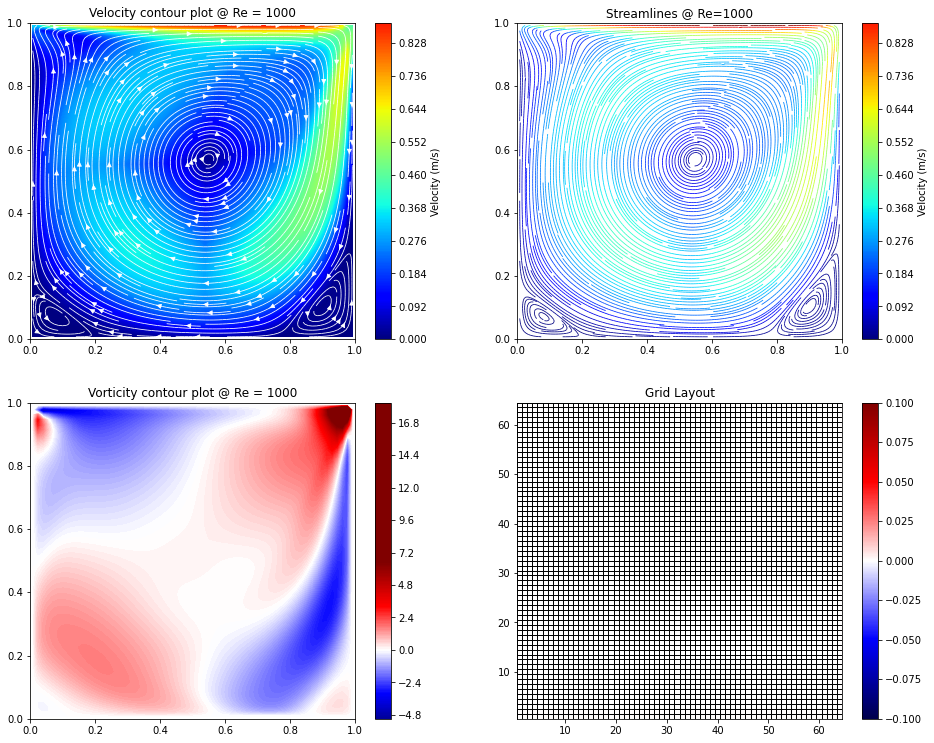

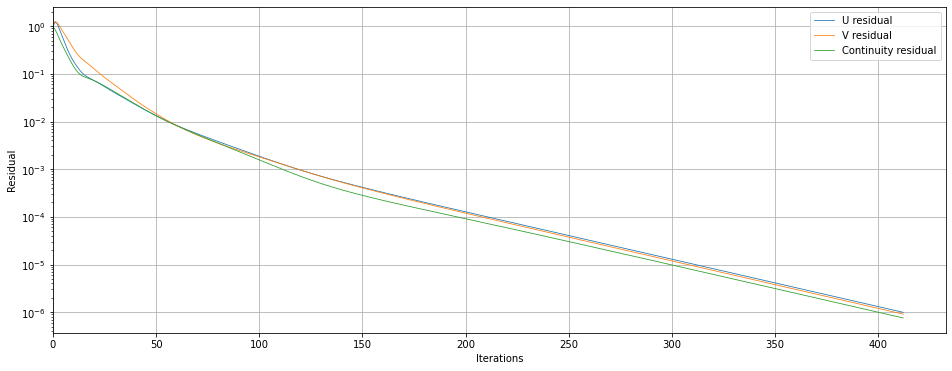

In [43]:
fig,ax=plt.subplots(2,2,figsize=(16,12.8))
ax[0][0].streamplot(xx,yy,U_final,V_final,density=2.5,color='white',linewidth=0.8)
graph=ax[0][0].contourf(xx,yy,V_mag,cmap=cm.jet,levels=255,vmax=u_wall)
ax[0][0].set_title('Velocity contour plot @ Re = '+str(Re))
fig.colorbar(graph,ax=ax[0][0],label='Velocity (m/s)')
ax[0][0].set_xlim(0,L)
ax[0][0].set_ylim(0,H)

ax[0][1].streamplot(xx,yy,U_final,V_final,density=4,color=V_mag,cmap=cm.jet,linewidth=0.8,arrowsize=0)
ax[0][1].set_title('Streamlines @ Re='+str(Re))
fig.colorbar(graph,ax=ax[0][1],label='Velocity (m/s)')
ax[0][1].set_xlim(0,L)
ax[0][1].set_ylim(0,H)

graph=ax[1][0].contourf(xx,yy,vort,cmap=cm.seismic,levels=255,vmax=6.5*u_wall,vmin=-6.5*u_wall)
ax[1][0].set_title('Vorticity contour plot @ Re = '+str(Re))
fig.colorbar(graph,ax=ax[1][0])
ax[1][0].set_xlim(0,L)
ax[1][0].set_ylim(0,H)

graph=ax[1][1].pcolormesh(xxe,yye,grid,cmap=cm.seismic,ec='k',shading='auto')
fig.colorbar(graph,ax=ax[1][1])
ax[1][1].set_title('Grid Layout')
ax[1][1].set_xlim(0.5,Nx+0.5)
ax[1][1].set_ylim(0.5,Ny+0.5)

plt.show()

iterations=np.linspace(0,len(U_res_list),len(U_res_list))
fig,ax=plt.subplots(1,1,figsize=(16,6))
plt.plot(iterations,U_res_list,label='U residual',linewidth=0.8)
plt.plot(iterations,V_res_list,label='V residual',linewidth=0.8)
plt.plot(iterations,Cont_res_list,label='Continuity residual',linewidth=0.8)
plt.xlabel('Iterations')
plt.ylabel('Residual')
ax.set_yscale('log')
plt.grid()
plt.xlim(0)
plt.legend()

plt.show()